# Hyperparameter Optimization

목차:

**[I. Hyperparameter Optimization](#one)**
- [a. Manual Search](#one-a)
- [b. Grid Search](#one-b)
- [c. Random Search](#one-c)
- [d. Evolutionary algorithm](#one-d)
- [e. Bayesian optimization](#one-e)
- [f. Hyperopt](#one-f)

**[II. Hyperopt](#two)**
- [a. hyperopt_xgboost](#two-a)
- [b. hyperopt_RandomForestClassifier](#two-b)
- [c. hyperopt_CatBoostClassifier](#two-c)

**[III. Multiclass roc_auc_curve](#three)**

- 학습을 수행하기 위해 사전에 설정해야 하는 값인 hyperparameter(하이퍼파라미터)의 최적값을 탐색하는 문제를 지칭
    * Manual Search 
        * 최적 hyperparameter 값을 직접 탐색하는 방법 
        * 한 번에 여러 종류의 hyperparameter들을 탐색하고자 할 시, 문제가 복잡
        
    * Grid Search
        * 탐색의 대상이 되는 특정 구간 내의 후보 hyperparameter값들을 일정한 간격을 두고 선정하여, 이들 각각에 대하여 측정한 성능 결과를 기록한 뒤, 가장 높은 성능을 발휘했던 hyperparameter 값을 선정하는 방법(일정 간격으로 하이퍼 파라미터값을 선택하여 성능을 측정하고, 가장 높은 성능을 보장하는 하이 퍼 파라미터값을 최적해로 도출)
        * 모든 parameter의 경우의 수에 대해 cross-validation 결과가 가장 좋은 parameter를 고르는 방법
        * Manula Search와 비교하여 좀 더 균등하고 전역적인 탐색이 가능하며 시간이 오래걸림        
        * 단점
            * 구간 전역을 탐색하기 때문에 하이퍼 파라미터의 종 류가 많아질수록 탐색 시간이 기하급수적으로 증가
            * 균일한 간격으로 탐 색하기 때문에 그림 3의 좌측 예처럼 최적 하이퍼 파라미터값을 찾지 못하는 경우가 발생
            
    * Random Search 
        * 하이퍼 파라미터 구간 내 에서 임의로 값을 선택(그리드 탐색의 단점 해결)
        * Grid Search와 비슷하나 탐색 대상 구간 내의 후보 hyperparameter 값들을 랜덤 샘플링(sampling)을 통해 선정한다는 점이 다름
        * 장점 : 불필요한 반복 탐색을 줄여 보다 빠르게 최적 하이퍼 파라미터를 발견할 수 있는 가능성을 높임
        
    * Evolutionary algorithm
        * 임의 후보해 집합(Population)을 생성한 후,‘선택-크로스오버-뮤테이션-평가’의 과정 을 반복하여 해당 집합을 업데이트함으로써 문제 에 따라 정의된 적합성 지표(Fitness)를 가장 잘 만 족시키는 해를 탐색        
        
    * Bayesian optimization 
        * Surrogate 모델 + Acquisition 함수(알려지지 않은 목적 함수를 최대로 하는 최적해를 찾는 기법)
        * 어느 입력값(x)를 받는 미지의 목적 함수(f(x) - black-box function)를 상정하여,해당 함숫값(f(x))을 최대로 만드는 최적해를 찾는 것을 목적 -> 즉, 목적 함수(탐색대상함수)와 하이퍼파라미터 쌍(pair)을 대상으로 Surrogate Model(대체 모델) 을 만들고, 순차적으로 하이퍼 파라미터를 업데이트해 가면서 평가를 통해 최적의 하이퍼파라미터 조합을 탐색
            * Surrogate Model 은, 현재까지 조사된 입력값-함숫결과값 점들 (x1, f(x1)),...,(xt, f(xt)) 을 바탕으로, 미지의 목적 함수의 형태에 대한 확률적인 추정을 수행하는 모델을 지칭
            * Acquisition Function 은, 목적 함수에 대한 현재까지의 확률적 추정 결과를 바탕으로, '최적 입력값을 찾는 데 있어 가장 유용할 만한’ 다음 입력값 후보를 추천해 주는 함수를 지칭
        * 베이지안  최적화의  최대  장점은  그리드  탐색  또는  랜덤  탐색과는  다르게  하이퍼  파라미터값  선정  과정에서  사전지식을반영한다는  점이다.  이러한  방식을  Sequential  Model-based Global  Optimization  (SMBO)이라  하고,  이는  순차적인  반복탐색  과정에서  이전  하이퍼  파라미터로부터  얻어지는  목적함수의  추정값을  이용하여  다음  하이퍼  파라미터값을  선정하는방식을  말한다(Bergsta  et  al.,  2011).
        * 순서
            * 1. 목적 함수의 대리 확률 모델 구축
            * 2. surrogate에서 가장 잘 수행되는 하이퍼 파라미터를 찾습니다.
            * 3. 이러한 하이퍼 파라미터를 실제 목적 함수에 적용
            * 4. 새 결과를 통합하는 대리 모델 업데이트
            * 5. 최대 반복 또는 시간에 도달 할 때까지 2-4 단계를 반복합니다.
            
    * Hyperopt
        * 하이퍼 파라미터 최적화를위한 최신 라이브러리중 하나
            * fmin : 최소화 메인 목적 함수
            * tpe and anneal : optimization 접근방식
            * hp : 다양한 변수들의 분포 포함
            * Trials : logging에 사용
        * Tree-structured Parzen Estimator(TPE)
            * TPE는 Hyperopt의 기본 알고리즘입니다. 최적화를 위해 베이지안 접근 방식을 사용합니다. 모든 단계에서 함수의 확률 모델을 구축하고 다음 단계에서 가장 유망한 매개 변수를 선택


In [4]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.feature_selection import RFECV

import joblib
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier, plot_importance , plot_tree
import xgboost as xgb
from catboost import CatBoostClassifier
from catboost import Pool

from sklearn.metrics import make_scorer, f1_score, precision_score, recall_score, roc_auc_score, accuracy_score,confusion_matrix,classification_report
from sklearn.model_selection import GridSearchCV,StratifiedKFold,KFold
from sklearn.model_selection import cross_val_score

#from BorutaShap import BorutaShap
from sklearn.model_selection import train_test_split

import shap
from sklearn.tree import export_graphviz
import graphviz

In [6]:
df = import_db('mart')
df1 = df.copy()
df.head(3)

,store_cd,store_nm,address,x,y,sale_avg,x_y_list,parking_200m,parking_500m,parking_1000m,...,school_yn,mart_yn,starbucks_100,starbucks_500,land_use_intensity,official_land_value,building_counts,sale_grade,sale_grade_ahi,sale_grade_hist
0,10014,개포1호점,서울특별시 강남구 선릉로48 (개포동),127.059738,37.483606,2.975689e+06,"[127.059737727687, 37.4836059941898]",0,1,22,...,1,1,0.0,0.0,120.83,3846887.30,86.0,1,1,1
1,10015,개포2호점,서울특별시 강남구 개포로512(개포동),127.068842,37.489307,5.267541e+06,"[127.068842082027, 37.4893072141263]",3,3,34,...,1,0,0.0,0.0,92.32,6539598.82,26.0,2,4,2
2,10250,소공점,서울시 중구 남대문로7길 11소공동,126.981250,37.563689,3.531775e+07,"[126.981249523015, 37.5636892672995]",20,88,334,...,0,0,1.0,15.0,437.88,38722545.14,39.0,4,5,4


In [7]:
df.drop(['store_cd','store_nm','sale_avg','address','x','y','x_y_list','sale_grade_hist','sale_grade_ahi'], axis=1, inplace=True)

In [8]:
X = df.copy()
y = X.sale_grade
X.drop('sale_grade',axis=1, inplace=True)

In [9]:
model = xgb.XGBClassifier(random_state = 0, eval_metric= 'merror', objective = 'multi:softmax')

# cv default값:  5 folds
# step: 한 회당 삭제할 피쳐 수
selector = RFECV(model, step = 1, cv = 5)
selector = selector.fit(X,y)

print(selector.estimator_)

The least populated class in y has only 2 members, which is less than n_splits=5.
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, .

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and w

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and w

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and w

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and w

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and w

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and w

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and w

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and w

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and w

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and w

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric='merror',
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=8,
              num_parallel_tree=1, objective='multi:softprob', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)


In [10]:
X_rfecv = X[X.columns[selector.support_].to_list()]
X.columns[selector.support_].to_list()

['parking_500m',
 'parking_1000m',
 'academy_200m',
 'academy_500m',
 'academy_1000m',
 'accommodation_200m',
 'accommodation_500m',
 'bike_count_200m',
 'bike_count_1000m',
 'bike_station_500m',
 'trdar_cd',
 'apt_avg_ae',
 'apt_avg_price',
 'tot_flpop_co',
 'cnsmr_popltn_co',
 'tot_repop_co',
 'total_subpas',
 'sub_500m',
 'con_30m',
 'total_worker',
 'active_pop',
 'cr_in_50m',
 'close_st_dis',
 'st_in_50m',
 'st_in_500m',
 'st_in_1000m',
 'passenger_sum_50m',
 'passenger_sum_500m',
 'trdar_se_r',
 'starbucks_100',
 'land_use_intensity',
 'official_land_value',
 'building_counts']

In [11]:
skf = StratifiedKFold(n_splits=4)
for train_index, test_index  in skf.split(X_rfecv,y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
# Train data y값 비율
unique, counts = np.unique(y_train, return_counts=True)
print("Train data set: ", dict(zip(unique, counts)))

# Test data y값 비율
unique, counts = np.unique(y_test, return_counts=True)
print("Test data set: ", dict(zip(unique, counts)))

baseline_model = xgb.XGBClassifier(eval_metric= 'merror', objective = 'multi:softmax',
                         random_state = 0
                         )
baseline_model.fit(X_train, y_train)
y_pred = baseline_model.predict(X_test)

# 오차 지표
acc_score = accuracy_score(y_test,y_pred)
# weighted : 각 레이블이 불균형 할 때 가중치 주고 계산함
f1 = f1_score(y_test, y_pred, average = 'weighted', zero_division=1)
print("Accuracy: %.2f%%" % (acc_score * 100))
print("f1_score: %.2f%%" % (f1 * 100))

Train data set:  {1: 35, 2: 15, 3: 4, 4: 2, 5: 1}
Test data set:  {1: 11, 2: 5, 3: 1, 4: 1, 5: 1}
Accuracy: 57.89%
f1_score: 55.84%


The least populated class in y has only 2 members, which is less than n_splits=4.
The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].


## hyperopt_xgboost

- hyperopt : Baysian Optimization 기반한 하이퍼파라미터 튜닝 라이브러리로 베이지안 최적화의 접근 방식을 취함 
    * 베이지안 최적화 - objective function(목적 함수)를 최대/최소로 하는 최적해를 찾는 기법입니다. 목적함수와 하이퍼파라미터의 Pair를 대상으로 Surrogate Model을 만들어 평가하면서 순차적으로 업데이트 하면서 최적의 조합을 찾아 냄

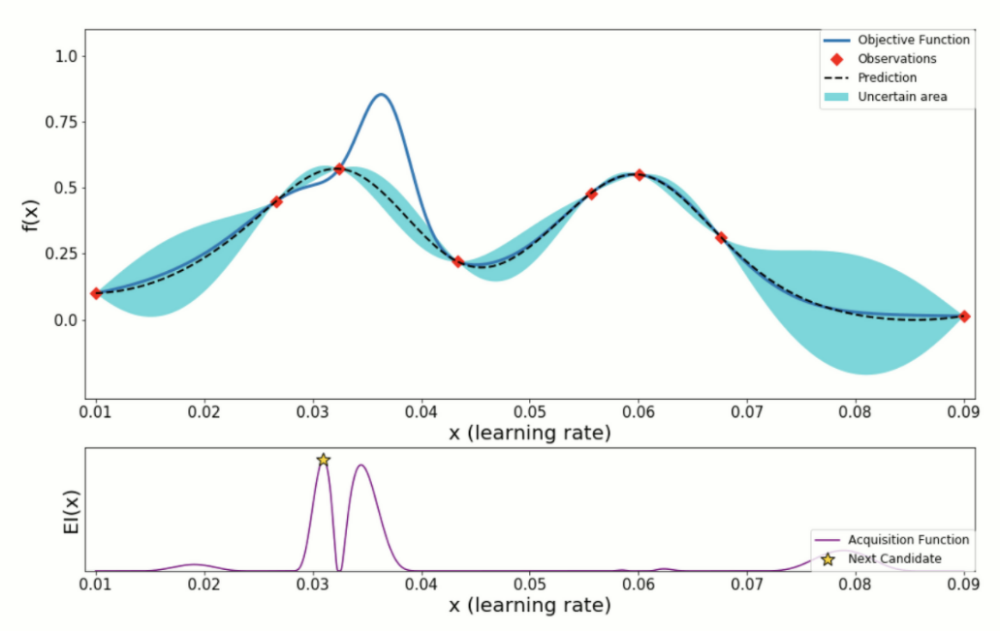

- hp.choice(하이퍼파라미터 이름, 후보군 리스트): 후보군 리스트 중에서 하나를 선택하여 대입하면서 최적의 하이퍼 파라미터를 찾습니다.
- hp.quniform(하이퍼 파라미터 이름, start, end, step): start, end까지 step 간격으로 생성된 후보군 중에서 최적의 하이퍼 파라미터를 찾습니다.
- hp.uniform(하이퍼 파라미터 이름, start, end): start, end 사이의 임의의 값 중에서 최적의 하이퍼 파라미터를 찾습니다.

- fmin : 최소화 메인 목적 함수
- tpe and anneal : optimization 접근방식
- hp : 다양한 변수들의 분포 포함
- Trials : logging에 사용
- search_space : 바꾸고 싶은 파라미터
- fmin : 최소화하기 위한 실제 함수 
- hp.choice  :  그 list 안에서 뽑는다.
- hp.uniform : 2nd , 3nd 사이에서 뽑는다.

In [16]:
from hyperopt import hp, tpe, Trials, STATUS_OK
from hyperopt import fmin

In [78]:
from hyperopt import hp, fmin, tpe, STATUS_OK, Trials

space={
                              'max_depth' : hp.choice('max_depth', range(5, 30, 1)),
                              'learning_rate' : hp.quniform('learning_rate', 0.01, 0.5, 0.01),
                              'n_estimators' : hp.choice('n_estimators', range(20, 205, 5)),
                              'gamma' : hp.quniform('gamma', 0, 0.50, 0.01),
                              'min_child_weight' : hp.quniform('min_child_weight', 1, 10, 1),
                              'subsample' : hp.quniform('subsample', 0.1, 1, 0.01),
                              'colsample_bytree' : hp.quniform('colsample_bytree', 0.1, 1.0, 0.01)}

def objective(space):
    model = xgb.XGBClassifier(max_depth = space['max_depth'],
                              learning_rate = space['learning_rate'],
                              n_estimators = space['n_estimators'],
                              gamma = space['gamma'],
                              min_child_weight = space['min_child_weight'],
                              subsample = space['subsample'],
                              colsample_bytree = space['colsample_bytree'],
                              random_state = 0, eval_metric= 'merror', objective = 'multi:softmax' 
                              )
    
    f1_xgb = cross_val_score(model, X_train, y_train, cv = skf).mean()

    # We aim to maximize accuracy, therefore we return it as a negative value
    return {'loss': -f1_xgb, 'status': STATUS_OK }
    
trials = Trials()
best = fmin(fn=objective,
            space=space,
            algo=tpe.suggest,
            max_evals = 80,
            trials= trials)
best

100%|███████████████████████████████████████████████| 80/80 [00:48<00:00,  1.65trial/s, best loss: -0.6857142857142857]


{'colsample_bytree': 0.8300000000000001,
 'gamma': 0.19,
 'learning_rate': 0.45,
 'max_depth': 20,
 'min_child_weight': 9.0,
 'n_estimators': 13,
 'subsample': 0.9500000000000001}

In [80]:
clf_xgb = xgb.XGBClassifier(max_depth = best['max_depth'],
                              learning_rate = best['learning_rate'],
                              n_estimators = best['n_estimators'],
                              gamma = best['gamma'],
                              min_child_weight = best['min_child_weight'],
                              subsample = best['subsample'],
                              colsample_bytree = best['colsample_bytree'],
                              random_state = 0, eval_metric= 'merror', objective = 'multi:softmax' 
                                      ).fit(X_train,y_train)
predictionxgb = clf_xgb.predict(X_test)
print(confusion_matrix(y_test,predictionxgb))
print(classification_report(y_test,predictionxgb))
acc5 = accuracy_score(y_test,predictionxgb)

[[10  1  0  0  0]
 [ 4  1  0  0  0]
 [ 0  1  0  0  0]
 [ 0  1  0  0  0]
 [ 0  1  0  0  0]]
              precision    recall  f1-score   support

           1       0.71      0.91      0.80        11
           2       0.20      0.20      0.20         5
           3       0.00      0.00      0.00         1
           4       0.00      0.00      0.00         1
           5       0.00      0.00      0.00         1

    accuracy                           0.58        19
   macro avg       0.18      0.22      0.20        19
weighted avg       0.47      0.58      0.52        19



In [81]:
acc_score = accuracy_score(y_test,predictionxgb)

f1 = f1_score(y_test, predictionxgb, average = 'weighted', zero_division=1)
print("Accuracy: %.2f%%" % (acc_score * 100))
print("f1_score: %.2f%%" % (f1 * 100))

Accuracy: 57.89%
f1_score: 51.58%


## hyperopt_RandomForestClassifier

In [33]:
skf = StratifiedKFold(n_splits=4)
for train_index, test_index  in skf.split(X_rfecv,y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
# Train data y값 비율
unique, counts = np.unique(y_train, return_counts=True)
print("Train data set: ", dict(zip(unique, counts)))

# Test data y값 비율
unique, counts = np.unique(y_test, return_counts=True)
print("Test data set: ", dict(zip(unique, counts)))

baseline_model = RandomForestClassifier(random_state = 4)
baseline_model.fit(X_train, y_train)
y_pred = baseline_model.predict(X_test)

# 오차 지표
acc_score = accuracy_score(y_test,y_pred)
# weighted : 각 레이블이 불균형 할 때 가중치 주고 계산함
f1 = f1_score(y_test, y_pred, average = 'weighted', zero_division=0)
print("Accuracy: %.2f%%" % (acc_score * 100))
print("f1_score: %.2f%%" % (f1 * 100))
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred))

Train data set:  {1: 35, 2: 15, 3: 4, 4: 2, 5: 1}
Test data set:  {1: 11, 2: 5, 3: 1, 4: 1, 5: 1}
Accuracy: 52.63%
f1_score: 49.27%
[[9 2 0 0 0]
 [4 1 0 0 0]
 [0 0 0 1 0]
 [0 0 1 0 0]
 [0 1 0 0 0]]
              precision    recall  f1-score   support

           1       0.69      0.82      0.75        11
           2       0.25      0.20      0.22         5
           3       0.00      0.00      0.00         1
           4       0.00      0.00      0.00         1
           5       0.00      0.00      0.00         1

    accuracy                           0.53        19
   macro avg       0.19      0.20      0.19        19
weighted avg       0.47      0.53      0.49        19



In [27]:
from hyperopt import hp, fmin, tpe, STATUS_OK, Trials

space = {'criterion': hp.choice('criterion', ['entropy', 'gini']),
        'max_depth': hp.quniform('max_depth', 10, 1200, 10),
        'max_features': hp.choice('max_features', ['auto', 'sqrt','log2', None]),
        'min_samples_leaf': hp.uniform ('min_samples_leaf', 0, 0.5),
        'min_samples_split' : hp.uniform ('min_samples_split', 0, 1),
        'n_estimators' : hp.choice('n_estimators', [10, 50, 300, 750, 1200])
    }

def objective(space):
    model = RandomForestClassifier(criterion = space['criterion'], 
                                   max_depth = space['max_depth'],
                                 max_features = space['max_features'],
                                 min_samples_leaf = space['min_samples_leaf'],
                                 min_samples_split = space['min_samples_split'],
                                 n_estimators = space['n_estimators'], 
                                 )
    
    accuracy = cross_val_score(model, X_train, y_train, cv = skf).mean()

    # We aim to maximize accuracy, therefore we return it as a negative value
    return {'loss': -accuracy, 'status': STATUS_OK }
    
trials = Trials()
best = fmin(fn= objective,
            space= space,
            algo= tpe.suggest,
            max_evals = 80,
            trials= trials)
best

100%|███████████████████████████████████████████████| 80/80 [02:49<00:00,  2.12s/trial, best loss: -0.6511904761904762]


{'criterion': 0,
 'max_depth': 250.0,
 'max_features': 1,
 'min_samples_leaf': 0.015281230464492413,
 'min_samples_split': 0.03668911387308933,
 'n_estimators': 4}

In [28]:
crit = {0: 'entropy', 1: 'gini'}
feat = {0: 'auto', 1: 'sqrt', 2: 'log2', 3: None}
est = {0: 10, 1: 50, 2: 300, 3: 750, 4: 1200}

trainedforest = RandomForestClassifier(criterion = crit[best['criterion']], 
                                       max_depth = best['max_depth'], 
                                       max_features = feat[best['max_features']], 
                                       min_samples_leaf = best['min_samples_leaf'], 
                                       min_samples_split = best['min_samples_split'], 
                                       n_estimators = est[best['n_estimators']]
                                      ).fit(X_train,y_train)
predictionforest = trainedforest.predict(X_test)
print(confusion_matrix(y_test,predictionforest))
print(classification_report(y_test,predictionforest))
acc5 = accuracy_score(y_test,predictionforest)

[[10  1  0  0  0]
 [ 4  1  0  0  0]
 [ 0  0  0  1  0]
 [ 0  0  1  0  0]
 [ 0  1  0  0  0]]
              precision    recall  f1-score   support

           1       0.71      0.91      0.80        11
           2       0.33      0.20      0.25         5
           3       0.00      0.00      0.00         1
           4       0.00      0.00      0.00         1
           5       0.00      0.00      0.00         1

    accuracy                           0.58        19
   macro avg       0.21      0.22      0.21        19
weighted avg       0.50      0.58      0.53        19



In [77]:
acc_score = accuracy_score(y_test,predictionforest)
# weighted : 각 레이블이 불균형 할 때 가중치 주고 계산함
f1 = f1_score(y_test, predictionforest, average = 'weighted', zero_division=1)
print("Accuracy: %.2f%%" % (acc_score * 100))
print("f1_score: %.2f%%" % (f1 * 100))

Accuracy: 57.89%
f1_score: 52.89%


## hyperopt_CatBoostClassifier

In [86]:
space = {'learning_rate': hp.choice('learning_rate', np.arange(0.05, 0.31, 0.05)),
         'max_depth': hp.choice('max_depth', np.arange(5, 16, 1, dtype=int)),
         'colsample_bylevel': hp.choice('colsample_bylevel', np.arange(0.3, 0.8, 0.1))}

def objective(space):
    model = CatBoostClassifier(learning_rate = space['learning_rate'],
                               max_depth = space['max_depth'],
                               colsample_bylevel = space['colsample_bylevel'])
    
    model.fit(X_train,y_train,
              eval_set = [(X_train,y_train), (X_test,y_test)],
              early_stopping_rounds = 50,
              verbose = False)
    
    accuracy = cross_val_score(model, X_train, y_train, cv = skf).mean()

    # We aim to maximize accuracy, therefore we return it as a negative value
    return {'loss': -accuracy, 'status': STATUS_OK }
    
trials = Trials()
best = fmin(fn= objective,
            space= space,
            algo= tpe.suggest,
            max_evals = 80,
            trials= trials)
best

  0%|                                                                           | 0/80 [00:00<?, ?trial/s, best loss=?]0:	learn: 1.3540961	total: 2.66ms	remaining: 2.65s
1:	learn: 1.2846049	total: 4.97ms	remaining: 2.48s
2:	learn: 1.2453558	total: 7.55ms	remaining: 2.51s
3:	learn: 1.2121887	total: 9.95ms	remaining: 2.48s
4:	learn: 1.1734808	total: 13ms	remaining: 2.59s
5:	learn: 1.1389797	total: 14.9ms	remaining: 2.47s
6:	learn: 1.1130161	total: 18.6ms	remaining: 2.63s
7:	learn: 1.0715535	total: 20.6ms	remaining: 2.55s
8:	learn: 1.0277306	total: 23ms	remaining: 2.53s
9:	learn: 1.0026248	total: 24.4ms	remaining: 2.41s
10:	learn: 0.9770250	total: 26.6ms	remaining: 2.4s
11:	learn: 0.9555814	total: 28ms	remaining: 2.3s
12:	learn: 0.9328336	total: 30ms	remaining: 2.28s
13:	learn: 0.8983728	total: 31.5ms	remaining: 2.22s
14:	learn: 0.8741776	total: 33.7ms	remaining: 2.21s
15:	learn: 0.8549741	total: 35.4ms	remaining: 2.18s
16:	learn: 0.8364479	total: 37.3ms	remaining: 2.16s
17:	learn: 0.8191

214:	learn: 0.0692847	total: 518ms	remaining: 1.89s
215:	learn: 0.0687220	total: 520ms	remaining: 1.89s
216:	learn: 0.0683073	total: 522ms	remaining: 1.88s
217:	learn: 0.0676660	total: 524ms	remaining: 1.88s
218:	learn: 0.0673020	total: 525ms	remaining: 1.87s
219:	learn: 0.0668710	total: 527ms	remaining: 1.87s
220:	learn: 0.0664053	total: 529ms	remaining: 1.86s
221:	learn: 0.0660074	total: 531ms	remaining: 1.86s
222:	learn: 0.0656924	total: 533ms	remaining: 1.86s
223:	learn: 0.0653497	total: 535ms	remaining: 1.85s
224:	learn: 0.0647567	total: 536ms	remaining: 1.85s
225:	learn: 0.0644234	total: 538ms	remaining: 1.84s
226:	learn: 0.0639826	total: 539ms	remaining: 1.84s
227:	learn: 0.0636109	total: 541ms	remaining: 1.83s
228:	learn: 0.0632305	total: 542ms	remaining: 1.82s
229:	learn: 0.0628897	total: 544ms	remaining: 1.82s
230:	learn: 0.0625965	total: 546ms	remaining: 1.82s
231:	learn: 0.0622364	total: 548ms	remaining: 1.81s
232:	learn: 0.0618644	total: 549ms	remaining: 1.81s
233:	learn: 

412:	learn: 0.0296869	total: 878ms	remaining: 1.25s
413:	learn: 0.0296068	total: 881ms	remaining: 1.25s
414:	learn: 0.0295046	total: 882ms	remaining: 1.24s
415:	learn: 0.0294195	total: 884ms	remaining: 1.24s
416:	learn: 0.0293138	total: 885ms	remaining: 1.24s
417:	learn: 0.0292302	total: 887ms	remaining: 1.24s
418:	learn: 0.0291551	total: 889ms	remaining: 1.23s
419:	learn: 0.0290547	total: 891ms	remaining: 1.23s
420:	learn: 0.0289868	total: 892ms	remaining: 1.23s
421:	learn: 0.0288826	total: 894ms	remaining: 1.23s
422:	learn: 0.0288052	total: 896ms	remaining: 1.22s
423:	learn: 0.0287336	total: 898ms	remaining: 1.22s
424:	learn: 0.0286660	total: 899ms	remaining: 1.22s
425:	learn: 0.0285891	total: 901ms	remaining: 1.21s
426:	learn: 0.0284996	total: 903ms	remaining: 1.21s
427:	learn: 0.0284051	total: 905ms	remaining: 1.21s
428:	learn: 0.0283147	total: 907ms	remaining: 1.21s
429:	learn: 0.0282611	total: 909ms	remaining: 1.2s
430:	learn: 0.0281815	total: 910ms	remaining: 1.2s
431:	learn: 0.

618:	learn: 0.0181798	total: 1.22s	remaining: 753ms
619:	learn: 0.0181451	total: 1.23s	remaining: 752ms
620:	learn: 0.0180997	total: 1.23s	remaining: 749ms
621:	learn: 0.0180654	total: 1.23s	remaining: 747ms
622:	learn: 0.0180163	total: 1.23s	remaining: 745ms
623:	learn: 0.0179916	total: 1.23s	remaining: 743ms
624:	learn: 0.0179578	total: 1.23s	remaining: 740ms
625:	learn: 0.0179246	total: 1.24s	remaining: 738ms
626:	learn: 0.0178872	total: 1.24s	remaining: 736ms
627:	learn: 0.0178542	total: 1.24s	remaining: 734ms
628:	learn: 0.0178109	total: 1.24s	remaining: 731ms
629:	learn: 0.0177758	total: 1.24s	remaining: 729ms
630:	learn: 0.0177444	total: 1.24s	remaining: 727ms
631:	learn: 0.0177021	total: 1.24s	remaining: 725ms
632:	learn: 0.0176585	total: 1.25s	remaining: 722ms
633:	learn: 0.0176270	total: 1.25s	remaining: 720ms
634:	learn: 0.0175809	total: 1.25s	remaining: 718ms
635:	learn: 0.0175520	total: 1.25s	remaining: 716ms
636:	learn: 0.0175256	total: 1.25s	remaining: 713ms
637:	learn: 

871:	learn: 0.0121316	total: 1.57s	remaining: 231ms
872:	learn: 0.0121099	total: 1.57s	remaining: 229ms
873:	learn: 0.0120827	total: 1.58s	remaining: 227ms
874:	learn: 0.0120671	total: 1.58s	remaining: 225ms
875:	learn: 0.0120512	total: 1.58s	remaining: 224ms
876:	learn: 0.0120236	total: 1.58s	remaining: 222ms
877:	learn: 0.0120053	total: 1.58s	remaining: 220ms
878:	learn: 0.0119883	total: 1.58s	remaining: 218ms
879:	learn: 0.0119756	total: 1.59s	remaining: 216ms
880:	learn: 0.0119601	total: 1.59s	remaining: 215ms
881:	learn: 0.0119471	total: 1.59s	remaining: 213ms
882:	learn: 0.0119320	total: 1.59s	remaining: 211ms
883:	learn: 0.0119047	total: 1.59s	remaining: 209ms
884:	learn: 0.0118886	total: 1.59s	remaining: 207ms
885:	learn: 0.0118714	total: 1.59s	remaining: 205ms
886:	learn: 0.0118579	total: 1.6s	remaining: 203ms
887:	learn: 0.0118316	total: 1.6s	remaining: 201ms
888:	learn: 0.0118162	total: 1.6s	remaining: 200ms
889:	learn: 0.0117962	total: 1.6s	remaining: 198ms
890:	learn: 0.01

60:	learn: 0.4322535	total: 169ms	remaining: 2.6s
61:	learn: 0.4246011	total: 171ms	remaining: 2.59s
62:	learn: 0.4179940	total: 174ms	remaining: 2.58s
63:	learn: 0.4096948	total: 176ms	remaining: 2.58s
64:	learn: 0.4003983	total: 179ms	remaining: 2.58s
65:	learn: 0.3934254	total: 181ms	remaining: 2.57s
66:	learn: 0.3877366	total: 184ms	remaining: 2.56s
67:	learn: 0.3814559	total: 186ms	remaining: 2.55s
68:	learn: 0.3741377	total: 188ms	remaining: 2.54s
69:	learn: 0.3649694	total: 190ms	remaining: 2.53s
70:	learn: 0.3587959	total: 192ms	remaining: 2.52s
71:	learn: 0.3518940	total: 194ms	remaining: 2.5s
72:	learn: 0.3454809	total: 196ms	remaining: 2.49s
73:	learn: 0.3399466	total: 198ms	remaining: 2.48s
74:	learn: 0.3326768	total: 201ms	remaining: 2.47s
75:	learn: 0.3242143	total: 203ms	remaining: 2.46s
76:	learn: 0.3193258	total: 204ms	remaining: 2.45s
77:	learn: 0.3151250	total: 206ms	remaining: 2.44s
78:	learn: 0.3099157	total: 208ms	remaining: 2.43s
79:	learn: 0.3042428	total: 211ms

296:	learn: 0.0487904	total: 695ms	remaining: 1.65s
297:	learn: 0.0485120	total: 697ms	remaining: 1.64s
298:	learn: 0.0483154	total: 699ms	remaining: 1.64s
299:	learn: 0.0481583	total: 701ms	remaining: 1.64s
300:	learn: 0.0479927	total: 703ms	remaining: 1.63s
301:	learn: 0.0477967	total: 706ms	remaining: 1.63s
302:	learn: 0.0476340	total: 708ms	remaining: 1.63s
303:	learn: 0.0474254	total: 709ms	remaining: 1.62s
304:	learn: 0.0472274	total: 711ms	remaining: 1.62s
305:	learn: 0.0470910	total: 713ms	remaining: 1.62s
306:	learn: 0.0468514	total: 715ms	remaining: 1.61s
307:	learn: 0.0466715	total: 716ms	remaining: 1.61s
308:	learn: 0.0465110	total: 718ms	remaining: 1.6s
309:	learn: 0.0463053	total: 720ms	remaining: 1.6s
310:	learn: 0.0461179	total: 722ms	remaining: 1.6s
311:	learn: 0.0459509	total: 724ms	remaining: 1.59s
312:	learn: 0.0457650	total: 725ms	remaining: 1.59s
313:	learn: 0.0455943	total: 727ms	remaining: 1.59s
314:	learn: 0.0454083	total: 729ms	remaining: 1.58s
315:	learn: 0.0

485:	learn: 0.0262403	total: 1.05s	remaining: 1.11s
486:	learn: 0.0261682	total: 1.05s	remaining: 1.11s
487:	learn: 0.0261056	total: 1.05s	remaining: 1.1s
488:	learn: 0.0260579	total: 1.05s	remaining: 1.1s
489:	learn: 0.0259989	total: 1.06s	remaining: 1.1s
490:	learn: 0.0259377	total: 1.06s	remaining: 1.1s
491:	learn: 0.0258763	total: 1.06s	remaining: 1.09s
492:	learn: 0.0258267	total: 1.06s	remaining: 1.09s
493:	learn: 0.0257657	total: 1.06s	remaining: 1.09s
494:	learn: 0.0257077	total: 1.07s	remaining: 1.09s
495:	learn: 0.0256512	total: 1.07s	remaining: 1.08s
496:	learn: 0.0255841	total: 1.07s	remaining: 1.08s
497:	learn: 0.0255274	total: 1.07s	remaining: 1.08s
498:	learn: 0.0254821	total: 1.07s	remaining: 1.08s
499:	learn: 0.0253991	total: 1.08s	remaining: 1.08s
500:	learn: 0.0253414	total: 1.08s	remaining: 1.07s
501:	learn: 0.0253053	total: 1.08s	remaining: 1.07s
502:	learn: 0.0252371	total: 1.08s	remaining: 1.07s
503:	learn: 0.0251491	total: 1.08s	remaining: 1.07s
504:	learn: 0.02

710:	learn: 0.0168131	total: 1.57s	remaining: 640ms
711:	learn: 0.0167830	total: 1.58s	remaining: 638ms
712:	learn: 0.0167580	total: 1.58s	remaining: 635ms
713:	learn: 0.0167336	total: 1.58s	remaining: 633ms
714:	learn: 0.0166998	total: 1.58s	remaining: 631ms
715:	learn: 0.0166708	total: 1.58s	remaining: 628ms
716:	learn: 0.0166477	total: 1.58s	remaining: 626ms
717:	learn: 0.0166241	total: 1.59s	remaining: 624ms
718:	learn: 0.0165974	total: 1.59s	remaining: 621ms
719:	learn: 0.0165723	total: 1.59s	remaining: 619ms
720:	learn: 0.0165452	total: 1.59s	remaining: 617ms
721:	learn: 0.0165220	total: 1.59s	remaining: 614ms
722:	learn: 0.0164924	total: 1.6s	remaining: 612ms
723:	learn: 0.0164732	total: 1.6s	remaining: 610ms
724:	learn: 0.0164364	total: 1.6s	remaining: 607ms
725:	learn: 0.0164073	total: 1.6s	remaining: 605ms
726:	learn: 0.0163749	total: 1.6s	remaining: 602ms
727:	learn: 0.0163478	total: 1.61s	remaining: 600ms
728:	learn: 0.0163096	total: 1.61s	remaining: 598ms
729:	learn: 0.016

897:	learn: 0.0128661	total: 1.93s	remaining: 219ms
898:	learn: 0.0128511	total: 1.93s	remaining: 217ms
899:	learn: 0.0128386	total: 1.93s	remaining: 215ms
900:	learn: 0.0128238	total: 1.93s	remaining: 213ms
901:	learn: 0.0128048	total: 1.94s	remaining: 210ms
902:	learn: 0.0127837	total: 1.94s	remaining: 208ms
903:	learn: 0.0127649	total: 1.94s	remaining: 206ms
904:	learn: 0.0127516	total: 1.94s	remaining: 204ms
905:	learn: 0.0127379	total: 1.95s	remaining: 202ms
906:	learn: 0.0127220	total: 1.95s	remaining: 200ms
907:	learn: 0.0127075	total: 1.95s	remaining: 198ms
908:	learn: 0.0126885	total: 1.95s	remaining: 195ms
909:	learn: 0.0126726	total: 1.95s	remaining: 193ms
910:	learn: 0.0126575	total: 1.96s	remaining: 191ms
911:	learn: 0.0126457	total: 1.96s	remaining: 189ms
912:	learn: 0.0126247	total: 1.96s	remaining: 187ms
913:	learn: 0.0126120	total: 1.96s	remaining: 185ms
914:	learn: 0.0125953	total: 1.97s	remaining: 183ms
915:	learn: 0.0125765	total: 1.97s	remaining: 180ms
916:	learn: 

65:	learn: 0.3977465	total: 189ms	remaining: 2.67s
66:	learn: 0.3905735	total: 204ms	remaining: 2.84s
67:	learn: 0.3822973	total: 208ms	remaining: 2.85s
68:	learn: 0.3755402	total: 212ms	remaining: 2.86s
69:	learn: 0.3687021	total: 216ms	remaining: 2.87s
70:	learn: 0.3629334	total: 219ms	remaining: 2.86s
71:	learn: 0.3551541	total: 222ms	remaining: 2.86s
72:	learn: 0.3477442	total: 224ms	remaining: 2.85s
73:	learn: 0.3422584	total: 227ms	remaining: 2.84s
74:	learn: 0.3369366	total: 230ms	remaining: 2.83s
75:	learn: 0.3306118	total: 232ms	remaining: 2.83s
76:	learn: 0.3236543	total: 235ms	remaining: 2.82s
77:	learn: 0.3196050	total: 237ms	remaining: 2.8s
78:	learn: 0.3152032	total: 239ms	remaining: 2.79s
79:	learn: 0.3076987	total: 241ms	remaining: 2.77s
80:	learn: 0.3033916	total: 243ms	remaining: 2.75s
81:	learn: 0.2991070	total: 245ms	remaining: 2.74s
82:	learn: 0.2948184	total: 247ms	remaining: 2.73s
83:	learn: 0.2910853	total: 249ms	remaining: 2.72s
84:	learn: 0.2875017	total: 252m

225:	learn: 0.0779501	total: 541ms	remaining: 1.85s
226:	learn: 0.0775164	total: 544ms	remaining: 1.85s
227:	learn: 0.0771716	total: 546ms	remaining: 1.85s
228:	learn: 0.0767025	total: 548ms	remaining: 1.85s
229:	learn: 0.0761691	total: 551ms	remaining: 1.84s
230:	learn: 0.0756712	total: 553ms	remaining: 1.84s
231:	learn: 0.0751673	total: 555ms	remaining: 1.84s
232:	learn: 0.0746005	total: 557ms	remaining: 1.83s
233:	learn: 0.0741587	total: 559ms	remaining: 1.83s
234:	learn: 0.0735959	total: 561ms	remaining: 1.82s
235:	learn: 0.0732137	total: 562ms	remaining: 1.82s
236:	learn: 0.0727099	total: 564ms	remaining: 1.81s
237:	learn: 0.0721180	total: 566ms	remaining: 1.81s
238:	learn: 0.0714697	total: 569ms	remaining: 1.81s
239:	learn: 0.0710368	total: 571ms	remaining: 1.81s
240:	learn: 0.0706467	total: 572ms	remaining: 1.8s
241:	learn: 0.0702662	total: 574ms	remaining: 1.8s
242:	learn: 0.0698749	total: 576ms	remaining: 1.79s
243:	learn: 0.0693686	total: 578ms	remaining: 1.79s
244:	learn: 0.

384:	learn: 0.0376207	total: 888ms	remaining: 1.42s
385:	learn: 0.0374970	total: 890ms	remaining: 1.42s
386:	learn: 0.0373917	total: 892ms	remaining: 1.41s
387:	learn: 0.0372576	total: 894ms	remaining: 1.41s
388:	learn: 0.0371243	total: 896ms	remaining: 1.41s
389:	learn: 0.0370142	total: 899ms	remaining: 1.41s
390:	learn: 0.0369123	total: 901ms	remaining: 1.4s
391:	learn: 0.0367599	total: 903ms	remaining: 1.4s
392:	learn: 0.0366191	total: 904ms	remaining: 1.4s
393:	learn: 0.0365352	total: 907ms	remaining: 1.39s
394:	learn: 0.0363971	total: 909ms	remaining: 1.39s
395:	learn: 0.0362620	total: 911ms	remaining: 1.39s
396:	learn: 0.0361267	total: 913ms	remaining: 1.39s
397:	learn: 0.0360240	total: 915ms	remaining: 1.38s
398:	learn: 0.0358722	total: 916ms	remaining: 1.38s
399:	learn: 0.0357538	total: 918ms	remaining: 1.38s
400:	learn: 0.0356471	total: 920ms	remaining: 1.37s
401:	learn: 0.0355239	total: 922ms	remaining: 1.37s
402:	learn: 0.0354141	total: 924ms	remaining: 1.37s
403:	learn: 0.0

549:	learn: 0.0240835	total: 1.24s	remaining: 1.01s
550:	learn: 0.0240361	total: 1.24s	remaining: 1.01s
551:	learn: 0.0239952	total: 1.24s	remaining: 1.01s
552:	learn: 0.0239435	total: 1.24s	remaining: 1s
553:	learn: 0.0238983	total: 1.25s	remaining: 1s
554:	learn: 0.0238544	total: 1.25s	remaining: 1s
555:	learn: 0.0238116	total: 1.25s	remaining: 998ms
556:	learn: 0.0237720	total: 1.25s	remaining: 996ms
557:	learn: 0.0237430	total: 1.25s	remaining: 993ms
558:	learn: 0.0236961	total: 1.25s	remaining: 990ms
559:	learn: 0.0236458	total: 1.26s	remaining: 988ms
560:	learn: 0.0235861	total: 1.26s	remaining: 985ms
561:	learn: 0.0235512	total: 1.26s	remaining: 983ms
562:	learn: 0.0234958	total: 1.26s	remaining: 980ms
563:	learn: 0.0234450	total: 1.26s	remaining: 978ms
564:	learn: 0.0233939	total: 1.27s	remaining: 976ms
565:	learn: 0.0233497	total: 1.27s	remaining: 974ms
566:	learn: 0.0233099	total: 1.27s	remaining: 971ms
567:	learn: 0.0232658	total: 1.27s	remaining: 969ms
568:	learn: 0.0232081

717:	learn: 0.0176324	total: 1.59s	remaining: 623ms
718:	learn: 0.0176037	total: 1.59s	remaining: 621ms
719:	learn: 0.0175780	total: 1.59s	remaining: 619ms
720:	learn: 0.0175528	total: 1.59s	remaining: 617ms
721:	learn: 0.0175243	total: 1.6s	remaining: 615ms
722:	learn: 0.0175013	total: 1.6s	remaining: 612ms
723:	learn: 0.0174763	total: 1.6s	remaining: 610ms
724:	learn: 0.0174573	total: 1.6s	remaining: 608ms
725:	learn: 0.0174333	total: 1.6s	remaining: 605ms
726:	learn: 0.0174180	total: 1.61s	remaining: 603ms
727:	learn: 0.0173845	total: 1.61s	remaining: 601ms
728:	learn: 0.0173640	total: 1.61s	remaining: 599ms
729:	learn: 0.0173392	total: 1.61s	remaining: 596ms
730:	learn: 0.0173114	total: 1.61s	remaining: 594ms
731:	learn: 0.0172784	total: 1.62s	remaining: 592ms
732:	learn: 0.0172577	total: 1.62s	remaining: 590ms
733:	learn: 0.0172360	total: 1.62s	remaining: 587ms
734:	learn: 0.0172076	total: 1.62s	remaining: 585ms
735:	learn: 0.0171783	total: 1.62s	remaining: 583ms
736:	learn: 0.017

879:	learn: 0.0140006	total: 1.93s	remaining: 264ms
880:	learn: 0.0139839	total: 1.95s	remaining: 264ms
881:	learn: 0.0139622	total: 1.95s	remaining: 261ms
882:	learn: 0.0139458	total: 1.96s	remaining: 259ms
883:	learn: 0.0139188	total: 1.96s	remaining: 257ms
884:	learn: 0.0139021	total: 1.96s	remaining: 255ms
885:	learn: 0.0138859	total: 1.97s	remaining: 253ms
886:	learn: 0.0138675	total: 1.97s	remaining: 251ms
887:	learn: 0.0138417	total: 1.97s	remaining: 248ms
888:	learn: 0.0138191	total: 1.97s	remaining: 246ms
889:	learn: 0.0138016	total: 1.97s	remaining: 244ms
890:	learn: 0.0137860	total: 1.98s	remaining: 242ms
891:	learn: 0.0137731	total: 1.98s	remaining: 240ms
892:	learn: 0.0137557	total: 1.98s	remaining: 237ms
893:	learn: 0.0137393	total: 1.98s	remaining: 235ms
894:	learn: 0.0137177	total: 1.99s	remaining: 233ms
895:	learn: 0.0136936	total: 1.99s	remaining: 231ms
896:	learn: 0.0136785	total: 1.99s	remaining: 229ms
897:	learn: 0.0136607	total: 1.99s	remaining: 226ms
898:	learn: 

72:	learn: 0.3470201	total: 179ms	remaining: 2.27s
73:	learn: 0.3387562	total: 182ms	remaining: 2.27s
74:	learn: 0.3298328	total: 184ms	remaining: 2.27s
75:	learn: 0.3245850	total: 186ms	remaining: 2.27s
76:	learn: 0.3198714	total: 189ms	remaining: 2.27s
77:	learn: 0.3138883	total: 191ms	remaining: 2.26s
78:	learn: 0.3083739	total: 194ms	remaining: 2.26s
79:	learn: 0.3036809	total: 196ms	remaining: 2.25s
80:	learn: 0.2990958	total: 198ms	remaining: 2.24s
81:	learn: 0.2942172	total: 200ms	remaining: 2.24s
82:	learn: 0.2890361	total: 202ms	remaining: 2.23s
83:	learn: 0.2856367	total: 205ms	remaining: 2.23s
84:	learn: 0.2812492	total: 208ms	remaining: 2.23s
85:	learn: 0.2757331	total: 210ms	remaining: 2.23s
86:	learn: 0.2710206	total: 212ms	remaining: 2.22s
87:	learn: 0.2668216	total: 214ms	remaining: 2.22s
88:	learn: 0.2626553	total: 216ms	remaining: 2.21s
89:	learn: 0.2586917	total: 218ms	remaining: 2.21s
90:	learn: 0.2547329	total: 221ms	remaining: 2.2s
91:	learn: 0.2504009	total: 223m

309:	learn: 0.0451863	total: 701ms	remaining: 1.56s
310:	learn: 0.0450418	total: 703ms	remaining: 1.56s
311:	learn: 0.0448416	total: 705ms	remaining: 1.55s
312:	learn: 0.0446352	total: 707ms	remaining: 1.55s
313:	learn: 0.0444314	total: 709ms	remaining: 1.55s
314:	learn: 0.0442553	total: 711ms	remaining: 1.54s
315:	learn: 0.0440830	total: 713ms	remaining: 1.54s
316:	learn: 0.0438903	total: 715ms	remaining: 1.54s
317:	learn: 0.0436568	total: 717ms	remaining: 1.54s
318:	learn: 0.0435023	total: 720ms	remaining: 1.54s
319:	learn: 0.0433379	total: 722ms	remaining: 1.53s
320:	learn: 0.0431386	total: 724ms	remaining: 1.53s
321:	learn: 0.0429873	total: 726ms	remaining: 1.53s
322:	learn: 0.0427954	total: 728ms	remaining: 1.53s
323:	learn: 0.0426580	total: 730ms	remaining: 1.52s
324:	learn: 0.0425088	total: 732ms	remaining: 1.52s
325:	learn: 0.0423813	total: 734ms	remaining: 1.52s
326:	learn: 0.0422279	total: 736ms	remaining: 1.51s
327:	learn: 0.0420370	total: 738ms	remaining: 1.51s
328:	learn: 

539:	learn: 0.0226332	total: 1.24s	remaining: 1.05s
540:	learn: 0.0225644	total: 1.24s	remaining: 1.05s
541:	learn: 0.0225163	total: 1.24s	remaining: 1.05s
542:	learn: 0.0224755	total: 1.25s	remaining: 1.05s
543:	learn: 0.0224141	total: 1.25s	remaining: 1.05s
544:	learn: 0.0223600	total: 1.25s	remaining: 1.04s
545:	learn: 0.0223070	total: 1.25s	remaining: 1.04s
546:	learn: 0.0222435	total: 1.26s	remaining: 1.04s
547:	learn: 0.0221955	total: 1.26s	remaining: 1.04s
548:	learn: 0.0221379	total: 1.26s	remaining: 1.04s
549:	learn: 0.0220681	total: 1.26s	remaining: 1.03s
550:	learn: 0.0219933	total: 1.27s	remaining: 1.03s
551:	learn: 0.0219621	total: 1.27s	remaining: 1.03s
552:	learn: 0.0219318	total: 1.27s	remaining: 1.03s
553:	learn: 0.0218838	total: 1.27s	remaining: 1.02s
554:	learn: 0.0218177	total: 1.28s	remaining: 1.02s
555:	learn: 0.0217822	total: 1.28s	remaining: 1.02s
556:	learn: 0.0217358	total: 1.28s	remaining: 1.02s
557:	learn: 0.0216903	total: 1.28s	remaining: 1.02s
558:	learn: 

765:	learn: 0.0150237	total: 1.77s	remaining: 540ms
766:	learn: 0.0150035	total: 1.77s	remaining: 538ms
767:	learn: 0.0149682	total: 1.77s	remaining: 535ms
768:	learn: 0.0149404	total: 1.77s	remaining: 533ms
769:	learn: 0.0149085	total: 1.77s	remaining: 530ms
770:	learn: 0.0148889	total: 1.78s	remaining: 528ms
771:	learn: 0.0148716	total: 1.78s	remaining: 526ms
772:	learn: 0.0148417	total: 1.78s	remaining: 523ms
773:	learn: 0.0148164	total: 1.78s	remaining: 521ms
774:	learn: 0.0147962	total: 1.79s	remaining: 519ms
775:	learn: 0.0147773	total: 1.79s	remaining: 516ms
776:	learn: 0.0147595	total: 1.79s	remaining: 514ms
777:	learn: 0.0147405	total: 1.79s	remaining: 512ms
778:	learn: 0.0147162	total: 1.79s	remaining: 509ms
779:	learn: 0.0146913	total: 1.8s	remaining: 507ms
780:	learn: 0.0146703	total: 1.8s	remaining: 505ms
781:	learn: 0.0146426	total: 1.8s	remaining: 502ms
782:	learn: 0.0146222	total: 1.8s	remaining: 500ms
783:	learn: 0.0146075	total: 1.8s	remaining: 497ms
784:	learn: 0.014

984:	learn: 0.0113329	total: 2.29s	remaining: 34.9ms
985:	learn: 0.0113205	total: 2.29s	remaining: 32.6ms
986:	learn: 0.0113037	total: 2.3s	remaining: 30.3ms
987:	learn: 0.0112893	total: 2.3s	remaining: 27.9ms
988:	learn: 0.0112765	total: 2.3s	remaining: 25.6ms
989:	learn: 0.0112632	total: 2.3s	remaining: 23.3ms
990:	learn: 0.0112506	total: 2.31s	remaining: 20.9ms
991:	learn: 0.0112367	total: 2.31s	remaining: 18.6ms
992:	learn: 0.0112258	total: 2.31s	remaining: 16.3ms
993:	learn: 0.0112180	total: 2.31s	remaining: 14ms
994:	learn: 0.0112062	total: 2.31s	remaining: 11.6ms
995:	learn: 0.0111892	total: 2.32s	remaining: 9.31ms
996:	learn: 0.0111749	total: 2.32s	remaining: 6.98ms
997:	learn: 0.0111620	total: 2.32s	remaining: 4.65ms
998:	learn: 0.0111476	total: 2.32s	remaining: 2.33ms
999:	learn: 0.0111337	total: 2.33s	remaining: 0us
  1%|▌                                               | 1/80 [00:10<13:18, 10.11s/trial, best loss: -0.6321428571428571]0:	learn: 1.3494791	total: 9.31ms	remainin

153:	learn: 0.0730696	total: 4.16s	remaining: 22.8s
154:	learn: 0.0725270	total: 4.19s	remaining: 22.8s
155:	learn: 0.0719971	total: 4.2s	remaining: 22.7s
156:	learn: 0.0712618	total: 4.21s	remaining: 22.6s
157:	learn: 0.0706781	total: 4.23s	remaining: 22.5s
158:	learn: 0.0699663	total: 4.24s	remaining: 22.4s
159:	learn: 0.0694453	total: 4.25s	remaining: 22.3s
160:	learn: 0.0690120	total: 4.26s	remaining: 22.2s
161:	learn: 0.0684376	total: 4.28s	remaining: 22.2s
162:	learn: 0.0679560	total: 4.3s	remaining: 22.1s
163:	learn: 0.0674487	total: 4.31s	remaining: 22s
164:	learn: 0.0669579	total: 4.33s	remaining: 21.9s
165:	learn: 0.0665165	total: 4.36s	remaining: 21.9s
166:	learn: 0.0659812	total: 4.36s	remaining: 21.7s
167:	learn: 0.0655042	total: 4.38s	remaining: 21.7s
168:	learn: 0.0650191	total: 4.57s	remaining: 22.5s
169:	learn: 0.0645945	total: 4.62s	remaining: 22.6s
170:	learn: 0.0641643	total: 4.64s	remaining: 22.5s
171:	learn: 0.0637019	total: 4.67s	remaining: 22.5s
172:	learn: 0.06

319:	learn: 0.0298576	total: 8.86s	remaining: 18.8s
320:	learn: 0.0297621	total: 8.86s	remaining: 18.7s
321:	learn: 0.0296655	total: 8.87s	remaining: 18.7s
322:	learn: 0.0295628	total: 8.9s	remaining: 18.7s
323:	learn: 0.0294394	total: 8.9s	remaining: 18.6s
324:	learn: 0.0293442	total: 8.93s	remaining: 18.5s
325:	learn: 0.0292423	total: 8.97s	remaining: 18.6s
326:	learn: 0.0291391	total: 8.98s	remaining: 18.5s
327:	learn: 0.0290550	total: 9.03s	remaining: 18.5s
328:	learn: 0.0289528	total: 9.08s	remaining: 18.5s
329:	learn: 0.0288510	total: 9.09s	remaining: 18.5s
330:	learn: 0.0287677	total: 9.19s	remaining: 18.6s
331:	learn: 0.0286932	total: 9.19s	remaining: 18.5s
332:	learn: 0.0286164	total: 9.21s	remaining: 18.5s
333:	learn: 0.0285169	total: 9.24s	remaining: 18.4s
334:	learn: 0.0283804	total: 9.26s	remaining: 18.4s
335:	learn: 0.0282696	total: 9.27s	remaining: 18.3s
336:	learn: 0.0281608	total: 9.32s	remaining: 18.3s
337:	learn: 0.0280623	total: 9.36s	remaining: 18.3s
338:	learn: 0.

487:	learn: 0.0183464	total: 13.5s	remaining: 14.1s
488:	learn: 0.0183103	total: 13.5s	remaining: 14.1s
489:	learn: 0.0182622	total: 13.5s	remaining: 14.1s
490:	learn: 0.0182198	total: 13.5s	remaining: 14s
491:	learn: 0.0181785	total: 13.5s	remaining: 14s
492:	learn: 0.0181405	total: 13.6s	remaining: 14s
493:	learn: 0.0181050	total: 13.6s	remaining: 13.9s
494:	learn: 0.0180749	total: 13.6s	remaining: 13.9s
495:	learn: 0.0180365	total: 13.6s	remaining: 13.8s
496:	learn: 0.0179875	total: 13.6s	remaining: 13.8s
497:	learn: 0.0179249	total: 13.7s	remaining: 13.8s
498:	learn: 0.0178917	total: 13.7s	remaining: 13.7s
499:	learn: 0.0178650	total: 13.7s	remaining: 13.7s
500:	learn: 0.0178313	total: 13.7s	remaining: 13.7s
501:	learn: 0.0177901	total: 13.8s	remaining: 13.7s
502:	learn: 0.0177551	total: 13.8s	remaining: 13.6s
503:	learn: 0.0177255	total: 13.8s	remaining: 13.6s
504:	learn: 0.0176896	total: 13.8s	remaining: 13.6s
505:	learn: 0.0176524	total: 13.9s	remaining: 13.5s
506:	learn: 0.0176

649:	learn: 0.0132024	total: 19.6s	remaining: 10.6s
650:	learn: 0.0131824	total: 19.9s	remaining: 10.6s
651:	learn: 0.0131629	total: 19.9s	remaining: 10.6s
652:	learn: 0.0131315	total: 19.9s	remaining: 10.6s
653:	learn: 0.0131148	total: 20s	remaining: 10.6s
654:	learn: 0.0130873	total: 20s	remaining: 10.5s
655:	learn: 0.0130677	total: 20s	remaining: 10.5s
656:	learn: 0.0130469	total: 20.1s	remaining: 10.5s
657:	learn: 0.0130294	total: 20.1s	remaining: 10.4s
658:	learn: 0.0130134	total: 20.1s	remaining: 10.4s
659:	learn: 0.0129879	total: 20.1s	remaining: 10.4s
660:	learn: 0.0129686	total: 20.2s	remaining: 10.3s
661:	learn: 0.0129499	total: 20.2s	remaining: 10.3s
662:	learn: 0.0129279	total: 20.3s	remaining: 10.3s
663:	learn: 0.0129107	total: 20.3s	remaining: 10.3s
664:	learn: 0.0128939	total: 20.3s	remaining: 10.2s
665:	learn: 0.0128741	total: 20.4s	remaining: 10.2s
666:	learn: 0.0128550	total: 20.4s	remaining: 10.2s
667:	learn: 0.0128325	total: 20.4s	remaining: 10.2s
668:	learn: 0.0128

809:	learn: 0.0104297	total: 25.6s	remaining: 6.01s
810:	learn: 0.0104166	total: 25.7s	remaining: 5.99s
811:	learn: 0.0103994	total: 25.7s	remaining: 5.96s
812:	learn: 0.0103868	total: 26s	remaining: 5.97s
813:	learn: 0.0103759	total: 26s	remaining: 5.94s
814:	learn: 0.0103627	total: 26s	remaining: 5.91s
815:	learn: 0.0103491	total: 26s	remaining: 5.87s
816:	learn: 0.0103350	total: 26.1s	remaining: 5.86s
817:	learn: 0.0103176	total: 26.2s	remaining: 5.82s
818:	learn: 0.0103028	total: 26.3s	remaining: 5.8s
819:	learn: 0.0102907	total: 26.3s	remaining: 5.78s
820:	learn: 0.0102722	total: 26.4s	remaining: 5.75s
821:	learn: 0.0102588	total: 26.4s	remaining: 5.71s
822:	learn: 0.0102442	total: 26.4s	remaining: 5.68s
823:	learn: 0.0102338	total: 26.4s	remaining: 5.64s
824:	learn: 0.0102179	total: 26.4s	remaining: 5.61s
825:	learn: 0.0102037	total: 26.5s	remaining: 5.57s
826:	learn: 0.0101897	total: 26.5s	remaining: 5.54s
827:	learn: 0.0101771	total: 26.5s	remaining: 5.51s
828:	learn: 0.0101642

973:	learn: 0.0085232	total: 31.1s	remaining: 831ms
974:	learn: 0.0085127	total: 31.2s	remaining: 799ms
975:	learn: 0.0085032	total: 31.2s	remaining: 766ms
976:	learn: 0.0084946	total: 31.3s	remaining: 737ms
977:	learn: 0.0084866	total: 31.3s	remaining: 704ms
978:	learn: 0.0084764	total: 31.3s	remaining: 672ms
979:	learn: 0.0084677	total: 31.3s	remaining: 640ms
980:	learn: 0.0084577	total: 31.3s	remaining: 607ms
981:	learn: 0.0084450	total: 31.5s	remaining: 577ms
982:	learn: 0.0084351	total: 31.5s	remaining: 545ms
983:	learn: 0.0084267	total: 31.5s	remaining: 512ms
984:	learn: 0.0084192	total: 31.6s	remaining: 481ms
985:	learn: 0.0084096	total: 31.6s	remaining: 448ms
986:	learn: 0.0083972	total: 31.6s	remaining: 416ms
987:	learn: 0.0083889	total: 31.6s	remaining: 384ms
988:	learn: 0.0083815	total: 31.6s	remaining: 352ms
989:	learn: 0.0083742	total: 31.8s	remaining: 321ms
990:	learn: 0.0083654	total: 31.8s	remaining: 288ms
991:	learn: 0.0083565	total: 31.8s	remaining: 256ms
992:	learn: 

140:	learn: 0.0939097	total: 5.84s	remaining: 35.6s
141:	learn: 0.0930331	total: 5.94s	remaining: 35.9s
142:	learn: 0.0922587	total: 5.96s	remaining: 35.7s
143:	learn: 0.0913311	total: 5.97s	remaining: 35.5s
144:	learn: 0.0903937	total: 5.99s	remaining: 35.3s
145:	learn: 0.0897329	total: 6.03s	remaining: 35.3s
146:	learn: 0.0891065	total: 6.07s	remaining: 35.2s
147:	learn: 0.0884853	total: 6.08s	remaining: 35s
148:	learn: 0.0876437	total: 6.16s	remaining: 35.2s
149:	learn: 0.0868810	total: 6.17s	remaining: 35s
150:	learn: 0.0860093	total: 6.2s	remaining: 34.9s
151:	learn: 0.0851170	total: 6.21s	remaining: 34.6s
152:	learn: 0.0841392	total: 6.25s	remaining: 34.6s
153:	learn: 0.0830539	total: 6.25s	remaining: 34.3s
154:	learn: 0.0822504	total: 6.25s	remaining: 34.1s
155:	learn: 0.0816723	total: 6.27s	remaining: 33.9s
156:	learn: 0.0809672	total: 6.31s	remaining: 33.9s
157:	learn: 0.0802387	total: 6.35s	remaining: 33.8s
158:	learn: 0.0794304	total: 6.42s	remaining: 33.9s
159:	learn: 0.078

299:	learn: 0.0351521	total: 12.7s	remaining: 29.7s
300:	learn: 0.0350275	total: 12.7s	remaining: 29.6s
301:	learn: 0.0348861	total: 12.8s	remaining: 29.6s
302:	learn: 0.0347252	total: 12.9s	remaining: 29.6s
303:	learn: 0.0345808	total: 12.9s	remaining: 29.5s
304:	learn: 0.0344775	total: 12.9s	remaining: 29.4s
305:	learn: 0.0343515	total: 12.9s	remaining: 29.3s
306:	learn: 0.0342413	total: 13s	remaining: 29.2s
307:	learn: 0.0341020	total: 13s	remaining: 29.1s
308:	learn: 0.0339553	total: 13s	remaining: 29.1s
309:	learn: 0.0338412	total: 13s	remaining: 29s
310:	learn: 0.0337160	total: 13s	remaining: 28.9s
311:	learn: 0.0336082	total: 13.1s	remaining: 28.9s
312:	learn: 0.0334978	total: 13.1s	remaining: 28.8s
313:	learn: 0.0333927	total: 13.1s	remaining: 28.7s
314:	learn: 0.0332532	total: 13.2s	remaining: 28.7s
315:	learn: 0.0331303	total: 13.3s	remaining: 28.8s
316:	learn: 0.0330352	total: 13.4s	remaining: 28.8s
317:	learn: 0.0329267	total: 13.6s	remaining: 29.1s
318:	learn: 0.0328192	to

463:	learn: 0.0210168	total: 22.2s	remaining: 25.6s
464:	learn: 0.0209639	total: 22.2s	remaining: 25.5s
465:	learn: 0.0209189	total: 22.2s	remaining: 25.5s
466:	learn: 0.0208761	total: 22.3s	remaining: 25.5s
467:	learn: 0.0208371	total: 22.3s	remaining: 25.4s
468:	learn: 0.0207937	total: 22.4s	remaining: 25.4s
469:	learn: 0.0207479	total: 22.5s	remaining: 25.4s
470:	learn: 0.0207131	total: 22.5s	remaining: 25.3s
471:	learn: 0.0206710	total: 22.5s	remaining: 25.2s
472:	learn: 0.0206146	total: 22.6s	remaining: 25.1s
473:	learn: 0.0205694	total: 22.6s	remaining: 25.1s
474:	learn: 0.0205120	total: 22.6s	remaining: 25s
475:	learn: 0.0204674	total: 22.9s	remaining: 25.2s
476:	learn: 0.0204160	total: 22.9s	remaining: 25.1s
477:	learn: 0.0203724	total: 22.9s	remaining: 25.1s
478:	learn: 0.0203283	total: 23s	remaining: 25.1s
479:	learn: 0.0202811	total: 23.1s	remaining: 25s
480:	learn: 0.0202366	total: 23.1s	remaining: 24.9s
481:	learn: 0.0201863	total: 23.2s	remaining: 24.9s
482:	learn: 0.0201

623:	learn: 0.0149535	total: 31.2s	remaining: 18.8s
624:	learn: 0.0149331	total: 31.2s	remaining: 18.7s
625:	learn: 0.0149071	total: 31.2s	remaining: 18.7s
626:	learn: 0.0148793	total: 31.3s	remaining: 18.6s
627:	learn: 0.0148553	total: 31.5s	remaining: 18.6s
628:	learn: 0.0148317	total: 31.5s	remaining: 18.6s
629:	learn: 0.0148064	total: 31.6s	remaining: 18.5s
630:	learn: 0.0147784	total: 31.6s	remaining: 18.5s
631:	learn: 0.0147499	total: 31.6s	remaining: 18.4s
632:	learn: 0.0147150	total: 31.6s	remaining: 18.3s
633:	learn: 0.0146880	total: 31.6s	remaining: 18.3s
634:	learn: 0.0146668	total: 31.7s	remaining: 18.2s
635:	learn: 0.0146251	total: 31.7s	remaining: 18.1s
636:	learn: 0.0145989	total: 31.7s	remaining: 18.1s
637:	learn: 0.0145741	total: 31.7s	remaining: 18s
638:	learn: 0.0145436	total: 31.7s	remaining: 17.9s
639:	learn: 0.0145253	total: 31.8s	remaining: 17.9s
640:	learn: 0.0145045	total: 31.8s	remaining: 17.8s
641:	learn: 0.0144800	total: 31.8s	remaining: 17.8s
642:	learn: 0.

785:	learn: 0.0115970	total: 39.8s	remaining: 10.8s
786:	learn: 0.0115752	total: 39.9s	remaining: 10.8s
787:	learn: 0.0115585	total: 39.9s	remaining: 10.7s
788:	learn: 0.0115454	total: 39.9s	remaining: 10.7s
789:	learn: 0.0115334	total: 39.9s	remaining: 10.6s
790:	learn: 0.0115072	total: 40s	remaining: 10.6s
791:	learn: 0.0114902	total: 40s	remaining: 10.5s
792:	learn: 0.0114706	total: 40s	remaining: 10.4s
793:	learn: 0.0114504	total: 40.1s	remaining: 10.4s
794:	learn: 0.0114346	total: 40.2s	remaining: 10.4s
795:	learn: 0.0114201	total: 40.2s	remaining: 10.3s
796:	learn: 0.0114013	total: 40.3s	remaining: 10.3s
797:	learn: 0.0113871	total: 40.3s	remaining: 10.2s
798:	learn: 0.0113731	total: 40.6s	remaining: 10.2s
799:	learn: 0.0113487	total: 40.6s	remaining: 10.1s
800:	learn: 0.0113352	total: 40.6s	remaining: 10.1s
801:	learn: 0.0113223	total: 40.6s	remaining: 10s
802:	learn: 0.0113094	total: 40.6s	remaining: 9.97s
803:	learn: 0.0112884	total: 40.6s	remaining: 9.91s
804:	learn: 0.011273

947:	learn: 0.0094650	total: 49.2s	remaining: 2.7s
948:	learn: 0.0094535	total: 49.2s	remaining: 2.65s
949:	learn: 0.0094432	total: 49.2s	remaining: 2.59s
950:	learn: 0.0094335	total: 49.3s	remaining: 2.54s
951:	learn: 0.0094243	total: 49.4s	remaining: 2.49s
952:	learn: 0.0094145	total: 49.5s	remaining: 2.44s
953:	learn: 0.0094011	total: 49.5s	remaining: 2.39s
954:	learn: 0.0093937	total: 49.6s	remaining: 2.34s
955:	learn: 0.0093834	total: 49.8s	remaining: 2.29s
956:	learn: 0.0093734	total: 49.9s	remaining: 2.24s
957:	learn: 0.0093626	total: 50s	remaining: 2.19s
958:	learn: 0.0093530	total: 50s	remaining: 2.14s
959:	learn: 0.0093407	total: 50s	remaining: 2.08s
960:	learn: 0.0093319	total: 50.1s	remaining: 2.03s
961:	learn: 0.0093202	total: 50.1s	remaining: 1.98s
962:	learn: 0.0093091	total: 50.2s	remaining: 1.93s
963:	learn: 0.0093000	total: 50.2s	remaining: 1.88s
964:	learn: 0.0092914	total: 50.3s	remaining: 1.82s
965:	learn: 0.0092812	total: 50.4s	remaining: 1.77s
966:	learn: 0.00926

109:	learn: 0.1345319	total: 3.9s	remaining: 31.6s
110:	learn: 0.1331877	total: 4s	remaining: 32s
111:	learn: 0.1315148	total: 4.01s	remaining: 31.8s
112:	learn: 0.1297881	total: 4.05s	remaining: 31.8s
113:	learn: 0.1283725	total: 4.13s	remaining: 32.1s
114:	learn: 0.1267984	total: 4.14s	remaining: 31.9s
115:	learn: 0.1255604	total: 4.18s	remaining: 31.8s
116:	learn: 0.1230604	total: 4.18s	remaining: 31.6s
117:	learn: 0.1215901	total: 4.33s	remaining: 32.3s
118:	learn: 0.1200003	total: 4.35s	remaining: 32.2s
119:	learn: 0.1185320	total: 4.39s	remaining: 32.2s
120:	learn: 0.1172717	total: 4.43s	remaining: 32.2s
121:	learn: 0.1159812	total: 4.47s	remaining: 32.2s
122:	learn: 0.1149258	total: 4.55s	remaining: 32.4s
123:	learn: 0.1137830	total: 4.57s	remaining: 32.3s
124:	learn: 0.1125951	total: 4.88s	remaining: 34.2s
125:	learn: 0.1115097	total: 5.04s	remaining: 35s
126:	learn: 0.1105416	total: 5.13s	remaining: 35.2s
127:	learn: 0.1090984	total: 5.17s	remaining: 35.2s
128:	learn: 0.108252

270:	learn: 0.0424830	total: 14.9s	remaining: 40s
271:	learn: 0.0423201	total: 14.9s	remaining: 40s
272:	learn: 0.0421147	total: 14.9s	remaining: 39.8s
273:	learn: 0.0419361	total: 15s	remaining: 39.7s
274:	learn: 0.0417427	total: 15s	remaining: 39.5s
275:	learn: 0.0415248	total: 15s	remaining: 39.4s
276:	learn: 0.0413282	total: 15.1s	remaining: 39.4s
277:	learn: 0.0411086	total: 15.3s	remaining: 39.6s
278:	learn: 0.0409109	total: 15.3s	remaining: 39.5s
279:	learn: 0.0407083	total: 15.3s	remaining: 39.4s
280:	learn: 0.0405315	total: 15.4s	remaining: 39.4s
281:	learn: 0.0403957	total: 15.4s	remaining: 39.3s
282:	learn: 0.0402472	total: 15.4s	remaining: 39.1s
283:	learn: 0.0401097	total: 15.5s	remaining: 39s
284:	learn: 0.0399508	total: 15.5s	remaining: 38.9s
285:	learn: 0.0397275	total: 15.6s	remaining: 38.9s
286:	learn: 0.0395541	total: 15.6s	remaining: 38.8s
287:	learn: 0.0394079	total: 15.7s	remaining: 38.7s
288:	learn: 0.0392598	total: 15.7s	remaining: 38.7s
289:	learn: 0.0391101	to

432:	learn: 0.0239633	total: 24.5s	remaining: 32s
433:	learn: 0.0239061	total: 24.6s	remaining: 32s
434:	learn: 0.0238523	total: 24.6s	remaining: 32s
435:	learn: 0.0237953	total: 24.6s	remaining: 31.8s
436:	learn: 0.0237403	total: 24.7s	remaining: 31.8s
437:	learn: 0.0236231	total: 24.7s	remaining: 31.7s
438:	learn: 0.0235766	total: 24.7s	remaining: 31.6s
439:	learn: 0.0235000	total: 24.7s	remaining: 31.4s
440:	learn: 0.0234443	total: 24.9s	remaining: 31.6s
441:	learn: 0.0233873	total: 25.1s	remaining: 31.7s
442:	learn: 0.0233319	total: 25.1s	remaining: 31.6s
443:	learn: 0.0232683	total: 25.1s	remaining: 31.5s
444:	learn: 0.0232142	total: 25.2s	remaining: 31.4s
445:	learn: 0.0231346	total: 25.4s	remaining: 31.5s
446:	learn: 0.0230635	total: 25.4s	remaining: 31.4s
447:	learn: 0.0230143	total: 25.6s	remaining: 31.5s
448:	learn: 0.0229585	total: 25.6s	remaining: 31.5s
449:	learn: 0.0229112	total: 25.7s	remaining: 31.4s
450:	learn: 0.0228576	total: 25.7s	remaining: 31.3s
451:	learn: 0.0228

593:	learn: 0.0167596	total: 32.1s	remaining: 22s
594:	learn: 0.0167299	total: 32.1s	remaining: 21.9s
595:	learn: 0.0167013	total: 32.1s	remaining: 21.8s
596:	learn: 0.0166710	total: 32.2s	remaining: 21.8s
597:	learn: 0.0166484	total: 32.2s	remaining: 21.7s
598:	learn: 0.0166232	total: 32.3s	remaining: 21.6s
599:	learn: 0.0165902	total: 32.3s	remaining: 21.5s
600:	learn: 0.0165582	total: 32.4s	remaining: 21.5s
601:	learn: 0.0165314	total: 32.4s	remaining: 21.4s
602:	learn: 0.0165001	total: 32.4s	remaining: 21.4s
603:	learn: 0.0164755	total: 32.5s	remaining: 21.3s
604:	learn: 0.0164433	total: 32.5s	remaining: 21.2s
605:	learn: 0.0164150	total: 32.7s	remaining: 21.2s
606:	learn: 0.0163900	total: 32.7s	remaining: 21.2s
607:	learn: 0.0163585	total: 32.7s	remaining: 21.1s
608:	learn: 0.0163253	total: 32.9s	remaining: 21.1s
609:	learn: 0.0162988	total: 32.9s	remaining: 21s
610:	learn: 0.0162708	total: 32.9s	remaining: 21s
611:	learn: 0.0162459	total: 33s	remaining: 20.9s
612:	learn: 0.016216

753:	learn: 0.0128866	total: 40.1s	remaining: 13.1s
754:	learn: 0.0128712	total: 40.2s	remaining: 13.1s
755:	learn: 0.0128544	total: 40.2s	remaining: 13s
756:	learn: 0.0128306	total: 40.3s	remaining: 12.9s
757:	learn: 0.0128176	total: 40.3s	remaining: 12.9s
758:	learn: 0.0128032	total: 40.3s	remaining: 12.8s
759:	learn: 0.0127875	total: 40.4s	remaining: 12.8s
760:	learn: 0.0127698	total: 40.4s	remaining: 12.7s
761:	learn: 0.0127395	total: 40.4s	remaining: 12.6s
762:	learn: 0.0127223	total: 40.5s	remaining: 12.6s
763:	learn: 0.0127067	total: 40.5s	remaining: 12.5s
764:	learn: 0.0126900	total: 40.8s	remaining: 12.5s
765:	learn: 0.0126681	total: 40.8s	remaining: 12.5s
766:	learn: 0.0126525	total: 40.9s	remaining: 12.4s
767:	learn: 0.0126301	total: 40.9s	remaining: 12.4s
768:	learn: 0.0126125	total: 40.9s	remaining: 12.3s
769:	learn: 0.0125872	total: 40.9s	remaining: 12.2s
770:	learn: 0.0125703	total: 41s	remaining: 12.2s
771:	learn: 0.0125485	total: 41s	remaining: 12.1s
772:	learn: 0.0125

912:	learn: 0.0103566	total: 48.3s	remaining: 4.6s
913:	learn: 0.0103398	total: 48.3s	remaining: 4.55s
914:	learn: 0.0103291	total: 48.5s	remaining: 4.5s
915:	learn: 0.0103189	total: 48.7s	remaining: 4.46s
916:	learn: 0.0103065	total: 48.7s	remaining: 4.41s
917:	learn: 0.0102918	total: 48.8s	remaining: 4.36s
918:	learn: 0.0102825	total: 48.9s	remaining: 4.31s
919:	learn: 0.0102727	total: 49s	remaining: 4.26s
920:	learn: 0.0102484	total: 49s	remaining: 4.2s
921:	learn: 0.0102373	total: 49s	remaining: 4.15s
922:	learn: 0.0102242	total: 49.1s	remaining: 4.09s
923:	learn: 0.0102137	total: 49.2s	remaining: 4.04s
924:	learn: 0.0102044	total: 49.3s	remaining: 4s
925:	learn: 0.0101926	total: 49.3s	remaining: 3.94s
926:	learn: 0.0101818	total: 49.5s	remaining: 3.9s
927:	learn: 0.0101719	total: 49.6s	remaining: 3.84s
928:	learn: 0.0101591	total: 49.6s	remaining: 3.79s
929:	learn: 0.0101475	total: 49.6s	remaining: 3.73s
930:	learn: 0.0101360	total: 49.6s	remaining: 3.68s
931:	learn: 0.0101265	tot

75:	learn: 0.2238307	total: 3.52s	remaining: 42.8s
76:	learn: 0.2189533	total: 3.53s	remaining: 42.3s
77:	learn: 0.2154040	total: 3.55s	remaining: 41.9s
78:	learn: 0.2118010	total: 3.55s	remaining: 41.4s
79:	learn: 0.2080216	total: 3.59s	remaining: 41.3s
80:	learn: 0.2044421	total: 3.68s	remaining: 41.7s
81:	learn: 0.2010572	total: 3.7s	remaining: 41.4s
82:	learn: 0.1974681	total: 3.74s	remaining: 41.3s
83:	learn: 0.1947073	total: 3.76s	remaining: 41s
84:	learn: 0.1920085	total: 3.79s	remaining: 40.7s
85:	learn: 0.1889066	total: 3.82s	remaining: 40.6s
86:	learn: 0.1847453	total: 3.84s	remaining: 40.3s
87:	learn: 0.1821171	total: 4s	remaining: 41.4s
88:	learn: 0.1792775	total: 4s	remaining: 41s
89:	learn: 0.1767514	total: 4.1s	remaining: 41.5s
90:	learn: 0.1742189	total: 4.14s	remaining: 41.3s
91:	learn: 0.1716727	total: 4.15s	remaining: 41s
92:	learn: 0.1691842	total: 4.17s	remaining: 40.7s
93:	learn: 0.1665918	total: 4.21s	remaining: 40.6s
94:	learn: 0.1632849	total: 4.3s	remaining: 4

236:	learn: 0.0477344	total: 12s	remaining: 38.7s
237:	learn: 0.0473259	total: 12s	remaining: 38.5s
238:	learn: 0.0471065	total: 12.1s	remaining: 38.4s
239:	learn: 0.0469070	total: 12.1s	remaining: 38.3s
240:	learn: 0.0466540	total: 12.1s	remaining: 38.2s
241:	learn: 0.0464213	total: 12.2s	remaining: 38.1s
242:	learn: 0.0459121	total: 12.2s	remaining: 37.9s
243:	learn: 0.0456580	total: 12.3s	remaining: 38.2s
244:	learn: 0.0454421	total: 12.4s	remaining: 38.4s
245:	learn: 0.0451661	total: 12.5s	remaining: 38.2s
246:	learn: 0.0449804	total: 12.5s	remaining: 38.1s
247:	learn: 0.0446144	total: 12.5s	remaining: 37.9s
248:	learn: 0.0443321	total: 12.5s	remaining: 37.7s
249:	learn: 0.0441244	total: 12.6s	remaining: 37.7s
250:	learn: 0.0439285	total: 12.6s	remaining: 37.5s
251:	learn: 0.0437134	total: 12.6s	remaining: 37.4s
252:	learn: 0.0435278	total: 12.8s	remaining: 37.7s
253:	learn: 0.0433420	total: 12.8s	remaining: 37.6s
254:	learn: 0.0431030	total: 12.8s	remaining: 37.5s
255:	learn: 0.04

399:	learn: 0.0249460	total: 19.7s	remaining: 29.5s
400:	learn: 0.0248920	total: 19.7s	remaining: 29.4s
401:	learn: 0.0248274	total: 19.8s	remaining: 29.4s
402:	learn: 0.0247544	total: 19.8s	remaining: 29.3s
403:	learn: 0.0247000	total: 19.8s	remaining: 29.2s
404:	learn: 0.0246226	total: 19.8s	remaining: 29.2s
405:	learn: 0.0245622	total: 19.9s	remaining: 29.1s
406:	learn: 0.0244774	total: 19.9s	remaining: 29s
407:	learn: 0.0244135	total: 19.9s	remaining: 28.9s
408:	learn: 0.0243478	total: 20.1s	remaining: 29s
409:	learn: 0.0242613	total: 20.1s	remaining: 29s
410:	learn: 0.0242085	total: 20.2s	remaining: 28.9s
411:	learn: 0.0241446	total: 20.3s	remaining: 28.9s
412:	learn: 0.0240745	total: 20.3s	remaining: 28.8s
413:	learn: 0.0240044	total: 20.3s	remaining: 28.8s
414:	learn: 0.0239406	total: 20.4s	remaining: 28.8s
415:	learn: 0.0238819	total: 20.4s	remaining: 28.7s
416:	learn: 0.0238217	total: 20.5s	remaining: 28.6s
417:	learn: 0.0237636	total: 20.5s	remaining: 28.5s
418:	learn: 0.0236

558:	learn: 0.0171043	total: 26.7s	remaining: 21.1s
559:	learn: 0.0170640	total: 26.7s	remaining: 21s
560:	learn: 0.0170311	total: 26.8s	remaining: 20.9s
561:	learn: 0.0170006	total: 27.1s	remaining: 21.1s
562:	learn: 0.0169637	total: 27.1s	remaining: 21s
563:	learn: 0.0169299	total: 27.1s	remaining: 21s
564:	learn: 0.0169001	total: 27.2s	remaining: 20.9s
565:	learn: 0.0168760	total: 27.3s	remaining: 20.9s
566:	learn: 0.0168453	total: 27.3s	remaining: 20.8s
567:	learn: 0.0168164	total: 27.3s	remaining: 20.7s
568:	learn: 0.0167772	total: 27.3s	remaining: 20.7s
569:	learn: 0.0167471	total: 27.4s	remaining: 20.7s
570:	learn: 0.0167191	total: 27.5s	remaining: 20.6s
571:	learn: 0.0166853	total: 27.5s	remaining: 20.6s
572:	learn: 0.0166560	total: 27.5s	remaining: 20.5s
573:	learn: 0.0166238	total: 27.6s	remaining: 20.4s
574:	learn: 0.0165798	total: 27.6s	remaining: 20.4s
575:	learn: 0.0165167	total: 27.6s	remaining: 20.3s
576:	learn: 0.0164858	total: 27.6s	remaining: 20.2s
577:	learn: 0.0164

723:	learn: 0.0128583	total: 34.9s	remaining: 13.3s
724:	learn: 0.0128346	total: 34.9s	remaining: 13.2s
725:	learn: 0.0128196	total: 34.9s	remaining: 13.2s
726:	learn: 0.0127860	total: 34.9s	remaining: 13.1s
727:	learn: 0.0127679	total: 35s	remaining: 13.1s
728:	learn: 0.0127527	total: 35s	remaining: 13s
729:	learn: 0.0127247	total: 35s	remaining: 12.9s
730:	learn: 0.0127058	total: 35s	remaining: 12.9s
731:	learn: 0.0126911	total: 35.1s	remaining: 12.8s
732:	learn: 0.0126716	total: 35.1s	remaining: 12.8s
733:	learn: 0.0126510	total: 35.2s	remaining: 12.8s
734:	learn: 0.0126335	total: 35.2s	remaining: 12.7s
735:	learn: 0.0126134	total: 35.3s	remaining: 12.7s
736:	learn: 0.0125998	total: 35.3s	remaining: 12.6s
737:	learn: 0.0125835	total: 35.4s	remaining: 12.6s
738:	learn: 0.0125525	total: 35.4s	remaining: 12.5s
739:	learn: 0.0125387	total: 35.6s	remaining: 12.5s
740:	learn: 0.0125216	total: 35.6s	remaining: 12.4s
741:	learn: 0.0125052	total: 35.6s	remaining: 12.4s
742:	learn: 0.0124902	

883:	learn: 0.0103400	total: 43.2s	remaining: 5.67s
884:	learn: 0.0103269	total: 43.3s	remaining: 5.63s
885:	learn: 0.0103152	total: 43.3s	remaining: 5.57s
886:	learn: 0.0103034	total: 43.4s	remaining: 5.53s
887:	learn: 0.0102918	total: 43.4s	remaining: 5.47s
888:	learn: 0.0102782	total: 43.4s	remaining: 5.42s
889:	learn: 0.0102686	total: 43.5s	remaining: 5.37s
890:	learn: 0.0102552	total: 43.5s	remaining: 5.32s
891:	learn: 0.0102413	total: 43.6s	remaining: 5.28s
892:	learn: 0.0102279	total: 43.9s	remaining: 5.25s
893:	learn: 0.0102158	total: 43.9s	remaining: 5.21s
894:	learn: 0.0102030	total: 43.9s	remaining: 5.16s
895:	learn: 0.0101925	total: 44.3s	remaining: 5.14s
896:	learn: 0.0101734	total: 44.3s	remaining: 5.09s
897:	learn: 0.0101633	total: 44.5s	remaining: 5.05s
898:	learn: 0.0101527	total: 44.5s	remaining: 5s
899:	learn: 0.0101363	total: 44.5s	remaining: 4.94s
900:	learn: 0.0101249	total: 44.5s	remaining: 4.89s
901:	learn: 0.0101116	total: 44.6s	remaining: 4.84s
902:	learn: 0.0

66:	learn: 0.3313774	total: 359ms	remaining: 5s
67:	learn: 0.3269382	total: 364ms	remaining: 4.99s
68:	learn: 0.3164497	total: 369ms	remaining: 4.98s
69:	learn: 0.3125107	total: 375ms	remaining: 4.98s
70:	learn: 0.3049198	total: 380ms	remaining: 4.97s
71:	learn: 0.2995310	total: 385ms	remaining: 4.96s
72:	learn: 0.2940954	total: 390ms	remaining: 4.95s
73:	learn: 0.2894599	total: 393ms	remaining: 4.92s
74:	learn: 0.2838707	total: 399ms	remaining: 4.91s
75:	learn: 0.2798732	total: 402ms	remaining: 4.89s
76:	learn: 0.2757435	total: 408ms	remaining: 4.89s
77:	learn: 0.2724341	total: 414ms	remaining: 4.89s
78:	learn: 0.2678137	total: 418ms	remaining: 4.88s
79:	learn: 0.2635953	total: 424ms	remaining: 4.87s
80:	learn: 0.2585184	total: 430ms	remaining: 4.87s
81:	learn: 0.2544012	total: 434ms	remaining: 4.86s
82:	learn: 0.2497255	total: 437ms	remaining: 4.83s
83:	learn: 0.2459637	total: 443ms	remaining: 4.83s
84:	learn: 0.2418459	total: 448ms	remaining: 4.82s
85:	learn: 0.2379058	total: 452ms	

251:	learn: 0.0538798	total: 1.24s	remaining: 3.69s
252:	learn: 0.0536179	total: 1.25s	remaining: 3.68s
253:	learn: 0.0533702	total: 1.25s	remaining: 3.68s
254:	learn: 0.0531077	total: 1.25s	remaining: 3.67s
255:	learn: 0.0528681	total: 1.26s	remaining: 3.67s
256:	learn: 0.0525869	total: 1.27s	remaining: 3.66s
257:	learn: 0.0521967	total: 1.27s	remaining: 3.65s
258:	learn: 0.0519001	total: 1.28s	remaining: 3.65s
259:	learn: 0.0516654	total: 1.28s	remaining: 3.65s
260:	learn: 0.0514615	total: 1.29s	remaining: 3.65s
261:	learn: 0.0512051	total: 1.29s	remaining: 3.64s
262:	learn: 0.0509558	total: 1.3s	remaining: 3.64s
263:	learn: 0.0507391	total: 1.3s	remaining: 3.63s
264:	learn: 0.0504848	total: 1.31s	remaining: 3.63s
265:	learn: 0.0502614	total: 1.31s	remaining: 3.62s
266:	learn: 0.0500498	total: 1.32s	remaining: 3.62s
267:	learn: 0.0496734	total: 1.32s	remaining: 3.62s
268:	learn: 0.0494859	total: 1.33s	remaining: 3.62s
269:	learn: 0.0491470	total: 1.33s	remaining: 3.61s
270:	learn: 0.

437:	learn: 0.0271734	total: 2.13s	remaining: 2.73s
438:	learn: 0.0270956	total: 2.14s	remaining: 2.73s
439:	learn: 0.0270167	total: 2.14s	remaining: 2.73s
440:	learn: 0.0269573	total: 2.15s	remaining: 2.72s
441:	learn: 0.0268958	total: 2.15s	remaining: 2.72s
442:	learn: 0.0268357	total: 2.16s	remaining: 2.71s
443:	learn: 0.0267627	total: 2.16s	remaining: 2.71s
444:	learn: 0.0266997	total: 2.17s	remaining: 2.7s
445:	learn: 0.0266315	total: 2.17s	remaining: 2.7s
446:	learn: 0.0265730	total: 2.18s	remaining: 2.69s
447:	learn: 0.0264996	total: 2.18s	remaining: 2.69s
448:	learn: 0.0264391	total: 2.19s	remaining: 2.68s
449:	learn: 0.0263636	total: 2.19s	remaining: 2.68s
450:	learn: 0.0263046	total: 2.2s	remaining: 2.67s
451:	learn: 0.0262358	total: 2.2s	remaining: 2.67s
452:	learn: 0.0261804	total: 2.21s	remaining: 2.66s
453:	learn: 0.0260966	total: 2.21s	remaining: 2.66s
454:	learn: 0.0260154	total: 2.21s	remaining: 2.65s
455:	learn: 0.0259626	total: 2.22s	remaining: 2.65s
456:	learn: 0.02

628:	learn: 0.0175378	total: 3.03s	remaining: 1.79s
629:	learn: 0.0175074	total: 3.04s	remaining: 1.78s
630:	learn: 0.0174756	total: 3.04s	remaining: 1.78s
631:	learn: 0.0174376	total: 3.04s	remaining: 1.77s
632:	learn: 0.0174077	total: 3.05s	remaining: 1.77s
633:	learn: 0.0173793	total: 3.05s	remaining: 1.76s
634:	learn: 0.0173566	total: 3.06s	remaining: 1.76s
635:	learn: 0.0173269	total: 3.06s	remaining: 1.75s
636:	learn: 0.0172979	total: 3.06s	remaining: 1.75s
637:	learn: 0.0172587	total: 3.07s	remaining: 1.74s
638:	learn: 0.0172290	total: 3.07s	remaining: 1.74s
639:	learn: 0.0171996	total: 3.07s	remaining: 1.73s
640:	learn: 0.0171779	total: 3.08s	remaining: 1.72s
641:	learn: 0.0171510	total: 3.08s	remaining: 1.72s
642:	learn: 0.0171246	total: 3.08s	remaining: 1.71s
643:	learn: 0.0170938	total: 3.09s	remaining: 1.71s
644:	learn: 0.0170649	total: 3.09s	remaining: 1.7s
645:	learn: 0.0170356	total: 3.1s	remaining: 1.7s
646:	learn: 0.0169969	total: 3.11s	remaining: 1.7s
647:	learn: 0.01

833:	learn: 0.0127006	total: 3.92s	remaining: 780ms
834:	learn: 0.0126833	total: 3.92s	remaining: 775ms
835:	learn: 0.0126633	total: 3.93s	remaining: 771ms
836:	learn: 0.0126491	total: 3.93s	remaining: 766ms
837:	learn: 0.0126296	total: 3.94s	remaining: 761ms
838:	learn: 0.0126105	total: 3.94s	remaining: 756ms
839:	learn: 0.0125911	total: 3.95s	remaining: 752ms
840:	learn: 0.0125755	total: 3.95s	remaining: 747ms
841:	learn: 0.0125588	total: 3.96s	remaining: 742ms
842:	learn: 0.0125321	total: 3.96s	remaining: 738ms
843:	learn: 0.0125118	total: 3.97s	remaining: 733ms
844:	learn: 0.0124917	total: 3.97s	remaining: 729ms
845:	learn: 0.0124758	total: 3.98s	remaining: 724ms
846:	learn: 0.0124545	total: 3.98s	remaining: 719ms
847:	learn: 0.0124348	total: 3.99s	remaining: 715ms
848:	learn: 0.0124173	total: 4s	remaining: 711ms
849:	learn: 0.0123992	total: 4s	remaining: 706ms
850:	learn: 0.0123837	total: 4s	remaining: 701ms
851:	learn: 0.0123674	total: 4.01s	remaining: 697ms
852:	learn: 0.0123470

0:	learn: 1.5600107	total: 5.8ms	remaining: 5.79s
1:	learn: 1.5038729	total: 11.8ms	remaining: 5.88s
2:	learn: 1.4709167	total: 17.9ms	remaining: 5.96s
3:	learn: 1.4242079	total: 24.2ms	remaining: 6.03s
4:	learn: 1.3849842	total: 30.4ms	remaining: 6.05s
5:	learn: 1.3492180	total: 35.6ms	remaining: 5.9s
6:	learn: 1.3158035	total: 41.1ms	remaining: 5.82s
7:	learn: 1.2903859	total: 46.9ms	remaining: 5.82s
8:	learn: 1.2670086	total: 53.7ms	remaining: 5.92s
9:	learn: 1.2379394	total: 58.8ms	remaining: 5.82s
10:	learn: 1.2075787	total: 65.4ms	remaining: 5.88s
11:	learn: 1.1751650	total: 70.5ms	remaining: 5.8s
12:	learn: 1.1525992	total: 82.5ms	remaining: 6.27s
13:	learn: 1.1164259	total: 88.4ms	remaining: 6.22s
14:	learn: 1.0925359	total: 95.5ms	remaining: 6.27s
15:	learn: 1.0720000	total: 101ms	remaining: 6.22s
16:	learn: 1.0467056	total: 107ms	remaining: 6.19s
17:	learn: 1.0197518	total: 113ms	remaining: 6.17s
18:	learn: 0.9996460	total: 119ms	remaining: 6.13s
19:	learn: 0.9779344	total: 1

178:	learn: 0.1001061	total: 1.27s	remaining: 5.82s
179:	learn: 0.0990588	total: 1.28s	remaining: 5.82s
180:	learn: 0.0977518	total: 1.28s	remaining: 5.81s
181:	learn: 0.0970368	total: 1.29s	remaining: 5.8s
182:	learn: 0.0963812	total: 1.3s	remaining: 5.79s
183:	learn: 0.0956446	total: 1.3s	remaining: 5.77s
184:	learn: 0.0947816	total: 1.31s	remaining: 5.76s
185:	learn: 0.0941046	total: 1.31s	remaining: 5.75s
186:	learn: 0.0933351	total: 1.32s	remaining: 5.74s
187:	learn: 0.0923994	total: 1.32s	remaining: 5.72s
188:	learn: 0.0917054	total: 1.33s	remaining: 5.71s
189:	learn: 0.0912091	total: 1.34s	remaining: 5.7s
190:	learn: 0.0905720	total: 1.34s	remaining: 5.69s
191:	learn: 0.0899178	total: 1.35s	remaining: 5.68s
192:	learn: 0.0891485	total: 1.36s	remaining: 5.67s
193:	learn: 0.0885031	total: 1.36s	remaining: 5.66s
194:	learn: 0.0879235	total: 1.37s	remaining: 5.66s
195:	learn: 0.0872752	total: 1.38s	remaining: 5.64s
196:	learn: 0.0865508	total: 1.38s	remaining: 5.64s
197:	learn: 0.08

338:	learn: 0.0413880	total: 2.34s	remaining: 4.57s
339:	learn: 0.0412484	total: 2.35s	remaining: 4.57s
340:	learn: 0.0410896	total: 2.36s	remaining: 4.57s
341:	learn: 0.0409708	total: 2.37s	remaining: 4.56s
342:	learn: 0.0408228	total: 2.38s	remaining: 4.55s
343:	learn: 0.0406644	total: 2.38s	remaining: 4.54s
344:	learn: 0.0405135	total: 2.39s	remaining: 4.54s
345:	learn: 0.0403721	total: 2.4s	remaining: 4.53s
346:	learn: 0.0402007	total: 2.4s	remaining: 4.53s
347:	learn: 0.0400624	total: 2.41s	remaining: 4.52s
348:	learn: 0.0399197	total: 2.42s	remaining: 4.51s
349:	learn: 0.0397097	total: 2.42s	remaining: 4.5s
350:	learn: 0.0395446	total: 2.43s	remaining: 4.5s
351:	learn: 0.0393792	total: 2.44s	remaining: 4.49s
352:	learn: 0.0392486	total: 2.44s	remaining: 4.48s
353:	learn: 0.0391150	total: 2.45s	remaining: 4.47s
354:	learn: 0.0389949	total: 2.46s	remaining: 4.46s
355:	learn: 0.0388296	total: 2.46s	remaining: 4.46s
356:	learn: 0.0387244	total: 2.47s	remaining: 4.45s
357:	learn: 0.03

505:	learn: 0.0250647	total: 3.43s	remaining: 3.35s
506:	learn: 0.0250100	total: 3.44s	remaining: 3.34s
507:	learn: 0.0249445	total: 3.46s	remaining: 3.35s
508:	learn: 0.0248882	total: 3.47s	remaining: 3.34s
509:	learn: 0.0248303	total: 3.47s	remaining: 3.34s
510:	learn: 0.0247626	total: 3.48s	remaining: 3.33s
511:	learn: 0.0247187	total: 3.49s	remaining: 3.33s
512:	learn: 0.0246567	total: 3.5s	remaining: 3.32s
513:	learn: 0.0245856	total: 3.5s	remaining: 3.31s
514:	learn: 0.0245319	total: 3.51s	remaining: 3.3s
515:	learn: 0.0244847	total: 3.52s	remaining: 3.3s
516:	learn: 0.0244340	total: 3.52s	remaining: 3.29s
517:	learn: 0.0243687	total: 3.53s	remaining: 3.28s
518:	learn: 0.0242727	total: 3.54s	remaining: 3.28s
519:	learn: 0.0242271	total: 3.54s	remaining: 3.27s
520:	learn: 0.0241677	total: 3.55s	remaining: 3.26s
521:	learn: 0.0241158	total: 3.56s	remaining: 3.26s
522:	learn: 0.0240627	total: 3.56s	remaining: 3.25s
523:	learn: 0.0240015	total: 3.57s	remaining: 3.24s
524:	learn: 0.02

676:	learn: 0.0176412	total: 4.7s	remaining: 2.24s
677:	learn: 0.0176089	total: 4.72s	remaining: 2.24s
678:	learn: 0.0175640	total: 4.73s	remaining: 2.23s
679:	learn: 0.0175303	total: 4.74s	remaining: 2.23s
680:	learn: 0.0175088	total: 4.75s	remaining: 2.22s
681:	learn: 0.0174803	total: 4.75s	remaining: 2.22s
682:	learn: 0.0174561	total: 4.76s	remaining: 2.21s
683:	learn: 0.0174308	total: 4.77s	remaining: 2.2s
684:	learn: 0.0174091	total: 4.78s	remaining: 2.2s
685:	learn: 0.0173782	total: 4.79s	remaining: 2.19s
686:	learn: 0.0173490	total: 4.8s	remaining: 2.19s
687:	learn: 0.0173059	total: 4.81s	remaining: 2.18s
688:	learn: 0.0172637	total: 4.82s	remaining: 2.17s
689:	learn: 0.0172417	total: 4.82s	remaining: 2.17s
690:	learn: 0.0172160	total: 4.83s	remaining: 2.16s
691:	learn: 0.0171838	total: 4.85s	remaining: 2.16s
692:	learn: 0.0171515	total: 4.86s	remaining: 2.15s
693:	learn: 0.0171298	total: 4.87s	remaining: 2.15s
694:	learn: 0.0171034	total: 4.88s	remaining: 2.14s
695:	learn: 0.01

836:	learn: 0.0138061	total: 6.16s	remaining: 1.2s
837:	learn: 0.0137821	total: 6.17s	remaining: 1.19s
838:	learn: 0.0137651	total: 6.18s	remaining: 1.19s
839:	learn: 0.0137482	total: 6.19s	remaining: 1.18s
840:	learn: 0.0137353	total: 6.2s	remaining: 1.17s
841:	learn: 0.0137206	total: 6.21s	remaining: 1.17s
842:	learn: 0.0137009	total: 6.22s	remaining: 1.16s
843:	learn: 0.0136851	total: 6.23s	remaining: 1.15s
844:	learn: 0.0136652	total: 6.24s	remaining: 1.14s
845:	learn: 0.0136454	total: 6.24s	remaining: 1.14s
846:	learn: 0.0136173	total: 6.25s	remaining: 1.13s
847:	learn: 0.0136000	total: 6.26s	remaining: 1.12s
848:	learn: 0.0135832	total: 6.27s	remaining: 1.11s
849:	learn: 0.0135667	total: 6.28s	remaining: 1.11s
850:	learn: 0.0135543	total: 6.29s	remaining: 1.1s
851:	learn: 0.0135333	total: 6.29s	remaining: 1.09s
852:	learn: 0.0135154	total: 6.3s	remaining: 1.08s
853:	learn: 0.0135004	total: 6.31s	remaining: 1.08s
854:	learn: 0.0134814	total: 6.32s	remaining: 1.07s
855:	learn: 0.01

1:	learn: 1.5123540	total: 13.8ms	remaining: 6.86s
2:	learn: 1.4750339	total: 21.6ms	remaining: 7.17s
3:	learn: 1.4459624	total: 30.1ms	remaining: 7.49s
4:	learn: 1.3833238	total: 35.6ms	remaining: 7.08s
5:	learn: 1.3567311	total: 44.1ms	remaining: 7.31s
6:	learn: 1.3109805	total: 53.5ms	remaining: 7.59s
7:	learn: 1.2793321	total: 61.3ms	remaining: 7.6s
8:	learn: 1.2537506	total: 71.4ms	remaining: 7.86s
9:	learn: 1.2064236	total: 80.9ms	remaining: 8.01s
10:	learn: 1.1728325	total: 93.4ms	remaining: 8.4s
11:	learn: 1.1403172	total: 108ms	remaining: 8.87s
12:	learn: 1.1167514	total: 118ms	remaining: 8.93s
13:	learn: 1.0950123	total: 129ms	remaining: 9.08s
14:	learn: 1.0619789	total: 141ms	remaining: 9.24s
15:	learn: 1.0409221	total: 149ms	remaining: 9.17s
16:	learn: 1.0174105	total: 159ms	remaining: 9.22s
17:	learn: 0.9935343	total: 169ms	remaining: 9.23s
18:	learn: 0.9674161	total: 181ms	remaining: 9.36s
19:	learn: 0.9483872	total: 190ms	remaining: 9.3s
20:	learn: 0.9235289	total: 204ms

189:	learn: 0.0942514	total: 1.69s	remaining: 7.21s
190:	learn: 0.0933981	total: 1.7s	remaining: 7.2s
191:	learn: 0.0927277	total: 1.71s	remaining: 7.18s
192:	learn: 0.0920563	total: 1.71s	remaining: 7.16s
193:	learn: 0.0916147	total: 1.72s	remaining: 7.14s
194:	learn: 0.0908068	total: 1.72s	remaining: 7.12s
195:	learn: 0.0903396	total: 1.73s	remaining: 7.1s
196:	learn: 0.0897030	total: 1.74s	remaining: 7.08s
197:	learn: 0.0892087	total: 1.74s	remaining: 7.06s
198:	learn: 0.0886962	total: 1.75s	remaining: 7.04s
199:	learn: 0.0882180	total: 1.75s	remaining: 7.02s
200:	learn: 0.0877049	total: 1.77s	remaining: 7.02s
201:	learn: 0.0871795	total: 1.77s	remaining: 7s
202:	learn: 0.0864634	total: 1.78s	remaining: 6.98s
203:	learn: 0.0859272	total: 1.78s	remaining: 6.97s
204:	learn: 0.0853540	total: 1.8s	remaining: 6.97s
205:	learn: 0.0847767	total: 1.81s	remaining: 6.99s
206:	learn: 0.0841660	total: 1.82s	remaining: 6.96s
207:	learn: 0.0835797	total: 1.82s	remaining: 6.95s
208:	learn: 0.08309

369:	learn: 0.0387113	total: 2.96s	remaining: 5.04s
370:	learn: 0.0385956	total: 2.97s	remaining: 5.03s
371:	learn: 0.0384406	total: 2.98s	remaining: 5.02s
372:	learn: 0.0383083	total: 2.98s	remaining: 5.01s
373:	learn: 0.0381821	total: 2.99s	remaining: 5s
374:	learn: 0.0380290	total: 2.99s	remaining: 4.99s
375:	learn: 0.0379251	total: 3s	remaining: 4.98s
376:	learn: 0.0377892	total: 3.01s	remaining: 4.97s
377:	learn: 0.0376796	total: 3.01s	remaining: 4.96s
378:	learn: 0.0375624	total: 3.02s	remaining: 4.94s
379:	learn: 0.0374544	total: 3.02s	remaining: 4.93s
380:	learn: 0.0373398	total: 3.03s	remaining: 4.93s
381:	learn: 0.0372077	total: 3.04s	remaining: 4.92s
382:	learn: 0.0371076	total: 3.05s	remaining: 4.91s
383:	learn: 0.0369740	total: 3.05s	remaining: 4.9s
384:	learn: 0.0368942	total: 3.06s	remaining: 4.89s
385:	learn: 0.0367746	total: 3.06s	remaining: 4.88s
386:	learn: 0.0366517	total: 3.07s	remaining: 4.86s
387:	learn: 0.0365317	total: 3.08s	remaining: 4.85s
388:	learn: 0.03639

548:	learn: 0.0237353	total: 4.22s	remaining: 3.47s
549:	learn: 0.0236855	total: 4.23s	remaining: 3.46s
550:	learn: 0.0236303	total: 4.23s	remaining: 3.45s
551:	learn: 0.0235850	total: 4.24s	remaining: 3.44s
552:	learn: 0.0235208	total: 4.24s	remaining: 3.43s
553:	learn: 0.0234774	total: 4.25s	remaining: 3.42s
554:	learn: 0.0234233	total: 4.25s	remaining: 3.41s
555:	learn: 0.0233853	total: 4.26s	remaining: 3.4s
556:	learn: 0.0233325	total: 4.26s	remaining: 3.39s
557:	learn: 0.0232893	total: 4.27s	remaining: 3.38s
558:	learn: 0.0232335	total: 4.28s	remaining: 3.37s
559:	learn: 0.0231797	total: 4.28s	remaining: 3.36s
560:	learn: 0.0231381	total: 4.29s	remaining: 3.35s
561:	learn: 0.0230811	total: 4.29s	remaining: 3.34s
562:	learn: 0.0230317	total: 4.29s	remaining: 3.33s
563:	learn: 0.0229832	total: 4.3s	remaining: 3.32s
564:	learn: 0.0229385	total: 4.3s	remaining: 3.31s
565:	learn: 0.0228769	total: 4.31s	remaining: 3.31s
566:	learn: 0.0228234	total: 4.32s	remaining: 3.29s
567:	learn: 0.0

707:	learn: 0.0175090	total: 5.13s	remaining: 2.11s
708:	learn: 0.0174800	total: 5.13s	remaining: 2.1s
709:	learn: 0.0174471	total: 5.13s	remaining: 2.1s
710:	learn: 0.0174262	total: 5.14s	remaining: 2.09s
711:	learn: 0.0174015	total: 5.14s	remaining: 2.08s
712:	learn: 0.0173727	total: 5.15s	remaining: 2.07s
713:	learn: 0.0173441	total: 5.16s	remaining: 2.07s
714:	learn: 0.0173194	total: 5.16s	remaining: 2.06s
715:	learn: 0.0172883	total: 5.17s	remaining: 2.05s
716:	learn: 0.0172635	total: 5.17s	remaining: 2.04s
717:	learn: 0.0172351	total: 5.18s	remaining: 2.03s
718:	learn: 0.0172002	total: 5.18s	remaining: 2.02s
719:	learn: 0.0171718	total: 5.19s	remaining: 2.02s
720:	learn: 0.0171482	total: 5.19s	remaining: 2.01s
721:	learn: 0.0171241	total: 5.2s	remaining: 2s
722:	learn: 0.0171006	total: 5.2s	remaining: 1.99s
723:	learn: 0.0170727	total: 5.21s	remaining: 1.98s
724:	learn: 0.0170439	total: 5.21s	remaining: 1.98s
725:	learn: 0.0170232	total: 5.22s	remaining: 1.97s
726:	learn: 0.01700

880:	learn: 0.0136469	total: 6.02s	remaining: 813ms
881:	learn: 0.0136273	total: 6.02s	remaining: 806ms
882:	learn: 0.0136120	total: 6.03s	remaining: 799ms
883:	learn: 0.0135899	total: 6.03s	remaining: 791ms
884:	learn: 0.0135762	total: 6.04s	remaining: 784ms
885:	learn: 0.0135551	total: 6.04s	remaining: 777ms
886:	learn: 0.0135380	total: 6.05s	remaining: 770ms
887:	learn: 0.0135185	total: 6.05s	remaining: 763ms
888:	learn: 0.0135013	total: 6.06s	remaining: 756ms
889:	learn: 0.0134845	total: 6.06s	remaining: 749ms
890:	learn: 0.0134657	total: 6.07s	remaining: 742ms
891:	learn: 0.0134496	total: 6.07s	remaining: 735ms
892:	learn: 0.0134269	total: 6.07s	remaining: 728ms
893:	learn: 0.0134087	total: 6.08s	remaining: 721ms
894:	learn: 0.0133923	total: 6.08s	remaining: 714ms
895:	learn: 0.0133659	total: 6.09s	remaining: 706ms
896:	learn: 0.0133516	total: 6.09s	remaining: 699ms
897:	learn: 0.0133388	total: 6.09s	remaining: 692ms
898:	learn: 0.0133234	total: 6.1s	remaining: 685ms
899:	learn: 0

43:	learn: 0.5968738	total: 238ms	remaining: 5.16s
44:	learn: 0.5854513	total: 244ms	remaining: 5.19s
45:	learn: 0.5722068	total: 251ms	remaining: 5.2s
46:	learn: 0.5607093	total: 257ms	remaining: 5.21s
47:	learn: 0.5515582	total: 262ms	remaining: 5.2s
48:	learn: 0.5417497	total: 268ms	remaining: 5.19s
49:	learn: 0.5310284	total: 273ms	remaining: 5.19s
50:	learn: 0.5213635	total: 278ms	remaining: 5.18s
51:	learn: 0.5113280	total: 283ms	remaining: 5.16s
52:	learn: 0.5024443	total: 289ms	remaining: 5.17s
53:	learn: 0.4922877	total: 295ms	remaining: 5.17s
54:	learn: 0.4840851	total: 301ms	remaining: 5.17s
55:	learn: 0.4727560	total: 306ms	remaining: 5.16s
56:	learn: 0.4645324	total: 314ms	remaining: 5.2s
57:	learn: 0.4561219	total: 323ms	remaining: 5.24s
58:	learn: 0.4473429	total: 328ms	remaining: 5.22s
59:	learn: 0.4400511	total: 335ms	remaining: 5.24s
60:	learn: 0.4306928	total: 342ms	remaining: 5.27s
61:	learn: 0.4237881	total: 349ms	remaining: 5.28s
62:	learn: 0.4165397	total: 356ms	

229:	learn: 0.0691349	total: 1.31s	remaining: 4.38s
230:	learn: 0.0687602	total: 1.31s	remaining: 4.38s
231:	learn: 0.0683482	total: 1.32s	remaining: 4.37s
232:	learn: 0.0680188	total: 1.32s	remaining: 4.36s
233:	learn: 0.0676371	total: 1.33s	remaining: 4.36s
234:	learn: 0.0673097	total: 1.34s	remaining: 4.35s
235:	learn: 0.0669421	total: 1.34s	remaining: 4.34s
236:	learn: 0.0666144	total: 1.35s	remaining: 4.34s
237:	learn: 0.0663074	total: 1.35s	remaining: 4.33s
238:	learn: 0.0659119	total: 1.36s	remaining: 4.32s
239:	learn: 0.0655780	total: 1.36s	remaining: 4.32s
240:	learn: 0.0652946	total: 1.37s	remaining: 4.31s
241:	learn: 0.0650098	total: 1.37s	remaining: 4.3s
242:	learn: 0.0647585	total: 1.38s	remaining: 4.3s
243:	learn: 0.0644700	total: 1.38s	remaining: 4.29s
244:	learn: 0.0641942	total: 1.39s	remaining: 4.28s
245:	learn: 0.0639020	total: 1.39s	remaining: 4.27s
246:	learn: 0.0636193	total: 1.4s	remaining: 4.26s
247:	learn: 0.0633459	total: 1.4s	remaining: 4.25s
248:	learn: 0.06

392:	learn: 0.0349886	total: 2.2s	remaining: 3.4s
393:	learn: 0.0348528	total: 2.21s	remaining: 3.4s
394:	learn: 0.0347550	total: 2.21s	remaining: 3.39s
395:	learn: 0.0346340	total: 2.22s	remaining: 3.38s
396:	learn: 0.0345297	total: 2.22s	remaining: 3.38s
397:	learn: 0.0344139	total: 2.23s	remaining: 3.37s
398:	learn: 0.0343195	total: 2.23s	remaining: 3.36s
399:	learn: 0.0341980	total: 2.24s	remaining: 3.36s
400:	learn: 0.0340935	total: 2.24s	remaining: 3.35s
401:	learn: 0.0339712	total: 2.25s	remaining: 3.34s
402:	learn: 0.0338842	total: 2.25s	remaining: 3.33s
403:	learn: 0.0338038	total: 2.25s	remaining: 3.33s
404:	learn: 0.0337191	total: 2.26s	remaining: 3.32s
405:	learn: 0.0335790	total: 2.3s	remaining: 3.36s
406:	learn: 0.0334531	total: 2.31s	remaining: 3.36s
407:	learn: 0.0332711	total: 2.31s	remaining: 3.36s
408:	learn: 0.0331620	total: 2.32s	remaining: 3.35s
409:	learn: 0.0330312	total: 2.33s	remaining: 3.35s
410:	learn: 0.0329660	total: 2.33s	remaining: 3.34s
411:	learn: 0.03

557:	learn: 0.0226870	total: 3.09s	remaining: 2.45s
558:	learn: 0.0226269	total: 3.1s	remaining: 2.44s
559:	learn: 0.0225734	total: 3.1s	remaining: 2.44s
560:	learn: 0.0225272	total: 3.11s	remaining: 2.43s
561:	learn: 0.0224854	total: 3.11s	remaining: 2.43s
562:	learn: 0.0224419	total: 3.12s	remaining: 2.42s
563:	learn: 0.0223933	total: 3.12s	remaining: 2.41s
564:	learn: 0.0223428	total: 3.13s	remaining: 2.41s
565:	learn: 0.0222860	total: 3.13s	remaining: 2.4s
566:	learn: 0.0222377	total: 3.14s	remaining: 2.4s
567:	learn: 0.0221938	total: 3.15s	remaining: 2.39s
568:	learn: 0.0221455	total: 3.15s	remaining: 2.39s
569:	learn: 0.0220970	total: 3.15s	remaining: 2.38s
570:	learn: 0.0220624	total: 3.16s	remaining: 2.37s
571:	learn: 0.0220188	total: 3.17s	remaining: 2.37s
572:	learn: 0.0219526	total: 3.17s	remaining: 2.36s
573:	learn: 0.0219062	total: 3.17s	remaining: 2.36s
574:	learn: 0.0218745	total: 3.18s	remaining: 2.35s
575:	learn: 0.0218365	total: 3.19s	remaining: 2.35s
576:	learn: 0.02

730:	learn: 0.0165137	total: 3.99s	remaining: 1.47s
731:	learn: 0.0164891	total: 3.99s	remaining: 1.46s
732:	learn: 0.0164628	total: 4s	remaining: 1.46s
733:	learn: 0.0164290	total: 4.01s	remaining: 1.45s
734:	learn: 0.0163970	total: 4.02s	remaining: 1.45s
735:	learn: 0.0163744	total: 4.03s	remaining: 1.44s
736:	learn: 0.0163512	total: 4.03s	remaining: 1.44s
737:	learn: 0.0163252	total: 4.04s	remaining: 1.43s
738:	learn: 0.0163007	total: 4.05s	remaining: 1.43s
739:	learn: 0.0162794	total: 4.05s	remaining: 1.42s
740:	learn: 0.0162572	total: 4.06s	remaining: 1.42s
741:	learn: 0.0162187	total: 4.07s	remaining: 1.41s
742:	learn: 0.0161986	total: 4.08s	remaining: 1.41s
743:	learn: 0.0161622	total: 4.08s	remaining: 1.4s
744:	learn: 0.0161413	total: 4.09s	remaining: 1.4s
745:	learn: 0.0161206	total: 4.1s	remaining: 1.39s
746:	learn: 0.0160976	total: 4.1s	remaining: 1.39s
747:	learn: 0.0160729	total: 4.11s	remaining: 1.38s
748:	learn: 0.0160519	total: 4.11s	remaining: 1.38s
749:	learn: 0.01603

899:	learn: 0.0129918	total: 5.06s	remaining: 562ms
900:	learn: 0.0129761	total: 5.07s	remaining: 557ms
901:	learn: 0.0129582	total: 5.07s	remaining: 551ms
902:	learn: 0.0129362	total: 5.08s	remaining: 545ms
903:	learn: 0.0129179	total: 5.08s	remaining: 540ms
904:	learn: 0.0129046	total: 5.09s	remaining: 534ms
905:	learn: 0.0128911	total: 5.09s	remaining: 529ms
906:	learn: 0.0128749	total: 5.1s	remaining: 523ms
907:	learn: 0.0128564	total: 5.11s	remaining: 518ms
908:	learn: 0.0128361	total: 5.11s	remaining: 512ms
909:	learn: 0.0128211	total: 5.12s	remaining: 506ms
910:	learn: 0.0128078	total: 5.13s	remaining: 501ms
911:	learn: 0.0127923	total: 5.13s	remaining: 495ms
912:	learn: 0.0127762	total: 5.14s	remaining: 490ms
913:	learn: 0.0127618	total: 5.14s	remaining: 484ms
914:	learn: 0.0127476	total: 5.15s	remaining: 479ms
915:	learn: 0.0127142	total: 5.16s	remaining: 473ms
916:	learn: 0.0126920	total: 5.16s	remaining: 467ms
917:	learn: 0.0126765	total: 5.17s	remaining: 462ms
918:	learn: 0

81:	learn: 0.1638528	total: 570ms	remaining: 6.38s
82:	learn: 0.1608601	total: 578ms	remaining: 6.38s
83:	learn: 0.1582157	total: 585ms	remaining: 6.38s
84:	learn: 0.1557999	total: 590ms	remaining: 6.35s
85:	learn: 0.1536486	total: 597ms	remaining: 6.34s
86:	learn: 0.1507697	total: 600ms	remaining: 6.29s
87:	learn: 0.1483959	total: 606ms	remaining: 6.28s
88:	learn: 0.1462122	total: 612ms	remaining: 6.26s
89:	learn: 0.1443668	total: 617ms	remaining: 6.23s
90:	learn: 0.1424177	total: 618ms	remaining: 6.17s
91:	learn: 0.1402450	total: 623ms	remaining: 6.15s
92:	learn: 0.1372951	total: 625ms	remaining: 6.09s
93:	learn: 0.1356120	total: 630ms	remaining: 6.08s
94:	learn: 0.1341419	total: 638ms	remaining: 6.08s
95:	learn: 0.1324127	total: 644ms	remaining: 6.06s
96:	learn: 0.1307836	total: 648ms	remaining: 6.04s
97:	learn: 0.1292549	total: 653ms	remaining: 6.01s
98:	learn: 0.1274905	total: 659ms	remaining: 5.99s
99:	learn: 0.1259814	total: 664ms	remaining: 5.98s
100:	learn: 0.1244489	total: 66

253:	learn: 0.0378654	total: 1.65s	remaining: 4.86s
254:	learn: 0.0376976	total: 1.66s	remaining: 4.86s
255:	learn: 0.0375497	total: 1.67s	remaining: 4.84s
256:	learn: 0.0373129	total: 1.67s	remaining: 4.84s
257:	learn: 0.0370704	total: 1.68s	remaining: 4.83s
258:	learn: 0.0368534	total: 1.68s	remaining: 4.81s
259:	learn: 0.0366954	total: 1.69s	remaining: 4.8s
260:	learn: 0.0365571	total: 1.69s	remaining: 4.8s
261:	learn: 0.0364094	total: 1.7s	remaining: 4.79s
262:	learn: 0.0362660	total: 1.71s	remaining: 4.78s
263:	learn: 0.0360742	total: 1.71s	remaining: 4.78s
264:	learn: 0.0359179	total: 1.72s	remaining: 4.77s
265:	learn: 0.0357588	total: 1.73s	remaining: 4.76s
266:	learn: 0.0355847	total: 1.73s	remaining: 4.76s
267:	learn: 0.0354419	total: 1.74s	remaining: 4.75s
268:	learn: 0.0353004	total: 1.74s	remaining: 4.74s
269:	learn: 0.0351382	total: 1.75s	remaining: 4.73s
270:	learn: 0.0350168	total: 1.75s	remaining: 4.72s
271:	learn: 0.0348542	total: 1.76s	remaining: 4.72s
272:	learn: 0.0

423:	learn: 0.0209808	total: 2.96s	remaining: 4.02s
424:	learn: 0.0209322	total: 2.97s	remaining: 4.01s
425:	learn: 0.0208752	total: 2.98s	remaining: 4.01s
426:	learn: 0.0208172	total: 2.98s	remaining: 4s
427:	learn: 0.0207566	total: 2.99s	remaining: 4s
428:	learn: 0.0207012	total: 3s	remaining: 3.99s
429:	learn: 0.0206572	total: 3.01s	remaining: 3.98s
430:	learn: 0.0206091	total: 3.01s	remaining: 3.98s
431:	learn: 0.0205509	total: 3.02s	remaining: 3.97s
432:	learn: 0.0204886	total: 3.03s	remaining: 3.97s
433:	learn: 0.0204344	total: 3.04s	remaining: 3.96s
434:	learn: 0.0203799	total: 3.04s	remaining: 3.96s
435:	learn: 0.0203086	total: 3.05s	remaining: 3.95s
436:	learn: 0.0202630	total: 3.06s	remaining: 3.94s
437:	learn: 0.0201979	total: 3.06s	remaining: 3.93s
438:	learn: 0.0201443	total: 3.07s	remaining: 3.93s
439:	learn: 0.0200843	total: 3.08s	remaining: 3.92s
440:	learn: 0.0200243	total: 3.09s	remaining: 3.92s
441:	learn: 0.0199860	total: 3.1s	remaining: 3.91s
442:	learn: 0.0199439	

586:	learn: 0.0145076	total: 4.06s	remaining: 2.86s
587:	learn: 0.0144848	total: 4.07s	remaining: 2.85s
588:	learn: 0.0144589	total: 4.07s	remaining: 2.84s
589:	learn: 0.0144351	total: 4.08s	remaining: 2.83s
590:	learn: 0.0144029	total: 4.08s	remaining: 2.83s
591:	learn: 0.0143768	total: 4.09s	remaining: 2.82s
592:	learn: 0.0143366	total: 4.1s	remaining: 2.81s
593:	learn: 0.0143144	total: 4.11s	remaining: 2.81s
594:	learn: 0.0142879	total: 4.11s	remaining: 2.8s
595:	learn: 0.0142661	total: 4.12s	remaining: 2.79s
596:	learn: 0.0142289	total: 4.12s	remaining: 2.78s
597:	learn: 0.0141979	total: 4.13s	remaining: 2.77s
598:	learn: 0.0141716	total: 4.13s	remaining: 2.77s
599:	learn: 0.0141442	total: 4.14s	remaining: 2.76s
600:	learn: 0.0141259	total: 4.15s	remaining: 2.75s
601:	learn: 0.0141007	total: 4.15s	remaining: 2.75s
602:	learn: 0.0140703	total: 4.16s	remaining: 2.74s
603:	learn: 0.0140502	total: 4.17s	remaining: 2.73s
604:	learn: 0.0140206	total: 4.17s	remaining: 2.72s
605:	learn: 0.

760:	learn: 0.0108973	total: 5.17s	remaining: 1.62s
761:	learn: 0.0108864	total: 5.17s	remaining: 1.61s
762:	learn: 0.0108717	total: 5.18s	remaining: 1.61s
763:	learn: 0.0108561	total: 5.19s	remaining: 1.6s
764:	learn: 0.0108409	total: 5.2s	remaining: 1.59s
765:	learn: 0.0108204	total: 5.2s	remaining: 1.59s
766:	learn: 0.0108090	total: 5.21s	remaining: 1.58s
767:	learn: 0.0107948	total: 5.22s	remaining: 1.58s
768:	learn: 0.0107824	total: 5.23s	remaining: 1.57s
769:	learn: 0.0107662	total: 5.24s	remaining: 1.56s
770:	learn: 0.0107405	total: 5.25s	remaining: 1.56s
771:	learn: 0.0107270	total: 5.26s	remaining: 1.55s
772:	learn: 0.0107121	total: 5.27s	remaining: 1.55s
773:	learn: 0.0107000	total: 5.28s	remaining: 1.54s
774:	learn: 0.0106856	total: 5.29s	remaining: 1.54s
775:	learn: 0.0106717	total: 5.3s	remaining: 1.53s
776:	learn: 0.0106565	total: 5.31s	remaining: 1.52s
777:	learn: 0.0106407	total: 5.32s	remaining: 1.52s
778:	learn: 0.0106274	total: 5.33s	remaining: 1.51s
779:	learn: 0.01

936:	learn: 0.0086954	total: 6.42s	remaining: 432ms
937:	learn: 0.0086863	total: 6.43s	remaining: 425ms
938:	learn: 0.0086735	total: 6.44s	remaining: 418ms
939:	learn: 0.0086639	total: 6.45s	remaining: 412ms
940:	learn: 0.0086551	total: 6.46s	remaining: 405ms
941:	learn: 0.0086451	total: 6.47s	remaining: 398ms
942:	learn: 0.0086298	total: 6.48s	remaining: 392ms
943:	learn: 0.0086199	total: 6.49s	remaining: 385ms
944:	learn: 0.0086084	total: 6.5s	remaining: 378ms
945:	learn: 0.0085985	total: 6.51s	remaining: 372ms
946:	learn: 0.0085889	total: 6.52s	remaining: 365ms
947:	learn: 0.0085770	total: 6.53s	remaining: 358ms
948:	learn: 0.0085661	total: 6.54s	remaining: 351ms
949:	learn: 0.0085579	total: 6.54s	remaining: 344ms
950:	learn: 0.0085464	total: 6.55s	remaining: 338ms
951:	learn: 0.0085382	total: 6.56s	remaining: 331ms
952:	learn: 0.0085292	total: 6.57s	remaining: 324ms
953:	learn: 0.0085183	total: 6.58s	remaining: 317ms
954:	learn: 0.0085096	total: 6.58s	remaining: 310ms
955:	learn: 0

96:	learn: 0.1492813	total: 743ms	remaining: 6.92s
97:	learn: 0.1475203	total: 758ms	remaining: 6.98s
98:	learn: 0.1454400	total: 768ms	remaining: 6.99s
99:	learn: 0.1437026	total: 776ms	remaining: 6.99s
100:	learn: 0.1416184	total: 784ms	remaining: 6.98s
101:	learn: 0.1397537	total: 791ms	remaining: 6.97s
102:	learn: 0.1379569	total: 799ms	remaining: 6.96s
103:	learn: 0.1361930	total: 807ms	remaining: 6.96s
104:	learn: 0.1344396	total: 817ms	remaining: 6.96s
105:	learn: 0.1327170	total: 825ms	remaining: 6.96s
106:	learn: 0.1311605	total: 835ms	remaining: 6.97s
107:	learn: 0.1289890	total: 844ms	remaining: 6.97s
108:	learn: 0.1277084	total: 854ms	remaining: 6.98s
109:	learn: 0.1264735	total: 863ms	remaining: 6.98s
110:	learn: 0.1251242	total: 867ms	remaining: 6.95s
111:	learn: 0.1240484	total: 876ms	remaining: 6.95s
112:	learn: 0.1225774	total: 884ms	remaining: 6.94s
113:	learn: 0.1211805	total: 892ms	remaining: 6.93s
114:	learn: 0.1195405	total: 898ms	remaining: 6.91s
115:	learn: 0.11

255:	learn: 0.0416263	total: 2.2s	remaining: 6.38s
256:	learn: 0.0414064	total: 2.21s	remaining: 6.38s
257:	learn: 0.0412191	total: 2.22s	remaining: 6.38s
258:	learn: 0.0410427	total: 2.23s	remaining: 6.38s
259:	learn: 0.0408004	total: 2.24s	remaining: 6.37s
260:	learn: 0.0406220	total: 2.25s	remaining: 6.37s
261:	learn: 0.0404524	total: 2.26s	remaining: 6.37s
262:	learn: 0.0402407	total: 2.27s	remaining: 6.36s
263:	learn: 0.0400997	total: 2.28s	remaining: 6.36s
264:	learn: 0.0399058	total: 2.29s	remaining: 6.36s
265:	learn: 0.0397385	total: 2.3s	remaining: 6.35s
266:	learn: 0.0395720	total: 2.31s	remaining: 6.35s
267:	learn: 0.0394133	total: 2.32s	remaining: 6.34s
268:	learn: 0.0392177	total: 2.33s	remaining: 6.33s
269:	learn: 0.0390352	total: 2.34s	remaining: 6.32s
270:	learn: 0.0388945	total: 2.35s	remaining: 6.32s
271:	learn: 0.0386823	total: 2.35s	remaining: 6.29s
272:	learn: 0.0385505	total: 2.36s	remaining: 6.29s
273:	learn: 0.0384285	total: 2.37s	remaining: 6.27s
274:	learn: 0.

420:	learn: 0.0227698	total: 3.69s	remaining: 5.07s
421:	learn: 0.0227315	total: 3.69s	remaining: 5.06s
422:	learn: 0.0226848	total: 3.71s	remaining: 5.05s
423:	learn: 0.0226284	total: 3.71s	remaining: 5.05s
424:	learn: 0.0225809	total: 3.72s	remaining: 5.04s
425:	learn: 0.0225193	total: 3.73s	remaining: 5.03s
426:	learn: 0.0224654	total: 3.74s	remaining: 5.02s
427:	learn: 0.0224024	total: 3.75s	remaining: 5.01s
428:	learn: 0.0223222	total: 3.75s	remaining: 5s
429:	learn: 0.0222600	total: 3.76s	remaining: 4.99s
430:	learn: 0.0221992	total: 3.77s	remaining: 4.98s
431:	learn: 0.0221373	total: 3.78s	remaining: 4.97s
432:	learn: 0.0220786	total: 3.79s	remaining: 4.96s
433:	learn: 0.0220225	total: 3.8s	remaining: 4.96s
434:	learn: 0.0219548	total: 3.81s	remaining: 4.95s
435:	learn: 0.0218850	total: 3.82s	remaining: 4.94s
436:	learn: 0.0218265	total: 3.83s	remaining: 4.93s
437:	learn: 0.0217667	total: 3.84s	remaining: 4.92s
438:	learn: 0.0216980	total: 3.85s	remaining: 4.91s
439:	learn: 0.02

586:	learn: 0.0155857	total: 5.21s	remaining: 3.66s
587:	learn: 0.0155399	total: 5.21s	remaining: 3.65s
588:	learn: 0.0154926	total: 5.21s	remaining: 3.64s
589:	learn: 0.0154505	total: 5.22s	remaining: 3.63s
590:	learn: 0.0154234	total: 5.23s	remaining: 3.62s
591:	learn: 0.0153964	total: 5.24s	remaining: 3.61s
592:	learn: 0.0153579	total: 5.24s	remaining: 3.6s
593:	learn: 0.0153291	total: 5.25s	remaining: 3.59s
594:	learn: 0.0152863	total: 5.25s	remaining: 3.57s
595:	learn: 0.0152605	total: 5.26s	remaining: 3.56s
596:	learn: 0.0152359	total: 5.27s	remaining: 3.56s
597:	learn: 0.0152030	total: 5.28s	remaining: 3.55s
598:	learn: 0.0151766	total: 5.29s	remaining: 3.54s
599:	learn: 0.0151524	total: 5.29s	remaining: 3.53s
600:	learn: 0.0151029	total: 5.3s	remaining: 3.52s
601:	learn: 0.0150773	total: 5.31s	remaining: 3.51s
602:	learn: 0.0150543	total: 5.32s	remaining: 3.5s
603:	learn: 0.0150140	total: 5.33s	remaining: 3.49s
604:	learn: 0.0149838	total: 5.33s	remaining: 3.48s
605:	learn: 0.0

748:	learn: 0.0117741	total: 6.53s	remaining: 2.19s
749:	learn: 0.0117539	total: 6.54s	remaining: 2.18s
750:	learn: 0.0117417	total: 6.55s	remaining: 2.17s
751:	learn: 0.0117272	total: 6.56s	remaining: 2.16s
752:	learn: 0.0117078	total: 6.57s	remaining: 2.15s
753:	learn: 0.0116929	total: 6.58s	remaining: 2.15s
754:	learn: 0.0116786	total: 6.58s	remaining: 2.14s
755:	learn: 0.0116572	total: 6.59s	remaining: 2.13s
756:	learn: 0.0116399	total: 6.6s	remaining: 2.12s
757:	learn: 0.0116266	total: 6.61s	remaining: 2.11s
758:	learn: 0.0116147	total: 6.62s	remaining: 2.1s
759:	learn: 0.0115990	total: 6.63s	remaining: 2.09s
760:	learn: 0.0115829	total: 6.63s	remaining: 2.08s
761:	learn: 0.0115650	total: 6.64s	remaining: 2.07s
762:	learn: 0.0115458	total: 6.65s	remaining: 2.07s
763:	learn: 0.0115320	total: 6.66s	remaining: 2.06s
764:	learn: 0.0115173	total: 6.67s	remaining: 2.05s
765:	learn: 0.0115038	total: 6.68s	remaining: 2.04s
766:	learn: 0.0114837	total: 6.69s	remaining: 2.03s
767:	learn: 0.

926:	learn: 0.0092498	total: 8.03s	remaining: 632ms
927:	learn: 0.0092391	total: 8.04s	remaining: 624ms
928:	learn: 0.0092297	total: 8.05s	remaining: 616ms
929:	learn: 0.0092211	total: 8.06s	remaining: 607ms
930:	learn: 0.0092117	total: 8.07s	remaining: 598ms
931:	learn: 0.0091966	total: 8.08s	remaining: 590ms
932:	learn: 0.0091871	total: 8.09s	remaining: 581ms
933:	learn: 0.0091780	total: 8.1s	remaining: 572ms
934:	learn: 0.0091686	total: 8.11s	remaining: 564ms
935:	learn: 0.0091601	total: 8.12s	remaining: 555ms
936:	learn: 0.0091517	total: 8.13s	remaining: 546ms
937:	learn: 0.0091403	total: 8.13s	remaining: 537ms
938:	learn: 0.0091314	total: 8.14s	remaining: 529ms
939:	learn: 0.0091220	total: 8.15s	remaining: 520ms
940:	learn: 0.0091122	total: 8.16s	remaining: 512ms
941:	learn: 0.0091030	total: 8.17s	remaining: 503ms
942:	learn: 0.0090921	total: 8.18s	remaining: 494ms
943:	learn: 0.0090813	total: 8.19s	remaining: 486ms
944:	learn: 0.0090714	total: 8.2s	remaining: 477ms
945:	learn: 0.

103:	learn: 0.1511139	total: 729ms	remaining: 6.28s
104:	learn: 0.1492753	total: 738ms	remaining: 6.29s
105:	learn: 0.1475512	total: 746ms	remaining: 6.29s
106:	learn: 0.1452840	total: 753ms	remaining: 6.28s
107:	learn: 0.1435397	total: 759ms	remaining: 6.27s
108:	learn: 0.1419243	total: 766ms	remaining: 6.26s
109:	learn: 0.1400989	total: 772ms	remaining: 6.25s
110:	learn: 0.1378804	total: 778ms	remaining: 6.23s
111:	learn: 0.1361730	total: 785ms	remaining: 6.22s
112:	learn: 0.1336729	total: 792ms	remaining: 6.22s
113:	learn: 0.1318898	total: 800ms	remaining: 6.21s
114:	learn: 0.1299021	total: 804ms	remaining: 6.19s
115:	learn: 0.1284634	total: 812ms	remaining: 6.19s
116:	learn: 0.1271015	total: 820ms	remaining: 6.18s
117:	learn: 0.1257962	total: 827ms	remaining: 6.18s
118:	learn: 0.1240567	total: 835ms	remaining: 6.18s
119:	learn: 0.1227616	total: 842ms	remaining: 6.18s
120:	learn: 0.1214088	total: 851ms	remaining: 6.18s
121:	learn: 0.1199621	total: 859ms	remaining: 6.18s
122:	learn: 

267:	learn: 0.0430426	total: 2s	remaining: 5.46s
268:	learn: 0.0428898	total: 2.01s	remaining: 5.46s
269:	learn: 0.0426728	total: 2.02s	remaining: 5.45s
270:	learn: 0.0424963	total: 2.02s	remaining: 5.45s
271:	learn: 0.0423042	total: 2.03s	remaining: 5.44s
272:	learn: 0.0420384	total: 2.04s	remaining: 5.43s
273:	learn: 0.0419080	total: 2.05s	remaining: 5.42s
274:	learn: 0.0417557	total: 2.05s	remaining: 5.41s
275:	learn: 0.0416084	total: 2.06s	remaining: 5.4s
276:	learn: 0.0413621	total: 2.07s	remaining: 5.39s
277:	learn: 0.0412283	total: 2.07s	remaining: 5.38s
278:	learn: 0.0410555	total: 2.08s	remaining: 5.38s
279:	learn: 0.0408678	total: 2.09s	remaining: 5.37s
280:	learn: 0.0407111	total: 2.1s	remaining: 5.37s
281:	learn: 0.0405573	total: 2.11s	remaining: 5.37s
282:	learn: 0.0401980	total: 2.12s	remaining: 5.36s
283:	learn: 0.0400030	total: 2.12s	remaining: 5.35s
284:	learn: 0.0398058	total: 2.13s	remaining: 5.34s
285:	learn: 0.0396367	total: 2.14s	remaining: 5.34s
286:	learn: 0.039

432:	learn: 0.0238383	total: 3.29s	remaining: 4.3s
433:	learn: 0.0237854	total: 3.3s	remaining: 4.3s
434:	learn: 0.0237324	total: 3.31s	remaining: 4.29s
435:	learn: 0.0236704	total: 3.32s	remaining: 4.29s
436:	learn: 0.0235996	total: 3.33s	remaining: 4.28s
437:	learn: 0.0235321	total: 3.33s	remaining: 4.27s
438:	learn: 0.0234652	total: 3.34s	remaining: 4.26s
439:	learn: 0.0234042	total: 3.34s	remaining: 4.26s
440:	learn: 0.0233272	total: 3.35s	remaining: 4.25s
441:	learn: 0.0232733	total: 3.36s	remaining: 4.24s
442:	learn: 0.0232188	total: 3.37s	remaining: 4.24s
443:	learn: 0.0231555	total: 3.38s	remaining: 4.24s
444:	learn: 0.0230524	total: 3.39s	remaining: 4.22s
445:	learn: 0.0229766	total: 3.4s	remaining: 4.22s
446:	learn: 0.0229265	total: 3.4s	remaining: 4.21s
447:	learn: 0.0228719	total: 3.41s	remaining: 4.2s
448:	learn: 0.0228207	total: 3.42s	remaining: 4.19s
449:	learn: 0.0227570	total: 3.43s	remaining: 4.19s
450:	learn: 0.0227047	total: 3.43s	remaining: 4.18s
451:	learn: 0.0226

599:	learn: 0.0162695	total: 4.58s	remaining: 3.05s
600:	learn: 0.0162091	total: 4.58s	remaining: 3.04s
601:	learn: 0.0161839	total: 4.59s	remaining: 3.03s
602:	learn: 0.0161540	total: 4.6s	remaining: 3.03s
603:	learn: 0.0161284	total: 4.6s	remaining: 3.02s
604:	learn: 0.0160950	total: 4.61s	remaining: 3.01s
605:	learn: 0.0160694	total: 4.62s	remaining: 3s
606:	learn: 0.0160416	total: 4.62s	remaining: 2.99s
607:	learn: 0.0160089	total: 4.63s	remaining: 2.99s
608:	learn: 0.0159861	total: 4.64s	remaining: 2.98s
609:	learn: 0.0159593	total: 4.65s	remaining: 2.97s
610:	learn: 0.0159352	total: 4.66s	remaining: 2.97s
611:	learn: 0.0159076	total: 4.67s	remaining: 2.96s
612:	learn: 0.0158732	total: 4.67s	remaining: 2.95s
613:	learn: 0.0158436	total: 4.68s	remaining: 2.94s
614:	learn: 0.0158150	total: 4.68s	remaining: 2.93s
615:	learn: 0.0157850	total: 4.69s	remaining: 2.92s
616:	learn: 0.0157525	total: 4.69s	remaining: 2.91s
617:	learn: 0.0157212	total: 4.7s	remaining: 2.9s
618:	learn: 0.01568

758:	learn: 0.0125096	total: 5.87s	remaining: 1.86s
759:	learn: 0.0124638	total: 5.87s	remaining: 1.85s
760:	learn: 0.0124474	total: 5.88s	remaining: 1.85s
761:	learn: 0.0124310	total: 5.89s	remaining: 1.84s
762:	learn: 0.0124156	total: 5.9s	remaining: 1.83s
763:	learn: 0.0123978	total: 5.9s	remaining: 1.82s
764:	learn: 0.0123843	total: 5.91s	remaining: 1.81s
765:	learn: 0.0123680	total: 5.92s	remaining: 1.81s
766:	learn: 0.0123492	total: 5.92s	remaining: 1.8s
767:	learn: 0.0123344	total: 5.93s	remaining: 1.79s
768:	learn: 0.0123167	total: 5.94s	remaining: 1.78s
769:	learn: 0.0123018	total: 5.95s	remaining: 1.78s
770:	learn: 0.0122865	total: 5.96s	remaining: 1.77s
771:	learn: 0.0122675	total: 5.97s	remaining: 1.76s
772:	learn: 0.0122476	total: 5.98s	remaining: 1.76s
773:	learn: 0.0122305	total: 5.99s	remaining: 1.75s
774:	learn: 0.0122107	total: 6s	remaining: 1.74s
775:	learn: 0.0121904	total: 6s	remaining: 1.73s
776:	learn: 0.0121750	total: 6.01s	remaining: 1.73s
777:	learn: 0.0121612

923:	learn: 0.0099818	total: 7.13s	remaining: 587ms
924:	learn: 0.0099682	total: 7.13s	remaining: 578ms
925:	learn: 0.0099574	total: 7.14s	remaining: 571ms
926:	learn: 0.0099451	total: 7.16s	remaining: 564ms
927:	learn: 0.0099359	total: 7.17s	remaining: 556ms
928:	learn: 0.0099165	total: 7.17s	remaining: 548ms
929:	learn: 0.0099057	total: 7.17s	remaining: 540ms
930:	learn: 0.0098889	total: 7.18s	remaining: 532ms
931:	learn: 0.0098791	total: 7.19s	remaining: 525ms
932:	learn: 0.0098676	total: 7.2s	remaining: 517ms
933:	learn: 0.0098574	total: 7.21s	remaining: 510ms
934:	learn: 0.0098462	total: 7.22s	remaining: 502ms
935:	learn: 0.0098372	total: 7.23s	remaining: 494ms
936:	learn: 0.0098293	total: 7.24s	remaining: 487ms
937:	learn: 0.0098180	total: 7.24s	remaining: 479ms
938:	learn: 0.0098076	total: 7.25s	remaining: 471ms
939:	learn: 0.0097979	total: 7.26s	remaining: 463ms
940:	learn: 0.0097848	total: 7.26s	remaining: 456ms
941:	learn: 0.0097726	total: 7.27s	remaining: 448ms
942:	learn: 0

110:	learn: 0.1304004	total: 725ms	remaining: 5.81s
111:	learn: 0.1289560	total: 734ms	remaining: 5.82s
112:	learn: 0.1273190	total: 742ms	remaining: 5.82s
113:	learn: 0.1259098	total: 748ms	remaining: 5.81s
114:	learn: 0.1243389	total: 754ms	remaining: 5.8s
115:	learn: 0.1231531	total: 759ms	remaining: 5.79s
116:	learn: 0.1218250	total: 765ms	remaining: 5.77s
117:	learn: 0.1203833	total: 771ms	remaining: 5.76s
118:	learn: 0.1182457	total: 772ms	remaining: 5.72s
119:	learn: 0.1165414	total: 778ms	remaining: 5.71s
120:	learn: 0.1152002	total: 787ms	remaining: 5.71s
121:	learn: 0.1136179	total: 793ms	remaining: 5.71s
122:	learn: 0.1125467	total: 801ms	remaining: 5.71s
123:	learn: 0.1105036	total: 808ms	remaining: 5.71s
124:	learn: 0.1096191	total: 817ms	remaining: 5.72s
125:	learn: 0.1084236	total: 824ms	remaining: 5.71s
126:	learn: 0.1063372	total: 826ms	remaining: 5.67s
127:	learn: 0.1052647	total: 833ms	remaining: 5.68s
128:	learn: 0.1037206	total: 841ms	remaining: 5.68s
129:	learn: 0

272:	learn: 0.0389820	total: 2.04s	remaining: 5.44s
273:	learn: 0.0388215	total: 2.05s	remaining: 5.44s
274:	learn: 0.0386853	total: 2.06s	remaining: 5.44s
275:	learn: 0.0384644	total: 2.07s	remaining: 5.44s
276:	learn: 0.0382853	total: 2.08s	remaining: 5.43s
277:	learn: 0.0380272	total: 2.08s	remaining: 5.41s
278:	learn: 0.0378868	total: 2.09s	remaining: 5.4s
279:	learn: 0.0377179	total: 2.1s	remaining: 5.4s
280:	learn: 0.0375825	total: 2.11s	remaining: 5.39s
281:	learn: 0.0373640	total: 2.11s	remaining: 5.38s
282:	learn: 0.0372025	total: 2.12s	remaining: 5.37s
283:	learn: 0.0370487	total: 2.13s	remaining: 5.36s
284:	learn: 0.0368699	total: 2.13s	remaining: 5.35s
285:	learn: 0.0367173	total: 2.14s	remaining: 5.34s
286:	learn: 0.0365902	total: 2.15s	remaining: 5.34s
287:	learn: 0.0364042	total: 2.16s	remaining: 5.33s
288:	learn: 0.0362516	total: 2.17s	remaining: 5.33s
289:	learn: 0.0360788	total: 2.17s	remaining: 5.32s
290:	learn: 0.0359203	total: 2.18s	remaining: 5.32s
291:	learn: 0.0

431:	learn: 0.0224539	total: 3.35s	remaining: 4.4s
432:	learn: 0.0223977	total: 3.36s	remaining: 4.39s
433:	learn: 0.0223466	total: 3.36s	remaining: 4.39s
434:	learn: 0.0223008	total: 3.37s	remaining: 4.38s
435:	learn: 0.0222274	total: 3.37s	remaining: 4.36s
436:	learn: 0.0221788	total: 3.38s	remaining: 4.35s
437:	learn: 0.0221273	total: 3.38s	remaining: 4.34s
438:	learn: 0.0220831	total: 3.39s	remaining: 4.33s
439:	learn: 0.0220293	total: 3.4s	remaining: 4.33s
440:	learn: 0.0219532	total: 3.4s	remaining: 4.32s
441:	learn: 0.0218999	total: 3.41s	remaining: 4.31s
442:	learn: 0.0218426	total: 3.42s	remaining: 4.3s
443:	learn: 0.0217866	total: 3.43s	remaining: 4.3s
444:	learn: 0.0217125	total: 3.44s	remaining: 4.29s
445:	learn: 0.0216635	total: 3.45s	remaining: 4.29s
446:	learn: 0.0216164	total: 3.47s	remaining: 4.29s
447:	learn: 0.0215626	total: 3.48s	remaining: 4.29s
448:	learn: 0.0215173	total: 3.49s	remaining: 4.28s
449:	learn: 0.0214404	total: 3.5s	remaining: 4.28s
450:	learn: 0.0213

610:	learn: 0.0151493	total: 4.82s	remaining: 3.07s
611:	learn: 0.0151180	total: 4.83s	remaining: 3.06s
612:	learn: 0.0150927	total: 4.84s	remaining: 3.05s
613:	learn: 0.0150606	total: 4.84s	remaining: 3.04s
614:	learn: 0.0150267	total: 4.85s	remaining: 3.04s
615:	learn: 0.0150000	total: 4.86s	remaining: 3.03s
616:	learn: 0.0149670	total: 4.87s	remaining: 3.02s
617:	learn: 0.0149408	total: 4.88s	remaining: 3.01s
618:	learn: 0.0148976	total: 4.88s	remaining: 3s
619:	learn: 0.0148744	total: 4.89s	remaining: 3s
620:	learn: 0.0148443	total: 4.89s	remaining: 2.99s
621:	learn: 0.0148232	total: 4.9s	remaining: 2.98s
622:	learn: 0.0147985	total: 4.92s	remaining: 2.97s
623:	learn: 0.0147769	total: 4.92s	remaining: 2.97s
624:	learn: 0.0147554	total: 4.93s	remaining: 2.96s
625:	learn: 0.0147257	total: 4.94s	remaining: 2.95s
626:	learn: 0.0147019	total: 4.95s	remaining: 2.95s
627:	learn: 0.0146771	total: 4.96s	remaining: 2.94s
628:	learn: 0.0146535	total: 4.98s	remaining: 2.94s
629:	learn: 0.01463

774:	learn: 0.0115901	total: 6.1s	remaining: 1.77s
775:	learn: 0.0115761	total: 6.11s	remaining: 1.76s
776:	learn: 0.0115583	total: 6.12s	remaining: 1.75s
777:	learn: 0.0115395	total: 6.12s	remaining: 1.75s
778:	learn: 0.0115256	total: 6.13s	remaining: 1.74s
779:	learn: 0.0115042	total: 6.13s	remaining: 1.73s
780:	learn: 0.0114872	total: 6.14s	remaining: 1.72s
781:	learn: 0.0114686	total: 6.14s	remaining: 1.71s
782:	learn: 0.0114542	total: 6.15s	remaining: 1.7s
783:	learn: 0.0114428	total: 6.16s	remaining: 1.7s
784:	learn: 0.0114283	total: 6.16s	remaining: 1.69s
785:	learn: 0.0114105	total: 6.17s	remaining: 1.68s
786:	learn: 0.0113992	total: 6.18s	remaining: 1.67s
787:	learn: 0.0113846	total: 6.18s	remaining: 1.66s
788:	learn: 0.0113711	total: 6.19s	remaining: 1.66s
789:	learn: 0.0113558	total: 6.2s	remaining: 1.65s
790:	learn: 0.0113447	total: 6.21s	remaining: 1.64s
791:	learn: 0.0113272	total: 6.21s	remaining: 1.63s
792:	learn: 0.0113133	total: 6.22s	remaining: 1.62s
793:	learn: 0.01

936:	learn: 0.0093919	total: 7.2s	remaining: 484ms
937:	learn: 0.0093794	total: 7.21s	remaining: 477ms
938:	learn: 0.0093666	total: 7.22s	remaining: 469ms
939:	learn: 0.0093475	total: 7.22s	remaining: 461ms
940:	learn: 0.0093348	total: 7.23s	remaining: 453ms
941:	learn: 0.0093149	total: 7.23s	remaining: 445ms
942:	learn: 0.0093052	total: 7.24s	remaining: 438ms
943:	learn: 0.0092957	total: 7.25s	remaining: 430ms
944:	learn: 0.0092861	total: 7.25s	remaining: 422ms
945:	learn: 0.0092775	total: 7.26s	remaining: 414ms
946:	learn: 0.0092676	total: 7.27s	remaining: 407ms
947:	learn: 0.0092582	total: 7.28s	remaining: 399ms
948:	learn: 0.0092496	total: 7.28s	remaining: 391ms
949:	learn: 0.0092398	total: 7.29s	remaining: 384ms
950:	learn: 0.0092314	total: 7.3s	remaining: 376ms
951:	learn: 0.0092226	total: 7.31s	remaining: 368ms
952:	learn: 0.0092109	total: 7.31s	remaining: 361ms
953:	learn: 0.0092035	total: 7.32s	remaining: 353ms
954:	learn: 0.0091915	total: 7.32s	remaining: 345ms
955:	learn: 0.

99:	learn: 0.0668149	total: 2.92s	remaining: 26.3s
100:	learn: 0.0659628	total: 2.97s	remaining: 26.4s
101:	learn: 0.0652376	total: 3.02s	remaining: 26.6s
102:	learn: 0.0644265	total: 3.13s	remaining: 27.3s
103:	learn: 0.0637493	total: 3.14s	remaining: 27.1s
104:	learn: 0.0631389	total: 3.19s	remaining: 27.2s
105:	learn: 0.0622256	total: 3.2s	remaining: 27s
106:	learn: 0.0614235	total: 3.22s	remaining: 26.8s
107:	learn: 0.0608266	total: 3.23s	remaining: 26.7s
108:	learn: 0.0602234	total: 3.25s	remaining: 26.6s
109:	learn: 0.0594240	total: 3.27s	remaining: 26.5s
110:	learn: 0.0586280	total: 3.48s	remaining: 27.9s
111:	learn: 0.0579551	total: 3.54s	remaining: 28.1s
112:	learn: 0.0571222	total: 3.57s	remaining: 28s
113:	learn: 0.0562668	total: 3.58s	remaining: 27.8s
114:	learn: 0.0557549	total: 3.61s	remaining: 27.8s
115:	learn: 0.0548955	total: 3.63s	remaining: 27.6s
116:	learn: 0.0542227	total: 3.64s	remaining: 27.5s
117:	learn: 0.0537395	total: 3.66s	remaining: 27.4s
118:	learn: 0.0532

264:	learn: 0.0206300	total: 7.94s	remaining: 22s
265:	learn: 0.0204907	total: 7.95s	remaining: 21.9s
266:	learn: 0.0203964	total: 7.97s	remaining: 21.9s
267:	learn: 0.0203132	total: 7.98s	remaining: 21.8s
268:	learn: 0.0202463	total: 8.02s	remaining: 21.8s
269:	learn: 0.0201469	total: 8.03s	remaining: 21.7s
270:	learn: 0.0200677	total: 8.07s	remaining: 21.7s
271:	learn: 0.0199944	total: 8.08s	remaining: 21.6s
272:	learn: 0.0198968	total: 8.09s	remaining: 21.5s
273:	learn: 0.0198214	total: 8.12s	remaining: 21.5s
274:	learn: 0.0197575	total: 8.13s	remaining: 21.4s
275:	learn: 0.0196900	total: 8.14s	remaining: 21.4s
276:	learn: 0.0196225	total: 8.17s	remaining: 21.3s
277:	learn: 0.0195667	total: 8.19s	remaining: 21.3s
278:	learn: 0.0194961	total: 8.35s	remaining: 21.6s
279:	learn: 0.0194235	total: 8.37s	remaining: 21.5s
280:	learn: 0.0193389	total: 8.5s	remaining: 21.7s
281:	learn: 0.0192695	total: 8.5s	remaining: 21.6s
282:	learn: 0.0192149	total: 8.52s	remaining: 21.6s
283:	learn: 0.01

426:	learn: 0.0119540	total: 13.3s	remaining: 17.9s
427:	learn: 0.0119270	total: 13.4s	remaining: 17.9s
428:	learn: 0.0118848	total: 13.4s	remaining: 17.8s
429:	learn: 0.0118576	total: 13.4s	remaining: 17.8s
430:	learn: 0.0118343	total: 13.4s	remaining: 17.7s
431:	learn: 0.0118065	total: 13.4s	remaining: 17.7s
432:	learn: 0.0117700	total: 13.4s	remaining: 17.6s
433:	learn: 0.0117354	total: 13.4s	remaining: 17.5s
434:	learn: 0.0117126	total: 13.5s	remaining: 17.5s
435:	learn: 0.0116840	total: 13.5s	remaining: 17.5s
436:	learn: 0.0116563	total: 13.5s	remaining: 17.4s
437:	learn: 0.0116303	total: 13.6s	remaining: 17.4s
438:	learn: 0.0115944	total: 13.6s	remaining: 17.4s
439:	learn: 0.0115576	total: 13.6s	remaining: 17.3s
440:	learn: 0.0115292	total: 13.7s	remaining: 17.3s
441:	learn: 0.0114962	total: 13.7s	remaining: 17.3s
442:	learn: 0.0114688	total: 13.7s	remaining: 17.2s
443:	learn: 0.0114250	total: 13.7s	remaining: 17.2s
444:	learn: 0.0113889	total: 13.7s	remaining: 17.1s
445:	learn: 

589:	learn: 0.0084487	total: 18.4s	remaining: 12.8s
590:	learn: 0.0084377	total: 18.4s	remaining: 12.7s
591:	learn: 0.0084187	total: 18.5s	remaining: 12.7s
592:	learn: 0.0084049	total: 18.5s	remaining: 12.7s
593:	learn: 0.0083918	total: 18.5s	remaining: 12.6s
594:	learn: 0.0083776	total: 18.5s	remaining: 12.6s
595:	learn: 0.0083565	total: 18.7s	remaining: 12.7s
596:	learn: 0.0083438	total: 18.8s	remaining: 12.7s
597:	learn: 0.0083283	total: 18.8s	remaining: 12.7s
598:	learn: 0.0083156	total: 18.8s	remaining: 12.6s
599:	learn: 0.0083049	total: 18.9s	remaining: 12.6s
600:	learn: 0.0082923	total: 19s	remaining: 12.6s
601:	learn: 0.0082801	total: 19s	remaining: 12.6s
602:	learn: 0.0082656	total: 19s	remaining: 12.5s
603:	learn: 0.0082478	total: 19s	remaining: 12.5s
604:	learn: 0.0082332	total: 19s	remaining: 12.4s
605:	learn: 0.0082203	total: 19.1s	remaining: 12.4s
606:	learn: 0.0082091	total: 19.1s	remaining: 12.4s
607:	learn: 0.0081963	total: 19.1s	remaining: 12.3s
608:	learn: 0.0081850	

750:	learn: 0.0065230	total: 24.3s	remaining: 8.07s
751:	learn: 0.0065147	total: 24.4s	remaining: 8.05s
752:	learn: 0.0065069	total: 24.4s	remaining: 8.01s
753:	learn: 0.0064984	total: 24.7s	remaining: 8.05s
754:	learn: 0.0064904	total: 24.7s	remaining: 8.02s
755:	learn: 0.0064832	total: 24.8s	remaining: 7.99s
756:	learn: 0.0064728	total: 24.8s	remaining: 7.95s
757:	learn: 0.0064646	total: 24.8s	remaining: 7.91s
758:	learn: 0.0064584	total: 24.8s	remaining: 7.88s
759:	learn: 0.0064511	total: 24.8s	remaining: 7.84s
760:	learn: 0.0064403	total: 24.9s	remaining: 7.82s
761:	learn: 0.0064321	total: 24.9s	remaining: 7.79s
762:	learn: 0.0064242	total: 25s	remaining: 7.75s
763:	learn: 0.0064158	total: 25s	remaining: 7.72s
764:	learn: 0.0064060	total: 25s	remaining: 7.68s
765:	learn: 0.0063970	total: 25s	remaining: 7.65s
766:	learn: 0.0063801	total: 25.1s	remaining: 7.61s
767:	learn: 0.0063686	total: 25.1s	remaining: 7.57s
768:	learn: 0.0063598	total: 25.1s	remaining: 7.53s
769:	learn: 0.006351

911:	learn: 0.0052595	total: 30s	remaining: 2.89s
912:	learn: 0.0052547	total: 30s	remaining: 2.86s
913:	learn: 0.0052481	total: 30.1s	remaining: 2.83s
914:	learn: 0.0052380	total: 30.1s	remaining: 2.79s
915:	learn: 0.0052334	total: 30.1s	remaining: 2.76s
916:	learn: 0.0052279	total: 30.1s	remaining: 2.72s
917:	learn: 0.0052207	total: 30.1s	remaining: 2.69s
918:	learn: 0.0052160	total: 30.1s	remaining: 2.65s
919:	learn: 0.0052087	total: 30.1s	remaining: 2.62s
920:	learn: 0.0052027	total: 30.1s	remaining: 2.58s
921:	learn: 0.0051985	total: 30.2s	remaining: 2.55s
922:	learn: 0.0051921	total: 30.2s	remaining: 2.52s
923:	learn: 0.0051863	total: 30.2s	remaining: 2.48s
924:	learn: 0.0051815	total: 30.3s	remaining: 2.46s
925:	learn: 0.0051759	total: 30.3s	remaining: 2.42s
926:	learn: 0.0051710	total: 30.3s	remaining: 2.39s
927:	learn: 0.0051658	total: 30.4s	remaining: 2.36s
928:	learn: 0.0051608	total: 30.4s	remaining: 2.33s
929:	learn: 0.0051543	total: 30.5s	remaining: 2.29s
930:	learn: 0.00

75:	learn: 0.1092497	total: 3.93s	remaining: 47.8s
76:	learn: 0.1074145	total: 3.96s	remaining: 47.5s
77:	learn: 0.1051698	total: 3.97s	remaining: 46.9s
78:	learn: 0.1033991	total: 4.06s	remaining: 47.3s
79:	learn: 0.1018321	total: 4.22s	remaining: 48.6s
80:	learn: 0.1003020	total: 4.27s	remaining: 48.4s
81:	learn: 0.0987852	total: 4.31s	remaining: 48.2s
82:	learn: 0.0970689	total: 4.32s	remaining: 47.7s
83:	learn: 0.0950630	total: 4.32s	remaining: 47.1s
84:	learn: 0.0936844	total: 4.36s	remaining: 46.9s
85:	learn: 0.0920234	total: 4.43s	remaining: 47.1s
86:	learn: 0.0907631	total: 4.75s	remaining: 49.8s
87:	learn: 0.0895076	total: 4.82s	remaining: 50s
88:	learn: 0.0881145	total: 4.83s	remaining: 49.4s
89:	learn: 0.0868649	total: 4.9s	remaining: 49.6s
90:	learn: 0.0855810	total: 4.94s	remaining: 49.4s
91:	learn: 0.0842999	total: 4.97s	remaining: 49.1s
92:	learn: 0.0829947	total: 5.07s	remaining: 49.4s
93:	learn: 0.0819876	total: 5.08s	remaining: 48.9s
94:	learn: 0.0808118	total: 5.12s	

237:	learn: 0.0250314	total: 11.2s	remaining: 35.9s
238:	learn: 0.0249082	total: 11.2s	remaining: 35.8s
239:	learn: 0.0247934	total: 11.3s	remaining: 35.7s
240:	learn: 0.0246724	total: 11.3s	remaining: 35.7s
241:	learn: 0.0245523	total: 11.4s	remaining: 35.6s
242:	learn: 0.0244474	total: 11.4s	remaining: 35.5s
243:	learn: 0.0243176	total: 11.4s	remaining: 35.4s
244:	learn: 0.0242223	total: 11.5s	remaining: 35.3s
245:	learn: 0.0241270	total: 11.5s	remaining: 35.2s
246:	learn: 0.0240081	total: 11.6s	remaining: 35.2s
247:	learn: 0.0239105	total: 11.6s	remaining: 35.3s
248:	learn: 0.0238091	total: 11.7s	remaining: 35.2s
249:	learn: 0.0235759	total: 11.7s	remaining: 35s
250:	learn: 0.0234839	total: 11.7s	remaining: 35s
251:	learn: 0.0233713	total: 11.7s	remaining: 34.8s
252:	learn: 0.0232121	total: 11.7s	remaining: 34.7s
253:	learn: 0.0231211	total: 11.8s	remaining: 34.6s
254:	learn: 0.0230032	total: 11.8s	remaining: 34.5s
255:	learn: 0.0228706	total: 11.8s	remaining: 34.3s
256:	learn: 0.02

401:	learn: 0.0137929	total: 19.5s	remaining: 29s
402:	learn: 0.0137572	total: 19.6s	remaining: 29s
403:	learn: 0.0137216	total: 19.6s	remaining: 28.9s
404:	learn: 0.0136854	total: 19.6s	remaining: 28.8s
405:	learn: 0.0136524	total: 19.7s	remaining: 28.8s
406:	learn: 0.0136225	total: 19.7s	remaining: 28.6s
407:	learn: 0.0135903	total: 19.7s	remaining: 28.6s
408:	learn: 0.0135596	total: 19.8s	remaining: 28.6s
409:	learn: 0.0135290	total: 19.9s	remaining: 28.6s
410:	learn: 0.0134930	total: 19.9s	remaining: 28.6s
411:	learn: 0.0134536	total: 20s	remaining: 28.5s
412:	learn: 0.0133950	total: 20s	remaining: 28.4s
413:	learn: 0.0133692	total: 20s	remaining: 28.3s
414:	learn: 0.0133022	total: 20s	remaining: 28.2s
415:	learn: 0.0132760	total: 20s	remaining: 28.1s
416:	learn: 0.0132441	total: 20s	remaining: 28s
417:	learn: 0.0132173	total: 20s	remaining: 27.9s
418:	learn: 0.0131867	total: 20.1s	remaining: 27.9s
419:	learn: 0.0131578	total: 20.1s	remaining: 27.8s
420:	learn: 0.0131114	total: 20.

561:	learn: 0.0095302	total: 26.5s	remaining: 20.7s
562:	learn: 0.0095143	total: 26.6s	remaining: 20.7s
563:	learn: 0.0094996	total: 26.7s	remaining: 20.6s
564:	learn: 0.0094656	total: 26.7s	remaining: 20.6s
565:	learn: 0.0094500	total: 26.8s	remaining: 20.5s
566:	learn: 0.0094349	total: 26.8s	remaining: 20.5s
567:	learn: 0.0094194	total: 26.8s	remaining: 20.4s
568:	learn: 0.0094019	total: 26.9s	remaining: 20.4s
569:	learn: 0.0093721	total: 26.9s	remaining: 20.3s
570:	learn: 0.0093573	total: 27s	remaining: 20.3s
571:	learn: 0.0093420	total: 27s	remaining: 20.2s
572:	learn: 0.0093134	total: 27s	remaining: 20.1s
573:	learn: 0.0092955	total: 27s	remaining: 20s
574:	learn: 0.0092819	total: 27s	remaining: 20s
575:	learn: 0.0092668	total: 27.1s	remaining: 20s
576:	learn: 0.0092522	total: 27.1s	remaining: 19.9s
577:	learn: 0.0092377	total: 27.1s	remaining: 19.8s
578:	learn: 0.0092224	total: 27.2s	remaining: 19.7s
579:	learn: 0.0092081	total: 27.2s	remaining: 19.7s
580:	learn: 0.0091897	total:

722:	learn: 0.0072797	total: 33.7s	remaining: 12.9s
723:	learn: 0.0072705	total: 33.8s	remaining: 12.9s
724:	learn: 0.0072578	total: 33.8s	remaining: 12.8s
725:	learn: 0.0072481	total: 33.8s	remaining: 12.7s
726:	learn: 0.0072387	total: 33.8s	remaining: 12.7s
727:	learn: 0.0072265	total: 33.9s	remaining: 12.7s
728:	learn: 0.0072187	total: 34s	remaining: 12.6s
729:	learn: 0.0072099	total: 34s	remaining: 12.6s
730:	learn: 0.0072007	total: 34s	remaining: 12.5s
731:	learn: 0.0071936	total: 34.1s	remaining: 12.5s
732:	learn: 0.0071612	total: 34.1s	remaining: 12.4s
733:	learn: 0.0071511	total: 34.1s	remaining: 12.4s
734:	learn: 0.0071423	total: 34.2s	remaining: 12.3s
735:	learn: 0.0071329	total: 34.2s	remaining: 12.3s
736:	learn: 0.0071197	total: 34.2s	remaining: 12.2s
737:	learn: 0.0071101	total: 34.3s	remaining: 12.2s
738:	learn: 0.0071008	total: 34.3s	remaining: 12.1s
739:	learn: 0.0070926	total: 34.3s	remaining: 12.1s
740:	learn: 0.0070842	total: 34.4s	remaining: 12s
741:	learn: 0.007075

886:	learn: 0.0058368	total: 41.6s	remaining: 5.3s
887:	learn: 0.0058298	total: 41.7s	remaining: 5.25s
888:	learn: 0.0058231	total: 41.7s	remaining: 5.21s
889:	learn: 0.0058165	total: 41.7s	remaining: 5.15s
890:	learn: 0.0058100	total: 41.8s	remaining: 5.11s
891:	learn: 0.0058036	total: 41.9s	remaining: 5.07s
892:	learn: 0.0057942	total: 41.9s	remaining: 5.01s
893:	learn: 0.0057850	total: 41.9s	remaining: 4.96s
894:	learn: 0.0057775	total: 41.9s	remaining: 4.91s
895:	learn: 0.0057685	total: 41.9s	remaining: 4.87s
896:	learn: 0.0057597	total: 42.1s	remaining: 4.84s
897:	learn: 0.0057533	total: 42.1s	remaining: 4.79s
898:	learn: 0.0057465	total: 42.2s	remaining: 4.74s
899:	learn: 0.0057410	total: 42.2s	remaining: 4.69s
900:	learn: 0.0057343	total: 42.2s	remaining: 4.64s
901:	learn: 0.0057282	total: 42.2s	remaining: 4.59s
902:	learn: 0.0057221	total: 42.3s	remaining: 4.54s
903:	learn: 0.0057173	total: 42.3s	remaining: 4.49s
904:	learn: 0.0057118	total: 42.4s	remaining: 4.45s
905:	learn: 0

46:	learn: 0.2157611	total: 2s	remaining: 40.7s
47:	learn: 0.2090275	total: 2.02s	remaining: 40.1s
48:	learn: 0.2027553	total: 2.09s	remaining: 40.6s
49:	learn: 0.1979579	total: 2.11s	remaining: 40.1s
50:	learn: 0.1926361	total: 2.17s	remaining: 40.5s
51:	learn: 0.1879698	total: 2.43s	remaining: 44.4s
52:	learn: 0.1834262	total: 2.44s	remaining: 43.6s
53:	learn: 0.1789784	total: 2.48s	remaining: 43.4s
54:	learn: 0.1747989	total: 2.6s	remaining: 44.7s
55:	learn: 0.1707745	total: 2.61s	remaining: 44s
56:	learn: 0.1650890	total: 2.65s	remaining: 43.9s
57:	learn: 0.1602287	total: 2.65s	remaining: 43.1s
58:	learn: 0.1568938	total: 2.69s	remaining: 42.9s
59:	learn: 0.1537803	total: 2.72s	remaining: 42.6s
60:	learn: 0.1502455	total: 2.83s	remaining: 43.6s
61:	learn: 0.1475989	total: 2.87s	remaining: 43.4s
62:	learn: 0.1440090	total: 2.9s	remaining: 43.2s
63:	learn: 0.1411369	total: 2.92s	remaining: 42.7s
64:	learn: 0.1382964	total: 2.93s	remaining: 42.2s
65:	learn: 0.1357147	total: 2.96s	rema

206:	learn: 0.0313064	total: 8.3s	remaining: 31.8s
207:	learn: 0.0311193	total: 8.37s	remaining: 31.9s
208:	learn: 0.0309524	total: 8.44s	remaining: 31.9s
209:	learn: 0.0308160	total: 8.51s	remaining: 32s
210:	learn: 0.0305906	total: 8.54s	remaining: 31.9s
211:	learn: 0.0304197	total: 8.55s	remaining: 31.8s
212:	learn: 0.0302440	total: 8.59s	remaining: 31.7s
213:	learn: 0.0301146	total: 8.65s	remaining: 31.8s
214:	learn: 0.0299225	total: 8.66s	remaining: 31.6s
215:	learn: 0.0297581	total: 8.68s	remaining: 31.5s
216:	learn: 0.0296270	total: 8.7s	remaining: 31.4s
217:	learn: 0.0294923	total: 8.71s	remaining: 31.2s
218:	learn: 0.0292730	total: 8.72s	remaining: 31.1s
219:	learn: 0.0291295	total: 8.72s	remaining: 30.9s
220:	learn: 0.0289590	total: 8.86s	remaining: 31.2s
221:	learn: 0.0288291	total: 8.89s	remaining: 31.2s
222:	learn: 0.0286674	total: 8.92s	remaining: 31.1s
223:	learn: 0.0285274	total: 8.94s	remaining: 31s
224:	learn: 0.0284001	total: 8.96s	remaining: 30.9s
225:	learn: 0.0282

366:	learn: 0.0162943	total: 15.9s	remaining: 27.4s
367:	learn: 0.0162542	total: 16s	remaining: 27.5s
368:	learn: 0.0162179	total: 16s	remaining: 27.4s
369:	learn: 0.0161711	total: 16.1s	remaining: 27.4s
370:	learn: 0.0161268	total: 16.2s	remaining: 27.4s
371:	learn: 0.0160562	total: 16.2s	remaining: 27.3s
372:	learn: 0.0160039	total: 16.2s	remaining: 27.3s
373:	learn: 0.0159668	total: 16.3s	remaining: 27.3s
374:	learn: 0.0159211	total: 16.4s	remaining: 27.3s
375:	learn: 0.0158778	total: 16.4s	remaining: 27.3s
376:	learn: 0.0158291	total: 16.5s	remaining: 27.2s
377:	learn: 0.0157778	total: 16.5s	remaining: 27.2s
378:	learn: 0.0157351	total: 16.6s	remaining: 27.2s
379:	learn: 0.0157009	total: 16.7s	remaining: 27.2s
380:	learn: 0.0156551	total: 16.7s	remaining: 27.2s
381:	learn: 0.0156203	total: 16.8s	remaining: 27.1s
382:	learn: 0.0155766	total: 16.8s	remaining: 27s
383:	learn: 0.0155385	total: 17s	remaining: 27.3s
384:	learn: 0.0155031	total: 17s	remaining: 27.2s
385:	learn: 0.0154483	

526:	learn: 0.0109230	total: 23.9s	remaining: 21.4s
527:	learn: 0.0109021	total: 23.9s	remaining: 21.4s
528:	learn: 0.0108820	total: 23.9s	remaining: 21.3s
529:	learn: 0.0108625	total: 23.9s	remaining: 21.2s
530:	learn: 0.0108428	total: 24s	remaining: 21.2s
531:	learn: 0.0108205	total: 24s	remaining: 21.1s
532:	learn: 0.0108017	total: 24s	remaining: 21s
533:	learn: 0.0107794	total: 24s	remaining: 21s
534:	learn: 0.0107614	total: 24.1s	remaining: 20.9s
535:	learn: 0.0107447	total: 24.1s	remaining: 20.8s
536:	learn: 0.0107215	total: 24.1s	remaining: 20.8s
537:	learn: 0.0106999	total: 24.2s	remaining: 20.8s
538:	learn: 0.0106764	total: 24.2s	remaining: 20.7s
539:	learn: 0.0106588	total: 24.3s	remaining: 20.7s
540:	learn: 0.0106418	total: 24.3s	remaining: 20.6s
541:	learn: 0.0106264	total: 24.3s	remaining: 20.6s
542:	learn: 0.0106091	total: 24.4s	remaining: 20.5s
543:	learn: 0.0105917	total: 24.4s	remaining: 20.4s
544:	learn: 0.0105720	total: 24.4s	remaining: 20.4s
545:	learn: 0.0105523	to

685:	learn: 0.0081264	total: 30.9s	remaining: 14.2s
686:	learn: 0.0081132	total: 31s	remaining: 14.1s
687:	learn: 0.0081023	total: 31s	remaining: 14s
688:	learn: 0.0080905	total: 31s	remaining: 14s
689:	learn: 0.0080775	total: 31s	remaining: 13.9s
690:	learn: 0.0080621	total: 31s	remaining: 13.9s
691:	learn: 0.0080491	total: 31.2s	remaining: 13.9s
692:	learn: 0.0080377	total: 31.2s	remaining: 13.8s
693:	learn: 0.0080275	total: 31.3s	remaining: 13.8s
694:	learn: 0.0080160	total: 31.3s	remaining: 13.7s
695:	learn: 0.0080042	total: 31.3s	remaining: 13.7s
696:	learn: 0.0079945	total: 31.5s	remaining: 13.7s
697:	learn: 0.0079832	total: 31.5s	remaining: 13.6s
698:	learn: 0.0079699	total: 31.5s	remaining: 13.6s
699:	learn: 0.0079553	total: 31.7s	remaining: 13.6s
700:	learn: 0.0079459	total: 31.7s	remaining: 13.5s
701:	learn: 0.0079345	total: 31.7s	remaining: 13.5s
702:	learn: 0.0079158	total: 31.7s	remaining: 13.4s
703:	learn: 0.0079057	total: 31.8s	remaining: 13.4s
704:	learn: 0.0078959	tota

852:	learn: 0.0064490	total: 38.1s	remaining: 6.57s
853:	learn: 0.0064419	total: 38.2s	remaining: 6.53s
854:	learn: 0.0064285	total: 38.2s	remaining: 6.48s
855:	learn: 0.0064226	total: 38.3s	remaining: 6.44s
856:	learn: 0.0064156	total: 38.3s	remaining: 6.39s
857:	learn: 0.0064097	total: 38.3s	remaining: 6.34s
858:	learn: 0.0064023	total: 38.4s	remaining: 6.3s
859:	learn: 0.0063948	total: 38.4s	remaining: 6.25s
860:	learn: 0.0063863	total: 38.4s	remaining: 6.21s
861:	learn: 0.0063800	total: 38.5s	remaining: 6.16s
862:	learn: 0.0063728	total: 38.5s	remaining: 6.12s
863:	learn: 0.0063629	total: 38.5s	remaining: 6.06s
864:	learn: 0.0063544	total: 38.6s	remaining: 6.02s
865:	learn: 0.0063457	total: 38.6s	remaining: 5.97s
866:	learn: 0.0063363	total: 38.6s	remaining: 5.92s
867:	learn: 0.0063291	total: 38.7s	remaining: 5.88s
868:	learn: 0.0063218	total: 38.7s	remaining: 5.83s
869:	learn: 0.0063164	total: 38.7s	remaining: 5.79s
870:	learn: 0.0063088	total: 38.8s	remaining: 5.75s
871:	learn: 0

20:	learn: 0.5594596	total: 654ms	remaining: 30.5s
21:	learn: 0.5369243	total: 691ms	remaining: 30.7s
22:	learn: 0.5159831	total: 762ms	remaining: 32.4s
23:	learn: 0.4932438	total: 769ms	remaining: 31.3s
24:	learn: 0.4766554	total: 787ms	remaining: 30.7s
25:	learn: 0.4529739	total: 796ms	remaining: 29.8s
26:	learn: 0.4371613	total: 868ms	remaining: 31.3s
27:	learn: 0.4221850	total: 1.01s	remaining: 35.2s
28:	learn: 0.4046378	total: 1.05s	remaining: 35s
29:	learn: 0.3911535	total: 1.09s	remaining: 35.2s
30:	learn: 0.3775506	total: 1.12s	remaining: 35.1s
31:	learn: 0.3609704	total: 1.14s	remaining: 34.5s
32:	learn: 0.3476019	total: 1.17s	remaining: 34.4s
33:	learn: 0.3335702	total: 1.19s	remaining: 33.8s
34:	learn: 0.3235360	total: 1.23s	remaining: 33.8s
35:	learn: 0.3114980	total: 1.26s	remaining: 33.7s
36:	learn: 0.2999241	total: 1.26s	remaining: 32.9s
37:	learn: 0.2864003	total: 1.3s	remaining: 32.9s
38:	learn: 0.2773412	total: 1.34s	remaining: 33s
39:	learn: 0.2690586	total: 1.4s	rem

186:	learn: 0.0346373	total: 7.86s	remaining: 34.2s
187:	learn: 0.0344411	total: 7.88s	remaining: 34s
188:	learn: 0.0342583	total: 7.92s	remaining: 34s
189:	learn: 0.0340578	total: 7.96s	remaining: 33.9s
190:	learn: 0.0338815	total: 8.03s	remaining: 34s
191:	learn: 0.0336776	total: 8.05s	remaining: 33.9s
192:	learn: 0.0335151	total: 8.06s	remaining: 33.7s
193:	learn: 0.0333526	total: 8.07s	remaining: 33.5s
194:	learn: 0.0331809	total: 8.09s	remaining: 33.4s
195:	learn: 0.0330165	total: 8.13s	remaining: 33.4s
196:	learn: 0.0327805	total: 8.29s	remaining: 33.8s
197:	learn: 0.0326018	total: 8.32s	remaining: 33.7s
198:	learn: 0.0323942	total: 8.46s	remaining: 34.1s
199:	learn: 0.0322230	total: 8.53s	remaining: 34.1s
200:	learn: 0.0320066	total: 8.66s	remaining: 34.4s
201:	learn: 0.0318636	total: 8.92s	remaining: 35.2s
202:	learn: 0.0316230	total: 8.99s	remaining: 35.3s
203:	learn: 0.0314577	total: 8.99s	remaining: 35.1s
204:	learn: 0.0313015	total: 9.08s	remaining: 35.2s
205:	learn: 0.0311

349:	learn: 0.0167466	total: 16s	remaining: 29.6s
350:	learn: 0.0167020	total: 16s	remaining: 29.6s
351:	learn: 0.0166554	total: 16s	remaining: 29.5s
352:	learn: 0.0166137	total: 16.1s	remaining: 29.4s
353:	learn: 0.0165657	total: 16.1s	remaining: 29.4s
354:	learn: 0.0165251	total: 16.2s	remaining: 29.4s
355:	learn: 0.0164808	total: 16.2s	remaining: 29.4s
356:	learn: 0.0164255	total: 16.3s	remaining: 29.3s
357:	learn: 0.0163734	total: 16.6s	remaining: 29.8s
358:	learn: 0.0162919	total: 16.6s	remaining: 29.6s
359:	learn: 0.0162455	total: 16.6s	remaining: 29.6s
360:	learn: 0.0161962	total: 16.7s	remaining: 29.5s
361:	learn: 0.0161121	total: 16.7s	remaining: 29.4s
362:	learn: 0.0160646	total: 16.7s	remaining: 29.3s
363:	learn: 0.0160211	total: 16.8s	remaining: 29.3s
364:	learn: 0.0159681	total: 16.8s	remaining: 29.2s
365:	learn: 0.0159214	total: 16.8s	remaining: 29.1s
366:	learn: 0.0158796	total: 17s	remaining: 29.2s
367:	learn: 0.0158334	total: 17s	remaining: 29.2s
368:	learn: 0.0157904	

508:	learn: 0.0109964	total: 23.5s	remaining: 22.7s
509:	learn: 0.0109747	total: 23.5s	remaining: 22.6s
510:	learn: 0.0109482	total: 23.5s	remaining: 22.5s
511:	learn: 0.0109267	total: 23.6s	remaining: 22.5s
512:	learn: 0.0109089	total: 23.6s	remaining: 22.4s
513:	learn: 0.0108820	total: 23.6s	remaining: 22.3s
514:	learn: 0.0108604	total: 23.6s	remaining: 22.3s
515:	learn: 0.0108410	total: 23.8s	remaining: 22.3s
516:	learn: 0.0108207	total: 23.9s	remaining: 22.3s
517:	learn: 0.0107982	total: 23.9s	remaining: 22.2s
518:	learn: 0.0107722	total: 23.9s	remaining: 22.1s
519:	learn: 0.0107512	total: 24s	remaining: 22.1s
520:	learn: 0.0107325	total: 24s	remaining: 22.1s
521:	learn: 0.0107119	total: 24s	remaining: 22s
522:	learn: 0.0106904	total: 24.1s	remaining: 21.9s
523:	learn: 0.0106717	total: 24.1s	remaining: 21.9s
524:	learn: 0.0105975	total: 24.1s	remaining: 21.8s
525:	learn: 0.0105722	total: 24.2s	remaining: 21.8s
526:	learn: 0.0105514	total: 24.3s	remaining: 21.8s
527:	learn: 0.010534

670:	learn: 0.0081590	total: 29.8s	remaining: 14.6s
671:	learn: 0.0081451	total: 29.9s	remaining: 14.6s
672:	learn: 0.0081337	total: 30.2s	remaining: 14.7s
673:	learn: 0.0081211	total: 30.2s	remaining: 14.6s
674:	learn: 0.0081057	total: 30.3s	remaining: 14.6s
675:	learn: 0.0080950	total: 30.3s	remaining: 14.5s
676:	learn: 0.0080836	total: 30.3s	remaining: 14.5s
677:	learn: 0.0080693	total: 30.4s	remaining: 14.4s
678:	learn: 0.0080566	total: 30.4s	remaining: 14.4s
679:	learn: 0.0080470	total: 30.4s	remaining: 14.3s
680:	learn: 0.0080369	total: 30.5s	remaining: 14.3s
681:	learn: 0.0080251	total: 30.6s	remaining: 14.3s
682:	learn: 0.0080113	total: 30.6s	remaining: 14.2s
683:	learn: 0.0079970	total: 30.9s	remaining: 14.3s
684:	learn: 0.0079796	total: 30.9s	remaining: 14.2s
685:	learn: 0.0079679	total: 30.9s	remaining: 14.1s
686:	learn: 0.0079586	total: 30.9s	remaining: 14.1s
687:	learn: 0.0079455	total: 31s	remaining: 14s
688:	learn: 0.0079354	total: 31s	remaining: 14s
689:	learn: 0.007919

829:	learn: 0.0065121	total: 37.2s	remaining: 7.62s
830:	learn: 0.0065032	total: 37.3s	remaining: 7.58s
831:	learn: 0.0064949	total: 37.3s	remaining: 7.54s
832:	learn: 0.0064892	total: 37.3s	remaining: 7.49s
833:	learn: 0.0064823	total: 37.4s	remaining: 7.44s
834:	learn: 0.0064748	total: 37.4s	remaining: 7.4s
835:	learn: 0.0064677	total: 37.5s	remaining: 7.36s
836:	learn: 0.0064594	total: 37.6s	remaining: 7.32s
837:	learn: 0.0064381	total: 37.6s	remaining: 7.26s
838:	learn: 0.0064324	total: 37.6s	remaining: 7.21s
839:	learn: 0.0064251	total: 37.6s	remaining: 7.16s
840:	learn: 0.0064180	total: 37.6s	remaining: 7.12s
841:	learn: 0.0064093	total: 37.7s	remaining: 7.07s
842:	learn: 0.0064005	total: 37.7s	remaining: 7.02s
843:	learn: 0.0063943	total: 37.7s	remaining: 6.97s
844:	learn: 0.0063862	total: 37.8s	remaining: 6.93s
845:	learn: 0.0063756	total: 37.8s	remaining: 6.87s
846:	learn: 0.0063683	total: 37.8s	remaining: 6.82s
847:	learn: 0.0063597	total: 37.8s	remaining: 6.78s
848:	learn: 0

991:	learn: 0.0053926	total: 44.5s	remaining: 359ms
992:	learn: 0.0053804	total: 44.5s	remaining: 314ms
993:	learn: 0.0053752	total: 44.6s	remaining: 269ms
994:	learn: 0.0053694	total: 44.6s	remaining: 224ms
995:	learn: 0.0053641	total: 44.6s	remaining: 179ms
996:	learn: 0.0053585	total: 44.9s	remaining: 135ms
997:	learn: 0.0053538	total: 44.9s	remaining: 90ms
998:	learn: 0.0053477	total: 45s	remaining: 45ms
999:	learn: 0.0053427	total: 45.1s	remaining: 0us
  6%|██▊                                          | 5/80 [07:54<2:17:11, 109.75s/trial, best loss: -0.6857142857142857]0:	learn: 1.3480899	total: 9.81ms	remaining: 9.81s
1:	learn: 1.3072632	total: 18.6ms	remaining: 9.26s
2:	learn: 1.2604326	total: 27.7ms	remaining: 9.2s
3:	learn: 1.1977467	total: 37.9ms	remaining: 9.45s
4:	learn: 1.1440257	total: 47.8ms	remaining: 9.52s
5:	learn: 1.0893863	total: 61.7ms	remaining: 10.2s
6:	learn: 1.0466173	total: 72.6ms	remaining: 10.3s
7:	learn: 1.0156447	total: 82.5ms	remaining: 10.2s
8:	learn: 0.

163:	learn: 0.0619001	total: 1.32s	remaining: 6.72s
164:	learn: 0.0615363	total: 1.33s	remaining: 6.72s
165:	learn: 0.0612243	total: 1.34s	remaining: 6.75s
166:	learn: 0.0607888	total: 1.35s	remaining: 6.74s
167:	learn: 0.0603998	total: 1.36s	remaining: 6.74s
168:	learn: 0.0600005	total: 1.37s	remaining: 6.74s
169:	learn: 0.0595232	total: 1.38s	remaining: 6.73s
170:	learn: 0.0590711	total: 1.39s	remaining: 6.72s
171:	learn: 0.0587469	total: 1.39s	remaining: 6.71s
172:	learn: 0.0583762	total: 1.4s	remaining: 6.7s
173:	learn: 0.0579738	total: 1.41s	remaining: 6.69s
174:	learn: 0.0575811	total: 1.42s	remaining: 6.68s
175:	learn: 0.0570521	total: 1.43s	remaining: 6.67s
176:	learn: 0.0566483	total: 1.43s	remaining: 6.66s
177:	learn: 0.0563144	total: 1.44s	remaining: 6.66s
178:	learn: 0.0560069	total: 1.45s	remaining: 6.66s
179:	learn: 0.0555015	total: 1.46s	remaining: 6.65s
180:	learn: 0.0550597	total: 1.47s	remaining: 6.64s
181:	learn: 0.0547736	total: 1.48s	remaining: 6.65s
182:	learn: 0.

342:	learn: 0.0248226	total: 2.58s	remaining: 4.94s
343:	learn: 0.0247391	total: 2.59s	remaining: 4.94s
344:	learn: 0.0246530	total: 2.6s	remaining: 4.93s
345:	learn: 0.0245700	total: 2.61s	remaining: 4.93s
346:	learn: 0.0244979	total: 2.63s	remaining: 4.95s
347:	learn: 0.0244228	total: 2.65s	remaining: 4.97s
348:	learn: 0.0243445	total: 2.67s	remaining: 4.98s
349:	learn: 0.0242808	total: 2.68s	remaining: 4.98s
350:	learn: 0.0242059	total: 2.7s	remaining: 4.99s
351:	learn: 0.0241307	total: 2.71s	remaining: 4.99s
352:	learn: 0.0240746	total: 2.72s	remaining: 4.98s
353:	learn: 0.0240039	total: 2.73s	remaining: 4.98s
354:	learn: 0.0238791	total: 2.74s	remaining: 4.98s
355:	learn: 0.0237998	total: 2.75s	remaining: 4.97s
356:	learn: 0.0237428	total: 2.76s	remaining: 4.98s
357:	learn: 0.0236578	total: 2.77s	remaining: 4.97s
358:	learn: 0.0235864	total: 2.78s	remaining: 4.97s
359:	learn: 0.0234746	total: 2.79s	remaining: 4.96s
360:	learn: 0.0234070	total: 2.8s	remaining: 4.96s
361:	learn: 0.0

504:	learn: 0.0158294	total: 3.87s	remaining: 3.79s
505:	learn: 0.0157978	total: 3.88s	remaining: 3.79s
506:	learn: 0.0157627	total: 3.89s	remaining: 3.78s
507:	learn: 0.0157177	total: 3.9s	remaining: 3.77s
508:	learn: 0.0156837	total: 3.91s	remaining: 3.77s
509:	learn: 0.0156471	total: 3.92s	remaining: 3.76s
510:	learn: 0.0156156	total: 3.93s	remaining: 3.76s
511:	learn: 0.0155908	total: 3.94s	remaining: 3.75s
512:	learn: 0.0155658	total: 3.95s	remaining: 3.75s
513:	learn: 0.0155255	total: 3.96s	remaining: 3.74s
514:	learn: 0.0154913	total: 3.97s	remaining: 3.74s
515:	learn: 0.0154512	total: 3.98s	remaining: 3.73s
516:	learn: 0.0154180	total: 3.99s	remaining: 3.72s
517:	learn: 0.0153886	total: 4s	remaining: 3.72s
518:	learn: 0.0153580	total: 4.01s	remaining: 3.71s
519:	learn: 0.0153235	total: 4.01s	remaining: 3.71s
520:	learn: 0.0152862	total: 4.02s	remaining: 3.7s
521:	learn: 0.0152549	total: 4.03s	remaining: 3.69s
522:	learn: 0.0152291	total: 4.04s	remaining: 3.69s
523:	learn: 0.015

677:	learn: 0.0113723	total: 5.14s	remaining: 2.44s
678:	learn: 0.0113569	total: 5.14s	remaining: 2.43s
679:	learn: 0.0113393	total: 5.15s	remaining: 2.42s
680:	learn: 0.0113234	total: 5.16s	remaining: 2.42s
681:	learn: 0.0113048	total: 5.17s	remaining: 2.41s
682:	learn: 0.0112878	total: 5.18s	remaining: 2.4s
683:	learn: 0.0112681	total: 5.19s	remaining: 2.4s
684:	learn: 0.0112405	total: 5.2s	remaining: 2.39s
685:	learn: 0.0112268	total: 5.2s	remaining: 2.38s
686:	learn: 0.0112114	total: 5.21s	remaining: 2.37s
687:	learn: 0.0111955	total: 5.22s	remaining: 2.37s
688:	learn: 0.0111767	total: 5.22s	remaining: 2.36s
689:	learn: 0.0111605	total: 5.23s	remaining: 2.35s
690:	learn: 0.0111461	total: 5.24s	remaining: 2.34s
691:	learn: 0.0111259	total: 5.25s	remaining: 2.33s
692:	learn: 0.0111106	total: 5.25s	remaining: 2.33s
693:	learn: 0.0110760	total: 5.26s	remaining: 2.32s
694:	learn: 0.0110511	total: 5.27s	remaining: 2.31s
695:	learn: 0.0110266	total: 5.27s	remaining: 2.3s
696:	learn: 0.011

854:	learn: 0.0087937	total: 6.64s	remaining: 1.13s
855:	learn: 0.0087801	total: 6.65s	remaining: 1.12s
856:	learn: 0.0087719	total: 6.65s	remaining: 1.11s
857:	learn: 0.0087637	total: 6.66s	remaining: 1.1s
858:	learn: 0.0087547	total: 6.67s	remaining: 1.09s
859:	learn: 0.0087440	total: 6.68s	remaining: 1.09s
860:	learn: 0.0087336	total: 6.68s	remaining: 1.08s
861:	learn: 0.0087179	total: 6.69s	remaining: 1.07s
862:	learn: 0.0087063	total: 6.7s	remaining: 1.06s
863:	learn: 0.0086949	total: 6.71s	remaining: 1.05s
864:	learn: 0.0086872	total: 6.72s	remaining: 1.05s
865:	learn: 0.0086729	total: 6.72s	remaining: 1.04s
866:	learn: 0.0086645	total: 6.73s	remaining: 1.03s
867:	learn: 0.0086520	total: 6.74s	remaining: 1.02s
868:	learn: 0.0086423	total: 6.75s	remaining: 1.02s
869:	learn: 0.0086265	total: 6.76s	remaining: 1.01s
870:	learn: 0.0086144	total: 6.77s	remaining: 1s
871:	learn: 0.0086063	total: 6.78s	remaining: 995ms
872:	learn: 0.0085965	total: 6.79s	remaining: 987ms
873:	learn: 0.008

27:	learn: 0.6183019	total: 197ms	remaining: 6.82s
28:	learn: 0.6037045	total: 206ms	remaining: 6.89s
29:	learn: 0.5850077	total: 216ms	remaining: 6.97s
30:	learn: 0.5719978	total: 223ms	remaining: 6.97s
31:	learn: 0.5613137	total: 231ms	remaining: 6.99s
32:	learn: 0.5494891	total: 239ms	remaining: 7.01s
33:	learn: 0.5369811	total: 248ms	remaining: 7.03s
34:	learn: 0.5224771	total: 256ms	remaining: 7.05s
35:	learn: 0.5094276	total: 264ms	remaining: 7.06s
36:	learn: 0.4959590	total: 270ms	remaining: 7.03s
37:	learn: 0.4821534	total: 278ms	remaining: 7.03s
38:	learn: 0.4675719	total: 285ms	remaining: 7.02s
39:	learn: 0.4541888	total: 294ms	remaining: 7.05s
40:	learn: 0.4459212	total: 300ms	remaining: 7.01s
41:	learn: 0.4309744	total: 303ms	remaining: 6.92s
42:	learn: 0.4198318	total: 311ms	remaining: 6.92s
43:	learn: 0.4089764	total: 317ms	remaining: 6.89s
44:	learn: 0.3977812	total: 325ms	remaining: 6.89s
45:	learn: 0.3868111	total: 332ms	remaining: 6.88s
46:	learn: 0.3784745	total: 339

188:	learn: 0.0562181	total: 1.29s	remaining: 5.52s
189:	learn: 0.0557360	total: 1.29s	remaining: 5.51s
190:	learn: 0.0553752	total: 1.3s	remaining: 5.5s
191:	learn: 0.0549664	total: 1.3s	remaining: 5.5s
192:	learn: 0.0545750	total: 1.31s	remaining: 5.49s
193:	learn: 0.0541585	total: 1.32s	remaining: 5.48s
194:	learn: 0.0538156	total: 1.33s	remaining: 5.48s
195:	learn: 0.0534729	total: 1.33s	remaining: 5.47s
196:	learn: 0.0531108	total: 1.34s	remaining: 5.46s
197:	learn: 0.0527969	total: 1.34s	remaining: 5.45s
198:	learn: 0.0522933	total: 1.35s	remaining: 5.44s
199:	learn: 0.0519073	total: 1.36s	remaining: 5.43s
200:	learn: 0.0514915	total: 1.36s	remaining: 5.42s
201:	learn: 0.0511479	total: 1.37s	remaining: 5.41s
202:	learn: 0.0508735	total: 1.38s	remaining: 5.41s
203:	learn: 0.0505442	total: 1.38s	remaining: 5.4s
204:	learn: 0.0502501	total: 1.39s	remaining: 5.39s
205:	learn: 0.0499869	total: 1.4s	remaining: 5.39s
206:	learn: 0.0497151	total: 1.41s	remaining: 5.39s
207:	learn: 0.0494

371:	learn: 0.0242115	total: 2.57s	remaining: 4.34s
372:	learn: 0.0241529	total: 2.58s	remaining: 4.33s
373:	learn: 0.0240832	total: 2.58s	remaining: 4.33s
374:	learn: 0.0239899	total: 2.59s	remaining: 4.32s
375:	learn: 0.0239177	total: 2.6s	remaining: 4.31s
376:	learn: 0.0238282	total: 2.6s	remaining: 4.3s
377:	learn: 0.0237569	total: 2.61s	remaining: 4.3s
378:	learn: 0.0237020	total: 2.62s	remaining: 4.29s
379:	learn: 0.0236265	total: 2.62s	remaining: 4.28s
380:	learn: 0.0235582	total: 2.63s	remaining: 4.27s
381:	learn: 0.0234975	total: 2.64s	remaining: 4.26s
382:	learn: 0.0234327	total: 2.64s	remaining: 4.26s
383:	learn: 0.0233618	total: 2.65s	remaining: 4.25s
384:	learn: 0.0233031	total: 2.65s	remaining: 4.24s
385:	learn: 0.0232418	total: 2.66s	remaining: 4.23s
386:	learn: 0.0231761	total: 2.67s	remaining: 4.22s
387:	learn: 0.0231045	total: 2.67s	remaining: 4.21s
388:	learn: 0.0230479	total: 2.68s	remaining: 4.21s
389:	learn: 0.0229853	total: 2.68s	remaining: 4.2s
390:	learn: 0.022

553:	learn: 0.0153049	total: 3.64s	remaining: 2.93s
554:	learn: 0.0152665	total: 3.64s	remaining: 2.92s
555:	learn: 0.0152347	total: 3.65s	remaining: 2.92s
556:	learn: 0.0152075	total: 3.66s	remaining: 2.91s
557:	learn: 0.0151745	total: 3.67s	remaining: 2.9s
558:	learn: 0.0151483	total: 3.67s	remaining: 2.9s
559:	learn: 0.0151151	total: 3.68s	remaining: 2.89s
560:	learn: 0.0150882	total: 3.69s	remaining: 2.88s
561:	learn: 0.0150585	total: 3.69s	remaining: 2.88s
562:	learn: 0.0150304	total: 3.7s	remaining: 2.87s
563:	learn: 0.0149888	total: 3.71s	remaining: 2.87s
564:	learn: 0.0149513	total: 3.71s	remaining: 2.86s
565:	learn: 0.0149287	total: 3.72s	remaining: 2.85s
566:	learn: 0.0148978	total: 3.73s	remaining: 2.85s
567:	learn: 0.0148698	total: 3.73s	remaining: 2.84s
568:	learn: 0.0148450	total: 3.74s	remaining: 2.83s
569:	learn: 0.0147997	total: 3.75s	remaining: 2.83s
570:	learn: 0.0147705	total: 3.75s	remaining: 2.82s
571:	learn: 0.0147488	total: 3.76s	remaining: 2.81s
572:	learn: 0.0

735:	learn: 0.0111581	total: 4.71s	remaining: 1.69s
736:	learn: 0.0111471	total: 4.71s	remaining: 1.68s
737:	learn: 0.0111318	total: 4.72s	remaining: 1.68s
738:	learn: 0.0111170	total: 4.73s	remaining: 1.67s
739:	learn: 0.0111021	total: 4.73s	remaining: 1.66s
740:	learn: 0.0110849	total: 4.74s	remaining: 1.66s
741:	learn: 0.0110686	total: 4.74s	remaining: 1.65s
742:	learn: 0.0110501	total: 4.75s	remaining: 1.64s
743:	learn: 0.0110343	total: 4.76s	remaining: 1.64s
744:	learn: 0.0110076	total: 4.76s	remaining: 1.63s
745:	learn: 0.0109914	total: 4.77s	remaining: 1.62s
746:	learn: 0.0109771	total: 4.78s	remaining: 1.62s
747:	learn: 0.0109632	total: 4.78s	remaining: 1.61s
748:	learn: 0.0109413	total: 4.79s	remaining: 1.6s
749:	learn: 0.0109098	total: 4.79s	remaining: 1.6s
750:	learn: 0.0108925	total: 4.8s	remaining: 1.59s
751:	learn: 0.0108705	total: 4.81s	remaining: 1.58s
752:	learn: 0.0108549	total: 4.81s	remaining: 1.58s
753:	learn: 0.0108389	total: 4.82s	remaining: 1.57s
754:	learn: 0.0

906:	learn: 0.0087917	total: 5.83s	remaining: 597ms
907:	learn: 0.0087837	total: 5.83s	remaining: 591ms
908:	learn: 0.0087712	total: 5.84s	remaining: 585ms
909:	learn: 0.0087602	total: 5.85s	remaining: 578ms
910:	learn: 0.0087501	total: 5.85s	remaining: 572ms
911:	learn: 0.0087386	total: 5.86s	remaining: 565ms
912:	learn: 0.0087280	total: 5.86s	remaining: 559ms
913:	learn: 0.0087183	total: 5.87s	remaining: 552ms
914:	learn: 0.0087115	total: 5.87s	remaining: 546ms
915:	learn: 0.0086995	total: 5.88s	remaining: 539ms
916:	learn: 0.0086896	total: 5.89s	remaining: 533ms
917:	learn: 0.0086811	total: 5.89s	remaining: 526ms
918:	learn: 0.0086695	total: 5.9s	remaining: 520ms
919:	learn: 0.0086609	total: 5.91s	remaining: 514ms
920:	learn: 0.0086524	total: 5.91s	remaining: 507ms
921:	learn: 0.0086432	total: 5.92s	remaining: 501ms
922:	learn: 0.0086265	total: 5.92s	remaining: 494ms
923:	learn: 0.0086178	total: 5.93s	remaining: 488ms
924:	learn: 0.0086090	total: 5.93s	remaining: 481ms
925:	learn: 0

78:	learn: 0.1956374	total: 410ms	remaining: 4.78s
79:	learn: 0.1925517	total: 416ms	remaining: 4.78s
80:	learn: 0.1891062	total: 421ms	remaining: 4.78s
81:	learn: 0.1865365	total: 427ms	remaining: 4.78s
82:	learn: 0.1818157	total: 432ms	remaining: 4.78s
83:	learn: 0.1780068	total: 436ms	remaining: 4.75s
84:	learn: 0.1750944	total: 440ms	remaining: 4.74s
85:	learn: 0.1724477	total: 445ms	remaining: 4.73s
86:	learn: 0.1700701	total: 449ms	remaining: 4.72s
87:	learn: 0.1676031	total: 454ms	remaining: 4.71s
88:	learn: 0.1655362	total: 459ms	remaining: 4.7s
89:	learn: 0.1634520	total: 464ms	remaining: 4.69s
90:	learn: 0.1609357	total: 468ms	remaining: 4.67s
91:	learn: 0.1592226	total: 473ms	remaining: 4.66s
92:	learn: 0.1561166	total: 475ms	remaining: 4.63s
93:	learn: 0.1541186	total: 482ms	remaining: 4.64s
94:	learn: 0.1521883	total: 494ms	remaining: 4.7s
95:	learn: 0.1500851	total: 500ms	remaining: 4.71s
96:	learn: 0.1477995	total: 506ms	remaining: 4.71s
97:	learn: 0.1455722	total: 512ms

252:	learn: 0.0408617	total: 1.5s	remaining: 4.44s
253:	learn: 0.0406518	total: 1.51s	remaining: 4.44s
254:	learn: 0.0404734	total: 1.52s	remaining: 4.44s
255:	learn: 0.0402626	total: 1.53s	remaining: 4.44s
256:	learn: 0.0401230	total: 1.53s	remaining: 4.44s
257:	learn: 0.0399076	total: 1.54s	remaining: 4.43s
258:	learn: 0.0397461	total: 1.55s	remaining: 4.43s
259:	learn: 0.0395650	total: 1.55s	remaining: 4.42s
260:	learn: 0.0394361	total: 1.56s	remaining: 4.42s
261:	learn: 0.0392973	total: 1.56s	remaining: 4.41s
262:	learn: 0.0390335	total: 1.57s	remaining: 4.4s
263:	learn: 0.0387920	total: 1.58s	remaining: 4.4s
264:	learn: 0.0386265	total: 1.58s	remaining: 4.39s
265:	learn: 0.0384903	total: 1.59s	remaining: 4.38s
266:	learn: 0.0383266	total: 1.59s	remaining: 4.37s
267:	learn: 0.0381998	total: 1.6s	remaining: 4.37s
268:	learn: 0.0379062	total: 1.6s	remaining: 4.36s
269:	learn: 0.0377642	total: 1.61s	remaining: 4.37s
270:	learn: 0.0375895	total: 1.62s	remaining: 4.36s
271:	learn: 0.037

421:	learn: 0.0216145	total: 2.61s	remaining: 3.57s
422:	learn: 0.0215621	total: 2.61s	remaining: 3.57s
423:	learn: 0.0214995	total: 2.62s	remaining: 3.56s
424:	learn: 0.0214438	total: 2.63s	remaining: 3.56s
425:	learn: 0.0213864	total: 2.64s	remaining: 3.55s
426:	learn: 0.0213248	total: 2.64s	remaining: 3.54s
427:	learn: 0.0212390	total: 2.65s	remaining: 3.54s
428:	learn: 0.0211865	total: 2.66s	remaining: 3.54s
429:	learn: 0.0211424	total: 2.66s	remaining: 3.53s
430:	learn: 0.0210847	total: 2.67s	remaining: 3.52s
431:	learn: 0.0210355	total: 2.68s	remaining: 3.52s
432:	learn: 0.0209857	total: 2.68s	remaining: 3.51s
433:	learn: 0.0209260	total: 2.69s	remaining: 3.51s
434:	learn: 0.0208788	total: 2.69s	remaining: 3.5s
435:	learn: 0.0208358	total: 2.7s	remaining: 3.5s
436:	learn: 0.0207839	total: 2.71s	remaining: 3.49s
437:	learn: 0.0207070	total: 2.71s	remaining: 3.48s
438:	learn: 0.0206485	total: 2.72s	remaining: 3.48s
439:	learn: 0.0206055	total: 2.73s	remaining: 3.47s
440:	learn: 0.0

606:	learn: 0.0141487	total: 3.86s	remaining: 2.5s
607:	learn: 0.0141262	total: 3.87s	remaining: 2.5s
608:	learn: 0.0141026	total: 3.88s	remaining: 2.49s
609:	learn: 0.0140795	total: 3.88s	remaining: 2.48s
610:	learn: 0.0140533	total: 3.89s	remaining: 2.48s
611:	learn: 0.0140358	total: 3.89s	remaining: 2.47s
612:	learn: 0.0140063	total: 3.9s	remaining: 2.46s
613:	learn: 0.0139806	total: 3.9s	remaining: 2.46s
614:	learn: 0.0139590	total: 3.91s	remaining: 2.45s
615:	learn: 0.0139377	total: 3.92s	remaining: 2.44s
616:	learn: 0.0139124	total: 3.92s	remaining: 2.44s
617:	learn: 0.0138882	total: 3.93s	remaining: 2.43s
618:	learn: 0.0138692	total: 3.94s	remaining: 2.42s
619:	learn: 0.0138459	total: 3.94s	remaining: 2.42s
620:	learn: 0.0138268	total: 3.95s	remaining: 2.41s
621:	learn: 0.0138051	total: 3.96s	remaining: 2.41s
622:	learn: 0.0137727	total: 3.96s	remaining: 2.4s
623:	learn: 0.0137511	total: 3.97s	remaining: 2.39s
624:	learn: 0.0137287	total: 3.98s	remaining: 2.38s
625:	learn: 0.013

792:	learn: 0.0104825	total: 4.92s	remaining: 1.28s
793:	learn: 0.0104712	total: 4.93s	remaining: 1.28s
794:	learn: 0.0104585	total: 4.94s	remaining: 1.27s
795:	learn: 0.0104415	total: 4.95s	remaining: 1.27s
796:	learn: 0.0104291	total: 4.96s	remaining: 1.26s
797:	learn: 0.0104184	total: 4.96s	remaining: 1.26s
798:	learn: 0.0104038	total: 4.97s	remaining: 1.25s
799:	learn: 0.0103903	total: 4.98s	remaining: 1.24s
800:	learn: 0.0103780	total: 4.99s	remaining: 1.24s
801:	learn: 0.0103677	total: 5s	remaining: 1.23s
802:	learn: 0.0103543	total: 5s	remaining: 1.23s
803:	learn: 0.0103423	total: 5.01s	remaining: 1.22s
804:	learn: 0.0103316	total: 5.02s	remaining: 1.22s
805:	learn: 0.0103228	total: 5.03s	remaining: 1.21s
806:	learn: 0.0103104	total: 5.04s	remaining: 1.2s
807:	learn: 0.0102993	total: 5.05s	remaining: 1.2s
808:	learn: 0.0102870	total: 5.05s	remaining: 1.19s
809:	learn: 0.0102729	total: 5.06s	remaining: 1.19s
810:	learn: 0.0102580	total: 5.07s	remaining: 1.18s
811:	learn: 0.010245

959:	learn: 0.0085996	total: 6.01s	remaining: 250ms
960:	learn: 0.0085903	total: 6.01s	remaining: 244ms
961:	learn: 0.0085811	total: 6.02s	remaining: 238ms
962:	learn: 0.0085723	total: 6.03s	remaining: 232ms
963:	learn: 0.0085628	total: 6.03s	remaining: 225ms
964:	learn: 0.0085503	total: 6.04s	remaining: 219ms
965:	learn: 0.0085433	total: 6.04s	remaining: 213ms
966:	learn: 0.0085357	total: 6.05s	remaining: 206ms
967:	learn: 0.0085257	total: 6.05s	remaining: 200ms
968:	learn: 0.0085172	total: 6.06s	remaining: 194ms
969:	learn: 0.0085094	total: 6.06s	remaining: 187ms
970:	learn: 0.0085008	total: 6.07s	remaining: 181ms
971:	learn: 0.0084853	total: 6.07s	remaining: 175ms
972:	learn: 0.0084781	total: 6.08s	remaining: 169ms
973:	learn: 0.0084710	total: 6.08s	remaining: 162ms
974:	learn: 0.0084622	total: 6.09s	remaining: 156ms
975:	learn: 0.0084542	total: 6.09s	remaining: 150ms
976:	learn: 0.0084458	total: 6.09s	remaining: 144ms
977:	learn: 0.0084362	total: 6.1s	remaining: 137ms
978:	learn: 0

119:	learn: 0.1102822	total: 738ms	remaining: 5.41s
120:	learn: 0.1090941	total: 744ms	remaining: 5.41s
121:	learn: 0.1076825	total: 751ms	remaining: 5.41s
122:	learn: 0.1066670	total: 759ms	remaining: 5.41s
123:	learn: 0.1056961	total: 764ms	remaining: 5.39s
124:	learn: 0.1046006	total: 770ms	remaining: 5.39s
125:	learn: 0.1034080	total: 775ms	remaining: 5.38s
126:	learn: 0.1024772	total: 781ms	remaining: 5.37s
127:	learn: 0.1011815	total: 787ms	remaining: 5.36s
128:	learn: 0.0998112	total: 794ms	remaining: 5.36s
129:	learn: 0.0988458	total: 800ms	remaining: 5.35s
130:	learn: 0.0980631	total: 805ms	remaining: 5.34s
131:	learn: 0.0965999	total: 811ms	remaining: 5.33s
132:	learn: 0.0953810	total: 817ms	remaining: 5.33s
133:	learn: 0.0944436	total: 823ms	remaining: 5.32s
134:	learn: 0.0935420	total: 829ms	remaining: 5.31s
135:	learn: 0.0927032	total: 835ms	remaining: 5.3s
136:	learn: 0.0919357	total: 841ms	remaining: 5.3s
137:	learn: 0.0906731	total: 846ms	remaining: 5.29s
138:	learn: 0.

300:	learn: 0.0321074	total: 2.03s	remaining: 4.72s
301:	learn: 0.0319203	total: 2.04s	remaining: 4.71s
302:	learn: 0.0318107	total: 2.05s	remaining: 4.71s
303:	learn: 0.0316966	total: 2.06s	remaining: 4.71s
304:	learn: 0.0315549	total: 2.06s	remaining: 4.69s
305:	learn: 0.0314577	total: 2.06s	remaining: 4.68s
306:	learn: 0.0313236	total: 2.07s	remaining: 4.67s
307:	learn: 0.0312122	total: 2.08s	remaining: 4.67s
308:	learn: 0.0310418	total: 2.08s	remaining: 4.65s
309:	learn: 0.0309093	total: 2.09s	remaining: 4.65s
310:	learn: 0.0308082	total: 2.09s	remaining: 4.64s
311:	learn: 0.0307062	total: 2.1s	remaining: 4.63s
312:	learn: 0.0305679	total: 2.11s	remaining: 4.62s
313:	learn: 0.0304555	total: 2.11s	remaining: 4.62s
314:	learn: 0.0303511	total: 2.12s	remaining: 4.61s
315:	learn: 0.0302074	total: 2.13s	remaining: 4.6s
316:	learn: 0.0300775	total: 2.13s	remaining: 4.59s
317:	learn: 0.0299689	total: 2.14s	remaining: 4.58s
318:	learn: 0.0298661	total: 2.14s	remaining: 4.58s
319:	learn: 0.

485:	learn: 0.0182584	total: 3.31s	remaining: 3.5s
486:	learn: 0.0182141	total: 3.32s	remaining: 3.5s
487:	learn: 0.0181743	total: 3.33s	remaining: 3.49s
488:	learn: 0.0181318	total: 3.34s	remaining: 3.49s
489:	learn: 0.0180972	total: 3.34s	remaining: 3.48s
490:	learn: 0.0180576	total: 3.35s	remaining: 3.47s
491:	learn: 0.0180101	total: 3.36s	remaining: 3.47s
492:	learn: 0.0179737	total: 3.37s	remaining: 3.46s
493:	learn: 0.0179316	total: 3.37s	remaining: 3.45s
494:	learn: 0.0178878	total: 3.38s	remaining: 3.45s
495:	learn: 0.0178538	total: 3.38s	remaining: 3.44s
496:	learn: 0.0178241	total: 3.39s	remaining: 3.43s
497:	learn: 0.0177844	total: 3.4s	remaining: 3.43s
498:	learn: 0.0177521	total: 3.4s	remaining: 3.42s
499:	learn: 0.0177060	total: 3.41s	remaining: 3.41s
500:	learn: 0.0176704	total: 3.42s	remaining: 3.4s
501:	learn: 0.0176190	total: 3.42s	remaining: 3.4s
502:	learn: 0.0175841	total: 3.43s	remaining: 3.39s
503:	learn: 0.0175458	total: 3.44s	remaining: 3.39s
504:	learn: 0.0175

668:	learn: 0.0126061	total: 4.57s	remaining: 2.26s
669:	learn: 0.0125774	total: 4.58s	remaining: 2.26s
670:	learn: 0.0125482	total: 4.59s	remaining: 2.25s
671:	learn: 0.0125255	total: 4.6s	remaining: 2.24s
672:	learn: 0.0125036	total: 4.6s	remaining: 2.24s
673:	learn: 0.0124780	total: 4.61s	remaining: 2.23s
674:	learn: 0.0124457	total: 4.61s	remaining: 2.22s
675:	learn: 0.0124257	total: 4.62s	remaining: 2.21s
676:	learn: 0.0124043	total: 4.63s	remaining: 2.21s
677:	learn: 0.0123861	total: 4.64s	remaining: 2.2s
678:	learn: 0.0123644	total: 4.64s	remaining: 2.19s
679:	learn: 0.0123490	total: 4.65s	remaining: 2.19s
680:	learn: 0.0123288	total: 4.65s	remaining: 2.18s
681:	learn: 0.0122991	total: 4.66s	remaining: 2.17s
682:	learn: 0.0122685	total: 4.67s	remaining: 2.17s
683:	learn: 0.0122480	total: 4.67s	remaining: 2.16s
684:	learn: 0.0122296	total: 4.68s	remaining: 2.15s
685:	learn: 0.0122051	total: 4.68s	remaining: 2.14s
686:	learn: 0.0121906	total: 4.69s	remaining: 2.14s
687:	learn: 0.0

850:	learn: 0.0096007	total: 5.66s	remaining: 991ms
851:	learn: 0.0095890	total: 5.67s	remaining: 985ms
852:	learn: 0.0095781	total: 5.67s	remaining: 978ms
853:	learn: 0.0095677	total: 5.68s	remaining: 971ms
854:	learn: 0.0095556	total: 5.69s	remaining: 964ms
855:	learn: 0.0095450	total: 5.69s	remaining: 957ms
856:	learn: 0.0095349	total: 5.7s	remaining: 951ms
857:	learn: 0.0095244	total: 5.7s	remaining: 944ms
858:	learn: 0.0095124	total: 5.71s	remaining: 937ms
859:	learn: 0.0095020	total: 5.71s	remaining: 930ms
860:	learn: 0.0094892	total: 5.72s	remaining: 923ms
861:	learn: 0.0094769	total: 5.72s	remaining: 916ms
862:	learn: 0.0094677	total: 5.73s	remaining: 909ms
863:	learn: 0.0094486	total: 5.73s	remaining: 902ms
864:	learn: 0.0094351	total: 5.74s	remaining: 895ms
865:	learn: 0.0094213	total: 5.74s	remaining: 888ms
866:	learn: 0.0094113	total: 5.75s	remaining: 882ms
867:	learn: 0.0094001	total: 5.75s	remaining: 875ms
868:	learn: 0.0093880	total: 5.76s	remaining: 868ms
869:	learn: 0.

12:	learn: 1.1880832	total: 270ms	remaining: 20.5s
13:	learn: 1.1719226	total: 278ms	remaining: 19.6s
14:	learn: 1.1625104	total: 354ms	remaining: 23.2s
15:	learn: 1.1484183	total: 369ms	remaining: 22.7s
16:	learn: 1.1357914	total: 405ms	remaining: 23.4s
17:	learn: 1.1268772	total: 476ms	remaining: 26s
18:	learn: 1.1141948	total: 494ms	remaining: 25.5s
19:	learn: 1.0960158	total: 501ms	remaining: 24.5s
20:	learn: 1.0841936	total: 557ms	remaining: 26s
21:	learn: 1.0751146	total: 626ms	remaining: 27.8s
22:	learn: 1.0661031	total: 705ms	remaining: 29.9s
23:	learn: 1.0566468	total: 712ms	remaining: 28.9s
24:	learn: 1.0457943	total: 732ms	remaining: 28.5s
25:	learn: 1.0336462	total: 744ms	remaining: 27.9s
26:	learn: 1.0252603	total: 783ms	remaining: 28.2s
27:	learn: 1.0108987	total: 791ms	remaining: 27.4s
28:	learn: 0.9982783	total: 795ms	remaining: 26.6s
29:	learn: 0.9875148	total: 803ms	remaining: 26s
30:	learn: 0.9769588	total: 821ms	remaining: 25.7s
31:	learn: 0.9683318	total: 852ms	rem

187:	learn: 0.2452473	total: 5.07s	remaining: 21.9s
188:	learn: 0.2438446	total: 5.08s	remaining: 21.8s
189:	learn: 0.2422583	total: 5.09s	remaining: 21.7s
190:	learn: 0.2407719	total: 5.15s	remaining: 21.8s
191:	learn: 0.2392122	total: 5.18s	remaining: 21.8s
192:	learn: 0.2374816	total: 5.19s	remaining: 21.7s
193:	learn: 0.2358669	total: 5.2s	remaining: 21.6s
194:	learn: 0.2340084	total: 5.21s	remaining: 21.5s
195:	learn: 0.2326414	total: 5.24s	remaining: 21.5s
196:	learn: 0.2311857	total: 5.31s	remaining: 21.6s
197:	learn: 0.2298133	total: 5.35s	remaining: 21.7s
198:	learn: 0.2284259	total: 5.38s	remaining: 21.7s
199:	learn: 0.2271957	total: 5.39s	remaining: 21.5s
200:	learn: 0.2256113	total: 5.4s	remaining: 21.5s
201:	learn: 0.2241470	total: 5.47s	remaining: 21.6s
202:	learn: 0.2223313	total: 5.47s	remaining: 21.5s
203:	learn: 0.2209553	total: 5.5s	remaining: 21.5s
204:	learn: 0.2192930	total: 5.53s	remaining: 21.4s
205:	learn: 0.2173424	total: 5.54s	remaining: 21.3s
206:	learn: 0.2

350:	learn: 0.1046239	total: 9.49s	remaining: 17.5s
351:	learn: 0.1042240	total: 9.53s	remaining: 17.5s
352:	learn: 0.1037549	total: 9.59s	remaining: 17.6s
353:	learn: 0.1032955	total: 9.62s	remaining: 17.5s
354:	learn: 0.1029760	total: 9.63s	remaining: 17.5s
355:	learn: 0.1026311	total: 9.69s	remaining: 17.5s
356:	learn: 0.1020042	total: 9.72s	remaining: 17.5s
357:	learn: 0.1015418	total: 9.74s	remaining: 17.5s
358:	learn: 0.1011598	total: 9.77s	remaining: 17.4s
359:	learn: 0.1008591	total: 9.8s	remaining: 17.4s
360:	learn: 0.1005389	total: 9.83s	remaining: 17.4s
361:	learn: 0.1001705	total: 9.86s	remaining: 17.4s
362:	learn: 0.0998059	total: 9.88s	remaining: 17.3s
363:	learn: 0.0994593	total: 9.93s	remaining: 17.4s
364:	learn: 0.0990729	total: 9.94s	remaining: 17.3s
365:	learn: 0.0987853	total: 9.98s	remaining: 17.3s
366:	learn: 0.0984014	total: 9.98s	remaining: 17.2s
367:	learn: 0.0979592	total: 10s	remaining: 17.2s
368:	learn: 0.0976352	total: 10s	remaining: 17.1s
369:	learn: 0.097

512:	learn: 0.0641163	total: 14.7s	remaining: 14s
513:	learn: 0.0640041	total: 14.8s	remaining: 13.9s
514:	learn: 0.0638509	total: 14.8s	remaining: 13.9s
515:	learn: 0.0636423	total: 14.8s	remaining: 13.9s
516:	learn: 0.0634411	total: 14.9s	remaining: 13.9s
517:	learn: 0.0632696	total: 14.9s	remaining: 13.8s
518:	learn: 0.0631452	total: 14.9s	remaining: 13.8s
519:	learn: 0.0629843	total: 14.9s	remaining: 13.8s
520:	learn: 0.0628644	total: 14.9s	remaining: 13.7s
521:	learn: 0.0627273	total: 15s	remaining: 13.8s
522:	learn: 0.0625600	total: 15s	remaining: 13.7s
523:	learn: 0.0624265	total: 15.1s	remaining: 13.7s
524:	learn: 0.0622327	total: 15.1s	remaining: 13.6s
525:	learn: 0.0621089	total: 15.1s	remaining: 13.6s
526:	learn: 0.0618990	total: 15.1s	remaining: 13.6s
527:	learn: 0.0617673	total: 15.1s	remaining: 13.5s
528:	learn: 0.0616076	total: 15.2s	remaining: 13.5s
529:	learn: 0.0614876	total: 15.2s	remaining: 13.5s
530:	learn: 0.0613205	total: 15.2s	remaining: 13.5s
531:	learn: 0.0611

676:	learn: 0.0451031	total: 19.8s	remaining: 9.44s
677:	learn: 0.0450353	total: 19.9s	remaining: 9.43s
678:	learn: 0.0449270	total: 19.9s	remaining: 9.39s
679:	learn: 0.0448405	total: 19.9s	remaining: 9.35s
680:	learn: 0.0447863	total: 19.9s	remaining: 9.32s
681:	learn: 0.0447256	total: 19.9s	remaining: 9.28s
682:	learn: 0.0446313	total: 19.9s	remaining: 9.25s
683:	learn: 0.0445708	total: 20s	remaining: 9.24s
684:	learn: 0.0444823	total: 20s	remaining: 9.21s
685:	learn: 0.0443899	total: 20.1s	remaining: 9.2s
686:	learn: 0.0443200	total: 20.1s	remaining: 9.17s
687:	learn: 0.0442488	total: 20.1s	remaining: 9.14s
688:	learn: 0.0441524	total: 20.2s	remaining: 9.1s
689:	learn: 0.0440809	total: 20.2s	remaining: 9.06s
690:	learn: 0.0439879	total: 20.2s	remaining: 9.02s
691:	learn: 0.0439094	total: 20.2s	remaining: 9.01s
692:	learn: 0.0438232	total: 20.3s	remaining: 8.99s
693:	learn: 0.0437625	total: 20.3s	remaining: 8.95s
694:	learn: 0.0436906	total: 20.4s	remaining: 8.93s
695:	learn: 0.0436

835:	learn: 0.0351562	total: 24.5s	remaining: 4.8s
836:	learn: 0.0351009	total: 24.5s	remaining: 4.77s
837:	learn: 0.0350530	total: 24.6s	remaining: 4.75s
838:	learn: 0.0350055	total: 24.6s	remaining: 4.72s
839:	learn: 0.0349507	total: 24.6s	remaining: 4.7s
840:	learn: 0.0349110	total: 24.7s	remaining: 4.67s
841:	learn: 0.0348673	total: 24.8s	remaining: 4.65s
842:	learn: 0.0348198	total: 24.8s	remaining: 4.61s
843:	learn: 0.0347567	total: 24.8s	remaining: 4.58s
844:	learn: 0.0347067	total: 24.8s	remaining: 4.55s
845:	learn: 0.0346476	total: 24.8s	remaining: 4.52s
846:	learn: 0.0345987	total: 24.9s	remaining: 4.5s
847:	learn: 0.0345478	total: 25s	remaining: 4.47s
848:	learn: 0.0345024	total: 25s	remaining: 4.45s
849:	learn: 0.0344580	total: 25.1s	remaining: 4.42s
850:	learn: 0.0344019	total: 25.1s	remaining: 4.39s
851:	learn: 0.0343557	total: 25.1s	remaining: 4.36s
852:	learn: 0.0343113	total: 25.2s	remaining: 4.34s
853:	learn: 0.0342634	total: 25.2s	remaining: 4.31s
854:	learn: 0.03422

996:	learn: 0.0283559	total: 29.4s	remaining: 88.4ms
997:	learn: 0.0283253	total: 29.4s	remaining: 58.9ms
998:	learn: 0.0282947	total: 29.5s	remaining: 29.5ms
999:	learn: 0.0282660	total: 29.5s	remaining: 0us
0:	learn: 1.5937778	total: 76.6ms	remaining: 1m 16s
1:	learn: 1.5776142	total: 99.1ms	remaining: 49.5s
2:	learn: 1.5584108	total: 109ms	remaining: 36.3s
3:	learn: 1.5454864	total: 186ms	remaining: 46.3s
4:	learn: 1.5163472	total: 188ms	remaining: 37.4s
5:	learn: 1.5009690	total: 206ms	remaining: 34.2s
6:	learn: 1.4867194	total: 215ms	remaining: 30.5s
7:	learn: 1.4625216	total: 218ms	remaining: 27s
8:	learn: 1.4473062	total: 227ms	remaining: 25s
9:	learn: 1.4290648	total: 235ms	remaining: 23.3s
10:	learn: 1.4141974	total: 244ms	remaining: 21.9s
11:	learn: 1.4009199	total: 252ms	remaining: 20.8s
12:	learn: 1.3897291	total: 331ms	remaining: 25.1s
13:	learn: 1.3781646	total: 350ms	remaining: 24.7s
14:	learn: 1.3651918	total: 416ms	remaining: 27.3s
15:	learn: 1.3505650	total: 421ms	rem

162:	learn: 0.3496046	total: 5.83s	remaining: 30s
163:	learn: 0.3469245	total: 5.85s	remaining: 29.8s
164:	learn: 0.3443604	total: 5.88s	remaining: 29.7s
165:	learn: 0.3418536	total: 5.9s	remaining: 29.6s
166:	learn: 0.3389774	total: 5.92s	remaining: 29.5s
167:	learn: 0.3365091	total: 6s	remaining: 29.7s
168:	learn: 0.3337932	total: 6.02s	remaining: 29.6s
169:	learn: 0.3309063	total: 6.07s	remaining: 29.6s
170:	learn: 0.3281083	total: 6.08s	remaining: 29.5s
171:	learn: 0.3255723	total: 6.13s	remaining: 29.5s
172:	learn: 0.3229996	total: 6.14s	remaining: 29.4s
173:	learn: 0.3207861	total: 6.17s	remaining: 29.3s
174:	learn: 0.3183909	total: 6.18s	remaining: 29.1s
175:	learn: 0.3159253	total: 6.24s	remaining: 29.2s
176:	learn: 0.3132220	total: 6.25s	remaining: 29s
177:	learn: 0.3098923	total: 6.36s	remaining: 29.4s
178:	learn: 0.3077365	total: 6.46s	remaining: 29.6s
179:	learn: 0.3059614	total: 6.49s	remaining: 29.5s
180:	learn: 0.3041811	total: 6.54s	remaining: 29.6s
181:	learn: 0.301308

321:	learn: 0.1362267	total: 12.4s	remaining: 26.1s
322:	learn: 0.1357450	total: 12.4s	remaining: 26s
323:	learn: 0.1352504	total: 12.4s	remaining: 25.9s
324:	learn: 0.1346890	total: 12.5s	remaining: 25.9s
325:	learn: 0.1340145	total: 12.5s	remaining: 25.8s
326:	learn: 0.1334925	total: 12.5s	remaining: 25.7s
327:	learn: 0.1329518	total: 12.5s	remaining: 25.7s
328:	learn: 0.1324847	total: 12.6s	remaining: 25.7s
329:	learn: 0.1318369	total: 12.6s	remaining: 25.6s
330:	learn: 0.1312783	total: 12.6s	remaining: 25.5s
331:	learn: 0.1308487	total: 12.7s	remaining: 25.5s
332:	learn: 0.1303100	total: 12.8s	remaining: 25.6s
333:	learn: 0.1297949	total: 12.9s	remaining: 25.7s
334:	learn: 0.1293052	total: 12.9s	remaining: 25.6s
335:	learn: 0.1288230	total: 12.9s	remaining: 25.5s
336:	learn: 0.1282192	total: 12.9s	remaining: 25.5s
337:	learn: 0.1277250	total: 13s	remaining: 25.4s
338:	learn: 0.1270140	total: 13s	remaining: 25.3s
339:	learn: 0.1264757	total: 13s	remaining: 25.3s
340:	learn: 0.126060

483:	learn: 0.0788324	total: 24.6s	remaining: 26.3s
484:	learn: 0.0786481	total: 24.7s	remaining: 26.4s
485:	learn: 0.0784003	total: 25.1s	remaining: 26.7s
486:	learn: 0.0780169	total: 25.2s	remaining: 26.7s
487:	learn: 0.0778065	total: 25.5s	remaining: 26.8s
488:	learn: 0.0776034	total: 25.7s	remaining: 26.9s
489:	learn: 0.0774585	total: 25.7s	remaining: 26.9s
490:	learn: 0.0771224	total: 25.8s	remaining: 26.8s
491:	learn: 0.0769024	total: 25.9s	remaining: 26.8s
492:	learn: 0.0766680	total: 26.1s	remaining: 26.9s
493:	learn: 0.0764633	total: 26.2s	remaining: 26.9s
494:	learn: 0.0762907	total: 26.2s	remaining: 26.9s
495:	learn: 0.0761244	total: 26.3s	remaining: 26.8s
496:	learn: 0.0759426	total: 26.3s	remaining: 26.7s
497:	learn: 0.0757182	total: 26.5s	remaining: 26.8s
498:	learn: 0.0755216	total: 26.5s	remaining: 26.8s
499:	learn: 0.0753340	total: 26.6s	remaining: 26.7s
500:	learn: 0.0751292	total: 26.6s	remaining: 26.6s
501:	learn: 0.0749666	total: 26.7s	remaining: 26.6s
502:	learn: 

650:	learn: 0.0532354	total: 36.7s	remaining: 19.7s
651:	learn: 0.0531363	total: 36.8s	remaining: 19.7s
652:	learn: 0.0530353	total: 36.8s	remaining: 19.6s
653:	learn: 0.0529484	total: 36.8s	remaining: 19.6s
654:	learn: 0.0528374	total: 36.9s	remaining: 19.5s
655:	learn: 0.0527381	total: 36.9s	remaining: 19.4s
656:	learn: 0.0526554	total: 36.9s	remaining: 19.3s
657:	learn: 0.0525742	total: 36.9s	remaining: 19.2s
658:	learn: 0.0524675	total: 37s	remaining: 19.2s
659:	learn: 0.0523725	total: 37s	remaining: 19.1s
660:	learn: 0.0522821	total: 37s	remaining: 19s
661:	learn: 0.0521879	total: 37s	remaining: 19s
662:	learn: 0.0520930	total: 37s	remaining: 18.9s
663:	learn: 0.0519968	total: 37s	remaining: 18.8s
664:	learn: 0.0519073	total: 37.1s	remaining: 18.7s
665:	learn: 0.0518221	total: 37.1s	remaining: 18.6s
666:	learn: 0.0517302	total: 37.1s	remaining: 18.6s
667:	learn: 0.0516321	total: 37.1s	remaining: 18.5s
668:	learn: 0.0515533	total: 37.2s	remaining: 18.5s
669:	learn: 0.0514558	total:

813:	learn: 0.0401135	total: 41.9s	remaining: 9.6s
814:	learn: 0.0400582	total: 41.9s	remaining: 9.54s
815:	learn: 0.0400112	total: 41.9s	remaining: 9.48s
816:	learn: 0.0399556	total: 42s	remaining: 9.42s
817:	learn: 0.0399023	total: 42s	remaining: 9.36s
818:	learn: 0.0398420	total: 42s	remaining: 9.3s
819:	learn: 0.0397931	total: 42s	remaining: 9.24s
820:	learn: 0.0397127	total: 42s	remaining: 9.18s
821:	learn: 0.0396418	total: 42s	remaining: 9.12s
822:	learn: 0.0395899	total: 42s	remaining: 9.06s
823:	learn: 0.0395393	total: 42.1s	remaining: 9.01s
824:	learn: 0.0394910	total: 42.1s	remaining: 8.95s
825:	learn: 0.0394395	total: 42.1s	remaining: 8.9s
826:	learn: 0.0393839	total: 42.2s	remaining: 8.85s
827:	learn: 0.0393116	total: 42.3s	remaining: 8.8s
828:	learn: 0.0392546	total: 42.3s	remaining: 8.75s
829:	learn: 0.0392065	total: 42.4s	remaining: 8.7s
830:	learn: 0.0391505	total: 42.4s	remaining: 8.64s
831:	learn: 0.0390876	total: 42.4s	remaining: 8.59s
832:	learn: 0.0390387	total: 42

977:	learn: 0.0320954	total: 47.9s	remaining: 1.08s
978:	learn: 0.0320581	total: 48s	remaining: 1.03s
979:	learn: 0.0320266	total: 48s	remaining: 981ms
980:	learn: 0.0319920	total: 48.1s	remaining: 933ms
981:	learn: 0.0319606	total: 48.1s	remaining: 884ms
982:	learn: 0.0319169	total: 48.1s	remaining: 834ms
983:	learn: 0.0318774	total: 48.2s	remaining: 785ms
984:	learn: 0.0318345	total: 48.2s	remaining: 736ms
985:	learn: 0.0317844	total: 48.3s	remaining: 687ms
986:	learn: 0.0317510	total: 48.4s	remaining: 638ms
987:	learn: 0.0317200	total: 48.4s	remaining: 589ms
988:	learn: 0.0316860	total: 48.5s	remaining: 540ms
989:	learn: 0.0316482	total: 48.6s	remaining: 492ms
990:	learn: 0.0316094	total: 48.7s	remaining: 443ms
991:	learn: 0.0315813	total: 48.8s	remaining: 394ms
992:	learn: 0.0315555	total: 48.8s	remaining: 345ms
993:	learn: 0.0315182	total: 48.9s	remaining: 296ms
994:	learn: 0.0314310	total: 48.9s	remaining: 246ms
995:	learn: 0.0313986	total: 49s	remaining: 197ms
996:	learn: 0.0312

138:	learn: 0.4394430	total: 5.69s	remaining: 35.3s
139:	learn: 0.4358997	total: 5.8s	remaining: 35.6s
140:	learn: 0.4325108	total: 5.87s	remaining: 35.8s
141:	learn: 0.4288335	total: 5.99s	remaining: 36.2s
142:	learn: 0.4241294	total: 6.02s	remaining: 36.1s
143:	learn: 0.4202730	total: 6.06s	remaining: 36s
144:	learn: 0.4172622	total: 6.12s	remaining: 36.1s
145:	learn: 0.4131631	total: 6.18s	remaining: 36.2s
146:	learn: 0.4085105	total: 6.19s	remaining: 35.9s
147:	learn: 0.4054178	total: 6.21s	remaining: 35.8s
148:	learn: 0.4026240	total: 6.26s	remaining: 35.7s
149:	learn: 0.3979601	total: 6.28s	remaining: 35.6s
150:	learn: 0.3951843	total: 6.3s	remaining: 35.4s
151:	learn: 0.3922608	total: 6.32s	remaining: 35.3s
152:	learn: 0.3889808	total: 6.33s	remaining: 35s
153:	learn: 0.3862246	total: 6.37s	remaining: 35s
154:	learn: 0.3828209	total: 6.41s	remaining: 34.9s
155:	learn: 0.3796529	total: 6.42s	remaining: 34.7s
156:	learn: 0.3763474	total: 6.42s	remaining: 34.5s
157:	learn: 0.372831

299:	learn: 0.1581922	total: 11.9s	remaining: 27.8s
300:	learn: 0.1572669	total: 11.9s	remaining: 27.7s
301:	learn: 0.1566060	total: 12s	remaining: 27.6s
302:	learn: 0.1559811	total: 12s	remaining: 27.7s
303:	learn: 0.1552903	total: 12.1s	remaining: 27.7s
304:	learn: 0.1542639	total: 12.1s	remaining: 27.5s
305:	learn: 0.1534383	total: 12.2s	remaining: 27.6s
306:	learn: 0.1528237	total: 12.2s	remaining: 27.5s
307:	learn: 0.1523211	total: 12.2s	remaining: 27.5s
308:	learn: 0.1515401	total: 12.3s	remaining: 27.4s
309:	learn: 0.1509264	total: 12.3s	remaining: 27.4s
310:	learn: 0.1502005	total: 12.3s	remaining: 27.3s
311:	learn: 0.1496244	total: 12.3s	remaining: 27.2s
312:	learn: 0.1490040	total: 12.4s	remaining: 27.2s
313:	learn: 0.1484829	total: 12.5s	remaining: 27.2s
314:	learn: 0.1478373	total: 12.5s	remaining: 27.1s
315:	learn: 0.1472355	total: 12.5s	remaining: 27.1s
316:	learn: 0.1466779	total: 12.6s	remaining: 27.1s
317:	learn: 0.1461210	total: 12.7s	remaining: 27.2s
318:	learn: 0.14

460:	learn: 0.0878850	total: 18.3s	remaining: 21.4s
461:	learn: 0.0876217	total: 18.3s	remaining: 21.4s
462:	learn: 0.0873884	total: 18.3s	remaining: 21.3s
463:	learn: 0.0870853	total: 18.4s	remaining: 21.2s
464:	learn: 0.0868302	total: 18.4s	remaining: 21.2s
465:	learn: 0.0866265	total: 18.4s	remaining: 21.1s
466:	learn: 0.0864052	total: 18.4s	remaining: 21s
467:	learn: 0.0861724	total: 18.5s	remaining: 21s
468:	learn: 0.0859070	total: 18.6s	remaining: 21s
469:	learn: 0.0856651	total: 18.6s	remaining: 20.9s
470:	learn: 0.0854105	total: 18.6s	remaining: 20.9s
471:	learn: 0.0851575	total: 18.6s	remaining: 20.9s
472:	learn: 0.0849047	total: 18.6s	remaining: 20.8s
473:	learn: 0.0846767	total: 18.7s	remaining: 20.7s
474:	learn: 0.0844250	total: 18.8s	remaining: 20.7s
475:	learn: 0.0842113	total: 18.8s	remaining: 20.7s
476:	learn: 0.0839730	total: 18.9s	remaining: 20.7s
477:	learn: 0.0837314	total: 18.9s	remaining: 20.6s
478:	learn: 0.0835462	total: 18.9s	remaining: 20.6s
479:	learn: 0.0833

621:	learn: 0.0594921	total: 24.4s	remaining: 14.8s
622:	learn: 0.0593935	total: 24.4s	remaining: 14.8s
623:	learn: 0.0592982	total: 24.4s	remaining: 14.7s
624:	learn: 0.0591387	total: 24.4s	remaining: 14.7s
625:	learn: 0.0590037	total: 24.5s	remaining: 14.6s
626:	learn: 0.0588985	total: 24.6s	remaining: 14.6s
627:	learn: 0.0587331	total: 24.6s	remaining: 14.6s
628:	learn: 0.0586300	total: 24.7s	remaining: 14.5s
629:	learn: 0.0585378	total: 24.7s	remaining: 14.5s
630:	learn: 0.0584423	total: 24.7s	remaining: 14.5s
631:	learn: 0.0583363	total: 24.7s	remaining: 14.4s
632:	learn: 0.0582250	total: 24.7s	remaining: 14.3s
633:	learn: 0.0581056	total: 24.8s	remaining: 14.3s
634:	learn: 0.0579419	total: 24.8s	remaining: 14.3s
635:	learn: 0.0578378	total: 24.8s	remaining: 14.2s
636:	learn: 0.0577466	total: 24.8s	remaining: 14.2s
637:	learn: 0.0576544	total: 24.9s	remaining: 14.1s
638:	learn: 0.0575471	total: 24.9s	remaining: 14.1s
639:	learn: 0.0574321	total: 25s	remaining: 14.1s
640:	learn: 0.

782:	learn: 0.0446868	total: 30.5s	remaining: 8.46s
783:	learn: 0.0446046	total: 30.5s	remaining: 8.41s
784:	learn: 0.0445386	total: 30.6s	remaining: 8.39s
785:	learn: 0.0444671	total: 30.7s	remaining: 8.35s
786:	learn: 0.0443995	total: 30.7s	remaining: 8.31s
787:	learn: 0.0443499	total: 30.7s	remaining: 8.27s
788:	learn: 0.0442841	total: 30.8s	remaining: 8.23s
789:	learn: 0.0442252	total: 30.8s	remaining: 8.19s
790:	learn: 0.0441678	total: 30.9s	remaining: 8.15s
791:	learn: 0.0440822	total: 30.9s	remaining: 8.11s
792:	learn: 0.0440137	total: 30.9s	remaining: 8.06s
793:	learn: 0.0439456	total: 31s	remaining: 8.04s
794:	learn: 0.0438766	total: 31.1s	remaining: 8.02s
795:	learn: 0.0438182	total: 31.2s	remaining: 8s
796:	learn: 0.0437510	total: 31.3s	remaining: 7.97s
797:	learn: 0.0436925	total: 31.4s	remaining: 7.94s
798:	learn: 0.0436340	total: 31.4s	remaining: 7.9s
799:	learn: 0.0435539	total: 31.4s	remaining: 7.86s
800:	learn: 0.0435004	total: 31.5s	remaining: 7.82s
801:	learn: 0.0434

942:	learn: 0.0355731	total: 38.3s	remaining: 2.31s
943:	learn: 0.0355327	total: 38.3s	remaining: 2.27s
944:	learn: 0.0354700	total: 38.3s	remaining: 2.23s
945:	learn: 0.0354262	total: 38.4s	remaining: 2.19s
946:	learn: 0.0353776	total: 38.5s	remaining: 2.15s
947:	learn: 0.0353360	total: 38.5s	remaining: 2.11s
948:	learn: 0.0352906	total: 38.5s	remaining: 2.07s
949:	learn: 0.0352312	total: 38.5s	remaining: 2.03s
950:	learn: 0.0351833	total: 38.6s	remaining: 1.99s
951:	learn: 0.0351425	total: 38.6s	remaining: 1.95s
952:	learn: 0.0350971	total: 38.6s	remaining: 1.91s
953:	learn: 0.0350550	total: 38.7s	remaining: 1.86s
954:	learn: 0.0350163	total: 38.7s	remaining: 1.82s
955:	learn: 0.0349670	total: 38.7s	remaining: 1.78s
956:	learn: 0.0349260	total: 38.8s	remaining: 1.74s
957:	learn: 0.0348840	total: 38.9s	remaining: 1.7s
958:	learn: 0.0348219	total: 38.9s	remaining: 1.66s
959:	learn: 0.0347705	total: 39s	remaining: 1.62s
960:	learn: 0.0346250	total: 39s	remaining: 1.58s
961:	learn: 0.034

105:	learn: 0.5783310	total: 4.97s	remaining: 41.9s
106:	learn: 0.5744014	total: 5.01s	remaining: 41.8s
107:	learn: 0.5704828	total: 5.11s	remaining: 42.2s
108:	learn: 0.5658515	total: 5.16s	remaining: 42.1s
109:	learn: 0.5602333	total: 5.27s	remaining: 42.6s
110:	learn: 0.5552251	total: 5.28s	remaining: 42.3s
111:	learn: 0.5505421	total: 5.31s	remaining: 42.1s
112:	learn: 0.5467842	total: 5.36s	remaining: 42s
113:	learn: 0.5417465	total: 5.36s	remaining: 41.7s
114:	learn: 0.5348342	total: 5.38s	remaining: 41.4s
115:	learn: 0.5309172	total: 5.41s	remaining: 41.2s
116:	learn: 0.5256050	total: 5.43s	remaining: 41s
117:	learn: 0.5219794	total: 5.47s	remaining: 40.9s
118:	learn: 0.5184666	total: 5.57s	remaining: 41.2s
119:	learn: 0.5113375	total: 5.57s	remaining: 40.9s
120:	learn: 0.5078354	total: 5.62s	remaining: 40.8s
121:	learn: 0.5044762	total: 5.65s	remaining: 40.7s
122:	learn: 0.5005780	total: 5.67s	remaining: 40.5s
123:	learn: 0.4954596	total: 5.68s	remaining: 40.1s
124:	learn: 0.49

272:	learn: 0.1705293	total: 11s	remaining: 29.3s
273:	learn: 0.1696973	total: 11s	remaining: 29.3s
274:	learn: 0.1689826	total: 11.1s	remaining: 29.2s
275:	learn: 0.1682592	total: 11.1s	remaining: 29.2s
276:	learn: 0.1674507	total: 11.2s	remaining: 29.1s
277:	learn: 0.1667274	total: 11.2s	remaining: 29s
278:	learn: 0.1659569	total: 11.2s	remaining: 28.9s
279:	learn: 0.1649708	total: 11.2s	remaining: 28.8s
280:	learn: 0.1640987	total: 11.2s	remaining: 28.7s
281:	learn: 0.1633413	total: 11.2s	remaining: 28.6s
282:	learn: 0.1626714	total: 11.3s	remaining: 28.5s
283:	learn: 0.1620227	total: 11.3s	remaining: 28.6s
284:	learn: 0.1611437	total: 11.4s	remaining: 28.7s
285:	learn: 0.1604517	total: 11.4s	remaining: 28.6s
286:	learn: 0.1598103	total: 11.6s	remaining: 28.7s
287:	learn: 0.1589218	total: 11.6s	remaining: 28.7s
288:	learn: 0.1581451	total: 11.7s	remaining: 28.7s
289:	learn: 0.1572975	total: 11.7s	remaining: 28.7s
290:	learn: 0.1565404	total: 11.8s	remaining: 28.7s
291:	learn: 0.1558

434:	learn: 0.0900828	total: 18.9s	remaining: 24.6s
435:	learn: 0.0898339	total: 19s	remaining: 24.5s
436:	learn: 0.0895704	total: 19.1s	remaining: 24.6s
437:	learn: 0.0893645	total: 19.1s	remaining: 24.5s
438:	learn: 0.0891118	total: 19.2s	remaining: 24.5s
439:	learn: 0.0888512	total: 19.2s	remaining: 24.4s
440:	learn: 0.0885712	total: 19.2s	remaining: 24.4s
441:	learn: 0.0881231	total: 19.2s	remaining: 24.3s
442:	learn: 0.0878361	total: 19.2s	remaining: 24.2s
443:	learn: 0.0876547	total: 19.3s	remaining: 24.1s
444:	learn: 0.0874168	total: 19.3s	remaining: 24.1s
445:	learn: 0.0871416	total: 19.4s	remaining: 24.1s
446:	learn: 0.0869052	total: 19.5s	remaining: 24.1s
447:	learn: 0.0866150	total: 19.5s	remaining: 24s
448:	learn: 0.0863708	total: 19.6s	remaining: 24s
449:	learn: 0.0861539	total: 19.6s	remaining: 23.9s
450:	learn: 0.0858892	total: 19.6s	remaining: 23.8s
451:	learn: 0.0856759	total: 19.6s	remaining: 23.8s
452:	learn: 0.0854237	total: 19.6s	remaining: 23.7s
453:	learn: 0.0851

597:	learn: 0.0592171	total: 25.9s	remaining: 17.4s
598:	learn: 0.0591068	total: 25.9s	remaining: 17.3s
599:	learn: 0.0589624	total: 25.9s	remaining: 17.3s
600:	learn: 0.0588507	total: 25.9s	remaining: 17.2s
601:	learn: 0.0587235	total: 25.9s	remaining: 17.2s
602:	learn: 0.0585569	total: 26s	remaining: 17.1s
603:	learn: 0.0584452	total: 26s	remaining: 17s
604:	learn: 0.0583261	total: 26s	remaining: 17s
605:	learn: 0.0582100	total: 26.1s	remaining: 17s
606:	learn: 0.0580513	total: 26.1s	remaining: 16.9s
607:	learn: 0.0578885	total: 26.2s	remaining: 16.9s
608:	learn: 0.0577713	total: 26.2s	remaining: 16.8s
609:	learn: 0.0576399	total: 26.2s	remaining: 16.7s
610:	learn: 0.0575372	total: 26.2s	remaining: 16.7s
611:	learn: 0.0574414	total: 26.3s	remaining: 16.7s
612:	learn: 0.0573019	total: 26.3s	remaining: 16.6s
613:	learn: 0.0571798	total: 26.3s	remaining: 16.6s
614:	learn: 0.0570084	total: 26.4s	remaining: 16.5s
615:	learn: 0.0568849	total: 26.4s	remaining: 16.5s
616:	learn: 0.0567641	to

761:	learn: 0.0437243	total: 33.2s	remaining: 10.4s
762:	learn: 0.0436336	total: 33.2s	remaining: 10.3s
763:	learn: 0.0435736	total: 33.3s	remaining: 10.3s
764:	learn: 0.0435014	total: 33.3s	remaining: 10.2s
765:	learn: 0.0434328	total: 33.3s	remaining: 10.2s
766:	learn: 0.0433722	total: 33.3s	remaining: 10.1s
767:	learn: 0.0433126	total: 33.4s	remaining: 10.1s
768:	learn: 0.0432481	total: 33.4s	remaining: 10s
769:	learn: 0.0431948	total: 33.5s	remaining: 10s
770:	learn: 0.0431196	total: 33.5s	remaining: 9.95s
771:	learn: 0.0430448	total: 33.6s	remaining: 9.91s
772:	learn: 0.0429826	total: 33.6s	remaining: 9.86s
773:	learn: 0.0429161	total: 33.6s	remaining: 9.81s
774:	learn: 0.0428613	total: 33.6s	remaining: 9.76s
775:	learn: 0.0428060	total: 33.7s	remaining: 9.72s
776:	learn: 0.0427493	total: 33.7s	remaining: 9.67s
777:	learn: 0.0426980	total: 33.7s	remaining: 9.62s
778:	learn: 0.0426303	total: 33.8s	remaining: 9.59s
779:	learn: 0.0425467	total: 33.8s	remaining: 9.55s
780:	learn: 0.04

921:	learn: 0.0347217	total: 40.4s	remaining: 3.42s
922:	learn: 0.0346706	total: 40.5s	remaining: 3.38s
923:	learn: 0.0346316	total: 40.5s	remaining: 3.33s
924:	learn: 0.0345779	total: 40.5s	remaining: 3.29s
925:	learn: 0.0345304	total: 40.6s	remaining: 3.24s
926:	learn: 0.0344780	total: 40.6s	remaining: 3.2s
927:	learn: 0.0344425	total: 40.6s	remaining: 3.15s
928:	learn: 0.0343596	total: 40.6s	remaining: 3.1s
929:	learn: 0.0343205	total: 40.7s	remaining: 3.06s
930:	learn: 0.0342807	total: 40.8s	remaining: 3.02s
931:	learn: 0.0342489	total: 40.8s	remaining: 2.98s
932:	learn: 0.0342066	total: 40.9s	remaining: 2.94s
933:	learn: 0.0341734	total: 40.9s	remaining: 2.89s
934:	learn: 0.0341371	total: 41s	remaining: 2.85s
935:	learn: 0.0340841	total: 41s	remaining: 2.8s
936:	learn: 0.0340482	total: 41s	remaining: 2.75s
937:	learn: 0.0340072	total: 41s	remaining: 2.71s
938:	learn: 0.0339653	total: 41.1s	remaining: 2.67s
939:	learn: 0.0339177	total: 41.1s	remaining: 2.62s
940:	learn: 0.0338771	t

96:	learn: 0.0460023	total: 173ms	remaining: 1.61s
97:	learn: 0.0453483	total: 175ms	remaining: 1.61s
98:	learn: 0.0447135	total: 177ms	remaining: 1.61s
99:	learn: 0.0442566	total: 180ms	remaining: 1.62s
100:	learn: 0.0433716	total: 182ms	remaining: 1.62s
101:	learn: 0.0429084	total: 185ms	remaining: 1.63s
102:	learn: 0.0424498	total: 187ms	remaining: 1.63s
103:	learn: 0.0419070	total: 190ms	remaining: 1.63s
104:	learn: 0.0411810	total: 192ms	remaining: 1.63s
105:	learn: 0.0407480	total: 194ms	remaining: 1.64s
106:	learn: 0.0403061	total: 196ms	remaining: 1.64s
107:	learn: 0.0398244	total: 198ms	remaining: 1.64s
108:	learn: 0.0393107	total: 200ms	remaining: 1.63s
109:	learn: 0.0386630	total: 202ms	remaining: 1.64s
110:	learn: 0.0381414	total: 203ms	remaining: 1.63s
111:	learn: 0.0378313	total: 205ms	remaining: 1.63s
112:	learn: 0.0372748	total: 207ms	remaining: 1.62s
113:	learn: 0.0369720	total: 209ms	remaining: 1.62s
114:	learn: 0.0366407	total: 210ms	remaining: 1.62s
115:	learn: 0.03

283:	learn: 0.0123969	total: 696ms	remaining: 1.75s
284:	learn: 0.0123513	total: 699ms	remaining: 1.75s
285:	learn: 0.0123056	total: 702ms	remaining: 1.75s
286:	learn: 0.0122781	total: 705ms	remaining: 1.75s
287:	learn: 0.0122264	total: 709ms	remaining: 1.75s
288:	learn: 0.0121798	total: 712ms	remaining: 1.75s
289:	learn: 0.0121228	total: 714ms	remaining: 1.75s
290:	learn: 0.0120704	total: 716ms	remaining: 1.74s
291:	learn: 0.0120232	total: 719ms	remaining: 1.74s
292:	learn: 0.0119851	total: 721ms	remaining: 1.74s
293:	learn: 0.0119317	total: 723ms	remaining: 1.74s
294:	learn: 0.0118913	total: 725ms	remaining: 1.73s
295:	learn: 0.0118500	total: 728ms	remaining: 1.73s
296:	learn: 0.0118045	total: 730ms	remaining: 1.73s
297:	learn: 0.0117579	total: 732ms	remaining: 1.73s
298:	learn: 0.0117090	total: 734ms	remaining: 1.72s
299:	learn: 0.0116698	total: 737ms	remaining: 1.72s
300:	learn: 0.0116269	total: 739ms	remaining: 1.72s
301:	learn: 0.0115802	total: 743ms	remaining: 1.72s
302:	learn: 

448:	learn: 0.0075448	total: 1.04s	remaining: 1.27s
449:	learn: 0.0075280	total: 1.04s	remaining: 1.27s
450:	learn: 0.0075077	total: 1.04s	remaining: 1.27s
451:	learn: 0.0074884	total: 1.04s	remaining: 1.27s
452:	learn: 0.0074733	total: 1.05s	remaining: 1.26s
453:	learn: 0.0074570	total: 1.05s	remaining: 1.26s
454:	learn: 0.0074363	total: 1.05s	remaining: 1.26s
455:	learn: 0.0074158	total: 1.05s	remaining: 1.26s
456:	learn: 0.0073950	total: 1.06s	remaining: 1.26s
457:	learn: 0.0073769	total: 1.06s	remaining: 1.25s
458:	learn: 0.0073550	total: 1.06s	remaining: 1.25s
459:	learn: 0.0073400	total: 1.06s	remaining: 1.25s
460:	learn: 0.0073170	total: 1.06s	remaining: 1.24s
461:	learn: 0.0073005	total: 1.06s	remaining: 1.24s
462:	learn: 0.0072809	total: 1.07s	remaining: 1.24s
463:	learn: 0.0072603	total: 1.07s	remaining: 1.23s
464:	learn: 0.0072472	total: 1.07s	remaining: 1.23s
465:	learn: 0.0072316	total: 1.07s	remaining: 1.23s
466:	learn: 0.0072165	total: 1.07s	remaining: 1.23s
467:	learn: 

639:	learn: 0.0051886	total: 1.39s	remaining: 781ms
640:	learn: 0.0051801	total: 1.39s	remaining: 779ms
641:	learn: 0.0051678	total: 1.39s	remaining: 777ms
642:	learn: 0.0051599	total: 1.4s	remaining: 776ms
643:	learn: 0.0051532	total: 1.4s	remaining: 774ms
644:	learn: 0.0051438	total: 1.4s	remaining: 772ms
645:	learn: 0.0051332	total: 1.41s	remaining: 770ms
646:	learn: 0.0051259	total: 1.41s	remaining: 768ms
647:	learn: 0.0051160	total: 1.41s	remaining: 766ms
648:	learn: 0.0051065	total: 1.41s	remaining: 764ms
649:	learn: 0.0050961	total: 1.41s	remaining: 761ms
650:	learn: 0.0050874	total: 1.42s	remaining: 759ms
651:	learn: 0.0050826	total: 1.42s	remaining: 757ms
652:	learn: 0.0050722	total: 1.42s	remaining: 755ms
653:	learn: 0.0050610	total: 1.42s	remaining: 752ms
654:	learn: 0.0050521	total: 1.42s	remaining: 750ms
655:	learn: 0.0050447	total: 1.43s	remaining: 748ms
656:	learn: 0.0050374	total: 1.43s	remaining: 746ms
657:	learn: 0.0050308	total: 1.43s	remaining: 743ms
658:	learn: 0.0

798:	learn: 0.0040790	total: 1.73s	remaining: 436ms
799:	learn: 0.0040746	total: 1.74s	remaining: 434ms
800:	learn: 0.0040698	total: 1.74s	remaining: 432ms
801:	learn: 0.0040652	total: 1.74s	remaining: 430ms
802:	learn: 0.0040590	total: 1.75s	remaining: 428ms
803:	learn: 0.0040499	total: 1.75s	remaining: 426ms
804:	learn: 0.0040436	total: 1.75s	remaining: 424ms
805:	learn: 0.0040352	total: 1.75s	remaining: 422ms
806:	learn: 0.0040321	total: 1.76s	remaining: 420ms
807:	learn: 0.0040283	total: 1.76s	remaining: 418ms
808:	learn: 0.0040228	total: 1.76s	remaining: 416ms
809:	learn: 0.0040156	total: 1.77s	remaining: 414ms
810:	learn: 0.0040108	total: 1.77s	remaining: 412ms
811:	learn: 0.0040058	total: 1.77s	remaining: 410ms
812:	learn: 0.0040025	total: 1.77s	remaining: 408ms
813:	learn: 0.0039959	total: 1.78s	remaining: 406ms
814:	learn: 0.0039884	total: 1.78s	remaining: 404ms
815:	learn: 0.0039820	total: 1.78s	remaining: 402ms
816:	learn: 0.0039765	total: 1.79s	remaining: 400ms
817:	learn: 

0:	learn: 1.4357774	total: 4.16ms	remaining: 4.16s
1:	learn: 1.3469089	total: 7.87ms	remaining: 3.93s
2:	learn: 1.2501706	total: 11.2ms	remaining: 3.72s
3:	learn: 1.1188676	total: 14.7ms	remaining: 3.66s
4:	learn: 1.0449452	total: 18.3ms	remaining: 3.63s
5:	learn: 0.9683674	total: 22.3ms	remaining: 3.7s
6:	learn: 0.8926086	total: 25.6ms	remaining: 3.63s
7:	learn: 0.8294427	total: 28.4ms	remaining: 3.52s
8:	learn: 0.7830553	total: 30.7ms	remaining: 3.38s
9:	learn: 0.7488210	total: 34.6ms	remaining: 3.42s
10:	learn: 0.6996166	total: 38ms	remaining: 3.42s
11:	learn: 0.6520597	total: 41.1ms	remaining: 3.38s
12:	learn: 0.6077626	total: 43.3ms	remaining: 3.29s
13:	learn: 0.5810435	total: 45.6ms	remaining: 3.21s
14:	learn: 0.5548899	total: 49.1ms	remaining: 3.22s
15:	learn: 0.5287562	total: 52.3ms	remaining: 3.22s
16:	learn: 0.5027703	total: 55.4ms	remaining: 3.2s
17:	learn: 0.4758542	total: 58ms	remaining: 3.17s
18:	learn: 0.4532996	total: 60.7ms	remaining: 3.13s
19:	learn: 0.4322067	total: 

205:	learn: 0.0203388	total: 699ms	remaining: 2.69s
206:	learn: 0.0202360	total: 702ms	remaining: 2.69s
207:	learn: 0.0201086	total: 707ms	remaining: 2.69s
208:	learn: 0.0199662	total: 711ms	remaining: 2.69s
209:	learn: 0.0198602	total: 714ms	remaining: 2.69s
210:	learn: 0.0197641	total: 718ms	remaining: 2.69s
211:	learn: 0.0196085	total: 722ms	remaining: 2.68s
212:	learn: 0.0194520	total: 725ms	remaining: 2.68s
213:	learn: 0.0193579	total: 728ms	remaining: 2.67s
214:	learn: 0.0192783	total: 731ms	remaining: 2.67s
215:	learn: 0.0191880	total: 733ms	remaining: 2.66s
216:	learn: 0.0191109	total: 736ms	remaining: 2.65s
217:	learn: 0.0190296	total: 739ms	remaining: 2.65s
218:	learn: 0.0189261	total: 742ms	remaining: 2.65s
219:	learn: 0.0188331	total: 746ms	remaining: 2.64s
220:	learn: 0.0187258	total: 749ms	remaining: 2.64s
221:	learn: 0.0186352	total: 752ms	remaining: 2.64s
222:	learn: 0.0185537	total: 755ms	remaining: 2.63s
223:	learn: 0.0184584	total: 760ms	remaining: 2.63s
224:	learn: 

376:	learn: 0.0101277	total: 1.22s	remaining: 2.02s
377:	learn: 0.0101001	total: 1.23s	remaining: 2.02s
378:	learn: 0.0100685	total: 1.23s	remaining: 2.02s
379:	learn: 0.0100359	total: 1.23s	remaining: 2.01s
380:	learn: 0.0100132	total: 1.24s	remaining: 2.01s
381:	learn: 0.0099854	total: 1.24s	remaining: 2.01s
382:	learn: 0.0099446	total: 1.25s	remaining: 2.01s
383:	learn: 0.0099169	total: 1.25s	remaining: 2.01s
384:	learn: 0.0098886	total: 1.25s	remaining: 2s
385:	learn: 0.0098615	total: 1.26s	remaining: 2s
386:	learn: 0.0098363	total: 1.26s	remaining: 2s
387:	learn: 0.0098165	total: 1.27s	remaining: 2s
388:	learn: 0.0097866	total: 1.27s	remaining: 2s
389:	learn: 0.0097536	total: 1.27s	remaining: 1.99s
390:	learn: 0.0097153	total: 1.28s	remaining: 1.99s
391:	learn: 0.0096878	total: 1.28s	remaining: 1.99s
392:	learn: 0.0096617	total: 1.28s	remaining: 1.99s
393:	learn: 0.0096358	total: 1.29s	remaining: 1.98s
394:	learn: 0.0096101	total: 1.29s	remaining: 1.98s
395:	learn: 0.0095858	total

584:	learn: 0.0061815	total: 1.92s	remaining: 1.36s
585:	learn: 0.0061684	total: 1.92s	remaining: 1.36s
586:	learn: 0.0061593	total: 1.93s	remaining: 1.36s
587:	learn: 0.0061488	total: 1.93s	remaining: 1.35s
588:	learn: 0.0061382	total: 1.94s	remaining: 1.35s
589:	learn: 0.0061294	total: 1.94s	remaining: 1.35s
590:	learn: 0.0061185	total: 1.94s	remaining: 1.34s
591:	learn: 0.0061088	total: 1.94s	remaining: 1.34s
592:	learn: 0.0060976	total: 1.95s	remaining: 1.34s
593:	learn: 0.0060868	total: 1.95s	remaining: 1.33s
594:	learn: 0.0060755	total: 1.95s	remaining: 1.33s
595:	learn: 0.0060578	total: 1.95s	remaining: 1.32s
596:	learn: 0.0060447	total: 1.96s	remaining: 1.32s
597:	learn: 0.0060333	total: 1.96s	remaining: 1.32s
598:	learn: 0.0060242	total: 1.96s	remaining: 1.31s
599:	learn: 0.0060144	total: 1.96s	remaining: 1.31s
600:	learn: 0.0060020	total: 1.96s	remaining: 1.3s
601:	learn: 0.0059934	total: 1.97s	remaining: 1.3s
602:	learn: 0.0059797	total: 1.97s	remaining: 1.3s
603:	learn: 0.0

764:	learn: 0.0046216	total: 2.44s	remaining: 751ms
765:	learn: 0.0046122	total: 2.45s	remaining: 748ms
766:	learn: 0.0046067	total: 2.45s	remaining: 744ms
767:	learn: 0.0046010	total: 2.45s	remaining: 741ms
768:	learn: 0.0045953	total: 2.46s	remaining: 738ms
769:	learn: 0.0045892	total: 2.46s	remaining: 735ms
770:	learn: 0.0045840	total: 2.46s	remaining: 731ms
771:	learn: 0.0045776	total: 2.46s	remaining: 728ms
772:	learn: 0.0045717	total: 2.46s	remaining: 724ms
773:	learn: 0.0045647	total: 2.47s	remaining: 721ms
774:	learn: 0.0045571	total: 2.47s	remaining: 717ms
775:	learn: 0.0045535	total: 2.47s	remaining: 714ms
776:	learn: 0.0045492	total: 2.47s	remaining: 710ms
777:	learn: 0.0045433	total: 2.48s	remaining: 707ms
778:	learn: 0.0045398	total: 2.48s	remaining: 703ms
779:	learn: 0.0045350	total: 2.48s	remaining: 700ms
780:	learn: 0.0045308	total: 2.48s	remaining: 696ms
781:	learn: 0.0045248	total: 2.48s	remaining: 693ms
782:	learn: 0.0045200	total: 2.49s	remaining: 689ms
783:	learn: 

960:	learn: 0.0036340	total: 2.97s	remaining: 121ms
961:	learn: 0.0036282	total: 2.97s	remaining: 117ms
962:	learn: 0.0036244	total: 2.98s	remaining: 114ms
963:	learn: 0.0036210	total: 2.98s	remaining: 111ms
964:	learn: 0.0036155	total: 2.98s	remaining: 108ms
965:	learn: 0.0036121	total: 2.98s	remaining: 105ms
966:	learn: 0.0036087	total: 2.99s	remaining: 102ms
967:	learn: 0.0036053	total: 2.99s	remaining: 98.9ms
968:	learn: 0.0036006	total: 2.99s	remaining: 95.8ms
969:	learn: 0.0035921	total: 3s	remaining: 92.6ms
970:	learn: 0.0035901	total: 3s	remaining: 89.5ms
971:	learn: 0.0035874	total: 3s	remaining: 86.4ms
972:	learn: 0.0035836	total: 3s	remaining: 83.3ms
973:	learn: 0.0035806	total: 3s	remaining: 80.2ms
974:	learn: 0.0035767	total: 3.01s	remaining: 77.1ms
975:	learn: 0.0035717	total: 3.01s	remaining: 74ms
976:	learn: 0.0035681	total: 3.01s	remaining: 70.9ms
977:	learn: 0.0035639	total: 3.02s	remaining: 67.9ms
978:	learn: 0.0035597	total: 3.02s	remaining: 64.8ms
979:	learn: 0.003

141:	learn: 0.0345907	total: 361ms	remaining: 2.18s
142:	learn: 0.0342828	total: 363ms	remaining: 2.18s
143:	learn: 0.0339430	total: 366ms	remaining: 2.18s
144:	learn: 0.0336584	total: 370ms	remaining: 2.18s
145:	learn: 0.0333617	total: 399ms	remaining: 2.33s
146:	learn: 0.0331241	total: 402ms	remaining: 2.33s
147:	learn: 0.0327286	total: 405ms	remaining: 2.33s
148:	learn: 0.0324158	total: 407ms	remaining: 2.33s
149:	learn: 0.0322185	total: 410ms	remaining: 2.32s
150:	learn: 0.0319859	total: 411ms	remaining: 2.31s
151:	learn: 0.0317762	total: 414ms	remaining: 2.31s
152:	learn: 0.0315770	total: 418ms	remaining: 2.32s
153:	learn: 0.0313771	total: 423ms	remaining: 2.32s
154:	learn: 0.0311293	total: 426ms	remaining: 2.32s
155:	learn: 0.0309477	total: 430ms	remaining: 2.33s
156:	learn: 0.0307089	total: 433ms	remaining: 2.32s
157:	learn: 0.0305328	total: 435ms	remaining: 2.32s
158:	learn: 0.0303147	total: 437ms	remaining: 2.31s
159:	learn: 0.0301226	total: 440ms	remaining: 2.31s
160:	learn: 

350:	learn: 0.0117649	total: 886ms	remaining: 1.64s
351:	learn: 0.0117242	total: 889ms	remaining: 1.64s
352:	learn: 0.0116936	total: 892ms	remaining: 1.63s
353:	learn: 0.0116557	total: 895ms	remaining: 1.63s
354:	learn: 0.0116174	total: 897ms	remaining: 1.63s
355:	learn: 0.0115814	total: 900ms	remaining: 1.63s
356:	learn: 0.0115436	total: 903ms	remaining: 1.63s
357:	learn: 0.0115006	total: 906ms	remaining: 1.62s
358:	learn: 0.0114652	total: 908ms	remaining: 1.62s
359:	learn: 0.0114362	total: 910ms	remaining: 1.62s
360:	learn: 0.0114008	total: 913ms	remaining: 1.62s
361:	learn: 0.0113621	total: 917ms	remaining: 1.61s
362:	learn: 0.0112943	total: 920ms	remaining: 1.61s
363:	learn: 0.0112575	total: 923ms	remaining: 1.61s
364:	learn: 0.0112254	total: 926ms	remaining: 1.61s
365:	learn: 0.0111957	total: 929ms	remaining: 1.61s
366:	learn: 0.0111734	total: 931ms	remaining: 1.6s
367:	learn: 0.0111278	total: 933ms	remaining: 1.6s
368:	learn: 0.0111010	total: 935ms	remaining: 1.6s
369:	learn: 0.0

586:	learn: 0.0066177	total: 1.42s	remaining: 997ms
587:	learn: 0.0066065	total: 1.42s	remaining: 994ms
588:	learn: 0.0065974	total: 1.42s	remaining: 992ms
589:	learn: 0.0065893	total: 1.42s	remaining: 990ms
590:	learn: 0.0065788	total: 1.43s	remaining: 988ms
591:	learn: 0.0065697	total: 1.43s	remaining: 986ms
592:	learn: 0.0065517	total: 1.43s	remaining: 984ms
593:	learn: 0.0065401	total: 1.44s	remaining: 981ms
594:	learn: 0.0065276	total: 1.44s	remaining: 979ms
595:	learn: 0.0065199	total: 1.44s	remaining: 976ms
596:	learn: 0.0065082	total: 1.44s	remaining: 973ms
597:	learn: 0.0064986	total: 1.44s	remaining: 970ms
598:	learn: 0.0064832	total: 1.44s	remaining: 967ms
599:	learn: 0.0064749	total: 1.45s	remaining: 964ms
600:	learn: 0.0064648	total: 1.45s	remaining: 962ms
601:	learn: 0.0064550	total: 1.45s	remaining: 959ms
602:	learn: 0.0064430	total: 1.45s	remaining: 956ms
603:	learn: 0.0064218	total: 1.45s	remaining: 953ms
604:	learn: 0.0064089	total: 1.46s	remaining: 951ms
605:	learn: 

788:	learn: 0.0048155	total: 1.94s	remaining: 519ms
789:	learn: 0.0048090	total: 1.94s	remaining: 516ms
790:	learn: 0.0048022	total: 1.95s	remaining: 514ms
791:	learn: 0.0047904	total: 1.95s	remaining: 512ms
792:	learn: 0.0047842	total: 1.95s	remaining: 510ms
793:	learn: 0.0047777	total: 1.96s	remaining: 508ms
794:	learn: 0.0047719	total: 1.96s	remaining: 506ms
795:	learn: 0.0047659	total: 1.96s	remaining: 503ms
796:	learn: 0.0047592	total: 1.96s	remaining: 500ms
797:	learn: 0.0047543	total: 1.97s	remaining: 498ms
798:	learn: 0.0047477	total: 1.97s	remaining: 495ms
799:	learn: 0.0047405	total: 1.97s	remaining: 493ms
800:	learn: 0.0047312	total: 1.97s	remaining: 491ms
801:	learn: 0.0047250	total: 1.98s	remaining: 488ms
802:	learn: 0.0047176	total: 1.98s	remaining: 486ms
803:	learn: 0.0047111	total: 1.98s	remaining: 484ms
804:	learn: 0.0047042	total: 1.99s	remaining: 481ms
805:	learn: 0.0046991	total: 1.99s	remaining: 479ms
806:	learn: 0.0046929	total: 1.99s	remaining: 477ms
807:	learn: 

0:	learn: 1.5022361	total: 2.5ms	remaining: 2.5s
1:	learn: 1.3872644	total: 5.6ms	remaining: 2.79s
2:	learn: 1.2510596	total: 8.94ms	remaining: 2.97s
3:	learn: 1.1680968	total: 11.8ms	remaining: 2.94s
4:	learn: 1.0722672	total: 13.1ms	remaining: 2.61s
5:	learn: 1.0046743	total: 15.2ms	remaining: 2.52s
6:	learn: 0.9516753	total: 18.8ms	remaining: 2.67s
7:	learn: 0.8995475	total: 22.4ms	remaining: 2.78s
8:	learn: 0.8533377	total: 25.7ms	remaining: 2.83s
9:	learn: 0.8092453	total: 29.1ms	remaining: 2.88s
10:	learn: 0.7635822	total: 33.4ms	remaining: 3s
11:	learn: 0.7221421	total: 38.1ms	remaining: 3.14s
12:	learn: 0.6628678	total: 42ms	remaining: 3.19s
13:	learn: 0.6263952	total: 45.7ms	remaining: 3.22s
14:	learn: 0.5860486	total: 49.4ms	remaining: 3.24s
15:	learn: 0.5567248	total: 53.2ms	remaining: 3.27s
16:	learn: 0.5297358	total: 56.8ms	remaining: 3.29s
17:	learn: 0.4991788	total: 60.4ms	remaining: 3.3s
18:	learn: 0.4787701	total: 64.2ms	remaining: 3.31s
19:	learn: 0.4457015	total: 67.

189:	learn: 0.0209095	total: 703ms	remaining: 3s
190:	learn: 0.0207729	total: 708ms	remaining: 3s
191:	learn: 0.0206415	total: 712ms	remaining: 2.99s
192:	learn: 0.0204929	total: 715ms	remaining: 2.99s
193:	learn: 0.0203835	total: 719ms	remaining: 2.99s
194:	learn: 0.0202435	total: 723ms	remaining: 2.98s
195:	learn: 0.0201393	total: 727ms	remaining: 2.98s
196:	learn: 0.0200425	total: 730ms	remaining: 2.98s
197:	learn: 0.0199477	total: 733ms	remaining: 2.97s
198:	learn: 0.0198058	total: 736ms	remaining: 2.96s
199:	learn: 0.0197092	total: 738ms	remaining: 2.95s
200:	learn: 0.0195559	total: 741ms	remaining: 2.95s
201:	learn: 0.0194727	total: 744ms	remaining: 2.94s
202:	learn: 0.0193765	total: 747ms	remaining: 2.93s
203:	learn: 0.0192929	total: 749ms	remaining: 2.92s
204:	learn: 0.0192207	total: 752ms	remaining: 2.92s
205:	learn: 0.0191248	total: 755ms	remaining: 2.91s
206:	learn: 0.0190373	total: 758ms	remaining: 2.9s
207:	learn: 0.0189395	total: 761ms	remaining: 2.9s
208:	learn: 0.018852

373:	learn: 0.0096948	total: 1.23s	remaining: 2.05s
374:	learn: 0.0096600	total: 1.23s	remaining: 2.05s
375:	learn: 0.0096288	total: 1.23s	remaining: 2.05s
376:	learn: 0.0096065	total: 1.24s	remaining: 2.04s
377:	learn: 0.0095750	total: 1.24s	remaining: 2.04s
378:	learn: 0.0095527	total: 1.24s	remaining: 2.04s
379:	learn: 0.0095171	total: 1.25s	remaining: 2.03s
380:	learn: 0.0094923	total: 1.25s	remaining: 2.03s
381:	learn: 0.0094672	total: 1.25s	remaining: 2.03s
382:	learn: 0.0094528	total: 1.26s	remaining: 2.02s
383:	learn: 0.0094181	total: 1.26s	remaining: 2.02s
384:	learn: 0.0093875	total: 1.26s	remaining: 2.02s
385:	learn: 0.0093581	total: 1.27s	remaining: 2.01s
386:	learn: 0.0093340	total: 1.27s	remaining: 2.01s
387:	learn: 0.0093074	total: 1.27s	remaining: 2.01s
388:	learn: 0.0092788	total: 1.28s	remaining: 2.01s
389:	learn: 0.0092516	total: 1.28s	remaining: 2.01s
390:	learn: 0.0092319	total: 1.29s	remaining: 2s
391:	learn: 0.0092062	total: 1.29s	remaining: 2s
392:	learn: 0.0091

559:	learn: 0.0062447	total: 1.75s	remaining: 1.38s
560:	learn: 0.0062375	total: 1.75s	remaining: 1.37s
561:	learn: 0.0062266	total: 1.77s	remaining: 1.38s
562:	learn: 0.0062149	total: 1.77s	remaining: 1.38s
563:	learn: 0.0062032	total: 1.77s	remaining: 1.37s
564:	learn: 0.0061916	total: 1.78s	remaining: 1.37s
565:	learn: 0.0061813	total: 1.78s	remaining: 1.36s
566:	learn: 0.0061727	total: 1.78s	remaining: 1.36s
567:	learn: 0.0061594	total: 1.79s	remaining: 1.36s
568:	learn: 0.0061490	total: 1.79s	remaining: 1.35s
569:	learn: 0.0061373	total: 1.79s	remaining: 1.35s
570:	learn: 0.0061246	total: 1.79s	remaining: 1.35s
571:	learn: 0.0061100	total: 1.8s	remaining: 1.34s
572:	learn: 0.0060985	total: 1.8s	remaining: 1.34s
573:	learn: 0.0060846	total: 1.8s	remaining: 1.34s
574:	learn: 0.0060743	total: 1.8s	remaining: 1.33s
575:	learn: 0.0060592	total: 1.81s	remaining: 1.33s
576:	learn: 0.0060467	total: 1.81s	remaining: 1.33s
577:	learn: 0.0060373	total: 1.81s	remaining: 1.32s
578:	learn: 0.00

754:	learn: 0.0045249	total: 2.28s	remaining: 740ms
755:	learn: 0.0045173	total: 2.28s	remaining: 737ms
756:	learn: 0.0045052	total: 2.29s	remaining: 734ms
757:	learn: 0.0044990	total: 2.29s	remaining: 731ms
758:	learn: 0.0044952	total: 2.29s	remaining: 728ms
759:	learn: 0.0044899	total: 2.3s	remaining: 725ms
760:	learn: 0.0044828	total: 2.3s	remaining: 722ms
761:	learn: 0.0044775	total: 2.3s	remaining: 719ms
762:	learn: 0.0044710	total: 2.3s	remaining: 716ms
763:	learn: 0.0044644	total: 2.31s	remaining: 713ms
764:	learn: 0.0044562	total: 2.31s	remaining: 709ms
765:	learn: 0.0044507	total: 2.31s	remaining: 706ms
766:	learn: 0.0044434	total: 2.31s	remaining: 703ms
767:	learn: 0.0044384	total: 2.32s	remaining: 700ms
768:	learn: 0.0044330	total: 2.32s	remaining: 697ms
769:	learn: 0.0044265	total: 2.32s	remaining: 693ms
770:	learn: 0.0044206	total: 2.32s	remaining: 690ms
771:	learn: 0.0044140	total: 2.33s	remaining: 687ms
772:	learn: 0.0044089	total: 2.33s	remaining: 684ms
773:	learn: 0.00

974:	learn: 0.0034736	total: 2.81s	remaining: 72ms
975:	learn: 0.0034707	total: 2.81s	remaining: 69.1ms
976:	learn: 0.0034671	total: 2.81s	remaining: 66.3ms
977:	learn: 0.0034644	total: 2.82s	remaining: 63.4ms
978:	learn: 0.0034609	total: 2.82s	remaining: 60.5ms
979:	learn: 0.0034565	total: 2.82s	remaining: 57.6ms
980:	learn: 0.0034522	total: 2.83s	remaining: 54.8ms
981:	learn: 0.0034495	total: 2.83s	remaining: 51.9ms
982:	learn: 0.0034456	total: 2.83s	remaining: 49ms
983:	learn: 0.0034412	total: 2.83s	remaining: 46.1ms
984:	learn: 0.0034392	total: 2.84s	remaining: 43.2ms
985:	learn: 0.0034355	total: 2.84s	remaining: 40.3ms
986:	learn: 0.0034325	total: 2.84s	remaining: 37.5ms
987:	learn: 0.0034293	total: 2.85s	remaining: 34.6ms
988:	learn: 0.0034249	total: 2.85s	remaining: 31.7ms
989:	learn: 0.0034214	total: 2.85s	remaining: 28.8ms
990:	learn: 0.0034182	total: 2.85s	remaining: 25.9ms
991:	learn: 0.0034156	total: 2.86s	remaining: 23ms
992:	learn: 0.0034120	total: 2.86s	remaining: 20.2ms

187:	learn: 0.2388847	total: 709ms	remaining: 3.06s
188:	learn: 0.2374663	total: 712ms	remaining: 3.06s
189:	learn: 0.2359980	total: 718ms	remaining: 3.06s
190:	learn: 0.2343836	total: 727ms	remaining: 3.08s
191:	learn: 0.2329719	total: 730ms	remaining: 3.07s
192:	learn: 0.2314666	total: 734ms	remaining: 3.07s
193:	learn: 0.2296572	total: 736ms	remaining: 3.06s
194:	learn: 0.2280153	total: 740ms	remaining: 3.05s
195:	learn: 0.2268659	total: 742ms	remaining: 3.04s
196:	learn: 0.2255368	total: 745ms	remaining: 3.04s
197:	learn: 0.2239893	total: 749ms	remaining: 3.03s
198:	learn: 0.2225752	total: 751ms	remaining: 3.02s
199:	learn: 0.2210934	total: 756ms	remaining: 3.02s
200:	learn: 0.2197084	total: 759ms	remaining: 3.02s
201:	learn: 0.2182715	total: 762ms	remaining: 3.01s
202:	learn: 0.2168199	total: 765ms	remaining: 3s
203:	learn: 0.2157129	total: 770ms	remaining: 3s
204:	learn: 0.2144124	total: 773ms	remaining: 3s
205:	learn: 0.2129825	total: 777ms	remaining: 3s
206:	learn: 0.2117782	to

378:	learn: 0.0927425	total: 1.42s	remaining: 2.33s
379:	learn: 0.0924750	total: 1.43s	remaining: 2.33s
380:	learn: 0.0922506	total: 1.43s	remaining: 2.33s
381:	learn: 0.0919972	total: 1.44s	remaining: 2.32s
382:	learn: 0.0916289	total: 1.44s	remaining: 2.32s
383:	learn: 0.0911983	total: 1.44s	remaining: 2.31s
384:	learn: 0.0907644	total: 1.45s	remaining: 2.31s
385:	learn: 0.0905025	total: 1.45s	remaining: 2.3s
386:	learn: 0.0901512	total: 1.45s	remaining: 2.3s
387:	learn: 0.0899117	total: 1.46s	remaining: 2.3s
388:	learn: 0.0896640	total: 1.46s	remaining: 2.3s
389:	learn: 0.0894014	total: 1.47s	remaining: 2.3s
390:	learn: 0.0891414	total: 1.47s	remaining: 2.29s
391:	learn: 0.0888192	total: 1.48s	remaining: 2.29s
392:	learn: 0.0885223	total: 1.48s	remaining: 2.29s
393:	learn: 0.0880683	total: 1.49s	remaining: 2.29s
394:	learn: 0.0877699	total: 1.49s	remaining: 2.28s
395:	learn: 0.0875313	total: 1.49s	remaining: 2.28s
396:	learn: 0.0871622	total: 1.5s	remaining: 2.27s
397:	learn: 0.0869

575:	learn: 0.0541864	total: 2.13s	remaining: 1.57s
576:	learn: 0.0540706	total: 2.14s	remaining: 1.57s
577:	learn: 0.0539004	total: 2.14s	remaining: 1.56s
578:	learn: 0.0537840	total: 2.15s	remaining: 1.56s
579:	learn: 0.0536954	total: 2.15s	remaining: 1.56s
580:	learn: 0.0536019	total: 2.16s	remaining: 1.55s
581:	learn: 0.0534788	total: 2.16s	remaining: 1.55s
582:	learn: 0.0533692	total: 2.16s	remaining: 1.55s
583:	learn: 0.0532184	total: 2.17s	remaining: 1.54s
584:	learn: 0.0531097	total: 2.17s	remaining: 1.54s
585:	learn: 0.0529426	total: 2.17s	remaining: 1.53s
586:	learn: 0.0528163	total: 2.18s	remaining: 1.53s
587:	learn: 0.0527224	total: 2.18s	remaining: 1.53s
588:	learn: 0.0526381	total: 2.18s	remaining: 1.52s
589:	learn: 0.0525313	total: 2.19s	remaining: 1.52s
590:	learn: 0.0524075	total: 2.19s	remaining: 1.52s
591:	learn: 0.0523151	total: 2.2s	remaining: 1.51s
592:	learn: 0.0522202	total: 2.2s	remaining: 1.51s
593:	learn: 0.0520773	total: 2.21s	remaining: 1.51s
594:	learn: 0.

773:	learn: 0.0372575	total: 3.02s	remaining: 882ms
774:	learn: 0.0372082	total: 3.02s	remaining: 878ms
775:	learn: 0.0371566	total: 3.03s	remaining: 875ms
776:	learn: 0.0370982	total: 3.03s	remaining: 871ms
777:	learn: 0.0370427	total: 3.04s	remaining: 867ms
778:	learn: 0.0369873	total: 3.04s	remaining: 863ms
779:	learn: 0.0369311	total: 3.05s	remaining: 859ms
780:	learn: 0.0368718	total: 3.05s	remaining: 855ms
781:	learn: 0.0368185	total: 3.05s	remaining: 851ms
782:	learn: 0.0367529	total: 3.06s	remaining: 847ms
783:	learn: 0.0366938	total: 3.06s	remaining: 843ms
784:	learn: 0.0366478	total: 3.06s	remaining: 839ms
785:	learn: 0.0365897	total: 3.06s	remaining: 835ms
786:	learn: 0.0365031	total: 3.07s	remaining: 830ms
787:	learn: 0.0363965	total: 3.07s	remaining: 826ms
788:	learn: 0.0363374	total: 3.07s	remaining: 822ms
789:	learn: 0.0362629	total: 3.07s	remaining: 817ms
790:	learn: 0.0362061	total: 3.08s	remaining: 813ms
791:	learn: 0.0361324	total: 3.08s	remaining: 809ms
792:	learn: 

973:	learn: 0.0281765	total: 3.73s	remaining: 99.7ms
974:	learn: 0.0281395	total: 3.75s	remaining: 96.2ms
975:	learn: 0.0280951	total: 3.75s	remaining: 92.3ms
976:	learn: 0.0280593	total: 3.76s	remaining: 88.5ms
977:	learn: 0.0280266	total: 3.76s	remaining: 84.6ms
978:	learn: 0.0279891	total: 3.77s	remaining: 80.8ms
979:	learn: 0.0279616	total: 3.77s	remaining: 77ms
980:	learn: 0.0279336	total: 3.78s	remaining: 73.1ms
981:	learn: 0.0278989	total: 3.78s	remaining: 69.3ms
982:	learn: 0.0278714	total: 3.78s	remaining: 65.5ms
983:	learn: 0.0278237	total: 3.79s	remaining: 61.6ms
984:	learn: 0.0277918	total: 3.79s	remaining: 57.8ms
985:	learn: 0.0277581	total: 3.8s	remaining: 53.9ms
986:	learn: 0.0277194	total: 3.8s	remaining: 50.1ms
987:	learn: 0.0276880	total: 3.81s	remaining: 46.3ms
988:	learn: 0.0276573	total: 3.81s	remaining: 42.4ms
989:	learn: 0.0276140	total: 3.82s	remaining: 38.6ms
990:	learn: 0.0275639	total: 3.82s	remaining: 34.7ms
991:	learn: 0.0275333	total: 3.82s	remaining: 30.8

191:	learn: 0.2549567	total: 526ms	remaining: 2.21s
192:	learn: 0.2528108	total: 530ms	remaining: 2.22s
193:	learn: 0.2507062	total: 534ms	remaining: 2.22s
194:	learn: 0.2492366	total: 538ms	remaining: 2.22s
195:	learn: 0.2477273	total: 542ms	remaining: 2.22s
196:	learn: 0.2460300	total: 544ms	remaining: 2.22s
197:	learn: 0.2446438	total: 548ms	remaining: 2.22s
198:	learn: 0.2428280	total: 552ms	remaining: 2.22s
199:	learn: 0.2408458	total: 556ms	remaining: 2.22s
200:	learn: 0.2396202	total: 559ms	remaining: 2.22s
201:	learn: 0.2378408	total: 562ms	remaining: 2.22s
202:	learn: 0.2364772	total: 565ms	remaining: 2.22s
203:	learn: 0.2349584	total: 569ms	remaining: 2.22s
204:	learn: 0.2336081	total: 572ms	remaining: 2.22s
205:	learn: 0.2322532	total: 575ms	remaining: 2.22s
206:	learn: 0.2310131	total: 579ms	remaining: 2.22s
207:	learn: 0.2296900	total: 583ms	remaining: 2.22s
208:	learn: 0.2284410	total: 586ms	remaining: 2.22s
209:	learn: 0.2268994	total: 589ms	remaining: 2.22s
210:	learn: 

398:	learn: 0.0939070	total: 1.22s	remaining: 1.84s
399:	learn: 0.0936405	total: 1.22s	remaining: 1.84s
400:	learn: 0.0933398	total: 1.23s	remaining: 1.83s
401:	learn: 0.0930295	total: 1.23s	remaining: 1.83s
402:	learn: 0.0927350	total: 1.23s	remaining: 1.83s
403:	learn: 0.0923961	total: 1.24s	remaining: 1.83s
404:	learn: 0.0921842	total: 1.24s	remaining: 1.82s
405:	learn: 0.0919436	total: 1.24s	remaining: 1.82s
406:	learn: 0.0916152	total: 1.25s	remaining: 1.82s
407:	learn: 0.0913724	total: 1.25s	remaining: 1.81s
408:	learn: 0.0911200	total: 1.25s	remaining: 1.81s
409:	learn: 0.0907540	total: 1.25s	remaining: 1.8s
410:	learn: 0.0905127	total: 1.26s	remaining: 1.8s
411:	learn: 0.0902938	total: 1.26s	remaining: 1.8s
412:	learn: 0.0900181	total: 1.26s	remaining: 1.79s
413:	learn: 0.0897517	total: 1.26s	remaining: 1.79s
414:	learn: 0.0893096	total: 1.27s	remaining: 1.79s
415:	learn: 0.0890020	total: 1.27s	remaining: 1.78s
416:	learn: 0.0887523	total: 1.27s	remaining: 1.78s
417:	learn: 0.0

588:	learn: 0.0553525	total: 1.75s	remaining: 1.22s
589:	learn: 0.0552324	total: 1.75s	remaining: 1.22s
590:	learn: 0.0550822	total: 1.75s	remaining: 1.21s
591:	learn: 0.0549513	total: 1.76s	remaining: 1.21s
592:	learn: 0.0548093	total: 1.76s	remaining: 1.21s
593:	learn: 0.0546515	total: 1.76s	remaining: 1.21s
594:	learn: 0.0545366	total: 1.77s	remaining: 1.2s
595:	learn: 0.0544124	total: 1.77s	remaining: 1.2s
596:	learn: 0.0542983	total: 1.77s	remaining: 1.2s
597:	learn: 0.0541910	total: 1.78s	remaining: 1.2s
598:	learn: 0.0540946	total: 1.78s	remaining: 1.19s
599:	learn: 0.0539996	total: 1.78s	remaining: 1.19s
600:	learn: 0.0539187	total: 1.79s	remaining: 1.19s
601:	learn: 0.0538149	total: 1.79s	remaining: 1.19s
602:	learn: 0.0537048	total: 1.8s	remaining: 1.18s
603:	learn: 0.0535886	total: 1.8s	remaining: 1.18s
604:	learn: 0.0534948	total: 1.8s	remaining: 1.18s
605:	learn: 0.0533860	total: 1.81s	remaining: 1.18s
606:	learn: 0.0532886	total: 1.81s	remaining: 1.17s
607:	learn: 0.05319

802:	learn: 0.0376260	total: 2.44s	remaining: 600ms
803:	learn: 0.0375799	total: 2.45s	remaining: 597ms
804:	learn: 0.0375157	total: 2.45s	remaining: 594ms
805:	learn: 0.0374696	total: 2.46s	remaining: 591ms
806:	learn: 0.0374092	total: 2.46s	remaining: 588ms
807:	learn: 0.0373491	total: 2.46s	remaining: 585ms
808:	learn: 0.0372753	total: 2.46s	remaining: 582ms
809:	learn: 0.0372134	total: 2.47s	remaining: 579ms
810:	learn: 0.0371388	total: 2.47s	remaining: 576ms
811:	learn: 0.0370879	total: 2.47s	remaining: 573ms
812:	learn: 0.0370322	total: 2.48s	remaining: 570ms
813:	learn: 0.0369863	total: 2.48s	remaining: 567ms
814:	learn: 0.0369407	total: 2.48s	remaining: 563ms
815:	learn: 0.0368839	total: 2.48s	remaining: 560ms
816:	learn: 0.0368180	total: 2.49s	remaining: 557ms
817:	learn: 0.0367708	total: 2.49s	remaining: 554ms
818:	learn: 0.0367078	total: 2.49s	remaining: 551ms
819:	learn: 0.0366635	total: 2.5s	remaining: 548ms
820:	learn: 0.0366104	total: 2.5s	remaining: 545ms
821:	learn: 0.

998:	learn: 0.0290357	total: 2.97s	remaining: 2.97ms
999:	learn: 0.0290115	total: 2.97s	remaining: 0us
0:	learn: 1.5921275	total: 4.25ms	remaining: 4.24s
1:	learn: 1.5732764	total: 7.95ms	remaining: 3.97s
2:	learn: 1.5503506	total: 10.9ms	remaining: 3.63s
3:	learn: 1.5354631	total: 14.6ms	remaining: 3.63s
4:	learn: 1.5130137	total: 17.6ms	remaining: 3.5s
5:	learn: 1.4864627	total: 21.9ms	remaining: 3.63s
6:	learn: 1.4698535	total: 25.9ms	remaining: 3.67s
7:	learn: 1.4563796	total: 29.5ms	remaining: 3.65s
8:	learn: 1.4314129	total: 31.4ms	remaining: 3.46s
9:	learn: 1.4160252	total: 35ms	remaining: 3.46s
10:	learn: 1.3960908	total: 38.3ms	remaining: 3.44s
11:	learn: 1.3827452	total: 41.6ms	remaining: 3.43s
12:	learn: 1.3664892	total: 44.5ms	remaining: 3.38s
13:	learn: 1.3519273	total: 47.4ms	remaining: 3.33s
14:	learn: 1.3253564	total: 50.6ms	remaining: 3.32s
15:	learn: 1.3030849	total: 51.6ms	remaining: 3.17s
16:	learn: 1.2873531	total: 55ms	remaining: 3.18s
17:	learn: 1.2724383	total: 

197:	learn: 0.2535041	total: 576ms	remaining: 2.33s
198:	learn: 0.2521394	total: 580ms	remaining: 2.33s
199:	learn: 0.2502533	total: 584ms	remaining: 2.33s
200:	learn: 0.2483454	total: 586ms	remaining: 2.33s
201:	learn: 0.2470000	total: 590ms	remaining: 2.33s
202:	learn: 0.2455533	total: 593ms	remaining: 2.33s
203:	learn: 0.2434302	total: 596ms	remaining: 2.32s
204:	learn: 0.2419993	total: 598ms	remaining: 2.32s
205:	learn: 0.2405274	total: 600ms	remaining: 2.31s
206:	learn: 0.2388839	total: 602ms	remaining: 2.31s
207:	learn: 0.2371763	total: 605ms	remaining: 2.3s
208:	learn: 0.2356983	total: 608ms	remaining: 2.3s
209:	learn: 0.2342681	total: 610ms	remaining: 2.3s
210:	learn: 0.2327646	total: 613ms	remaining: 2.29s
211:	learn: 0.2311487	total: 616ms	remaining: 2.29s
212:	learn: 0.2297753	total: 619ms	remaining: 2.29s
213:	learn: 0.2284743	total: 622ms	remaining: 2.28s
214:	learn: 0.2272578	total: 625ms	remaining: 2.28s
215:	learn: 0.2260444	total: 627ms	remaining: 2.27s
216:	learn: 0.2

410:	learn: 0.0950708	total: 1.1s	remaining: 1.57s
411:	learn: 0.0948117	total: 1.1s	remaining: 1.57s
412:	learn: 0.0944755	total: 1.1s	remaining: 1.57s
413:	learn: 0.0941668	total: 1.11s	remaining: 1.57s
414:	learn: 0.0939096	total: 1.11s	remaining: 1.57s
415:	learn: 0.0935236	total: 1.11s	remaining: 1.57s
416:	learn: 0.0931581	total: 1.12s	remaining: 1.56s
417:	learn: 0.0928665	total: 1.12s	remaining: 1.56s
418:	learn: 0.0926001	total: 1.13s	remaining: 1.56s
419:	learn: 0.0923789	total: 1.13s	remaining: 1.56s
420:	learn: 0.0920455	total: 1.13s	remaining: 1.56s
421:	learn: 0.0918081	total: 1.13s	remaining: 1.55s
422:	learn: 0.0915698	total: 1.14s	remaining: 1.55s
423:	learn: 0.0911659	total: 1.14s	remaining: 1.55s
424:	learn: 0.0908821	total: 1.14s	remaining: 1.55s
425:	learn: 0.0906317	total: 1.14s	remaining: 1.54s
426:	learn: 0.0902827	total: 1.15s	remaining: 1.54s
427:	learn: 0.0899923	total: 1.15s	remaining: 1.54s
428:	learn: 0.0896946	total: 1.15s	remaining: 1.54s
429:	learn: 0.0

579:	learn: 0.0610678	total: 1.62s	remaining: 1.18s
580:	learn: 0.0608316	total: 1.63s	remaining: 1.17s
581:	learn: 0.0606799	total: 1.63s	remaining: 1.17s
582:	learn: 0.0605403	total: 1.63s	remaining: 1.17s
583:	learn: 0.0604362	total: 1.64s	remaining: 1.17s
584:	learn: 0.0602732	total: 1.64s	remaining: 1.16s
585:	learn: 0.0601000	total: 1.65s	remaining: 1.16s
586:	learn: 0.0599739	total: 1.65s	remaining: 1.16s
587:	learn: 0.0598543	total: 1.65s	remaining: 1.16s
588:	learn: 0.0597273	total: 1.66s	remaining: 1.16s
589:	learn: 0.0596021	total: 1.66s	remaining: 1.15s
590:	learn: 0.0594967	total: 1.66s	remaining: 1.15s
591:	learn: 0.0593358	total: 1.67s	remaining: 1.15s
592:	learn: 0.0592259	total: 1.67s	remaining: 1.15s
593:	learn: 0.0591047	total: 1.67s	remaining: 1.14s
594:	learn: 0.0589855	total: 1.68s	remaining: 1.14s
595:	learn: 0.0587995	total: 1.68s	remaining: 1.14s
596:	learn: 0.0586495	total: 1.68s	remaining: 1.13s
597:	learn: 0.0585055	total: 1.68s	remaining: 1.13s
598:	learn: 

786:	learn: 0.0416477	total: 2.15s	remaining: 582ms
787:	learn: 0.0415583	total: 2.15s	remaining: 579ms
788:	learn: 0.0414658	total: 2.15s	remaining: 576ms
789:	learn: 0.0413951	total: 2.16s	remaining: 574ms
790:	learn: 0.0413410	total: 2.16s	remaining: 571ms
791:	learn: 0.0412703	total: 2.16s	remaining: 568ms
792:	learn: 0.0412042	total: 2.17s	remaining: 566ms
793:	learn: 0.0411373	total: 2.17s	remaining: 563ms
794:	learn: 0.0410841	total: 2.17s	remaining: 560ms
795:	learn: 0.0410263	total: 2.17s	remaining: 557ms
796:	learn: 0.0409485	total: 2.18s	remaining: 554ms
797:	learn: 0.0408789	total: 2.18s	remaining: 552ms
798:	learn: 0.0408290	total: 2.18s	remaining: 549ms
799:	learn: 0.0407726	total: 2.19s	remaining: 546ms
800:	learn: 0.0407143	total: 2.19s	remaining: 544ms
801:	learn: 0.0406538	total: 2.19s	remaining: 541ms
802:	learn: 0.0406148	total: 2.19s	remaining: 538ms
803:	learn: 0.0405517	total: 2.2s	remaining: 536ms
804:	learn: 0.0404859	total: 2.2s	remaining: 533ms
805:	learn: 0.

973:	learn: 0.0320373	total: 2.67s	remaining: 71.2ms
974:	learn: 0.0319922	total: 2.67s	remaining: 68.5ms
975:	learn: 0.0319537	total: 2.67s	remaining: 65.8ms
976:	learn: 0.0319184	total: 2.68s	remaining: 63.1ms
977:	learn: 0.0318835	total: 2.68s	remaining: 60.3ms
978:	learn: 0.0318499	total: 2.69s	remaining: 57.6ms
979:	learn: 0.0318123	total: 2.69s	remaining: 54.8ms
980:	learn: 0.0317635	total: 2.69s	remaining: 52.1ms
981:	learn: 0.0317218	total: 2.69s	remaining: 49.3ms
982:	learn: 0.0316779	total: 2.69s	remaining: 46.6ms
983:	learn: 0.0316232	total: 2.7s	remaining: 43.8ms
984:	learn: 0.0315811	total: 2.7s	remaining: 41.1ms
985:	learn: 0.0315484	total: 2.7s	remaining: 38.4ms
986:	learn: 0.0315225	total: 2.7s	remaining: 35.6ms
987:	learn: 0.0314946	total: 2.71s	remaining: 32.9ms
988:	learn: 0.0314379	total: 2.71s	remaining: 30.1ms
989:	learn: 0.0313949	total: 2.71s	remaining: 27.4ms
990:	learn: 0.0313660	total: 2.71s	remaining: 24.6ms
991:	learn: 0.0313365	total: 2.71s	remaining: 21.9

150:	learn: 0.3656045	total: 352ms	remaining: 1.98s
151:	learn: 0.3628222	total: 355ms	remaining: 1.98s
152:	learn: 0.3600083	total: 357ms	remaining: 1.98s
153:	learn: 0.3567534	total: 360ms	remaining: 1.98s
154:	learn: 0.3540901	total: 363ms	remaining: 1.98s
155:	learn: 0.3508966	total: 366ms	remaining: 1.98s
156:	learn: 0.3483054	total: 369ms	remaining: 1.98s
157:	learn: 0.3450256	total: 373ms	remaining: 1.99s
158:	learn: 0.3419047	total: 375ms	remaining: 1.98s
159:	learn: 0.3374780	total: 378ms	remaining: 1.99s
160:	learn: 0.3346824	total: 381ms	remaining: 1.98s
161:	learn: 0.3326821	total: 383ms	remaining: 1.98s
162:	learn: 0.3303457	total: 385ms	remaining: 1.98s
163:	learn: 0.3275844	total: 388ms	remaining: 1.98s
164:	learn: 0.3250333	total: 390ms	remaining: 1.97s
165:	learn: 0.3228365	total: 393ms	remaining: 1.98s
166:	learn: 0.3207523	total: 396ms	remaining: 1.97s
167:	learn: 0.3186694	total: 398ms	remaining: 1.97s
168:	learn: 0.3161945	total: 400ms	remaining: 1.97s
169:	learn: 

309:	learn: 0.1372851	total: 879ms	remaining: 1.96s
310:	learn: 0.1367022	total: 882ms	remaining: 1.95s
311:	learn: 0.1361308	total: 886ms	remaining: 1.95s
312:	learn: 0.1355847	total: 890ms	remaining: 1.95s
313:	learn: 0.1346723	total: 893ms	remaining: 1.95s
314:	learn: 0.1341989	total: 897ms	remaining: 1.95s
315:	learn: 0.1334502	total: 899ms	remaining: 1.95s
316:	learn: 0.1328782	total: 902ms	remaining: 1.94s
317:	learn: 0.1323938	total: 904ms	remaining: 1.94s
318:	learn: 0.1318658	total: 906ms	remaining: 1.93s
319:	learn: 0.1314267	total: 908ms	remaining: 1.93s
320:	learn: 0.1309107	total: 911ms	remaining: 1.93s
321:	learn: 0.1305007	total: 913ms	remaining: 1.92s
322:	learn: 0.1299784	total: 915ms	remaining: 1.92s
323:	learn: 0.1295276	total: 918ms	remaining: 1.92s
324:	learn: 0.1289768	total: 921ms	remaining: 1.91s
325:	learn: 0.1284687	total: 923ms	remaining: 1.91s
326:	learn: 0.1278828	total: 926ms	remaining: 1.91s
327:	learn: 0.1273873	total: 929ms	remaining: 1.9s
328:	learn: 0

519:	learn: 0.0688924	total: 1.41s	remaining: 1.3s
520:	learn: 0.0687629	total: 1.41s	remaining: 1.3s
521:	learn: 0.0686172	total: 1.41s	remaining: 1.29s
522:	learn: 0.0684706	total: 1.42s	remaining: 1.29s
523:	learn: 0.0683142	total: 1.42s	remaining: 1.29s
524:	learn: 0.0681108	total: 1.43s	remaining: 1.29s
525:	learn: 0.0678961	total: 1.43s	remaining: 1.29s
526:	learn: 0.0676917	total: 1.43s	remaining: 1.28s
527:	learn: 0.0674781	total: 1.44s	remaining: 1.28s
528:	learn: 0.0673231	total: 1.44s	remaining: 1.28s
529:	learn: 0.0671677	total: 1.44s	remaining: 1.28s
530:	learn: 0.0670457	total: 1.44s	remaining: 1.27s
531:	learn: 0.0668201	total: 1.45s	remaining: 1.27s
532:	learn: 0.0666697	total: 1.45s	remaining: 1.27s
533:	learn: 0.0665109	total: 1.45s	remaining: 1.27s
534:	learn: 0.0663277	total: 1.45s	remaining: 1.26s
535:	learn: 0.0661822	total: 1.46s	remaining: 1.26s
536:	learn: 0.0660350	total: 1.46s	remaining: 1.26s
537:	learn: 0.0658377	total: 1.46s	remaining: 1.25s
538:	learn: 0.

695:	learn: 0.0466846	total: 1.93s	remaining: 842ms
696:	learn: 0.0465886	total: 1.93s	remaining: 841ms
697:	learn: 0.0465169	total: 1.94s	remaining: 839ms
698:	learn: 0.0464426	total: 1.94s	remaining: 837ms
699:	learn: 0.0463719	total: 1.95s	remaining: 835ms
700:	learn: 0.0462954	total: 1.95s	remaining: 832ms
701:	learn: 0.0462258	total: 1.95s	remaining: 830ms
702:	learn: 0.0461290	total: 1.96s	remaining: 827ms
703:	learn: 0.0460556	total: 1.96s	remaining: 824ms
704:	learn: 0.0459232	total: 1.96s	remaining: 822ms
705:	learn: 0.0458416	total: 1.97s	remaining: 819ms
706:	learn: 0.0457628	total: 1.97s	remaining: 816ms
707:	learn: 0.0457067	total: 1.97s	remaining: 813ms
708:	learn: 0.0456468	total: 1.97s	remaining: 811ms
709:	learn: 0.0455835	total: 1.98s	remaining: 808ms
710:	learn: 0.0455224	total: 1.98s	remaining: 805ms
711:	learn: 0.0454132	total: 1.98s	remaining: 803ms
712:	learn: 0.0453011	total: 1.99s	remaining: 800ms
713:	learn: 0.0451892	total: 1.99s	remaining: 796ms
714:	learn: 

900:	learn: 0.0337516	total: 2.45s	remaining: 270ms
901:	learn: 0.0337130	total: 2.46s	remaining: 267ms
902:	learn: 0.0336713	total: 2.46s	remaining: 264ms
903:	learn: 0.0336271	total: 2.46s	remaining: 262ms
904:	learn: 0.0335452	total: 2.47s	remaining: 259ms
905:	learn: 0.0334927	total: 2.47s	remaining: 256ms
906:	learn: 0.0334500	total: 2.47s	remaining: 254ms
907:	learn: 0.0334089	total: 2.48s	remaining: 251ms
908:	learn: 0.0333745	total: 2.48s	remaining: 248ms
909:	learn: 0.0333282	total: 2.48s	remaining: 245ms
910:	learn: 0.0332906	total: 2.48s	remaining: 243ms
911:	learn: 0.0332438	total: 2.48s	remaining: 240ms
912:	learn: 0.0332100	total: 2.49s	remaining: 237ms
913:	learn: 0.0331723	total: 2.49s	remaining: 234ms
914:	learn: 0.0331321	total: 2.49s	remaining: 232ms
915:	learn: 0.0330996	total: 2.5s	remaining: 229ms
916:	learn: 0.0330512	total: 2.5s	remaining: 226ms
917:	learn: 0.0330146	total: 2.5s	remaining: 223ms
918:	learn: 0.0329758	total: 2.5s	remaining: 221ms
919:	learn: 0.03

87:	learn: 0.1334592	total: 164ms	remaining: 1.7s
88:	learn: 0.1314423	total: 166ms	remaining: 1.7s
89:	learn: 0.1285534	total: 169ms	remaining: 1.71s
90:	learn: 0.1276019	total: 170ms	remaining: 1.7s
91:	learn: 0.1259299	total: 173ms	remaining: 1.71s
92:	learn: 0.1242832	total: 174ms	remaining: 1.7s
93:	learn: 0.1225341	total: 177ms	remaining: 1.7s
94:	learn: 0.1204281	total: 179ms	remaining: 1.7s
95:	learn: 0.1181145	total: 181ms	remaining: 1.7s
96:	learn: 0.1167488	total: 182ms	remaining: 1.7s
97:	learn: 0.1150602	total: 184ms	remaining: 1.7s
98:	learn: 0.1136108	total: 186ms	remaining: 1.69s
99:	learn: 0.1122944	total: 188ms	remaining: 1.69s
100:	learn: 0.1109321	total: 190ms	remaining: 1.69s
101:	learn: 0.1096253	total: 191ms	remaining: 1.69s
102:	learn: 0.1080100	total: 193ms	remaining: 1.68s
103:	learn: 0.1064994	total: 196ms	remaining: 1.69s
104:	learn: 0.1053224	total: 197ms	remaining: 1.68s
105:	learn: 0.1038839	total: 200ms	remaining: 1.68s
106:	learn: 0.1022550	total: 201ms

292:	learn: 0.0280791	total: 857ms	remaining: 2.07s
293:	learn: 0.0279841	total: 861ms	remaining: 2.07s
294:	learn: 0.0278510	total: 864ms	remaining: 2.06s
295:	learn: 0.0277576	total: 868ms	remaining: 2.06s
296:	learn: 0.0276594	total: 873ms	remaining: 2.07s
297:	learn: 0.0275578	total: 878ms	remaining: 2.07s
298:	learn: 0.0274653	total: 880ms	remaining: 2.06s
299:	learn: 0.0273925	total: 886ms	remaining: 2.07s
300:	learn: 0.0272434	total: 889ms	remaining: 2.06s
301:	learn: 0.0271385	total: 894ms	remaining: 2.07s
302:	learn: 0.0270545	total: 896ms	remaining: 2.06s
303:	learn: 0.0269610	total: 900ms	remaining: 2.06s
304:	learn: 0.0268537	total: 903ms	remaining: 2.06s
305:	learn: 0.0266402	total: 907ms	remaining: 2.06s
306:	learn: 0.0265349	total: 910ms	remaining: 2.05s
307:	learn: 0.0263673	total: 914ms	remaining: 2.05s
308:	learn: 0.0262804	total: 917ms	remaining: 2.05s
309:	learn: 0.0261987	total: 921ms	remaining: 2.05s
310:	learn: 0.0260919	total: 923ms	remaining: 2.04s
311:	learn: 

470:	learn: 0.0158999	total: 1.37s	remaining: 1.54s
471:	learn: 0.0158648	total: 1.38s	remaining: 1.54s
472:	learn: 0.0158205	total: 1.38s	remaining: 1.54s
473:	learn: 0.0157683	total: 1.38s	remaining: 1.53s
474:	learn: 0.0157250	total: 1.38s	remaining: 1.53s
475:	learn: 0.0156809	total: 1.39s	remaining: 1.53s
476:	learn: 0.0156324	total: 1.39s	remaining: 1.52s
477:	learn: 0.0155933	total: 1.39s	remaining: 1.52s
478:	learn: 0.0155594	total: 1.39s	remaining: 1.51s
479:	learn: 0.0155268	total: 1.4s	remaining: 1.51s
480:	learn: 0.0154955	total: 1.4s	remaining: 1.51s
481:	learn: 0.0154619	total: 1.4s	remaining: 1.5s
482:	learn: 0.0154256	total: 1.4s	remaining: 1.5s
483:	learn: 0.0153934	total: 1.4s	remaining: 1.5s
484:	learn: 0.0153575	total: 1.41s	remaining: 1.49s
485:	learn: 0.0153322	total: 1.41s	remaining: 1.49s
486:	learn: 0.0152998	total: 1.41s	remaining: 1.48s
487:	learn: 0.0152601	total: 1.41s	remaining: 1.48s
488:	learn: 0.0152289	total: 1.41s	remaining: 1.48s
489:	learn: 0.015188

667:	learn: 0.0106980	total: 1.89s	remaining: 942ms
668:	learn: 0.0106778	total: 1.9s	remaining: 939ms
669:	learn: 0.0106608	total: 1.9s	remaining: 936ms
670:	learn: 0.0106444	total: 1.9s	remaining: 933ms
671:	learn: 0.0106095	total: 1.91s	remaining: 931ms
672:	learn: 0.0105843	total: 1.91s	remaining: 928ms
673:	learn: 0.0105654	total: 1.91s	remaining: 925ms
674:	learn: 0.0105418	total: 1.91s	remaining: 922ms
675:	learn: 0.0105244	total: 1.92s	remaining: 919ms
676:	learn: 0.0104969	total: 1.92s	remaining: 916ms
677:	learn: 0.0104821	total: 1.92s	remaining: 914ms
678:	learn: 0.0104632	total: 1.93s	remaining: 911ms
679:	learn: 0.0104450	total: 1.93s	remaining: 908ms
680:	learn: 0.0104266	total: 1.93s	remaining: 905ms
681:	learn: 0.0104192	total: 1.94s	remaining: 903ms
682:	learn: 0.0104064	total: 1.94s	remaining: 899ms
683:	learn: 0.0103949	total: 1.94s	remaining: 897ms
684:	learn: 0.0103769	total: 1.95s	remaining: 895ms
685:	learn: 0.0103543	total: 1.95s	remaining: 893ms
686:	learn: 0.0

857:	learn: 0.0081452	total: 2.41s	remaining: 399ms
858:	learn: 0.0081359	total: 2.42s	remaining: 397ms
859:	learn: 0.0081235	total: 2.42s	remaining: 394ms
860:	learn: 0.0081149	total: 2.42s	remaining: 391ms
861:	learn: 0.0081018	total: 2.42s	remaining: 388ms
862:	learn: 0.0080928	total: 2.42s	remaining: 385ms
863:	learn: 0.0080712	total: 2.43s	remaining: 382ms
864:	learn: 0.0080628	total: 2.43s	remaining: 379ms
865:	learn: 0.0080549	total: 2.43s	remaining: 376ms
866:	learn: 0.0080473	total: 2.43s	remaining: 373ms
867:	learn: 0.0080405	total: 2.44s	remaining: 370ms
868:	learn: 0.0080300	total: 2.44s	remaining: 368ms
869:	learn: 0.0080190	total: 2.44s	remaining: 365ms
870:	learn: 0.0080103	total: 2.45s	remaining: 363ms
871:	learn: 0.0080009	total: 2.45s	remaining: 360ms
872:	learn: 0.0079900	total: 2.45s	remaining: 357ms
873:	learn: 0.0079821	total: 2.45s	remaining: 354ms
874:	learn: 0.0079774	total: 2.45s	remaining: 351ms
875:	learn: 0.0079681	total: 2.46s	remaining: 348ms
876:	learn: 

73:	learn: 0.2026858	total: 178ms	remaining: 2.23s
74:	learn: 0.1994481	total: 181ms	remaining: 2.23s
75:	learn: 0.1960170	total: 184ms	remaining: 2.23s
76:	learn: 0.1928009	total: 187ms	remaining: 2.24s
77:	learn: 0.1889758	total: 190ms	remaining: 2.24s
78:	learn: 0.1858685	total: 192ms	remaining: 2.24s
79:	learn: 0.1818599	total: 196ms	remaining: 2.25s
80:	learn: 0.1790520	total: 199ms	remaining: 2.25s
81:	learn: 0.1763584	total: 201ms	remaining: 2.25s
82:	learn: 0.1736582	total: 204ms	remaining: 2.25s
83:	learn: 0.1712073	total: 206ms	remaining: 2.25s
84:	learn: 0.1683135	total: 208ms	remaining: 2.23s
85:	learn: 0.1651492	total: 211ms	remaining: 2.24s
86:	learn: 0.1625870	total: 213ms	remaining: 2.24s
87:	learn: 0.1596785	total: 216ms	remaining: 2.23s
88:	learn: 0.1567582	total: 218ms	remaining: 2.24s
89:	learn: 0.1544253	total: 221ms	remaining: 2.23s
90:	learn: 0.1518137	total: 223ms	remaining: 2.23s
91:	learn: 0.1499249	total: 225ms	remaining: 2.23s
92:	learn: 0.1471119	total: 228

272:	learn: 0.0341898	total: 701ms	remaining: 1.87s
273:	learn: 0.0339360	total: 704ms	remaining: 1.86s
274:	learn: 0.0337829	total: 706ms	remaining: 1.86s
275:	learn: 0.0336264	total: 710ms	remaining: 1.86s
276:	learn: 0.0334417	total: 728ms	remaining: 1.9s
277:	learn: 0.0332618	total: 732ms	remaining: 1.9s
278:	learn: 0.0331349	total: 734ms	remaining: 1.9s
279:	learn: 0.0329820	total: 737ms	remaining: 1.9s
280:	learn: 0.0328810	total: 740ms	remaining: 1.89s
281:	learn: 0.0327055	total: 743ms	remaining: 1.89s
282:	learn: 0.0326103	total: 759ms	remaining: 1.92s
283:	learn: 0.0324599	total: 763ms	remaining: 1.92s
284:	learn: 0.0323153	total: 767ms	remaining: 1.92s
285:	learn: 0.0322257	total: 772ms	remaining: 1.93s
286:	learn: 0.0321081	total: 776ms	remaining: 1.93s
287:	learn: 0.0320018	total: 780ms	remaining: 1.93s
288:	learn: 0.0318961	total: 784ms	remaining: 1.93s
289:	learn: 0.0317018	total: 788ms	remaining: 1.93s
290:	learn: 0.0315830	total: 792ms	remaining: 1.93s
291:	learn: 0.03

464:	learn: 0.0180709	total: 1.23s	remaining: 1.42s
465:	learn: 0.0180361	total: 1.23s	remaining: 1.41s
466:	learn: 0.0179903	total: 1.24s	remaining: 1.41s
467:	learn: 0.0179460	total: 1.24s	remaining: 1.41s
468:	learn: 0.0178920	total: 1.24s	remaining: 1.41s
469:	learn: 0.0178519	total: 1.25s	remaining: 1.41s
470:	learn: 0.0178136	total: 1.25s	remaining: 1.4s
471:	learn: 0.0177775	total: 1.25s	remaining: 1.4s
472:	learn: 0.0177400	total: 1.25s	remaining: 1.4s
473:	learn: 0.0177085	total: 1.26s	remaining: 1.39s
474:	learn: 0.0176642	total: 1.26s	remaining: 1.39s
475:	learn: 0.0176219	total: 1.26s	remaining: 1.39s
476:	learn: 0.0175789	total: 1.26s	remaining: 1.38s
477:	learn: 0.0175383	total: 1.26s	remaining: 1.38s
478:	learn: 0.0174962	total: 1.27s	remaining: 1.38s
479:	learn: 0.0174409	total: 1.27s	remaining: 1.37s
480:	learn: 0.0173875	total: 1.27s	remaining: 1.37s
481:	learn: 0.0173431	total: 1.27s	remaining: 1.37s
482:	learn: 0.0173115	total: 1.27s	remaining: 1.36s
483:	learn: 0.0

683:	learn: 0.0116194	total: 1.75s	remaining: 810ms
684:	learn: 0.0115875	total: 1.75s	remaining: 807ms
685:	learn: 0.0115716	total: 1.76s	remaining: 804ms
686:	learn: 0.0115510	total: 1.76s	remaining: 802ms
687:	learn: 0.0115362	total: 1.76s	remaining: 799ms
688:	learn: 0.0115208	total: 1.76s	remaining: 797ms
689:	learn: 0.0114994	total: 1.77s	remaining: 794ms
690:	learn: 0.0114795	total: 1.77s	remaining: 791ms
691:	learn: 0.0114596	total: 1.77s	remaining: 788ms
692:	learn: 0.0114395	total: 1.77s	remaining: 786ms
693:	learn: 0.0114228	total: 1.78s	remaining: 783ms
694:	learn: 0.0114011	total: 1.78s	remaining: 780ms
695:	learn: 0.0113828	total: 1.78s	remaining: 778ms
696:	learn: 0.0113613	total: 1.78s	remaining: 775ms
697:	learn: 0.0113413	total: 1.78s	remaining: 772ms
698:	learn: 0.0113276	total: 1.78s	remaining: 769ms
699:	learn: 0.0113112	total: 1.79s	remaining: 766ms
700:	learn: 0.0112978	total: 1.79s	remaining: 764ms
701:	learn: 0.0112815	total: 1.79s	remaining: 761ms
702:	learn: 

846:	learn: 0.0090892	total: 2.1s	remaining: 380ms
847:	learn: 0.0090783	total: 2.1s	remaining: 377ms
848:	learn: 0.0090670	total: 2.11s	remaining: 375ms
849:	learn: 0.0090560	total: 2.11s	remaining: 373ms
850:	learn: 0.0090438	total: 2.11s	remaining: 370ms
851:	learn: 0.0090283	total: 2.12s	remaining: 368ms
852:	learn: 0.0090110	total: 2.12s	remaining: 365ms
853:	learn: 0.0090004	total: 2.12s	remaining: 363ms
854:	learn: 0.0089894	total: 2.14s	remaining: 363ms
855:	learn: 0.0089810	total: 2.14s	remaining: 360ms
856:	learn: 0.0089693	total: 2.14s	remaining: 358ms
857:	learn: 0.0089586	total: 2.15s	remaining: 355ms
858:	learn: 0.0089444	total: 2.15s	remaining: 353ms
859:	learn: 0.0089332	total: 2.15s	remaining: 350ms
860:	learn: 0.0089232	total: 2.15s	remaining: 348ms
861:	learn: 0.0089149	total: 2.16s	remaining: 345ms
862:	learn: 0.0089026	total: 2.16s	remaining: 343ms
863:	learn: 0.0088914	total: 2.16s	remaining: 341ms
864:	learn: 0.0088766	total: 2.17s	remaining: 338ms
865:	learn: 0.

15:	learn: 0.8579825	total: 35.4ms	remaining: 2.17s
16:	learn: 0.8378363	total: 37.9ms	remaining: 2.19s
17:	learn: 0.8091504	total: 40.5ms	remaining: 2.21s
18:	learn: 0.7868160	total: 42.8ms	remaining: 2.21s
19:	learn: 0.7721331	total: 45ms	remaining: 2.2s
20:	learn: 0.7526782	total: 47.5ms	remaining: 2.21s
21:	learn: 0.7332430	total: 50.2ms	remaining: 2.23s
22:	learn: 0.7153925	total: 52.7ms	remaining: 2.24s
23:	learn: 0.6969298	total: 55.2ms	remaining: 2.24s
24:	learn: 0.6827368	total: 57.7ms	remaining: 2.25s
25:	learn: 0.6661510	total: 59.5ms	remaining: 2.23s
26:	learn: 0.6504926	total: 61.2ms	remaining: 2.2s
27:	learn: 0.6337634	total: 62.7ms	remaining: 2.18s
28:	learn: 0.6087872	total: 64.2ms	remaining: 2.15s
29:	learn: 0.5908008	total: 65.8ms	remaining: 2.13s
30:	learn: 0.5759843	total: 67.9ms	remaining: 2.12s
31:	learn: 0.5588616	total: 70.1ms	remaining: 2.12s
32:	learn: 0.5434374	total: 72.4ms	remaining: 2.12s
33:	learn: 0.5294844	total: 74.3ms	remaining: 2.11s
34:	learn: 0.518

232:	learn: 0.0441150	total: 555ms	remaining: 1.83s
233:	learn: 0.0439540	total: 558ms	remaining: 1.82s
234:	learn: 0.0436818	total: 561ms	remaining: 1.82s
235:	learn: 0.0434096	total: 564ms	remaining: 1.82s
236:	learn: 0.0432402	total: 567ms	remaining: 1.82s
237:	learn: 0.0429768	total: 569ms	remaining: 1.82s
238:	learn: 0.0428411	total: 571ms	remaining: 1.82s
239:	learn: 0.0426388	total: 573ms	remaining: 1.81s
240:	learn: 0.0424912	total: 576ms	remaining: 1.81s
241:	learn: 0.0423265	total: 578ms	remaining: 1.81s
242:	learn: 0.0421005	total: 581ms	remaining: 1.81s
243:	learn: 0.0418801	total: 583ms	remaining: 1.81s
244:	learn: 0.0416815	total: 585ms	remaining: 1.8s
245:	learn: 0.0414624	total: 587ms	remaining: 1.8s
246:	learn: 0.0412324	total: 589ms	remaining: 1.79s
247:	learn: 0.0410222	total: 591ms	remaining: 1.79s
248:	learn: 0.0408604	total: 593ms	remaining: 1.79s
249:	learn: 0.0406312	total: 596ms	remaining: 1.79s
250:	learn: 0.0404954	total: 598ms	remaining: 1.78s
251:	learn: 0.

443:	learn: 0.0202394	total: 1.08s	remaining: 1.35s
444:	learn: 0.0201903	total: 1.08s	remaining: 1.35s
445:	learn: 0.0201257	total: 1.09s	remaining: 1.35s
446:	learn: 0.0200733	total: 1.09s	remaining: 1.35s
447:	learn: 0.0200227	total: 1.09s	remaining: 1.34s
448:	learn: 0.0199708	total: 1.09s	remaining: 1.34s
449:	learn: 0.0199235	total: 1.09s	remaining: 1.34s
450:	learn: 0.0198484	total: 1.1s	remaining: 1.34s
451:	learn: 0.0197997	total: 1.1s	remaining: 1.33s
452:	learn: 0.0197096	total: 1.1s	remaining: 1.33s
453:	learn: 0.0196543	total: 1.1s	remaining: 1.33s
454:	learn: 0.0196011	total: 1.11s	remaining: 1.32s
455:	learn: 0.0195200	total: 1.11s	remaining: 1.32s
456:	learn: 0.0194639	total: 1.11s	remaining: 1.32s
457:	learn: 0.0194014	total: 1.11s	remaining: 1.31s
458:	learn: 0.0193432	total: 1.11s	remaining: 1.31s
459:	learn: 0.0192901	total: 1.11s	remaining: 1.31s
460:	learn: 0.0192369	total: 1.12s	remaining: 1.3s
461:	learn: 0.0191615	total: 1.12s	remaining: 1.3s
462:	learn: 0.0191

608:	learn: 0.0139975	total: 1.43s	remaining: 918ms
609:	learn: 0.0139754	total: 1.43s	remaining: 916ms
610:	learn: 0.0139541	total: 1.43s	remaining: 913ms
611:	learn: 0.0139275	total: 1.44s	remaining: 911ms
612:	learn: 0.0139057	total: 1.44s	remaining: 909ms
613:	learn: 0.0138755	total: 1.44s	remaining: 907ms
614:	learn: 0.0138474	total: 1.44s	remaining: 904ms
615:	learn: 0.0138279	total: 1.45s	remaining: 902ms
616:	learn: 0.0137961	total: 1.45s	remaining: 900ms
617:	learn: 0.0137695	total: 1.45s	remaining: 897ms
618:	learn: 0.0137458	total: 1.45s	remaining: 895ms
619:	learn: 0.0137227	total: 1.46s	remaining: 893ms
620:	learn: 0.0137037	total: 1.46s	remaining: 891ms
621:	learn: 0.0136869	total: 1.46s	remaining: 888ms
622:	learn: 0.0136483	total: 1.46s	remaining: 886ms
623:	learn: 0.0136261	total: 1.47s	remaining: 883ms
624:	learn: 0.0136058	total: 1.47s	remaining: 881ms
625:	learn: 0.0135869	total: 1.47s	remaining: 879ms
626:	learn: 0.0135645	total: 1.47s	remaining: 876ms
627:	learn: 

835:	learn: 0.0097823	total: 1.96s	remaining: 384ms
836:	learn: 0.0097700	total: 1.96s	remaining: 382ms
837:	learn: 0.0097573	total: 1.96s	remaining: 379ms
838:	learn: 0.0097389	total: 1.97s	remaining: 377ms
839:	learn: 0.0097274	total: 1.97s	remaining: 375ms
840:	learn: 0.0097152	total: 1.97s	remaining: 373ms
841:	learn: 0.0097049	total: 1.98s	remaining: 371ms
842:	learn: 0.0096931	total: 1.98s	remaining: 368ms
843:	learn: 0.0096823	total: 1.98s	remaining: 366ms
844:	learn: 0.0096688	total: 1.98s	remaining: 364ms
845:	learn: 0.0096515	total: 1.98s	remaining: 361ms
846:	learn: 0.0096385	total: 1.99s	remaining: 359ms
847:	learn: 0.0096223	total: 1.99s	remaining: 357ms
848:	learn: 0.0096089	total: 1.99s	remaining: 354ms
849:	learn: 0.0095969	total: 1.99s	remaining: 352ms
850:	learn: 0.0095716	total: 1.99s	remaining: 349ms
851:	learn: 0.0095547	total: 2s	remaining: 347ms
852:	learn: 0.0095384	total: 2s	remaining: 344ms
853:	learn: 0.0095267	total: 2s	remaining: 342ms
854:	learn: 0.0095119

0:	learn: 1.5197245	total: 3.39ms	remaining: 3.39s
1:	learn: 1.4394765	total: 7.31ms	remaining: 3.65s
2:	learn: 1.3774246	total: 11.3ms	remaining: 3.75s
3:	learn: 1.3193309	total: 15.5ms	remaining: 3.85s
4:	learn: 1.2693573	total: 19.6ms	remaining: 3.91s
5:	learn: 1.2256307	total: 23.8ms	remaining: 3.94s
6:	learn: 1.1824820	total: 27.3ms	remaining: 3.87s
7:	learn: 1.1278576	total: 31.2ms	remaining: 3.87s
8:	learn: 1.0863882	total: 34.6ms	remaining: 3.81s
9:	learn: 1.0481385	total: 37.5ms	remaining: 3.71s
10:	learn: 1.0108640	total: 40.3ms	remaining: 3.62s
11:	learn: 0.9785412	total: 43ms	remaining: 3.54s
12:	learn: 0.9457452	total: 46.1ms	remaining: 3.5s
13:	learn: 0.9188302	total: 48.6ms	remaining: 3.42s
14:	learn: 0.8910972	total: 50.8ms	remaining: 3.34s
15:	learn: 0.8624870	total: 52.3ms	remaining: 3.22s
16:	learn: 0.8381270	total: 54.2ms	remaining: 3.13s
17:	learn: 0.8170009	total: 56ms	remaining: 3.05s
18:	learn: 0.7993723	total: 58.6ms	remaining: 3.02s
19:	learn: 0.7763364	total:

220:	learn: 0.0426070	total: 518ms	remaining: 1.83s
221:	learn: 0.0423411	total: 521ms	remaining: 1.82s
222:	learn: 0.0421152	total: 524ms	remaining: 1.82s
223:	learn: 0.0418712	total: 527ms	remaining: 1.83s
224:	learn: 0.0416840	total: 530ms	remaining: 1.83s
225:	learn: 0.0414135	total: 533ms	remaining: 1.82s
226:	learn: 0.0411024	total: 537ms	remaining: 1.83s
227:	learn: 0.0408886	total: 539ms	remaining: 1.82s
228:	learn: 0.0406886	total: 541ms	remaining: 1.82s
229:	learn: 0.0404682	total: 544ms	remaining: 1.82s
230:	learn: 0.0403107	total: 546ms	remaining: 1.82s
231:	learn: 0.0401495	total: 549ms	remaining: 1.82s
232:	learn: 0.0399423	total: 551ms	remaining: 1.81s
233:	learn: 0.0397366	total: 553ms	remaining: 1.81s
234:	learn: 0.0394544	total: 555ms	remaining: 1.81s
235:	learn: 0.0392739	total: 558ms	remaining: 1.8s
236:	learn: 0.0391101	total: 560ms	remaining: 1.8s
237:	learn: 0.0389385	total: 563ms	remaining: 1.8s
238:	learn: 0.0386523	total: 565ms	remaining: 1.8s
239:	learn: 0.03

460:	learn: 0.0171661	total: 1.05s	remaining: 1.23s
461:	learn: 0.0171350	total: 1.06s	remaining: 1.23s
462:	learn: 0.0170820	total: 1.06s	remaining: 1.23s
463:	learn: 0.0170449	total: 1.07s	remaining: 1.23s
464:	learn: 0.0169961	total: 1.07s	remaining: 1.23s
465:	learn: 0.0169571	total: 1.07s	remaining: 1.23s
466:	learn: 0.0169063	total: 1.08s	remaining: 1.23s
467:	learn: 0.0168792	total: 1.08s	remaining: 1.23s
468:	learn: 0.0168385	total: 1.08s	remaining: 1.23s
469:	learn: 0.0167978	total: 1.09s	remaining: 1.23s
470:	learn: 0.0167638	total: 1.09s	remaining: 1.23s
471:	learn: 0.0167353	total: 1.09s	remaining: 1.22s
472:	learn: 0.0166980	total: 1.1s	remaining: 1.22s
473:	learn: 0.0166583	total: 1.1s	remaining: 1.22s
474:	learn: 0.0166207	total: 1.1s	remaining: 1.22s
475:	learn: 0.0165845	total: 1.1s	remaining: 1.22s
476:	learn: 0.0165484	total: 1.11s	remaining: 1.21s
477:	learn: 0.0165048	total: 1.11s	remaining: 1.21s
478:	learn: 0.0164636	total: 1.11s	remaining: 1.21s
479:	learn: 0.01

677:	learn: 0.0111251	total: 1.57s	remaining: 746ms
678:	learn: 0.0111068	total: 1.57s	remaining: 744ms
679:	learn: 0.0110792	total: 1.57s	remaining: 741ms
680:	learn: 0.0110669	total: 1.58s	remaining: 739ms
681:	learn: 0.0110484	total: 1.58s	remaining: 737ms
682:	learn: 0.0110301	total: 1.58s	remaining: 735ms
683:	learn: 0.0110162	total: 1.59s	remaining: 734ms
684:	learn: 0.0109996	total: 1.59s	remaining: 731ms
685:	learn: 0.0109787	total: 1.59s	remaining: 729ms
686:	learn: 0.0109568	total: 1.59s	remaining: 727ms
687:	learn: 0.0109399	total: 1.6s	remaining: 724ms
688:	learn: 0.0109276	total: 1.6s	remaining: 722ms
689:	learn: 0.0109136	total: 1.6s	remaining: 719ms
690:	learn: 0.0108946	total: 1.6s	remaining: 717ms
691:	learn: 0.0108774	total: 1.6s	remaining: 714ms
692:	learn: 0.0108601	total: 1.61s	remaining: 712ms
693:	learn: 0.0108456	total: 1.61s	remaining: 709ms
694:	learn: 0.0108306	total: 1.61s	remaining: 707ms
695:	learn: 0.0108173	total: 1.61s	remaining: 704ms
696:	learn: 0.010

915:	learn: 0.0079964	total: 2.09s	remaining: 192ms
916:	learn: 0.0079875	total: 2.1s	remaining: 190ms
917:	learn: 0.0079739	total: 2.1s	remaining: 188ms
918:	learn: 0.0079655	total: 2.1s	remaining: 185ms
919:	learn: 0.0079575	total: 2.1s	remaining: 183ms
920:	learn: 0.0079466	total: 2.11s	remaining: 181ms
921:	learn: 0.0079382	total: 2.11s	remaining: 179ms
922:	learn: 0.0079279	total: 2.11s	remaining: 176ms
923:	learn: 0.0079173	total: 2.12s	remaining: 174ms
924:	learn: 0.0079090	total: 2.12s	remaining: 172ms
925:	learn: 0.0079002	total: 2.12s	remaining: 169ms
926:	learn: 0.0078902	total: 2.12s	remaining: 167ms
927:	learn: 0.0078795	total: 2.12s	remaining: 165ms
928:	learn: 0.0078681	total: 2.13s	remaining: 162ms
929:	learn: 0.0078527	total: 2.13s	remaining: 160ms
930:	learn: 0.0078455	total: 2.13s	remaining: 158ms
931:	learn: 0.0078386	total: 2.13s	remaining: 155ms
932:	learn: 0.0078269	total: 2.13s	remaining: 153ms
933:	learn: 0.0078207	total: 2.13s	remaining: 151ms
934:	learn: 0.00

94:	learn: 0.1299256	total: 754ms	remaining: 7.18s
95:	learn: 0.1280999	total: 762ms	remaining: 7.17s
96:	learn: 0.1266788	total: 769ms	remaining: 7.16s
97:	learn: 0.1252981	total: 812ms	remaining: 7.48s
98:	learn: 0.1235168	total: 823ms	remaining: 7.49s
99:	learn: 0.1219224	total: 833ms	remaining: 7.5s
100:	learn: 0.1202101	total: 841ms	remaining: 7.49s
101:	learn: 0.1186161	total: 850ms	remaining: 7.48s
102:	learn: 0.1167499	total: 857ms	remaining: 7.46s
103:	learn: 0.1147316	total: 863ms	remaining: 7.44s
104:	learn: 0.1132312	total: 870ms	remaining: 7.41s
105:	learn: 0.1113745	total: 876ms	remaining: 7.39s
106:	learn: 0.1100362	total: 882ms	remaining: 7.36s
107:	learn: 0.1086059	total: 887ms	remaining: 7.33s
108:	learn: 0.1075382	total: 892ms	remaining: 7.29s
109:	learn: 0.1063896	total: 896ms	remaining: 7.25s
110:	learn: 0.1053385	total: 901ms	remaining: 7.21s
111:	learn: 0.1036046	total: 905ms	remaining: 7.18s
112:	learn: 0.1024942	total: 915ms	remaining: 7.18s
113:	learn: 0.10132

277:	learn: 0.0321863	total: 1.84s	remaining: 4.78s
278:	learn: 0.0320544	total: 1.85s	remaining: 4.77s
279:	learn: 0.0319020	total: 1.85s	remaining: 4.77s
280:	learn: 0.0317637	total: 1.86s	remaining: 4.76s
281:	learn: 0.0316561	total: 1.87s	remaining: 4.76s
282:	learn: 0.0314889	total: 1.87s	remaining: 4.75s
283:	learn: 0.0313339	total: 1.88s	remaining: 4.74s
284:	learn: 0.0312497	total: 1.89s	remaining: 4.74s
285:	learn: 0.0311049	total: 1.89s	remaining: 4.73s
286:	learn: 0.0309973	total: 1.9s	remaining: 4.72s
287:	learn: 0.0308744	total: 1.91s	remaining: 4.71s
288:	learn: 0.0307561	total: 1.91s	remaining: 4.7s
289:	learn: 0.0306137	total: 1.92s	remaining: 4.7s
290:	learn: 0.0303753	total: 1.92s	remaining: 4.68s
291:	learn: 0.0302556	total: 1.92s	remaining: 4.67s
292:	learn: 0.0301509	total: 1.93s	remaining: 4.66s
293:	learn: 0.0300409	total: 1.94s	remaining: 4.67s
294:	learn: 0.0299519	total: 1.95s	remaining: 4.66s
295:	learn: 0.0298389	total: 1.96s	remaining: 4.66s
296:	learn: 0.0

451:	learn: 0.0179159	total: 2.92s	remaining: 3.54s
452:	learn: 0.0178827	total: 2.93s	remaining: 3.53s
453:	learn: 0.0178338	total: 2.93s	remaining: 3.53s
454:	learn: 0.0177972	total: 2.94s	remaining: 3.52s
455:	learn: 0.0177620	total: 2.94s	remaining: 3.51s
456:	learn: 0.0177174	total: 2.95s	remaining: 3.51s
457:	learn: 0.0176760	total: 2.96s	remaining: 3.5s
458:	learn: 0.0176338	total: 2.96s	remaining: 3.49s
459:	learn: 0.0175786	total: 2.96s	remaining: 3.48s
460:	learn: 0.0175253	total: 2.97s	remaining: 3.47s
461:	learn: 0.0174806	total: 2.97s	remaining: 3.46s
462:	learn: 0.0174469	total: 2.98s	remaining: 3.45s
463:	learn: 0.0174090	total: 2.98s	remaining: 3.45s
464:	learn: 0.0173618	total: 2.99s	remaining: 3.44s
465:	learn: 0.0173038	total: 2.99s	remaining: 3.43s
466:	learn: 0.0172665	total: 3s	remaining: 3.42s
467:	learn: 0.0172299	total: 3s	remaining: 3.41s
468:	learn: 0.0171857	total: 3.01s	remaining: 3.4s
469:	learn: 0.0171481	total: 3.01s	remaining: 3.4s
470:	learn: 0.0171095

633:	learn: 0.0122789	total: 4.02s	remaining: 2.32s
634:	learn: 0.0122622	total: 4.03s	remaining: 2.31s
635:	learn: 0.0122382	total: 4.04s	remaining: 2.31s
636:	learn: 0.0122148	total: 4.04s	remaining: 2.31s
637:	learn: 0.0121968	total: 4.05s	remaining: 2.3s
638:	learn: 0.0121573	total: 4.06s	remaining: 2.29s
639:	learn: 0.0121389	total: 4.06s	remaining: 2.29s
640:	learn: 0.0121141	total: 4.07s	remaining: 2.28s
641:	learn: 0.0120908	total: 4.08s	remaining: 2.27s
642:	learn: 0.0120734	total: 4.08s	remaining: 2.27s
643:	learn: 0.0120533	total: 4.09s	remaining: 2.26s
644:	learn: 0.0120371	total: 4.09s	remaining: 2.25s
645:	learn: 0.0120107	total: 4.1s	remaining: 2.25s
646:	learn: 0.0119944	total: 4.11s	remaining: 2.24s
647:	learn: 0.0119772	total: 4.11s	remaining: 2.23s
648:	learn: 0.0119559	total: 4.12s	remaining: 2.23s
649:	learn: 0.0119400	total: 4.12s	remaining: 2.22s
650:	learn: 0.0119146	total: 4.13s	remaining: 2.21s
651:	learn: 0.0118982	total: 4.13s	remaining: 2.21s
652:	learn: 0.

797:	learn: 0.0094776	total: 5.12s	remaining: 1.29s
798:	learn: 0.0094658	total: 5.13s	remaining: 1.29s
799:	learn: 0.0094544	total: 5.14s	remaining: 1.28s
800:	learn: 0.0094437	total: 5.14s	remaining: 1.28s
801:	learn: 0.0094314	total: 5.15s	remaining: 1.27s
802:	learn: 0.0094194	total: 5.16s	remaining: 1.26s
803:	learn: 0.0094101	total: 5.16s	remaining: 1.26s
804:	learn: 0.0094004	total: 5.17s	remaining: 1.25s
805:	learn: 0.0093821	total: 5.18s	remaining: 1.25s
806:	learn: 0.0093698	total: 5.18s	remaining: 1.24s
807:	learn: 0.0093571	total: 5.19s	remaining: 1.23s
808:	learn: 0.0093401	total: 5.2s	remaining: 1.23s
809:	learn: 0.0093304	total: 5.21s	remaining: 1.22s
810:	learn: 0.0093205	total: 5.22s	remaining: 1.22s
811:	learn: 0.0093106	total: 5.22s	remaining: 1.21s
812:	learn: 0.0092972	total: 5.23s	remaining: 1.2s
813:	learn: 0.0092848	total: 5.24s	remaining: 1.2s
814:	learn: 0.0092747	total: 5.25s	remaining: 1.19s
815:	learn: 0.0092645	total: 5.25s	remaining: 1.18s
816:	learn: 0.0

965:	learn: 0.0076698	total: 6.21s	remaining: 219ms
966:	learn: 0.0076603	total: 6.23s	remaining: 213ms
967:	learn: 0.0076524	total: 6.24s	remaining: 206ms
968:	learn: 0.0076449	total: 6.25s	remaining: 200ms
969:	learn: 0.0076382	total: 6.25s	remaining: 193ms
970:	learn: 0.0076301	total: 6.26s	remaining: 187ms
971:	learn: 0.0076209	total: 6.27s	remaining: 181ms
972:	learn: 0.0076090	total: 6.28s	remaining: 174ms
973:	learn: 0.0075996	total: 6.29s	remaining: 168ms
974:	learn: 0.0075924	total: 6.29s	remaining: 161ms
975:	learn: 0.0075777	total: 6.3s	remaining: 155ms
976:	learn: 0.0075687	total: 6.31s	remaining: 149ms
977:	learn: 0.0075604	total: 6.31s	remaining: 142ms
978:	learn: 0.0075449	total: 6.32s	remaining: 136ms
979:	learn: 0.0075374	total: 6.33s	remaining: 129ms
980:	learn: 0.0075297	total: 6.33s	remaining: 123ms
981:	learn: 0.0075218	total: 6.34s	remaining: 116ms
982:	learn: 0.0075113	total: 6.35s	remaining: 110ms
983:	learn: 0.0075010	total: 6.36s	remaining: 103ms
984:	learn: 0

147:	learn: 0.0772235	total: 721ms	remaining: 4.15s
148:	learn: 0.0765387	total: 728ms	remaining: 4.16s
149:	learn: 0.0758392	total: 735ms	remaining: 4.16s
150:	learn: 0.0751534	total: 741ms	remaining: 4.17s
151:	learn: 0.0745407	total: 746ms	remaining: 4.16s
152:	learn: 0.0739794	total: 750ms	remaining: 4.15s
153:	learn: 0.0733990	total: 754ms	remaining: 4.14s
154:	learn: 0.0726062	total: 759ms	remaining: 4.14s
155:	learn: 0.0720551	total: 763ms	remaining: 4.13s
156:	learn: 0.0710285	total: 767ms	remaining: 4.12s
157:	learn: 0.0704574	total: 773ms	remaining: 4.12s
158:	learn: 0.0699238	total: 778ms	remaining: 4.12s
159:	learn: 0.0694505	total: 784ms	remaining: 4.12s
160:	learn: 0.0687717	total: 790ms	remaining: 4.12s
161:	learn: 0.0681319	total: 794ms	remaining: 4.11s
162:	learn: 0.0676782	total: 798ms	remaining: 4.1s
163:	learn: 0.0672236	total: 803ms	remaining: 4.09s
164:	learn: 0.0667224	total: 808ms	remaining: 4.09s
165:	learn: 0.0662445	total: 813ms	remaining: 4.08s
166:	learn: 0

309:	learn: 0.0298675	total: 1.61s	remaining: 3.58s
310:	learn: 0.0297425	total: 1.62s	remaining: 3.58s
311:	learn: 0.0296441	total: 1.62s	remaining: 3.58s
312:	learn: 0.0294799	total: 1.63s	remaining: 3.58s
313:	learn: 0.0293941	total: 1.64s	remaining: 3.57s
314:	learn: 0.0292501	total: 1.64s	remaining: 3.57s
315:	learn: 0.0291675	total: 1.65s	remaining: 3.57s
316:	learn: 0.0290811	total: 1.66s	remaining: 3.57s
317:	learn: 0.0289806	total: 1.66s	remaining: 3.57s
318:	learn: 0.0288697	total: 1.67s	remaining: 3.56s
319:	learn: 0.0287456	total: 1.67s	remaining: 3.55s
320:	learn: 0.0286689	total: 1.68s	remaining: 3.55s
321:	learn: 0.0285673	total: 1.68s	remaining: 3.54s
322:	learn: 0.0284865	total: 1.69s	remaining: 3.54s
323:	learn: 0.0283985	total: 1.69s	remaining: 3.53s
324:	learn: 0.0282976	total: 1.7s	remaining: 3.52s
325:	learn: 0.0281903	total: 1.7s	remaining: 3.52s
326:	learn: 0.0280902	total: 1.71s	remaining: 3.51s
327:	learn: 0.0279628	total: 1.71s	remaining: 3.51s
328:	learn: 0.

495:	learn: 0.0174102	total: 2.5s	remaining: 2.54s
496:	learn: 0.0173645	total: 2.5s	remaining: 2.54s
497:	learn: 0.0173325	total: 2.51s	remaining: 2.53s
498:	learn: 0.0172991	total: 2.52s	remaining: 2.53s
499:	learn: 0.0172688	total: 2.52s	remaining: 2.52s
500:	learn: 0.0172362	total: 2.53s	remaining: 2.52s
501:	learn: 0.0172054	total: 2.53s	remaining: 2.51s
502:	learn: 0.0171695	total: 2.54s	remaining: 2.51s
503:	learn: 0.0171259	total: 2.54s	remaining: 2.5s
504:	learn: 0.0170975	total: 2.54s	remaining: 2.49s
505:	learn: 0.0170557	total: 2.55s	remaining: 2.49s
506:	learn: 0.0170117	total: 2.55s	remaining: 2.48s
507:	learn: 0.0169631	total: 2.55s	remaining: 2.47s
508:	learn: 0.0169293	total: 2.56s	remaining: 2.47s
509:	learn: 0.0168985	total: 2.56s	remaining: 2.46s
510:	learn: 0.0168546	total: 2.56s	remaining: 2.46s
511:	learn: 0.0168123	total: 2.57s	remaining: 2.45s
512:	learn: 0.0167740	total: 2.57s	remaining: 2.44s
513:	learn: 0.0167348	total: 2.58s	remaining: 2.44s
514:	learn: 0.0

654:	learn: 0.0126784	total: 3.21s	remaining: 1.69s
655:	learn: 0.0126592	total: 3.22s	remaining: 1.69s
656:	learn: 0.0126375	total: 3.23s	remaining: 1.69s
657:	learn: 0.0126223	total: 3.24s	remaining: 1.68s
658:	learn: 0.0126068	total: 3.24s	remaining: 1.68s
659:	learn: 0.0125911	total: 3.25s	remaining: 1.67s
660:	learn: 0.0125745	total: 3.26s	remaining: 1.67s
661:	learn: 0.0125456	total: 3.27s	remaining: 1.67s
662:	learn: 0.0125264	total: 3.27s	remaining: 1.66s
663:	learn: 0.0125117	total: 3.28s	remaining: 1.66s
664:	learn: 0.0124952	total: 3.29s	remaining: 1.66s
665:	learn: 0.0124745	total: 3.29s	remaining: 1.65s
666:	learn: 0.0124531	total: 3.3s	remaining: 1.65s
667:	learn: 0.0124288	total: 3.3s	remaining: 1.64s
668:	learn: 0.0124098	total: 3.31s	remaining: 1.64s
669:	learn: 0.0123925	total: 3.32s	remaining: 1.63s
670:	learn: 0.0123680	total: 3.33s	remaining: 1.63s
671:	learn: 0.0123450	total: 3.33s	remaining: 1.63s
672:	learn: 0.0123200	total: 3.34s	remaining: 1.62s
673:	learn: 0.

842:	learn: 0.0095558	total: 4.11s	remaining: 765ms
843:	learn: 0.0095393	total: 4.11s	remaining: 759ms
844:	learn: 0.0095307	total: 4.11s	remaining: 755ms
845:	learn: 0.0095169	total: 4.12s	remaining: 750ms
846:	learn: 0.0095037	total: 4.13s	remaining: 745ms
847:	learn: 0.0094945	total: 4.13s	remaining: 740ms
848:	learn: 0.0094832	total: 4.13s	remaining: 735ms
849:	learn: 0.0094708	total: 4.14s	remaining: 730ms
850:	learn: 0.0094617	total: 4.14s	remaining: 725ms
851:	learn: 0.0094471	total: 4.14s	remaining: 720ms
852:	learn: 0.0094355	total: 4.15s	remaining: 715ms
853:	learn: 0.0094224	total: 4.15s	remaining: 710ms
854:	learn: 0.0094072	total: 4.16s	remaining: 705ms
855:	learn: 0.0093949	total: 4.16s	remaining: 700ms
856:	learn: 0.0093824	total: 4.16s	remaining: 695ms
857:	learn: 0.0093669	total: 4.17s	remaining: 690ms
858:	learn: 0.0093558	total: 4.17s	remaining: 685ms
859:	learn: 0.0093455	total: 4.18s	remaining: 681ms
860:	learn: 0.0093363	total: 4.18s	remaining: 676ms
861:	learn: 

1:	learn: 1.4846425	total: 17.1ms	remaining: 8.54s
2:	learn: 1.4446040	total: 25.9ms	remaining: 8.62s
3:	learn: 1.3914414	total: 32.8ms	remaining: 8.17s
4:	learn: 1.3573639	total: 39ms	remaining: 7.76s
5:	learn: 1.2960029	total: 44ms	remaining: 7.29s
6:	learn: 1.2416428	total: 47ms	remaining: 6.67s
7:	learn: 1.2122384	total: 50.9ms	remaining: 6.31s
8:	learn: 1.1765484	total: 54.8ms	remaining: 6.03s
9:	learn: 1.1386001	total: 58ms	remaining: 5.74s
10:	learn: 1.1031238	total: 61.2ms	remaining: 5.5s
11:	learn: 1.0662514	total: 64.6ms	remaining: 5.32s
12:	learn: 1.0329250	total: 68.4ms	remaining: 5.2s
13:	learn: 1.0007106	total: 71.8ms	remaining: 5.06s
14:	learn: 0.9686905	total: 75ms	remaining: 4.93s
15:	learn: 0.9371024	total: 78.5ms	remaining: 4.83s
16:	learn: 0.9113751	total: 82.5ms	remaining: 4.77s
17:	learn: 0.8800679	total: 86.2ms	remaining: 4.7s
18:	learn: 0.8430413	total: 88ms	remaining: 4.54s
19:	learn: 0.8174151	total: 91.2ms	remaining: 4.47s
20:	learn: 0.7969442	total: 95.1ms	r

172:	learn: 0.0666910	total: 727ms	remaining: 3.47s
173:	learn: 0.0662742	total: 733ms	remaining: 3.48s
174:	learn: 0.0657150	total: 740ms	remaining: 3.49s
175:	learn: 0.0652546	total: 746ms	remaining: 3.49s
176:	learn: 0.0648112	total: 751ms	remaining: 3.49s
177:	learn: 0.0643867	total: 757ms	remaining: 3.49s
178:	learn: 0.0639746	total: 762ms	remaining: 3.5s
179:	learn: 0.0633401	total: 768ms	remaining: 3.5s
180:	learn: 0.0628253	total: 774ms	remaining: 3.5s
181:	learn: 0.0622589	total: 778ms	remaining: 3.5s
182:	learn: 0.0618809	total: 783ms	remaining: 3.5s
183:	learn: 0.0614754	total: 787ms	remaining: 3.49s
184:	learn: 0.0610562	total: 793ms	remaining: 3.49s
185:	learn: 0.0607138	total: 799ms	remaining: 3.5s
186:	learn: 0.0603516	total: 805ms	remaining: 3.5s
187:	learn: 0.0598175	total: 808ms	remaining: 3.49s
188:	learn: 0.0592517	total: 812ms	remaining: 3.49s
189:	learn: 0.0588418	total: 816ms	remaining: 3.48s
190:	learn: 0.0582505	total: 820ms	remaining: 3.47s
191:	learn: 0.05791

372:	learn: 0.0252475	total: 1.61s	remaining: 2.71s
373:	learn: 0.0251814	total: 1.62s	remaining: 2.71s
374:	learn: 0.0251025	total: 1.62s	remaining: 2.7s
375:	learn: 0.0249755	total: 1.63s	remaining: 2.7s
376:	learn: 0.0249061	total: 1.63s	remaining: 2.7s
377:	learn: 0.0248350	total: 1.64s	remaining: 2.69s
378:	learn: 0.0247461	total: 1.64s	remaining: 2.69s
379:	learn: 0.0246639	total: 1.64s	remaining: 2.68s
380:	learn: 0.0245902	total: 1.65s	remaining: 2.68s
381:	learn: 0.0244666	total: 1.65s	remaining: 2.67s
382:	learn: 0.0243848	total: 1.66s	remaining: 2.67s
383:	learn: 0.0243090	total: 1.66s	remaining: 2.66s
384:	learn: 0.0242392	total: 1.66s	remaining: 2.66s
385:	learn: 0.0241680	total: 1.67s	remaining: 2.65s
386:	learn: 0.0241004	total: 1.67s	remaining: 2.65s
387:	learn: 0.0239136	total: 1.67s	remaining: 2.64s
388:	learn: 0.0238565	total: 1.68s	remaining: 2.63s
389:	learn: 0.0238042	total: 1.68s	remaining: 2.63s
390:	learn: 0.0237086	total: 1.68s	remaining: 2.62s
391:	learn: 0.0

572:	learn: 0.0150673	total: 2.5s	remaining: 1.87s
573:	learn: 0.0150423	total: 2.51s	remaining: 1.86s
574:	learn: 0.0150128	total: 2.52s	remaining: 1.86s
575:	learn: 0.0149853	total: 2.52s	remaining: 1.86s
576:	learn: 0.0149490	total: 2.52s	remaining: 1.85s
577:	learn: 0.0149218	total: 2.53s	remaining: 1.85s
578:	learn: 0.0148944	total: 2.53s	remaining: 1.84s
579:	learn: 0.0148738	total: 2.54s	remaining: 1.84s
580:	learn: 0.0148530	total: 2.54s	remaining: 1.83s
581:	learn: 0.0148329	total: 2.54s	remaining: 1.83s
582:	learn: 0.0147987	total: 2.55s	remaining: 1.82s
583:	learn: 0.0147685	total: 2.56s	remaining: 1.82s
584:	learn: 0.0147264	total: 2.56s	remaining: 1.82s
585:	learn: 0.0147011	total: 2.56s	remaining: 1.81s
586:	learn: 0.0146749	total: 2.57s	remaining: 1.81s
587:	learn: 0.0146471	total: 2.57s	remaining: 1.8s
588:	learn: 0.0146182	total: 2.58s	remaining: 1.8s
589:	learn: 0.0145882	total: 2.58s	remaining: 1.79s
590:	learn: 0.0145618	total: 2.59s	remaining: 1.79s
591:	learn: 0.0

732:	learn: 0.0114654	total: 3.21s	remaining: 1.17s
733:	learn: 0.0114516	total: 3.22s	remaining: 1.17s
734:	learn: 0.0114216	total: 3.23s	remaining: 1.16s
735:	learn: 0.0114083	total: 3.23s	remaining: 1.16s
736:	learn: 0.0113925	total: 3.24s	remaining: 1.15s
737:	learn: 0.0113773	total: 3.24s	remaining: 1.15s
738:	learn: 0.0113528	total: 3.25s	remaining: 1.15s
739:	learn: 0.0113232	total: 3.25s	remaining: 1.14s
740:	learn: 0.0113071	total: 3.25s	remaining: 1.14s
741:	learn: 0.0112767	total: 3.26s	remaining: 1.13s
742:	learn: 0.0112614	total: 3.26s	remaining: 1.13s
743:	learn: 0.0112441	total: 3.26s	remaining: 1.12s
744:	learn: 0.0112221	total: 3.27s	remaining: 1.12s
745:	learn: 0.0112041	total: 3.27s	remaining: 1.11s
746:	learn: 0.0111832	total: 3.28s	remaining: 1.11s
747:	learn: 0.0111693	total: 3.28s	remaining: 1.1s
748:	learn: 0.0111574	total: 3.29s	remaining: 1.1s
749:	learn: 0.0111413	total: 3.29s	remaining: 1.1s
750:	learn: 0.0111264	total: 3.29s	remaining: 1.09s
751:	learn: 0.0

901:	learn: 0.0091612	total: 3.92s	remaining: 426ms
902:	learn: 0.0091496	total: 3.93s	remaining: 422ms
903:	learn: 0.0091389	total: 3.93s	remaining: 418ms
904:	learn: 0.0091275	total: 3.94s	remaining: 413ms
905:	learn: 0.0091193	total: 3.94s	remaining: 409ms
906:	learn: 0.0091097	total: 3.95s	remaining: 405ms
907:	learn: 0.0090994	total: 3.95s	remaining: 400ms
908:	learn: 0.0090888	total: 3.96s	remaining: 396ms
909:	learn: 0.0090808	total: 3.96s	remaining: 392ms
910:	learn: 0.0090710	total: 3.96s	remaining: 387ms
911:	learn: 0.0090614	total: 3.97s	remaining: 383ms
912:	learn: 0.0090512	total: 3.97s	remaining: 379ms
913:	learn: 0.0090426	total: 3.98s	remaining: 374ms
914:	learn: 0.0090332	total: 3.98s	remaining: 370ms
915:	learn: 0.0090213	total: 3.98s	remaining: 365ms
916:	learn: 0.0090072	total: 3.99s	remaining: 361ms
917:	learn: 0.0089950	total: 3.99s	remaining: 357ms
918:	learn: 0.0089859	total: 4s	remaining: 352ms
919:	learn: 0.0089773	total: 4s	remaining: 348ms
920:	learn: 0.0089

74:	learn: 0.2143340	total: 369ms	remaining: 4.56s
75:	learn: 0.2107691	total: 374ms	remaining: 4.55s
76:	learn: 0.2068805	total: 378ms	remaining: 4.53s
77:	learn: 0.2032620	total: 383ms	remaining: 4.53s
78:	learn: 0.1995740	total: 388ms	remaining: 4.53s
79:	learn: 0.1962838	total: 393ms	remaining: 4.51s
80:	learn: 0.1928263	total: 397ms	remaining: 4.5s
81:	learn: 0.1893582	total: 406ms	remaining: 4.55s
82:	learn: 0.1865793	total: 410ms	remaining: 4.53s
83:	learn: 0.1831966	total: 414ms	remaining: 4.52s
84:	learn: 0.1800787	total: 420ms	remaining: 4.52s
85:	learn: 0.1779303	total: 424ms	remaining: 4.5s
86:	learn: 0.1753489	total: 429ms	remaining: 4.5s
87:	learn: 0.1723525	total: 433ms	remaining: 4.49s
88:	learn: 0.1700840	total: 438ms	remaining: 4.48s
89:	learn: 0.1679866	total: 442ms	remaining: 4.47s
90:	learn: 0.1653893	total: 447ms	remaining: 4.46s
91:	learn: 0.1624637	total: 452ms	remaining: 4.46s
92:	learn: 0.1601841	total: 457ms	remaining: 4.46s
93:	learn: 0.1581282	total: 462ms	

250:	learn: 0.0403502	total: 1.48s	remaining: 4.41s
251:	learn: 0.0400312	total: 1.48s	remaining: 4.41s
252:	learn: 0.0398433	total: 1.49s	remaining: 4.41s
253:	learn: 0.0396187	total: 1.5s	remaining: 4.41s
254:	learn: 0.0394371	total: 1.5s	remaining: 4.4s
255:	learn: 0.0392333	total: 1.51s	remaining: 4.39s
256:	learn: 0.0390369	total: 1.51s	remaining: 4.38s
257:	learn: 0.0388844	total: 1.52s	remaining: 4.38s
258:	learn: 0.0387085	total: 1.53s	remaining: 4.37s
259:	learn: 0.0385055	total: 1.53s	remaining: 4.37s
260:	learn: 0.0382888	total: 1.54s	remaining: 4.36s
261:	learn: 0.0381443	total: 1.55s	remaining: 4.36s
262:	learn: 0.0379504	total: 1.55s	remaining: 4.35s
263:	learn: 0.0377869	total: 1.56s	remaining: 4.34s
264:	learn: 0.0376498	total: 1.56s	remaining: 4.34s
265:	learn: 0.0375251	total: 1.57s	remaining: 4.33s
266:	learn: 0.0373810	total: 1.57s	remaining: 4.32s
267:	learn: 0.0371601	total: 1.58s	remaining: 4.31s
268:	learn: 0.0370015	total: 1.58s	remaining: 4.31s
269:	learn: 0.0

426:	learn: 0.0211314	total: 2.37s	remaining: 3.17s
427:	learn: 0.0210810	total: 2.37s	remaining: 3.17s
428:	learn: 0.0210231	total: 2.38s	remaining: 3.17s
429:	learn: 0.0209700	total: 2.38s	remaining: 3.16s
430:	learn: 0.0209198	total: 2.39s	remaining: 3.16s
431:	learn: 0.0208726	total: 2.4s	remaining: 3.15s
432:	learn: 0.0208116	total: 2.4s	remaining: 3.15s
433:	learn: 0.0207544	total: 2.41s	remaining: 3.14s
434:	learn: 0.0207110	total: 2.41s	remaining: 3.13s
435:	learn: 0.0206487	total: 2.42s	remaining: 3.13s
436:	learn: 0.0205951	total: 2.42s	remaining: 3.12s
437:	learn: 0.0205413	total: 2.43s	remaining: 3.11s
438:	learn: 0.0204989	total: 2.43s	remaining: 3.1s
439:	learn: 0.0204526	total: 2.44s	remaining: 3.1s
440:	learn: 0.0204107	total: 2.44s	remaining: 3.09s
441:	learn: 0.0203560	total: 2.45s	remaining: 3.09s
442:	learn: 0.0203018	total: 2.45s	remaining: 3.08s
443:	learn: 0.0202492	total: 2.46s	remaining: 3.08s
444:	learn: 0.0202033	total: 2.46s	remaining: 3.07s
445:	learn: 0.02

611:	learn: 0.0139207	total: 3.25s	remaining: 2.06s
612:	learn: 0.0139025	total: 3.26s	remaining: 2.06s
613:	learn: 0.0138803	total: 3.27s	remaining: 2.05s
614:	learn: 0.0138622	total: 3.27s	remaining: 2.05s
615:	learn: 0.0138415	total: 3.28s	remaining: 2.04s
616:	learn: 0.0138061	total: 3.29s	remaining: 2.04s
617:	learn: 0.0137880	total: 3.29s	remaining: 2.03s
618:	learn: 0.0137618	total: 3.29s	remaining: 2.03s
619:	learn: 0.0137425	total: 3.3s	remaining: 2.02s
620:	learn: 0.0137206	total: 3.31s	remaining: 2.02s
621:	learn: 0.0137031	total: 3.31s	remaining: 2.01s
622:	learn: 0.0136801	total: 3.31s	remaining: 2s
623:	learn: 0.0136563	total: 3.32s	remaining: 2s
624:	learn: 0.0136284	total: 3.32s	remaining: 1.99s
625:	learn: 0.0136018	total: 3.33s	remaining: 1.99s
626:	learn: 0.0135745	total: 3.33s	remaining: 1.98s
627:	learn: 0.0135554	total: 3.34s	remaining: 1.98s
628:	learn: 0.0135301	total: 3.34s	remaining: 1.97s
629:	learn: 0.0135094	total: 3.35s	remaining: 1.97s
630:	learn: 0.01348

775:	learn: 0.0106381	total: 3.97s	remaining: 1.15s
776:	learn: 0.0106234	total: 3.97s	remaining: 1.14s
777:	learn: 0.0106106	total: 3.98s	remaining: 1.14s
778:	learn: 0.0105982	total: 3.99s	remaining: 1.13s
779:	learn: 0.0105803	total: 3.99s	remaining: 1.13s
780:	learn: 0.0105663	total: 4s	remaining: 1.12s
781:	learn: 0.0105500	total: 4s	remaining: 1.11s
782:	learn: 0.0105231	total: 4s	remaining: 1.11s
783:	learn: 0.0105041	total: 4.01s	remaining: 1.1s
784:	learn: 0.0104898	total: 4.01s	remaining: 1.1s
785:	learn: 0.0104756	total: 4.01s	remaining: 1.09s
786:	learn: 0.0104585	total: 4.02s	remaining: 1.09s
787:	learn: 0.0104470	total: 4.02s	remaining: 1.08s
788:	learn: 0.0104352	total: 4.03s	remaining: 1.08s
789:	learn: 0.0104231	total: 4.03s	remaining: 1.07s
790:	learn: 0.0104137	total: 4.03s	remaining: 1.07s
791:	learn: 0.0104024	total: 4.04s	remaining: 1.06s
792:	learn: 0.0103903	total: 4.04s	remaining: 1.05s
793:	learn: 0.0103768	total: 4.05s	remaining: 1.05s
794:	learn: 0.0103637	t

974:	learn: 0.0082956	total: 4.86s	remaining: 125ms
975:	learn: 0.0082874	total: 4.86s	remaining: 120ms
976:	learn: 0.0082784	total: 4.87s	remaining: 115ms
977:	learn: 0.0082661	total: 4.87s	remaining: 110ms
978:	learn: 0.0082583	total: 4.88s	remaining: 105ms
979:	learn: 0.0082506	total: 4.88s	remaining: 99.7ms
980:	learn: 0.0082356	total: 4.89s	remaining: 94.7ms
981:	learn: 0.0082276	total: 4.89s	remaining: 89.7ms
982:	learn: 0.0082181	total: 4.89s	remaining: 84.7ms
983:	learn: 0.0082061	total: 4.9s	remaining: 79.7ms
984:	learn: 0.0081984	total: 4.9s	remaining: 74.7ms
985:	learn: 0.0081906	total: 4.91s	remaining: 69.7ms
986:	learn: 0.0081821	total: 4.91s	remaining: 64.7ms
987:	learn: 0.0081736	total: 4.92s	remaining: 59.7ms
988:	learn: 0.0081669	total: 4.92s	remaining: 54.7ms
989:	learn: 0.0081599	total: 4.92s	remaining: 49.7ms
990:	learn: 0.0081524	total: 4.93s	remaining: 44.8ms
991:	learn: 0.0081447	total: 4.93s	remaining: 39.8ms
992:	learn: 0.0081351	total: 4.94s	remaining: 34.8ms


142:	learn: 0.0772050	total: 1.79s	remaining: 10.8s
143:	learn: 0.0766215	total: 1.8s	remaining: 10.7s
144:	learn: 0.0760121	total: 1.81s	remaining: 10.7s
145:	learn: 0.0754087	total: 1.82s	remaining: 10.7s
146:	learn: 0.0748250	total: 1.83s	remaining: 10.7s
147:	learn: 0.0742062	total: 1.85s	remaining: 10.6s
148:	learn: 0.0735875	total: 1.86s	remaining: 10.6s
149:	learn: 0.0730188	total: 1.87s	remaining: 10.6s
150:	learn: 0.0724350	total: 1.89s	remaining: 10.6s
151:	learn: 0.0719010	total: 1.9s	remaining: 10.6s
152:	learn: 0.0713461	total: 1.91s	remaining: 10.6s
153:	learn: 0.0705167	total: 1.92s	remaining: 10.5s
154:	learn: 0.0697665	total: 1.92s	remaining: 10.5s
155:	learn: 0.0691791	total: 1.94s	remaining: 10.5s
156:	learn: 0.0686900	total: 1.95s	remaining: 10.5s
157:	learn: 0.0681756	total: 1.96s	remaining: 10.5s
158:	learn: 0.0677497	total: 1.97s	remaining: 10.4s
159:	learn: 0.0672370	total: 1.99s	remaining: 10.4s
160:	learn: 0.0666492	total: 2.01s	remaining: 10.5s
161:	learn: 0.

308:	learn: 0.0300051	total: 3.97s	remaining: 8.88s
309:	learn: 0.0299093	total: 3.98s	remaining: 8.86s
310:	learn: 0.0298302	total: 3.98s	remaining: 8.83s
311:	learn: 0.0297272	total: 3.99s	remaining: 8.81s
312:	learn: 0.0295918	total: 4s	remaining: 8.78s
313:	learn: 0.0294865	total: 4s	remaining: 8.75s
314:	learn: 0.0293811	total: 4.02s	remaining: 8.75s
315:	learn: 0.0292692	total: 4.04s	remaining: 8.74s
316:	learn: 0.0291692	total: 4.06s	remaining: 8.74s
317:	learn: 0.0290723	total: 4.08s	remaining: 8.74s
318:	learn: 0.0289855	total: 4.09s	remaining: 8.73s
319:	learn: 0.0288942	total: 4.11s	remaining: 8.72s
320:	learn: 0.0287892	total: 4.12s	remaining: 8.72s
321:	learn: 0.0286568	total: 4.13s	remaining: 8.69s
322:	learn: 0.0285738	total: 4.14s	remaining: 8.68s
323:	learn: 0.0284592	total: 4.17s	remaining: 8.69s
324:	learn: 0.0283638	total: 4.18s	remaining: 8.69s
325:	learn: 0.0282824	total: 4.2s	remaining: 8.69s
326:	learn: 0.0281612	total: 4.22s	remaining: 8.69s
327:	learn: 0.02806

473:	learn: 0.0186078	total: 6.41s	remaining: 7.11s
474:	learn: 0.0185656	total: 6.42s	remaining: 7.1s
475:	learn: 0.0185274	total: 6.44s	remaining: 7.08s
476:	learn: 0.0184849	total: 6.45s	remaining: 7.07s
477:	learn: 0.0184476	total: 6.46s	remaining: 7.05s
478:	learn: 0.0184067	total: 6.46s	remaining: 7.03s
479:	learn: 0.0183638	total: 6.47s	remaining: 7.01s
480:	learn: 0.0183246	total: 6.49s	remaining: 7s
481:	learn: 0.0182864	total: 6.5s	remaining: 6.98s
482:	learn: 0.0182355	total: 6.51s	remaining: 6.97s
483:	learn: 0.0182009	total: 6.52s	remaining: 6.95s
484:	learn: 0.0181570	total: 6.53s	remaining: 6.94s
485:	learn: 0.0180902	total: 6.54s	remaining: 6.92s
486:	learn: 0.0180540	total: 6.56s	remaining: 6.91s
487:	learn: 0.0180089	total: 6.57s	remaining: 6.89s
488:	learn: 0.0179767	total: 6.58s	remaining: 6.88s
489:	learn: 0.0179405	total: 6.59s	remaining: 6.86s
490:	learn: 0.0178980	total: 6.61s	remaining: 6.85s
491:	learn: 0.0178619	total: 6.62s	remaining: 6.84s
492:	learn: 0.017

632:	learn: 0.0134240	total: 8.38s	remaining: 4.86s
633:	learn: 0.0133976	total: 8.4s	remaining: 4.85s
634:	learn: 0.0133789	total: 8.41s	remaining: 4.83s
635:	learn: 0.0133582	total: 8.43s	remaining: 4.82s
636:	learn: 0.0133440	total: 8.45s	remaining: 4.81s
637:	learn: 0.0133178	total: 8.45s	remaining: 4.79s
638:	learn: 0.0132925	total: 8.47s	remaining: 4.78s
639:	learn: 0.0132555	total: 8.47s	remaining: 4.77s
640:	learn: 0.0132299	total: 8.49s	remaining: 4.75s
641:	learn: 0.0132074	total: 8.51s	remaining: 4.74s
642:	learn: 0.0131880	total: 8.52s	remaining: 4.73s
643:	learn: 0.0131657	total: 8.54s	remaining: 4.72s
644:	learn: 0.0131464	total: 8.55s	remaining: 4.71s
645:	learn: 0.0131247	total: 8.57s	remaining: 4.7s
646:	learn: 0.0131034	total: 8.59s	remaining: 4.68s
647:	learn: 0.0130797	total: 8.6s	remaining: 4.67s
648:	learn: 0.0130639	total: 8.62s	remaining: 4.66s
649:	learn: 0.0130376	total: 8.62s	remaining: 4.64s
650:	learn: 0.0130178	total: 8.63s	remaining: 4.63s
651:	learn: 0.0

798:	learn: 0.0104078	total: 10.6s	remaining: 2.66s
799:	learn: 0.0103916	total: 10.6s	remaining: 2.64s
800:	learn: 0.0103748	total: 10.6s	remaining: 2.63s
801:	learn: 0.0103635	total: 10.6s	remaining: 2.62s
802:	learn: 0.0103460	total: 10.6s	remaining: 2.6s
803:	learn: 0.0103342	total: 10.6s	remaining: 2.59s
804:	learn: 0.0103241	total: 10.6s	remaining: 2.58s
805:	learn: 0.0103110	total: 10.6s	remaining: 2.56s
806:	learn: 0.0103000	total: 10.7s	remaining: 2.55s
807:	learn: 0.0102830	total: 10.7s	remaining: 2.54s
808:	learn: 0.0102698	total: 10.7s	remaining: 2.52s
809:	learn: 0.0102590	total: 10.7s	remaining: 2.51s
810:	learn: 0.0102292	total: 10.7s	remaining: 2.49s
811:	learn: 0.0102163	total: 10.7s	remaining: 2.48s
812:	learn: 0.0102039	total: 10.7s	remaining: 2.47s
813:	learn: 0.0101917	total: 10.8s	remaining: 2.46s
814:	learn: 0.0101809	total: 10.8s	remaining: 2.45s
815:	learn: 0.0101694	total: 10.8s	remaining: 2.44s
816:	learn: 0.0101519	total: 10.8s	remaining: 2.42s
817:	learn: 0

963:	learn: 0.0084717	total: 12.8s	remaining: 477ms
964:	learn: 0.0084629	total: 12.8s	remaining: 464ms
965:	learn: 0.0084521	total: 12.8s	remaining: 451ms
966:	learn: 0.0084438	total: 12.8s	remaining: 437ms
967:	learn: 0.0084212	total: 12.8s	remaining: 424ms
968:	learn: 0.0084101	total: 12.8s	remaining: 411ms
969:	learn: 0.0084003	total: 12.8s	remaining: 397ms
970:	learn: 0.0083916	total: 12.9s	remaining: 384ms
971:	learn: 0.0083830	total: 12.9s	remaining: 371ms
972:	learn: 0.0083734	total: 12.9s	remaining: 358ms
973:	learn: 0.0083625	total: 12.9s	remaining: 344ms
974:	learn: 0.0083535	total: 12.9s	remaining: 331ms
975:	learn: 0.0083431	total: 12.9s	remaining: 317ms
976:	learn: 0.0083223	total: 12.9s	remaining: 304ms
977:	learn: 0.0083137	total: 12.9s	remaining: 291ms
978:	learn: 0.0083052	total: 12.9s	remaining: 277ms
979:	learn: 0.0082972	total: 12.9s	remaining: 264ms
980:	learn: 0.0082885	total: 13s	remaining: 251ms
981:	learn: 0.0082811	total: 13s	remaining: 238ms
982:	learn: 0.00

133:	learn: 0.0997518	total: 2.11s	remaining: 13.6s
134:	learn: 0.0988085	total: 2.13s	remaining: 13.6s
135:	learn: 0.0979965	total: 2.15s	remaining: 13.6s
136:	learn: 0.0969665	total: 2.17s	remaining: 13.7s
137:	learn: 0.0959472	total: 2.19s	remaining: 13.7s
138:	learn: 0.0947709	total: 2.19s	remaining: 13.6s
139:	learn: 0.0938594	total: 2.2s	remaining: 13.5s
140:	learn: 0.0930069	total: 2.22s	remaining: 13.5s
141:	learn: 0.0921674	total: 2.22s	remaining: 13.4s
142:	learn: 0.0912342	total: 2.23s	remaining: 13.3s
143:	learn: 0.0904996	total: 2.25s	remaining: 13.4s
144:	learn: 0.0895408	total: 2.25s	remaining: 13.3s
145:	learn: 0.0887380	total: 2.27s	remaining: 13.3s
146:	learn: 0.0879187	total: 2.29s	remaining: 13.3s
147:	learn: 0.0873072	total: 2.31s	remaining: 13.3s
148:	learn: 0.0866448	total: 2.33s	remaining: 13.3s
149:	learn: 0.0857993	total: 2.33s	remaining: 13.2s
150:	learn: 0.0850916	total: 2.34s	remaining: 13.2s
151:	learn: 0.0841511	total: 2.34s	remaining: 13.1s
152:	learn: 0

300:	learn: 0.0349105	total: 4.82s	remaining: 11.2s
301:	learn: 0.0348046	total: 4.84s	remaining: 11.2s
302:	learn: 0.0346751	total: 4.86s	remaining: 11.2s
303:	learn: 0.0345163	total: 4.87s	remaining: 11.2s
304:	learn: 0.0343825	total: 4.89s	remaining: 11.1s
305:	learn: 0.0342473	total: 4.91s	remaining: 11.1s
306:	learn: 0.0341017	total: 4.93s	remaining: 11.1s
307:	learn: 0.0339794	total: 4.94s	remaining: 11.1s
308:	learn: 0.0338362	total: 4.96s	remaining: 11.1s
309:	learn: 0.0337069	total: 4.96s	remaining: 11s
310:	learn: 0.0335818	total: 4.98s	remaining: 11s
311:	learn: 0.0334379	total: 4.99s	remaining: 11s
312:	learn: 0.0333042	total: 5.01s	remaining: 11s
313:	learn: 0.0331168	total: 5.02s	remaining: 11s
314:	learn: 0.0329996	total: 5.02s	remaining: 10.9s
315:	learn: 0.0328828	total: 5.04s	remaining: 10.9s
316:	learn: 0.0326936	total: 5.04s	remaining: 10.9s
317:	learn: 0.0325934	total: 5.06s	remaining: 10.9s
318:	learn: 0.0324608	total: 5.08s	remaining: 10.8s
319:	learn: 0.0323285	

461:	learn: 0.0210113	total: 7.53s	remaining: 8.77s
462:	learn: 0.0209631	total: 7.55s	remaining: 8.76s
463:	learn: 0.0209032	total: 7.58s	remaining: 8.75s
464:	learn: 0.0208475	total: 7.59s	remaining: 8.74s
465:	learn: 0.0208031	total: 7.62s	remaining: 8.73s
466:	learn: 0.0207604	total: 7.63s	remaining: 8.7s
467:	learn: 0.0207071	total: 7.63s	remaining: 8.67s
468:	learn: 0.0206603	total: 7.65s	remaining: 8.66s
469:	learn: 0.0206217	total: 7.67s	remaining: 8.65s
470:	learn: 0.0205650	total: 7.69s	remaining: 8.64s
471:	learn: 0.0205207	total: 7.71s	remaining: 8.62s
472:	learn: 0.0204768	total: 7.73s	remaining: 8.61s
473:	learn: 0.0203989	total: 7.73s	remaining: 8.58s
474:	learn: 0.0203260	total: 7.74s	remaining: 8.55s
475:	learn: 0.0202009	total: 7.74s	remaining: 8.52s
476:	learn: 0.0201584	total: 7.76s	remaining: 8.51s
477:	learn: 0.0201174	total: 7.78s	remaining: 8.5s
478:	learn: 0.0200697	total: 7.8s	remaining: 8.49s
479:	learn: 0.0200176	total: 7.82s	remaining: 8.47s
480:	learn: 0.0

631:	learn: 0.0144435	total: 10.4s	remaining: 6.04s
632:	learn: 0.0144091	total: 10.4s	remaining: 6.02s
633:	learn: 0.0143782	total: 10.4s	remaining: 6.01s
634:	learn: 0.0143499	total: 10.4s	remaining: 5.99s
635:	learn: 0.0143305	total: 10.4s	remaining: 5.98s
636:	learn: 0.0143078	total: 10.5s	remaining: 5.96s
637:	learn: 0.0142903	total: 10.5s	remaining: 5.95s
638:	learn: 0.0142673	total: 10.5s	remaining: 5.93s
639:	learn: 0.0142407	total: 10.5s	remaining: 5.92s
640:	learn: 0.0142153	total: 10.5s	remaining: 5.9s
641:	learn: 0.0141920	total: 10.5s	remaining: 5.88s
642:	learn: 0.0141646	total: 10.6s	remaining: 5.87s
643:	learn: 0.0141423	total: 10.6s	remaining: 5.86s
644:	learn: 0.0141207	total: 10.6s	remaining: 5.84s
645:	learn: 0.0140972	total: 10.6s	remaining: 5.82s
646:	learn: 0.0140764	total: 10.6s	remaining: 5.81s
647:	learn: 0.0140553	total: 10.7s	remaining: 5.79s
648:	learn: 0.0140386	total: 10.7s	remaining: 5.78s
649:	learn: 0.0140179	total: 10.7s	remaining: 5.76s
650:	learn: 0

795:	learn: 0.0110768	total: 13.1s	remaining: 3.35s
796:	learn: 0.0110646	total: 13.1s	remaining: 3.33s
797:	learn: 0.0110492	total: 13.1s	remaining: 3.31s
798:	learn: 0.0110363	total: 13.1s	remaining: 3.3s
799:	learn: 0.0110255	total: 13.1s	remaining: 3.28s
800:	learn: 0.0110127	total: 13.1s	remaining: 3.27s
801:	learn: 0.0109919	total: 13.2s	remaining: 3.25s
802:	learn: 0.0109757	total: 13.2s	remaining: 3.23s
803:	learn: 0.0109621	total: 13.2s	remaining: 3.22s
804:	learn: 0.0109490	total: 13.2s	remaining: 3.2s
805:	learn: 0.0109376	total: 13.2s	remaining: 3.18s
806:	learn: 0.0109229	total: 13.2s	remaining: 3.17s
807:	learn: 0.0109113	total: 13.3s	remaining: 3.15s
808:	learn: 0.0108943	total: 13.3s	remaining: 3.14s
809:	learn: 0.0108786	total: 13.3s	remaining: 3.12s
810:	learn: 0.0108627	total: 13.3s	remaining: 3.1s
811:	learn: 0.0108496	total: 13.3s	remaining: 3.09s
812:	learn: 0.0108343	total: 13.4s	remaining: 3.07s
813:	learn: 0.0108197	total: 13.4s	remaining: 3.06s
814:	learn: 0.0

961:	learn: 0.0090369	total: 15.8s	remaining: 624ms
962:	learn: 0.0090285	total: 15.8s	remaining: 607ms
963:	learn: 0.0090171	total: 15.8s	remaining: 591ms
964:	learn: 0.0090096	total: 15.8s	remaining: 575ms
965:	learn: 0.0090007	total: 15.9s	remaining: 558ms
966:	learn: 0.0089882	total: 15.9s	remaining: 541ms
967:	learn: 0.0089795	total: 15.9s	remaining: 525ms
968:	learn: 0.0089724	total: 15.9s	remaining: 508ms
969:	learn: 0.0089628	total: 15.9s	remaining: 492ms
970:	learn: 0.0089534	total: 15.9s	remaining: 475ms
971:	learn: 0.0089436	total: 15.9s	remaining: 458ms
972:	learn: 0.0089345	total: 15.9s	remaining: 442ms
973:	learn: 0.0089265	total: 15.9s	remaining: 425ms
974:	learn: 0.0089181	total: 16s	remaining: 409ms
975:	learn: 0.0089098	total: 16s	remaining: 393ms
976:	learn: 0.0089022	total: 16s	remaining: 377ms
977:	learn: 0.0088945	total: 16s	remaining: 360ms
978:	learn: 0.0088855	total: 16s	remaining: 344ms
979:	learn: 0.0088768	total: 16.1s	remaining: 328ms
980:	learn: 0.0088672	

134:	learn: 0.1039385	total: 2.08s	remaining: 13.3s
135:	learn: 0.1030627	total: 2.1s	remaining: 13.3s
136:	learn: 0.1022058	total: 2.12s	remaining: 13.4s
137:	learn: 0.1012746	total: 2.14s	remaining: 13.4s
138:	learn: 0.1003929	total: 2.16s	remaining: 13.4s
139:	learn: 0.0995818	total: 2.17s	remaining: 13.3s
140:	learn: 0.0988225	total: 2.19s	remaining: 13.3s
141:	learn: 0.0979044	total: 2.21s	remaining: 13.3s
142:	learn: 0.0971225	total: 2.22s	remaining: 13.3s
143:	learn: 0.0962136	total: 2.23s	remaining: 13.3s
144:	learn: 0.0953361	total: 2.25s	remaining: 13.3s
145:	learn: 0.0943506	total: 2.27s	remaining: 13.3s
146:	learn: 0.0935319	total: 2.29s	remaining: 13.3s
147:	learn: 0.0927849	total: 2.29s	remaining: 13.2s
148:	learn: 0.0919813	total: 2.31s	remaining: 13.2s
149:	learn: 0.0912149	total: 2.32s	remaining: 13.2s
150:	learn: 0.0902742	total: 2.33s	remaining: 13.1s
151:	learn: 0.0894618	total: 2.35s	remaining: 13.1s
152:	learn: 0.0887612	total: 2.37s	remaining: 13.1s
153:	learn: 0

303:	learn: 0.0371198	total: 4.76s	remaining: 10.9s
304:	learn: 0.0369808	total: 4.79s	remaining: 10.9s
305:	learn: 0.0368436	total: 4.81s	remaining: 10.9s
306:	learn: 0.0366583	total: 4.83s	remaining: 10.9s
307:	learn: 0.0365291	total: 4.84s	remaining: 10.9s
308:	learn: 0.0364030	total: 4.86s	remaining: 10.9s
309:	learn: 0.0358740	total: 4.86s	remaining: 10.8s
310:	learn: 0.0357499	total: 4.87s	remaining: 10.8s
311:	learn: 0.0356357	total: 4.89s	remaining: 10.8s
312:	learn: 0.0355352	total: 4.91s	remaining: 10.8s
313:	learn: 0.0353658	total: 4.92s	remaining: 10.8s
314:	learn: 0.0352500	total: 4.94s	remaining: 10.7s
315:	learn: 0.0351193	total: 4.96s	remaining: 10.7s
316:	learn: 0.0350116	total: 4.98s	remaining: 10.7s
317:	learn: 0.0349111	total: 4.99s	remaining: 10.7s
318:	learn: 0.0348048	total: 5.01s	remaining: 10.7s
319:	learn: 0.0346735	total: 5.03s	remaining: 10.7s
320:	learn: 0.0344936	total: 5.03s	remaining: 10.6s
321:	learn: 0.0343787	total: 5.05s	remaining: 10.6s
322:	learn: 

476:	learn: 0.0215131	total: 7.43s	remaining: 8.14s
477:	learn: 0.0214701	total: 7.45s	remaining: 8.13s
478:	learn: 0.0214058	total: 7.46s	remaining: 8.12s
479:	learn: 0.0213363	total: 7.49s	remaining: 8.12s
480:	learn: 0.0212713	total: 7.51s	remaining: 8.1s
481:	learn: 0.0212211	total: 7.52s	remaining: 8.08s
482:	learn: 0.0211771	total: 7.54s	remaining: 8.07s
483:	learn: 0.0211381	total: 7.55s	remaining: 8.05s
484:	learn: 0.0210042	total: 7.56s	remaining: 8.02s
485:	learn: 0.0209209	total: 7.58s	remaining: 8.02s
486:	learn: 0.0208749	total: 7.61s	remaining: 8.01s
487:	learn: 0.0208134	total: 7.63s	remaining: 8s
488:	learn: 0.0207596	total: 7.66s	remaining: 8s
489:	learn: 0.0207232	total: 7.68s	remaining: 7.99s
490:	learn: 0.0206842	total: 7.7s	remaining: 7.98s
491:	learn: 0.0206435	total: 7.72s	remaining: 7.97s
492:	learn: 0.0206074	total: 7.74s	remaining: 7.96s
493:	learn: 0.0205528	total: 7.76s	remaining: 7.95s
494:	learn: 0.0205004	total: 7.78s	remaining: 7.93s
495:	learn: 0.020463

640:	learn: 0.0152489	total: 10.4s	remaining: 5.81s
641:	learn: 0.0152159	total: 10.4s	remaining: 5.79s
642:	learn: 0.0151947	total: 10.4s	remaining: 5.78s
643:	learn: 0.0151716	total: 10.4s	remaining: 5.76s
644:	learn: 0.0151498	total: 10.4s	remaining: 5.74s
645:	learn: 0.0151163	total: 10.5s	remaining: 5.73s
646:	learn: 0.0150833	total: 10.5s	remaining: 5.71s
647:	learn: 0.0150611	total: 10.5s	remaining: 5.7s
648:	learn: 0.0150366	total: 10.5s	remaining: 5.68s
649:	learn: 0.0150140	total: 10.5s	remaining: 5.67s
650:	learn: 0.0149926	total: 10.5s	remaining: 5.65s
651:	learn: 0.0149674	total: 10.6s	remaining: 5.64s
652:	learn: 0.0149412	total: 10.6s	remaining: 5.63s
653:	learn: 0.0149121	total: 10.6s	remaining: 5.61s
654:	learn: 0.0148894	total: 10.6s	remaining: 5.6s
655:	learn: 0.0148700	total: 10.7s	remaining: 5.59s
656:	learn: 0.0148490	total: 10.7s	remaining: 5.58s
657:	learn: 0.0148213	total: 10.7s	remaining: 5.57s
658:	learn: 0.0147966	total: 10.7s	remaining: 5.56s
659:	learn: 0.

805:	learn: 0.0117708	total: 13.1s	remaining: 3.14s
806:	learn: 0.0117570	total: 13.1s	remaining: 3.13s
807:	learn: 0.0117440	total: 13.1s	remaining: 3.11s
808:	learn: 0.0117290	total: 13.1s	remaining: 3.09s
809:	learn: 0.0117159	total: 13.1s	remaining: 3.08s
810:	learn: 0.0117036	total: 13.1s	remaining: 3.06s
811:	learn: 0.0116879	total: 13.2s	remaining: 3.04s
812:	learn: 0.0116730	total: 13.2s	remaining: 3.03s
813:	learn: 0.0116578	total: 13.2s	remaining: 3.01s
814:	learn: 0.0116436	total: 13.2s	remaining: 3s
815:	learn: 0.0116260	total: 13.2s	remaining: 2.98s
816:	learn: 0.0116127	total: 13.2s	remaining: 2.96s
817:	learn: 0.0115974	total: 13.2s	remaining: 2.95s
818:	learn: 0.0115772	total: 13.3s	remaining: 2.93s
819:	learn: 0.0115653	total: 13.3s	remaining: 2.92s
820:	learn: 0.0115500	total: 13.3s	remaining: 2.9s
821:	learn: 0.0115312	total: 13.3s	remaining: 2.88s
822:	learn: 0.0115167	total: 13.3s	remaining: 2.86s
823:	learn: 0.0115053	total: 13.3s	remaining: 2.85s
824:	learn: 0.01

971:	learn: 0.0096306	total: 15.7s	remaining: 453ms
972:	learn: 0.0096208	total: 15.8s	remaining: 437ms
973:	learn: 0.0096108	total: 15.8s	remaining: 421ms
974:	learn: 0.0095819	total: 15.8s	remaining: 405ms
975:	learn: 0.0095716	total: 15.8s	remaining: 388ms
976:	learn: 0.0095618	total: 15.8s	remaining: 372ms
977:	learn: 0.0095515	total: 15.8s	remaining: 356ms
978:	learn: 0.0095430	total: 15.8s	remaining: 340ms
979:	learn: 0.0095329	total: 15.9s	remaining: 324ms
980:	learn: 0.0095193	total: 15.9s	remaining: 308ms
981:	learn: 0.0095091	total: 15.9s	remaining: 291ms
982:	learn: 0.0095000	total: 15.9s	remaining: 275ms
983:	learn: 0.0094908	total: 15.9s	remaining: 259ms
984:	learn: 0.0094822	total: 15.9s	remaining: 243ms
985:	learn: 0.0094745	total: 16s	remaining: 227ms
986:	learn: 0.0094644	total: 16s	remaining: 210ms
987:	learn: 0.0094547	total: 16s	remaining: 194ms
988:	learn: 0.0094434	total: 16s	remaining: 178ms
989:	learn: 0.0094323	total: 16s	remaining: 162ms
990:	learn: 0.0094229	

140:	learn: 0.0901098	total: 2.29s	remaining: 14s
141:	learn: 0.0893727	total: 2.32s	remaining: 14s
142:	learn: 0.0881930	total: 2.33s	remaining: 13.9s
143:	learn: 0.0874517	total: 2.35s	remaining: 14s
144:	learn: 0.0867308	total: 2.37s	remaining: 14s
145:	learn: 0.0858046	total: 2.4s	remaining: 14s
146:	learn: 0.0850628	total: 2.42s	remaining: 14s
147:	learn: 0.0844543	total: 2.44s	remaining: 14s
148:	learn: 0.0837120	total: 2.46s	remaining: 14s
149:	learn: 0.0828870	total: 2.46s	remaining: 14s
150:	learn: 0.0822288	total: 2.48s	remaining: 14s
151:	learn: 0.0816432	total: 2.51s	remaining: 14s
152:	learn: 0.0810278	total: 2.53s	remaining: 14s
153:	learn: 0.0805020	total: 2.56s	remaining: 14s
154:	learn: 0.0796272	total: 2.58s	remaining: 14.1s
155:	learn: 0.0791526	total: 2.6s	remaining: 14s
156:	learn: 0.0784333	total: 2.62s	remaining: 14s
157:	learn: 0.0778957	total: 2.64s	remaining: 14.1s
158:	learn: 0.0770669	total: 2.66s	remaining: 14.1s
159:	learn: 0.0765548	total: 2.67s	remaining

308:	learn: 0.0338912	total: 5.4s	remaining: 12.1s
309:	learn: 0.0337581	total: 5.42s	remaining: 12.1s
310:	learn: 0.0336481	total: 5.44s	remaining: 12s
311:	learn: 0.0335127	total: 5.46s	remaining: 12s
312:	learn: 0.0334062	total: 5.48s	remaining: 12s
313:	learn: 0.0332537	total: 5.49s	remaining: 12s
314:	learn: 0.0331254	total: 5.49s	remaining: 11.9s
315:	learn: 0.0330348	total: 5.51s	remaining: 11.9s
316:	learn: 0.0328929	total: 5.53s	remaining: 11.9s
317:	learn: 0.0327745	total: 5.55s	remaining: 11.9s
318:	learn: 0.0326662	total: 5.57s	remaining: 11.9s
319:	learn: 0.0325329	total: 5.58s	remaining: 11.9s
320:	learn: 0.0324426	total: 5.59s	remaining: 11.8s
321:	learn: 0.0323163	total: 5.61s	remaining: 11.8s
322:	learn: 0.0322124	total: 5.62s	remaining: 11.8s
323:	learn: 0.0321034	total: 5.64s	remaining: 11.8s
324:	learn: 0.0319933	total: 5.66s	remaining: 11.8s
325:	learn: 0.0318964	total: 5.68s	remaining: 11.7s
326:	learn: 0.0317852	total: 5.7s	remaining: 11.7s
327:	learn: 0.0316855	

473:	learn: 0.0203804	total: 8.36s	remaining: 9.28s
474:	learn: 0.0203047	total: 8.38s	remaining: 9.27s
475:	learn: 0.0202563	total: 8.41s	remaining: 9.25s
476:	learn: 0.0202056	total: 8.42s	remaining: 9.23s
477:	learn: 0.0201631	total: 8.44s	remaining: 9.21s
478:	learn: 0.0201071	total: 8.46s	remaining: 9.2s
479:	learn: 0.0200616	total: 8.48s	remaining: 9.18s
480:	learn: 0.0199537	total: 8.48s	remaining: 9.15s
481:	learn: 0.0199118	total: 8.5s	remaining: 9.13s
482:	learn: 0.0198631	total: 8.5s	remaining: 9.1s
483:	learn: 0.0197976	total: 8.53s	remaining: 9.09s
484:	learn: 0.0197564	total: 8.54s	remaining: 9.07s
485:	learn: 0.0197049	total: 8.57s	remaining: 9.06s
486:	learn: 0.0196676	total: 8.59s	remaining: 9.05s
487:	learn: 0.0196141	total: 8.61s	remaining: 9.03s
488:	learn: 0.0195680	total: 8.63s	remaining: 9.02s
489:	learn: 0.0195352	total: 8.65s	remaining: 9s
490:	learn: 0.0194824	total: 8.67s	remaining: 8.99s
491:	learn: 0.0194451	total: 8.69s	remaining: 8.97s
492:	learn: 0.01939

633:	learn: 0.0145783	total: 11.2s	remaining: 6.48s
634:	learn: 0.0145537	total: 11.3s	remaining: 6.47s
635:	learn: 0.0145316	total: 11.3s	remaining: 6.46s
636:	learn: 0.0145031	total: 11.3s	remaining: 6.44s
637:	learn: 0.0144817	total: 11.3s	remaining: 6.42s
638:	learn: 0.0144488	total: 11.3s	remaining: 6.41s
639:	learn: 0.0144285	total: 11.4s	remaining: 6.39s
640:	learn: 0.0144067	total: 11.4s	remaining: 6.38s
641:	learn: 0.0143869	total: 11.4s	remaining: 6.37s
642:	learn: 0.0143660	total: 11.4s	remaining: 6.35s
643:	learn: 0.0143397	total: 11.5s	remaining: 6.34s
644:	learn: 0.0143179	total: 11.5s	remaining: 6.32s
645:	learn: 0.0142970	total: 11.5s	remaining: 6.3s
646:	learn: 0.0142712	total: 11.5s	remaining: 6.28s
647:	learn: 0.0142487	total: 11.5s	remaining: 6.25s
648:	learn: 0.0142282	total: 11.5s	remaining: 6.23s
649:	learn: 0.0142083	total: 11.5s	remaining: 6.21s
650:	learn: 0.0141835	total: 11.6s	remaining: 6.2s
651:	learn: 0.0141558	total: 11.6s	remaining: 6.18s
652:	learn: 0.

803:	learn: 0.0111992	total: 14.1s	remaining: 3.42s
804:	learn: 0.0111851	total: 14.1s	remaining: 3.41s
805:	learn: 0.0111578	total: 14.1s	remaining: 3.39s
806:	learn: 0.0111470	total: 14.1s	remaining: 3.37s
807:	learn: 0.0111340	total: 14.1s	remaining: 3.35s
808:	learn: 0.0111210	total: 14.1s	remaining: 3.34s
809:	learn: 0.0111066	total: 14.1s	remaining: 3.32s
810:	learn: 0.0110776	total: 14.1s	remaining: 3.3s
811:	learn: 0.0110583	total: 14.2s	remaining: 3.28s
812:	learn: 0.0110443	total: 14.2s	remaining: 3.26s
813:	learn: 0.0110269	total: 14.2s	remaining: 3.24s
814:	learn: 0.0110144	total: 14.2s	remaining: 3.23s
815:	learn: 0.0110005	total: 14.2s	remaining: 3.21s
816:	learn: 0.0109880	total: 14.2s	remaining: 3.19s
817:	learn: 0.0109747	total: 14.3s	remaining: 3.17s
818:	learn: 0.0109590	total: 14.3s	remaining: 3.15s
819:	learn: 0.0109401	total: 14.3s	remaining: 3.14s
820:	learn: 0.0109270	total: 14.3s	remaining: 3.12s
821:	learn: 0.0109155	total: 14.3s	remaining: 3.11s
822:	learn: 0

968:	learn: 0.0091317	total: 16.7s	remaining: 534ms
969:	learn: 0.0091223	total: 16.7s	remaining: 517ms
970:	learn: 0.0091127	total: 16.7s	remaining: 500ms
971:	learn: 0.0091043	total: 16.7s	remaining: 482ms
972:	learn: 0.0090959	total: 16.8s	remaining: 465ms
973:	learn: 0.0090858	total: 16.8s	remaining: 448ms
974:	learn: 0.0090763	total: 16.8s	remaining: 431ms
975:	learn: 0.0090668	total: 16.8s	remaining: 413ms
976:	learn: 0.0090582	total: 16.8s	remaining: 396ms
977:	learn: 0.0090499	total: 16.8s	remaining: 379ms
978:	learn: 0.0090423	total: 16.9s	remaining: 362ms
979:	learn: 0.0090309	total: 16.9s	remaining: 344ms
980:	learn: 0.0090182	total: 16.9s	remaining: 327ms
981:	learn: 0.0090089	total: 16.9s	remaining: 310ms
982:	learn: 0.0089799	total: 16.9s	remaining: 292ms
983:	learn: 0.0089697	total: 16.9s	remaining: 275ms
984:	learn: 0.0089603	total: 16.9s	remaining: 258ms
985:	learn: 0.0089522	total: 17s	remaining: 241ms
986:	learn: 0.0089423	total: 17s	remaining: 224ms
987:	learn: 0.00

135:	learn: 0.0481230	total: 1.59s	remaining: 10.1s
136:	learn: 0.0477529	total: 1.62s	remaining: 10.2s
137:	learn: 0.0473420	total: 1.64s	remaining: 10.2s
138:	learn: 0.0468582	total: 1.66s	remaining: 10.3s
139:	learn: 0.0464435	total: 1.68s	remaining: 10.3s
140:	learn: 0.0460971	total: 1.7s	remaining: 10.3s
141:	learn: 0.0455480	total: 1.7s	remaining: 10.3s
142:	learn: 0.0449645	total: 1.71s	remaining: 10.2s
143:	learn: 0.0445602	total: 1.73s	remaining: 10.3s
144:	learn: 0.0441632	total: 1.74s	remaining: 10.3s
145:	learn: 0.0438226	total: 1.75s	remaining: 10.2s
146:	learn: 0.0435647	total: 1.77s	remaining: 10.3s
147:	learn: 0.0432870	total: 1.79s	remaining: 10.3s
148:	learn: 0.0429872	total: 1.81s	remaining: 10.4s
149:	learn: 0.0426864	total: 1.82s	remaining: 10.3s
150:	learn: 0.0421773	total: 1.84s	remaining: 10.3s
151:	learn: 0.0419130	total: 1.84s	remaining: 10.3s
152:	learn: 0.0415290	total: 1.85s	remaining: 10.2s
153:	learn: 0.0408976	total: 1.85s	remaining: 10.2s
154:	learn: 0.

311:	learn: 0.0177261	total: 3.58s	remaining: 7.89s
312:	learn: 0.0176673	total: 3.6s	remaining: 7.89s
313:	learn: 0.0176096	total: 3.61s	remaining: 7.89s
314:	learn: 0.0175538	total: 3.62s	remaining: 7.86s
315:	learn: 0.0174945	total: 3.62s	remaining: 7.83s
316:	learn: 0.0174213	total: 3.62s	remaining: 7.81s
317:	learn: 0.0173564	total: 3.65s	remaining: 7.82s
318:	learn: 0.0173075	total: 3.66s	remaining: 7.81s
319:	learn: 0.0172559	total: 3.67s	remaining: 7.81s
320:	learn: 0.0171802	total: 3.68s	remaining: 7.79s
321:	learn: 0.0171268	total: 3.69s	remaining: 7.78s
322:	learn: 0.0170671	total: 3.7s	remaining: 7.75s
323:	learn: 0.0170085	total: 3.71s	remaining: 7.75s
324:	learn: 0.0169623	total: 3.73s	remaining: 7.75s
325:	learn: 0.0168862	total: 3.74s	remaining: 7.74s
326:	learn: 0.0168300	total: 3.76s	remaining: 7.75s
327:	learn: 0.0167775	total: 3.79s	remaining: 7.76s
328:	learn: 0.0167159	total: 3.81s	remaining: 7.77s
329:	learn: 0.0166667	total: 3.83s	remaining: 7.77s
330:	learn: 0.

487:	learn: 0.0108246	total: 5.59s	remaining: 5.86s
488:	learn: 0.0107913	total: 5.61s	remaining: 5.86s
489:	learn: 0.0107665	total: 5.64s	remaining: 5.87s
490:	learn: 0.0107453	total: 5.65s	remaining: 5.85s
491:	learn: 0.0107165	total: 5.65s	remaining: 5.84s
492:	learn: 0.0106933	total: 5.66s	remaining: 5.82s
493:	learn: 0.0106719	total: 5.68s	remaining: 5.82s
494:	learn: 0.0106489	total: 5.7s	remaining: 5.82s
495:	learn: 0.0106183	total: 5.7s	remaining: 5.79s
496:	learn: 0.0105908	total: 5.71s	remaining: 5.78s
497:	learn: 0.0105644	total: 5.72s	remaining: 5.77s
498:	learn: 0.0105478	total: 5.73s	remaining: 5.75s
499:	learn: 0.0105301	total: 5.75s	remaining: 5.75s
500:	learn: 0.0105084	total: 5.75s	remaining: 5.73s
501:	learn: 0.0104881	total: 5.78s	remaining: 5.73s
502:	learn: 0.0104647	total: 5.79s	remaining: 5.72s
503:	learn: 0.0104416	total: 5.81s	remaining: 5.71s
504:	learn: 0.0104254	total: 5.82s	remaining: 5.7s
505:	learn: 0.0104077	total: 5.85s	remaining: 5.71s
506:	learn: 0.0

658:	learn: 0.0078171	total: 7.58s	remaining: 3.92s
659:	learn: 0.0078001	total: 7.6s	remaining: 3.91s
660:	learn: 0.0077866	total: 7.6s	remaining: 3.9s
661:	learn: 0.0077744	total: 7.62s	remaining: 3.89s
662:	learn: 0.0077626	total: 7.63s	remaining: 3.88s
663:	learn: 0.0077513	total: 7.65s	remaining: 3.87s
664:	learn: 0.0077410	total: 7.65s	remaining: 3.85s
665:	learn: 0.0077298	total: 7.67s	remaining: 3.84s
666:	learn: 0.0077196	total: 7.69s	remaining: 3.84s
667:	learn: 0.0077076	total: 7.7s	remaining: 3.83s
668:	learn: 0.0076918	total: 7.7s	remaining: 3.81s
669:	learn: 0.0076799	total: 7.71s	remaining: 3.8s
670:	learn: 0.0076672	total: 7.71s	remaining: 3.78s
671:	learn: 0.0076561	total: 7.73s	remaining: 3.77s
672:	learn: 0.0076447	total: 7.74s	remaining: 3.76s
673:	learn: 0.0076366	total: 7.75s	remaining: 3.75s
674:	learn: 0.0076258	total: 7.77s	remaining: 3.74s
675:	learn: 0.0076080	total: 7.78s	remaining: 3.73s
676:	learn: 0.0075975	total: 7.79s	remaining: 3.71s
677:	learn: 0.0075

818:	learn: 0.0062201	total: 9.32s	remaining: 2.06s
819:	learn: 0.0062120	total: 9.34s	remaining: 2.05s
820:	learn: 0.0062042	total: 9.34s	remaining: 2.04s
821:	learn: 0.0061970	total: 9.35s	remaining: 2.02s
822:	learn: 0.0061914	total: 9.37s	remaining: 2.01s
823:	learn: 0.0061850	total: 9.38s	remaining: 2s
824:	learn: 0.0061784	total: 9.39s	remaining: 1.99s
825:	learn: 0.0061690	total: 9.41s	remaining: 1.98s
826:	learn: 0.0061615	total: 9.42s	remaining: 1.97s
827:	learn: 0.0061539	total: 9.42s	remaining: 1.96s
828:	learn: 0.0061483	total: 9.44s	remaining: 1.95s
829:	learn: 0.0061395	total: 9.44s	remaining: 1.93s
830:	learn: 0.0061312	total: 9.45s	remaining: 1.92s
831:	learn: 0.0061202	total: 9.45s	remaining: 1.91s
832:	learn: 0.0061114	total: 9.46s	remaining: 1.9s
833:	learn: 0.0061058	total: 9.48s	remaining: 1.89s
834:	learn: 0.0061001	total: 9.48s	remaining: 1.87s
835:	learn: 0.0060938	total: 9.49s	remaining: 1.86s
836:	learn: 0.0060853	total: 9.51s	remaining: 1.85s
837:	learn: 0.00

990:	learn: 0.0050775	total: 11.3s	remaining: 103ms
991:	learn: 0.0050709	total: 11.3s	remaining: 91.3ms
992:	learn: 0.0050666	total: 11.3s	remaining: 79.9ms
993:	learn: 0.0050604	total: 11.3s	remaining: 68.5ms
994:	learn: 0.0050558	total: 11.3s	remaining: 57ms
995:	learn: 0.0050504	total: 11.4s	remaining: 45.6ms
996:	learn: 0.0050455	total: 11.4s	remaining: 34.2ms
997:	learn: 0.0050353	total: 11.4s	remaining: 22.8ms
998:	learn: 0.0050299	total: 11.4s	remaining: 11.4ms
999:	learn: 0.0050236	total: 11.4s	remaining: 0us
0:	learn: 1.4661289	total: 1.57ms	remaining: 1.57s
1:	learn: 1.3864033	total: 5.13ms	remaining: 2.56s
2:	learn: 1.3195994	total: 20.7ms	remaining: 6.87s
3:	learn: 1.2620033	total: 38ms	remaining: 9.46s
4:	learn: 1.2048738	total: 56.3ms	remaining: 11.2s
5:	learn: 1.1572131	total: 78.6ms	remaining: 13s
6:	learn: 1.0858438	total: 84.7ms	remaining: 12s
7:	learn: 1.0426815	total: 93.6ms	remaining: 11.6s
8:	learn: 0.9926467	total: 113ms	remaining: 12.4s
9:	learn: 0.9370046	tota

158:	learn: 0.0414639	total: 2.44s	remaining: 12.9s
159:	learn: 0.0411360	total: 2.46s	remaining: 12.9s
160:	learn: 0.0409103	total: 2.47s	remaining: 12.9s
161:	learn: 0.0406462	total: 2.48s	remaining: 12.8s
162:	learn: 0.0400129	total: 2.48s	remaining: 12.7s
163:	learn: 0.0397450	total: 2.49s	remaining: 12.7s
164:	learn: 0.0395124	total: 2.51s	remaining: 12.7s
165:	learn: 0.0392850	total: 2.52s	remaining: 12.7s
166:	learn: 0.0390207	total: 2.54s	remaining: 12.7s
167:	learn: 0.0386815	total: 2.55s	remaining: 12.6s
168:	learn: 0.0384552	total: 2.55s	remaining: 12.6s
169:	learn: 0.0382512	total: 2.58s	remaining: 12.6s
170:	learn: 0.0380387	total: 2.6s	remaining: 12.6s
171:	learn: 0.0377964	total: 2.6s	remaining: 12.5s
172:	learn: 0.0375519	total: 2.63s	remaining: 12.6s
173:	learn: 0.0372373	total: 2.65s	remaining: 12.6s
174:	learn: 0.0369175	total: 2.66s	remaining: 12.6s
175:	learn: 0.0366755	total: 2.67s	remaining: 12.5s
176:	learn: 0.0364456	total: 2.68s	remaining: 12.5s
177:	learn: 0.

319:	learn: 0.0183499	total: 4.99s	remaining: 10.6s
320:	learn: 0.0183065	total: 5.02s	remaining: 10.6s
321:	learn: 0.0182535	total: 5.04s	remaining: 10.6s
322:	learn: 0.0181813	total: 5.06s	remaining: 10.6s
323:	learn: 0.0181160	total: 5.07s	remaining: 10.6s
324:	learn: 0.0180583	total: 5.09s	remaining: 10.6s
325:	learn: 0.0180052	total: 5.12s	remaining: 10.6s
326:	learn: 0.0179484	total: 5.13s	remaining: 10.6s
327:	learn: 0.0178961	total: 5.16s	remaining: 10.6s
328:	learn: 0.0178481	total: 5.18s	remaining: 10.6s
329:	learn: 0.0177865	total: 5.19s	remaining: 10.5s
330:	learn: 0.0177356	total: 5.22s	remaining: 10.5s
331:	learn: 0.0176815	total: 5.24s	remaining: 10.5s
332:	learn: 0.0176222	total: 5.26s	remaining: 10.5s
333:	learn: 0.0175554	total: 5.27s	remaining: 10.5s
334:	learn: 0.0174892	total: 5.3s	remaining: 10.5s
335:	learn: 0.0174110	total: 5.3s	remaining: 10.5s
336:	learn: 0.0173542	total: 5.33s	remaining: 10.5s
337:	learn: 0.0173045	total: 5.34s	remaining: 10.5s
338:	learn: 0.

486:	learn: 0.0115416	total: 7.68s	remaining: 8.1s
487:	learn: 0.0115147	total: 7.7s	remaining: 8.08s
488:	learn: 0.0114835	total: 7.7s	remaining: 8.05s
489:	learn: 0.0114562	total: 7.72s	remaining: 8.04s
490:	learn: 0.0114187	total: 7.72s	remaining: 8.01s
491:	learn: 0.0113975	total: 7.74s	remaining: 7.99s
492:	learn: 0.0113800	total: 7.76s	remaining: 7.98s
493:	learn: 0.0113508	total: 7.79s	remaining: 7.97s
494:	learn: 0.0113287	total: 7.8s	remaining: 7.96s
495:	learn: 0.0113035	total: 7.81s	remaining: 7.93s
496:	learn: 0.0112784	total: 7.84s	remaining: 7.93s
497:	learn: 0.0112464	total: 7.86s	remaining: 7.92s
498:	learn: 0.0112269	total: 7.89s	remaining: 7.93s
499:	learn: 0.0112058	total: 7.92s	remaining: 7.92s
500:	learn: 0.0111826	total: 7.94s	remaining: 7.91s
501:	learn: 0.0111614	total: 7.95s	remaining: 7.88s
502:	learn: 0.0111348	total: 7.97s	remaining: 7.88s
503:	learn: 0.0111135	total: 7.98s	remaining: 7.86s
504:	learn: 0.0110879	total: 7.99s	remaining: 7.83s
505:	learn: 0.01

656:	learn: 0.0083134	total: 10.4s	remaining: 5.41s
657:	learn: 0.0082960	total: 10.4s	remaining: 5.41s
658:	learn: 0.0082853	total: 10.4s	remaining: 5.4s
659:	learn: 0.0082730	total: 10.5s	remaining: 5.39s
660:	learn: 0.0082610	total: 10.5s	remaining: 5.38s
661:	learn: 0.0082485	total: 10.5s	remaining: 5.36s
662:	learn: 0.0082382	total: 10.5s	remaining: 5.34s
663:	learn: 0.0082183	total: 10.5s	remaining: 5.32s
664:	learn: 0.0082062	total: 10.5s	remaining: 5.31s
665:	learn: 0.0081961	total: 10.6s	remaining: 5.29s
666:	learn: 0.0081844	total: 10.6s	remaining: 5.28s
667:	learn: 0.0081673	total: 10.6s	remaining: 5.26s
668:	learn: 0.0081543	total: 10.6s	remaining: 5.24s
669:	learn: 0.0081423	total: 10.6s	remaining: 5.22s
670:	learn: 0.0081293	total: 10.6s	remaining: 5.21s
671:	learn: 0.0081084	total: 10.6s	remaining: 5.18s
672:	learn: 0.0080951	total: 10.7s	remaining: 5.17s
673:	learn: 0.0080846	total: 10.7s	remaining: 5.17s
674:	learn: 0.0080688	total: 10.7s	remaining: 5.14s
675:	learn: 0

820:	learn: 0.0065246	total: 13s	remaining: 2.83s
821:	learn: 0.0065100	total: 13s	remaining: 2.81s
822:	learn: 0.0065036	total: 13s	remaining: 2.8s
823:	learn: 0.0064972	total: 13.1s	remaining: 2.79s
824:	learn: 0.0064862	total: 13.1s	remaining: 2.77s
825:	learn: 0.0064798	total: 13.1s	remaining: 2.75s
826:	learn: 0.0064701	total: 13.1s	remaining: 2.74s
827:	learn: 0.0064622	total: 13.1s	remaining: 2.72s
828:	learn: 0.0064541	total: 13.1s	remaining: 2.71s
829:	learn: 0.0064478	total: 13.1s	remaining: 2.69s
830:	learn: 0.0064415	total: 13.1s	remaining: 2.67s
831:	learn: 0.0064349	total: 13.1s	remaining: 2.65s
832:	learn: 0.0064281	total: 13.2s	remaining: 2.64s
833:	learn: 0.0064189	total: 13.2s	remaining: 2.62s
834:	learn: 0.0064109	total: 13.2s	remaining: 2.61s
835:	learn: 0.0064035	total: 13.2s	remaining: 2.59s
836:	learn: 0.0063914	total: 13.2s	remaining: 2.57s
837:	learn: 0.0063841	total: 13.2s	remaining: 2.56s
838:	learn: 0.0063735	total: 13.3s	remaining: 2.54s
839:	learn: 0.00636

982:	learn: 0.0054348	total: 15.7s	remaining: 272ms
983:	learn: 0.0054299	total: 15.7s	remaining: 256ms
984:	learn: 0.0054244	total: 15.7s	remaining: 240ms
985:	learn: 0.0054182	total: 15.8s	remaining: 224ms
986:	learn: 0.0054117	total: 15.8s	remaining: 208ms
987:	learn: 0.0054041	total: 15.8s	remaining: 192ms
988:	learn: 0.0053973	total: 15.8s	remaining: 176ms
989:	learn: 0.0053931	total: 15.8s	remaining: 160ms
990:	learn: 0.0053876	total: 15.8s	remaining: 144ms
991:	learn: 0.0053823	total: 15.9s	remaining: 128ms
992:	learn: 0.0053783	total: 15.9s	remaining: 112ms
993:	learn: 0.0053732	total: 15.9s	remaining: 96ms
994:	learn: 0.0053681	total: 15.9s	remaining: 80.1ms
995:	learn: 0.0053576	total: 15.9s	remaining: 64ms
996:	learn: 0.0053521	total: 16s	remaining: 48ms
997:	learn: 0.0053470	total: 16s	remaining: 32ms
998:	learn: 0.0053310	total: 16s	remaining: 16ms
999:	learn: 0.0053263	total: 16s	remaining: 0us
0:	learn: 1.5425050	total: 25.2ms	remaining: 25.2s
1:	learn: 1.4613107	total: 

143:	learn: 0.0525036	total: 2.04s	remaining: 12.1s
144:	learn: 0.0520850	total: 2.06s	remaining: 12.2s
145:	learn: 0.0516394	total: 2.08s	remaining: 12.2s
146:	learn: 0.0512189	total: 2.1s	remaining: 12.2s
147:	learn: 0.0507619	total: 2.12s	remaining: 12.2s
148:	learn: 0.0502753	total: 2.14s	remaining: 12.2s
149:	learn: 0.0498651	total: 2.15s	remaining: 12.2s
150:	learn: 0.0494742	total: 2.16s	remaining: 12.1s
151:	learn: 0.0490818	total: 2.17s	remaining: 12.1s
152:	learn: 0.0486908	total: 2.19s	remaining: 12.1s
153:	learn: 0.0483861	total: 2.21s	remaining: 12.1s
154:	learn: 0.0478880	total: 2.21s	remaining: 12s
155:	learn: 0.0468453	total: 2.21s	remaining: 11.9s
156:	learn: 0.0464563	total: 2.22s	remaining: 11.9s
157:	learn: 0.0460988	total: 2.25s	remaining: 12s
158:	learn: 0.0457652	total: 2.26s	remaining: 11.9s
159:	learn: 0.0454979	total: 2.28s	remaining: 12s
160:	learn: 0.0451055	total: 2.28s	remaining: 11.9s
161:	learn: 0.0447968	total: 2.3s	remaining: 11.9s
162:	learn: 0.044557

315:	learn: 0.0202804	total: 4.72s	remaining: 10.2s
316:	learn: 0.0202217	total: 4.72s	remaining: 10.2s
317:	learn: 0.0201669	total: 4.74s	remaining: 10.2s
318:	learn: 0.0201039	total: 4.77s	remaining: 10.2s
319:	learn: 0.0200447	total: 4.8s	remaining: 10.2s
320:	learn: 0.0199791	total: 4.82s	remaining: 10.2s
321:	learn: 0.0199141	total: 4.84s	remaining: 10.2s
322:	learn: 0.0198250	total: 4.86s	remaining: 10.2s
323:	learn: 0.0197603	total: 4.88s	remaining: 10.2s
324:	learn: 0.0196826	total: 4.91s	remaining: 10.2s
325:	learn: 0.0196143	total: 4.92s	remaining: 10.2s
326:	learn: 0.0195487	total: 4.95s	remaining: 10.2s
327:	learn: 0.0194836	total: 4.97s	remaining: 10.2s
328:	learn: 0.0194256	total: 4.98s	remaining: 10.2s
329:	learn: 0.0193524	total: 5s	remaining: 10.1s
330:	learn: 0.0192857	total: 5s	remaining: 10.1s
331:	learn: 0.0192094	total: 5.01s	remaining: 10.1s
332:	learn: 0.0191174	total: 5.03s	remaining: 10.1s
333:	learn: 0.0190569	total: 5.04s	remaining: 10.1s
334:	learn: 0.01900

479:	learn: 0.0127533	total: 7.16s	remaining: 7.76s
480:	learn: 0.0127174	total: 7.17s	remaining: 7.73s
481:	learn: 0.0126908	total: 7.19s	remaining: 7.72s
482:	learn: 0.0126509	total: 7.19s	remaining: 7.7s
483:	learn: 0.0126295	total: 7.21s	remaining: 7.68s
484:	learn: 0.0126047	total: 7.22s	remaining: 7.66s
485:	learn: 0.0125716	total: 7.23s	remaining: 7.64s
486:	learn: 0.0125461	total: 7.25s	remaining: 7.64s
487:	learn: 0.0125169	total: 7.26s	remaining: 7.62s
488:	learn: 0.0124742	total: 7.27s	remaining: 7.6s
489:	learn: 0.0124499	total: 7.28s	remaining: 7.58s
490:	learn: 0.0124222	total: 7.3s	remaining: 7.57s
491:	learn: 0.0123952	total: 7.31s	remaining: 7.54s
492:	learn: 0.0123726	total: 7.32s	remaining: 7.52s
493:	learn: 0.0123424	total: 7.33s	remaining: 7.51s
494:	learn: 0.0123084	total: 7.36s	remaining: 7.5s
495:	learn: 0.0122832	total: 7.38s	remaining: 7.5s
496:	learn: 0.0122526	total: 7.39s	remaining: 7.47s
497:	learn: 0.0122276	total: 7.4s	remaining: 7.46s
498:	learn: 0.0122

644:	learn: 0.0092961	total: 9.47s	remaining: 5.21s
645:	learn: 0.0092840	total: 9.49s	remaining: 5.2s
646:	learn: 0.0092662	total: 9.49s	remaining: 5.18s
647:	learn: 0.0092470	total: 9.5s	remaining: 5.16s
648:	learn: 0.0092308	total: 9.5s	remaining: 5.14s
649:	learn: 0.0092164	total: 9.51s	remaining: 5.12s
650:	learn: 0.0092050	total: 9.52s	remaining: 5.11s
651:	learn: 0.0091908	total: 9.54s	remaining: 5.09s
652:	learn: 0.0091215	total: 9.54s	remaining: 5.07s
653:	learn: 0.0091076	total: 9.56s	remaining: 5.06s
654:	learn: 0.0090929	total: 9.57s	remaining: 5.04s
655:	learn: 0.0090782	total: 9.59s	remaining: 5.03s
656:	learn: 0.0090638	total: 9.6s	remaining: 5.01s
657:	learn: 0.0090503	total: 9.6s	remaining: 4.99s
658:	learn: 0.0090338	total: 9.62s	remaining: 4.98s
659:	learn: 0.0090200	total: 9.63s	remaining: 4.96s
660:	learn: 0.0090058	total: 9.65s	remaining: 4.95s
661:	learn: 0.0089763	total: 9.65s	remaining: 4.93s
662:	learn: 0.0089634	total: 9.67s	remaining: 4.91s
663:	learn: 0.008

814:	learn: 0.0071979	total: 11.9s	remaining: 2.69s
815:	learn: 0.0071877	total: 11.9s	remaining: 2.68s
816:	learn: 0.0071788	total: 11.9s	remaining: 2.67s
817:	learn: 0.0071704	total: 11.9s	remaining: 2.65s
818:	learn: 0.0071606	total: 11.9s	remaining: 2.64s
819:	learn: 0.0071516	total: 12s	remaining: 2.62s
820:	learn: 0.0071434	total: 12s	remaining: 2.61s
821:	learn: 0.0071330	total: 12s	remaining: 2.6s
822:	learn: 0.0071239	total: 12s	remaining: 2.58s
823:	learn: 0.0071160	total: 12s	remaining: 2.56s
824:	learn: 0.0071077	total: 12s	remaining: 2.55s
825:	learn: 0.0070953	total: 12s	remaining: 2.54s
826:	learn: 0.0070887	total: 12.1s	remaining: 2.52s
827:	learn: 0.0070784	total: 12.1s	remaining: 2.51s
828:	learn: 0.0070679	total: 12.1s	remaining: 2.49s
829:	learn: 0.0070606	total: 12.1s	remaining: 2.48s
830:	learn: 0.0070527	total: 12.1s	remaining: 2.46s
831:	learn: 0.0070453	total: 12.1s	remaining: 2.44s
832:	learn: 0.0070373	total: 12.1s	remaining: 2.43s
833:	learn: 0.0070297	total

978:	learn: 0.0058627	total: 14s	remaining: 301ms
979:	learn: 0.0058553	total: 14s	remaining: 287ms
980:	learn: 0.0058497	total: 14.1s	remaining: 272ms
981:	learn: 0.0058416	total: 14.1s	remaining: 258ms
982:	learn: 0.0058357	total: 14.1s	remaining: 244ms
983:	learn: 0.0058273	total: 14.1s	remaining: 229ms
984:	learn: 0.0058215	total: 14.1s	remaining: 215ms
985:	learn: 0.0058155	total: 14.1s	remaining: 201ms
986:	learn: 0.0058102	total: 14.1s	remaining: 186ms
987:	learn: 0.0058047	total: 14.2s	remaining: 172ms
988:	learn: 0.0057846	total: 14.2s	remaining: 158ms
989:	learn: 0.0057794	total: 14.2s	remaining: 143ms
990:	learn: 0.0057749	total: 14.2s	remaining: 129ms
991:	learn: 0.0057682	total: 14.2s	remaining: 115ms
992:	learn: 0.0057613	total: 14.2s	remaining: 100ms
993:	learn: 0.0057555	total: 14.3s	remaining: 86.1ms
994:	learn: 0.0057506	total: 14.3s	remaining: 71.7ms
995:	learn: 0.0057445	total: 14.3s	remaining: 57.4ms
996:	learn: 0.0057395	total: 14.3s	remaining: 43ms
997:	learn: 0.

144:	learn: 0.0484540	total: 2.12s	remaining: 12.5s
145:	learn: 0.0480973	total: 2.14s	remaining: 12.5s
146:	learn: 0.0477916	total: 2.16s	remaining: 12.5s
147:	learn: 0.0474918	total: 2.18s	remaining: 12.6s
148:	learn: 0.0471342	total: 2.19s	remaining: 12.5s
149:	learn: 0.0467314	total: 2.21s	remaining: 12.6s
150:	learn: 0.0464076	total: 2.23s	remaining: 12.6s
151:	learn: 0.0460260	total: 2.26s	remaining: 12.6s
152:	learn: 0.0457226	total: 2.26s	remaining: 12.5s
153:	learn: 0.0453271	total: 2.27s	remaining: 12.5s
154:	learn: 0.0449721	total: 2.27s	remaining: 12.4s
155:	learn: 0.0447154	total: 2.28s	remaining: 12.4s
156:	learn: 0.0443677	total: 2.29s	remaining: 12.3s
157:	learn: 0.0440540	total: 2.3s	remaining: 12.3s
158:	learn: 0.0437377	total: 2.33s	remaining: 12.3s
159:	learn: 0.0434328	total: 2.35s	remaining: 12.3s
160:	learn: 0.0431723	total: 2.37s	remaining: 12.3s
161:	learn: 0.0428525	total: 2.37s	remaining: 12.3s
162:	learn: 0.0424430	total: 2.38s	remaining: 12.2s
163:	learn: 0

304:	learn: 0.0199310	total: 4.56s	remaining: 10.4s
305:	learn: 0.0198667	total: 4.59s	remaining: 10.4s
306:	learn: 0.0197329	total: 4.59s	remaining: 10.4s
307:	learn: 0.0196673	total: 4.6s	remaining: 10.3s
308:	learn: 0.0196066	total: 4.62s	remaining: 10.3s
309:	learn: 0.0195235	total: 4.63s	remaining: 10.3s
310:	learn: 0.0194622	total: 4.64s	remaining: 10.3s
311:	learn: 0.0194076	total: 4.66s	remaining: 10.3s
312:	learn: 0.0193489	total: 4.68s	remaining: 10.3s
313:	learn: 0.0192476	total: 4.69s	remaining: 10.2s
314:	learn: 0.0191818	total: 4.7s	remaining: 10.2s
315:	learn: 0.0190864	total: 4.7s	remaining: 10.2s
316:	learn: 0.0190308	total: 4.72s	remaining: 10.2s
317:	learn: 0.0189842	total: 4.73s	remaining: 10.1s
318:	learn: 0.0189301	total: 4.74s	remaining: 10.1s
319:	learn: 0.0188572	total: 4.75s	remaining: 10.1s
320:	learn: 0.0187852	total: 4.76s	remaining: 10.1s
321:	learn: 0.0187163	total: 4.79s	remaining: 10.1s
322:	learn: 0.0186547	total: 4.79s	remaining: 10.1s
323:	learn: 0.0

473:	learn: 0.0122262	total: 7.2s	remaining: 7.99s
474:	learn: 0.0121975	total: 7.21s	remaining: 7.97s
475:	learn: 0.0121696	total: 7.23s	remaining: 7.96s
476:	learn: 0.0121404	total: 7.24s	remaining: 7.93s
477:	learn: 0.0121090	total: 7.26s	remaining: 7.93s
478:	learn: 0.0120732	total: 7.26s	remaining: 7.9s
479:	learn: 0.0120372	total: 7.28s	remaining: 7.89s
480:	learn: 0.0120002	total: 7.29s	remaining: 7.87s
481:	learn: 0.0119643	total: 7.31s	remaining: 7.86s
482:	learn: 0.0119399	total: 7.32s	remaining: 7.84s
483:	learn: 0.0119119	total: 7.33s	remaining: 7.82s
484:	learn: 0.0118890	total: 7.35s	remaining: 7.81s
485:	learn: 0.0118628	total: 7.38s	remaining: 7.8s
486:	learn: 0.0118446	total: 7.39s	remaining: 7.79s
487:	learn: 0.0117874	total: 7.4s	remaining: 7.76s
488:	learn: 0.0117648	total: 7.42s	remaining: 7.76s
489:	learn: 0.0117424	total: 7.44s	remaining: 7.75s
490:	learn: 0.0117171	total: 7.46s	remaining: 7.73s
491:	learn: 0.0116858	total: 7.46s	remaining: 7.71s
492:	learn: 0.01

639:	learn: 0.0087993	total: 9.82s	remaining: 5.53s
640:	learn: 0.0087876	total: 9.83s	remaining: 5.51s
641:	learn: 0.0087760	total: 9.86s	remaining: 5.5s
642:	learn: 0.0087632	total: 9.87s	remaining: 5.48s
643:	learn: 0.0087517	total: 9.89s	remaining: 5.47s
644:	learn: 0.0087398	total: 9.9s	remaining: 5.45s
645:	learn: 0.0087210	total: 9.9s	remaining: 5.42s
646:	learn: 0.0087077	total: 9.91s	remaining: 5.41s
647:	learn: 0.0086940	total: 9.93s	remaining: 5.39s
648:	learn: 0.0086746	total: 9.94s	remaining: 5.38s
649:	learn: 0.0086612	total: 9.96s	remaining: 5.36s
650:	learn: 0.0086482	total: 9.97s	remaining: 5.34s
651:	learn: 0.0085928	total: 9.97s	remaining: 5.32s
652:	learn: 0.0085794	total: 9.99s	remaining: 5.31s
653:	learn: 0.0085614	total: 9.99s	remaining: 5.29s
654:	learn: 0.0085491	total: 10s	remaining: 5.27s
655:	learn: 0.0085380	total: 10s	remaining: 5.25s
656:	learn: 0.0085259	total: 10s	remaining: 5.24s
657:	learn: 0.0085143	total: 10.1s	remaining: 5.22s
658:	learn: 0.0085027

804:	learn: 0.0067870	total: 12.2s	remaining: 2.96s
805:	learn: 0.0067795	total: 12.2s	remaining: 2.95s
806:	learn: 0.0067723	total: 12.3s	remaining: 2.93s
807:	learn: 0.0067644	total: 12.3s	remaining: 2.92s
808:	learn: 0.0067561	total: 12.3s	remaining: 2.9s
809:	learn: 0.0067479	total: 12.3s	remaining: 2.88s
810:	learn: 0.0067391	total: 12.3s	remaining: 2.87s
811:	learn: 0.0067323	total: 12.3s	remaining: 2.86s
812:	learn: 0.0067230	total: 12.4s	remaining: 2.84s
813:	learn: 0.0067125	total: 12.4s	remaining: 2.83s
814:	learn: 0.0067049	total: 12.4s	remaining: 2.81s
815:	learn: 0.0066982	total: 12.4s	remaining: 2.8s
816:	learn: 0.0066918	total: 12.4s	remaining: 2.79s
817:	learn: 0.0066827	total: 12.5s	remaining: 2.77s
818:	learn: 0.0066753	total: 12.5s	remaining: 2.76s
819:	learn: 0.0066614	total: 12.5s	remaining: 2.74s
820:	learn: 0.0066533	total: 12.5s	remaining: 2.73s
821:	learn: 0.0066445	total: 12.5s	remaining: 2.71s
822:	learn: 0.0066364	total: 12.5s	remaining: 2.7s
823:	learn: 0.0

971:	learn: 0.0055645	total: 15.4s	remaining: 444ms
972:	learn: 0.0055585	total: 15.4s	remaining: 428ms
973:	learn: 0.0055531	total: 15.5s	remaining: 412ms
974:	learn: 0.0055488	total: 15.5s	remaining: 397ms
975:	learn: 0.0055417	total: 15.5s	remaining: 382ms
976:	learn: 0.0055354	total: 15.5s	remaining: 366ms
977:	learn: 0.0055307	total: 15.6s	remaining: 351ms
978:	learn: 0.0055176	total: 15.6s	remaining: 334ms
979:	learn: 0.0055105	total: 15.6s	remaining: 318ms
980:	learn: 0.0055054	total: 15.6s	remaining: 303ms
981:	learn: 0.0055003	total: 15.6s	remaining: 287ms
982:	learn: 0.0054958	total: 15.7s	remaining: 271ms
983:	learn: 0.0054892	total: 15.7s	remaining: 255ms
984:	learn: 0.0054826	total: 15.7s	remaining: 239ms
985:	learn: 0.0054781	total: 15.7s	remaining: 224ms
986:	learn: 0.0054696	total: 15.7s	remaining: 207ms
987:	learn: 0.0054653	total: 15.8s	remaining: 191ms
988:	learn: 0.0054605	total: 15.8s	remaining: 175ms
989:	learn: 0.0054519	total: 15.8s	remaining: 159ms
990:	learn: 

133:	learn: 0.0869676	total: 1.83s	remaining: 11.8s
134:	learn: 0.0862588	total: 1.85s	remaining: 11.8s
135:	learn: 0.0852424	total: 1.85s	remaining: 11.8s
136:	learn: 0.0839732	total: 1.85s	remaining: 11.7s
137:	learn: 0.0832535	total: 1.87s	remaining: 11.7s
138:	learn: 0.0825662	total: 1.88s	remaining: 11.7s
139:	learn: 0.0817774	total: 1.9s	remaining: 11.7s
140:	learn: 0.0810564	total: 1.91s	remaining: 11.6s
141:	learn: 0.0803459	total: 1.92s	remaining: 11.6s
142:	learn: 0.0796152	total: 1.93s	remaining: 11.6s
143:	learn: 0.0790495	total: 1.94s	remaining: 11.6s
144:	learn: 0.0785266	total: 1.96s	remaining: 11.5s
145:	learn: 0.0777766	total: 1.97s	remaining: 11.5s
146:	learn: 0.0771317	total: 1.97s	remaining: 11.4s
147:	learn: 0.0764320	total: 1.99s	remaining: 11.4s
148:	learn: 0.0757414	total: 2s	remaining: 11.4s
149:	learn: 0.0749803	total: 2.02s	remaining: 11.4s
150:	learn: 0.0741296	total: 2.02s	remaining: 11.4s
151:	learn: 0.0736164	total: 2.03s	remaining: 11.3s
152:	learn: 0.07

294:	learn: 0.0321686	total: 4.05s	remaining: 9.69s
295:	learn: 0.0320561	total: 4.07s	remaining: 9.69s
296:	learn: 0.0319293	total: 4.09s	remaining: 9.67s
297:	learn: 0.0317693	total: 4.09s	remaining: 9.64s
298:	learn: 0.0316477	total: 4.11s	remaining: 9.63s
299:	learn: 0.0315140	total: 4.12s	remaining: 9.62s
300:	learn: 0.0313908	total: 4.14s	remaining: 9.61s
301:	learn: 0.0312995	total: 4.15s	remaining: 9.6s
302:	learn: 0.0311479	total: 4.16s	remaining: 9.57s
303:	learn: 0.0310037	total: 4.17s	remaining: 9.55s
304:	learn: 0.0308188	total: 4.19s	remaining: 9.55s
305:	learn: 0.0306744	total: 4.2s	remaining: 9.53s
306:	learn: 0.0304443	total: 4.21s	remaining: 9.49s
307:	learn: 0.0303057	total: 4.22s	remaining: 9.48s
308:	learn: 0.0302149	total: 4.23s	remaining: 9.46s
309:	learn: 0.0301113	total: 4.25s	remaining: 9.45s
310:	learn: 0.0300147	total: 4.26s	remaining: 9.44s
311:	learn: 0.0298816	total: 4.26s	remaining: 9.4s
312:	learn: 0.0297847	total: 4.28s	remaining: 9.39s
313:	learn: 0.0

466:	learn: 0.0186908	total: 6.22s	remaining: 7.09s
467:	learn: 0.0186341	total: 6.24s	remaining: 7.09s
468:	learn: 0.0185707	total: 6.25s	remaining: 7.08s
469:	learn: 0.0185274	total: 6.26s	remaining: 7.06s
470:	learn: 0.0184880	total: 6.27s	remaining: 7.04s
471:	learn: 0.0184518	total: 6.28s	remaining: 7.03s
472:	learn: 0.0184026	total: 6.28s	remaining: 7s
473:	learn: 0.0183375	total: 6.3s	remaining: 6.99s
474:	learn: 0.0182970	total: 6.31s	remaining: 6.97s
475:	learn: 0.0182579	total: 6.32s	remaining: 6.96s
476:	learn: 0.0182166	total: 6.34s	remaining: 6.95s
477:	learn: 0.0181690	total: 6.36s	remaining: 6.94s
478:	learn: 0.0181113	total: 6.37s	remaining: 6.93s
479:	learn: 0.0180741	total: 6.39s	remaining: 6.92s
480:	learn: 0.0180367	total: 6.39s	remaining: 6.9s
481:	learn: 0.0180014	total: 6.41s	remaining: 6.89s
482:	learn: 0.0179616	total: 6.43s	remaining: 6.88s
483:	learn: 0.0179186	total: 6.45s	remaining: 6.87s
484:	learn: 0.0178782	total: 6.46s	remaining: 6.86s
485:	learn: 0.017

637:	learn: 0.0130482	total: 8.36s	remaining: 4.74s
638:	learn: 0.0130253	total: 8.37s	remaining: 4.73s
639:	learn: 0.0130049	total: 8.38s	remaining: 4.71s
640:	learn: 0.0129849	total: 8.39s	remaining: 4.7s
641:	learn: 0.0129601	total: 8.41s	remaining: 4.69s
642:	learn: 0.0129375	total: 8.42s	remaining: 4.67s
643:	learn: 0.0129192	total: 8.43s	remaining: 4.66s
644:	learn: 0.0129021	total: 8.44s	remaining: 4.64s
645:	learn: 0.0128784	total: 8.45s	remaining: 4.63s
646:	learn: 0.0128610	total: 8.46s	remaining: 4.61s
647:	learn: 0.0128308	total: 8.46s	remaining: 4.6s
648:	learn: 0.0128046	total: 8.48s	remaining: 4.58s
649:	learn: 0.0127853	total: 8.48s	remaining: 4.57s
650:	learn: 0.0127546	total: 8.49s	remaining: 4.55s
651:	learn: 0.0127347	total: 8.51s	remaining: 4.54s
652:	learn: 0.0127184	total: 8.52s	remaining: 4.53s
653:	learn: 0.0126967	total: 8.54s	remaining: 4.52s
654:	learn: 0.0126781	total: 8.56s	remaining: 4.51s
655:	learn: 0.0126551	total: 8.57s	remaining: 4.5s
656:	learn: 0.0

804:	learn: 0.0101487	total: 10.6s	remaining: 2.56s
805:	learn: 0.0101368	total: 10.6s	remaining: 2.54s
806:	learn: 0.0101250	total: 10.6s	remaining: 2.53s
807:	learn: 0.0101146	total: 10.6s	remaining: 2.52s
808:	learn: 0.0101014	total: 10.6s	remaining: 2.51s
809:	learn: 0.0100855	total: 10.6s	remaining: 2.5s
810:	learn: 0.0100741	total: 10.7s	remaining: 2.48s
811:	learn: 0.0100608	total: 10.7s	remaining: 2.47s
812:	learn: 0.0100482	total: 10.7s	remaining: 2.46s
813:	learn: 0.0100338	total: 10.7s	remaining: 2.44s
814:	learn: 0.0100198	total: 10.7s	remaining: 2.43s
815:	learn: 0.0100077	total: 10.7s	remaining: 2.42s
816:	learn: 0.0099958	total: 10.7s	remaining: 2.41s
817:	learn: 0.0099837	total: 10.8s	remaining: 2.4s
818:	learn: 0.0099721	total: 10.8s	remaining: 2.38s
819:	learn: 0.0099607	total: 10.8s	remaining: 2.37s
820:	learn: 0.0099444	total: 10.8s	remaining: 2.36s
821:	learn: 0.0099343	total: 10.8s	remaining: 2.34s
822:	learn: 0.0099194	total: 10.8s	remaining: 2.33s
823:	learn: 0.

972:	learn: 0.0082637	total: 13s	remaining: 360ms
973:	learn: 0.0082558	total: 13s	remaining: 347ms
974:	learn: 0.0082485	total: 13s	remaining: 333ms
975:	learn: 0.0082355	total: 13s	remaining: 320ms
976:	learn: 0.0082285	total: 13s	remaining: 307ms
977:	learn: 0.0082184	total: 13s	remaining: 293ms
978:	learn: 0.0082084	total: 13s	remaining: 280ms
979:	learn: 0.0081988	total: 13.1s	remaining: 266ms
980:	learn: 0.0081912	total: 13.1s	remaining: 253ms
981:	learn: 0.0081833	total: 13.1s	remaining: 240ms
982:	learn: 0.0081747	total: 13.1s	remaining: 226ms
983:	learn: 0.0081657	total: 13.1s	remaining: 213ms
984:	learn: 0.0081572	total: 13.1s	remaining: 200ms
985:	learn: 0.0081477	total: 13.1s	remaining: 186ms
986:	learn: 0.0081384	total: 13.1s	remaining: 173ms
987:	learn: 0.0081286	total: 13.1s	remaining: 160ms
988:	learn: 0.0081211	total: 13.2s	remaining: 146ms
989:	learn: 0.0081078	total: 13.2s	remaining: 133ms
990:	learn: 0.0080976	total: 13.2s	remaining: 120ms
991:	learn: 0.0080908	tota

142:	learn: 0.0922456	total: 2.52s	remaining: 15.1s
143:	learn: 0.0913308	total: 2.54s	remaining: 15.1s
144:	learn: 0.0903584	total: 2.55s	remaining: 15s
145:	learn: 0.0896141	total: 2.57s	remaining: 15s
146:	learn: 0.0889187	total: 2.6s	remaining: 15.1s
147:	learn: 0.0880314	total: 2.61s	remaining: 15s
148:	learn: 0.0872308	total: 2.63s	remaining: 15s
149:	learn: 0.0866150	total: 2.65s	remaining: 15s
150:	learn: 0.0857471	total: 2.68s	remaining: 15.1s
151:	learn: 0.0850666	total: 2.72s	remaining: 15.2s
152:	learn: 0.0839750	total: 2.75s	remaining: 15.2s
153:	learn: 0.0833492	total: 2.77s	remaining: 15.2s
154:	learn: 0.0828004	total: 2.8s	remaining: 15.3s
155:	learn: 0.0821875	total: 2.82s	remaining: 15.3s
156:	learn: 0.0813450	total: 2.85s	remaining: 15.3s
157:	learn: 0.0807353	total: 2.87s	remaining: 15.3s
158:	learn: 0.0799301	total: 2.9s	remaining: 15.3s
159:	learn: 0.0792588	total: 2.9s	remaining: 15.2s
160:	learn: 0.0784078	total: 2.93s	remaining: 15.3s
161:	learn: 0.0777927	tota

303:	learn: 0.0344564	total: 5.67s	remaining: 13s
304:	learn: 0.0342932	total: 5.7s	remaining: 13s
305:	learn: 0.0341319	total: 5.73s	remaining: 13s
306:	learn: 0.0340131	total: 5.75s	remaining: 13s
307:	learn: 0.0338762	total: 5.79s	remaining: 13s
308:	learn: 0.0337377	total: 5.82s	remaining: 13s
309:	learn: 0.0336052	total: 5.86s	remaining: 13s
310:	learn: 0.0334039	total: 5.86s	remaining: 13s
311:	learn: 0.0332970	total: 5.9s	remaining: 13s
312:	learn: 0.0331944	total: 5.92s	remaining: 13s
313:	learn: 0.0330867	total: 5.96s	remaining: 13s
314:	learn: 0.0329802	total: 5.99s	remaining: 13s
315:	learn: 0.0328756	total: 6.02s	remaining: 13s
316:	learn: 0.0327273	total: 6.04s	remaining: 13s
317:	learn: 0.0326135	total: 6.07s	remaining: 13s
318:	learn: 0.0325073	total: 6.11s	remaining: 13s
319:	learn: 0.0323840	total: 6.15s	remaining: 13.1s
320:	learn: 0.0322982	total: 6.18s	remaining: 13.1s
321:	learn: 0.0321833	total: 6.22s	remaining: 13.1s
322:	learn: 0.0320898	total: 6.24s	remaining: 

464:	learn: 0.0207025	total: 9.76s	remaining: 11.2s
465:	learn: 0.0206531	total: 9.8s	remaining: 11.2s
466:	learn: 0.0206032	total: 9.85s	remaining: 11.2s
467:	learn: 0.0205377	total: 9.86s	remaining: 11.2s
468:	learn: 0.0204867	total: 9.9s	remaining: 11.2s
469:	learn: 0.0204437	total: 9.95s	remaining: 11.2s
470:	learn: 0.0203980	total: 10s	remaining: 11.2s
471:	learn: 0.0203531	total: 10s	remaining: 11.2s
472:	learn: 0.0203144	total: 10.1s	remaining: 11.2s
473:	learn: 0.0202729	total: 10.1s	remaining: 11.3s
474:	learn: 0.0202256	total: 10.2s	remaining: 11.3s
475:	learn: 0.0201427	total: 10.2s	remaining: 11.3s
476:	learn: 0.0200944	total: 10.3s	remaining: 11.2s
477:	learn: 0.0200591	total: 10.3s	remaining: 11.2s
478:	learn: 0.0200105	total: 10.3s	remaining: 11.2s
479:	learn: 0.0199674	total: 10.3s	remaining: 11.2s
480:	learn: 0.0199267	total: 10.4s	remaining: 11.2s
481:	learn: 0.0198730	total: 10.4s	remaining: 11.2s
482:	learn: 0.0198366	total: 10.5s	remaining: 11.2s
483:	learn: 0.0197

626:	learn: 0.0147296	total: 15.5s	remaining: 9.25s
627:	learn: 0.0147065	total: 15.6s	remaining: 9.23s
628:	learn: 0.0146824	total: 15.6s	remaining: 9.21s
629:	learn: 0.0146614	total: 15.7s	remaining: 9.2s
630:	learn: 0.0146412	total: 15.7s	remaining: 9.17s
631:	learn: 0.0146216	total: 15.7s	remaining: 9.15s
632:	learn: 0.0145913	total: 15.8s	remaining: 9.13s
633:	learn: 0.0145677	total: 15.8s	remaining: 9.12s
634:	learn: 0.0145431	total: 15.8s	remaining: 9.1s
635:	learn: 0.0145223	total: 15.9s	remaining: 9.08s
636:	learn: 0.0144997	total: 15.9s	remaining: 9.06s
637:	learn: 0.0144801	total: 15.9s	remaining: 9.04s
638:	learn: 0.0144574	total: 16s	remaining: 9.02s
639:	learn: 0.0144357	total: 16s	remaining: 9.01s
640:	learn: 0.0144163	total: 16s	remaining: 8.98s
641:	learn: 0.0143987	total: 16.1s	remaining: 8.97s
642:	learn: 0.0143700	total: 16.1s	remaining: 8.96s
643:	learn: 0.0143504	total: 16.2s	remaining: 8.94s
644:	learn: 0.0143275	total: 16.2s	remaining: 8.93s
645:	learn: 0.014303

787:	learn: 0.0113485	total: 20.1s	remaining: 5.41s
788:	learn: 0.0113336	total: 20.1s	remaining: 5.38s
789:	learn: 0.0113211	total: 20.2s	remaining: 5.36s
790:	learn: 0.0113086	total: 20.2s	remaining: 5.33s
791:	learn: 0.0112958	total: 20.2s	remaining: 5.31s
792:	learn: 0.0112809	total: 20.2s	remaining: 5.28s
793:	learn: 0.0112518	total: 20.2s	remaining: 5.25s
794:	learn: 0.0112389	total: 20.2s	remaining: 5.22s
795:	learn: 0.0112172	total: 20.3s	remaining: 5.19s
796:	learn: 0.0112023	total: 20.3s	remaining: 5.16s
797:	learn: 0.0111785	total: 20.3s	remaining: 5.13s
798:	learn: 0.0111647	total: 20.3s	remaining: 5.11s
799:	learn: 0.0111523	total: 20.3s	remaining: 5.08s
800:	learn: 0.0111401	total: 20.4s	remaining: 5.06s
801:	learn: 0.0111265	total: 20.4s	remaining: 5.03s
802:	learn: 0.0111089	total: 20.4s	remaining: 5.01s
803:	learn: 0.0110952	total: 20.4s	remaining: 4.98s
804:	learn: 0.0110805	total: 20.5s	remaining: 4.96s
805:	learn: 0.0110678	total: 20.5s	remaining: 4.93s
806:	learn: 

947:	learn: 0.0092717	total: 23.3s	remaining: 1.28s
948:	learn: 0.0092624	total: 23.3s	remaining: 1.25s
949:	learn: 0.0092517	total: 23.4s	remaining: 1.23s
950:	learn: 0.0092428	total: 23.4s	remaining: 1.21s
951:	learn: 0.0092345	total: 23.4s	remaining: 1.18s
952:	learn: 0.0092259	total: 23.4s	remaining: 1.16s
953:	learn: 0.0092055	total: 23.4s	remaining: 1.13s
954:	learn: 0.0091827	total: 23.4s	remaining: 1.1s
955:	learn: 0.0091751	total: 23.5s	remaining: 1.08s
956:	learn: 0.0091675	total: 23.5s	remaining: 1.05s
957:	learn: 0.0091563	total: 23.5s	remaining: 1.03s
958:	learn: 0.0091404	total: 23.5s	remaining: 1s
959:	learn: 0.0091292	total: 23.6s	remaining: 981ms
960:	learn: 0.0091186	total: 23.6s	remaining: 957ms
961:	learn: 0.0091062	total: 23.6s	remaining: 932ms
962:	learn: 0.0090969	total: 23.6s	remaining: 908ms
963:	learn: 0.0090871	total: 23.6s	remaining: 883ms
964:	learn: 0.0090802	total: 23.7s	remaining: 859ms
965:	learn: 0.0090700	total: 23.7s	remaining: 834ms
966:	learn: 0.00

111:	learn: 0.1318028	total: 2.07s	remaining: 16.4s
112:	learn: 0.1303439	total: 2.09s	remaining: 16.4s
113:	learn: 0.1288307	total: 2.11s	remaining: 16.4s
114:	learn: 0.1268213	total: 2.13s	remaining: 16.4s
115:	learn: 0.1253817	total: 2.15s	remaining: 16.4s
116:	learn: 0.1238364	total: 2.16s	remaining: 16.3s
117:	learn: 0.1227155	total: 2.19s	remaining: 16.3s
118:	learn: 0.1213424	total: 2.21s	remaining: 16.3s
119:	learn: 0.1200834	total: 2.23s	remaining: 16.4s
120:	learn: 0.1188091	total: 2.25s	remaining: 16.3s
121:	learn: 0.1173279	total: 2.28s	remaining: 16.4s
122:	learn: 0.1160299	total: 2.31s	remaining: 16.5s
123:	learn: 0.1149199	total: 2.33s	remaining: 16.5s
124:	learn: 0.1138162	total: 2.35s	remaining: 16.4s
125:	learn: 0.1126373	total: 2.37s	remaining: 16.4s
126:	learn: 0.1115608	total: 2.4s	remaining: 16.5s
127:	learn: 0.1104473	total: 2.41s	remaining: 16.4s
128:	learn: 0.1088005	total: 2.43s	remaining: 16.4s
129:	learn: 0.1076910	total: 2.45s	remaining: 16.4s
130:	learn: 0

278:	learn: 0.0410254	total: 5.39s	remaining: 13.9s
279:	learn: 0.0408429	total: 5.39s	remaining: 13.9s
280:	learn: 0.0407001	total: 5.41s	remaining: 13.8s
281:	learn: 0.0405090	total: 5.43s	remaining: 13.8s
282:	learn: 0.0403534	total: 5.45s	remaining: 13.8s
283:	learn: 0.0401277	total: 5.46s	remaining: 13.8s
284:	learn: 0.0399395	total: 5.48s	remaining: 13.8s
285:	learn: 0.0397904	total: 5.49s	remaining: 13.7s
286:	learn: 0.0396094	total: 5.51s	remaining: 13.7s
287:	learn: 0.0394303	total: 5.53s	remaining: 13.7s
288:	learn: 0.0392665	total: 5.53s	remaining: 13.6s
289:	learn: 0.0391115	total: 5.55s	remaining: 13.6s
290:	learn: 0.0389643	total: 5.57s	remaining: 13.6s
291:	learn: 0.0388008	total: 5.59s	remaining: 13.6s
292:	learn: 0.0386575	total: 5.61s	remaining: 13.5s
293:	learn: 0.0384204	total: 5.63s	remaining: 13.5s
294:	learn: 0.0381566	total: 5.63s	remaining: 13.5s
295:	learn: 0.0380182	total: 5.65s	remaining: 13.4s
296:	learn: 0.0376974	total: 5.65s	remaining: 13.4s
297:	learn: 

443:	learn: 0.0233005	total: 8.31s	remaining: 10.4s
444:	learn: 0.0232190	total: 8.32s	remaining: 10.4s
445:	learn: 0.0231696	total: 8.34s	remaining: 10.4s
446:	learn: 0.0231182	total: 8.36s	remaining: 10.3s
447:	learn: 0.0230568	total: 8.38s	remaining: 10.3s
448:	learn: 0.0230142	total: 8.4s	remaining: 10.3s
449:	learn: 0.0229507	total: 8.41s	remaining: 10.3s
450:	learn: 0.0228965	total: 8.43s	remaining: 10.3s
451:	learn: 0.0228317	total: 8.44s	remaining: 10.2s
452:	learn: 0.0227843	total: 8.46s	remaining: 10.2s
453:	learn: 0.0227307	total: 8.48s	remaining: 10.2s
454:	learn: 0.0226711	total: 8.49s	remaining: 10.2s
455:	learn: 0.0226103	total: 8.51s	remaining: 10.2s
456:	learn: 0.0225499	total: 8.53s	remaining: 10.1s
457:	learn: 0.0225076	total: 8.55s	remaining: 10.1s
458:	learn: 0.0224577	total: 8.57s	remaining: 10.1s
459:	learn: 0.0223979	total: 8.59s	remaining: 10.1s
460:	learn: 0.0223429	total: 8.61s	remaining: 10.1s
461:	learn: 0.0222843	total: 8.62s	remaining: 10s
462:	learn: 0.0

602:	learn: 0.0164517	total: 11s	remaining: 7.22s
603:	learn: 0.0164192	total: 11s	remaining: 7.19s
604:	learn: 0.0163878	total: 11s	remaining: 7.18s
605:	learn: 0.0163568	total: 11s	remaining: 7.16s
606:	learn: 0.0163276	total: 11s	remaining: 7.14s
607:	learn: 0.0162087	total: 11s	remaining: 7.11s
608:	learn: 0.0161764	total: 11.1s	remaining: 7.1s
609:	learn: 0.0161522	total: 11.1s	remaining: 7.08s
610:	learn: 0.0161219	total: 11.1s	remaining: 7.07s
611:	learn: 0.0160898	total: 11.1s	remaining: 7.06s
612:	learn: 0.0160082	total: 11.1s	remaining: 7.03s
613:	learn: 0.0159823	total: 11.2s	remaining: 7.01s
614:	learn: 0.0159573	total: 11.2s	remaining: 7s
615:	learn: 0.0159354	total: 11.2s	remaining: 6.98s
616:	learn: 0.0159112	total: 11.2s	remaining: 6.97s
617:	learn: 0.0158791	total: 11.2s	remaining: 6.95s
618:	learn: 0.0158514	total: 11.3s	remaining: 6.92s
619:	learn: 0.0158291	total: 11.3s	remaining: 6.91s
620:	learn: 0.0157971	total: 11.3s	remaining: 6.89s
621:	learn: 0.0157730	total:

763:	learn: 0.0125324	total: 13.7s	remaining: 4.23s
764:	learn: 0.0125174	total: 13.7s	remaining: 4.22s
765:	learn: 0.0125035	total: 13.7s	remaining: 4.2s
766:	learn: 0.0124861	total: 13.8s	remaining: 4.18s
767:	learn: 0.0124348	total: 13.8s	remaining: 4.16s
768:	learn: 0.0124187	total: 13.8s	remaining: 4.14s
769:	learn: 0.0124037	total: 13.8s	remaining: 4.12s
770:	learn: 0.0123893	total: 13.8s	remaining: 4.1s
771:	learn: 0.0123743	total: 13.8s	remaining: 4.08s
772:	learn: 0.0123581	total: 13.8s	remaining: 4.07s
773:	learn: 0.0123415	total: 13.9s	remaining: 4.05s
774:	learn: 0.0122948	total: 13.9s	remaining: 4.03s
775:	learn: 0.0122784	total: 13.9s	remaining: 4.01s
776:	learn: 0.0122615	total: 13.9s	remaining: 4s
777:	learn: 0.0122461	total: 14s	remaining: 3.98s
778:	learn: 0.0122264	total: 14s	remaining: 3.96s
779:	learn: 0.0122068	total: 14s	remaining: 3.95s
780:	learn: 0.0121942	total: 14s	remaining: 3.93s
781:	learn: 0.0121762	total: 14s	remaining: 3.92s
782:	learn: 0.0121591	total

925:	learn: 0.0101120	total: 16.5s	remaining: 1.32s
926:	learn: 0.0101006	total: 16.6s	remaining: 1.3s
927:	learn: 0.0100790	total: 16.6s	remaining: 1.28s
928:	learn: 0.0100668	total: 16.6s	remaining: 1.27s
929:	learn: 0.0100564	total: 16.6s	remaining: 1.25s
930:	learn: 0.0100478	total: 16.6s	remaining: 1.23s
931:	learn: 0.0100379	total: 16.6s	remaining: 1.21s
932:	learn: 0.0100269	total: 16.6s	remaining: 1.2s
933:	learn: 0.0100130	total: 16.7s	remaining: 1.18s
934:	learn: 0.0100019	total: 16.7s	remaining: 1.16s
935:	learn: 0.0099915	total: 16.7s	remaining: 1.14s
936:	learn: 0.0099789	total: 16.7s	remaining: 1.12s
937:	learn: 0.0099670	total: 16.7s	remaining: 1.1s
938:	learn: 0.0099553	total: 16.7s	remaining: 1.09s
939:	learn: 0.0099442	total: 16.8s	remaining: 1.07s
940:	learn: 0.0099318	total: 16.8s	remaining: 1.05s
941:	learn: 0.0099229	total: 16.8s	remaining: 1.03s
942:	learn: 0.0099123	total: 16.8s	remaining: 1.02s
943:	learn: 0.0098925	total: 16.8s	remaining: 999ms
944:	learn: 0.0

88:	learn: 0.1661893	total: 1.51s	remaining: 15.5s
89:	learn: 0.1638693	total: 1.53s	remaining: 15.5s
90:	learn: 0.1617048	total: 1.55s	remaining: 15.5s
91:	learn: 0.1594874	total: 1.56s	remaining: 15.4s
92:	learn: 0.1569241	total: 1.58s	remaining: 15.4s
93:	learn: 0.1529176	total: 1.58s	remaining: 15.2s
94:	learn: 0.1512282	total: 1.6s	remaining: 15.2s
95:	learn: 0.1492181	total: 1.63s	remaining: 15.3s
96:	learn: 0.1473701	total: 1.64s	remaining: 15.3s
97:	learn: 0.1457261	total: 1.66s	remaining: 15.3s
98:	learn: 0.1435858	total: 1.68s	remaining: 15.3s
99:	learn: 0.1420244	total: 1.7s	remaining: 15.3s
100:	learn: 0.1399657	total: 1.72s	remaining: 15.3s
101:	learn: 0.1383857	total: 1.74s	remaining: 15.3s
102:	learn: 0.1365654	total: 1.76s	remaining: 15.3s
103:	learn: 0.1349803	total: 1.79s	remaining: 15.5s
104:	learn: 0.1333007	total: 1.8s	remaining: 15.3s
105:	learn: 0.1307480	total: 1.83s	remaining: 15.5s
106:	learn: 0.1289271	total: 1.86s	remaining: 15.5s
107:	learn: 0.1275963	total

250:	learn: 0.0422189	total: 4.5s	remaining: 13.4s
251:	learn: 0.0419907	total: 4.52s	remaining: 13.4s
252:	learn: 0.0418210	total: 4.54s	remaining: 13.4s
253:	learn: 0.0416156	total: 4.56s	remaining: 13.4s
254:	learn: 0.0414544	total: 4.57s	remaining: 13.3s
255:	learn: 0.0412037	total: 4.58s	remaining: 13.3s
256:	learn: 0.0410013	total: 4.59s	remaining: 13.3s
257:	learn: 0.0408267	total: 4.6s	remaining: 13.2s
258:	learn: 0.0406602	total: 4.62s	remaining: 13.2s
259:	learn: 0.0404920	total: 4.63s	remaining: 13.2s
260:	learn: 0.0403170	total: 4.65s	remaining: 13.2s
261:	learn: 0.0399996	total: 4.66s	remaining: 13.1s
262:	learn: 0.0398496	total: 4.68s	remaining: 13.1s
263:	learn: 0.0396772	total: 4.71s	remaining: 13.1s
264:	learn: 0.0395335	total: 4.73s	remaining: 13.1s
265:	learn: 0.0392848	total: 4.73s	remaining: 13s
266:	learn: 0.0391142	total: 4.75s	remaining: 13s
267:	learn: 0.0387518	total: 4.75s	remaining: 13s
268:	learn: 0.0384977	total: 4.75s	remaining: 12.9s
269:	learn: 0.038355

415:	learn: 0.0232148	total: 7.21s	remaining: 10.1s
416:	learn: 0.0231558	total: 7.24s	remaining: 10.1s
417:	learn: 0.0231060	total: 7.26s	remaining: 10.1s
418:	learn: 0.0230505	total: 7.27s	remaining: 10.1s
419:	learn: 0.0229885	total: 7.29s	remaining: 10.1s
420:	learn: 0.0229313	total: 7.31s	remaining: 10s
421:	learn: 0.0228716	total: 7.33s	remaining: 10s
422:	learn: 0.0228022	total: 7.33s	remaining: 10s
423:	learn: 0.0227493	total: 7.36s	remaining: 9.99s
424:	learn: 0.0226853	total: 7.38s	remaining: 9.98s
425:	learn: 0.0226369	total: 7.4s	remaining: 9.97s
426:	learn: 0.0225782	total: 7.42s	remaining: 9.95s
427:	learn: 0.0225241	total: 7.44s	remaining: 9.95s
428:	learn: 0.0224706	total: 7.46s	remaining: 9.93s
429:	learn: 0.0224191	total: 7.48s	remaining: 9.92s
430:	learn: 0.0223577	total: 7.5s	remaining: 9.9s
431:	learn: 0.0223157	total: 7.51s	remaining: 9.88s
432:	learn: 0.0222634	total: 7.53s	remaining: 9.87s
433:	learn: 0.0222128	total: 7.55s	remaining: 9.85s
434:	learn: 0.0221604

576:	learn: 0.0162582	total: 10.1s	remaining: 7.38s
577:	learn: 0.0162214	total: 10.1s	remaining: 7.37s
578:	learn: 0.0161945	total: 10.1s	remaining: 7.36s
579:	learn: 0.0161676	total: 10.1s	remaining: 7.34s
580:	learn: 0.0161305	total: 10.1s	remaining: 7.32s
581:	learn: 0.0160628	total: 10.2s	remaining: 7.3s
582:	learn: 0.0160395	total: 10.2s	remaining: 7.28s
583:	learn: 0.0160015	total: 10.2s	remaining: 7.26s
584:	learn: 0.0159767	total: 10.2s	remaining: 7.25s
585:	learn: 0.0159504	total: 10.2s	remaining: 7.23s
586:	learn: 0.0159189	total: 10.2s	remaining: 7.21s
587:	learn: 0.0158894	total: 10.3s	remaining: 7.2s
588:	learn: 0.0158566	total: 10.3s	remaining: 7.18s
589:	learn: 0.0158300	total: 10.3s	remaining: 7.17s
590:	learn: 0.0158010	total: 10.3s	remaining: 7.15s
591:	learn: 0.0157768	total: 10.3s	remaining: 7.13s
592:	learn: 0.0157505	total: 10.4s	remaining: 7.11s
593:	learn: 0.0157155	total: 10.4s	remaining: 7.09s
594:	learn: 0.0156858	total: 10.4s	remaining: 7.07s
595:	learn: 0.

743:	learn: 0.0123133	total: 13.1s	remaining: 4.52s
744:	learn: 0.0122926	total: 13.2s	remaining: 4.5s
745:	learn: 0.0122762	total: 13.2s	remaining: 4.48s
746:	learn: 0.0122401	total: 13.2s	remaining: 4.46s
747:	learn: 0.0122220	total: 13.2s	remaining: 4.44s
748:	learn: 0.0122077	total: 13.2s	remaining: 4.42s
749:	learn: 0.0121944	total: 13.2s	remaining: 4.41s
750:	learn: 0.0121804	total: 13.2s	remaining: 4.39s
751:	learn: 0.0121570	total: 13.3s	remaining: 4.37s
752:	learn: 0.0121399	total: 13.3s	remaining: 4.36s
753:	learn: 0.0121259	total: 13.3s	remaining: 4.34s
754:	learn: 0.0121090	total: 13.3s	remaining: 4.32s
755:	learn: 0.0120933	total: 13.3s	remaining: 4.3s
756:	learn: 0.0120771	total: 13.4s	remaining: 4.29s
757:	learn: 0.0120604	total: 13.4s	remaining: 4.27s
758:	learn: 0.0120442	total: 13.4s	remaining: 4.25s
759:	learn: 0.0120295	total: 13.4s	remaining: 4.23s
760:	learn: 0.0120118	total: 13.4s	remaining: 4.22s
761:	learn: 0.0119944	total: 13.5s	remaining: 4.2s
762:	learn: 0.0

904:	learn: 0.0099624	total: 16s	remaining: 1.68s
905:	learn: 0.0099520	total: 16.1s	remaining: 1.67s
906:	learn: 0.0099416	total: 16.1s	remaining: 1.65s
907:	learn: 0.0099302	total: 16.1s	remaining: 1.63s
908:	learn: 0.0099199	total: 16.1s	remaining: 1.61s
909:	learn: 0.0099085	total: 16.1s	remaining: 1.59s
910:	learn: 0.0098968	total: 16.1s	remaining: 1.57s
911:	learn: 0.0098809	total: 16.1s	remaining: 1.56s
912:	learn: 0.0098713	total: 16.2s	remaining: 1.54s
913:	learn: 0.0098577	total: 16.2s	remaining: 1.52s
914:	learn: 0.0098425	total: 16.2s	remaining: 1.5s
915:	learn: 0.0098302	total: 16.2s	remaining: 1.49s
916:	learn: 0.0098118	total: 16.3s	remaining: 1.47s
917:	learn: 0.0098026	total: 16.3s	remaining: 1.45s
918:	learn: 0.0097925	total: 16.3s	remaining: 1.44s
919:	learn: 0.0097829	total: 16.3s	remaining: 1.42s
920:	learn: 0.0097745	total: 16.3s	remaining: 1.4s
921:	learn: 0.0097616	total: 16.3s	remaining: 1.38s
922:	learn: 0.0097525	total: 16.4s	remaining: 1.36s
923:	learn: 0.00

61:	learn: 0.1277706	total: 2.01s	remaining: 30.4s
62:	learn: 0.1246968	total: 2.02s	remaining: 30.1s
63:	learn: 0.1222426	total: 2.12s	remaining: 31s
64:	learn: 0.1200418	total: 2.17s	remaining: 31.1s
65:	learn: 0.1176597	total: 2.2s	remaining: 31.1s
66:	learn: 0.1148014	total: 2.23s	remaining: 31s
67:	learn: 0.1127956	total: 2.27s	remaining: 31.1s
68:	learn: 0.1105576	total: 2.28s	remaining: 30.8s
69:	learn: 0.1083106	total: 2.32s	remaining: 30.8s
70:	learn: 0.1059977	total: 2.39s	remaining: 31.3s
71:	learn: 0.1040015	total: 2.4s	remaining: 30.9s
72:	learn: 0.1018705	total: 2.41s	remaining: 30.6s
73:	learn: 0.1001421	total: 2.43s	remaining: 30.4s
74:	learn: 0.0985576	total: 2.44s	remaining: 30.2s
75:	learn: 0.0966937	total: 2.45s	remaining: 29.8s
76:	learn: 0.0951971	total: 2.5s	remaining: 30s
77:	learn: 0.0936235	total: 2.53s	remaining: 29.9s
78:	learn: 0.0924299	total: 2.55s	remaining: 29.7s
79:	learn: 0.0911721	total: 2.61s	remaining: 30s
80:	learn: 0.0897168	total: 2.62s	remainin

223:	learn: 0.0242202	total: 7.2s	remaining: 24.9s
224:	learn: 0.0240918	total: 7.21s	remaining: 24.9s
225:	learn: 0.0239686	total: 7.24s	remaining: 24.8s
226:	learn: 0.0238695	total: 7.25s	remaining: 24.7s
227:	learn: 0.0237713	total: 7.29s	remaining: 24.7s
228:	learn: 0.0236427	total: 7.31s	remaining: 24.6s
229:	learn: 0.0235062	total: 7.34s	remaining: 24.6s
230:	learn: 0.0234094	total: 7.36s	remaining: 24.5s
231:	learn: 0.0233023	total: 7.37s	remaining: 24.4s
232:	learn: 0.0231688	total: 7.38s	remaining: 24.3s
233:	learn: 0.0230759	total: 7.41s	remaining: 24.3s
234:	learn: 0.0229700	total: 7.44s	remaining: 24.2s
235:	learn: 0.0228790	total: 7.46s	remaining: 24.1s
236:	learn: 0.0227762	total: 7.54s	remaining: 24.3s
237:	learn: 0.0226802	total: 7.56s	remaining: 24.2s
238:	learn: 0.0225508	total: 7.65s	remaining: 24.4s
239:	learn: 0.0224633	total: 7.69s	remaining: 24.4s
240:	learn: 0.0223671	total: 7.73s	remaining: 24.4s
241:	learn: 0.0222719	total: 7.75s	remaining: 24.3s
242:	learn: 0

387:	learn: 0.0130524	total: 12.4s	remaining: 19.5s
388:	learn: 0.0130119	total: 12.4s	remaining: 19.5s
389:	learn: 0.0129836	total: 12.4s	remaining: 19.5s
390:	learn: 0.0129457	total: 12.5s	remaining: 19.4s
391:	learn: 0.0129165	total: 12.6s	remaining: 19.5s
392:	learn: 0.0128869	total: 12.6s	remaining: 19.5s
393:	learn: 0.0128427	total: 12.6s	remaining: 19.4s
394:	learn: 0.0128114	total: 12.7s	remaining: 19.4s
395:	learn: 0.0127852	total: 12.7s	remaining: 19.3s
396:	learn: 0.0127560	total: 12.7s	remaining: 19.3s
397:	learn: 0.0127149	total: 12.7s	remaining: 19.3s
398:	learn: 0.0126783	total: 12.7s	remaining: 19.2s
399:	learn: 0.0126500	total: 12.8s	remaining: 19.2s
400:	learn: 0.0126121	total: 12.9s	remaining: 19.2s
401:	learn: 0.0125820	total: 12.9s	remaining: 19.2s
402:	learn: 0.0125469	total: 12.9s	remaining: 19.2s
403:	learn: 0.0125119	total: 13s	remaining: 19.2s
404:	learn: 0.0124825	total: 13s	remaining: 19.1s
405:	learn: 0.0124140	total: 13s	remaining: 19s
406:	learn: 0.012386

549:	learn: 0.0089971	total: 18.1s	remaining: 14.8s
550:	learn: 0.0089742	total: 18.2s	remaining: 14.8s
551:	learn: 0.0089603	total: 18.2s	remaining: 14.8s
552:	learn: 0.0089453	total: 18.3s	remaining: 14.8s
553:	learn: 0.0089297	total: 18.3s	remaining: 14.7s
554:	learn: 0.0089162	total: 18.4s	remaining: 14.7s
555:	learn: 0.0089011	total: 18.4s	remaining: 14.7s
556:	learn: 0.0088860	total: 18.4s	remaining: 14.6s
557:	learn: 0.0088720	total: 18.4s	remaining: 14.6s
558:	learn: 0.0088612	total: 18.5s	remaining: 14.6s
559:	learn: 0.0088360	total: 18.5s	remaining: 14.5s
560:	learn: 0.0088171	total: 18.5s	remaining: 14.5s
561:	learn: 0.0088017	total: 18.6s	remaining: 14.5s
562:	learn: 0.0087832	total: 18.6s	remaining: 14.4s
563:	learn: 0.0087679	total: 18.7s	remaining: 14.4s
564:	learn: 0.0087483	total: 18.7s	remaining: 14.4s
565:	learn: 0.0087339	total: 18.7s	remaining: 14.4s
566:	learn: 0.0087140	total: 18.8s	remaining: 14.3s
567:	learn: 0.0086998	total: 18.8s	remaining: 14.3s
568:	learn: 

716:	learn: 0.0068301	total: 23.8s	remaining: 9.4s
717:	learn: 0.0068204	total: 23.8s	remaining: 9.37s
718:	learn: 0.0068094	total: 23.9s	remaining: 9.35s
719:	learn: 0.0067990	total: 24s	remaining: 9.32s
720:	learn: 0.0067892	total: 24s	remaining: 9.29s
721:	learn: 0.0067814	total: 24.1s	remaining: 9.28s
722:	learn: 0.0067686	total: 24.1s	remaining: 9.24s
723:	learn: 0.0067599	total: 24.1s	remaining: 9.21s
724:	learn: 0.0067525	total: 24.2s	remaining: 9.18s
725:	learn: 0.0067428	total: 24.3s	remaining: 9.16s
726:	learn: 0.0067342	total: 24.3s	remaining: 9.13s
727:	learn: 0.0067244	total: 24.3s	remaining: 9.09s
728:	learn: 0.0067165	total: 24.4s	remaining: 9.05s
729:	learn: 0.0067076	total: 24.4s	remaining: 9.03s
730:	learn: 0.0066985	total: 24.4s	remaining: 8.99s
731:	learn: 0.0066890	total: 24.5s	remaining: 8.96s
732:	learn: 0.0066786	total: 24.5s	remaining: 8.93s
733:	learn: 0.0066697	total: 24.5s	remaining: 8.89s
734:	learn: 0.0066604	total: 24.6s	remaining: 8.87s
735:	learn: 0.006

883:	learn: 0.0054718	total: 29.5s	remaining: 3.86s
884:	learn: 0.0054659	total: 29.5s	remaining: 3.83s
885:	learn: 0.0054597	total: 29.5s	remaining: 3.79s
886:	learn: 0.0054536	total: 29.5s	remaining: 3.76s
887:	learn: 0.0054463	total: 29.6s	remaining: 3.73s
888:	learn: 0.0054388	total: 29.6s	remaining: 3.7s
889:	learn: 0.0054296	total: 29.6s	remaining: 3.66s
890:	learn: 0.0054221	total: 29.6s	remaining: 3.63s
891:	learn: 0.0054171	total: 29.7s	remaining: 3.59s
892:	learn: 0.0054092	total: 29.7s	remaining: 3.56s
893:	learn: 0.0054036	total: 29.8s	remaining: 3.53s
894:	learn: 0.0053977	total: 29.8s	remaining: 3.49s
895:	learn: 0.0053903	total: 29.8s	remaining: 3.46s
896:	learn: 0.0053848	total: 29.8s	remaining: 3.42s
897:	learn: 0.0053792	total: 29.8s	remaining: 3.39s
898:	learn: 0.0053737	total: 29.9s	remaining: 3.36s
899:	learn: 0.0053687	total: 29.9s	remaining: 3.33s
900:	learn: 0.0053631	total: 29.9s	remaining: 3.29s
901:	learn: 0.0053514	total: 30s	remaining: 3.25s
902:	learn: 0.0

46:	learn: 0.2154591	total: 1.94s	remaining: 39.4s
47:	learn: 0.2090635	total: 1.97s	remaining: 39.1s
48:	learn: 0.2029173	total: 2s	remaining: 38.8s
49:	learn: 0.1975205	total: 2.04s	remaining: 38.9s
50:	learn: 0.1923402	total: 2.07s	remaining: 38.5s
51:	learn: 0.1874447	total: 2.13s	remaining: 38.9s
52:	learn: 0.1828260	total: 2.17s	remaining: 38.7s
53:	learn: 0.1784415	total: 2.19s	remaining: 38.3s
54:	learn: 0.1732000	total: 2.28s	remaining: 39.1s
55:	learn: 0.1687144	total: 2.37s	remaining: 40s
56:	learn: 0.1652121	total: 2.42s	remaining: 40.1s
57:	learn: 0.1599079	total: 2.52s	remaining: 40.9s
58:	learn: 0.1559612	total: 2.62s	remaining: 41.7s
59:	learn: 0.1519742	total: 2.67s	remaining: 41.8s
60:	learn: 0.1475996	total: 2.69s	remaining: 41.4s
61:	learn: 0.1440175	total: 2.73s	remaining: 41.2s
62:	learn: 0.1406324	total: 2.76s	remaining: 41.1s
63:	learn: 0.1373449	total: 2.81s	remaining: 41.1s
64:	learn: 0.1347070	total: 2.86s	remaining: 41.2s
65:	learn: 0.1286750	total: 2.87s	re

207:	learn: 0.0300662	total: 9.63s	remaining: 36.7s
208:	learn: 0.0298809	total: 9.69s	remaining: 36.7s
209:	learn: 0.0297154	total: 9.73s	remaining: 36.6s
210:	learn: 0.0295516	total: 9.77s	remaining: 36.5s
211:	learn: 0.0290928	total: 9.77s	remaining: 36.3s
212:	learn: 0.0288906	total: 9.86s	remaining: 36.4s
213:	learn: 0.0286975	total: 9.86s	remaining: 36.2s
214:	learn: 0.0285317	total: 9.88s	remaining: 36.1s
215:	learn: 0.0283965	total: 9.97s	remaining: 36.2s
216:	learn: 0.0282530	total: 10s	remaining: 36.2s
217:	learn: 0.0281293	total: 10s	remaining: 36s
218:	learn: 0.0279330	total: 10.1s	remaining: 36.1s
219:	learn: 0.0278086	total: 10.2s	remaining: 36.2s
220:	learn: 0.0276589	total: 10.2s	remaining: 36s
221:	learn: 0.0275091	total: 10.3s	remaining: 36s
222:	learn: 0.0273760	total: 10.4s	remaining: 36.1s
223:	learn: 0.0272352	total: 10.4s	remaining: 36s
224:	learn: 0.0271041	total: 10.5s	remaining: 36s
225:	learn: 0.0269711	total: 10.5s	remaining: 36s
226:	learn: 0.0268552	total:

370:	learn: 0.0153997	total: 17.3s	remaining: 29.4s
371:	learn: 0.0153478	total: 17.4s	remaining: 29.3s
372:	learn: 0.0153134	total: 17.4s	remaining: 29.3s
373:	learn: 0.0152101	total: 17.4s	remaining: 29.2s
374:	learn: 0.0151550	total: 17.5s	remaining: 29.1s
375:	learn: 0.0151154	total: 17.6s	remaining: 29.2s
376:	learn: 0.0150710	total: 17.6s	remaining: 29s
377:	learn: 0.0150243	total: 17.6s	remaining: 29s
378:	learn: 0.0149598	total: 17.6s	remaining: 28.9s
379:	learn: 0.0149230	total: 17.7s	remaining: 28.8s
380:	learn: 0.0148794	total: 17.7s	remaining: 28.8s
381:	learn: 0.0148297	total: 17.8s	remaining: 28.8s
382:	learn: 0.0147882	total: 17.9s	remaining: 28.8s
383:	learn: 0.0147480	total: 17.9s	remaining: 28.7s
384:	learn: 0.0147109	total: 18s	remaining: 28.7s
385:	learn: 0.0146736	total: 18s	remaining: 28.7s
386:	learn: 0.0146423	total: 18.1s	remaining: 28.7s
387:	learn: 0.0145979	total: 18.2s	remaining: 28.7s
388:	learn: 0.0145685	total: 18.2s	remaining: 28.6s
389:	learn: 0.014530

531:	learn: 0.0103010	total: 24.2s	remaining: 21.3s
532:	learn: 0.0102378	total: 24.3s	remaining: 21.2s
533:	learn: 0.0102185	total: 24.3s	remaining: 21.2s
534:	learn: 0.0102019	total: 24.3s	remaining: 21.1s
535:	learn: 0.0101829	total: 24.3s	remaining: 21.1s
536:	learn: 0.0101595	total: 24.4s	remaining: 21s
537:	learn: 0.0101411	total: 24.4s	remaining: 20.9s
538:	learn: 0.0101225	total: 24.4s	remaining: 20.9s
539:	learn: 0.0101001	total: 24.5s	remaining: 20.8s
540:	learn: 0.0100800	total: 24.5s	remaining: 20.8s
541:	learn: 0.0100599	total: 24.5s	remaining: 20.7s
542:	learn: 0.0100308	total: 24.5s	remaining: 20.6s
543:	learn: 0.0100105	total: 24.6s	remaining: 20.6s
544:	learn: 0.0099953	total: 24.6s	remaining: 20.5s
545:	learn: 0.0099746	total: 24.7s	remaining: 20.5s
546:	learn: 0.0099537	total: 24.7s	remaining: 20.4s
547:	learn: 0.0099294	total: 24.7s	remaining: 20.4s
548:	learn: 0.0099086	total: 24.8s	remaining: 20.3s
549:	learn: 0.0098930	total: 24.9s	remaining: 20.3s
550:	learn: 0.

696:	learn: 0.0075934	total: 31.2s	remaining: 13.5s
697:	learn: 0.0075829	total: 31.2s	remaining: 13.5s
698:	learn: 0.0075723	total: 31.2s	remaining: 13.4s
699:	learn: 0.0075525	total: 31.2s	remaining: 13.4s
700:	learn: 0.0075386	total: 31.2s	remaining: 13.3s
701:	learn: 0.0075278	total: 31.3s	remaining: 13.3s
702:	learn: 0.0075158	total: 31.3s	remaining: 13.2s
703:	learn: 0.0075056	total: 31.3s	remaining: 13.2s
704:	learn: 0.0074970	total: 31.3s	remaining: 13.1s
705:	learn: 0.0074869	total: 31.4s	remaining: 13.1s
706:	learn: 0.0074776	total: 31.4s	remaining: 13s
707:	learn: 0.0074682	total: 31.5s	remaining: 13s
708:	learn: 0.0074563	total: 31.6s	remaining: 13s
709:	learn: 0.0074463	total: 31.6s	remaining: 12.9s
710:	learn: 0.0074361	total: 31.6s	remaining: 12.8s
711:	learn: 0.0074253	total: 31.7s	remaining: 12.8s
712:	learn: 0.0074156	total: 31.7s	remaining: 12.8s
713:	learn: 0.0073963	total: 31.7s	remaining: 12.7s
714:	learn: 0.0073759	total: 31.7s	remaining: 12.6s
715:	learn: 0.0073

856:	learn: 0.0060886	total: 37.6s	remaining: 6.28s
857:	learn: 0.0060811	total: 37.6s	remaining: 6.23s
858:	learn: 0.0060724	total: 37.7s	remaining: 6.19s
859:	learn: 0.0060640	total: 37.8s	remaining: 6.15s
860:	learn: 0.0060573	total: 37.9s	remaining: 6.12s
861:	learn: 0.0060472	total: 37.9s	remaining: 6.07s
862:	learn: 0.0060398	total: 38s	remaining: 6.03s
863:	learn: 0.0060311	total: 38s	remaining: 5.99s
864:	learn: 0.0060248	total: 38.1s	remaining: 5.94s
865:	learn: 0.0060190	total: 38.1s	remaining: 5.9s
866:	learn: 0.0059995	total: 38.1s	remaining: 5.85s
867:	learn: 0.0059911	total: 38.1s	remaining: 5.8s
868:	learn: 0.0059854	total: 38.2s	remaining: 5.75s
869:	learn: 0.0059795	total: 38.2s	remaining: 5.71s
870:	learn: 0.0059732	total: 38.3s	remaining: 5.67s
871:	learn: 0.0059623	total: 38.3s	remaining: 5.62s
872:	learn: 0.0059548	total: 38.3s	remaining: 5.57s
873:	learn: 0.0059489	total: 38.3s	remaining: 5.53s
874:	learn: 0.0059429	total: 38.4s	remaining: 5.48s
875:	learn: 0.0059

18:	learn: 0.6411233	total: 735ms	remaining: 38s
19:	learn: 0.6169562	total: 767ms	remaining: 37.6s
20:	learn: 0.5924434	total: 860ms	remaining: 40.1s
21:	learn: 0.5703313	total: 955ms	remaining: 42.5s
22:	learn: 0.5472993	total: 1.04s	remaining: 44.3s
23:	learn: 0.4963014	total: 1.04s	remaining: 42.5s
24:	learn: 0.4800393	total: 1.12s	remaining: 43.8s
25:	learn: 0.4636367	total: 1.15s	remaining: 43s
26:	learn: 0.4483967	total: 1.16s	remaining: 41.7s
27:	learn: 0.4327264	total: 1.2s	remaining: 41.7s
28:	learn: 0.4158757	total: 1.21s	remaining: 40.5s
29:	learn: 0.4021842	total: 1.24s	remaining: 40.2s
30:	learn: 0.3887983	total: 1.26s	remaining: 39.4s
31:	learn: 0.3732087	total: 1.29s	remaining: 39.1s
32:	learn: 0.3564906	total: 1.3s	remaining: 38.1s
33:	learn: 0.3419530	total: 1.32s	remaining: 37.4s
34:	learn: 0.3285319	total: 1.35s	remaining: 37.3s
35:	learn: 0.3161375	total: 1.36s	remaining: 36.5s
36:	learn: 0.3051817	total: 1.45s	remaining: 37.7s
37:	learn: 0.2957783	total: 1.49s	rem

179:	learn: 0.0374153	total: 7.35s	remaining: 33.5s
180:	learn: 0.0371788	total: 7.36s	remaining: 33.3s
181:	learn: 0.0369763	total: 7.44s	remaining: 33.4s
182:	learn: 0.0367447	total: 7.47s	remaining: 33.4s
183:	learn: 0.0365257	total: 7.52s	remaining: 33.4s
184:	learn: 0.0362568	total: 7.53s	remaining: 33.2s
185:	learn: 0.0360667	total: 7.55s	remaining: 33s
186:	learn: 0.0358934	total: 7.58s	remaining: 33s
187:	learn: 0.0356286	total: 7.62s	remaining: 32.9s
188:	learn: 0.0354144	total: 7.69s	remaining: 33s
189:	learn: 0.0352129	total: 7.72s	remaining: 32.9s
190:	learn: 0.0349846	total: 7.73s	remaining: 32.8s
191:	learn: 0.0347754	total: 7.74s	remaining: 32.6s
192:	learn: 0.0345726	total: 7.78s	remaining: 32.5s
193:	learn: 0.0343856	total: 7.8s	remaining: 32.4s
194:	learn: 0.0342083	total: 7.83s	remaining: 32.3s
195:	learn: 0.0339897	total: 7.85s	remaining: 32.2s
196:	learn: 0.0338080	total: 7.87s	remaining: 32.1s
197:	learn: 0.0336349	total: 7.94s	remaining: 32.2s
198:	learn: 0.03345

340:	learn: 0.0175752	total: 13.8s	remaining: 26.6s
341:	learn: 0.0175319	total: 13.8s	remaining: 26.6s
342:	learn: 0.0174821	total: 13.9s	remaining: 26.6s
343:	learn: 0.0174275	total: 13.9s	remaining: 26.5s
344:	learn: 0.0173823	total: 13.9s	remaining: 26.4s
345:	learn: 0.0173353	total: 14s	remaining: 26.4s
346:	learn: 0.0172722	total: 14s	remaining: 26.3s
347:	learn: 0.0172141	total: 14s	remaining: 26.3s
348:	learn: 0.0171532	total: 14.1s	remaining: 26.2s
349:	learn: 0.0171012	total: 14.1s	remaining: 26.1s
350:	learn: 0.0170453	total: 14.1s	remaining: 26s
351:	learn: 0.0169888	total: 14.2s	remaining: 26.1s
352:	learn: 0.0169380	total: 14.2s	remaining: 26s
353:	learn: 0.0168878	total: 14.3s	remaining: 26.1s
354:	learn: 0.0168386	total: 14.3s	remaining: 26s
355:	learn: 0.0167886	total: 14.4s	remaining: 26s
356:	learn: 0.0167470	total: 14.5s	remaining: 26s
357:	learn: 0.0167024	total: 14.5s	remaining: 26s
358:	learn: 0.0166603	total: 14.6s	remaining: 26s
359:	learn: 0.0165991	total: 14.

503:	learn: 0.0112781	total: 20.8s	remaining: 20.5s
504:	learn: 0.0112501	total: 20.9s	remaining: 20.5s
505:	learn: 0.0112281	total: 20.9s	remaining: 20.4s
506:	learn: 0.0112046	total: 21s	remaining: 20.4s
507:	learn: 0.0111815	total: 21.1s	remaining: 20.4s
508:	learn: 0.0111551	total: 21.2s	remaining: 20.4s
509:	learn: 0.0111281	total: 21.2s	remaining: 20.4s
510:	learn: 0.0111044	total: 21.3s	remaining: 20.3s
511:	learn: 0.0110831	total: 21.3s	remaining: 20.3s
512:	learn: 0.0110623	total: 21.3s	remaining: 20.2s
513:	learn: 0.0110385	total: 21.3s	remaining: 20.2s
514:	learn: 0.0110111	total: 21.4s	remaining: 20.1s
515:	learn: 0.0109916	total: 21.4s	remaining: 20.1s
516:	learn: 0.0109717	total: 21.5s	remaining: 20s
517:	learn: 0.0109523	total: 21.5s	remaining: 20s
518:	learn: 0.0109312	total: 21.6s	remaining: 20s
519:	learn: 0.0109104	total: 21.6s	remaining: 19.9s
520:	learn: 0.0108848	total: 21.6s	remaining: 19.9s
521:	learn: 0.0108683	total: 21.7s	remaining: 19.9s
522:	learn: 0.010848

663:	learn: 0.0083460	total: 27.4s	remaining: 13.8s
664:	learn: 0.0083332	total: 27.4s	remaining: 13.8s
665:	learn: 0.0083226	total: 27.4s	remaining: 13.8s
666:	learn: 0.0083087	total: 27.5s	remaining: 13.7s
667:	learn: 0.0082960	total: 27.5s	remaining: 13.7s
668:	learn: 0.0082850	total: 27.5s	remaining: 13.6s
669:	learn: 0.0082721	total: 27.6s	remaining: 13.6s
670:	learn: 0.0082572	total: 27.6s	remaining: 13.6s
671:	learn: 0.0082380	total: 27.6s	remaining: 13.5s
672:	learn: 0.0082268	total: 27.7s	remaining: 13.4s
673:	learn: 0.0082158	total: 27.7s	remaining: 13.4s
674:	learn: 0.0082042	total: 27.8s	remaining: 13.4s
675:	learn: 0.0081932	total: 27.8s	remaining: 13.3s
676:	learn: 0.0081825	total: 27.8s	remaining: 13.3s
677:	learn: 0.0081693	total: 27.9s	remaining: 13.3s
678:	learn: 0.0081597	total: 28s	remaining: 13.2s
679:	learn: 0.0081490	total: 28s	remaining: 13.2s
680:	learn: 0.0081356	total: 28.1s	remaining: 13.2s
681:	learn: 0.0081249	total: 28.1s	remaining: 13.1s
682:	learn: 0.00

824:	learn: 0.0065799	total: 34.6s	remaining: 7.34s
825:	learn: 0.0065721	total: 34.7s	remaining: 7.3s
826:	learn: 0.0065659	total: 34.7s	remaining: 7.25s
827:	learn: 0.0065537	total: 34.7s	remaining: 7.21s
828:	learn: 0.0065464	total: 34.8s	remaining: 7.17s
829:	learn: 0.0065385	total: 34.8s	remaining: 7.12s
830:	learn: 0.0065312	total: 34.8s	remaining: 7.08s
831:	learn: 0.0065130	total: 34.8s	remaining: 7.03s
832:	learn: 0.0065062	total: 34.8s	remaining: 6.99s
833:	learn: 0.0064990	total: 34.9s	remaining: 6.95s
834:	learn: 0.0064912	total: 34.9s	remaining: 6.9s
835:	learn: 0.0064841	total: 35s	remaining: 6.86s
836:	learn: 0.0064748	total: 35s	remaining: 6.82s
837:	learn: 0.0064685	total: 35.1s	remaining: 6.78s
838:	learn: 0.0064610	total: 35.1s	remaining: 6.73s
839:	learn: 0.0064530	total: 35.1s	remaining: 6.69s
840:	learn: 0.0064466	total: 35.2s	remaining: 6.66s
841:	learn: 0.0064397	total: 35.3s	remaining: 6.62s
842:	learn: 0.0064320	total: 35.3s	remaining: 6.58s
843:	learn: 0.0064

985:	learn: 0.0054404	total: 41.5s	remaining: 589ms
986:	learn: 0.0054357	total: 41.5s	remaining: 546ms
987:	learn: 0.0054310	total: 41.6s	remaining: 505ms
988:	learn: 0.0054247	total: 41.6s	remaining: 463ms
989:	learn: 0.0054195	total: 41.7s	remaining: 421ms
990:	learn: 0.0054147	total: 41.8s	remaining: 379ms
991:	learn: 0.0054041	total: 41.8s	remaining: 337ms
992:	learn: 0.0053978	total: 41.8s	remaining: 294ms
993:	learn: 0.0053930	total: 41.8s	remaining: 252ms
994:	learn: 0.0053891	total: 41.9s	remaining: 210ms
995:	learn: 0.0053830	total: 41.9s	remaining: 168ms
996:	learn: 0.0053774	total: 41.9s	remaining: 126ms
997:	learn: 0.0053723	total: 42s	remaining: 84.1ms
998:	learn: 0.0053673	total: 42s	remaining: 42.1ms
999:	learn: 0.0053616	total: 42.1s	remaining: 0us
0:	learn: 1.5407805	total: 76.1ms	remaining: 1m 16s
1:	learn: 1.4561454	total: 95.7ms	remaining: 47.7s
2:	learn: 1.3814356	total: 118ms	remaining: 39.1s
3:	learn: 1.2896280	total: 122ms	remaining: 30.5s
4:	learn: 1.2321467	t

150:	learn: 0.0441831	total: 6.23s	remaining: 35s
151:	learn: 0.0437904	total: 6.33s	remaining: 35.3s
152:	learn: 0.0434597	total: 6.37s	remaining: 35.3s
153:	learn: 0.0428606	total: 6.37s	remaining: 35s
154:	learn: 0.0424023	total: 6.38s	remaining: 34.8s
155:	learn: 0.0421253	total: 6.41s	remaining: 34.7s
156:	learn: 0.0417529	total: 6.46s	remaining: 34.7s
157:	learn: 0.0414293	total: 6.49s	remaining: 34.6s
158:	learn: 0.0408672	total: 6.49s	remaining: 34.3s
159:	learn: 0.0405007	total: 6.5s	remaining: 34.1s
160:	learn: 0.0402165	total: 6.51s	remaining: 33.9s
161:	learn: 0.0399307	total: 6.53s	remaining: 33.8s
162:	learn: 0.0397167	total: 6.57s	remaining: 33.7s
163:	learn: 0.0395119	total: 6.59s	remaining: 33.6s
164:	learn: 0.0392040	total: 6.61s	remaining: 33.4s
165:	learn: 0.0389240	total: 6.63s	remaining: 33.3s
166:	learn: 0.0385796	total: 6.65s	remaining: 33.2s
167:	learn: 0.0383435	total: 6.7s	remaining: 33.2s
168:	learn: 0.0381019	total: 6.74s	remaining: 33.2s
169:	learn: 0.0377

309:	learn: 0.0188944	total: 12.7s	remaining: 28.4s
310:	learn: 0.0188367	total: 12.8s	remaining: 28.4s
311:	learn: 0.0187834	total: 12.9s	remaining: 28.4s
312:	learn: 0.0187244	total: 13s	remaining: 28.5s
313:	learn: 0.0186565	total: 13s	remaining: 28.4s
314:	learn: 0.0185959	total: 13s	remaining: 28.3s
315:	learn: 0.0185306	total: 13.1s	remaining: 28.3s
316:	learn: 0.0184754	total: 13.1s	remaining: 28.2s
317:	learn: 0.0184133	total: 13.1s	remaining: 28.2s
318:	learn: 0.0183470	total: 13.2s	remaining: 28.1s
319:	learn: 0.0182884	total: 13.2s	remaining: 28.1s
320:	learn: 0.0182381	total: 13.2s	remaining: 28s
321:	learn: 0.0181724	total: 13.3s	remaining: 27.9s
322:	learn: 0.0181174	total: 13.3s	remaining: 27.8s
323:	learn: 0.0180660	total: 13.3s	remaining: 27.7s
324:	learn: 0.0179944	total: 13.3s	remaining: 27.6s
325:	learn: 0.0179445	total: 13.3s	remaining: 27.6s
326:	learn: 0.0178865	total: 13.4s	remaining: 27.5s
327:	learn: 0.0178229	total: 13.4s	remaining: 27.5s
328:	learn: 0.017761

473:	learn: 0.0116885	total: 19s	remaining: 21.1s
474:	learn: 0.0116621	total: 19s	remaining: 21s
475:	learn: 0.0116368	total: 19.1s	remaining: 21s
476:	learn: 0.0115974	total: 19.1s	remaining: 20.9s
477:	learn: 0.0115750	total: 19.1s	remaining: 20.9s
478:	learn: 0.0115510	total: 19.2s	remaining: 20.9s
479:	learn: 0.0115277	total: 19.2s	remaining: 20.8s
480:	learn: 0.0115005	total: 19.2s	remaining: 20.8s
481:	learn: 0.0114785	total: 19.3s	remaining: 20.7s
482:	learn: 0.0114513	total: 19.3s	remaining: 20.7s
483:	learn: 0.0114173	total: 19.3s	remaining: 20.6s
484:	learn: 0.0113888	total: 19.3s	remaining: 20.5s
485:	learn: 0.0113644	total: 19.4s	remaining: 20.5s
486:	learn: 0.0113282	total: 19.4s	remaining: 20.5s
487:	learn: 0.0113099	total: 19.4s	remaining: 20.4s
488:	learn: 0.0112849	total: 19.5s	remaining: 20.4s
489:	learn: 0.0112624	total: 19.5s	remaining: 20.3s
490:	learn: 0.0112365	total: 19.6s	remaining: 20.3s
491:	learn: 0.0112125	total: 19.6s	remaining: 20.2s
492:	learn: 0.011187

632:	learn: 0.0084544	total: 24.6s	remaining: 14.2s
633:	learn: 0.0084425	total: 24.6s	remaining: 14.2s
634:	learn: 0.0084274	total: 24.6s	remaining: 14.2s
635:	learn: 0.0084152	total: 24.7s	remaining: 14.1s
636:	learn: 0.0084022	total: 24.7s	remaining: 14.1s
637:	learn: 0.0083895	total: 24.8s	remaining: 14.1s
638:	learn: 0.0083799	total: 24.8s	remaining: 14s
639:	learn: 0.0083638	total: 24.9s	remaining: 14s
640:	learn: 0.0083502	total: 24.9s	remaining: 13.9s
641:	learn: 0.0083362	total: 24.9s	remaining: 13.9s
642:	learn: 0.0083232	total: 25s	remaining: 13.9s
643:	learn: 0.0083061	total: 25s	remaining: 13.8s
644:	learn: 0.0082898	total: 25s	remaining: 13.8s
645:	learn: 0.0082740	total: 25.1s	remaining: 13.7s
646:	learn: 0.0082588	total: 25.1s	remaining: 13.7s
647:	learn: 0.0082490	total: 25.1s	remaining: 13.6s
648:	learn: 0.0082370	total: 25.1s	remaining: 13.6s
649:	learn: 0.0082236	total: 25.2s	remaining: 13.5s
650:	learn: 0.0082091	total: 25.2s	remaining: 13.5s
651:	learn: 0.0081932	

798:	learn: 0.0065889	total: 30.3s	remaining: 7.63s
799:	learn: 0.0065777	total: 30.3s	remaining: 7.59s
800:	learn: 0.0065671	total: 30.4s	remaining: 7.54s
801:	learn: 0.0065588	total: 30.4s	remaining: 7.5s
802:	learn: 0.0065519	total: 30.4s	remaining: 7.46s
803:	learn: 0.0065428	total: 30.5s	remaining: 7.42s
804:	learn: 0.0065352	total: 30.5s	remaining: 7.38s
805:	learn: 0.0065274	total: 30.5s	remaining: 7.34s
806:	learn: 0.0065208	total: 30.6s	remaining: 7.31s
807:	learn: 0.0065135	total: 30.6s	remaining: 7.28s
808:	learn: 0.0065059	total: 30.7s	remaining: 7.24s
809:	learn: 0.0064991	total: 30.7s	remaining: 7.2s
810:	learn: 0.0064922	total: 30.7s	remaining: 7.16s
811:	learn: 0.0064838	total: 30.8s	remaining: 7.13s
812:	learn: 0.0064738	total: 30.8s	remaining: 7.08s
813:	learn: 0.0064643	total: 30.8s	remaining: 7.04s
814:	learn: 0.0064574	total: 30.9s	remaining: 7.01s
815:	learn: 0.0064508	total: 30.9s	remaining: 6.97s
816:	learn: 0.0064434	total: 31s	remaining: 6.94s
817:	learn: 0.00

958:	learn: 0.0054587	total: 36.1s	remaining: 1.54s
959:	learn: 0.0054527	total: 36.1s	remaining: 1.5s
960:	learn: 0.0054460	total: 36.2s	remaining: 1.47s
961:	learn: 0.0054406	total: 36.3s	remaining: 1.43s
962:	learn: 0.0054361	total: 36.3s	remaining: 1.39s
963:	learn: 0.0054303	total: 36.3s	remaining: 1.36s
964:	learn: 0.0054241	total: 36.3s	remaining: 1.32s
965:	learn: 0.0054195	total: 36.4s	remaining: 1.28s
966:	learn: 0.0054142	total: 36.5s	remaining: 1.24s
967:	learn: 0.0054094	total: 36.5s	remaining: 1.21s
968:	learn: 0.0053998	total: 36.6s	remaining: 1.17s
969:	learn: 0.0053936	total: 36.6s	remaining: 1.13s
970:	learn: 0.0053877	total: 36.6s	remaining: 1.09s
971:	learn: 0.0053815	total: 36.7s	remaining: 1.06s
972:	learn: 0.0053765	total: 36.7s	remaining: 1.02s
973:	learn: 0.0053706	total: 36.7s	remaining: 981ms
974:	learn: 0.0053655	total: 36.8s	remaining: 943ms
975:	learn: 0.0053591	total: 36.8s	remaining: 904ms
976:	learn: 0.0053547	total: 36.8s	remaining: 866ms
977:	learn: 0

121:	learn: 0.0417464	total: 3.4s	remaining: 24.5s
122:	learn: 0.0412143	total: 3.46s	remaining: 24.7s
123:	learn: 0.0408620	total: 3.48s	remaining: 24.6s
124:	learn: 0.0404035	total: 3.54s	remaining: 24.8s
125:	learn: 0.0400575	total: 3.59s	remaining: 24.9s
126:	learn: 0.0397121	total: 3.66s	remaining: 25.2s
127:	learn: 0.0392186	total: 3.66s	remaining: 25s
128:	learn: 0.0388519	total: 3.72s	remaining: 25.1s
129:	learn: 0.0384474	total: 3.75s	remaining: 25.1s
130:	learn: 0.0381693	total: 3.78s	remaining: 25.1s
131:	learn: 0.0376740	total: 3.79s	remaining: 24.9s
132:	learn: 0.0373276	total: 3.85s	remaining: 25.1s
133:	learn: 0.0370271	total: 3.86s	remaining: 24.9s
134:	learn: 0.0366895	total: 3.87s	remaining: 24.8s
135:	learn: 0.0363291	total: 3.88s	remaining: 24.7s
136:	learn: 0.0359913	total: 3.94s	remaining: 24.8s
137:	learn: 0.0357118	total: 3.96s	remaining: 24.7s
138:	learn: 0.0354206	total: 3.98s	remaining: 24.6s
139:	learn: 0.0351854	total: 4.02s	remaining: 24.7s
140:	learn: 0.0

282:	learn: 0.0155977	total: 7.98s	remaining: 20.2s
283:	learn: 0.0155432	total: 8.01s	remaining: 20.2s
284:	learn: 0.0154907	total: 8.02s	remaining: 20.1s
285:	learn: 0.0154349	total: 8.04s	remaining: 20.1s
286:	learn: 0.0153854	total: 8.1s	remaining: 20.1s
287:	learn: 0.0153270	total: 8.13s	remaining: 20.1s
288:	learn: 0.0152877	total: 8.17s	remaining: 20.1s
289:	learn: 0.0152407	total: 8.21s	remaining: 20.1s
290:	learn: 0.0151586	total: 8.21s	remaining: 20s
291:	learn: 0.0150947	total: 8.24s	remaining: 20s
292:	learn: 0.0150243	total: 8.26s	remaining: 19.9s
293:	learn: 0.0149808	total: 8.31s	remaining: 20s
294:	learn: 0.0149381	total: 8.31s	remaining: 19.9s
295:	learn: 0.0148596	total: 8.32s	remaining: 19.8s
296:	learn: 0.0147916	total: 8.32s	remaining: 19.7s
297:	learn: 0.0147467	total: 8.35s	remaining: 19.7s
298:	learn: 0.0147032	total: 8.4s	remaining: 19.7s
299:	learn: 0.0146427	total: 8.44s	remaining: 19.7s
300:	learn: 0.0145813	total: 8.44s	remaining: 19.6s
301:	learn: 0.014530

442:	learn: 0.0095000	total: 12.5s	remaining: 15.7s
443:	learn: 0.0094798	total: 12.5s	remaining: 15.7s
444:	learn: 0.0094623	total: 12.6s	remaining: 15.7s
445:	learn: 0.0094450	total: 12.6s	remaining: 15.7s
446:	learn: 0.0094255	total: 12.6s	remaining: 15.6s
447:	learn: 0.0094018	total: 12.6s	remaining: 15.6s
448:	learn: 0.0093830	total: 12.6s	remaining: 15.5s
449:	learn: 0.0093611	total: 12.6s	remaining: 15.5s
450:	learn: 0.0093400	total: 12.7s	remaining: 15.4s
451:	learn: 0.0093187	total: 12.7s	remaining: 15.4s
452:	learn: 0.0092950	total: 12.7s	remaining: 15.4s
453:	learn: 0.0092778	total: 12.8s	remaining: 15.3s
454:	learn: 0.0092598	total: 12.8s	remaining: 15.3s
455:	learn: 0.0092386	total: 12.8s	remaining: 15.3s
456:	learn: 0.0092201	total: 12.9s	remaining: 15.3s
457:	learn: 0.0091967	total: 12.9s	remaining: 15.3s
458:	learn: 0.0091771	total: 13s	remaining: 15.3s
459:	learn: 0.0091597	total: 13s	remaining: 15.2s
460:	learn: 0.0091339	total: 13s	remaining: 15.2s
461:	learn: 0.0091

609:	learn: 0.0066555	total: 17.2s	remaining: 11s
610:	learn: 0.0066455	total: 17.2s	remaining: 11s
611:	learn: 0.0066352	total: 17.3s	remaining: 11s
612:	learn: 0.0066241	total: 17.3s	remaining: 10.9s
613:	learn: 0.0066123	total: 17.3s	remaining: 10.9s
614:	learn: 0.0066014	total: 17.4s	remaining: 10.9s
615:	learn: 0.0065900	total: 17.4s	remaining: 10.8s
616:	learn: 0.0065759	total: 17.4s	remaining: 10.8s
617:	learn: 0.0065606	total: 17.4s	remaining: 10.8s
618:	learn: 0.0065517	total: 17.5s	remaining: 10.8s
619:	learn: 0.0065419	total: 17.5s	remaining: 10.8s
620:	learn: 0.0065289	total: 17.6s	remaining: 10.8s
621:	learn: 0.0065184	total: 17.7s	remaining: 10.7s
622:	learn: 0.0065066	total: 17.7s	remaining: 10.7s
623:	learn: 0.0064966	total: 17.7s	remaining: 10.7s
624:	learn: 0.0064836	total: 17.7s	remaining: 10.6s
625:	learn: 0.0064715	total: 17.7s	remaining: 10.6s
626:	learn: 0.0064612	total: 17.8s	remaining: 10.6s
627:	learn: 0.0064532	total: 17.8s	remaining: 10.5s
628:	learn: 0.0064

775:	learn: 0.0051543	total: 21.6s	remaining: 6.25s
776:	learn: 0.0051485	total: 21.7s	remaining: 6.21s
777:	learn: 0.0051410	total: 21.7s	remaining: 6.18s
778:	learn: 0.0051341	total: 21.7s	remaining: 6.14s
779:	learn: 0.0051274	total: 21.7s	remaining: 6.13s
780:	learn: 0.0051219	total: 21.7s	remaining: 6.09s
781:	learn: 0.0051153	total: 21.8s	remaining: 6.07s
782:	learn: 0.0051082	total: 21.8s	remaining: 6.04s
783:	learn: 0.0051022	total: 21.8s	remaining: 6.01s
784:	learn: 0.0050966	total: 21.8s	remaining: 5.98s
785:	learn: 0.0050885	total: 21.8s	remaining: 5.95s
786:	learn: 0.0050825	total: 21.9s	remaining: 5.93s
787:	learn: 0.0050766	total: 21.9s	remaining: 5.9s
788:	learn: 0.0050659	total: 21.9s	remaining: 5.86s
789:	learn: 0.0050607	total: 21.9s	remaining: 5.83s
790:	learn: 0.0050529	total: 22s	remaining: 5.8s
791:	learn: 0.0050435	total: 22s	remaining: 5.77s
792:	learn: 0.0050369	total: 22s	remaining: 5.74s
793:	learn: 0.0050312	total: 22s	remaining: 5.71s
794:	learn: 0.0050239	

941:	learn: 0.0042203	total: 26.2s	remaining: 1.61s
942:	learn: 0.0042151	total: 26.2s	remaining: 1.59s
943:	learn: 0.0042102	total: 26.3s	remaining: 1.56s
944:	learn: 0.0042043	total: 26.3s	remaining: 1.53s
945:	learn: 0.0042007	total: 26.3s	remaining: 1.5s
946:	learn: 0.0041961	total: 26.4s	remaining: 1.48s
947:	learn: 0.0041918	total: 26.4s	remaining: 1.45s
948:	learn: 0.0041875	total: 26.5s	remaining: 1.42s
949:	learn: 0.0041823	total: 26.5s	remaining: 1.39s
950:	learn: 0.0041778	total: 26.5s	remaining: 1.37s
951:	learn: 0.0041742	total: 26.5s	remaining: 1.34s
952:	learn: 0.0041709	total: 26.6s	remaining: 1.31s
953:	learn: 0.0041663	total: 26.6s	remaining: 1.28s
954:	learn: 0.0041615	total: 26.6s	remaining: 1.25s
955:	learn: 0.0041577	total: 26.6s	remaining: 1.23s
956:	learn: 0.0041538	total: 26.7s	remaining: 1.2s
957:	learn: 0.0041505	total: 26.7s	remaining: 1.17s
958:	learn: 0.0041459	total: 26.7s	remaining: 1.14s
959:	learn: 0.0041418	total: 26.8s	remaining: 1.12s
960:	learn: 0.

105:	learn: 0.0533731	total: 4.94s	remaining: 41.7s
106:	learn: 0.0526546	total: 4.96s	remaining: 41.4s
107:	learn: 0.0521131	total: 5.04s	remaining: 41.6s
108:	learn: 0.0515718	total: 5.05s	remaining: 41.3s
109:	learn: 0.0510914	total: 5.12s	remaining: 41.4s
110:	learn: 0.0506101	total: 5.16s	remaining: 41.3s
111:	learn: 0.0501047	total: 5.2s	remaining: 41.2s
112:	learn: 0.0496723	total: 5.24s	remaining: 41.1s
113:	learn: 0.0490813	total: 5.3s	remaining: 41.2s
114:	learn: 0.0485206	total: 5.31s	remaining: 40.9s
115:	learn: 0.0481222	total: 5.34s	remaining: 40.7s
116:	learn: 0.0476754	total: 5.44s	remaining: 41.1s
117:	learn: 0.0471805	total: 5.45s	remaining: 40.7s
118:	learn: 0.0468212	total: 5.49s	remaining: 40.6s
119:	learn: 0.0463854	total: 5.54s	remaining: 40.6s
120:	learn: 0.0458931	total: 5.56s	remaining: 40.4s
121:	learn: 0.0453903	total: 5.58s	remaining: 40.2s
122:	learn: 0.0449433	total: 5.6s	remaining: 40s
123:	learn: 0.0442288	total: 5.61s	remaining: 39.6s
124:	learn: 0.043

267:	learn: 0.0179875	total: 11.4s	remaining: 31.2s
268:	learn: 0.0179100	total: 11.5s	remaining: 31.1s
269:	learn: 0.0178269	total: 11.5s	remaining: 31.1s
270:	learn: 0.0177489	total: 11.6s	remaining: 31.2s
271:	learn: 0.0176863	total: 11.7s	remaining: 31.2s
272:	learn: 0.0175565	total: 11.7s	remaining: 31.1s
273:	learn: 0.0174619	total: 11.7s	remaining: 30.9s
274:	learn: 0.0174090	total: 11.7s	remaining: 30.9s
275:	learn: 0.0173504	total: 11.8s	remaining: 31s
276:	learn: 0.0172637	total: 11.8s	remaining: 30.9s
277:	learn: 0.0171709	total: 11.9s	remaining: 30.8s
278:	learn: 0.0171127	total: 11.9s	remaining: 30.8s
279:	learn: 0.0170447	total: 11.9s	remaining: 30.6s
280:	learn: 0.0169755	total: 11.9s	remaining: 30.5s
281:	learn: 0.0168992	total: 11.9s	remaining: 30.4s
282:	learn: 0.0168257	total: 11.9s	remaining: 30.3s
283:	learn: 0.0167814	total: 12s	remaining: 30.2s
284:	learn: 0.0167196	total: 12.1s	remaining: 30.3s
285:	learn: 0.0166603	total: 12.2s	remaining: 30.4s
286:	learn: 0.01

431:	learn: 0.0103831	total: 19.4s	remaining: 25.6s
432:	learn: 0.0103600	total: 19.5s	remaining: 25.6s
433:	learn: 0.0103221	total: 19.5s	remaining: 25.5s
434:	learn: 0.0102955	total: 19.6s	remaining: 25.4s
435:	learn: 0.0102720	total: 19.6s	remaining: 25.4s
436:	learn: 0.0102495	total: 19.7s	remaining: 25.3s
437:	learn: 0.0102323	total: 19.7s	remaining: 25.2s
438:	learn: 0.0102088	total: 19.8s	remaining: 25.3s
439:	learn: 0.0101812	total: 19.8s	remaining: 25.2s
440:	learn: 0.0101574	total: 19.9s	remaining: 25.2s
441:	learn: 0.0101298	total: 20s	remaining: 25.2s
442:	learn: 0.0101077	total: 20s	remaining: 25.2s
443:	learn: 0.0100582	total: 20s	remaining: 25.1s
444:	learn: 0.0100388	total: 20.1s	remaining: 25.1s
445:	learn: 0.0100093	total: 20.1s	remaining: 25s
446:	learn: 0.0099834	total: 20.1s	remaining: 24.9s
447:	learn: 0.0099581	total: 20.2s	remaining: 24.9s
448:	learn: 0.0099335	total: 20.3s	remaining: 24.9s
449:	learn: 0.0099083	total: 20.3s	remaining: 24.8s
450:	learn: 0.009876

591:	learn: 0.0073664	total: 25.7s	remaining: 17.7s
592:	learn: 0.0073567	total: 25.8s	remaining: 17.7s
593:	learn: 0.0073443	total: 25.8s	remaining: 17.6s
594:	learn: 0.0073321	total: 25.9s	remaining: 17.6s
595:	learn: 0.0073205	total: 26s	remaining: 17.6s
596:	learn: 0.0073023	total: 26s	remaining: 17.5s
597:	learn: 0.0072904	total: 26s	remaining: 17.5s
598:	learn: 0.0072802	total: 26s	remaining: 17.4s
599:	learn: 0.0072625	total: 26.1s	remaining: 17.4s
600:	learn: 0.0072481	total: 26.1s	remaining: 17.3s
601:	learn: 0.0072366	total: 26.2s	remaining: 17.3s
602:	learn: 0.0072228	total: 26.2s	remaining: 17.3s
603:	learn: 0.0072123	total: 26.2s	remaining: 17.2s
604:	learn: 0.0072003	total: 26.2s	remaining: 17.1s
605:	learn: 0.0071878	total: 26.2s	remaining: 17.1s
606:	learn: 0.0071763	total: 26.3s	remaining: 17s
607:	learn: 0.0071637	total: 26.4s	remaining: 17s
608:	learn: 0.0071539	total: 26.4s	remaining: 17s
609:	learn: 0.0071422	total: 26.5s	remaining: 16.9s
610:	learn: 0.0071317	tota

754:	learn: 0.0056811	total: 33s	remaining: 10.7s
755:	learn: 0.0056746	total: 33s	remaining: 10.7s
756:	learn: 0.0056680	total: 33.1s	remaining: 10.6s
757:	learn: 0.0056608	total: 33.1s	remaining: 10.6s
758:	learn: 0.0056527	total: 33.1s	remaining: 10.5s
759:	learn: 0.0056464	total: 33.1s	remaining: 10.5s
760:	learn: 0.0056396	total: 33.2s	remaining: 10.4s
761:	learn: 0.0056289	total: 33.2s	remaining: 10.4s
762:	learn: 0.0056223	total: 33.2s	remaining: 10.3s
763:	learn: 0.0056149	total: 33.2s	remaining: 10.2s
764:	learn: 0.0056055	total: 33.2s	remaining: 10.2s
765:	learn: 0.0055964	total: 33.3s	remaining: 10.2s
766:	learn: 0.0055899	total: 33.4s	remaining: 10.1s
767:	learn: 0.0055829	total: 33.4s	remaining: 10.1s
768:	learn: 0.0055758	total: 33.5s	remaining: 10.1s
769:	learn: 0.0055690	total: 33.6s	remaining: 10s
770:	learn: 0.0055625	total: 33.6s	remaining: 9.98s
771:	learn: 0.0055547	total: 33.6s	remaining: 9.93s
772:	learn: 0.0055479	total: 33.7s	remaining: 9.9s
773:	learn: 0.00554

915:	learn: 0.0046349	total: 39.2s	remaining: 3.6s
916:	learn: 0.0046308	total: 39.2s	remaining: 3.55s
917:	learn: 0.0046250	total: 39.2s	remaining: 3.5s
918:	learn: 0.0046195	total: 39.3s	remaining: 3.46s
919:	learn: 0.0046147	total: 39.3s	remaining: 3.42s
920:	learn: 0.0046097	total: 39.3s	remaining: 3.37s
921:	learn: 0.0046020	total: 39.3s	remaining: 3.33s
922:	learn: 0.0045971	total: 39.4s	remaining: 3.28s
923:	learn: 0.0045935	total: 39.4s	remaining: 3.24s
924:	learn: 0.0045872	total: 39.5s	remaining: 3.2s
925:	learn: 0.0045818	total: 39.5s	remaining: 3.16s
926:	learn: 0.0045777	total: 39.6s	remaining: 3.12s
927:	learn: 0.0045736	total: 39.6s	remaining: 3.07s
928:	learn: 0.0045683	total: 39.7s	remaining: 3.03s
929:	learn: 0.0045639	total: 39.8s	remaining: 3s
930:	learn: 0.0045602	total: 39.8s	remaining: 2.95s
931:	learn: 0.0045556	total: 39.9s	remaining: 2.91s
932:	learn: 0.0045521	total: 40s	remaining: 2.87s
933:	learn: 0.0045469	total: 40s	remaining: 2.82s
934:	learn: 0.0045432	

79:	learn: 0.0757769	total: 3.1s	remaining: 35.7s
80:	learn: 0.0745599	total: 3.13s	remaining: 35.6s
81:	learn: 0.0735956	total: 3.21s	remaining: 35.9s
82:	learn: 0.0726999	total: 3.24s	remaining: 35.8s
83:	learn: 0.0717798	total: 3.31s	remaining: 36.1s
84:	learn: 0.0706087	total: 3.37s	remaining: 36.2s
85:	learn: 0.0694696	total: 3.4s	remaining: 36.1s
86:	learn: 0.0686645	total: 3.49s	remaining: 36.6s
87:	learn: 0.0676385	total: 3.58s	remaining: 37.1s
88:	learn: 0.0665206	total: 3.67s	remaining: 37.5s
89:	learn: 0.0656132	total: 3.69s	remaining: 37.3s
90:	learn: 0.0646606	total: 3.69s	remaining: 36.9s
91:	learn: 0.0634089	total: 3.7s	remaining: 36.5s
92:	learn: 0.0623986	total: 3.72s	remaining: 36.3s
93:	learn: 0.0615695	total: 3.72s	remaining: 35.9s
94:	learn: 0.0607420	total: 3.73s	remaining: 35.5s
95:	learn: 0.0601191	total: 3.77s	remaining: 35.5s
96:	learn: 0.0593922	total: 3.85s	remaining: 35.8s
97:	learn: 0.0587886	total: 3.88s	remaining: 35.8s
98:	learn: 0.0581313	total: 3.92s	

238:	learn: 0.0206258	total: 9.13s	remaining: 29.1s
239:	learn: 0.0203714	total: 9.13s	remaining: 28.9s
240:	learn: 0.0202837	total: 9.21s	remaining: 29s
241:	learn: 0.0202108	total: 9.23s	remaining: 28.9s
242:	learn: 0.0201352	total: 9.25s	remaining: 28.8s
243:	learn: 0.0200518	total: 9.25s	remaining: 28.7s
244:	learn: 0.0199837	total: 9.28s	remaining: 28.6s
245:	learn: 0.0198842	total: 9.32s	remaining: 28.6s
246:	learn: 0.0198076	total: 9.38s	remaining: 28.6s
247:	learn: 0.0197214	total: 9.4s	remaining: 28.5s
248:	learn: 0.0196521	total: 9.41s	remaining: 28.4s
249:	learn: 0.0195721	total: 9.44s	remaining: 28.3s
250:	learn: 0.0194586	total: 9.46s	remaining: 28.2s
251:	learn: 0.0193692	total: 9.46s	remaining: 28.1s
252:	learn: 0.0192790	total: 9.53s	remaining: 28.1s
253:	learn: 0.0192196	total: 9.56s	remaining: 28.1s
254:	learn: 0.0191446	total: 9.57s	remaining: 27.9s
255:	learn: 0.0190652	total: 9.63s	remaining: 28s
256:	learn: 0.0189881	total: 9.64s	remaining: 27.9s
257:	learn: 0.018

401:	learn: 0.0118211	total: 14.2s	remaining: 21.1s
402:	learn: 0.0117918	total: 14.2s	remaining: 21.1s
403:	learn: 0.0117553	total: 14.2s	remaining: 21s
404:	learn: 0.0117201	total: 14.3s	remaining: 21s
405:	learn: 0.0116929	total: 14.3s	remaining: 21s
406:	learn: 0.0116660	total: 14.4s	remaining: 20.9s
407:	learn: 0.0116334	total: 14.4s	remaining: 20.9s
408:	learn: 0.0116041	total: 14.5s	remaining: 20.9s
409:	learn: 0.0115716	total: 14.5s	remaining: 20.9s
410:	learn: 0.0115443	total: 14.6s	remaining: 20.9s
411:	learn: 0.0115162	total: 14.6s	remaining: 20.9s
412:	learn: 0.0114922	total: 14.7s	remaining: 20.9s
413:	learn: 0.0114586	total: 14.7s	remaining: 20.8s
414:	learn: 0.0114182	total: 14.7s	remaining: 20.8s
415:	learn: 0.0113937	total: 14.8s	remaining: 20.7s
416:	learn: 0.0113676	total: 14.8s	remaining: 20.7s
417:	learn: 0.0113455	total: 14.9s	remaining: 20.7s
418:	learn: 0.0113190	total: 14.9s	remaining: 20.7s
419:	learn: 0.0112930	total: 15s	remaining: 20.7s
420:	learn: 0.011266

562:	learn: 0.0083013	total: 20.1s	remaining: 15.6s
563:	learn: 0.0082864	total: 20.1s	remaining: 15.6s
564:	learn: 0.0082730	total: 20.2s	remaining: 15.5s
565:	learn: 0.0082615	total: 20.2s	remaining: 15.5s
566:	learn: 0.0082483	total: 20.2s	remaining: 15.4s
567:	learn: 0.0082343	total: 20.3s	remaining: 15.4s
568:	learn: 0.0082183	total: 20.3s	remaining: 15.4s
569:	learn: 0.0082026	total: 20.3s	remaining: 15.3s
570:	learn: 0.0081877	total: 20.3s	remaining: 15.3s
571:	learn: 0.0081737	total: 20.3s	remaining: 15.2s
572:	learn: 0.0081623	total: 20.4s	remaining: 15.2s
573:	learn: 0.0081436	total: 20.4s	remaining: 15.1s
574:	learn: 0.0081292	total: 20.4s	remaining: 15.1s
575:	learn: 0.0081064	total: 20.5s	remaining: 15.1s
576:	learn: 0.0080941	total: 20.5s	remaining: 15s
577:	learn: 0.0080797	total: 20.5s	remaining: 15s
578:	learn: 0.0080661	total: 20.6s	remaining: 14.9s
579:	learn: 0.0080504	total: 20.6s	remaining: 14.9s
580:	learn: 0.0080381	total: 20.7s	remaining: 14.9s
581:	learn: 0.00

723:	learn: 0.0063442	total: 25.4s	remaining: 9.68s
724:	learn: 0.0063367	total: 25.4s	remaining: 9.64s
725:	learn: 0.0062996	total: 25.4s	remaining: 9.59s
726:	learn: 0.0062907	total: 25.4s	remaining: 9.54s
727:	learn: 0.0062782	total: 25.5s	remaining: 9.52s
728:	learn: 0.0062699	total: 25.5s	remaining: 9.49s
729:	learn: 0.0062614	total: 25.5s	remaining: 9.45s
730:	learn: 0.0062534	total: 25.6s	remaining: 9.42s
731:	learn: 0.0062460	total: 25.6s	remaining: 9.39s
732:	learn: 0.0062390	total: 25.7s	remaining: 9.35s
733:	learn: 0.0062323	total: 25.7s	remaining: 9.32s
734:	learn: 0.0062240	total: 25.8s	remaining: 9.29s
735:	learn: 0.0062154	total: 25.8s	remaining: 9.26s
736:	learn: 0.0062067	total: 25.8s	remaining: 9.22s
737:	learn: 0.0061988	total: 25.9s	remaining: 9.18s
738:	learn: 0.0061896	total: 25.9s	remaining: 9.14s
739:	learn: 0.0061826	total: 25.9s	remaining: 9.1s
740:	learn: 0.0061753	total: 25.9s	remaining: 9.06s
741:	learn: 0.0061679	total: 26s	remaining: 9.02s
742:	learn: 0.0

886:	learn: 0.0051004	total: 30.9s	remaining: 3.94s
887:	learn: 0.0050938	total: 30.9s	remaining: 3.9s
888:	learn: 0.0050891	total: 31s	remaining: 3.87s
889:	learn: 0.0050840	total: 31s	remaining: 3.83s
890:	learn: 0.0050742	total: 31s	remaining: 3.79s
891:	learn: 0.0050687	total: 31s	remaining: 3.76s
892:	learn: 0.0050645	total: 31.1s	remaining: 3.72s
893:	learn: 0.0050548	total: 31.1s	remaining: 3.68s
894:	learn: 0.0050495	total: 31.1s	remaining: 3.65s
895:	learn: 0.0050451	total: 31.1s	remaining: 3.62s
896:	learn: 0.0050395	total: 31.2s	remaining: 3.58s
897:	learn: 0.0050343	total: 31.2s	remaining: 3.55s
898:	learn: 0.0050291	total: 31.2s	remaining: 3.51s
899:	learn: 0.0050227	total: 31.3s	remaining: 3.48s
900:	learn: 0.0050166	total: 31.4s	remaining: 3.45s
901:	learn: 0.0050114	total: 31.4s	remaining: 3.41s
902:	learn: 0.0050057	total: 31.4s	remaining: 3.38s
903:	learn: 0.0050007	total: 31.5s	remaining: 3.34s
904:	learn: 0.0049951	total: 31.5s	remaining: 3.31s
905:	learn: 0.0049891

48:	learn: 0.1569162	total: 1.64s	remaining: 31.8s
49:	learn: 0.1525779	total: 1.66s	remaining: 31.5s
50:	learn: 0.1488491	total: 1.72s	remaining: 32s
51:	learn: 0.1459874	total: 1.76s	remaining: 32.2s
52:	learn: 0.1408975	total: 1.77s	remaining: 31.7s
53:	learn: 0.1375781	total: 1.79s	remaining: 31.4s
54:	learn: 0.1335188	total: 1.83s	remaining: 31.5s
55:	learn: 0.1308075	total: 1.86s	remaining: 31.3s
56:	learn: 0.1278850	total: 1.9s	remaining: 31.5s
57:	learn: 0.1251171	total: 1.99s	remaining: 32.3s
58:	learn: 0.1221813	total: 2.01s	remaining: 32s
59:	learn: 0.1195369	total: 2.02s	remaining: 31.7s
60:	learn: 0.1168126	total: 2.04s	remaining: 31.5s
61:	learn: 0.1145249	total: 2.13s	remaining: 32.2s
62:	learn: 0.1124496	total: 2.13s	remaining: 31.8s
63:	learn: 0.1095552	total: 2.22s	remaining: 32.5s
64:	learn: 0.1073157	total: 2.26s	remaining: 32.5s
65:	learn: 0.1054534	total: 2.27s	remaining: 32.2s
66:	learn: 0.1035192	total: 2.31s	remaining: 32.1s
67:	learn: 0.1012311	total: 2.33s	re

212:	learn: 0.0243927	total: 8.02s	remaining: 29.6s
213:	learn: 0.0242817	total: 8.07s	remaining: 29.6s
214:	learn: 0.0241438	total: 8.13s	remaining: 29.7s
215:	learn: 0.0240190	total: 8.17s	remaining: 29.6s
216:	learn: 0.0239074	total: 8.23s	remaining: 29.7s
217:	learn: 0.0237984	total: 8.25s	remaining: 29.6s
218:	learn: 0.0236887	total: 8.29s	remaining: 29.6s
219:	learn: 0.0235373	total: 8.37s	remaining: 29.7s
220:	learn: 0.0233938	total: 8.38s	remaining: 29.6s
221:	learn: 0.0232722	total: 8.4s	remaining: 29.5s
222:	learn: 0.0230519	total: 8.42s	remaining: 29.4s
223:	learn: 0.0229634	total: 8.46s	remaining: 29.3s
224:	learn: 0.0228268	total: 8.47s	remaining: 29.2s
225:	learn: 0.0226864	total: 8.55s	remaining: 29.3s
226:	learn: 0.0225924	total: 8.61s	remaining: 29.3s
227:	learn: 0.0224770	total: 8.65s	remaining: 29.3s
228:	learn: 0.0223895	total: 8.68s	remaining: 29.2s
229:	learn: 0.0222985	total: 8.7s	remaining: 29.1s
230:	learn: 0.0221947	total: 8.73s	remaining: 29.1s
231:	learn: 0.

375:	learn: 0.0126796	total: 13.6s	remaining: 22.7s
376:	learn: 0.0126333	total: 13.7s	remaining: 22.6s
377:	learn: 0.0126028	total: 13.7s	remaining: 22.5s
378:	learn: 0.0125669	total: 13.7s	remaining: 22.4s
379:	learn: 0.0125095	total: 13.7s	remaining: 22.3s
380:	learn: 0.0124744	total: 13.7s	remaining: 22.3s
381:	learn: 0.0124432	total: 13.7s	remaining: 22.2s
382:	learn: 0.0124180	total: 13.8s	remaining: 22.2s
383:	learn: 0.0123857	total: 13.8s	remaining: 22.2s
384:	learn: 0.0123354	total: 13.9s	remaining: 22.1s
385:	learn: 0.0123029	total: 13.9s	remaining: 22.1s
386:	learn: 0.0122630	total: 13.9s	remaining: 22.1s
387:	learn: 0.0122249	total: 14s	remaining: 22.1s
388:	learn: 0.0121501	total: 14s	remaining: 22s
389:	learn: 0.0121084	total: 14s	remaining: 21.9s
390:	learn: 0.0120781	total: 14s	remaining: 21.9s
391:	learn: 0.0120498	total: 14.1s	remaining: 21.8s
392:	learn: 0.0120133	total: 14.1s	remaining: 21.8s
393:	learn: 0.0119809	total: 14.1s	remaining: 21.7s
394:	learn: 0.0119533	

539:	learn: 0.0084541	total: 18.8s	remaining: 16s
540:	learn: 0.0084380	total: 18.8s	remaining: 16s
541:	learn: 0.0084233	total: 18.9s	remaining: 15.9s
542:	learn: 0.0084085	total: 18.9s	remaining: 15.9s
543:	learn: 0.0083883	total: 18.9s	remaining: 15.9s
544:	learn: 0.0083684	total: 18.9s	remaining: 15.8s
545:	learn: 0.0083512	total: 19s	remaining: 15.8s
546:	learn: 0.0083290	total: 19s	remaining: 15.7s
547:	learn: 0.0083099	total: 19s	remaining: 15.7s
548:	learn: 0.0082944	total: 19.1s	remaining: 15.7s
549:	learn: 0.0082753	total: 19.1s	remaining: 15.6s
550:	learn: 0.0082561	total: 19.1s	remaining: 15.6s
551:	learn: 0.0082382	total: 19.2s	remaining: 15.6s
552:	learn: 0.0082215	total: 19.2s	remaining: 15.5s
553:	learn: 0.0081912	total: 19.2s	remaining: 15.5s
554:	learn: 0.0081768	total: 19.3s	remaining: 15.5s
555:	learn: 0.0081632	total: 19.4s	remaining: 15.5s
556:	learn: 0.0081506	total: 19.4s	remaining: 15.4s
557:	learn: 0.0081343	total: 19.4s	remaining: 15.4s
558:	learn: 0.0081221	

700:	learn: 0.0063719	total: 25s	remaining: 10.7s
701:	learn: 0.0063631	total: 25s	remaining: 10.6s
702:	learn: 0.0063541	total: 25s	remaining: 10.6s
703:	learn: 0.0063450	total: 25s	remaining: 10.5s
704:	learn: 0.0063368	total: 25.1s	remaining: 10.5s
705:	learn: 0.0063281	total: 25.1s	remaining: 10.5s
706:	learn: 0.0063195	total: 25.2s	remaining: 10.4s
707:	learn: 0.0063082	total: 25.2s	remaining: 10.4s
708:	learn: 0.0062991	total: 25.3s	remaining: 10.4s
709:	learn: 0.0062913	total: 25.3s	remaining: 10.3s
710:	learn: 0.0062832	total: 25.4s	remaining: 10.3s
711:	learn: 0.0062751	total: 25.4s	remaining: 10.3s
712:	learn: 0.0062677	total: 25.4s	remaining: 10.2s
713:	learn: 0.0062604	total: 25.4s	remaining: 10.2s
714:	learn: 0.0062527	total: 25.5s	remaining: 10.1s
715:	learn: 0.0062439	total: 25.5s	remaining: 10.1s
716:	learn: 0.0062367	total: 25.5s	remaining: 10.1s
717:	learn: 0.0062300	total: 25.5s	remaining: 10s
718:	learn: 0.0062212	total: 25.6s	remaining: 9.99s
719:	learn: 0.0062122	

867:	learn: 0.0050747	total: 31.6s	remaining: 4.8s
868:	learn: 0.0050696	total: 31.6s	remaining: 4.76s
869:	learn: 0.0050634	total: 31.6s	remaining: 4.73s
870:	learn: 0.0050589	total: 31.7s	remaining: 4.69s
871:	learn: 0.0050526	total: 31.7s	remaining: 4.66s
872:	learn: 0.0050472	total: 31.8s	remaining: 4.62s
873:	learn: 0.0050423	total: 31.8s	remaining: 4.59s
874:	learn: 0.0050369	total: 31.9s	remaining: 4.55s
875:	learn: 0.0050322	total: 31.9s	remaining: 4.52s
876:	learn: 0.0050268	total: 32s	remaining: 4.49s
877:	learn: 0.0050224	total: 32s	remaining: 4.45s
878:	learn: 0.0050166	total: 32s	remaining: 4.41s
879:	learn: 0.0050119	total: 32.1s	remaining: 4.37s
880:	learn: 0.0050072	total: 32.1s	remaining: 4.33s
881:	learn: 0.0050027	total: 32.1s	remaining: 4.29s
882:	learn: 0.0049974	total: 32.2s	remaining: 4.26s
883:	learn: 0.0049915	total: 32.2s	remaining: 4.23s
884:	learn: 0.0049789	total: 32.2s	remaining: 4.19s
885:	learn: 0.0049737	total: 32.3s	remaining: 4.16s
886:	learn: 0.00496

70:	learn: 0.1193239	total: 169ms	remaining: 2.21s
71:	learn: 0.1169457	total: 172ms	remaining: 2.22s
72:	learn: 0.1142883	total: 174ms	remaining: 2.21s
73:	learn: 0.1126503	total: 177ms	remaining: 2.22s
74:	learn: 0.1105320	total: 180ms	remaining: 2.22s
75:	learn: 0.1084853	total: 183ms	remaining: 2.23s
76:	learn: 0.1069951	total: 186ms	remaining: 2.22s
77:	learn: 0.1053765	total: 189ms	remaining: 2.23s
78:	learn: 0.1029942	total: 191ms	remaining: 2.22s
79:	learn: 0.1014365	total: 194ms	remaining: 2.23s
80:	learn: 0.1000364	total: 196ms	remaining: 2.23s
81:	learn: 0.0980683	total: 199ms	remaining: 2.22s
82:	learn: 0.0965810	total: 200ms	remaining: 2.21s
83:	learn: 0.0948738	total: 203ms	remaining: 2.21s
84:	learn: 0.0934094	total: 205ms	remaining: 2.21s
85:	learn: 0.0924643	total: 208ms	remaining: 2.21s
86:	learn: 0.0908805	total: 210ms	remaining: 2.2s
87:	learn: 0.0894395	total: 212ms	remaining: 2.2s
88:	learn: 0.0882742	total: 214ms	remaining: 2.19s
89:	learn: 0.0870929	total: 216ms

273:	learn: 0.0199998	total: 884ms	remaining: 2.34s
274:	learn: 0.0199057	total: 888ms	remaining: 2.34s
275:	learn: 0.0197887	total: 891ms	remaining: 2.34s
276:	learn: 0.0197258	total: 896ms	remaining: 2.34s
277:	learn: 0.0196469	total: 900ms	remaining: 2.34s
278:	learn: 0.0195591	total: 904ms	remaining: 2.33s
279:	learn: 0.0194849	total: 907ms	remaining: 2.33s
280:	learn: 0.0193958	total: 912ms	remaining: 2.33s
281:	learn: 0.0193090	total: 916ms	remaining: 2.33s
282:	learn: 0.0192299	total: 920ms	remaining: 2.33s
283:	learn: 0.0191467	total: 922ms	remaining: 2.32s
284:	learn: 0.0190941	total: 925ms	remaining: 2.32s
285:	learn: 0.0190474	total: 928ms	remaining: 2.32s
286:	learn: 0.0189689	total: 932ms	remaining: 2.31s
287:	learn: 0.0189021	total: 933ms	remaining: 2.31s
288:	learn: 0.0188290	total: 937ms	remaining: 2.3s
289:	learn: 0.0187607	total: 939ms	remaining: 2.3s
290:	learn: 0.0186895	total: 943ms	remaining: 2.3s
291:	learn: 0.0186322	total: 946ms	remaining: 2.29s
292:	learn: 0.0

471:	learn: 0.0107337	total: 1.4s	remaining: 1.57s
472:	learn: 0.0107052	total: 1.41s	remaining: 1.57s
473:	learn: 0.0106805	total: 1.41s	remaining: 1.56s
474:	learn: 0.0106581	total: 1.41s	remaining: 1.56s
475:	learn: 0.0106225	total: 1.42s	remaining: 1.56s
476:	learn: 0.0105934	total: 1.42s	remaining: 1.56s
477:	learn: 0.0105725	total: 1.43s	remaining: 1.56s
478:	learn: 0.0105446	total: 1.43s	remaining: 1.55s
479:	learn: 0.0105193	total: 1.43s	remaining: 1.55s
480:	learn: 0.0105006	total: 1.44s	remaining: 1.55s
481:	learn: 0.0104789	total: 1.44s	remaining: 1.55s
482:	learn: 0.0104593	total: 1.44s	remaining: 1.54s
483:	learn: 0.0104358	total: 1.45s	remaining: 1.54s
484:	learn: 0.0104121	total: 1.45s	remaining: 1.54s
485:	learn: 0.0103903	total: 1.45s	remaining: 1.53s
486:	learn: 0.0103684	total: 1.45s	remaining: 1.53s
487:	learn: 0.0103428	total: 1.46s	remaining: 1.53s
488:	learn: 0.0103228	total: 1.46s	remaining: 1.52s
489:	learn: 0.0102963	total: 1.46s	remaining: 1.52s
490:	learn: 0

647:	learn: 0.0076113	total: 1.92s	remaining: 1.04s
648:	learn: 0.0075985	total: 1.93s	remaining: 1.04s
649:	learn: 0.0075822	total: 1.93s	remaining: 1.04s
650:	learn: 0.0075723	total: 1.93s	remaining: 1.03s
651:	learn: 0.0075631	total: 1.94s	remaining: 1.03s
652:	learn: 0.0075549	total: 1.94s	remaining: 1.03s
653:	learn: 0.0075447	total: 1.94s	remaining: 1.03s
654:	learn: 0.0075312	total: 1.94s	remaining: 1.02s
655:	learn: 0.0075174	total: 1.95s	remaining: 1.02s
656:	learn: 0.0075024	total: 1.95s	remaining: 1.02s
657:	learn: 0.0074881	total: 1.95s	remaining: 1.01s
658:	learn: 0.0074779	total: 1.96s	remaining: 1.01s
659:	learn: 0.0074664	total: 1.96s	remaining: 1.01s
660:	learn: 0.0074584	total: 1.96s	remaining: 1.01s
661:	learn: 0.0074509	total: 1.96s	remaining: 1s
662:	learn: 0.0074384	total: 1.97s	remaining: 1s
663:	learn: 0.0074272	total: 1.97s	remaining: 997ms
664:	learn: 0.0074161	total: 1.97s	remaining: 994ms
665:	learn: 0.0074075	total: 1.98s	remaining: 991ms
666:	learn: 0.0073

834:	learn: 0.0058100	total: 2.44s	remaining: 482ms
835:	learn: 0.0058030	total: 2.44s	remaining: 479ms
836:	learn: 0.0057972	total: 2.44s	remaining: 476ms
837:	learn: 0.0057910	total: 2.45s	remaining: 473ms
838:	learn: 0.0057852	total: 2.45s	remaining: 470ms
839:	learn: 0.0057761	total: 2.45s	remaining: 467ms
840:	learn: 0.0057709	total: 2.45s	remaining: 464ms
841:	learn: 0.0057593	total: 2.46s	remaining: 461ms
842:	learn: 0.0057522	total: 2.46s	remaining: 458ms
843:	learn: 0.0057472	total: 2.46s	remaining: 455ms
844:	learn: 0.0057419	total: 2.46s	remaining: 452ms
845:	learn: 0.0057369	total: 2.47s	remaining: 449ms
846:	learn: 0.0057294	total: 2.47s	remaining: 447ms
847:	learn: 0.0057223	total: 2.48s	remaining: 444ms
848:	learn: 0.0057149	total: 2.48s	remaining: 441ms
849:	learn: 0.0057076	total: 2.48s	remaining: 438ms
850:	learn: 0.0056977	total: 2.49s	remaining: 436ms
851:	learn: 0.0056903	total: 2.49s	remaining: 433ms
852:	learn: 0.0056859	total: 2.5s	remaining: 430ms
853:	learn: 0

3:	learn: 1.2504011	total: 19.6ms	remaining: 4.89s
4:	learn: 1.1754215	total: 24.4ms	remaining: 4.85s
5:	learn: 1.0891000	total: 27.7ms	remaining: 4.59s
6:	learn: 1.0467973	total: 31.3ms	remaining: 4.44s
7:	learn: 0.9957279	total: 34.3ms	remaining: 4.25s
8:	learn: 0.9424106	total: 37.4ms	remaining: 4.12s
9:	learn: 0.9044583	total: 40.3ms	remaining: 3.99s
10:	learn: 0.8706816	total: 43.3ms	remaining: 3.89s
11:	learn: 0.8394726	total: 46.7ms	remaining: 3.84s
12:	learn: 0.8139961	total: 49.4ms	remaining: 3.75s
13:	learn: 0.7753507	total: 52.4ms	remaining: 3.69s
14:	learn: 0.7450557	total: 55.4ms	remaining: 3.64s
15:	learn: 0.7166296	total: 58.2ms	remaining: 3.58s
16:	learn: 0.6939056	total: 61.7ms	remaining: 3.56s
17:	learn: 0.6706178	total: 65.2ms	remaining: 3.55s
18:	learn: 0.6472983	total: 68.9ms	remaining: 3.56s
19:	learn: 0.6219961	total: 72.4ms	remaining: 3.55s
20:	learn: 0.6048954	total: 105ms	remaining: 4.91s
21:	learn: 0.5868716	total: 110ms	remaining: 4.9s
22:	learn: 0.5690116	t

216:	learn: 0.0306525	total: 720ms	remaining: 2.6s
217:	learn: 0.0305372	total: 723ms	remaining: 2.59s
218:	learn: 0.0303614	total: 726ms	remaining: 2.59s
219:	learn: 0.0302145	total: 730ms	remaining: 2.59s
220:	learn: 0.0299905	total: 734ms	remaining: 2.59s
221:	learn: 0.0298243	total: 737ms	remaining: 2.58s
222:	learn: 0.0296828	total: 740ms	remaining: 2.58s
223:	learn: 0.0295251	total: 744ms	remaining: 2.58s
224:	learn: 0.0293921	total: 747ms	remaining: 2.57s
225:	learn: 0.0292488	total: 750ms	remaining: 2.57s
226:	learn: 0.0291091	total: 752ms	remaining: 2.56s
227:	learn: 0.0289359	total: 755ms	remaining: 2.56s
228:	learn: 0.0287695	total: 757ms	remaining: 2.55s
229:	learn: 0.0286218	total: 760ms	remaining: 2.54s
230:	learn: 0.0284818	total: 763ms	remaining: 2.54s
231:	learn: 0.0283306	total: 766ms	remaining: 2.54s
232:	learn: 0.0281502	total: 769ms	remaining: 2.53s
233:	learn: 0.0279870	total: 771ms	remaining: 2.52s
234:	learn: 0.0278695	total: 778ms	remaining: 2.53s
235:	learn: 0

376:	learn: 0.0157381	total: 1.26s	remaining: 2.08s
377:	learn: 0.0157002	total: 1.26s	remaining: 2.08s
378:	learn: 0.0156385	total: 1.27s	remaining: 2.08s
379:	learn: 0.0155765	total: 1.27s	remaining: 2.08s
380:	learn: 0.0155196	total: 1.28s	remaining: 2.08s
381:	learn: 0.0154802	total: 1.3s	remaining: 2.11s
382:	learn: 0.0154210	total: 1.31s	remaining: 2.11s
383:	learn: 0.0153832	total: 1.31s	remaining: 2.11s
384:	learn: 0.0153423	total: 1.32s	remaining: 2.11s
385:	learn: 0.0152869	total: 1.32s	remaining: 2.11s
386:	learn: 0.0152550	total: 1.33s	remaining: 2.1s
387:	learn: 0.0152110	total: 1.33s	remaining: 2.1s
388:	learn: 0.0151748	total: 1.34s	remaining: 2.1s
389:	learn: 0.0151363	total: 1.34s	remaining: 2.1s
390:	learn: 0.0150753	total: 1.34s	remaining: 2.1s
391:	learn: 0.0150324	total: 1.35s	remaining: 2.09s
392:	learn: 0.0149979	total: 1.35s	remaining: 2.09s
393:	learn: 0.0149513	total: 1.36s	remaining: 2.09s
394:	learn: 0.0148879	total: 1.36s	remaining: 2.09s
395:	learn: 0.0148

537:	learn: 0.0104854	total: 1.97s	remaining: 1.69s
538:	learn: 0.0104595	total: 1.97s	remaining: 1.69s
539:	learn: 0.0104316	total: 1.98s	remaining: 1.69s
540:	learn: 0.0104149	total: 1.98s	remaining: 1.68s
541:	learn: 0.0104003	total: 1.99s	remaining: 1.68s
542:	learn: 0.0103829	total: 2s	remaining: 1.68s
543:	learn: 0.0103687	total: 2s	remaining: 1.68s
544:	learn: 0.0103448	total: 2s	remaining: 1.67s
545:	learn: 0.0103135	total: 2.01s	remaining: 1.67s
546:	learn: 0.0102861	total: 2.01s	remaining: 1.67s
547:	learn: 0.0102655	total: 2.02s	remaining: 1.66s
548:	learn: 0.0102454	total: 2.02s	remaining: 1.66s
549:	learn: 0.0102321	total: 2.02s	remaining: 1.66s
550:	learn: 0.0102055	total: 2.03s	remaining: 1.65s
551:	learn: 0.0101841	total: 2.03s	remaining: 1.65s
552:	learn: 0.0101623	total: 2.03s	remaining: 1.64s
553:	learn: 0.0101458	total: 2.04s	remaining: 1.64s
554:	learn: 0.0101255	total: 2.04s	remaining: 1.64s
555:	learn: 0.0100979	total: 2.05s	remaining: 1.63s
556:	learn: 0.0100763

700:	learn: 0.0078502	total: 2.67s	remaining: 1.14s
701:	learn: 0.0078410	total: 2.67s	remaining: 1.14s
702:	learn: 0.0078299	total: 2.68s	remaining: 1.13s
703:	learn: 0.0078189	total: 2.68s	remaining: 1.13s
704:	learn: 0.0078064	total: 2.69s	remaining: 1.12s
705:	learn: 0.0077919	total: 2.69s	remaining: 1.12s
706:	learn: 0.0077834	total: 2.69s	remaining: 1.12s
707:	learn: 0.0077750	total: 2.7s	remaining: 1.11s
708:	learn: 0.0077622	total: 2.7s	remaining: 1.11s
709:	learn: 0.0077525	total: 2.71s	remaining: 1.11s
710:	learn: 0.0077396	total: 2.71s	remaining: 1.1s
711:	learn: 0.0077305	total: 2.71s	remaining: 1.1s
712:	learn: 0.0077192	total: 2.72s	remaining: 1.09s
713:	learn: 0.0077112	total: 2.72s	remaining: 1.09s
714:	learn: 0.0076983	total: 2.73s	remaining: 1.09s
715:	learn: 0.0076882	total: 2.73s	remaining: 1.08s
716:	learn: 0.0076757	total: 2.73s	remaining: 1.08s
717:	learn: 0.0076658	total: 2.74s	remaining: 1.07s
718:	learn: 0.0076535	total: 2.74s	remaining: 1.07s
719:	learn: 0.00

871:	learn: 0.0062055	total: 3.37s	remaining: 495ms
872:	learn: 0.0061986	total: 3.38s	remaining: 492ms
873:	learn: 0.0061925	total: 3.39s	remaining: 489ms
874:	learn: 0.0061868	total: 3.4s	remaining: 485ms
875:	learn: 0.0061796	total: 3.4s	remaining: 482ms
876:	learn: 0.0061693	total: 3.41s	remaining: 478ms
877:	learn: 0.0061628	total: 3.41s	remaining: 475ms
878:	learn: 0.0061561	total: 3.42s	remaining: 471ms
879:	learn: 0.0061495	total: 3.43s	remaining: 467ms
880:	learn: 0.0061415	total: 3.43s	remaining: 464ms
881:	learn: 0.0061333	total: 3.44s	remaining: 460ms
882:	learn: 0.0061261	total: 3.44s	remaining: 456ms
883:	learn: 0.0061166	total: 3.45s	remaining: 452ms
884:	learn: 0.0061087	total: 3.45s	remaining: 449ms
885:	learn: 0.0060979	total: 3.46s	remaining: 445ms
886:	learn: 0.0060912	total: 3.46s	remaining: 441ms
887:	learn: 0.0060849	total: 3.47s	remaining: 437ms
888:	learn: 0.0060768	total: 3.47s	remaining: 434ms
889:	learn: 0.0060662	total: 3.48s	remaining: 430ms
890:	learn: 0.

42:	learn: 0.2858228	total: 179ms	remaining: 3.98s
43:	learn: 0.2760761	total: 183ms	remaining: 3.98s
44:	learn: 0.2690199	total: 188ms	remaining: 3.99s
45:	learn: 0.2631327	total: 192ms	remaining: 3.98s
46:	learn: 0.2575269	total: 195ms	remaining: 3.96s
47:	learn: 0.2508528	total: 201ms	remaining: 3.98s
48:	learn: 0.2438090	total: 205ms	remaining: 3.98s
49:	learn: 0.2389883	total: 209ms	remaining: 3.97s
50:	learn: 0.2309754	total: 214ms	remaining: 3.97s
51:	learn: 0.2258897	total: 218ms	remaining: 3.96s
52:	learn: 0.2206170	total: 221ms	remaining: 3.96s
53:	learn: 0.2156353	total: 226ms	remaining: 3.96s
54:	learn: 0.2080856	total: 230ms	remaining: 3.96s
55:	learn: 0.2028373	total: 234ms	remaining: 3.95s
56:	learn: 0.1986407	total: 239ms	remaining: 3.95s
57:	learn: 0.1923588	total: 243ms	remaining: 3.94s
58:	learn: 0.1892685	total: 247ms	remaining: 3.94s
59:	learn: 0.1843680	total: 251ms	remaining: 3.94s
60:	learn: 0.1801627	total: 255ms	remaining: 3.93s
61:	learn: 0.1762320	total: 260

231:	learn: 0.0302775	total: 1.05s	remaining: 3.48s
232:	learn: 0.0301353	total: 1.06s	remaining: 3.48s
233:	learn: 0.0300141	total: 1.06s	remaining: 3.48s
234:	learn: 0.0298548	total: 1.06s	remaining: 3.47s
235:	learn: 0.0297105	total: 1.07s	remaining: 3.47s
236:	learn: 0.0295742	total: 1.07s	remaining: 3.46s
237:	learn: 0.0294322	total: 1.08s	remaining: 3.46s
238:	learn: 0.0292911	total: 1.08s	remaining: 3.45s
239:	learn: 0.0291697	total: 1.09s	remaining: 3.44s
240:	learn: 0.0290105	total: 1.09s	remaining: 3.44s
241:	learn: 0.0288365	total: 1.1s	remaining: 3.44s
242:	learn: 0.0286855	total: 1.1s	remaining: 3.43s
243:	learn: 0.0285777	total: 1.1s	remaining: 3.42s
244:	learn: 0.0284438	total: 1.11s	remaining: 3.42s
245:	learn: 0.0282873	total: 1.11s	remaining: 3.41s
246:	learn: 0.0281636	total: 1.12s	remaining: 3.41s
247:	learn: 0.0280092	total: 1.12s	remaining: 3.4s
248:	learn: 0.0278005	total: 1.13s	remaining: 3.4s
249:	learn: 0.0276882	total: 1.13s	remaining: 3.39s
250:	learn: 0.027

399:	learn: 0.0157282	total: 1.75s	remaining: 2.63s
400:	learn: 0.0156942	total: 1.76s	remaining: 2.62s
401:	learn: 0.0156229	total: 1.76s	remaining: 2.62s
402:	learn: 0.0155748	total: 1.76s	remaining: 2.61s
403:	learn: 0.0155353	total: 1.77s	remaining: 2.61s
404:	learn: 0.0154887	total: 1.77s	remaining: 2.6s
405:	learn: 0.0154386	total: 1.78s	remaining: 2.6s
406:	learn: 0.0153945	total: 1.78s	remaining: 2.59s
407:	learn: 0.0153541	total: 1.78s	remaining: 2.59s
408:	learn: 0.0152948	total: 1.79s	remaining: 2.58s
409:	learn: 0.0152568	total: 1.79s	remaining: 2.58s
410:	learn: 0.0152119	total: 1.8s	remaining: 2.57s
411:	learn: 0.0151565	total: 1.8s	remaining: 2.57s
412:	learn: 0.0150887	total: 1.81s	remaining: 2.57s
413:	learn: 0.0150482	total: 1.81s	remaining: 2.56s
414:	learn: 0.0150214	total: 1.81s	remaining: 2.56s
415:	learn: 0.0149819	total: 1.82s	remaining: 2.56s
416:	learn: 0.0149478	total: 1.82s	remaining: 2.55s
417:	learn: 0.0149104	total: 1.83s	remaining: 2.55s
418:	learn: 0.01

587:	learn: 0.0101542	total: 2.45s	remaining: 1.72s
588:	learn: 0.0101254	total: 2.46s	remaining: 1.72s
589:	learn: 0.0100992	total: 2.46s	remaining: 1.71s
590:	learn: 0.0100798	total: 2.47s	remaining: 1.71s
591:	learn: 0.0100642	total: 2.47s	remaining: 1.7s
592:	learn: 0.0100457	total: 2.48s	remaining: 1.7s
593:	learn: 0.0100294	total: 2.48s	remaining: 1.7s
594:	learn: 0.0100099	total: 2.48s	remaining: 1.69s
595:	learn: 0.0099939	total: 2.49s	remaining: 1.69s
596:	learn: 0.0099694	total: 2.49s	remaining: 1.68s
597:	learn: 0.0099556	total: 2.49s	remaining: 1.68s
598:	learn: 0.0099406	total: 2.5s	remaining: 1.67s
599:	learn: 0.0099242	total: 2.5s	remaining: 1.67s
600:	learn: 0.0099007	total: 2.5s	remaining: 1.66s
601:	learn: 0.0098823	total: 2.51s	remaining: 1.66s
602:	learn: 0.0098607	total: 2.51s	remaining: 1.65s
603:	learn: 0.0098414	total: 2.51s	remaining: 1.65s
604:	learn: 0.0098266	total: 2.52s	remaining: 1.64s
605:	learn: 0.0098120	total: 2.52s	remaining: 1.64s
606:	learn: 0.0097

747:	learn: 0.0078400	total: 2.99s	remaining: 1.01s
748:	learn: 0.0078291	total: 2.99s	remaining: 1s
749:	learn: 0.0078183	total: 2.99s	remaining: 998ms
750:	learn: 0.0078078	total: 3s	remaining: 994ms
751:	learn: 0.0078008	total: 3s	remaining: 990ms
752:	learn: 0.0077896	total: 3s	remaining: 985ms
753:	learn: 0.0077783	total: 3.01s	remaining: 981ms
754:	learn: 0.0077661	total: 3.01s	remaining: 977ms
755:	learn: 0.0077524	total: 3.02s	remaining: 973ms
756:	learn: 0.0077432	total: 3.02s	remaining: 969ms
757:	learn: 0.0077246	total: 3.02s	remaining: 965ms
758:	learn: 0.0077158	total: 3.03s	remaining: 961ms
759:	learn: 0.0077047	total: 3.03s	remaining: 957ms
760:	learn: 0.0076957	total: 3.03s	remaining: 952ms
761:	learn: 0.0076877	total: 3.03s	remaining: 948ms
762:	learn: 0.0076776	total: 3.04s	remaining: 944ms
763:	learn: 0.0076696	total: 3.04s	remaining: 940ms
764:	learn: 0.0076567	total: 3.05s	remaining: 936ms
765:	learn: 0.0076464	total: 3.05s	remaining: 933ms
766:	learn: 0.0076333	to

958:	learn: 0.0059785	total: 3.68s	remaining: 157ms
959:	learn: 0.0059719	total: 3.69s	remaining: 154ms
960:	learn: 0.0059653	total: 3.69s	remaining: 150ms
961:	learn: 0.0059592	total: 3.69s	remaining: 146ms
962:	learn: 0.0059525	total: 3.7s	remaining: 142ms
963:	learn: 0.0059430	total: 3.7s	remaining: 138ms
964:	learn: 0.0059366	total: 3.71s	remaining: 134ms
965:	learn: 0.0059307	total: 3.71s	remaining: 131ms
966:	learn: 0.0059243	total: 3.71s	remaining: 127ms
967:	learn: 0.0059188	total: 3.71s	remaining: 123ms
968:	learn: 0.0059139	total: 3.72s	remaining: 119ms
969:	learn: 0.0059032	total: 3.72s	remaining: 115ms
970:	learn: 0.0058974	total: 3.72s	remaining: 111ms
971:	learn: 0.0058916	total: 3.73s	remaining: 107ms
972:	learn: 0.0058852	total: 3.73s	remaining: 103ms
973:	learn: 0.0058759	total: 3.73s	remaining: 99.6ms
974:	learn: 0.0058705	total: 3.73s	remaining: 95.8ms
975:	learn: 0.0058635	total: 3.74s	remaining: 91.9ms
976:	learn: 0.0058573	total: 3.74s	remaining: 88.1ms
977:	learn

132:	learn: 0.0559782	total: 534ms	remaining: 3.48s
133:	learn: 0.0555331	total: 540ms	remaining: 3.49s
134:	learn: 0.0549079	total: 546ms	remaining: 3.5s
135:	learn: 0.0543994	total: 551ms	remaining: 3.5s
136:	learn: 0.0539196	total: 556ms	remaining: 3.5s
137:	learn: 0.0532231	total: 562ms	remaining: 3.51s
138:	learn: 0.0526066	total: 566ms	remaining: 3.51s
139:	learn: 0.0519054	total: 570ms	remaining: 3.5s
140:	learn: 0.0513804	total: 574ms	remaining: 3.49s
141:	learn: 0.0509681	total: 577ms	remaining: 3.48s
142:	learn: 0.0504792	total: 580ms	remaining: 3.47s
143:	learn: 0.0501613	total: 582ms	remaining: 3.46s
144:	learn: 0.0496313	total: 585ms	remaining: 3.45s
145:	learn: 0.0492655	total: 589ms	remaining: 3.44s
146:	learn: 0.0488109	total: 592ms	remaining: 3.44s
147:	learn: 0.0484354	total: 595ms	remaining: 3.42s
148:	learn: 0.0480105	total: 598ms	remaining: 3.42s
149:	learn: 0.0475450	total: 602ms	remaining: 3.41s
150:	learn: 0.0470829	total: 606ms	remaining: 3.41s
151:	learn: 0.04

337:	learn: 0.0171692	total: 1.24s	remaining: 2.42s
338:	learn: 0.0171064	total: 1.24s	remaining: 2.42s
339:	learn: 0.0170613	total: 1.24s	remaining: 2.41s
340:	learn: 0.0169961	total: 1.25s	remaining: 2.41s
341:	learn: 0.0169470	total: 1.25s	remaining: 2.41s
342:	learn: 0.0169005	total: 1.25s	remaining: 2.4s
343:	learn: 0.0168370	total: 1.26s	remaining: 2.4s
344:	learn: 0.0167910	total: 1.26s	remaining: 2.4s
345:	learn: 0.0167181	total: 1.26s	remaining: 2.39s
346:	learn: 0.0166541	total: 1.27s	remaining: 2.39s
347:	learn: 0.0166014	total: 1.27s	remaining: 2.38s
348:	learn: 0.0165324	total: 1.27s	remaining: 2.38s
349:	learn: 0.0164866	total: 1.28s	remaining: 2.37s
350:	learn: 0.0164305	total: 1.28s	remaining: 2.36s
351:	learn: 0.0163804	total: 1.28s	remaining: 2.36s
352:	learn: 0.0163300	total: 1.28s	remaining: 2.35s
353:	learn: 0.0162527	total: 1.29s	remaining: 2.35s
354:	learn: 0.0161974	total: 1.29s	remaining: 2.34s
355:	learn: 0.0161298	total: 1.29s	remaining: 2.34s
356:	learn: 0.0

523:	learn: 0.0104473	total: 1.94s	remaining: 1.76s
524:	learn: 0.0104253	total: 1.94s	remaining: 1.76s
525:	learn: 0.0104080	total: 1.95s	remaining: 1.75s
526:	learn: 0.0103686	total: 1.95s	remaining: 1.75s
527:	learn: 0.0103445	total: 1.95s	remaining: 1.75s
528:	learn: 0.0103209	total: 1.96s	remaining: 1.74s
529:	learn: 0.0102905	total: 1.96s	remaining: 1.74s
530:	learn: 0.0102718	total: 1.97s	remaining: 1.74s
531:	learn: 0.0102528	total: 1.97s	remaining: 1.73s
532:	learn: 0.0102304	total: 1.97s	remaining: 1.73s
533:	learn: 0.0102048	total: 1.97s	remaining: 1.72s
534:	learn: 0.0101858	total: 1.98s	remaining: 1.72s
535:	learn: 0.0101730	total: 1.98s	remaining: 1.71s
536:	learn: 0.0101527	total: 1.98s	remaining: 1.71s
537:	learn: 0.0101279	total: 1.98s	remaining: 1.7s
538:	learn: 0.0101086	total: 1.99s	remaining: 1.7s
539:	learn: 0.0100943	total: 1.99s	remaining: 1.7s
540:	learn: 0.0100725	total: 1.99s	remaining: 1.69s
541:	learn: 0.0100441	total: 2s	remaining: 1.69s
542:	learn: 0.0100

682:	learn: 0.0077067	total: 2.47s	remaining: 1.15s
683:	learn: 0.0076957	total: 2.48s	remaining: 1.14s
684:	learn: 0.0076843	total: 2.48s	remaining: 1.14s
685:	learn: 0.0076755	total: 2.49s	remaining: 1.14s
686:	learn: 0.0076677	total: 2.49s	remaining: 1.14s
687:	learn: 0.0076547	total: 2.5s	remaining: 1.13s
688:	learn: 0.0076448	total: 2.5s	remaining: 1.13s
689:	learn: 0.0076357	total: 2.51s	remaining: 1.13s
690:	learn: 0.0076279	total: 2.51s	remaining: 1.12s
691:	learn: 0.0076182	total: 2.52s	remaining: 1.12s
692:	learn: 0.0076079	total: 2.52s	remaining: 1.12s
693:	learn: 0.0075927	total: 2.53s	remaining: 1.11s
694:	learn: 0.0075810	total: 2.53s	remaining: 1.11s
695:	learn: 0.0075695	total: 2.54s	remaining: 1.11s
696:	learn: 0.0075596	total: 2.54s	remaining: 1.1s
697:	learn: 0.0075455	total: 2.54s	remaining: 1.1s
698:	learn: 0.0075319	total: 2.55s	remaining: 1.1s
699:	learn: 0.0075226	total: 2.55s	remaining: 1.09s
700:	learn: 0.0075144	total: 2.56s	remaining: 1.09s
701:	learn: 0.007

851:	learn: 0.0061066	total: 3.17s	remaining: 551ms
852:	learn: 0.0060973	total: 3.18s	remaining: 548ms
853:	learn: 0.0060904	total: 3.18s	remaining: 544ms
854:	learn: 0.0060856	total: 3.19s	remaining: 540ms
855:	learn: 0.0060777	total: 3.19s	remaining: 537ms
856:	learn: 0.0060697	total: 3.2s	remaining: 534ms
857:	learn: 0.0060618	total: 3.2s	remaining: 530ms
858:	learn: 0.0060551	total: 3.21s	remaining: 526ms
859:	learn: 0.0060485	total: 3.21s	remaining: 522ms
860:	learn: 0.0060421	total: 3.21s	remaining: 519ms
861:	learn: 0.0060356	total: 3.22s	remaining: 515ms
862:	learn: 0.0060259	total: 3.22s	remaining: 512ms
863:	learn: 0.0060190	total: 3.23s	remaining: 508ms
864:	learn: 0.0060107	total: 3.23s	remaining: 504ms
865:	learn: 0.0060042	total: 3.23s	remaining: 500ms
866:	learn: 0.0059966	total: 3.24s	remaining: 497ms
867:	learn: 0.0059895	total: 3.24s	remaining: 493ms
868:	learn: 0.0059841	total: 3.25s	remaining: 489ms
869:	learn: 0.0059772	total: 3.25s	remaining: 486ms
870:	learn: 0.

28:	learn: 0.3442350	total: 199ms	remaining: 6.66s
29:	learn: 0.3327923	total: 219ms	remaining: 7.08s
30:	learn: 0.3196072	total: 246ms	remaining: 7.7s
31:	learn: 0.3069043	total: 284ms	remaining: 8.59s
32:	learn: 0.2926749	total: 300ms	remaining: 8.8s
33:	learn: 0.2818418	total: 313ms	remaining: 8.89s
34:	learn: 0.2710722	total: 330ms	remaining: 9.09s
35:	learn: 0.2613844	total: 353ms	remaining: 9.46s
36:	learn: 0.2533411	total: 371ms	remaining: 9.65s
37:	learn: 0.2443330	total: 382ms	remaining: 9.66s
38:	learn: 0.2311515	total: 391ms	remaining: 9.64s
39:	learn: 0.2252150	total: 407ms	remaining: 9.77s
40:	learn: 0.2184051	total: 431ms	remaining: 10.1s
41:	learn: 0.2128747	total: 442ms	remaining: 10.1s
42:	learn: 0.2071530	total: 453ms	remaining: 10.1s
43:	learn: 0.2014971	total: 470ms	remaining: 10.2s
44:	learn: 0.1954843	total: 482ms	remaining: 10.2s
45:	learn: 0.1904842	total: 495ms	remaining: 10.3s
46:	learn: 0.1848953	total: 506ms	remaining: 10.3s
47:	learn: 0.1810663	total: 513ms

213:	learn: 0.0268425	total: 1.68s	remaining: 6.17s
214:	learn: 0.0267141	total: 1.69s	remaining: 6.17s
215:	learn: 0.0265957	total: 1.7s	remaining: 6.16s
216:	learn: 0.0264458	total: 1.7s	remaining: 6.14s
217:	learn: 0.0263160	total: 1.71s	remaining: 6.13s
218:	learn: 0.0261828	total: 1.71s	remaining: 6.11s
219:	learn: 0.0260376	total: 1.72s	remaining: 6.09s
220:	learn: 0.0259092	total: 1.72s	remaining: 6.08s
221:	learn: 0.0257998	total: 1.73s	remaining: 6.07s
222:	learn: 0.0256964	total: 1.74s	remaining: 6.06s
223:	learn: 0.0255649	total: 1.75s	remaining: 6.05s
224:	learn: 0.0254240	total: 1.75s	remaining: 6.03s
225:	learn: 0.0252404	total: 1.76s	remaining: 6.02s
226:	learn: 0.0251184	total: 1.76s	remaining: 6.01s
227:	learn: 0.0249538	total: 1.77s	remaining: 5.99s
228:	learn: 0.0248367	total: 1.78s	remaining: 5.98s
229:	learn: 0.0247551	total: 1.78s	remaining: 5.96s
230:	learn: 0.0246373	total: 1.78s	remaining: 5.94s
231:	learn: 0.0245343	total: 1.79s	remaining: 5.94s
232:	learn: 0.

388:	learn: 0.0134665	total: 2.75s	remaining: 4.32s
389:	learn: 0.0134339	total: 2.75s	remaining: 4.31s
390:	learn: 0.0133918	total: 2.76s	remaining: 4.3s
391:	learn: 0.0133374	total: 2.77s	remaining: 4.29s
392:	learn: 0.0133041	total: 2.77s	remaining: 4.28s
393:	learn: 0.0132752	total: 2.78s	remaining: 4.27s
394:	learn: 0.0132414	total: 2.78s	remaining: 4.26s
395:	learn: 0.0131969	total: 2.78s	remaining: 4.24s
396:	learn: 0.0131608	total: 2.79s	remaining: 4.23s
397:	learn: 0.0131321	total: 2.79s	remaining: 4.22s
398:	learn: 0.0130927	total: 2.8s	remaining: 4.21s
399:	learn: 0.0130678	total: 2.8s	remaining: 4.2s
400:	learn: 0.0130299	total: 2.81s	remaining: 4.19s
401:	learn: 0.0130017	total: 2.81s	remaining: 4.18s
402:	learn: 0.0129607	total: 2.81s	remaining: 4.17s
403:	learn: 0.0129291	total: 2.82s	remaining: 4.16s
404:	learn: 0.0128793	total: 2.82s	remaining: 4.14s
405:	learn: 0.0128468	total: 2.82s	remaining: 4.13s
406:	learn: 0.0128184	total: 2.83s	remaining: 4.12s
407:	learn: 0.01

581:	learn: 0.0086011	total: 3.82s	remaining: 2.74s
582:	learn: 0.0085828	total: 3.82s	remaining: 2.73s
583:	learn: 0.0085688	total: 3.83s	remaining: 2.73s
584:	learn: 0.0085528	total: 3.83s	remaining: 2.72s
585:	learn: 0.0085402	total: 3.84s	remaining: 2.71s
586:	learn: 0.0085293	total: 3.85s	remaining: 2.71s
587:	learn: 0.0085124	total: 3.85s	remaining: 2.7s
588:	learn: 0.0084924	total: 3.85s	remaining: 2.69s
589:	learn: 0.0084738	total: 3.86s	remaining: 2.68s
590:	learn: 0.0084611	total: 3.86s	remaining: 2.67s
591:	learn: 0.0084428	total: 3.87s	remaining: 2.66s
592:	learn: 0.0084281	total: 3.87s	remaining: 2.66s
593:	learn: 0.0084153	total: 3.88s	remaining: 2.65s
594:	learn: 0.0083918	total: 3.88s	remaining: 2.64s
595:	learn: 0.0083771	total: 3.89s	remaining: 2.64s
596:	learn: 0.0083626	total: 3.9s	remaining: 2.63s
597:	learn: 0.0083487	total: 3.9s	remaining: 2.62s
598:	learn: 0.0083353	total: 3.91s	remaining: 2.62s
599:	learn: 0.0083224	total: 3.91s	remaining: 2.61s
600:	learn: 0.0

743:	learn: 0.0066034	total: 4.72s	remaining: 1.63s
744:	learn: 0.0065949	total: 4.73s	remaining: 1.62s
745:	learn: 0.0065858	total: 4.74s	remaining: 1.61s
746:	learn: 0.0065768	total: 4.74s	remaining: 1.6s
747:	learn: 0.0065701	total: 4.75s	remaining: 1.6s
748:	learn: 0.0065619	total: 4.75s	remaining: 1.59s
749:	learn: 0.0065535	total: 4.76s	remaining: 1.59s
750:	learn: 0.0065463	total: 4.76s	remaining: 1.58s
751:	learn: 0.0065300	total: 4.76s	remaining: 1.57s
752:	learn: 0.0065215	total: 4.77s	remaining: 1.56s
753:	learn: 0.0065120	total: 4.78s	remaining: 1.56s
754:	learn: 0.0065041	total: 4.78s	remaining: 1.55s
755:	learn: 0.0064950	total: 4.79s	remaining: 1.54s
756:	learn: 0.0064875	total: 4.79s	remaining: 1.54s
757:	learn: 0.0064808	total: 4.8s	remaining: 1.53s
758:	learn: 0.0064730	total: 4.81s	remaining: 1.53s
759:	learn: 0.0064650	total: 4.81s	remaining: 1.52s
760:	learn: 0.0064578	total: 4.82s	remaining: 1.51s
761:	learn: 0.0064485	total: 4.82s	remaining: 1.5s
762:	learn: 0.00

906:	learn: 0.0053658	total: 5.62s	remaining: 576ms
907:	learn: 0.0053613	total: 5.63s	remaining: 570ms
908:	learn: 0.0053558	total: 5.64s	remaining: 565ms
909:	learn: 0.0053484	total: 5.65s	remaining: 559ms
910:	learn: 0.0053435	total: 5.66s	remaining: 553ms
911:	learn: 0.0053390	total: 5.66s	remaining: 547ms
912:	learn: 0.0053325	total: 5.67s	remaining: 540ms
913:	learn: 0.0053264	total: 5.68s	remaining: 534ms
914:	learn: 0.0053210	total: 5.69s	remaining: 528ms
915:	learn: 0.0053142	total: 5.69s	remaining: 522ms
916:	learn: 0.0053089	total: 5.7s	remaining: 516ms
917:	learn: 0.0052987	total: 5.71s	remaining: 510ms
918:	learn: 0.0052909	total: 5.72s	remaining: 504ms
919:	learn: 0.0052862	total: 5.72s	remaining: 498ms
920:	learn: 0.0052813	total: 5.73s	remaining: 491ms
921:	learn: 0.0052761	total: 5.74s	remaining: 485ms
922:	learn: 0.0052686	total: 5.74s	remaining: 479ms
923:	learn: 0.0052645	total: 5.74s	remaining: 473ms
924:	learn: 0.0052590	total: 5.75s	remaining: 466ms
925:	learn: 0

74:	learn: 0.1094927	total: 547ms	remaining: 6.74s
75:	learn: 0.1077289	total: 555ms	remaining: 6.75s
76:	learn: 0.1060948	total: 564ms	remaining: 6.76s
77:	learn: 0.1030867	total: 570ms	remaining: 6.73s
78:	learn: 0.1014195	total: 576ms	remaining: 6.71s
79:	learn: 0.0995837	total: 579ms	remaining: 6.66s
80:	learn: 0.0978338	total: 587ms	remaining: 6.66s
81:	learn: 0.0963164	total: 594ms	remaining: 6.65s
82:	learn: 0.0945958	total: 602ms	remaining: 6.65s
83:	learn: 0.0925496	total: 606ms	remaining: 6.61s
84:	learn: 0.0906771	total: 610ms	remaining: 6.56s
85:	learn: 0.0893952	total: 617ms	remaining: 6.55s
86:	learn: 0.0879489	total: 624ms	remaining: 6.55s
87:	learn: 0.0868445	total: 630ms	remaining: 6.53s
88:	learn: 0.0851823	total: 638ms	remaining: 6.53s
89:	learn: 0.0841418	total: 644ms	remaining: 6.51s
90:	learn: 0.0832026	total: 650ms	remaining: 6.49s
91:	learn: 0.0818828	total: 656ms	remaining: 6.47s
92:	learn: 0.0806441	total: 662ms	remaining: 6.46s
93:	learn: 0.0794160	total: 669

249:	learn: 0.0234012	total: 1.84s	remaining: 5.53s
250:	learn: 0.0233055	total: 1.85s	remaining: 5.53s
251:	learn: 0.0232238	total: 1.87s	remaining: 5.54s
252:	learn: 0.0231342	total: 1.88s	remaining: 5.54s
253:	learn: 0.0230391	total: 1.88s	remaining: 5.53s
254:	learn: 0.0229410	total: 1.89s	remaining: 5.52s
255:	learn: 0.0228276	total: 1.9s	remaining: 5.51s
256:	learn: 0.0227270	total: 1.91s	remaining: 5.51s
257:	learn: 0.0226321	total: 1.91s	remaining: 5.5s
258:	learn: 0.0225243	total: 1.92s	remaining: 5.5s
259:	learn: 0.0224213	total: 1.93s	remaining: 5.5s
260:	learn: 0.0223440	total: 1.94s	remaining: 5.49s
261:	learn: 0.0222216	total: 1.95s	remaining: 5.49s
262:	learn: 0.0221278	total: 1.96s	remaining: 5.49s
263:	learn: 0.0220467	total: 1.97s	remaining: 5.48s
264:	learn: 0.0219201	total: 1.98s	remaining: 5.48s
265:	learn: 0.0218363	total: 1.99s	remaining: 5.48s
266:	learn: 0.0217531	total: 2s	remaining: 5.48s
267:	learn: 0.0216674	total: 2s	remaining: 5.47s
268:	learn: 0.0215866	

418:	learn: 0.0129946	total: 3.15s	remaining: 4.36s
419:	learn: 0.0129622	total: 3.16s	remaining: 4.36s
420:	learn: 0.0129344	total: 3.17s	remaining: 4.35s
421:	learn: 0.0129098	total: 3.17s	remaining: 4.34s
422:	learn: 0.0128827	total: 3.18s	remaining: 4.34s
423:	learn: 0.0128512	total: 3.19s	remaining: 4.33s
424:	learn: 0.0127959	total: 3.19s	remaining: 4.32s
425:	learn: 0.0127527	total: 3.2s	remaining: 4.31s
426:	learn: 0.0127236	total: 3.2s	remaining: 4.3s
427:	learn: 0.0126907	total: 3.21s	remaining: 4.29s
428:	learn: 0.0126615	total: 3.22s	remaining: 4.28s
429:	learn: 0.0126155	total: 3.22s	remaining: 4.27s
430:	learn: 0.0125893	total: 3.23s	remaining: 4.26s
431:	learn: 0.0125589	total: 3.23s	remaining: 4.25s
432:	learn: 0.0125279	total: 3.24s	remaining: 4.24s
433:	learn: 0.0124937	total: 3.25s	remaining: 4.24s
434:	learn: 0.0124661	total: 3.25s	remaining: 4.23s
435:	learn: 0.0124394	total: 3.26s	remaining: 4.22s
436:	learn: 0.0124128	total: 3.27s	remaining: 4.21s
437:	learn: 0.0

604:	learn: 0.0086578	total: 4.41s	remaining: 2.88s
605:	learn: 0.0086426	total: 4.41s	remaining: 2.87s
606:	learn: 0.0086292	total: 4.42s	remaining: 2.86s
607:	learn: 0.0086132	total: 4.43s	remaining: 2.85s
608:	learn: 0.0085999	total: 4.43s	remaining: 2.85s
609:	learn: 0.0085753	total: 4.44s	remaining: 2.84s
610:	learn: 0.0085639	total: 4.44s	remaining: 2.83s
611:	learn: 0.0085518	total: 4.45s	remaining: 2.82s
612:	learn: 0.0085353	total: 4.46s	remaining: 2.81s
613:	learn: 0.0085207	total: 4.46s	remaining: 2.81s
614:	learn: 0.0085080	total: 4.47s	remaining: 2.8s
615:	learn: 0.0084950	total: 4.47s	remaining: 2.79s
616:	learn: 0.0084786	total: 4.48s	remaining: 2.78s
617:	learn: 0.0084640	total: 4.49s	remaining: 2.77s
618:	learn: 0.0084474	total: 4.5s	remaining: 2.77s
619:	learn: 0.0084304	total: 4.5s	remaining: 2.76s
620:	learn: 0.0084200	total: 4.51s	remaining: 2.75s
621:	learn: 0.0084059	total: 4.51s	remaining: 2.74s
622:	learn: 0.0083953	total: 4.52s	remaining: 2.73s
623:	learn: 0.0

789:	learn: 0.0065061	total: 5.67s	remaining: 1.51s
790:	learn: 0.0064969	total: 5.68s	remaining: 1.5s
791:	learn: 0.0064880	total: 5.68s	remaining: 1.49s
792:	learn: 0.0064799	total: 5.69s	remaining: 1.49s
793:	learn: 0.0064610	total: 5.7s	remaining: 1.48s
794:	learn: 0.0064531	total: 5.71s	remaining: 1.47s
795:	learn: 0.0064461	total: 5.71s	remaining: 1.46s
796:	learn: 0.0064329	total: 5.72s	remaining: 1.46s
797:	learn: 0.0064250	total: 5.72s	remaining: 1.45s
798:	learn: 0.0064155	total: 5.72s	remaining: 1.44s
799:	learn: 0.0064059	total: 5.73s	remaining: 1.43s
800:	learn: 0.0063974	total: 5.74s	remaining: 1.43s
801:	learn: 0.0063892	total: 5.74s	remaining: 1.42s
802:	learn: 0.0063817	total: 5.75s	remaining: 1.41s
803:	learn: 0.0063748	total: 5.76s	remaining: 1.4s
804:	learn: 0.0063683	total: 5.76s	remaining: 1.4s
805:	learn: 0.0063596	total: 5.77s	remaining: 1.39s
806:	learn: 0.0063539	total: 5.78s	remaining: 1.38s
807:	learn: 0.0063454	total: 5.79s	remaining: 1.37s
808:	learn: 0.00

953:	learn: 0.0053259	total: 6.77s	remaining: 326ms
954:	learn: 0.0053198	total: 6.78s	remaining: 319ms
955:	learn: 0.0053145	total: 6.78s	remaining: 312ms
956:	learn: 0.0053058	total: 6.79s	remaining: 305ms
957:	learn: 0.0053006	total: 6.8s	remaining: 298ms
958:	learn: 0.0052956	total: 6.81s	remaining: 291ms
959:	learn: 0.0052914	total: 6.81s	remaining: 284ms
960:	learn: 0.0052831	total: 6.82s	remaining: 277ms
961:	learn: 0.0052756	total: 6.83s	remaining: 270ms
962:	learn: 0.0052696	total: 6.83s	remaining: 262ms
963:	learn: 0.0052642	total: 6.84s	remaining: 255ms
964:	learn: 0.0052578	total: 6.84s	remaining: 248ms
965:	learn: 0.0052523	total: 6.85s	remaining: 241ms
966:	learn: 0.0052465	total: 6.86s	remaining: 234ms
967:	learn: 0.0052410	total: 6.86s	remaining: 227ms
968:	learn: 0.0052345	total: 6.87s	remaining: 220ms
969:	learn: 0.0052297	total: 6.87s	remaining: 213ms
970:	learn: 0.0052244	total: 6.88s	remaining: 205ms
971:	learn: 0.0052198	total: 6.88s	remaining: 198ms
972:	learn: 0

122:	learn: 0.0593231	total: 730ms	remaining: 5.2s
123:	learn: 0.0586624	total: 738ms	remaining: 5.21s
124:	learn: 0.0581990	total: 745ms	remaining: 5.21s
125:	learn: 0.0572929	total: 752ms	remaining: 5.22s
126:	learn: 0.0568918	total: 758ms	remaining: 5.21s
127:	learn: 0.0559923	total: 761ms	remaining: 5.19s
128:	learn: 0.0554404	total: 767ms	remaining: 5.18s
129:	learn: 0.0549261	total: 772ms	remaining: 5.17s
130:	learn: 0.0544003	total: 777ms	remaining: 5.15s
131:	learn: 0.0540020	total: 782ms	remaining: 5.14s
132:	learn: 0.0535130	total: 785ms	remaining: 5.12s
133:	learn: 0.0530467	total: 788ms	remaining: 5.09s
134:	learn: 0.0526703	total: 795ms	remaining: 5.1s
135:	learn: 0.0522991	total: 801ms	remaining: 5.09s
136:	learn: 0.0518716	total: 806ms	remaining: 5.08s
137:	learn: 0.0513694	total: 811ms	remaining: 5.07s
138:	learn: 0.0509426	total: 816ms	remaining: 5.05s
139:	learn: 0.0505280	total: 821ms	remaining: 5.04s
140:	learn: 0.0501629	total: 828ms	remaining: 5.04s
141:	learn: 0.

287:	learn: 0.0210130	total: 1.63s	remaining: 4.04s
288:	learn: 0.0208795	total: 1.64s	remaining: 4.04s
289:	learn: 0.0208151	total: 1.65s	remaining: 4.05s
290:	learn: 0.0207542	total: 1.66s	remaining: 4.05s
291:	learn: 0.0206833	total: 1.67s	remaining: 4.05s
292:	learn: 0.0206217	total: 1.68s	remaining: 4.05s
293:	learn: 0.0205395	total: 1.69s	remaining: 4.05s
294:	learn: 0.0204478	total: 1.69s	remaining: 4.05s
295:	learn: 0.0203508	total: 1.7s	remaining: 4.04s
296:	learn: 0.0202038	total: 1.7s	remaining: 4.03s
297:	learn: 0.0201491	total: 1.71s	remaining: 4.02s
298:	learn: 0.0200780	total: 1.71s	remaining: 4.02s
299:	learn: 0.0199957	total: 1.72s	remaining: 4.01s
300:	learn: 0.0199357	total: 1.73s	remaining: 4.01s
301:	learn: 0.0198741	total: 1.73s	remaining: 4s
302:	learn: 0.0197976	total: 1.74s	remaining: 4s
303:	learn: 0.0196459	total: 1.75s	remaining: 4s
304:	learn: 0.0195798	total: 1.75s	remaining: 3.99s
305:	learn: 0.0195191	total: 1.76s	remaining: 3.98s
306:	learn: 0.0194385	t

471:	learn: 0.0119485	total: 2.73s	remaining: 3.05s
472:	learn: 0.0119189	total: 2.74s	remaining: 3.05s
473:	learn: 0.0118955	total: 2.74s	remaining: 3.04s
474:	learn: 0.0118599	total: 2.75s	remaining: 3.04s
475:	learn: 0.0118369	total: 2.76s	remaining: 3.04s
476:	learn: 0.0118070	total: 2.77s	remaining: 3.03s
477:	learn: 0.0117807	total: 2.77s	remaining: 3.03s
478:	learn: 0.0117572	total: 2.78s	remaining: 3.03s
479:	learn: 0.0117356	total: 2.79s	remaining: 3.02s
480:	learn: 0.0117150	total: 2.8s	remaining: 3.02s
481:	learn: 0.0116747	total: 2.81s	remaining: 3.02s
482:	learn: 0.0116520	total: 2.82s	remaining: 3.02s
483:	learn: 0.0116302	total: 2.83s	remaining: 3.02s
484:	learn: 0.0116087	total: 2.83s	remaining: 3.01s
485:	learn: 0.0115830	total: 2.85s	remaining: 3.01s
486:	learn: 0.0115613	total: 2.85s	remaining: 3s
487:	learn: 0.0115338	total: 2.86s	remaining: 3s
488:	learn: 0.0115014	total: 2.87s	remaining: 3s
489:	learn: 0.0114644	total: 2.87s	remaining: 2.99s
490:	learn: 0.0114424	

654:	learn: 0.0083301	total: 3.81s	remaining: 2.01s
655:	learn: 0.0083150	total: 3.82s	remaining: 2s
656:	learn: 0.0082898	total: 3.82s	remaining: 1.99s
657:	learn: 0.0082763	total: 3.83s	remaining: 1.99s
658:	learn: 0.0082637	total: 3.83s	remaining: 1.98s
659:	learn: 0.0082526	total: 3.84s	remaining: 1.98s
660:	learn: 0.0082403	total: 3.85s	remaining: 1.97s
661:	learn: 0.0082290	total: 3.85s	remaining: 1.97s
662:	learn: 0.0082159	total: 3.86s	remaining: 1.96s
663:	learn: 0.0082047	total: 3.86s	remaining: 1.95s
664:	learn: 0.0081919	total: 3.87s	remaining: 1.95s
665:	learn: 0.0081749	total: 3.87s	remaining: 1.94s
666:	learn: 0.0081607	total: 3.88s	remaining: 1.94s
667:	learn: 0.0081512	total: 3.88s	remaining: 1.93s
668:	learn: 0.0081385	total: 3.89s	remaining: 1.92s
669:	learn: 0.0081280	total: 3.89s	remaining: 1.92s
670:	learn: 0.0081143	total: 3.9s	remaining: 1.91s
671:	learn: 0.0081043	total: 3.91s	remaining: 1.91s
672:	learn: 0.0080911	total: 3.91s	remaining: 1.9s
673:	learn: 0.008

840:	learn: 0.0063805	total: 4.89s	remaining: 925ms
841:	learn: 0.0063737	total: 4.9s	remaining: 919ms
842:	learn: 0.0063671	total: 4.9s	remaining: 914ms
843:	learn: 0.0063593	total: 4.91s	remaining: 908ms
844:	learn: 0.0063499	total: 4.91s	remaining: 901ms
845:	learn: 0.0063383	total: 4.92s	remaining: 895ms
846:	learn: 0.0063305	total: 4.92s	remaining: 889ms
847:	learn: 0.0063240	total: 4.93s	remaining: 883ms
848:	learn: 0.0063154	total: 4.93s	remaining: 876ms
849:	learn: 0.0063081	total: 4.93s	remaining: 870ms
850:	learn: 0.0063012	total: 4.93s	remaining: 864ms
851:	learn: 0.0062896	total: 4.94s	remaining: 858ms
852:	learn: 0.0062825	total: 4.94s	remaining: 852ms
853:	learn: 0.0062744	total: 4.95s	remaining: 846ms
854:	learn: 0.0062660	total: 4.95s	remaining: 840ms
855:	learn: 0.0062581	total: 4.96s	remaining: 834ms
856:	learn: 0.0062509	total: 4.96s	remaining: 828ms
857:	learn: 0.0062450	total: 4.97s	remaining: 822ms
858:	learn: 0.0062381	total: 4.97s	remaining: 816ms
859:	learn: 0.

999:	learn: 0.0053533	total: 5.78s	remaining: 0us
0:	learn: 1.5324075	total: 9.37ms	remaining: 9.36s
1:	learn: 1.4510003	total: 16.2ms	remaining: 8.06s
2:	learn: 1.3495145	total: 23.7ms	remaining: 7.86s
3:	learn: 1.2878024	total: 30.2ms	remaining: 7.51s
4:	learn: 1.2245198	total: 39.5ms	remaining: 7.86s
5:	learn: 1.1678974	total: 50.6ms	remaining: 8.39s
6:	learn: 1.1158703	total: 59.4ms	remaining: 8.43s
7:	learn: 1.0583054	total: 65.6ms	remaining: 8.14s
8:	learn: 1.0020408	total: 73.8ms	remaining: 8.13s
9:	learn: 0.9580135	total: 79.1ms	remaining: 7.83s
10:	learn: 0.9159077	total: 85.4ms	remaining: 7.68s
11:	learn: 0.8772322	total: 91.5ms	remaining: 7.53s
12:	learn: 0.8257891	total: 93.2ms	remaining: 7.07s
13:	learn: 0.7844668	total: 98.8ms	remaining: 6.96s
14:	learn: 0.7551957	total: 104ms	remaining: 6.8s
15:	learn: 0.7257915	total: 108ms	remaining: 6.66s
16:	learn: 0.6929418	total: 114ms	remaining: 6.59s
17:	learn: 0.6583094	total: 120ms	remaining: 6.53s
18:	learn: 0.6305027	total: 1

183:	learn: 0.0341317	total: 1.12s	remaining: 4.96s
184:	learn: 0.0339538	total: 1.13s	remaining: 4.96s
185:	learn: 0.0337498	total: 1.13s	remaining: 4.96s
186:	learn: 0.0335847	total: 1.14s	remaining: 4.96s
187:	learn: 0.0333534	total: 1.15s	remaining: 4.96s
188:	learn: 0.0331935	total: 1.15s	remaining: 4.95s
189:	learn: 0.0329510	total: 1.16s	remaining: 4.95s
190:	learn: 0.0327595	total: 1.17s	remaining: 4.95s
191:	learn: 0.0325815	total: 1.17s	remaining: 4.94s
192:	learn: 0.0324151	total: 1.18s	remaining: 4.93s
193:	learn: 0.0322531	total: 1.19s	remaining: 4.92s
194:	learn: 0.0320544	total: 1.19s	remaining: 4.91s
195:	learn: 0.0318984	total: 1.2s	remaining: 4.9s
196:	learn: 0.0316415	total: 1.2s	remaining: 4.89s
197:	learn: 0.0314812	total: 1.21s	remaining: 4.88s
198:	learn: 0.0312877	total: 1.21s	remaining: 4.88s
199:	learn: 0.0310578	total: 1.22s	remaining: 4.87s
200:	learn: 0.0309023	total: 1.22s	remaining: 4.87s
201:	learn: 0.0307040	total: 1.23s	remaining: 4.86s
202:	learn: 0.0

357:	learn: 0.0156127	total: 2.21s	remaining: 3.97s
358:	learn: 0.0155464	total: 2.21s	remaining: 3.96s
359:	learn: 0.0154967	total: 2.23s	remaining: 3.96s
360:	learn: 0.0154511	total: 2.23s	remaining: 3.96s
361:	learn: 0.0154055	total: 2.24s	remaining: 3.96s
362:	learn: 0.0153666	total: 2.25s	remaining: 3.94s
363:	learn: 0.0153310	total: 2.25s	remaining: 3.94s
364:	learn: 0.0152880	total: 2.26s	remaining: 3.93s
365:	learn: 0.0152457	total: 2.27s	remaining: 3.93s
366:	learn: 0.0151647	total: 2.28s	remaining: 3.93s
367:	learn: 0.0151142	total: 2.28s	remaining: 3.92s
368:	learn: 0.0150834	total: 2.29s	remaining: 3.92s
369:	learn: 0.0150382	total: 2.3s	remaining: 3.91s
370:	learn: 0.0149922	total: 2.3s	remaining: 3.9s
371:	learn: 0.0149533	total: 2.31s	remaining: 3.9s
372:	learn: 0.0149094	total: 2.31s	remaining: 3.89s
373:	learn: 0.0148687	total: 2.32s	remaining: 3.88s
374:	learn: 0.0148340	total: 2.33s	remaining: 3.88s
375:	learn: 0.0147956	total: 2.33s	remaining: 3.87s
376:	learn: 0.01

518:	learn: 0.0103506	total: 3.28s	remaining: 3.04s
519:	learn: 0.0103307	total: 3.29s	remaining: 3.04s
520:	learn: 0.0103096	total: 3.3s	remaining: 3.03s
521:	learn: 0.0102915	total: 3.31s	remaining: 3.03s
522:	learn: 0.0102720	total: 3.32s	remaining: 3.02s
523:	learn: 0.0102551	total: 3.33s	remaining: 3.02s
524:	learn: 0.0102385	total: 3.33s	remaining: 3.01s
525:	learn: 0.0102198	total: 3.34s	remaining: 3.01s
526:	learn: 0.0102017	total: 3.34s	remaining: 3s
527:	learn: 0.0101846	total: 3.35s	remaining: 3s
528:	learn: 0.0101656	total: 3.36s	remaining: 2.99s
529:	learn: 0.0101506	total: 3.36s	remaining: 2.98s
530:	learn: 0.0101259	total: 3.37s	remaining: 2.98s
531:	learn: 0.0101043	total: 3.38s	remaining: 2.97s
532:	learn: 0.0100835	total: 3.38s	remaining: 2.96s
533:	learn: 0.0100603	total: 3.39s	remaining: 2.96s
534:	learn: 0.0100330	total: 3.39s	remaining: 2.95s
535:	learn: 0.0100160	total: 3.4s	remaining: 2.94s
536:	learn: 0.0099872	total: 3.41s	remaining: 2.94s
537:	learn: 0.009964

692:	learn: 0.0075805	total: 4.36s	remaining: 1.93s
693:	learn: 0.0075680	total: 4.37s	remaining: 1.93s
694:	learn: 0.0075326	total: 4.37s	remaining: 1.92s
695:	learn: 0.0075198	total: 4.38s	remaining: 1.91s
696:	learn: 0.0075090	total: 4.39s	remaining: 1.91s
697:	learn: 0.0074987	total: 4.39s	remaining: 1.9s
698:	learn: 0.0074848	total: 4.4s	remaining: 1.9s
699:	learn: 0.0074771	total: 4.41s	remaining: 1.89s
700:	learn: 0.0074608	total: 4.41s	remaining: 1.88s
701:	learn: 0.0074511	total: 4.42s	remaining: 1.88s
702:	learn: 0.0074411	total: 4.42s	remaining: 1.87s
703:	learn: 0.0074299	total: 4.43s	remaining: 1.86s
704:	learn: 0.0074208	total: 4.44s	remaining: 1.86s
705:	learn: 0.0074105	total: 4.44s	remaining: 1.85s
706:	learn: 0.0074011	total: 4.45s	remaining: 1.84s
707:	learn: 0.0073935	total: 4.46s	remaining: 1.84s
708:	learn: 0.0073791	total: 4.46s	remaining: 1.83s
709:	learn: 0.0073614	total: 4.47s	remaining: 1.82s
710:	learn: 0.0073526	total: 4.47s	remaining: 1.82s
711:	learn: 0.0

875:	learn: 0.0059079	total: 5.65s	remaining: 800ms
876:	learn: 0.0059010	total: 5.66s	remaining: 794ms
877:	learn: 0.0058942	total: 5.67s	remaining: 788ms
878:	learn: 0.0058873	total: 5.68s	remaining: 782ms
879:	learn: 0.0058802	total: 5.68s	remaining: 775ms
880:	learn: 0.0058728	total: 5.69s	remaining: 769ms
881:	learn: 0.0058643	total: 5.7s	remaining: 762ms
882:	learn: 0.0058591	total: 5.7s	remaining: 756ms
883:	learn: 0.0058518	total: 5.71s	remaining: 749ms
884:	learn: 0.0058453	total: 5.72s	remaining: 743ms
885:	learn: 0.0058392	total: 5.73s	remaining: 737ms
886:	learn: 0.0058328	total: 5.73s	remaining: 730ms
887:	learn: 0.0058269	total: 5.74s	remaining: 724ms
888:	learn: 0.0058204	total: 5.75s	remaining: 718ms
889:	learn: 0.0058143	total: 5.75s	remaining: 711ms
890:	learn: 0.0058087	total: 5.76s	remaining: 705ms
891:	learn: 0.0058020	total: 5.77s	remaining: 698ms
892:	learn: 0.0057958	total: 5.77s	remaining: 692ms
893:	learn: 0.0057888	total: 5.78s	remaining: 685ms
894:	learn: 0.

73:	learn: 0.2904740	total: 172ms	remaining: 2.15s
74:	learn: 0.2869214	total: 174ms	remaining: 2.15s
75:	learn: 0.2819172	total: 177ms	remaining: 2.15s
76:	learn: 0.2772950	total: 180ms	remaining: 2.15s
77:	learn: 0.2732242	total: 182ms	remaining: 2.16s
78:	learn: 0.2692888	total: 184ms	remaining: 2.15s
79:	learn: 0.2648669	total: 186ms	remaining: 2.14s
80:	learn: 0.2607658	total: 189ms	remaining: 2.14s
81:	learn: 0.2552068	total: 191ms	remaining: 2.14s
82:	learn: 0.2524518	total: 193ms	remaining: 2.14s
83:	learn: 0.2482063	total: 196ms	remaining: 2.14s
84:	learn: 0.2442943	total: 198ms	remaining: 2.13s
85:	learn: 0.2397661	total: 200ms	remaining: 2.13s
86:	learn: 0.2361501	total: 202ms	remaining: 2.12s
87:	learn: 0.2317908	total: 204ms	remaining: 2.11s
88:	learn: 0.2292133	total: 205ms	remaining: 2.1s
89:	learn: 0.2263679	total: 207ms	remaining: 2.1s
90:	learn: 0.2234875	total: 209ms	remaining: 2.08s
91:	learn: 0.2196708	total: 211ms	remaining: 2.08s
92:	learn: 0.2157363	total: 212ms

232:	learn: 0.0618644	total: 696ms	remaining: 2.29s
233:	learn: 0.0615792	total: 700ms	remaining: 2.29s
234:	learn: 0.0611785	total: 704ms	remaining: 2.29s
235:	learn: 0.0608280	total: 709ms	remaining: 2.29s
236:	learn: 0.0604668	total: 712ms	remaining: 2.29s
237:	learn: 0.0601413	total: 715ms	remaining: 2.29s
238:	learn: 0.0598058	total: 718ms	remaining: 2.28s
239:	learn: 0.0595279	total: 722ms	remaining: 2.29s
240:	learn: 0.0590352	total: 725ms	remaining: 2.28s
241:	learn: 0.0588028	total: 728ms	remaining: 2.28s
242:	learn: 0.0584838	total: 730ms	remaining: 2.27s
243:	learn: 0.0582250	total: 733ms	remaining: 2.27s
244:	learn: 0.0579482	total: 735ms	remaining: 2.27s
245:	learn: 0.0575886	total: 740ms	remaining: 2.27s
246:	learn: 0.0573038	total: 742ms	remaining: 2.26s
247:	learn: 0.0569017	total: 746ms	remaining: 2.26s
248:	learn: 0.0566031	total: 749ms	remaining: 2.26s
249:	learn: 0.0564006	total: 752ms	remaining: 2.25s
250:	learn: 0.0561741	total: 769ms	remaining: 2.29s
251:	learn: 

404:	learn: 0.0303664	total: 1.22s	remaining: 1.79s
405:	learn: 0.0302724	total: 1.22s	remaining: 1.78s
406:	learn: 0.0301784	total: 1.22s	remaining: 1.78s
407:	learn: 0.0300749	total: 1.23s	remaining: 1.78s
408:	learn: 0.0300031	total: 1.23s	remaining: 1.77s
409:	learn: 0.0299233	total: 1.23s	remaining: 1.77s
410:	learn: 0.0298459	total: 1.23s	remaining: 1.77s
411:	learn: 0.0297669	total: 1.24s	remaining: 1.76s
412:	learn: 0.0296869	total: 1.24s	remaining: 1.76s
413:	learn: 0.0296068	total: 1.24s	remaining: 1.76s
414:	learn: 0.0295046	total: 1.24s	remaining: 1.75s
415:	learn: 0.0294195	total: 1.25s	remaining: 1.75s
416:	learn: 0.0293138	total: 1.25s	remaining: 1.75s
417:	learn: 0.0292302	total: 1.25s	remaining: 1.74s
418:	learn: 0.0291551	total: 1.25s	remaining: 1.74s
419:	learn: 0.0290547	total: 1.25s	remaining: 1.73s
420:	learn: 0.0289868	total: 1.26s	remaining: 1.73s
421:	learn: 0.0288826	total: 1.26s	remaining: 1.72s
422:	learn: 0.0288052	total: 1.26s	remaining: 1.72s
423:	learn: 

604:	learn: 0.0186506	total: 1.74s	remaining: 1.13s
605:	learn: 0.0186111	total: 1.74s	remaining: 1.13s
606:	learn: 0.0185783	total: 1.74s	remaining: 1.13s
607:	learn: 0.0185460	total: 1.75s	remaining: 1.13s
608:	learn: 0.0185133	total: 1.75s	remaining: 1.12s
609:	learn: 0.0184704	total: 1.75s	remaining: 1.12s
610:	learn: 0.0184388	total: 1.76s	remaining: 1.12s
611:	learn: 0.0184060	total: 1.76s	remaining: 1.11s
612:	learn: 0.0183725	total: 1.76s	remaining: 1.11s
613:	learn: 0.0183360	total: 1.76s	remaining: 1.11s
614:	learn: 0.0183005	total: 1.77s	remaining: 1.11s
615:	learn: 0.0182711	total: 1.77s	remaining: 1.1s
616:	learn: 0.0182300	total: 1.77s	remaining: 1.1s
617:	learn: 0.0182123	total: 1.77s	remaining: 1.1s
618:	learn: 0.0181798	total: 1.78s	remaining: 1.09s
619:	learn: 0.0181451	total: 1.78s	remaining: 1.09s
620:	learn: 0.0180997	total: 1.78s	remaining: 1.09s
621:	learn: 0.0180654	total: 1.78s	remaining: 1.08s
622:	learn: 0.0180163	total: 1.79s	remaining: 1.08s
623:	learn: 0.0

820:	learn: 0.0130003	total: 2.25s	remaining: 492ms
821:	learn: 0.0129817	total: 2.26s	remaining: 489ms
822:	learn: 0.0129633	total: 2.26s	remaining: 486ms
823:	learn: 0.0129462	total: 2.26s	remaining: 483ms
824:	learn: 0.0129335	total: 2.27s	remaining: 481ms
825:	learn: 0.0129085	total: 2.27s	remaining: 478ms
826:	learn: 0.0128872	total: 2.27s	remaining: 475ms
827:	learn: 0.0128641	total: 2.27s	remaining: 472ms
828:	learn: 0.0128480	total: 2.27s	remaining: 469ms
829:	learn: 0.0128246	total: 2.28s	remaining: 467ms
830:	learn: 0.0127941	total: 2.28s	remaining: 464ms
831:	learn: 0.0127772	total: 2.28s	remaining: 461ms
832:	learn: 0.0127621	total: 2.29s	remaining: 458ms
833:	learn: 0.0127469	total: 2.29s	remaining: 455ms
834:	learn: 0.0127349	total: 2.29s	remaining: 453ms
835:	learn: 0.0127117	total: 2.29s	remaining: 450ms
836:	learn: 0.0126924	total: 2.29s	remaining: 447ms
837:	learn: 0.0126783	total: 2.3s	remaining: 444ms
838:	learn: 0.0126647	total: 2.3s	remaining: 441ms
839:	learn: 0.

5:	learn: 1.3049620	total: 37.5ms	remaining: 6.22s
6:	learn: 1.2702361	total: 42.2ms	remaining: 5.99s
7:	learn: 1.2322726	total: 46.5ms	remaining: 5.77s
8:	learn: 1.1933930	total: 51.2ms	remaining: 5.64s
9:	learn: 1.1656581	total: 54.8ms	remaining: 5.42s
10:	learn: 1.1354841	total: 58.9ms	remaining: 5.3s
11:	learn: 1.1082987	total: 61.9ms	remaining: 5.1s
12:	learn: 1.0836265	total: 65ms	remaining: 4.94s
13:	learn: 1.0581642	total: 68.6ms	remaining: 4.83s
14:	learn: 1.0307366	total: 71.3ms	remaining: 4.68s
15:	learn: 1.0053315	total: 74ms	remaining: 4.55s
16:	learn: 0.9803684	total: 76.7ms	remaining: 4.43s
17:	learn: 0.9547378	total: 78.9ms	remaining: 4.3s
18:	learn: 0.9327018	total: 81.2ms	remaining: 4.19s
19:	learn: 0.9130709	total: 83.6ms	remaining: 4.09s
20:	learn: 0.8967896	total: 85.9ms	remaining: 4s
21:	learn: 0.8760471	total: 88.4ms	remaining: 3.93s
22:	learn: 0.8609840	total: 91ms	remaining: 3.87s
23:	learn: 0.8459987	total: 93.2ms	remaining: 3.79s
24:	learn: 0.8256367	total: 9

186:	learn: 0.0932256	total: 557ms	remaining: 2.42s
187:	learn: 0.0925300	total: 561ms	remaining: 2.42s
188:	learn: 0.0918590	total: 565ms	remaining: 2.42s
189:	learn: 0.0911066	total: 569ms	remaining: 2.42s
190:	learn: 0.0901950	total: 589ms	remaining: 2.5s
191:	learn: 0.0894913	total: 593ms	remaining: 2.5s
192:	learn: 0.0888261	total: 596ms	remaining: 2.49s
193:	learn: 0.0879908	total: 599ms	remaining: 2.49s
194:	learn: 0.0874380	total: 603ms	remaining: 2.49s
195:	learn: 0.0868493	total: 607ms	remaining: 2.49s
196:	learn: 0.0862137	total: 610ms	remaining: 2.49s
197:	learn: 0.0857951	total: 614ms	remaining: 2.49s
198:	learn: 0.0852262	total: 617ms	remaining: 2.48s
199:	learn: 0.0845384	total: 619ms	remaining: 2.48s
200:	learn: 0.0839039	total: 623ms	remaining: 2.48s
201:	learn: 0.0833745	total: 626ms	remaining: 2.47s
202:	learn: 0.0828746	total: 629ms	remaining: 2.47s
203:	learn: 0.0823591	total: 632ms	remaining: 2.46s
204:	learn: 0.0818969	total: 635ms	remaining: 2.46s
205:	learn: 0.

374:	learn: 0.0362178	total: 1.26s	remaining: 2.1s
375:	learn: 0.0360761	total: 1.26s	remaining: 2.09s
376:	learn: 0.0359961	total: 1.27s	remaining: 2.09s
377:	learn: 0.0358553	total: 1.27s	remaining: 2.09s
378:	learn: 0.0357638	total: 1.27s	remaining: 2.09s
379:	learn: 0.0356346	total: 1.28s	remaining: 2.09s
380:	learn: 0.0355084	total: 1.28s	remaining: 2.09s
381:	learn: 0.0353585	total: 1.29s	remaining: 2.08s
382:	learn: 0.0352719	total: 1.29s	remaining: 2.08s
383:	learn: 0.0351567	total: 1.3s	remaining: 2.08s
384:	learn: 0.0350084	total: 1.3s	remaining: 2.08s
385:	learn: 0.0349224	total: 1.3s	remaining: 2.07s
386:	learn: 0.0348115	total: 1.31s	remaining: 2.07s
387:	learn: 0.0346836	total: 1.31s	remaining: 2.06s
388:	learn: 0.0346048	total: 1.31s	remaining: 2.06s
389:	learn: 0.0345137	total: 1.32s	remaining: 2.06s
390:	learn: 0.0344103	total: 1.32s	remaining: 2.06s
391:	learn: 0.0343124	total: 1.32s	remaining: 2.06s
392:	learn: 0.0341656	total: 1.33s	remaining: 2.05s
393:	learn: 0.03

566:	learn: 0.0218935	total: 1.96s	remaining: 1.5s
567:	learn: 0.0218477	total: 1.96s	remaining: 1.49s
568:	learn: 0.0218018	total: 1.97s	remaining: 1.49s
569:	learn: 0.0217576	total: 1.97s	remaining: 1.49s
570:	learn: 0.0217179	total: 1.97s	remaining: 1.48s
571:	learn: 0.0216805	total: 1.98s	remaining: 1.48s
572:	learn: 0.0216266	total: 1.98s	remaining: 1.48s
573:	learn: 0.0215694	total: 1.99s	remaining: 1.47s
574:	learn: 0.0215057	total: 1.99s	remaining: 1.47s
575:	learn: 0.0214721	total: 1.99s	remaining: 1.47s
576:	learn: 0.0214198	total: 2s	remaining: 1.46s
577:	learn: 0.0213594	total: 2s	remaining: 1.46s
578:	learn: 0.0212980	total: 2s	remaining: 1.46s
579:	learn: 0.0212596	total: 2s	remaining: 1.45s
580:	learn: 0.0212281	total: 2.01s	remaining: 1.45s
581:	learn: 0.0211967	total: 2.01s	remaining: 1.45s
582:	learn: 0.0211509	total: 2.02s	remaining: 1.44s
583:	learn: 0.0211082	total: 2.02s	remaining: 1.44s
584:	learn: 0.0210733	total: 2.02s	remaining: 1.43s
585:	learn: 0.0210255	tot

762:	learn: 0.0154948	total: 2.66s	remaining: 826ms
763:	learn: 0.0154704	total: 2.66s	remaining: 823ms
764:	learn: 0.0154402	total: 2.67s	remaining: 819ms
765:	learn: 0.0154208	total: 2.67s	remaining: 816ms
766:	learn: 0.0154052	total: 2.67s	remaining: 813ms
767:	learn: 0.0153870	total: 2.68s	remaining: 810ms
768:	learn: 0.0153570	total: 2.68s	remaining: 806ms
769:	learn: 0.0153340	total: 2.69s	remaining: 805ms
770:	learn: 0.0153093	total: 2.7s	remaining: 801ms
771:	learn: 0.0152886	total: 2.7s	remaining: 798ms
772:	learn: 0.0152580	total: 2.71s	remaining: 795ms
773:	learn: 0.0152431	total: 2.71s	remaining: 791ms
774:	learn: 0.0152207	total: 2.71s	remaining: 788ms
775:	learn: 0.0152007	total: 2.72s	remaining: 784ms
776:	learn: 0.0151778	total: 2.72s	remaining: 781ms
777:	learn: 0.0151546	total: 2.72s	remaining: 777ms
778:	learn: 0.0151323	total: 2.73s	remaining: 774ms
779:	learn: 0.0151004	total: 2.73s	remaining: 770ms
780:	learn: 0.0150705	total: 2.73s	remaining: 767ms
781:	learn: 0.

948:	learn: 0.0120819	total: 3.36s	remaining: 180ms
949:	learn: 0.0120651	total: 3.36s	remaining: 177ms
950:	learn: 0.0120515	total: 3.37s	remaining: 173ms
951:	learn: 0.0120332	total: 3.37s	remaining: 170ms
952:	learn: 0.0120141	total: 3.38s	remaining: 166ms
953:	learn: 0.0120034	total: 3.38s	remaining: 163ms
954:	learn: 0.0119871	total: 3.39s	remaining: 160ms
955:	learn: 0.0119751	total: 3.39s	remaining: 156ms
956:	learn: 0.0119644	total: 3.39s	remaining: 152ms
957:	learn: 0.0119522	total: 3.4s	remaining: 149ms
958:	learn: 0.0119398	total: 3.4s	remaining: 145ms
959:	learn: 0.0119277	total: 3.4s	remaining: 142ms
960:	learn: 0.0119062	total: 3.41s	remaining: 138ms
961:	learn: 0.0118908	total: 3.41s	remaining: 135ms
962:	learn: 0.0118763	total: 3.42s	remaining: 131ms
963:	learn: 0.0118591	total: 3.42s	remaining: 128ms
964:	learn: 0.0118468	total: 3.42s	remaining: 124ms
965:	learn: 0.0118348	total: 3.43s	remaining: 121ms
966:	learn: 0.0118228	total: 3.43s	remaining: 117ms
967:	learn: 0.0

127:	learn: 0.1680007	total: 401ms	remaining: 2.73s
128:	learn: 0.1659675	total: 405ms	remaining: 2.73s
129:	learn: 0.1644450	total: 409ms	remaining: 2.74s
130:	learn: 0.1626821	total: 413ms	remaining: 2.74s
131:	learn: 0.1611207	total: 417ms	remaining: 2.74s
132:	learn: 0.1596119	total: 420ms	remaining: 2.74s
133:	learn: 0.1578596	total: 425ms	remaining: 2.75s
134:	learn: 0.1565894	total: 428ms	remaining: 2.75s
135:	learn: 0.1551384	total: 432ms	remaining: 2.74s
136:	learn: 0.1539088	total: 435ms	remaining: 2.74s
137:	learn: 0.1526143	total: 437ms	remaining: 2.73s
138:	learn: 0.1514014	total: 440ms	remaining: 2.73s
139:	learn: 0.1499164	total: 443ms	remaining: 2.72s
140:	learn: 0.1486446	total: 445ms	remaining: 2.71s
141:	learn: 0.1474345	total: 448ms	remaining: 2.71s
142:	learn: 0.1459700	total: 451ms	remaining: 2.7s
143:	learn: 0.1447053	total: 454ms	remaining: 2.7s
144:	learn: 0.1430992	total: 458ms	remaining: 2.7s
145:	learn: 0.1413332	total: 462ms	remaining: 2.7s
146:	learn: 0.14

318:	learn: 0.0479693	total: 1.1s	remaining: 2.35s
319:	learn: 0.0477096	total: 1.11s	remaining: 2.35s
320:	learn: 0.0475173	total: 1.11s	remaining: 2.35s
321:	learn: 0.0473076	total: 1.11s	remaining: 2.35s
322:	learn: 0.0470468	total: 1.12s	remaining: 2.35s
323:	learn: 0.0468674	total: 1.12s	remaining: 2.34s
324:	learn: 0.0467322	total: 1.13s	remaining: 2.34s
325:	learn: 0.0465821	total: 1.13s	remaining: 2.34s
326:	learn: 0.0464445	total: 1.14s	remaining: 2.34s
327:	learn: 0.0462715	total: 1.14s	remaining: 2.33s
328:	learn: 0.0461151	total: 1.14s	remaining: 2.33s
329:	learn: 0.0459175	total: 1.15s	remaining: 2.32s
330:	learn: 0.0457759	total: 1.15s	remaining: 2.32s
331:	learn: 0.0455805	total: 1.15s	remaining: 2.32s
332:	learn: 0.0454275	total: 1.16s	remaining: 2.31s
333:	learn: 0.0452224	total: 1.16s	remaining: 2.31s
334:	learn: 0.0450705	total: 1.16s	remaining: 2.31s
335:	learn: 0.0449420	total: 1.17s	remaining: 2.31s
336:	learn: 0.0446710	total: 1.17s	remaining: 2.3s
337:	learn: 0.

477:	learn: 0.0285491	total: 1.63s	remaining: 1.78s
478:	learn: 0.0284648	total: 1.64s	remaining: 1.78s
479:	learn: 0.0283975	total: 1.64s	remaining: 1.78s
480:	learn: 0.0283351	total: 1.64s	remaining: 1.77s
481:	learn: 0.0282578	total: 1.65s	remaining: 1.77s
482:	learn: 0.0282017	total: 1.65s	remaining: 1.76s
483:	learn: 0.0281389	total: 1.65s	remaining: 1.76s
484:	learn: 0.0280969	total: 1.66s	remaining: 1.76s
485:	learn: 0.0280189	total: 1.66s	remaining: 1.75s
486:	learn: 0.0279474	total: 1.66s	remaining: 1.75s
487:	learn: 0.0278908	total: 1.66s	remaining: 1.75s
488:	learn: 0.0278172	total: 1.67s	remaining: 1.74s
489:	learn: 0.0277116	total: 1.67s	remaining: 1.74s
490:	learn: 0.0276279	total: 1.67s	remaining: 1.73s
491:	learn: 0.0275774	total: 1.67s	remaining: 1.73s
492:	learn: 0.0274973	total: 1.68s	remaining: 1.73s
493:	learn: 0.0274235	total: 1.68s	remaining: 1.72s
494:	learn: 0.0273490	total: 1.68s	remaining: 1.72s
495:	learn: 0.0272945	total: 1.69s	remaining: 1.71s
496:	learn: 

646:	learn: 0.0197937	total: 2.15s	remaining: 1.17s
647:	learn: 0.0197611	total: 2.16s	remaining: 1.17s
648:	learn: 0.0197041	total: 2.16s	remaining: 1.17s
649:	learn: 0.0196682	total: 2.17s	remaining: 1.17s
650:	learn: 0.0196319	total: 2.17s	remaining: 1.16s
651:	learn: 0.0196001	total: 2.18s	remaining: 1.16s
652:	learn: 0.0195705	total: 2.18s	remaining: 1.16s
653:	learn: 0.0195265	total: 2.18s	remaining: 1.16s
654:	learn: 0.0195013	total: 2.19s	remaining: 1.15s
655:	learn: 0.0194734	total: 2.19s	remaining: 1.15s
656:	learn: 0.0194346	total: 2.2s	remaining: 1.15s
657:	learn: 0.0194019	total: 2.2s	remaining: 1.14s
658:	learn: 0.0193787	total: 2.21s	remaining: 1.14s
659:	learn: 0.0193438	total: 2.21s	remaining: 1.14s
660:	learn: 0.0193170	total: 2.21s	remaining: 1.14s
661:	learn: 0.0192881	total: 2.22s	remaining: 1.13s
662:	learn: 0.0192607	total: 2.22s	remaining: 1.13s
663:	learn: 0.0192352	total: 2.23s	remaining: 1.13s
664:	learn: 0.0192037	total: 2.23s	remaining: 1.12s
665:	learn: 0.

865:	learn: 0.0142482	total: 2.85s	remaining: 441ms
866:	learn: 0.0142276	total: 2.85s	remaining: 438ms
867:	learn: 0.0142127	total: 2.86s	remaining: 435ms
868:	learn: 0.0141868	total: 2.86s	remaining: 431ms
869:	learn: 0.0141730	total: 2.86s	remaining: 428ms
870:	learn: 0.0141545	total: 2.87s	remaining: 425ms
871:	learn: 0.0141368	total: 2.87s	remaining: 421ms
872:	learn: 0.0141194	total: 2.87s	remaining: 418ms
873:	learn: 0.0141018	total: 2.88s	remaining: 415ms
874:	learn: 0.0140847	total: 2.88s	remaining: 412ms
875:	learn: 0.0140699	total: 2.88s	remaining: 408ms
876:	learn: 0.0140563	total: 2.88s	remaining: 405ms
877:	learn: 0.0140366	total: 2.89s	remaining: 401ms
878:	learn: 0.0140189	total: 2.89s	remaining: 398ms
879:	learn: 0.0140006	total: 2.89s	remaining: 394ms
880:	learn: 0.0139839	total: 2.89s	remaining: 391ms
881:	learn: 0.0139622	total: 2.9s	remaining: 388ms
882:	learn: 0.0139458	total: 2.9s	remaining: 384ms
883:	learn: 0.0139188	total: 2.9s	remaining: 381ms
884:	learn: 0.0

31:	learn: 0.7533707	total: 102ms	remaining: 3.08s
32:	learn: 0.7381660	total: 106ms	remaining: 3.09s
33:	learn: 0.7226529	total: 110ms	remaining: 3.12s
34:	learn: 0.7100977	total: 113ms	remaining: 3.13s
35:	learn: 0.6913426	total: 118ms	remaining: 3.17s
36:	learn: 0.6794223	total: 123ms	remaining: 3.19s
37:	learn: 0.6664786	total: 126ms	remaining: 3.2s
38:	learn: 0.6556730	total: 130ms	remaining: 3.2s
39:	learn: 0.6422597	total: 133ms	remaining: 3.19s
40:	learn: 0.6325233	total: 136ms	remaining: 3.18s
41:	learn: 0.6200208	total: 140ms	remaining: 3.18s
42:	learn: 0.6086976	total: 143ms	remaining: 3.18s
43:	learn: 0.5949092	total: 146ms	remaining: 3.18s
44:	learn: 0.5872525	total: 150ms	remaining: 3.17s
45:	learn: 0.5769378	total: 153ms	remaining: 3.18s
46:	learn: 0.5649080	total: 158ms	remaining: 3.2s
47:	learn: 0.5523432	total: 162ms	remaining: 3.2s
48:	learn: 0.5443128	total: 165ms	remaining: 3.21s
49:	learn: 0.5345842	total: 169ms	remaining: 3.21s
50:	learn: 0.5214269	total: 173ms	r

207:	learn: 0.0765627	total: 640ms	remaining: 2.44s
208:	learn: 0.0760867	total: 644ms	remaining: 2.44s
209:	learn: 0.0755880	total: 647ms	remaining: 2.44s
210:	learn: 0.0751497	total: 666ms	remaining: 2.49s
211:	learn: 0.0744546	total: 671ms	remaining: 2.49s
212:	learn: 0.0739791	total: 675ms	remaining: 2.49s
213:	learn: 0.0735980	total: 678ms	remaining: 2.49s
214:	learn: 0.0731741	total: 682ms	remaining: 2.49s
215:	learn: 0.0727591	total: 685ms	remaining: 2.48s
216:	learn: 0.0722820	total: 687ms	remaining: 2.48s
217:	learn: 0.0717068	total: 689ms	remaining: 2.47s
218:	learn: 0.0712811	total: 692ms	remaining: 2.47s
219:	learn: 0.0706029	total: 694ms	remaining: 2.46s
220:	learn: 0.0698506	total: 697ms	remaining: 2.46s
221:	learn: 0.0692066	total: 700ms	remaining: 2.45s
222:	learn: 0.0686394	total: 702ms	remaining: 2.45s
223:	learn: 0.0682412	total: 704ms	remaining: 2.44s
224:	learn: 0.0677765	total: 706ms	remaining: 2.43s
225:	learn: 0.0674362	total: 709ms	remaining: 2.43s
226:	learn: 

388:	learn: 0.0339656	total: 1.18s	remaining: 1.85s
389:	learn: 0.0338524	total: 1.18s	remaining: 1.85s
390:	learn: 0.0337631	total: 1.19s	remaining: 1.85s
391:	learn: 0.0336795	total: 1.19s	remaining: 1.85s
392:	learn: 0.0335779	total: 1.2s	remaining: 1.85s
393:	learn: 0.0334759	total: 1.2s	remaining: 1.85s
394:	learn: 0.0333788	total: 1.2s	remaining: 1.84s
395:	learn: 0.0332991	total: 1.21s	remaining: 1.84s
396:	learn: 0.0332170	total: 1.21s	remaining: 1.84s
397:	learn: 0.0331234	total: 1.22s	remaining: 1.84s
398:	learn: 0.0330283	total: 1.22s	remaining: 1.83s
399:	learn: 0.0329436	total: 1.22s	remaining: 1.83s
400:	learn: 0.0328257	total: 1.22s	remaining: 1.83s
401:	learn: 0.0327403	total: 1.23s	remaining: 1.82s
402:	learn: 0.0326273	total: 1.23s	remaining: 1.82s
403:	learn: 0.0325146	total: 1.23s	remaining: 1.82s
404:	learn: 0.0324278	total: 1.24s	remaining: 1.82s
405:	learn: 0.0323232	total: 1.24s	remaining: 1.81s
406:	learn: 0.0322251	total: 1.24s	remaining: 1.81s
407:	learn: 0.0

553:	learn: 0.0218838	total: 1.71s	remaining: 1.38s
554:	learn: 0.0218177	total: 1.71s	remaining: 1.37s
555:	learn: 0.0217822	total: 1.71s	remaining: 1.37s
556:	learn: 0.0217358	total: 1.72s	remaining: 1.37s
557:	learn: 0.0216903	total: 1.72s	remaining: 1.36s
558:	learn: 0.0216486	total: 1.72s	remaining: 1.36s
559:	learn: 0.0216020	total: 1.73s	remaining: 1.36s
560:	learn: 0.0215292	total: 1.73s	remaining: 1.35s
561:	learn: 0.0214676	total: 1.74s	remaining: 1.35s
562:	learn: 0.0214232	total: 1.74s	remaining: 1.35s
563:	learn: 0.0213856	total: 1.74s	remaining: 1.35s
564:	learn: 0.0213342	total: 1.74s	remaining: 1.34s
565:	learn: 0.0212823	total: 1.75s	remaining: 1.34s
566:	learn: 0.0212342	total: 1.75s	remaining: 1.34s
567:	learn: 0.0211970	total: 1.75s	remaining: 1.33s
568:	learn: 0.0211515	total: 1.76s	remaining: 1.33s
569:	learn: 0.0211160	total: 1.76s	remaining: 1.33s
570:	learn: 0.0210687	total: 1.76s	remaining: 1.32s
571:	learn: 0.0210305	total: 1.77s	remaining: 1.32s
572:	learn: 

714:	learn: 0.0162594	total: 2.24s	remaining: 892ms
715:	learn: 0.0162376	total: 2.24s	remaining: 889ms
716:	learn: 0.0162181	total: 2.25s	remaining: 886ms
717:	learn: 0.0161895	total: 2.25s	remaining: 884ms
718:	learn: 0.0161705	total: 2.25s	remaining: 881ms
719:	learn: 0.0161450	total: 2.26s	remaining: 879ms
720:	learn: 0.0161224	total: 2.26s	remaining: 876ms
721:	learn: 0.0161090	total: 2.27s	remaining: 874ms
722:	learn: 0.0160801	total: 2.27s	remaining: 871ms
723:	learn: 0.0160544	total: 2.28s	remaining: 868ms
724:	learn: 0.0160284	total: 2.28s	remaining: 865ms
725:	learn: 0.0160059	total: 2.28s	remaining: 861ms
726:	learn: 0.0159860	total: 2.29s	remaining: 858ms
727:	learn: 0.0159664	total: 2.29s	remaining: 855ms
728:	learn: 0.0159397	total: 2.29s	remaining: 852ms
729:	learn: 0.0159150	total: 2.3s	remaining: 849ms
730:	learn: 0.0158873	total: 2.3s	remaining: 847ms
731:	learn: 0.0158612	total: 2.3s	remaining: 844ms
732:	learn: 0.0158274	total: 2.31s	remaining: 841ms
733:	learn: 0.0

900:	learn: 0.0124862	total: 2.94s	remaining: 323ms
901:	learn: 0.0124661	total: 2.94s	remaining: 320ms
902:	learn: 0.0124483	total: 2.95s	remaining: 317ms
903:	learn: 0.0124338	total: 2.96s	remaining: 314ms
904:	learn: 0.0124197	total: 2.96s	remaining: 311ms
905:	learn: 0.0124018	total: 2.96s	remaining: 308ms
906:	learn: 0.0123836	total: 2.97s	remaining: 305ms
907:	learn: 0.0123685	total: 2.97s	remaining: 301ms
908:	learn: 0.0123487	total: 2.98s	remaining: 298ms
909:	learn: 0.0123397	total: 2.98s	remaining: 295ms
910:	learn: 0.0123271	total: 2.99s	remaining: 292ms
911:	learn: 0.0123094	total: 2.99s	remaining: 289ms
912:	learn: 0.0122906	total: 2.99s	remaining: 285ms
913:	learn: 0.0122763	total: 3s	remaining: 282ms
914:	learn: 0.0122628	total: 3s	remaining: 279ms
915:	learn: 0.0122494	total: 3s	remaining: 276ms
916:	learn: 0.0122262	total: 3.01s	remaining: 272ms
917:	learn: 0.0122180	total: 3.01s	remaining: 269ms
918:	learn: 0.0122062	total: 3.02s	remaining: 266ms
919:	learn: 0.0121930

62:	learn: 0.1295987	total: 1.28s	remaining: 19s
63:	learn: 0.1271378	total: 1.31s	remaining: 19.2s
64:	learn: 0.1246359	total: 1.34s	remaining: 19.3s
65:	learn: 0.1222444	total: 1.38s	remaining: 19.5s
66:	learn: 0.1197929	total: 1.4s	remaining: 19.6s
67:	learn: 0.1175724	total: 1.42s	remaining: 19.5s
68:	learn: 0.1154723	total: 1.45s	remaining: 19.6s
69:	learn: 0.1136421	total: 1.48s	remaining: 19.7s
70:	learn: 0.1119537	total: 1.51s	remaining: 19.7s
71:	learn: 0.1098656	total: 1.55s	remaining: 19.9s
72:	learn: 0.1079679	total: 1.59s	remaining: 20.2s
73:	learn: 0.1056608	total: 1.61s	remaining: 20.1s
74:	learn: 0.1037846	total: 1.63s	remaining: 20.1s
75:	learn: 0.1020367	total: 1.64s	remaining: 20s
76:	learn: 0.1002780	total: 1.67s	remaining: 20.1s
77:	learn: 0.0982158	total: 1.72s	remaining: 20.3s
78:	learn: 0.0964836	total: 1.75s	remaining: 20.4s
79:	learn: 0.0948032	total: 1.76s	remaining: 20.3s
80:	learn: 0.0932280	total: 1.79s	remaining: 20.4s
81:	learn: 0.0918913	total: 1.82s	re

227:	learn: 0.0252977	total: 4.4s	remaining: 14.9s
228:	learn: 0.0252070	total: 4.42s	remaining: 14.9s
229:	learn: 0.0250892	total: 4.44s	remaining: 14.9s
230:	learn: 0.0249919	total: 4.47s	remaining: 14.9s
231:	learn: 0.0248663	total: 4.47s	remaining: 14.8s
232:	learn: 0.0247456	total: 4.5s	remaining: 14.8s
233:	learn: 0.0246460	total: 4.53s	remaining: 14.8s
234:	learn: 0.0245069	total: 4.54s	remaining: 14.8s
235:	learn: 0.0243983	total: 4.57s	remaining: 14.8s
236:	learn: 0.0242379	total: 4.57s	remaining: 14.7s
237:	learn: 0.0241375	total: 4.59s	remaining: 14.7s
238:	learn: 0.0240442	total: 4.63s	remaining: 14.7s
239:	learn: 0.0239290	total: 4.65s	remaining: 14.7s
240:	learn: 0.0238198	total: 4.68s	remaining: 14.7s
241:	learn: 0.0237072	total: 4.7s	remaining: 14.7s
242:	learn: 0.0235966	total: 4.73s	remaining: 14.7s
243:	learn: 0.0234725	total: 4.74s	remaining: 14.7s
244:	learn: 0.0233866	total: 4.76s	remaining: 14.7s
245:	learn: 0.0232687	total: 4.79s	remaining: 14.7s
246:	learn: 0.0

394:	learn: 0.0134603	total: 7.75s	remaining: 11.9s
395:	learn: 0.0134300	total: 7.78s	remaining: 11.9s
396:	learn: 0.0133917	total: 7.81s	remaining: 11.9s
397:	learn: 0.0133561	total: 7.84s	remaining: 11.9s
398:	learn: 0.0133137	total: 7.87s	remaining: 11.8s
399:	learn: 0.0132634	total: 7.89s	remaining: 11.8s
400:	learn: 0.0132220	total: 7.92s	remaining: 11.8s
401:	learn: 0.0131900	total: 7.94s	remaining: 11.8s
402:	learn: 0.0131527	total: 7.97s	remaining: 11.8s
403:	learn: 0.0131215	total: 7.99s	remaining: 11.8s
404:	learn: 0.0130850	total: 8.01s	remaining: 11.8s
405:	learn: 0.0130537	total: 8.04s	remaining: 11.8s
406:	learn: 0.0130080	total: 8.04s	remaining: 11.7s
407:	learn: 0.0129710	total: 8.07s	remaining: 11.7s
408:	learn: 0.0129314	total: 8.1s	remaining: 11.7s
409:	learn: 0.0128949	total: 8.11s	remaining: 11.7s
410:	learn: 0.0128667	total: 8.12s	remaining: 11.6s
411:	learn: 0.0128324	total: 8.15s	remaining: 11.6s
412:	learn: 0.0127889	total: 8.15s	remaining: 11.6s
413:	learn: 0

556:	learn: 0.0092154	total: 11.3s	remaining: 9.02s
557:	learn: 0.0091982	total: 11.4s	remaining: 9s
558:	learn: 0.0091818	total: 11.4s	remaining: 8.99s
559:	learn: 0.0091640	total: 11.4s	remaining: 8.97s
560:	learn: 0.0091501	total: 11.5s	remaining: 8.97s
561:	learn: 0.0091345	total: 11.5s	remaining: 8.94s
562:	learn: 0.0091202	total: 11.5s	remaining: 8.91s
563:	learn: 0.0091013	total: 11.5s	remaining: 8.9s
564:	learn: 0.0090867	total: 11.5s	remaining: 8.87s
565:	learn: 0.0090709	total: 11.6s	remaining: 8.87s
566:	learn: 0.0090541	total: 11.6s	remaining: 8.84s
567:	learn: 0.0090360	total: 11.6s	remaining: 8.84s
568:	learn: 0.0090206	total: 11.6s	remaining: 8.81s
569:	learn: 0.0090033	total: 11.6s	remaining: 8.79s
570:	learn: 0.0089836	total: 11.7s	remaining: 8.76s
571:	learn: 0.0089677	total: 11.7s	remaining: 8.74s
572:	learn: 0.0089515	total: 11.7s	remaining: 8.71s
573:	learn: 0.0089319	total: 11.7s	remaining: 8.68s
574:	learn: 0.0089157	total: 11.7s	remaining: 8.66s
575:	learn: 0.00

723:	learn: 0.0069501	total: 14.7s	remaining: 5.61s
724:	learn: 0.0069408	total: 14.7s	remaining: 5.59s
725:	learn: 0.0069323	total: 14.8s	remaining: 5.57s
726:	learn: 0.0069223	total: 14.8s	remaining: 5.55s
727:	learn: 0.0069139	total: 14.8s	remaining: 5.53s
728:	learn: 0.0069042	total: 14.8s	remaining: 5.51s
729:	learn: 0.0068947	total: 14.8s	remaining: 5.49s
730:	learn: 0.0068871	total: 14.9s	remaining: 5.46s
731:	learn: 0.0068768	total: 14.9s	remaining: 5.45s
732:	learn: 0.0068678	total: 14.9s	remaining: 5.42s
733:	learn: 0.0068583	total: 14.9s	remaining: 5.4s
734:	learn: 0.0068512	total: 14.9s	remaining: 5.39s
735:	learn: 0.0068413	total: 15s	remaining: 5.37s
736:	learn: 0.0068317	total: 15s	remaining: 5.35s
737:	learn: 0.0068225	total: 15s	remaining: 5.33s
738:	learn: 0.0068110	total: 15s	remaining: 5.3s
739:	learn: 0.0067966	total: 15s	remaining: 5.28s
740:	learn: 0.0067862	total: 15s	remaining: 5.25s
741:	learn: 0.0067752	total: 15s	remaining: 5.22s
742:	learn: 0.0067685	total:

889:	learn: 0.0056029	total: 17.6s	remaining: 2.18s
890:	learn: 0.0055963	total: 17.7s	remaining: 2.16s
891:	learn: 0.0055900	total: 17.7s	remaining: 2.14s
892:	learn: 0.0055835	total: 17.7s	remaining: 2.13s
893:	learn: 0.0055772	total: 17.7s	remaining: 2.1s
894:	learn: 0.0055707	total: 17.8s	remaining: 2.08s
895:	learn: 0.0055644	total: 17.8s	remaining: 2.06s
896:	learn: 0.0055599	total: 17.8s	remaining: 2.04s
897:	learn: 0.0055547	total: 17.8s	remaining: 2.02s
898:	learn: 0.0055497	total: 17.8s	remaining: 2s
899:	learn: 0.0055438	total: 17.8s	remaining: 1.98s
900:	learn: 0.0055361	total: 17.9s	remaining: 1.96s
901:	learn: 0.0055301	total: 17.9s	remaining: 1.94s
902:	learn: 0.0055241	total: 17.9s	remaining: 1.92s
903:	learn: 0.0055187	total: 17.9s	remaining: 1.9s
904:	learn: 0.0055133	total: 17.9s	remaining: 1.88s
905:	learn: 0.0055047	total: 17.9s	remaining: 1.86s
906:	learn: 0.0054983	total: 17.9s	remaining: 1.84s
907:	learn: 0.0054898	total: 17.9s	remaining: 1.82s
908:	learn: 0.005

50:	learn: 0.1950635	total: 870ms	remaining: 16.2s
51:	learn: 0.1894535	total: 889ms	remaining: 16.2s
52:	learn: 0.1846037	total: 897ms	remaining: 16s
53:	learn: 0.1785776	total: 900ms	remaining: 15.8s
54:	learn: 0.1748767	total: 934ms	remaining: 16s
55:	learn: 0.1710801	total: 948ms	remaining: 16s
56:	learn: 0.1662007	total: 983ms	remaining: 16.3s
57:	learn: 0.1622623	total: 1.01s	remaining: 16.5s
58:	learn: 0.1587130	total: 1.04s	remaining: 16.7s
59:	learn: 0.1546936	total: 1.06s	remaining: 16.6s
60:	learn: 0.1520696	total: 1.08s	remaining: 16.6s
61:	learn: 0.1490779	total: 1.09s	remaining: 16.4s
62:	learn: 0.1462967	total: 1.1s	remaining: 16.4s
63:	learn: 0.1435541	total: 1.15s	remaining: 16.8s
64:	learn: 0.1393942	total: 1.18s	remaining: 16.9s
65:	learn: 0.1364566	total: 1.19s	remaining: 16.9s
66:	learn: 0.1334254	total: 1.2s	remaining: 16.8s
67:	learn: 0.1310098	total: 1.25s	remaining: 17.1s
68:	learn: 0.1287894	total: 1.29s	remaining: 17.4s
69:	learn: 0.1266472	total: 1.33s	remai

214:	learn: 0.0296395	total: 5.05s	remaining: 18.5s
215:	learn: 0.0294865	total: 5.06s	remaining: 18.4s
216:	learn: 0.0293315	total: 5.07s	remaining: 18.3s
217:	learn: 0.0290560	total: 5.08s	remaining: 18.2s
218:	learn: 0.0289026	total: 5.1s	remaining: 18.2s
219:	learn: 0.0287660	total: 5.11s	remaining: 18.1s
220:	learn: 0.0284447	total: 5.12s	remaining: 18s
221:	learn: 0.0283154	total: 5.13s	remaining: 18s
222:	learn: 0.0281385	total: 5.16s	remaining: 18s
223:	learn: 0.0280103	total: 5.17s	remaining: 17.9s
224:	learn: 0.0278944	total: 5.18s	remaining: 17.8s
225:	learn: 0.0276877	total: 5.18s	remaining: 17.8s
226:	learn: 0.0275679	total: 5.2s	remaining: 17.7s
227:	learn: 0.0274140	total: 5.23s	remaining: 17.7s
228:	learn: 0.0272865	total: 5.26s	remaining: 17.7s
229:	learn: 0.0271492	total: 5.29s	remaining: 17.7s
230:	learn: 0.0270283	total: 5.32s	remaining: 17.7s
231:	learn: 0.0269157	total: 5.34s	remaining: 17.7s
232:	learn: 0.0267777	total: 5.35s	remaining: 17.6s
233:	learn: 0.026611

374:	learn: 0.0157121	total: 9.25s	remaining: 15.4s
375:	learn: 0.0156668	total: 9.27s	remaining: 15.4s
376:	learn: 0.0156191	total: 9.32s	remaining: 15.4s
377:	learn: 0.0155804	total: 9.36s	remaining: 15.4s
378:	learn: 0.0155312	total: 9.39s	remaining: 15.4s
379:	learn: 0.0154785	total: 9.42s	remaining: 15.4s
380:	learn: 0.0154261	total: 9.47s	remaining: 15.4s
381:	learn: 0.0153825	total: 9.52s	remaining: 15.4s
382:	learn: 0.0153457	total: 9.55s	remaining: 15.4s
383:	learn: 0.0153062	total: 9.59s	remaining: 15.4s
384:	learn: 0.0152756	total: 9.63s	remaining: 15.4s
385:	learn: 0.0152367	total: 9.67s	remaining: 15.4s
386:	learn: 0.0152014	total: 9.68s	remaining: 15.3s
387:	learn: 0.0151658	total: 9.7s	remaining: 15.3s
388:	learn: 0.0151200	total: 9.72s	remaining: 15.3s
389:	learn: 0.0150826	total: 9.77s	remaining: 15.3s
390:	learn: 0.0150480	total: 9.8s	remaining: 15.3s
391:	learn: 0.0150078	total: 9.84s	remaining: 15.3s
392:	learn: 0.0149596	total: 9.86s	remaining: 15.2s
393:	learn: 0.

537:	learn: 0.0104525	total: 14.6s	remaining: 12.6s
538:	learn: 0.0104331	total: 14.7s	remaining: 12.5s
539:	learn: 0.0104062	total: 14.7s	remaining: 12.5s
540:	learn: 0.0103869	total: 14.7s	remaining: 12.5s
541:	learn: 0.0103650	total: 14.7s	remaining: 12.5s
542:	learn: 0.0103406	total: 14.8s	remaining: 12.4s
543:	learn: 0.0103219	total: 14.8s	remaining: 12.4s
544:	learn: 0.0103062	total: 14.8s	remaining: 12.4s
545:	learn: 0.0102861	total: 14.9s	remaining: 12.4s
546:	learn: 0.0102667	total: 14.9s	remaining: 12.3s
547:	learn: 0.0102460	total: 14.9s	remaining: 12.3s
548:	learn: 0.0102209	total: 14.9s	remaining: 12.3s
549:	learn: 0.0102013	total: 15s	remaining: 12.2s
550:	learn: 0.0101837	total: 15s	remaining: 12.2s
551:	learn: 0.0101668	total: 15s	remaining: 12.2s
552:	learn: 0.0101495	total: 15.1s	remaining: 12.2s
553:	learn: 0.0101344	total: 15.1s	remaining: 12.1s
554:	learn: 0.0101188	total: 15.1s	remaining: 12.1s
555:	learn: 0.0101006	total: 15.2s	remaining: 12.1s
556:	learn: 0.0100

702:	learn: 0.0079182	total: 19.5s	remaining: 8.23s
703:	learn: 0.0079043	total: 19.5s	remaining: 8.2s
704:	learn: 0.0078923	total: 19.5s	remaining: 8.18s
705:	learn: 0.0078825	total: 19.6s	remaining: 8.15s
706:	learn: 0.0078709	total: 19.6s	remaining: 8.12s
707:	learn: 0.0078601	total: 19.6s	remaining: 8.09s
708:	learn: 0.0078455	total: 19.6s	remaining: 8.06s
709:	learn: 0.0078317	total: 19.7s	remaining: 8.04s
710:	learn: 0.0078219	total: 19.7s	remaining: 8.02s
711:	learn: 0.0078071	total: 19.8s	remaining: 8s
712:	learn: 0.0077960	total: 19.8s	remaining: 7.97s
713:	learn: 0.0077850	total: 19.9s	remaining: 7.95s
714:	learn: 0.0077756	total: 19.9s	remaining: 7.92s
715:	learn: 0.0077650	total: 19.9s	remaining: 7.9s
716:	learn: 0.0077517	total: 19.9s	remaining: 7.86s
717:	learn: 0.0077418	total: 20s	remaining: 7.84s
718:	learn: 0.0077271	total: 20s	remaining: 7.82s
719:	learn: 0.0077156	total: 20s	remaining: 7.79s
720:	learn: 0.0077052	total: 20.1s	remaining: 7.76s
721:	learn: 0.0076927	t

861:	learn: 0.0063545	total: 24.6s	remaining: 3.93s
862:	learn: 0.0063475	total: 24.6s	remaining: 3.91s
863:	learn: 0.0063398	total: 24.6s	remaining: 3.88s
864:	learn: 0.0063294	total: 24.7s	remaining: 3.85s
865:	learn: 0.0063212	total: 24.7s	remaining: 3.82s
866:	learn: 0.0063131	total: 24.8s	remaining: 3.8s
867:	learn: 0.0063069	total: 24.8s	remaining: 3.77s
868:	learn: 0.0062988	total: 24.9s	remaining: 3.75s
869:	learn: 0.0062912	total: 24.9s	remaining: 3.72s
870:	learn: 0.0062845	total: 24.9s	remaining: 3.69s
871:	learn: 0.0062748	total: 25s	remaining: 3.67s
872:	learn: 0.0062677	total: 25s	remaining: 3.64s
873:	learn: 0.0062600	total: 25.1s	remaining: 3.61s
874:	learn: 0.0062522	total: 25.1s	remaining: 3.58s
875:	learn: 0.0062453	total: 25.1s	remaining: 3.56s
876:	learn: 0.0062398	total: 25.2s	remaining: 3.53s
877:	learn: 0.0062341	total: 25.2s	remaining: 3.5s
878:	learn: 0.0062260	total: 25.2s	remaining: 3.48s
879:	learn: 0.0062191	total: 25.3s	remaining: 3.44s
880:	learn: 0.0062

24:	learn: 0.4774707	total: 606ms	remaining: 23.6s
25:	learn: 0.4582258	total: 651ms	remaining: 24.4s
26:	learn: 0.4418864	total: 668ms	remaining: 24.1s
27:	learn: 0.4256818	total: 710ms	remaining: 24.7s
28:	learn: 0.4113191	total: 751ms	remaining: 25.1s
29:	learn: 0.3947254	total: 790ms	remaining: 25.5s
30:	learn: 0.3740570	total: 837ms	remaining: 26.2s
31:	learn: 0.3599530	total: 847ms	remaining: 25.6s
32:	learn: 0.3478335	total: 866ms	remaining: 25.4s
33:	learn: 0.3373460	total: 871ms	remaining: 24.8s
34:	learn: 0.3256080	total: 887ms	remaining: 24.4s
35:	learn: 0.3139352	total: 905ms	remaining: 24.2s
36:	learn: 0.2999038	total: 936ms	remaining: 24.4s
37:	learn: 0.2884874	total: 941ms	remaining: 23.8s
38:	learn: 0.2758855	total: 982ms	remaining: 24.2s
39:	learn: 0.2641449	total: 984ms	remaining: 23.6s
40:	learn: 0.2547886	total: 1.02s	remaining: 24s
41:	learn: 0.2469606	total: 1.04s	remaining: 23.7s
42:	learn: 0.2403940	total: 1.07s	remaining: 23.8s
43:	learn: 0.2329035	total: 1.1s	

185:	learn: 0.0360275	total: 5.14s	remaining: 22.5s
186:	learn: 0.0358178	total: 5.16s	remaining: 22.4s
187:	learn: 0.0355262	total: 5.16s	remaining: 22.3s
188:	learn: 0.0353158	total: 5.19s	remaining: 22.3s
189:	learn: 0.0351286	total: 5.22s	remaining: 22.2s
190:	learn: 0.0349195	total: 5.26s	remaining: 22.3s
191:	learn: 0.0347229	total: 5.27s	remaining: 22.2s
192:	learn: 0.0344818	total: 5.29s	remaining: 22.1s
193:	learn: 0.0343301	total: 5.32s	remaining: 22.1s
194:	learn: 0.0341347	total: 5.34s	remaining: 22.1s
195:	learn: 0.0339724	total: 5.38s	remaining: 22.1s
196:	learn: 0.0337946	total: 5.41s	remaining: 22.1s
197:	learn: 0.0336025	total: 5.45s	remaining: 22.1s
198:	learn: 0.0334436	total: 5.49s	remaining: 22.1s
199:	learn: 0.0332814	total: 5.52s	remaining: 22.1s
200:	learn: 0.0331060	total: 5.56s	remaining: 22.1s
201:	learn: 0.0329064	total: 5.6s	remaining: 22.1s
202:	learn: 0.0327530	total: 5.62s	remaining: 22.1s
203:	learn: 0.0325812	total: 5.66s	remaining: 22.1s
204:	learn: 0

344:	learn: 0.0174508	total: 8.88s	remaining: 16.9s
345:	learn: 0.0172628	total: 8.88s	remaining: 16.8s
346:	learn: 0.0172136	total: 8.9s	remaining: 16.7s
347:	learn: 0.0171649	total: 8.94s	remaining: 16.7s
348:	learn: 0.0171192	total: 8.95s	remaining: 16.7s
349:	learn: 0.0170763	total: 8.98s	remaining: 16.7s
350:	learn: 0.0170236	total: 9.01s	remaining: 16.7s
351:	learn: 0.0169723	total: 9.04s	remaining: 16.6s
352:	learn: 0.0169302	total: 9.07s	remaining: 16.6s
353:	learn: 0.0168820	total: 9.11s	remaining: 16.6s
354:	learn: 0.0168328	total: 9.13s	remaining: 16.6s
355:	learn: 0.0167834	total: 9.13s	remaining: 16.5s
356:	learn: 0.0167459	total: 9.15s	remaining: 16.5s
357:	learn: 0.0166973	total: 9.18s	remaining: 16.5s
358:	learn: 0.0166295	total: 9.21s	remaining: 16.4s
359:	learn: 0.0165796	total: 9.22s	remaining: 16.4s
360:	learn: 0.0165303	total: 9.24s	remaining: 16.4s
361:	learn: 0.0164898	total: 9.28s	remaining: 16.3s
362:	learn: 0.0164396	total: 9.3s	remaining: 16.3s
363:	learn: 0.

508:	learn: 0.0112522	total: 12.5s	remaining: 12.1s
509:	learn: 0.0112312	total: 12.5s	remaining: 12.1s
510:	learn: 0.0111976	total: 12.6s	remaining: 12s
511:	learn: 0.0111754	total: 12.6s	remaining: 12s
512:	learn: 0.0111563	total: 12.6s	remaining: 12s
513:	learn: 0.0111365	total: 12.6s	remaining: 12s
514:	learn: 0.0111096	total: 12.7s	remaining: 11.9s
515:	learn: 0.0110852	total: 12.7s	remaining: 11.9s
516:	learn: 0.0110636	total: 12.7s	remaining: 11.9s
517:	learn: 0.0110459	total: 12.8s	remaining: 11.9s
518:	learn: 0.0110179	total: 12.8s	remaining: 11.8s
519:	learn: 0.0109926	total: 12.8s	remaining: 11.8s
520:	learn: 0.0109690	total: 12.8s	remaining: 11.8s
521:	learn: 0.0109510	total: 12.9s	remaining: 11.8s
522:	learn: 0.0109294	total: 12.9s	remaining: 11.7s
523:	learn: 0.0109085	total: 12.9s	remaining: 11.7s
524:	learn: 0.0108904	total: 12.9s	remaining: 11.7s
525:	learn: 0.0108698	total: 13s	remaining: 11.7s
526:	learn: 0.0108508	total: 13s	remaining: 11.7s
527:	learn: 0.0108307	to

677:	learn: 0.0082945	total: 16.4s	remaining: 7.78s
678:	learn: 0.0082800	total: 16.4s	remaining: 7.75s
679:	learn: 0.0082670	total: 16.4s	remaining: 7.73s
680:	learn: 0.0082565	total: 16.4s	remaining: 7.7s
681:	learn: 0.0082450	total: 16.5s	remaining: 7.67s
682:	learn: 0.0082341	total: 16.5s	remaining: 7.65s
683:	learn: 0.0082200	total: 16.5s	remaining: 7.63s
684:	learn: 0.0082066	total: 16.5s	remaining: 7.6s
685:	learn: 0.0081924	total: 16.6s	remaining: 7.58s
686:	learn: 0.0081809	total: 16.6s	remaining: 7.56s
687:	learn: 0.0081679	total: 16.6s	remaining: 7.53s
688:	learn: 0.0081573	total: 16.7s	remaining: 7.52s
689:	learn: 0.0081466	total: 16.7s	remaining: 7.49s
690:	learn: 0.0081334	total: 16.7s	remaining: 7.45s
691:	learn: 0.0081215	total: 16.7s	remaining: 7.42s
692:	learn: 0.0081097	total: 16.7s	remaining: 7.41s
693:	learn: 0.0080993	total: 16.7s	remaining: 7.38s
694:	learn: 0.0080886	total: 16.8s	remaining: 7.36s
695:	learn: 0.0080749	total: 16.8s	remaining: 7.33s
696:	learn: 0.

838:	learn: 0.0066468	total: 21.3s	remaining: 4.08s
839:	learn: 0.0066382	total: 21.5s	remaining: 4.09s
840:	learn: 0.0066296	total: 21.7s	remaining: 4.1s
841:	learn: 0.0066217	total: 22s	remaining: 4.12s
842:	learn: 0.0066123	total: 22.1s	remaining: 4.11s
843:	learn: 0.0066062	total: 22.4s	remaining: 4.14s
844:	learn: 0.0066002	total: 22.7s	remaining: 4.17s
845:	learn: 0.0065925	total: 22.9s	remaining: 4.17s
846:	learn: 0.0065829	total: 23s	remaining: 4.15s
847:	learn: 0.0065756	total: 23.1s	remaining: 4.13s
848:	learn: 0.0065666	total: 23.1s	remaining: 4.11s
849:	learn: 0.0065582	total: 23.2s	remaining: 4.09s
850:	learn: 0.0065507	total: 23.3s	remaining: 4.07s
851:	learn: 0.0065437	total: 23.4s	remaining: 4.06s
852:	learn: 0.0065357	total: 23.4s	remaining: 4.04s
853:	learn: 0.0065292	total: 23.5s	remaining: 4.01s
854:	learn: 0.0065217	total: 23.5s	remaining: 3.99s
855:	learn: 0.0065142	total: 23.6s	remaining: 3.97s
856:	learn: 0.0065052	total: 23.6s	remaining: 3.94s
857:	learn: 0.006

998:	learn: 0.0055206	total: 30.1s	remaining: 30.1ms
999:	learn: 0.0055144	total: 30.1s	remaining: 0us
0:	learn: 1.5350373	total: 72.7ms	remaining: 1m 12s
1:	learn: 1.4654436	total: 119ms	remaining: 59.3s
2:	learn: 1.3849073	total: 142ms	remaining: 47.2s
3:	learn: 1.3228356	total: 185ms	remaining: 46s
4:	learn: 1.2608970	total: 221ms	remaining: 43.9s
5:	learn: 1.2068863	total: 260ms	remaining: 43.1s
6:	learn: 1.1507592	total: 302ms	remaining: 42.8s
7:	learn: 1.1031167	total: 321ms	remaining: 39.8s
8:	learn: 1.0568790	total: 363ms	remaining: 39.9s
9:	learn: 0.9721378	total: 373ms	remaining: 36.9s
10:	learn: 0.9323093	total: 396ms	remaining: 35.6s
11:	learn: 0.8954455	total: 415ms	remaining: 34.2s
12:	learn: 0.8449371	total: 419ms	remaining: 31.8s
13:	learn: 0.8095159	total: 440ms	remaining: 31s
14:	learn: 0.7665070	total: 446ms	remaining: 29.3s
15:	learn: 0.7315909	total: 489ms	remaining: 30.1s
16:	learn: 0.7045414	total: 512ms	remaining: 29.6s
17:	learn: 0.6794677	total: 562ms	remainin

163:	learn: 0.0410773	total: 4.78s	remaining: 24.4s
164:	learn: 0.0408132	total: 4.81s	remaining: 24.4s
165:	learn: 0.0405429	total: 4.85s	remaining: 24.4s
166:	learn: 0.0402731	total: 4.88s	remaining: 24.4s
167:	learn: 0.0400153	total: 4.92s	remaining: 24.3s
168:	learn: 0.0397541	total: 4.94s	remaining: 24.3s
169:	learn: 0.0395334	total: 4.95s	remaining: 24.2s
170:	learn: 0.0392774	total: 4.98s	remaining: 24.1s
171:	learn: 0.0389869	total: 4.99s	remaining: 24s
172:	learn: 0.0386471	total: 5.02s	remaining: 24s
173:	learn: 0.0383598	total: 5.03s	remaining: 23.9s
174:	learn: 0.0381386	total: 5.06s	remaining: 23.9s
175:	learn: 0.0376940	total: 5.06s	remaining: 23.7s
176:	learn: 0.0374331	total: 5.08s	remaining: 23.6s
177:	learn: 0.0372200	total: 5.12s	remaining: 23.6s
178:	learn: 0.0369807	total: 5.15s	remaining: 23.6s
179:	learn: 0.0367770	total: 5.16s	remaining: 23.5s
180:	learn: 0.0365249	total: 5.17s	remaining: 23.4s
181:	learn: 0.0362618	total: 5.18s	remaining: 23.3s
182:	learn: 0.03

324:	learn: 0.0184559	total: 9.32s	remaining: 19.4s
325:	learn: 0.0183880	total: 9.33s	remaining: 19.3s
326:	learn: 0.0183239	total: 9.34s	remaining: 19.2s
327:	learn: 0.0182724	total: 9.38s	remaining: 19.2s
328:	learn: 0.0182028	total: 9.41s	remaining: 19.2s
329:	learn: 0.0181454	total: 9.45s	remaining: 19.2s
330:	learn: 0.0180808	total: 9.48s	remaining: 19.2s
331:	learn: 0.0180189	total: 9.52s	remaining: 19.2s
332:	learn: 0.0179296	total: 9.52s	remaining: 19.1s
333:	learn: 0.0178837	total: 9.56s	remaining: 19.1s
334:	learn: 0.0178239	total: 9.6s	remaining: 19s
335:	learn: 0.0177765	total: 9.63s	remaining: 19s
336:	learn: 0.0177201	total: 9.66s	remaining: 19s
337:	learn: 0.0176729	total: 9.72s	remaining: 19s
338:	learn: 0.0176069	total: 9.73s	remaining: 19s
339:	learn: 0.0174915	total: 9.73s	remaining: 18.9s
340:	learn: 0.0174325	total: 9.74s	remaining: 18.8s
341:	learn: 0.0173675	total: 9.75s	remaining: 18.8s
342:	learn: 0.0173072	total: 9.78s	remaining: 18.7s
343:	learn: 0.0172512	t

491:	learn: 0.0113669	total: 13.6s	remaining: 14s
492:	learn: 0.0113465	total: 13.7s	remaining: 14s
493:	learn: 0.0113128	total: 13.7s	remaining: 14s
494:	learn: 0.0112919	total: 13.7s	remaining: 14s
495:	learn: 0.0112665	total: 13.7s	remaining: 13.9s
496:	learn: 0.0112461	total: 13.7s	remaining: 13.9s
497:	learn: 0.0112266	total: 13.8s	remaining: 13.9s
498:	learn: 0.0112060	total: 13.8s	remaining: 13.9s
499:	learn: 0.0111829	total: 13.8s	remaining: 13.8s
500:	learn: 0.0111615	total: 13.8s	remaining: 13.8s
501:	learn: 0.0111402	total: 13.9s	remaining: 13.8s
502:	learn: 0.0111172	total: 13.9s	remaining: 13.7s
503:	learn: 0.0110947	total: 13.9s	remaining: 13.7s
504:	learn: 0.0110719	total: 13.9s	remaining: 13.6s
505:	learn: 0.0110546	total: 13.9s	remaining: 13.6s
506:	learn: 0.0110356	total: 14s	remaining: 13.6s
507:	learn: 0.0110129	total: 14s	remaining: 13.6s
508:	learn: 0.0109907	total: 14.1s	remaining: 13.6s
509:	learn: 0.0109724	total: 14.1s	remaining: 13.5s
510:	learn: 0.0109420	to

654:	learn: 0.0084005	total: 18s	remaining: 9.46s
655:	learn: 0.0083864	total: 18s	remaining: 9.44s
656:	learn: 0.0083710	total: 18s	remaining: 9.42s
657:	learn: 0.0083612	total: 18.1s	remaining: 9.39s
658:	learn: 0.0083505	total: 18.1s	remaining: 9.37s
659:	learn: 0.0083369	total: 18.1s	remaining: 9.35s
660:	learn: 0.0083208	total: 18.2s	remaining: 9.33s
661:	learn: 0.0083074	total: 18.2s	remaining: 9.31s
662:	learn: 0.0082952	total: 18.3s	remaining: 9.28s
663:	learn: 0.0082833	total: 18.3s	remaining: 9.25s
664:	learn: 0.0082704	total: 18.3s	remaining: 9.22s
665:	learn: 0.0082570	total: 18.3s	remaining: 9.2s
666:	learn: 0.0082420	total: 18.4s	remaining: 9.18s
667:	learn: 0.0082313	total: 18.4s	remaining: 9.15s
668:	learn: 0.0082212	total: 18.4s	remaining: 9.11s
669:	learn: 0.0082052	total: 18.4s	remaining: 9.09s
670:	learn: 0.0081926	total: 18.5s	remaining: 9.07s
671:	learn: 0.0081808	total: 18.5s	remaining: 9.04s
672:	learn: 0.0081693	total: 18.6s	remaining: 9.01s
673:	learn: 0.00815

816:	learn: 0.0066724	total: 22.3s	remaining: 4.99s
817:	learn: 0.0066587	total: 22.3s	remaining: 4.96s
818:	learn: 0.0066507	total: 22.3s	remaining: 4.94s
819:	learn: 0.0066424	total: 22.4s	remaining: 4.92s
820:	learn: 0.0066350	total: 22.4s	remaining: 4.89s
821:	learn: 0.0066159	total: 22.4s	remaining: 4.86s
822:	learn: 0.0066086	total: 22.4s	remaining: 4.83s
823:	learn: 0.0066002	total: 22.5s	remaining: 4.8s
824:	learn: 0.0065921	total: 22.5s	remaining: 4.78s
825:	learn: 0.0065848	total: 22.6s	remaining: 4.75s
826:	learn: 0.0065770	total: 22.6s	remaining: 4.73s
827:	learn: 0.0065698	total: 22.6s	remaining: 4.7s
828:	learn: 0.0065638	total: 22.7s	remaining: 4.68s
829:	learn: 0.0065540	total: 22.7s	remaining: 4.65s
830:	learn: 0.0065462	total: 22.7s	remaining: 4.62s
831:	learn: 0.0065390	total: 22.8s	remaining: 4.59s
832:	learn: 0.0065270	total: 22.8s	remaining: 4.57s
833:	learn: 0.0065179	total: 22.8s	remaining: 4.54s
834:	learn: 0.0065089	total: 22.8s	remaining: 4.51s
835:	learn: 0.

980:	learn: 0.0054518	total: 27.2s	remaining: 527ms
981:	learn: 0.0054456	total: 27.2s	remaining: 499ms
982:	learn: 0.0054392	total: 27.2s	remaining: 471ms
983:	learn: 0.0054333	total: 27.3s	remaining: 443ms
984:	learn: 0.0054280	total: 27.3s	remaining: 416ms
985:	learn: 0.0054242	total: 27.3s	remaining: 388ms
986:	learn: 0.0054175	total: 27.3s	remaining: 360ms
987:	learn: 0.0054130	total: 27.3s	remaining: 332ms
988:	learn: 0.0054075	total: 27.4s	remaining: 304ms
989:	learn: 0.0053975	total: 27.4s	remaining: 276ms
990:	learn: 0.0053895	total: 27.4s	remaining: 248ms
991:	learn: 0.0053847	total: 27.4s	remaining: 221ms
992:	learn: 0.0053795	total: 27.4s	remaining: 193ms
993:	learn: 0.0053747	total: 27.4s	remaining: 165ms
994:	learn: 0.0053676	total: 27.4s	remaining: 138ms
995:	learn: 0.0053608	total: 27.5s	remaining: 110ms
996:	learn: 0.0053513	total: 27.5s	remaining: 82.7ms
997:	learn: 0.0053458	total: 27.5s	remaining: 55.1ms
998:	learn: 0.0053413	total: 27.5s	remaining: 27.6ms
999:	lear

143:	learn: 0.0537131	total: 6.14s	remaining: 36.5s
144:	learn: 0.0532068	total: 6.16s	remaining: 36.3s
145:	learn: 0.0527994	total: 6.19s	remaining: 36.2s
146:	learn: 0.0523006	total: 6.26s	remaining: 36.4s
147:	learn: 0.0517369	total: 6.32s	remaining: 36.4s
148:	learn: 0.0512786	total: 6.42s	remaining: 36.7s
149:	learn: 0.0508897	total: 6.44s	remaining: 36.5s
150:	learn: 0.0505603	total: 6.46s	remaining: 36.3s
151:	learn: 0.0500383	total: 6.5s	remaining: 36.3s
152:	learn: 0.0496751	total: 6.54s	remaining: 36.2s
153:	learn: 0.0491844	total: 6.7s	remaining: 36.8s
154:	learn: 0.0488438	total: 6.7s	remaining: 36.5s
155:	learn: 0.0485086	total: 6.72s	remaining: 36.3s
156:	learn: 0.0482328	total: 6.73s	remaining: 36.2s
157:	learn: 0.0478304	total: 6.77s	remaining: 36.1s
158:	learn: 0.0475059	total: 6.78s	remaining: 35.9s
159:	learn: 0.0471700	total: 6.81s	remaining: 35.8s
160:	learn: 0.0467830	total: 6.83s	remaining: 35.6s
161:	learn: 0.0464621	total: 6.9s	remaining: 35.7s
162:	learn: 0.04

303:	learn: 0.0223121	total: 12.5s	remaining: 28.6s
304:	learn: 0.0222101	total: 13s	remaining: 29.6s
305:	learn: 0.0221284	total: 13s	remaining: 29.5s
306:	learn: 0.0220343	total: 13.1s	remaining: 29.5s
307:	learn: 0.0219665	total: 13.1s	remaining: 29.5s
308:	learn: 0.0218928	total: 13.2s	remaining: 29.4s
309:	learn: 0.0218120	total: 13.2s	remaining: 29.3s
310:	learn: 0.0217386	total: 13.2s	remaining: 29.2s
311:	learn: 0.0216721	total: 13.2s	remaining: 29.1s
312:	learn: 0.0216009	total: 13.2s	remaining: 29s
313:	learn: 0.0215226	total: 13.3s	remaining: 29s
314:	learn: 0.0214514	total: 13.3s	remaining: 28.9s
315:	learn: 0.0213788	total: 13.5s	remaining: 29.3s
316:	learn: 0.0212972	total: 13.6s	remaining: 29.3s
317:	learn: 0.0212223	total: 13.6s	remaining: 29.2s
318:	learn: 0.0211494	total: 13.7s	remaining: 29.2s
319:	learn: 0.0210755	total: 13.7s	remaining: 29.1s
320:	learn: 0.0210125	total: 13.9s	remaining: 29.4s
321:	learn: 0.0209336	total: 13.9s	remaining: 29.3s
322:	learn: 0.020857

468:	learn: 0.0136914	total: 20.7s	remaining: 23.5s
469:	learn: 0.0136517	total: 20.7s	remaining: 23.4s
470:	learn: 0.0136237	total: 20.9s	remaining: 23.5s
471:	learn: 0.0135948	total: 21s	remaining: 23.5s
472:	learn: 0.0135621	total: 21s	remaining: 23.4s
473:	learn: 0.0135061	total: 21s	remaining: 23.3s
474:	learn: 0.0134791	total: 21s	remaining: 23.2s
475:	learn: 0.0134466	total: 21s	remaining: 23.2s
476:	learn: 0.0134206	total: 21.1s	remaining: 23.2s
477:	learn: 0.0133902	total: 21.1s	remaining: 23.1s
478:	learn: 0.0133533	total: 21.2s	remaining: 23.1s
479:	learn: 0.0133115	total: 21.4s	remaining: 23.1s
480:	learn: 0.0132521	total: 21.4s	remaining: 23.1s
481:	learn: 0.0132273	total: 21.4s	remaining: 23s
482:	learn: 0.0131981	total: 21.5s	remaining: 23s
483:	learn: 0.0131670	total: 21.5s	remaining: 22.9s
484:	learn: 0.0131437	total: 22.1s	remaining: 23.5s
485:	learn: 0.0131137	total: 22.1s	remaining: 23.4s
486:	learn: 0.0130815	total: 22.2s	remaining: 23.4s
487:	learn: 0.0130443	tota

629:	learn: 0.0098008	total: 28.5s	remaining: 16.8s
630:	learn: 0.0097882	total: 28.6s	remaining: 16.7s
631:	learn: 0.0097696	total: 28.6s	remaining: 16.7s
632:	learn: 0.0097575	total: 28.7s	remaining: 16.6s
633:	learn: 0.0097422	total: 28.7s	remaining: 16.6s
634:	learn: 0.0097271	total: 28.8s	remaining: 16.5s
635:	learn: 0.0097125	total: 28.8s	remaining: 16.5s
636:	learn: 0.0096996	total: 28.8s	remaining: 16.4s
637:	learn: 0.0096850	total: 28.9s	remaining: 16.4s
638:	learn: 0.0096656	total: 28.9s	remaining: 16.3s
639:	learn: 0.0096406	total: 28.9s	remaining: 16.3s
640:	learn: 0.0096270	total: 29s	remaining: 16.2s
641:	learn: 0.0096117	total: 29s	remaining: 16.2s
642:	learn: 0.0095944	total: 29.2s	remaining: 16.2s
643:	learn: 0.0095769	total: 29.2s	remaining: 16.1s
644:	learn: 0.0095626	total: 29.2s	remaining: 16.1s
645:	learn: 0.0095473	total: 29.2s	remaining: 16s
646:	learn: 0.0095344	total: 29.4s	remaining: 16s
647:	learn: 0.0095197	total: 29.4s	remaining: 16s
648:	learn: 0.0095048	

794:	learn: 0.0076418	total: 36.1s	remaining: 9.31s
795:	learn: 0.0076331	total: 36.1s	remaining: 9.26s
796:	learn: 0.0076250	total: 36.2s	remaining: 9.22s
797:	learn: 0.0076141	total: 36.2s	remaining: 9.17s
798:	learn: 0.0076035	total: 36.3s	remaining: 9.12s
799:	learn: 0.0075952	total: 36.3s	remaining: 9.09s
800:	learn: 0.0075842	total: 36.4s	remaining: 9.04s
801:	learn: 0.0075729	total: 36.4s	remaining: 8.98s
802:	learn: 0.0075628	total: 36.4s	remaining: 8.93s
803:	learn: 0.0075492	total: 36.4s	remaining: 8.88s
804:	learn: 0.0075390	total: 36.5s	remaining: 8.83s
805:	learn: 0.0075300	total: 36.6s	remaining: 8.8s
806:	learn: 0.0075221	total: 36.6s	remaining: 8.75s
807:	learn: 0.0075133	total: 36.6s	remaining: 8.71s
808:	learn: 0.0075046	total: 36.7s	remaining: 8.66s
809:	learn: 0.0074959	total: 36.7s	remaining: 8.61s
810:	learn: 0.0074840	total: 36.8s	remaining: 8.56s
811:	learn: 0.0074738	total: 36.8s	remaining: 8.51s
812:	learn: 0.0074639	total: 36.8s	remaining: 8.46s
813:	learn: 0

953:	learn: 0.0063157	total: 43.9s	remaining: 2.12s
954:	learn: 0.0063079	total: 43.9s	remaining: 2.07s
955:	learn: 0.0062988	total: 43.9s	remaining: 2.02s
956:	learn: 0.0062913	total: 44s	remaining: 1.97s
957:	learn: 0.0062853	total: 44s	remaining: 1.93s
958:	learn: 0.0062779	total: 44s	remaining: 1.88s
959:	learn: 0.0062668	total: 44s	remaining: 1.83s
960:	learn: 0.0062588	total: 44s	remaining: 1.78s
961:	learn: 0.0062538	total: 44s	remaining: 1.74s
962:	learn: 0.0062468	total: 44.1s	remaining: 1.69s
963:	learn: 0.0062402	total: 44.2s	remaining: 1.65s
964:	learn: 0.0062157	total: 44.2s	remaining: 1.6s
965:	learn: 0.0062098	total: 44.3s	remaining: 1.56s
966:	learn: 0.0062031	total: 44.4s	remaining: 1.51s
967:	learn: 0.0061972	total: 44.4s	remaining: 1.47s
968:	learn: 0.0061913	total: 44.5s	remaining: 1.42s
969:	learn: 0.0061841	total: 44.5s	remaining: 1.38s
970:	learn: 0.0061764	total: 44.5s	remaining: 1.33s
971:	learn: 0.0061606	total: 44.5s	remaining: 1.28s
972:	learn: 0.0061490	tot

117:	learn: 0.0784691	total: 8.38s	remaining: 1m 2s
118:	learn: 0.0773324	total: 8.39s	remaining: 1m 2s
119:	learn: 0.0766184	total: 8.44s	remaining: 1m 1s
120:	learn: 0.0755156	total: 8.48s	remaining: 1m 1s
121:	learn: 0.0746017	total: 8.48s	remaining: 1m 1s
122:	learn: 0.0735193	total: 8.49s	remaining: 1m
123:	learn: 0.0727775	total: 8.53s	remaining: 1m
124:	learn: 0.0720522	total: 8.58s	remaining: 1m
125:	learn: 0.0714632	total: 8.8s	remaining: 1m 1s
126:	learn: 0.0707813	total: 8.82s	remaining: 1m
127:	learn: 0.0700001	total: 9.16s	remaining: 1m 2s
128:	learn: 0.0692577	total: 9.18s	remaining: 1m 1s
129:	learn: 0.0686839	total: 9.22s	remaining: 1m 1s
130:	learn: 0.0680471	total: 9.53s	remaining: 1m 3s
131:	learn: 0.0674852	total: 9.58s	remaining: 1m 3s
132:	learn: 0.0669128	total: 9.99s	remaining: 1m 5s
133:	learn: 0.0662546	total: 10.1s	remaining: 1m 5s
134:	learn: 0.0655614	total: 10.4s	remaining: 1m 6s
135:	learn: 0.0649688	total: 10.4s	remaining: 1m 6s
136:	learn: 0.0644230	tot

279:	learn: 0.0270374	total: 18.3s	remaining: 47.2s
280:	learn: 0.0269439	total: 18.4s	remaining: 47.1s
281:	learn: 0.0268372	total: 18.4s	remaining: 46.9s
282:	learn: 0.0267073	total: 18.4s	remaining: 46.7s
283:	learn: 0.0266119	total: 18.6s	remaining: 46.9s
284:	learn: 0.0264925	total: 18.6s	remaining: 46.8s
285:	learn: 0.0263859	total: 18.7s	remaining: 46.7s
286:	learn: 0.0262942	total: 18.7s	remaining: 46.6s
287:	learn: 0.0262034	total: 18.8s	remaining: 46.4s
288:	learn: 0.0261093	total: 18.8s	remaining: 46.3s
289:	learn: 0.0259981	total: 18.9s	remaining: 46.2s
290:	learn: 0.0258734	total: 18.9s	remaining: 46s
291:	learn: 0.0257527	total: 18.9s	remaining: 45.8s
292:	learn: 0.0256487	total: 19s	remaining: 45.8s
293:	learn: 0.0255342	total: 19s	remaining: 45.7s
294:	learn: 0.0254222	total: 19s	remaining: 45.5s
295:	learn: 0.0253375	total: 19.1s	remaining: 45.3s
296:	learn: 0.0252481	total: 19.1s	remaining: 45.3s
297:	learn: 0.0251569	total: 19.1s	remaining: 45.1s
298:	learn: 0.025077

442:	learn: 0.0157907	total: 26.6s	remaining: 33.4s
443:	learn: 0.0157526	total: 26.7s	remaining: 33.4s
444:	learn: 0.0157170	total: 26.7s	remaining: 33.3s
445:	learn: 0.0156775	total: 26.7s	remaining: 33.2s
446:	learn: 0.0156449	total: 26.8s	remaining: 33.2s
447:	learn: 0.0156016	total: 26.9s	remaining: 33.2s
448:	learn: 0.0155671	total: 27s	remaining: 33.1s
449:	learn: 0.0155267	total: 27s	remaining: 33s
450:	learn: 0.0154976	total: 27.1s	remaining: 33s
451:	learn: 0.0154627	total: 27.2s	remaining: 32.9s
452:	learn: 0.0154227	total: 27.3s	remaining: 32.9s
453:	learn: 0.0153880	total: 27.3s	remaining: 32.8s
454:	learn: 0.0153519	total: 27.3s	remaining: 32.7s
455:	learn: 0.0153169	total: 27.4s	remaining: 32.7s
456:	learn: 0.0152769	total: 27.4s	remaining: 32.5s
457:	learn: 0.0152431	total: 27.5s	remaining: 32.6s
458:	learn: 0.0151697	total: 27.5s	remaining: 32.5s
459:	learn: 0.0151346	total: 27.6s	remaining: 32.4s
460:	learn: 0.0150982	total: 27.8s	remaining: 32.5s
461:	learn: 0.015066

603:	learn: 0.0112201	total: 37.9s	remaining: 24.9s
604:	learn: 0.0112030	total: 38s	remaining: 24.8s
605:	learn: 0.0111862	total: 38s	remaining: 24.7s
606:	learn: 0.0111684	total: 38s	remaining: 24.6s
607:	learn: 0.0111467	total: 38.1s	remaining: 24.5s
608:	learn: 0.0111303	total: 38.1s	remaining: 24.5s
609:	learn: 0.0111129	total: 38.1s	remaining: 24.4s
610:	learn: 0.0110905	total: 38.2s	remaining: 24.3s
611:	learn: 0.0110633	total: 38.2s	remaining: 24.2s
612:	learn: 0.0110461	total: 38.2s	remaining: 24.1s
613:	learn: 0.0110268	total: 38.3s	remaining: 24s
614:	learn: 0.0110101	total: 38.3s	remaining: 24s
615:	learn: 0.0109909	total: 38.3s	remaining: 23.9s
616:	learn: 0.0109710	total: 38.3s	remaining: 23.8s
617:	learn: 0.0109501	total: 38.3s	remaining: 23.7s
618:	learn: 0.0109339	total: 38.4s	remaining: 23.6s
619:	learn: 0.0109190	total: 38.5s	remaining: 23.6s
620:	learn: 0.0109009	total: 38.6s	remaining: 23.6s
621:	learn: 0.0108851	total: 38.6s	remaining: 23.5s
622:	learn: 0.0108664	

763:	learn: 0.0087458	total: 50.2s	remaining: 15.5s
764:	learn: 0.0087349	total: 50.2s	remaining: 15.4s
765:	learn: 0.0087229	total: 50.6s	remaining: 15.5s
766:	learn: 0.0087099	total: 50.8s	remaining: 15.4s
767:	learn: 0.0086958	total: 50.9s	remaining: 15.4s
768:	learn: 0.0086815	total: 50.9s	remaining: 15.3s
769:	learn: 0.0086724	total: 51s	remaining: 15.2s
770:	learn: 0.0086564	total: 51s	remaining: 15.2s
771:	learn: 0.0086358	total: 51s	remaining: 15.1s
772:	learn: 0.0086210	total: 51.1s	remaining: 15s
773:	learn: 0.0086096	total: 51.1s	remaining: 14.9s
774:	learn: 0.0085967	total: 51.1s	remaining: 14.8s
775:	learn: 0.0085855	total: 51.2s	remaining: 14.8s
776:	learn: 0.0085741	total: 51.3s	remaining: 14.7s
777:	learn: 0.0085330	total: 51.3s	remaining: 14.6s
778:	learn: 0.0085202	total: 51.3s	remaining: 14.6s
779:	learn: 0.0085104	total: 51.4s	remaining: 14.5s
780:	learn: 0.0085005	total: 51.4s	remaining: 14.4s
781:	learn: 0.0084892	total: 51.4s	remaining: 14.3s
782:	learn: 0.008475

925:	learn: 0.0070589	total: 1m 1s	remaining: 4.93s
926:	learn: 0.0070520	total: 1m 1s	remaining: 4.87s
927:	learn: 0.0070429	total: 1m 1s	remaining: 4.8s
928:	learn: 0.0070348	total: 1m 1s	remaining: 4.73s
929:	learn: 0.0070275	total: 1m 1s	remaining: 4.66s
930:	learn: 0.0070202	total: 1m 2s	remaining: 4.62s
931:	learn: 0.0070138	total: 1m 2s	remaining: 4.55s
932:	learn: 0.0070077	total: 1m 2s	remaining: 4.48s
933:	learn: 0.0070000	total: 1m 2s	remaining: 4.42s
934:	learn: 0.0069918	total: 1m 2s	remaining: 4.35s
935:	learn: 0.0069843	total: 1m 2s	remaining: 4.29s
936:	learn: 0.0069761	total: 1m 2s	remaining: 4.22s
937:	learn: 0.0069691	total: 1m 2s	remaining: 4.16s
938:	learn: 0.0069625	total: 1m 2s	remaining: 4.09s
939:	learn: 0.0069540	total: 1m 3s	remaining: 4.03s
940:	learn: 0.0069471	total: 1m 3s	remaining: 3.96s
941:	learn: 0.0069404	total: 1m 3s	remaining: 3.9s
942:	learn: 0.0069301	total: 1m 3s	remaining: 3.83s
943:	learn: 0.0069228	total: 1m 3s	remaining: 3.76s
944:	learn: 0.

87:	learn: 0.1282633	total: 4.92s	remaining: 51s
88:	learn: 0.1265918	total: 4.95s	remaining: 50.7s
89:	learn: 0.1243149	total: 4.98s	remaining: 50.4s
90:	learn: 0.1222029	total: 4.99s	remaining: 49.8s
91:	learn: 0.1208798	total: 5.04s	remaining: 49.7s
92:	learn: 0.1189413	total: 5.09s	remaining: 49.6s
93:	learn: 0.1173256	total: 5.14s	remaining: 49.6s
94:	learn: 0.1154491	total: 5.17s	remaining: 49.2s
95:	learn: 0.1139901	total: 5.23s	remaining: 49.2s
96:	learn: 0.1125240	total: 5.33s	remaining: 49.6s
97:	learn: 0.1112668	total: 5.39s	remaining: 49.6s
98:	learn: 0.1089949	total: 5.4s	remaining: 49.2s
99:	learn: 0.1073498	total: 5.41s	remaining: 48.7s
100:	learn: 0.1062559	total: 5.5s	remaining: 49s
101:	learn: 0.1047593	total: 5.53s	remaining: 48.7s
102:	learn: 0.1034498	total: 5.55s	remaining: 48.3s
103:	learn: 0.1012605	total: 5.56s	remaining: 47.9s
104:	learn: 0.1002544	total: 5.62s	remaining: 47.9s
105:	learn: 0.0991871	total: 5.64s	remaining: 47.6s
106:	learn: 0.0979311	total: 5.

248:	learn: 0.0331739	total: 14.8s	remaining: 44.8s
249:	learn: 0.0329938	total: 14.8s	remaining: 44.5s
250:	learn: 0.0328739	total: 14.9s	remaining: 44.4s
251:	learn: 0.0327320	total: 15s	remaining: 44.5s
252:	learn: 0.0325731	total: 15.3s	remaining: 45.3s
253:	learn: 0.0324226	total: 15.4s	remaining: 45.1s
254:	learn: 0.0322661	total: 15.4s	remaining: 45s
255:	learn: 0.0321287	total: 15.6s	remaining: 45.3s
256:	learn: 0.0319997	total: 15.6s	remaining: 45.2s
257:	learn: 0.0318578	total: 15.6s	remaining: 45s
258:	learn: 0.0317413	total: 15.7s	remaining: 44.8s
259:	learn: 0.0316142	total: 15.7s	remaining: 44.6s
260:	learn: 0.0314896	total: 15.9s	remaining: 44.9s
261:	learn: 0.0313626	total: 16s	remaining: 45s
262:	learn: 0.0311528	total: 16s	remaining: 44.8s
263:	learn: 0.0309601	total: 16s	remaining: 44.6s
264:	learn: 0.0308373	total: 16s	remaining: 44.4s
265:	learn: 0.0307045	total: 16s	remaining: 44.3s
266:	learn: 0.0305645	total: 16.1s	remaining: 44.1s
267:	learn: 0.0303404	total: 1

409:	learn: 0.0183834	total: 25.5s	remaining: 36.7s
410:	learn: 0.0183429	total: 25.6s	remaining: 36.6s
411:	learn: 0.0182939	total: 25.7s	remaining: 36.6s
412:	learn: 0.0182441	total: 25.7s	remaining: 36.6s
413:	learn: 0.0181933	total: 25.8s	remaining: 36.5s
414:	learn: 0.0181492	total: 25.8s	remaining: 36.4s
415:	learn: 0.0181038	total: 25.9s	remaining: 36.3s
416:	learn: 0.0180392	total: 25.9s	remaining: 36.2s
417:	learn: 0.0179240	total: 25.9s	remaining: 36s
418:	learn: 0.0178798	total: 25.9s	remaining: 35.9s
419:	learn: 0.0178335	total: 25.9s	remaining: 35.8s
420:	learn: 0.0177826	total: 26s	remaining: 35.7s
421:	learn: 0.0177404	total: 26s	remaining: 35.6s
422:	learn: 0.0176972	total: 26s	remaining: 35.5s
423:	learn: 0.0176584	total: 26s	remaining: 35.4s
424:	learn: 0.0176101	total: 26.1s	remaining: 35.3s
425:	learn: 0.0175734	total: 26.2s	remaining: 35.3s
426:	learn: 0.0175198	total: 26.2s	remaining: 35.1s
427:	learn: 0.0174780	total: 26.3s	remaining: 35.2s
428:	learn: 0.0174446	

569:	learn: 0.0126634	total: 34.8s	remaining: 26.2s
570:	learn: 0.0126275	total: 34.8s	remaining: 26.1s
571:	learn: 0.0126068	total: 34.8s	remaining: 26s
572:	learn: 0.0125769	total: 34.8s	remaining: 25.9s
573:	learn: 0.0125506	total: 34.8s	remaining: 25.8s
574:	learn: 0.0125276	total: 34.9s	remaining: 25.8s
575:	learn: 0.0125080	total: 35s	remaining: 25.7s
576:	learn: 0.0124838	total: 35.1s	remaining: 25.7s
577:	learn: 0.0124645	total: 35.2s	remaining: 25.7s
578:	learn: 0.0124465	total: 35.3s	remaining: 25.7s
579:	learn: 0.0124262	total: 35.4s	remaining: 25.6s
580:	learn: 0.0124094	total: 35.4s	remaining: 25.6s
581:	learn: 0.0123906	total: 35.5s	remaining: 25.5s
582:	learn: 0.0123589	total: 35.5s	remaining: 25.4s
583:	learn: 0.0123390	total: 35.5s	remaining: 25.3s
584:	learn: 0.0123098	total: 35.5s	remaining: 25.2s
585:	learn: 0.0122868	total: 35.6s	remaining: 25.1s
586:	learn: 0.0122597	total: 35.6s	remaining: 25s
587:	learn: 0.0122392	total: 35.6s	remaining: 25s
588:	learn: 0.012222

730:	learn: 0.0095436	total: 45.3s	remaining: 16.7s
731:	learn: 0.0095278	total: 45.3s	remaining: 16.6s
732:	learn: 0.0095148	total: 45.4s	remaining: 16.5s
733:	learn: 0.0095032	total: 45.4s	remaining: 16.4s
734:	learn: 0.0094922	total: 45.4s	remaining: 16.4s
735:	learn: 0.0094809	total: 45.5s	remaining: 16.3s
736:	learn: 0.0094650	total: 45.5s	remaining: 16.3s
737:	learn: 0.0094532	total: 45.6s	remaining: 16.2s
738:	learn: 0.0094411	total: 45.6s	remaining: 16.1s
739:	learn: 0.0094270	total: 45.8s	remaining: 16.1s
740:	learn: 0.0094118	total: 45.9s	remaining: 16s
741:	learn: 0.0093984	total: 45.9s	remaining: 16s
742:	learn: 0.0093871	total: 45.9s	remaining: 15.9s
743:	learn: 0.0093688	total: 45.9s	remaining: 15.8s
744:	learn: 0.0093519	total: 45.9s	remaining: 15.7s
745:	learn: 0.0093409	total: 46s	remaining: 15.7s
746:	learn: 0.0093260	total: 46s	remaining: 15.6s
747:	learn: 0.0093133	total: 46s	remaining: 15.5s
748:	learn: 0.0093012	total: 46.1s	remaining: 15.4s
749:	learn: 0.0092878	

890:	learn: 0.0077088	total: 53.6s	remaining: 6.55s
891:	learn: 0.0077025	total: 53.6s	remaining: 6.49s
892:	learn: 0.0076927	total: 53.6s	remaining: 6.43s
893:	learn: 0.0076854	total: 53.7s	remaining: 6.36s
894:	learn: 0.0076754	total: 53.7s	remaining: 6.3s
895:	learn: 0.0076636	total: 53.8s	remaining: 6.24s
896:	learn: 0.0076560	total: 53.8s	remaining: 6.18s
897:	learn: 0.0076474	total: 53.9s	remaining: 6.12s
898:	learn: 0.0076361	total: 53.9s	remaining: 6.05s
899:	learn: 0.0076269	total: 53.9s	remaining: 5.99s
900:	learn: 0.0076186	total: 53.9s	remaining: 5.92s
901:	learn: 0.0076114	total: 53.9s	remaining: 5.86s
902:	learn: 0.0076024	total: 54.3s	remaining: 5.83s
903:	learn: 0.0075936	total: 54.4s	remaining: 5.78s
904:	learn: 0.0075854	total: 54.5s	remaining: 5.72s
905:	learn: 0.0075762	total: 54.5s	remaining: 5.65s
906:	learn: 0.0075645	total: 54.5s	remaining: 5.59s
907:	learn: 0.0075560	total: 54.5s	remaining: 5.53s
908:	learn: 0.0075473	total: 54.6s	remaining: 5.47s
909:	learn: 0

57:	learn: 0.2158258	total: 2.25s	remaining: 36.5s
58:	learn: 0.2103140	total: 2.31s	remaining: 36.9s
59:	learn: 0.2062314	total: 2.33s	remaining: 36.6s
60:	learn: 0.2024884	total: 2.36s	remaining: 36.3s
61:	learn: 0.1980109	total: 2.38s	remaining: 36s
62:	learn: 0.1941783	total: 2.46s	remaining: 36.6s
63:	learn: 0.1898271	total: 2.54s	remaining: 37.1s
64:	learn: 0.1863350	total: 2.63s	remaining: 37.8s
65:	learn: 0.1830356	total: 2.65s	remaining: 37.6s
66:	learn: 0.1793355	total: 2.71s	remaining: 37.7s
67:	learn: 0.1764660	total: 2.75s	remaining: 37.8s
68:	learn: 0.1725693	total: 2.81s	remaining: 37.9s
69:	learn: 0.1694834	total: 2.83s	remaining: 37.7s
70:	learn: 0.1652865	total: 2.85s	remaining: 37.2s
71:	learn: 0.1626736	total: 2.92s	remaining: 37.7s
72:	learn: 0.1594319	total: 2.96s	remaining: 37.6s
73:	learn: 0.1561832	total: 2.97s	remaining: 37.2s
74:	learn: 0.1538658	total: 3.06s	remaining: 37.8s
75:	learn: 0.1501473	total: 3.08s	remaining: 37.5s
76:	learn: 0.1476516	total: 3.17s

220:	learn: 0.0366753	total: 10.4s	remaining: 36.7s
221:	learn: 0.0365070	total: 10.4s	remaining: 36.6s
222:	learn: 0.0362975	total: 10.5s	remaining: 36.6s
223:	learn: 0.0361075	total: 10.7s	remaining: 36.9s
224:	learn: 0.0358460	total: 10.7s	remaining: 36.7s
225:	learn: 0.0356710	total: 10.7s	remaining: 36.6s
226:	learn: 0.0353744	total: 10.7s	remaining: 36.4s
227:	learn: 0.0352308	total: 10.7s	remaining: 36.3s
228:	learn: 0.0350889	total: 10.8s	remaining: 36.2s
229:	learn: 0.0349094	total: 10.8s	remaining: 36.2s
230:	learn: 0.0347453	total: 10.8s	remaining: 36.1s
231:	learn: 0.0345809	total: 11.2s	remaining: 37s
232:	learn: 0.0344126	total: 11.2s	remaining: 36.9s
233:	learn: 0.0342692	total: 11.2s	remaining: 36.8s
234:	learn: 0.0340776	total: 11.3s	remaining: 36.8s
235:	learn: 0.0339298	total: 11.4s	remaining: 36.8s
236:	learn: 0.0337486	total: 11.5s	remaining: 37.1s
237:	learn: 0.0336095	total: 11.6s	remaining: 37.1s
238:	learn: 0.0334335	total: 11.6s	remaining: 36.9s
239:	learn: 0.

384:	learn: 0.0189736	total: 19.7s	remaining: 31.5s
385:	learn: 0.0189190	total: 19.7s	remaining: 31.4s
386:	learn: 0.0188553	total: 19.8s	remaining: 31.3s
387:	learn: 0.0187779	total: 19.8s	remaining: 31.2s
388:	learn: 0.0187215	total: 19.8s	remaining: 31.1s
389:	learn: 0.0186621	total: 19.8s	remaining: 31s
390:	learn: 0.0186166	total: 19.8s	remaining: 30.8s
391:	learn: 0.0185651	total: 19.8s	remaining: 30.8s
392:	learn: 0.0185109	total: 19.9s	remaining: 30.7s
393:	learn: 0.0184174	total: 19.9s	remaining: 30.6s
394:	learn: 0.0183522	total: 19.9s	remaining: 30.6s
395:	learn: 0.0183045	total: 20s	remaining: 30.5s
396:	learn: 0.0182651	total: 20s	remaining: 30.4s
397:	learn: 0.0182178	total: 20s	remaining: 30.3s
398:	learn: 0.0181594	total: 20s	remaining: 30.2s
399:	learn: 0.0181175	total: 20.2s	remaining: 30.3s
400:	learn: 0.0180746	total: 20.2s	remaining: 30.1s
401:	learn: 0.0180285	total: 20.3s	remaining: 30.1s
402:	learn: 0.0179861	total: 20.3s	remaining: 30.1s
403:	learn: 0.0179432	

549:	learn: 0.0125919	total: 27.8s	remaining: 22.8s
550:	learn: 0.0125696	total: 27.9s	remaining: 22.7s
551:	learn: 0.0125506	total: 27.9s	remaining: 22.7s
552:	learn: 0.0125270	total: 27.9s	remaining: 22.6s
553:	learn: 0.0125026	total: 28s	remaining: 22.5s
554:	learn: 0.0124799	total: 28s	remaining: 22.4s
555:	learn: 0.0124611	total: 28s	remaining: 22.4s
556:	learn: 0.0124379	total: 28s	remaining: 22.3s
557:	learn: 0.0124094	total: 28.1s	remaining: 22.3s
558:	learn: 0.0123847	total: 28.3s	remaining: 22.3s
559:	learn: 0.0123630	total: 28.4s	remaining: 22.3s
560:	learn: 0.0123440	total: 28.5s	remaining: 22.3s
561:	learn: 0.0123184	total: 28.5s	remaining: 22.2s
562:	learn: 0.0123004	total: 28.5s	remaining: 22.1s
563:	learn: 0.0122805	total: 28.5s	remaining: 22.1s
564:	learn: 0.0122570	total: 28.6s	remaining: 22s
565:	learn: 0.0122370	total: 28.7s	remaining: 22s
566:	learn: 0.0122184	total: 28.7s	remaining: 21.9s
567:	learn: 0.0121986	total: 28.7s	remaining: 21.9s
568:	learn: 0.0121734	to

713:	learn: 0.0094911	total: 36s	remaining: 14.4s
714:	learn: 0.0094794	total: 36.1s	remaining: 14.4s
715:	learn: 0.0094669	total: 36.2s	remaining: 14.4s
716:	learn: 0.0094547	total: 36.2s	remaining: 14.3s
717:	learn: 0.0094428	total: 36.4s	remaining: 14.3s
718:	learn: 0.0094290	total: 36.4s	remaining: 14.2s
719:	learn: 0.0094174	total: 36.4s	remaining: 14.2s
720:	learn: 0.0094032	total: 36.4s	remaining: 14.1s
721:	learn: 0.0093916	total: 36.4s	remaining: 14s
722:	learn: 0.0093766	total: 36.5s	remaining: 14s
723:	learn: 0.0093642	total: 36.6s	remaining: 13.9s
724:	learn: 0.0093529	total: 36.7s	remaining: 13.9s
725:	learn: 0.0093373	total: 36.7s	remaining: 13.9s
726:	learn: 0.0093263	total: 36.8s	remaining: 13.8s
727:	learn: 0.0093117	total: 37s	remaining: 13.8s
728:	learn: 0.0093004	total: 37s	remaining: 13.8s
729:	learn: 0.0092890	total: 37.1s	remaining: 13.7s
730:	learn: 0.0092775	total: 37.1s	remaining: 13.7s
731:	learn: 0.0092668	total: 37.2s	remaining: 13.6s
732:	learn: 0.0092488	

876:	learn: 0.0075920	total: 43.4s	remaining: 6.09s
877:	learn: 0.0075838	total: 43.5s	remaining: 6.04s
878:	learn: 0.0075753	total: 43.5s	remaining: 5.99s
879:	learn: 0.0075642	total: 43.5s	remaining: 5.94s
880:	learn: 0.0075553	total: 43.5s	remaining: 5.88s
881:	learn: 0.0075477	total: 43.6s	remaining: 5.83s
882:	learn: 0.0075411	total: 43.6s	remaining: 5.78s
883:	learn: 0.0075337	total: 43.8s	remaining: 5.74s
884:	learn: 0.0075258	total: 43.8s	remaining: 5.69s
885:	learn: 0.0075180	total: 43.9s	remaining: 5.64s
886:	learn: 0.0075091	total: 43.9s	remaining: 5.59s
887:	learn: 0.0074984	total: 43.9s	remaining: 5.54s
888:	learn: 0.0074904	total: 44.1s	remaining: 5.5s
889:	learn: 0.0074812	total: 44.2s	remaining: 5.47s
890:	learn: 0.0074733	total: 44.3s	remaining: 5.42s
891:	learn: 0.0074665	total: 44.4s	remaining: 5.37s
892:	learn: 0.0074549	total: 44.4s	remaining: 5.31s
893:	learn: 0.0074478	total: 44.4s	remaining: 5.26s
894:	learn: 0.0074400	total: 44.4s	remaining: 5.21s
895:	learn: 0

40:	learn: 0.4196614	total: 1.52s	remaining: 35.6s
41:	learn: 0.4085954	total: 1.53s	remaining: 35s
42:	learn: 0.3961430	total: 1.54s	remaining: 34.4s
43:	learn: 0.3867878	total: 1.58s	remaining: 34.4s
44:	learn: 0.3793980	total: 1.62s	remaining: 34.5s
45:	learn: 0.3703152	total: 1.66s	remaining: 34.5s
46:	learn: 0.3619758	total: 1.67s	remaining: 33.9s
47:	learn: 0.3531869	total: 1.69s	remaining: 33.6s
48:	learn: 0.3467319	total: 1.76s	remaining: 34.3s
49:	learn: 0.3391449	total: 1.77s	remaining: 33.7s
50:	learn: 0.3310841	total: 1.79s	remaining: 33.4s
51:	learn: 0.3246704	total: 1.82s	remaining: 33.3s
52:	learn: 0.3157347	total: 1.84s	remaining: 32.9s
53:	learn: 0.3092399	total: 1.87s	remaining: 32.7s
54:	learn: 0.3020065	total: 1.89s	remaining: 32.4s
55:	learn: 0.2948541	total: 1.9s	remaining: 32s
56:	learn: 0.2877655	total: 1.92s	remaining: 31.8s
57:	learn: 0.2811213	total: 1.94s	remaining: 31.5s
58:	learn: 0.2731380	total: 1.96s	remaining: 31.2s
59:	learn: 0.2608007	total: 1.96s	re

201:	learn: 0.0515907	total: 7.19s	remaining: 28.4s
202:	learn: 0.0513465	total: 7.2s	remaining: 28.3s
203:	learn: 0.0510064	total: 7.21s	remaining: 28.2s
204:	learn: 0.0507221	total: 7.28s	remaining: 28.2s
205:	learn: 0.0504716	total: 7.31s	remaining: 28.2s
206:	learn: 0.0502214	total: 7.32s	remaining: 28s
207:	learn: 0.0498990	total: 7.35s	remaining: 28s
208:	learn: 0.0496526	total: 7.36s	remaining: 27.9s
209:	learn: 0.0493858	total: 7.43s	remaining: 27.9s
210:	learn: 0.0491274	total: 7.44s	remaining: 27.8s
211:	learn: 0.0487479	total: 7.45s	remaining: 27.7s
212:	learn: 0.0485186	total: 7.51s	remaining: 27.8s
213:	learn: 0.0482964	total: 7.54s	remaining: 27.7s
214:	learn: 0.0480434	total: 7.69s	remaining: 28.1s
215:	learn: 0.0478016	total: 7.71s	remaining: 28s
216:	learn: 0.0475637	total: 7.73s	remaining: 27.9s
217:	learn: 0.0472404	total: 7.76s	remaining: 27.8s
218:	learn: 0.0469572	total: 7.77s	remaining: 27.7s
219:	learn: 0.0467031	total: 7.79s	remaining: 27.6s
220:	learn: 0.04643

363:	learn: 0.0256455	total: 13.3s	remaining: 23.3s
364:	learn: 0.0255372	total: 13.3s	remaining: 23.2s
365:	learn: 0.0254534	total: 13.4s	remaining: 23.1s
366:	learn: 0.0253894	total: 13.4s	remaining: 23.1s
367:	learn: 0.0253038	total: 13.4s	remaining: 23.1s
368:	learn: 0.0252293	total: 13.4s	remaining: 23s
369:	learn: 0.0251597	total: 13.4s	remaining: 22.9s
370:	learn: 0.0250866	total: 13.6s	remaining: 23s
371:	learn: 0.0250198	total: 13.6s	remaining: 23s
372:	learn: 0.0249534	total: 13.6s	remaining: 22.9s
373:	learn: 0.0248964	total: 13.7s	remaining: 22.9s
374:	learn: 0.0247103	total: 13.7s	remaining: 22.8s
375:	learn: 0.0246456	total: 13.7s	remaining: 22.7s
376:	learn: 0.0245888	total: 13.8s	remaining: 22.7s
377:	learn: 0.0245310	total: 13.8s	remaining: 22.7s
378:	learn: 0.0244564	total: 13.8s	remaining: 22.6s
379:	learn: 0.0243954	total: 13.8s	remaining: 22.6s
380:	learn: 0.0243294	total: 13.8s	remaining: 22.5s
381:	learn: 0.0242552	total: 13.9s	remaining: 22.4s
382:	learn: 0.0241

530:	learn: 0.0164800	total: 19.2s	remaining: 17s
531:	learn: 0.0164367	total: 19.2s	remaining: 16.9s
532:	learn: 0.0164008	total: 19.2s	remaining: 16.9s
533:	learn: 0.0163694	total: 19.3s	remaining: 16.8s
534:	learn: 0.0163412	total: 19.3s	remaining: 16.7s
535:	learn: 0.0163063	total: 19.3s	remaining: 16.7s
536:	learn: 0.0162692	total: 19.4s	remaining: 16.7s
537:	learn: 0.0162409	total: 19.4s	remaining: 16.7s
538:	learn: 0.0162095	total: 19.4s	remaining: 16.6s
539:	learn: 0.0161772	total: 19.5s	remaining: 16.6s
540:	learn: 0.0161493	total: 19.5s	remaining: 16.5s
541:	learn: 0.0161147	total: 19.5s	remaining: 16.5s
542:	learn: 0.0160904	total: 19.5s	remaining: 16.4s
543:	learn: 0.0160601	total: 19.5s	remaining: 16.4s
544:	learn: 0.0160181	total: 19.5s	remaining: 16.3s
545:	learn: 0.0159861	total: 19.5s	remaining: 16.2s
546:	learn: 0.0159583	total: 19.6s	remaining: 16.2s
547:	learn: 0.0159296	total: 19.7s	remaining: 16.2s
548:	learn: 0.0158931	total: 19.7s	remaining: 16.2s
549:	learn: 0.

696:	learn: 0.0121869	total: 24.7s	remaining: 10.7s
697:	learn: 0.0121711	total: 24.8s	remaining: 10.7s
698:	learn: 0.0121555	total: 24.8s	remaining: 10.7s
699:	learn: 0.0121391	total: 24.8s	remaining: 10.6s
700:	learn: 0.0121194	total: 24.8s	remaining: 10.6s
701:	learn: 0.0121024	total: 24.9s	remaining: 10.6s
702:	learn: 0.0120804	total: 24.9s	remaining: 10.5s
703:	learn: 0.0120653	total: 24.9s	remaining: 10.5s
704:	learn: 0.0120403	total: 24.9s	remaining: 10.4s
705:	learn: 0.0120216	total: 25s	remaining: 10.4s
706:	learn: 0.0120050	total: 25s	remaining: 10.4s
707:	learn: 0.0119801	total: 25s	remaining: 10.3s
708:	learn: 0.0119623	total: 25s	remaining: 10.3s
709:	learn: 0.0119486	total: 25s	remaining: 10.2s
710:	learn: 0.0119313	total: 25s	remaining: 10.2s
711:	learn: 0.0119074	total: 25.1s	remaining: 10.1s
712:	learn: 0.0118893	total: 25.1s	remaining: 10.1s
713:	learn: 0.0118752	total: 25.2s	remaining: 10.1s
714:	learn: 0.0118617	total: 25.2s	remaining: 10s
715:	learn: 0.0118484	tota

861:	learn: 0.0095923	total: 30s	remaining: 4.8s
862:	learn: 0.0095807	total: 30s	remaining: 4.77s
863:	learn: 0.0095675	total: 30.1s	remaining: 4.73s
864:	learn: 0.0095573	total: 30.2s	remaining: 4.71s
865:	learn: 0.0095460	total: 30.2s	remaining: 4.67s
866:	learn: 0.0095348	total: 30.2s	remaining: 4.63s
867:	learn: 0.0095241	total: 30.2s	remaining: 4.6s
868:	learn: 0.0095126	total: 30.3s	remaining: 4.56s
869:	learn: 0.0094963	total: 30.3s	remaining: 4.53s
870:	learn: 0.0094841	total: 30.3s	remaining: 4.49s
871:	learn: 0.0094739	total: 30.4s	remaining: 4.46s
872:	learn: 0.0094634	total: 30.4s	remaining: 4.42s
873:	learn: 0.0094511	total: 30.4s	remaining: 4.38s
874:	learn: 0.0094417	total: 30.4s	remaining: 4.34s
875:	learn: 0.0094338	total: 30.4s	remaining: 4.3s
876:	learn: 0.0094210	total: 30.4s	remaining: 4.27s
877:	learn: 0.0094106	total: 30.5s	remaining: 4.23s
878:	learn: 0.0093986	total: 30.5s	remaining: 4.19s
879:	learn: 0.0093863	total: 30.5s	remaining: 4.16s
880:	learn: 0.00937

22:	learn: 0.7977798	total: 1.22s	remaining: 51.8s
23:	learn: 0.7717201	total: 1.23s	remaining: 50.1s
24:	learn: 0.7519303	total: 1.26s	remaining: 49.2s
25:	learn: 0.7352176	total: 1.38s	remaining: 51.6s
26:	learn: 0.7169541	total: 1.39s	remaining: 50.3s
27:	learn: 0.6894482	total: 1.43s	remaining: 49.7s
28:	learn: 0.6722270	total: 1.5s	remaining: 50.2s
29:	learn: 0.6538196	total: 1.54s	remaining: 49.7s
30:	learn: 0.6404821	total: 1.65s	remaining: 51.5s
31:	learn: 0.6259894	total: 1.68s	remaining: 50.7s
32:	learn: 0.6068660	total: 1.7s	remaining: 49.8s
33:	learn: 0.5922331	total: 1.74s	remaining: 49.4s
34:	learn: 0.5763008	total: 1.77s	remaining: 49s
35:	learn: 0.5613747	total: 1.85s	remaining: 49.7s
36:	learn: 0.5502535	total: 2.06s	remaining: 53.5s
37:	learn: 0.5400872	total: 2.1s	remaining: 53.2s
38:	learn: 0.5223156	total: 2.11s	remaining: 51.9s
39:	learn: 0.5060898	total: 2.17s	remaining: 52.1s
40:	learn: 0.4949061	total: 2.26s	remaining: 52.9s
41:	learn: 0.4841654	total: 2.36s	re

185:	learn: 0.0636303	total: 10.6s	remaining: 46.5s
186:	learn: 0.0631991	total: 10.8s	remaining: 46.7s
187:	learn: 0.0627495	total: 11s	remaining: 47.5s
188:	learn: 0.0623580	total: 11s	remaining: 47.3s
189:	learn: 0.0620028	total: 11.1s	remaining: 47.5s
190:	learn: 0.0614809	total: 11.2s	remaining: 47.3s
191:	learn: 0.0610190	total: 11.3s	remaining: 47.4s
192:	learn: 0.0606428	total: 11.3s	remaining: 47.2s
193:	learn: 0.0601895	total: 11.3s	remaining: 47s
194:	learn: 0.0595215	total: 11.3s	remaining: 46.7s
195:	learn: 0.0591396	total: 11.4s	remaining: 46.6s
196:	learn: 0.0586988	total: 11.4s	remaining: 46.4s
197:	learn: 0.0583699	total: 11.4s	remaining: 46.3s
198:	learn: 0.0580438	total: 11.7s	remaining: 47s
199:	learn: 0.0576265	total: 11.7s	remaining: 46.7s
200:	learn: 0.0572911	total: 11.7s	remaining: 46.6s
201:	learn: 0.0569958	total: 11.7s	remaining: 46.4s
202:	learn: 0.0566037	total: 11.8s	remaining: 46.3s
203:	learn: 0.0562523	total: 11.8s	remaining: 46.1s
204:	learn: 0.055818

345:	learn: 0.0296984	total: 20.5s	remaining: 38.8s
346:	learn: 0.0295943	total: 20.6s	remaining: 38.8s
347:	learn: 0.0295010	total: 20.6s	remaining: 38.7s
348:	learn: 0.0294055	total: 20.7s	remaining: 38.5s
349:	learn: 0.0293115	total: 20.7s	remaining: 38.4s
350:	learn: 0.0292162	total: 20.8s	remaining: 38.4s
351:	learn: 0.0291336	total: 20.8s	remaining: 38.3s
352:	learn: 0.0290655	total: 20.8s	remaining: 38.2s
353:	learn: 0.0289669	total: 20.9s	remaining: 38.2s
354:	learn: 0.0288645	total: 21.1s	remaining: 38.3s
355:	learn: 0.0287639	total: 21.1s	remaining: 38.2s
356:	learn: 0.0286927	total: 21.2s	remaining: 38.2s
357:	learn: 0.0285489	total: 21.2s	remaining: 38s
358:	learn: 0.0284599	total: 21.2s	remaining: 37.9s
359:	learn: 0.0283488	total: 21.3s	remaining: 37.8s
360:	learn: 0.0282544	total: 21.3s	remaining: 37.7s
361:	learn: 0.0281719	total: 21.4s	remaining: 37.6s
362:	learn: 0.0280881	total: 21.4s	remaining: 37.6s
363:	learn: 0.0280155	total: 21.6s	remaining: 37.7s
364:	learn: 0.

506:	learn: 0.0189565	total: 28.4s	remaining: 27.6s
507:	learn: 0.0189154	total: 28.4s	remaining: 27.5s
508:	learn: 0.0188731	total: 28.5s	remaining: 27.5s
509:	learn: 0.0188234	total: 28.5s	remaining: 27.4s
510:	learn: 0.0187716	total: 28.6s	remaining: 27.4s
511:	learn: 0.0187300	total: 28.8s	remaining: 27.4s
512:	learn: 0.0186932	total: 28.8s	remaining: 27.3s
513:	learn: 0.0186408	total: 28.8s	remaining: 27.2s
514:	learn: 0.0185979	total: 28.8s	remaining: 27.1s
515:	learn: 0.0185547	total: 28.8s	remaining: 27s
516:	learn: 0.0185161	total: 28.8s	remaining: 26.9s
517:	learn: 0.0184752	total: 29s	remaining: 27s
518:	learn: 0.0184374	total: 29.1s	remaining: 27s
519:	learn: 0.0184019	total: 29.1s	remaining: 26.9s
520:	learn: 0.0183677	total: 29.2s	remaining: 26.8s
521:	learn: 0.0183308	total: 29.2s	remaining: 26.7s
522:	learn: 0.0182986	total: 29.4s	remaining: 26.8s
523:	learn: 0.0182445	total: 29.4s	remaining: 26.7s
524:	learn: 0.0182122	total: 29.4s	remaining: 26.6s
525:	learn: 0.018183

668:	learn: 0.0139350	total: 37.3s	remaining: 18.5s
669:	learn: 0.0139143	total: 37.3s	remaining: 18.4s
670:	learn: 0.0138888	total: 37.4s	remaining: 18.3s
671:	learn: 0.0138655	total: 37.4s	remaining: 18.3s
672:	learn: 0.0138380	total: 37.4s	remaining: 18.2s
673:	learn: 0.0138108	total: 37.5s	remaining: 18.1s
674:	learn: 0.0137870	total: 37.5s	remaining: 18.1s
675:	learn: 0.0137672	total: 37.6s	remaining: 18s
676:	learn: 0.0137502	total: 37.6s	remaining: 17.9s
677:	learn: 0.0137311	total: 37.7s	remaining: 17.9s
678:	learn: 0.0137076	total: 37.9s	remaining: 17.9s
679:	learn: 0.0136894	total: 37.9s	remaining: 17.8s
680:	learn: 0.0136697	total: 38s	remaining: 17.8s
681:	learn: 0.0136538	total: 38s	remaining: 17.7s
682:	learn: 0.0136282	total: 38.1s	remaining: 17.7s
683:	learn: 0.0136097	total: 38.1s	remaining: 17.6s
684:	learn: 0.0135925	total: 38.2s	remaining: 17.6s
685:	learn: 0.0135688	total: 38.2s	remaining: 17.5s
686:	learn: 0.0135317	total: 38.2s	remaining: 17.4s
687:	learn: 0.0135

829:	learn: 0.0109877	total: 46.2s	remaining: 9.46s
830:	learn: 0.0109657	total: 46.2s	remaining: 9.39s
831:	learn: 0.0109531	total: 46.2s	remaining: 9.33s
832:	learn: 0.0109390	total: 46.2s	remaining: 9.27s
833:	learn: 0.0109249	total: 46.3s	remaining: 9.21s
834:	learn: 0.0109138	total: 46.3s	remaining: 9.15s
835:	learn: 0.0109014	total: 46.3s	remaining: 9.09s
836:	learn: 0.0108873	total: 46.4s	remaining: 9.04s
837:	learn: 0.0108734	total: 46.5s	remaining: 8.98s
838:	learn: 0.0108601	total: 46.5s	remaining: 8.92s
839:	learn: 0.0108405	total: 46.5s	remaining: 8.86s
840:	learn: 0.0108236	total: 46.6s	remaining: 8.81s
841:	learn: 0.0108101	total: 46.6s	remaining: 8.74s
842:	learn: 0.0107686	total: 46.6s	remaining: 8.68s
843:	learn: 0.0107490	total: 46.6s	remaining: 8.62s
844:	learn: 0.0107355	total: 46.7s	remaining: 8.56s
845:	learn: 0.0107242	total: 46.7s	remaining: 8.5s
846:	learn: 0.0107107	total: 46.8s	remaining: 8.46s
847:	learn: 0.0106951	total: 46.8s	remaining: 8.39s
848:	learn: 0

988:	learn: 0.0090592	total: 54.4s	remaining: 606ms
989:	learn: 0.0090492	total: 54.4s	remaining: 550ms
990:	learn: 0.0090401	total: 54.5s	remaining: 495ms
991:	learn: 0.0090286	total: 54.5s	remaining: 440ms
992:	learn: 0.0090198	total: 54.7s	remaining: 386ms
993:	learn: 0.0090095	total: 54.7s	remaining: 330ms
994:	learn: 0.0090007	total: 54.8s	remaining: 275ms
995:	learn: 0.0089907	total: 54.8s	remaining: 220ms
996:	learn: 0.0089830	total: 54.8s	remaining: 165ms
997:	learn: 0.0089738	total: 54.9s	remaining: 110ms
998:	learn: 0.0089651	total: 55s	remaining: 55ms
999:	learn: 0.0089577	total: 55s	remaining: 0us
0:	learn: 1.5299397	total: 3.22ms	remaining: 3.22s
1:	learn: 1.4902216	total: 13.7ms	remaining: 6.83s
2:	learn: 1.4502972	total: 86.2ms	remaining: 28.6s
3:	learn: 1.3999798	total: 88.9ms	remaining: 22.1s
4:	learn: 1.3605493	total: 105ms	remaining: 20.8s
5:	learn: 1.3271711	total: 138ms	remaining: 22.9s
6:	learn: 1.2863716	total: 170ms	remaining: 24.2s
7:	learn: 1.2491692	total: 23

152:	learn: 0.0861812	total: 6.27s	remaining: 34.7s
153:	learn: 0.0855798	total: 6.29s	remaining: 34.6s
154:	learn: 0.0847511	total: 6.31s	remaining: 34.4s
155:	learn: 0.0841579	total: 6.4s	remaining: 34.6s
156:	learn: 0.0835190	total: 6.42s	remaining: 34.5s
157:	learn: 0.0828699	total: 6.45s	remaining: 34.4s
158:	learn: 0.0822223	total: 6.53s	remaining: 34.5s
159:	learn: 0.0816444	total: 6.57s	remaining: 34.5s
160:	learn: 0.0809243	total: 6.6s	remaining: 34.4s
161:	learn: 0.0803645	total: 6.64s	remaining: 34.3s
162:	learn: 0.0797498	total: 6.67s	remaining: 34.3s
163:	learn: 0.0791127	total: 6.77s	remaining: 34.5s
164:	learn: 0.0785595	total: 6.79s	remaining: 34.4s
165:	learn: 0.0779618	total: 6.87s	remaining: 34.5s
166:	learn: 0.0773505	total: 7.03s	remaining: 35.1s
167:	learn: 0.0767325	total: 7.08s	remaining: 35.1s
168:	learn: 0.0762268	total: 7.12s	remaining: 35s
169:	learn: 0.0756996	total: 7.14s	remaining: 34.9s
170:	learn: 0.0751881	total: 7.16s	remaining: 34.7s
171:	learn: 0.07

312:	learn: 0.0344110	total: 16.4s	remaining: 36s
313:	learn: 0.0342854	total: 16.4s	remaining: 35.9s
314:	learn: 0.0341600	total: 16.4s	remaining: 35.8s
315:	learn: 0.0339310	total: 16.4s	remaining: 35.6s
316:	learn: 0.0338021	total: 16.5s	remaining: 35.5s
317:	learn: 0.0336789	total: 16.5s	remaining: 35.3s
318:	learn: 0.0335261	total: 16.5s	remaining: 35.2s
319:	learn: 0.0333881	total: 16.7s	remaining: 35.4s
320:	learn: 0.0332958	total: 16.7s	remaining: 35.3s
321:	learn: 0.0331198	total: 16.7s	remaining: 35.1s
322:	learn: 0.0330013	total: 16.7s	remaining: 35s
323:	learn: 0.0328982	total: 16.7s	remaining: 34.8s
324:	learn: 0.0327652	total: 16.7s	remaining: 34.7s
325:	learn: 0.0326138	total: 16.8s	remaining: 34.8s
326:	learn: 0.0324931	total: 16.8s	remaining: 34.7s
327:	learn: 0.0323955	total: 16.9s	remaining: 34.7s
328:	learn: 0.0322619	total: 16.9s	remaining: 34.6s
329:	learn: 0.0321503	total: 17s	remaining: 34.5s
330:	learn: 0.0320235	total: 17s	remaining: 34.3s
331:	learn: 0.031930

474:	learn: 0.0208919	total: 23.5s	remaining: 25.9s
475:	learn: 0.0208452	total: 23.5s	remaining: 25.8s
476:	learn: 0.0208076	total: 23.6s	remaining: 25.8s
477:	learn: 0.0207513	total: 23.6s	remaining: 25.8s
478:	learn: 0.0206781	total: 23.6s	remaining: 25.7s
479:	learn: 0.0206386	total: 23.6s	remaining: 25.6s
480:	learn: 0.0205904	total: 23.6s	remaining: 25.5s
481:	learn: 0.0205226	total: 23.6s	remaining: 25.4s
482:	learn: 0.0204878	total: 23.6s	remaining: 25.3s
483:	learn: 0.0204444	total: 23.7s	remaining: 25.2s
484:	learn: 0.0203971	total: 23.7s	remaining: 25.2s
485:	learn: 0.0203600	total: 23.8s	remaining: 25.2s
486:	learn: 0.0203201	total: 23.8s	remaining: 25.1s
487:	learn: 0.0202685	total: 23.8s	remaining: 25s
488:	learn: 0.0202140	total: 23.9s	remaining: 24.9s
489:	learn: 0.0201716	total: 23.9s	remaining: 24.8s
490:	learn: 0.0201316	total: 23.9s	remaining: 24.8s
491:	learn: 0.0200800	total: 23.9s	remaining: 24.7s
492:	learn: 0.0200427	total: 23.9s	remaining: 24.6s
493:	learn: 0.

638:	learn: 0.0149253	total: 29.9s	remaining: 16.9s
639:	learn: 0.0148932	total: 29.9s	remaining: 16.8s
640:	learn: 0.0148712	total: 29.9s	remaining: 16.8s
641:	learn: 0.0148454	total: 30s	remaining: 16.7s
642:	learn: 0.0148242	total: 30s	remaining: 16.6s
643:	learn: 0.0148041	total: 30s	remaining: 16.6s
644:	learn: 0.0147761	total: 30.2s	remaining: 16.6s
645:	learn: 0.0147550	total: 30.2s	remaining: 16.5s
646:	learn: 0.0147256	total: 30.2s	remaining: 16.5s
647:	learn: 0.0147058	total: 30.3s	remaining: 16.4s
648:	learn: 0.0146501	total: 30.3s	remaining: 16.4s
649:	learn: 0.0146234	total: 30.3s	remaining: 16.3s
650:	learn: 0.0146047	total: 30.3s	remaining: 16.3s
651:	learn: 0.0145849	total: 30.5s	remaining: 16.3s
652:	learn: 0.0145605	total: 30.5s	remaining: 16.2s
653:	learn: 0.0145355	total: 30.6s	remaining: 16.2s
654:	learn: 0.0145107	total: 30.6s	remaining: 16.1s
655:	learn: 0.0144833	total: 30.7s	remaining: 16.1s
656:	learn: 0.0144606	total: 30.7s	remaining: 16s
657:	learn: 0.014440

797:	learn: 0.0116679	total: 37.2s	remaining: 9.4s
798:	learn: 0.0116538	total: 37.2s	remaining: 9.35s
799:	learn: 0.0116312	total: 37.2s	remaining: 9.29s
800:	learn: 0.0116146	total: 37.2s	remaining: 9.24s
801:	learn: 0.0116014	total: 37.2s	remaining: 9.19s
802:	learn: 0.0115866	total: 37.2s	remaining: 9.14s
803:	learn: 0.0115716	total: 37.3s	remaining: 9.08s
804:	learn: 0.0115592	total: 37.4s	remaining: 9.07s
805:	learn: 0.0115451	total: 37.5s	remaining: 9.02s
806:	learn: 0.0115254	total: 37.5s	remaining: 8.96s
807:	learn: 0.0115114	total: 37.5s	remaining: 8.92s
808:	learn: 0.0114974	total: 37.5s	remaining: 8.86s
809:	learn: 0.0114822	total: 37.7s	remaining: 8.84s
810:	learn: 0.0114691	total: 37.7s	remaining: 8.79s
811:	learn: 0.0114568	total: 37.8s	remaining: 8.74s
812:	learn: 0.0114372	total: 37.8s	remaining: 8.69s
813:	learn: 0.0114228	total: 37.8s	remaining: 8.63s
814:	learn: 0.0114103	total: 37.9s	remaining: 8.59s
815:	learn: 0.0113989	total: 37.9s	remaining: 8.54s
816:	learn: 0

958:	learn: 0.0095768	total: 46.5s	remaining: 1.99s
959:	learn: 0.0095629	total: 46.5s	remaining: 1.94s
960:	learn: 0.0095480	total: 46.5s	remaining: 1.89s
961:	learn: 0.0095375	total: 46.5s	remaining: 1.84s
962:	learn: 0.0095270	total: 46.6s	remaining: 1.79s
963:	learn: 0.0095173	total: 46.6s	remaining: 1.74s
964:	learn: 0.0095089	total: 46.6s	remaining: 1.69s
965:	learn: 0.0095017	total: 46.7s	remaining: 1.64s
966:	learn: 0.0094914	total: 46.8s	remaining: 1.59s
967:	learn: 0.0094811	total: 46.8s	remaining: 1.55s
968:	learn: 0.0094721	total: 46.9s	remaining: 1.5s
969:	learn: 0.0094628	total: 46.9s	remaining: 1.45s
970:	learn: 0.0094533	total: 47s	remaining: 1.4s
971:	learn: 0.0094454	total: 47s	remaining: 1.35s
972:	learn: 0.0094362	total: 47s	remaining: 1.3s
973:	learn: 0.0094269	total: 47.2s	remaining: 1.26s
974:	learn: 0.0094163	total: 47.3s	remaining: 1.21s
975:	learn: 0.0094068	total: 47.3s	remaining: 1.16s
976:	learn: 0.0093862	total: 47.3s	remaining: 1.11s
977:	learn: 0.0093746

120:	learn: 0.1166765	total: 5.47s	remaining: 39.7s
121:	learn: 0.1153306	total: 5.5s	remaining: 39.6s
122:	learn: 0.1137641	total: 5.52s	remaining: 39.4s
123:	learn: 0.1127887	total: 5.54s	remaining: 39.2s
124:	learn: 0.1116003	total: 5.78s	remaining: 40.4s
125:	learn: 0.1104253	total: 5.86s	remaining: 40.7s
126:	learn: 0.1093382	total: 5.89s	remaining: 40.5s
127:	learn: 0.1081782	total: 6.08s	remaining: 41.4s
128:	learn: 0.1067530	total: 6.11s	remaining: 41.2s
129:	learn: 0.1054762	total: 6.13s	remaining: 41s
130:	learn: 0.1043253	total: 6.14s	remaining: 40.8s
131:	learn: 0.1031286	total: 6.18s	remaining: 40.7s
132:	learn: 0.1020789	total: 6.22s	remaining: 40.5s
133:	learn: 0.1011849	total: 6.3s	remaining: 40.7s
134:	learn: 0.1002621	total: 6.34s	remaining: 40.6s
135:	learn: 0.0993432	total: 6.38s	remaining: 40.5s
136:	learn: 0.0981354	total: 6.42s	remaining: 40.4s
137:	learn: 0.0972772	total: 6.44s	remaining: 40.2s
138:	learn: 0.0964265	total: 6.48s	remaining: 40.1s
139:	learn: 0.09

280:	learn: 0.0390824	total: 13.4s	remaining: 34.2s
281:	learn: 0.0389287	total: 13.4s	remaining: 34.1s
282:	learn: 0.0388009	total: 13.5s	remaining: 34.2s
283:	learn: 0.0386190	total: 13.5s	remaining: 34.1s
284:	learn: 0.0384689	total: 13.6s	remaining: 34s
285:	learn: 0.0383300	total: 13.6s	remaining: 34s
286:	learn: 0.0381471	total: 13.7s	remaining: 34.1s
287:	learn: 0.0379981	total: 13.8s	remaining: 34.1s
288:	learn: 0.0378599	total: 14s	remaining: 34.3s
289:	learn: 0.0376980	total: 14s	remaining: 34.2s
290:	learn: 0.0375647	total: 14s	remaining: 34.1s
291:	learn: 0.0373678	total: 14.1s	remaining: 34.2s
292:	learn: 0.0371134	total: 14.1s	remaining: 34s
293:	learn: 0.0369803	total: 14.1s	remaining: 33.9s
294:	learn: 0.0368545	total: 14.1s	remaining: 33.8s
295:	learn: 0.0367293	total: 14.2s	remaining: 33.7s
296:	learn: 0.0365385	total: 14.2s	remaining: 33.5s
297:	learn: 0.0364128	total: 14.2s	remaining: 33.5s
298:	learn: 0.0362773	total: 14.2s	remaining: 33.4s
299:	learn: 0.0361149	to

443:	learn: 0.0225626	total: 21.3s	remaining: 26.7s
444:	learn: 0.0224911	total: 21.4s	remaining: 26.7s
445:	learn: 0.0224097	total: 21.5s	remaining: 26.7s
446:	learn: 0.0223376	total: 21.6s	remaining: 26.7s
447:	learn: 0.0222897	total: 21.8s	remaining: 26.8s
448:	learn: 0.0222430	total: 21.8s	remaining: 26.7s
449:	learn: 0.0221939	total: 21.9s	remaining: 26.8s
450:	learn: 0.0221479	total: 22s	remaining: 26.8s
451:	learn: 0.0221002	total: 22s	remaining: 26.7s
452:	learn: 0.0220534	total: 22s	remaining: 26.6s
453:	learn: 0.0220036	total: 22.1s	remaining: 26.5s
454:	learn: 0.0219545	total: 22.1s	remaining: 26.5s
455:	learn: 0.0218922	total: 22.2s	remaining: 26.4s
456:	learn: 0.0218406	total: 22.2s	remaining: 26.4s
457:	learn: 0.0217797	total: 22.3s	remaining: 26.4s
458:	learn: 0.0217242	total: 22.4s	remaining: 26.5s
459:	learn: 0.0216834	total: 22.7s	remaining: 26.7s
460:	learn: 0.0216281	total: 22.8s	remaining: 26.7s
461:	learn: 0.0215703	total: 22.8s	remaining: 26.6s
462:	learn: 0.0215

606:	learn: 0.0156596	total: 34.8s	remaining: 22.5s
607:	learn: 0.0156337	total: 34.8s	remaining: 22.5s
608:	learn: 0.0156065	total: 34.9s	remaining: 22.4s
609:	learn: 0.0155763	total: 34.9s	remaining: 22.3s
610:	learn: 0.0155469	total: 35s	remaining: 22.3s
611:	learn: 0.0155239	total: 35.1s	remaining: 22.2s
612:	learn: 0.0154991	total: 35.2s	remaining: 22.2s
613:	learn: 0.0154740	total: 35.3s	remaining: 22.2s
614:	learn: 0.0154386	total: 35.4s	remaining: 22.2s
615:	learn: 0.0154092	total: 35.5s	remaining: 22.1s
616:	learn: 0.0153839	total: 35.5s	remaining: 22.1s
617:	learn: 0.0153580	total: 35.5s	remaining: 22s
618:	learn: 0.0153293	total: 35.6s	remaining: 21.9s
619:	learn: 0.0153000	total: 35.7s	remaining: 21.9s
620:	learn: 0.0152762	total: 35.8s	remaining: 21.8s
621:	learn: 0.0152491	total: 35.9s	remaining: 21.8s
622:	learn: 0.0152281	total: 35.9s	remaining: 21.8s
623:	learn: 0.0152039	total: 36s	remaining: 21.7s
624:	learn: 0.0151787	total: 36s	remaining: 21.6s
625:	learn: 0.015149

768:	learn: 0.0118610	total: 43.9s	remaining: 13.2s
769:	learn: 0.0118457	total: 44s	remaining: 13.1s
770:	learn: 0.0118165	total: 44s	remaining: 13.1s
771:	learn: 0.0118030	total: 44s	remaining: 13s
772:	learn: 0.0117896	total: 44.1s	remaining: 12.9s
773:	learn: 0.0117721	total: 44.1s	remaining: 12.9s
774:	learn: 0.0117535	total: 44.3s	remaining: 12.9s
775:	learn: 0.0117380	total: 44.3s	remaining: 12.8s
776:	learn: 0.0117235	total: 44.4s	remaining: 12.7s
777:	learn: 0.0117092	total: 44.4s	remaining: 12.7s
778:	learn: 0.0116966	total: 44.5s	remaining: 12.6s
779:	learn: 0.0116776	total: 44.5s	remaining: 12.6s
780:	learn: 0.0116616	total: 44.6s	remaining: 12.5s
781:	learn: 0.0116412	total: 44.6s	remaining: 12.4s
782:	learn: 0.0116287	total: 44.7s	remaining: 12.4s
783:	learn: 0.0116112	total: 44.7s	remaining: 12.3s
784:	learn: 0.0115964	total: 44.9s	remaining: 12.3s
785:	learn: 0.0115834	total: 44.9s	remaining: 12.2s
786:	learn: 0.0115640	total: 44.9s	remaining: 12.2s
787:	learn: 0.011542

930:	learn: 0.0096955	total: 52.6s	remaining: 3.9s
931:	learn: 0.0096860	total: 52.7s	remaining: 3.85s
932:	learn: 0.0096773	total: 52.8s	remaining: 3.79s
933:	learn: 0.0096644	total: 52.8s	remaining: 3.73s
934:	learn: 0.0096527	total: 52.9s	remaining: 3.68s
935:	learn: 0.0096361	total: 52.9s	remaining: 3.62s
936:	learn: 0.0096265	total: 52.9s	remaining: 3.56s
937:	learn: 0.0096101	total: 52.9s	remaining: 3.5s
938:	learn: 0.0095985	total: 53s	remaining: 3.44s
939:	learn: 0.0095868	total: 53s	remaining: 3.38s
940:	learn: 0.0095787	total: 53.1s	remaining: 3.33s
941:	learn: 0.0095667	total: 53.1s	remaining: 3.27s
942:	learn: 0.0095576	total: 53.1s	remaining: 3.21s
943:	learn: 0.0095443	total: 53.2s	remaining: 3.16s
944:	learn: 0.0095336	total: 53.3s	remaining: 3.1s
945:	learn: 0.0095191	total: 53.4s	remaining: 3.04s
946:	learn: 0.0095076	total: 53.4s	remaining: 2.99s
947:	learn: 0.0094937	total: 53.4s	remaining: 2.93s
948:	learn: 0.0094855	total: 53.5s	remaining: 2.88s
949:	learn: 0.00947

94:	learn: 0.1460843	total: 3.46s	remaining: 33s
95:	learn: 0.1443233	total: 3.48s	remaining: 32.8s
96:	learn: 0.1424768	total: 3.53s	remaining: 32.9s
97:	learn: 0.1406663	total: 3.58s	remaining: 33s
98:	learn: 0.1389580	total: 3.6s	remaining: 32.8s
99:	learn: 0.1364614	total: 3.63s	remaining: 32.7s
100:	learn: 0.1351297	total: 3.64s	remaining: 32.4s
101:	learn: 0.1334274	total: 3.69s	remaining: 32.4s
102:	learn: 0.1317387	total: 3.7s	remaining: 32.2s
103:	learn: 0.1300915	total: 3.75s	remaining: 32.3s
104:	learn: 0.1285049	total: 3.76s	remaining: 32.1s
105:	learn: 0.1268258	total: 3.78s	remaining: 31.8s
106:	learn: 0.1251627	total: 3.79s	remaining: 31.6s
107:	learn: 0.1238834	total: 3.8s	remaining: 31.4s
108:	learn: 0.1222664	total: 3.85s	remaining: 31.5s
109:	learn: 0.1209953	total: 3.87s	remaining: 31.3s
110:	learn: 0.1194347	total: 3.94s	remaining: 31.5s
111:	learn: 0.1179401	total: 3.95s	remaining: 31.3s
112:	learn: 0.1168425	total: 3.97s	remaining: 31.2s
113:	learn: 0.1153460	tot

262:	learn: 0.0392817	total: 8.3s	remaining: 23.3s
263:	learn: 0.0391147	total: 8.35s	remaining: 23.3s
264:	learn: 0.0388795	total: 8.36s	remaining: 23.2s
265:	learn: 0.0387115	total: 8.37s	remaining: 23.1s
266:	learn: 0.0385319	total: 8.42s	remaining: 23.1s
267:	learn: 0.0382761	total: 8.42s	remaining: 23s
268:	learn: 0.0381275	total: 8.42s	remaining: 22.9s
269:	learn: 0.0380125	total: 8.44s	remaining: 22.8s
270:	learn: 0.0378475	total: 8.49s	remaining: 22.8s
271:	learn: 0.0377201	total: 8.54s	remaining: 22.9s
272:	learn: 0.0375653	total: 8.56s	remaining: 22.8s
273:	learn: 0.0374230	total: 8.57s	remaining: 22.7s
274:	learn: 0.0372201	total: 8.67s	remaining: 22.9s
275:	learn: 0.0370712	total: 8.69s	remaining: 22.8s
276:	learn: 0.0369385	total: 8.73s	remaining: 22.8s
277:	learn: 0.0367396	total: 8.78s	remaining: 22.8s
278:	learn: 0.0366289	total: 8.8s	remaining: 22.7s
279:	learn: 0.0364662	total: 8.81s	remaining: 22.7s
280:	learn: 0.0363147	total: 8.86s	remaining: 22.7s
281:	learn: 0.03

427:	learn: 0.0218004	total: 13.3s	remaining: 17.7s
428:	learn: 0.0217427	total: 13.3s	remaining: 17.7s
429:	learn: 0.0216835	total: 13.3s	remaining: 17.7s
430:	learn: 0.0216297	total: 13.4s	remaining: 17.6s
431:	learn: 0.0215704	total: 13.4s	remaining: 17.6s
432:	learn: 0.0215175	total: 13.4s	remaining: 17.5s
433:	learn: 0.0214549	total: 13.4s	remaining: 17.5s
434:	learn: 0.0213721	total: 13.4s	remaining: 17.4s
435:	learn: 0.0213094	total: 13.4s	remaining: 17.4s
436:	learn: 0.0212564	total: 13.4s	remaining: 17.3s
437:	learn: 0.0212129	total: 13.5s	remaining: 17.3s
438:	learn: 0.0211622	total: 13.5s	remaining: 17.3s
439:	learn: 0.0211019	total: 13.6s	remaining: 17.3s
440:	learn: 0.0209325	total: 13.6s	remaining: 17.2s
441:	learn: 0.0208901	total: 13.6s	remaining: 17.2s
442:	learn: 0.0208422	total: 13.7s	remaining: 17.2s
443:	learn: 0.0207910	total: 13.7s	remaining: 17.1s
444:	learn: 0.0207364	total: 13.7s	remaining: 17.1s
445:	learn: 0.0206820	total: 13.8s	remaining: 17.1s
446:	learn: 

586:	learn: 0.0150741	total: 18.3s	remaining: 12.9s
587:	learn: 0.0150494	total: 18.4s	remaining: 12.9s
588:	learn: 0.0150101	total: 18.4s	remaining: 12.8s
589:	learn: 0.0149804	total: 18.4s	remaining: 12.8s
590:	learn: 0.0149573	total: 18.4s	remaining: 12.7s
591:	learn: 0.0149168	total: 18.4s	remaining: 12.7s
592:	learn: 0.0148959	total: 18.5s	remaining: 12.7s
593:	learn: 0.0148669	total: 18.5s	remaining: 12.6s
594:	learn: 0.0148382	total: 18.5s	remaining: 12.6s
595:	learn: 0.0148131	total: 18.5s	remaining: 12.6s
596:	learn: 0.0147710	total: 18.6s	remaining: 12.6s
597:	learn: 0.0147476	total: 18.6s	remaining: 12.5s
598:	learn: 0.0147191	total: 18.7s	remaining: 12.5s
599:	learn: 0.0146980	total: 18.7s	remaining: 12.5s
600:	learn: 0.0146730	total: 18.8s	remaining: 12.5s
601:	learn: 0.0146452	total: 18.9s	remaining: 12.5s
602:	learn: 0.0146088	total: 18.9s	remaining: 12.4s
603:	learn: 0.0145816	total: 18.9s	remaining: 12.4s
604:	learn: 0.0145188	total: 18.9s	remaining: 12.3s
605:	learn: 

752:	learn: 0.0114519	total: 23.1s	remaining: 7.58s
753:	learn: 0.0114395	total: 23.1s	remaining: 7.55s
754:	learn: 0.0114217	total: 23.2s	remaining: 7.52s
755:	learn: 0.0114074	total: 23.2s	remaining: 7.48s
756:	learn: 0.0113841	total: 23.2s	remaining: 7.44s
757:	learn: 0.0113716	total: 23.2s	remaining: 7.41s
758:	learn: 0.0113388	total: 23.2s	remaining: 7.37s
759:	learn: 0.0113192	total: 23.2s	remaining: 7.34s
760:	learn: 0.0113050	total: 23.3s	remaining: 7.31s
761:	learn: 0.0112867	total: 23.3s	remaining: 7.27s
762:	learn: 0.0112727	total: 23.3s	remaining: 7.24s
763:	learn: 0.0112582	total: 23.3s	remaining: 7.21s
764:	learn: 0.0112346	total: 23.3s	remaining: 7.17s
765:	learn: 0.0112206	total: 23.4s	remaining: 7.13s
766:	learn: 0.0112031	total: 23.4s	remaining: 7.1s
767:	learn: 0.0111880	total: 23.4s	remaining: 7.06s
768:	learn: 0.0111726	total: 23.4s	remaining: 7.03s
769:	learn: 0.0111584	total: 23.4s	remaining: 7s
770:	learn: 0.0111448	total: 23.5s	remaining: 6.97s
771:	learn: 0.01

917:	learn: 0.0092548	total: 28.6s	remaining: 2.55s
918:	learn: 0.0092447	total: 28.6s	remaining: 2.52s
919:	learn: 0.0092328	total: 28.6s	remaining: 2.49s
920:	learn: 0.0092186	total: 28.7s	remaining: 2.46s
921:	learn: 0.0092010	total: 28.7s	remaining: 2.43s
922:	learn: 0.0091888	total: 28.7s	remaining: 2.39s
923:	learn: 0.0091757	total: 28.8s	remaining: 2.37s
924:	learn: 0.0091673	total: 28.9s	remaining: 2.35s
925:	learn: 0.0091597	total: 28.9s	remaining: 2.31s
926:	learn: 0.0091495	total: 29s	remaining: 2.28s
927:	learn: 0.0091393	total: 29s	remaining: 2.25s
928:	learn: 0.0091152	total: 29s	remaining: 2.22s
929:	learn: 0.0091076	total: 29s	remaining: 2.19s
930:	learn: 0.0090953	total: 29s	remaining: 2.15s
931:	learn: 0.0090861	total: 29.1s	remaining: 2.12s
932:	learn: 0.0090750	total: 29.1s	remaining: 2.09s
933:	learn: 0.0090656	total: 29.1s	remaining: 2.06s
934:	learn: 0.0090544	total: 29.1s	remaining: 2.02s
935:	learn: 0.0090367	total: 29.1s	remaining: 1.99s
936:	learn: 0.0090284	

80:	learn: 0.2015523	total: 3.22s	remaining: 36.6s
81:	learn: 0.1980581	total: 3.27s	remaining: 36.6s
82:	learn: 0.1946764	total: 3.27s	remaining: 36.2s
83:	learn: 0.1917663	total: 3.29s	remaining: 35.9s
84:	learn: 0.1876724	total: 3.3s	remaining: 35.6s
85:	learn: 0.1851246	total: 3.64s	remaining: 38.7s
86:	learn: 0.1821227	total: 3.66s	remaining: 38.4s
87:	learn: 0.1795395	total: 3.73s	remaining: 38.7s
88:	learn: 0.1770348	total: 3.74s	remaining: 38.3s
89:	learn: 0.1744844	total: 3.77s	remaining: 38.1s
90:	learn: 0.1719101	total: 3.83s	remaining: 38.3s
91:	learn: 0.1696312	total: 3.85s	remaining: 38s
92:	learn: 0.1676651	total: 3.88s	remaining: 37.9s
93:	learn: 0.1655194	total: 3.96s	remaining: 38.2s
94:	learn: 0.1625885	total: 3.98s	remaining: 38s
95:	learn: 0.1605281	total: 4.02s	remaining: 37.9s
96:	learn: 0.1586214	total: 4.04s	remaining: 37.6s
97:	learn: 0.1560074	total: 4.06s	remaining: 37.3s
98:	learn: 0.1539987	total: 4.13s	remaining: 37.5s
99:	learn: 0.1518643	total: 4.14s	re

247:	learn: 0.0461794	total: 11s	remaining: 33.3s
248:	learn: 0.0459234	total: 11s	remaining: 33.1s
249:	learn: 0.0457037	total: 11.1s	remaining: 33.4s
250:	learn: 0.0454914	total: 11.1s	remaining: 33.3s
251:	learn: 0.0452052	total: 11.2s	remaining: 33.1s
252:	learn: 0.0450019	total: 11.2s	remaining: 33.1s
253:	learn: 0.0447718	total: 11.2s	remaining: 33s
254:	learn: 0.0445903	total: 11.4s	remaining: 33.2s
255:	learn: 0.0443816	total: 11.5s	remaining: 33.4s
256:	learn: 0.0439872	total: 11.5s	remaining: 33.2s
257:	learn: 0.0438103	total: 11.5s	remaining: 33.1s
258:	learn: 0.0435629	total: 11.6s	remaining: 33.1s
259:	learn: 0.0433675	total: 11.6s	remaining: 33.1s
260:	learn: 0.0431735	total: 11.6s	remaining: 33s
261:	learn: 0.0429876	total: 11.7s	remaining: 32.8s
262:	learn: 0.0427609	total: 11.7s	remaining: 32.7s
263:	learn: 0.0425613	total: 11.7s	remaining: 32.6s
264:	learn: 0.0423791	total: 11.7s	remaining: 32.6s
265:	learn: 0.0421657	total: 11.8s	remaining: 32.4s
266:	learn: 0.041991

414:	learn: 0.0250820	total: 18.7s	remaining: 26.3s
415:	learn: 0.0250072	total: 18.7s	remaining: 26.2s
416:	learn: 0.0249421	total: 18.7s	remaining: 26.2s
417:	learn: 0.0248814	total: 18.8s	remaining: 26.1s
418:	learn: 0.0248276	total: 18.8s	remaining: 26.1s
419:	learn: 0.0247620	total: 18.8s	remaining: 26s
420:	learn: 0.0247065	total: 18.9s	remaining: 26s
421:	learn: 0.0246473	total: 18.9s	remaining: 25.9s
422:	learn: 0.0245961	total: 19.1s	remaining: 26s
423:	learn: 0.0245449	total: 19.1s	remaining: 25.9s
424:	learn: 0.0244813	total: 19.1s	remaining: 25.8s
425:	learn: 0.0244214	total: 19.1s	remaining: 25.7s
426:	learn: 0.0243570	total: 19.1s	remaining: 25.7s
427:	learn: 0.0242973	total: 19.2s	remaining: 25.7s
428:	learn: 0.0242472	total: 19.2s	remaining: 25.6s
429:	learn: 0.0241863	total: 19.3s	remaining: 25.6s
430:	learn: 0.0241116	total: 19.3s	remaining: 25.5s
431:	learn: 0.0240245	total: 19.6s	remaining: 25.8s
432:	learn: 0.0239456	total: 19.6s	remaining: 25.7s
433:	learn: 0.0238

573:	learn: 0.0169756	total: 24.8s	remaining: 18.4s
574:	learn: 0.0169417	total: 24.8s	remaining: 18.4s
575:	learn: 0.0169091	total: 24.9s	remaining: 18.3s
576:	learn: 0.0168839	total: 24.9s	remaining: 18.3s
577:	learn: 0.0168542	total: 24.9s	remaining: 18.2s
578:	learn: 0.0168195	total: 25s	remaining: 18.1s
579:	learn: 0.0167873	total: 25s	remaining: 18.1s
580:	learn: 0.0167543	total: 25s	remaining: 18s
581:	learn: 0.0167274	total: 25.1s	remaining: 18s
582:	learn: 0.0166976	total: 25.1s	remaining: 18s
583:	learn: 0.0166509	total: 25.1s	remaining: 17.9s
584:	learn: 0.0166227	total: 25.1s	remaining: 17.8s
585:	learn: 0.0165914	total: 25.3s	remaining: 17.8s
586:	learn: 0.0165611	total: 25.3s	remaining: 17.8s
587:	learn: 0.0165339	total: 25.3s	remaining: 17.7s
588:	learn: 0.0165069	total: 25.3s	remaining: 17.7s
589:	learn: 0.0164756	total: 25.3s	remaining: 17.6s
590:	learn: 0.0164480	total: 25.4s	remaining: 17.6s
591:	learn: 0.0164152	total: 25.4s	remaining: 17.5s
592:	learn: 0.0163858	to

733:	learn: 0.0128732	total: 32.3s	remaining: 11.7s
734:	learn: 0.0128558	total: 32.3s	remaining: 11.6s
735:	learn: 0.0128366	total: 32.3s	remaining: 11.6s
736:	learn: 0.0128177	total: 32.4s	remaining: 11.6s
737:	learn: 0.0127982	total: 32.5s	remaining: 11.5s
738:	learn: 0.0127796	total: 32.5s	remaining: 11.5s
739:	learn: 0.0127621	total: 32.5s	remaining: 11.4s
740:	learn: 0.0127446	total: 32.6s	remaining: 11.4s
741:	learn: 0.0127306	total: 32.6s	remaining: 11.3s
742:	learn: 0.0127151	total: 32.6s	remaining: 11.3s
743:	learn: 0.0126908	total: 32.6s	remaining: 11.2s
744:	learn: 0.0126738	total: 32.6s	remaining: 11.2s
745:	learn: 0.0126563	total: 32.6s	remaining: 11.1s
746:	learn: 0.0126401	total: 32.7s	remaining: 11.1s
747:	learn: 0.0126200	total: 32.7s	remaining: 11s
748:	learn: 0.0125987	total: 32.7s	remaining: 11s
749:	learn: 0.0125801	total: 32.7s	remaining: 10.9s
750:	learn: 0.0125612	total: 32.8s	remaining: 10.9s
751:	learn: 0.0125476	total: 32.9s	remaining: 10.8s
752:	learn: 0.01

895:	learn: 0.0103757	total: 39.7s	remaining: 4.6s
896:	learn: 0.0103633	total: 39.7s	remaining: 4.55s
897:	learn: 0.0103488	total: 39.7s	remaining: 4.51s
898:	learn: 0.0103366	total: 39.7s	remaining: 4.46s
899:	learn: 0.0103248	total: 39.8s	remaining: 4.42s
900:	learn: 0.0103126	total: 39.8s	remaining: 4.37s
901:	learn: 0.0102978	total: 39.8s	remaining: 4.33s
902:	learn: 0.0102871	total: 39.9s	remaining: 4.28s
903:	learn: 0.0102664	total: 39.9s	remaining: 4.23s
904:	learn: 0.0102569	total: 39.9s	remaining: 4.19s
905:	learn: 0.0102443	total: 39.9s	remaining: 4.14s
906:	learn: 0.0102319	total: 40s	remaining: 4.1s
907:	learn: 0.0102174	total: 40s	remaining: 4.05s
908:	learn: 0.0102073	total: 40.1s	remaining: 4.01s
909:	learn: 0.0101957	total: 40.1s	remaining: 3.97s
910:	learn: 0.0101806	total: 40.1s	remaining: 3.92s
911:	learn: 0.0101701	total: 40.2s	remaining: 3.87s
912:	learn: 0.0101596	total: 40.2s	remaining: 3.83s
913:	learn: 0.0101478	total: 40.2s	remaining: 3.78s
914:	learn: 0.0101

57:	learn: 0.3306385	total: 2.18s	remaining: 35.4s
58:	learn: 0.3243192	total: 2.21s	remaining: 35.2s
59:	learn: 0.3174090	total: 2.24s	remaining: 35.1s
60:	learn: 0.3076031	total: 2.26s	remaining: 34.8s
61:	learn: 0.3002020	total: 2.29s	remaining: 34.7s
62:	learn: 0.2947570	total: 2.37s	remaining: 35.2s
63:	learn: 0.2892818	total: 2.41s	remaining: 35.3s
64:	learn: 0.2835129	total: 2.48s	remaining: 35.7s
65:	learn: 0.2779798	total: 2.52s	remaining: 35.6s
66:	learn: 0.2728440	total: 2.55s	remaining: 35.5s
67:	learn: 0.2673932	total: 2.6s	remaining: 35.6s
68:	learn: 0.2626175	total: 2.63s	remaining: 35.5s
69:	learn: 0.2579066	total: 2.67s	remaining: 35.4s
70:	learn: 0.2537480	total: 2.68s	remaining: 35s
71:	learn: 0.2490266	total: 2.69s	remaining: 34.7s
72:	learn: 0.2454604	total: 2.7s	remaining: 34.3s
73:	learn: 0.2407900	total: 2.71s	remaining: 33.9s
74:	learn: 0.2364326	total: 2.73s	remaining: 33.7s
75:	learn: 0.2324270	total: 2.79s	remaining: 34s
76:	learn: 0.2283735	total: 2.81s	rem

217:	learn: 0.0562568	total: 8.6s	remaining: 30.9s
218:	learn: 0.0559282	total: 8.61s	remaining: 30.7s
219:	learn: 0.0556610	total: 8.62s	remaining: 30.6s
220:	learn: 0.0553967	total: 8.64s	remaining: 30.4s
221:	learn: 0.0550832	total: 8.67s	remaining: 30.4s
222:	learn: 0.0547352	total: 8.74s	remaining: 30.5s
223:	learn: 0.0543988	total: 8.81s	remaining: 30.5s
224:	learn: 0.0541347	total: 8.88s	remaining: 30.6s
225:	learn: 0.0538974	total: 8.92s	remaining: 30.6s
226:	learn: 0.0536326	total: 8.99s	remaining: 30.6s
227:	learn: 0.0533992	total: 9.02s	remaining: 30.5s
228:	learn: 0.0529683	total: 9.02s	remaining: 30.4s
229:	learn: 0.0526568	total: 9.06s	remaining: 30.3s
230:	learn: 0.0523886	total: 9.11s	remaining: 30.3s
231:	learn: 0.0520653	total: 9.17s	remaining: 30.4s
232:	learn: 0.0518021	total: 9.23s	remaining: 30.4s
233:	learn: 0.0515502	total: 9.29s	remaining: 30.4s
234:	learn: 0.0513079	total: 9.54s	remaining: 31.1s
235:	learn: 0.0508977	total: 9.54s	remaining: 30.9s
236:	learn: 0

379:	learn: 0.0284358	total: 16.5s	remaining: 26.9s
380:	learn: 0.0283764	total: 16.6s	remaining: 27s
381:	learn: 0.0282930	total: 16.6s	remaining: 26.9s
382:	learn: 0.0282235	total: 16.7s	remaining: 27s
383:	learn: 0.0280334	total: 16.7s	remaining: 26.9s
384:	learn: 0.0279612	total: 16.8s	remaining: 26.8s
385:	learn: 0.0278827	total: 16.9s	remaining: 26.8s
386:	learn: 0.0278015	total: 16.9s	remaining: 26.8s
387:	learn: 0.0277238	total: 16.9s	remaining: 26.7s
388:	learn: 0.0276426	total: 17s	remaining: 26.6s
389:	learn: 0.0275577	total: 17s	remaining: 26.6s
390:	learn: 0.0274692	total: 17s	remaining: 26.5s
391:	learn: 0.0273871	total: 17.1s	remaining: 26.5s
392:	learn: 0.0273216	total: 17.1s	remaining: 26.4s
393:	learn: 0.0272395	total: 17.2s	remaining: 26.4s
394:	learn: 0.0271777	total: 17.2s	remaining: 26.4s
395:	learn: 0.0270967	total: 17.2s	remaining: 26.3s
396:	learn: 0.0270129	total: 17.2s	remaining: 26.2s
397:	learn: 0.0269455	total: 17.3s	remaining: 26.1s
398:	learn: 0.0268686	

544:	learn: 0.0187046	total: 22.7s	remaining: 19s
545:	learn: 0.0186710	total: 22.7s	remaining: 18.9s
546:	learn: 0.0186386	total: 22.8s	remaining: 18.9s
547:	learn: 0.0185987	total: 22.8s	remaining: 18.8s
548:	learn: 0.0185602	total: 22.9s	remaining: 18.8s
549:	learn: 0.0185242	total: 22.9s	remaining: 18.7s
550:	learn: 0.0184867	total: 22.9s	remaining: 18.7s
551:	learn: 0.0184562	total: 22.9s	remaining: 18.6s
552:	learn: 0.0184237	total: 23s	remaining: 18.6s
553:	learn: 0.0183894	total: 23s	remaining: 18.5s
554:	learn: 0.0183523	total: 23s	remaining: 18.4s
555:	learn: 0.0183168	total: 23s	remaining: 18.4s
556:	learn: 0.0182832	total: 23s	remaining: 18.3s
557:	learn: 0.0182512	total: 23.1s	remaining: 18.3s
558:	learn: 0.0182229	total: 23.2s	remaining: 18.3s
559:	learn: 0.0181503	total: 23.2s	remaining: 18.2s
560:	learn: 0.0181077	total: 23.2s	remaining: 18.2s
561:	learn: 0.0180650	total: 23.3s	remaining: 18.1s
562:	learn: 0.0180412	total: 23.3s	remaining: 18.1s
563:	learn: 0.0180095	to

703:	learn: 0.0141599	total: 28.8s	remaining: 12.1s
704:	learn: 0.0141373	total: 28.8s	remaining: 12s
705:	learn: 0.0141189	total: 28.9s	remaining: 12s
706:	learn: 0.0141010	total: 28.9s	remaining: 12s
707:	learn: 0.0140827	total: 28.9s	remaining: 11.9s
708:	learn: 0.0140633	total: 29s	remaining: 11.9s
709:	learn: 0.0140337	total: 29s	remaining: 11.8s
710:	learn: 0.0140065	total: 29s	remaining: 11.8s
711:	learn: 0.0139812	total: 29s	remaining: 11.7s
712:	learn: 0.0139629	total: 29s	remaining: 11.7s
713:	learn: 0.0139381	total: 29.1s	remaining: 11.6s
714:	learn: 0.0139210	total: 29.1s	remaining: 11.6s
715:	learn: 0.0139017	total: 29.2s	remaining: 11.6s
716:	learn: 0.0138798	total: 29.2s	remaining: 11.5s
717:	learn: 0.0138586	total: 29.2s	remaining: 11.5s
718:	learn: 0.0138416	total: 29.3s	remaining: 11.4s
719:	learn: 0.0138202	total: 29.3s	remaining: 11.4s
720:	learn: 0.0138013	total: 29.4s	remaining: 11.4s
721:	learn: 0.0137741	total: 29.5s	remaining: 11.3s
722:	learn: 0.0137514	total:

864:	learn: 0.0112597	total: 35.5s	remaining: 5.54s
865:	learn: 0.0112484	total: 35.5s	remaining: 5.5s
866:	learn: 0.0112373	total: 35.6s	remaining: 5.46s
867:	learn: 0.0112171	total: 35.6s	remaining: 5.41s
868:	learn: 0.0112045	total: 35.6s	remaining: 5.36s
869:	learn: 0.0111929	total: 35.6s	remaining: 5.32s
870:	learn: 0.0111809	total: 35.6s	remaining: 5.28s
871:	learn: 0.0111673	total: 35.6s	remaining: 5.23s
872:	learn: 0.0111549	total: 35.7s	remaining: 5.19s
873:	learn: 0.0111311	total: 35.7s	remaining: 5.15s
874:	learn: 0.0111179	total: 35.7s	remaining: 5.11s
875:	learn: 0.0111029	total: 35.8s	remaining: 5.06s
876:	learn: 0.0110920	total: 35.8s	remaining: 5.03s
877:	learn: 0.0110800	total: 35.8s	remaining: 4.98s
878:	learn: 0.0110698	total: 35.9s	remaining: 4.93s
879:	learn: 0.0110575	total: 36s	remaining: 4.9s
880:	learn: 0.0110461	total: 36s	remaining: 4.86s
881:	learn: 0.0110346	total: 36s	remaining: 4.82s
882:	learn: 0.0110176	total: 36s	remaining: 4.77s
883:	learn: 0.0110062	

27:	learn: 0.7080452	total: 1.17s	remaining: 40.6s
28:	learn: 0.6930541	total: 1.26s	remaining: 42.1s
29:	learn: 0.6792736	total: 1.3s	remaining: 42.2s
30:	learn: 0.6563170	total: 1.31s	remaining: 41s
31:	learn: 0.6346391	total: 1.34s	remaining: 40.4s
32:	learn: 0.6197500	total: 1.55s	remaining: 45.5s
33:	learn: 0.6056212	total: 1.7s	remaining: 48.4s
34:	learn: 0.5922861	total: 1.89s	remaining: 52.2s
35:	learn: 0.5757218	total: 1.92s	remaining: 51.5s
36:	learn: 0.5637255	total: 2s	remaining: 52s
37:	learn: 0.5443342	total: 2s	remaining: 50.7s
38:	learn: 0.5294880	total: 2.01s	remaining: 49.5s
39:	learn: 0.5173665	total: 2.04s	remaining: 48.9s
40:	learn: 0.5024223	total: 2.05s	remaining: 48s
41:	learn: 0.4867846	total: 2.06s	remaining: 47s
42:	learn: 0.4766182	total: 2.11s	remaining: 46.9s
43:	learn: 0.4629098	total: 2.12s	remaining: 46.1s
44:	learn: 0.4529694	total: 2.17s	remaining: 46.1s
45:	learn: 0.4347334	total: 2.2s	remaining: 45.6s
46:	learn: 0.4256103	total: 2.43s	remaining: 49.

194:	learn: 0.0618016	total: 9.18s	remaining: 37.9s
195:	learn: 0.0613950	total: 9.29s	remaining: 38.1s
196:	learn: 0.0610645	total: 9.31s	remaining: 37.9s
197:	learn: 0.0605612	total: 9.32s	remaining: 37.8s
198:	learn: 0.0602021	total: 9.35s	remaining: 37.7s
199:	learn: 0.0598594	total: 9.39s	remaining: 37.5s
200:	learn: 0.0595464	total: 9.42s	remaining: 37.4s
201:	learn: 0.0590948	total: 9.46s	remaining: 37.4s
202:	learn: 0.0586425	total: 9.49s	remaining: 37.3s
203:	learn: 0.0582693	total: 9.62s	remaining: 37.5s
204:	learn: 0.0579946	total: 9.65s	remaining: 37.4s
205:	learn: 0.0576766	total: 9.67s	remaining: 37.3s
206:	learn: 0.0572810	total: 9.93s	remaining: 38.1s
207:	learn: 0.0562710	total: 9.94s	remaining: 37.8s
208:	learn: 0.0559150	total: 10.1s	remaining: 38.2s
209:	learn: 0.0555192	total: 10.1s	remaining: 38s
210:	learn: 0.0551553	total: 10.1s	remaining: 37.9s
211:	learn: 0.0548458	total: 10.2s	remaining: 37.7s
212:	learn: 0.0544606	total: 10.2s	remaining: 37.5s
213:	learn: 0.

360:	learn: 0.0287071	total: 15.6s	remaining: 27.6s
361:	learn: 0.0285210	total: 15.6s	remaining: 27.5s
362:	learn: 0.0284079	total: 15.6s	remaining: 27.4s
363:	learn: 0.0283094	total: 15.7s	remaining: 27.4s
364:	learn: 0.0281952	total: 15.7s	remaining: 27.4s
365:	learn: 0.0281034	total: 15.8s	remaining: 27.4s
366:	learn: 0.0280155	total: 15.9s	remaining: 27.4s
367:	learn: 0.0279401	total: 15.9s	remaining: 27.3s
368:	learn: 0.0278567	total: 15.9s	remaining: 27.2s
369:	learn: 0.0277224	total: 15.9s	remaining: 27.1s
370:	learn: 0.0276546	total: 16s	remaining: 27.1s
371:	learn: 0.0275581	total: 16s	remaining: 27s
372:	learn: 0.0274718	total: 16s	remaining: 26.9s
373:	learn: 0.0273582	total: 16s	remaining: 26.8s
374:	learn: 0.0272786	total: 16s	remaining: 26.7s
375:	learn: 0.0272003	total: 16.1s	remaining: 26.6s
376:	learn: 0.0271118	total: 16.2s	remaining: 26.7s
377:	learn: 0.0270400	total: 16.2s	remaining: 26.6s
378:	learn: 0.0269641	total: 16.2s	remaining: 26.6s
379:	learn: 0.0268890	to

522:	learn: 0.0185552	total: 21.5s	remaining: 19.6s
523:	learn: 0.0185199	total: 21.6s	remaining: 19.6s
524:	learn: 0.0184728	total: 21.6s	remaining: 19.5s
525:	learn: 0.0184389	total: 21.7s	remaining: 19.6s
526:	learn: 0.0184073	total: 21.7s	remaining: 19.5s
527:	learn: 0.0183714	total: 21.8s	remaining: 19.4s
528:	learn: 0.0183392	total: 21.8s	remaining: 19.4s
529:	learn: 0.0182998	total: 21.8s	remaining: 19.4s
530:	learn: 0.0182582	total: 21.9s	remaining: 19.3s
531:	learn: 0.0182204	total: 21.9s	remaining: 19.3s
532:	learn: 0.0181897	total: 22s	remaining: 19.2s
533:	learn: 0.0181463	total: 22s	remaining: 19.2s
534:	learn: 0.0181092	total: 22.1s	remaining: 19.2s
535:	learn: 0.0180733	total: 22.1s	remaining: 19.1s
536:	learn: 0.0180358	total: 22.1s	remaining: 19.1s
537:	learn: 0.0179986	total: 22.3s	remaining: 19.1s
538:	learn: 0.0179653	total: 22.3s	remaining: 19s
539:	learn: 0.0179311	total: 22.3s	remaining: 19s
540:	learn: 0.0178954	total: 22.3s	remaining: 18.9s
541:	learn: 0.017864

683:	learn: 0.0138246	total: 27.8s	remaining: 12.8s
684:	learn: 0.0138050	total: 27.8s	remaining: 12.8s
685:	learn: 0.0137864	total: 27.8s	remaining: 12.7s
686:	learn: 0.0137618	total: 27.8s	remaining: 12.7s
687:	learn: 0.0137399	total: 27.8s	remaining: 12.6s
688:	learn: 0.0137177	total: 27.9s	remaining: 12.6s
689:	learn: 0.0136923	total: 27.9s	remaining: 12.5s
690:	learn: 0.0136755	total: 28s	remaining: 12.5s
691:	learn: 0.0136067	total: 28s	remaining: 12.5s
692:	learn: 0.0135877	total: 28s	remaining: 12.4s
693:	learn: 0.0135652	total: 28s	remaining: 12.4s
694:	learn: 0.0135401	total: 28s	remaining: 12.3s
695:	learn: 0.0135218	total: 28.1s	remaining: 12.3s
696:	learn: 0.0135007	total: 28.2s	remaining: 12.2s
697:	learn: 0.0134715	total: 28.2s	remaining: 12.2s
698:	learn: 0.0134533	total: 28.2s	remaining: 12.1s
699:	learn: 0.0134356	total: 28.3s	remaining: 12.1s
700:	learn: 0.0134166	total: 28.3s	remaining: 12.1s
701:	learn: 0.0134015	total: 28.3s	remaining: 12s
702:	learn: 0.0133853	to

842:	learn: 0.0109221	total: 33.4s	remaining: 6.22s
843:	learn: 0.0109109	total: 33.5s	remaining: 6.19s
844:	learn: 0.0108989	total: 33.6s	remaining: 6.17s
845:	learn: 0.0108813	total: 33.6s	remaining: 6.12s
846:	learn: 0.0108683	total: 33.8s	remaining: 6.1s
847:	learn: 0.0108546	total: 33.8s	remaining: 6.06s
848:	learn: 0.0108403	total: 33.8s	remaining: 6.01s
849:	learn: 0.0108242	total: 34s	remaining: 5.99s
850:	learn: 0.0108109	total: 34s	remaining: 5.95s
851:	learn: 0.0107983	total: 34s	remaining: 5.9s
852:	learn: 0.0107800	total: 34s	remaining: 5.86s
853:	learn: 0.0107677	total: 34s	remaining: 5.81s
854:	learn: 0.0107508	total: 34s	remaining: 5.77s
855:	learn: 0.0107386	total: 34.1s	remaining: 5.73s
856:	learn: 0.0107265	total: 34.1s	remaining: 5.69s
857:	learn: 0.0107123	total: 34.1s	remaining: 5.64s
858:	learn: 0.0107010	total: 34.1s	remaining: 5.6s
859:	learn: 0.0106903	total: 34.1s	remaining: 5.56s
860:	learn: 0.0106770	total: 34.2s	remaining: 5.51s
861:	learn: 0.0106625	total

162:	learn: 0.0717262	total: 6.04s	remaining: 31s
163:	learn: 0.0712102	total: 6.11s	remaining: 31.1s
164:	learn: 0.0707200	total: 6.18s	remaining: 31.3s
165:	learn: 0.0701870	total: 6.3s	remaining: 31.6s
166:	learn: 0.0694934	total: 6.4s	remaining: 31.9s
167:	learn: 0.0690105	total: 6.48s	remaining: 32.1s
168:	learn: 0.0686129	total: 6.51s	remaining: 32s
169:	learn: 0.0680056	total: 6.55s	remaining: 32s
170:	learn: 0.0675471	total: 6.58s	remaining: 31.9s
171:	learn: 0.0669266	total: 6.7s	remaining: 32.3s
172:	learn: 0.0664907	total: 6.74s	remaining: 32.2s
173:	learn: 0.0659727	total: 6.75s	remaining: 32.1s
174:	learn: 0.0653209	total: 6.77s	remaining: 31.9s
175:	learn: 0.0647773	total: 6.78s	remaining: 31.7s
176:	learn: 0.0642942	total: 6.79s	remaining: 31.6s
177:	learn: 0.0638924	total: 6.83s	remaining: 31.6s
178:	learn: 0.0634506	total: 6.87s	remaining: 31.5s
179:	learn: 0.0629415	total: 6.88s	remaining: 31.3s
180:	learn: 0.0625311	total: 6.88s	remaining: 31.1s
181:	learn: 0.0619633

328:	learn: 0.0297999	total: 12.2s	remaining: 24.9s
329:	learn: 0.0296589	total: 12.2s	remaining: 24.8s
330:	learn: 0.0295454	total: 12.3s	remaining: 24.8s
331:	learn: 0.0294555	total: 12.3s	remaining: 24.7s
332:	learn: 0.0293329	total: 12.3s	remaining: 24.7s
333:	learn: 0.0292173	total: 12.3s	remaining: 24.6s
334:	learn: 0.0291095	total: 12.3s	remaining: 24.5s
335:	learn: 0.0290017	total: 12.4s	remaining: 24.4s
336:	learn: 0.0288521	total: 12.4s	remaining: 24.3s
337:	learn: 0.0287540	total: 12.5s	remaining: 24.6s
338:	learn: 0.0286751	total: 12.6s	remaining: 24.5s
339:	learn: 0.0285845	total: 12.6s	remaining: 24.4s
340:	learn: 0.0284796	total: 12.6s	remaining: 24.3s
341:	learn: 0.0283688	total: 12.6s	remaining: 24.2s
342:	learn: 0.0282794	total: 12.6s	remaining: 24.1s
343:	learn: 0.0281912	total: 12.7s	remaining: 24.2s
344:	learn: 0.0280956	total: 12.7s	remaining: 24.1s
345:	learn: 0.0279511	total: 12.7s	remaining: 24s
346:	learn: 0.0278762	total: 12.7s	remaining: 23.9s
347:	learn: 0.

490:	learn: 0.0186753	total: 16.2s	remaining: 16.8s
491:	learn: 0.0186413	total: 16.3s	remaining: 16.8s
492:	learn: 0.0185865	total: 16.3s	remaining: 16.7s
493:	learn: 0.0185466	total: 16.3s	remaining: 16.7s
494:	learn: 0.0185121	total: 16.3s	remaining: 16.7s
495:	learn: 0.0184627	total: 16.3s	remaining: 16.6s
496:	learn: 0.0184198	total: 16.3s	remaining: 16.5s
497:	learn: 0.0183850	total: 16.4s	remaining: 16.5s
498:	learn: 0.0183445	total: 16.4s	remaining: 16.4s
499:	learn: 0.0183070	total: 16.4s	remaining: 16.4s
500:	learn: 0.0182639	total: 16.5s	remaining: 16.4s
501:	learn: 0.0182338	total: 16.5s	remaining: 16.4s
502:	learn: 0.0181988	total: 16.5s	remaining: 16.3s
503:	learn: 0.0181614	total: 16.5s	remaining: 16.3s
504:	learn: 0.0181199	total: 16.6s	remaining: 16.3s
505:	learn: 0.0180855	total: 16.6s	remaining: 16.2s
506:	learn: 0.0180507	total: 16.6s	remaining: 16.2s
507:	learn: 0.0180141	total: 16.7s	remaining: 16.1s
508:	learn: 0.0179787	total: 16.7s	remaining: 16.1s
509:	learn: 

656:	learn: 0.0134854	total: 19.5s	remaining: 10.2s
657:	learn: 0.0134676	total: 19.5s	remaining: 10.1s
658:	learn: 0.0134365	total: 19.5s	remaining: 10.1s
659:	learn: 0.0134187	total: 19.6s	remaining: 10.1s
660:	learn: 0.0133987	total: 19.6s	remaining: 10.1s
661:	learn: 0.0133738	total: 19.6s	remaining: 10s
662:	learn: 0.0133545	total: 19.6s	remaining: 9.98s
663:	learn: 0.0133382	total: 19.6s	remaining: 9.94s
664:	learn: 0.0133188	total: 19.7s	remaining: 9.9s
665:	learn: 0.0133016	total: 19.7s	remaining: 9.86s
666:	learn: 0.0132815	total: 19.7s	remaining: 9.84s
667:	learn: 0.0132623	total: 19.7s	remaining: 9.81s
668:	learn: 0.0132422	total: 19.8s	remaining: 9.77s
669:	learn: 0.0132183	total: 19.8s	remaining: 9.74s
670:	learn: 0.0131884	total: 19.8s	remaining: 9.7s
671:	learn: 0.0131679	total: 19.8s	remaining: 9.66s
672:	learn: 0.0131494	total: 19.8s	remaining: 9.62s
673:	learn: 0.0131292	total: 19.8s	remaining: 9.58s
674:	learn: 0.0131064	total: 19.8s	remaining: 9.54s
675:	learn: 0.01

820:	learn: 0.0105450	total: 23.3s	remaining: 5.08s
821:	learn: 0.0105307	total: 23.3s	remaining: 5.05s
822:	learn: 0.0105145	total: 23.4s	remaining: 5.03s
823:	learn: 0.0105010	total: 23.4s	remaining: 5s
824:	learn: 0.0104904	total: 23.4s	remaining: 4.97s
825:	learn: 0.0104765	total: 23.4s	remaining: 4.94s
826:	learn: 0.0104654	total: 23.5s	remaining: 4.91s
827:	learn: 0.0104540	total: 23.5s	remaining: 4.89s
828:	learn: 0.0104383	total: 23.6s	remaining: 4.86s
829:	learn: 0.0104250	total: 23.6s	remaining: 4.83s
830:	learn: 0.0104147	total: 23.6s	remaining: 4.81s
831:	learn: 0.0104012	total: 23.7s	remaining: 4.78s
832:	learn: 0.0103891	total: 23.7s	remaining: 4.74s
833:	learn: 0.0103799	total: 23.7s	remaining: 4.71s
834:	learn: 0.0103670	total: 23.8s	remaining: 4.7s
835:	learn: 0.0103565	total: 23.8s	remaining: 4.67s
836:	learn: 0.0103420	total: 23.8s	remaining: 4.64s
837:	learn: 0.0103326	total: 23.9s	remaining: 4.62s
838:	learn: 0.0103231	total: 23.9s	remaining: 4.59s
839:	learn: 0.01

986:	learn: 0.0086970	total: 28.1s	remaining: 370ms
987:	learn: 0.0086829	total: 28.1s	remaining: 341ms
988:	learn: 0.0086734	total: 28.1s	remaining: 313ms
989:	learn: 0.0086647	total: 28.1s	remaining: 284ms
990:	learn: 0.0086567	total: 28.2s	remaining: 256ms
991:	learn: 0.0086488	total: 28.2s	remaining: 227ms
992:	learn: 0.0086372	total: 28.2s	remaining: 199ms
993:	learn: 0.0086279	total: 28.2s	remaining: 170ms
994:	learn: 0.0086195	total: 28.2s	remaining: 142ms
995:	learn: 0.0086120	total: 28.2s	remaining: 113ms
996:	learn: 0.0086035	total: 28.2s	remaining: 84.9ms
997:	learn: 0.0085966	total: 28.2s	remaining: 56.6ms
998:	learn: 0.0085873	total: 28.3s	remaining: 28.3ms
999:	learn: 0.0085788	total: 28.3s	remaining: 0us
0:	learn: 1.5220857	total: 5.17ms	remaining: 5.17s
1:	learn: 1.4791218	total: 42.1ms	remaining: 21s
2:	learn: 1.4361170	total: 271ms	remaining: 1m 30s
3:	learn: 1.3961344	total: 299ms	remaining: 1m 14s
4:	learn: 1.3370673	total: 313ms	remaining: 1m 2s
5:	learn: 1.2898221

149:	learn: 0.0919670	total: 7.05s	remaining: 39.9s
150:	learn: 0.0912800	total: 7.08s	remaining: 39.8s
151:	learn: 0.0905814	total: 7.14s	remaining: 39.9s
152:	learn: 0.0894219	total: 7.15s	remaining: 39.6s
153:	learn: 0.0887402	total: 7.18s	remaining: 39.5s
154:	learn: 0.0880748	total: 7.22s	remaining: 39.4s
155:	learn: 0.0872144	total: 7.22s	remaining: 39.1s
156:	learn: 0.0866060	total: 7.23s	remaining: 38.8s
157:	learn: 0.0859972	total: 7.27s	remaining: 38.7s
158:	learn: 0.0854393	total: 7.28s	remaining: 38.5s
159:	learn: 0.0848464	total: 7.3s	remaining: 38.3s
160:	learn: 0.0840501	total: 7.34s	remaining: 38.3s
161:	learn: 0.0833470	total: 7.35s	remaining: 38s
162:	learn: 0.0825969	total: 7.49s	remaining: 38.5s
163:	learn: 0.0820838	total: 7.5s	remaining: 38.2s
164:	learn: 0.0813885	total: 7.52s	remaining: 38s
165:	learn: 0.0808488	total: 7.55s	remaining: 37.9s
166:	learn: 0.0802171	total: 7.61s	remaining: 38s
167:	learn: 0.0797296	total: 7.63s	remaining: 37.8s
168:	learn: 0.079210

309:	learn: 0.0364595	total: 13.5s	remaining: 30.1s
310:	learn: 0.0363079	total: 13.6s	remaining: 30.1s
311:	learn: 0.0361692	total: 13.6s	remaining: 30s
312:	learn: 0.0360310	total: 13.6s	remaining: 29.9s
313:	learn: 0.0358625	total: 13.7s	remaining: 29.9s
314:	learn: 0.0357151	total: 13.7s	remaining: 29.7s
315:	learn: 0.0355502	total: 13.7s	remaining: 29.6s
316:	learn: 0.0354380	total: 13.7s	remaining: 29.5s
317:	learn: 0.0353231	total: 13.8s	remaining: 29.6s
318:	learn: 0.0351843	total: 13.8s	remaining: 29.5s
319:	learn: 0.0350682	total: 13.9s	remaining: 29.5s
320:	learn: 0.0349462	total: 14s	remaining: 29.5s
321:	learn: 0.0347995	total: 14s	remaining: 29.4s
322:	learn: 0.0346733	total: 14s	remaining: 29.4s
323:	learn: 0.0345545	total: 14.1s	remaining: 29.4s
324:	learn: 0.0344060	total: 14.1s	remaining: 29.3s
325:	learn: 0.0343041	total: 14.3s	remaining: 29.5s
326:	learn: 0.0341822	total: 14.3s	remaining: 29.5s
327:	learn: 0.0340575	total: 14.4s	remaining: 29.4s
328:	learn: 0.033903

470:	learn: 0.0222348	total: 19.5s	remaining: 21.9s
471:	learn: 0.0221869	total: 19.6s	remaining: 21.9s
472:	learn: 0.0221350	total: 19.6s	remaining: 21.8s
473:	learn: 0.0220866	total: 19.6s	remaining: 21.7s
474:	learn: 0.0220373	total: 19.6s	remaining: 21.7s
475:	learn: 0.0219862	total: 19.6s	remaining: 21.6s
476:	learn: 0.0219288	total: 19.6s	remaining: 21.5s
477:	learn: 0.0218720	total: 19.6s	remaining: 21.4s
478:	learn: 0.0218176	total: 19.7s	remaining: 21.4s
479:	learn: 0.0217696	total: 19.8s	remaining: 21.4s
480:	learn: 0.0217252	total: 19.8s	remaining: 21.4s
481:	learn: 0.0216828	total: 19.8s	remaining: 21.3s
482:	learn: 0.0216371	total: 19.8s	remaining: 21.2s
483:	learn: 0.0215836	total: 19.9s	remaining: 21.2s
484:	learn: 0.0215358	total: 19.9s	remaining: 21.1s
485:	learn: 0.0214970	total: 19.9s	remaining: 21s
486:	learn: 0.0214460	total: 19.9s	remaining: 21s
487:	learn: 0.0214008	total: 19.9s	remaining: 20.9s
488:	learn: 0.0213537	total: 19.9s	remaining: 20.8s
489:	learn: 0.02

632:	learn: 0.0156110	total: 25.2s	remaining: 14.6s
633:	learn: 0.0155878	total: 25.2s	remaining: 14.6s
634:	learn: 0.0155663	total: 25.3s	remaining: 14.5s
635:	learn: 0.0155440	total: 25.3s	remaining: 14.5s
636:	learn: 0.0155229	total: 25.4s	remaining: 14.5s
637:	learn: 0.0154966	total: 25.4s	remaining: 14.4s
638:	learn: 0.0154636	total: 25.4s	remaining: 14.3s
639:	learn: 0.0154349	total: 25.5s	remaining: 14.3s
640:	learn: 0.0154069	total: 25.5s	remaining: 14.3s
641:	learn: 0.0153751	total: 25.5s	remaining: 14.2s
642:	learn: 0.0153357	total: 25.5s	remaining: 14.2s
643:	learn: 0.0153136	total: 25.5s	remaining: 14.1s
644:	learn: 0.0152841	total: 25.5s	remaining: 14.1s
645:	learn: 0.0152504	total: 25.6s	remaining: 14s
646:	learn: 0.0152256	total: 25.6s	remaining: 14s
647:	learn: 0.0152026	total: 25.6s	remaining: 13.9s
648:	learn: 0.0151668	total: 25.6s	remaining: 13.8s
649:	learn: 0.0151405	total: 25.6s	remaining: 13.8s
650:	learn: 0.0151156	total: 25.6s	remaining: 13.7s
651:	learn: 0.01

794:	learn: 0.0120789	total: 32.2s	remaining: 8.31s
795:	learn: 0.0120617	total: 32.3s	remaining: 8.27s
796:	learn: 0.0120429	total: 32.3s	remaining: 8.22s
797:	learn: 0.0120280	total: 32.3s	remaining: 8.17s
798:	learn: 0.0120128	total: 32.3s	remaining: 8.14s
799:	learn: 0.0119960	total: 32.4s	remaining: 8.1s
800:	learn: 0.0119809	total: 32.4s	remaining: 8.05s
801:	learn: 0.0119679	total: 32.5s	remaining: 8.01s
802:	learn: 0.0119555	total: 32.5s	remaining: 7.98s
803:	learn: 0.0119417	total: 32.5s	remaining: 7.93s
804:	learn: 0.0119261	total: 32.6s	remaining: 7.89s
805:	learn: 0.0119096	total: 32.6s	remaining: 7.84s
806:	learn: 0.0118933	total: 32.6s	remaining: 7.79s
807:	learn: 0.0118757	total: 32.6s	remaining: 7.75s
808:	learn: 0.0118619	total: 32.7s	remaining: 7.72s
809:	learn: 0.0118483	total: 32.7s	remaining: 7.67s
810:	learn: 0.0118291	total: 32.7s	remaining: 7.63s
811:	learn: 0.0118170	total: 32.8s	remaining: 7.59s
812:	learn: 0.0118016	total: 32.8s	remaining: 7.54s
813:	learn: 0

954:	learn: 0.0099087	total: 37.6s	remaining: 1.77s
955:	learn: 0.0098999	total: 37.7s	remaining: 1.73s
956:	learn: 0.0098897	total: 37.7s	remaining: 1.69s
957:	learn: 0.0098787	total: 37.7s	remaining: 1.65s
958:	learn: 0.0098670	total: 37.7s	remaining: 1.61s
959:	learn: 0.0098575	total: 37.8s	remaining: 1.57s
960:	learn: 0.0098464	total: 37.8s	remaining: 1.53s
961:	learn: 0.0098387	total: 37.9s	remaining: 1.5s
962:	learn: 0.0098259	total: 37.9s	remaining: 1.45s
963:	learn: 0.0098171	total: 37.9s	remaining: 1.41s
964:	learn: 0.0098061	total: 38s	remaining: 1.38s
965:	learn: 0.0097958	total: 38s	remaining: 1.34s
966:	learn: 0.0097871	total: 38.1s	remaining: 1.3s
967:	learn: 0.0097792	total: 38.2s	remaining: 1.26s
968:	learn: 0.0097583	total: 38.2s	remaining: 1.22s
969:	learn: 0.0097499	total: 38.3s	remaining: 1.18s
970:	learn: 0.0097408	total: 38.3s	remaining: 1.15s
971:	learn: 0.0097316	total: 38.4s	remaining: 1.1s
972:	learn: 0.0097226	total: 38.4s	remaining: 1.06s
973:	learn: 0.00971

122:	learn: 0.1237092	total: 4.35s	remaining: 31s
123:	learn: 0.1225068	total: 4.38s	remaining: 30.9s
124:	learn: 0.1214202	total: 4.39s	remaining: 30.7s
125:	learn: 0.1200057	total: 4.44s	remaining: 30.8s
126:	learn: 0.1185541	total: 4.47s	remaining: 30.7s
127:	learn: 0.1167189	total: 4.49s	remaining: 30.6s
128:	learn: 0.1154160	total: 4.5s	remaining: 30.4s
129:	learn: 0.1142527	total: 4.51s	remaining: 30.2s
130:	learn: 0.1133937	total: 4.62s	remaining: 30.6s
131:	learn: 0.1119431	total: 4.66s	remaining: 30.6s
132:	learn: 0.1109229	total: 4.7s	remaining: 30.6s
133:	learn: 0.1098501	total: 4.71s	remaining: 30.4s
134:	learn: 0.1090192	total: 4.72s	remaining: 30.3s
135:	learn: 0.1080318	total: 4.87s	remaining: 30.9s
136:	learn: 0.1069078	total: 4.89s	remaining: 30.8s
137:	learn: 0.1060241	total: 4.94s	remaining: 30.9s
138:	learn: 0.1049675	total: 4.98s	remaining: 30.9s
139:	learn: 0.1040994	total: 5s	remaining: 30.7s
140:	learn: 0.1029994	total: 5.05s	remaining: 30.8s
141:	learn: 0.10221

284:	learn: 0.0417604	total: 10.3s	remaining: 25.9s
285:	learn: 0.0415801	total: 10.4s	remaining: 25.9s
286:	learn: 0.0413866	total: 10.4s	remaining: 25.8s
287:	learn: 0.0412294	total: 10.4s	remaining: 25.7s
288:	learn: 0.0410838	total: 10.4s	remaining: 25.6s
289:	learn: 0.0409105	total: 10.4s	remaining: 25.5s
290:	learn: 0.0406967	total: 10.5s	remaining: 25.5s
291:	learn: 0.0405220	total: 10.5s	remaining: 25.4s
292:	learn: 0.0403378	total: 10.5s	remaining: 25.3s
293:	learn: 0.0402029	total: 10.5s	remaining: 25.3s
294:	learn: 0.0400231	total: 10.5s	remaining: 25.1s
295:	learn: 0.0398896	total: 10.6s	remaining: 25.2s
296:	learn: 0.0397432	total: 10.6s	remaining: 25.2s
297:	learn: 0.0394813	total: 10.6s	remaining: 25.1s
298:	learn: 0.0392548	total: 10.7s	remaining: 25.1s
299:	learn: 0.0391303	total: 10.9s	remaining: 25.4s
300:	learn: 0.0390123	total: 10.9s	remaining: 25.3s
301:	learn: 0.0388804	total: 10.9s	remaining: 25.2s
302:	learn: 0.0387330	total: 10.9s	remaining: 25.1s
303:	learn: 

448:	learn: 0.0244958	total: 17.1s	remaining: 21s
449:	learn: 0.0244351	total: 17.1s	remaining: 20.9s
450:	learn: 0.0243624	total: 17.2s	remaining: 20.9s
451:	learn: 0.0243058	total: 17.2s	remaining: 20.9s
452:	learn: 0.0242388	total: 17.2s	remaining: 20.8s
453:	learn: 0.0241851	total: 17.2s	remaining: 20.7s
454:	learn: 0.0241283	total: 17.2s	remaining: 20.7s
455:	learn: 0.0240774	total: 17.3s	remaining: 20.6s
456:	learn: 0.0240188	total: 17.3s	remaining: 20.6s
457:	learn: 0.0239496	total: 17.3s	remaining: 20.5s
458:	learn: 0.0239027	total: 17.4s	remaining: 20.5s
459:	learn: 0.0238510	total: 17.4s	remaining: 20.4s
460:	learn: 0.0237806	total: 17.4s	remaining: 20.3s
461:	learn: 0.0237293	total: 17.4s	remaining: 20.3s
462:	learn: 0.0236569	total: 17.4s	remaining: 20.2s
463:	learn: 0.0236084	total: 17.5s	remaining: 20.2s
464:	learn: 0.0235579	total: 17.6s	remaining: 20.2s
465:	learn: 0.0234910	total: 17.6s	remaining: 20.2s
466:	learn: 0.0234299	total: 17.6s	remaining: 20.1s
467:	learn: 0.

610:	learn: 0.0172576	total: 22.8s	remaining: 14.5s
611:	learn: 0.0172214	total: 22.9s	remaining: 14.5s
612:	learn: 0.0171903	total: 23s	remaining: 14.5s
613:	learn: 0.0171546	total: 23s	remaining: 14.5s
614:	learn: 0.0171280	total: 23s	remaining: 14.4s
615:	learn: 0.0171005	total: 23.2s	remaining: 14.5s
616:	learn: 0.0170709	total: 23.3s	remaining: 14.4s
617:	learn: 0.0170416	total: 23.3s	remaining: 14.4s
618:	learn: 0.0169997	total: 23.3s	remaining: 14.3s
619:	learn: 0.0169701	total: 23.3s	remaining: 14.3s
620:	learn: 0.0169416	total: 23.3s	remaining: 14.2s
621:	learn: 0.0169087	total: 23.3s	remaining: 14.2s
622:	learn: 0.0168741	total: 23.5s	remaining: 14.2s
623:	learn: 0.0168486	total: 23.6s	remaining: 14.2s
624:	learn: 0.0168207	total: 23.6s	remaining: 14.2s
625:	learn: 0.0167811	total: 23.6s	remaining: 14.1s
626:	learn: 0.0167502	total: 23.6s	remaining: 14s
627:	learn: 0.0167257	total: 23.6s	remaining: 14s
628:	learn: 0.0166945	total: 23.7s	remaining: 13.9s
629:	learn: 0.0166721	

773:	learn: 0.0131707	total: 28.8s	remaining: 8.4s
774:	learn: 0.0131500	total: 28.8s	remaining: 8.36s
775:	learn: 0.0131349	total: 28.8s	remaining: 8.32s
776:	learn: 0.0131092	total: 28.9s	remaining: 8.29s
777:	learn: 0.0130929	total: 28.9s	remaining: 8.25s
778:	learn: 0.0130753	total: 29s	remaining: 8.21s
779:	learn: 0.0130570	total: 29s	remaining: 8.17s
780:	learn: 0.0130416	total: 29s	remaining: 8.13s
781:	learn: 0.0130235	total: 29.1s	remaining: 8.11s
782:	learn: 0.0130086	total: 29.1s	remaining: 8.08s
783:	learn: 0.0129834	total: 29.1s	remaining: 8.03s
784:	learn: 0.0129628	total: 29.2s	remaining: 7.99s
785:	learn: 0.0129456	total: 29.2s	remaining: 7.95s
786:	learn: 0.0129300	total: 29.3s	remaining: 7.92s
787:	learn: 0.0129063	total: 29.3s	remaining: 7.88s
788:	learn: 0.0128899	total: 29.3s	remaining: 7.83s
789:	learn: 0.0128647	total: 29.3s	remaining: 7.79s
790:	learn: 0.0128457	total: 29.3s	remaining: 7.75s
791:	learn: 0.0128315	total: 29.3s	remaining: 7.7s
792:	learn: 0.012814

941:	learn: 0.0105773	total: 35.9s	remaining: 2.21s
942:	learn: 0.0105676	total: 35.9s	remaining: 2.17s
943:	learn: 0.0105575	total: 35.9s	remaining: 2.13s
944:	learn: 0.0105455	total: 35.9s	remaining: 2.09s
945:	learn: 0.0105367	total: 36s	remaining: 2.05s
946:	learn: 0.0105239	total: 36s	remaining: 2.01s
947:	learn: 0.0105145	total: 36s	remaining: 1.97s
948:	learn: 0.0104984	total: 36s	remaining: 1.94s
949:	learn: 0.0104876	total: 36.1s	remaining: 1.9s
950:	learn: 0.0104756	total: 36.1s	remaining: 1.86s
951:	learn: 0.0104602	total: 36.1s	remaining: 1.82s
952:	learn: 0.0104498	total: 36.1s	remaining: 1.78s
953:	learn: 0.0104405	total: 36.2s	remaining: 1.75s
954:	learn: 0.0104299	total: 36.2s	remaining: 1.71s
955:	learn: 0.0104185	total: 36.2s	remaining: 1.67s
956:	learn: 0.0104095	total: 36.3s	remaining: 1.63s
957:	learn: 0.0103998	total: 36.3s	remaining: 1.59s
958:	learn: 0.0103895	total: 36.3s	remaining: 1.55s
959:	learn: 0.0103791	total: 36.3s	remaining: 1.51s
960:	learn: 0.0103700

110:	learn: 0.1354276	total: 4.28s	remaining: 34.3s
111:	learn: 0.1338425	total: 4.28s	remaining: 34s
112:	learn: 0.1318720	total: 4.29s	remaining: 33.6s
113:	learn: 0.1302794	total: 4.3s	remaining: 33.4s
114:	learn: 0.1286863	total: 4.33s	remaining: 33.3s
115:	learn: 0.1271587	total: 4.38s	remaining: 33.4s
116:	learn: 0.1259669	total: 4.39s	remaining: 33.1s
117:	learn: 0.1247072	total: 4.43s	remaining: 33.1s
118:	learn: 0.1233279	total: 4.47s	remaining: 33.1s
119:	learn: 0.1214800	total: 4.48s	remaining: 32.9s
120:	learn: 0.1200734	total: 4.57s	remaining: 33.2s
121:	learn: 0.1188038	total: 4.6s	remaining: 33.1s
122:	learn: 0.1177983	total: 4.63s	remaining: 33s
123:	learn: 0.1165787	total: 4.64s	remaining: 32.8s
124:	learn: 0.1154029	total: 4.65s	remaining: 32.5s
125:	learn: 0.1142112	total: 4.67s	remaining: 32.4s
126:	learn: 0.1115200	total: 4.67s	remaining: 32.1s
127:	learn: 0.1104131	total: 4.69s	remaining: 31.9s
128:	learn: 0.1093676	total: 4.7s	remaining: 31.7s
129:	learn: 0.10843

273:	learn: 0.0421237	total: 9s	remaining: 23.8s
274:	learn: 0.0418607	total: 9.01s	remaining: 23.7s
275:	learn: 0.0416752	total: 9.05s	remaining: 23.7s
276:	learn: 0.0415122	total: 9.06s	remaining: 23.7s
277:	learn: 0.0413015	total: 9.09s	remaining: 23.6s
278:	learn: 0.0411503	total: 9.13s	remaining: 23.6s
279:	learn: 0.0409441	total: 9.14s	remaining: 23.5s
280:	learn: 0.0407647	total: 9.23s	remaining: 23.6s
281:	learn: 0.0406212	total: 9.26s	remaining: 23.6s
282:	learn: 0.0404710	total: 9.28s	remaining: 23.5s
283:	learn: 0.0401611	total: 9.33s	remaining: 23.5s
284:	learn: 0.0400012	total: 9.34s	remaining: 23.4s
285:	learn: 0.0398134	total: 9.35s	remaining: 23.4s
286:	learn: 0.0396232	total: 9.38s	remaining: 23.3s
287:	learn: 0.0394760	total: 9.4s	remaining: 23.3s
288:	learn: 0.0393273	total: 9.41s	remaining: 23.2s
289:	learn: 0.0391669	total: 9.45s	remaining: 23.1s
290:	learn: 0.0390033	total: 9.46s	remaining: 23.1s
291:	learn: 0.0388409	total: 9.49s	remaining: 23s
292:	learn: 0.0386

436:	learn: 0.0237222	total: 14.7s	remaining: 19s
437:	learn: 0.0236480	total: 14.8s	remaining: 19s
438:	learn: 0.0235820	total: 14.8s	remaining: 18.9s
439:	learn: 0.0235322	total: 14.9s	remaining: 18.9s
440:	learn: 0.0234704	total: 14.9s	remaining: 18.9s
441:	learn: 0.0234208	total: 14.9s	remaining: 18.9s
442:	learn: 0.0233681	total: 15s	remaining: 18.8s
443:	learn: 0.0233153	total: 15s	remaining: 18.8s
444:	learn: 0.0232530	total: 15s	remaining: 18.7s
445:	learn: 0.0231890	total: 15.1s	remaining: 18.8s
446:	learn: 0.0231451	total: 15.2s	remaining: 18.8s
447:	learn: 0.0231004	total: 15.2s	remaining: 18.7s
448:	learn: 0.0229832	total: 15.2s	remaining: 18.7s
449:	learn: 0.0229402	total: 15.3s	remaining: 18.6s
450:	learn: 0.0228832	total: 15.3s	remaining: 18.6s
451:	learn: 0.0228230	total: 15.3s	remaining: 18.5s
452:	learn: 0.0227802	total: 15.3s	remaining: 18.5s
453:	learn: 0.0226518	total: 15.3s	remaining: 18.4s
454:	learn: 0.0225879	total: 15.4s	remaining: 18.5s
455:	learn: 0.0225388	

596:	learn: 0.0164936	total: 20.4s	remaining: 13.7s
597:	learn: 0.0164656	total: 20.4s	remaining: 13.7s
598:	learn: 0.0164095	total: 20.4s	remaining: 13.7s
599:	learn: 0.0163836	total: 20.4s	remaining: 13.6s
600:	learn: 0.0163587	total: 20.5s	remaining: 13.6s
601:	learn: 0.0163317	total: 20.5s	remaining: 13.5s
602:	learn: 0.0162938	total: 20.5s	remaining: 13.5s
603:	learn: 0.0162676	total: 20.5s	remaining: 13.4s
604:	learn: 0.0162406	total: 20.6s	remaining: 13.4s
605:	learn: 0.0162162	total: 20.6s	remaining: 13.4s
606:	learn: 0.0161878	total: 20.6s	remaining: 13.3s
607:	learn: 0.0161611	total: 20.6s	remaining: 13.3s
608:	learn: 0.0161349	total: 20.7s	remaining: 13.3s
609:	learn: 0.0161038	total: 20.7s	remaining: 13.2s
610:	learn: 0.0160803	total: 20.7s	remaining: 13.2s
611:	learn: 0.0160542	total: 20.9s	remaining: 13.3s
612:	learn: 0.0160275	total: 20.9s	remaining: 13.2s
613:	learn: 0.0160046	total: 21s	remaining: 13.2s
614:	learn: 0.0159800	total: 21s	remaining: 13.1s
615:	learn: 0.01

760:	learn: 0.0127217	total: 26.2s	remaining: 8.24s
761:	learn: 0.0127050	total: 26.3s	remaining: 8.2s
762:	learn: 0.0126833	total: 26.3s	remaining: 8.15s
763:	learn: 0.0126670	total: 26.3s	remaining: 8.12s
764:	learn: 0.0126522	total: 26.3s	remaining: 8.09s
765:	learn: 0.0126384	total: 26.3s	remaining: 8.05s
766:	learn: 0.0126244	total: 26.4s	remaining: 8.01s
767:	learn: 0.0126038	total: 26.4s	remaining: 7.97s
768:	learn: 0.0125825	total: 26.4s	remaining: 7.93s
769:	learn: 0.0125678	total: 26.4s	remaining: 7.89s
770:	learn: 0.0125472	total: 26.5s	remaining: 7.86s
771:	learn: 0.0125254	total: 26.5s	remaining: 7.82s
772:	learn: 0.0125050	total: 26.5s	remaining: 7.78s
773:	learn: 0.0124883	total: 26.5s	remaining: 7.74s
774:	learn: 0.0124722	total: 26.5s	remaining: 7.71s
775:	learn: 0.0124565	total: 26.6s	remaining: 7.67s
776:	learn: 0.0124355	total: 26.6s	remaining: 7.63s
777:	learn: 0.0124127	total: 26.6s	remaining: 7.6s
778:	learn: 0.0123915	total: 26.7s	remaining: 7.56s
779:	learn: 0.

919:	learn: 0.0103563	total: 31.5s	remaining: 2.74s
920:	learn: 0.0103397	total: 31.5s	remaining: 2.71s
921:	learn: 0.0103299	total: 31.6s	remaining: 2.67s
922:	learn: 0.0103171	total: 31.6s	remaining: 2.64s
923:	learn: 0.0103068	total: 31.7s	remaining: 2.6s
924:	learn: 0.0102964	total: 31.7s	remaining: 2.57s
925:	learn: 0.0102842	total: 31.7s	remaining: 2.53s
926:	learn: 0.0102716	total: 31.8s	remaining: 2.5s
927:	learn: 0.0102620	total: 31.8s	remaining: 2.47s
928:	learn: 0.0102507	total: 31.8s	remaining: 2.43s
929:	learn: 0.0102392	total: 31.8s	remaining: 2.4s
930:	learn: 0.0102268	total: 31.8s	remaining: 2.36s
931:	learn: 0.0102121	total: 31.8s	remaining: 2.32s
932:	learn: 0.0102006	total: 31.9s	remaining: 2.29s
933:	learn: 0.0101908	total: 31.9s	remaining: 2.25s
934:	learn: 0.0101809	total: 32s	remaining: 2.22s
935:	learn: 0.0101702	total: 32s	remaining: 2.19s
936:	learn: 0.0101561	total: 32.1s	remaining: 2.15s
937:	learn: 0.0101444	total: 32.1s	remaining: 2.12s
938:	learn: 0.01013

79:	learn: 0.1152183	total: 1.26s	remaining: 14.5s
80:	learn: 0.1126939	total: 1.27s	remaining: 14.5s
81:	learn: 0.1112334	total: 1.3s	remaining: 14.5s
82:	learn: 0.1094803	total: 1.31s	remaining: 14.5s
83:	learn: 0.1075672	total: 1.33s	remaining: 14.5s
84:	learn: 0.1060872	total: 1.34s	remaining: 14.5s
85:	learn: 0.1041657	total: 1.36s	remaining: 14.5s
86:	learn: 0.1026131	total: 1.37s	remaining: 14.4s
87:	learn: 0.1012226	total: 1.39s	remaining: 14.4s
88:	learn: 0.1000297	total: 1.41s	remaining: 14.4s
89:	learn: 0.0988100	total: 1.42s	remaining: 14.4s
90:	learn: 0.0975624	total: 1.44s	remaining: 14.3s
91:	learn: 0.0963472	total: 1.46s	remaining: 14.4s
92:	learn: 0.0951452	total: 1.48s	remaining: 14.4s
93:	learn: 0.0939648	total: 1.49s	remaining: 14.3s
94:	learn: 0.0929154	total: 1.5s	remaining: 14.3s
95:	learn: 0.0915475	total: 1.51s	remaining: 14.2s
96:	learn: 0.0904097	total: 1.53s	remaining: 14.2s
97:	learn: 0.0893196	total: 1.55s	remaining: 14.3s
98:	learn: 0.0880670	total: 1.57s

240:	learn: 0.0295810	total: 3.68s	remaining: 11.6s
241:	learn: 0.0294562	total: 3.7s	remaining: 11.6s
242:	learn: 0.0292304	total: 3.71s	remaining: 11.6s
243:	learn: 0.0290956	total: 3.73s	remaining: 11.6s
244:	learn: 0.0289600	total: 3.75s	remaining: 11.5s
245:	learn: 0.0286863	total: 3.75s	remaining: 11.5s
246:	learn: 0.0284871	total: 3.77s	remaining: 11.5s
247:	learn: 0.0283609	total: 3.77s	remaining: 11.4s
248:	learn: 0.0281352	total: 3.77s	remaining: 11.4s
249:	learn: 0.0279683	total: 3.78s	remaining: 11.3s
250:	learn: 0.0278356	total: 3.8s	remaining: 11.3s
251:	learn: 0.0277261	total: 3.82s	remaining: 11.3s
252:	learn: 0.0275931	total: 3.84s	remaining: 11.3s
253:	learn: 0.0274581	total: 3.84s	remaining: 11.3s
254:	learn: 0.0273361	total: 3.87s	remaining: 11.3s
255:	learn: 0.0272490	total: 3.88s	remaining: 11.3s
256:	learn: 0.0271319	total: 3.91s	remaining: 11.3s
257:	learn: 0.0270039	total: 3.93s	remaining: 11.3s
258:	learn: 0.0268759	total: 3.95s	remaining: 11.3s
259:	learn: 0.

408:	learn: 0.0158104	total: 6.31s	remaining: 9.12s
409:	learn: 0.0157706	total: 6.33s	remaining: 9.11s
410:	learn: 0.0157373	total: 6.35s	remaining: 9.1s
411:	learn: 0.0156943	total: 6.36s	remaining: 9.08s
412:	learn: 0.0156448	total: 6.38s	remaining: 9.07s
413:	learn: 0.0156136	total: 6.4s	remaining: 9.05s
414:	learn: 0.0155737	total: 6.41s	remaining: 9.04s
415:	learn: 0.0155359	total: 6.43s	remaining: 9.03s
416:	learn: 0.0154971	total: 6.44s	remaining: 9.01s
417:	learn: 0.0154519	total: 6.46s	remaining: 9s
418:	learn: 0.0154142	total: 6.47s	remaining: 8.98s
419:	learn: 0.0153805	total: 6.49s	remaining: 8.96s
420:	learn: 0.0152981	total: 6.49s	remaining: 8.93s
421:	learn: 0.0152602	total: 6.5s	remaining: 8.9s
422:	learn: 0.0152275	total: 6.51s	remaining: 8.88s
423:	learn: 0.0151938	total: 6.52s	remaining: 8.85s
424:	learn: 0.0151526	total: 6.54s	remaining: 8.84s
425:	learn: 0.0151163	total: 6.55s	remaining: 8.83s
426:	learn: 0.0150747	total: 6.56s	remaining: 8.81s
427:	learn: 0.01503

569:	learn: 0.0108897	total: 8.93s	remaining: 6.74s
570:	learn: 0.0108706	total: 8.96s	remaining: 6.73s
571:	learn: 0.0108487	total: 8.97s	remaining: 6.71s
572:	learn: 0.0108300	total: 8.99s	remaining: 6.7s
573:	learn: 0.0108105	total: 9s	remaining: 6.68s
574:	learn: 0.0107927	total: 9.02s	remaining: 6.66s
575:	learn: 0.0107560	total: 9.02s	remaining: 6.64s
576:	learn: 0.0107394	total: 9.03s	remaining: 6.62s
577:	learn: 0.0107237	total: 9.05s	remaining: 6.61s
578:	learn: 0.0107047	total: 9.08s	remaining: 6.6s
579:	learn: 0.0106819	total: 9.09s	remaining: 6.58s
580:	learn: 0.0106609	total: 9.11s	remaining: 6.57s
581:	learn: 0.0106417	total: 9.13s	remaining: 6.56s
582:	learn: 0.0106251	total: 9.14s	remaining: 6.54s
583:	learn: 0.0106056	total: 9.16s	remaining: 6.53s
584:	learn: 0.0105878	total: 9.17s	remaining: 6.51s
585:	learn: 0.0105721	total: 9.19s	remaining: 6.49s
586:	learn: 0.0105521	total: 9.2s	remaining: 6.47s
587:	learn: 0.0105289	total: 9.21s	remaining: 6.46s
588:	learn: 0.0105

730:	learn: 0.0083181	total: 11.8s	remaining: 4.34s
731:	learn: 0.0083091	total: 11.8s	remaining: 4.33s
732:	learn: 0.0082981	total: 11.9s	remaining: 4.32s
733:	learn: 0.0082829	total: 11.9s	remaining: 4.3s
734:	learn: 0.0082702	total: 11.9s	remaining: 4.29s
735:	learn: 0.0082604	total: 11.9s	remaining: 4.27s
736:	learn: 0.0082451	total: 11.9s	remaining: 4.26s
737:	learn: 0.0082372	total: 12s	remaining: 4.24s
738:	learn: 0.0082288	total: 12s	remaining: 4.23s
739:	learn: 0.0082194	total: 12s	remaining: 4.21s
740:	learn: 0.0082071	total: 12s	remaining: 4.2s
741:	learn: 0.0081934	total: 12s	remaining: 4.19s
742:	learn: 0.0081787	total: 12.1s	remaining: 4.17s
743:	learn: 0.0081671	total: 12.1s	remaining: 4.16s
744:	learn: 0.0081566	total: 12.1s	remaining: 4.14s
745:	learn: 0.0081484	total: 12.1s	remaining: 4.12s
746:	learn: 0.0081397	total: 12.1s	remaining: 4.11s
747:	learn: 0.0081295	total: 12.1s	remaining: 4.09s
748:	learn: 0.0081195	total: 12.2s	remaining: 4.08s
749:	learn: 0.0081112	to

897:	learn: 0.0066993	total: 14.9s	remaining: 1.7s
898:	learn: 0.0066931	total: 14.9s	remaining: 1.68s
899:	learn: 0.0066839	total: 15s	remaining: 1.66s
900:	learn: 0.0066786	total: 15s	remaining: 1.65s
901:	learn: 0.0066709	total: 15s	remaining: 1.63s
902:	learn: 0.0066645	total: 15s	remaining: 1.61s
903:	learn: 0.0066576	total: 15s	remaining: 1.6s
904:	learn: 0.0066504	total: 15.1s	remaining: 1.58s
905:	learn: 0.0066436	total: 15.1s	remaining: 1.56s
906:	learn: 0.0066371	total: 15.1s	remaining: 1.55s
907:	learn: 0.0066281	total: 15.1s	remaining: 1.53s
908:	learn: 0.0066217	total: 15.1s	remaining: 1.51s
909:	learn: 0.0066135	total: 15.1s	remaining: 1.5s
910:	learn: 0.0066073	total: 15.2s	remaining: 1.48s
911:	learn: 0.0066004	total: 15.2s	remaining: 1.46s
912:	learn: 0.0065925	total: 15.2s	remaining: 1.45s
913:	learn: 0.0065863	total: 15.2s	remaining: 1.43s
914:	learn: 0.0065800	total: 15.2s	remaining: 1.41s
915:	learn: 0.0065728	total: 15.2s	remaining: 1.4s
916:	learn: 0.0065612	tota

63:	learn: 0.1833633	total: 1.25s	remaining: 18.3s
64:	learn: 0.1795243	total: 1.29s	remaining: 18.5s
65:	learn: 0.1764940	total: 1.31s	remaining: 18.6s
66:	learn: 0.1730728	total: 1.34s	remaining: 18.7s
67:	learn: 0.1700723	total: 1.36s	remaining: 18.7s
68:	learn: 0.1673516	total: 1.39s	remaining: 18.7s
69:	learn: 0.1643990	total: 1.4s	remaining: 18.7s
70:	learn: 0.1612166	total: 1.45s	remaining: 18.9s
71:	learn: 0.1579572	total: 1.48s	remaining: 19.1s
72:	learn: 0.1554345	total: 1.51s	remaining: 19.2s
73:	learn: 0.1527373	total: 1.52s	remaining: 19s
74:	learn: 0.1498290	total: 1.54s	remaining: 19s
75:	learn: 0.1462084	total: 1.56s	remaining: 18.9s
76:	learn: 0.1433528	total: 1.59s	remaining: 19.1s
77:	learn: 0.1405270	total: 1.61s	remaining: 19.1s
78:	learn: 0.1375630	total: 1.62s	remaining: 18.9s
79:	learn: 0.1342546	total: 1.64s	remaining: 18.9s
80:	learn: 0.1318264	total: 1.67s	remaining: 18.9s
81:	learn: 0.1296911	total: 1.68s	remaining: 18.9s
82:	learn: 0.1273820	total: 1.71s	re

232:	learn: 0.0335836	total: 5.05s	remaining: 16.6s
233:	learn: 0.0334016	total: 5.09s	remaining: 16.7s
234:	learn: 0.0332602	total: 5.12s	remaining: 16.7s
235:	learn: 0.0331202	total: 5.15s	remaining: 16.7s
236:	learn: 0.0329620	total: 5.19s	remaining: 16.7s
237:	learn: 0.0328197	total: 5.21s	remaining: 16.7s
238:	learn: 0.0326210	total: 5.23s	remaining: 16.6s
239:	learn: 0.0324673	total: 5.27s	remaining: 16.7s
240:	learn: 0.0322940	total: 5.29s	remaining: 16.7s
241:	learn: 0.0321629	total: 5.31s	remaining: 16.6s
242:	learn: 0.0320081	total: 5.34s	remaining: 16.6s
243:	learn: 0.0318441	total: 5.36s	remaining: 16.6s
244:	learn: 0.0317070	total: 5.41s	remaining: 16.7s
245:	learn: 0.0315828	total: 5.45s	remaining: 16.7s
246:	learn: 0.0314374	total: 5.48s	remaining: 16.7s
247:	learn: 0.0312373	total: 5.52s	remaining: 16.7s
248:	learn: 0.0310796	total: 5.55s	remaining: 16.7s
249:	learn: 0.0308983	total: 5.59s	remaining: 16.8s
250:	learn: 0.0307894	total: 5.63s	remaining: 16.8s
251:	learn: 

391:	learn: 0.0179624	total: 8.95s	remaining: 13.9s
392:	learn: 0.0179159	total: 8.96s	remaining: 13.8s
393:	learn: 0.0178625	total: 8.98s	remaining: 13.8s
394:	learn: 0.0178192	total: 9.01s	remaining: 13.8s
395:	learn: 0.0177641	total: 9.04s	remaining: 13.8s
396:	learn: 0.0177138	total: 9.06s	remaining: 13.8s
397:	learn: 0.0176700	total: 9.07s	remaining: 13.7s
398:	learn: 0.0176237	total: 9.08s	remaining: 13.7s
399:	learn: 0.0175614	total: 9.1s	remaining: 13.7s
400:	learn: 0.0174797	total: 9.11s	remaining: 13.6s
401:	learn: 0.0174274	total: 9.13s	remaining: 13.6s
402:	learn: 0.0173766	total: 9.16s	remaining: 13.6s
403:	learn: 0.0173323	total: 9.18s	remaining: 13.5s
404:	learn: 0.0172909	total: 9.2s	remaining: 13.5s
405:	learn: 0.0172398	total: 9.22s	remaining: 13.5s
406:	learn: 0.0171768	total: 9.25s	remaining: 13.5s
407:	learn: 0.0171399	total: 9.27s	remaining: 13.4s
408:	learn: 0.0170911	total: 9.29s	remaining: 13.4s
409:	learn: 0.0170322	total: 9.31s	remaining: 13.4s
410:	learn: 0.

552:	learn: 0.0122654	total: 12.3s	remaining: 9.94s
553:	learn: 0.0122445	total: 12.3s	remaining: 9.9s
554:	learn: 0.0122242	total: 12.3s	remaining: 9.88s
555:	learn: 0.0122044	total: 12.3s	remaining: 9.86s
556:	learn: 0.0121813	total: 12.4s	remaining: 9.84s
557:	learn: 0.0121579	total: 12.4s	remaining: 9.82s
558:	learn: 0.0121383	total: 12.4s	remaining: 9.79s
559:	learn: 0.0121173	total: 12.4s	remaining: 9.76s
560:	learn: 0.0120934	total: 12.4s	remaining: 9.73s
561:	learn: 0.0120731	total: 12.5s	remaining: 9.71s
562:	learn: 0.0120500	total: 12.5s	remaining: 9.68s
563:	learn: 0.0120266	total: 12.5s	remaining: 9.65s
564:	learn: 0.0120044	total: 12.5s	remaining: 9.63s
565:	learn: 0.0119771	total: 12.5s	remaining: 9.61s
566:	learn: 0.0119582	total: 12.6s	remaining: 9.58s
567:	learn: 0.0119366	total: 12.6s	remaining: 9.56s
568:	learn: 0.0118997	total: 12.6s	remaining: 9.53s
569:	learn: 0.0118834	total: 12.6s	remaining: 9.51s
570:	learn: 0.0118673	total: 12.6s	remaining: 9.48s
571:	learn: 0

715:	learn: 0.0092822	total: 15.7s	remaining: 6.23s
716:	learn: 0.0092656	total: 15.7s	remaining: 6.21s
717:	learn: 0.0092474	total: 15.7s	remaining: 6.18s
718:	learn: 0.0092329	total: 15.8s	remaining: 6.16s
719:	learn: 0.0092227	total: 15.8s	remaining: 6.14s
720:	learn: 0.0092110	total: 15.8s	remaining: 6.12s
721:	learn: 0.0091934	total: 15.8s	remaining: 6.1s
722:	learn: 0.0091814	total: 15.8s	remaining: 6.07s
723:	learn: 0.0091714	total: 15.9s	remaining: 6.05s
724:	learn: 0.0091577	total: 15.9s	remaining: 6.03s
725:	learn: 0.0091425	total: 15.9s	remaining: 6.01s
726:	learn: 0.0091235	total: 15.9s	remaining: 5.98s
727:	learn: 0.0091116	total: 16s	remaining: 5.96s
728:	learn: 0.0090977	total: 16s	remaining: 5.93s
729:	learn: 0.0090852	total: 16s	remaining: 5.91s
730:	learn: 0.0090749	total: 16s	remaining: 5.89s
731:	learn: 0.0090607	total: 16s	remaining: 5.87s
732:	learn: 0.0090443	total: 16.1s	remaining: 5.85s
733:	learn: 0.0090156	total: 16.1s	remaining: 5.82s
734:	learn: 0.0090041	t

882:	learn: 0.0073967	total: 19.1s	remaining: 2.53s
883:	learn: 0.0073884	total: 19.1s	remaining: 2.51s
884:	learn: 0.0073794	total: 19.1s	remaining: 2.49s
885:	learn: 0.0073703	total: 19.2s	remaining: 2.47s
886:	learn: 0.0073636	total: 19.2s	remaining: 2.44s
887:	learn: 0.0073527	total: 19.2s	remaining: 2.42s
888:	learn: 0.0073459	total: 19.2s	remaining: 2.4s
889:	learn: 0.0073380	total: 19.3s	remaining: 2.38s
890:	learn: 0.0073297	total: 19.3s	remaining: 2.36s
891:	learn: 0.0073220	total: 19.3s	remaining: 2.34s
892:	learn: 0.0073108	total: 19.3s	remaining: 2.31s
893:	learn: 0.0073034	total: 19.3s	remaining: 2.29s
894:	learn: 0.0072959	total: 19.4s	remaining: 2.27s
895:	learn: 0.0072888	total: 19.4s	remaining: 2.25s
896:	learn: 0.0072812	total: 19.4s	remaining: 2.23s
897:	learn: 0.0072748	total: 19.4s	remaining: 2.21s
898:	learn: 0.0072674	total: 19.5s	remaining: 2.19s
899:	learn: 0.0072570	total: 19.5s	remaining: 2.16s
900:	learn: 0.0072507	total: 19.5s	remaining: 2.14s
901:	learn: 0

43:	learn: 0.3109863	total: 850ms	remaining: 18.5s
44:	learn: 0.3033520	total: 875ms	remaining: 18.6s
45:	learn: 0.2963646	total: 900ms	remaining: 18.7s
46:	learn: 0.2886436	total: 924ms	remaining: 18.7s
47:	learn: 0.2801579	total: 948ms	remaining: 18.8s
48:	learn: 0.2728479	total: 974ms	remaining: 18.9s
49:	learn: 0.2647652	total: 999ms	remaining: 19s
50:	learn: 0.2588731	total: 1.02s	remaining: 19s
51:	learn: 0.2516066	total: 1.04s	remaining: 19s
52:	learn: 0.2461032	total: 1.07s	remaining: 19.1s
53:	learn: 0.2402730	total: 1.09s	remaining: 19.2s
54:	learn: 0.2353060	total: 1.12s	remaining: 19.2s
55:	learn: 0.2295492	total: 1.14s	remaining: 19.3s
56:	learn: 0.2235403	total: 1.16s	remaining: 19.1s
57:	learn: 0.2177408	total: 1.18s	remaining: 19.2s
58:	learn: 0.2126626	total: 1.2s	remaining: 19.2s
59:	learn: 0.2082486	total: 1.22s	remaining: 19.1s
60:	learn: 0.2029396	total: 1.23s	remaining: 19s
61:	learn: 0.1986910	total: 1.25s	remaining: 18.9s
62:	learn: 0.1946224	total: 1.26s	remain

212:	learn: 0.0398182	total: 3.92s	remaining: 14.5s
213:	learn: 0.0395741	total: 3.94s	remaining: 14.5s
214:	learn: 0.0393760	total: 3.97s	remaining: 14.5s
215:	learn: 0.0391673	total: 3.99s	remaining: 14.5s
216:	learn: 0.0389646	total: 4.01s	remaining: 14.5s
217:	learn: 0.0387312	total: 4.04s	remaining: 14.5s
218:	learn: 0.0385698	total: 4.05s	remaining: 14.4s
219:	learn: 0.0383748	total: 4.07s	remaining: 14.4s
220:	learn: 0.0381823	total: 4.09s	remaining: 14.4s
221:	learn: 0.0379675	total: 4.1s	remaining: 14.4s
222:	learn: 0.0377649	total: 4.12s	remaining: 14.4s
223:	learn: 0.0375912	total: 4.16s	remaining: 14.4s
224:	learn: 0.0374383	total: 4.18s	remaining: 14.4s
225:	learn: 0.0372481	total: 4.2s	remaining: 14.4s
226:	learn: 0.0370626	total: 4.22s	remaining: 14.4s
227:	learn: 0.0368537	total: 4.23s	remaining: 14.3s
228:	learn: 0.0366169	total: 4.25s	remaining: 14.3s
229:	learn: 0.0364123	total: 4.27s	remaining: 14.3s
230:	learn: 0.0362649	total: 4.28s	remaining: 14.3s
231:	learn: 0.

372:	learn: 0.0206757	total: 6.98s	remaining: 11.7s
373:	learn: 0.0206110	total: 7s	remaining: 11.7s
374:	learn: 0.0205643	total: 7.01s	remaining: 11.7s
375:	learn: 0.0205072	total: 7.03s	remaining: 11.7s
376:	learn: 0.0204513	total: 7.03s	remaining: 11.6s
377:	learn: 0.0203914	total: 7.04s	remaining: 11.6s
378:	learn: 0.0203241	total: 7.06s	remaining: 11.6s
379:	learn: 0.0202655	total: 7.08s	remaining: 11.6s
380:	learn: 0.0202108	total: 7.09s	remaining: 11.5s
381:	learn: 0.0201519	total: 7.11s	remaining: 11.5s
382:	learn: 0.0200765	total: 7.11s	remaining: 11.5s
383:	learn: 0.0200220	total: 7.13s	remaining: 11.4s
384:	learn: 0.0199650	total: 7.15s	remaining: 11.4s
385:	learn: 0.0199185	total: 7.17s	remaining: 11.4s
386:	learn: 0.0198653	total: 7.2s	remaining: 11.4s
387:	learn: 0.0197882	total: 7.2s	remaining: 11.4s
388:	learn: 0.0197450	total: 7.22s	remaining: 11.3s
389:	learn: 0.0196960	total: 7.25s	remaining: 11.3s
390:	learn: 0.0196517	total: 7.27s	remaining: 11.3s
391:	learn: 0.019

539:	learn: 0.0135467	total: 10.4s	remaining: 8.87s
540:	learn: 0.0135260	total: 10.4s	remaining: 8.85s
541:	learn: 0.0134985	total: 10.5s	remaining: 8.84s
542:	learn: 0.0134753	total: 10.5s	remaining: 8.82s
543:	learn: 0.0134462	total: 10.5s	remaining: 8.79s
544:	learn: 0.0134205	total: 10.5s	remaining: 8.78s
545:	learn: 0.0133973	total: 10.5s	remaining: 8.75s
546:	learn: 0.0133654	total: 10.5s	remaining: 8.73s
547:	learn: 0.0133413	total: 10.6s	remaining: 8.7s
548:	learn: 0.0133092	total: 10.6s	remaining: 8.69s
549:	learn: 0.0132858	total: 10.6s	remaining: 8.67s
550:	learn: 0.0132614	total: 10.6s	remaining: 8.67s
551:	learn: 0.0132367	total: 10.7s	remaining: 8.65s
552:	learn: 0.0132094	total: 10.7s	remaining: 8.65s
553:	learn: 0.0131797	total: 10.7s	remaining: 8.63s
554:	learn: 0.0131540	total: 10.8s	remaining: 8.62s
555:	learn: 0.0131150	total: 10.8s	remaining: 8.59s
556:	learn: 0.0130912	total: 10.8s	remaining: 8.58s
557:	learn: 0.0130687	total: 10.8s	remaining: 8.56s
558:	learn: 0

698:	learn: 0.0100948	total: 13.6s	remaining: 5.87s
699:	learn: 0.0100786	total: 13.7s	remaining: 5.86s
700:	learn: 0.0100623	total: 13.7s	remaining: 5.84s
701:	learn: 0.0100494	total: 13.7s	remaining: 5.82s
702:	learn: 0.0100305	total: 13.7s	remaining: 5.8s
703:	learn: 0.0100160	total: 13.7s	remaining: 5.78s
704:	learn: 0.0099989	total: 13.8s	remaining: 5.76s
705:	learn: 0.0099860	total: 13.8s	remaining: 5.74s
706:	learn: 0.0099737	total: 13.8s	remaining: 5.72s
707:	learn: 0.0099575	total: 13.8s	remaining: 5.7s
708:	learn: 0.0099427	total: 13.8s	remaining: 5.68s
709:	learn: 0.0099316	total: 13.9s	remaining: 5.67s
710:	learn: 0.0099160	total: 13.9s	remaining: 5.65s
711:	learn: 0.0099035	total: 14s	remaining: 5.65s
712:	learn: 0.0098864	total: 14s	remaining: 5.63s
713:	learn: 0.0098704	total: 14s	remaining: 5.61s
714:	learn: 0.0098557	total: 14s	remaining: 5.59s
715:	learn: 0.0098404	total: 14s	remaining: 5.57s
716:	learn: 0.0098221	total: 14.1s	remaining: 5.55s
717:	learn: 0.0098085	to

862:	learn: 0.0080394	total: 17s	remaining: 2.7s
863:	learn: 0.0080314	total: 17.1s	remaining: 2.68s
864:	learn: 0.0080211	total: 17.1s	remaining: 2.66s
865:	learn: 0.0080103	total: 17.1s	remaining: 2.64s
866:	learn: 0.0080005	total: 17.1s	remaining: 2.62s
867:	learn: 0.0079894	total: 17.1s	remaining: 2.6s
868:	learn: 0.0079789	total: 17.1s	remaining: 2.58s
869:	learn: 0.0079677	total: 17.1s	remaining: 2.56s
870:	learn: 0.0079550	total: 17.2s	remaining: 2.54s
871:	learn: 0.0079447	total: 17.2s	remaining: 2.52s
872:	learn: 0.0079361	total: 17.2s	remaining: 2.5s
873:	learn: 0.0079277	total: 17.2s	remaining: 2.48s
874:	learn: 0.0079144	total: 17.2s	remaining: 2.46s
875:	learn: 0.0079070	total: 17.2s	remaining: 2.44s
876:	learn: 0.0078965	total: 17.3s	remaining: 2.42s
877:	learn: 0.0078874	total: 17.3s	remaining: 2.4s
878:	learn: 0.0078742	total: 17.3s	remaining: 2.38s
879:	learn: 0.0078641	total: 17.3s	remaining: 2.36s
880:	learn: 0.0078561	total: 17.3s	remaining: 2.34s
881:	learn: 0.0078

24:	learn: 0.5866145	total: 461ms	remaining: 18s
25:	learn: 0.5660743	total: 468ms	remaining: 17.5s
26:	learn: 0.5509520	total: 489ms	remaining: 17.6s
27:	learn: 0.5351673	total: 509ms	remaining: 17.7s
28:	learn: 0.5173537	total: 529ms	remaining: 17.7s
29:	learn: 0.4997041	total: 550ms	remaining: 17.8s
30:	learn: 0.4851793	total: 569ms	remaining: 17.8s
31:	learn: 0.4643834	total: 573ms	remaining: 17.3s
32:	learn: 0.4521514	total: 595ms	remaining: 17.4s
33:	learn: 0.4347651	total: 611ms	remaining: 17.4s
34:	learn: 0.4224386	total: 631ms	remaining: 17.4s
35:	learn: 0.4083993	total: 639ms	remaining: 17.1s
36:	learn: 0.3967388	total: 661ms	remaining: 17.2s
37:	learn: 0.3838201	total: 667ms	remaining: 16.9s
38:	learn: 0.3701040	total: 686ms	remaining: 16.9s
39:	learn: 0.3564231	total: 703ms	remaining: 16.9s
40:	learn: 0.3420761	total: 722ms	remaining: 16.9s
41:	learn: 0.3278709	total: 727ms	remaining: 16.6s
42:	learn: 0.3177960	total: 736ms	remaining: 16.4s
43:	learn: 0.3074024	total: 754ms

186:	learn: 0.0455737	total: 3.45s	remaining: 15s
187:	learn: 0.0452318	total: 3.48s	remaining: 15s
188:	learn: 0.0449709	total: 3.5s	remaining: 15s
189:	learn: 0.0447271	total: 3.52s	remaining: 15s
190:	learn: 0.0444884	total: 3.54s	remaining: 15s
191:	learn: 0.0441361	total: 3.56s	remaining: 15s
192:	learn: 0.0438368	total: 3.58s	remaining: 15s
193:	learn: 0.0435593	total: 3.6s	remaining: 15s
194:	learn: 0.0432816	total: 3.62s	remaining: 14.9s
195:	learn: 0.0429280	total: 3.62s	remaining: 14.9s
196:	learn: 0.0425934	total: 3.63s	remaining: 14.8s
197:	learn: 0.0423262	total: 3.66s	remaining: 14.8s
198:	learn: 0.0420530	total: 3.68s	remaining: 14.8s
199:	learn: 0.0417694	total: 3.69s	remaining: 14.8s
200:	learn: 0.0415424	total: 3.71s	remaining: 14.8s
201:	learn: 0.0412306	total: 3.73s	remaining: 14.7s
202:	learn: 0.0407926	total: 3.73s	remaining: 14.7s
203:	learn: 0.0404960	total: 3.75s	remaining: 14.6s
204:	learn: 0.0402545	total: 3.76s	remaining: 14.6s
205:	learn: 0.0400460	total: 3

346:	learn: 0.0215218	total: 6.34s	remaining: 11.9s
347:	learn: 0.0214620	total: 6.37s	remaining: 11.9s
348:	learn: 0.0214044	total: 6.39s	remaining: 11.9s
349:	learn: 0.0213409	total: 6.41s	remaining: 11.9s
350:	learn: 0.0212841	total: 6.42s	remaining: 11.9s
351:	learn: 0.0212278	total: 6.45s	remaining: 11.9s
352:	learn: 0.0211576	total: 6.47s	remaining: 11.9s
353:	learn: 0.0210874	total: 6.5s	remaining: 11.9s
354:	learn: 0.0210095	total: 6.51s	remaining: 11.8s
355:	learn: 0.0209194	total: 6.54s	remaining: 11.8s
356:	learn: 0.0208652	total: 6.57s	remaining: 11.8s
357:	learn: 0.0207999	total: 6.6s	remaining: 11.8s
358:	learn: 0.0207401	total: 6.63s	remaining: 11.8s
359:	learn: 0.0206662	total: 6.65s	remaining: 11.8s
360:	learn: 0.0205991	total: 6.67s	remaining: 11.8s
361:	learn: 0.0205389	total: 6.68s	remaining: 11.8s
362:	learn: 0.0204819	total: 6.7s	remaining: 11.8s
363:	learn: 0.0204087	total: 6.72s	remaining: 11.7s
364:	learn: 0.0202716	total: 6.73s	remaining: 11.7s
365:	learn: 0.0

514:	learn: 0.0136541	total: 9.51s	remaining: 8.96s
515:	learn: 0.0136226	total: 9.53s	remaining: 8.94s
516:	learn: 0.0136003	total: 9.55s	remaining: 8.93s
517:	learn: 0.0135713	total: 9.57s	remaining: 8.91s
518:	learn: 0.0135301	total: 9.59s	remaining: 8.89s
519:	learn: 0.0135003	total: 9.61s	remaining: 8.87s
520:	learn: 0.0134747	total: 9.63s	remaining: 8.85s
521:	learn: 0.0134503	total: 9.64s	remaining: 8.83s
522:	learn: 0.0134241	total: 9.66s	remaining: 8.81s
523:	learn: 0.0133818	total: 9.66s	remaining: 8.78s
524:	learn: 0.0133539	total: 9.68s	remaining: 8.76s
525:	learn: 0.0133300	total: 9.69s	remaining: 8.73s
526:	learn: 0.0133039	total: 9.71s	remaining: 8.72s
527:	learn: 0.0132747	total: 9.73s	remaining: 8.7s
528:	learn: 0.0132367	total: 9.76s	remaining: 8.69s
529:	learn: 0.0132124	total: 9.78s	remaining: 8.67s
530:	learn: 0.0131825	total: 9.8s	remaining: 8.65s
531:	learn: 0.0131477	total: 9.81s	remaining: 8.63s
532:	learn: 0.0131223	total: 9.83s	remaining: 8.61s
533:	learn: 0.

680:	learn: 0.0100284	total: 12.7s	remaining: 5.96s
681:	learn: 0.0100121	total: 12.7s	remaining: 5.94s
682:	learn: 0.0099918	total: 12.8s	remaining: 5.93s
683:	learn: 0.0099770	total: 12.8s	remaining: 5.91s
684:	learn: 0.0099574	total: 12.8s	remaining: 5.89s
685:	learn: 0.0099447	total: 12.8s	remaining: 5.87s
686:	learn: 0.0099289	total: 12.8s	remaining: 5.85s
687:	learn: 0.0099144	total: 12.9s	remaining: 5.84s
688:	learn: 0.0098986	total: 12.9s	remaining: 5.82s
689:	learn: 0.0098813	total: 12.9s	remaining: 5.79s
690:	learn: 0.0098700	total: 12.9s	remaining: 5.78s
691:	learn: 0.0098497	total: 12.9s	remaining: 5.75s
692:	learn: 0.0098316	total: 12.9s	remaining: 5.73s
693:	learn: 0.0098129	total: 12.9s	remaining: 5.71s
694:	learn: 0.0097827	total: 13s	remaining: 5.68s
695:	learn: 0.0097685	total: 13s	remaining: 5.66s
696:	learn: 0.0097518	total: 13s	remaining: 5.65s
697:	learn: 0.0097397	total: 13s	remaining: 5.63s
698:	learn: 0.0097269	total: 13s	remaining: 5.62s
699:	learn: 0.0097123	

840:	learn: 0.0080157	total: 15.9s	remaining: 3.01s
841:	learn: 0.0080070	total: 15.9s	remaining: 2.99s
842:	learn: 0.0079974	total: 16s	remaining: 2.97s
843:	learn: 0.0079867	total: 16s	remaining: 2.95s
844:	learn: 0.0079765	total: 16s	remaining: 2.93s
845:	learn: 0.0079654	total: 16s	remaining: 2.91s
846:	learn: 0.0079531	total: 16s	remaining: 2.89s
847:	learn: 0.0079439	total: 16s	remaining: 2.87s
848:	learn: 0.0079343	total: 16s	remaining: 2.85s
849:	learn: 0.0079265	total: 16.1s	remaining: 2.83s
850:	learn: 0.0079177	total: 16.1s	remaining: 2.81s
851:	learn: 0.0079100	total: 16.1s	remaining: 2.79s
852:	learn: 0.0079000	total: 16.1s	remaining: 2.77s
853:	learn: 0.0078899	total: 16.1s	remaining: 2.76s
854:	learn: 0.0078784	total: 16.1s	remaining: 2.74s
855:	learn: 0.0078698	total: 16.2s	remaining: 2.72s
856:	learn: 0.0078585	total: 16.2s	remaining: 2.7s
857:	learn: 0.0078300	total: 16.2s	remaining: 2.68s
858:	learn: 0.0078086	total: 16.2s	remaining: 2.65s
859:	learn: 0.0078009	total

 31%|█████████████▊                              | 25/80 [50:57<2:06:48, 138.34s/trial, best loss: -0.6857142857142857]0:	learn: 1.3082447	total: 10.3ms	remaining: 10.3s
1:	learn: 1.2295398	total: 25.8ms	remaining: 12.9s
2:	learn: 1.1660613	total: 85.3ms	remaining: 28.3s
3:	learn: 1.1052160	total: 119ms	remaining: 29.6s
4:	learn: 1.0257579	total: 176ms	remaining: 35.1s
5:	learn: 0.9660675	total: 210ms	remaining: 34.7s
6:	learn: 0.9070735	total: 229ms	remaining: 32.5s
7:	learn: 0.8293548	total: 239ms	remaining: 29.6s
8:	learn: 0.7877327	total: 302ms	remaining: 33.3s
9:	learn: 0.7415308	total: 318ms	remaining: 31.5s
10:	learn: 0.7096978	total: 368ms	remaining: 33s
11:	learn: 0.6779987	total: 384ms	remaining: 31.6s
12:	learn: 0.6241858	total: 387ms	remaining: 29.4s
13:	learn: 0.5803566	total: 392ms	remaining: 27.6s
14:	learn: 0.5556487	total: 445ms	remaining: 29.2s
15:	learn: 0.5327776	total: 478ms	remaining: 29.4s
16:	learn: 0.5121957	total: 539ms	remaining: 31.2s
17:	learn: 0.4858242	to

163:	learn: 0.0293243	total: 5.45s	remaining: 27.8s
164:	learn: 0.0290810	total: 5.51s	remaining: 27.9s
165:	learn: 0.0287650	total: 5.54s	remaining: 27.8s
166:	learn: 0.0285769	total: 5.61s	remaining: 28s
167:	learn: 0.0284213	total: 5.65s	remaining: 28s
168:	learn: 0.0281646	total: 5.69s	remaining: 28s
169:	learn: 0.0279998	total: 5.78s	remaining: 28.2s
170:	learn: 0.0277782	total: 5.8s	remaining: 28.1s
171:	learn: 0.0276228	total: 5.82s	remaining: 28s
172:	learn: 0.0274803	total: 5.9s	remaining: 28.2s
173:	learn: 0.0272997	total: 5.95s	remaining: 28.2s
174:	learn: 0.0271286	total: 5.97s	remaining: 28.1s
175:	learn: 0.0269677	total: 6s	remaining: 28.1s
176:	learn: 0.0267860	total: 6.04s	remaining: 28.1s
177:	learn: 0.0265562	total: 6.07s	remaining: 28s
178:	learn: 0.0264006	total: 6.09s	remaining: 27.9s
179:	learn: 0.0261690	total: 6.14s	remaining: 28s
180:	learn: 0.0260162	total: 6.16s	remaining: 27.9s
181:	learn: 0.0258723	total: 6.18s	remaining: 27.8s
182:	learn: 0.0257074	total: 

322:	learn: 0.0134865	total: 12.4s	remaining: 25.9s
323:	learn: 0.0134518	total: 12.4s	remaining: 25.9s
324:	learn: 0.0134068	total: 12.5s	remaining: 25.9s
325:	learn: 0.0133571	total: 12.5s	remaining: 25.8s
326:	learn: 0.0133136	total: 12.6s	remaining: 26s
327:	learn: 0.0132242	total: 12.6s	remaining: 25.9s
328:	learn: 0.0131802	total: 12.7s	remaining: 25.9s
329:	learn: 0.0131324	total: 12.7s	remaining: 25.9s
330:	learn: 0.0130976	total: 12.8s	remaining: 25.8s
331:	learn: 0.0130527	total: 12.8s	remaining: 25.7s
332:	learn: 0.0130062	total: 12.8s	remaining: 25.7s
333:	learn: 0.0129482	total: 12.8s	remaining: 25.5s
334:	learn: 0.0129050	total: 12.8s	remaining: 25.5s
335:	learn: 0.0128538	total: 12.9s	remaining: 25.6s
336:	learn: 0.0128111	total: 13s	remaining: 25.5s
337:	learn: 0.0127679	total: 13.1s	remaining: 25.6s
338:	learn: 0.0126942	total: 13.1s	remaining: 25.5s
339:	learn: 0.0126579	total: 13.1s	remaining: 25.5s
340:	learn: 0.0126227	total: 13.2s	remaining: 25.6s
341:	learn: 0.01

483:	learn: 0.0086562	total: 19.4s	remaining: 20.7s
484:	learn: 0.0086397	total: 19.4s	remaining: 20.6s
485:	learn: 0.0086218	total: 19.4s	remaining: 20.6s
486:	learn: 0.0086048	total: 19.5s	remaining: 20.5s
487:	learn: 0.0085677	total: 19.5s	remaining: 20.4s
488:	learn: 0.0085530	total: 19.5s	remaining: 20.4s
489:	learn: 0.0085241	total: 19.5s	remaining: 20.3s
490:	learn: 0.0085056	total: 19.5s	remaining: 20.2s
491:	learn: 0.0084738	total: 19.5s	remaining: 20.2s
492:	learn: 0.0084562	total: 19.6s	remaining: 20.1s
493:	learn: 0.0084318	total: 19.6s	remaining: 20s
494:	learn: 0.0084133	total: 19.6s	remaining: 20s
495:	learn: 0.0083977	total: 19.6s	remaining: 19.9s
496:	learn: 0.0083843	total: 19.6s	remaining: 19.9s
497:	learn: 0.0083666	total: 19.7s	remaining: 19.8s
498:	learn: 0.0083505	total: 19.7s	remaining: 19.8s
499:	learn: 0.0083328	total: 19.8s	remaining: 19.8s
500:	learn: 0.0083176	total: 19.8s	remaining: 19.7s
501:	learn: 0.0082998	total: 19.8s	remaining: 19.6s
502:	learn: 0.00

650:	learn: 0.0062026	total: 23.8s	remaining: 12.8s
651:	learn: 0.0061908	total: 23.9s	remaining: 12.7s
652:	learn: 0.0061803	total: 23.9s	remaining: 12.7s
653:	learn: 0.0061718	total: 23.9s	remaining: 12.6s
654:	learn: 0.0061635	total: 23.9s	remaining: 12.6s
655:	learn: 0.0061511	total: 23.9s	remaining: 12.6s
656:	learn: 0.0061403	total: 24s	remaining: 12.5s
657:	learn: 0.0061320	total: 24s	remaining: 12.5s
658:	learn: 0.0061221	total: 24s	remaining: 12.4s
659:	learn: 0.0061146	total: 24.1s	remaining: 12.4s
660:	learn: 0.0061052	total: 24.2s	remaining: 12.4s
661:	learn: 0.0060959	total: 24.2s	remaining: 12.3s
662:	learn: 0.0060869	total: 24.2s	remaining: 12.3s
663:	learn: 0.0060776	total: 24.2s	remaining: 12.3s
664:	learn: 0.0060683	total: 24.3s	remaining: 12.2s
665:	learn: 0.0060603	total: 24.3s	remaining: 12.2s
666:	learn: 0.0060480	total: 24.3s	remaining: 12.1s
667:	learn: 0.0060403	total: 24.3s	remaining: 12.1s
668:	learn: 0.0060289	total: 24.4s	remaining: 12.1s
669:	learn: 0.0060

815:	learn: 0.0048995	total: 29.2s	remaining: 6.58s
816:	learn: 0.0048925	total: 29.2s	remaining: 6.55s
817:	learn: 0.0048857	total: 29.3s	remaining: 6.51s
818:	learn: 0.0048800	total: 29.3s	remaining: 6.47s
819:	learn: 0.0048737	total: 29.3s	remaining: 6.44s
820:	learn: 0.0048692	total: 29.3s	remaining: 6.4s
821:	learn: 0.0048643	total: 29.4s	remaining: 6.37s
822:	learn: 0.0048589	total: 29.5s	remaining: 6.33s
823:	learn: 0.0048536	total: 29.5s	remaining: 6.3s
824:	learn: 0.0048472	total: 29.5s	remaining: 6.25s
825:	learn: 0.0048421	total: 29.5s	remaining: 6.22s
826:	learn: 0.0048358	total: 29.5s	remaining: 6.18s
827:	learn: 0.0048285	total: 29.6s	remaining: 6.14s
828:	learn: 0.0048246	total: 29.6s	remaining: 6.1s
829:	learn: 0.0048186	total: 29.6s	remaining: 6.07s
830:	learn: 0.0048111	total: 29.7s	remaining: 6.04s
831:	learn: 0.0048061	total: 29.7s	remaining: 6s
832:	learn: 0.0048009	total: 29.7s	remaining: 5.96s
833:	learn: 0.0047958	total: 29.7s	remaining: 5.92s
834:	learn: 0.0047

978:	learn: 0.0040601	total: 34.1s	remaining: 732ms
979:	learn: 0.0040553	total: 34.1s	remaining: 697ms
980:	learn: 0.0040511	total: 34.2s	remaining: 663ms
981:	learn: 0.0040473	total: 34.2s	remaining: 628ms
982:	learn: 0.0040435	total: 34.3s	remaining: 593ms
983:	learn: 0.0040402	total: 34.3s	remaining: 558ms
984:	learn: 0.0040371	total: 34.4s	remaining: 523ms
985:	learn: 0.0040331	total: 34.4s	remaining: 488ms
986:	learn: 0.0040289	total: 34.4s	remaining: 453ms
987:	learn: 0.0040241	total: 34.4s	remaining: 418ms
988:	learn: 0.0040203	total: 34.4s	remaining: 383ms
989:	learn: 0.0040161	total: 34.5s	remaining: 349ms
990:	learn: 0.0040123	total: 34.5s	remaining: 314ms
991:	learn: 0.0040076	total: 34.5s	remaining: 279ms
992:	learn: 0.0040033	total: 34.6s	remaining: 244ms
993:	learn: 0.0039992	total: 34.7s	remaining: 209ms
994:	learn: 0.0039949	total: 34.7s	remaining: 174ms
995:	learn: 0.0039903	total: 34.7s	remaining: 139ms
996:	learn: 0.0039858	total: 34.7s	remaining: 104ms
997:	learn: 

144:	learn: 0.0369676	total: 6.87s	remaining: 40.5s
145:	learn: 0.0366058	total: 6.88s	remaining: 40.2s
146:	learn: 0.0363479	total: 6.93s	remaining: 40.2s
147:	learn: 0.0359922	total: 6.97s	remaining: 40.2s
148:	learn: 0.0356604	total: 7.02s	remaining: 40.1s
149:	learn: 0.0353921	total: 7.09s	remaining: 40.2s
150:	learn: 0.0350942	total: 7.11s	remaining: 40s
151:	learn: 0.0348399	total: 7.19s	remaining: 40.1s
152:	learn: 0.0345840	total: 7.23s	remaining: 40s
153:	learn: 0.0343309	total: 7.27s	remaining: 40s
154:	learn: 0.0340378	total: 7.32s	remaining: 39.9s
155:	learn: 0.0337534	total: 7.32s	remaining: 39.6s
156:	learn: 0.0335066	total: 7.41s	remaining: 39.8s
157:	learn: 0.0332418	total: 7.45s	remaining: 39.7s
158:	learn: 0.0330011	total: 7.56s	remaining: 40s
159:	learn: 0.0327339	total: 7.61s	remaining: 39.9s
160:	learn: 0.0324815	total: 7.63s	remaining: 39.8s
161:	learn: 0.0322521	total: 7.74s	remaining: 40s
162:	learn: 0.0319533	total: 7.77s	remaining: 39.9s
163:	learn: 0.0317565	

304:	learn: 0.0155485	total: 13.7s	remaining: 31.2s
305:	learn: 0.0155030	total: 13.7s	remaining: 31.1s
306:	learn: 0.0154440	total: 13.7s	remaining: 31s
307:	learn: 0.0153870	total: 13.8s	remaining: 31.1s
308:	learn: 0.0153463	total: 13.9s	remaining: 31s
309:	learn: 0.0152796	total: 13.9s	remaining: 30.9s
310:	learn: 0.0152365	total: 14s	remaining: 31s
311:	learn: 0.0151963	total: 14.1s	remaining: 31s
312:	learn: 0.0151455	total: 14.1s	remaining: 30.9s
313:	learn: 0.0151000	total: 14.1s	remaining: 30.8s
314:	learn: 0.0150426	total: 14.2s	remaining: 30.8s
315:	learn: 0.0149806	total: 14.2s	remaining: 30.6s
316:	learn: 0.0149183	total: 14.2s	remaining: 30.5s
317:	learn: 0.0148583	total: 14.2s	remaining: 30.4s
318:	learn: 0.0147609	total: 14.2s	remaining: 30.3s
319:	learn: 0.0147098	total: 14.3s	remaining: 30.3s
320:	learn: 0.0146696	total: 14.3s	remaining: 30.3s
321:	learn: 0.0146162	total: 14.3s	remaining: 30.2s
322:	learn: 0.0145685	total: 14.4s	remaining: 30.1s
323:	learn: 0.0144947	

469:	learn: 0.0094484	total: 20.5s	remaining: 23.1s
470:	learn: 0.0094303	total: 20.6s	remaining: 23.1s
471:	learn: 0.0094065	total: 20.7s	remaining: 23.1s
472:	learn: 0.0093856	total: 20.7s	remaining: 23.1s
473:	learn: 0.0093651	total: 20.8s	remaining: 23s
474:	learn: 0.0093459	total: 20.8s	remaining: 23s
475:	learn: 0.0093235	total: 20.8s	remaining: 22.9s
476:	learn: 0.0092944	total: 20.9s	remaining: 22.9s
477:	learn: 0.0092749	total: 20.9s	remaining: 22.8s
478:	learn: 0.0092590	total: 21s	remaining: 22.9s
479:	learn: 0.0092411	total: 21.1s	remaining: 22.8s
480:	learn: 0.0092234	total: 21.1s	remaining: 22.8s
481:	learn: 0.0091962	total: 21.1s	remaining: 22.7s
482:	learn: 0.0091795	total: 21.1s	remaining: 22.6s
483:	learn: 0.0091340	total: 21.1s	remaining: 22.5s
484:	learn: 0.0091144	total: 21.2s	remaining: 22.6s
485:	learn: 0.0090968	total: 21.3s	remaining: 22.5s
486:	learn: 0.0090776	total: 21.3s	remaining: 22.4s
487:	learn: 0.0090596	total: 21.3s	remaining: 22.3s
488:	learn: 0.0090

631:	learn: 0.0068930	total: 28.2s	remaining: 16.4s
632:	learn: 0.0068769	total: 28.2s	remaining: 16.3s
633:	learn: 0.0068670	total: 28.3s	remaining: 16.3s
634:	learn: 0.0068556	total: 28.4s	remaining: 16.3s
635:	learn: 0.0068442	total: 28.5s	remaining: 16.3s
636:	learn: 0.0068325	total: 28.6s	remaining: 16.3s
637:	learn: 0.0068201	total: 28.6s	remaining: 16.2s
638:	learn: 0.0068097	total: 28.7s	remaining: 16.2s
639:	learn: 0.0067823	total: 28.7s	remaining: 16.1s
640:	learn: 0.0067741	total: 28.7s	remaining: 16.1s
641:	learn: 0.0067649	total: 28.7s	remaining: 16s
642:	learn: 0.0067441	total: 28.7s	remaining: 16s
643:	learn: 0.0067338	total: 28.8s	remaining: 15.9s
644:	learn: 0.0067238	total: 28.8s	remaining: 15.9s
645:	learn: 0.0067133	total: 28.9s	remaining: 15.8s
646:	learn: 0.0067030	total: 29s	remaining: 15.8s
647:	learn: 0.0066930	total: 29.1s	remaining: 15.8s
648:	learn: 0.0066817	total: 29.1s	remaining: 15.7s
649:	learn: 0.0066681	total: 29.1s	remaining: 15.7s
650:	learn: 0.0066

794:	learn: 0.0053921	total: 35.2s	remaining: 9.09s
795:	learn: 0.0053842	total: 35.3s	remaining: 9.04s
796:	learn: 0.0053777	total: 35.3s	remaining: 9s
797:	learn: 0.0053698	total: 35.4s	remaining: 8.95s
798:	learn: 0.0053618	total: 35.4s	remaining: 8.9s
799:	learn: 0.0053552	total: 35.4s	remaining: 8.85s
800:	learn: 0.0053484	total: 35.4s	remaining: 8.8s
801:	learn: 0.0053415	total: 35.5s	remaining: 8.76s
802:	learn: 0.0053353	total: 35.5s	remaining: 8.72s
803:	learn: 0.0053299	total: 35.6s	remaining: 8.67s
804:	learn: 0.0053227	total: 35.6s	remaining: 8.62s
805:	learn: 0.0053171	total: 35.6s	remaining: 8.57s
806:	learn: 0.0053126	total: 35.6s	remaining: 8.52s
807:	learn: 0.0053050	total: 35.7s	remaining: 8.47s
808:	learn: 0.0052968	total: 35.7s	remaining: 8.42s
809:	learn: 0.0052913	total: 35.7s	remaining: 8.37s
810:	learn: 0.0052847	total: 35.7s	remaining: 8.31s
811:	learn: 0.0052775	total: 35.7s	remaining: 8.28s
812:	learn: 0.0052721	total: 35.8s	remaining: 8.23s
813:	learn: 0.005

954:	learn: 0.0044344	total: 41.1s	remaining: 1.94s
955:	learn: 0.0044294	total: 41.1s	remaining: 1.89s
956:	learn: 0.0044243	total: 41.1s	remaining: 1.85s
957:	learn: 0.0044201	total: 41.2s	remaining: 1.8s
958:	learn: 0.0044159	total: 41.2s	remaining: 1.76s
959:	learn: 0.0044109	total: 41.3s	remaining: 1.72s
960:	learn: 0.0044049	total: 41.3s	remaining: 1.68s
961:	learn: 0.0044002	total: 41.3s	remaining: 1.63s
962:	learn: 0.0043960	total: 41.4s	remaining: 1.59s
963:	learn: 0.0043922	total: 41.5s	remaining: 1.55s
964:	learn: 0.0043882	total: 41.5s	remaining: 1.51s
965:	learn: 0.0043850	total: 41.6s	remaining: 1.46s
966:	learn: 0.0043801	total: 41.6s	remaining: 1.42s
967:	learn: 0.0043735	total: 41.7s	remaining: 1.38s
968:	learn: 0.0043688	total: 41.7s	remaining: 1.33s
969:	learn: 0.0043646	total: 41.8s	remaining: 1.29s
970:	learn: 0.0043605	total: 41.8s	remaining: 1.25s
971:	learn: 0.0043571	total: 41.9s	remaining: 1.21s
972:	learn: 0.0043534	total: 42s	remaining: 1.16s
973:	learn: 0.0

118:	learn: 0.0461253	total: 4.06s	remaining: 30.1s
119:	learn: 0.0456737	total: 4.16s	remaining: 30.5s
120:	learn: 0.0452883	total: 4.2s	remaining: 30.5s
121:	learn: 0.0449184	total: 4.21s	remaining: 30.3s
122:	learn: 0.0445683	total: 4.23s	remaining: 30.2s
123:	learn: 0.0441848	total: 4.32s	remaining: 30.5s
124:	learn: 0.0437072	total: 4.33s	remaining: 30.3s
125:	learn: 0.0433148	total: 4.41s	remaining: 30.6s
126:	learn: 0.0429219	total: 4.43s	remaining: 30.4s
127:	learn: 0.0424536	total: 4.51s	remaining: 30.7s
128:	learn: 0.0421044	total: 4.58s	remaining: 30.9s
129:	learn: 0.0417522	total: 4.61s	remaining: 30.8s
130:	learn: 0.0412661	total: 4.63s	remaining: 30.7s
131:	learn: 0.0409325	total: 4.67s	remaining: 30.7s
132:	learn: 0.0405480	total: 4.67s	remaining: 30.5s
133:	learn: 0.0402352	total: 4.71s	remaining: 30.4s
134:	learn: 0.0399086	total: 4.77s	remaining: 30.6s
135:	learn: 0.0396212	total: 4.81s	remaining: 30.5s
136:	learn: 0.0392437	total: 4.82s	remaining: 30.3s
137:	learn: 0

278:	learn: 0.0174133	total: 9.85s	remaining: 25.4s
279:	learn: 0.0173601	total: 9.87s	remaining: 25.4s
280:	learn: 0.0173127	total: 9.89s	remaining: 25.3s
281:	learn: 0.0172403	total: 9.94s	remaining: 25.3s
282:	learn: 0.0171847	total: 9.95s	remaining: 25.2s
283:	learn: 0.0171267	total: 9.98s	remaining: 25.2s
284:	learn: 0.0170702	total: 10s	remaining: 25.2s
285:	learn: 0.0170135	total: 10.1s	remaining: 25.1s
286:	learn: 0.0169541	total: 10.1s	remaining: 25s
287:	learn: 0.0169019	total: 10.1s	remaining: 25s
288:	learn: 0.0168426	total: 10.1s	remaining: 25s
289:	learn: 0.0167788	total: 10.2s	remaining: 25s
290:	learn: 0.0167259	total: 10.2s	remaining: 25s
291:	learn: 0.0166326	total: 10.3s	remaining: 24.9s
292:	learn: 0.0165789	total: 10.3s	remaining: 24.9s
293:	learn: 0.0165271	total: 10.3s	remaining: 24.9s
294:	learn: 0.0164798	total: 10.4s	remaining: 24.9s
295:	learn: 0.0164220	total: 10.4s	remaining: 24.8s
296:	learn: 0.0163676	total: 10.5s	remaining: 24.9s
297:	learn: 0.0163214	to

437:	learn: 0.0108150	total: 16.1s	remaining: 20.6s
438:	learn: 0.0107683	total: 16.1s	remaining: 20.6s
439:	learn: 0.0107482	total: 16.2s	remaining: 20.6s
440:	learn: 0.0107244	total: 16.2s	remaining: 20.6s
441:	learn: 0.0107022	total: 16.3s	remaining: 20.6s
442:	learn: 0.0106767	total: 16.3s	remaining: 20.5s
443:	learn: 0.0106560	total: 16.4s	remaining: 20.5s
444:	learn: 0.0106269	total: 16.4s	remaining: 20.5s
445:	learn: 0.0106027	total: 16.5s	remaining: 20.5s
446:	learn: 0.0105764	total: 16.5s	remaining: 20.5s
447:	learn: 0.0105500	total: 16.6s	remaining: 20.5s
448:	learn: 0.0105019	total: 16.6s	remaining: 20.4s
449:	learn: 0.0104807	total: 16.7s	remaining: 20.4s
450:	learn: 0.0104574	total: 16.7s	remaining: 20.4s
451:	learn: 0.0104342	total: 16.8s	remaining: 20.3s
452:	learn: 0.0104123	total: 16.8s	remaining: 20.3s
453:	learn: 0.0103921	total: 16.8s	remaining: 20.2s
454:	learn: 0.0103609	total: 16.9s	remaining: 20.2s
455:	learn: 0.0103375	total: 16.9s	remaining: 20.2s
456:	learn: 

600:	learn: 0.0077625	total: 22.9s	remaining: 15.2s
601:	learn: 0.0077507	total: 23s	remaining: 15.2s
602:	learn: 0.0077399	total: 23s	remaining: 15.1s
603:	learn: 0.0077263	total: 23s	remaining: 15.1s
604:	learn: 0.0077074	total: 23s	remaining: 15s
605:	learn: 0.0076966	total: 23.1s	remaining: 15s
606:	learn: 0.0076839	total: 23.1s	remaining: 15s
607:	learn: 0.0076695	total: 23.2s	remaining: 14.9s
608:	learn: 0.0076548	total: 23.2s	remaining: 14.9s
609:	learn: 0.0076422	total: 23.2s	remaining: 14.8s
610:	learn: 0.0076326	total: 23.2s	remaining: 14.8s
611:	learn: 0.0076194	total: 23.3s	remaining: 14.7s
612:	learn: 0.0076082	total: 23.3s	remaining: 14.7s
613:	learn: 0.0075959	total: 23.4s	remaining: 14.7s
614:	learn: 0.0075862	total: 23.4s	remaining: 14.7s
615:	learn: 0.0075705	total: 23.5s	remaining: 14.6s
616:	learn: 0.0075574	total: 23.5s	remaining: 14.6s
617:	learn: 0.0075453	total: 23.6s	remaining: 14.6s
618:	learn: 0.0075350	total: 23.6s	remaining: 14.5s
619:	learn: 0.0075238	tota

762:	learn: 0.0059946	total: 28.8s	remaining: 8.95s
763:	learn: 0.0059866	total: 28.9s	remaining: 8.92s
764:	learn: 0.0059799	total: 28.9s	remaining: 8.88s
765:	learn: 0.0059707	total: 29s	remaining: 8.85s
766:	learn: 0.0059629	total: 29s	remaining: 8.82s
767:	learn: 0.0059559	total: 29s	remaining: 8.77s
768:	learn: 0.0059470	total: 29.1s	remaining: 8.74s
769:	learn: 0.0059401	total: 29.1s	remaining: 8.7s
770:	learn: 0.0059322	total: 29.1s	remaining: 8.65s
771:	learn: 0.0059231	total: 29.1s	remaining: 8.61s
772:	learn: 0.0059157	total: 29.2s	remaining: 8.56s
773:	learn: 0.0059076	total: 29.2s	remaining: 8.52s
774:	learn: 0.0059002	total: 29.2s	remaining: 8.48s
775:	learn: 0.0058900	total: 29.2s	remaining: 8.44s
776:	learn: 0.0058825	total: 29.3s	remaining: 8.41s
777:	learn: 0.0058760	total: 29.3s	remaining: 8.36s
778:	learn: 0.0058616	total: 29.3s	remaining: 8.31s
779:	learn: 0.0058529	total: 29.4s	remaining: 8.29s
780:	learn: 0.0058248	total: 29.4s	remaining: 8.24s
781:	learn: 0.00581

923:	learn: 0.0048901	total: 34.5s	remaining: 2.84s
924:	learn: 0.0048839	total: 34.6s	remaining: 2.8s
925:	learn: 0.0048790	total: 34.6s	remaining: 2.76s
926:	learn: 0.0048743	total: 34.7s	remaining: 2.73s
927:	learn: 0.0048694	total: 34.7s	remaining: 2.69s
928:	learn: 0.0048640	total: 34.7s	remaining: 2.65s
929:	learn: 0.0048589	total: 34.7s	remaining: 2.61s
930:	learn: 0.0048531	total: 34.7s	remaining: 2.58s
931:	learn: 0.0048486	total: 34.8s	remaining: 2.54s
932:	learn: 0.0048437	total: 34.9s	remaining: 2.5s
933:	learn: 0.0048390	total: 35s	remaining: 2.47s
934:	learn: 0.0048334	total: 35s	remaining: 2.43s
935:	learn: 0.0048292	total: 35s	remaining: 2.4s
936:	learn: 0.0048247	total: 35s	remaining: 2.36s
937:	learn: 0.0048205	total: 35.1s	remaining: 2.32s
938:	learn: 0.0048150	total: 35.1s	remaining: 2.28s
939:	learn: 0.0048100	total: 35.1s	remaining: 2.24s
940:	learn: 0.0048045	total: 35.2s	remaining: 2.21s
941:	learn: 0.0048002	total: 35.2s	remaining: 2.17s
942:	learn: 0.0047953	t

84:	learn: 0.0734276	total: 2.82s	remaining: 30.4s
85:	learn: 0.0721512	total: 2.85s	remaining: 30.3s
86:	learn: 0.0709933	total: 2.87s	remaining: 30.1s
87:	learn: 0.0696202	total: 2.96s	remaining: 30.6s
88:	learn: 0.0687219	total: 3s	remaining: 30.7s
89:	learn: 0.0677188	total: 3.09s	remaining: 31.2s
90:	learn: 0.0669331	total: 3.12s	remaining: 31.2s
91:	learn: 0.0661979	total: 3.2s	remaining: 31.6s
92:	learn: 0.0652481	total: 3.23s	remaining: 31.5s
93:	learn: 0.0645322	total: 3.31s	remaining: 31.9s
94:	learn: 0.0636653	total: 3.32s	remaining: 31.6s
95:	learn: 0.0627732	total: 3.4s	remaining: 32s
96:	learn: 0.0619486	total: 3.44s	remaining: 32.1s
97:	learn: 0.0611515	total: 3.52s	remaining: 32.4s
98:	learn: 0.0604816	total: 3.6s	remaining: 32.8s
99:	learn: 0.0597231	total: 3.66s	remaining: 33s
100:	learn: 0.0589094	total: 3.72s	remaining: 33.1s
101:	learn: 0.0582789	total: 3.79s	remaining: 33.4s
102:	learn: 0.0575855	total: 3.8s	remaining: 33.1s
103:	learn: 0.0569248	total: 3.83s	rema

249:	learn: 0.0202915	total: 9.38s	remaining: 28.1s
250:	learn: 0.0201660	total: 9.41s	remaining: 28.1s
251:	learn: 0.0200789	total: 9.45s	remaining: 28.1s
252:	learn: 0.0199984	total: 9.47s	remaining: 28s
253:	learn: 0.0198838	total: 9.49s	remaining: 27.9s
254:	learn: 0.0197878	total: 9.56s	remaining: 27.9s
255:	learn: 0.0197027	total: 9.58s	remaining: 27.9s
256:	learn: 0.0195833	total: 9.59s	remaining: 27.7s
257:	learn: 0.0194861	total: 9.61s	remaining: 27.6s
258:	learn: 0.0194080	total: 9.69s	remaining: 27.7s
259:	learn: 0.0193379	total: 9.72s	remaining: 27.7s
260:	learn: 0.0192201	total: 9.73s	remaining: 27.5s
261:	learn: 0.0191407	total: 9.77s	remaining: 27.5s
262:	learn: 0.0190823	total: 9.8s	remaining: 27.5s
263:	learn: 0.0189977	total: 9.9s	remaining: 27.6s
264:	learn: 0.0188409	total: 9.9s	remaining: 27.5s
265:	learn: 0.0187711	total: 9.91s	remaining: 27.4s
266:	learn: 0.0186950	total: 9.96s	remaining: 27.3s
267:	learn: 0.0185921	total: 9.96s	remaining: 27.2s
268:	learn: 0.018

410:	learn: 0.0114885	total: 15.8s	remaining: 22.7s
411:	learn: 0.0114591	total: 15.9s	remaining: 22.6s
412:	learn: 0.0114286	total: 15.9s	remaining: 22.6s
413:	learn: 0.0113999	total: 15.9s	remaining: 22.5s
414:	learn: 0.0113680	total: 15.9s	remaining: 22.5s
415:	learn: 0.0113377	total: 16s	remaining: 22.5s
416:	learn: 0.0113146	total: 16s	remaining: 22.4s
417:	learn: 0.0112870	total: 16.1s	remaining: 22.4s
418:	learn: 0.0112553	total: 16.1s	remaining: 22.4s
419:	learn: 0.0112290	total: 16.2s	remaining: 22.4s
420:	learn: 0.0112045	total: 16.2s	remaining: 22.3s
421:	learn: 0.0111708	total: 16.3s	remaining: 22.3s
422:	learn: 0.0111426	total: 16.3s	remaining: 22.3s
423:	learn: 0.0111168	total: 16.4s	remaining: 22.2s
424:	learn: 0.0110870	total: 16.5s	remaining: 22.3s
425:	learn: 0.0110622	total: 16.5s	remaining: 22.2s
426:	learn: 0.0110196	total: 16.5s	remaining: 22.1s
427:	learn: 0.0109903	total: 16.5s	remaining: 22s
428:	learn: 0.0109485	total: 16.5s	remaining: 22s
429:	learn: 0.010923

572:	learn: 0.0079322	total: 21.2s	remaining: 15.8s
573:	learn: 0.0079153	total: 21.2s	remaining: 15.7s
574:	learn: 0.0079030	total: 21.3s	remaining: 15.7s
575:	learn: 0.0078872	total: 21.3s	remaining: 15.7s
576:	learn: 0.0078706	total: 21.3s	remaining: 15.7s
577:	learn: 0.0078585	total: 21.4s	remaining: 15.6s
578:	learn: 0.0078437	total: 21.4s	remaining: 15.6s
579:	learn: 0.0078271	total: 21.4s	remaining: 15.5s
580:	learn: 0.0078112	total: 21.5s	remaining: 15.5s
581:	learn: 0.0077979	total: 21.5s	remaining: 15.4s
582:	learn: 0.0077782	total: 21.5s	remaining: 15.4s
583:	learn: 0.0077639	total: 21.5s	remaining: 15.3s
584:	learn: 0.0077519	total: 21.6s	remaining: 15.3s
585:	learn: 0.0077373	total: 21.7s	remaining: 15.3s
586:	learn: 0.0077253	total: 21.7s	remaining: 15.3s
587:	learn: 0.0077114	total: 21.7s	remaining: 15.2s
588:	learn: 0.0076994	total: 21.7s	remaining: 15.2s
589:	learn: 0.0076867	total: 21.8s	remaining: 15.1s
590:	learn: 0.0076745	total: 21.8s	remaining: 15.1s
591:	learn: 

733:	learn: 0.0060769	total: 27.1s	remaining: 9.81s
734:	learn: 0.0060677	total: 27.1s	remaining: 9.77s
735:	learn: 0.0060571	total: 27.1s	remaining: 9.72s
736:	learn: 0.0060478	total: 27.1s	remaining: 9.68s
737:	learn: 0.0060400	total: 27.2s	remaining: 9.64s
738:	learn: 0.0060315	total: 27.2s	remaining: 9.6s
739:	learn: 0.0060221	total: 27.2s	remaining: 9.56s
740:	learn: 0.0060139	total: 27.3s	remaining: 9.52s
741:	learn: 0.0060046	total: 27.3s	remaining: 9.49s
742:	learn: 0.0059969	total: 27.4s	remaining: 9.46s
743:	learn: 0.0059895	total: 27.4s	remaining: 9.44s
744:	learn: 0.0059820	total: 27.5s	remaining: 9.4s
745:	learn: 0.0059723	total: 27.5s	remaining: 9.38s
746:	learn: 0.0059623	total: 27.5s	remaining: 9.33s
747:	learn: 0.0059556	total: 27.6s	remaining: 9.29s
748:	learn: 0.0059459	total: 27.6s	remaining: 9.25s
749:	learn: 0.0059394	total: 27.7s	remaining: 9.23s
750:	learn: 0.0059319	total: 27.8s	remaining: 9.2s
751:	learn: 0.0059219	total: 27.8s	remaining: 9.15s
752:	learn: 0.0

895:	learn: 0.0049236	total: 33.3s	remaining: 3.86s
896:	learn: 0.0049191	total: 33.3s	remaining: 3.82s
897:	learn: 0.0049136	total: 33.3s	remaining: 3.78s
898:	learn: 0.0049074	total: 33.3s	remaining: 3.75s
899:	learn: 0.0049002	total: 33.4s	remaining: 3.71s
900:	learn: 0.0048948	total: 33.5s	remaining: 3.68s
901:	learn: 0.0048903	total: 33.5s	remaining: 3.64s
902:	learn: 0.0048844	total: 33.5s	remaining: 3.6s
903:	learn: 0.0048783	total: 33.6s	remaining: 3.57s
904:	learn: 0.0048739	total: 33.7s	remaining: 3.53s
905:	learn: 0.0048676	total: 33.7s	remaining: 3.5s
906:	learn: 0.0048630	total: 33.7s	remaining: 3.46s
907:	learn: 0.0048580	total: 33.8s	remaining: 3.42s
908:	learn: 0.0048517	total: 33.8s	remaining: 3.39s
909:	learn: 0.0048465	total: 33.8s	remaining: 3.35s
910:	learn: 0.0048418	total: 33.9s	remaining: 3.31s
911:	learn: 0.0048367	total: 33.9s	remaining: 3.27s
912:	learn: 0.0048316	total: 33.9s	remaining: 3.23s
913:	learn: 0.0048270	total: 34s	remaining: 3.2s
914:	learn: 0.004

53:	learn: 0.1154225	total: 1.76s	remaining: 30.8s
54:	learn: 0.1125965	total: 1.77s	remaining: 30.5s
55:	learn: 0.1105902	total: 1.79s	remaining: 30.2s
56:	learn: 0.1085770	total: 1.86s	remaining: 30.8s
57:	learn: 0.1062520	total: 1.94s	remaining: 31.4s
58:	learn: 0.1041468	total: 2.07s	remaining: 33s
59:	learn: 0.1019122	total: 2.08s	remaining: 32.7s
60:	learn: 0.0997336	total: 2.15s	remaining: 33.1s
61:	learn: 0.0980219	total: 2.16s	remaining: 32.7s
62:	learn: 0.0957906	total: 2.18s	remaining: 32.4s
63:	learn: 0.0942759	total: 2.18s	remaining: 31.9s
64:	learn: 0.0926022	total: 2.2s	remaining: 31.6s
65:	learn: 0.0904708	total: 2.21s	remaining: 31.3s
66:	learn: 0.0885423	total: 2.22s	remaining: 31s
67:	learn: 0.0870220	total: 2.24s	remaining: 30.7s
68:	learn: 0.0854433	total: 2.27s	remaining: 30.6s
69:	learn: 0.0839908	total: 2.39s	remaining: 31.8s
70:	learn: 0.0827763	total: 2.43s	remaining: 31.7s
71:	learn: 0.0811379	total: 2.46s	remaining: 31.7s
72:	learn: 0.0797339	total: 2.48s	re

219:	learn: 0.0203238	total: 8.01s	remaining: 28.4s
220:	learn: 0.0202281	total: 8.13s	remaining: 28.7s
221:	learn: 0.0201300	total: 8.22s	remaining: 28.8s
222:	learn: 0.0200164	total: 8.24s	remaining: 28.7s
223:	learn: 0.0198925	total: 8.25s	remaining: 28.6s
224:	learn: 0.0197732	total: 8.41s	remaining: 29s
225:	learn: 0.0196872	total: 8.44s	remaining: 28.9s
226:	learn: 0.0196068	total: 8.46s	remaining: 28.8s
227:	learn: 0.0195009	total: 8.47s	remaining: 28.7s
228:	learn: 0.0193784	total: 8.47s	remaining: 28.5s
229:	learn: 0.0192877	total: 8.49s	remaining: 28.4s
230:	learn: 0.0192043	total: 8.56s	remaining: 28.5s
231:	learn: 0.0191223	total: 8.69s	remaining: 28.8s
232:	learn: 0.0189809	total: 8.72s	remaining: 28.7s
233:	learn: 0.0188772	total: 8.75s	remaining: 28.6s
234:	learn: 0.0187906	total: 8.78s	remaining: 28.6s
235:	learn: 0.0187086	total: 8.84s	remaining: 28.6s
236:	learn: 0.0186276	total: 8.84s	remaining: 28.5s
237:	learn: 0.0185619	total: 8.89s	remaining: 28.5s
238:	learn: 0.

381:	learn: 0.0110562	total: 14.8s	remaining: 24s
382:	learn: 0.0110092	total: 14.8s	remaining: 23.9s
383:	learn: 0.0109789	total: 14.9s	remaining: 23.8s
384:	learn: 0.0109520	total: 14.9s	remaining: 23.8s
385:	learn: 0.0109212	total: 14.9s	remaining: 23.7s
386:	learn: 0.0108945	total: 14.9s	remaining: 23.6s
387:	learn: 0.0108584	total: 15s	remaining: 23.6s
388:	learn: 0.0108351	total: 15s	remaining: 23.6s
389:	learn: 0.0108056	total: 15.1s	remaining: 23.6s
390:	learn: 0.0107772	total: 15.1s	remaining: 23.6s
391:	learn: 0.0107479	total: 15.2s	remaining: 23.6s
392:	learn: 0.0107198	total: 15.2s	remaining: 23.5s
393:	learn: 0.0106930	total: 15.2s	remaining: 23.4s
394:	learn: 0.0106601	total: 15.3s	remaining: 23.4s
395:	learn: 0.0106318	total: 15.3s	remaining: 23.3s
396:	learn: 0.0106022	total: 15.4s	remaining: 23.4s
397:	learn: 0.0105670	total: 15.4s	remaining: 23.3s
398:	learn: 0.0105412	total: 15.4s	remaining: 23.2s
399:	learn: 0.0105110	total: 15.6s	remaining: 23.3s
400:	learn: 0.0104

544:	learn: 0.0075021	total: 20.3s	remaining: 16.9s
545:	learn: 0.0074916	total: 20.3s	remaining: 16.9s
546:	learn: 0.0074731	total: 20.3s	remaining: 16.8s
547:	learn: 0.0074599	total: 20.3s	remaining: 16.8s
548:	learn: 0.0074491	total: 20.4s	remaining: 16.8s
549:	learn: 0.0074322	total: 20.5s	remaining: 16.7s
550:	learn: 0.0074147	total: 20.5s	remaining: 16.7s
551:	learn: 0.0073947	total: 20.6s	remaining: 16.7s
552:	learn: 0.0073805	total: 20.6s	remaining: 16.6s
553:	learn: 0.0073706	total: 20.8s	remaining: 16.7s
554:	learn: 0.0073566	total: 20.8s	remaining: 16.7s
555:	learn: 0.0073444	total: 20.8s	remaining: 16.6s
556:	learn: 0.0073286	total: 20.8s	remaining: 16.6s
557:	learn: 0.0073162	total: 20.9s	remaining: 16.5s
558:	learn: 0.0072817	total: 20.9s	remaining: 16.5s
559:	learn: 0.0072706	total: 20.9s	remaining: 16.4s
560:	learn: 0.0072592	total: 20.9s	remaining: 16.4s
561:	learn: 0.0072466	total: 21s	remaining: 16.4s
562:	learn: 0.0072351	total: 21s	remaining: 16.3s
563:	learn: 0.00

708:	learn: 0.0056736	total: 26.7s	remaining: 10.9s
709:	learn: 0.0056649	total: 26.7s	remaining: 10.9s
710:	learn: 0.0056535	total: 26.7s	remaining: 10.9s
711:	learn: 0.0056429	total: 26.8s	remaining: 10.8s
712:	learn: 0.0056351	total: 26.8s	remaining: 10.8s
713:	learn: 0.0056271	total: 26.8s	remaining: 10.7s
714:	learn: 0.0056202	total: 26.9s	remaining: 10.7s
715:	learn: 0.0056122	total: 26.9s	remaining: 10.7s
716:	learn: 0.0056017	total: 26.9s	remaining: 10.6s
717:	learn: 0.0055939	total: 26.9s	remaining: 10.6s
718:	learn: 0.0055857	total: 26.9s	remaining: 10.5s
719:	learn: 0.0055789	total: 26.9s	remaining: 10.5s
720:	learn: 0.0055721	total: 27s	remaining: 10.4s
721:	learn: 0.0055657	total: 27.1s	remaining: 10.4s
722:	learn: 0.0055596	total: 27.1s	remaining: 10.4s
723:	learn: 0.0055527	total: 27.1s	remaining: 10.3s
724:	learn: 0.0055441	total: 27.1s	remaining: 10.3s
725:	learn: 0.0055352	total: 27.1s	remaining: 10.2s
726:	learn: 0.0055283	total: 27.2s	remaining: 10.2s
727:	learn: 0.

869:	learn: 0.0045889	total: 33.3s	remaining: 4.98s
870:	learn: 0.0045814	total: 33.4s	remaining: 4.94s
871:	learn: 0.0045771	total: 33.4s	remaining: 4.91s
872:	learn: 0.0045714	total: 33.5s	remaining: 4.87s
873:	learn: 0.0045663	total: 33.5s	remaining: 4.83s
874:	learn: 0.0045610	total: 33.6s	remaining: 4.8s
875:	learn: 0.0045555	total: 33.7s	remaining: 4.77s
876:	learn: 0.0045495	total: 33.7s	remaining: 4.73s
877:	learn: 0.0045444	total: 33.8s	remaining: 4.69s
878:	learn: 0.0045389	total: 33.8s	remaining: 4.65s
879:	learn: 0.0045347	total: 33.8s	remaining: 4.61s
880:	learn: 0.0045293	total: 33.9s	remaining: 4.58s
881:	learn: 0.0045239	total: 34s	remaining: 4.54s
882:	learn: 0.0045196	total: 34s	remaining: 4.51s
883:	learn: 0.0045115	total: 34.1s	remaining: 4.47s
884:	learn: 0.0045070	total: 34.1s	remaining: 4.43s
885:	learn: 0.0045002	total: 34.1s	remaining: 4.39s
886:	learn: 0.0044956	total: 34.2s	remaining: 4.35s
887:	learn: 0.0044891	total: 34.2s	remaining: 4.31s
888:	learn: 0.004

34:	learn: 0.2441237	total: 1.63s	remaining: 44.9s
35:	learn: 0.2362942	total: 1.64s	remaining: 44s
36:	learn: 0.2267978	total: 1.66s	remaining: 43.3s
37:	learn: 0.2186284	total: 1.68s	remaining: 42.5s
38:	learn: 0.2129019	total: 1.7s	remaining: 41.8s
39:	learn: 0.2057737	total: 1.71s	remaining: 41.1s
40:	learn: 0.1986892	total: 1.72s	remaining: 40.2s
41:	learn: 0.1930830	total: 2.06s	remaining: 46.9s
42:	learn: 0.1860355	total: 2.07s	remaining: 46.1s
43:	learn: 0.1805932	total: 2.12s	remaining: 46.1s
44:	learn: 0.1753379	total: 2.17s	remaining: 46.1s
45:	learn: 0.1707228	total: 2.21s	remaining: 45.8s
46:	learn: 0.1650209	total: 2.22s	remaining: 45s
47:	learn: 0.1597098	total: 2.32s	remaining: 46s
48:	learn: 0.1547427	total: 2.33s	remaining: 45.3s
49:	learn: 0.1462813	total: 2.34s	remaining: 44.4s
50:	learn: 0.1422356	total: 2.47s	remaining: 45.9s
51:	learn: 0.1385352	total: 2.52s	remaining: 45.9s
52:	learn: 0.1343904	total: 2.83s	remaining: 50.5s
53:	learn: 0.1307749	total: 2.9s	remai

197:	learn: 0.0256552	total: 11.7s	remaining: 47.3s
198:	learn: 0.0254547	total: 11.7s	remaining: 47.1s
199:	learn: 0.0253013	total: 11.7s	remaining: 46.8s
200:	learn: 0.0251725	total: 11.7s	remaining: 46.7s
201:	learn: 0.0250369	total: 11.8s	remaining: 46.7s
202:	learn: 0.0249080	total: 11.9s	remaining: 46.6s
203:	learn: 0.0247894	total: 12s	remaining: 46.6s
204:	learn: 0.0246652	total: 12s	remaining: 46.7s
205:	learn: 0.0245384	total: 12.1s	remaining: 46.5s
206:	learn: 0.0244443	total: 12.1s	remaining: 46.3s
207:	learn: 0.0243318	total: 12.1s	remaining: 46.3s
208:	learn: 0.0241675	total: 12.4s	remaining: 46.8s
209:	learn: 0.0240807	total: 12.4s	remaining: 46.7s
210:	learn: 0.0239628	total: 12.4s	remaining: 46.5s
211:	learn: 0.0238630	total: 12.5s	remaining: 46.3s
212:	learn: 0.0237096	total: 12.5s	remaining: 46.1s
213:	learn: 0.0236067	total: 12.6s	remaining: 46.2s
214:	learn: 0.0234959	total: 12.6s	remaining: 46.1s
215:	learn: 0.0233933	total: 12.7s	remaining: 46.2s
216:	learn: 0.02

359:	learn: 0.0128748	total: 22.3s	remaining: 39.7s
360:	learn: 0.0128307	total: 22.4s	remaining: 39.7s
361:	learn: 0.0127973	total: 22.5s	remaining: 39.7s
362:	learn: 0.0127660	total: 22.6s	remaining: 39.6s
363:	learn: 0.0127326	total: 22.6s	remaining: 39.5s
364:	learn: 0.0126958	total: 22.6s	remaining: 39.4s
365:	learn: 0.0126594	total: 22.9s	remaining: 39.6s
366:	learn: 0.0126223	total: 22.9s	remaining: 39.5s
367:	learn: 0.0125601	total: 22.9s	remaining: 39.4s
368:	learn: 0.0125221	total: 23.2s	remaining: 39.6s
369:	learn: 0.0124733	total: 23.2s	remaining: 39.5s
370:	learn: 0.0124370	total: 23.2s	remaining: 39.4s
371:	learn: 0.0123970	total: 23.3s	remaining: 39.4s
372:	learn: 0.0123673	total: 23.4s	remaining: 39.4s
373:	learn: 0.0123254	total: 23.5s	remaining: 39.3s
374:	learn: 0.0122943	total: 23.5s	remaining: 39.2s
375:	learn: 0.0122612	total: 23.6s	remaining: 39.2s
376:	learn: 0.0121969	total: 23.6s	remaining: 39s
377:	learn: 0.0121654	total: 23.6s	remaining: 38.9s
378:	learn: 0.

523:	learn: 0.0086075	total: 32.4s	remaining: 29.4s
524:	learn: 0.0085914	total: 32.7s	remaining: 29.6s
525:	learn: 0.0085775	total: 32.7s	remaining: 29.5s
526:	learn: 0.0085569	total: 32.8s	remaining: 29.5s
527:	learn: 0.0085369	total: 32.9s	remaining: 29.4s
528:	learn: 0.0085204	total: 33s	remaining: 29.4s
529:	learn: 0.0085051	total: 33s	remaining: 29.3s
530:	learn: 0.0084838	total: 33s	remaining: 29.2s
531:	learn: 0.0084688	total: 33.1s	remaining: 29.1s
532:	learn: 0.0084452	total: 33.1s	remaining: 29s
533:	learn: 0.0084303	total: 33.2s	remaining: 28.9s
534:	learn: 0.0084162	total: 33.2s	remaining: 28.9s
535:	learn: 0.0084011	total: 33.2s	remaining: 28.8s
536:	learn: 0.0083857	total: 33.3s	remaining: 28.7s
537:	learn: 0.0083671	total: 33.3s	remaining: 28.6s
538:	learn: 0.0083515	total: 33.3s	remaining: 28.5s
539:	learn: 0.0083340	total: 33.3s	remaining: 28.4s
540:	learn: 0.0083097	total: 33.3s	remaining: 28.3s
541:	learn: 0.0082879	total: 33.3s	remaining: 28.2s
542:	learn: 0.008272

685:	learn: 0.0064501	total: 43.7s	remaining: 20s
686:	learn: 0.0064417	total: 43.7s	remaining: 19.9s
687:	learn: 0.0064321	total: 43.8s	remaining: 19.9s
688:	learn: 0.0064222	total: 43.9s	remaining: 19.8s
689:	learn: 0.0064146	total: 43.9s	remaining: 19.7s
690:	learn: 0.0064041	total: 44.3s	remaining: 19.8s
691:	learn: 0.0063952	total: 44.4s	remaining: 19.8s
692:	learn: 0.0063855	total: 44.5s	remaining: 19.7s
693:	learn: 0.0063767	total: 44.5s	remaining: 19.6s
694:	learn: 0.0063669	total: 44.5s	remaining: 19.5s
695:	learn: 0.0063583	total: 44.6s	remaining: 19.5s
696:	learn: 0.0063497	total: 44.6s	remaining: 19.4s
697:	learn: 0.0063412	total: 44.8s	remaining: 19.4s
698:	learn: 0.0063332	total: 44.9s	remaining: 19.4s
699:	learn: 0.0063197	total: 45s	remaining: 19.3s
700:	learn: 0.0063099	total: 45.1s	remaining: 19.2s
701:	learn: 0.0062995	total: 45.2s	remaining: 19.2s
702:	learn: 0.0062911	total: 45.4s	remaining: 19.2s
703:	learn: 0.0062824	total: 45.4s	remaining: 19.1s
704:	learn: 0.00

846:	learn: 0.0051385	total: 53.5s	remaining: 9.66s
847:	learn: 0.0051332	total: 53.5s	remaining: 9.6s
848:	learn: 0.0051267	total: 53.6s	remaining: 9.53s
849:	learn: 0.0051218	total: 53.6s	remaining: 9.47s
850:	learn: 0.0051146	total: 53.7s	remaining: 9.41s
851:	learn: 0.0051003	total: 53.7s	remaining: 9.34s
852:	learn: 0.0050922	total: 53.7s	remaining: 9.26s
853:	learn: 0.0050854	total: 53.8s	remaining: 9.19s
854:	learn: 0.0050793	total: 53.8s	remaining: 9.12s
855:	learn: 0.0050743	total: 53.8s	remaining: 9.05s
856:	learn: 0.0050689	total: 53.9s	remaining: 8.98s
857:	learn: 0.0050620	total: 54s	remaining: 8.93s
858:	learn: 0.0050560	total: 54s	remaining: 8.86s
859:	learn: 0.0050497	total: 54s	remaining: 8.79s
860:	learn: 0.0050453	total: 54.1s	remaining: 8.73s
861:	learn: 0.0050403	total: 54.1s	remaining: 8.66s
862:	learn: 0.0050334	total: 54.3s	remaining: 8.62s
863:	learn: 0.0050284	total: 54.4s	remaining: 8.56s
864:	learn: 0.0050235	total: 54.4s	remaining: 8.49s
865:	learn: 0.00501

10:	learn: 0.7935110	total: 537ms	remaining: 48.3s
11:	learn: 0.7570839	total: 557ms	remaining: 45.9s
12:	learn: 0.7215420	total: 576ms	remaining: 43.8s
13:	learn: 0.6942437	total: 650ms	remaining: 45.8s
14:	learn: 0.6582535	total: 693ms	remaining: 45.5s
15:	learn: 0.6206416	total: 702ms	remaining: 43.2s
16:	learn: 0.5929202	total: 853ms	remaining: 49.3s
17:	learn: 0.5645472	total: 870ms	remaining: 47.5s
18:	learn: 0.5404279	total: 908ms	remaining: 46.9s
19:	learn: 0.5204144	total: 1.19s	remaining: 58.5s
20:	learn: 0.4933005	total: 1.23s	remaining: 57.4s
21:	learn: 0.4661596	total: 1.27s	remaining: 56.4s
22:	learn: 0.4496279	total: 1.35s	remaining: 57.3s
23:	learn: 0.4293533	total: 1.49s	remaining: 1m
24:	learn: 0.4059980	total: 1.5s	remaining: 58.4s
25:	learn: 0.3916208	total: 1.57s	remaining: 58.9s
26:	learn: 0.3747193	total: 1.59s	remaining: 57.4s
27:	learn: 0.3587152	total: 1.61s	remaining: 56s
28:	learn: 0.3429390	total: 1.66s	remaining: 55.7s
29:	learn: 0.3252842	total: 1.84s	rem

171:	learn: 0.0324675	total: 9.16s	remaining: 44.1s
172:	learn: 0.0321855	total: 9.17s	remaining: 43.8s
173:	learn: 0.0319426	total: 9.2s	remaining: 43.7s
174:	learn: 0.0317329	total: 9.27s	remaining: 43.7s
175:	learn: 0.0315245	total: 9.28s	remaining: 43.5s
176:	learn: 0.0313401	total: 9.32s	remaining: 43.3s
177:	learn: 0.0310765	total: 9.33s	remaining: 43.1s
178:	learn: 0.0308497	total: 9.47s	remaining: 43.4s
179:	learn: 0.0306734	total: 9.51s	remaining: 43.3s
180:	learn: 0.0304957	total: 9.54s	remaining: 43.2s
181:	learn: 0.0303374	total: 9.57s	remaining: 43s
182:	learn: 0.0301621	total: 9.64s	remaining: 43s
183:	learn: 0.0299163	total: 9.65s	remaining: 42.8s
184:	learn: 0.0296974	total: 9.69s	remaining: 42.7s
185:	learn: 0.0294547	total: 9.76s	remaining: 42.7s
186:	learn: 0.0292518	total: 9.84s	remaining: 42.8s
187:	learn: 0.0290865	total: 9.88s	remaining: 42.7s
188:	learn: 0.0289279	total: 9.9s	remaining: 42.5s
189:	learn: 0.0287066	total: 9.91s	remaining: 42.3s
190:	learn: 0.0285

331:	learn: 0.0151372	total: 19s	remaining: 38.2s
332:	learn: 0.0150853	total: 19.1s	remaining: 38.2s
333:	learn: 0.0150408	total: 19.1s	remaining: 38.1s
334:	learn: 0.0149957	total: 19.2s	remaining: 38s
335:	learn: 0.0149548	total: 19.2s	remaining: 37.9s
336:	learn: 0.0149077	total: 19.2s	remaining: 37.8s
337:	learn: 0.0148684	total: 19.2s	remaining: 37.7s
338:	learn: 0.0148004	total: 19.3s	remaining: 37.6s
339:	learn: 0.0147486	total: 19.3s	remaining: 37.5s
340:	learn: 0.0147109	total: 19.4s	remaining: 37.5s
341:	learn: 0.0146602	total: 19.5s	remaining: 37.4s
342:	learn: 0.0146083	total: 19.5s	remaining: 37.3s
343:	learn: 0.0145677	total: 19.6s	remaining: 37.3s
344:	learn: 0.0145327	total: 19.6s	remaining: 37.2s
345:	learn: 0.0144794	total: 19.6s	remaining: 37s
346:	learn: 0.0144332	total: 19.6s	remaining: 36.9s
347:	learn: 0.0143937	total: 19.7s	remaining: 36.8s
348:	learn: 0.0143476	total: 19.7s	remaining: 36.7s
349:	learn: 0.0143047	total: 19.7s	remaining: 36.6s
350:	learn: 0.0142

491:	learn: 0.0097782	total: 26.9s	remaining: 27.8s
492:	learn: 0.0097592	total: 26.9s	remaining: 27.7s
493:	learn: 0.0097401	total: 26.9s	remaining: 27.6s
494:	learn: 0.0097203	total: 27s	remaining: 27.5s
495:	learn: 0.0097016	total: 27s	remaining: 27.5s
496:	learn: 0.0096831	total: 27s	remaining: 27.4s
497:	learn: 0.0096619	total: 27.1s	remaining: 27.3s
498:	learn: 0.0096431	total: 27.1s	remaining: 27.2s
499:	learn: 0.0096281	total: 27.1s	remaining: 27.1s
500:	learn: 0.0096076	total: 27.1s	remaining: 27s
501:	learn: 0.0095794	total: 27.3s	remaining: 27.1s
502:	learn: 0.0095535	total: 27.3s	remaining: 27s
503:	learn: 0.0095372	total: 27.4s	remaining: 26.9s
504:	learn: 0.0095216	total: 27.4s	remaining: 26.9s
505:	learn: 0.0095044	total: 27.5s	remaining: 26.8s
506:	learn: 0.0094859	total: 27.5s	remaining: 26.7s
507:	learn: 0.0094692	total: 27.6s	remaining: 26.8s
508:	learn: 0.0094494	total: 27.8s	remaining: 26.8s
509:	learn: 0.0094266	total: 27.8s	remaining: 26.7s
510:	learn: 0.0094072	

654:	learn: 0.0071767	total: 35.1s	remaining: 18.5s
655:	learn: 0.0071645	total: 35.1s	remaining: 18.4s
656:	learn: 0.0071534	total: 35.2s	remaining: 18.4s
657:	learn: 0.0071375	total: 35.4s	remaining: 18.4s
658:	learn: 0.0071247	total: 35.4s	remaining: 18.3s
659:	learn: 0.0071145	total: 35.4s	remaining: 18.2s
660:	learn: 0.0071023	total: 35.5s	remaining: 18.2s
661:	learn: 0.0070907	total: 35.6s	remaining: 18.2s
662:	learn: 0.0070807	total: 35.6s	remaining: 18.1s
663:	learn: 0.0070694	total: 35.6s	remaining: 18s
664:	learn: 0.0070581	total: 35.7s	remaining: 18s
665:	learn: 0.0070477	total: 35.7s	remaining: 17.9s
666:	learn: 0.0070359	total: 35.7s	remaining: 17.8s
667:	learn: 0.0070260	total: 35.8s	remaining: 17.8s
668:	learn: 0.0070128	total: 35.9s	remaining: 17.8s
669:	learn: 0.0069992	total: 35.9s	remaining: 17.7s
670:	learn: 0.0069851	total: 36s	remaining: 17.6s
671:	learn: 0.0069759	total: 36.1s	remaining: 17.6s
672:	learn: 0.0069661	total: 36.1s	remaining: 17.5s
673:	learn: 0.0069

813:	learn: 0.0056799	total: 44.8s	remaining: 10.2s
814:	learn: 0.0056732	total: 44.9s	remaining: 10.2s
815:	learn: 0.0056657	total: 44.9s	remaining: 10.1s
816:	learn: 0.0056593	total: 45s	remaining: 10.1s
817:	learn: 0.0056524	total: 45.3s	remaining: 10.1s
818:	learn: 0.0056447	total: 45.4s	remaining: 10s
819:	learn: 0.0056384	total: 45.4s	remaining: 9.96s
820:	learn: 0.0056316	total: 45.5s	remaining: 9.91s
821:	learn: 0.0056221	total: 45.5s	remaining: 9.85s
822:	learn: 0.0056172	total: 45.5s	remaining: 9.79s
823:	learn: 0.0056122	total: 45.5s	remaining: 9.73s
824:	learn: 0.0056062	total: 45.9s	remaining: 9.73s
825:	learn: 0.0055991	total: 45.9s	remaining: 9.67s
826:	learn: 0.0055926	total: 45.9s	remaining: 9.61s
827:	learn: 0.0055862	total: 46s	remaining: 9.55s
828:	learn: 0.0055791	total: 46s	remaining: 9.48s
829:	learn: 0.0055730	total: 46s	remaining: 9.42s
830:	learn: 0.0055655	total: 46s	remaining: 9.36s
831:	learn: 0.0055593	total: 46.1s	remaining: 9.31s
832:	learn: 0.0055532	to

972:	learn: 0.0046886	total: 54.4s	remaining: 1.51s
973:	learn: 0.0046836	total: 54.4s	remaining: 1.45s
974:	learn: 0.0046783	total: 54.5s	remaining: 1.4s
975:	learn: 0.0046662	total: 54.5s	remaining: 1.34s
976:	learn: 0.0046610	total: 54.5s	remaining: 1.28s
977:	learn: 0.0046572	total: 54.5s	remaining: 1.23s
978:	learn: 0.0046531	total: 54.5s	remaining: 1.17s
979:	learn: 0.0046482	total: 54.6s	remaining: 1.11s
980:	learn: 0.0046443	total: 54.6s	remaining: 1.06s
981:	learn: 0.0046397	total: 54.7s	remaining: 1s
982:	learn: 0.0046360	total: 54.7s	remaining: 947ms
983:	learn: 0.0046309	total: 54.8s	remaining: 890ms
984:	learn: 0.0046269	total: 54.8s	remaining: 834ms
985:	learn: 0.0046206	total: 54.8s	remaining: 778ms
986:	learn: 0.0046148	total: 55s	remaining: 724ms
987:	learn: 0.0046094	total: 55.1s	remaining: 669ms
988:	learn: 0.0046053	total: 55.2s	remaining: 613ms
989:	learn: 0.0046001	total: 55.2s	remaining: 557ms
990:	learn: 0.0045956	total: 55.2s	remaining: 501ms
991:	learn: 0.0045

139:	learn: 0.0389447	total: 5.9s	remaining: 36.2s
140:	learn: 0.0385710	total: 5.92s	remaining: 36.1s
141:	learn: 0.0381937	total: 5.93s	remaining: 35.8s
142:	learn: 0.0379053	total: 5.96s	remaining: 35.7s
143:	learn: 0.0374966	total: 5.96s	remaining: 35.5s
144:	learn: 0.0372078	total: 6.1s	remaining: 35.9s
145:	learn: 0.0369401	total: 6.14s	remaining: 35.9s
146:	learn: 0.0365964	total: 6.17s	remaining: 35.8s
147:	learn: 0.0363415	total: 6.24s	remaining: 35.9s
148:	learn: 0.0360653	total: 6.26s	remaining: 35.8s
149:	learn: 0.0356585	total: 6.26s	remaining: 35.5s
150:	learn: 0.0354475	total: 6.34s	remaining: 35.6s
151:	learn: 0.0351820	total: 6.36s	remaining: 35.5s
152:	learn: 0.0349814	total: 6.39s	remaining: 35.4s
153:	learn: 0.0347543	total: 6.4s	remaining: 35.1s
154:	learn: 0.0344395	total: 6.48s	remaining: 35.3s
155:	learn: 0.0340885	total: 6.5s	remaining: 35.2s
156:	learn: 0.0338272	total: 6.57s	remaining: 35.3s
157:	learn: 0.0335622	total: 6.62s	remaining: 35.3s
158:	learn: 0.03

303:	learn: 0.0157158	total: 13.3s	remaining: 30.4s
304:	learn: 0.0156520	total: 13.3s	remaining: 30.3s
305:	learn: 0.0155893	total: 13.4s	remaining: 30.4s
306:	learn: 0.0155422	total: 13.4s	remaining: 30.3s
307:	learn: 0.0154977	total: 13.4s	remaining: 30.2s
308:	learn: 0.0154490	total: 13.5s	remaining: 30.1s
309:	learn: 0.0153952	total: 13.5s	remaining: 30s
310:	learn: 0.0153440	total: 13.6s	remaining: 30.1s
311:	learn: 0.0152706	total: 13.6s	remaining: 30s
312:	learn: 0.0152208	total: 13.7s	remaining: 30s
313:	learn: 0.0151649	total: 13.7s	remaining: 29.9s
314:	learn: 0.0151166	total: 13.9s	remaining: 30.1s
315:	learn: 0.0150701	total: 13.9s	remaining: 30s
316:	learn: 0.0150145	total: 13.9s	remaining: 30s
317:	learn: 0.0149449	total: 13.9s	remaining: 29.8s
318:	learn: 0.0148987	total: 13.9s	remaining: 29.7s
319:	learn: 0.0148477	total: 14s	remaining: 29.7s
320:	learn: 0.0148060	total: 14s	remaining: 29.6s
321:	learn: 0.0147602	total: 14s	remaining: 29.5s
322:	learn: 0.0147139	total:

462:	learn: 0.0098910	total: 20.8s	remaining: 24.1s
463:	learn: 0.0098702	total: 20.8s	remaining: 24s
464:	learn: 0.0098545	total: 20.8s	remaining: 23.9s
465:	learn: 0.0098322	total: 20.9s	remaining: 23.9s
466:	learn: 0.0097977	total: 20.9s	remaining: 23.8s
467:	learn: 0.0097739	total: 20.9s	remaining: 23.8s
468:	learn: 0.0097528	total: 20.9s	remaining: 23.7s
469:	learn: 0.0097310	total: 21s	remaining: 23.6s
470:	learn: 0.0096983	total: 21s	remaining: 23.5s
471:	learn: 0.0096745	total: 21s	remaining: 23.5s
472:	learn: 0.0096571	total: 21s	remaining: 23.4s
473:	learn: 0.0096348	total: 21s	remaining: 23.3s
474:	learn: 0.0096175	total: 21.1s	remaining: 23.3s
475:	learn: 0.0095982	total: 21.1s	remaining: 23.2s
476:	learn: 0.0095762	total: 21.1s	remaining: 23.2s
477:	learn: 0.0095582	total: 21.1s	remaining: 23.1s
478:	learn: 0.0095424	total: 21.2s	remaining: 23s
479:	learn: 0.0095157	total: 21.2s	remaining: 22.9s
480:	learn: 0.0094956	total: 21.2s	remaining: 22.9s
481:	learn: 0.0094748	tota

621:	learn: 0.0071075	total: 27.1s	remaining: 16.5s
622:	learn: 0.0070966	total: 27.2s	remaining: 16.5s
623:	learn: 0.0070852	total: 27.2s	remaining: 16.4s
624:	learn: 0.0070748	total: 27.2s	remaining: 16.3s
625:	learn: 0.0070650	total: 27.3s	remaining: 16.3s
626:	learn: 0.0070539	total: 27.3s	remaining: 16.2s
627:	learn: 0.0070429	total: 27.3s	remaining: 16.2s
628:	learn: 0.0070320	total: 27.4s	remaining: 16.2s
629:	learn: 0.0070165	total: 27.4s	remaining: 16.1s
630:	learn: 0.0070036	total: 27.4s	remaining: 16s
631:	learn: 0.0069947	total: 27.4s	remaining: 16s
632:	learn: 0.0069825	total: 27.5s	remaining: 15.9s
633:	learn: 0.0069710	total: 27.5s	remaining: 15.9s
634:	learn: 0.0069601	total: 27.5s	remaining: 15.8s
635:	learn: 0.0069478	total: 27.6s	remaining: 15.8s
636:	learn: 0.0069373	total: 27.9s	remaining: 15.9s
637:	learn: 0.0069272	total: 27.9s	remaining: 15.8s
638:	learn: 0.0069158	total: 27.9s	remaining: 15.8s
639:	learn: 0.0069052	total: 28s	remaining: 15.7s
640:	learn: 0.0068

785:	learn: 0.0055461	total: 34.7s	remaining: 9.44s
786:	learn: 0.0055389	total: 34.7s	remaining: 9.38s
787:	learn: 0.0055325	total: 34.7s	remaining: 9.33s
788:	learn: 0.0055266	total: 34.7s	remaining: 9.28s
789:	learn: 0.0055199	total: 34.8s	remaining: 9.24s
790:	learn: 0.0055138	total: 34.8s	remaining: 9.19s
791:	learn: 0.0055085	total: 34.8s	remaining: 9.15s
792:	learn: 0.0055023	total: 34.8s	remaining: 9.09s
793:	learn: 0.0054956	total: 34.9s	remaining: 9.05s
794:	learn: 0.0054887	total: 34.9s	remaining: 9s
795:	learn: 0.0054816	total: 34.9s	remaining: 8.95s
796:	learn: 0.0054752	total: 34.9s	remaining: 8.9s
797:	learn: 0.0054685	total: 34.9s	remaining: 8.84s
798:	learn: 0.0054634	total: 35.1s	remaining: 8.83s
799:	learn: 0.0054564	total: 35.1s	remaining: 8.78s
800:	learn: 0.0054490	total: 35.1s	remaining: 8.73s
801:	learn: 0.0054419	total: 35.2s	remaining: 8.68s
802:	learn: 0.0054359	total: 35.3s	remaining: 8.66s
803:	learn: 0.0054295	total: 35.3s	remaining: 8.6s
804:	learn: 0.005

945:	learn: 0.0045799	total: 42.1s	remaining: 2.4s
946:	learn: 0.0045743	total: 42.1s	remaining: 2.36s
947:	learn: 0.0045696	total: 42.1s	remaining: 2.31s
948:	learn: 0.0045652	total: 42.1s	remaining: 2.27s
949:	learn: 0.0045614	total: 42.2s	remaining: 2.22s
950:	learn: 0.0045576	total: 42.2s	remaining: 2.17s
951:	learn: 0.0045527	total: 42.2s	remaining: 2.13s
952:	learn: 0.0045483	total: 42.4s	remaining: 2.09s
953:	learn: 0.0045445	total: 42.4s	remaining: 2.04s
954:	learn: 0.0045395	total: 42.5s	remaining: 2s
955:	learn: 0.0045328	total: 42.5s	remaining: 1.95s
956:	learn: 0.0045285	total: 42.5s	remaining: 1.91s
957:	learn: 0.0045237	total: 42.5s	remaining: 1.86s
958:	learn: 0.0045192	total: 42.7s	remaining: 1.82s
959:	learn: 0.0045152	total: 42.7s	remaining: 1.78s
960:	learn: 0.0045105	total: 42.8s	remaining: 1.74s
961:	learn: 0.0045061	total: 42.8s	remaining: 1.69s
962:	learn: 0.0045022	total: 42.8s	remaining: 1.65s
963:	learn: 0.0044963	total: 42.9s	remaining: 1.6s
964:	learn: 0.004

110:	learn: 0.0470356	total: 4.72s	remaining: 37.8s
111:	learn: 0.0465409	total: 4.74s	remaining: 37.6s
112:	learn: 0.0458838	total: 4.75s	remaining: 37.3s
113:	learn: 0.0453915	total: 4.77s	remaining: 37.1s
114:	learn: 0.0450315	total: 4.81s	remaining: 37.1s
115:	learn: 0.0443317	total: 4.84s	remaining: 36.9s
116:	learn: 0.0436612	total: 4.86s	remaining: 36.7s
117:	learn: 0.0432421	total: 4.88s	remaining: 36.4s
118:	learn: 0.0427161	total: 4.89s	remaining: 36.2s
119:	learn: 0.0422735	total: 4.92s	remaining: 36.1s
120:	learn: 0.0416314	total: 4.93s	remaining: 35.8s
121:	learn: 0.0410356	total: 4.94s	remaining: 35.5s
122:	learn: 0.0406008	total: 4.96s	remaining: 35.4s
123:	learn: 0.0402567	total: 5.07s	remaining: 35.9s
124:	learn: 0.0399128	total: 5.1s	remaining: 35.7s
125:	learn: 0.0396074	total: 5.17s	remaining: 35.9s
126:	learn: 0.0392592	total: 5.19s	remaining: 35.6s
127:	learn: 0.0389020	total: 5.2s	remaining: 35.4s
128:	learn: 0.0386020	total: 5.21s	remaining: 35.2s
129:	learn: 0.

271:	learn: 0.0161194	total: 10.1s	remaining: 27s
272:	learn: 0.0160518	total: 10.1s	remaining: 26.9s
273:	learn: 0.0159823	total: 10.1s	remaining: 26.9s
274:	learn: 0.0159286	total: 10.1s	remaining: 26.7s
275:	learn: 0.0158540	total: 10.2s	remaining: 26.6s
276:	learn: 0.0157432	total: 10.2s	remaining: 26.5s
277:	learn: 0.0156566	total: 10.2s	remaining: 26.5s
278:	learn: 0.0156095	total: 10.2s	remaining: 26.4s
279:	learn: 0.0155567	total: 10.2s	remaining: 26.3s
280:	learn: 0.0155028	total: 10.2s	remaining: 26.2s
281:	learn: 0.0154318	total: 10.2s	remaining: 26.1s
282:	learn: 0.0153485	total: 10.2s	remaining: 25.9s
283:	learn: 0.0153010	total: 10.3s	remaining: 25.9s
284:	learn: 0.0152450	total: 10.3s	remaining: 25.8s
285:	learn: 0.0152060	total: 10.3s	remaining: 25.8s
286:	learn: 0.0151440	total: 10.4s	remaining: 25.7s
287:	learn: 0.0151021	total: 10.4s	remaining: 25.6s
288:	learn: 0.0150328	total: 10.4s	remaining: 25.6s
289:	learn: 0.0149807	total: 10.4s	remaining: 25.6s
290:	learn: 0.

436:	learn: 0.0095660	total: 16.2s	remaining: 20.9s
437:	learn: 0.0095358	total: 16.2s	remaining: 20.8s
438:	learn: 0.0095131	total: 16.3s	remaining: 20.8s
439:	learn: 0.0094862	total: 16.3s	remaining: 20.8s
440:	learn: 0.0094655	total: 16.4s	remaining: 20.7s
441:	learn: 0.0094299	total: 16.4s	remaining: 20.7s
442:	learn: 0.0094068	total: 16.4s	remaining: 20.7s
443:	learn: 0.0093864	total: 16.5s	remaining: 20.7s
444:	learn: 0.0093662	total: 16.6s	remaining: 20.7s
445:	learn: 0.0093451	total: 16.6s	remaining: 20.6s
446:	learn: 0.0093225	total: 16.8s	remaining: 20.7s
447:	learn: 0.0093014	total: 16.8s	remaining: 20.7s
448:	learn: 0.0092761	total: 16.8s	remaining: 20.6s
449:	learn: 0.0092503	total: 16.8s	remaining: 20.5s
450:	learn: 0.0092266	total: 16.8s	remaining: 20.5s
451:	learn: 0.0092081	total: 16.8s	remaining: 20.4s
452:	learn: 0.0091896	total: 16.9s	remaining: 20.4s
453:	learn: 0.0091685	total: 16.9s	remaining: 20.3s
454:	learn: 0.0091479	total: 16.9s	remaining: 20.2s
455:	learn: 

598:	learn: 0.0067732	total: 22.9s	remaining: 15.3s
599:	learn: 0.0067622	total: 22.9s	remaining: 15.3s
600:	learn: 0.0067518	total: 22.9s	remaining: 15.2s
601:	learn: 0.0067417	total: 23s	remaining: 15.2s
602:	learn: 0.0067312	total: 23s	remaining: 15.2s
603:	learn: 0.0067177	total: 23s	remaining: 15.1s
604:	learn: 0.0067076	total: 23.1s	remaining: 15.1s
605:	learn: 0.0066972	total: 23.2s	remaining: 15.1s
606:	learn: 0.0066874	total: 23.2s	remaining: 15s
607:	learn: 0.0066764	total: 23.2s	remaining: 15s
608:	learn: 0.0066666	total: 23.2s	remaining: 14.9s
609:	learn: 0.0066498	total: 23.2s	remaining: 14.9s
610:	learn: 0.0066405	total: 23.3s	remaining: 14.8s
611:	learn: 0.0066275	total: 23.3s	remaining: 14.8s
612:	learn: 0.0066163	total: 23.5s	remaining: 14.8s
613:	learn: 0.0066062	total: 23.5s	remaining: 14.8s
614:	learn: 0.0065953	total: 23.5s	remaining: 14.7s
615:	learn: 0.0065858	total: 23.5s	remaining: 14.7s
616:	learn: 0.0065744	total: 23.6s	remaining: 14.6s
617:	learn: 0.0065629	

758:	learn: 0.0052822	total: 28.2s	remaining: 8.94s
759:	learn: 0.0052750	total: 28.2s	remaining: 8.89s
760:	learn: 0.0052674	total: 28.2s	remaining: 8.85s
761:	learn: 0.0052596	total: 28.2s	remaining: 8.81s
762:	learn: 0.0052510	total: 28.3s	remaining: 8.79s
763:	learn: 0.0052443	total: 28.3s	remaining: 8.75s
764:	learn: 0.0052380	total: 28.4s	remaining: 8.71s
765:	learn: 0.0052311	total: 28.4s	remaining: 8.68s
766:	learn: 0.0052246	total: 28.4s	remaining: 8.64s
767:	learn: 0.0052186	total: 28.5s	remaining: 8.6s
768:	learn: 0.0052125	total: 28.5s	remaining: 8.56s
769:	learn: 0.0052063	total: 28.5s	remaining: 8.51s
770:	learn: 0.0051996	total: 28.5s	remaining: 8.47s
771:	learn: 0.0051914	total: 28.5s	remaining: 8.43s
772:	learn: 0.0051841	total: 28.6s	remaining: 8.39s
773:	learn: 0.0051779	total: 28.6s	remaining: 8.36s
774:	learn: 0.0051716	total: 28.6s	remaining: 8.32s
775:	learn: 0.0051639	total: 28.8s	remaining: 8.3s
776:	learn: 0.0051582	total: 28.8s	remaining: 8.26s
777:	learn: 0.

918:	learn: 0.0043220	total: 33.8s	remaining: 2.98s
919:	learn: 0.0043174	total: 34s	remaining: 2.95s
920:	learn: 0.0043116	total: 34s	remaining: 2.91s
921:	learn: 0.0043073	total: 34s	remaining: 2.88s
922:	learn: 0.0043027	total: 34s	remaining: 2.84s
923:	learn: 0.0042981	total: 34s	remaining: 2.8s
924:	learn: 0.0042939	total: 34.1s	remaining: 2.76s
925:	learn: 0.0042885	total: 34.1s	remaining: 2.73s
926:	learn: 0.0042845	total: 34.2s	remaining: 2.69s
927:	learn: 0.0042791	total: 34.2s	remaining: 2.65s
928:	learn: 0.0042745	total: 34.2s	remaining: 2.61s
929:	learn: 0.0042694	total: 34.2s	remaining: 2.57s
930:	learn: 0.0042654	total: 34.4s	remaining: 2.55s
931:	learn: 0.0042615	total: 34.5s	remaining: 2.52s
932:	learn: 0.0042565	total: 34.5s	remaining: 2.48s
933:	learn: 0.0042522	total: 34.5s	remaining: 2.44s
934:	learn: 0.0042470	total: 34.5s	remaining: 2.4s
935:	learn: 0.0042418	total: 34.5s	remaining: 2.36s
936:	learn: 0.0042356	total: 34.6s	remaining: 2.33s
937:	learn: 0.0042301	to

79:	learn: 0.0772480	total: 3.92s	remaining: 45.1s
80:	learn: 0.0760528	total: 4.01s	remaining: 45.5s
81:	learn: 0.0748489	total: 4.04s	remaining: 45.2s
82:	learn: 0.0735473	total: 4.04s	remaining: 44.6s
83:	learn: 0.0724771	total: 4.06s	remaining: 44.3s
84:	learn: 0.0712539	total: 4.28s	remaining: 46.1s
85:	learn: 0.0703768	total: 4.33s	remaining: 46.1s
86:	learn: 0.0691225	total: 4.34s	remaining: 45.6s
87:	learn: 0.0681545	total: 4.38s	remaining: 45.4s
88:	learn: 0.0672352	total: 4.43s	remaining: 45.4s
89:	learn: 0.0664077	total: 4.48s	remaining: 45.3s
90:	learn: 0.0655986	total: 4.53s	remaining: 45.3s
91:	learn: 0.0645920	total: 4.58s	remaining: 45.2s
92:	learn: 0.0636882	total: 4.72s	remaining: 46.1s
93:	learn: 0.0628831	total: 4.82s	remaining: 46.4s
94:	learn: 0.0622451	total: 4.83s	remaining: 46.1s
95:	learn: 0.0615930	total: 4.87s	remaining: 45.9s
96:	learn: 0.0608759	total: 4.95s	remaining: 46s
97:	learn: 0.0602147	total: 5s	remaining: 46.1s
98:	learn: 0.0594732	total: 5.08s	re

242:	learn: 0.0203975	total: 12.2s	remaining: 37.9s
243:	learn: 0.0202869	total: 12.2s	remaining: 37.7s
244:	learn: 0.0202044	total: 12.2s	remaining: 37.6s
245:	learn: 0.0200664	total: 12.2s	remaining: 37.4s
246:	learn: 0.0199969	total: 12.2s	remaining: 37.3s
247:	learn: 0.0198962	total: 12.2s	remaining: 37.1s
248:	learn: 0.0198187	total: 12.3s	remaining: 37.1s
249:	learn: 0.0197533	total: 12.3s	remaining: 37s
250:	learn: 0.0196614	total: 12.3s	remaining: 36.9s
251:	learn: 0.0195925	total: 12.4s	remaining: 36.9s
252:	learn: 0.0195100	total: 12.4s	remaining: 36.7s
253:	learn: 0.0194217	total: 12.5s	remaining: 36.7s
254:	learn: 0.0193454	total: 12.6s	remaining: 36.8s
255:	learn: 0.0192664	total: 12.6s	remaining: 36.6s
256:	learn: 0.0191861	total: 12.7s	remaining: 36.6s
257:	learn: 0.0191032	total: 12.7s	remaining: 36.5s
258:	learn: 0.0190236	total: 12.7s	remaining: 36.4s
259:	learn: 0.0189187	total: 12.7s	remaining: 36.3s
260:	learn: 0.0188541	total: 12.8s	remaining: 36.2s
261:	learn: 0.

407:	learn: 0.0112019	total: 20.4s	remaining: 29.6s
408:	learn: 0.0111771	total: 20.4s	remaining: 29.5s
409:	learn: 0.0111419	total: 20.4s	remaining: 29.4s
410:	learn: 0.0111037	total: 20.4s	remaining: 29.3s
411:	learn: 0.0110809	total: 20.5s	remaining: 29.3s
412:	learn: 0.0110531	total: 20.6s	remaining: 29.3s
413:	learn: 0.0110180	total: 20.6s	remaining: 29.2s
414:	learn: 0.0109946	total: 20.7s	remaining: 29.2s
415:	learn: 0.0109692	total: 20.7s	remaining: 29.1s
416:	learn: 0.0109435	total: 20.8s	remaining: 29.1s
417:	learn: 0.0109164	total: 20.9s	remaining: 29.1s
418:	learn: 0.0108922	total: 20.9s	remaining: 29s
419:	learn: 0.0108647	total: 21s	remaining: 29s
420:	learn: 0.0108297	total: 21s	remaining: 28.9s
421:	learn: 0.0108086	total: 21s	remaining: 28.8s
422:	learn: 0.0107851	total: 21.1s	remaining: 28.8s
423:	learn: 0.0107602	total: 21.2s	remaining: 28.8s
424:	learn: 0.0107357	total: 21.2s	remaining: 28.7s
425:	learn: 0.0107134	total: 21.2s	remaining: 28.6s
426:	learn: 0.0106924	

572:	learn: 0.0078218	total: 27.8s	remaining: 20.7s
573:	learn: 0.0078083	total: 27.9s	remaining: 20.7s
574:	learn: 0.0077967	total: 28s	remaining: 20.7s
575:	learn: 0.0077847	total: 28s	remaining: 20.6s
576:	learn: 0.0077692	total: 28s	remaining: 20.5s
577:	learn: 0.0077563	total: 28s	remaining: 20.5s
578:	learn: 0.0077431	total: 28.1s	remaining: 20.4s
579:	learn: 0.0077258	total: 28.1s	remaining: 20.3s
580:	learn: 0.0077114	total: 28.1s	remaining: 20.3s
581:	learn: 0.0076981	total: 28.2s	remaining: 20.2s
582:	learn: 0.0076765	total: 28.2s	remaining: 20.1s
583:	learn: 0.0076610	total: 28.2s	remaining: 20.1s
584:	learn: 0.0076241	total: 28.2s	remaining: 20s
585:	learn: 0.0076079	total: 28.2s	remaining: 19.9s
586:	learn: 0.0075960	total: 28.2s	remaining: 19.9s
587:	learn: 0.0075825	total: 28.4s	remaining: 19.9s
588:	learn: 0.0075689	total: 28.7s	remaining: 20s
589:	learn: 0.0075580	total: 28.7s	remaining: 20s
590:	learn: 0.0075453	total: 28.8s	remaining: 19.9s
591:	learn: 0.0075343	tota

733:	learn: 0.0059824	total: 36s	remaining: 13.1s
734:	learn: 0.0059746	total: 36.1s	remaining: 13s
735:	learn: 0.0059669	total: 36.2s	remaining: 13s
736:	learn: 0.0059566	total: 36.3s	remaining: 13s
737:	learn: 0.0059467	total: 36.3s	remaining: 12.9s
738:	learn: 0.0059403	total: 36.3s	remaining: 12.8s
739:	learn: 0.0059290	total: 36.4s	remaining: 12.8s
740:	learn: 0.0059221	total: 36.7s	remaining: 12.8s
741:	learn: 0.0059109	total: 36.8s	remaining: 12.8s
742:	learn: 0.0059039	total: 36.8s	remaining: 12.7s
743:	learn: 0.0058939	total: 36.8s	remaining: 12.7s
744:	learn: 0.0058846	total: 36.9s	remaining: 12.6s
745:	learn: 0.0058763	total: 36.9s	remaining: 12.6s
746:	learn: 0.0058696	total: 36.9s	remaining: 12.5s
747:	learn: 0.0058605	total: 37s	remaining: 12.5s
748:	learn: 0.0058538	total: 37s	remaining: 12.4s
749:	learn: 0.0058443	total: 37s	remaining: 12.3s
750:	learn: 0.0058365	total: 37s	remaining: 12.3s
751:	learn: 0.0058288	total: 37.1s	remaining: 12.2s
752:	learn: 0.0058151	total:

895:	learn: 0.0048221	total: 44s	remaining: 5.11s
896:	learn: 0.0048167	total: 44.1s	remaining: 5.06s
897:	learn: 0.0048113	total: 44.5s	remaining: 5.05s
898:	learn: 0.0048067	total: 44.5s	remaining: 5s
899:	learn: 0.0047995	total: 44.5s	remaining: 4.95s
900:	learn: 0.0047944	total: 44.6s	remaining: 4.9s
901:	learn: 0.0047892	total: 44.6s	remaining: 4.85s
902:	learn: 0.0047835	total: 44.7s	remaining: 4.8s
903:	learn: 0.0047789	total: 44.7s	remaining: 4.75s
904:	learn: 0.0047731	total: 44.8s	remaining: 4.7s
905:	learn: 0.0047680	total: 44.8s	remaining: 4.65s
906:	learn: 0.0047618	total: 44.8s	remaining: 4.6s
907:	learn: 0.0047564	total: 44.9s	remaining: 4.54s
908:	learn: 0.0047512	total: 44.9s	remaining: 4.49s
909:	learn: 0.0047447	total: 45.1s	remaining: 4.46s
910:	learn: 0.0047394	total: 45.1s	remaining: 4.41s
911:	learn: 0.0047342	total: 45.2s	remaining: 4.37s
912:	learn: 0.0047290	total: 45.6s	remaining: 4.35s
913:	learn: 0.0047234	total: 45.7s	remaining: 4.3s
914:	learn: 0.0047154	

56:	learn: 0.1323629	total: 2.52s	remaining: 41.7s
57:	learn: 0.1279719	total: 2.58s	remaining: 41.9s
58:	learn: 0.1242322	total: 2.59s	remaining: 41.4s
59:	learn: 0.1220885	total: 2.64s	remaining: 41.4s
60:	learn: 0.1183423	total: 2.65s	remaining: 40.7s
61:	learn: 0.1160448	total: 2.73s	remaining: 41.3s
62:	learn: 0.1132472	total: 2.86s	remaining: 42.6s
63:	learn: 0.1110247	total: 3.01s	remaining: 44s
64:	learn: 0.1089249	total: 3.02s	remaining: 43.4s
65:	learn: 0.1069620	total: 3.06s	remaining: 43.2s
66:	learn: 0.1051206	total: 3.1s	remaining: 43.1s
67:	learn: 0.1024150	total: 3.19s	remaining: 43.7s
68:	learn: 0.1007467	total: 3.28s	remaining: 44.3s
69:	learn: 0.0992147	total: 3.32s	remaining: 44.1s
70:	learn: 0.0977267	total: 3.35s	remaining: 43.9s
71:	learn: 0.0956463	total: 3.41s	remaining: 44s
72:	learn: 0.0934627	total: 3.41s	remaining: 43.4s
73:	learn: 0.0919896	total: 3.42s	remaining: 42.8s
74:	learn: 0.0904704	total: 3.43s	remaining: 42.3s
75:	learn: 0.0890327	total: 3.44s	re

220:	learn: 0.0238818	total: 10.1s	remaining: 35.5s
221:	learn: 0.0237663	total: 10.2s	remaining: 35.7s
222:	learn: 0.0236455	total: 10.2s	remaining: 35.5s
223:	learn: 0.0234879	total: 10.2s	remaining: 35.3s
224:	learn: 0.0230153	total: 10.2s	remaining: 35.1s
225:	learn: 0.0229098	total: 10.2s	remaining: 35s
226:	learn: 0.0228204	total: 10.4s	remaining: 35.3s
227:	learn: 0.0227199	total: 10.4s	remaining: 35.1s
228:	learn: 0.0226198	total: 10.4s	remaining: 35s
229:	learn: 0.0225153	total: 10.5s	remaining: 35s
230:	learn: 0.0224084	total: 10.5s	remaining: 34.9s
231:	learn: 0.0222926	total: 10.5s	remaining: 34.8s
232:	learn: 0.0222046	total: 10.6s	remaining: 34.7s
233:	learn: 0.0221017	total: 10.7s	remaining: 35s
234:	learn: 0.0219968	total: 10.8s	remaining: 35.1s
235:	learn: 0.0219160	total: 10.8s	remaining: 35s
236:	learn: 0.0218294	total: 10.8s	remaining: 34.9s
237:	learn: 0.0217354	total: 10.9s	remaining: 34.8s
238:	learn: 0.0216337	total: 11s	remaining: 35.1s
239:	learn: 0.0215278	to

381:	learn: 0.0128426	total: 19.4s	remaining: 31.4s
382:	learn: 0.0128187	total: 19.4s	remaining: 31.3s
383:	learn: 0.0127868	total: 19.5s	remaining: 31.2s
384:	learn: 0.0127498	total: 19.5s	remaining: 31.2s
385:	learn: 0.0127208	total: 19.6s	remaining: 31.1s
386:	learn: 0.0126499	total: 19.6s	remaining: 31s
387:	learn: 0.0126128	total: 19.6s	remaining: 30.9s
388:	learn: 0.0125874	total: 19.6s	remaining: 30.8s
389:	learn: 0.0125553	total: 19.6s	remaining: 30.7s
390:	learn: 0.0125080	total: 19.7s	remaining: 30.6s
391:	learn: 0.0124680	total: 19.7s	remaining: 30.6s
392:	learn: 0.0124379	total: 19.8s	remaining: 30.6s
393:	learn: 0.0123886	total: 19.8s	remaining: 30.5s
394:	learn: 0.0123592	total: 19.9s	remaining: 30.4s
395:	learn: 0.0123290	total: 19.9s	remaining: 30.4s
396:	learn: 0.0123032	total: 20s	remaining: 30.3s
397:	learn: 0.0122697	total: 20s	remaining: 30.3s
398:	learn: 0.0122395	total: 20.1s	remaining: 30.3s
399:	learn: 0.0122079	total: 20.1s	remaining: 30.2s
400:	learn: 0.0121

543:	learn: 0.0088183	total: 26.8s	remaining: 22.5s
544:	learn: 0.0088013	total: 26.8s	remaining: 22.4s
545:	learn: 0.0087837	total: 26.9s	remaining: 22.4s
546:	learn: 0.0087689	total: 27s	remaining: 22.3s
547:	learn: 0.0087480	total: 27s	remaining: 22.2s
548:	learn: 0.0087351	total: 27s	remaining: 22.2s
549:	learn: 0.0087197	total: 27s	remaining: 22.1s
550:	learn: 0.0086950	total: 27s	remaining: 22s
551:	learn: 0.0086793	total: 27.1s	remaining: 22s
552:	learn: 0.0086624	total: 27.1s	remaining: 21.9s
553:	learn: 0.0086471	total: 27.1s	remaining: 21.9s
554:	learn: 0.0086270	total: 27.1s	remaining: 21.8s
555:	learn: 0.0086139	total: 27.2s	remaining: 21.7s
556:	learn: 0.0085889	total: 27.2s	remaining: 21.6s
557:	learn: 0.0085752	total: 27.3s	remaining: 21.6s
558:	learn: 0.0085614	total: 27.4s	remaining: 21.6s
559:	learn: 0.0085407	total: 27.4s	remaining: 21.5s
560:	learn: 0.0085214	total: 27.5s	remaining: 21.5s
561:	learn: 0.0085063	total: 27.7s	remaining: 21.6s
562:	learn: 0.0084929	tota

702:	learn: 0.0066106	total: 36.7s	remaining: 15.5s
703:	learn: 0.0066030	total: 36.7s	remaining: 15.4s
704:	learn: 0.0065933	total: 36.8s	remaining: 15.4s
705:	learn: 0.0065841	total: 37.2s	remaining: 15.5s
706:	learn: 0.0065744	total: 37.2s	remaining: 15.4s
707:	learn: 0.0065650	total: 37.3s	remaining: 15.4s
708:	learn: 0.0065534	total: 37.3s	remaining: 15.3s
709:	learn: 0.0065453	total: 37.3s	remaining: 15.2s
710:	learn: 0.0065356	total: 37.5s	remaining: 15.2s
711:	learn: 0.0065263	total: 37.6s	remaining: 15.2s
712:	learn: 0.0065175	total: 37.7s	remaining: 15.2s
713:	learn: 0.0065096	total: 37.7s	remaining: 15.1s
714:	learn: 0.0065011	total: 37.8s	remaining: 15.1s
715:	learn: 0.0064935	total: 37.9s	remaining: 15s
716:	learn: 0.0064846	total: 37.9s	remaining: 15s
717:	learn: 0.0064761	total: 38s	remaining: 14.9s
718:	learn: 0.0064689	total: 38.1s	remaining: 14.9s
719:	learn: 0.0064584	total: 38.1s	remaining: 14.8s
720:	learn: 0.0064496	total: 38.2s	remaining: 14.8s
721:	learn: 0.0064

863:	learn: 0.0053459	total: 47s	remaining: 7.4s
864:	learn: 0.0053407	total: 47.1s	remaining: 7.34s
865:	learn: 0.0053215	total: 47.1s	remaining: 7.28s
866:	learn: 0.0053152	total: 47.1s	remaining: 7.22s
867:	learn: 0.0053088	total: 47.1s	remaining: 7.17s
868:	learn: 0.0053040	total: 47.2s	remaining: 7.11s
869:	learn: 0.0052980	total: 47.2s	remaining: 7.05s
870:	learn: 0.0052923	total: 47.3s	remaining: 7s
871:	learn: 0.0052867	total: 47.3s	remaining: 6.94s
872:	learn: 0.0052798	total: 47.3s	remaining: 6.88s
873:	learn: 0.0052726	total: 47.3s	remaining: 6.83s
874:	learn: 0.0052665	total: 47.4s	remaining: 6.77s
875:	learn: 0.0052610	total: 47.5s	remaining: 6.72s
876:	learn: 0.0052564	total: 47.5s	remaining: 6.67s
877:	learn: 0.0052499	total: 47.6s	remaining: 6.62s
878:	learn: 0.0052434	total: 47.6s	remaining: 6.56s
879:	learn: 0.0052377	total: 47.8s	remaining: 6.52s
880:	learn: 0.0052321	total: 47.8s	remaining: 6.46s
881:	learn: 0.0052272	total: 47.9s	remaining: 6.4s
882:	learn: 0.00522

23:	learn: 0.4426149	total: 1.17s	remaining: 47.7s
24:	learn: 0.4173515	total: 1.2s	remaining: 46.9s
25:	learn: 0.3947182	total: 1.21s	remaining: 45.2s
26:	learn: 0.3689074	total: 1.22s	remaining: 44s
27:	learn: 0.3554180	total: 1.24s	remaining: 42.9s
28:	learn: 0.3411379	total: 1.27s	remaining: 42.7s
29:	learn: 0.3217104	total: 1.28s	remaining: 41.4s
30:	learn: 0.3081938	total: 1.32s	remaining: 41.2s
31:	learn: 0.2951591	total: 1.38s	remaining: 41.9s
32:	learn: 0.2769081	total: 1.41s	remaining: 41.4s
33:	learn: 0.2648354	total: 1.46s	remaining: 41.4s
34:	learn: 0.2568592	total: 1.48s	remaining: 40.7s
35:	learn: 0.2463109	total: 1.48s	remaining: 39.7s
36:	learn: 0.2397538	total: 1.49s	remaining: 38.8s
37:	learn: 0.2317691	total: 1.51s	remaining: 38.2s
38:	learn: 0.2227654	total: 1.58s	remaining: 39.1s
39:	learn: 0.2164697	total: 1.9s	remaining: 45.5s
40:	learn: 0.2070354	total: 2.08s	remaining: 48.5s
41:	learn: 0.2006688	total: 2.12s	remaining: 48.3s
42:	learn: 0.1948185	total: 2.13s	r

191:	learn: 0.0265660	total: 7.7s	remaining: 32.4s
192:	learn: 0.0264120	total: 7.74s	remaining: 32.4s
193:	learn: 0.0262695	total: 8.06s	remaining: 33.5s
194:	learn: 0.0261245	total: 8.07s	remaining: 33.3s
195:	learn: 0.0259670	total: 8.1s	remaining: 33.2s
196:	learn: 0.0258605	total: 8.14s	remaining: 33.2s
197:	learn: 0.0256812	total: 8.27s	remaining: 33.5s
198:	learn: 0.0255380	total: 8.29s	remaining: 33.4s
199:	learn: 0.0252709	total: 8.3s	remaining: 33.2s
200:	learn: 0.0251518	total: 8.34s	remaining: 33.2s
201:	learn: 0.0250084	total: 8.36s	remaining: 33s
202:	learn: 0.0248578	total: 8.37s	remaining: 32.9s
203:	learn: 0.0247280	total: 8.44s	remaining: 32.9s
204:	learn: 0.0245989	total: 8.5s	remaining: 33s
205:	learn: 0.0244853	total: 8.58s	remaining: 33.1s
206:	learn: 0.0243444	total: 8.62s	remaining: 33s
207:	learn: 0.0242320	total: 8.66s	remaining: 33s
208:	learn: 0.0241069	total: 8.69s	remaining: 32.9s
209:	learn: 0.0239543	total: 8.71s	remaining: 32.8s
210:	learn: 0.0238116	to

352:	learn: 0.0134132	total: 14.7s	remaining: 26.9s
353:	learn: 0.0133778	total: 14.8s	remaining: 26.9s
354:	learn: 0.0133442	total: 15.1s	remaining: 27.4s
355:	learn: 0.0133052	total: 15.1s	remaining: 27.3s
356:	learn: 0.0132631	total: 15.1s	remaining: 27.2s
357:	learn: 0.0132200	total: 15.2s	remaining: 27.3s
358:	learn: 0.0131800	total: 15.2s	remaining: 27.2s
359:	learn: 0.0131453	total: 15.3s	remaining: 27.2s
360:	learn: 0.0131033	total: 15.3s	remaining: 27.1s
361:	learn: 0.0130635	total: 15.3s	remaining: 27s
362:	learn: 0.0130286	total: 15.3s	remaining: 26.9s
363:	learn: 0.0129946	total: 15.4s	remaining: 27s
364:	learn: 0.0129546	total: 15.5s	remaining: 27s
365:	learn: 0.0129215	total: 15.6s	remaining: 27s
366:	learn: 0.0128738	total: 15.7s	remaining: 27.1s
367:	learn: 0.0128325	total: 15.7s	remaining: 27s
368:	learn: 0.0128018	total: 15.9s	remaining: 27.1s
369:	learn: 0.0127608	total: 15.9s	remaining: 27.1s
370:	learn: 0.0127254	total: 16.1s	remaining: 27.2s
371:	learn: 0.0126905	

513:	learn: 0.0087669	total: 21s	remaining: 19.9s
514:	learn: 0.0087525	total: 21s	remaining: 19.8s
515:	learn: 0.0087321	total: 21.1s	remaining: 19.7s
516:	learn: 0.0087131	total: 21.1s	remaining: 19.7s
517:	learn: 0.0086997	total: 21.2s	remaining: 19.7s
518:	learn: 0.0086845	total: 21.2s	remaining: 19.7s
519:	learn: 0.0086709	total: 21.3s	remaining: 19.6s
520:	learn: 0.0086553	total: 21.3s	remaining: 19.6s
521:	learn: 0.0086393	total: 21.3s	remaining: 19.5s
522:	learn: 0.0086234	total: 21.4s	remaining: 19.5s
523:	learn: 0.0086100	total: 21.4s	remaining: 19.4s
524:	learn: 0.0085952	total: 21.6s	remaining: 19.5s
525:	learn: 0.0085782	total: 21.6s	remaining: 19.4s
526:	learn: 0.0085651	total: 21.6s	remaining: 19.4s
527:	learn: 0.0085497	total: 21.7s	remaining: 19.4s
528:	learn: 0.0085314	total: 21.7s	remaining: 19.3s
529:	learn: 0.0085094	total: 21.7s	remaining: 19.2s
530:	learn: 0.0084889	total: 21.7s	remaining: 19.2s
531:	learn: 0.0084667	total: 21.8s	remaining: 19.2s
532:	learn: 0.00

677:	learn: 0.0064856	total: 27.9s	remaining: 13.2s
678:	learn: 0.0064735	total: 27.9s	remaining: 13.2s
679:	learn: 0.0064635	total: 27.9s	remaining: 13.2s
680:	learn: 0.0064542	total: 28s	remaining: 13.1s
681:	learn: 0.0064433	total: 28s	remaining: 13.1s
682:	learn: 0.0064336	total: 28.1s	remaining: 13s
683:	learn: 0.0064242	total: 28.1s	remaining: 13s
684:	learn: 0.0064170	total: 28.2s	remaining: 13s
685:	learn: 0.0064091	total: 28.3s	remaining: 12.9s
686:	learn: 0.0063921	total: 28.3s	remaining: 12.9s
687:	learn: 0.0063804	total: 28.3s	remaining: 12.8s
688:	learn: 0.0063719	total: 28.4s	remaining: 12.8s
689:	learn: 0.0063638	total: 28.4s	remaining: 12.8s
690:	learn: 0.0063507	total: 28.4s	remaining: 12.7s
691:	learn: 0.0063428	total: 28.6s	remaining: 12.7s
692:	learn: 0.0063331	total: 28.6s	remaining: 12.7s
693:	learn: 0.0063247	total: 28.9s	remaining: 12.7s
694:	learn: 0.0063163	total: 29s	remaining: 12.7s
695:	learn: 0.0063091	total: 29s	remaining: 12.7s
696:	learn: 0.0063001	tota

836:	learn: 0.0051842	total: 35.6s	remaining: 6.93s
837:	learn: 0.0051780	total: 35.6s	remaining: 6.88s
838:	learn: 0.0051727	total: 35.7s	remaining: 6.84s
839:	learn: 0.0051671	total: 35.8s	remaining: 6.82s
840:	learn: 0.0051593	total: 35.9s	remaining: 6.79s
841:	learn: 0.0051543	total: 36s	remaining: 6.75s
842:	learn: 0.0051485	total: 36s	remaining: 6.71s
843:	learn: 0.0051429	total: 36s	remaining: 6.66s
844:	learn: 0.0051379	total: 36.1s	remaining: 6.61s
845:	learn: 0.0051287	total: 36.1s	remaining: 6.57s
846:	learn: 0.0051221	total: 36.1s	remaining: 6.52s
847:	learn: 0.0051166	total: 36.1s	remaining: 6.47s
848:	learn: 0.0051120	total: 36.2s	remaining: 6.43s
849:	learn: 0.0051063	total: 36.2s	remaining: 6.38s
850:	learn: 0.0050988	total: 36.3s	remaining: 6.35s
851:	learn: 0.0050942	total: 36.3s	remaining: 6.31s
852:	learn: 0.0050897	total: 36.4s	remaining: 6.27s
853:	learn: 0.0050842	total: 36.5s	remaining: 6.23s
854:	learn: 0.0050765	total: 36.5s	remaining: 6.18s
855:	learn: 0.0050

 35%|██████████████▋                           | 28/80 [1:00:39<2:33:43, 177.37s/trial, best loss: -0.6857142857142857]0:	learn: 1.2677450	total: 3.54ms	remaining: 3.54s
1:	learn: 1.1783994	total: 8.75ms	remaining: 4.37s
2:	learn: 1.0747496	total: 15.2ms	remaining: 5.05s
3:	learn: 1.0008328	total: 23.8ms	remaining: 5.92s
4:	learn: 0.9516589	total: 30ms	remaining: 5.97s
5:	learn: 0.8879417	total: 35ms	remaining: 5.8s
6:	learn: 0.8270164	total: 39.5ms	remaining: 5.6s
7:	learn: 0.7742740	total: 42.8ms	remaining: 5.31s
8:	learn: 0.7272679	total: 47.4ms	remaining: 5.22s
9:	learn: 0.6940332	total: 50.7ms	remaining: 5.02s
10:	learn: 0.6619867	total: 57.6ms	remaining: 5.18s
11:	learn: 0.6001019	total: 61.9ms	remaining: 5.1s
12:	learn: 0.5636762	total: 65.2ms	remaining: 4.95s
13:	learn: 0.5373291	total: 70ms	remaining: 4.93s
14:	learn: 0.5130608	total: 73.9ms	remaining: 4.85s
15:	learn: 0.4860220	total: 78.9ms	remaining: 4.85s
16:	learn: 0.4669362	total: 83.3ms	remaining: 4.82s
17:	learn: 0.438

158:	learn: 0.0250928	total: 912ms	remaining: 4.82s
159:	learn: 0.0249243	total: 917ms	remaining: 4.81s
160:	learn: 0.0247298	total: 921ms	remaining: 4.8s
161:	learn: 0.0245592	total: 925ms	remaining: 4.79s
162:	learn: 0.0242677	total: 929ms	remaining: 4.77s
163:	learn: 0.0240786	total: 935ms	remaining: 4.76s
164:	learn: 0.0239409	total: 938ms	remaining: 4.75s
165:	learn: 0.0238029	total: 943ms	remaining: 4.74s
166:	learn: 0.0236958	total: 945ms	remaining: 4.71s
167:	learn: 0.0235411	total: 950ms	remaining: 4.71s
168:	learn: 0.0234032	total: 954ms	remaining: 4.69s
169:	learn: 0.0232342	total: 958ms	remaining: 4.68s
170:	learn: 0.0230933	total: 961ms	remaining: 4.66s
171:	learn: 0.0229519	total: 964ms	remaining: 4.64s
172:	learn: 0.0227600	total: 967ms	remaining: 4.62s
173:	learn: 0.0225869	total: 971ms	remaining: 4.61s
174:	learn: 0.0224749	total: 975ms	remaining: 4.6s
175:	learn: 0.0222313	total: 979ms	remaining: 4.58s
176:	learn: 0.0220792	total: 983ms	remaining: 4.57s
177:	learn: 0.

339:	learn: 0.0104827	total: 1.61s	remaining: 3.13s
340:	learn: 0.0104486	total: 1.62s	remaining: 3.13s
341:	learn: 0.0104174	total: 1.62s	remaining: 3.13s
342:	learn: 0.0103706	total: 1.63s	remaining: 3.12s
343:	learn: 0.0103384	total: 1.63s	remaining: 3.12s
344:	learn: 0.0103115	total: 1.64s	remaining: 3.11s
345:	learn: 0.0102623	total: 1.64s	remaining: 3.1s
346:	learn: 0.0102347	total: 1.65s	remaining: 3.1s
347:	learn: 0.0102094	total: 1.65s	remaining: 3.09s
348:	learn: 0.0101825	total: 1.66s	remaining: 3.09s
349:	learn: 0.0101552	total: 1.66s	remaining: 3.08s
350:	learn: 0.0101216	total: 1.66s	remaining: 3.07s
351:	learn: 0.0100919	total: 1.66s	remaining: 3.06s
352:	learn: 0.0100499	total: 1.67s	remaining: 3.05s
353:	learn: 0.0100160	total: 1.67s	remaining: 3.04s
354:	learn: 0.0099907	total: 1.67s	remaining: 3.04s
355:	learn: 0.0099646	total: 1.68s	remaining: 3.03s
356:	learn: 0.0099368	total: 1.68s	remaining: 3.02s
357:	learn: 0.0099067	total: 1.68s	remaining: 3.02s
358:	learn: 0.

529:	learn: 0.0065051	total: 2.32s	remaining: 2.06s
530:	learn: 0.0064914	total: 2.33s	remaining: 2.05s
531:	learn: 0.0064824	total: 2.33s	remaining: 2.05s
532:	learn: 0.0064707	total: 2.33s	remaining: 2.04s
533:	learn: 0.0064612	total: 2.34s	remaining: 2.04s
534:	learn: 0.0064469	total: 2.34s	remaining: 2.03s
535:	learn: 0.0064329	total: 2.35s	remaining: 2.03s
536:	learn: 0.0064149	total: 2.35s	remaining: 2.02s
537:	learn: 0.0064047	total: 2.35s	remaining: 2.02s
538:	learn: 0.0063920	total: 2.36s	remaining: 2.02s
539:	learn: 0.0063792	total: 2.36s	remaining: 2.01s
540:	learn: 0.0063591	total: 2.36s	remaining: 2s
541:	learn: 0.0063460	total: 2.37s	remaining: 2s
542:	learn: 0.0063317	total: 2.37s	remaining: 2s
543:	learn: 0.0063201	total: 2.37s	remaining: 1.99s
544:	learn: 0.0063109	total: 2.38s	remaining: 1.99s
545:	learn: 0.0062986	total: 2.38s	remaining: 1.98s
546:	learn: 0.0062846	total: 2.38s	remaining: 1.97s
547:	learn: 0.0062702	total: 2.39s	remaining: 1.97s
548:	learn: 0.0062579

696:	learn: 0.0048833	total: 3.03s	remaining: 1.32s
697:	learn: 0.0048767	total: 3.03s	remaining: 1.31s
698:	learn: 0.0048672	total: 3.04s	remaining: 1.31s
699:	learn: 0.0048594	total: 3.04s	remaining: 1.3s
700:	learn: 0.0048511	total: 3.04s	remaining: 1.3s
701:	learn: 0.0048417	total: 3.05s	remaining: 1.29s
702:	learn: 0.0048323	total: 3.06s	remaining: 1.29s
703:	learn: 0.0048261	total: 3.06s	remaining: 1.29s
704:	learn: 0.0048188	total: 3.07s	remaining: 1.28s
705:	learn: 0.0048128	total: 3.07s	remaining: 1.28s
706:	learn: 0.0048058	total: 3.08s	remaining: 1.27s
707:	learn: 0.0047986	total: 3.08s	remaining: 1.27s
708:	learn: 0.0047932	total: 3.08s	remaining: 1.27s
709:	learn: 0.0047889	total: 3.09s	remaining: 1.26s
710:	learn: 0.0047828	total: 3.09s	remaining: 1.26s
711:	learn: 0.0047770	total: 3.1s	remaining: 1.25s
712:	learn: 0.0047703	total: 3.1s	remaining: 1.25s
713:	learn: 0.0047646	total: 3.11s	remaining: 1.24s
714:	learn: 0.0047594	total: 3.11s	remaining: 1.24s
715:	learn: 0.00

873:	learn: 0.0038604	total: 3.73s	remaining: 538ms
874:	learn: 0.0038566	total: 3.73s	remaining: 534ms
875:	learn: 0.0038506	total: 3.74s	remaining: 529ms
876:	learn: 0.0038466	total: 3.74s	remaining: 525ms
877:	learn: 0.0038434	total: 3.75s	remaining: 521ms
878:	learn: 0.0038392	total: 3.75s	remaining: 517ms
879:	learn: 0.0038332	total: 3.76s	remaining: 512ms
880:	learn: 0.0038282	total: 3.76s	remaining: 508ms
881:	learn: 0.0038229	total: 3.77s	remaining: 504ms
882:	learn: 0.0038193	total: 3.77s	remaining: 500ms
883:	learn: 0.0038134	total: 3.78s	remaining: 496ms
884:	learn: 0.0038098	total: 3.78s	remaining: 491ms
885:	learn: 0.0038063	total: 3.78s	remaining: 487ms
886:	learn: 0.0038021	total: 3.79s	remaining: 483ms
887:	learn: 0.0037976	total: 3.79s	remaining: 478ms
888:	learn: 0.0037942	total: 3.8s	remaining: 474ms
889:	learn: 0.0037900	total: 3.8s	remaining: 470ms
890:	learn: 0.0037839	total: 3.8s	remaining: 465ms
891:	learn: 0.0037802	total: 3.81s	remaining: 461ms
892:	learn: 0.0

33:	learn: 0.2228376	total: 190ms	remaining: 5.41s
34:	learn: 0.2138728	total: 197ms	remaining: 5.42s
35:	learn: 0.2059907	total: 204ms	remaining: 5.46s
36:	learn: 0.1994937	total: 210ms	remaining: 5.47s
37:	learn: 0.1939628	total: 218ms	remaining: 5.53s
38:	learn: 0.1858258	total: 224ms	remaining: 5.53s
39:	learn: 0.1789898	total: 231ms	remaining: 5.54s
40:	learn: 0.1739406	total: 236ms	remaining: 5.51s
41:	learn: 0.1685825	total: 243ms	remaining: 5.54s
42:	learn: 0.1632352	total: 250ms	remaining: 5.55s
43:	learn: 0.1570588	total: 254ms	remaining: 5.52s
44:	learn: 0.1517464	total: 259ms	remaining: 5.49s
45:	learn: 0.1471285	total: 264ms	remaining: 5.47s
46:	learn: 0.1417937	total: 269ms	remaining: 5.45s
47:	learn: 0.1370589	total: 274ms	remaining: 5.43s
48:	learn: 0.1327483	total: 279ms	remaining: 5.42s
49:	learn: 0.1292885	total: 284ms	remaining: 5.4s
50:	learn: 0.1260061	total: 289ms	remaining: 5.37s
51:	learn: 0.1212704	total: 293ms	remaining: 5.34s
52:	learn: 0.1187289	total: 298m

216:	learn: 0.0183982	total: 1.08s	remaining: 3.89s
217:	learn: 0.0183071	total: 1.09s	remaining: 3.9s
218:	learn: 0.0181847	total: 1.09s	remaining: 3.89s
219:	learn: 0.0180799	total: 1.1s	remaining: 3.89s
220:	learn: 0.0179774	total: 1.11s	remaining: 3.93s
221:	learn: 0.0179070	total: 1.12s	remaining: 3.93s
222:	learn: 0.0178072	total: 1.13s	remaining: 3.92s
223:	learn: 0.0176970	total: 1.13s	remaining: 3.91s
224:	learn: 0.0176261	total: 1.13s	remaining: 3.91s
225:	learn: 0.0175164	total: 1.14s	remaining: 3.9s
226:	learn: 0.0174339	total: 1.14s	remaining: 3.89s
227:	learn: 0.0173501	total: 1.15s	remaining: 3.88s
228:	learn: 0.0172815	total: 1.16s	remaining: 3.9s
229:	learn: 0.0172004	total: 1.16s	remaining: 3.89s
230:	learn: 0.0171130	total: 1.17s	remaining: 3.88s
231:	learn: 0.0170114	total: 1.17s	remaining: 3.88s
232:	learn: 0.0169509	total: 1.17s	remaining: 3.87s
233:	learn: 0.0168683	total: 1.18s	remaining: 3.86s
234:	learn: 0.0167830	total: 1.19s	remaining: 3.87s
235:	learn: 0.01

390:	learn: 0.0095892	total: 1.96s	remaining: 3.06s
391:	learn: 0.0095564	total: 1.97s	remaining: 3.05s
392:	learn: 0.0095217	total: 1.97s	remaining: 3.05s
393:	learn: 0.0095007	total: 1.98s	remaining: 3.04s
394:	learn: 0.0094767	total: 1.98s	remaining: 3.04s
395:	learn: 0.0094511	total: 1.99s	remaining: 3.03s
396:	learn: 0.0094312	total: 1.99s	remaining: 3.03s
397:	learn: 0.0093969	total: 2s	remaining: 3.02s
398:	learn: 0.0093705	total: 2s	remaining: 3.02s
399:	learn: 0.0093484	total: 2.01s	remaining: 3.01s
400:	learn: 0.0093248	total: 2.01s	remaining: 3s
401:	learn: 0.0093044	total: 2.02s	remaining: 3s
402:	learn: 0.0092804	total: 2.02s	remaining: 2.99s
403:	learn: 0.0092530	total: 2.04s	remaining: 3.01s
404:	learn: 0.0092205	total: 2.05s	remaining: 3.01s
405:	learn: 0.0091982	total: 2.05s	remaining: 3s
406:	learn: 0.0091773	total: 2.06s	remaining: 3s
407:	learn: 0.0091489	total: 2.06s	remaining: 2.99s
408:	learn: 0.0091268	total: 2.07s	remaining: 2.99s
409:	learn: 0.0091029	total: 2

570:	learn: 0.0064185	total: 2.85s	remaining: 2.14s
571:	learn: 0.0064079	total: 2.86s	remaining: 2.14s
572:	learn: 0.0063964	total: 2.86s	remaining: 2.13s
573:	learn: 0.0063851	total: 2.87s	remaining: 2.13s
574:	learn: 0.0063725	total: 2.87s	remaining: 2.12s
575:	learn: 0.0063563	total: 2.88s	remaining: 2.12s
576:	learn: 0.0063481	total: 2.88s	remaining: 2.11s
577:	learn: 0.0063357	total: 2.89s	remaining: 2.11s
578:	learn: 0.0063217	total: 2.89s	remaining: 2.1s
579:	learn: 0.0063131	total: 2.9s	remaining: 2.1s
580:	learn: 0.0063027	total: 2.91s	remaining: 2.1s
581:	learn: 0.0062916	total: 2.92s	remaining: 2.09s
582:	learn: 0.0062788	total: 2.92s	remaining: 2.09s
583:	learn: 0.0062658	total: 2.92s	remaining: 2.08s
584:	learn: 0.0062558	total: 2.93s	remaining: 2.08s
585:	learn: 0.0062444	total: 2.93s	remaining: 2.07s
586:	learn: 0.0062338	total: 2.94s	remaining: 2.07s
587:	learn: 0.0062204	total: 2.95s	remaining: 2.07s
588:	learn: 0.0062099	total: 2.95s	remaining: 2.06s
589:	learn: 0.00

747:	learn: 0.0048040	total: 3.74s	remaining: 1.26s
748:	learn: 0.0047965	total: 3.75s	remaining: 1.25s
749:	learn: 0.0047867	total: 3.75s	remaining: 1.25s
750:	learn: 0.0047785	total: 3.76s	remaining: 1.25s
751:	learn: 0.0047734	total: 3.77s	remaining: 1.24s
752:	learn: 0.0047631	total: 3.77s	remaining: 1.24s
753:	learn: 0.0047567	total: 3.78s	remaining: 1.23s
754:	learn: 0.0047507	total: 3.78s	remaining: 1.23s
755:	learn: 0.0047444	total: 3.79s	remaining: 1.22s
756:	learn: 0.0047387	total: 3.79s	remaining: 1.22s
757:	learn: 0.0047336	total: 3.8s	remaining: 1.21s
758:	learn: 0.0047256	total: 3.81s	remaining: 1.21s
759:	learn: 0.0047184	total: 3.81s	remaining: 1.2s
760:	learn: 0.0047116	total: 3.81s	remaining: 1.2s
761:	learn: 0.0047032	total: 3.82s	remaining: 1.19s
762:	learn: 0.0046951	total: 3.83s	remaining: 1.19s
763:	learn: 0.0046911	total: 3.83s	remaining: 1.18s
764:	learn: 0.0046853	total: 3.83s	remaining: 1.18s
765:	learn: 0.0046792	total: 3.84s	remaining: 1.17s
766:	learn: 0.0

913:	learn: 0.0038964	total: 4.64s	remaining: 437ms
914:	learn: 0.0038924	total: 4.65s	remaining: 432ms
915:	learn: 0.0038892	total: 4.66s	remaining: 427ms
916:	learn: 0.0038851	total: 4.66s	remaining: 422ms
917:	learn: 0.0038796	total: 4.67s	remaining: 417ms
918:	learn: 0.0038761	total: 4.68s	remaining: 412ms
919:	learn: 0.0038716	total: 4.68s	remaining: 407ms
920:	learn: 0.0038663	total: 4.69s	remaining: 402ms
921:	learn: 0.0038616	total: 4.7s	remaining: 397ms
922:	learn: 0.0038579	total: 4.71s	remaining: 393ms
923:	learn: 0.0038538	total: 4.71s	remaining: 388ms
924:	learn: 0.0038486	total: 4.72s	remaining: 383ms
925:	learn: 0.0038445	total: 4.72s	remaining: 378ms
926:	learn: 0.0038411	total: 4.73s	remaining: 373ms
927:	learn: 0.0038361	total: 4.74s	remaining: 368ms
928:	learn: 0.0038327	total: 4.74s	remaining: 362ms
929:	learn: 0.0038293	total: 4.75s	remaining: 357ms
930:	learn: 0.0038263	total: 4.75s	remaining: 352ms
931:	learn: 0.0038225	total: 4.76s	remaining: 347ms
932:	learn: 0

76:	learn: 0.0739281	total: 378ms	remaining: 4.53s
77:	learn: 0.0723185	total: 385ms	remaining: 4.55s
78:	learn: 0.0713398	total: 393ms	remaining: 4.59s
79:	learn: 0.0699444	total: 405ms	remaining: 4.66s
80:	learn: 0.0688299	total: 414ms	remaining: 4.7s
81:	learn: 0.0679338	total: 422ms	remaining: 4.72s
82:	learn: 0.0667790	total: 427ms	remaining: 4.72s
83:	learn: 0.0656239	total: 432ms	remaining: 4.71s
84:	learn: 0.0648046	total: 436ms	remaining: 4.7s
85:	learn: 0.0638118	total: 442ms	remaining: 4.69s
86:	learn: 0.0629001	total: 448ms	remaining: 4.7s
87:	learn: 0.0619231	total: 454ms	remaining: 4.7s
88:	learn: 0.0609342	total: 459ms	remaining: 4.69s
89:	learn: 0.0593755	total: 464ms	remaining: 4.69s
90:	learn: 0.0587124	total: 469ms	remaining: 4.68s
91:	learn: 0.0576092	total: 475ms	remaining: 4.68s
92:	learn: 0.0569424	total: 481ms	remaining: 4.69s
93:	learn: 0.0562872	total: 488ms	remaining: 4.71s
94:	learn: 0.0557310	total: 493ms	remaining: 4.7s
95:	learn: 0.0550544	total: 500ms	re

241:	learn: 0.0175496	total: 1.26s	remaining: 3.96s
242:	learn: 0.0174689	total: 1.27s	remaining: 3.96s
243:	learn: 0.0173890	total: 1.28s	remaining: 3.96s
244:	learn: 0.0173189	total: 1.28s	remaining: 3.95s
245:	learn: 0.0172227	total: 1.29s	remaining: 3.95s
246:	learn: 0.0171568	total: 1.29s	remaining: 3.95s
247:	learn: 0.0170378	total: 1.3s	remaining: 3.95s
248:	learn: 0.0169525	total: 1.31s	remaining: 3.96s
249:	learn: 0.0168534	total: 1.32s	remaining: 3.95s
250:	learn: 0.0167963	total: 1.32s	remaining: 3.94s
251:	learn: 0.0167338	total: 1.33s	remaining: 3.96s
252:	learn: 0.0166518	total: 1.34s	remaining: 3.96s
253:	learn: 0.0165894	total: 1.34s	remaining: 3.94s
254:	learn: 0.0165298	total: 1.34s	remaining: 3.93s
255:	learn: 0.0164343	total: 1.35s	remaining: 3.92s
256:	learn: 0.0163629	total: 1.35s	remaining: 3.92s
257:	learn: 0.0163106	total: 1.36s	remaining: 3.91s
258:	learn: 0.0162459	total: 1.36s	remaining: 3.9s
259:	learn: 0.0161760	total: 1.37s	remaining: 3.9s
260:	learn: 0.0

426:	learn: 0.0092649	total: 2.33s	remaining: 3.12s
427:	learn: 0.0092415	total: 2.33s	remaining: 3.12s
428:	learn: 0.0092184	total: 2.34s	remaining: 3.11s
429:	learn: 0.0092008	total: 2.34s	remaining: 3.1s
430:	learn: 0.0091793	total: 2.35s	remaining: 3.1s
431:	learn: 0.0091600	total: 2.35s	remaining: 3.09s
432:	learn: 0.0091392	total: 2.36s	remaining: 3.09s
433:	learn: 0.0091159	total: 2.36s	remaining: 3.08s
434:	learn: 0.0090939	total: 2.37s	remaining: 3.07s
435:	learn: 0.0090680	total: 2.37s	remaining: 3.07s
436:	learn: 0.0090509	total: 2.37s	remaining: 3.06s
437:	learn: 0.0090312	total: 2.38s	remaining: 3.05s
438:	learn: 0.0090074	total: 2.38s	remaining: 3.04s
439:	learn: 0.0089859	total: 2.39s	remaining: 3.04s
440:	learn: 0.0089669	total: 2.39s	remaining: 3.03s
441:	learn: 0.0089469	total: 2.39s	remaining: 3.02s
442:	learn: 0.0089257	total: 2.4s	remaining: 3.02s
443:	learn: 0.0089058	total: 2.4s	remaining: 3.01s
444:	learn: 0.0088798	total: 2.41s	remaining: 3s
445:	learn: 0.00886

621:	learn: 0.0062110	total: 3.21s	remaining: 1.95s
622:	learn: 0.0061996	total: 3.22s	remaining: 1.95s
623:	learn: 0.0061893	total: 3.22s	remaining: 1.94s
624:	learn: 0.0061795	total: 3.23s	remaining: 1.94s
625:	learn: 0.0061703	total: 3.23s	remaining: 1.93s
626:	learn: 0.0061637	total: 3.24s	remaining: 1.93s
627:	learn: 0.0061558	total: 3.25s	remaining: 1.92s
628:	learn: 0.0061411	total: 3.25s	remaining: 1.92s
629:	learn: 0.0061329	total: 3.25s	remaining: 1.91s
630:	learn: 0.0061234	total: 3.26s	remaining: 1.91s
631:	learn: 0.0061101	total: 3.26s	remaining: 1.9s
632:	learn: 0.0061008	total: 3.27s	remaining: 1.89s
633:	learn: 0.0060859	total: 3.27s	remaining: 1.89s
634:	learn: 0.0060761	total: 3.27s	remaining: 1.88s
635:	learn: 0.0060616	total: 3.28s	remaining: 1.88s
636:	learn: 0.0060536	total: 3.28s	remaining: 1.87s
637:	learn: 0.0060432	total: 3.29s	remaining: 1.86s
638:	learn: 0.0060337	total: 3.29s	remaining: 1.86s
639:	learn: 0.0060206	total: 3.29s	remaining: 1.85s
640:	learn: 0

781:	learn: 0.0048478	total: 3.93s	remaining: 1.09s
782:	learn: 0.0048416	total: 3.94s	remaining: 1.09s
783:	learn: 0.0048371	total: 3.94s	remaining: 1.08s
784:	learn: 0.0048303	total: 3.95s	remaining: 1.08s
785:	learn: 0.0048241	total: 3.95s	remaining: 1.07s
786:	learn: 0.0048194	total: 3.96s	remaining: 1.07s
787:	learn: 0.0048136	total: 3.96s	remaining: 1.06s
788:	learn: 0.0048085	total: 3.96s	remaining: 1.06s
789:	learn: 0.0048021	total: 3.97s	remaining: 1.05s
790:	learn: 0.0047947	total: 3.97s	remaining: 1.05s
791:	learn: 0.0047885	total: 3.98s	remaining: 1.04s
792:	learn: 0.0047816	total: 3.98s	remaining: 1.04s
793:	learn: 0.0047743	total: 3.99s	remaining: 1.03s
794:	learn: 0.0047702	total: 3.99s	remaining: 1.03s
795:	learn: 0.0047644	total: 4s	remaining: 1.02s
796:	learn: 0.0047560	total: 4s	remaining: 1.02s
797:	learn: 0.0047506	total: 4.01s	remaining: 1.01s
798:	learn: 0.0047452	total: 4.01s	remaining: 1.01s
799:	learn: 0.0047388	total: 4.01s	remaining: 1s
800:	learn: 0.0047317

965:	learn: 0.0038733	total: 4.81s	remaining: 169ms
966:	learn: 0.0038690	total: 4.82s	remaining: 164ms
967:	learn: 0.0038647	total: 4.82s	remaining: 159ms
968:	learn: 0.0038617	total: 4.83s	remaining: 154ms
969:	learn: 0.0038572	total: 4.83s	remaining: 149ms
970:	learn: 0.0038532	total: 4.84s	remaining: 145ms
971:	learn: 0.0038456	total: 4.84s	remaining: 140ms
972:	learn: 0.0038415	total: 4.85s	remaining: 135ms
973:	learn: 0.0038374	total: 4.86s	remaining: 130ms
974:	learn: 0.0038305	total: 4.86s	remaining: 125ms
975:	learn: 0.0038261	total: 4.86s	remaining: 120ms
976:	learn: 0.0038218	total: 4.87s	remaining: 115ms
977:	learn: 0.0038187	total: 4.87s	remaining: 110ms
978:	learn: 0.0038144	total: 4.88s	remaining: 105ms
979:	learn: 0.0038097	total: 4.88s	remaining: 99.6ms
980:	learn: 0.0038036	total: 4.89s	remaining: 94.7ms
981:	learn: 0.0038004	total: 4.9s	remaining: 89.8ms
982:	learn: 0.0037961	total: 4.91s	remaining: 84.8ms
983:	learn: 0.0037927	total: 4.91s	remaining: 79.8ms
984:	lea

144:	learn: 0.0300636	total: 795ms	remaining: 4.69s
145:	learn: 0.0298348	total: 800ms	remaining: 4.68s
146:	learn: 0.0295937	total: 805ms	remaining: 4.67s
147:	learn: 0.0293444	total: 810ms	remaining: 4.66s
148:	learn: 0.0291181	total: 815ms	remaining: 4.66s
149:	learn: 0.0289250	total: 820ms	remaining: 4.64s
150:	learn: 0.0286885	total: 825ms	remaining: 4.64s
151:	learn: 0.0285023	total: 829ms	remaining: 4.63s
152:	learn: 0.0282539	total: 834ms	remaining: 4.62s
153:	learn: 0.0280815	total: 839ms	remaining: 4.61s
154:	learn: 0.0278545	total: 843ms	remaining: 4.6s
155:	learn: 0.0277005	total: 847ms	remaining: 4.58s
156:	learn: 0.0275094	total: 851ms	remaining: 4.57s
157:	learn: 0.0273051	total: 855ms	remaining: 4.55s
158:	learn: 0.0271064	total: 859ms	remaining: 4.54s
159:	learn: 0.0269034	total: 864ms	remaining: 4.53s
160:	learn: 0.0266666	total: 868ms	remaining: 4.52s
161:	learn: 0.0265005	total: 872ms	remaining: 4.51s
162:	learn: 0.0263646	total: 876ms	remaining: 4.5s
163:	learn: 0.

327:	learn: 0.0116544	total: 1.7s	remaining: 3.47s
328:	learn: 0.0116215	total: 1.7s	remaining: 3.47s
329:	learn: 0.0115795	total: 1.71s	remaining: 3.46s
330:	learn: 0.0115347	total: 1.71s	remaining: 3.46s
331:	learn: 0.0115036	total: 1.72s	remaining: 3.45s
332:	learn: 0.0114604	total: 1.72s	remaining: 3.45s
333:	learn: 0.0114227	total: 1.73s	remaining: 3.44s
334:	learn: 0.0113787	total: 1.73s	remaining: 3.43s
335:	learn: 0.0113348	total: 1.74s	remaining: 3.43s
336:	learn: 0.0113073	total: 1.74s	remaining: 3.42s
337:	learn: 0.0112551	total: 1.74s	remaining: 3.41s
338:	learn: 0.0112276	total: 1.75s	remaining: 3.41s
339:	learn: 0.0111943	total: 1.75s	remaining: 3.4s
340:	learn: 0.0111619	total: 1.76s	remaining: 3.4s
341:	learn: 0.0111160	total: 1.76s	remaining: 3.39s
342:	learn: 0.0110786	total: 1.76s	remaining: 3.38s
343:	learn: 0.0110492	total: 1.77s	remaining: 3.37s
344:	learn: 0.0110174	total: 1.77s	remaining: 3.37s
345:	learn: 0.0109854	total: 1.78s	remaining: 3.36s
346:	learn: 0.01

518:	learn: 0.0071097	total: 2.58s	remaining: 2.4s
519:	learn: 0.0070953	total: 2.59s	remaining: 2.39s
520:	learn: 0.0070839	total: 2.59s	remaining: 2.38s
521:	learn: 0.0070666	total: 2.6s	remaining: 2.38s
522:	learn: 0.0070538	total: 2.6s	remaining: 2.37s
523:	learn: 0.0070373	total: 2.61s	remaining: 2.37s
524:	learn: 0.0070294	total: 2.61s	remaining: 2.36s
525:	learn: 0.0070151	total: 2.62s	remaining: 2.36s
526:	learn: 0.0069985	total: 2.62s	remaining: 2.35s
527:	learn: 0.0069829	total: 2.63s	remaining: 2.35s
528:	learn: 0.0069690	total: 2.63s	remaining: 2.34s
529:	learn: 0.0069545	total: 2.63s	remaining: 2.34s
530:	learn: 0.0069383	total: 2.64s	remaining: 2.33s
531:	learn: 0.0069272	total: 2.64s	remaining: 2.32s
532:	learn: 0.0069127	total: 2.64s	remaining: 2.32s
533:	learn: 0.0068987	total: 2.65s	remaining: 2.31s
534:	learn: 0.0068857	total: 2.65s	remaining: 2.31s
535:	learn: 0.0068715	total: 2.65s	remaining: 2.3s
536:	learn: 0.0068563	total: 2.66s	remaining: 2.29s
537:	learn: 0.00

691:	learn: 0.0052447	total: 3.31s	remaining: 1.47s
692:	learn: 0.0052379	total: 3.31s	remaining: 1.47s
693:	learn: 0.0052234	total: 3.32s	remaining: 1.46s
694:	learn: 0.0052173	total: 3.33s	remaining: 1.46s
695:	learn: 0.0052115	total: 3.33s	remaining: 1.46s
696:	learn: 0.0052053	total: 3.34s	remaining: 1.45s
697:	learn: 0.0051968	total: 3.35s	remaining: 1.45s
698:	learn: 0.0051893	total: 3.35s	remaining: 1.44s
699:	learn: 0.0051836	total: 3.36s	remaining: 1.44s
700:	learn: 0.0051771	total: 3.38s	remaining: 1.44s
701:	learn: 0.0051687	total: 3.39s	remaining: 1.44s
702:	learn: 0.0051587	total: 3.4s	remaining: 1.44s
703:	learn: 0.0051527	total: 3.4s	remaining: 1.43s
704:	learn: 0.0051454	total: 3.41s	remaining: 1.43s
705:	learn: 0.0051393	total: 3.41s	remaining: 1.42s
706:	learn: 0.0051315	total: 3.41s	remaining: 1.42s
707:	learn: 0.0051232	total: 3.42s	remaining: 1.41s
708:	learn: 0.0051154	total: 3.42s	remaining: 1.41s
709:	learn: 0.0051063	total: 3.43s	remaining: 1.4s
710:	learn: 0.0

878:	learn: 0.0040604	total: 4.2s	remaining: 578ms
879:	learn: 0.0040562	total: 4.21s	remaining: 574ms
880:	learn: 0.0040504	total: 4.21s	remaining: 569ms
881:	learn: 0.0040449	total: 4.22s	remaining: 565ms
882:	learn: 0.0040401	total: 4.22s	remaining: 560ms
883:	learn: 0.0040349	total: 4.23s	remaining: 555ms
884:	learn: 0.0040311	total: 4.24s	remaining: 551ms
885:	learn: 0.0040273	total: 4.24s	remaining: 546ms
886:	learn: 0.0040230	total: 4.25s	remaining: 541ms
887:	learn: 0.0040189	total: 4.25s	remaining: 536ms
888:	learn: 0.0040145	total: 4.25s	remaining: 531ms
889:	learn: 0.0040104	total: 4.26s	remaining: 527ms
890:	learn: 0.0040060	total: 4.26s	remaining: 522ms
891:	learn: 0.0040021	total: 4.27s	remaining: 517ms
892:	learn: 0.0039971	total: 4.27s	remaining: 512ms
893:	learn: 0.0039934	total: 4.28s	remaining: 507ms
894:	learn: 0.0039894	total: 4.28s	remaining: 502ms
895:	learn: 0.0039840	total: 4.29s	remaining: 498ms
896:	learn: 0.0039789	total: 4.29s	remaining: 493ms
897:	learn: 0

37:	learn: 0.8765421	total: 1.22s	remaining: 30.9s
38:	learn: 0.8635328	total: 1.22s	remaining: 30.2s
39:	learn: 0.8521103	total: 1.25s	remaining: 29.9s
40:	learn: 0.8403097	total: 1.25s	remaining: 29.3s
41:	learn: 0.8321405	total: 1.32s	remaining: 30.2s
42:	learn: 0.8234431	total: 1.33s	remaining: 29.6s
43:	learn: 0.8173735	total: 1.48s	remaining: 32.2s
44:	learn: 0.8104004	total: 1.5s	remaining: 31.8s
45:	learn: 0.8022622	total: 1.5s	remaining: 31.2s
46:	learn: 0.7958595	total: 1.57s	remaining: 31.8s
47:	learn: 0.7868079	total: 1.57s	remaining: 31.2s
48:	learn: 0.7794707	total: 1.58s	remaining: 30.7s
49:	learn: 0.7728252	total: 1.72s	remaining: 32.7s
50:	learn: 0.7663393	total: 1.74s	remaining: 32.5s
51:	learn: 0.7600757	total: 1.78s	remaining: 32.4s
52:	learn: 0.7529072	total: 1.79s	remaining: 31.9s
53:	learn: 0.7445738	total: 1.79s	remaining: 31.4s
54:	learn: 0.7389206	total: 1.8s	remaining: 30.9s
55:	learn: 0.7332818	total: 1.83s	remaining: 30.9s
56:	learn: 0.7270617	total: 1.84s	

205:	learn: 0.2149143	total: 6.52s	remaining: 25.1s
206:	learn: 0.2134781	total: 6.53s	remaining: 25s
207:	learn: 0.2114712	total: 6.54s	remaining: 24.9s
208:	learn: 0.2101065	total: 6.56s	remaining: 24.8s
209:	learn: 0.2089494	total: 6.57s	remaining: 24.7s
210:	learn: 0.2078791	total: 6.58s	remaining: 24.6s
211:	learn: 0.2062997	total: 6.59s	remaining: 24.5s
212:	learn: 0.2051533	total: 6.62s	remaining: 24.4s
213:	learn: 0.2040060	total: 6.63s	remaining: 24.3s
214:	learn: 0.2025915	total: 6.65s	remaining: 24.3s
215:	learn: 0.2013249	total: 6.66s	remaining: 24.2s
216:	learn: 0.2000622	total: 6.8s	remaining: 24.5s
217:	learn: 0.1990152	total: 6.84s	remaining: 24.5s
218:	learn: 0.1977672	total: 6.86s	remaining: 24.5s
219:	learn: 0.1966285	total: 6.89s	remaining: 24.4s
220:	learn: 0.1953229	total: 6.9s	remaining: 24.3s
221:	learn: 0.1941067	total: 6.92s	remaining: 24.3s
222:	learn: 0.1931643	total: 6.94s	remaining: 24.2s
223:	learn: 0.1920482	total: 6.99s	remaining: 24.2s
224:	learn: 0.19

366:	learn: 0.0980712	total: 11.4s	remaining: 19.7s
367:	learn: 0.0977348	total: 11.4s	remaining: 19.7s
368:	learn: 0.0974428	total: 11.5s	remaining: 19.6s
369:	learn: 0.0971692	total: 11.5s	remaining: 19.5s
370:	learn: 0.0969059	total: 11.5s	remaining: 19.6s
371:	learn: 0.0965869	total: 11.6s	remaining: 19.5s
372:	learn: 0.0962868	total: 11.6s	remaining: 19.5s
373:	learn: 0.0959500	total: 11.6s	remaining: 19.4s
374:	learn: 0.0956437	total: 11.6s	remaining: 19.4s
375:	learn: 0.0953819	total: 11.8s	remaining: 19.5s
376:	learn: 0.0950631	total: 11.8s	remaining: 19.4s
377:	learn: 0.0946807	total: 11.8s	remaining: 19.4s
378:	learn: 0.0944028	total: 11.8s	remaining: 19.3s
379:	learn: 0.0940986	total: 11.8s	remaining: 19.3s
380:	learn: 0.0937424	total: 11.8s	remaining: 19.2s
381:	learn: 0.0929820	total: 11.8s	remaining: 19.1s
382:	learn: 0.0927403	total: 11.9s	remaining: 19.1s
383:	learn: 0.0924224	total: 11.9s	remaining: 19.1s
384:	learn: 0.0920528	total: 11.9s	remaining: 19s
385:	learn: 0.

528:	learn: 0.0613611	total: 16.3s	remaining: 14.5s
529:	learn: 0.0612410	total: 16.3s	remaining: 14.5s
530:	learn: 0.0610404	total: 16.3s	remaining: 14.4s
531:	learn: 0.0609110	total: 16.3s	remaining: 14.4s
532:	learn: 0.0607469	total: 16.4s	remaining: 14.3s
533:	learn: 0.0605975	total: 16.4s	remaining: 14.3s
534:	learn: 0.0603304	total: 16.4s	remaining: 14.3s
535:	learn: 0.0601902	total: 16.4s	remaining: 14.2s
536:	learn: 0.0600502	total: 16.4s	remaining: 14.2s
537:	learn: 0.0599325	total: 16.5s	remaining: 14.1s
538:	learn: 0.0598100	total: 16.6s	remaining: 14.2s
539:	learn: 0.0596870	total: 16.7s	remaining: 14.2s
540:	learn: 0.0595744	total: 16.7s	remaining: 14.2s
541:	learn: 0.0594393	total: 16.7s	remaining: 14.1s
542:	learn: 0.0593271	total: 16.7s	remaining: 14.1s
543:	learn: 0.0591954	total: 16.8s	remaining: 14.1s
544:	learn: 0.0590742	total: 16.9s	remaining: 14.1s
545:	learn: 0.0586699	total: 16.9s	remaining: 14s
546:	learn: 0.0585407	total: 16.9s	remaining: 14s
547:	learn: 0.05

691:	learn: 0.0437374	total: 22.4s	remaining: 9.96s
692:	learn: 0.0436506	total: 22.4s	remaining: 9.93s
693:	learn: 0.0435909	total: 22.4s	remaining: 9.88s
694:	learn: 0.0435071	total: 22.4s	remaining: 9.84s
695:	learn: 0.0434406	total: 22.5s	remaining: 9.81s
696:	learn: 0.0433619	total: 22.5s	remaining: 9.77s
697:	learn: 0.0432894	total: 22.5s	remaining: 9.73s
698:	learn: 0.0432243	total: 22.5s	remaining: 9.69s
699:	learn: 0.0431466	total: 22.5s	remaining: 9.65s
700:	learn: 0.0430737	total: 22.5s	remaining: 9.61s
701:	learn: 0.0429949	total: 22.6s	remaining: 9.57s
702:	learn: 0.0429251	total: 22.7s	remaining: 9.59s
703:	learn: 0.0428519	total: 22.7s	remaining: 9.55s
704:	learn: 0.0427885	total: 22.8s	remaining: 9.52s
705:	learn: 0.0427137	total: 22.8s	remaining: 9.48s
706:	learn: 0.0426264	total: 22.8s	remaining: 9.45s
707:	learn: 0.0425333	total: 22.8s	remaining: 9.4s
708:	learn: 0.0424641	total: 22.8s	remaining: 9.37s
709:	learn: 0.0423918	total: 22.9s	remaining: 9.34s
710:	learn: 0

856:	learn: 0.0335881	total: 28.1s	remaining: 4.7s
857:	learn: 0.0335471	total: 28.2s	remaining: 4.67s
858:	learn: 0.0335045	total: 28.4s	remaining: 4.65s
859:	learn: 0.0334595	total: 28.4s	remaining: 4.62s
860:	learn: 0.0333900	total: 28.4s	remaining: 4.58s
861:	learn: 0.0333410	total: 28.4s	remaining: 4.55s
862:	learn: 0.0332976	total: 28.4s	remaining: 4.52s
863:	learn: 0.0332529	total: 28.5s	remaining: 4.48s
864:	learn: 0.0332111	total: 28.5s	remaining: 4.45s
865:	learn: 0.0331643	total: 28.5s	remaining: 4.41s
866:	learn: 0.0330881	total: 28.5s	remaining: 4.37s
867:	learn: 0.0330418	total: 28.6s	remaining: 4.35s
868:	learn: 0.0330070	total: 28.6s	remaining: 4.31s
869:	learn: 0.0329625	total: 28.8s	remaining: 4.3s
870:	learn: 0.0329084	total: 28.8s	remaining: 4.27s
871:	learn: 0.0328523	total: 28.9s	remaining: 4.24s
872:	learn: 0.0328048	total: 28.9s	remaining: 4.2s
873:	learn: 0.0327685	total: 29s	remaining: 4.17s
874:	learn: 0.0327330	total: 29s	remaining: 4.14s
875:	learn: 0.03268

15:	learn: 1.3551989	total: 724ms	remaining: 44.5s
16:	learn: 1.3396786	total: 741ms	remaining: 42.8s
17:	learn: 1.3269241	total: 827ms	remaining: 45.1s
18:	learn: 1.3113776	total: 836ms	remaining: 43.2s
19:	learn: 1.2937097	total: 846ms	remaining: 41.4s
20:	learn: 1.2825983	total: 919ms	remaining: 42.8s
21:	learn: 1.2716012	total: 966ms	remaining: 43s
22:	learn: 1.2430282	total: 968ms	remaining: 41.1s
23:	learn: 1.2315971	total: 1.05s	remaining: 42.7s
24:	learn: 1.2145808	total: 1.05s	remaining: 41.2s
25:	learn: 1.1952666	total: 1.06s	remaining: 39.9s
26:	learn: 1.1758408	total: 1.07s	remaining: 38.5s
27:	learn: 1.1659567	total: 1.11s	remaining: 38.4s
28:	learn: 1.1550069	total: 1.12s	remaining: 37.4s
29:	learn: 1.1446873	total: 1.2s	remaining: 38.7s
30:	learn: 1.1329846	total: 1.22s	remaining: 38.1s
31:	learn: 1.1156384	total: 1.23s	remaining: 37.1s
32:	learn: 1.1011912	total: 1.23s	remaining: 36.2s
33:	learn: 1.0916384	total: 1.26s	remaining: 35.8s
34:	learn: 1.0795369	total: 1.27s	

179:	learn: 0.3022115	total: 7.69s	remaining: 35s
180:	learn: 0.3001186	total: 7.72s	remaining: 34.9s
181:	learn: 0.2981444	total: 7.76s	remaining: 34.9s
182:	learn: 0.2960860	total: 7.79s	remaining: 34.8s
183:	learn: 0.2938815	total: 7.8s	remaining: 34.6s
184:	learn: 0.2911630	total: 7.99s	remaining: 35.2s
185:	learn: 0.2883907	total: 7.99s	remaining: 35s
186:	learn: 0.2861847	total: 8.01s	remaining: 34.8s
187:	learn: 0.2841902	total: 8.04s	remaining: 34.7s
188:	learn: 0.2824196	total: 8.09s	remaining: 34.7s
189:	learn: 0.2802490	total: 8.1s	remaining: 34.6s
190:	learn: 0.2785865	total: 8.18s	remaining: 34.6s
191:	learn: 0.2760327	total: 8.19s	remaining: 34.4s
192:	learn: 0.2742594	total: 8.21s	remaining: 34.3s
193:	learn: 0.2725366	total: 8.24s	remaining: 34.2s
194:	learn: 0.2709721	total: 8.28s	remaining: 34.2s
195:	learn: 0.2691563	total: 8.3s	remaining: 34.1s
196:	learn: 0.2667953	total: 8.32s	remaining: 33.9s
197:	learn: 0.2651502	total: 8.36s	remaining: 33.9s
198:	learn: 0.26331

339:	learn: 0.1267617	total: 16.8s	remaining: 32.6s
340:	learn: 0.1262529	total: 16.9s	remaining: 32.6s
341:	learn: 0.1258321	total: 16.9s	remaining: 32.6s
342:	learn: 0.1252710	total: 16.9s	remaining: 32.5s
343:	learn: 0.1246564	total: 17s	remaining: 32.3s
344:	learn: 0.1241186	total: 17s	remaining: 32.3s
345:	learn: 0.1236569	total: 17s	remaining: 32.2s
346:	learn: 0.1231713	total: 17.1s	remaining: 32.1s
347:	learn: 0.1226742	total: 17.1s	remaining: 32.1s
348:	learn: 0.1222254	total: 17.1s	remaining: 32s
349:	learn: 0.1217428	total: 17.1s	remaining: 31.8s
350:	learn: 0.1212863	total: 17.2s	remaining: 31.9s
351:	learn: 0.1208588	total: 17.3s	remaining: 31.8s
352:	learn: 0.1203989	total: 17.3s	remaining: 31.7s
353:	learn: 0.1198898	total: 17.5s	remaining: 31.9s
354:	learn: 0.1194664	total: 17.5s	remaining: 31.8s
355:	learn: 0.1189390	total: 17.6s	remaining: 31.9s
356:	learn: 0.1182500	total: 17.6s	remaining: 31.7s
357:	learn: 0.1177954	total: 17.8s	remaining: 31.9s
358:	learn: 0.117408

501:	learn: 0.0745246	total: 25.9s	remaining: 25.7s
502:	learn: 0.0743445	total: 26s	remaining: 25.7s
503:	learn: 0.0741975	total: 26s	remaining: 25.6s
504:	learn: 0.0740212	total: 26.2s	remaining: 25.7s
505:	learn: 0.0738616	total: 26.3s	remaining: 25.7s
506:	learn: 0.0736993	total: 26.3s	remaining: 25.6s
507:	learn: 0.0735608	total: 26.3s	remaining: 25.5s
508:	learn: 0.0733864	total: 26.4s	remaining: 25.4s
509:	learn: 0.0731961	total: 26.4s	remaining: 25.3s
510:	learn: 0.0730348	total: 26.4s	remaining: 25.3s
511:	learn: 0.0728628	total: 26.5s	remaining: 25.2s
512:	learn: 0.0726816	total: 26.7s	remaining: 25.3s
513:	learn: 0.0725046	total: 26.7s	remaining: 25.2s
514:	learn: 0.0723403	total: 26.7s	remaining: 25.2s
515:	learn: 0.0721275	total: 26.8s	remaining: 25.1s
516:	learn: 0.0719222	total: 26.8s	remaining: 25s
517:	learn: 0.0717254	total: 27s	remaining: 25.1s
518:	learn: 0.0715852	total: 27s	remaining: 25s
519:	learn: 0.0713634	total: 27.1s	remaining: 25.1s
520:	learn: 0.0711847	to

661:	learn: 0.0524573	total: 34.4s	remaining: 17.6s
662:	learn: 0.0523590	total: 34.5s	remaining: 17.5s
663:	learn: 0.0522823	total: 34.5s	remaining: 17.5s
664:	learn: 0.0522042	total: 34.6s	remaining: 17.4s
665:	learn: 0.0520854	total: 34.6s	remaining: 17.3s
666:	learn: 0.0520058	total: 34.6s	remaining: 17.3s
667:	learn: 0.0519277	total: 34.6s	remaining: 17.2s
668:	learn: 0.0518068	total: 34.7s	remaining: 17.1s
669:	learn: 0.0517118	total: 34.7s	remaining: 17.1s
670:	learn: 0.0516252	total: 34.8s	remaining: 17.1s
671:	learn: 0.0515369	total: 34.9s	remaining: 17s
672:	learn: 0.0514579	total: 34.9s	remaining: 16.9s
673:	learn: 0.0513557	total: 35s	remaining: 16.9s
674:	learn: 0.0512797	total: 35.2s	remaining: 17s
675:	learn: 0.0511416	total: 35.4s	remaining: 17s
676:	learn: 0.0510539	total: 35.4s	remaining: 16.9s
677:	learn: 0.0509624	total: 35.4s	remaining: 16.8s
678:	learn: 0.0508735	total: 35.5s	remaining: 16.8s
679:	learn: 0.0507757	total: 35.5s	remaining: 16.7s
680:	learn: 0.050694

822:	learn: 0.0397711	total: 42.3s	remaining: 9.09s
823:	learn: 0.0397280	total: 42.3s	remaining: 9.04s
824:	learn: 0.0396732	total: 42.3s	remaining: 8.98s
825:	learn: 0.0396250	total: 42.3s	remaining: 8.92s
826:	learn: 0.0395487	total: 42.4s	remaining: 8.86s
827:	learn: 0.0394908	total: 42.4s	remaining: 8.8s
828:	learn: 0.0394155	total: 42.4s	remaining: 8.75s
829:	learn: 0.0393622	total: 42.4s	remaining: 8.69s
830:	learn: 0.0393056	total: 42.5s	remaining: 8.63s
831:	learn: 0.0392456	total: 42.5s	remaining: 8.58s
832:	learn: 0.0391994	total: 42.5s	remaining: 8.53s
833:	learn: 0.0391490	total: 42.6s	remaining: 8.48s
834:	learn: 0.0391005	total: 42.6s	remaining: 8.43s
835:	learn: 0.0390473	total: 42.7s	remaining: 8.37s
836:	learn: 0.0389929	total: 42.7s	remaining: 8.31s
837:	learn: 0.0389411	total: 42.7s	remaining: 8.26s
838:	learn: 0.0388856	total: 42.8s	remaining: 8.22s
839:	learn: 0.0388341	total: 42.9s	remaining: 8.17s
840:	learn: 0.0387913	total: 42.9s	remaining: 8.12s
841:	learn: 0

981:	learn: 0.0321299	total: 50.3s	remaining: 922ms
982:	learn: 0.0320927	total: 50.3s	remaining: 871ms
983:	learn: 0.0320542	total: 50.3s	remaining: 819ms
984:	learn: 0.0320176	total: 50.4s	remaining: 767ms
985:	learn: 0.0319702	total: 50.4s	remaining: 716ms
986:	learn: 0.0319318	total: 50.4s	remaining: 664ms
987:	learn: 0.0318907	total: 50.4s	remaining: 613ms
988:	learn: 0.0318407	total: 50.5s	remaining: 561ms
989:	learn: 0.0317992	total: 50.5s	remaining: 510ms
990:	learn: 0.0317659	total: 50.5s	remaining: 459ms
991:	learn: 0.0317304	total: 50.6s	remaining: 408ms
992:	learn: 0.0316887	total: 50.8s	remaining: 358ms
993:	learn: 0.0316491	total: 51s	remaining: 308ms
994:	learn: 0.0316156	total: 51s	remaining: 256ms
995:	learn: 0.0315842	total: 51.1s	remaining: 205ms
996:	learn: 0.0315438	total: 51.1s	remaining: 154ms
997:	learn: 0.0315137	total: 51.1s	remaining: 102ms
998:	learn: 0.0314754	total: 51.1s	remaining: 51.2ms
999:	learn: 0.0314457	total: 51.2s	remaining: 0us
0:	learn: 1.58250

142:	learn: 0.4316391	total: 6.56s	remaining: 39.3s
143:	learn: 0.4283533	total: 6.6s	remaining: 39.3s
144:	learn: 0.4245287	total: 6.61s	remaining: 39s
145:	learn: 0.4215173	total: 6.64s	remaining: 38.9s
146:	learn: 0.4169295	total: 6.71s	remaining: 38.9s
147:	learn: 0.4136769	total: 6.75s	remaining: 38.9s
148:	learn: 0.4100236	total: 6.8s	remaining: 38.8s
149:	learn: 0.4069520	total: 6.84s	remaining: 38.8s
150:	learn: 0.4037084	total: 6.86s	remaining: 38.6s
151:	learn: 0.4004352	total: 6.89s	remaining: 38.4s
152:	learn: 0.3979407	total: 6.96s	remaining: 38.5s
153:	learn: 0.3931694	total: 6.99s	remaining: 38.4s
154:	learn: 0.3903021	total: 7.03s	remaining: 38.3s
155:	learn: 0.3873881	total: 7.08s	remaining: 38.3s
156:	learn: 0.3843406	total: 7.1s	remaining: 38.1s
157:	learn: 0.3819138	total: 7.12s	remaining: 37.9s
158:	learn: 0.3790555	total: 7.16s	remaining: 37.8s
159:	learn: 0.3759619	total: 7.18s	remaining: 37.7s
160:	learn: 0.3735686	total: 7.21s	remaining: 37.6s
161:	learn: 0.370

303:	learn: 0.1560021	total: 13.8s	remaining: 31.7s
304:	learn: 0.1552756	total: 13.9s	remaining: 31.7s
305:	learn: 0.1546469	total: 14s	remaining: 31.7s
306:	learn: 0.1538985	total: 14.1s	remaining: 31.9s
307:	learn: 0.1525790	total: 14.1s	remaining: 31.8s
308:	learn: 0.1515665	total: 14.2s	remaining: 31.6s
309:	learn: 0.1510488	total: 14.2s	remaining: 31.7s
310:	learn: 0.1504037	total: 14.3s	remaining: 31.6s
311:	learn: 0.1498533	total: 14.4s	remaining: 31.9s
312:	learn: 0.1492599	total: 14.5s	remaining: 31.8s
313:	learn: 0.1486098	total: 14.5s	remaining: 31.7s
314:	learn: 0.1479503	total: 14.5s	remaining: 31.6s
315:	learn: 0.1470964	total: 14.6s	remaining: 31.6s
316:	learn: 0.1463986	total: 14.6s	remaining: 31.5s
317:	learn: 0.1458583	total: 14.7s	remaining: 31.6s
318:	learn: 0.1452089	total: 14.8s	remaining: 31.5s
319:	learn: 0.1444387	total: 14.8s	remaining: 31.4s
320:	learn: 0.1435799	total: 14.8s	remaining: 31.3s
321:	learn: 0.1429375	total: 14.9s	remaining: 31.3s
322:	learn: 0.

462:	learn: 0.0877712	total: 21.1s	remaining: 24.4s
463:	learn: 0.0874765	total: 21.1s	remaining: 24.4s
464:	learn: 0.0872116	total: 21.1s	remaining: 24.3s
465:	learn: 0.0869431	total: 21.1s	remaining: 24.2s
466:	learn: 0.0866220	total: 21.2s	remaining: 24.2s
467:	learn: 0.0864177	total: 21.2s	remaining: 24.1s
468:	learn: 0.0861968	total: 21.2s	remaining: 24s
469:	learn: 0.0859415	total: 21.2s	remaining: 24s
470:	learn: 0.0856755	total: 21.3s	remaining: 23.9s
471:	learn: 0.0854691	total: 21.3s	remaining: 23.8s
472:	learn: 0.0851916	total: 21.3s	remaining: 23.7s
473:	learn: 0.0850125	total: 21.4s	remaining: 23.7s
474:	learn: 0.0847470	total: 21.4s	remaining: 23.7s
475:	learn: 0.0844820	total: 21.6s	remaining: 23.7s
476:	learn: 0.0841549	total: 21.6s	remaining: 23.7s
477:	learn: 0.0839560	total: 21.6s	remaining: 23.6s
478:	learn: 0.0837468	total: 21.7s	remaining: 23.6s
479:	learn: 0.0835036	total: 21.8s	remaining: 23.6s
480:	learn: 0.0832890	total: 21.9s	remaining: 23.6s
481:	learn: 0.08

623:	learn: 0.0594267	total: 28.6s	remaining: 17.2s
624:	learn: 0.0593239	total: 28.6s	remaining: 17.2s
625:	learn: 0.0591970	total: 28.7s	remaining: 17.1s
626:	learn: 0.0590794	total: 28.7s	remaining: 17.1s
627:	learn: 0.0589680	total: 28.8s	remaining: 17s
628:	learn: 0.0588520	total: 28.8s	remaining: 17s
629:	learn: 0.0587172	total: 28.8s	remaining: 16.9s
630:	learn: 0.0586243	total: 28.8s	remaining: 16.9s
631:	learn: 0.0585231	total: 28.9s	remaining: 16.8s
632:	learn: 0.0583501	total: 28.9s	remaining: 16.7s
633:	learn: 0.0582289	total: 28.9s	remaining: 16.7s
634:	learn: 0.0581104	total: 29s	remaining: 16.6s
635:	learn: 0.0580176	total: 29s	remaining: 16.6s
636:	learn: 0.0578567	total: 29.1s	remaining: 16.6s
637:	learn: 0.0577570	total: 29.1s	remaining: 16.5s
638:	learn: 0.0576616	total: 29.3s	remaining: 16.5s
639:	learn: 0.0575611	total: 29.3s	remaining: 16.5s
640:	learn: 0.0573569	total: 29.3s	remaining: 16.4s
641:	learn: 0.0572432	total: 29.3s	remaining: 16.3s
642:	learn: 0.057129

784:	learn: 0.0445802	total: 37s	remaining: 10.1s
785:	learn: 0.0445036	total: 37.1s	remaining: 10.1s
786:	learn: 0.0444469	total: 37.2s	remaining: 10.1s
787:	learn: 0.0443716	total: 37.4s	remaining: 10.1s
788:	learn: 0.0443180	total: 37.4s	remaining: 10s
789:	learn: 0.0442385	total: 37.4s	remaining: 9.95s
790:	learn: 0.0441793	total: 37.5s	remaining: 9.9s
791:	learn: 0.0441051	total: 37.6s	remaining: 9.88s
792:	learn: 0.0440294	total: 37.7s	remaining: 9.84s
793:	learn: 0.0439719	total: 37.7s	remaining: 9.79s
794:	learn: 0.0439166	total: 37.7s	remaining: 9.73s
795:	learn: 0.0438254	total: 37.8s	remaining: 9.69s
796:	learn: 0.0437617	total: 37.8s	remaining: 9.63s
797:	learn: 0.0436818	total: 38s	remaining: 9.62s
798:	learn: 0.0436151	total: 38s	remaining: 9.56s
799:	learn: 0.0435370	total: 38.1s	remaining: 9.51s
800:	learn: 0.0434780	total: 38.1s	remaining: 9.48s
801:	learn: 0.0434144	total: 38.2s	remaining: 9.42s
802:	learn: 0.0433285	total: 38.2s	remaining: 9.36s
803:	learn: 0.0432440

945:	learn: 0.0353753	total: 46.1s	remaining: 2.63s
946:	learn: 0.0353318	total: 46.1s	remaining: 2.58s
947:	learn: 0.0352842	total: 46.1s	remaining: 2.53s
948:	learn: 0.0352468	total: 46.2s	remaining: 2.48s
949:	learn: 0.0352018	total: 46.2s	remaining: 2.43s
950:	learn: 0.0351579	total: 46.2s	remaining: 2.38s
951:	learn: 0.0351214	total: 46.2s	remaining: 2.33s
952:	learn: 0.0350887	total: 46.3s	remaining: 2.28s
953:	learn: 0.0350451	total: 46.4s	remaining: 2.23s
954:	learn: 0.0350029	total: 46.4s	remaining: 2.19s
955:	learn: 0.0349646	total: 46.4s	remaining: 2.14s
956:	learn: 0.0349305	total: 46.5s	remaining: 2.09s
957:	learn: 0.0348882	total: 46.5s	remaining: 2.04s
958:	learn: 0.0348495	total: 46.5s	remaining: 1.99s
959:	learn: 0.0348101	total: 46.5s	remaining: 1.94s
960:	learn: 0.0347744	total: 46.5s	remaining: 1.89s
961:	learn: 0.0347333	total: 46.6s	remaining: 1.84s
962:	learn: 0.0346803	total: 46.7s	remaining: 1.79s
963:	learn: 0.0346421	total: 46.7s	remaining: 1.74s
964:	learn: 

111:	learn: 0.5464012	total: 6.51s	remaining: 51.6s
112:	learn: 0.5415236	total: 6.54s	remaining: 51.3s
113:	learn: 0.5365400	total: 6.58s	remaining: 51.2s
114:	learn: 0.5329024	total: 6.74s	remaining: 51.9s
115:	learn: 0.5287020	total: 6.77s	remaining: 51.6s
116:	learn: 0.5246659	total: 6.78s	remaining: 51.1s
117:	learn: 0.5185480	total: 6.78s	remaining: 50.7s
118:	learn: 0.5145928	total: 6.82s	remaining: 50.5s
119:	learn: 0.5106116	total: 6.84s	remaining: 50.2s
120:	learn: 0.5071934	total: 6.88s	remaining: 49.9s
121:	learn: 0.5027813	total: 6.89s	remaining: 49.6s
122:	learn: 0.4985473	total: 6.93s	remaining: 49.4s
123:	learn: 0.4947515	total: 7.11s	remaining: 50.2s
124:	learn: 0.4904575	total: 7.12s	remaining: 49.8s
125:	learn: 0.4870772	total: 7.26s	remaining: 50.4s
126:	learn: 0.4823716	total: 7.28s	remaining: 50s
127:	learn: 0.4782305	total: 7.29s	remaining: 49.7s
128:	learn: 0.4749853	total: 7.32s	remaining: 49.4s
129:	learn: 0.4706440	total: 7.37s	remaining: 49.3s
130:	learn: 0.

274:	learn: 0.1676206	total: 12.8s	remaining: 33.7s
275:	learn: 0.1666890	total: 12.8s	remaining: 33.6s
276:	learn: 0.1658527	total: 12.9s	remaining: 33.6s
277:	learn: 0.1652041	total: 12.9s	remaining: 33.5s
278:	learn: 0.1643323	total: 13s	remaining: 33.7s
279:	learn: 0.1636206	total: 13.1s	remaining: 33.6s
280:	learn: 0.1627973	total: 13.1s	remaining: 33.5s
281:	learn: 0.1621035	total: 13.2s	remaining: 33.5s
282:	learn: 0.1614507	total: 13.2s	remaining: 33.4s
283:	learn: 0.1607365	total: 13.3s	remaining: 33.5s
284:	learn: 0.1596238	total: 13.3s	remaining: 33.4s
285:	learn: 0.1590482	total: 13.3s	remaining: 33.3s
286:	learn: 0.1583103	total: 13.3s	remaining: 33.2s
287:	learn: 0.1574433	total: 13.4s	remaining: 33s
288:	learn: 0.1568440	total: 13.4s	remaining: 33.1s
289:	learn: 0.1560107	total: 13.5s	remaining: 33s
290:	learn: 0.1550283	total: 13.6s	remaining: 33s
291:	learn: 0.1542200	total: 13.7s	remaining: 33.3s
292:	learn: 0.1535474	total: 13.7s	remaining: 33.2s
293:	learn: 0.152985

436:	learn: 0.0884014	total: 19.6s	remaining: 25.3s
437:	learn: 0.0881498	total: 19.7s	remaining: 25.2s
438:	learn: 0.0879645	total: 19.7s	remaining: 25.2s
439:	learn: 0.0876742	total: 19.7s	remaining: 25.1s
440:	learn: 0.0873865	total: 19.8s	remaining: 25.1s
441:	learn: 0.0871601	total: 19.8s	remaining: 25s
442:	learn: 0.0869431	total: 19.9s	remaining: 25s
443:	learn: 0.0866585	total: 19.9s	remaining: 24.9s
444:	learn: 0.0864507	total: 19.9s	remaining: 24.8s
445:	learn: 0.0862257	total: 19.9s	remaining: 24.8s
446:	learn: 0.0856801	total: 19.9s	remaining: 24.7s
447:	learn: 0.0854765	total: 20s	remaining: 24.6s
448:	learn: 0.0852713	total: 20s	remaining: 24.6s
449:	learn: 0.0849213	total: 20s	remaining: 24.5s
450:	learn: 0.0846662	total: 20.1s	remaining: 24.4s
451:	learn: 0.0843221	total: 20.2s	remaining: 24.4s
452:	learn: 0.0840994	total: 20.2s	remaining: 24.4s
453:	learn: 0.0838495	total: 20.2s	remaining: 24.3s
454:	learn: 0.0836224	total: 20.3s	remaining: 24.3s
455:	learn: 0.0834211	

601:	learn: 0.0581264	total: 26.6s	remaining: 17.6s
602:	learn: 0.0580355	total: 26.7s	remaining: 17.6s
603:	learn: 0.0579344	total: 26.8s	remaining: 17.5s
604:	learn: 0.0578239	total: 26.8s	remaining: 17.5s
605:	learn: 0.0576781	total: 26.8s	remaining: 17.4s
606:	learn: 0.0575833	total: 26.9s	remaining: 17.4s
607:	learn: 0.0574815	total: 26.9s	remaining: 17.3s
608:	learn: 0.0573672	total: 26.9s	remaining: 17.3s
609:	learn: 0.0572819	total: 27s	remaining: 17.3s
610:	learn: 0.0571741	total: 27s	remaining: 17.2s
611:	learn: 0.0570190	total: 27.1s	remaining: 17.2s
612:	learn: 0.0569020	total: 27.1s	remaining: 17.1s
613:	learn: 0.0568035	total: 27.1s	remaining: 17.1s
614:	learn: 0.0566889	total: 27.3s	remaining: 17.1s
615:	learn: 0.0565937	total: 27.3s	remaining: 17s
616:	learn: 0.0564760	total: 27.4s	remaining: 17s
617:	learn: 0.0563579	total: 27.4s	remaining: 17s
618:	learn: 0.0562473	total: 27.5s	remaining: 16.9s
619:	learn: 0.0561513	total: 27.5s	remaining: 16.8s
620:	learn: 0.0560393	

762:	learn: 0.0435623	total: 34.3s	remaining: 10.6s
763:	learn: 0.0434994	total: 34.3s	remaining: 10.6s
764:	learn: 0.0434283	total: 34.3s	remaining: 10.5s
765:	learn: 0.0433667	total: 34.4s	remaining: 10.5s
766:	learn: 0.0432671	total: 34.4s	remaining: 10.5s
767:	learn: 0.0432086	total: 34.5s	remaining: 10.4s
768:	learn: 0.0430883	total: 34.5s	remaining: 10.4s
769:	learn: 0.0430256	total: 34.6s	remaining: 10.3s
770:	learn: 0.0429646	total: 34.6s	remaining: 10.3s
771:	learn: 0.0429045	total: 34.8s	remaining: 10.3s
772:	learn: 0.0428314	total: 34.8s	remaining: 10.2s
773:	learn: 0.0427541	total: 35s	remaining: 10.2s
774:	learn: 0.0426788	total: 35s	remaining: 10.2s
775:	learn: 0.0426166	total: 35s	remaining: 10.1s
776:	learn: 0.0425615	total: 35.2s	remaining: 10.1s
777:	learn: 0.0425068	total: 35.2s	remaining: 10.1s
778:	learn: 0.0424367	total: 35.3s	remaining: 10s
779:	learn: 0.0423493	total: 35.3s	remaining: 9.96s
780:	learn: 0.0422774	total: 35.4s	remaining: 9.91s
781:	learn: 0.042225

927:	learn: 0.0342492	total: 43.1s	remaining: 3.35s
928:	learn: 0.0342126	total: 43.2s	remaining: 3.3s
929:	learn: 0.0341700	total: 43.2s	remaining: 3.25s
930:	learn: 0.0341172	total: 43.4s	remaining: 3.22s
931:	learn: 0.0340752	total: 43.4s	remaining: 3.17s
932:	learn: 0.0340403	total: 43.4s	remaining: 3.12s
933:	learn: 0.0339948	total: 43.5s	remaining: 3.07s
934:	learn: 0.0339531	total: 43.7s	remaining: 3.04s
935:	learn: 0.0339089	total: 43.7s	remaining: 2.99s
936:	learn: 0.0338617	total: 43.7s	remaining: 2.94s
937:	learn: 0.0338189	total: 43.8s	remaining: 2.89s
938:	learn: 0.0337746	total: 43.9s	remaining: 2.85s
939:	learn: 0.0337230	total: 43.9s	remaining: 2.8s
940:	learn: 0.0336851	total: 44.1s	remaining: 2.77s
941:	learn: 0.0336297	total: 44.2s	remaining: 2.72s
942:	learn: 0.0335780	total: 44.2s	remaining: 2.67s
943:	learn: 0.0335297	total: 44.2s	remaining: 2.62s
944:	learn: 0.0334943	total: 44.3s	remaining: 2.58s
945:	learn: 0.0334480	total: 44.3s	remaining: 2.53s
946:	learn: 0.

86:	learn: 0.2775318	total: 3s	remaining: 31.5s
87:	learn: 0.2738683	total: 3s	remaining: 31.2s
88:	learn: 0.2702290	total: 3.04s	remaining: 31.1s
89:	learn: 0.2650650	total: 3.04s	remaining: 30.8s
90:	learn: 0.2623704	total: 3.07s	remaining: 30.7s
91:	learn: 0.2590908	total: 3.11s	remaining: 30.7s
92:	learn: 0.2547256	total: 3.12s	remaining: 30.4s
93:	learn: 0.2507795	total: 3.12s	remaining: 30.1s
94:	learn: 0.2475580	total: 3.14s	remaining: 29.9s
95:	learn: 0.2450661	total: 3.19s	remaining: 30s
96:	learn: 0.2422036	total: 3.2s	remaining: 29.8s
97:	learn: 0.2387845	total: 3.21s	remaining: 29.6s
98:	learn: 0.2358243	total: 3.24s	remaining: 29.5s
99:	learn: 0.2333127	total: 3.27s	remaining: 29.5s
100:	learn: 0.2303543	total: 3.29s	remaining: 29.3s
101:	learn: 0.2272425	total: 3.32s	remaining: 29.3s
102:	learn: 0.2240867	total: 3.34s	remaining: 29.1s
103:	learn: 0.2207886	total: 3.37s	remaining: 29s
104:	learn: 0.2179117	total: 3.37s	remaining: 28.8s
105:	learn: 0.2150542	total: 3.4s	rem

246:	learn: 0.0698615	total: 8.66s	remaining: 26.4s
247:	learn: 0.0695328	total: 8.69s	remaining: 26.4s
248:	learn: 0.0687571	total: 8.7s	remaining: 26.2s
249:	learn: 0.0684493	total: 8.77s	remaining: 26.3s
250:	learn: 0.0680319	total: 8.79s	remaining: 26.2s
251:	learn: 0.0676845	total: 8.8s	remaining: 26.1s
252:	learn: 0.0673593	total: 8.82s	remaining: 26s
253:	learn: 0.0670911	total: 8.9s	remaining: 26.2s
254:	learn: 0.0667042	total: 8.91s	remaining: 26s
255:	learn: 0.0663146	total: 9.03s	remaining: 26.2s
256:	learn: 0.0660336	total: 9.04s	remaining: 26.1s
257:	learn: 0.0657717	total: 9.12s	remaining: 26.2s
258:	learn: 0.0654895	total: 9.16s	remaining: 26.2s
259:	learn: 0.0650770	total: 9.22s	remaining: 26.2s
260:	learn: 0.0645532	total: 9.23s	remaining: 26.1s
261:	learn: 0.0642720	total: 9.39s	remaining: 26.5s
262:	learn: 0.0640213	total: 9.46s	remaining: 26.5s
263:	learn: 0.0637434	total: 9.46s	remaining: 26.4s
264:	learn: 0.0634870	total: 9.47s	remaining: 26.3s
265:	learn: 0.06320

406:	learn: 0.0368789	total: 13.8s	remaining: 20.1s
407:	learn: 0.0367847	total: 13.8s	remaining: 20s
408:	learn: 0.0366790	total: 13.8s	remaining: 20s
409:	learn: 0.0365839	total: 13.9s	remaining: 20s
410:	learn: 0.0364859	total: 13.9s	remaining: 19.9s
411:	learn: 0.0363914	total: 13.9s	remaining: 19.8s
412:	learn: 0.0362973	total: 13.9s	remaining: 19.8s
413:	learn: 0.0362105	total: 13.9s	remaining: 19.7s
414:	learn: 0.0361161	total: 14s	remaining: 19.7s
415:	learn: 0.0359936	total: 14s	remaining: 19.6s
416:	learn: 0.0359192	total: 14s	remaining: 19.6s
417:	learn: 0.0357932	total: 14.1s	remaining: 19.6s
418:	learn: 0.0356094	total: 14.1s	remaining: 19.5s
419:	learn: 0.0355236	total: 14.1s	remaining: 19.5s
420:	learn: 0.0354221	total: 14.1s	remaining: 19.4s
421:	learn: 0.0353531	total: 14.1s	remaining: 19.3s
422:	learn: 0.0352509	total: 14.1s	remaining: 19.3s
423:	learn: 0.0351601	total: 14.2s	remaining: 19.2s
424:	learn: 0.0350644	total: 14.2s	remaining: 19.3s
425:	learn: 0.0349581	to

570:	learn: 0.0246560	total: 18.8s	remaining: 14.1s
571:	learn: 0.0246083	total: 18.8s	remaining: 14.1s
572:	learn: 0.0245600	total: 18.9s	remaining: 14.1s
573:	learn: 0.0245215	total: 18.9s	remaining: 14s
574:	learn: 0.0244655	total: 18.9s	remaining: 14s
575:	learn: 0.0244190	total: 18.9s	remaining: 13.9s
576:	learn: 0.0243692	total: 18.9s	remaining: 13.9s
577:	learn: 0.0243257	total: 18.9s	remaining: 13.8s
578:	learn: 0.0242881	total: 19s	remaining: 13.8s
579:	learn: 0.0242445	total: 19s	remaining: 13.8s
580:	learn: 0.0241703	total: 19s	remaining: 13.7s
581:	learn: 0.0241260	total: 19s	remaining: 13.7s
582:	learn: 0.0240762	total: 19s	remaining: 13.6s
583:	learn: 0.0240139	total: 19s	remaining: 13.6s
584:	learn: 0.0239719	total: 19.1s	remaining: 13.5s
585:	learn: 0.0239211	total: 19.1s	remaining: 13.5s
586:	learn: 0.0238753	total: 19.1s	remaining: 13.4s
587:	learn: 0.0238332	total: 19.1s	remaining: 13.4s
588:	learn: 0.0237966	total: 19.1s	remaining: 13.3s
589:	learn: 0.0237253	total:

729:	learn: 0.0185824	total: 24.1s	remaining: 8.9s
730:	learn: 0.0185417	total: 24.1s	remaining: 8.88s
731:	learn: 0.0185114	total: 24.2s	remaining: 8.86s
732:	learn: 0.0184836	total: 24.2s	remaining: 8.82s
733:	learn: 0.0184473	total: 24.2s	remaining: 8.78s
734:	learn: 0.0184214	total: 24.4s	remaining: 8.78s
735:	learn: 0.0183915	total: 24.4s	remaining: 8.74s
736:	learn: 0.0183545	total: 24.4s	remaining: 8.7s
737:	learn: 0.0183302	total: 24.4s	remaining: 8.68s
738:	learn: 0.0183018	total: 24.6s	remaining: 8.67s
739:	learn: 0.0182801	total: 24.6s	remaining: 8.64s
740:	learn: 0.0182550	total: 24.6s	remaining: 8.6s
741:	learn: 0.0182289	total: 24.6s	remaining: 8.56s
742:	learn: 0.0182013	total: 24.6s	remaining: 8.53s
743:	learn: 0.0181691	total: 24.7s	remaining: 8.48s
744:	learn: 0.0181422	total: 24.7s	remaining: 8.44s
745:	learn: 0.0181106	total: 24.8s	remaining: 8.44s
746:	learn: 0.0180821	total: 24.8s	remaining: 8.4s
747:	learn: 0.0180576	total: 24.8s	remaining: 8.36s
748:	learn: 0.01

888:	learn: 0.0147821	total: 29.7s	remaining: 3.71s
889:	learn: 0.0147658	total: 29.7s	remaining: 3.67s
890:	learn: 0.0147500	total: 29.8s	remaining: 3.64s
891:	learn: 0.0147325	total: 29.8s	remaining: 3.6s
892:	learn: 0.0147152	total: 29.8s	remaining: 3.57s
893:	learn: 0.0146953	total: 29.8s	remaining: 3.54s
894:	learn: 0.0146784	total: 29.9s	remaining: 3.51s
895:	learn: 0.0146604	total: 30s	remaining: 3.48s
896:	learn: 0.0146394	total: 30s	remaining: 3.45s
897:	learn: 0.0146236	total: 30.1s	remaining: 3.42s
898:	learn: 0.0146070	total: 30.1s	remaining: 3.38s
899:	learn: 0.0145877	total: 30.2s	remaining: 3.35s
900:	learn: 0.0145716	total: 30.4s	remaining: 3.33s
901:	learn: 0.0145572	total: 30.4s	remaining: 3.3s
902:	learn: 0.0145407	total: 30.4s	remaining: 3.27s
903:	learn: 0.0145245	total: 30.4s	remaining: 3.23s
904:	learn: 0.0145083	total: 30.5s	remaining: 3.2s
905:	learn: 0.0144931	total: 30.5s	remaining: 3.16s
906:	learn: 0.0144563	total: 30.5s	remaining: 3.12s
907:	learn: 0.01444

48:	learn: 0.6144394	total: 2.64s	remaining: 51.3s
49:	learn: 0.6032765	total: 2.69s	remaining: 51.1s
50:	learn: 0.5952617	total: 2.76s	remaining: 51.4s
51:	learn: 0.5861604	total: 2.84s	remaining: 51.8s
52:	learn: 0.5732145	total: 2.86s	remaining: 51.1s
53:	learn: 0.5640210	total: 2.96s	remaining: 51.8s
54:	learn: 0.5563904	total: 2.98s	remaining: 51.2s
55:	learn: 0.5484955	total: 3.41s	remaining: 57.4s
56:	learn: 0.5410305	total: 3.52s	remaining: 58.2s
57:	learn: 0.5319168	total: 3.74s	remaining: 1m
58:	learn: 0.5240517	total: 3.77s	remaining: 1m
59:	learn: 0.5156946	total: 3.78s	remaining: 59.3s
60:	learn: 0.5081350	total: 3.81s	remaining: 58.7s
61:	learn: 0.5009768	total: 3.91s	remaining: 59.2s
62:	learn: 0.4928382	total: 3.96s	remaining: 58.9s
63:	learn: 0.4862418	total: 4.01s	remaining: 58.6s
64:	learn: 0.4776354	total: 4.02s	remaining: 57.8s
65:	learn: 0.4696116	total: 4.24s	remaining: 60s
66:	learn: 0.4607996	total: 4.28s	remaining: 59.6s
67:	learn: 0.4520074	total: 4.31s	remai

214:	learn: 0.0921517	total: 15.2s	remaining: 55.5s
215:	learn: 0.0916541	total: 15.3s	remaining: 55.4s
216:	learn: 0.0911832	total: 15.5s	remaining: 55.9s
217:	learn: 0.0906420	total: 15.5s	remaining: 55.6s
218:	learn: 0.0901916	total: 15.6s	remaining: 55.6s
219:	learn: 0.0895033	total: 15.7s	remaining: 55.6s
220:	learn: 0.0889237	total: 15.7s	remaining: 55.3s
221:	learn: 0.0884121	total: 15.9s	remaining: 55.6s
222:	learn: 0.0879388	total: 15.9s	remaining: 55.3s
223:	learn: 0.0874289	total: 15.9s	remaining: 55.2s
224:	learn: 0.0869155	total: 16s	remaining: 55s
225:	learn: 0.0864973	total: 16s	remaining: 55s
226:	learn: 0.0859459	total: 16.1s	remaining: 54.8s
227:	learn: 0.0852711	total: 16.2s	remaining: 54.8s
228:	learn: 0.0848298	total: 16.2s	remaining: 54.6s
229:	learn: 0.0842493	total: 16.3s	remaining: 54.5s
230:	learn: 0.0837688	total: 16.3s	remaining: 54.3s
231:	learn: 0.0833164	total: 16.3s	remaining: 54.1s
232:	learn: 0.0829142	total: 16.5s	remaining: 54.3s
233:	learn: 0.082521

378:	learn: 0.0436800	total: 23.6s	remaining: 38.7s
379:	learn: 0.0435569	total: 23.6s	remaining: 38.6s
380:	learn: 0.0434363	total: 23.7s	remaining: 38.6s
381:	learn: 0.0432935	total: 23.8s	remaining: 38.5s
382:	learn: 0.0431839	total: 23.8s	remaining: 38.3s
383:	learn: 0.0430621	total: 23.9s	remaining: 38.3s
384:	learn: 0.0429293	total: 23.9s	remaining: 38.1s
385:	learn: 0.0428048	total: 23.9s	remaining: 38s
386:	learn: 0.0426837	total: 24s	remaining: 37.9s
387:	learn: 0.0425688	total: 24s	remaining: 37.8s
388:	learn: 0.0424185	total: 24.1s	remaining: 37.8s
389:	learn: 0.0423092	total: 24.1s	remaining: 37.8s
390:	learn: 0.0421763	total: 24.2s	remaining: 37.7s
391:	learn: 0.0420478	total: 24.3s	remaining: 37.7s
392:	learn: 0.0418791	total: 24.3s	remaining: 37.6s
393:	learn: 0.0417722	total: 24.4s	remaining: 37.5s
394:	learn: 0.0416350	total: 24.5s	remaining: 37.5s
395:	learn: 0.0415336	total: 24.5s	remaining: 37.4s
396:	learn: 0.0413983	total: 24.6s	remaining: 37.4s
397:	learn: 0.0412

537:	learn: 0.0285276	total: 33s	remaining: 28.4s
538:	learn: 0.0284423	total: 33.1s	remaining: 28.3s
539:	learn: 0.0283822	total: 33.2s	remaining: 28.3s
540:	learn: 0.0283267	total: 33.2s	remaining: 28.2s
541:	learn: 0.0282552	total: 33.2s	remaining: 28.1s
542:	learn: 0.0281778	total: 33.3s	remaining: 28s
543:	learn: 0.0281225	total: 33.3s	remaining: 27.9s
544:	learn: 0.0280723	total: 33.4s	remaining: 27.8s
545:	learn: 0.0280266	total: 33.4s	remaining: 27.7s
546:	learn: 0.0279605	total: 33.4s	remaining: 27.7s
547:	learn: 0.0279081	total: 33.4s	remaining: 27.6s
548:	learn: 0.0278612	total: 33.5s	remaining: 27.5s
549:	learn: 0.0278060	total: 33.5s	remaining: 27.4s
550:	learn: 0.0277599	total: 33.5s	remaining: 27.3s
551:	learn: 0.0276761	total: 33.6s	remaining: 27.2s
552:	learn: 0.0276315	total: 33.6s	remaining: 27.2s
553:	learn: 0.0275763	total: 33.7s	remaining: 27.1s
554:	learn: 0.0275290	total: 33.8s	remaining: 27.1s
555:	learn: 0.0274785	total: 33.8s	remaining: 27s
556:	learn: 0.0274

696:	learn: 0.0211026	total: 44.1s	remaining: 19.2s
697:	learn: 0.0210704	total: 44.1s	remaining: 19.1s
698:	learn: 0.0210416	total: 44.2s	remaining: 19s
699:	learn: 0.0209997	total: 44.2s	remaining: 19s
700:	learn: 0.0209179	total: 44.2s	remaining: 18.9s
701:	learn: 0.0208757	total: 44.3s	remaining: 18.8s
702:	learn: 0.0208315	total: 44.3s	remaining: 18.7s
703:	learn: 0.0207982	total: 44.4s	remaining: 18.7s
704:	learn: 0.0207648	total: 44.6s	remaining: 18.7s
705:	learn: 0.0207295	total: 44.8s	remaining: 18.6s
706:	learn: 0.0207019	total: 44.8s	remaining: 18.6s
707:	learn: 0.0206680	total: 45.3s	remaining: 18.7s
708:	learn: 0.0206382	total: 45.4s	remaining: 18.6s
709:	learn: 0.0206117	total: 45.6s	remaining: 18.6s
710:	learn: 0.0205740	total: 45.7s	remaining: 18.6s
711:	learn: 0.0205448	total: 45.8s	remaining: 18.5s
712:	learn: 0.0205116	total: 45.8s	remaining: 18.4s
713:	learn: 0.0204742	total: 45.8s	remaining: 18.3s
714:	learn: 0.0204460	total: 45.8s	remaining: 18.3s
715:	learn: 0.02

855:	learn: 0.0166737	total: 56.9s	remaining: 9.58s
856:	learn: 0.0166532	total: 56.9s	remaining: 9.5s
857:	learn: 0.0166274	total: 57s	remaining: 9.44s
858:	learn: 0.0166093	total: 57s	remaining: 9.36s
859:	learn: 0.0165840	total: 57.1s	remaining: 9.29s
860:	learn: 0.0165660	total: 57.1s	remaining: 9.21s
861:	learn: 0.0165461	total: 57.1s	remaining: 9.14s
862:	learn: 0.0165207	total: 57.2s	remaining: 9.07s
863:	learn: 0.0165011	total: 57.2s	remaining: 9.01s
864:	learn: 0.0164823	total: 57.2s	remaining: 8.93s
865:	learn: 0.0164614	total: 57.3s	remaining: 8.86s
866:	learn: 0.0164414	total: 57.4s	remaining: 8.81s
867:	learn: 0.0164149	total: 57.5s	remaining: 8.74s
868:	learn: 0.0163960	total: 57.5s	remaining: 8.67s
869:	learn: 0.0163793	total: 57.5s	remaining: 8.6s
870:	learn: 0.0163572	total: 57.5s	remaining: 8.52s
871:	learn: 0.0163385	total: 57.6s	remaining: 8.45s
872:	learn: 0.0163089	total: 57.6s	remaining: 8.37s
873:	learn: 0.0162899	total: 57.6s	remaining: 8.3s
874:	learn: 0.01626

18:	learn: 1.0596018	total: 375ms	remaining: 19.4s
19:	learn: 1.0366721	total: 379ms	remaining: 18.6s
20:	learn: 1.0220849	total: 421ms	remaining: 19.6s
21:	learn: 1.0060234	total: 574ms	remaining: 25.5s
22:	learn: 0.9884597	total: 628ms	remaining: 26.7s
23:	learn: 0.9702618	total: 645ms	remaining: 26.2s
24:	learn: 0.9522503	total: 724ms	remaining: 28.2s
25:	learn: 0.9354144	total: 736ms	remaining: 27.6s
26:	learn: 0.9168692	total: 747ms	remaining: 26.9s
27:	learn: 0.9008050	total: 766ms	remaining: 26.6s
28:	learn: 0.8856945	total: 903ms	remaining: 30.2s
29:	learn: 0.8718681	total: 918ms	remaining: 29.7s
30:	learn: 0.8588063	total: 951ms	remaining: 29.7s
31:	learn: 0.8338479	total: 956ms	remaining: 28.9s
32:	learn: 0.8217017	total: 973ms	remaining: 28.5s
33:	learn: 0.8095341	total: 1.03s	remaining: 29.3s
34:	learn: 0.7965580	total: 1.06s	remaining: 29.4s
35:	learn: 0.7815960	total: 1.07s	remaining: 28.8s
36:	learn: 0.7643902	total: 1.09s	remaining: 28.4s
37:	learn: 0.7530578	total: 1.1

181:	learn: 0.1259180	total: 8.1s	remaining: 36.4s
182:	learn: 0.1249259	total: 8.19s	remaining: 36.6s
183:	learn: 0.1240305	total: 8.24s	remaining: 36.5s
184:	learn: 0.1231782	total: 8.33s	remaining: 36.7s
185:	learn: 0.1223562	total: 8.36s	remaining: 36.6s
186:	learn: 0.1213189	total: 8.38s	remaining: 36.4s
187:	learn: 0.1204855	total: 8.46s	remaining: 36.6s
188:	learn: 0.1196422	total: 8.49s	remaining: 36.4s
189:	learn: 0.1188316	total: 8.53s	remaining: 36.4s
190:	learn: 0.1180060	total: 8.7s	remaining: 36.9s
191:	learn: 0.1170856	total: 8.74s	remaining: 36.8s
192:	learn: 0.1162530	total: 8.88s	remaining: 37.1s
193:	learn: 0.1154419	total: 8.92s	remaining: 37.1s
194:	learn: 0.1147034	total: 9s	remaining: 37.2s
195:	learn: 0.1138719	total: 9.01s	remaining: 36.9s
196:	learn: 0.1131185	total: 9.02s	remaining: 36.8s
197:	learn: 0.1123610	total: 9.05s	remaining: 36.7s
198:	learn: 0.1116884	total: 9.06s	remaining: 36.5s
199:	learn: 0.1110490	total: 9.13s	remaining: 36.5s
200:	learn: 0.110

340:	learn: 0.0541893	total: 18s	remaining: 34.8s
341:	learn: 0.0540408	total: 18.2s	remaining: 35s
342:	learn: 0.0537629	total: 18.2s	remaining: 34.8s
343:	learn: 0.0535111	total: 18.3s	remaining: 34.8s
344:	learn: 0.0532299	total: 18.3s	remaining: 34.7s
345:	learn: 0.0530588	total: 18.3s	remaining: 34.7s
346:	learn: 0.0529197	total: 18.4s	remaining: 34.6s
347:	learn: 0.0527517	total: 18.4s	remaining: 34.4s
348:	learn: 0.0525623	total: 18.4s	remaining: 34.3s
349:	learn: 0.0524108	total: 18.4s	remaining: 34.2s
350:	learn: 0.0522188	total: 18.5s	remaining: 34.1s
351:	learn: 0.0520145	total: 18.5s	remaining: 34s
352:	learn: 0.0518539	total: 18.5s	remaining: 33.9s
353:	learn: 0.0516621	total: 18.5s	remaining: 33.9s
354:	learn: 0.0514877	total: 18.6s	remaining: 33.9s
355:	learn: 0.0512940	total: 18.7s	remaining: 33.7s
356:	learn: 0.0511471	total: 18.7s	remaining: 33.6s
357:	learn: 0.0509233	total: 18.7s	remaining: 33.6s
358:	learn: 0.0507719	total: 18.7s	remaining: 33.4s
359:	learn: 0.0505

499:	learn: 0.0333117	total: 26.6s	remaining: 26.6s
500:	learn: 0.0332541	total: 26.6s	remaining: 26.5s
501:	learn: 0.0331826	total: 26.6s	remaining: 26.4s
502:	learn: 0.0331073	total: 26.8s	remaining: 26.5s
503:	learn: 0.0330254	total: 27s	remaining: 26.6s
504:	learn: 0.0329474	total: 27s	remaining: 26.5s
505:	learn: 0.0328735	total: 27.1s	remaining: 26.4s
506:	learn: 0.0327770	total: 27.1s	remaining: 26.3s
507:	learn: 0.0327083	total: 27.2s	remaining: 26.3s
508:	learn: 0.0326288	total: 27.3s	remaining: 26.3s
509:	learn: 0.0325215	total: 27.3s	remaining: 26.2s
510:	learn: 0.0324376	total: 27.3s	remaining: 26.2s
511:	learn: 0.0323697	total: 27.4s	remaining: 26.1s
512:	learn: 0.0323088	total: 27.4s	remaining: 26.1s
513:	learn: 0.0322399	total: 27.5s	remaining: 26s
514:	learn: 0.0321536	total: 27.5s	remaining: 25.9s
515:	learn: 0.0320968	total: 27.5s	remaining: 25.8s
516:	learn: 0.0320250	total: 27.6s	remaining: 25.7s
517:	learn: 0.0319689	total: 27.6s	remaining: 25.6s
518:	learn: 0.0319

661:	learn: 0.0237798	total: 36.2s	remaining: 18.5s
662:	learn: 0.0237319	total: 36.2s	remaining: 18.4s
663:	learn: 0.0236957	total: 36.2s	remaining: 18.3s
664:	learn: 0.0236517	total: 36.2s	remaining: 18.2s
665:	learn: 0.0236170	total: 36.2s	remaining: 18.2s
666:	learn: 0.0235763	total: 36.3s	remaining: 18.1s
667:	learn: 0.0235451	total: 36.3s	remaining: 18.1s
668:	learn: 0.0235060	total: 36.3s	remaining: 18s
669:	learn: 0.0234718	total: 36.4s	remaining: 17.9s
670:	learn: 0.0234344	total: 36.4s	remaining: 17.9s
671:	learn: 0.0233901	total: 36.4s	remaining: 17.8s
672:	learn: 0.0233568	total: 36.5s	remaining: 17.7s
673:	learn: 0.0233102	total: 36.5s	remaining: 17.6s
674:	learn: 0.0232529	total: 36.5s	remaining: 17.6s
675:	learn: 0.0232164	total: 36.5s	remaining: 17.5s
676:	learn: 0.0231617	total: 36.5s	remaining: 17.4s
677:	learn: 0.0231152	total: 36.5s	remaining: 17.3s
678:	learn: 0.0230747	total: 36.6s	remaining: 17.3s
679:	learn: 0.0230416	total: 36.7s	remaining: 17.3s
680:	learn: 0.

821:	learn: 0.0185123	total: 43.3s	remaining: 9.38s
822:	learn: 0.0184833	total: 43.4s	remaining: 9.33s
823:	learn: 0.0184616	total: 43.5s	remaining: 9.3s
824:	learn: 0.0184315	total: 43.6s	remaining: 9.24s
825:	learn: 0.0184089	total: 43.6s	remaining: 9.19s
826:	learn: 0.0183802	total: 43.6s	remaining: 9.13s
827:	learn: 0.0183604	total: 43.7s	remaining: 9.07s
828:	learn: 0.0183408	total: 43.7s	remaining: 9.01s
829:	learn: 0.0183184	total: 43.8s	remaining: 8.98s
830:	learn: 0.0182799	total: 43.8s	remaining: 8.91s
831:	learn: 0.0182497	total: 43.8s	remaining: 8.85s
832:	learn: 0.0182290	total: 43.9s	remaining: 8.8s
833:	learn: 0.0182036	total: 43.9s	remaining: 8.74s
834:	learn: 0.0181807	total: 44.1s	remaining: 8.71s
835:	learn: 0.0181596	total: 44.1s	remaining: 8.64s
836:	learn: 0.0181382	total: 44.1s	remaining: 8.59s
837:	learn: 0.0181156	total: 44.1s	remaining: 8.53s
838:	learn: 0.0180923	total: 44.1s	remaining: 8.47s
839:	learn: 0.0180719	total: 44.1s	remaining: 8.41s
840:	learn: 0.

980:	learn: 0.0150676	total: 50.9s	remaining: 985ms
981:	learn: 0.0150536	total: 50.9s	remaining: 934ms
982:	learn: 0.0150387	total: 51s	remaining: 882ms
983:	learn: 0.0150243	total: 51s	remaining: 829ms
984:	learn: 0.0150103	total: 51s	remaining: 777ms
985:	learn: 0.0149961	total: 51.1s	remaining: 726ms
986:	learn: 0.0149794	total: 51.1s	remaining: 673ms
987:	learn: 0.0149659	total: 51.2s	remaining: 622ms
988:	learn: 0.0149507	total: 51.2s	remaining: 570ms
989:	learn: 0.0149340	total: 51.3s	remaining: 518ms
990:	learn: 0.0149182	total: 51.3s	remaining: 466ms
991:	learn: 0.0149003	total: 51.6s	remaining: 416ms
992:	learn: 0.0148867	total: 51.7s	remaining: 365ms
993:	learn: 0.0148654	total: 51.7s	remaining: 312ms
994:	learn: 0.0148491	total: 51.8s	remaining: 260ms
995:	learn: 0.0148335	total: 51.8s	remaining: 208ms
996:	learn: 0.0148183	total: 51.8s	remaining: 156ms
997:	learn: 0.0148037	total: 52s	remaining: 104ms
998:	learn: 0.0147891	total: 52.1s	remaining: 52.2ms
999:	learn: 0.01476

142:	learn: 0.1612376	total: 8.62s	remaining: 51.6s
143:	learn: 0.1597098	total: 8.66s	remaining: 51.5s
144:	learn: 0.1584290	total: 8.77s	remaining: 51.7s
145:	learn: 0.1570994	total: 8.81s	remaining: 51.6s
146:	learn: 0.1556769	total: 8.88s	remaining: 51.5s
147:	learn: 0.1544579	total: 8.9s	remaining: 51.3s
148:	learn: 0.1530650	total: 8.95s	remaining: 51.1s
149:	learn: 0.1517424	total: 8.98s	remaining: 50.9s
150:	learn: 0.1503957	total: 9.01s	remaining: 50.6s
151:	learn: 0.1492256	total: 9.03s	remaining: 50.4s
152:	learn: 0.1479477	total: 9.06s	remaining: 50.2s
153:	learn: 0.1464502	total: 9.09s	remaining: 49.9s
154:	learn: 0.1453802	total: 9.13s	remaining: 49.8s
155:	learn: 0.1443212	total: 9.23s	remaining: 50s
156:	learn: 0.1431463	total: 9.28s	remaining: 49.8s
157:	learn: 0.1416848	total: 9.36s	remaining: 49.9s
158:	learn: 0.1403485	total: 9.38s	remaining: 49.6s
159:	learn: 0.1388777	total: 9.41s	remaining: 49.4s
160:	learn: 0.1378584	total: 9.45s	remaining: 49.3s
161:	learn: 0.1

306:	learn: 0.0579564	total: 15.6s	remaining: 35.2s
307:	learn: 0.0576317	total: 15.6s	remaining: 35.1s
308:	learn: 0.0573511	total: 15.6s	remaining: 35s
309:	learn: 0.0571528	total: 15.6s	remaining: 34.8s
310:	learn: 0.0569437	total: 15.7s	remaining: 34.7s
311:	learn: 0.0567308	total: 15.7s	remaining: 34.6s
312:	learn: 0.0559906	total: 15.7s	remaining: 34.4s
313:	learn: 0.0558113	total: 15.7s	remaining: 34.3s
314:	learn: 0.0555899	total: 15.7s	remaining: 34.2s
315:	learn: 0.0553968	total: 15.7s	remaining: 34s
316:	learn: 0.0551260	total: 15.7s	remaining: 33.9s
317:	learn: 0.0549573	total: 15.8s	remaining: 33.9s
318:	learn: 0.0547559	total: 15.9s	remaining: 33.9s
319:	learn: 0.0542912	total: 15.9s	remaining: 33.7s
320:	learn: 0.0540770	total: 15.9s	remaining: 33.6s
321:	learn: 0.0539264	total: 15.9s	remaining: 33.5s
322:	learn: 0.0535829	total: 15.9s	remaining: 33.4s
323:	learn: 0.0533774	total: 15.9s	remaining: 33.3s
324:	learn: 0.0531422	total: 16s	remaining: 33.3s
325:	learn: 0.0529

469:	learn: 0.0341263	total: 22.2s	remaining: 25.1s
470:	learn: 0.0340412	total: 22.3s	remaining: 25s
471:	learn: 0.0339569	total: 22.3s	remaining: 25s
472:	learn: 0.0338742	total: 22.3s	remaining: 24.9s
473:	learn: 0.0337755	total: 22.4s	remaining: 24.8s
474:	learn: 0.0336831	total: 22.4s	remaining: 24.7s
475:	learn: 0.0336079	total: 22.4s	remaining: 24.6s
476:	learn: 0.0335476	total: 22.4s	remaining: 24.6s
477:	learn: 0.0334723	total: 22.5s	remaining: 24.6s
478:	learn: 0.0334002	total: 22.6s	remaining: 24.5s
479:	learn: 0.0333185	total: 22.6s	remaining: 24.5s
480:	learn: 0.0332488	total: 22.6s	remaining: 24.4s
481:	learn: 0.0331586	total: 22.6s	remaining: 24.3s
482:	learn: 0.0330892	total: 22.7s	remaining: 24.3s
483:	learn: 0.0330096	total: 22.8s	remaining: 24.3s
484:	learn: 0.0329357	total: 22.9s	remaining: 24.3s
485:	learn: 0.0328466	total: 22.9s	remaining: 24.3s
486:	learn: 0.0327424	total: 22.9s	remaining: 24.2s
487:	learn: 0.0326498	total: 22.9s	remaining: 24.1s
488:	learn: 0.03

632:	learn: 0.0239305	total: 29.6s	remaining: 17.2s
633:	learn: 0.0238654	total: 29.6s	remaining: 17.1s
634:	learn: 0.0238274	total: 29.6s	remaining: 17s
635:	learn: 0.0237848	total: 29.6s	remaining: 17s
636:	learn: 0.0237465	total: 29.7s	remaining: 16.9s
637:	learn: 0.0237049	total: 29.7s	remaining: 16.8s
638:	learn: 0.0236538	total: 29.7s	remaining: 16.8s
639:	learn: 0.0236090	total: 29.8s	remaining: 16.7s
640:	learn: 0.0235536	total: 29.9s	remaining: 16.7s
641:	learn: 0.0235054	total: 29.9s	remaining: 16.7s
642:	learn: 0.0234696	total: 30s	remaining: 16.6s
643:	learn: 0.0234329	total: 30s	remaining: 16.6s
644:	learn: 0.0233900	total: 30s	remaining: 16.5s
645:	learn: 0.0233577	total: 30.1s	remaining: 16.5s
646:	learn: 0.0233008	total: 30.1s	remaining: 16.4s
647:	learn: 0.0232680	total: 30.1s	remaining: 16.3s
648:	learn: 0.0232342	total: 30.1s	remaining: 16.3s
649:	learn: 0.0231996	total: 30.2s	remaining: 16.2s
650:	learn: 0.0231594	total: 30.2s	remaining: 16.2s
651:	learn: 0.0231228	

797:	learn: 0.0184059	total: 37s	remaining: 9.36s
798:	learn: 0.0183858	total: 37s	remaining: 9.31s
799:	learn: 0.0183548	total: 37s	remaining: 9.26s
800:	learn: 0.0183275	total: 37s	remaining: 9.2s
801:	learn: 0.0183029	total: 37.1s	remaining: 9.15s
802:	learn: 0.0182798	total: 37.1s	remaining: 9.11s
803:	learn: 0.0182572	total: 37.2s	remaining: 9.06s
804:	learn: 0.0182368	total: 37.2s	remaining: 9.01s
805:	learn: 0.0182101	total: 37.3s	remaining: 8.97s
806:	learn: 0.0181822	total: 37.4s	remaining: 8.95s
807:	learn: 0.0181604	total: 37.4s	remaining: 8.89s
808:	learn: 0.0181417	total: 37.5s	remaining: 8.86s
809:	learn: 0.0181238	total: 37.5s	remaining: 8.81s
810:	learn: 0.0180877	total: 37.6s	remaining: 8.75s
811:	learn: 0.0180691	total: 37.6s	remaining: 8.7s
812:	learn: 0.0180490	total: 37.6s	remaining: 8.65s
813:	learn: 0.0180155	total: 37.8s	remaining: 8.63s
814:	learn: 0.0179962	total: 37.8s	remaining: 8.59s
815:	learn: 0.0179674	total: 37.8s	remaining: 8.53s
816:	learn: 0.0179307	

956:	learn: 0.0150537	total: 44.3s	remaining: 1.99s
957:	learn: 0.0150327	total: 44.3s	remaining: 1.94s
958:	learn: 0.0150184	total: 44.3s	remaining: 1.9s
959:	learn: 0.0150017	total: 44.4s	remaining: 1.85s
960:	learn: 0.0149843	total: 44.4s	remaining: 1.8s
961:	learn: 0.0149655	total: 44.4s	remaining: 1.75s
962:	learn: 0.0149499	total: 44.8s	remaining: 1.72s
963:	learn: 0.0149365	total: 44.8s	remaining: 1.67s
964:	learn: 0.0149207	total: 45.4s	remaining: 1.65s
965:	learn: 0.0149061	total: 45.5s	remaining: 1.6s
966:	learn: 0.0148894	total: 45.5s	remaining: 1.55s
967:	learn: 0.0148711	total: 45.6s	remaining: 1.51s
968:	learn: 0.0148537	total: 45.6s	remaining: 1.46s
969:	learn: 0.0148398	total: 45.8s	remaining: 1.41s
970:	learn: 0.0148239	total: 45.8s	remaining: 1.37s
971:	learn: 0.0148022	total: 45.9s	remaining: 1.32s
972:	learn: 0.0147884	total: 46s	remaining: 1.27s
973:	learn: 0.0147728	total: 46s	remaining: 1.23s
974:	learn: 0.0147583	total: 46s	remaining: 1.18s
975:	learn: 0.0147421

118:	learn: 0.0446819	total: 2.34s	remaining: 17.3s
119:	learn: 0.0442367	total: 2.36s	remaining: 17.3s
120:	learn: 0.0438128	total: 2.42s	remaining: 17.5s
121:	learn: 0.0433700	total: 2.42s	remaining: 17.4s
122:	learn: 0.0429995	total: 2.46s	remaining: 17.5s
123:	learn: 0.0424587	total: 2.48s	remaining: 17.5s
124:	learn: 0.0420787	total: 2.51s	remaining: 17.6s
125:	learn: 0.0416267	total: 2.52s	remaining: 17.5s
126:	learn: 0.0412680	total: 2.57s	remaining: 17.7s
127:	learn: 0.0409514	total: 2.59s	remaining: 17.7s
128:	learn: 0.0405753	total: 2.61s	remaining: 17.6s
129:	learn: 0.0402130	total: 2.62s	remaining: 17.5s
130:	learn: 0.0399094	total: 2.63s	remaining: 17.4s
131:	learn: 0.0396426	total: 2.64s	remaining: 17.4s
132:	learn: 0.0393069	total: 2.65s	remaining: 17.3s
133:	learn: 0.0390053	total: 2.69s	remaining: 17.4s
134:	learn: 0.0386691	total: 2.71s	remaining: 17.4s
135:	learn: 0.0384007	total: 2.72s	remaining: 17.3s
136:	learn: 0.0380636	total: 2.77s	remaining: 17.4s
137:	learn: 

286:	learn: 0.0153790	total: 5.68s	remaining: 14.1s
287:	learn: 0.0153344	total: 5.7s	remaining: 14.1s
288:	learn: 0.0152790	total: 5.76s	remaining: 14.2s
289:	learn: 0.0152250	total: 5.76s	remaining: 14.1s
290:	learn: 0.0151828	total: 5.79s	remaining: 14.1s
291:	learn: 0.0151227	total: 5.8s	remaining: 14.1s
292:	learn: 0.0150654	total: 5.84s	remaining: 14.1s
293:	learn: 0.0150291	total: 5.86s	remaining: 14.1s
294:	learn: 0.0149908	total: 5.88s	remaining: 14.1s
295:	learn: 0.0149396	total: 5.93s	remaining: 14.1s
296:	learn: 0.0148919	total: 5.94s	remaining: 14.1s
297:	learn: 0.0148417	total: 5.95s	remaining: 14s
298:	learn: 0.0147734	total: 5.97s	remaining: 14s
299:	learn: 0.0147268	total: 5.99s	remaining: 14s
300:	learn: 0.0146865	total: 6s	remaining: 13.9s
301:	learn: 0.0146491	total: 6.03s	remaining: 13.9s
302:	learn: 0.0146072	total: 6.04s	remaining: 13.9s
303:	learn: 0.0145206	total: 6.04s	remaining: 13.8s
304:	learn: 0.0144855	total: 6.05s	remaining: 13.8s
305:	learn: 0.0144360	t

445:	learn: 0.0096084	total: 11.6s	remaining: 14.4s
446:	learn: 0.0095856	total: 11.9s	remaining: 14.7s
447:	learn: 0.0095581	total: 11.9s	remaining: 14.7s
448:	learn: 0.0095400	total: 12.1s	remaining: 14.9s
449:	learn: 0.0095195	total: 12.3s	remaining: 15s
450:	learn: 0.0094976	total: 12.3s	remaining: 15s
451:	learn: 0.0094754	total: 12.4s	remaining: 15.1s
452:	learn: 0.0094462	total: 12.4s	remaining: 15s
453:	learn: 0.0094314	total: 12.5s	remaining: 15s
454:	learn: 0.0094116	total: 12.5s	remaining: 15s
455:	learn: 0.0093887	total: 12.6s	remaining: 15s
456:	learn: 0.0093544	total: 12.6s	remaining: 15s
457:	learn: 0.0093321	total: 12.6s	remaining: 14.9s
458:	learn: 0.0093047	total: 12.6s	remaining: 14.9s
459:	learn: 0.0092815	total: 12.6s	remaining: 14.8s
460:	learn: 0.0092639	total: 12.6s	remaining: 14.8s
461:	learn: 0.0092469	total: 12.7s	remaining: 14.8s
462:	learn: 0.0092257	total: 12.7s	remaining: 14.7s
463:	learn: 0.0091990	total: 12.7s	remaining: 14.7s
464:	learn: 0.0091821	tota

608:	learn: 0.0068298	total: 16.5s	remaining: 10.6s
609:	learn: 0.0068210	total: 16.5s	remaining: 10.6s
610:	learn: 0.0068089	total: 16.5s	remaining: 10.5s
611:	learn: 0.0067967	total: 16.6s	remaining: 10.5s
612:	learn: 0.0067821	total: 16.6s	remaining: 10.5s
613:	learn: 0.0067698	total: 16.6s	remaining: 10.4s
614:	learn: 0.0067603	total: 16.6s	remaining: 10.4s
615:	learn: 0.0067524	total: 16.7s	remaining: 10.4s
616:	learn: 0.0067419	total: 16.7s	remaining: 10.4s
617:	learn: 0.0067320	total: 16.7s	remaining: 10.3s
618:	learn: 0.0067232	total: 16.8s	remaining: 10.3s
619:	learn: 0.0067104	total: 16.8s	remaining: 10.3s
620:	learn: 0.0066983	total: 16.8s	remaining: 10.3s
621:	learn: 0.0066853	total: 16.9s	remaining: 10.3s
622:	learn: 0.0066716	total: 16.9s	remaining: 10.2s
623:	learn: 0.0066605	total: 16.9s	remaining: 10.2s
624:	learn: 0.0066494	total: 17s	remaining: 10.2s
625:	learn: 0.0066389	total: 17s	remaining: 10.2s
626:	learn: 0.0066278	total: 17.1s	remaining: 10.1s
627:	learn: 0.00

771:	learn: 0.0053317	total: 20.6s	remaining: 6.07s
772:	learn: 0.0053236	total: 20.6s	remaining: 6.05s
773:	learn: 0.0053164	total: 20.6s	remaining: 6.02s
774:	learn: 0.0053096	total: 20.7s	remaining: 6s
775:	learn: 0.0053015	total: 20.7s	remaining: 5.97s
776:	learn: 0.0052940	total: 20.7s	remaining: 5.94s
777:	learn: 0.0052859	total: 20.7s	remaining: 5.91s
778:	learn: 0.0052793	total: 20.7s	remaining: 5.88s
779:	learn: 0.0052739	total: 20.7s	remaining: 5.85s
780:	learn: 0.0052684	total: 20.8s	remaining: 5.84s
781:	learn: 0.0052621	total: 20.9s	remaining: 5.82s
782:	learn: 0.0052533	total: 20.9s	remaining: 5.79s
783:	learn: 0.0052399	total: 20.9s	remaining: 5.76s
784:	learn: 0.0052344	total: 20.9s	remaining: 5.73s
785:	learn: 0.0052274	total: 20.9s	remaining: 5.7s
786:	learn: 0.0052215	total: 21s	remaining: 5.67s
787:	learn: 0.0052145	total: 21s	remaining: 5.64s
788:	learn: 0.0052068	total: 21s	remaining: 5.62s
789:	learn: 0.0052000	total: 21s	remaining: 5.59s
790:	learn: 0.0051930	to

937:	learn: 0.0043177	total: 24.1s	remaining: 1.59s
938:	learn: 0.0043134	total: 24.1s	remaining: 1.57s
939:	learn: 0.0043061	total: 24.1s	remaining: 1.54s
940:	learn: 0.0043020	total: 24.2s	remaining: 1.51s
941:	learn: 0.0042970	total: 24.2s	remaining: 1.49s
942:	learn: 0.0042931	total: 24.2s	remaining: 1.46s
943:	learn: 0.0042873	total: 24.3s	remaining: 1.44s
944:	learn: 0.0042820	total: 24.3s	remaining: 1.41s
945:	learn: 0.0042785	total: 24.3s	remaining: 1.39s
946:	learn: 0.0042742	total: 24.3s	remaining: 1.36s
947:	learn: 0.0042692	total: 24.4s	remaining: 1.34s
948:	learn: 0.0042654	total: 24.4s	remaining: 1.31s
949:	learn: 0.0042616	total: 24.4s	remaining: 1.28s
950:	learn: 0.0042568	total: 24.4s	remaining: 1.26s
951:	learn: 0.0042519	total: 24.4s	remaining: 1.23s
952:	learn: 0.0042482	total: 24.4s	remaining: 1.2s
953:	learn: 0.0042438	total: 24.4s	remaining: 1.18s
954:	learn: 0.0042401	total: 24.5s	remaining: 1.15s
955:	learn: 0.0042365	total: 24.5s	remaining: 1.13s
956:	learn: 0

99:	learn: 0.0617094	total: 2.91s	remaining: 26.2s
100:	learn: 0.0608157	total: 2.94s	remaining: 26.2s
101:	learn: 0.0601298	total: 2.97s	remaining: 26.1s
102:	learn: 0.0594047	total: 3.01s	remaining: 26.3s
103:	learn: 0.0588034	total: 3.06s	remaining: 26.4s
104:	learn: 0.0582009	total: 3.08s	remaining: 26.3s
105:	learn: 0.0575508	total: 3.11s	remaining: 26.2s
106:	learn: 0.0569041	total: 3.14s	remaining: 26.2s
107:	learn: 0.0563441	total: 3.16s	remaining: 26.1s
108:	learn: 0.0555612	total: 3.17s	remaining: 25.9s
109:	learn: 0.0549838	total: 3.22s	remaining: 26s
110:	learn: 0.0543997	total: 3.23s	remaining: 25.9s
111:	learn: 0.0536889	total: 3.24s	remaining: 25.7s
112:	learn: 0.0529884	total: 3.29s	remaining: 25.9s
113:	learn: 0.0524392	total: 3.33s	remaining: 25.9s
114:	learn: 0.0519883	total: 3.35s	remaining: 25.8s
115:	learn: 0.0515328	total: 3.4s	remaining: 25.9s
116:	learn: 0.0509929	total: 3.41s	remaining: 25.8s
117:	learn: 0.0504415	total: 3.44s	remaining: 25.7s
118:	learn: 0.04

266:	learn: 0.0186562	total: 7.34s	remaining: 20.2s
267:	learn: 0.0185794	total: 7.39s	remaining: 20.2s
268:	learn: 0.0184922	total: 7.4s	remaining: 20.1s
269:	learn: 0.0184293	total: 7.42s	remaining: 20.1s
270:	learn: 0.0183537	total: 7.47s	remaining: 20.1s
271:	learn: 0.0182824	total: 7.52s	remaining: 20.1s
272:	learn: 0.0182141	total: 7.53s	remaining: 20.1s
273:	learn: 0.0181517	total: 7.56s	remaining: 20s
274:	learn: 0.0180702	total: 7.62s	remaining: 20.1s
275:	learn: 0.0180020	total: 7.65s	remaining: 20.1s
276:	learn: 0.0179369	total: 7.67s	remaining: 20s
277:	learn: 0.0178749	total: 7.68s	remaining: 19.9s
278:	learn: 0.0177908	total: 7.71s	remaining: 19.9s
279:	learn: 0.0177294	total: 7.72s	remaining: 19.8s
280:	learn: 0.0176472	total: 7.77s	remaining: 19.9s
281:	learn: 0.0175772	total: 7.77s	remaining: 19.8s
282:	learn: 0.0175184	total: 7.8s	remaining: 19.8s
283:	learn: 0.0174559	total: 7.83s	remaining: 19.7s
284:	learn: 0.0173741	total: 7.83s	remaining: 19.7s
285:	learn: 0.0172

428:	learn: 0.0109871	total: 11.2s	remaining: 14.9s
429:	learn: 0.0109662	total: 11.2s	remaining: 14.9s
430:	learn: 0.0109463	total: 11.2s	remaining: 14.8s
431:	learn: 0.0109137	total: 11.3s	remaining: 14.8s
432:	learn: 0.0108921	total: 11.3s	remaining: 14.8s
433:	learn: 0.0108611	total: 11.3s	remaining: 14.8s
434:	learn: 0.0108300	total: 11.4s	remaining: 14.8s
435:	learn: 0.0108060	total: 11.4s	remaining: 14.7s
436:	learn: 0.0107783	total: 11.4s	remaining: 14.8s
437:	learn: 0.0107503	total: 11.5s	remaining: 14.8s
438:	learn: 0.0107209	total: 11.6s	remaining: 14.8s
439:	learn: 0.0106970	total: 11.6s	remaining: 14.8s
440:	learn: 0.0106733	total: 11.6s	remaining: 14.7s
441:	learn: 0.0106464	total: 11.7s	remaining: 14.8s
442:	learn: 0.0106253	total: 11.8s	remaining: 14.8s
443:	learn: 0.0106010	total: 11.8s	remaining: 14.7s
444:	learn: 0.0105813	total: 11.8s	remaining: 14.7s
445:	learn: 0.0105564	total: 11.8s	remaining: 14.7s
446:	learn: 0.0105337	total: 11.8s	remaining: 14.6s
447:	learn: 

595:	learn: 0.0076843	total: 15.9s	remaining: 10.8s
596:	learn: 0.0076726	total: 15.9s	remaining: 10.8s
597:	learn: 0.0076584	total: 15.9s	remaining: 10.7s
598:	learn: 0.0076441	total: 15.9s	remaining: 10.7s
599:	learn: 0.0076337	total: 16s	remaining: 10.6s
600:	learn: 0.0076199	total: 16s	remaining: 10.6s
601:	learn: 0.0076099	total: 16s	remaining: 10.6s
602:	learn: 0.0075984	total: 16s	remaining: 10.6s
603:	learn: 0.0075866	total: 16.1s	remaining: 10.5s
604:	learn: 0.0075626	total: 16.1s	remaining: 10.5s
605:	learn: 0.0075505	total: 16.1s	remaining: 10.4s
606:	learn: 0.0075391	total: 16.1s	remaining: 10.4s
607:	learn: 0.0075232	total: 16.1s	remaining: 10.4s
608:	learn: 0.0075100	total: 16.2s	remaining: 10.4s
609:	learn: 0.0074951	total: 16.2s	remaining: 10.3s
610:	learn: 0.0074838	total: 16.2s	remaining: 10.3s
611:	learn: 0.0074697	total: 16.2s	remaining: 10.3s
612:	learn: 0.0074578	total: 16.2s	remaining: 10.2s
613:	learn: 0.0074453	total: 16.2s	remaining: 10.2s
614:	learn: 0.007431

758:	learn: 0.0059082	total: 20.9s	remaining: 6.63s
759:	learn: 0.0058995	total: 20.9s	remaining: 6.59s
760:	learn: 0.0058915	total: 20.9s	remaining: 6.58s
761:	learn: 0.0058840	total: 21s	remaining: 6.55s
762:	learn: 0.0058778	total: 21s	remaining: 6.52s
763:	learn: 0.0058707	total: 21s	remaining: 6.49s
764:	learn: 0.0058625	total: 21s	remaining: 6.46s
765:	learn: 0.0058558	total: 21s	remaining: 6.43s
766:	learn: 0.0058389	total: 21s	remaining: 6.39s
767:	learn: 0.0058295	total: 21s	remaining: 6.36s
768:	learn: 0.0058230	total: 21.1s	remaining: 6.33s
769:	learn: 0.0058159	total: 21.1s	remaining: 6.3s
770:	learn: 0.0058091	total: 21.1s	remaining: 6.28s
771:	learn: 0.0058016	total: 21.1s	remaining: 6.24s
772:	learn: 0.0057950	total: 21.2s	remaining: 6.21s
773:	learn: 0.0057884	total: 21.2s	remaining: 6.19s
774:	learn: 0.0057794	total: 21.3s	remaining: 6.17s
775:	learn: 0.0057718	total: 21.3s	remaining: 6.15s
776:	learn: 0.0057645	total: 21.4s	remaining: 6.13s
777:	learn: 0.0057581	total

920:	learn: 0.0048166	total: 25.6s	remaining: 2.19s
921:	learn: 0.0048120	total: 25.6s	remaining: 2.17s
922:	learn: 0.0048076	total: 25.6s	remaining: 2.14s
923:	learn: 0.0048022	total: 25.7s	remaining: 2.11s
924:	learn: 0.0047921	total: 25.7s	remaining: 2.08s
925:	learn: 0.0047877	total: 25.7s	remaining: 2.05s
926:	learn: 0.0047832	total: 25.7s	remaining: 2.02s
927:	learn: 0.0047789	total: 25.7s	remaining: 1.99s
928:	learn: 0.0047749	total: 25.7s	remaining: 1.97s
929:	learn: 0.0047702	total: 25.7s	remaining: 1.94s
930:	learn: 0.0047653	total: 25.8s	remaining: 1.91s
931:	learn: 0.0047598	total: 25.8s	remaining: 1.88s
932:	learn: 0.0047542	total: 25.8s	remaining: 1.85s
933:	learn: 0.0047489	total: 25.8s	remaining: 1.82s
934:	learn: 0.0047437	total: 25.8s	remaining: 1.8s
935:	learn: 0.0047382	total: 25.9s	remaining: 1.77s
936:	learn: 0.0047341	total: 25.9s	remaining: 1.74s
937:	learn: 0.0047292	total: 26s	remaining: 1.72s
938:	learn: 0.0047248	total: 26s	remaining: 1.69s
939:	learn: 0.004

83:	learn: 0.0781615	total: 1.89s	remaining: 20.6s
84:	learn: 0.0766239	total: 1.9s	remaining: 20.5s
85:	learn: 0.0756541	total: 1.92s	remaining: 20.4s
86:	learn: 0.0746875	total: 1.93s	remaining: 20.3s
87:	learn: 0.0737593	total: 1.95s	remaining: 20.2s
88:	learn: 0.0726710	total: 2.01s	remaining: 20.6s
89:	learn: 0.0719254	total: 2.03s	remaining: 20.6s
90:	learn: 0.0707802	total: 2.09s	remaining: 20.9s
91:	learn: 0.0698264	total: 2.12s	remaining: 20.9s
92:	learn: 0.0690301	total: 2.15s	remaining: 21s
93:	learn: 0.0681235	total: 2.2s	remaining: 21.2s
94:	learn: 0.0669728	total: 2.2s	remaining: 21s
95:	learn: 0.0661477	total: 2.2s	remaining: 20.8s
96:	learn: 0.0654262	total: 2.23s	remaining: 20.7s
97:	learn: 0.0644729	total: 2.28s	remaining: 21s
98:	learn: 0.0637537	total: 2.31s	remaining: 21s
99:	learn: 0.0629885	total: 2.32s	remaining: 20.9s
100:	learn: 0.0622585	total: 2.33s	remaining: 20.8s
101:	learn: 0.0615905	total: 2.39s	remaining: 21s
102:	learn: 0.0604277	total: 2.4s	remaining

246:	learn: 0.0209043	total: 6.42s	remaining: 19.6s
247:	learn: 0.0208009	total: 6.47s	remaining: 19.6s
248:	learn: 0.0207216	total: 6.49s	remaining: 19.6s
249:	learn: 0.0206135	total: 6.5s	remaining: 19.5s
250:	learn: 0.0205355	total: 6.55s	remaining: 19.6s
251:	learn: 0.0204390	total: 6.58s	remaining: 19.5s
252:	learn: 0.0203390	total: 6.6s	remaining: 19.5s
253:	learn: 0.0202392	total: 6.63s	remaining: 19.5s
254:	learn: 0.0201642	total: 6.66s	remaining: 19.5s
255:	learn: 0.0200912	total: 6.71s	remaining: 19.5s
256:	learn: 0.0200212	total: 6.72s	remaining: 19.4s
257:	learn: 0.0199361	total: 6.74s	remaining: 19.4s
258:	learn: 0.0198730	total: 6.78s	remaining: 19.4s
259:	learn: 0.0197855	total: 6.8s	remaining: 19.4s
260:	learn: 0.0197140	total: 6.85s	remaining: 19.4s
261:	learn: 0.0196370	total: 6.91s	remaining: 19.5s
262:	learn: 0.0195630	total: 6.92s	remaining: 19.4s
263:	learn: 0.0193773	total: 6.93s	remaining: 19.3s
264:	learn: 0.0192760	total: 6.97s	remaining: 19.3s
265:	learn: 0.0

406:	learn: 0.0119078	total: 10.3s	remaining: 14.9s
407:	learn: 0.0118777	total: 10.3s	remaining: 15s
408:	learn: 0.0118476	total: 10.3s	remaining: 15s
409:	learn: 0.0118222	total: 10.4s	remaining: 14.9s
410:	learn: 0.0117854	total: 10.4s	remaining: 14.9s
411:	learn: 0.0117608	total: 10.4s	remaining: 14.9s
412:	learn: 0.0117327	total: 10.4s	remaining: 14.8s
413:	learn: 0.0117013	total: 10.5s	remaining: 14.8s
414:	learn: 0.0116770	total: 10.5s	remaining: 14.8s
415:	learn: 0.0116521	total: 10.5s	remaining: 14.7s
416:	learn: 0.0116262	total: 10.5s	remaining: 14.7s
417:	learn: 0.0115994	total: 10.5s	remaining: 14.7s
418:	learn: 0.0115759	total: 10.6s	remaining: 14.7s
419:	learn: 0.0115487	total: 10.6s	remaining: 14.7s
420:	learn: 0.0115200	total: 10.6s	remaining: 14.6s
421:	learn: 0.0114849	total: 10.7s	remaining: 14.6s
422:	learn: 0.0114609	total: 10.7s	remaining: 14.6s
423:	learn: 0.0114340	total: 10.7s	remaining: 14.6s
424:	learn: 0.0114105	total: 10.7s	remaining: 14.5s
425:	learn: 0.01

569:	learn: 0.0083345	total: 14.1s	remaining: 10.6s
570:	learn: 0.0083174	total: 14.1s	remaining: 10.6s
571:	learn: 0.0083024	total: 14.1s	remaining: 10.6s
572:	learn: 0.0082898	total: 14.2s	remaining: 10.6s
573:	learn: 0.0082758	total: 14.2s	remaining: 10.5s
574:	learn: 0.0082632	total: 14.2s	remaining: 10.5s
575:	learn: 0.0082482	total: 14.3s	remaining: 10.5s
576:	learn: 0.0082356	total: 14.3s	remaining: 10.5s
577:	learn: 0.0082214	total: 14.3s	remaining: 10.4s
578:	learn: 0.0082062	total: 14.4s	remaining: 10.4s
579:	learn: 0.0081926	total: 14.4s	remaining: 10.4s
580:	learn: 0.0081796	total: 14.4s	remaining: 10.4s
581:	learn: 0.0081683	total: 14.4s	remaining: 10.3s
582:	learn: 0.0081561	total: 14.4s	remaining: 10.3s
583:	learn: 0.0081418	total: 14.4s	remaining: 10.3s
584:	learn: 0.0081285	total: 14.5s	remaining: 10.3s
585:	learn: 0.0081162	total: 14.5s	remaining: 10.2s
586:	learn: 0.0080979	total: 14.5s	remaining: 10.2s
587:	learn: 0.0080852	total: 14.5s	remaining: 10.2s
588:	learn: 

729:	learn: 0.0064399	total: 18.7s	remaining: 6.92s
730:	learn: 0.0064286	total: 18.8s	remaining: 6.92s
731:	learn: 0.0064210	total: 18.8s	remaining: 6.9s
732:	learn: 0.0064143	total: 18.9s	remaining: 6.87s
733:	learn: 0.0064076	total: 18.9s	remaining: 6.84s
734:	learn: 0.0063999	total: 18.9s	remaining: 6.83s
735:	learn: 0.0063920	total: 18.9s	remaining: 6.79s
736:	learn: 0.0063841	total: 19s	remaining: 6.76s
737:	learn: 0.0063741	total: 19s	remaining: 6.74s
738:	learn: 0.0063662	total: 19s	remaining: 6.72s
739:	learn: 0.0063511	total: 19s	remaining: 6.69s
740:	learn: 0.0063425	total: 19.1s	remaining: 6.66s
741:	learn: 0.0063325	total: 19.1s	remaining: 6.65s
742:	learn: 0.0063247	total: 19.2s	remaining: 6.63s
743:	learn: 0.0063169	total: 19.2s	remaining: 6.6s
744:	learn: 0.0063079	total: 19.2s	remaining: 6.58s
745:	learn: 0.0062988	total: 19.2s	remaining: 6.55s
746:	learn: 0.0062893	total: 19.3s	remaining: 6.53s
747:	learn: 0.0062813	total: 19.3s	remaining: 6.51s
748:	learn: 0.0062729	

889:	learn: 0.0052501	total: 23.3s	remaining: 2.88s
890:	learn: 0.0052445	total: 23.3s	remaining: 2.85s
891:	learn: 0.0052388	total: 23.4s	remaining: 2.83s
892:	learn: 0.0052332	total: 23.4s	remaining: 2.8s
893:	learn: 0.0052289	total: 23.4s	remaining: 2.78s
894:	learn: 0.0052232	total: 23.5s	remaining: 2.75s
895:	learn: 0.0052176	total: 23.5s	remaining: 2.72s
896:	learn: 0.0052118	total: 23.5s	remaining: 2.7s
897:	learn: 0.0052052	total: 23.5s	remaining: 2.67s
898:	learn: 0.0052001	total: 23.5s	remaining: 2.64s
899:	learn: 0.0051943	total: 23.5s	remaining: 2.62s
900:	learn: 0.0051890	total: 23.6s	remaining: 2.59s
901:	learn: 0.0051834	total: 23.7s	remaining: 2.57s
902:	learn: 0.0051762	total: 23.7s	remaining: 2.54s
903:	learn: 0.0051715	total: 23.7s	remaining: 2.51s
904:	learn: 0.0051666	total: 23.7s	remaining: 2.49s
905:	learn: 0.0051621	total: 23.7s	remaining: 2.46s
906:	learn: 0.0051571	total: 23.8s	remaining: 2.44s
907:	learn: 0.0051507	total: 23.8s	remaining: 2.41s
908:	learn: 0.

53:	learn: 0.1310965	total: 1.1s	remaining: 19.3s
54:	learn: 0.1277658	total: 1.13s	remaining: 19.4s
55:	learn: 0.1251770	total: 1.16s	remaining: 19.5s
56:	learn: 0.1227757	total: 1.2s	remaining: 19.9s
57:	learn: 0.1199939	total: 1.25s	remaining: 20.3s
58:	learn: 0.1177569	total: 1.29s	remaining: 20.6s
59:	learn: 0.1151106	total: 1.3s	remaining: 20.5s
60:	learn: 0.1130453	total: 1.37s	remaining: 21.1s
61:	learn: 0.1107562	total: 1.38s	remaining: 20.9s
62:	learn: 0.1080013	total: 1.39s	remaining: 20.7s
63:	learn: 0.1058870	total: 1.44s	remaining: 21.1s
64:	learn: 0.1040312	total: 1.5s	remaining: 21.5s
65:	learn: 0.1019320	total: 1.51s	remaining: 21.4s
66:	learn: 0.0994005	total: 1.52s	remaining: 21.1s
67:	learn: 0.0978140	total: 1.53s	remaining: 21.1s
68:	learn: 0.0960043	total: 1.55s	remaining: 20.9s
69:	learn: 0.0942453	total: 1.56s	remaining: 20.7s
70:	learn: 0.0928554	total: 1.57s	remaining: 20.5s
71:	learn: 0.0908424	total: 1.58s	remaining: 20.3s
72:	learn: 0.0892839	total: 1.59s	r

215:	learn: 0.0239392	total: 5.23s	remaining: 19s
216:	learn: 0.0238338	total: 5.25s	remaining: 18.9s
217:	learn: 0.0236774	total: 5.26s	remaining: 18.9s
218:	learn: 0.0235200	total: 5.3s	remaining: 18.9s
219:	learn: 0.0234022	total: 5.35s	remaining: 19s
220:	learn: 0.0232988	total: 5.36s	remaining: 18.9s
221:	learn: 0.0232086	total: 5.37s	remaining: 18.8s
222:	learn: 0.0230740	total: 5.38s	remaining: 18.8s
223:	learn: 0.0229375	total: 5.39s	remaining: 18.7s
224:	learn: 0.0228172	total: 5.39s	remaining: 18.6s
225:	learn: 0.0226954	total: 5.43s	remaining: 18.6s
226:	learn: 0.0225913	total: 5.45s	remaining: 18.5s
227:	learn: 0.0224778	total: 5.5s	remaining: 18.6s
228:	learn: 0.0223570	total: 5.54s	remaining: 18.7s
229:	learn: 0.0222700	total: 5.59s	remaining: 18.7s
230:	learn: 0.0221700	total: 5.61s	remaining: 18.7s
231:	learn: 0.0219822	total: 5.62s	remaining: 18.6s
232:	learn: 0.0218645	total: 5.63s	remaining: 18.5s
233:	learn: 0.0217656	total: 5.66s	remaining: 18.5s
234:	learn: 0.0216

381:	learn: 0.0128265	total: 9.22s	remaining: 14.9s
382:	learn: 0.0127959	total: 9.27s	remaining: 14.9s
383:	learn: 0.0127681	total: 9.29s	remaining: 14.9s
384:	learn: 0.0127357	total: 9.3s	remaining: 14.9s
385:	learn: 0.0127058	total: 9.32s	remaining: 14.8s
386:	learn: 0.0126742	total: 9.33s	remaining: 14.8s
387:	learn: 0.0126345	total: 9.35s	remaining: 14.7s
388:	learn: 0.0125931	total: 9.37s	remaining: 14.7s
389:	learn: 0.0125574	total: 9.4s	remaining: 14.7s
390:	learn: 0.0125265	total: 9.46s	remaining: 14.7s
391:	learn: 0.0124854	total: 9.47s	remaining: 14.7s
392:	learn: 0.0124539	total: 9.53s	remaining: 14.7s
393:	learn: 0.0124213	total: 9.54s	remaining: 14.7s
394:	learn: 0.0123848	total: 9.58s	remaining: 14.7s
395:	learn: 0.0123562	total: 9.63s	remaining: 14.7s
396:	learn: 0.0123227	total: 9.63s	remaining: 14.6s
397:	learn: 0.0122839	total: 9.63s	remaining: 14.6s
398:	learn: 0.0122457	total: 9.65s	remaining: 14.5s
399:	learn: 0.0122068	total: 9.66s	remaining: 14.5s
400:	learn: 0.

546:	learn: 0.0086202	total: 13.2s	remaining: 11s
547:	learn: 0.0086059	total: 13.3s	remaining: 11s
548:	learn: 0.0085833	total: 13.3s	remaining: 10.9s
549:	learn: 0.0085638	total: 13.3s	remaining: 10.9s
550:	learn: 0.0085520	total: 13.3s	remaining: 10.9s
551:	learn: 0.0085370	total: 13.4s	remaining: 10.8s
552:	learn: 0.0085232	total: 13.4s	remaining: 10.9s
553:	learn: 0.0085073	total: 13.4s	remaining: 10.8s
554:	learn: 0.0084918	total: 13.5s	remaining: 10.8s
555:	learn: 0.0084784	total: 13.5s	remaining: 10.8s
556:	learn: 0.0084571	total: 13.5s	remaining: 10.8s
557:	learn: 0.0084318	total: 13.6s	remaining: 10.7s
558:	learn: 0.0084169	total: 13.6s	remaining: 10.7s
559:	learn: 0.0084026	total: 13.6s	remaining: 10.7s
560:	learn: 0.0083892	total: 13.6s	remaining: 10.7s
561:	learn: 0.0083749	total: 13.7s	remaining: 10.6s
562:	learn: 0.0083612	total: 13.7s	remaining: 10.6s
563:	learn: 0.0083454	total: 13.7s	remaining: 10.6s
564:	learn: 0.0083319	total: 13.7s	remaining: 10.6s
565:	learn: 0.00

716:	learn: 0.0064723	total: 17.4s	remaining: 6.87s
717:	learn: 0.0064628	total: 17.4s	remaining: 6.85s
718:	learn: 0.0064548	total: 17.5s	remaining: 6.83s
719:	learn: 0.0064446	total: 17.5s	remaining: 6.81s
720:	learn: 0.0064314	total: 17.5s	remaining: 6.77s
721:	learn: 0.0064210	total: 17.5s	remaining: 6.75s
722:	learn: 0.0064109	total: 17.5s	remaining: 6.72s
723:	learn: 0.0064020	total: 17.6s	remaining: 6.7s
724:	learn: 0.0063933	total: 17.6s	remaining: 6.69s
725:	learn: 0.0063857	total: 17.7s	remaining: 6.68s
726:	learn: 0.0063789	total: 17.7s	remaining: 6.65s
727:	learn: 0.0063695	total: 17.7s	remaining: 6.62s
728:	learn: 0.0063616	total: 17.7s	remaining: 6.59s
729:	learn: 0.0063476	total: 17.7s	remaining: 6.56s
730:	learn: 0.0063359	total: 17.8s	remaining: 6.54s
731:	learn: 0.0063276	total: 17.8s	remaining: 6.51s
732:	learn: 0.0063185	total: 17.8s	remaining: 6.48s
733:	learn: 0.0063105	total: 17.8s	remaining: 6.46s
734:	learn: 0.0063003	total: 17.9s	remaining: 6.44s
735:	learn: 0

878:	learn: 0.0051955	total: 21.3s	remaining: 2.93s
879:	learn: 0.0051907	total: 21.3s	remaining: 2.9s
880:	learn: 0.0051843	total: 21.3s	remaining: 2.88s
881:	learn: 0.0051783	total: 21.4s	remaining: 2.86s
882:	learn: 0.0051725	total: 21.4s	remaining: 2.83s
883:	learn: 0.0051676	total: 21.4s	remaining: 2.81s
884:	learn: 0.0051613	total: 21.4s	remaining: 2.78s
885:	learn: 0.0051566	total: 21.4s	remaining: 2.75s
886:	learn: 0.0051513	total: 21.5s	remaining: 2.73s
887:	learn: 0.0051452	total: 21.5s	remaining: 2.71s
888:	learn: 0.0051396	total: 21.5s	remaining: 2.69s
889:	learn: 0.0051320	total: 21.6s	remaining: 2.66s
890:	learn: 0.0051259	total: 21.6s	remaining: 2.64s
891:	learn: 0.0051213	total: 21.6s	remaining: 2.61s
892:	learn: 0.0051163	total: 21.6s	remaining: 2.59s
893:	learn: 0.0051108	total: 21.6s	remaining: 2.56s
894:	learn: 0.0051063	total: 21.7s	remaining: 2.54s
895:	learn: 0.0051017	total: 21.7s	remaining: 2.52s
896:	learn: 0.0050955	total: 21.8s	remaining: 2.5s
897:	learn: 0.

35:	learn: 0.2198156	total: 1.12s	remaining: 29.9s
36:	learn: 0.2124991	total: 1.13s	remaining: 29.5s
37:	learn: 0.2045403	total: 1.31s	remaining: 33.3s
38:	learn: 0.1969934	total: 1.37s	remaining: 33.7s
39:	learn: 0.1877939	total: 1.44s	remaining: 34.5s
40:	learn: 0.1821051	total: 1.45s	remaining: 33.9s
41:	learn: 0.1761894	total: 1.46s	remaining: 33.4s
42:	learn: 0.1690348	total: 1.47s	remaining: 32.7s
43:	learn: 0.1642345	total: 1.51s	remaining: 32.9s
44:	learn: 0.1586575	total: 1.53s	remaining: 32.5s
45:	learn: 0.1540906	total: 1.56s	remaining: 32.3s
46:	learn: 0.1498776	total: 1.6s	remaining: 32.5s
47:	learn: 0.1466701	total: 1.63s	remaining: 32.3s
48:	learn: 0.1428370	total: 1.67s	remaining: 32.5s
49:	learn: 0.1391147	total: 1.7s	remaining: 32.3s
50:	learn: 0.1353563	total: 1.74s	remaining: 32.4s
51:	learn: 0.1322979	total: 1.75s	remaining: 32s
52:	learn: 0.1290923	total: 1.79s	remaining: 32s
53:	learn: 0.1255750	total: 1.81s	remaining: 31.8s
54:	learn: 0.1225817	total: 1.86s	rem

196:	learn: 0.0230083	total: 5.38s	remaining: 21.9s
197:	learn: 0.0228945	total: 5.41s	remaining: 21.9s
198:	learn: 0.0227774	total: 5.42s	remaining: 21.8s
199:	learn: 0.0226213	total: 5.47s	remaining: 21.9s
200:	learn: 0.0225278	total: 5.49s	remaining: 21.8s
201:	learn: 0.0223802	total: 5.5s	remaining: 21.7s
202:	learn: 0.0222881	total: 5.52s	remaining: 21.7s
203:	learn: 0.0220716	total: 5.52s	remaining: 21.5s
204:	learn: 0.0219786	total: 5.56s	remaining: 21.6s
205:	learn: 0.0218905	total: 5.57s	remaining: 21.5s
206:	learn: 0.0217050	total: 5.57s	remaining: 21.3s
207:	learn: 0.0215942	total: 5.75s	remaining: 21.9s
208:	learn: 0.0214792	total: 5.76s	remaining: 21.8s
209:	learn: 0.0214033	total: 5.77s	remaining: 21.7s
210:	learn: 0.0212975	total: 5.78s	remaining: 21.6s
211:	learn: 0.0211372	total: 5.88s	remaining: 21.8s
212:	learn: 0.0210241	total: 5.93s	remaining: 21.9s
213:	learn: 0.0208999	total: 6.04s	remaining: 22.2s
214:	learn: 0.0207608	total: 6.06s	remaining: 22.1s
215:	learn: 0

359:	learn: 0.0119733	total: 11.3s	remaining: 20.1s
360:	learn: 0.0119398	total: 11.4s	remaining: 20.3s
361:	learn: 0.0118941	total: 11.5s	remaining: 20.3s
362:	learn: 0.0118582	total: 11.5s	remaining: 20.3s
363:	learn: 0.0118337	total: 11.6s	remaining: 20.3s
364:	learn: 0.0118029	total: 11.6s	remaining: 20.2s
365:	learn: 0.0117721	total: 11.7s	remaining: 20.3s
366:	learn: 0.0117426	total: 11.7s	remaining: 20.2s
367:	learn: 0.0117077	total: 11.7s	remaining: 20.2s
368:	learn: 0.0116759	total: 11.9s	remaining: 20.4s
369:	learn: 0.0116512	total: 11.9s	remaining: 20.3s
370:	learn: 0.0116146	total: 12s	remaining: 20.3s
371:	learn: 0.0115826	total: 12.1s	remaining: 20.5s
372:	learn: 0.0115532	total: 12.3s	remaining: 20.7s
373:	learn: 0.0115182	total: 12.4s	remaining: 20.7s
374:	learn: 0.0114787	total: 12.4s	remaining: 20.6s
375:	learn: 0.0114521	total: 12.4s	remaining: 20.6s
376:	learn: 0.0114182	total: 12.4s	remaining: 20.6s
377:	learn: 0.0113891	total: 12.4s	remaining: 20.5s
378:	learn: 0.

523:	learn: 0.0079631	total: 18.6s	remaining: 16.9s
524:	learn: 0.0079477	total: 18.6s	remaining: 16.9s
525:	learn: 0.0079345	total: 18.7s	remaining: 16.8s
526:	learn: 0.0079208	total: 18.7s	remaining: 16.8s
527:	learn: 0.0079015	total: 18.7s	remaining: 16.7s
528:	learn: 0.0078785	total: 18.7s	remaining: 16.7s
529:	learn: 0.0078657	total: 18.7s	remaining: 16.6s
530:	learn: 0.0078497	total: 18.7s	remaining: 16.5s
531:	learn: 0.0078291	total: 18.7s	remaining: 16.5s
532:	learn: 0.0078163	total: 18.8s	remaining: 16.4s
533:	learn: 0.0078018	total: 18.8s	remaining: 16.4s
534:	learn: 0.0077883	total: 18.8s	remaining: 16.3s
535:	learn: 0.0077701	total: 18.8s	remaining: 16.3s
536:	learn: 0.0077569	total: 18.8s	remaining: 16.2s
537:	learn: 0.0077428	total: 18.8s	remaining: 16.2s
538:	learn: 0.0077111	total: 18.8s	remaining: 16.1s
539:	learn: 0.0076970	total: 18.8s	remaining: 16.1s
540:	learn: 0.0076813	total: 18.9s	remaining: 16s
541:	learn: 0.0076673	total: 18.9s	remaining: 16s
542:	learn: 0.00

685:	learn: 0.0060002	total: 23.8s	remaining: 10.9s
686:	learn: 0.0059898	total: 23.9s	remaining: 10.9s
687:	learn: 0.0059643	total: 23.9s	remaining: 10.8s
688:	learn: 0.0059525	total: 23.9s	remaining: 10.8s
689:	learn: 0.0059449	total: 23.9s	remaining: 10.8s
690:	learn: 0.0059337	total: 24s	remaining: 10.7s
691:	learn: 0.0059239	total: 24s	remaining: 10.7s
692:	learn: 0.0059162	total: 24.1s	remaining: 10.7s
693:	learn: 0.0059080	total: 24.1s	remaining: 10.6s
694:	learn: 0.0058979	total: 24.4s	remaining: 10.7s
695:	learn: 0.0058892	total: 24.4s	remaining: 10.7s
696:	learn: 0.0058796	total: 24.5s	remaining: 10.6s
697:	learn: 0.0058701	total: 24.5s	remaining: 10.6s
698:	learn: 0.0058619	total: 24.6s	remaining: 10.6s
699:	learn: 0.0058528	total: 24.6s	remaining: 10.5s
700:	learn: 0.0058441	total: 24.7s	remaining: 10.5s
701:	learn: 0.0058378	total: 24.7s	remaining: 10.5s
702:	learn: 0.0058293	total: 24.7s	remaining: 10.4s
703:	learn: 0.0058215	total: 24.7s	remaining: 10.4s
704:	learn: 0.00

845:	learn: 0.0047930	total: 30.5s	remaining: 5.54s
846:	learn: 0.0047820	total: 30.5s	remaining: 5.5s
847:	learn: 0.0047766	total: 30.5s	remaining: 5.47s
848:	learn: 0.0047718	total: 30.6s	remaining: 5.43s
849:	learn: 0.0047668	total: 30.6s	remaining: 5.4s
850:	learn: 0.0047619	total: 30.6s	remaining: 5.36s
851:	learn: 0.0047573	total: 30.6s	remaining: 5.32s
852:	learn: 0.0047525	total: 30.6s	remaining: 5.28s
853:	learn: 0.0047468	total: 30.6s	remaining: 5.24s
854:	learn: 0.0047412	total: 30.7s	remaining: 5.2s
855:	learn: 0.0047350	total: 30.7s	remaining: 5.17s
856:	learn: 0.0047270	total: 30.7s	remaining: 5.12s
857:	learn: 0.0047221	total: 30.7s	remaining: 5.09s
858:	learn: 0.0047167	total: 30.7s	remaining: 5.05s
859:	learn: 0.0047118	total: 30.8s	remaining: 5.01s
860:	learn: 0.0047063	total: 30.8s	remaining: 4.97s
861:	learn: 0.0047016	total: 30.9s	remaining: 4.94s
862:	learn: 0.0046965	total: 30.9s	remaining: 4.9s
863:	learn: 0.0046909	total: 30.9s	remaining: 4.86s
864:	learn: 0.00

11:	learn: 0.7773804	total: 481ms	remaining: 39.6s
12:	learn: 0.7298169	total: 487ms	remaining: 37s
13:	learn: 0.6939903	total: 521ms	remaining: 36.7s
14:	learn: 0.6630899	total: 538ms	remaining: 35.3s
15:	learn: 0.6329476	total: 655ms	remaining: 40.3s
16:	learn: 0.6028134	total: 691ms	remaining: 40s
17:	learn: 0.5670774	total: 1.23s	remaining: 1m 6s
18:	learn: 0.5436648	total: 1.78s	remaining: 1m 32s
19:	learn: 0.5200868	total: 1.84s	remaining: 1m 30s
20:	learn: 0.4952268	total: 1.87s	remaining: 1m 27s
21:	learn: 0.4725827	total: 1.9s	remaining: 1m 24s
22:	learn: 0.4498486	total: 1.94s	remaining: 1m 22s
23:	learn: 0.4228901	total: 2.1s	remaining: 1m 25s
24:	learn: 0.4028379	total: 2.14s	remaining: 1m 23s
25:	learn: 0.3717854	total: 2.14s	remaining: 1m 20s
26:	learn: 0.3546527	total: 2.15s	remaining: 1m 17s
27:	learn: 0.3393642	total: 2.17s	remaining: 1m 15s
28:	learn: 0.3248994	total: 2.24s	remaining: 1m 14s
29:	learn: 0.3065094	total: 2.24s	remaining: 1m 12s
30:	learn: 0.2874599	tota

171:	learn: 0.0309158	total: 8.44s	remaining: 40.6s
172:	learn: 0.0307210	total: 8.49s	remaining: 40.6s
173:	learn: 0.0304737	total: 8.51s	remaining: 40.4s
174:	learn: 0.0303105	total: 8.54s	remaining: 40.3s
175:	learn: 0.0300942	total: 8.56s	remaining: 40.1s
176:	learn: 0.0299311	total: 8.57s	remaining: 39.9s
177:	learn: 0.0297747	total: 8.59s	remaining: 39.7s
178:	learn: 0.0295437	total: 8.73s	remaining: 40s
179:	learn: 0.0293675	total: 8.74s	remaining: 39.8s
180:	learn: 0.0292190	total: 8.76s	remaining: 39.6s
181:	learn: 0.0290064	total: 8.77s	remaining: 39.4s
182:	learn: 0.0287728	total: 8.85s	remaining: 39.5s
183:	learn: 0.0286033	total: 8.93s	remaining: 39.6s
184:	learn: 0.0284527	total: 9.01s	remaining: 39.7s
185:	learn: 0.0282823	total: 9.12s	remaining: 39.9s
186:	learn: 0.0281126	total: 9.13s	remaining: 39.7s
187:	learn: 0.0279510	total: 9.18s	remaining: 39.6s
188:	learn: 0.0277745	total: 9.21s	remaining: 39.5s
189:	learn: 0.0274811	total: 9.21s	remaining: 39.3s
190:	learn: 0.

336:	learn: 0.0140737	total: 14.7s	remaining: 28.9s
337:	learn: 0.0140193	total: 14.8s	remaining: 28.9s
338:	learn: 0.0139739	total: 14.9s	remaining: 29.1s
339:	learn: 0.0139284	total: 14.9s	remaining: 29s
340:	learn: 0.0138663	total: 14.9s	remaining: 28.9s
341:	learn: 0.0138304	total: 15s	remaining: 28.8s
342:	learn: 0.0137949	total: 15.2s	remaining: 29.1s
343:	learn: 0.0137564	total: 15.2s	remaining: 29s
344:	learn: 0.0137165	total: 15.2s	remaining: 28.9s
345:	learn: 0.0136836	total: 15.2s	remaining: 28.8s
346:	learn: 0.0136425	total: 15.3s	remaining: 28.7s
347:	learn: 0.0136055	total: 15.3s	remaining: 28.7s
348:	learn: 0.0135650	total: 15.3s	remaining: 28.5s
349:	learn: 0.0135254	total: 15.3s	remaining: 28.4s
350:	learn: 0.0134877	total: 15.3s	remaining: 28.4s
351:	learn: 0.0134520	total: 15.5s	remaining: 28.5s
352:	learn: 0.0134132	total: 15.5s	remaining: 28.4s
353:	learn: 0.0133747	total: 15.5s	remaining: 28.4s
354:	learn: 0.0133344	total: 15.6s	remaining: 28.3s
355:	learn: 0.0133

497:	learn: 0.0091912	total: 22.2s	remaining: 22.4s
498:	learn: 0.0091732	total: 22.3s	remaining: 22.4s
499:	learn: 0.0091581	total: 22.3s	remaining: 22.3s
500:	learn: 0.0091380	total: 22.3s	remaining: 22.3s
501:	learn: 0.0091202	total: 22.4s	remaining: 22.2s
502:	learn: 0.0091056	total: 22.4s	remaining: 22.2s
503:	learn: 0.0090916	total: 22.4s	remaining: 22.1s
504:	learn: 0.0090762	total: 22.5s	remaining: 22s
505:	learn: 0.0090552	total: 22.6s	remaining: 22.1s
506:	learn: 0.0090400	total: 22.6s	remaining: 22s
507:	learn: 0.0090266	total: 22.7s	remaining: 22s
508:	learn: 0.0090110	total: 22.7s	remaining: 21.9s
509:	learn: 0.0089944	total: 22.7s	remaining: 21.8s
510:	learn: 0.0089787	total: 22.7s	remaining: 21.8s
511:	learn: 0.0089591	total: 22.8s	remaining: 21.7s
512:	learn: 0.0089394	total: 23s	remaining: 21.8s
513:	learn: 0.0089216	total: 23s	remaining: 21.8s
514:	learn: 0.0089031	total: 23.2s	remaining: 21.8s
515:	learn: 0.0088788	total: 23.2s	remaining: 21.7s
516:	learn: 0.0088629	

659:	learn: 0.0068525	total: 31.6s	remaining: 16.3s
660:	learn: 0.0068407	total: 31.6s	remaining: 16.2s
661:	learn: 0.0068306	total: 31.7s	remaining: 16.2s
662:	learn: 0.0068177	total: 31.7s	remaining: 16.1s
663:	learn: 0.0068075	total: 31.7s	remaining: 16.1s
664:	learn: 0.0067954	total: 31.8s	remaining: 16s
665:	learn: 0.0067838	total: 31.8s	remaining: 15.9s
666:	learn: 0.0067590	total: 31.8s	remaining: 15.9s
667:	learn: 0.0067477	total: 31.8s	remaining: 15.8s
668:	learn: 0.0067289	total: 31.8s	remaining: 15.7s
669:	learn: 0.0067153	total: 31.8s	remaining: 15.7s
670:	learn: 0.0067051	total: 31.8s	remaining: 15.6s
671:	learn: 0.0066943	total: 32s	remaining: 15.6s
672:	learn: 0.0066820	total: 32s	remaining: 15.5s
673:	learn: 0.0066719	total: 32s	remaining: 15.5s
674:	learn: 0.0066634	total: 32.1s	remaining: 15.4s
675:	learn: 0.0066539	total: 32.1s	remaining: 15.4s
676:	learn: 0.0066449	total: 32.1s	remaining: 15.3s
677:	learn: 0.0066359	total: 32.3s	remaining: 15.3s
678:	learn: 0.006624

823:	learn: 0.0054119	total: 39.4s	remaining: 8.42s
824:	learn: 0.0054063	total: 39.4s	remaining: 8.36s
825:	learn: 0.0054005	total: 39.4s	remaining: 8.31s
826:	learn: 0.0053939	total: 39.4s	remaining: 8.25s
827:	learn: 0.0053870	total: 39.5s	remaining: 8.2s
828:	learn: 0.0053801	total: 39.5s	remaining: 8.16s
829:	learn: 0.0053735	total: 39.6s	remaining: 8.1s
830:	learn: 0.0053656	total: 39.6s	remaining: 8.05s
831:	learn: 0.0053603	total: 39.7s	remaining: 8.01s
832:	learn: 0.0053529	total: 39.7s	remaining: 7.95s
833:	learn: 0.0053480	total: 39.7s	remaining: 7.9s
834:	learn: 0.0053399	total: 39.9s	remaining: 7.88s
835:	learn: 0.0053340	total: 39.9s	remaining: 7.83s
836:	learn: 0.0053286	total: 39.9s	remaining: 7.78s
837:	learn: 0.0053215	total: 39.9s	remaining: 7.72s
838:	learn: 0.0053146	total: 40s	remaining: 7.67s
839:	learn: 0.0053080	total: 40s	remaining: 7.62s
840:	learn: 0.0053001	total: 40s	remaining: 7.56s
841:	learn: 0.0052924	total: 40s	remaining: 7.51s
842:	learn: 0.0052859	t

985:	learn: 0.0044770	total: 47.5s	remaining: 674ms
986:	learn: 0.0044722	total: 47.5s	remaining: 625ms
987:	learn: 0.0044681	total: 47.5s	remaining: 577ms
988:	learn: 0.0044642	total: 47.5s	remaining: 529ms
989:	learn: 0.0044607	total: 47.6s	remaining: 481ms
990:	learn: 0.0044568	total: 47.6s	remaining: 432ms
991:	learn: 0.0044527	total: 47.6s	remaining: 384ms
992:	learn: 0.0044480	total: 47.7s	remaining: 336ms
993:	learn: 0.0044435	total: 47.7s	remaining: 288ms
994:	learn: 0.0044398	total: 47.7s	remaining: 240ms
995:	learn: 0.0044354	total: 47.7s	remaining: 192ms
996:	learn: 0.0044316	total: 47.8s	remaining: 144ms
997:	learn: 0.0044254	total: 47.8s	remaining: 95.7ms
998:	learn: 0.0044191	total: 47.8s	remaining: 47.8ms
999:	learn: 0.0044132	total: 47.8s	remaining: 0us
0:	learn: 1.4616373	total: 14.6ms	remaining: 14.6s
1:	learn: 1.3779060	total: 171ms	remaining: 1m 25s
2:	learn: 1.3023843	total: 329ms	remaining: 1m 49s
3:	learn: 1.2333379	total: 349ms	remaining: 1m 26s
4:	learn: 1.1695

152:	learn: 0.0381261	total: 6.78s	remaining: 37.5s
153:	learn: 0.0377673	total: 6.85s	remaining: 37.6s
154:	learn: 0.0375002	total: 6.88s	remaining: 37.5s
155:	learn: 0.0372083	total: 6.91s	remaining: 37.4s
156:	learn: 0.0369590	total: 6.92s	remaining: 37.2s
157:	learn: 0.0367144	total: 6.94s	remaining: 37s
158:	learn: 0.0364377	total: 6.96s	remaining: 36.8s
159:	learn: 0.0360080	total: 6.97s	remaining: 36.6s
160:	learn: 0.0357761	total: 7.04s	remaining: 36.7s
161:	learn: 0.0354838	total: 7.07s	remaining: 36.5s
162:	learn: 0.0351561	total: 7.12s	remaining: 36.6s
163:	learn: 0.0348600	total: 7.15s	remaining: 36.5s
164:	learn: 0.0346748	total: 7.17s	remaining: 36.3s
165:	learn: 0.0343837	total: 7.18s	remaining: 36.1s
166:	learn: 0.0340753	total: 7.18s	remaining: 35.8s
167:	learn: 0.0338379	total: 7.25s	remaining: 35.9s
168:	learn: 0.0336507	total: 7.26s	remaining: 35.7s
169:	learn: 0.0334604	total: 7.29s	remaining: 35.6s
170:	learn: 0.0332368	total: 7.32s	remaining: 35.5s
171:	learn: 0.

311:	learn: 0.0164266	total: 14.7s	remaining: 32.3s
312:	learn: 0.0163400	total: 14.7s	remaining: 32.2s
313:	learn: 0.0162594	total: 14.7s	remaining: 32s
314:	learn: 0.0162112	total: 14.7s	remaining: 31.9s
315:	learn: 0.0161602	total: 14.7s	remaining: 31.9s
316:	learn: 0.0161226	total: 14.7s	remaining: 31.8s
317:	learn: 0.0160710	total: 14.8s	remaining: 31.8s
318:	learn: 0.0159739	total: 14.9s	remaining: 31.7s
319:	learn: 0.0159192	total: 14.9s	remaining: 31.7s
320:	learn: 0.0158674	total: 15s	remaining: 31.7s
321:	learn: 0.0158099	total: 15.1s	remaining: 31.9s
322:	learn: 0.0157421	total: 15.1s	remaining: 31.7s
323:	learn: 0.0156978	total: 15.2s	remaining: 31.7s
324:	learn: 0.0156283	total: 15.2s	remaining: 31.6s
325:	learn: 0.0155812	total: 15.2s	remaining: 31.5s
326:	learn: 0.0155300	total: 15.3s	remaining: 31.4s
327:	learn: 0.0154312	total: 15.3s	remaining: 31.3s
328:	learn: 0.0153657	total: 15.3s	remaining: 31.2s
329:	learn: 0.0153149	total: 15.3s	remaining: 31.1s
330:	learn: 0.01

473:	learn: 0.0104164	total: 22s	remaining: 24.5s
474:	learn: 0.0103947	total: 22.1s	remaining: 24.5s
475:	learn: 0.0103722	total: 22.4s	remaining: 24.7s
476:	learn: 0.0103477	total: 22.5s	remaining: 24.6s
477:	learn: 0.0103245	total: 22.5s	remaining: 24.6s
478:	learn: 0.0103011	total: 22.6s	remaining: 24.5s
479:	learn: 0.0102831	total: 22.6s	remaining: 24.5s
480:	learn: 0.0102650	total: 22.7s	remaining: 24.5s
481:	learn: 0.0102441	total: 22.7s	remaining: 24.4s
482:	learn: 0.0102237	total: 22.8s	remaining: 24.4s
483:	learn: 0.0102017	total: 22.8s	remaining: 24.3s
484:	learn: 0.0101050	total: 22.8s	remaining: 24.2s
485:	learn: 0.0100832	total: 22.9s	remaining: 24.2s
486:	learn: 0.0100646	total: 22.9s	remaining: 24.2s
487:	learn: 0.0100455	total: 23s	remaining: 24.1s
488:	learn: 0.0100247	total: 23s	remaining: 24s
489:	learn: 0.0100022	total: 23s	remaining: 24s
490:	learn: 0.0099801	total: 23.1s	remaining: 23.9s
491:	learn: 0.0099586	total: 23.1s	remaining: 23.8s
492:	learn: 0.0099320	to

632:	learn: 0.0074868	total: 28.2s	remaining: 16.4s
633:	learn: 0.0074735	total: 28.2s	remaining: 16.3s
634:	learn: 0.0074626	total: 28.3s	remaining: 16.2s
635:	learn: 0.0074518	total: 28.3s	remaining: 16.2s
636:	learn: 0.0074399	total: 28.3s	remaining: 16.1s
637:	learn: 0.0074279	total: 28.4s	remaining: 16.1s
638:	learn: 0.0074155	total: 28.4s	remaining: 16s
639:	learn: 0.0074055	total: 28.4s	remaining: 16s
640:	learn: 0.0073914	total: 28.5s	remaining: 15.9s
641:	learn: 0.0073789	total: 28.6s	remaining: 15.9s
642:	learn: 0.0073680	total: 28.6s	remaining: 15.9s
643:	learn: 0.0073578	total: 28.6s	remaining: 15.8s
644:	learn: 0.0073482	total: 28.7s	remaining: 15.8s
645:	learn: 0.0073318	total: 28.7s	remaining: 15.7s
646:	learn: 0.0073228	total: 28.7s	remaining: 15.7s
647:	learn: 0.0073132	total: 28.8s	remaining: 15.6s
648:	learn: 0.0073030	total: 29.2s	remaining: 15.8s
649:	learn: 0.0072925	total: 29.2s	remaining: 15.7s
650:	learn: 0.0072811	total: 29.2s	remaining: 15.7s
651:	learn: 0.00

797:	learn: 0.0058625	total: 37.3s	remaining: 9.45s
798:	learn: 0.0058554	total: 37.3s	remaining: 9.39s
799:	learn: 0.0058496	total: 37.4s	remaining: 9.35s
800:	learn: 0.0058419	total: 37.4s	remaining: 9.3s
801:	learn: 0.0058350	total: 37.4s	remaining: 9.24s
802:	learn: 0.0058141	total: 37.5s	remaining: 9.19s
803:	learn: 0.0058059	total: 37.5s	remaining: 9.13s
804:	learn: 0.0057950	total: 37.5s	remaining: 9.08s
805:	learn: 0.0057875	total: 37.6s	remaining: 9.06s
806:	learn: 0.0057801	total: 37.6s	remaining: 9s
807:	learn: 0.0057736	total: 37.7s	remaining: 8.95s
808:	learn: 0.0057662	total: 37.7s	remaining: 8.89s
809:	learn: 0.0057589	total: 37.7s	remaining: 8.84s
810:	learn: 0.0057519	total: 37.7s	remaining: 8.79s
811:	learn: 0.0057448	total: 37.7s	remaining: 8.74s
812:	learn: 0.0057367	total: 37.8s	remaining: 8.69s
813:	learn: 0.0057309	total: 37.8s	remaining: 8.64s
814:	learn: 0.0057236	total: 37.9s	remaining: 8.6s
815:	learn: 0.0057141	total: 37.9s	remaining: 8.54s
816:	learn: 0.005

959:	learn: 0.0048247	total: 44.8s	remaining: 1.87s
960:	learn: 0.0048189	total: 44.8s	remaining: 1.82s
961:	learn: 0.0048146	total: 44.9s	remaining: 1.77s
962:	learn: 0.0048099	total: 44.9s	remaining: 1.73s
963:	learn: 0.0048049	total: 45s	remaining: 1.68s
964:	learn: 0.0047956	total: 45s	remaining: 1.63s
965:	learn: 0.0047860	total: 45s	remaining: 1.58s
966:	learn: 0.0047813	total: 45s	remaining: 1.53s
967:	learn: 0.0047760	total: 45s	remaining: 1.49s
968:	learn: 0.0047717	total: 45.2s	remaining: 1.45s
969:	learn: 0.0047653	total: 45.2s	remaining: 1.4s
970:	learn: 0.0047594	total: 45.2s	remaining: 1.35s
971:	learn: 0.0047546	total: 45.2s	remaining: 1.3s
972:	learn: 0.0047505	total: 45.3s	remaining: 1.26s
973:	learn: 0.0047455	total: 45.3s	remaining: 1.21s
974:	learn: 0.0047400	total: 45.4s	remaining: 1.16s
975:	learn: 0.0047360	total: 45.4s	remaining: 1.12s
976:	learn: 0.0047321	total: 45.6s	remaining: 1.07s
977:	learn: 0.0047260	total: 45.6s	remaining: 1.03s
978:	learn: 0.0047216	to

120:	learn: 0.0488471	total: 5.46s	remaining: 39.6s
121:	learn: 0.0483236	total: 5.52s	remaining: 39.7s
122:	learn: 0.0478585	total: 5.58s	remaining: 39.8s
123:	learn: 0.0473040	total: 5.65s	remaining: 39.9s
124:	learn: 0.0466617	total: 5.68s	remaining: 39.7s
125:	learn: 0.0462795	total: 5.72s	remaining: 39.7s
126:	learn: 0.0458387	total: 5.74s	remaining: 39.5s
127:	learn: 0.0454531	total: 5.76s	remaining: 39.2s
128:	learn: 0.0450031	total: 5.82s	remaining: 39.3s
129:	learn: 0.0445426	total: 5.85s	remaining: 39.2s
130:	learn: 0.0441947	total: 5.92s	remaining: 39.3s
131:	learn: 0.0437991	total: 5.94s	remaining: 39.1s
132:	learn: 0.0433344	total: 5.96s	remaining: 38.8s
133:	learn: 0.0427966	total: 6.05s	remaining: 39.1s
134:	learn: 0.0424546	total: 6.17s	remaining: 39.5s
135:	learn: 0.0420367	total: 6.2s	remaining: 39.4s
136:	learn: 0.0417117	total: 6.23s	remaining: 39.3s
137:	learn: 0.0413919	total: 6.35s	remaining: 39.7s
138:	learn: 0.0410045	total: 6.37s	remaining: 39.4s
139:	learn: 0

279:	learn: 0.0177159	total: 12.2s	remaining: 31.5s
280:	learn: 0.0176480	total: 12.3s	remaining: 31.5s
281:	learn: 0.0175905	total: 12.3s	remaining: 31.4s
282:	learn: 0.0175279	total: 12.4s	remaining: 31.4s
283:	learn: 0.0174499	total: 12.4s	remaining: 31.3s
284:	learn: 0.0173774	total: 12.4s	remaining: 31.2s
285:	learn: 0.0173088	total: 12.5s	remaining: 31.2s
286:	learn: 0.0172496	total: 12.6s	remaining: 31.2s
287:	learn: 0.0171991	total: 12.6s	remaining: 31.3s
288:	learn: 0.0171330	total: 12.7s	remaining: 31.2s
289:	learn: 0.0170721	total: 12.7s	remaining: 31.1s
290:	learn: 0.0169701	total: 12.9s	remaining: 31.5s
291:	learn: 0.0169086	total: 12.9s	remaining: 31.4s
292:	learn: 0.0168465	total: 13s	remaining: 31.3s
293:	learn: 0.0167968	total: 13s	remaining: 31.2s
294:	learn: 0.0167037	total: 13s	remaining: 31.1s
295:	learn: 0.0166442	total: 13.1s	remaining: 31.2s
296:	learn: 0.0165846	total: 13.2s	remaining: 31.3s
297:	learn: 0.0164701	total: 13.2s	remaining: 31.2s
298:	learn: 0.0163

438:	learn: 0.0105926	total: 18.5s	remaining: 23.7s
439:	learn: 0.0105678	total: 18.5s	remaining: 23.6s
440:	learn: 0.0105418	total: 18.8s	remaining: 23.8s
441:	learn: 0.0105209	total: 18.8s	remaining: 23.8s
442:	learn: 0.0104991	total: 18.8s	remaining: 23.7s
443:	learn: 0.0104757	total: 18.9s	remaining: 23.6s
444:	learn: 0.0104498	total: 18.9s	remaining: 23.6s
445:	learn: 0.0104267	total: 19s	remaining: 23.5s
446:	learn: 0.0104012	total: 19s	remaining: 23.5s
447:	learn: 0.0103781	total: 19.1s	remaining: 23.5s
448:	learn: 0.0103502	total: 19.1s	remaining: 23.4s
449:	learn: 0.0103279	total: 19.1s	remaining: 23.4s
450:	learn: 0.0102894	total: 19.1s	remaining: 23.3s
451:	learn: 0.0102666	total: 19.2s	remaining: 23.3s
452:	learn: 0.0102460	total: 19.2s	remaining: 23.2s
453:	learn: 0.0102220	total: 19.2s	remaining: 23.1s
454:	learn: 0.0102021	total: 19.2s	remaining: 23s
455:	learn: 0.0101659	total: 19.2s	remaining: 23s
456:	learn: 0.0101457	total: 19.3s	remaining: 22.9s
457:	learn: 0.010128

598:	learn: 0.0076677	total: 25s	remaining: 16.8s
599:	learn: 0.0076539	total: 25s	remaining: 16.7s
600:	learn: 0.0076402	total: 25.1s	remaining: 16.6s
601:	learn: 0.0076235	total: 25.1s	remaining: 16.6s
602:	learn: 0.0076120	total: 25.2s	remaining: 16.6s
603:	learn: 0.0076009	total: 25.3s	remaining: 16.6s
604:	learn: 0.0075881	total: 25.4s	remaining: 16.6s
605:	learn: 0.0075684	total: 25.4s	remaining: 16.5s
606:	learn: 0.0075570	total: 25.5s	remaining: 16.5s
607:	learn: 0.0075442	total: 25.5s	remaining: 16.5s
608:	learn: 0.0075331	total: 25.6s	remaining: 16.4s
609:	learn: 0.0075206	total: 25.6s	remaining: 16.4s
610:	learn: 0.0075102	total: 25.6s	remaining: 16.3s
611:	learn: 0.0074978	total: 25.7s	remaining: 16.3s
612:	learn: 0.0074852	total: 25.7s	remaining: 16.2s
613:	learn: 0.0074753	total: 25.7s	remaining: 16.2s
614:	learn: 0.0074634	total: 25.7s	remaining: 16.1s
615:	learn: 0.0074527	total: 25.8s	remaining: 16.1s
616:	learn: 0.0074423	total: 25.8s	remaining: 16s
617:	learn: 0.0074

758:	learn: 0.0059674	total: 34.2s	remaining: 10.8s
759:	learn: 0.0059590	total: 34.3s	remaining: 10.8s
760:	learn: 0.0059520	total: 34.4s	remaining: 10.8s
761:	learn: 0.0059451	total: 34.4s	remaining: 10.8s
762:	learn: 0.0059390	total: 34.5s	remaining: 10.7s
763:	learn: 0.0059263	total: 34.5s	remaining: 10.6s
764:	learn: 0.0059182	total: 34.5s	remaining: 10.6s
765:	learn: 0.0059094	total: 34.7s	remaining: 10.6s
766:	learn: 0.0059010	total: 34.7s	remaining: 10.5s
767:	learn: 0.0058942	total: 34.7s	remaining: 10.5s
768:	learn: 0.0058883	total: 34.7s	remaining: 10.4s
769:	learn: 0.0058798	total: 34.8s	remaining: 10.4s
770:	learn: 0.0058728	total: 34.8s	remaining: 10.3s
771:	learn: 0.0058637	total: 34.9s	remaining: 10.3s
772:	learn: 0.0058555	total: 34.9s	remaining: 10.3s
773:	learn: 0.0058474	total: 35s	remaining: 10.2s
774:	learn: 0.0058401	total: 35.1s	remaining: 10.2s
775:	learn: 0.0058336	total: 35.1s	remaining: 10.1s
776:	learn: 0.0058275	total: 35.1s	remaining: 10.1s
777:	learn: 0.

917:	learn: 0.0048663	total: 40.7s	remaining: 3.63s
918:	learn: 0.0048604	total: 40.7s	remaining: 3.59s
919:	learn: 0.0048551	total: 40.8s	remaining: 3.54s
920:	learn: 0.0048503	total: 40.8s	remaining: 3.5s
921:	learn: 0.0048440	total: 40.8s	remaining: 3.45s
922:	learn: 0.0048374	total: 40.9s	remaining: 3.41s
923:	learn: 0.0048282	total: 40.9s	remaining: 3.37s
924:	learn: 0.0048238	total: 41.1s	remaining: 3.33s
925:	learn: 0.0048185	total: 41.1s	remaining: 3.28s
926:	learn: 0.0048119	total: 41.1s	remaining: 3.24s
927:	learn: 0.0048060	total: 41.1s	remaining: 3.19s
928:	learn: 0.0048022	total: 41.1s	remaining: 3.14s
929:	learn: 0.0047971	total: 41.2s	remaining: 3.1s
930:	learn: 0.0047931	total: 41.2s	remaining: 3.05s
931:	learn: 0.0047874	total: 41.2s	remaining: 3s
932:	learn: 0.0047828	total: 41.2s	remaining: 2.96s
933:	learn: 0.0047786	total: 41.3s	remaining: 2.92s
934:	learn: 0.0047737	total: 41.4s	remaining: 2.88s
935:	learn: 0.0047689	total: 41.4s	remaining: 2.83s
936:	learn: 0.004

101:	learn: 0.1986832	total: 723ms	remaining: 6.37s
102:	learn: 0.1958202	total: 730ms	remaining: 6.36s
103:	learn: 0.1932695	total: 735ms	remaining: 6.33s
104:	learn: 0.1906519	total: 742ms	remaining: 6.32s
105:	learn: 0.1882929	total: 748ms	remaining: 6.3s
106:	learn: 0.1855184	total: 752ms	remaining: 6.28s
107:	learn: 0.1823133	total: 756ms	remaining: 6.24s
108:	learn: 0.1800417	total: 763ms	remaining: 6.24s
109:	learn: 0.1778061	total: 767ms	remaining: 6.21s
110:	learn: 0.1756898	total: 773ms	remaining: 6.19s
111:	learn: 0.1736796	total: 778ms	remaining: 6.17s
112:	learn: 0.1717754	total: 784ms	remaining: 6.16s
113:	learn: 0.1692635	total: 790ms	remaining: 6.14s
114:	learn: 0.1673995	total: 796ms	remaining: 6.13s
115:	learn: 0.1657503	total: 801ms	remaining: 6.1s
116:	learn: 0.1639424	total: 807ms	remaining: 6.09s
117:	learn: 0.1624278	total: 813ms	remaining: 6.08s
118:	learn: 0.1610934	total: 819ms	remaining: 6.06s
119:	learn: 0.1592734	total: 824ms	remaining: 6.04s
120:	learn: 0.

260:	learn: 0.0554866	total: 1.6s	remaining: 4.53s
261:	learn: 0.0552923	total: 1.6s	remaining: 4.52s
262:	learn: 0.0549806	total: 1.61s	remaining: 4.51s
263:	learn: 0.0547612	total: 1.62s	remaining: 4.51s
264:	learn: 0.0545474	total: 1.62s	remaining: 4.5s
265:	learn: 0.0543093	total: 1.63s	remaining: 4.49s
266:	learn: 0.0540823	total: 1.63s	remaining: 4.49s
267:	learn: 0.0538873	total: 1.64s	remaining: 4.48s
268:	learn: 0.0536131	total: 1.65s	remaining: 4.47s
269:	learn: 0.0532831	total: 1.65s	remaining: 4.46s
270:	learn: 0.0530512	total: 1.66s	remaining: 4.46s
271:	learn: 0.0527842	total: 1.66s	remaining: 4.45s
272:	learn: 0.0525567	total: 1.67s	remaining: 4.45s
273:	learn: 0.0523775	total: 1.67s	remaining: 4.43s
274:	learn: 0.0521377	total: 1.68s	remaining: 4.43s
275:	learn: 0.0517722	total: 1.69s	remaining: 4.42s
276:	learn: 0.0515653	total: 1.69s	remaining: 4.41s
277:	learn: 0.0513444	total: 1.7s	remaining: 4.41s
278:	learn: 0.0511285	total: 1.71s	remaining: 4.41s
279:	learn: 0.05

426:	learn: 0.0296308	total: 2.69s	remaining: 3.6s
427:	learn: 0.0295600	total: 2.69s	remaining: 3.6s
428:	learn: 0.0294768	total: 2.69s	remaining: 3.59s
429:	learn: 0.0293984	total: 2.7s	remaining: 3.58s
430:	learn: 0.0293333	total: 2.7s	remaining: 3.57s
431:	learn: 0.0292340	total: 2.71s	remaining: 3.56s
432:	learn: 0.0291682	total: 2.71s	remaining: 3.55s
433:	learn: 0.0291027	total: 2.72s	remaining: 3.54s
434:	learn: 0.0290425	total: 2.72s	remaining: 3.54s
435:	learn: 0.0289511	total: 2.73s	remaining: 3.53s
436:	learn: 0.0288855	total: 2.73s	remaining: 3.52s
437:	learn: 0.0287992	total: 2.74s	remaining: 3.51s
438:	learn: 0.0287213	total: 2.74s	remaining: 3.5s
439:	learn: 0.0286192	total: 2.75s	remaining: 3.49s
440:	learn: 0.0285262	total: 2.75s	remaining: 3.48s
441:	learn: 0.0284553	total: 2.75s	remaining: 3.48s
442:	learn: 0.0283293	total: 2.76s	remaining: 3.47s
443:	learn: 0.0282433	total: 2.76s	remaining: 3.46s
444:	learn: 0.0281715	total: 2.77s	remaining: 3.46s
445:	learn: 0.028

596:	learn: 0.0198187	total: 3.59s	remaining: 2.42s
597:	learn: 0.0197773	total: 3.6s	remaining: 2.42s
598:	learn: 0.0197457	total: 3.6s	remaining: 2.41s
599:	learn: 0.0197197	total: 3.61s	remaining: 2.41s
600:	learn: 0.0196871	total: 3.62s	remaining: 2.4s
601:	learn: 0.0196544	total: 3.62s	remaining: 2.39s
602:	learn: 0.0196098	total: 3.63s	remaining: 2.39s
603:	learn: 0.0195640	total: 3.63s	remaining: 2.38s
604:	learn: 0.0195315	total: 3.64s	remaining: 2.38s
605:	learn: 0.0195010	total: 3.65s	remaining: 2.37s
606:	learn: 0.0194616	total: 3.65s	remaining: 2.36s
607:	learn: 0.0193970	total: 3.66s	remaining: 2.36s
608:	learn: 0.0193630	total: 3.66s	remaining: 2.35s
609:	learn: 0.0193347	total: 3.67s	remaining: 2.35s
610:	learn: 0.0192954	total: 3.68s	remaining: 2.34s
611:	learn: 0.0192576	total: 3.7s	remaining: 2.35s
612:	learn: 0.0192163	total: 3.71s	remaining: 2.34s
613:	learn: 0.0191786	total: 3.71s	remaining: 2.33s
614:	learn: 0.0191430	total: 3.72s	remaining: 2.33s
615:	learn: 0.01

762:	learn: 0.0149241	total: 4.67s	remaining: 1.45s
763:	learn: 0.0149008	total: 4.67s	remaining: 1.44s
764:	learn: 0.0148827	total: 4.68s	remaining: 1.44s
765:	learn: 0.0148640	total: 4.68s	remaining: 1.43s
766:	learn: 0.0148469	total: 4.69s	remaining: 1.43s
767:	learn: 0.0148220	total: 4.7s	remaining: 1.42s
768:	learn: 0.0147980	total: 4.7s	remaining: 1.41s
769:	learn: 0.0147762	total: 4.71s	remaining: 1.41s
770:	learn: 0.0147540	total: 4.71s	remaining: 1.4s
771:	learn: 0.0147310	total: 4.72s	remaining: 1.39s
772:	learn: 0.0147123	total: 4.73s	remaining: 1.39s
773:	learn: 0.0146948	total: 4.73s	remaining: 1.38s
774:	learn: 0.0146702	total: 4.74s	remaining: 1.38s
775:	learn: 0.0146458	total: 4.75s	remaining: 1.37s
776:	learn: 0.0146225	total: 4.75s	remaining: 1.36s
777:	learn: 0.0146012	total: 4.76s	remaining: 1.36s
778:	learn: 0.0145811	total: 4.77s	remaining: 1.35s
779:	learn: 0.0145607	total: 4.78s	remaining: 1.35s
780:	learn: 0.0145395	total: 4.78s	remaining: 1.34s
781:	learn: 0.0

930:	learn: 0.0118640	total: 6.14s	remaining: 455ms
931:	learn: 0.0118545	total: 6.15s	remaining: 448ms
932:	learn: 0.0118425	total: 6.16s	remaining: 443ms
933:	learn: 0.0118287	total: 6.18s	remaining: 437ms
934:	learn: 0.0118099	total: 6.19s	remaining: 430ms
935:	learn: 0.0117915	total: 6.2s	remaining: 424ms
936:	learn: 0.0117789	total: 6.2s	remaining: 417ms
937:	learn: 0.0117644	total: 6.21s	remaining: 411ms
938:	learn: 0.0117508	total: 6.22s	remaining: 404ms
939:	learn: 0.0117377	total: 6.23s	remaining: 398ms
940:	learn: 0.0117234	total: 6.24s	remaining: 391ms
941:	learn: 0.0117027	total: 6.25s	remaining: 385ms
942:	learn: 0.0116865	total: 6.25s	remaining: 378ms
943:	learn: 0.0116710	total: 6.26s	remaining: 372ms
944:	learn: 0.0116531	total: 6.27s	remaining: 365ms
945:	learn: 0.0116423	total: 6.28s	remaining: 358ms
946:	learn: 0.0116243	total: 6.29s	remaining: 352ms
947:	learn: 0.0116080	total: 6.29s	remaining: 345ms
948:	learn: 0.0115950	total: 6.3s	remaining: 339ms
949:	learn: 0.0

96:	learn: 0.2385942	total: 1.2s	remaining: 11.2s
97:	learn: 0.2359281	total: 1.21s	remaining: 11.2s
98:	learn: 0.2315700	total: 1.22s	remaining: 11.1s
99:	learn: 0.2287288	total: 1.26s	remaining: 11.3s
100:	learn: 0.2261804	total: 1.27s	remaining: 11.3s
101:	learn: 0.2232780	total: 1.29s	remaining: 11.4s
102:	learn: 0.2205160	total: 1.3s	remaining: 11.4s
103:	learn: 0.2168635	total: 1.32s	remaining: 11.4s
104:	learn: 0.2142438	total: 1.33s	remaining: 11.3s
105:	learn: 0.2107745	total: 1.34s	remaining: 11.3s
106:	learn: 0.2079618	total: 1.35s	remaining: 11.3s
107:	learn: 0.2053879	total: 1.36s	remaining: 11.3s
108:	learn: 0.2027360	total: 1.37s	remaining: 11.2s
109:	learn: 0.2002677	total: 1.38s	remaining: 11.2s
110:	learn: 0.1977861	total: 1.39s	remaining: 11.2s
111:	learn: 0.1949215	total: 1.41s	remaining: 11.1s
112:	learn: 0.1924021	total: 1.42s	remaining: 11.2s
113:	learn: 0.1899846	total: 1.43s	remaining: 11.1s
114:	learn: 0.1871193	total: 1.44s	remaining: 11.1s
115:	learn: 0.1849

267:	learn: 0.0576516	total: 2.85s	remaining: 7.79s
268:	learn: 0.0572508	total: 2.86s	remaining: 7.77s
269:	learn: 0.0569632	total: 2.87s	remaining: 7.76s
270:	learn: 0.0566464	total: 2.88s	remaining: 7.75s
271:	learn: 0.0562849	total: 2.89s	remaining: 7.73s
272:	learn: 0.0560404	total: 2.89s	remaining: 7.71s
273:	learn: 0.0557674	total: 2.9s	remaining: 7.69s
274:	learn: 0.0555001	total: 2.91s	remaining: 7.68s
275:	learn: 0.0552304	total: 2.92s	remaining: 7.66s
276:	learn: 0.0549291	total: 2.93s	remaining: 7.64s
277:	learn: 0.0546910	total: 2.94s	remaining: 7.62s
278:	learn: 0.0544650	total: 2.94s	remaining: 7.6s
279:	learn: 0.0541900	total: 2.95s	remaining: 7.58s
280:	learn: 0.0539259	total: 2.96s	remaining: 7.56s
281:	learn: 0.0536682	total: 2.96s	remaining: 7.55s
282:	learn: 0.0533569	total: 2.97s	remaining: 7.53s
283:	learn: 0.0531339	total: 2.98s	remaining: 7.5s
284:	learn: 0.0529496	total: 2.98s	remaining: 7.48s
285:	learn: 0.0526629	total: 2.99s	remaining: 7.46s
286:	learn: 0.0

442:	learn: 0.0303298	total: 4.3s	remaining: 5.41s
443:	learn: 0.0302508	total: 4.31s	remaining: 5.4s
444:	learn: 0.0301775	total: 4.32s	remaining: 5.38s
445:	learn: 0.0300956	total: 4.33s	remaining: 5.38s
446:	learn: 0.0300328	total: 4.34s	remaining: 5.37s
447:	learn: 0.0299331	total: 4.34s	remaining: 5.35s
448:	learn: 0.0298592	total: 4.35s	remaining: 5.34s
449:	learn: 0.0297844	total: 4.36s	remaining: 5.33s
450:	learn: 0.0296847	total: 4.37s	remaining: 5.32s
451:	learn: 0.0295887	total: 4.38s	remaining: 5.31s
452:	learn: 0.0295124	total: 4.38s	remaining: 5.29s
453:	learn: 0.0294444	total: 4.39s	remaining: 5.29s
454:	learn: 0.0293479	total: 4.4s	remaining: 5.27s
455:	learn: 0.0292836	total: 4.41s	remaining: 5.26s
456:	learn: 0.0292105	total: 4.42s	remaining: 5.25s
457:	learn: 0.0291230	total: 4.43s	remaining: 5.24s
458:	learn: 0.0290504	total: 4.43s	remaining: 5.22s
459:	learn: 0.0289599	total: 4.44s	remaining: 5.21s
460:	learn: 0.0288852	total: 4.45s	remaining: 5.21s
461:	learn: 0.0

622:	learn: 0.0202717	total: 5.79s	remaining: 3.5s
623:	learn: 0.0202345	total: 5.8s	remaining: 3.49s
624:	learn: 0.0201926	total: 5.8s	remaining: 3.48s
625:	learn: 0.0201343	total: 5.81s	remaining: 3.47s
626:	learn: 0.0200949	total: 5.82s	remaining: 3.46s
627:	learn: 0.0200602	total: 5.82s	remaining: 3.45s
628:	learn: 0.0200255	total: 5.83s	remaining: 3.44s
629:	learn: 0.0199891	total: 5.83s	remaining: 3.42s
630:	learn: 0.0199532	total: 5.83s	remaining: 3.41s
631:	learn: 0.0199208	total: 5.84s	remaining: 3.4s
632:	learn: 0.0198929	total: 5.85s	remaining: 3.39s
633:	learn: 0.0198578	total: 5.85s	remaining: 3.38s
634:	learn: 0.0198208	total: 5.86s	remaining: 3.37s
635:	learn: 0.0197850	total: 5.86s	remaining: 3.36s
636:	learn: 0.0197459	total: 5.87s	remaining: 3.35s
637:	learn: 0.0197163	total: 5.88s	remaining: 3.33s
638:	learn: 0.0196862	total: 5.88s	remaining: 3.32s
639:	learn: 0.0196320	total: 5.89s	remaining: 3.31s
640:	learn: 0.0195816	total: 5.89s	remaining: 3.3s
641:	learn: 0.019

789:	learn: 0.0153319	total: 6.86s	remaining: 1.82s
790:	learn: 0.0153100	total: 6.87s	remaining: 1.81s
791:	learn: 0.0152888	total: 6.87s	remaining: 1.8s
792:	learn: 0.0152616	total: 6.88s	remaining: 1.8s
793:	learn: 0.0152343	total: 6.89s	remaining: 1.79s
794:	learn: 0.0152107	total: 6.9s	remaining: 1.78s
795:	learn: 0.0151915	total: 6.91s	remaining: 1.77s
796:	learn: 0.0151709	total: 6.91s	remaining: 1.76s
797:	learn: 0.0151540	total: 6.92s	remaining: 1.75s
798:	learn: 0.0151293	total: 6.92s	remaining: 1.74s
799:	learn: 0.0151099	total: 6.93s	remaining: 1.73s
800:	learn: 0.0150841	total: 6.93s	remaining: 1.72s
801:	learn: 0.0150584	total: 6.94s	remaining: 1.71s
802:	learn: 0.0150395	total: 6.94s	remaining: 1.7s
803:	learn: 0.0150201	total: 6.95s	remaining: 1.69s
804:	learn: 0.0149937	total: 6.95s	remaining: 1.68s
805:	learn: 0.0149739	total: 6.96s	remaining: 1.68s
806:	learn: 0.0149518	total: 6.96s	remaining: 1.67s
807:	learn: 0.0149379	total: 6.97s	remaining: 1.66s
808:	learn: 0.01

959:	learn: 0.0123176	total: 7.93s	remaining: 330ms
960:	learn: 0.0123074	total: 7.93s	remaining: 322ms
961:	learn: 0.0122947	total: 7.94s	remaining: 314ms
962:	learn: 0.0122830	total: 7.95s	remaining: 305ms
963:	learn: 0.0122714	total: 7.95s	remaining: 297ms
964:	learn: 0.0122564	total: 7.96s	remaining: 289ms
965:	learn: 0.0122409	total: 7.97s	remaining: 280ms
966:	learn: 0.0122242	total: 7.97s	remaining: 272ms
967:	learn: 0.0122133	total: 7.98s	remaining: 264ms
968:	learn: 0.0121975	total: 7.98s	remaining: 255ms
969:	learn: 0.0121860	total: 7.99s	remaining: 247ms
970:	learn: 0.0121723	total: 7.99s	remaining: 239ms
971:	learn: 0.0121553	total: 8s	remaining: 230ms
972:	learn: 0.0121408	total: 8s	remaining: 222ms
973:	learn: 0.0121280	total: 8.01s	remaining: 214ms
974:	learn: 0.0121156	total: 8.01s	remaining: 205ms
975:	learn: 0.0121050	total: 8.02s	remaining: 197ms
976:	learn: 0.0120946	total: 8.02s	remaining: 189ms
977:	learn: 0.0120784	total: 8.03s	remaining: 181ms
978:	learn: 0.0120

155:	learn: 0.1291486	total: 745ms	remaining: 4.03s
156:	learn: 0.1278644	total: 752ms	remaining: 4.04s
157:	learn: 0.1266740	total: 758ms	remaining: 4.04s
158:	learn: 0.1257672	total: 764ms	remaining: 4.04s
159:	learn: 0.1243516	total: 771ms	remaining: 4.05s
160:	learn: 0.1231291	total: 777ms	remaining: 4.05s
161:	learn: 0.1218475	total: 783ms	remaining: 4.05s
162:	learn: 0.1206866	total: 789ms	remaining: 4.05s
163:	learn: 0.1196137	total: 795ms	remaining: 4.05s
164:	learn: 0.1188623	total: 800ms	remaining: 4.05s
165:	learn: 0.1178741	total: 804ms	remaining: 4.04s
166:	learn: 0.1170426	total: 808ms	remaining: 4.03s
167:	learn: 0.1162250	total: 812ms	remaining: 4.02s
168:	learn: 0.1155369	total: 816ms	remaining: 4.01s
169:	learn: 0.1146816	total: 821ms	remaining: 4s
170:	learn: 0.1139190	total: 824ms	remaining: 4s
171:	learn: 0.1130021	total: 829ms	remaining: 3.99s
172:	learn: 0.1119540	total: 834ms	remaining: 3.99s
173:	learn: 0.1109756	total: 841ms	remaining: 3.99s
174:	learn: 0.1100

338:	learn: 0.0453759	total: 1.63s	remaining: 3.18s
339:	learn: 0.0451002	total: 1.64s	remaining: 3.17s
340:	learn: 0.0448763	total: 1.64s	remaining: 3.17s
341:	learn: 0.0446935	total: 1.65s	remaining: 3.17s
342:	learn: 0.0445040	total: 1.65s	remaining: 3.17s
343:	learn: 0.0443510	total: 1.66s	remaining: 3.17s
344:	learn: 0.0441682	total: 1.67s	remaining: 3.16s
345:	learn: 0.0440193	total: 1.67s	remaining: 3.16s
346:	learn: 0.0437944	total: 1.68s	remaining: 3.16s
347:	learn: 0.0436308	total: 1.69s	remaining: 3.16s
348:	learn: 0.0434837	total: 1.69s	remaining: 3.15s
349:	learn: 0.0433598	total: 1.7s	remaining: 3.15s
350:	learn: 0.0432012	total: 1.7s	remaining: 3.15s
351:	learn: 0.0430326	total: 1.71s	remaining: 3.16s
352:	learn: 0.0428901	total: 1.72s	remaining: 3.16s
353:	learn: 0.0427152	total: 1.73s	remaining: 3.16s
354:	learn: 0.0425747	total: 1.74s	remaining: 3.15s
355:	learn: 0.0424125	total: 1.74s	remaining: 3.15s
356:	learn: 0.0422444	total: 1.75s	remaining: 3.15s
357:	learn: 0.

504:	learn: 0.0272166	total: 2.52s	remaining: 2.47s
505:	learn: 0.0271522	total: 2.52s	remaining: 2.46s
506:	learn: 0.0270939	total: 2.53s	remaining: 2.46s
507:	learn: 0.0270324	total: 2.53s	remaining: 2.45s
508:	learn: 0.0269605	total: 2.54s	remaining: 2.45s
509:	learn: 0.0269114	total: 2.55s	remaining: 2.45s
510:	learn: 0.0268372	total: 2.55s	remaining: 2.44s
511:	learn: 0.0267750	total: 2.56s	remaining: 2.44s
512:	learn: 0.0267260	total: 2.57s	remaining: 2.44s
513:	learn: 0.0266596	total: 2.57s	remaining: 2.43s
514:	learn: 0.0266026	total: 2.58s	remaining: 2.43s
515:	learn: 0.0265456	total: 2.58s	remaining: 2.42s
516:	learn: 0.0264699	total: 2.59s	remaining: 2.42s
517:	learn: 0.0264108	total: 2.59s	remaining: 2.41s
518:	learn: 0.0263241	total: 2.6s	remaining: 2.41s
519:	learn: 0.0262728	total: 2.6s	remaining: 2.4s
520:	learn: 0.0262295	total: 2.61s	remaining: 2.4s
521:	learn: 0.0261679	total: 2.61s	remaining: 2.39s
522:	learn: 0.0261120	total: 2.62s	remaining: 2.39s
523:	learn: 0.02

669:	learn: 0.0193910	total: 3.41s	remaining: 1.68s
670:	learn: 0.0193646	total: 3.41s	remaining: 1.67s
671:	learn: 0.0193290	total: 3.42s	remaining: 1.67s
672:	learn: 0.0192988	total: 3.43s	remaining: 1.66s
673:	learn: 0.0192666	total: 3.43s	remaining: 1.66s
674:	learn: 0.0192343	total: 3.44s	remaining: 1.66s
675:	learn: 0.0191990	total: 3.44s	remaining: 1.65s
676:	learn: 0.0191664	total: 3.45s	remaining: 1.65s
677:	learn: 0.0191197	total: 3.46s	remaining: 1.64s
678:	learn: 0.0190903	total: 3.46s	remaining: 1.64s
679:	learn: 0.0190597	total: 3.47s	remaining: 1.63s
680:	learn: 0.0190239	total: 3.47s	remaining: 1.63s
681:	learn: 0.0189964	total: 3.47s	remaining: 1.62s
682:	learn: 0.0189660	total: 3.48s	remaining: 1.61s
683:	learn: 0.0189355	total: 3.48s	remaining: 1.61s
684:	learn: 0.0189069	total: 3.48s	remaining: 1.6s
685:	learn: 0.0188769	total: 3.49s	remaining: 1.6s
686:	learn: 0.0188475	total: 3.49s	remaining: 1.59s
687:	learn: 0.0188098	total: 3.49s	remaining: 1.58s
688:	learn: 0.

858:	learn: 0.0145988	total: 4.3s	remaining: 706ms
859:	learn: 0.0145757	total: 4.31s	remaining: 701ms
860:	learn: 0.0145601	total: 4.31s	remaining: 696ms
861:	learn: 0.0145444	total: 4.32s	remaining: 692ms
862:	learn: 0.0145224	total: 4.33s	remaining: 687ms
863:	learn: 0.0145023	total: 4.33s	remaining: 682ms
864:	learn: 0.0144845	total: 4.34s	remaining: 677ms
865:	learn: 0.0144672	total: 4.34s	remaining: 672ms
866:	learn: 0.0144500	total: 4.35s	remaining: 667ms
867:	learn: 0.0144292	total: 4.35s	remaining: 662ms
868:	learn: 0.0144081	total: 4.36s	remaining: 657ms
869:	learn: 0.0143871	total: 4.37s	remaining: 652ms
870:	learn: 0.0143687	total: 4.37s	remaining: 647ms
871:	learn: 0.0143504	total: 4.38s	remaining: 643ms
872:	learn: 0.0143337	total: 4.38s	remaining: 638ms
873:	learn: 0.0143162	total: 4.39s	remaining: 633ms
874:	learn: 0.0142970	total: 4.39s	remaining: 628ms
875:	learn: 0.0142793	total: 4.4s	remaining: 623ms
876:	learn: 0.0142601	total: 4.4s	remaining: 617ms
877:	learn: 0.0

50:	learn: 0.5403987	total: 223ms	remaining: 4.15s
51:	learn: 0.5302969	total: 228ms	remaining: 4.15s
52:	learn: 0.5183419	total: 232ms	remaining: 4.15s
53:	learn: 0.5077402	total: 237ms	remaining: 4.16s
54:	learn: 0.4989721	total: 242ms	remaining: 4.16s
55:	learn: 0.4909496	total: 247ms	remaining: 4.16s
56:	learn: 0.4808248	total: 252ms	remaining: 4.16s
57:	learn: 0.4731821	total: 257ms	remaining: 4.17s
58:	learn: 0.4656918	total: 261ms	remaining: 4.17s
59:	learn: 0.4554133	total: 266ms	remaining: 4.16s
60:	learn: 0.4462436	total: 270ms	remaining: 4.15s
61:	learn: 0.4387753	total: 274ms	remaining: 4.15s
62:	learn: 0.4302450	total: 278ms	remaining: 4.13s
63:	learn: 0.4242581	total: 282ms	remaining: 4.13s
64:	learn: 0.4167236	total: 286ms	remaining: 4.12s
65:	learn: 0.4105521	total: 307ms	remaining: 4.35s
66:	learn: 0.4003422	total: 312ms	remaining: 4.35s
67:	learn: 0.3927303	total: 317ms	remaining: 4.34s
68:	learn: 0.3860280	total: 322ms	remaining: 4.34s
69:	learn: 0.3794588	total: 326

224:	learn: 0.0742129	total: 1.11s	remaining: 3.82s
225:	learn: 0.0737578	total: 1.11s	remaining: 3.82s
226:	learn: 0.0734064	total: 1.12s	remaining: 3.82s
227:	learn: 0.0727835	total: 1.13s	remaining: 3.82s
228:	learn: 0.0721936	total: 1.13s	remaining: 3.81s
229:	learn: 0.0717064	total: 1.14s	remaining: 3.81s
230:	learn: 0.0711999	total: 1.14s	remaining: 3.81s
231:	learn: 0.0708271	total: 1.15s	remaining: 3.8s
232:	learn: 0.0704541	total: 1.15s	remaining: 3.8s
233:	learn: 0.0701553	total: 1.16s	remaining: 3.79s
234:	learn: 0.0696985	total: 1.16s	remaining: 3.78s
235:	learn: 0.0692959	total: 1.17s	remaining: 3.77s
236:	learn: 0.0690215	total: 1.17s	remaining: 3.77s
237:	learn: 0.0685245	total: 1.17s	remaining: 3.76s
238:	learn: 0.0679796	total: 1.18s	remaining: 3.75s
239:	learn: 0.0675531	total: 1.18s	remaining: 3.75s
240:	learn: 0.0671818	total: 1.19s	remaining: 3.74s
241:	learn: 0.0668848	total: 1.19s	remaining: 3.73s
242:	learn: 0.0665056	total: 1.2s	remaining: 3.72s
243:	learn: 0.0

401:	learn: 0.0346102	total: 2s	remaining: 2.97s
402:	learn: 0.0344605	total: 2s	remaining: 2.97s
403:	learn: 0.0343566	total: 2.01s	remaining: 2.96s
404:	learn: 0.0342325	total: 2.02s	remaining: 2.96s
405:	learn: 0.0341701	total: 2.02s	remaining: 2.96s
406:	learn: 0.0340790	total: 2.03s	remaining: 2.96s
407:	learn: 0.0339877	total: 2.03s	remaining: 2.95s
408:	learn: 0.0339151	total: 2.04s	remaining: 2.95s
409:	learn: 0.0337946	total: 2.05s	remaining: 2.94s
410:	learn: 0.0336934	total: 2.05s	remaining: 2.94s
411:	learn: 0.0335975	total: 2.06s	remaining: 2.94s
412:	learn: 0.0335059	total: 2.06s	remaining: 2.93s
413:	learn: 0.0334072	total: 2.06s	remaining: 2.92s
414:	learn: 0.0333352	total: 2.07s	remaining: 2.92s
415:	learn: 0.0332334	total: 2.08s	remaining: 2.91s
416:	learn: 0.0331411	total: 2.08s	remaining: 2.91s
417:	learn: 0.0330461	total: 2.08s	remaining: 2.9s
418:	learn: 0.0329712	total: 2.09s	remaining: 2.9s
419:	learn: 0.0328905	total: 2.09s	remaining: 2.89s
420:	learn: 0.032802

596:	learn: 0.0214499	total: 2.88s	remaining: 1.95s
597:	learn: 0.0214100	total: 2.89s	remaining: 1.94s
598:	learn: 0.0213463	total: 2.89s	remaining: 1.94s
599:	learn: 0.0213092	total: 2.9s	remaining: 1.93s
600:	learn: 0.0212736	total: 2.9s	remaining: 1.93s
601:	learn: 0.0212396	total: 2.91s	remaining: 1.92s
602:	learn: 0.0211876	total: 2.91s	remaining: 1.92s
603:	learn: 0.0211512	total: 2.92s	remaining: 1.91s
604:	learn: 0.0210956	total: 2.92s	remaining: 1.91s
605:	learn: 0.0210563	total: 2.93s	remaining: 1.9s
606:	learn: 0.0210086	total: 2.93s	remaining: 1.9s
607:	learn: 0.0209733	total: 2.94s	remaining: 1.89s
608:	learn: 0.0209322	total: 2.94s	remaining: 1.89s
609:	learn: 0.0208850	total: 2.94s	remaining: 1.88s
610:	learn: 0.0208481	total: 2.95s	remaining: 1.88s
611:	learn: 0.0208020	total: 2.95s	remaining: 1.87s
612:	learn: 0.0207521	total: 2.96s	remaining: 1.87s
613:	learn: 0.0207141	total: 2.96s	remaining: 1.86s
614:	learn: 0.0206697	total: 2.97s	remaining: 1.86s
615:	learn: 0.02

784:	learn: 0.0154375	total: 3.77s	remaining: 1.03s
785:	learn: 0.0154148	total: 3.78s	remaining: 1.03s
786:	learn: 0.0153864	total: 3.78s	remaining: 1.02s
787:	learn: 0.0153655	total: 3.79s	remaining: 1.02s
788:	learn: 0.0153408	total: 3.79s	remaining: 1.01s
789:	learn: 0.0153128	total: 3.8s	remaining: 1.01s
790:	learn: 0.0152906	total: 3.8s	remaining: 1s
791:	learn: 0.0152723	total: 3.81s	remaining: 1s
792:	learn: 0.0152395	total: 3.81s	remaining: 995ms
793:	learn: 0.0152188	total: 3.81s	remaining: 990ms
794:	learn: 0.0152020	total: 3.82s	remaining: 985ms
795:	learn: 0.0151646	total: 3.82s	remaining: 980ms
796:	learn: 0.0151252	total: 3.83s	remaining: 975ms
797:	learn: 0.0150978	total: 3.83s	remaining: 970ms
798:	learn: 0.0150777	total: 3.83s	remaining: 964ms
799:	learn: 0.0150541	total: 3.84s	remaining: 959ms
800:	learn: 0.0150378	total: 3.84s	remaining: 954ms
801:	learn: 0.0150173	total: 3.84s	remaining: 949ms
802:	learn: 0.0149957	total: 3.85s	remaining: 944ms
803:	learn: 0.014970

970:	learn: 0.0120964	total: 4.66s	remaining: 139ms
971:	learn: 0.0120834	total: 4.67s	remaining: 134ms
972:	learn: 0.0120704	total: 4.67s	remaining: 130ms
973:	learn: 0.0120590	total: 4.68s	remaining: 125ms
974:	learn: 0.0120474	total: 4.68s	remaining: 120ms
975:	learn: 0.0120298	total: 4.69s	remaining: 115ms
976:	learn: 0.0120151	total: 4.69s	remaining: 111ms
977:	learn: 0.0120041	total: 4.7s	remaining: 106ms
978:	learn: 0.0119868	total: 4.71s	remaining: 101ms
979:	learn: 0.0119677	total: 4.71s	remaining: 96.1ms
980:	learn: 0.0119549	total: 4.71s	remaining: 91.3ms
981:	learn: 0.0119407	total: 4.72s	remaining: 86.5ms
982:	learn: 0.0119278	total: 4.72s	remaining: 81.7ms
983:	learn: 0.0119167	total: 4.73s	remaining: 76.9ms
984:	learn: 0.0118998	total: 4.73s	remaining: 72.1ms
985:	learn: 0.0118868	total: 4.74s	remaining: 67.2ms
986:	learn: 0.0118744	total: 4.74s	remaining: 62.4ms
987:	learn: 0.0118594	total: 4.74s	remaining: 57.6ms
988:	learn: 0.0118467	total: 4.76s	remaining: 52.9ms
989

128:	learn: 0.3925827	total: 5.26s	remaining: 35.5s
129:	learn: 0.3887475	total: 5.27s	remaining: 35.3s
130:	learn: 0.3861649	total: 5.31s	remaining: 35.2s
131:	learn: 0.3838662	total: 5.37s	remaining: 35.3s
132:	learn: 0.3805635	total: 5.38s	remaining: 35s
133:	learn: 0.3772783	total: 5.38s	remaining: 34.8s
134:	learn: 0.3747991	total: 5.41s	remaining: 34.7s
135:	learn: 0.3719582	total: 5.42s	remaining: 34.5s
136:	learn: 0.3696846	total: 5.48s	remaining: 34.5s
137:	learn: 0.3665016	total: 5.5s	remaining: 34.3s
138:	learn: 0.3634844	total: 5.51s	remaining: 34.2s
139:	learn: 0.3598629	total: 5.53s	remaining: 33.9s
140:	learn: 0.3569921	total: 5.54s	remaining: 33.8s
141:	learn: 0.3546200	total: 5.55s	remaining: 33.6s
142:	learn: 0.3516400	total: 5.56s	remaining: 33.3s
143:	learn: 0.3488376	total: 5.57s	remaining: 33.1s
144:	learn: 0.3458044	total: 5.6s	remaining: 33s
145:	learn: 0.3431343	total: 5.63s	remaining: 32.9s
146:	learn: 0.3398667	total: 5.65s	remaining: 32.8s
147:	learn: 0.3364

287:	learn: 0.1380090	total: 10.2s	remaining: 25.2s
288:	learn: 0.1372998	total: 10.2s	remaining: 25.2s
289:	learn: 0.1365898	total: 10.3s	remaining: 25.1s
290:	learn: 0.1360535	total: 10.3s	remaining: 25.1s
291:	learn: 0.1355297	total: 10.3s	remaining: 25.1s
292:	learn: 0.1349291	total: 10.4s	remaining: 25s
293:	learn: 0.1344261	total: 10.4s	remaining: 24.9s
294:	learn: 0.1338235	total: 10.4s	remaining: 25s
295:	learn: 0.1333102	total: 10.5s	remaining: 24.9s
296:	learn: 0.1327237	total: 10.5s	remaining: 24.8s
297:	learn: 0.1319885	total: 10.5s	remaining: 24.7s
298:	learn: 0.1313411	total: 10.5s	remaining: 24.6s
299:	learn: 0.1308118	total: 10.5s	remaining: 24.5s
300:	learn: 0.1301439	total: 10.5s	remaining: 24.5s
301:	learn: 0.1295305	total: 10.5s	remaining: 24.4s
302:	learn: 0.1290530	total: 10.6s	remaining: 24.4s
303:	learn: 0.1284743	total: 10.6s	remaining: 24.3s
304:	learn: 0.1278685	total: 10.7s	remaining: 24.3s
305:	learn: 0.1273793	total: 10.7s	remaining: 24.2s
306:	learn: 0.12

446:	learn: 0.0776275	total: 16.2s	remaining: 20s
447:	learn: 0.0773993	total: 16.2s	remaining: 20s
448:	learn: 0.0771880	total: 16.3s	remaining: 20s
449:	learn: 0.0769419	total: 16.3s	remaining: 19.9s
450:	learn: 0.0767288	total: 16.3s	remaining: 19.9s
451:	learn: 0.0765254	total: 16.4s	remaining: 19.8s
452:	learn: 0.0762908	total: 16.4s	remaining: 19.8s
453:	learn: 0.0761003	total: 16.5s	remaining: 19.9s
454:	learn: 0.0758827	total: 16.5s	remaining: 19.8s
455:	learn: 0.0754123	total: 16.5s	remaining: 19.7s
456:	learn: 0.0752303	total: 16.7s	remaining: 19.8s
457:	learn: 0.0749449	total: 16.7s	remaining: 19.8s
458:	learn: 0.0747601	total: 16.7s	remaining: 19.7s
459:	learn: 0.0745848	total: 16.8s	remaining: 19.7s
460:	learn: 0.0744158	total: 16.8s	remaining: 19.6s
461:	learn: 0.0742112	total: 16.8s	remaining: 19.6s
462:	learn: 0.0740222	total: 16.8s	remaining: 19.5s
463:	learn: 0.0738363	total: 16.9s	remaining: 19.5s
464:	learn: 0.0736174	total: 17s	remaining: 19.6s
465:	learn: 0.073289

607:	learn: 0.0518416	total: 22.9s	remaining: 14.8s
608:	learn: 0.0517606	total: 23s	remaining: 14.8s
609:	learn: 0.0516315	total: 23s	remaining: 14.7s
610:	learn: 0.0515156	total: 23s	remaining: 14.7s
611:	learn: 0.0514161	total: 23.1s	remaining: 14.6s
612:	learn: 0.0513384	total: 23.1s	remaining: 14.6s
613:	learn: 0.0512536	total: 23.2s	remaining: 14.6s
614:	learn: 0.0511482	total: 23.2s	remaining: 14.5s
615:	learn: 0.0510577	total: 23.3s	remaining: 14.5s
616:	learn: 0.0509425	total: 23.3s	remaining: 14.5s
617:	learn: 0.0508395	total: 23.4s	remaining: 14.5s
618:	learn: 0.0507576	total: 23.4s	remaining: 14.4s
619:	learn: 0.0506725	total: 23.5s	remaining: 14.4s
620:	learn: 0.0505678	total: 23.5s	remaining: 14.3s
621:	learn: 0.0504816	total: 23.5s	remaining: 14.3s
622:	learn: 0.0504058	total: 23.6s	remaining: 14.3s
623:	learn: 0.0503124	total: 23.6s	remaining: 14.2s
624:	learn: 0.0502048	total: 23.6s	remaining: 14.2s
625:	learn: 0.0501130	total: 23.6s	remaining: 14.1s
626:	learn: 0.0500

767:	learn: 0.0390691	total: 29.4s	remaining: 8.88s
768:	learn: 0.0390100	total: 29.5s	remaining: 8.86s
769:	learn: 0.0389546	total: 29.5s	remaining: 8.82s
770:	learn: 0.0389061	total: 29.6s	remaining: 8.78s
771:	learn: 0.0388276	total: 29.6s	remaining: 8.76s
772:	learn: 0.0387778	total: 29.8s	remaining: 8.74s
773:	learn: 0.0387309	total: 29.8s	remaining: 8.71s
774:	learn: 0.0386615	total: 29.9s	remaining: 8.67s
775:	learn: 0.0385700	total: 29.9s	remaining: 8.63s
776:	learn: 0.0384670	total: 29.9s	remaining: 8.58s
777:	learn: 0.0384152	total: 30s	remaining: 8.55s
778:	learn: 0.0383500	total: 30s	remaining: 8.51s
779:	learn: 0.0382803	total: 30s	remaining: 8.47s
780:	learn: 0.0382204	total: 30.1s	remaining: 8.44s
781:	learn: 0.0381575	total: 30.1s	remaining: 8.39s
782:	learn: 0.0380958	total: 30.1s	remaining: 8.35s
783:	learn: 0.0380339	total: 30.2s	remaining: 8.31s
784:	learn: 0.0379782	total: 30.2s	remaining: 8.27s
785:	learn: 0.0379075	total: 30.2s	remaining: 8.22s
786:	learn: 0.0378

928:	learn: 0.0309260	total: 39.2s	remaining: 2.99s
929:	learn: 0.0308878	total: 39.2s	remaining: 2.95s
930:	learn: 0.0308444	total: 39.3s	remaining: 2.91s
931:	learn: 0.0308177	total: 39.3s	remaining: 2.87s
932:	learn: 0.0307820	total: 39.3s	remaining: 2.82s
933:	learn: 0.0307390	total: 39.4s	remaining: 2.78s
934:	learn: 0.0306996	total: 39.4s	remaining: 2.74s
935:	learn: 0.0306623	total: 39.4s	remaining: 2.69s
936:	learn: 0.0306177	total: 39.4s	remaining: 2.65s
937:	learn: 0.0305855	total: 39.5s	remaining: 2.61s
938:	learn: 0.0305463	total: 39.5s	remaining: 2.56s
939:	learn: 0.0305077	total: 39.5s	remaining: 2.52s
940:	learn: 0.0304453	total: 39.5s	remaining: 2.48s
941:	learn: 0.0304025	total: 39.5s	remaining: 2.43s
942:	learn: 0.0303652	total: 39.5s	remaining: 2.39s
943:	learn: 0.0303229	total: 39.6s	remaining: 2.35s
944:	learn: 0.0302793	total: 39.6s	remaining: 2.31s
945:	learn: 0.0302449	total: 39.7s	remaining: 2.27s
946:	learn: 0.0302093	total: 39.7s	remaining: 2.22s
947:	learn: 

89:	learn: 0.6362589	total: 3.88s	remaining: 39.2s
90:	learn: 0.6316202	total: 3.89s	remaining: 38.9s
91:	learn: 0.6269292	total: 3.97s	remaining: 39.2s
92:	learn: 0.6199986	total: 3.98s	remaining: 38.8s
93:	learn: 0.6153167	total: 4.02s	remaining: 38.7s
94:	learn: 0.6106709	total: 4.18s	remaining: 39.9s
95:	learn: 0.6033542	total: 4.19s	remaining: 39.5s
96:	learn: 0.5982194	total: 4.23s	remaining: 39.4s
97:	learn: 0.5938476	total: 4.25s	remaining: 39.1s
98:	learn: 0.5886084	total: 4.29s	remaining: 39.1s
99:	learn: 0.5830484	total: 4.3s	remaining: 38.7s
100:	learn: 0.5791680	total: 4.31s	remaining: 38.4s
101:	learn: 0.5748032	total: 4.35s	remaining: 38.3s
102:	learn: 0.5709307	total: 4.46s	remaining: 38.8s
103:	learn: 0.5658080	total: 4.46s	remaining: 38.5s
104:	learn: 0.5612097	total: 4.51s	remaining: 38.5s
105:	learn: 0.5551968	total: 4.52s	remaining: 38.1s
106:	learn: 0.5514354	total: 4.54s	remaining: 37.9s
107:	learn: 0.5447805	total: 4.54s	remaining: 37.5s
108:	learn: 0.5392051	to

249:	learn: 0.1883897	total: 11.1s	remaining: 33.2s
250:	learn: 0.1874712	total: 11.1s	remaining: 33.1s
251:	learn: 0.1864511	total: 11.2s	remaining: 33.1s
252:	learn: 0.1854445	total: 11.2s	remaining: 33.2s
253:	learn: 0.1842790	total: 11.2s	remaining: 33s
254:	learn: 0.1832378	total: 11.3s	remaining: 33s
255:	learn: 0.1820209	total: 11.3s	remaining: 32.9s
256:	learn: 0.1811211	total: 11.4s	remaining: 33s
257:	learn: 0.1801363	total: 11.8s	remaining: 33.8s
258:	learn: 0.1792666	total: 11.8s	remaining: 33.9s
259:	learn: 0.1778608	total: 11.8s	remaining: 33.7s
260:	learn: 0.1770256	total: 11.9s	remaining: 33.6s
261:	learn: 0.1761940	total: 12.2s	remaining: 34.4s
262:	learn: 0.1753867	total: 12.2s	remaining: 34.2s
263:	learn: 0.1747519	total: 12.2s	remaining: 34.1s
264:	learn: 0.1738341	total: 12.3s	remaining: 34.2s
265:	learn: 0.1729102	total: 12.4s	remaining: 34.3s
266:	learn: 0.1721624	total: 12.5s	remaining: 34.3s
267:	learn: 0.1713982	total: 12.6s	remaining: 34.4s
268:	learn: 0.1705

408:	learn: 0.0964145	total: 20.9s	remaining: 30.2s
409:	learn: 0.0961153	total: 21s	remaining: 30.2s
410:	learn: 0.0958467	total: 21s	remaining: 30.1s
411:	learn: 0.0955304	total: 21s	remaining: 30s
412:	learn: 0.0951285	total: 21.1s	remaining: 29.9s
413:	learn: 0.0948774	total: 21.1s	remaining: 29.9s
414:	learn: 0.0945925	total: 21.2s	remaining: 29.8s
415:	learn: 0.0942813	total: 21.2s	remaining: 29.8s
416:	learn: 0.0940472	total: 21.3s	remaining: 29.7s
417:	learn: 0.0937989	total: 21.4s	remaining: 29.8s
418:	learn: 0.0934710	total: 21.4s	remaining: 29.7s
419:	learn: 0.0931804	total: 21.4s	remaining: 29.6s
420:	learn: 0.0928507	total: 21.5s	remaining: 29.5s
421:	learn: 0.0925603	total: 21.5s	remaining: 29.4s
422:	learn: 0.0922851	total: 21.5s	remaining: 29.4s
423:	learn: 0.0920319	total: 21.5s	remaining: 29.3s
424:	learn: 0.0917424	total: 21.8s	remaining: 29.5s
425:	learn: 0.0914590	total: 21.9s	remaining: 29.4s
426:	learn: 0.0912416	total: 22.1s	remaining: 29.6s
427:	learn: 0.091018

567:	learn: 0.0619861	total: 32.9s	remaining: 25s
568:	learn: 0.0618129	total: 32.9s	remaining: 24.9s
569:	learn: 0.0615443	total: 32.9s	remaining: 24.8s
570:	learn: 0.0614087	total: 32.9s	remaining: 24.7s
571:	learn: 0.0613014	total: 33s	remaining: 24.7s
572:	learn: 0.0611740	total: 33.1s	remaining: 24.7s
573:	learn: 0.0610669	total: 33.2s	remaining: 24.7s
574:	learn: 0.0609021	total: 33.3s	remaining: 24.6s
575:	learn: 0.0607825	total: 33.3s	remaining: 24.5s
576:	learn: 0.0606602	total: 33.3s	remaining: 24.4s
577:	learn: 0.0605262	total: 33.4s	remaining: 24.4s
578:	learn: 0.0604030	total: 33.5s	remaining: 24.3s
579:	learn: 0.0602735	total: 33.5s	remaining: 24.3s
580:	learn: 0.0601530	total: 33.6s	remaining: 24.2s
581:	learn: 0.0600273	total: 33.6s	remaining: 24.2s
582:	learn: 0.0598848	total: 33.7s	remaining: 24.1s
583:	learn: 0.0597553	total: 33.8s	remaining: 24.1s
584:	learn: 0.0596245	total: 34s	remaining: 24.1s
585:	learn: 0.0594946	total: 34s	remaining: 24s
586:	learn: 0.0593983	

726:	learn: 0.0456641	total: 42.6s	remaining: 16s
727:	learn: 0.0455845	total: 42.7s	remaining: 16s
728:	learn: 0.0455207	total: 42.7s	remaining: 15.9s
729:	learn: 0.0454536	total: 42.8s	remaining: 15.8s
730:	learn: 0.0453756	total: 42.9s	remaining: 15.8s
731:	learn: 0.0453030	total: 42.9s	remaining: 15.7s
732:	learn: 0.0452353	total: 42.9s	remaining: 15.6s
733:	learn: 0.0451662	total: 43.1s	remaining: 15.6s
734:	learn: 0.0451016	total: 43.2s	remaining: 15.6s
735:	learn: 0.0450266	total: 43.2s	remaining: 15.5s
736:	learn: 0.0449476	total: 43.2s	remaining: 15.4s
737:	learn: 0.0448864	total: 43.3s	remaining: 15.4s
738:	learn: 0.0448316	total: 43.5s	remaining: 15.4s
739:	learn: 0.0447505	total: 43.5s	remaining: 15.3s
740:	learn: 0.0446866	total: 43.5s	remaining: 15.2s
741:	learn: 0.0445811	total: 43.5s	remaining: 15.1s
742:	learn: 0.0445153	total: 43.8s	remaining: 15.1s
743:	learn: 0.0444469	total: 43.8s	remaining: 15.1s
744:	learn: 0.0443635	total: 43.9s	remaining: 15s
745:	learn: 0.0442

888:	learn: 0.0357038	total: 54.8s	remaining: 6.84s
889:	learn: 0.0356646	total: 54.9s	remaining: 6.78s
890:	learn: 0.0356122	total: 54.9s	remaining: 6.72s
891:	learn: 0.0355799	total: 55s	remaining: 6.66s
892:	learn: 0.0355415	total: 55.1s	remaining: 6.6s
893:	learn: 0.0354886	total: 55.1s	remaining: 6.53s
894:	learn: 0.0354426	total: 55.1s	remaining: 6.46s
895:	learn: 0.0353902	total: 55.1s	remaining: 6.4s
896:	learn: 0.0353486	total: 55.2s	remaining: 6.34s
897:	learn: 0.0352961	total: 55.3s	remaining: 6.28s
898:	learn: 0.0352561	total: 55.3s	remaining: 6.22s
899:	learn: 0.0352049	total: 55.4s	remaining: 6.16s
900:	learn: 0.0351605	total: 55.5s	remaining: 6.09s
901:	learn: 0.0351059	total: 55.5s	remaining: 6.03s
902:	learn: 0.0350529	total: 55.6s	remaining: 5.97s
903:	learn: 0.0350052	total: 55.6s	remaining: 5.91s
904:	learn: 0.0349590	total: 55.7s	remaining: 5.85s
905:	learn: 0.0349070	total: 55.7s	remaining: 5.78s
906:	learn: 0.0348562	total: 55.8s	remaining: 5.72s
907:	learn: 0.03

51:	learn: 0.9344526	total: 2.05s	remaining: 37.4s
52:	learn: 0.9272853	total: 2.2s	remaining: 39.3s
53:	learn: 0.9206295	total: 2.22s	remaining: 38.9s
54:	learn: 0.9055333	total: 2.22s	remaining: 38.2s
55:	learn: 0.8983451	total: 2.26s	remaining: 38.1s
56:	learn: 0.8858246	total: 2.31s	remaining: 38.2s
57:	learn: 0.8754663	total: 2.35s	remaining: 38.1s
58:	learn: 0.8668118	total: 2.38s	remaining: 38s
59:	learn: 0.8600216	total: 2.4s	remaining: 37.7s
60:	learn: 0.8521195	total: 2.44s	remaining: 37.5s
61:	learn: 0.8458496	total: 2.48s	remaining: 37.6s
62:	learn: 0.8393225	total: 2.52s	remaining: 37.5s
63:	learn: 0.8323109	total: 2.57s	remaining: 37.7s
64:	learn: 0.8261740	total: 2.74s	remaining: 39.4s
65:	learn: 0.8168104	total: 2.74s	remaining: 38.8s
66:	learn: 0.8103189	total: 2.83s	remaining: 39.5s
67:	learn: 0.8035693	total: 2.85s	remaining: 39.1s
68:	learn: 0.7967512	total: 2.86s	remaining: 38.6s
69:	learn: 0.7904092	total: 2.88s	remaining: 38.3s
70:	learn: 0.7802208	total: 2.88s	r

215:	learn: 0.2440559	total: 9.91s	remaining: 36s
216:	learn: 0.2426212	total: 9.92s	remaining: 35.8s
217:	learn: 0.2414059	total: 9.99s	remaining: 35.9s
218:	learn: 0.2400485	total: 10s	remaining: 35.8s
219:	learn: 0.2385659	total: 10.1s	remaining: 35.7s
220:	learn: 0.2370824	total: 10.1s	remaining: 35.6s
221:	learn: 0.2357510	total: 10.1s	remaining: 35.4s
222:	learn: 0.2343557	total: 10.1s	remaining: 35.2s
223:	learn: 0.2330402	total: 10.2s	remaining: 35.2s
224:	learn: 0.2312101	total: 10.2s	remaining: 35s
225:	learn: 0.2298012	total: 10.2s	remaining: 35s
226:	learn: 0.2286605	total: 10.2s	remaining: 34.8s
227:	learn: 0.2272708	total: 10.2s	remaining: 34.6s
228:	learn: 0.2254958	total: 10.3s	remaining: 34.6s
229:	learn: 0.2237770	total: 10.3s	remaining: 34.5s
230:	learn: 0.2224355	total: 10.4s	remaining: 34.6s
231:	learn: 0.2212040	total: 10.4s	remaining: 34.5s
232:	learn: 0.2196404	total: 10.4s	remaining: 34.4s
233:	learn: 0.2183235	total: 10.4s	remaining: 34.2s
234:	learn: 0.217341

377:	learn: 0.1131535	total: 17.8s	remaining: 29.3s
378:	learn: 0.1128402	total: 17.9s	remaining: 29.3s
379:	learn: 0.1124926	total: 18s	remaining: 29.4s
380:	learn: 0.1120448	total: 18.1s	remaining: 29.4s
381:	learn: 0.1117706	total: 18.2s	remaining: 29.4s
382:	learn: 0.1114695	total: 18.2s	remaining: 29.4s
383:	learn: 0.1110836	total: 18.3s	remaining: 29.3s
384:	learn: 0.1107743	total: 18.3s	remaining: 29.3s
385:	learn: 0.1104222	total: 18.4s	remaining: 29.2s
386:	learn: 0.1100823	total: 18.4s	remaining: 29.1s
387:	learn: 0.1096697	total: 18.4s	remaining: 29.1s
388:	learn: 0.1093197	total: 18.5s	remaining: 29.1s
389:	learn: 0.1089925	total: 18.6s	remaining: 29s
390:	learn: 0.1085854	total: 18.6s	remaining: 29s
391:	learn: 0.1082247	total: 18.7s	remaining: 29s
392:	learn: 0.1077142	total: 18.7s	remaining: 28.9s
393:	learn: 0.1074167	total: 18.7s	remaining: 28.8s
394:	learn: 0.1071114	total: 18.7s	remaining: 28.7s
395:	learn: 0.1066245	total: 18.9s	remaining: 28.8s
396:	learn: 0.106306

540:	learn: 0.0705489	total: 26.2s	remaining: 22.2s
541:	learn: 0.0704088	total: 26.2s	remaining: 22.1s
542:	learn: 0.0702005	total: 26.2s	remaining: 22.1s
543:	learn: 0.0700451	total: 26.3s	remaining: 22.1s
544:	learn: 0.0698009	total: 26.4s	remaining: 22s
545:	learn: 0.0696581	total: 26.4s	remaining: 22s
546:	learn: 0.0695120	total: 26.4s	remaining: 21.9s
547:	learn: 0.0693536	total: 26.6s	remaining: 22s
548:	learn: 0.0691972	total: 26.7s	remaining: 21.9s
549:	learn: 0.0690381	total: 26.7s	remaining: 21.8s
550:	learn: 0.0688759	total: 26.7s	remaining: 21.8s
551:	learn: 0.0687516	total: 26.8s	remaining: 21.7s
552:	learn: 0.0685901	total: 26.8s	remaining: 21.6s
553:	learn: 0.0684553	total: 26.8s	remaining: 21.6s
554:	learn: 0.0682915	total: 26.8s	remaining: 21.5s
555:	learn: 0.0681619	total: 26.9s	remaining: 21.5s
556:	learn: 0.0680052	total: 26.9s	remaining: 21.4s
557:	learn: 0.0678661	total: 26.9s	remaining: 21.3s
558:	learn: 0.0677390	total: 27s	remaining: 21.3s
559:	learn: 0.067565

704:	learn: 0.0503215	total: 35.7s	remaining: 14.9s
705:	learn: 0.0502321	total: 35.8s	remaining: 14.9s
706:	learn: 0.0501360	total: 35.8s	remaining: 14.8s
707:	learn: 0.0500373	total: 35.9s	remaining: 14.8s
708:	learn: 0.0499650	total: 36.2s	remaining: 14.9s
709:	learn: 0.0498767	total: 36.3s	remaining: 14.8s
710:	learn: 0.0497729	total: 36.3s	remaining: 14.8s
711:	learn: 0.0497017	total: 36.4s	remaining: 14.7s
712:	learn: 0.0496112	total: 36.7s	remaining: 14.8s
713:	learn: 0.0495225	total: 36.7s	remaining: 14.7s
714:	learn: 0.0494535	total: 36.7s	remaining: 14.6s
715:	learn: 0.0493581	total: 36.7s	remaining: 14.6s
716:	learn: 0.0492872	total: 36.8s	remaining: 14.5s
717:	learn: 0.0492011	total: 36.9s	remaining: 14.5s
718:	learn: 0.0491215	total: 37s	remaining: 14.4s
719:	learn: 0.0490386	total: 37s	remaining: 14.4s
720:	learn: 0.0489573	total: 37s	remaining: 14.3s
721:	learn: 0.0488801	total: 37.1s	remaining: 14.3s
722:	learn: 0.0488080	total: 37.1s	remaining: 14.2s
723:	learn: 0.0487

865:	learn: 0.0394861	total: 46.5s	remaining: 7.2s
866:	learn: 0.0394308	total: 46.7s	remaining: 7.16s
867:	learn: 0.0393844	total: 46.8s	remaining: 7.11s
868:	learn: 0.0393202	total: 46.8s	remaining: 7.05s
869:	learn: 0.0392724	total: 46.8s	remaining: 6.99s
870:	learn: 0.0392172	total: 46.8s	remaining: 6.93s
871:	learn: 0.0391736	total: 46.8s	remaining: 6.88s
872:	learn: 0.0391260	total: 47s	remaining: 6.83s
873:	learn: 0.0390762	total: 47s	remaining: 6.78s
874:	learn: 0.0390303	total: 47s	remaining: 6.72s
875:	learn: 0.0389871	total: 47.1s	remaining: 6.66s
876:	learn: 0.0389244	total: 47.1s	remaining: 6.6s
877:	learn: 0.0388701	total: 47.1s	remaining: 6.54s
878:	learn: 0.0388251	total: 47.1s	remaining: 6.49s
879:	learn: 0.0387742	total: 47.2s	remaining: 6.43s
880:	learn: 0.0387224	total: 47.2s	remaining: 6.37s
881:	learn: 0.0386671	total: 47.2s	remaining: 6.32s
882:	learn: 0.0386226	total: 47.3s	remaining: 6.27s
883:	learn: 0.0385744	total: 47.3s	remaining: 6.21s
884:	learn: 0.038526

26:	learn: 1.1711224	total: 2.03s	remaining: 1m 13s
27:	learn: 1.1546215	total: 2.04s	remaining: 1m 10s
28:	learn: 1.1418262	total: 2.04s	remaining: 1m 8s
29:	learn: 1.1145077	total: 2.04s	remaining: 1m 6s
30:	learn: 1.1049421	total: 2.09s	remaining: 1m 5s
31:	learn: 1.0937684	total: 2.11s	remaining: 1m 3s
32:	learn: 1.0853838	total: 2.3s	remaining: 1m 7s
33:	learn: 1.0755454	total: 2.32s	remaining: 1m 6s
34:	learn: 1.0614581	total: 2.33s	remaining: 1m 4s
35:	learn: 1.0519022	total: 2.43s	remaining: 1m 5s
36:	learn: 1.0412143	total: 2.45s	remaining: 1m 3s
37:	learn: 1.0311542	total: 2.46s	remaining: 1m 2s
38:	learn: 1.0162414	total: 2.46s	remaining: 1m
39:	learn: 1.0078959	total: 2.5s	remaining: 1m
40:	learn: 0.9992272	total: 2.53s	remaining: 59.2s
41:	learn: 0.9907909	total: 2.61s	remaining: 59.6s
42:	learn: 0.9819906	total: 2.71s	remaining: 1m
43:	learn: 0.9736195	total: 2.73s	remaining: 59.2s
44:	learn: 0.9640628	total: 2.74s	remaining: 58.2s
45:	learn: 0.9536932	total: 2.77s	remain

192:	learn: 0.2828997	total: 12s	remaining: 50s
193:	learn: 0.2804121	total: 12s	remaining: 49.8s
194:	learn: 0.2781749	total: 12.1s	remaining: 49.8s
195:	learn: 0.2765834	total: 12.1s	remaining: 49.6s
196:	learn: 0.2738094	total: 12.1s	remaining: 49.3s
197:	learn: 0.2719559	total: 12.2s	remaining: 49.3s
198:	learn: 0.2699529	total: 12.2s	remaining: 49.1s
199:	learn: 0.2680046	total: 12.2s	remaining: 49s
200:	learn: 0.2661135	total: 12.3s	remaining: 48.8s
201:	learn: 0.2643007	total: 12.3s	remaining: 48.6s
202:	learn: 0.2624646	total: 12.3s	remaining: 48.4s
203:	learn: 0.2606732	total: 12.4s	remaining: 48.2s
204:	learn: 0.2588417	total: 12.4s	remaining: 48s
205:	learn: 0.2571397	total: 12.4s	remaining: 47.9s
206:	learn: 0.2554925	total: 12.5s	remaining: 47.8s
207:	learn: 0.2540808	total: 12.5s	remaining: 47.6s
208:	learn: 0.2521746	total: 12.5s	remaining: 47.4s
209:	learn: 0.2500393	total: 12.6s	remaining: 47.3s
210:	learn: 0.2484257	total: 12.6s	remaining: 47.1s
211:	learn: 0.2466488	

353:	learn: 0.1221654	total: 20.1s	remaining: 36.7s
354:	learn: 0.1217408	total: 20.2s	remaining: 36.7s
355:	learn: 0.1213385	total: 20.3s	remaining: 36.7s
356:	learn: 0.1208594	total: 20.6s	remaining: 37.2s
357:	learn: 0.1203951	total: 20.7s	remaining: 37.1s
358:	learn: 0.1199072	total: 20.7s	remaining: 37s
359:	learn: 0.1189313	total: 20.7s	remaining: 36.9s
360:	learn: 0.1184492	total: 20.7s	remaining: 36.7s
361:	learn: 0.1180153	total: 20.8s	remaining: 36.6s
362:	learn: 0.1176377	total: 20.8s	remaining: 36.6s
363:	learn: 0.1171881	total: 21.1s	remaining: 36.8s
364:	learn: 0.1167545	total: 21.2s	remaining: 36.8s
365:	learn: 0.1164259	total: 21.2s	remaining: 36.7s
366:	learn: 0.1152956	total: 21.2s	remaining: 36.6s
367:	learn: 0.1148948	total: 21.3s	remaining: 36.5s
368:	learn: 0.1144096	total: 21.3s	remaining: 36.4s
369:	learn: 0.1140210	total: 21.3s	remaining: 36.3s
370:	learn: 0.1133665	total: 21.3s	remaining: 36.1s
371:	learn: 0.1129469	total: 21.4s	remaining: 36.1s
372:	learn: 0.

515:	learn: 0.0732753	total: 28.6s	remaining: 26.8s
516:	learn: 0.0730587	total: 28.6s	remaining: 26.7s
517:	learn: 0.0729162	total: 28.6s	remaining: 26.6s
518:	learn: 0.0727612	total: 28.6s	remaining: 26.5s
519:	learn: 0.0726122	total: 28.7s	remaining: 26.5s
520:	learn: 0.0724613	total: 28.7s	remaining: 26.4s
521:	learn: 0.0722953	total: 28.8s	remaining: 26.4s
522:	learn: 0.0720996	total: 28.9s	remaining: 26.4s
523:	learn: 0.0718983	total: 28.9s	remaining: 26.3s
524:	learn: 0.0717342	total: 29.1s	remaining: 26.3s
525:	learn: 0.0715415	total: 29.2s	remaining: 26.3s
526:	learn: 0.0713190	total: 29.2s	remaining: 26.2s
527:	learn: 0.0711039	total: 29.5s	remaining: 26.4s
528:	learn: 0.0709098	total: 29.5s	remaining: 26.3s
529:	learn: 0.0707486	total: 29.5s	remaining: 26.2s
530:	learn: 0.0705740	total: 29.6s	remaining: 26.1s
531:	learn: 0.0704014	total: 29.6s	remaining: 26.1s
532:	learn: 0.0702462	total: 29.7s	remaining: 26s
533:	learn: 0.0700492	total: 29.8s	remaining: 26s
534:	learn: 0.06

675:	learn: 0.0514981	total: 38.7s	remaining: 18.5s
676:	learn: 0.0514137	total: 38.7s	remaining: 18.4s
677:	learn: 0.0513310	total: 38.7s	remaining: 18.4s
678:	learn: 0.0512497	total: 38.7s	remaining: 18.3s
679:	learn: 0.0511660	total: 38.8s	remaining: 18.2s
680:	learn: 0.0510862	total: 38.8s	remaining: 18.2s
681:	learn: 0.0510127	total: 38.9s	remaining: 18.1s
682:	learn: 0.0509194	total: 38.9s	remaining: 18.1s
683:	learn: 0.0508461	total: 38.9s	remaining: 18s
684:	learn: 0.0507569	total: 39s	remaining: 17.9s
685:	learn: 0.0506754	total: 39.1s	remaining: 17.9s
686:	learn: 0.0506027	total: 39.2s	remaining: 17.8s
687:	learn: 0.0505320	total: 39.3s	remaining: 17.8s
688:	learn: 0.0504486	total: 39.3s	remaining: 17.7s
689:	learn: 0.0503397	total: 39.3s	remaining: 17.7s
690:	learn: 0.0502546	total: 39.4s	remaining: 17.6s
691:	learn: 0.0501483	total: 39.7s	remaining: 17.7s
692:	learn: 0.0500628	total: 39.8s	remaining: 17.6s
693:	learn: 0.0499806	total: 39.8s	remaining: 17.5s
694:	learn: 0.04

837:	learn: 0.0395722	total: 49s	remaining: 9.47s
838:	learn: 0.0395116	total: 49s	remaining: 9.41s
839:	learn: 0.0394586	total: 49s	remaining: 9.34s
840:	learn: 0.0393866	total: 49.1s	remaining: 9.28s
841:	learn: 0.0393330	total: 49.2s	remaining: 9.23s
842:	learn: 0.0392876	total: 49.3s	remaining: 9.19s
843:	learn: 0.0392439	total: 49.4s	remaining: 9.13s
844:	learn: 0.0391294	total: 49.4s	remaining: 9.06s
845:	learn: 0.0390484	total: 49.4s	remaining: 8.99s
846:	learn: 0.0389868	total: 49.4s	remaining: 8.93s
847:	learn: 0.0389268	total: 49.4s	remaining: 8.86s
848:	learn: 0.0388681	total: 49.4s	remaining: 8.79s
849:	learn: 0.0388242	total: 49.5s	remaining: 8.73s
850:	learn: 0.0387750	total: 49.5s	remaining: 8.67s
851:	learn: 0.0386999	total: 49.5s	remaining: 8.61s
852:	learn: 0.0386298	total: 49.6s	remaining: 8.55s
853:	learn: 0.0385715	total: 49.6s	remaining: 8.48s
854:	learn: 0.0385258	total: 49.7s	remaining: 8.43s
855:	learn: 0.0384774	total: 49.7s	remaining: 8.36s
856:	learn: 0.0384

997:	learn: 0.0319362	total: 58.4s	remaining: 117ms
998:	learn: 0.0319048	total: 58.5s	remaining: 58.5ms
999:	learn: 0.0318628	total: 58.5s	remaining: 0us
 44%|██████████████████▍                       | 35/80 [1:18:54<2:07:05, 169.45s/trial, best loss: -0.6857142857142857]0:	learn: 1.3730716	total: 6.72ms	remaining: 6.72s
1:	learn: 1.3590160	total: 19.4ms	remaining: 9.66s
2:	learn: 1.3470312	total: 70.3ms	remaining: 23.4s
3:	learn: 1.3349101	total: 93.6ms	remaining: 23.3s
4:	learn: 1.3195726	total: 266ms	remaining: 52.9s
5:	learn: 1.2999646	total: 273ms	remaining: 45.2s
6:	learn: 1.2790590	total: 281ms	remaining: 39.9s
7:	learn: 1.2655216	total: 294ms	remaining: 36.5s
8:	learn: 1.2534335	total: 390ms	remaining: 42.9s
9:	learn: 1.2422082	total: 578ms	remaining: 57.2s
10:	learn: 1.2228942	total: 583ms	remaining: 52.4s
11:	learn: 1.2111865	total: 613ms	remaining: 50.5s
12:	learn: 1.2002419	total: 622ms	remaining: 47.3s
13:	learn: 1.1890564	total: 688ms	remaining: 48.5s
14:	learn: 1.16439

158:	learn: 0.3149892	total: 5.19s	remaining: 27.5s
159:	learn: 0.3131080	total: 5.21s	remaining: 27.4s
160:	learn: 0.3110339	total: 5.24s	remaining: 27.3s
161:	learn: 0.3086750	total: 5.24s	remaining: 27.1s
162:	learn: 0.3059444	total: 5.24s	remaining: 26.9s
163:	learn: 0.3039480	total: 5.25s	remaining: 26.8s
164:	learn: 0.3015604	total: 5.26s	remaining: 26.6s
165:	learn: 0.2989007	total: 5.27s	remaining: 26.5s
166:	learn: 0.2956785	total: 5.27s	remaining: 26.3s
167:	learn: 0.2937880	total: 5.28s	remaining: 26.2s
168:	learn: 0.2914904	total: 5.29s	remaining: 26s
169:	learn: 0.2889130	total: 5.31s	remaining: 25.9s
170:	learn: 0.2862765	total: 5.33s	remaining: 25.9s
171:	learn: 0.2840519	total: 5.34s	remaining: 25.7s
172:	learn: 0.2814698	total: 5.36s	remaining: 25.6s
173:	learn: 0.2795646	total: 5.42s	remaining: 25.7s
174:	learn: 0.2776806	total: 5.44s	remaining: 25.6s
175:	learn: 0.2757310	total: 5.46s	remaining: 25.6s
176:	learn: 0.2740187	total: 5.47s	remaining: 25.5s
177:	learn: 0.

317:	learn: 0.1235286	total: 11.4s	remaining: 24.4s
318:	learn: 0.1231003	total: 11.4s	remaining: 24.4s
319:	learn: 0.1225744	total: 11.5s	remaining: 24.4s
320:	learn: 0.1221322	total: 11.5s	remaining: 24.4s
321:	learn: 0.1217177	total: 11.6s	remaining: 24.3s
322:	learn: 0.1211476	total: 11.6s	remaining: 24.3s
323:	learn: 0.1198598	total: 11.6s	remaining: 24.2s
324:	learn: 0.1192841	total: 11.6s	remaining: 24.1s
325:	learn: 0.1188827	total: 11.6s	remaining: 24.1s
326:	learn: 0.1184283	total: 11.7s	remaining: 24.1s
327:	learn: 0.1180300	total: 11.8s	remaining: 24.2s
328:	learn: 0.1176268	total: 11.8s	remaining: 24.1s
329:	learn: 0.1172634	total: 11.9s	remaining: 24.2s
330:	learn: 0.1168755	total: 11.9s	remaining: 24.1s
331:	learn: 0.1164349	total: 12s	remaining: 24.1s
332:	learn: 0.1159766	total: 12s	remaining: 24.1s
333:	learn: 0.1155520	total: 12.1s	remaining: 24.1s
334:	learn: 0.1150741	total: 12.1s	remaining: 24s
335:	learn: 0.1144676	total: 12.1s	remaining: 24s
336:	learn: 0.114041

478:	learn: 0.0708421	total: 16.7s	remaining: 18.2s
479:	learn: 0.0706581	total: 16.7s	remaining: 18.1s
480:	learn: 0.0703697	total: 16.7s	remaining: 18.1s
481:	learn: 0.0702108	total: 16.8s	remaining: 18s
482:	learn: 0.0700763	total: 16.8s	remaining: 18s
483:	learn: 0.0698652	total: 16.8s	remaining: 17.9s
484:	learn: 0.0697054	total: 16.8s	remaining: 17.9s
485:	learn: 0.0694748	total: 16.9s	remaining: 17.8s
486:	learn: 0.0693197	total: 16.9s	remaining: 17.8s
487:	learn: 0.0691510	total: 16.9s	remaining: 17.8s
488:	learn: 0.0688690	total: 16.9s	remaining: 17.7s
489:	learn: 0.0686493	total: 17s	remaining: 17.6s
490:	learn: 0.0684307	total: 17s	remaining: 17.6s
491:	learn: 0.0682742	total: 17s	remaining: 17.5s
492:	learn: 0.0681036	total: 17s	remaining: 17.5s
493:	learn: 0.0679093	total: 17s	remaining: 17.4s
494:	learn: 0.0677418	total: 17s	remaining: 17.4s
495:	learn: 0.0675622	total: 17.1s	remaining: 17.3s
496:	learn: 0.0672684	total: 17.1s	remaining: 17.3s
497:	learn: 0.0671128	total:

637:	learn: 0.0495684	total: 21.7s	remaining: 12.3s
638:	learn: 0.0494784	total: 21.7s	remaining: 12.3s
639:	learn: 0.0493676	total: 21.7s	remaining: 12.2s
640:	learn: 0.0492712	total: 21.8s	remaining: 12.2s
641:	learn: 0.0491732	total: 21.8s	remaining: 12.2s
642:	learn: 0.0490702	total: 21.8s	remaining: 12.1s
643:	learn: 0.0489871	total: 21.9s	remaining: 12.1s
644:	learn: 0.0489079	total: 21.9s	remaining: 12.1s
645:	learn: 0.0488283	total: 22s	remaining: 12s
646:	learn: 0.0487212	total: 22s	remaining: 12s
647:	learn: 0.0486415	total: 22s	remaining: 12s
648:	learn: 0.0485587	total: 22s	remaining: 11.9s
649:	learn: 0.0484934	total: 22.1s	remaining: 11.9s
650:	learn: 0.0483654	total: 22.1s	remaining: 11.8s
651:	learn: 0.0482721	total: 22.1s	remaining: 11.8s
652:	learn: 0.0481976	total: 22.1s	remaining: 11.8s
653:	learn: 0.0481039	total: 22.2s	remaining: 11.7s
654:	learn: 0.0480148	total: 22.2s	remaining: 11.7s
655:	learn: 0.0479370	total: 22.2s	remaining: 11.7s
656:	learn: 0.0478577	tota

804:	learn: 0.0371452	total: 27.3s	remaining: 6.61s
805:	learn: 0.0370714	total: 27.3s	remaining: 6.57s
806:	learn: 0.0370248	total: 27.3s	remaining: 6.54s
807:	learn: 0.0369743	total: 27.4s	remaining: 6.5s
808:	learn: 0.0369298	total: 27.4s	remaining: 6.46s
809:	learn: 0.0368783	total: 27.4s	remaining: 6.43s
810:	learn: 0.0368166	total: 27.4s	remaining: 6.39s
811:	learn: 0.0367524	total: 27.4s	remaining: 6.35s
812:	learn: 0.0366963	total: 27.4s	remaining: 6.31s
813:	learn: 0.0366584	total: 27.5s	remaining: 6.27s
814:	learn: 0.0366061	total: 27.5s	remaining: 6.23s
815:	learn: 0.0365514	total: 27.5s	remaining: 6.19s
816:	learn: 0.0364997	total: 27.5s	remaining: 6.16s
817:	learn: 0.0364524	total: 27.5s	remaining: 6.13s
818:	learn: 0.0363961	total: 27.6s	remaining: 6.09s
819:	learn: 0.0363345	total: 27.6s	remaining: 6.07s
820:	learn: 0.0362749	total: 27.7s	remaining: 6.04s
821:	learn: 0.0362222	total: 27.8s	remaining: 6.01s
822:	learn: 0.0361406	total: 27.8s	remaining: 5.97s
823:	learn: 0

964:	learn: 0.0297302	total: 32.5s	remaining: 1.18s
965:	learn: 0.0296968	total: 32.5s	remaining: 1.14s
966:	learn: 0.0296637	total: 32.5s	remaining: 1.11s
967:	learn: 0.0296314	total: 32.5s	remaining: 1.07s
968:	learn: 0.0296002	total: 32.5s	remaining: 1.04s
969:	learn: 0.0295612	total: 32.6s	remaining: 1.01s
970:	learn: 0.0295238	total: 32.6s	remaining: 975ms
971:	learn: 0.0294902	total: 32.7s	remaining: 942ms
972:	learn: 0.0294516	total: 32.7s	remaining: 909ms
973:	learn: 0.0294161	total: 32.8s	remaining: 874ms
974:	learn: 0.0293825	total: 32.8s	remaining: 841ms
975:	learn: 0.0293534	total: 32.8s	remaining: 807ms
976:	learn: 0.0293268	total: 32.8s	remaining: 773ms
977:	learn: 0.0292810	total: 32.9s	remaining: 739ms
978:	learn: 0.0292444	total: 32.9s	remaining: 705ms
979:	learn: 0.0292154	total: 32.9s	remaining: 672ms
980:	learn: 0.0291724	total: 33s	remaining: 638ms
981:	learn: 0.0291419	total: 33s	remaining: 605ms
982:	learn: 0.0290969	total: 33s	remaining: 571ms
983:	learn: 0.0290

128:	learn: 0.4744896	total: 8.18s	remaining: 55.2s
129:	learn: 0.4710829	total: 8.2s	remaining: 54.9s
130:	learn: 0.4670833	total: 8.27s	remaining: 54.9s
131:	learn: 0.4634820	total: 8.37s	remaining: 55s
132:	learn: 0.4598851	total: 8.38s	remaining: 54.7s
133:	learn: 0.4567234	total: 8.44s	remaining: 54.5s
134:	learn: 0.4534924	total: 8.47s	remaining: 54.3s
135:	learn: 0.4498557	total: 8.49s	remaining: 53.9s
136:	learn: 0.4459691	total: 8.5s	remaining: 53.5s
137:	learn: 0.4414153	total: 8.52s	remaining: 53.2s
138:	learn: 0.4378773	total: 8.56s	remaining: 53s
139:	learn: 0.4348542	total: 8.58s	remaining: 52.7s
140:	learn: 0.4316356	total: 8.62s	remaining: 52.5s
141:	learn: 0.4265872	total: 8.64s	remaining: 52.2s
142:	learn: 0.4228500	total: 8.71s	remaining: 52.2s
143:	learn: 0.4197111	total: 8.74s	remaining: 52s
144:	learn: 0.4165077	total: 8.81s	remaining: 51.9s
145:	learn: 0.4133049	total: 8.83s	remaining: 51.7s
146:	learn: 0.4104232	total: 8.88s	remaining: 51.5s
147:	learn: 0.407183

289:	learn: 0.1602820	total: 15.2s	remaining: 37.3s
290:	learn: 0.1594506	total: 15.3s	remaining: 37.2s
291:	learn: 0.1585027	total: 15.4s	remaining: 37.4s
292:	learn: 0.1578232	total: 15.5s	remaining: 37.4s
293:	learn: 0.1569690	total: 15.7s	remaining: 37.6s
294:	learn: 0.1561374	total: 15.7s	remaining: 37.6s
295:	learn: 0.1554724	total: 15.8s	remaining: 37.5s
296:	learn: 0.1548170	total: 15.8s	remaining: 37.4s
297:	learn: 0.1542698	total: 15.8s	remaining: 37.3s
298:	learn: 0.1535995	total: 15.8s	remaining: 37.1s
299:	learn: 0.1528674	total: 15.9s	remaining: 37.1s
300:	learn: 0.1522605	total: 15.9s	remaining: 36.9s
301:	learn: 0.1514543	total: 15.9s	remaining: 36.8s
302:	learn: 0.1508083	total: 16s	remaining: 36.8s
303:	learn: 0.1500475	total: 16.1s	remaining: 37s
304:	learn: 0.1493566	total: 16.2s	remaining: 36.8s
305:	learn: 0.1487483	total: 16.2s	remaining: 36.7s
306:	learn: 0.1481903	total: 16.3s	remaining: 36.8s
307:	learn: 0.1473316	total: 16.4s	remaining: 36.7s
308:	learn: 0.14

452:	learn: 0.0862060	total: 22.8s	remaining: 27.5s
453:	learn: 0.0860009	total: 22.8s	remaining: 27.5s
454:	learn: 0.0857124	total: 22.9s	remaining: 27.4s
455:	learn: 0.0854055	total: 23s	remaining: 27.4s
456:	learn: 0.0851845	total: 23s	remaining: 27.3s
457:	learn: 0.0849540	total: 23s	remaining: 27.2s
458:	learn: 0.0847134	total: 23s	remaining: 27.2s
459:	learn: 0.0844711	total: 23.1s	remaining: 27.1s
460:	learn: 0.0842353	total: 23.1s	remaining: 27s
461:	learn: 0.0840456	total: 23.2s	remaining: 27s
462:	learn: 0.0837781	total: 23.2s	remaining: 26.9s
463:	learn: 0.0835305	total: 23.2s	remaining: 26.8s
464:	learn: 0.0833183	total: 23.3s	remaining: 26.8s
465:	learn: 0.0831087	total: 23.3s	remaining: 26.7s
466:	learn: 0.0828847	total: 23.4s	remaining: 26.7s
467:	learn: 0.0824981	total: 23.4s	remaining: 26.6s
468:	learn: 0.0822339	total: 23.4s	remaining: 26.5s
469:	learn: 0.0820005	total: 23.4s	remaining: 26.4s
470:	learn: 0.0817825	total: 23.5s	remaining: 26.4s
471:	learn: 0.0815277	to

616:	learn: 0.0576961	total: 30.6s	remaining: 19s
617:	learn: 0.0575863	total: 30.6s	remaining: 18.9s
618:	learn: 0.0574925	total: 30.7s	remaining: 18.9s
619:	learn: 0.0573537	total: 30.7s	remaining: 18.8s
620:	learn: 0.0572597	total: 31.1s	remaining: 19s
621:	learn: 0.0571585	total: 31.1s	remaining: 18.9s
622:	learn: 0.0570186	total: 31.2s	remaining: 18.9s
623:	learn: 0.0569033	total: 31.2s	remaining: 18.8s
624:	learn: 0.0567929	total: 31.2s	remaining: 18.7s
625:	learn: 0.0566874	total: 31.4s	remaining: 18.8s
626:	learn: 0.0565573	total: 31.4s	remaining: 18.7s
627:	learn: 0.0564212	total: 31.4s	remaining: 18.6s
628:	learn: 0.0563179	total: 31.5s	remaining: 18.6s
629:	learn: 0.0562059	total: 31.5s	remaining: 18.5s
630:	learn: 0.0560691	total: 31.6s	remaining: 18.5s
631:	learn: 0.0559562	total: 31.6s	remaining: 18.4s
632:	learn: 0.0558573	total: 31.7s	remaining: 18.4s
633:	learn: 0.0557610	total: 31.8s	remaining: 18.3s
634:	learn: 0.0556664	total: 31.8s	remaining: 18.3s
635:	learn: 0.05

779:	learn: 0.0427742	total: 39.7s	remaining: 11.2s
780:	learn: 0.0427129	total: 39.7s	remaining: 11.1s
781:	learn: 0.0426502	total: 39.7s	remaining: 11.1s
782:	learn: 0.0425687	total: 39.7s	remaining: 11s
783:	learn: 0.0423885	total: 39.7s	remaining: 10.9s
784:	learn: 0.0422832	total: 39.7s	remaining: 10.9s
785:	learn: 0.0422284	total: 39.8s	remaining: 10.8s
786:	learn: 0.0421816	total: 39.8s	remaining: 10.8s
787:	learn: 0.0421077	total: 39.9s	remaining: 10.7s
788:	learn: 0.0420410	total: 39.9s	remaining: 10.7s
789:	learn: 0.0419416	total: 39.9s	remaining: 10.6s
790:	learn: 0.0418795	total: 40.1s	remaining: 10.6s
791:	learn: 0.0418194	total: 40.1s	remaining: 10.5s
792:	learn: 0.0417472	total: 40.2s	remaining: 10.5s
793:	learn: 0.0416870	total: 40.3s	remaining: 10.5s
794:	learn: 0.0416040	total: 40.3s	remaining: 10.4s
795:	learn: 0.0415494	total: 40.4s	remaining: 10.4s
796:	learn: 0.0414913	total: 40.4s	remaining: 10.3s
797:	learn: 0.0414366	total: 40.8s	remaining: 10.3s
798:	learn: 0.

940:	learn: 0.0337983	total: 48.6s	remaining: 3.04s
941:	learn: 0.0337519	total: 48.6s	remaining: 2.99s
942:	learn: 0.0337145	total: 48.7s	remaining: 2.94s
943:	learn: 0.0336828	total: 48.7s	remaining: 2.89s
944:	learn: 0.0336373	total: 48.7s	remaining: 2.84s
945:	learn: 0.0335996	total: 48.8s	remaining: 2.78s
946:	learn: 0.0335360	total: 48.8s	remaining: 2.73s
947:	learn: 0.0334997	total: 48.8s	remaining: 2.68s
948:	learn: 0.0334592	total: 48.9s	remaining: 2.63s
949:	learn: 0.0334145	total: 48.9s	remaining: 2.57s
950:	learn: 0.0333599	total: 48.9s	remaining: 2.52s
951:	learn: 0.0333247	total: 48.9s	remaining: 2.47s
952:	learn: 0.0332878	total: 49s	remaining: 2.41s
953:	learn: 0.0332380	total: 49s	remaining: 2.36s
954:	learn: 0.0331934	total: 49.1s	remaining: 2.31s
955:	learn: 0.0331494	total: 49.2s	remaining: 2.26s
956:	learn: 0.0331143	total: 49.2s	remaining: 2.21s
957:	learn: 0.0330714	total: 49.4s	remaining: 2.16s
958:	learn: 0.0330286	total: 49.5s	remaining: 2.12s
959:	learn: 0.03

105:	learn: 0.5610161	total: 3.84s	remaining: 32.4s
106:	learn: 0.5572317	total: 4.03s	remaining: 33.6s
107:	learn: 0.5531835	total: 4.07s	remaining: 33.6s
108:	learn: 0.5491562	total: 4.25s	remaining: 34.8s
109:	learn: 0.5453205	total: 4.27s	remaining: 34.6s
110:	learn: 0.5419790	total: 4.32s	remaining: 34.6s
111:	learn: 0.5385035	total: 4.38s	remaining: 34.7s
112:	learn: 0.5349131	total: 4.55s	remaining: 35.8s
113:	learn: 0.5313292	total: 4.59s	remaining: 35.7s
114:	learn: 0.5280289	total: 4.63s	remaining: 35.7s
115:	learn: 0.5245974	total: 4.66s	remaining: 35.5s
116:	learn: 0.5198415	total: 4.67s	remaining: 35.2s
117:	learn: 0.5154102	total: 4.68s	remaining: 35s
118:	learn: 0.5105527	total: 4.68s	remaining: 34.7s
119:	learn: 0.5072823	total: 4.84s	remaining: 35.5s
120:	learn: 0.5035680	total: 4.98s	remaining: 36.1s
121:	learn: 0.5003623	total: 5.1s	remaining: 36.7s
122:	learn: 0.4969171	total: 5.13s	remaining: 36.5s
123:	learn: 0.4923775	total: 5.13s	remaining: 36.3s
124:	learn: 0.4

265:	learn: 0.1902239	total: 11.8s	remaining: 32.6s
266:	learn: 0.1892453	total: 11.8s	remaining: 32.5s
267:	learn: 0.1881275	total: 11.9s	remaining: 32.4s
268:	learn: 0.1865869	total: 11.9s	remaining: 32.3s
269:	learn: 0.1856664	total: 11.9s	remaining: 32.1s
270:	learn: 0.1848517	total: 12s	remaining: 32.3s
271:	learn: 0.1839805	total: 12s	remaining: 32.1s
272:	learn: 0.1832382	total: 12s	remaining: 32.1s
273:	learn: 0.1823678	total: 12.1s	remaining: 32.1s
274:	learn: 0.1813929	total: 12.1s	remaining: 32s
275:	learn: 0.1806675	total: 12.2s	remaining: 32s
276:	learn: 0.1798795	total: 12.2s	remaining: 32s
277:	learn: 0.1789931	total: 12.3s	remaining: 31.9s
278:	learn: 0.1782606	total: 12.3s	remaining: 31.8s
279:	learn: 0.1774202	total: 12.3s	remaining: 31.7s
280:	learn: 0.1762475	total: 12.3s	remaining: 31.6s
281:	learn: 0.1754504	total: 12.4s	remaining: 31.6s
282:	learn: 0.1744862	total: 12.5s	remaining: 31.6s
283:	learn: 0.1737889	total: 12.6s	remaining: 31.7s
284:	learn: 0.1728843	to

425:	learn: 0.0996348	total: 24.8s	remaining: 33.5s
426:	learn: 0.0993262	total: 24.9s	remaining: 33.5s
427:	learn: 0.0989669	total: 25.1s	remaining: 33.5s
428:	learn: 0.0986923	total: 25.2s	remaining: 33.5s
429:	learn: 0.0984465	total: 25.2s	remaining: 33.4s
430:	learn: 0.0981617	total: 25.3s	remaining: 33.4s
431:	learn: 0.0978490	total: 25.9s	remaining: 34s
432:	learn: 0.0975655	total: 26.1s	remaining: 34.1s
433:	learn: 0.0972906	total: 26.5s	remaining: 34.5s
434:	learn: 0.0970268	total: 26.5s	remaining: 34.5s
435:	learn: 0.0967325	total: 26.6s	remaining: 34.4s
436:	learn: 0.0964286	total: 26.7s	remaining: 34.3s
437:	learn: 0.0961749	total: 26.9s	remaining: 34.6s
438:	learn: 0.0958098	total: 27s	remaining: 34.5s
439:	learn: 0.0955298	total: 27.1s	remaining: 34.5s
440:	learn: 0.0952697	total: 27.3s	remaining: 34.6s
441:	learn: 0.0949878	total: 27.4s	remaining: 34.5s
442:	learn: 0.0947549	total: 27.4s	remaining: 34.5s
443:	learn: 0.0945041	total: 27.5s	remaining: 34.4s
444:	learn: 0.09

585:	learn: 0.0654431	total: 39.7s	remaining: 28s
586:	learn: 0.0653069	total: 39.7s	remaining: 27.9s
587:	learn: 0.0651640	total: 39.7s	remaining: 27.8s
588:	learn: 0.0650186	total: 39.7s	remaining: 27.7s
589:	learn: 0.0648597	total: 39.8s	remaining: 27.7s
590:	learn: 0.0647227	total: 39.8s	remaining: 27.6s
591:	learn: 0.0645776	total: 39.9s	remaining: 27.5s
592:	learn: 0.0644450	total: 40s	remaining: 27.4s
593:	learn: 0.0642494	total: 40s	remaining: 27.3s
594:	learn: 0.0641234	total: 40s	remaining: 27.2s
595:	learn: 0.0639542	total: 40.1s	remaining: 27.2s
596:	learn: 0.0638149	total: 40.1s	remaining: 27.1s
597:	learn: 0.0636843	total: 40.1s	remaining: 27s
598:	learn: 0.0635359	total: 40.1s	remaining: 26.9s
599:	learn: 0.0633893	total: 40.2s	remaining: 26.8s
600:	learn: 0.0632735	total: 40.2s	remaining: 26.7s
601:	learn: 0.0631646	total: 40.3s	remaining: 26.6s
602:	learn: 0.0630503	total: 40.3s	remaining: 26.5s
603:	learn: 0.0629324	total: 40.3s	remaining: 26.4s
604:	learn: 0.0628149	

747:	learn: 0.0478457	total: 47.2s	remaining: 15.9s
748:	learn: 0.0477616	total: 47.3s	remaining: 15.8s
749:	learn: 0.0477070	total: 47.3s	remaining: 15.8s
750:	learn: 0.0476300	total: 47.4s	remaining: 15.7s
751:	learn: 0.0475570	total: 47.5s	remaining: 15.7s
752:	learn: 0.0474789	total: 47.6s	remaining: 15.6s
753:	learn: 0.0474021	total: 47.7s	remaining: 15.5s
754:	learn: 0.0473264	total: 47.7s	remaining: 15.5s
755:	learn: 0.0472491	total: 47.7s	remaining: 15.4s
756:	learn: 0.0471667	total: 47.7s	remaining: 15.3s
757:	learn: 0.0470862	total: 47.8s	remaining: 15.3s
758:	learn: 0.0470073	total: 47.8s	remaining: 15.2s
759:	learn: 0.0469275	total: 47.8s	remaining: 15.1s
760:	learn: 0.0468642	total: 47.8s	remaining: 15s
761:	learn: 0.0467608	total: 47.8s	remaining: 14.9s
762:	learn: 0.0466932	total: 47.9s	remaining: 14.9s
763:	learn: 0.0466235	total: 47.9s	remaining: 14.8s
764:	learn: 0.0465627	total: 47.9s	remaining: 14.7s
765:	learn: 0.0464828	total: 48s	remaining: 14.7s
766:	learn: 0.04

907:	learn: 0.0375708	total: 54.4s	remaining: 5.51s
908:	learn: 0.0374801	total: 54.4s	remaining: 5.45s
909:	learn: 0.0374246	total: 54.5s	remaining: 5.39s
910:	learn: 0.0373835	total: 54.6s	remaining: 5.33s
911:	learn: 0.0373295	total: 54.7s	remaining: 5.27s
912:	learn: 0.0372800	total: 54.7s	remaining: 5.21s
913:	learn: 0.0372365	total: 54.7s	remaining: 5.15s
914:	learn: 0.0372007	total: 54.8s	remaining: 5.09s
915:	learn: 0.0370955	total: 54.8s	remaining: 5.02s
916:	learn: 0.0370440	total: 54.8s	remaining: 4.96s
917:	learn: 0.0369932	total: 54.8s	remaining: 4.9s
918:	learn: 0.0369541	total: 54.8s	remaining: 4.83s
919:	learn: 0.0368923	total: 54.9s	remaining: 4.78s
920:	learn: 0.0368352	total: 54.9s	remaining: 4.71s
921:	learn: 0.0367888	total: 55.1s	remaining: 4.66s
922:	learn: 0.0367443	total: 55.1s	remaining: 4.6s
923:	learn: 0.0367026	total: 55.2s	remaining: 4.54s
924:	learn: 0.0366630	total: 55.2s	remaining: 4.48s
925:	learn: 0.0366162	total: 55.3s	remaining: 4.42s
926:	learn: 0.

71:	learn: 0.7578920	total: 2.93s	remaining: 37.8s
72:	learn: 0.7494122	total: 2.94s	remaining: 37.4s
73:	learn: 0.7440134	total: 3.02s	remaining: 37.8s
74:	learn: 0.7384712	total: 3.1s	remaining: 38.3s
75:	learn: 0.7301329	total: 3.11s	remaining: 37.8s
76:	learn: 0.7203004	total: 3.11s	remaining: 37.3s
77:	learn: 0.7119241	total: 3.13s	remaining: 36.9s
78:	learn: 0.7059040	total: 3.17s	remaining: 37s
79:	learn: 0.7005500	total: 3.33s	remaining: 38.3s
80:	learn: 0.6953233	total: 3.37s	remaining: 38.2s
81:	learn: 0.6904567	total: 3.44s	remaining: 38.5s
82:	learn: 0.6789251	total: 3.44s	remaining: 38s
83:	learn: 0.6739810	total: 3.52s	remaining: 38.4s
84:	learn: 0.6690502	total: 3.6s	remaining: 38.8s
85:	learn: 0.6641170	total: 3.74s	remaining: 39.7s
86:	learn: 0.6577958	total: 3.75s	remaining: 39.3s
87:	learn: 0.6531240	total: 3.77s	remaining: 39.1s
88:	learn: 0.6475260	total: 3.79s	remaining: 38.8s
89:	learn: 0.6423901	total: 3.92s	remaining: 39.7s
90:	learn: 0.6352304	total: 3.93s	rem

235:	learn: 0.2113175	total: 9.41s	remaining: 30.5s
236:	learn: 0.2103967	total: 9.46s	remaining: 30.4s
237:	learn: 0.2092984	total: 9.61s	remaining: 30.8s
238:	learn: 0.2083582	total: 9.66s	remaining: 30.8s
239:	learn: 0.2072748	total: 9.69s	remaining: 30.7s
240:	learn: 0.2063188	total: 9.77s	remaining: 30.8s
241:	learn: 0.2052672	total: 9.79s	remaining: 30.7s
242:	learn: 0.2040217	total: 9.82s	remaining: 30.6s
243:	learn: 0.2026887	total: 9.96s	remaining: 30.9s
244:	learn: 0.2013990	total: 10s	remaining: 30.8s
245:	learn: 0.2004163	total: 10s	remaining: 30.7s
246:	learn: 0.1986454	total: 10s	remaining: 30.6s
247:	learn: 0.1976824	total: 10.1s	remaining: 30.5s
248:	learn: 0.1967109	total: 10.1s	remaining: 30.4s
249:	learn: 0.1953956	total: 10.1s	remaining: 30.3s
250:	learn: 0.1944637	total: 10.1s	remaining: 30.2s
251:	learn: 0.1934575	total: 10.1s	remaining: 30.1s
252:	learn: 0.1920215	total: 10.2s	remaining: 30.1s
253:	learn: 0.1909488	total: 10.3s	remaining: 30.2s
254:	learn: 0.1897

398:	learn: 0.1033406	total: 16.8s	remaining: 25.4s
399:	learn: 0.1029682	total: 16.9s	remaining: 25.3s
400:	learn: 0.1026823	total: 16.9s	remaining: 25.2s
401:	learn: 0.1022241	total: 16.9s	remaining: 25.2s
402:	learn: 0.1018884	total: 16.9s	remaining: 25.1s
403:	learn: 0.1014766	total: 17s	remaining: 25s
404:	learn: 0.1011331	total: 17s	remaining: 25s
405:	learn: 0.1006581	total: 17.1s	remaining: 25s
406:	learn: 0.1004110	total: 17.1s	remaining: 24.9s
407:	learn: 0.1000988	total: 17.1s	remaining: 24.9s
408:	learn: 0.0998743	total: 17.2s	remaining: 24.8s
409:	learn: 0.0995511	total: 17.2s	remaining: 24.7s
410:	learn: 0.0992323	total: 17.2s	remaining: 24.6s
411:	learn: 0.0989549	total: 17.2s	remaining: 24.6s
412:	learn: 0.0987042	total: 17.3s	remaining: 24.5s
413:	learn: 0.0983951	total: 17.3s	remaining: 24.4s
414:	learn: 0.0981478	total: 17.3s	remaining: 24.4s
415:	learn: 0.0978120	total: 17.3s	remaining: 24.3s
416:	learn: 0.0975744	total: 17.3s	remaining: 24.2s
417:	learn: 0.0971045	

563:	learn: 0.0647366	total: 24.1s	remaining: 18.6s
564:	learn: 0.0646074	total: 24.2s	remaining: 18.6s
565:	learn: 0.0644418	total: 24.2s	remaining: 18.6s
566:	learn: 0.0642931	total: 24.2s	remaining: 18.5s
567:	learn: 0.0641369	total: 24.3s	remaining: 18.5s
568:	learn: 0.0639097	total: 24.3s	remaining: 18.4s
569:	learn: 0.0637617	total: 24.3s	remaining: 18.3s
570:	learn: 0.0636349	total: 24.4s	remaining: 18.3s
571:	learn: 0.0634738	total: 24.4s	remaining: 18.3s
572:	learn: 0.0633514	total: 24.4s	remaining: 18.2s
573:	learn: 0.0632279	total: 24.4s	remaining: 18.1s
574:	learn: 0.0630951	total: 24.5s	remaining: 18.1s
575:	learn: 0.0629642	total: 24.6s	remaining: 18.1s
576:	learn: 0.0628274	total: 24.6s	remaining: 18s
577:	learn: 0.0627226	total: 24.6s	remaining: 18s
578:	learn: 0.0626146	total: 24.7s	remaining: 17.9s
579:	learn: 0.0624895	total: 24.7s	remaining: 17.9s
580:	learn: 0.0623721	total: 24.7s	remaining: 17.8s
581:	learn: 0.0622445	total: 24.7s	remaining: 17.7s
582:	learn: 0.06

726:	learn: 0.0470352	total: 31.5s	remaining: 11.8s
727:	learn: 0.0469570	total: 31.5s	remaining: 11.8s
728:	learn: 0.0468877	total: 31.6s	remaining: 11.7s
729:	learn: 0.0468125	total: 31.6s	remaining: 11.7s
730:	learn: 0.0467325	total: 31.6s	remaining: 11.6s
731:	learn: 0.0466735	total: 31.7s	remaining: 11.6s
732:	learn: 0.0465986	total: 31.8s	remaining: 11.6s
733:	learn: 0.0465047	total: 31.8s	remaining: 11.5s
734:	learn: 0.0464160	total: 31.9s	remaining: 11.5s
735:	learn: 0.0463482	total: 31.9s	remaining: 11.4s
736:	learn: 0.0462850	total: 32s	remaining: 11.4s
737:	learn: 0.0462111	total: 32.1s	remaining: 11.4s
738:	learn: 0.0461421	total: 32.3s	remaining: 11.4s
739:	learn: 0.0460798	total: 32.3s	remaining: 11.3s
740:	learn: 0.0460046	total: 32.3s	remaining: 11.3s
741:	learn: 0.0459250	total: 32.3s	remaining: 11.2s
742:	learn: 0.0458528	total: 32.4s	remaining: 11.2s
743:	learn: 0.0457833	total: 32.5s	remaining: 11.2s
744:	learn: 0.0456972	total: 32.5s	remaining: 11.1s
745:	learn: 0.

892:	learn: 0.0368368	total: 39.3s	remaining: 4.71s
893:	learn: 0.0367753	total: 39.4s	remaining: 4.67s
894:	learn: 0.0367243	total: 39.5s	remaining: 4.63s
895:	learn: 0.0366804	total: 39.5s	remaining: 4.58s
896:	learn: 0.0366356	total: 39.5s	remaining: 4.54s
897:	learn: 0.0365670	total: 39.5s	remaining: 4.49s
898:	learn: 0.0365077	total: 39.6s	remaining: 4.45s
899:	learn: 0.0364698	total: 39.6s	remaining: 4.4s
900:	learn: 0.0364265	total: 39.6s	remaining: 4.35s
901:	learn: 0.0363727	total: 39.6s	remaining: 4.3s
902:	learn: 0.0363091	total: 39.7s	remaining: 4.26s
903:	learn: 0.0362513	total: 39.7s	remaining: 4.21s
904:	learn: 0.0362137	total: 39.8s	remaining: 4.17s
905:	learn: 0.0361621	total: 39.8s	remaining: 4.13s
906:	learn: 0.0361205	total: 39.8s	remaining: 4.08s
907:	learn: 0.0360721	total: 39.8s	remaining: 4.04s
908:	learn: 0.0360275	total: 39.8s	remaining: 3.99s
909:	learn: 0.0359862	total: 39.9s	remaining: 3.94s
910:	learn: 0.0359492	total: 39.9s	remaining: 3.9s
911:	learn: 0.0

63:	learn: 0.2322704	total: 584ms	remaining: 8.54s
64:	learn: 0.2283384	total: 594ms	remaining: 8.55s
65:	learn: 0.2247874	total: 606ms	remaining: 8.58s
66:	learn: 0.2199311	total: 616ms	remaining: 8.58s
67:	learn: 0.2151591	total: 633ms	remaining: 8.68s
68:	learn: 0.2103283	total: 643ms	remaining: 8.68s
69:	learn: 0.2059321	total: 650ms	remaining: 8.64s
70:	learn: 0.1998553	total: 658ms	remaining: 8.61s
71:	learn: 0.1962710	total: 665ms	remaining: 8.57s
72:	learn: 0.1926933	total: 673ms	remaining: 8.55s
73:	learn: 0.1887326	total: 681ms	remaining: 8.52s
74:	learn: 0.1852122	total: 690ms	remaining: 8.51s
75:	learn: 0.1821163	total: 697ms	remaining: 8.47s
76:	learn: 0.1794668	total: 705ms	remaining: 8.45s
77:	learn: 0.1765732	total: 713ms	remaining: 8.43s
78:	learn: 0.1741535	total: 721ms	remaining: 8.41s
79:	learn: 0.1719008	total: 728ms	remaining: 8.37s
80:	learn: 0.1691281	total: 737ms	remaining: 8.36s
81:	learn: 0.1656645	total: 744ms	remaining: 8.33s
82:	learn: 0.1635108	total: 753

225:	learn: 0.0435792	total: 2.38s	remaining: 8.14s
226:	learn: 0.0433136	total: 2.38s	remaining: 8.12s
227:	learn: 0.0430974	total: 2.4s	remaining: 8.12s
228:	learn: 0.0428309	total: 2.41s	remaining: 8.11s
229:	learn: 0.0426033	total: 2.42s	remaining: 8.1s
230:	learn: 0.0424297	total: 2.43s	remaining: 8.09s
231:	learn: 0.0422604	total: 2.44s	remaining: 8.07s
232:	learn: 0.0420154	total: 2.44s	remaining: 8.04s
233:	learn: 0.0417874	total: 2.45s	remaining: 8.02s
234:	learn: 0.0415649	total: 2.46s	remaining: 8.01s
235:	learn: 0.0413758	total: 2.47s	remaining: 7.99s
236:	learn: 0.0410958	total: 2.48s	remaining: 7.97s
237:	learn: 0.0408942	total: 2.48s	remaining: 7.95s
238:	learn: 0.0406903	total: 2.49s	remaining: 7.93s
239:	learn: 0.0404952	total: 2.5s	remaining: 7.92s
240:	learn: 0.0403235	total: 2.51s	remaining: 7.9s
241:	learn: 0.0401470	total: 2.52s	remaining: 7.88s
242:	learn: 0.0399797	total: 2.52s	remaining: 7.86s
243:	learn: 0.0397250	total: 2.53s	remaining: 7.84s
244:	learn: 0.03

398:	learn: 0.0220635	total: 4.09s	remaining: 6.16s
399:	learn: 0.0219810	total: 4.1s	remaining: 6.16s
400:	learn: 0.0219057	total: 4.12s	remaining: 6.15s
401:	learn: 0.0218256	total: 4.13s	remaining: 6.14s
402:	learn: 0.0217593	total: 4.13s	remaining: 6.12s
403:	learn: 0.0216984	total: 4.15s	remaining: 6.12s
404:	learn: 0.0216222	total: 4.16s	remaining: 6.11s
405:	learn: 0.0215686	total: 4.17s	remaining: 6.09s
406:	learn: 0.0215021	total: 4.17s	remaining: 6.08s
407:	learn: 0.0214471	total: 4.18s	remaining: 6.07s
408:	learn: 0.0214009	total: 4.19s	remaining: 6.06s
409:	learn: 0.0213373	total: 4.2s	remaining: 6.05s
410:	learn: 0.0212648	total: 4.21s	remaining: 6.03s
411:	learn: 0.0212202	total: 4.22s	remaining: 6.02s
412:	learn: 0.0211610	total: 4.23s	remaining: 6.01s
413:	learn: 0.0211102	total: 4.24s	remaining: 6s
414:	learn: 0.0210622	total: 4.24s	remaining: 5.98s
415:	learn: 0.0210146	total: 4.25s	remaining: 5.97s
416:	learn: 0.0209696	total: 4.26s	remaining: 5.96s
417:	learn: 0.020

570:	learn: 0.0147965	total: 5.81s	remaining: 4.37s
571:	learn: 0.0147698	total: 5.83s	remaining: 4.36s
572:	learn: 0.0147430	total: 5.84s	remaining: 4.35s
573:	learn: 0.0147164	total: 5.85s	remaining: 4.34s
574:	learn: 0.0146911	total: 5.87s	remaining: 4.34s
575:	learn: 0.0146694	total: 5.88s	remaining: 4.33s
576:	learn: 0.0146367	total: 5.89s	remaining: 4.32s
577:	learn: 0.0146139	total: 5.89s	remaining: 4.3s
578:	learn: 0.0145813	total: 5.91s	remaining: 4.29s
579:	learn: 0.0145584	total: 5.91s	remaining: 4.28s
580:	learn: 0.0145210	total: 5.92s	remaining: 4.27s
581:	learn: 0.0144942	total: 5.93s	remaining: 4.26s
582:	learn: 0.0144666	total: 5.93s	remaining: 4.24s
583:	learn: 0.0144415	total: 5.94s	remaining: 4.23s
584:	learn: 0.0144151	total: 5.95s	remaining: 4.22s
585:	learn: 0.0143805	total: 5.96s	remaining: 4.21s
586:	learn: 0.0143500	total: 5.96s	remaining: 4.2s
587:	learn: 0.0143220	total: 5.97s	remaining: 4.19s
588:	learn: 0.0142981	total: 5.98s	remaining: 4.17s
589:	learn: 0.

743:	learn: 0.0109794	total: 7.54s	remaining: 2.59s
744:	learn: 0.0109576	total: 7.55s	remaining: 2.58s
745:	learn: 0.0109363	total: 7.57s	remaining: 2.58s
746:	learn: 0.0109014	total: 7.57s	remaining: 2.56s
747:	learn: 0.0108887	total: 7.58s	remaining: 2.55s
748:	learn: 0.0108710	total: 7.59s	remaining: 2.54s
749:	learn: 0.0108563	total: 7.6s	remaining: 2.53s
750:	learn: 0.0108424	total: 7.61s	remaining: 2.52s
751:	learn: 0.0108257	total: 7.61s	remaining: 2.51s
752:	learn: 0.0108096	total: 7.62s	remaining: 2.5s
753:	learn: 0.0107957	total: 7.63s	remaining: 2.49s
754:	learn: 0.0107833	total: 7.64s	remaining: 2.48s
755:	learn: 0.0107648	total: 7.64s	remaining: 2.47s
756:	learn: 0.0107456	total: 7.65s	remaining: 2.46s
757:	learn: 0.0107229	total: 7.66s	remaining: 2.44s
758:	learn: 0.0107085	total: 7.67s	remaining: 2.43s
759:	learn: 0.0106955	total: 7.67s	remaining: 2.42s
760:	learn: 0.0106833	total: 7.68s	remaining: 2.41s
761:	learn: 0.0106684	total: 7.68s	remaining: 2.4s
762:	learn: 0.0

927:	learn: 0.0085015	total: 9.04s	remaining: 701ms
928:	learn: 0.0084886	total: 9.05s	remaining: 691ms
929:	learn: 0.0084771	total: 9.06s	remaining: 682ms
930:	learn: 0.0084678	total: 9.06s	remaining: 672ms
931:	learn: 0.0084596	total: 9.07s	remaining: 662ms
932:	learn: 0.0084478	total: 9.08s	remaining: 652ms
933:	learn: 0.0084399	total: 9.1s	remaining: 643ms
934:	learn: 0.0084319	total: 9.11s	remaining: 633ms
935:	learn: 0.0084232	total: 9.11s	remaining: 623ms
936:	learn: 0.0084129	total: 9.12s	remaining: 613ms
937:	learn: 0.0084049	total: 9.13s	remaining: 603ms
938:	learn: 0.0083952	total: 9.14s	remaining: 594ms
939:	learn: 0.0083830	total: 9.15s	remaining: 584ms
940:	learn: 0.0083743	total: 9.16s	remaining: 574ms
941:	learn: 0.0083662	total: 9.17s	remaining: 564ms
942:	learn: 0.0083581	total: 9.17s	remaining: 555ms
943:	learn: 0.0083494	total: 9.18s	remaining: 545ms
944:	learn: 0.0083409	total: 9.19s	remaining: 535ms
945:	learn: 0.0083316	total: 9.2s	remaining: 525ms
946:	learn: 0.

93:	learn: 0.1515955	total: 971ms	remaining: 9.36s
94:	learn: 0.1491063	total: 985ms	remaining: 9.38s
95:	learn: 0.1472061	total: 999ms	remaining: 9.41s
96:	learn: 0.1450405	total: 1.01s	remaining: 9.42s
97:	learn: 0.1429657	total: 1.02s	remaining: 9.43s
98:	learn: 0.1409856	total: 1.03s	remaining: 9.36s
99:	learn: 0.1393710	total: 1.04s	remaining: 9.37s
100:	learn: 0.1378254	total: 1.05s	remaining: 9.32s
101:	learn: 0.1358696	total: 1.06s	remaining: 9.31s
102:	learn: 0.1343126	total: 1.07s	remaining: 9.31s
103:	learn: 0.1323821	total: 1.08s	remaining: 9.31s
104:	learn: 0.1306762	total: 1.09s	remaining: 9.3s
105:	learn: 0.1291728	total: 1.11s	remaining: 9.33s
106:	learn: 0.1273352	total: 1.12s	remaining: 9.35s
107:	learn: 0.1259318	total: 1.13s	remaining: 9.36s
108:	learn: 0.1242560	total: 1.15s	remaining: 9.37s
109:	learn: 0.1226585	total: 1.16s	remaining: 9.4s
110:	learn: 0.1212949	total: 1.18s	remaining: 9.45s
111:	learn: 0.1195698	total: 1.18s	remaining: 9.36s
112:	learn: 0.1182904

252:	learn: 0.0400744	total: 2.73s	remaining: 8.06s
253:	learn: 0.0399032	total: 2.75s	remaining: 8.06s
254:	learn: 0.0396867	total: 2.76s	remaining: 8.06s
255:	learn: 0.0395469	total: 2.77s	remaining: 8.06s
256:	learn: 0.0393440	total: 2.79s	remaining: 8.06s
257:	learn: 0.0389974	total: 2.79s	remaining: 8.02s
258:	learn: 0.0388026	total: 2.8s	remaining: 8.01s
259:	learn: 0.0386303	total: 2.81s	remaining: 8s
260:	learn: 0.0384354	total: 2.82s	remaining: 7.99s
261:	learn: 0.0382949	total: 2.83s	remaining: 7.98s
262:	learn: 0.0381566	total: 2.85s	remaining: 7.98s
263:	learn: 0.0379998	total: 2.86s	remaining: 7.97s
264:	learn: 0.0377138	total: 2.87s	remaining: 7.95s
265:	learn: 0.0375559	total: 2.88s	remaining: 7.94s
266:	learn: 0.0374131	total: 2.89s	remaining: 7.93s
267:	learn: 0.0372495	total: 2.89s	remaining: 7.91s
268:	learn: 0.0371384	total: 2.91s	remaining: 7.9s
269:	learn: 0.0369479	total: 2.92s	remaining: 7.9s
270:	learn: 0.0367847	total: 2.94s	remaining: 7.9s
271:	learn: 0.03665

426:	learn: 0.0215989	total: 4.67s	remaining: 6.27s
427:	learn: 0.0215454	total: 4.68s	remaining: 6.26s
428:	learn: 0.0214883	total: 4.7s	remaining: 6.25s
429:	learn: 0.0214344	total: 4.71s	remaining: 6.24s
430:	learn: 0.0213796	total: 4.72s	remaining: 6.23s
431:	learn: 0.0213381	total: 4.74s	remaining: 6.23s
432:	learn: 0.0212956	total: 4.75s	remaining: 6.21s
433:	learn: 0.0212514	total: 4.76s	remaining: 6.2s
434:	learn: 0.0212019	total: 4.76s	remaining: 6.19s
435:	learn: 0.0211441	total: 4.77s	remaining: 6.18s
436:	learn: 0.0211012	total: 4.79s	remaining: 6.17s
437:	learn: 0.0210440	total: 4.8s	remaining: 6.15s
438:	learn: 0.0209733	total: 4.81s	remaining: 6.14s
439:	learn: 0.0209097	total: 4.82s	remaining: 6.13s
440:	learn: 0.0208609	total: 4.83s	remaining: 6.12s
441:	learn: 0.0208057	total: 4.84s	remaining: 6.11s
442:	learn: 0.0207660	total: 4.84s	remaining: 6.09s
443:	learn: 0.0206855	total: 4.85s	remaining: 6.07s
444:	learn: 0.0206292	total: 4.86s	remaining: 6.06s
445:	learn: 0.0

598:	learn: 0.0147151	total: 6.44s	remaining: 4.31s
599:	learn: 0.0146888	total: 6.45s	remaining: 4.3s
600:	learn: 0.0146686	total: 6.47s	remaining: 4.29s
601:	learn: 0.0146387	total: 6.48s	remaining: 4.28s
602:	learn: 0.0146121	total: 6.49s	remaining: 4.28s
603:	learn: 0.0145851	total: 6.5s	remaining: 4.26s
604:	learn: 0.0145644	total: 6.51s	remaining: 4.25s
605:	learn: 0.0145402	total: 6.53s	remaining: 4.24s
606:	learn: 0.0145114	total: 6.54s	remaining: 4.23s
607:	learn: 0.0144815	total: 6.55s	remaining: 4.22s
608:	learn: 0.0144614	total: 6.56s	remaining: 4.21s
609:	learn: 0.0144358	total: 6.57s	remaining: 4.2s
610:	learn: 0.0144131	total: 6.58s	remaining: 4.19s
611:	learn: 0.0143864	total: 6.58s	remaining: 4.17s
612:	learn: 0.0143675	total: 6.59s	remaining: 4.16s
613:	learn: 0.0143367	total: 6.6s	remaining: 4.15s
614:	learn: 0.0143166	total: 6.61s	remaining: 4.14s
615:	learn: 0.0142891	total: 6.62s	remaining: 4.13s
616:	learn: 0.0142489	total: 6.63s	remaining: 4.12s
617:	learn: 0.01

767:	learn: 0.0111677	total: 8.38s	remaining: 2.53s
768:	learn: 0.0111531	total: 8.4s	remaining: 2.52s
769:	learn: 0.0111366	total: 8.41s	remaining: 2.51s
770:	learn: 0.0111233	total: 8.43s	remaining: 2.5s
771:	learn: 0.0111074	total: 8.44s	remaining: 2.49s
772:	learn: 0.0110957	total: 8.45s	remaining: 2.48s
773:	learn: 0.0110792	total: 8.46s	remaining: 2.47s
774:	learn: 0.0110655	total: 8.46s	remaining: 2.46s
775:	learn: 0.0110484	total: 8.47s	remaining: 2.44s
776:	learn: 0.0110370	total: 8.48s	remaining: 2.43s
777:	learn: 0.0110221	total: 8.49s	remaining: 2.42s
778:	learn: 0.0110111	total: 8.5s	remaining: 2.41s
779:	learn: 0.0109973	total: 8.51s	remaining: 2.4s
780:	learn: 0.0109853	total: 8.53s	remaining: 2.39s
781:	learn: 0.0109723	total: 8.54s	remaining: 2.38s
782:	learn: 0.0109531	total: 8.55s	remaining: 2.37s
783:	learn: 0.0109398	total: 8.57s	remaining: 2.36s
784:	learn: 0.0109268	total: 8.58s	remaining: 2.35s
785:	learn: 0.0109153	total: 8.6s	remaining: 2.34s
786:	learn: 0.010

932:	learn: 0.0090208	total: 10.2s	remaining: 730ms
933:	learn: 0.0090094	total: 10.2s	remaining: 719ms
934:	learn: 0.0089990	total: 10.2s	remaining: 709ms
935:	learn: 0.0089899	total: 10.2s	remaining: 697ms
936:	learn: 0.0089773	total: 10.2s	remaining: 687ms
937:	learn: 0.0089676	total: 10.2s	remaining: 676ms
938:	learn: 0.0089576	total: 10.2s	remaining: 665ms
939:	learn: 0.0089459	total: 10.2s	remaining: 654ms
940:	learn: 0.0089355	total: 10.3s	remaining: 643ms
941:	learn: 0.0089282	total: 10.3s	remaining: 632ms
942:	learn: 0.0089192	total: 10.3s	remaining: 621ms
943:	learn: 0.0089000	total: 10.3s	remaining: 610ms
944:	learn: 0.0088905	total: 10.3s	remaining: 599ms
945:	learn: 0.0088807	total: 10.3s	remaining: 589ms
946:	learn: 0.0088729	total: 10.3s	remaining: 578ms
947:	learn: 0.0088620	total: 10.3s	remaining: 567ms
948:	learn: 0.0088535	total: 10.3s	remaining: 556ms
949:	learn: 0.0088404	total: 10.4s	remaining: 545ms
950:	learn: 0.0088286	total: 10.4s	remaining: 534ms
951:	learn: 

94:	learn: 0.1632487	total: 973ms	remaining: 9.27s
95:	learn: 0.1610713	total: 987ms	remaining: 9.29s
96:	learn: 0.1592546	total: 999ms	remaining: 9.3s
97:	learn: 0.1575621	total: 1.01s	remaining: 9.31s
98:	learn: 0.1548786	total: 1.02s	remaining: 9.3s
99:	learn: 0.1530136	total: 1.03s	remaining: 9.29s
100:	learn: 0.1508592	total: 1.04s	remaining: 9.27s
101:	learn: 0.1488820	total: 1.05s	remaining: 9.25s
102:	learn: 0.1460848	total: 1.06s	remaining: 9.22s
103:	learn: 0.1440483	total: 1.07s	remaining: 9.19s
104:	learn: 0.1423267	total: 1.07s	remaining: 9.16s
105:	learn: 0.1403868	total: 1.08s	remaining: 9.14s
106:	learn: 0.1376904	total: 1.09s	remaining: 9.13s
107:	learn: 0.1361453	total: 1.1s	remaining: 9.12s
108:	learn: 0.1345349	total: 1.11s	remaining: 9.11s
109:	learn: 0.1328944	total: 1.12s	remaining: 9.09s
110:	learn: 0.1304311	total: 1.13s	remaining: 9.04s
111:	learn: 0.1288478	total: 1.14s	remaining: 9.02s
112:	learn: 0.1270622	total: 1.15s	remaining: 9.01s
113:	learn: 0.1253475

259:	learn: 0.0435547	total: 2.94s	remaining: 8.36s
260:	learn: 0.0433780	total: 2.96s	remaining: 8.37s
261:	learn: 0.0432142	total: 2.97s	remaining: 8.37s
262:	learn: 0.0430336	total: 2.99s	remaining: 8.37s
263:	learn: 0.0428810	total: 3s	remaining: 8.37s
264:	learn: 0.0427301	total: 3.02s	remaining: 8.37s
265:	learn: 0.0425191	total: 3.03s	remaining: 8.36s
266:	learn: 0.0422616	total: 3.04s	remaining: 8.34s
267:	learn: 0.0420687	total: 3.05s	remaining: 8.32s
268:	learn: 0.0418653	total: 3.06s	remaining: 8.31s
269:	learn: 0.0417087	total: 3.07s	remaining: 8.3s
270:	learn: 0.0415286	total: 3.08s	remaining: 8.29s
271:	learn: 0.0413362	total: 3.09s	remaining: 8.27s
272:	learn: 0.0411626	total: 3.1s	remaining: 8.25s
273:	learn: 0.0409434	total: 3.11s	remaining: 8.23s
274:	learn: 0.0407644	total: 3.12s	remaining: 8.22s
275:	learn: 0.0406176	total: 3.13s	remaining: 8.21s
276:	learn: 0.0404403	total: 3.14s	remaining: 8.2s
277:	learn: 0.0402936	total: 3.15s	remaining: 8.19s
278:	learn: 0.0401

426:	learn: 0.0237760	total: 4.92s	remaining: 6.61s
427:	learn: 0.0237126	total: 4.94s	remaining: 6.6s
428:	learn: 0.0236592	total: 4.95s	remaining: 6.59s
429:	learn: 0.0235889	total: 4.96s	remaining: 6.58s
430:	learn: 0.0235088	total: 4.97s	remaining: 6.56s
431:	learn: 0.0234633	total: 4.99s	remaining: 6.56s
432:	learn: 0.0233713	total: 5s	remaining: 6.55s
433:	learn: 0.0233027	total: 5.02s	remaining: 6.54s
434:	learn: 0.0232420	total: 5.03s	remaining: 6.54s
435:	learn: 0.0231886	total: 5.05s	remaining: 6.53s
436:	learn: 0.0231367	total: 5.06s	remaining: 6.52s
437:	learn: 0.0230791	total: 5.08s	remaining: 6.52s
438:	learn: 0.0230168	total: 5.1s	remaining: 6.51s
439:	learn: 0.0229496	total: 5.12s	remaining: 6.51s
440:	learn: 0.0229022	total: 5.14s	remaining: 6.51s
441:	learn: 0.0228415	total: 5.15s	remaining: 6.5s
442:	learn: 0.0227857	total: 5.17s	remaining: 6.5s
443:	learn: 0.0227353	total: 5.18s	remaining: 6.49s
444:	learn: 0.0226699	total: 5.2s	remaining: 6.48s
445:	learn: 0.022625

605:	learn: 0.0158023	total: 6.91s	remaining: 4.49s
606:	learn: 0.0157686	total: 6.92s	remaining: 4.48s
607:	learn: 0.0157445	total: 6.93s	remaining: 4.47s
608:	learn: 0.0157201	total: 6.95s	remaining: 4.46s
609:	learn: 0.0156795	total: 6.96s	remaining: 4.45s
610:	learn: 0.0156526	total: 6.97s	remaining: 4.44s
611:	learn: 0.0156301	total: 6.98s	remaining: 4.43s
612:	learn: 0.0156070	total: 7s	remaining: 4.42s
613:	learn: 0.0155538	total: 7s	remaining: 4.4s
614:	learn: 0.0155273	total: 7.01s	remaining: 4.39s
615:	learn: 0.0154960	total: 7.03s	remaining: 4.38s
616:	learn: 0.0154746	total: 7.04s	remaining: 4.37s
617:	learn: 0.0154419	total: 7.06s	remaining: 4.36s
618:	learn: 0.0154100	total: 7.07s	remaining: 4.35s
619:	learn: 0.0153871	total: 7.09s	remaining: 4.34s
620:	learn: 0.0153605	total: 7.1s	remaining: 4.33s
621:	learn: 0.0153337	total: 7.11s	remaining: 4.32s
622:	learn: 0.0153052	total: 7.13s	remaining: 4.31s
623:	learn: 0.0152746	total: 7.14s	remaining: 4.3s
624:	learn: 0.0152434

775:	learn: 0.0119857	total: 9.05s	remaining: 2.61s
776:	learn: 0.0119718	total: 9.07s	remaining: 2.6s
777:	learn: 0.0119567	total: 9.09s	remaining: 2.59s
778:	learn: 0.0119441	total: 9.1s	remaining: 2.58s
779:	learn: 0.0119304	total: 9.12s	remaining: 2.57s
780:	learn: 0.0119138	total: 9.13s	remaining: 2.56s
781:	learn: 0.0118995	total: 9.14s	remaining: 2.55s
782:	learn: 0.0118788	total: 9.15s	remaining: 2.53s
783:	learn: 0.0118617	total: 9.16s	remaining: 2.52s
784:	learn: 0.0118471	total: 9.17s	remaining: 2.51s
785:	learn: 0.0118279	total: 9.19s	remaining: 2.5s
786:	learn: 0.0118118	total: 9.2s	remaining: 2.49s
787:	learn: 0.0117944	total: 9.21s	remaining: 2.48s
788:	learn: 0.0117778	total: 9.23s	remaining: 2.47s
789:	learn: 0.0117660	total: 9.24s	remaining: 2.46s
790:	learn: 0.0117515	total: 9.26s	remaining: 2.45s
791:	learn: 0.0117373	total: 9.27s	remaining: 2.44s
792:	learn: 0.0117251	total: 9.29s	remaining: 2.42s
793:	learn: 0.0117078	total: 9.3s	remaining: 2.41s
794:	learn: 0.011

952:	learn: 0.0095148	total: 11.4s	remaining: 564ms
953:	learn: 0.0095039	total: 11.4s	remaining: 552ms
954:	learn: 0.0094823	total: 11.4s	remaining: 540ms
955:	learn: 0.0094705	total: 11.5s	remaining: 528ms
956:	learn: 0.0094589	total: 11.5s	remaining: 516ms
957:	learn: 0.0094499	total: 11.5s	remaining: 504ms
958:	learn: 0.0094387	total: 11.5s	remaining: 491ms
959:	learn: 0.0094295	total: 11.5s	remaining: 479ms
960:	learn: 0.0094203	total: 11.5s	remaining: 467ms
961:	learn: 0.0094097	total: 11.5s	remaining: 455ms
962:	learn: 0.0094012	total: 11.5s	remaining: 443ms
963:	learn: 0.0093905	total: 11.5s	remaining: 431ms
964:	learn: 0.0093785	total: 11.6s	remaining: 419ms
965:	learn: 0.0093716	total: 11.6s	remaining: 407ms
966:	learn: 0.0093613	total: 11.6s	remaining: 395ms
967:	learn: 0.0093524	total: 11.6s	remaining: 383ms
968:	learn: 0.0093438	total: 11.6s	remaining: 371ms
969:	learn: 0.0093358	total: 11.6s	remaining: 359ms
970:	learn: 0.0093258	total: 11.6s	remaining: 347ms
971:	learn: 

117:	learn: 0.1148435	total: 1.35s	remaining: 10.1s
118:	learn: 0.1135588	total: 1.36s	remaining: 10.1s
119:	learn: 0.1125087	total: 1.38s	remaining: 10.1s
120:	learn: 0.1115669	total: 1.39s	remaining: 10.1s
121:	learn: 0.1105360	total: 1.41s	remaining: 10.1s
122:	learn: 0.1094191	total: 1.42s	remaining: 10.1s
123:	learn: 0.1078896	total: 1.44s	remaining: 10.1s
124:	learn: 0.1064553	total: 1.44s	remaining: 10.1s
125:	learn: 0.1054262	total: 1.46s	remaining: 10.1s
126:	learn: 0.1041011	total: 1.47s	remaining: 10.1s
127:	learn: 0.1031127	total: 1.49s	remaining: 10.1s
128:	learn: 0.1020268	total: 1.5s	remaining: 10.1s
129:	learn: 0.1006972	total: 1.51s	remaining: 10.1s
130:	learn: 0.0997573	total: 1.51s	remaining: 10s
131:	learn: 0.0987031	total: 1.52s	remaining: 10s
132:	learn: 0.0970489	total: 1.53s	remaining: 9.99s
133:	learn: 0.0960815	total: 1.54s	remaining: 9.98s
134:	learn: 0.0952136	total: 1.55s	remaining: 9.97s
135:	learn: 0.0944067	total: 1.57s	remaining: 9.96s
136:	learn: 0.093

276:	learn: 0.0380455	total: 3.35s	remaining: 8.74s
277:	learn: 0.0378290	total: 3.36s	remaining: 8.73s
278:	learn: 0.0376363	total: 3.37s	remaining: 8.7s
279:	learn: 0.0375091	total: 3.38s	remaining: 8.7s
280:	learn: 0.0373565	total: 3.4s	remaining: 8.69s
281:	learn: 0.0372046	total: 3.41s	remaining: 8.68s
282:	learn: 0.0370549	total: 3.43s	remaining: 8.69s
283:	learn: 0.0368691	total: 3.45s	remaining: 8.69s
284:	learn: 0.0367089	total: 3.46s	remaining: 8.69s
285:	learn: 0.0365434	total: 3.48s	remaining: 8.69s
286:	learn: 0.0364071	total: 3.49s	remaining: 8.67s
287:	learn: 0.0362722	total: 3.5s	remaining: 8.66s
288:	learn: 0.0361295	total: 3.52s	remaining: 8.65s
289:	learn: 0.0359966	total: 3.53s	remaining: 8.65s
290:	learn: 0.0358778	total: 3.55s	remaining: 8.66s
291:	learn: 0.0357376	total: 3.58s	remaining: 8.68s
292:	learn: 0.0355753	total: 3.6s	remaining: 8.7s
293:	learn: 0.0354499	total: 3.62s	remaining: 8.7s
294:	learn: 0.0353085	total: 3.64s	remaining: 8.7s
295:	learn: 0.035160

446:	learn: 0.0216639	total: 5.71s	remaining: 7.07s
447:	learn: 0.0216126	total: 5.73s	remaining: 7.06s
448:	learn: 0.0215652	total: 5.75s	remaining: 7.06s
449:	learn: 0.0215103	total: 5.77s	remaining: 7.05s
450:	learn: 0.0214246	total: 5.78s	remaining: 7.03s
451:	learn: 0.0213712	total: 5.79s	remaining: 7.02s
452:	learn: 0.0213298	total: 5.8s	remaining: 7s
453:	learn: 0.0212780	total: 5.81s	remaining: 6.99s
454:	learn: 0.0212373	total: 5.82s	remaining: 6.97s
455:	learn: 0.0211875	total: 5.83s	remaining: 6.96s
456:	learn: 0.0211492	total: 5.84s	remaining: 6.95s
457:	learn: 0.0211098	total: 5.86s	remaining: 6.93s
458:	learn: 0.0210537	total: 5.87s	remaining: 6.92s
459:	learn: 0.0210099	total: 5.88s	remaining: 6.9s
460:	learn: 0.0209642	total: 5.89s	remaining: 6.89s
461:	learn: 0.0209034	total: 5.89s	remaining: 6.86s
462:	learn: 0.0208566	total: 5.91s	remaining: 6.85s
463:	learn: 0.0208212	total: 5.93s	remaining: 6.85s
464:	learn: 0.0207647	total: 5.94s	remaining: 6.84s
465:	learn: 0.020

623:	learn: 0.0146724	total: 7.7s	remaining: 4.64s
624:	learn: 0.0146519	total: 7.71s	remaining: 4.63s
625:	learn: 0.0146281	total: 7.73s	remaining: 4.62s
626:	learn: 0.0146086	total: 7.74s	remaining: 4.61s
627:	learn: 0.0145775	total: 7.75s	remaining: 4.59s
628:	learn: 0.0145537	total: 7.76s	remaining: 4.58s
629:	learn: 0.0145330	total: 7.78s	remaining: 4.57s
630:	learn: 0.0144980	total: 7.78s	remaining: 4.55s
631:	learn: 0.0144723	total: 7.79s	remaining: 4.54s
632:	learn: 0.0144480	total: 7.8s	remaining: 4.52s
633:	learn: 0.0144233	total: 7.82s	remaining: 4.51s
634:	learn: 0.0144012	total: 7.83s	remaining: 4.5s
635:	learn: 0.0143764	total: 7.83s	remaining: 4.48s
636:	learn: 0.0143545	total: 7.85s	remaining: 4.47s
637:	learn: 0.0143217	total: 7.86s	remaining: 4.46s
638:	learn: 0.0143004	total: 7.87s	remaining: 4.45s
639:	learn: 0.0142657	total: 7.88s	remaining: 4.43s
640:	learn: 0.0142436	total: 7.9s	remaining: 4.42s
641:	learn: 0.0142236	total: 7.92s	remaining: 4.41s
642:	learn: 0.01

795:	learn: 0.0111375	total: 9.61s	remaining: 2.46s
796:	learn: 0.0111234	total: 9.63s	remaining: 2.45s
797:	learn: 0.0111113	total: 9.65s	remaining: 2.44s
798:	learn: 0.0110962	total: 9.66s	remaining: 2.43s
799:	learn: 0.0110818	total: 9.67s	remaining: 2.42s
800:	learn: 0.0110686	total: 9.68s	remaining: 2.4s
801:	learn: 0.0110547	total: 9.69s	remaining: 2.39s
802:	learn: 0.0110354	total: 9.69s	remaining: 2.38s
803:	learn: 0.0110233	total: 9.7s	remaining: 2.36s
804:	learn: 0.0110124	total: 9.71s	remaining: 2.35s
805:	learn: 0.0110017	total: 9.72s	remaining: 2.34s
806:	learn: 0.0109868	total: 9.73s	remaining: 2.33s
807:	learn: 0.0109737	total: 9.73s	remaining: 2.31s
808:	learn: 0.0109565	total: 9.74s	remaining: 2.3s
809:	learn: 0.0109452	total: 9.75s	remaining: 2.29s
810:	learn: 0.0109334	total: 9.76s	remaining: 2.27s
811:	learn: 0.0109208	total: 9.77s	remaining: 2.26s
812:	learn: 0.0109010	total: 9.78s	remaining: 2.25s
813:	learn: 0.0108849	total: 9.79s	remaining: 2.24s
814:	learn: 0.0

958:	learn: 0.0091194	total: 11.4s	remaining: 486ms
959:	learn: 0.0091074	total: 11.4s	remaining: 475ms
960:	learn: 0.0090821	total: 11.4s	remaining: 463ms
961:	learn: 0.0090741	total: 11.4s	remaining: 451ms
962:	learn: 0.0090613	total: 11.4s	remaining: 439ms
963:	learn: 0.0090520	total: 11.5s	remaining: 428ms
964:	learn: 0.0090439	total: 11.5s	remaining: 416ms
965:	learn: 0.0090366	total: 11.5s	remaining: 404ms
966:	learn: 0.0090279	total: 11.5s	remaining: 392ms
967:	learn: 0.0090176	total: 11.5s	remaining: 381ms
968:	learn: 0.0090065	total: 11.5s	remaining: 369ms
969:	learn: 0.0089943	total: 11.6s	remaining: 358ms
970:	learn: 0.0089844	total: 11.6s	remaining: 346ms
971:	learn: 0.0089764	total: 11.6s	remaining: 334ms
972:	learn: 0.0089687	total: 11.6s	remaining: 322ms
973:	learn: 0.0089576	total: 11.6s	remaining: 310ms
974:	learn: 0.0089478	total: 11.6s	remaining: 298ms
975:	learn: 0.0089376	total: 11.6s	remaining: 286ms
976:	learn: 0.0089275	total: 11.7s	remaining: 275ms
977:	learn: 

117:	learn: 0.0429165	total: 4.52s	remaining: 33.8s
118:	learn: 0.0424475	total: 4.56s	remaining: 33.8s
119:	learn: 0.0414300	total: 4.57s	remaining: 33.5s
120:	learn: 0.0410476	total: 4.66s	remaining: 33.8s
121:	learn: 0.0407541	total: 4.66s	remaining: 33.6s
122:	learn: 0.0404007	total: 4.68s	remaining: 33.4s
123:	learn: 0.0400534	total: 4.71s	remaining: 33.3s
124:	learn: 0.0397199	total: 4.74s	remaining: 33.2s
125:	learn: 0.0393299	total: 4.75s	remaining: 33s
126:	learn: 0.0389827	total: 4.78s	remaining: 32.8s
127:	learn: 0.0386873	total: 4.86s	remaining: 33.1s
128:	learn: 0.0384077	total: 4.95s	remaining: 33.4s
129:	learn: 0.0380438	total: 4.97s	remaining: 33.3s
130:	learn: 0.0377128	total: 4.98s	remaining: 33.1s
131:	learn: 0.0373829	total: 5.08s	remaining: 33.4s
132:	learn: 0.0369548	total: 5.1s	remaining: 33.3s
133:	learn: 0.0366526	total: 5.2s	remaining: 33.6s
134:	learn: 0.0357109	total: 5.2s	remaining: 33.3s
135:	learn: 0.0354136	total: 5.28s	remaining: 33.5s
136:	learn: 0.035

281:	learn: 0.0150284	total: 10s	remaining: 25.6s
282:	learn: 0.0149645	total: 10.1s	remaining: 25.7s
283:	learn: 0.0149227	total: 10.2s	remaining: 25.8s
284:	learn: 0.0148625	total: 10.3s	remaining: 25.8s
285:	learn: 0.0147924	total: 10.4s	remaining: 25.9s
286:	learn: 0.0147229	total: 10.4s	remaining: 25.8s
287:	learn: 0.0146616	total: 10.5s	remaining: 25.9s
288:	learn: 0.0145612	total: 10.5s	remaining: 25.8s
289:	learn: 0.0145170	total: 10.6s	remaining: 25.9s
290:	learn: 0.0144728	total: 10.6s	remaining: 25.9s
291:	learn: 0.0144179	total: 10.8s	remaining: 26.1s
292:	learn: 0.0143790	total: 10.8s	remaining: 26.2s
293:	learn: 0.0143393	total: 10.9s	remaining: 26.1s
294:	learn: 0.0142925	total: 10.9s	remaining: 26.1s
295:	learn: 0.0142558	total: 10.9s	remaining: 26s
296:	learn: 0.0142021	total: 10.9s	remaining: 25.9s
297:	learn: 0.0141585	total: 11s	remaining: 25.8s
298:	learn: 0.0140854	total: 11s	remaining: 25.7s
299:	learn: 0.0140321	total: 11s	remaining: 25.6s
300:	learn: 0.0139804	

443:	learn: 0.0091901	total: 16.7s	remaining: 20.9s
444:	learn: 0.0091717	total: 16.7s	remaining: 20.9s
445:	learn: 0.0091534	total: 16.7s	remaining: 20.8s
446:	learn: 0.0091362	total: 16.8s	remaining: 20.7s
447:	learn: 0.0091134	total: 16.8s	remaining: 20.7s
448:	learn: 0.0090936	total: 16.8s	remaining: 20.6s
449:	learn: 0.0090732	total: 16.8s	remaining: 20.6s
450:	learn: 0.0090530	total: 16.9s	remaining: 20.5s
451:	learn: 0.0090317	total: 16.9s	remaining: 20.5s
452:	learn: 0.0090094	total: 17s	remaining: 20.5s
453:	learn: 0.0089921	total: 17s	remaining: 20.5s
454:	learn: 0.0089697	total: 17.1s	remaining: 20.4s
455:	learn: 0.0089504	total: 17.1s	remaining: 20.4s
456:	learn: 0.0089304	total: 17.1s	remaining: 20.4s
457:	learn: 0.0089006	total: 17.1s	remaining: 20.3s
458:	learn: 0.0088817	total: 17.2s	remaining: 20.2s
459:	learn: 0.0088644	total: 17.2s	remaining: 20.2s
460:	learn: 0.0088370	total: 17.2s	remaining: 20.1s
461:	learn: 0.0088178	total: 17.2s	remaining: 20.1s
462:	learn: 0.00

604:	learn: 0.0066186	total: 21.9s	remaining: 14.3s
605:	learn: 0.0066102	total: 22s	remaining: 14.3s
606:	learn: 0.0065988	total: 22.1s	remaining: 14.3s
607:	learn: 0.0065853	total: 22.1s	remaining: 14.2s
608:	learn: 0.0065738	total: 22.1s	remaining: 14.2s
609:	learn: 0.0065610	total: 22.1s	remaining: 14.1s
610:	learn: 0.0065508	total: 22.2s	remaining: 14.1s
611:	learn: 0.0065381	total: 22.2s	remaining: 14.1s
612:	learn: 0.0065242	total: 22.2s	remaining: 14s
613:	learn: 0.0065109	total: 22.2s	remaining: 14s
614:	learn: 0.0065002	total: 22.2s	remaining: 13.9s
615:	learn: 0.0064904	total: 22.3s	remaining: 13.9s
616:	learn: 0.0064801	total: 22.4s	remaining: 13.9s
617:	learn: 0.0064684	total: 22.4s	remaining: 13.8s
618:	learn: 0.0064589	total: 22.4s	remaining: 13.8s
619:	learn: 0.0064497	total: 22.4s	remaining: 13.7s
620:	learn: 0.0064405	total: 22.4s	remaining: 13.7s
621:	learn: 0.0064288	total: 22.5s	remaining: 13.7s
622:	learn: 0.0064174	total: 22.6s	remaining: 13.7s
623:	learn: 0.0064

764:	learn: 0.0051782	total: 26.8s	remaining: 8.23s
765:	learn: 0.0051696	total: 26.8s	remaining: 8.19s
766:	learn: 0.0051648	total: 26.9s	remaining: 8.16s
767:	learn: 0.0051596	total: 26.9s	remaining: 8.14s
768:	learn: 0.0051527	total: 26.9s	remaining: 8.09s
769:	learn: 0.0051461	total: 27s	remaining: 8.05s
770:	learn: 0.0051396	total: 27s	remaining: 8.01s
771:	learn: 0.0051333	total: 27s	remaining: 7.97s
772:	learn: 0.0051262	total: 27s	remaining: 7.93s
773:	learn: 0.0051197	total: 27s	remaining: 7.89s
774:	learn: 0.0051133	total: 27s	remaining: 7.85s
775:	learn: 0.0051071	total: 27.1s	remaining: 7.82s
776:	learn: 0.0050994	total: 27.2s	remaining: 7.79s
777:	learn: 0.0050939	total: 27.2s	remaining: 7.77s
778:	learn: 0.0050884	total: 27.3s	remaining: 7.74s
779:	learn: 0.0050817	total: 27.3s	remaining: 7.7s
780:	learn: 0.0050745	total: 27.3s	remaining: 7.66s
781:	learn: 0.0050699	total: 27.3s	remaining: 7.62s
782:	learn: 0.0050637	total: 27.4s	remaining: 7.59s
783:	learn: 0.0050557	tot

925:	learn: 0.0042410	total: 32.1s	remaining: 2.56s
926:	learn: 0.0042372	total: 32.1s	remaining: 2.53s
927:	learn: 0.0042338	total: 32.2s	remaining: 2.5s
928:	learn: 0.0042289	total: 32.2s	remaining: 2.46s
929:	learn: 0.0042248	total: 32.2s	remaining: 2.42s
930:	learn: 0.0042202	total: 32.3s	remaining: 2.39s
931:	learn: 0.0042154	total: 32.3s	remaining: 2.35s
932:	learn: 0.0042113	total: 32.3s	remaining: 2.32s
933:	learn: 0.0042078	total: 32.4s	remaining: 2.29s
934:	learn: 0.0042045	total: 32.4s	remaining: 2.25s
935:	learn: 0.0041956	total: 32.4s	remaining: 2.21s
936:	learn: 0.0041924	total: 32.4s	remaining: 2.18s
937:	learn: 0.0041888	total: 32.5s	remaining: 2.15s
938:	learn: 0.0041849	total: 32.5s	remaining: 2.11s
939:	learn: 0.0041803	total: 32.6s	remaining: 2.08s
940:	learn: 0.0041762	total: 32.7s	remaining: 2.05s
941:	learn: 0.0041717	total: 32.7s	remaining: 2.01s
942:	learn: 0.0041656	total: 32.7s	remaining: 1.98s
943:	learn: 0.0041618	total: 32.7s	remaining: 1.94s
944:	learn: 0

88:	learn: 0.0701320	total: 3.34s	remaining: 34.2s
89:	learn: 0.0690017	total: 3.39s	remaining: 34.3s
90:	learn: 0.0681254	total: 3.44s	remaining: 34.3s
91:	learn: 0.0671854	total: 3.51s	remaining: 34.6s
92:	learn: 0.0664033	total: 3.53s	remaining: 34.4s
93:	learn: 0.0652985	total: 3.53s	remaining: 34.1s
94:	learn: 0.0645318	total: 3.57s	remaining: 34s
95:	learn: 0.0637057	total: 3.66s	remaining: 34.4s
96:	learn: 0.0628169	total: 3.75s	remaining: 34.9s
97:	learn: 0.0609002	total: 3.75s	remaining: 34.5s
98:	learn: 0.0602293	total: 3.77s	remaining: 34.3s
99:	learn: 0.0595795	total: 3.79s	remaining: 34.1s
100:	learn: 0.0589819	total: 3.84s	remaining: 34.2s
101:	learn: 0.0580549	total: 3.84s	remaining: 33.8s
102:	learn: 0.0567525	total: 3.84s	remaining: 33.5s
103:	learn: 0.0560258	total: 3.86s	remaining: 33.3s
104:	learn: 0.0554626	total: 3.88s	remaining: 33.1s
105:	learn: 0.0548998	total: 3.89s	remaining: 32.8s
106:	learn: 0.0542277	total: 3.91s	remaining: 32.6s
107:	learn: 0.0535828	tota

248:	learn: 0.0190080	total: 9.99s	remaining: 30.1s
249:	learn: 0.0189323	total: 10s	remaining: 30s
250:	learn: 0.0188523	total: 10s	remaining: 29.9s
251:	learn: 0.0187819	total: 10s	remaining: 29.8s
252:	learn: 0.0187016	total: 10.1s	remaining: 29.7s
253:	learn: 0.0186255	total: 10.1s	remaining: 29.6s
254:	learn: 0.0185462	total: 10.2s	remaining: 29.7s
255:	learn: 0.0184845	total: 10.2s	remaining: 29.7s
256:	learn: 0.0184118	total: 10.3s	remaining: 29.9s
257:	learn: 0.0183401	total: 10.3s	remaining: 29.7s
258:	learn: 0.0182629	total: 10.4s	remaining: 29.8s
259:	learn: 0.0181851	total: 10.4s	remaining: 29.7s
260:	learn: 0.0181198	total: 10.5s	remaining: 29.7s
261:	learn: 0.0180632	total: 10.5s	remaining: 29.6s
262:	learn: 0.0179957	total: 10.6s	remaining: 29.7s
263:	learn: 0.0179380	total: 10.6s	remaining: 29.6s
264:	learn: 0.0178595	total: 10.6s	remaining: 29.5s
265:	learn: 0.0177839	total: 10.7s	remaining: 29.4s
266:	learn: 0.0177271	total: 10.7s	remaining: 29.4s
267:	learn: 0.017652

409:	learn: 0.0111114	total: 17.3s	remaining: 24.9s
410:	learn: 0.0110889	total: 17.4s	remaining: 24.9s
411:	learn: 0.0110585	total: 17.4s	remaining: 24.9s
412:	learn: 0.0110359	total: 17.5s	remaining: 24.9s
413:	learn: 0.0109786	total: 17.5s	remaining: 24.8s
414:	learn: 0.0109543	total: 17.6s	remaining: 24.7s
415:	learn: 0.0109318	total: 17.7s	remaining: 24.8s
416:	learn: 0.0108941	total: 17.7s	remaining: 24.7s
417:	learn: 0.0108673	total: 17.7s	remaining: 24.7s
418:	learn: 0.0108440	total: 17.8s	remaining: 24.7s
419:	learn: 0.0108185	total: 17.9s	remaining: 24.7s
420:	learn: 0.0107737	total: 17.9s	remaining: 24.6s
421:	learn: 0.0107426	total: 17.9s	remaining: 24.5s
422:	learn: 0.0107185	total: 18s	remaining: 24.5s
423:	learn: 0.0106915	total: 18s	remaining: 24.4s
424:	learn: 0.0106316	total: 18s	remaining: 24.3s
425:	learn: 0.0106065	total: 18s	remaining: 24.3s
426:	learn: 0.0105804	total: 18.1s	remaining: 24.3s
427:	learn: 0.0105535	total: 18.1s	remaining: 24.2s
428:	learn: 0.010531

572:	learn: 0.0076642	total: 25.4s	remaining: 18.9s
573:	learn: 0.0076545	total: 25.4s	remaining: 18.9s
574:	learn: 0.0076446	total: 25.5s	remaining: 18.9s
575:	learn: 0.0076260	total: 25.5s	remaining: 18.8s
576:	learn: 0.0076151	total: 25.6s	remaining: 18.8s
577:	learn: 0.0076020	total: 25.7s	remaining: 18.7s
578:	learn: 0.0075868	total: 25.7s	remaining: 18.7s
579:	learn: 0.0075746	total: 25.8s	remaining: 18.7s
580:	learn: 0.0075478	total: 25.8s	remaining: 18.6s
581:	learn: 0.0075303	total: 26s	remaining: 18.7s
582:	learn: 0.0075130	total: 26s	remaining: 18.6s
583:	learn: 0.0075010	total: 26.1s	remaining: 18.6s
584:	learn: 0.0074811	total: 26.1s	remaining: 18.5s
585:	learn: 0.0074685	total: 26.2s	remaining: 18.5s
586:	learn: 0.0074527	total: 26.2s	remaining: 18.4s
587:	learn: 0.0074418	total: 26.4s	remaining: 18.5s
588:	learn: 0.0074284	total: 26.5s	remaining: 18.5s
589:	learn: 0.0074134	total: 26.7s	remaining: 18.5s
590:	learn: 0.0074016	total: 26.7s	remaining: 18.5s
591:	learn: 0.00

731:	learn: 0.0059155	total: 38.8s	remaining: 14.2s
732:	learn: 0.0059073	total: 38.9s	remaining: 14.2s
733:	learn: 0.0058997	total: 38.9s	remaining: 14.1s
734:	learn: 0.0058908	total: 38.9s	remaining: 14s
735:	learn: 0.0058828	total: 39s	remaining: 14s
736:	learn: 0.0058639	total: 39s	remaining: 13.9s
737:	learn: 0.0058571	total: 39s	remaining: 13.8s
738:	learn: 0.0058478	total: 39.1s	remaining: 13.8s
739:	learn: 0.0058390	total: 39.2s	remaining: 13.8s
740:	learn: 0.0058284	total: 39.3s	remaining: 13.7s
741:	learn: 0.0058183	total: 39.3s	remaining: 13.7s
742:	learn: 0.0058119	total: 39.4s	remaining: 13.6s
743:	learn: 0.0058037	total: 39.5s	remaining: 13.6s
744:	learn: 0.0057979	total: 39.5s	remaining: 13.5s
745:	learn: 0.0057884	total: 39.5s	remaining: 13.5s
746:	learn: 0.0057807	total: 39.6s	remaining: 13.4s
747:	learn: 0.0057720	total: 39.7s	remaining: 13.4s
748:	learn: 0.0057647	total: 39.7s	remaining: 13.3s
749:	learn: 0.0057576	total: 39.7s	remaining: 13.2s
750:	learn: 0.0057505	

891:	learn: 0.0047771	total: 47.3s	remaining: 5.72s
892:	learn: 0.0047709	total: 47.4s	remaining: 5.68s
893:	learn: 0.0047665	total: 47.5s	remaining: 5.63s
894:	learn: 0.0047614	total: 47.6s	remaining: 5.59s
895:	learn: 0.0047563	total: 47.7s	remaining: 5.54s
896:	learn: 0.0047520	total: 47.8s	remaining: 5.49s
897:	learn: 0.0047475	total: 47.9s	remaining: 5.45s
898:	learn: 0.0047416	total: 48s	remaining: 5.39s
899:	learn: 0.0047368	total: 48s	remaining: 5.33s
900:	learn: 0.0047322	total: 48s	remaining: 5.28s
901:	learn: 0.0047268	total: 48.1s	remaining: 5.22s
902:	learn: 0.0047212	total: 48.1s	remaining: 5.17s
903:	learn: 0.0047158	total: 48.1s	remaining: 5.11s
904:	learn: 0.0047092	total: 48.3s	remaining: 5.07s
905:	learn: 0.0047029	total: 48.4s	remaining: 5.02s
906:	learn: 0.0046979	total: 48.4s	remaining: 4.96s
907:	learn: 0.0046917	total: 48.4s	remaining: 4.91s
908:	learn: 0.0046865	total: 48.5s	remaining: 4.85s
909:	learn: 0.0046808	total: 48.5s	remaining: 4.8s
910:	learn: 0.00467

52:	learn: 0.1410147	total: 1.66s	remaining: 29.6s
53:	learn: 0.1378740	total: 1.71s	remaining: 29.9s
54:	learn: 0.1350093	total: 1.73s	remaining: 29.8s
55:	learn: 0.1322800	total: 1.82s	remaining: 30.7s
56:	learn: 0.1297253	total: 1.84s	remaining: 30.4s
57:	learn: 0.1263993	total: 1.86s	remaining: 30.3s
58:	learn: 0.1234888	total: 1.91s	remaining: 30.5s
59:	learn: 0.1204083	total: 2.02s	remaining: 31.6s
60:	learn: 0.1177197	total: 2.09s	remaining: 32.1s
61:	learn: 0.1154991	total: 2.12s	remaining: 32.1s
62:	learn: 0.1128691	total: 2.16s	remaining: 32.1s
63:	learn: 0.1108140	total: 2.23s	remaining: 32.7s
64:	learn: 0.1088400	total: 2.32s	remaining: 33.4s
65:	learn: 0.1064845	total: 2.42s	remaining: 34.3s
66:	learn: 0.1038115	total: 2.43s	remaining: 33.9s
67:	learn: 0.1020075	total: 2.51s	remaining: 34.5s
68:	learn: 0.0999130	total: 2.61s	remaining: 35.2s
69:	learn: 0.0981438	total: 2.63s	remaining: 34.9s
70:	learn: 0.0939288	total: 2.63s	remaining: 34.4s
71:	learn: 0.0923760	total: 2.7

221:	learn: 0.0230414	total: 8.41s	remaining: 29.5s
222:	learn: 0.0229319	total: 8.45s	remaining: 29.5s
223:	learn: 0.0228121	total: 8.49s	remaining: 29.4s
224:	learn: 0.0227136	total: 8.51s	remaining: 29.3s
225:	learn: 0.0226257	total: 8.53s	remaining: 29.2s
226:	learn: 0.0225171	total: 8.55s	remaining: 29.1s
227:	learn: 0.0224240	total: 8.62s	remaining: 29.2s
228:	learn: 0.0223034	total: 8.64s	remaining: 29.1s
229:	learn: 0.0222141	total: 8.69s	remaining: 29.1s
230:	learn: 0.0221053	total: 8.73s	remaining: 29.1s
231:	learn: 0.0219593	total: 8.75s	remaining: 29s
232:	learn: 0.0218642	total: 8.79s	remaining: 28.9s
233:	learn: 0.0216750	total: 8.79s	remaining: 28.8s
234:	learn: 0.0215674	total: 8.82s	remaining: 28.7s
235:	learn: 0.0214710	total: 8.9s	remaining: 28.8s
236:	learn: 0.0213287	total: 8.9s	remaining: 28.7s
237:	learn: 0.0212364	total: 8.98s	remaining: 28.8s
238:	learn: 0.0211056	total: 8.99s	remaining: 28.6s
239:	learn: 0.0210291	total: 9.03s	remaining: 28.6s
240:	learn: 0.02

382:	learn: 0.0122336	total: 15.2s	remaining: 24.5s
383:	learn: 0.0122059	total: 15.2s	remaining: 24.4s
384:	learn: 0.0121619	total: 15.2s	remaining: 24.4s
385:	learn: 0.0121345	total: 15.3s	remaining: 24.3s
386:	learn: 0.0121023	total: 15.3s	remaining: 24.2s
387:	learn: 0.0120766	total: 15.4s	remaining: 24.2s
388:	learn: 0.0120301	total: 15.5s	remaining: 24.3s
389:	learn: 0.0119986	total: 15.5s	remaining: 24.2s
390:	learn: 0.0119733	total: 15.5s	remaining: 24.2s
391:	learn: 0.0118980	total: 15.5s	remaining: 24.1s
392:	learn: 0.0118640	total: 15.5s	remaining: 24s
393:	learn: 0.0118230	total: 15.6s	remaining: 23.9s
394:	learn: 0.0117906	total: 15.6s	remaining: 23.8s
395:	learn: 0.0117600	total: 15.6s	remaining: 23.8s
396:	learn: 0.0117330	total: 15.6s	remaining: 23.7s
397:	learn: 0.0117075	total: 15.7s	remaining: 23.7s
398:	learn: 0.0116750	total: 15.7s	remaining: 23.6s
399:	learn: 0.0116434	total: 15.7s	remaining: 23.6s
400:	learn: 0.0116150	total: 15.8s	remaining: 23.6s
401:	learn: 0.

546:	learn: 0.0082528	total: 22s	remaining: 18.2s
547:	learn: 0.0082403	total: 22s	remaining: 18.2s
548:	learn: 0.0082254	total: 22s	remaining: 18.1s
549:	learn: 0.0082110	total: 22.2s	remaining: 18.1s
550:	learn: 0.0081897	total: 22.2s	remaining: 18.1s
551:	learn: 0.0081763	total: 22.2s	remaining: 18s
552:	learn: 0.0081615	total: 22.3s	remaining: 18s
553:	learn: 0.0081485	total: 22.3s	remaining: 18s
554:	learn: 0.0081340	total: 22.3s	remaining: 17.9s
555:	learn: 0.0081207	total: 22.4s	remaining: 17.9s
556:	learn: 0.0081062	total: 22.5s	remaining: 17.9s
557:	learn: 0.0080910	total: 22.6s	remaining: 17.9s
558:	learn: 0.0080750	total: 22.6s	remaining: 17.8s
559:	learn: 0.0080614	total: 22.6s	remaining: 17.8s
560:	learn: 0.0080494	total: 22.6s	remaining: 17.7s
561:	learn: 0.0080366	total: 22.7s	remaining: 17.7s
562:	learn: 0.0080247	total: 22.7s	remaining: 17.6s
563:	learn: 0.0080109	total: 22.7s	remaining: 17.5s
564:	learn: 0.0079970	total: 22.8s	remaining: 17.6s
565:	learn: 0.0079841	to

707:	learn: 0.0063100	total: 29.5s	remaining: 12.2s
708:	learn: 0.0063017	total: 29.5s	remaining: 12.1s
709:	learn: 0.0062926	total: 29.6s	remaining: 12.1s
710:	learn: 0.0062851	total: 29.6s	remaining: 12s
711:	learn: 0.0062755	total: 29.7s	remaining: 12s
712:	learn: 0.0062670	total: 29.8s	remaining: 12s
713:	learn: 0.0062574	total: 29.8s	remaining: 12s
714:	learn: 0.0062499	total: 29.9s	remaining: 11.9s
715:	learn: 0.0062434	total: 29.9s	remaining: 11.9s
716:	learn: 0.0062337	total: 30s	remaining: 11.8s
717:	learn: 0.0062252	total: 30s	remaining: 11.8s
718:	learn: 0.0062180	total: 30.1s	remaining: 11.8s
719:	learn: 0.0062105	total: 30.1s	remaining: 11.7s
720:	learn: 0.0062040	total: 30.1s	remaining: 11.7s
721:	learn: 0.0061959	total: 30.2s	remaining: 11.6s
722:	learn: 0.0061873	total: 30.2s	remaining: 11.6s
723:	learn: 0.0061785	total: 30.3s	remaining: 11.5s
724:	learn: 0.0061703	total: 30.3s	remaining: 11.5s
725:	learn: 0.0061586	total: 30.4s	remaining: 11.5s
726:	learn: 0.0061508	to

871:	learn: 0.0050996	total: 37.8s	remaining: 5.55s
872:	learn: 0.0050941	total: 37.9s	remaining: 5.51s
873:	learn: 0.0050894	total: 37.9s	remaining: 5.47s
874:	learn: 0.0050834	total: 38s	remaining: 5.43s
875:	learn: 0.0050792	total: 38.1s	remaining: 5.39s
876:	learn: 0.0050741	total: 38.1s	remaining: 5.34s
877:	learn: 0.0050661	total: 38.2s	remaining: 5.3s
878:	learn: 0.0050603	total: 38.2s	remaining: 5.26s
879:	learn: 0.0050550	total: 38.3s	remaining: 5.22s
880:	learn: 0.0050495	total: 38.3s	remaining: 5.17s
881:	learn: 0.0050439	total: 38.4s	remaining: 5.13s
882:	learn: 0.0050378	total: 38.4s	remaining: 5.09s
883:	learn: 0.0050304	total: 38.4s	remaining: 5.04s
884:	learn: 0.0050247	total: 38.5s	remaining: 5s
885:	learn: 0.0050192	total: 38.6s	remaining: 4.96s
886:	learn: 0.0050132	total: 38.7s	remaining: 4.93s
887:	learn: 0.0050077	total: 38.7s	remaining: 4.88s
888:	learn: 0.0050028	total: 38.8s	remaining: 4.84s
889:	learn: 0.0049966	total: 38.8s	remaining: 4.8s
890:	learn: 0.00499

36:	learn: 0.2300999	total: 1.75s	remaining: 45.5s
37:	learn: 0.2215726	total: 1.76s	remaining: 44.6s
38:	learn: 0.2148284	total: 1.78s	remaining: 43.9s
39:	learn: 0.2078474	total: 1.8s	remaining: 43.3s
40:	learn: 0.1995359	total: 1.83s	remaining: 42.7s
41:	learn: 0.1925066	total: 1.83s	remaining: 41.9s
42:	learn: 0.1866584	total: 1.87s	remaining: 41.6s
43:	learn: 0.1786937	total: 1.91s	remaining: 41.5s
44:	learn: 0.1732664	total: 1.93s	remaining: 40.9s
45:	learn: 0.1684117	total: 2.02s	remaining: 41.8s
46:	learn: 0.1642868	total: 2.1s	remaining: 42.6s
47:	learn: 0.1594317	total: 2.17s	remaining: 43s
48:	learn: 0.1555927	total: 2.2s	remaining: 42.8s
49:	learn: 0.1508745	total: 2.29s	remaining: 43.4s
50:	learn: 0.1471215	total: 2.31s	remaining: 42.9s
51:	learn: 0.1426569	total: 2.39s	remaining: 43.6s
52:	learn: 0.1386452	total: 2.47s	remaining: 44.2s
53:	learn: 0.1349651	total: 2.52s	remaining: 44.1s
54:	learn: 0.1306764	total: 2.52s	remaining: 43.4s
55:	learn: 0.1279213	total: 2.61s	re

197:	learn: 0.0257429	total: 8.31s	remaining: 33.6s
198:	learn: 0.0256246	total: 8.32s	remaining: 33.5s
199:	learn: 0.0255120	total: 8.34s	remaining: 33.4s
200:	learn: 0.0253914	total: 8.37s	remaining: 33.3s
201:	learn: 0.0252709	total: 8.41s	remaining: 33.2s
202:	learn: 0.0251305	total: 8.43s	remaining: 33.1s
203:	learn: 0.0249755	total: 8.51s	remaining: 33.2s
204:	learn: 0.0248066	total: 8.6s	remaining: 33.3s
205:	learn: 0.0246712	total: 8.62s	remaining: 33.2s
206:	learn: 0.0245516	total: 8.63s	remaining: 33.1s
207:	learn: 0.0244345	total: 8.67s	remaining: 33s
208:	learn: 0.0243182	total: 8.71s	remaining: 33s
209:	learn: 0.0241993	total: 8.75s	remaining: 32.9s
210:	learn: 0.0240778	total: 8.75s	remaining: 32.7s
211:	learn: 0.0239776	total: 8.77s	remaining: 32.6s
212:	learn: 0.0238698	total: 8.87s	remaining: 32.8s
213:	learn: 0.0237671	total: 8.9s	remaining: 32.7s
214:	learn: 0.0236543	total: 8.92s	remaining: 32.6s
215:	learn: 0.0235440	total: 8.93s	remaining: 32.4s
216:	learn: 0.0234

358:	learn: 0.0131721	total: 15s	remaining: 26.8s
359:	learn: 0.0131336	total: 15.1s	remaining: 26.8s
360:	learn: 0.0130988	total: 15.1s	remaining: 26.8s
361:	learn: 0.0130358	total: 15.1s	remaining: 26.6s
362:	learn: 0.0129974	total: 15.2s	remaining: 26.6s
363:	learn: 0.0129637	total: 15.2s	remaining: 26.6s
364:	learn: 0.0129278	total: 15.2s	remaining: 26.5s
365:	learn: 0.0128239	total: 15.3s	remaining: 26.4s
366:	learn: 0.0127968	total: 15.3s	remaining: 26.4s
367:	learn: 0.0127608	total: 15.4s	remaining: 26.4s
368:	learn: 0.0127210	total: 15.4s	remaining: 26.4s
369:	learn: 0.0126834	total: 15.4s	remaining: 26.3s
370:	learn: 0.0126465	total: 15.5s	remaining: 26.3s
371:	learn: 0.0126152	total: 15.6s	remaining: 26.4s
372:	learn: 0.0125742	total: 15.7s	remaining: 26.3s
373:	learn: 0.0125194	total: 15.7s	remaining: 26.2s
374:	learn: 0.0124864	total: 15.7s	remaining: 26.2s
375:	learn: 0.0124501	total: 15.7s	remaining: 26.1s
376:	learn: 0.0124175	total: 15.8s	remaining: 26.1s
377:	learn: 0.

521:	learn: 0.0086220	total: 23.3s	remaining: 21.4s
522:	learn: 0.0086004	total: 23.4s	remaining: 21.4s
523:	learn: 0.0085840	total: 23.4s	remaining: 21.3s
524:	learn: 0.0085641	total: 23.5s	remaining: 21.3s
525:	learn: 0.0085501	total: 23.6s	remaining: 21.2s
526:	learn: 0.0085290	total: 23.6s	remaining: 21.2s
527:	learn: 0.0085040	total: 23.6s	remaining: 21.1s
528:	learn: 0.0084867	total: 23.7s	remaining: 21.1s
529:	learn: 0.0084730	total: 23.8s	remaining: 21.1s
530:	learn: 0.0084572	total: 23.9s	remaining: 21.1s
531:	learn: 0.0084425	total: 23.9s	remaining: 21s
532:	learn: 0.0084187	total: 23.9s	remaining: 20.9s
533:	learn: 0.0084061	total: 23.9s	remaining: 20.9s
534:	learn: 0.0083895	total: 23.9s	remaining: 20.8s
535:	learn: 0.0083609	total: 23.9s	remaining: 20.7s
536:	learn: 0.0083178	total: 23.9s	remaining: 20.6s
537:	learn: 0.0083040	total: 24s	remaining: 20.6s
538:	learn: 0.0082896	total: 24s	remaining: 20.5s
539:	learn: 0.0082752	total: 24.1s	remaining: 20.5s
540:	learn: 0.0082

682:	learn: 0.0064376	total: 31.6s	remaining: 14.7s
683:	learn: 0.0064282	total: 31.7s	remaining: 14.6s
684:	learn: 0.0064202	total: 31.8s	remaining: 14.6s
685:	learn: 0.0064116	total: 31.8s	remaining: 14.6s
686:	learn: 0.0064014	total: 31.8s	remaining: 14.5s
687:	learn: 0.0063853	total: 31.8s	remaining: 14.4s
688:	learn: 0.0063778	total: 31.9s	remaining: 14.4s
689:	learn: 0.0063643	total: 31.9s	remaining: 14.3s
690:	learn: 0.0063538	total: 32s	remaining: 14.3s
691:	learn: 0.0063447	total: 32.1s	remaining: 14.3s
692:	learn: 0.0063346	total: 32.2s	remaining: 14.2s
693:	learn: 0.0063256	total: 32.3s	remaining: 14.2s
694:	learn: 0.0063177	total: 32.3s	remaining: 14.2s
695:	learn: 0.0063090	total: 32.4s	remaining: 14.2s
696:	learn: 0.0063006	total: 32.4s	remaining: 14.1s
697:	learn: 0.0062911	total: 32.5s	remaining: 14.1s
698:	learn: 0.0062829	total: 32.5s	remaining: 14s
699:	learn: 0.0062739	total: 32.5s	remaining: 13.9s
700:	learn: 0.0062634	total: 32.6s	remaining: 13.9s
701:	learn: 0.00

844:	learn: 0.0051188	total: 39.2s	remaining: 7.19s
845:	learn: 0.0051124	total: 39.2s	remaining: 7.14s
846:	learn: 0.0051073	total: 39.3s	remaining: 7.1s
847:	learn: 0.0051020	total: 39.3s	remaining: 7.05s
848:	learn: 0.0050966	total: 39.4s	remaining: 7s
849:	learn: 0.0050914	total: 39.4s	remaining: 6.95s
850:	learn: 0.0050859	total: 39.4s	remaining: 6.9s
851:	learn: 0.0050805	total: 39.5s	remaining: 6.86s
852:	learn: 0.0050762	total: 39.6s	remaining: 6.82s
853:	learn: 0.0050695	total: 39.6s	remaining: 6.76s
854:	learn: 0.0050628	total: 39.6s	remaining: 6.71s
855:	learn: 0.0050573	total: 39.6s	remaining: 6.66s
856:	learn: 0.0050521	total: 39.6s	remaining: 6.61s
857:	learn: 0.0050467	total: 39.6s	remaining: 6.55s
858:	learn: 0.0050409	total: 39.7s	remaining: 6.52s
859:	learn: 0.0050319	total: 39.8s	remaining: 6.47s
860:	learn: 0.0050253	total: 39.8s	remaining: 6.42s
861:	learn: 0.0050188	total: 39.8s	remaining: 6.37s
862:	learn: 0.0050123	total: 39.8s	remaining: 6.32s
863:	learn: 0.005

12:	learn: 1.1899963	total: 398ms	remaining: 30.2s
13:	learn: 1.1756059	total: 430ms	remaining: 30.3s
14:	learn: 1.1585223	total: 437ms	remaining: 28.7s
15:	learn: 1.1488499	total: 451ms	remaining: 27.7s
16:	learn: 1.1375501	total: 746ms	remaining: 43.1s
17:	learn: 1.1249446	total: 755ms	remaining: 41.2s
18:	learn: 1.1113858	total: 771ms	remaining: 39.8s
19:	learn: 1.0933207	total: 779ms	remaining: 38.2s
20:	learn: 1.0830365	total: 941ms	remaining: 43.9s
21:	learn: 1.0688316	total: 951ms	remaining: 42.3s
22:	learn: 1.0562472	total: 1.05s	remaining: 44.5s
23:	learn: 1.0467607	total: 1.12s	remaining: 45.6s
24:	learn: 1.0331561	total: 1.13s	remaining: 44s
25:	learn: 1.0223379	total: 1.16s	remaining: 43.4s
26:	learn: 1.0051593	total: 1.2s	remaining: 43.1s
27:	learn: 0.9922985	total: 1.26s	remaining: 43.7s
28:	learn: 0.9794044	total: 1.29s	remaining: 43.1s
29:	learn: 0.9689464	total: 1.3s	remaining: 42.1s
30:	learn: 0.9588229	total: 1.33s	remaining: 41.6s
31:	learn: 0.9504588	total: 1.37s	r

173:	learn: 0.2701654	total: 7.24s	remaining: 34.4s
174:	learn: 0.2681697	total: 7.25s	remaining: 34.2s
175:	learn: 0.2661977	total: 7.27s	remaining: 34s
176:	learn: 0.2642934	total: 7.27s	remaining: 33.8s
177:	learn: 0.2622690	total: 7.29s	remaining: 33.7s
178:	learn: 0.2606050	total: 7.36s	remaining: 33.7s
179:	learn: 0.2588134	total: 7.37s	remaining: 33.6s
180:	learn: 0.2569946	total: 7.39s	remaining: 33.4s
181:	learn: 0.2553370	total: 7.41s	remaining: 33.3s
182:	learn: 0.2535732	total: 7.41s	remaining: 33.1s
183:	learn: 0.2518049	total: 7.46s	remaining: 33.1s
184:	learn: 0.2494464	total: 7.48s	remaining: 32.9s
185:	learn: 0.2481865	total: 7.5s	remaining: 32.8s
186:	learn: 0.2465842	total: 7.52s	remaining: 32.7s
187:	learn: 0.2449937	total: 7.56s	remaining: 32.6s
188:	learn: 0.2435255	total: 7.58s	remaining: 32.5s
189:	learn: 0.2414889	total: 7.6s	remaining: 32.4s
190:	learn: 0.2391554	total: 7.64s	remaining: 32.3s
191:	learn: 0.2376807	total: 7.65s	remaining: 32.2s
192:	learn: 0.23

337:	learn: 0.1114895	total: 12.4s	remaining: 24.3s
338:	learn: 0.1109860	total: 12.4s	remaining: 24.3s
339:	learn: 0.1106054	total: 12.5s	remaining: 24.2s
340:	learn: 0.1101661	total: 12.5s	remaining: 24.1s
341:	learn: 0.1096850	total: 12.5s	remaining: 24s
342:	learn: 0.1093154	total: 12.5s	remaining: 24s
343:	learn: 0.1088666	total: 12.6s	remaining: 24s
344:	learn: 0.1084200	total: 12.6s	remaining: 23.9s
345:	learn: 0.1081096	total: 12.6s	remaining: 23.9s
346:	learn: 0.1077752	total: 12.7s	remaining: 23.8s
347:	learn: 0.1074135	total: 12.7s	remaining: 23.8s
348:	learn: 0.1069282	total: 12.7s	remaining: 23.7s
349:	learn: 0.1063894	total: 12.7s	remaining: 23.6s
350:	learn: 0.1059847	total: 12.7s	remaining: 23.5s
351:	learn: 0.1055761	total: 12.8s	remaining: 23.5s
352:	learn: 0.1052120	total: 12.8s	remaining: 23.5s
353:	learn: 0.1048055	total: 12.9s	remaining: 23.5s
354:	learn: 0.1044916	total: 12.9s	remaining: 23.4s
355:	learn: 0.1038951	total: 12.9s	remaining: 23.3s
356:	learn: 0.1035

499:	learn: 0.0666728	total: 19.2s	remaining: 19.2s
500:	learn: 0.0664404	total: 19.2s	remaining: 19.1s
501:	learn: 0.0662882	total: 19.4s	remaining: 19.2s
502:	learn: 0.0661279	total: 19.4s	remaining: 19.2s
503:	learn: 0.0659585	total: 19.4s	remaining: 19.1s
504:	learn: 0.0658309	total: 19.4s	remaining: 19.1s
505:	learn: 0.0656478	total: 19.5s	remaining: 19.1s
506:	learn: 0.0654628	total: 19.5s	remaining: 19s
507:	learn: 0.0652790	total: 19.5s	remaining: 18.9s
508:	learn: 0.0651043	total: 19.6s	remaining: 18.9s
509:	learn: 0.0649517	total: 19.6s	remaining: 18.8s
510:	learn: 0.0647175	total: 19.6s	remaining: 18.7s
511:	learn: 0.0645220	total: 19.6s	remaining: 18.7s
512:	learn: 0.0643859	total: 19.6s	remaining: 18.7s
513:	learn: 0.0642316	total: 19.7s	remaining: 18.6s
514:	learn: 0.0640237	total: 19.7s	remaining: 18.6s
515:	learn: 0.0638841	total: 19.7s	remaining: 18.5s
516:	learn: 0.0637001	total: 19.8s	remaining: 18.5s
517:	learn: 0.0635291	total: 19.8s	remaining: 18.4s
518:	learn: 0.

658:	learn: 0.0471102	total: 26s	remaining: 13.4s
659:	learn: 0.0469912	total: 26s	remaining: 13.4s
660:	learn: 0.0469211	total: 26s	remaining: 13.3s
661:	learn: 0.0468350	total: 26.1s	remaining: 13.3s
662:	learn: 0.0467554	total: 26.1s	remaining: 13.3s
663:	learn: 0.0466865	total: 26.2s	remaining: 13.2s
664:	learn: 0.0465981	total: 26.2s	remaining: 13.2s
665:	learn: 0.0465011	total: 26.2s	remaining: 13.1s
666:	learn: 0.0463970	total: 26.2s	remaining: 13.1s
667:	learn: 0.0463094	total: 26.3s	remaining: 13.1s
668:	learn: 0.0462447	total: 26.3s	remaining: 13s
669:	learn: 0.0461588	total: 26.3s	remaining: 12.9s
670:	learn: 0.0460924	total: 26.3s	remaining: 12.9s
671:	learn: 0.0460146	total: 26.3s	remaining: 12.8s
672:	learn: 0.0459283	total: 26.3s	remaining: 12.8s
673:	learn: 0.0458108	total: 26.4s	remaining: 12.8s
674:	learn: 0.0457183	total: 26.4s	remaining: 12.7s
675:	learn: 0.0456202	total: 26.5s	remaining: 12.7s
676:	learn: 0.0455463	total: 26.5s	remaining: 12.7s
677:	learn: 0.045471

821:	learn: 0.0359527	total: 32.3s	remaining: 7s
822:	learn: 0.0359041	total: 32.3s	remaining: 6.95s
823:	learn: 0.0358568	total: 32.3s	remaining: 6.91s
824:	learn: 0.0357978	total: 32.4s	remaining: 6.88s
825:	learn: 0.0357496	total: 32.4s	remaining: 6.83s
826:	learn: 0.0356916	total: 32.5s	remaining: 6.79s
827:	learn: 0.0356439	total: 32.5s	remaining: 6.75s
828:	learn: 0.0355780	total: 32.6s	remaining: 6.72s
829:	learn: 0.0355369	total: 32.7s	remaining: 6.69s
830:	learn: 0.0354677	total: 32.7s	remaining: 6.64s
831:	learn: 0.0354202	total: 32.7s	remaining: 6.6s
832:	learn: 0.0353552	total: 32.7s	remaining: 6.55s
833:	learn: 0.0353035	total: 32.7s	remaining: 6.51s
834:	learn: 0.0352420	total: 32.7s	remaining: 6.47s
835:	learn: 0.0351917	total: 32.8s	remaining: 6.44s
836:	learn: 0.0351345	total: 32.8s	remaining: 6.4s
837:	learn: 0.0350888	total: 32.9s	remaining: 6.36s
838:	learn: 0.0350398	total: 33s	remaining: 6.33s
839:	learn: 0.0349551	total: 33s	remaining: 6.29s
840:	learn: 0.0349183

980:	learn: 0.0290096	total: 39.6s	remaining: 768ms
981:	learn: 0.0289798	total: 39.7s	remaining: 728ms
982:	learn: 0.0289513	total: 39.7s	remaining: 687ms
983:	learn: 0.0289229	total: 39.8s	remaining: 646ms
984:	learn: 0.0288424	total: 39.8s	remaining: 606ms
985:	learn: 0.0288047	total: 39.8s	remaining: 565ms
986:	learn: 0.0287705	total: 39.8s	remaining: 525ms
987:	learn: 0.0287360	total: 39.9s	remaining: 484ms
988:	learn: 0.0287010	total: 39.9s	remaining: 444ms
989:	learn: 0.0286627	total: 39.9s	remaining: 403ms
990:	learn: 0.0285918	total: 39.9s	remaining: 363ms
991:	learn: 0.0285592	total: 40s	remaining: 322ms
992:	learn: 0.0285277	total: 40s	remaining: 282ms
993:	learn: 0.0284960	total: 40s	remaining: 242ms
994:	learn: 0.0284646	total: 40.1s	remaining: 202ms
995:	learn: 0.0284262	total: 40.1s	remaining: 161ms
996:	learn: 0.0283877	total: 40.2s	remaining: 121ms
997:	learn: 0.0283586	total: 40.2s	remaining: 80.6ms
998:	learn: 0.0283284	total: 40.2s	remaining: 40.3ms
999:	learn: 0.02

151:	learn: 0.3709591	total: 7.8s	remaining: 43.5s
152:	learn: 0.3671270	total: 7.87s	remaining: 43.5s
153:	learn: 0.3646337	total: 7.99s	remaining: 43.9s
154:	learn: 0.3612075	total: 8.03s	remaining: 43.8s
155:	learn: 0.3581422	total: 8.06s	remaining: 43.6s
156:	learn: 0.3550131	total: 8.12s	remaining: 43.6s
157:	learn: 0.3528460	total: 8.13s	remaining: 43.3s
158:	learn: 0.3493645	total: 8.13s	remaining: 43s
159:	learn: 0.3452962	total: 8.14s	remaining: 42.7s
160:	learn: 0.3415687	total: 8.14s	remaining: 42.4s
161:	learn: 0.3390062	total: 8.17s	remaining: 42.3s
162:	learn: 0.3361082	total: 8.29s	remaining: 42.6s
163:	learn: 0.3340019	total: 8.37s	remaining: 42.6s
164:	learn: 0.3309263	total: 8.41s	remaining: 42.6s
165:	learn: 0.3283832	total: 8.43s	remaining: 42.3s
166:	learn: 0.3262941	total: 8.88s	remaining: 44.3s
167:	learn: 0.3238684	total: 8.97s	remaining: 44.4s
168:	learn: 0.3208615	total: 8.98s	remaining: 44.2s
169:	learn: 0.3180407	total: 9s	remaining: 43.9s
170:	learn: 0.3158

312:	learn: 0.1381691	total: 16.1s	remaining: 35.4s
313:	learn: 0.1374992	total: 16.2s	remaining: 35.4s
314:	learn: 0.1369219	total: 16.3s	remaining: 35.4s
315:	learn: 0.1362790	total: 16.3s	remaining: 35.3s
316:	learn: 0.1356637	total: 16.4s	remaining: 35.4s
317:	learn: 0.1346374	total: 16.4s	remaining: 35.2s
318:	learn: 0.1341454	total: 16.5s	remaining: 35.3s
319:	learn: 0.1337037	total: 16.6s	remaining: 35.2s
320:	learn: 0.1332154	total: 16.6s	remaining: 35.2s
321:	learn: 0.1327363	total: 16.7s	remaining: 35.1s
322:	learn: 0.1322632	total: 16.7s	remaining: 35s
323:	learn: 0.1317721	total: 16.7s	remaining: 34.9s
324:	learn: 0.1312493	total: 16.8s	remaining: 34.8s
325:	learn: 0.1307474	total: 16.8s	remaining: 34.7s
326:	learn: 0.1301289	total: 16.8s	remaining: 34.6s
327:	learn: 0.1296968	total: 16.9s	remaining: 34.5s
328:	learn: 0.1291613	total: 16.9s	remaining: 34.4s
329:	learn: 0.1286492	total: 17s	remaining: 34.5s
330:	learn: 0.1282126	total: 17s	remaining: 34.4s
331:	learn: 0.1276

473:	learn: 0.0784894	total: 25.2s	remaining: 27.9s
474:	learn: 0.0782808	total: 25.2s	remaining: 27.8s
475:	learn: 0.0780983	total: 25.2s	remaining: 27.8s
476:	learn: 0.0778883	total: 25.2s	remaining: 27.7s
477:	learn: 0.0777170	total: 25.3s	remaining: 27.6s
478:	learn: 0.0775451	total: 25.3s	remaining: 27.6s
479:	learn: 0.0772983	total: 25.4s	remaining: 27.5s
480:	learn: 0.0770998	total: 25.5s	remaining: 27.5s
481:	learn: 0.0768486	total: 25.5s	remaining: 27.4s
482:	learn: 0.0766894	total: 25.7s	remaining: 27.5s
483:	learn: 0.0765295	total: 25.8s	remaining: 27.5s
484:	learn: 0.0763364	total: 25.8s	remaining: 27.4s
485:	learn: 0.0761058	total: 25.8s	remaining: 27.3s
486:	learn: 0.0758544	total: 25.8s	remaining: 27.2s
487:	learn: 0.0756715	total: 25.9s	remaining: 27.1s
488:	learn: 0.0754807	total: 26s	remaining: 27.2s
489:	learn: 0.0753328	total: 26.1s	remaining: 27.1s
490:	learn: 0.0750923	total: 26.1s	remaining: 27s
491:	learn: 0.0748720	total: 26.1s	remaining: 26.9s
492:	learn: 0.07

634:	learn: 0.0539417	total: 34.2s	remaining: 19.7s
635:	learn: 0.0538442	total: 34.3s	remaining: 19.6s
636:	learn: 0.0537451	total: 34.3s	remaining: 19.6s
637:	learn: 0.0536256	total: 34.4s	remaining: 19.5s
638:	learn: 0.0535435	total: 34.4s	remaining: 19.4s
639:	learn: 0.0534466	total: 34.5s	remaining: 19.4s
640:	learn: 0.0533518	total: 34.5s	remaining: 19.3s
641:	learn: 0.0532350	total: 34.6s	remaining: 19.3s
642:	learn: 0.0531313	total: 34.8s	remaining: 19.3s
643:	learn: 0.0530251	total: 34.9s	remaining: 19.3s
644:	learn: 0.0529270	total: 34.9s	remaining: 19.2s
645:	learn: 0.0528217	total: 35.1s	remaining: 19.3s
646:	learn: 0.0527431	total: 35.2s	remaining: 19.2s
647:	learn: 0.0526375	total: 35.3s	remaining: 19.2s
648:	learn: 0.0525389	total: 35.3s	remaining: 19.1s
649:	learn: 0.0524164	total: 35.3s	remaining: 19s
650:	learn: 0.0523308	total: 35.4s	remaining: 19s
651:	learn: 0.0522511	total: 35.4s	remaining: 18.9s
652:	learn: 0.0521584	total: 35.5s	remaining: 18.8s
653:	learn: 0.05

793:	learn: 0.0408788	total: 45.1s	remaining: 11.7s
794:	learn: 0.0408250	total: 45.1s	remaining: 11.6s
795:	learn: 0.0407714	total: 45.2s	remaining: 11.6s
796:	learn: 0.0406876	total: 45.2s	remaining: 11.5s
797:	learn: 0.0406110	total: 45.3s	remaining: 11.5s
798:	learn: 0.0405482	total: 45.3s	remaining: 11.4s
799:	learn: 0.0404513	total: 45.3s	remaining: 11.3s
800:	learn: 0.0403720	total: 45.3s	remaining: 11.3s
801:	learn: 0.0403098	total: 45.4s	remaining: 11.2s
802:	learn: 0.0402616	total: 45.4s	remaining: 11.1s
803:	learn: 0.0402161	total: 45.4s	remaining: 11.1s
804:	learn: 0.0401476	total: 45.5s	remaining: 11s
805:	learn: 0.0400910	total: 45.5s	remaining: 11s
806:	learn: 0.0400227	total: 45.6s	remaining: 10.9s
807:	learn: 0.0399675	total: 45.7s	remaining: 10.9s
808:	learn: 0.0399206	total: 45.7s	remaining: 10.8s
809:	learn: 0.0398744	total: 45.7s	remaining: 10.7s
810:	learn: 0.0398216	total: 45.7s	remaining: 10.7s
811:	learn: 0.0397646	total: 45.8s	remaining: 10.6s
812:	learn: 0.03

954:	learn: 0.0326456	total: 53.8s	remaining: 2.53s
955:	learn: 0.0326107	total: 53.8s	remaining: 2.48s
956:	learn: 0.0325399	total: 53.8s	remaining: 2.42s
957:	learn: 0.0324975	total: 53.9s	remaining: 2.36s
958:	learn: 0.0324605	total: 53.9s	remaining: 2.31s
959:	learn: 0.0324186	total: 54s	remaining: 2.25s
960:	learn: 0.0323824	total: 54s	remaining: 2.19s
961:	learn: 0.0323506	total: 54.1s	remaining: 2.14s
962:	learn: 0.0323140	total: 54.2s	remaining: 2.08s
963:	learn: 0.0322720	total: 54.3s	remaining: 2.03s
964:	learn: 0.0322373	total: 54.4s	remaining: 1.97s
965:	learn: 0.0321861	total: 54.4s	remaining: 1.92s
966:	learn: 0.0321504	total: 54.5s	remaining: 1.86s
967:	learn: 0.0321082	total: 54.8s	remaining: 1.81s
968:	learn: 0.0320522	total: 54.8s	remaining: 1.75s
969:	learn: 0.0320175	total: 54.8s	remaining: 1.7s
970:	learn: 0.0319746	total: 54.9s	remaining: 1.64s
971:	learn: 0.0319402	total: 54.9s	remaining: 1.58s
972:	learn: 0.0319065	total: 54.9s	remaining: 1.52s
973:	learn: 0.031

116:	learn: 0.5332334	total: 6.27s	remaining: 47.3s
117:	learn: 0.5293183	total: 6.33s	remaining: 47.3s
118:	learn: 0.5253785	total: 6.41s	remaining: 47.5s
119:	learn: 0.5209018	total: 6.44s	remaining: 47.3s
120:	learn: 0.5172437	total: 6.5s	remaining: 47.2s
121:	learn: 0.5137574	total: 6.53s	remaining: 47s
122:	learn: 0.5088755	total: 6.55s	remaining: 46.7s
123:	learn: 0.5039839	total: 6.57s	remaining: 46.4s
124:	learn: 0.5003485	total: 6.59s	remaining: 46.1s
125:	learn: 0.4967998	total: 6.65s	remaining: 46.1s
126:	learn: 0.4931553	total: 6.71s	remaining: 46.1s
127:	learn: 0.4886618	total: 6.73s	remaining: 45.9s
128:	learn: 0.4846572	total: 6.75s	remaining: 45.6s
129:	learn: 0.4805325	total: 6.77s	remaining: 45.3s
130:	learn: 0.4768953	total: 6.89s	remaining: 45.7s
131:	learn: 0.4729088	total: 6.97s	remaining: 45.8s
132:	learn: 0.4693961	total: 7.04s	remaining: 45.9s
133:	learn: 0.4654889	total: 7.06s	remaining: 45.7s
134:	learn: 0.4623307	total: 7.33s	remaining: 47s
135:	learn: 0.459

280:	learn: 0.1702087	total: 14.8s	remaining: 37.8s
281:	learn: 0.1693444	total: 14.8s	remaining: 37.7s
282:	learn: 0.1685485	total: 14.9s	remaining: 37.6s
283:	learn: 0.1676565	total: 14.9s	remaining: 37.5s
284:	learn: 0.1663943	total: 15s	remaining: 37.5s
285:	learn: 0.1656884	total: 15s	remaining: 37.6s
286:	learn: 0.1649393	total: 15.1s	remaining: 37.5s
287:	learn: 0.1640481	total: 15.1s	remaining: 37.4s
288:	learn: 0.1632440	total: 15.2s	remaining: 37.4s
289:	learn: 0.1623807	total: 15.2s	remaining: 37.3s
290:	learn: 0.1617284	total: 15.3s	remaining: 37.2s
291:	learn: 0.1609183	total: 15.3s	remaining: 37s
292:	learn: 0.1599610	total: 15.3s	remaining: 36.9s
293:	learn: 0.1591997	total: 15.3s	remaining: 36.8s
294:	learn: 0.1585108	total: 15.4s	remaining: 36.8s
295:	learn: 0.1578532	total: 15.5s	remaining: 36.8s
296:	learn: 0.1571923	total: 15.5s	remaining: 36.7s
297:	learn: 0.1562553	total: 15.6s	remaining: 36.7s
298:	learn: 0.1553681	total: 15.6s	remaining: 36.6s
299:	learn: 0.1547

440:	learn: 0.0926178	total: 24.1s	remaining: 30.5s
441:	learn: 0.0922455	total: 24.2s	remaining: 30.6s
442:	learn: 0.0919833	total: 24.3s	remaining: 30.5s
443:	learn: 0.0916561	total: 24.3s	remaining: 30.4s
444:	learn: 0.0913935	total: 24.3s	remaining: 30.3s
445:	learn: 0.0911941	total: 24.3s	remaining: 30.2s
446:	learn: 0.0909187	total: 24.5s	remaining: 30.3s
447:	learn: 0.0906437	total: 24.5s	remaining: 30.2s
448:	learn: 0.0903497	total: 24.5s	remaining: 30.1s
449:	learn: 0.0901101	total: 24.7s	remaining: 30.1s
450:	learn: 0.0898591	total: 24.7s	remaining: 30.1s
451:	learn: 0.0895930	total: 24.7s	remaining: 30s
452:	learn: 0.0893561	total: 24.8s	remaining: 30s
453:	learn: 0.0891542	total: 24.9s	remaining: 30s
454:	learn: 0.0888827	total: 24.9s	remaining: 29.8s
455:	learn: 0.0885964	total: 25s	remaining: 29.9s
456:	learn: 0.0883376	total: 25s	remaining: 29.8s
457:	learn: 0.0880716	total: 25.1s	remaining: 29.7s
458:	learn: 0.0877325	total: 25.2s	remaining: 29.7s
459:	learn: 0.0874596	

601:	learn: 0.0616305	total: 32.8s	remaining: 21.7s
602:	learn: 0.0615179	total: 32.8s	remaining: 21.6s
603:	learn: 0.0613847	total: 33s	remaining: 21.6s
604:	learn: 0.0612818	total: 33.1s	remaining: 21.6s
605:	learn: 0.0611471	total: 33.1s	remaining: 21.5s
606:	learn: 0.0610249	total: 33.3s	remaining: 21.6s
607:	learn: 0.0609221	total: 33.4s	remaining: 21.5s
608:	learn: 0.0607540	total: 33.4s	remaining: 21.4s
609:	learn: 0.0606518	total: 33.4s	remaining: 21.4s
610:	learn: 0.0605159	total: 33.4s	remaining: 21.3s
611:	learn: 0.0603906	total: 33.6s	remaining: 21.3s
612:	learn: 0.0602506	total: 33.6s	remaining: 21.2s
613:	learn: 0.0601023	total: 33.6s	remaining: 21.2s
614:	learn: 0.0599925	total: 33.7s	remaining: 21.1s
615:	learn: 0.0598819	total: 33.7s	remaining: 21s
616:	learn: 0.0597522	total: 33.8s	remaining: 21s
617:	learn: 0.0596561	total: 33.8s	remaining: 20.9s
618:	learn: 0.0594381	total: 33.8s	remaining: 20.8s
619:	learn: 0.0593073	total: 33.8s	remaining: 20.7s
620:	learn: 0.0591

761:	learn: 0.0458790	total: 45.2s	remaining: 14.1s
762:	learn: 0.0458264	total: 45.2s	remaining: 14.1s
763:	learn: 0.0457695	total: 45.3s	remaining: 14s
764:	learn: 0.0457055	total: 45.3s	remaining: 13.9s
765:	learn: 0.0456313	total: 45.3s	remaining: 13.8s
766:	learn: 0.0455615	total: 45.4s	remaining: 13.8s
767:	learn: 0.0454987	total: 45.4s	remaining: 13.7s
768:	learn: 0.0454176	total: 45.6s	remaining: 13.7s
769:	learn: 0.0453498	total: 45.9s	remaining: 13.7s
770:	learn: 0.0452676	total: 46s	remaining: 13.7s
771:	learn: 0.0452004	total: 46s	remaining: 13.6s
772:	learn: 0.0451409	total: 46.1s	remaining: 13.5s
773:	learn: 0.0450687	total: 46.1s	remaining: 13.4s
774:	learn: 0.0449985	total: 46.1s	remaining: 13.4s
775:	learn: 0.0449324	total: 46.1s	remaining: 13.3s
776:	learn: 0.0448670	total: 46.2s	remaining: 13.2s
777:	learn: 0.0447923	total: 46.2s	remaining: 13.2s
778:	learn: 0.0447315	total: 46.3s	remaining: 13.1s
779:	learn: 0.0446629	total: 46.3s	remaining: 13.1s
780:	learn: 0.0446

925:	learn: 0.0364633	total: 53.3s	remaining: 4.26s
926:	learn: 0.0364210	total: 53.4s	remaining: 4.2s
927:	learn: 0.0363734	total: 53.4s	remaining: 4.14s
928:	learn: 0.0363377	total: 53.4s	remaining: 4.08s
929:	learn: 0.0362834	total: 53.6s	remaining: 4.03s
930:	learn: 0.0362378	total: 53.6s	remaining: 3.97s
931:	learn: 0.0361926	total: 53.6s	remaining: 3.91s
932:	learn: 0.0361158	total: 53.6s	remaining: 3.85s
933:	learn: 0.0360750	total: 53.6s	remaining: 3.79s
934:	learn: 0.0360307	total: 53.6s	remaining: 3.73s
935:	learn: 0.0359821	total: 53.7s	remaining: 3.67s
936:	learn: 0.0359435	total: 53.7s	remaining: 3.61s
937:	learn: 0.0358962	total: 53.7s	remaining: 3.55s
938:	learn: 0.0358349	total: 53.7s	remaining: 3.49s
939:	learn: 0.0357931	total: 53.8s	remaining: 3.43s
940:	learn: 0.0357535	total: 53.8s	remaining: 3.37s
941:	learn: 0.0357000	total: 53.9s	remaining: 3.32s
942:	learn: 0.0355945	total: 53.9s	remaining: 3.26s
943:	learn: 0.0355542	total: 54s	remaining: 3.2s
944:	learn: 0.03

88:	learn: 0.6581772	total: 5.67s	remaining: 58s
89:	learn: 0.6534950	total: 5.82s	remaining: 58.8s
90:	learn: 0.6490487	total: 5.89s	remaining: 58.8s
91:	learn: 0.6437838	total: 5.91s	remaining: 58.3s
92:	learn: 0.6376858	total: 5.96s	remaining: 58.1s
93:	learn: 0.6324232	total: 5.96s	remaining: 57.5s
94:	learn: 0.6277902	total: 5.99s	remaining: 57.1s
95:	learn: 0.6230450	total: 6.01s	remaining: 56.6s
96:	learn: 0.6171675	total: 6.09s	remaining: 56.7s
97:	learn: 0.6126747	total: 6.25s	remaining: 57.5s
98:	learn: 0.6082496	total: 6.29s	remaining: 57.3s
99:	learn: 0.6034895	total: 6.37s	remaining: 57.3s
100:	learn: 0.5989835	total: 6.39s	remaining: 56.8s
101:	learn: 0.5948841	total: 6.58s	remaining: 57.9s
102:	learn: 0.5911287	total: 6.67s	remaining: 58.1s
103:	learn: 0.5865852	total: 6.75s	remaining: 58.1s
104:	learn: 0.5811908	total: 6.76s	remaining: 57.7s
105:	learn: 0.5764510	total: 6.79s	remaining: 57.3s
106:	learn: 0.5716007	total: 6.81s	remaining: 56.8s
107:	learn: 0.5674726	tota

250:	learn: 0.1960549	total: 14.1s	remaining: 42s
251:	learn: 0.1949209	total: 14.1s	remaining: 41.8s
252:	learn: 0.1936982	total: 14.1s	remaining: 41.6s
253:	learn: 0.1927121	total: 14.1s	remaining: 41.5s
254:	learn: 0.1918286	total: 14.2s	remaining: 41.4s
255:	learn: 0.1910190	total: 14.2s	remaining: 41.2s
256:	learn: 0.1899544	total: 14.3s	remaining: 41.2s
257:	learn: 0.1890419	total: 14.3s	remaining: 41.2s
258:	learn: 0.1881965	total: 14.4s	remaining: 41.2s
259:	learn: 0.1873874	total: 14.4s	remaining: 41s
260:	learn: 0.1863093	total: 14.6s	remaining: 41.2s
261:	learn: 0.1853719	total: 14.6s	remaining: 41.1s
262:	learn: 0.1843230	total: 14.6s	remaining: 41s
263:	learn: 0.1833478	total: 14.6s	remaining: 40.8s
264:	learn: 0.1824507	total: 14.7s	remaining: 40.8s
265:	learn: 0.1814455	total: 14.7s	remaining: 40.7s
266:	learn: 0.1806497	total: 14.8s	remaining: 40.7s
267:	learn: 0.1796985	total: 14.9s	remaining: 40.7s
268:	learn: 0.1787385	total: 15s	remaining: 40.7s
269:	learn: 0.177882

411:	learn: 0.0980931	total: 21.9s	remaining: 31.3s
412:	learn: 0.0978311	total: 22.1s	remaining: 31.4s
413:	learn: 0.0975763	total: 22.2s	remaining: 31.5s
414:	learn: 0.0972918	total: 22.2s	remaining: 31.3s
415:	learn: 0.0970379	total: 22.3s	remaining: 31.3s
416:	learn: 0.0966867	total: 22.4s	remaining: 31.3s
417:	learn: 0.0964112	total: 22.4s	remaining: 31.2s
418:	learn: 0.0960838	total: 22.4s	remaining: 31.1s
419:	learn: 0.0956903	total: 22.4s	remaining: 31s
420:	learn: 0.0954122	total: 22.5s	remaining: 30.9s
421:	learn: 0.0951741	total: 22.5s	remaining: 30.8s
422:	learn: 0.0949054	total: 22.6s	remaining: 30.8s
423:	learn: 0.0946767	total: 22.6s	remaining: 30.7s
424:	learn: 0.0943874	total: 22.6s	remaining: 30.6s
425:	learn: 0.0940956	total: 22.6s	remaining: 30.5s
426:	learn: 0.0937801	total: 22.7s	remaining: 30.5s
427:	learn: 0.0935296	total: 22.7s	remaining: 30.4s
428:	learn: 0.0933032	total: 22.7s	remaining: 30.3s
429:	learn: 0.0930665	total: 22.8s	remaining: 30.2s
430:	learn: 0.

574:	learn: 0.0636659	total: 29.9s	remaining: 22.1s
575:	learn: 0.0635321	total: 29.9s	remaining: 22s
576:	learn: 0.0634072	total: 30s	remaining: 22s
577:	learn: 0.0632758	total: 30s	remaining: 21.9s
578:	learn: 0.0630785	total: 30s	remaining: 21.8s
579:	learn: 0.0629606	total: 30.1s	remaining: 21.8s
580:	learn: 0.0628451	total: 30.1s	remaining: 21.7s
581:	learn: 0.0627220	total: 30.2s	remaining: 21.7s
582:	learn: 0.0625971	total: 30.2s	remaining: 21.6s
583:	learn: 0.0623730	total: 30.2s	remaining: 21.5s
584:	learn: 0.0622549	total: 30.3s	remaining: 21.5s
585:	learn: 0.0621410	total: 30.3s	remaining: 21.4s
586:	learn: 0.0620351	total: 30.3s	remaining: 21.3s
587:	learn: 0.0619182	total: 30.5s	remaining: 21.4s
588:	learn: 0.0618026	total: 30.6s	remaining: 21.3s
589:	learn: 0.0616834	total: 30.6s	remaining: 21.3s
590:	learn: 0.0615275	total: 30.6s	remaining: 21.2s
591:	learn: 0.0614069	total: 30.6s	remaining: 21.1s
592:	learn: 0.0612681	total: 30.7s	remaining: 21.1s
593:	learn: 0.0611272	

733:	learn: 0.0466304	total: 40.5s	remaining: 14.7s
734:	learn: 0.0465591	total: 40.5s	remaining: 14.6s
735:	learn: 0.0465030	total: 40.6s	remaining: 14.6s
736:	learn: 0.0464026	total: 40.6s	remaining: 14.5s
737:	learn: 0.0463238	total: 40.7s	remaining: 14.4s
738:	learn: 0.0462480	total: 40.7s	remaining: 14.4s
739:	learn: 0.0461737	total: 40.7s	remaining: 14.3s
740:	learn: 0.0460780	total: 40.7s	remaining: 14.2s
741:	learn: 0.0460098	total: 40.9s	remaining: 14.2s
742:	learn: 0.0459338	total: 40.9s	remaining: 14.2s
743:	learn: 0.0458372	total: 40.9s	remaining: 14.1s
744:	learn: 0.0457498	total: 41s	remaining: 14s
745:	learn: 0.0456823	total: 41.1s	remaining: 14s
746:	learn: 0.0456172	total: 41.2s	remaining: 13.9s
747:	learn: 0.0455544	total: 41.2s	remaining: 13.9s
748:	learn: 0.0454762	total: 41.2s	remaining: 13.8s
749:	learn: 0.0453865	total: 41.3s	remaining: 13.8s
750:	learn: 0.0453164	total: 41.4s	remaining: 13.7s
751:	learn: 0.0452281	total: 41.8s	remaining: 13.8s
752:	learn: 0.0451

894:	learn: 0.0364385	total: 50.2s	remaining: 5.89s
895:	learn: 0.0363924	total: 50.2s	remaining: 5.83s
896:	learn: 0.0363505	total: 50.3s	remaining: 5.77s
897:	learn: 0.0363090	total: 50.3s	remaining: 5.71s
898:	learn: 0.0362549	total: 50.4s	remaining: 5.66s
899:	learn: 0.0362037	total: 50.4s	remaining: 5.6s
900:	learn: 0.0361556	total: 50.4s	remaining: 5.54s
901:	learn: 0.0361104	total: 50.5s	remaining: 5.49s
902:	learn: 0.0360658	total: 50.5s	remaining: 5.42s
903:	learn: 0.0360244	total: 50.6s	remaining: 5.37s
904:	learn: 0.0359734	total: 50.6s	remaining: 5.31s
905:	learn: 0.0359164	total: 50.7s	remaining: 5.26s
906:	learn: 0.0358705	total: 50.8s	remaining: 5.21s
907:	learn: 0.0358176	total: 51s	remaining: 5.16s
908:	learn: 0.0357679	total: 51s	remaining: 5.11s
909:	learn: 0.0357286	total: 51s	remaining: 5.05s
910:	learn: 0.0356842	total: 51.1s	remaining: 5s
911:	learn: 0.0356402	total: 51.2s	remaining: 4.94s
912:	learn: 0.0355826	total: 51.3s	remaining: 4.88s
913:	learn: 0.0355318	

58:	learn: 0.7175060	total: 1.08s	remaining: 17.2s
59:	learn: 0.7119962	total: 1.09s	remaining: 17.1s
60:	learn: 0.7030500	total: 1.09s	remaining: 16.8s
61:	learn: 0.6971382	total: 1.1s	remaining: 16.6s
62:	learn: 0.6900621	total: 1.1s	remaining: 16.4s
63:	learn: 0.6843094	total: 1.11s	remaining: 16.2s
64:	learn: 0.6784551	total: 1.12s	remaining: 16.1s
65:	learn: 0.6732747	total: 1.13s	remaining: 16.1s
66:	learn: 0.6657825	total: 1.14s	remaining: 15.9s
67:	learn: 0.6556823	total: 1.15s	remaining: 15.7s
68:	learn: 0.6510273	total: 1.18s	remaining: 15.9s
69:	learn: 0.6437964	total: 1.19s	remaining: 15.8s
70:	learn: 0.6381021	total: 1.21s	remaining: 15.9s
71:	learn: 0.6333711	total: 1.26s	remaining: 16.3s
72:	learn: 0.6286365	total: 1.28s	remaining: 16.2s
73:	learn: 0.6225954	total: 1.29s	remaining: 16.2s
74:	learn: 0.6182910	total: 1.34s	remaining: 16.5s
75:	learn: 0.6111253	total: 1.34s	remaining: 16.3s
76:	learn: 0.6056488	total: 1.35s	remaining: 16.1s
77:	learn: 0.6000712	total: 1.35s

234:	learn: 0.1902696	total: 3.93s	remaining: 12.8s
235:	learn: 0.1892280	total: 3.94s	remaining: 12.8s
236:	learn: 0.1880169	total: 3.96s	remaining: 12.7s
237:	learn: 0.1869213	total: 3.98s	remaining: 12.8s
238:	learn: 0.1861988	total: 4.01s	remaining: 12.8s
239:	learn: 0.1853182	total: 4.02s	remaining: 12.7s
240:	learn: 0.1842664	total: 4.07s	remaining: 12.8s
241:	learn: 0.1833441	total: 4.11s	remaining: 12.9s
242:	learn: 0.1825757	total: 4.14s	remaining: 12.9s
243:	learn: 0.1815386	total: 4.16s	remaining: 12.9s
244:	learn: 0.1807780	total: 4.17s	remaining: 12.9s
245:	learn: 0.1798640	total: 4.19s	remaining: 12.9s
246:	learn: 0.1789481	total: 4.21s	remaining: 12.8s
247:	learn: 0.1780377	total: 4.22s	remaining: 12.8s
248:	learn: 0.1770168	total: 4.24s	remaining: 12.8s
249:	learn: 0.1761102	total: 4.26s	remaining: 12.8s
250:	learn: 0.1752427	total: 4.29s	remaining: 12.8s
251:	learn: 0.1741108	total: 4.29s	remaining: 12.7s
252:	learn: 0.1732448	total: 4.31s	remaining: 12.7s
253:	learn: 

393:	learn: 0.0959088	total: 7.28s	remaining: 11.2s
394:	learn: 0.0956206	total: 7.31s	remaining: 11.2s
395:	learn: 0.0953056	total: 7.34s	remaining: 11.2s
396:	learn: 0.0949607	total: 7.35s	remaining: 11.2s
397:	learn: 0.0946285	total: 7.36s	remaining: 11.1s
398:	learn: 0.0943412	total: 7.38s	remaining: 11.1s
399:	learn: 0.0940364	total: 7.38s	remaining: 11.1s
400:	learn: 0.0935375	total: 7.38s	remaining: 11s
401:	learn: 0.0932801	total: 7.39s	remaining: 11s
402:	learn: 0.0930383	total: 7.41s	remaining: 11s
403:	learn: 0.0927884	total: 7.45s	remaining: 11s
404:	learn: 0.0922895	total: 7.46s	remaining: 11s
405:	learn: 0.0920338	total: 7.46s	remaining: 10.9s
406:	learn: 0.0917336	total: 7.47s	remaining: 10.9s
407:	learn: 0.0913417	total: 7.48s	remaining: 10.8s
408:	learn: 0.0910082	total: 7.48s	remaining: 10.8s
409:	learn: 0.0907087	total: 7.5s	remaining: 10.8s
410:	learn: 0.0904457	total: 7.52s	remaining: 10.8s
411:	learn: 0.0902206	total: 7.55s	remaining: 10.8s
412:	learn: 0.0899588	t

562:	learn: 0.0605264	total: 10.4s	remaining: 8.06s
563:	learn: 0.0603626	total: 10.4s	remaining: 8.03s
564:	learn: 0.0602074	total: 10.4s	remaining: 8.01s
565:	learn: 0.0600455	total: 10.4s	remaining: 8s
566:	learn: 0.0598985	total: 10.5s	remaining: 7.99s
567:	learn: 0.0597728	total: 10.5s	remaining: 7.96s
568:	learn: 0.0596581	total: 10.5s	remaining: 7.94s
569:	learn: 0.0595266	total: 10.5s	remaining: 7.92s
570:	learn: 0.0594148	total: 10.5s	remaining: 7.9s
571:	learn: 0.0592670	total: 10.5s	remaining: 7.87s
572:	learn: 0.0591497	total: 10.6s	remaining: 7.87s
573:	learn: 0.0590563	total: 10.6s	remaining: 7.88s
574:	learn: 0.0589323	total: 10.6s	remaining: 7.85s
575:	learn: 0.0587947	total: 10.6s	remaining: 7.82s
576:	learn: 0.0586742	total: 10.6s	remaining: 7.79s
577:	learn: 0.0585583	total: 10.6s	remaining: 7.76s
578:	learn: 0.0584582	total: 10.7s	remaining: 7.75s
579:	learn: 0.0583290	total: 10.7s	remaining: 7.75s
580:	learn: 0.0582290	total: 10.7s	remaining: 7.72s
581:	learn: 0.05

723:	learn: 0.0444357	total: 13.6s	remaining: 5.18s
724:	learn: 0.0443770	total: 13.6s	remaining: 5.17s
725:	learn: 0.0442952	total: 13.6s	remaining: 5.14s
726:	learn: 0.0442180	total: 13.7s	remaining: 5.13s
727:	learn: 0.0441297	total: 13.7s	remaining: 5.1s
728:	learn: 0.0440562	total: 13.7s	remaining: 5.09s
729:	learn: 0.0439977	total: 13.8s	remaining: 5.09s
730:	learn: 0.0439283	total: 13.8s	remaining: 5.08s
731:	learn: 0.0438573	total: 13.8s	remaining: 5.06s
732:	learn: 0.0437851	total: 13.8s	remaining: 5.04s
733:	learn: 0.0437161	total: 13.9s	remaining: 5.03s
734:	learn: 0.0436514	total: 13.9s	remaining: 5.01s
735:	learn: 0.0435703	total: 13.9s	remaining: 5s
736:	learn: 0.0434957	total: 14s	remaining: 4.98s
737:	learn: 0.0434336	total: 14s	remaining: 4.96s
738:	learn: 0.0433586	total: 14s	remaining: 4.95s
739:	learn: 0.0432743	total: 14s	remaining: 4.93s
740:	learn: 0.0432131	total: 14.1s	remaining: 4.92s
741:	learn: 0.0431497	total: 14.1s	remaining: 4.9s
742:	learn: 0.0430865	tot

887:	learn: 0.0345380	total: 17.3s	remaining: 2.19s
888:	learn: 0.0344920	total: 17.4s	remaining: 2.17s
889:	learn: 0.0344516	total: 17.4s	remaining: 2.15s
890:	learn: 0.0344081	total: 17.4s	remaining: 2.13s
891:	learn: 0.0343618	total: 17.4s	remaining: 2.11s
892:	learn: 0.0343166	total: 17.5s	remaining: 2.09s
893:	learn: 0.0342657	total: 17.5s	remaining: 2.07s
894:	learn: 0.0342212	total: 17.5s	remaining: 2.06s
895:	learn: 0.0341720	total: 17.6s	remaining: 2.04s
896:	learn: 0.0341321	total: 17.6s	remaining: 2.02s
897:	learn: 0.0340834	total: 17.6s	remaining: 2s
898:	learn: 0.0340373	total: 17.6s	remaining: 1.98s
899:	learn: 0.0339780	total: 17.6s	remaining: 1.96s
900:	learn: 0.0339271	total: 17.6s	remaining: 1.94s
901:	learn: 0.0338879	total: 17.6s	remaining: 1.91s
902:	learn: 0.0338355	total: 17.6s	remaining: 1.89s
903:	learn: 0.0337932	total: 17.7s	remaining: 1.87s
904:	learn: 0.0337541	total: 17.7s	remaining: 1.86s
905:	learn: 0.0337089	total: 17.7s	remaining: 1.84s
906:	learn: 0.0

48:	learn: 0.9387876	total: 1.34s	remaining: 26.1s
49:	learn: 0.9312009	total: 1.39s	remaining: 26.4s
50:	learn: 0.9232784	total: 1.4s	remaining: 26.1s
51:	learn: 0.9080870	total: 1.4s	remaining: 25.6s
52:	learn: 0.8976118	total: 1.43s	remaining: 25.6s
53:	learn: 0.8907706	total: 1.46s	remaining: 25.6s
54:	learn: 0.8789232	total: 1.46s	remaining: 25.1s
55:	learn: 0.8662018	total: 1.46s	remaining: 24.7s
56:	learn: 0.8577395	total: 1.49s	remaining: 24.7s
57:	learn: 0.8512970	total: 1.55s	remaining: 25.2s
58:	learn: 0.8440331	total: 1.56s	remaining: 24.9s
59:	learn: 0.8346888	total: 1.62s	remaining: 25.3s
60:	learn: 0.8264824	total: 1.62s	remaining: 25s
61:	learn: 0.8191388	total: 1.65s	remaining: 25s
62:	learn: 0.8131073	total: 1.67s	remaining: 24.8s
63:	learn: 0.8065530	total: 1.68s	remaining: 24.6s
64:	learn: 0.7996003	total: 1.74s	remaining: 25.1s
65:	learn: 0.7938890	total: 1.78s	remaining: 25.1s
66:	learn: 0.7860796	total: 1.78s	remaining: 24.9s
67:	learn: 0.7792957	total: 1.79s	rem

212:	learn: 0.2404557	total: 5.44s	remaining: 20.1s
213:	learn: 0.2391803	total: 5.46s	remaining: 20.1s
214:	learn: 0.2376678	total: 5.5s	remaining: 20.1s
215:	learn: 0.2364753	total: 5.57s	remaining: 20.2s
216:	learn: 0.2350782	total: 5.63s	remaining: 20.3s
217:	learn: 0.2339103	total: 5.65s	remaining: 20.3s
218:	learn: 0.2326624	total: 5.68s	remaining: 20.3s
219:	learn: 0.2312432	total: 5.74s	remaining: 20.3s
220:	learn: 0.2297800	total: 5.74s	remaining: 20.2s
221:	learn: 0.2282594	total: 5.77s	remaining: 20.2s
222:	learn: 0.2273038	total: 5.82s	remaining: 20.3s
223:	learn: 0.2259767	total: 5.83s	remaining: 20.2s
224:	learn: 0.2244883	total: 5.85s	remaining: 20.1s
225:	learn: 0.2228185	total: 5.9s	remaining: 20.2s
226:	learn: 0.2217418	total: 5.92s	remaining: 20.1s
227:	learn: 0.2203638	total: 5.93s	remaining: 20.1s
228:	learn: 0.2187264	total: 5.96s	remaining: 20.1s
229:	learn: 0.2174192	total: 5.97s	remaining: 20s
230:	learn: 0.2162941	total: 6s	remaining: 20s
231:	learn: 0.2152206

375:	learn: 0.1128347	total: 10.4s	remaining: 17.3s
376:	learn: 0.1124493	total: 10.5s	remaining: 17.3s
377:	learn: 0.1120646	total: 10.5s	remaining: 17.2s
378:	learn: 0.1116501	total: 10.5s	remaining: 17.2s
379:	learn: 0.1112907	total: 10.5s	remaining: 17.1s
380:	learn: 0.1109820	total: 10.5s	remaining: 17.1s
381:	learn: 0.1106391	total: 10.6s	remaining: 17.1s
382:	learn: 0.1100090	total: 10.6s	remaining: 17s
383:	learn: 0.1096486	total: 10.6s	remaining: 17s
384:	learn: 0.1089472	total: 10.6s	remaining: 16.9s
385:	learn: 0.1085814	total: 10.6s	remaining: 16.9s
386:	learn: 0.1081462	total: 10.7s	remaining: 16.9s
387:	learn: 0.1077449	total: 10.7s	remaining: 16.9s
388:	learn: 0.1071069	total: 10.7s	remaining: 16.8s
389:	learn: 0.1067383	total: 10.8s	remaining: 16.8s
390:	learn: 0.1063346	total: 10.8s	remaining: 16.8s
391:	learn: 0.1060308	total: 10.8s	remaining: 16.8s
392:	learn: 0.1055017	total: 10.8s	remaining: 16.7s
393:	learn: 0.1051606	total: 10.9s	remaining: 16.7s
394:	learn: 0.10

539:	learn: 0.0696046	total: 15s	remaining: 12.7s
540:	learn: 0.0694550	total: 15s	remaining: 12.8s
541:	learn: 0.0692906	total: 15s	remaining: 12.7s
542:	learn: 0.0690695	total: 15.1s	remaining: 12.7s
543:	learn: 0.0689038	total: 15.1s	remaining: 12.6s
544:	learn: 0.0687386	total: 15.1s	remaining: 12.6s
545:	learn: 0.0686084	total: 15.1s	remaining: 12.6s
546:	learn: 0.0684533	total: 15.2s	remaining: 12.6s
547:	learn: 0.0682920	total: 15.2s	remaining: 12.6s
548:	learn: 0.0681753	total: 15.3s	remaining: 12.6s
549:	learn: 0.0680150	total: 15.3s	remaining: 12.5s
550:	learn: 0.0678335	total: 15.3s	remaining: 12.5s
551:	learn: 0.0676784	total: 15.3s	remaining: 12.5s
552:	learn: 0.0675343	total: 15.4s	remaining: 12.4s
553:	learn: 0.0673501	total: 15.4s	remaining: 12.4s
554:	learn: 0.0672270	total: 15.4s	remaining: 12.4s
555:	learn: 0.0670921	total: 15.5s	remaining: 12.4s
556:	learn: 0.0669331	total: 15.5s	remaining: 12.3s
557:	learn: 0.0668067	total: 15.5s	remaining: 12.3s
558:	learn: 0.0666

704:	learn: 0.0498740	total: 19.9s	remaining: 8.34s
705:	learn: 0.0497291	total: 19.9s	remaining: 8.3s
706:	learn: 0.0496267	total: 19.9s	remaining: 8.26s
707:	learn: 0.0494718	total: 19.9s	remaining: 8.22s
708:	learn: 0.0493989	total: 19.9s	remaining: 8.19s
709:	learn: 0.0493067	total: 20s	remaining: 8.15s
710:	learn: 0.0492286	total: 20s	remaining: 8.15s
711:	learn: 0.0491570	total: 20.1s	remaining: 8.12s
712:	learn: 0.0490916	total: 20.1s	remaining: 8.09s
713:	learn: 0.0490132	total: 20.2s	remaining: 8.08s
714:	learn: 0.0489142	total: 20.2s	remaining: 8.06s
715:	learn: 0.0488145	total: 20.3s	remaining: 8.05s
716:	learn: 0.0487297	total: 20.3s	remaining: 8.01s
717:	learn: 0.0486538	total: 20.4s	remaining: 7.99s
718:	learn: 0.0485393	total: 20.4s	remaining: 7.96s
719:	learn: 0.0484638	total: 20.4s	remaining: 7.94s
720:	learn: 0.0483819	total: 20.4s	remaining: 7.91s
721:	learn: 0.0483107	total: 20.5s	remaining: 7.88s
722:	learn: 0.0482340	total: 20.5s	remaining: 7.85s
723:	learn: 0.048

864:	learn: 0.0386706	total: 24.8s	remaining: 3.87s
865:	learn: 0.0386169	total: 24.9s	remaining: 3.85s
866:	learn: 0.0385652	total: 24.9s	remaining: 3.82s
867:	learn: 0.0385154	total: 24.9s	remaining: 3.79s
868:	learn: 0.0384646	total: 25s	remaining: 3.76s
869:	learn: 0.0384169	total: 25s	remaining: 3.74s
870:	learn: 0.0383668	total: 25.1s	remaining: 3.71s
871:	learn: 0.0383171	total: 25.1s	remaining: 3.68s
872:	learn: 0.0382640	total: 25.1s	remaining: 3.65s
873:	learn: 0.0382193	total: 25.1s	remaining: 3.62s
874:	learn: 0.0381612	total: 25.2s	remaining: 3.59s
875:	learn: 0.0381054	total: 25.2s	remaining: 3.56s
876:	learn: 0.0380563	total: 25.2s	remaining: 3.54s
877:	learn: 0.0380062	total: 25.3s	remaining: 3.51s
878:	learn: 0.0379626	total: 25.3s	remaining: 3.48s
879:	learn: 0.0379144	total: 25.3s	remaining: 3.45s
880:	learn: 0.0378634	total: 25.3s	remaining: 3.42s
881:	learn: 0.0378171	total: 25.4s	remaining: 3.4s
882:	learn: 0.0377757	total: 25.4s	remaining: 3.37s
883:	learn: 0.037

34:	learn: 1.0998916	total: 741ms	remaining: 20.4s
35:	learn: 1.0897724	total: 785ms	remaining: 21s
36:	learn: 1.0797697	total: 803ms	remaining: 20.9s
37:	learn: 1.0665704	total: 809ms	remaining: 20.5s
38:	learn: 1.0543355	total: 835ms	remaining: 20.6s
39:	learn: 1.0451125	total: 885ms	remaining: 21.2s
40:	learn: 1.0355267	total: 951ms	remaining: 22.2s
41:	learn: 1.0273688	total: 1.03s	remaining: 23.5s
42:	learn: 1.0054300	total: 1.03s	remaining: 22.9s
43:	learn: 0.9949132	total: 1.04s	remaining: 22.7s
44:	learn: 0.9860874	total: 1.05s	remaining: 22.4s
45:	learn: 0.9762134	total: 1.08s	remaining: 22.4s
46:	learn: 0.9677589	total: 1.13s	remaining: 22.8s
47:	learn: 0.9604806	total: 1.18s	remaining: 23.4s
48:	learn: 0.9520459	total: 1.23s	remaining: 23.9s
49:	learn: 0.9450544	total: 1.27s	remaining: 24.1s
50:	learn: 0.9358875	total: 1.28s	remaining: 23.8s
51:	learn: 0.9243681	total: 1.29s	remaining: 23.5s
52:	learn: 0.9176633	total: 1.31s	remaining: 23.4s
53:	learn: 0.9101239	total: 1.35s

202:	learn: 0.2808644	total: 4.58s	remaining: 18s
203:	learn: 0.2791144	total: 4.6s	remaining: 18s
204:	learn: 0.2775149	total: 4.66s	remaining: 18.1s
205:	learn: 0.2755443	total: 4.71s	remaining: 18.1s
206:	learn: 0.2737824	total: 4.73s	remaining: 18.1s
207:	learn: 0.2717378	total: 4.74s	remaining: 18s
208:	learn: 0.2699389	total: 4.76s	remaining: 18s
209:	learn: 0.2684741	total: 4.78s	remaining: 18s
210:	learn: 0.2669526	total: 4.85s	remaining: 18.1s
211:	learn: 0.2651268	total: 4.85s	remaining: 18s
212:	learn: 0.2633733	total: 4.9s	remaining: 18.1s
213:	learn: 0.2617864	total: 4.94s	remaining: 18.1s
214:	learn: 0.2596935	total: 4.95s	remaining: 18.1s
215:	learn: 0.2582617	total: 4.97s	remaining: 18s
216:	learn: 0.2567152	total: 4.98s	remaining: 18s
217:	learn: 0.2551466	total: 5.05s	remaining: 18.1s
218:	learn: 0.2537490	total: 5.1s	remaining: 18.2s
219:	learn: 0.2521654	total: 5.11s	remaining: 18.1s
220:	learn: 0.2508549	total: 5.13s	remaining: 18.1s
221:	learn: 0.2492361	total: 5.

363:	learn: 0.1292746	total: 9.09s	remaining: 15.9s
364:	learn: 0.1287496	total: 9.1s	remaining: 15.8s
365:	learn: 0.1283230	total: 9.14s	remaining: 15.8s
366:	learn: 0.1279339	total: 9.17s	remaining: 15.8s
367:	learn: 0.1274578	total: 9.19s	remaining: 15.8s
368:	learn: 0.1270163	total: 9.22s	remaining: 15.8s
369:	learn: 0.1266239	total: 9.23s	remaining: 15.7s
370:	learn: 0.1261103	total: 9.24s	remaining: 15.7s
371:	learn: 0.1256965	total: 9.25s	remaining: 15.6s
372:	learn: 0.1251650	total: 9.26s	remaining: 15.6s
373:	learn: 0.1247288	total: 9.27s	remaining: 15.5s
374:	learn: 0.1243063	total: 9.29s	remaining: 15.5s
375:	learn: 0.1238699	total: 9.35s	remaining: 15.5s
376:	learn: 0.1234232	total: 9.37s	remaining: 15.5s
377:	learn: 0.1230134	total: 9.4s	remaining: 15.5s
378:	learn: 0.1225115	total: 9.41s	remaining: 15.4s
379:	learn: 0.1220805	total: 9.43s	remaining: 15.4s
380:	learn: 0.1216664	total: 9.45s	remaining: 15.4s
381:	learn: 0.1212656	total: 9.47s	remaining: 15.3s
382:	learn: 0.

525:	learn: 0.0794126	total: 13.8s	remaining: 12.5s
526:	learn: 0.0792106	total: 13.8s	remaining: 12.4s
527:	learn: 0.0790447	total: 13.9s	remaining: 12.4s
528:	learn: 0.0787351	total: 13.9s	remaining: 12.4s
529:	learn: 0.0785798	total: 13.9s	remaining: 12.3s
530:	learn: 0.0783841	total: 14s	remaining: 12.3s
531:	learn: 0.0781944	total: 14s	remaining: 12.3s
532:	learn: 0.0780203	total: 14s	remaining: 12.3s
533:	learn: 0.0778221	total: 14s	remaining: 12.3s
534:	learn: 0.0776075	total: 14.1s	remaining: 12.2s
535:	learn: 0.0774190	total: 14.1s	remaining: 12.2s
536:	learn: 0.0772141	total: 14.1s	remaining: 12.2s
537:	learn: 0.0770358	total: 14.2s	remaining: 12.2s
538:	learn: 0.0768877	total: 14.2s	remaining: 12.1s
539:	learn: 0.0767318	total: 14.2s	remaining: 12.1s
540:	learn: 0.0765455	total: 14.2s	remaining: 12.1s
541:	learn: 0.0763383	total: 14.3s	remaining: 12.1s
542:	learn: 0.0762041	total: 14.3s	remaining: 12s
543:	learn: 0.0760611	total: 14.3s	remaining: 12s
544:	learn: 0.0759277	to

687:	learn: 0.0558044	total: 18.1s	remaining: 8.22s
688:	learn: 0.0557116	total: 18.2s	remaining: 8.21s
689:	learn: 0.0556184	total: 18.2s	remaining: 8.18s
690:	learn: 0.0555376	total: 18.2s	remaining: 8.16s
691:	learn: 0.0554352	total: 18.3s	remaining: 8.14s
692:	learn: 0.0553575	total: 18.3s	remaining: 8.11s
693:	learn: 0.0552483	total: 18.3s	remaining: 8.08s
694:	learn: 0.0551616	total: 18.4s	remaining: 8.07s
695:	learn: 0.0550217	total: 18.4s	remaining: 8.03s
696:	learn: 0.0549074	total: 18.4s	remaining: 8.02s
697:	learn: 0.0548170	total: 18.5s	remaining: 7.98s
698:	learn: 0.0547213	total: 18.5s	remaining: 7.95s
699:	learn: 0.0546379	total: 18.5s	remaining: 7.92s
700:	learn: 0.0545589	total: 18.5s	remaining: 7.9s
701:	learn: 0.0544634	total: 18.6s	remaining: 7.89s
702:	learn: 0.0543579	total: 18.6s	remaining: 7.87s
703:	learn: 0.0542742	total: 18.6s	remaining: 7.83s
704:	learn: 0.0541877	total: 18.7s	remaining: 7.81s
705:	learn: 0.0541012	total: 18.7s	remaining: 7.79s
706:	learn: 0

850:	learn: 0.0427245	total: 22.4s	remaining: 3.92s
851:	learn: 0.0426671	total: 22.4s	remaining: 3.89s
852:	learn: 0.0426041	total: 22.4s	remaining: 3.86s
853:	learn: 0.0425540	total: 22.4s	remaining: 3.83s
854:	learn: 0.0424941	total: 22.4s	remaining: 3.81s
855:	learn: 0.0424491	total: 22.5s	remaining: 3.78s
856:	learn: 0.0423944	total: 22.5s	remaining: 3.75s
857:	learn: 0.0423403	total: 22.6s	remaining: 3.73s
858:	learn: 0.0422782	total: 22.6s	remaining: 3.72s
859:	learn: 0.0422230	total: 22.6s	remaining: 3.69s
860:	learn: 0.0421521	total: 22.7s	remaining: 3.66s
861:	learn: 0.0420595	total: 22.7s	remaining: 3.63s
862:	learn: 0.0419994	total: 22.7s	remaining: 3.61s
863:	learn: 0.0419387	total: 22.7s	remaining: 3.58s
864:	learn: 0.0418927	total: 22.8s	remaining: 3.55s
865:	learn: 0.0418202	total: 22.8s	remaining: 3.52s
866:	learn: 0.0417706	total: 22.8s	remaining: 3.5s
867:	learn: 0.0417155	total: 22.9s	remaining: 3.48s
868:	learn: 0.0416663	total: 22.9s	remaining: 3.45s
869:	learn: 0

17:	learn: 1.3141925	total: 522ms	remaining: 28.5s
18:	learn: 1.3025161	total: 537ms	remaining: 27.7s
19:	learn: 1.2872514	total: 560ms	remaining: 27.5s
20:	learn: 1.2733573	total: 571ms	remaining: 26.6s
21:	learn: 1.2456430	total: 574ms	remaining: 25.5s
22:	learn: 1.2336646	total: 582ms	remaining: 24.7s
23:	learn: 1.2223720	total: 592ms	remaining: 24.1s
24:	learn: 1.2109858	total: 602ms	remaining: 23.5s
25:	learn: 1.1989668	total: 623ms	remaining: 23.3s
26:	learn: 1.1810476	total: 626ms	remaining: 22.6s
27:	learn: 1.1706026	total: 641ms	remaining: 22.3s
28:	learn: 1.1610591	total: 679ms	remaining: 22.7s
29:	learn: 1.1499003	total: 686ms	remaining: 22.2s
30:	learn: 1.1403083	total: 697ms	remaining: 21.8s
31:	learn: 1.1283112	total: 713ms	remaining: 21.6s
32:	learn: 1.1166959	total: 730ms	remaining: 21.4s
33:	learn: 1.1061497	total: 747ms	remaining: 21.2s
34:	learn: 1.0964359	total: 761ms	remaining: 21s
35:	learn: 1.0851579	total: 766ms	remaining: 20.5s
36:	learn: 1.0747383	total: 785ms

179:	learn: 0.3170419	total: 4.47s	remaining: 20.3s
180:	learn: 0.3151887	total: 4.49s	remaining: 20.3s
181:	learn: 0.3129502	total: 4.51s	remaining: 20.3s
182:	learn: 0.3111537	total: 4.53s	remaining: 20.2s
183:	learn: 0.3087310	total: 4.59s	remaining: 20.3s
184:	learn: 0.3065097	total: 4.64s	remaining: 20.5s
185:	learn: 0.3043708	total: 4.67s	remaining: 20.4s
186:	learn: 0.3025846	total: 4.69s	remaining: 20.4s
187:	learn: 0.3006389	total: 4.75s	remaining: 20.5s
188:	learn: 0.2977605	total: 4.76s	remaining: 20.4s
189:	learn: 0.2958525	total: 4.76s	remaining: 20.3s
190:	learn: 0.2937571	total: 4.78s	remaining: 20.2s
191:	learn: 0.2918914	total: 4.79s	remaining: 20.2s
192:	learn: 0.2897299	total: 4.84s	remaining: 20.2s
193:	learn: 0.2875462	total: 4.86s	remaining: 20.2s
194:	learn: 0.2859717	total: 4.88s	remaining: 20.1s
195:	learn: 0.2841483	total: 4.9s	remaining: 20.1s
196:	learn: 0.2822234	total: 4.92s	remaining: 20.1s
197:	learn: 0.2800743	total: 4.92s	remaining: 19.9s
198:	learn: 0

339:	learn: 0.1336104	total: 9.28s	remaining: 18s
340:	learn: 0.1330358	total: 9.28s	remaining: 17.9s
341:	learn: 0.1324000	total: 9.29s	remaining: 17.9s
342:	learn: 0.1317354	total: 9.31s	remaining: 17.8s
343:	learn: 0.1312158	total: 9.33s	remaining: 17.8s
344:	learn: 0.1306593	total: 9.35s	remaining: 17.8s
345:	learn: 0.1301825	total: 9.37s	remaining: 17.7s
346:	learn: 0.1296433	total: 9.39s	remaining: 17.7s
347:	learn: 0.1291034	total: 9.4s	remaining: 17.6s
348:	learn: 0.1286864	total: 9.43s	remaining: 17.6s
349:	learn: 0.1280352	total: 9.44s	remaining: 17.5s
350:	learn: 0.1275470	total: 9.45s	remaining: 17.5s
351:	learn: 0.1271221	total: 9.5s	remaining: 17.5s
352:	learn: 0.1265733	total: 9.51s	remaining: 17.4s
353:	learn: 0.1261611	total: 9.55s	remaining: 17.4s
354:	learn: 0.1254067	total: 9.56s	remaining: 17.4s
355:	learn: 0.1249305	total: 9.6s	remaining: 17.4s
356:	learn: 0.1245231	total: 9.64s	remaining: 17.4s
357:	learn: 0.1241415	total: 9.68s	remaining: 17.4s
358:	learn: 0.123

501:	learn: 0.0790038	total: 13.5s	remaining: 13.4s
502:	learn: 0.0788466	total: 13.5s	remaining: 13.4s
503:	learn: 0.0786655	total: 13.5s	remaining: 13.3s
504:	learn: 0.0784461	total: 13.6s	remaining: 13.3s
505:	learn: 0.0782194	total: 13.6s	remaining: 13.2s
506:	learn: 0.0780552	total: 13.6s	remaining: 13.3s
507:	learn: 0.0778904	total: 13.6s	remaining: 13.2s
508:	learn: 0.0777099	total: 13.7s	remaining: 13.2s
509:	learn: 0.0774500	total: 13.7s	remaining: 13.2s
510:	learn: 0.0771940	total: 13.7s	remaining: 13.2s
511:	learn: 0.0769569	total: 13.8s	remaining: 13.2s
512:	learn: 0.0767751	total: 13.8s	remaining: 13.1s
513:	learn: 0.0765691	total: 13.9s	remaining: 13.1s
514:	learn: 0.0763923	total: 13.9s	remaining: 13.1s
515:	learn: 0.0761709	total: 13.9s	remaining: 13.1s
516:	learn: 0.0759155	total: 13.9s	remaining: 13s
517:	learn: 0.0757275	total: 13.9s	remaining: 13s
518:	learn: 0.0755366	total: 14s	remaining: 13s
519:	learn: 0.0753526	total: 14s	remaining: 12.9s
520:	learn: 0.0751651	

669:	learn: 0.0543538	total: 17.3s	remaining: 8.52s
670:	learn: 0.0542270	total: 17.3s	remaining: 8.5s
671:	learn: 0.0541494	total: 17.4s	remaining: 8.47s
672:	learn: 0.0540661	total: 17.4s	remaining: 8.45s
673:	learn: 0.0539961	total: 17.4s	remaining: 8.42s
674:	learn: 0.0539086	total: 17.4s	remaining: 8.4s
675:	learn: 0.0538133	total: 17.4s	remaining: 8.36s
676:	learn: 0.0537176	total: 17.5s	remaining: 8.33s
677:	learn: 0.0535397	total: 17.5s	remaining: 8.29s
678:	learn: 0.0534297	total: 17.5s	remaining: 8.26s
679:	learn: 0.0533309	total: 17.5s	remaining: 8.24s
680:	learn: 0.0532287	total: 17.5s	remaining: 8.21s
681:	learn: 0.0531135	total: 17.5s	remaining: 8.18s
682:	learn: 0.0529926	total: 17.5s	remaining: 8.14s
683:	learn: 0.0529176	total: 17.6s	remaining: 8.11s
684:	learn: 0.0528173	total: 17.6s	remaining: 8.08s
685:	learn: 0.0527202	total: 17.6s	remaining: 8.05s
686:	learn: 0.0526207	total: 17.6s	remaining: 8.03s
687:	learn: 0.0525428	total: 17.6s	remaining: 8s
688:	learn: 0.052

831:	learn: 0.0412691	total: 21s	remaining: 4.24s
832:	learn: 0.0412210	total: 21s	remaining: 4.22s
833:	learn: 0.0411780	total: 21.1s	remaining: 4.2s
834:	learn: 0.0411276	total: 21.1s	remaining: 4.17s
835:	learn: 0.0410801	total: 21.1s	remaining: 4.14s
836:	learn: 0.0410321	total: 21.1s	remaining: 4.12s
837:	learn: 0.0409714	total: 21.1s	remaining: 4.08s
838:	learn: 0.0409180	total: 21.2s	remaining: 4.07s
839:	learn: 0.0408637	total: 21.2s	remaining: 4.05s
840:	learn: 0.0408079	total: 21.3s	remaining: 4.03s
841:	learn: 0.0407572	total: 21.3s	remaining: 4s
842:	learn: 0.0407093	total: 21.4s	remaining: 3.98s
843:	learn: 0.0406392	total: 21.4s	remaining: 3.95s
844:	learn: 0.0405733	total: 21.4s	remaining: 3.92s
845:	learn: 0.0405142	total: 21.4s	remaining: 3.89s
846:	learn: 0.0404188	total: 21.4s	remaining: 3.87s
847:	learn: 0.0403554	total: 21.4s	remaining: 3.84s
848:	learn: 0.0402986	total: 21.4s	remaining: 3.81s
849:	learn: 0.0402424	total: 21.4s	remaining: 3.78s
850:	learn: 0.040196

996:	learn: 0.0332984	total: 25.1s	remaining: 75.6ms
997:	learn: 0.0332684	total: 25.1s	remaining: 50.4ms
998:	learn: 0.0332224	total: 25.2s	remaining: 25.2ms
999:	learn: 0.0331754	total: 25.2s	remaining: 0us
 50%|█████████████████████                     | 40/80 [1:33:19<1:55:07, 172.69s/trial, best loss: -0.6857142857142857]0:	learn: 1.3214192	total: 6.29ms	remaining: 6.28s
1:	learn: 1.2507238	total: 13.6ms	remaining: 6.76s
2:	learn: 1.1769311	total: 19.3ms	remaining: 6.42s
3:	learn: 1.1156059	total: 29ms	remaining: 7.22s
4:	learn: 1.0729463	total: 35.8ms	remaining: 7.13s
5:	learn: 1.0094243	total: 41.4ms	remaining: 6.85s
6:	learn: 0.9689960	total: 48.2ms	remaining: 6.84s
7:	learn: 0.9240429	total: 54.1ms	remaining: 6.71s
8:	learn: 0.8741161	total: 61.3ms	remaining: 6.75s
9:	learn: 0.8417236	total: 68.5ms	remaining: 6.79s
10:	learn: 0.7965986	total: 72.9ms	remaining: 6.56s
11:	learn: 0.7628314	total: 77.8ms	remaining: 6.41s
12:	learn: 0.7381702	total: 85.3ms	remaining: 6.47s
13:	lear

158:	learn: 0.0451937	total: 1.13s	remaining: 5.95s
159:	learn: 0.0448138	total: 1.13s	remaining: 5.94s
160:	learn: 0.0444311	total: 1.14s	remaining: 5.94s
161:	learn: 0.0438972	total: 1.14s	remaining: 5.92s
162:	learn: 0.0436313	total: 1.15s	remaining: 5.9s
163:	learn: 0.0433544	total: 1.16s	remaining: 5.9s
164:	learn: 0.0430699	total: 1.16s	remaining: 5.89s
165:	learn: 0.0427834	total: 1.17s	remaining: 5.89s
166:	learn: 0.0424782	total: 1.18s	remaining: 5.87s
167:	learn: 0.0422344	total: 1.18s	remaining: 5.87s
168:	learn: 0.0417272	total: 1.19s	remaining: 5.84s
169:	learn: 0.0414772	total: 1.19s	remaining: 5.82s
170:	learn: 0.0411869	total: 1.2s	remaining: 5.81s
171:	learn: 0.0409366	total: 1.2s	remaining: 5.79s
172:	learn: 0.0407246	total: 1.21s	remaining: 5.78s
173:	learn: 0.0404288	total: 1.21s	remaining: 5.77s
174:	learn: 0.0401220	total: 1.22s	remaining: 5.75s
175:	learn: 0.0396949	total: 1.23s	remaining: 5.74s
176:	learn: 0.0393839	total: 1.23s	remaining: 5.72s
177:	learn: 0.03

317:	learn: 0.0194167	total: 2.2s	remaining: 4.72s
318:	learn: 0.0193501	total: 2.21s	remaining: 4.71s
319:	learn: 0.0192976	total: 2.21s	remaining: 4.7s
320:	learn: 0.0192095	total: 2.22s	remaining: 4.7s
321:	learn: 0.0191483	total: 2.23s	remaining: 4.69s
322:	learn: 0.0190914	total: 2.23s	remaining: 4.68s
323:	learn: 0.0190344	total: 2.24s	remaining: 4.67s
324:	learn: 0.0189714	total: 2.25s	remaining: 4.67s
325:	learn: 0.0189136	total: 2.25s	remaining: 4.66s
326:	learn: 0.0188208	total: 2.26s	remaining: 4.65s
327:	learn: 0.0187578	total: 2.27s	remaining: 4.64s
328:	learn: 0.0187131	total: 2.27s	remaining: 4.63s
329:	learn: 0.0186556	total: 2.28s	remaining: 4.62s
330:	learn: 0.0185733	total: 2.28s	remaining: 4.61s
331:	learn: 0.0185256	total: 2.29s	remaining: 4.6s
332:	learn: 0.0184696	total: 2.29s	remaining: 4.59s
333:	learn: 0.0183683	total: 2.29s	remaining: 4.58s
334:	learn: 0.0183172	total: 2.3s	remaining: 4.57s
335:	learn: 0.0182489	total: 2.3s	remaining: 4.55s
336:	learn: 0.0182

498:	learn: 0.0119096	total: 3.27s	remaining: 3.29s
499:	learn: 0.0118907	total: 3.28s	remaining: 3.28s
500:	learn: 0.0118688	total: 3.29s	remaining: 3.28s
501:	learn: 0.0118436	total: 3.3s	remaining: 3.27s
502:	learn: 0.0118227	total: 3.31s	remaining: 3.27s
503:	learn: 0.0117984	total: 3.31s	remaining: 3.26s
504:	learn: 0.0117670	total: 3.32s	remaining: 3.25s
505:	learn: 0.0117458	total: 3.33s	remaining: 3.25s
506:	learn: 0.0117232	total: 3.33s	remaining: 3.24s
507:	learn: 0.0116956	total: 3.34s	remaining: 3.23s
508:	learn: 0.0116756	total: 3.35s	remaining: 3.23s
509:	learn: 0.0116589	total: 3.35s	remaining: 3.22s
510:	learn: 0.0116246	total: 3.35s	remaining: 3.21s
511:	learn: 0.0115888	total: 3.36s	remaining: 3.2s
512:	learn: 0.0115665	total: 3.37s	remaining: 3.19s
513:	learn: 0.0115450	total: 3.37s	remaining: 3.19s
514:	learn: 0.0115249	total: 3.38s	remaining: 3.18s
515:	learn: 0.0114979	total: 3.38s	remaining: 3.17s
516:	learn: 0.0114810	total: 3.39s	remaining: 3.16s
517:	learn: 0.

676:	learn: 0.0085170	total: 4.35s	remaining: 2.08s
677:	learn: 0.0085036	total: 4.36s	remaining: 2.07s
678:	learn: 0.0084931	total: 4.37s	remaining: 2.06s
679:	learn: 0.0084813	total: 4.38s	remaining: 2.06s
680:	learn: 0.0084722	total: 4.38s	remaining: 2.05s
681:	learn: 0.0084609	total: 4.39s	remaining: 2.05s
682:	learn: 0.0084514	total: 4.4s	remaining: 2.04s
683:	learn: 0.0084328	total: 4.41s	remaining: 2.04s
684:	learn: 0.0084125	total: 4.41s	remaining: 2.03s
685:	learn: 0.0083980	total: 4.42s	remaining: 2.02s
686:	learn: 0.0083844	total: 4.43s	remaining: 2.02s
687:	learn: 0.0083677	total: 4.43s	remaining: 2.01s
688:	learn: 0.0083519	total: 4.44s	remaining: 2s
689:	learn: 0.0083370	total: 4.44s	remaining: 2s
690:	learn: 0.0083153	total: 4.45s	remaining: 1.99s
691:	learn: 0.0083010	total: 4.46s	remaining: 1.98s
692:	learn: 0.0082887	total: 4.46s	remaining: 1.98s
693:	learn: 0.0082791	total: 4.46s	remaining: 1.97s
694:	learn: 0.0082667	total: 4.47s	remaining: 1.96s
695:	learn: 0.00825

836:	learn: 0.0067892	total: 5.25s	remaining: 1.02s
837:	learn: 0.0067784	total: 5.25s	remaining: 1.01s
838:	learn: 0.0067710	total: 5.26s	remaining: 1.01s
839:	learn: 0.0067610	total: 5.26s	remaining: 1s
840:	learn: 0.0067552	total: 5.27s	remaining: 997ms
841:	learn: 0.0067479	total: 5.28s	remaining: 990ms
842:	learn: 0.0067378	total: 5.28s	remaining: 984ms
843:	learn: 0.0067324	total: 5.29s	remaining: 978ms
844:	learn: 0.0067257	total: 5.3s	remaining: 972ms
845:	learn: 0.0067166	total: 5.3s	remaining: 965ms
846:	learn: 0.0067073	total: 5.31s	remaining: 959ms
847:	learn: 0.0066994	total: 5.33s	remaining: 955ms
848:	learn: 0.0066917	total: 5.33s	remaining: 948ms
849:	learn: 0.0066843	total: 5.34s	remaining: 942ms
850:	learn: 0.0066745	total: 5.34s	remaining: 936ms
851:	learn: 0.0066663	total: 5.35s	remaining: 929ms
852:	learn: 0.0066579	total: 5.35s	remaining: 923ms
853:	learn: 0.0066509	total: 5.36s	remaining: 916ms
854:	learn: 0.0066433	total: 5.36s	remaining: 910ms
855:	learn: 0.006

0:	learn: 1.5480528	total: 7.07ms	remaining: 7.06s
1:	learn: 1.4658226	total: 13.2ms	remaining: 6.61s
2:	learn: 1.4169673	total: 18.8ms	remaining: 6.25s
3:	learn: 1.3519536	total: 24.4ms	remaining: 6.07s
4:	learn: 1.2767907	total: 29.4ms	remaining: 5.84s
5:	learn: 1.2167776	total: 32.9ms	remaining: 5.44s
6:	learn: 1.1579811	total: 36.1ms	remaining: 5.12s
7:	learn: 1.0813783	total: 38.6ms	remaining: 4.78s
8:	learn: 1.0328794	total: 43.8ms	remaining: 4.82s
9:	learn: 0.9860587	total: 48.7ms	remaining: 4.82s
10:	learn: 0.9523789	total: 53.7ms	remaining: 4.83s
11:	learn: 0.8789994	total: 55.8ms	remaining: 4.59s
12:	learn: 0.8489202	total: 60.8ms	remaining: 4.62s
13:	learn: 0.8205718	total: 65.3ms	remaining: 4.6s
14:	learn: 0.7848446	total: 70.2ms	remaining: 4.61s
15:	learn: 0.7555739	total: 73.2ms	remaining: 4.5s
16:	learn: 0.7180489	total: 77.1ms	remaining: 4.46s
17:	learn: 0.6826099	total: 80.6ms	remaining: 4.39s
18:	learn: 0.6614660	total: 84.5ms	remaining: 4.36s
19:	learn: 0.6396565	tot

190:	learn: 0.0386921	total: 904ms	remaining: 3.83s
191:	learn: 0.0384190	total: 913ms	remaining: 3.84s
192:	learn: 0.0381600	total: 920ms	remaining: 3.85s
193:	learn: 0.0378681	total: 928ms	remaining: 3.85s
194:	learn: 0.0375847	total: 936ms	remaining: 3.86s
195:	learn: 0.0373906	total: 944ms	remaining: 3.87s
196:	learn: 0.0369898	total: 950ms	remaining: 3.87s
197:	learn: 0.0367737	total: 955ms	remaining: 3.87s
198:	learn: 0.0365565	total: 962ms	remaining: 3.87s
199:	learn: 0.0362796	total: 963ms	remaining: 3.85s
200:	learn: 0.0360329	total: 968ms	remaining: 3.85s
201:	learn: 0.0358733	total: 972ms	remaining: 3.84s
202:	learn: 0.0355377	total: 976ms	remaining: 3.83s
203:	learn: 0.0353171	total: 980ms	remaining: 3.82s
204:	learn: 0.0350841	total: 984ms	remaining: 3.82s
205:	learn: 0.0348037	total: 986ms	remaining: 3.8s
206:	learn: 0.0346292	total: 990ms	remaining: 3.79s
207:	learn: 0.0343631	total: 991ms	remaining: 3.77s
208:	learn: 0.0341068	total: 996ms	remaining: 3.77s
209:	learn: 0

369:	learn: 0.0173165	total: 1.79s	remaining: 3.04s
370:	learn: 0.0172666	total: 1.79s	remaining: 3.04s
371:	learn: 0.0172186	total: 1.8s	remaining: 3.04s
372:	learn: 0.0171636	total: 1.8s	remaining: 3.04s
373:	learn: 0.0171204	total: 1.81s	remaining: 3.03s
374:	learn: 0.0170647	total: 1.82s	remaining: 3.03s
375:	learn: 0.0170095	total: 1.83s	remaining: 3.03s
376:	learn: 0.0169695	total: 1.83s	remaining: 3.03s
377:	learn: 0.0168992	total: 1.84s	remaining: 3.03s
378:	learn: 0.0168555	total: 1.85s	remaining: 3.03s
379:	learn: 0.0168166	total: 1.85s	remaining: 3.02s
380:	learn: 0.0167453	total: 1.86s	remaining: 3.02s
381:	learn: 0.0166817	total: 1.87s	remaining: 3.02s
382:	learn: 0.0166366	total: 1.87s	remaining: 3.02s
383:	learn: 0.0165878	total: 1.88s	remaining: 3.02s
384:	learn: 0.0165427	total: 1.89s	remaining: 3.02s
385:	learn: 0.0165027	total: 1.9s	remaining: 3.02s
386:	learn: 0.0164591	total: 1.9s	remaining: 3.01s
387:	learn: 0.0164222	total: 1.91s	remaining: 3.01s
388:	learn: 0.01

535:	learn: 0.0114850	total: 2.69s	remaining: 2.33s
536:	learn: 0.0114672	total: 2.7s	remaining: 2.33s
537:	learn: 0.0114397	total: 2.7s	remaining: 2.32s
538:	learn: 0.0114204	total: 2.71s	remaining: 2.32s
539:	learn: 0.0113935	total: 2.72s	remaining: 2.31s
540:	learn: 0.0113562	total: 2.72s	remaining: 2.31s
541:	learn: 0.0113296	total: 2.72s	remaining: 2.3s
542:	learn: 0.0113098	total: 2.73s	remaining: 2.3s
543:	learn: 0.0112926	total: 2.73s	remaining: 2.29s
544:	learn: 0.0112651	total: 2.74s	remaining: 2.29s
545:	learn: 0.0112466	total: 2.75s	remaining: 2.29s
546:	learn: 0.0112241	total: 2.75s	remaining: 2.28s
547:	learn: 0.0111884	total: 2.76s	remaining: 2.27s
548:	learn: 0.0111675	total: 2.76s	remaining: 2.27s
549:	learn: 0.0111491	total: 2.77s	remaining: 2.27s
550:	learn: 0.0111308	total: 2.77s	remaining: 2.26s
551:	learn: 0.0111110	total: 2.78s	remaining: 2.25s
552:	learn: 0.0110930	total: 2.78s	remaining: 2.25s
553:	learn: 0.0110695	total: 2.79s	remaining: 2.25s
554:	learn: 0.01

703:	learn: 0.0085632	total: 3.59s	remaining: 1.51s
704:	learn: 0.0085536	total: 3.6s	remaining: 1.51s
705:	learn: 0.0085319	total: 3.6s	remaining: 1.5s
706:	learn: 0.0085151	total: 3.61s	remaining: 1.5s
707:	learn: 0.0085034	total: 3.62s	remaining: 1.49s
708:	learn: 0.0084802	total: 3.62s	remaining: 1.49s
709:	learn: 0.0084648	total: 3.63s	remaining: 1.48s
710:	learn: 0.0084508	total: 3.63s	remaining: 1.48s
711:	learn: 0.0084250	total: 3.63s	remaining: 1.47s
712:	learn: 0.0084148	total: 3.64s	remaining: 1.47s
713:	learn: 0.0084032	total: 3.65s	remaining: 1.46s
714:	learn: 0.0083918	total: 3.65s	remaining: 1.46s
715:	learn: 0.0083780	total: 3.66s	remaining: 1.45s
716:	learn: 0.0083675	total: 3.67s	remaining: 1.45s
717:	learn: 0.0083558	total: 3.67s	remaining: 1.44s
718:	learn: 0.0083420	total: 3.67s	remaining: 1.44s
719:	learn: 0.0083309	total: 3.68s	remaining: 1.43s
720:	learn: 0.0083174	total: 3.68s	remaining: 1.42s
721:	learn: 0.0083085	total: 3.68s	remaining: 1.42s
722:	learn: 0.00

876:	learn: 0.0067670	total: 4.48s	remaining: 629ms
877:	learn: 0.0067556	total: 4.49s	remaining: 624ms
878:	learn: 0.0067467	total: 4.5s	remaining: 619ms
879:	learn: 0.0067397	total: 4.5s	remaining: 614ms
880:	learn: 0.0067327	total: 4.51s	remaining: 609ms
881:	learn: 0.0067262	total: 4.51s	remaining: 604ms
882:	learn: 0.0067192	total: 4.52s	remaining: 599ms
883:	learn: 0.0067098	total: 4.52s	remaining: 594ms
884:	learn: 0.0067039	total: 4.53s	remaining: 589ms
885:	learn: 0.0066948	total: 4.53s	remaining: 583ms
886:	learn: 0.0066888	total: 4.54s	remaining: 578ms
887:	learn: 0.0066812	total: 4.54s	remaining: 573ms
888:	learn: 0.0066692	total: 4.55s	remaining: 568ms
889:	learn: 0.0066615	total: 4.55s	remaining: 563ms
890:	learn: 0.0066542	total: 4.56s	remaining: 557ms
891:	learn: 0.0066430	total: 4.56s	remaining: 552ms
892:	learn: 0.0066363	total: 4.56s	remaining: 547ms
893:	learn: 0.0066232	total: 4.56s	remaining: 541ms
894:	learn: 0.0066161	total: 4.57s	remaining: 536ms
895:	learn: 0.

46:	learn: 0.2814402	total: 181ms	remaining: 3.68s
47:	learn: 0.2725493	total: 187ms	remaining: 3.7s
48:	learn: 0.2663135	total: 193ms	remaining: 3.74s
49:	learn: 0.2578124	total: 198ms	remaining: 3.76s
50:	learn: 0.2510499	total: 204ms	remaining: 3.79s
51:	learn: 0.2433255	total: 209ms	remaining: 3.81s
52:	learn: 0.2382085	total: 214ms	remaining: 3.82s
53:	learn: 0.2328728	total: 219ms	remaining: 3.83s
54:	learn: 0.2284097	total: 224ms	remaining: 3.84s
55:	learn: 0.2229098	total: 228ms	remaining: 3.85s
56:	learn: 0.2184002	total: 234ms	remaining: 3.86s
57:	learn: 0.2112799	total: 238ms	remaining: 3.87s
58:	learn: 0.2075018	total: 244ms	remaining: 3.9s
59:	learn: 0.2035540	total: 248ms	remaining: 3.89s
60:	learn: 0.1992319	total: 252ms	remaining: 3.88s
61:	learn: 0.1912765	total: 256ms	remaining: 3.87s
62:	learn: 0.1879285	total: 260ms	remaining: 3.87s
63:	learn: 0.1835316	total: 264ms	remaining: 3.87s
64:	learn: 0.1804686	total: 268ms	remaining: 3.86s
65:	learn: 0.1762269	total: 273ms

239:	learn: 0.0306679	total: 1.07s	remaining: 3.38s
240:	learn: 0.0305276	total: 1.07s	remaining: 3.38s
241:	learn: 0.0303533	total: 1.08s	remaining: 3.39s
242:	learn: 0.0302032	total: 1.09s	remaining: 3.39s
243:	learn: 0.0300373	total: 1.09s	remaining: 3.39s
244:	learn: 0.0299063	total: 1.1s	remaining: 3.38s
245:	learn: 0.0297838	total: 1.1s	remaining: 3.38s
246:	learn: 0.0295730	total: 1.11s	remaining: 3.38s
247:	learn: 0.0294063	total: 1.11s	remaining: 3.38s
248:	learn: 0.0292518	total: 1.12s	remaining: 3.38s
249:	learn: 0.0289756	total: 1.12s	remaining: 3.37s
250:	learn: 0.0288517	total: 1.13s	remaining: 3.37s
251:	learn: 0.0287292	total: 1.13s	remaining: 3.36s
252:	learn: 0.0286301	total: 1.13s	remaining: 3.35s
253:	learn: 0.0284821	total: 1.14s	remaining: 3.35s
254:	learn: 0.0283528	total: 1.14s	remaining: 3.34s
255:	learn: 0.0281722	total: 1.14s	remaining: 3.32s
256:	learn: 0.0280781	total: 1.15s	remaining: 3.32s
257:	learn: 0.0278539	total: 1.15s	remaining: 3.3s
258:	learn: 0.0

400:	learn: 0.0165079	total: 1.78s	remaining: 2.66s
401:	learn: 0.0164648	total: 1.79s	remaining: 2.66s
402:	learn: 0.0164105	total: 1.8s	remaining: 2.66s
403:	learn: 0.0163728	total: 1.81s	remaining: 2.67s
404:	learn: 0.0163223	total: 1.82s	remaining: 2.67s
405:	learn: 0.0162754	total: 1.82s	remaining: 2.67s
406:	learn: 0.0162225	total: 1.83s	remaining: 2.66s
407:	learn: 0.0161798	total: 1.84s	remaining: 2.67s
408:	learn: 0.0161033	total: 1.84s	remaining: 2.66s
409:	learn: 0.0160655	total: 1.85s	remaining: 2.66s
410:	learn: 0.0160252	total: 1.86s	remaining: 2.66s
411:	learn: 0.0159861	total: 1.86s	remaining: 2.66s
412:	learn: 0.0159558	total: 1.87s	remaining: 2.66s
413:	learn: 0.0159227	total: 1.88s	remaining: 2.66s
414:	learn: 0.0158616	total: 1.88s	remaining: 2.65s
415:	learn: 0.0158234	total: 1.89s	remaining: 2.65s
416:	learn: 0.0157944	total: 1.89s	remaining: 2.64s
417:	learn: 0.0157568	total: 1.9s	remaining: 2.64s
418:	learn: 0.0157169	total: 1.9s	remaining: 2.64s
419:	learn: 0.0

585:	learn: 0.0109172	total: 2.66s	remaining: 1.88s
586:	learn: 0.0108998	total: 2.67s	remaining: 1.88s
587:	learn: 0.0108696	total: 2.67s	remaining: 1.87s
588:	learn: 0.0108499	total: 2.68s	remaining: 1.87s
589:	learn: 0.0108299	total: 2.68s	remaining: 1.86s
590:	learn: 0.0108110	total: 2.69s	remaining: 1.86s
591:	learn: 0.0107944	total: 2.69s	remaining: 1.85s
592:	learn: 0.0107689	total: 2.7s	remaining: 1.85s
593:	learn: 0.0107471	total: 2.7s	remaining: 1.85s
594:	learn: 0.0107270	total: 2.71s	remaining: 1.84s
595:	learn: 0.0107128	total: 2.71s	remaining: 1.84s
596:	learn: 0.0106945	total: 2.72s	remaining: 1.83s
597:	learn: 0.0106755	total: 2.72s	remaining: 1.83s
598:	learn: 0.0106413	total: 2.72s	remaining: 1.82s
599:	learn: 0.0106240	total: 2.73s	remaining: 1.82s
600:	learn: 0.0106095	total: 2.73s	remaining: 1.81s
601:	learn: 0.0105942	total: 2.74s	remaining: 1.81s
602:	learn: 0.0105774	total: 2.74s	remaining: 1.8s
603:	learn: 0.0105561	total: 2.75s	remaining: 1.8s
604:	learn: 0.01

768:	learn: 0.0079997	total: 3.54s	remaining: 1.06s
769:	learn: 0.0079890	total: 3.54s	remaining: 1.06s
770:	learn: 0.0079800	total: 3.55s	remaining: 1.05s
771:	learn: 0.0079710	total: 3.56s	remaining: 1.05s
772:	learn: 0.0079615	total: 3.56s	remaining: 1.05s
773:	learn: 0.0079518	total: 3.57s	remaining: 1.04s
774:	learn: 0.0079409	total: 3.58s	remaining: 1.04s
775:	learn: 0.0079311	total: 3.58s	remaining: 1.03s
776:	learn: 0.0079219	total: 3.59s	remaining: 1.03s
777:	learn: 0.0079113	total: 3.59s	remaining: 1.02s
778:	learn: 0.0078945	total: 3.6s	remaining: 1.02s
779:	learn: 0.0078855	total: 3.6s	remaining: 1.02s
780:	learn: 0.0078764	total: 3.61s	remaining: 1.01s
781:	learn: 0.0078664	total: 3.61s	remaining: 1.01s
782:	learn: 0.0078580	total: 3.62s	remaining: 1s
783:	learn: 0.0078478	total: 3.62s	remaining: 998ms
784:	learn: 0.0078383	total: 3.63s	remaining: 994ms
785:	learn: 0.0078272	total: 3.63s	remaining: 989ms
786:	learn: 0.0078135	total: 3.63s	remaining: 984ms
787:	learn: 0.007

935:	learn: 0.0064444	total: 4.25s	remaining: 291ms
936:	learn: 0.0064390	total: 4.26s	remaining: 286ms
937:	learn: 0.0064325	total: 4.26s	remaining: 282ms
938:	learn: 0.0064224	total: 4.27s	remaining: 277ms
939:	learn: 0.0064152	total: 4.28s	remaining: 273ms
940:	learn: 0.0064072	total: 4.28s	remaining: 269ms
941:	learn: 0.0064011	total: 4.29s	remaining: 264ms
942:	learn: 0.0063957	total: 4.29s	remaining: 260ms
943:	learn: 0.0063881	total: 4.3s	remaining: 255ms
944:	learn: 0.0063813	total: 4.3s	remaining: 251ms
945:	learn: 0.0063750	total: 4.31s	remaining: 246ms
946:	learn: 0.0063658	total: 4.31s	remaining: 241ms
947:	learn: 0.0063572	total: 4.31s	remaining: 237ms
948:	learn: 0.0063473	total: 4.32s	remaining: 232ms
949:	learn: 0.0063421	total: 4.32s	remaining: 227ms
950:	learn: 0.0063371	total: 4.32s	remaining: 223ms
951:	learn: 0.0063309	total: 4.33s	remaining: 218ms
952:	learn: 0.0063248	total: 4.33s	remaining: 214ms
953:	learn: 0.0063141	total: 4.34s	remaining: 209ms
954:	learn: 0.

114:	learn: 0.0773965	total: 536ms	remaining: 4.12s
115:	learn: 0.0762105	total: 542ms	remaining: 4.13s
116:	learn: 0.0752668	total: 549ms	remaining: 4.14s
117:	learn: 0.0744124	total: 555ms	remaining: 4.15s
118:	learn: 0.0731396	total: 562ms	remaining: 4.16s
119:	learn: 0.0723748	total: 570ms	remaining: 4.18s
120:	learn: 0.0717334	total: 578ms	remaining: 4.2s
121:	learn: 0.0705749	total: 584ms	remaining: 4.2s
122:	learn: 0.0696516	total: 590ms	remaining: 4.21s
123:	learn: 0.0691391	total: 598ms	remaining: 4.22s
124:	learn: 0.0684083	total: 604ms	remaining: 4.23s
125:	learn: 0.0677209	total: 608ms	remaining: 4.22s
126:	learn: 0.0672045	total: 613ms	remaining: 4.21s
127:	learn: 0.0667487	total: 618ms	remaining: 4.21s
128:	learn: 0.0658463	total: 622ms	remaining: 4.2s
129:	learn: 0.0653237	total: 626ms	remaining: 4.19s
130:	learn: 0.0645775	total: 631ms	remaining: 4.18s
131:	learn: 0.0639412	total: 636ms	remaining: 4.18s
132:	learn: 0.0634435	total: 641ms	remaining: 4.17s
133:	learn: 0.0

309:	learn: 0.0219579	total: 1.42s	remaining: 3.15s
310:	learn: 0.0218799	total: 1.42s	remaining: 3.15s
311:	learn: 0.0217917	total: 1.43s	remaining: 3.15s
312:	learn: 0.0217297	total: 1.43s	remaining: 3.15s
313:	learn: 0.0216578	total: 1.44s	remaining: 3.15s
314:	learn: 0.0215804	total: 1.45s	remaining: 3.14s
315:	learn: 0.0215136	total: 1.45s	remaining: 3.14s
316:	learn: 0.0214413	total: 1.46s	remaining: 3.14s
317:	learn: 0.0213385	total: 1.46s	remaining: 3.13s
318:	learn: 0.0212723	total: 1.47s	remaining: 3.13s
319:	learn: 0.0212090	total: 1.47s	remaining: 3.13s
320:	learn: 0.0211490	total: 1.48s	remaining: 3.12s
321:	learn: 0.0210899	total: 1.49s	remaining: 3.13s
322:	learn: 0.0209893	total: 1.49s	remaining: 3.12s
323:	learn: 0.0209075	total: 1.49s	remaining: 3.11s
324:	learn: 0.0208294	total: 1.5s	remaining: 3.1s
325:	learn: 0.0207598	total: 1.5s	remaining: 3.1s
326:	learn: 0.0206925	total: 1.5s	remaining: 3.09s
327:	learn: 0.0206373	total: 1.5s	remaining: 3.08s
328:	learn: 0.0205

484:	learn: 0.0132853	total: 2.3s	remaining: 2.44s
485:	learn: 0.0132546	total: 2.3s	remaining: 2.44s
486:	learn: 0.0132079	total: 2.31s	remaining: 2.43s
487:	learn: 0.0131854	total: 2.31s	remaining: 2.43s
488:	learn: 0.0131577	total: 2.32s	remaining: 2.43s
489:	learn: 0.0131303	total: 2.33s	remaining: 2.42s
490:	learn: 0.0131054	total: 2.33s	remaining: 2.42s
491:	learn: 0.0130827	total: 2.34s	remaining: 2.42s
492:	learn: 0.0130554	total: 2.35s	remaining: 2.41s
493:	learn: 0.0130315	total: 2.35s	remaining: 2.41s
494:	learn: 0.0130078	total: 2.35s	remaining: 2.4s
495:	learn: 0.0129869	total: 2.36s	remaining: 2.4s
496:	learn: 0.0129193	total: 2.36s	remaining: 2.39s
497:	learn: 0.0128885	total: 2.37s	remaining: 2.38s
498:	learn: 0.0128656	total: 2.37s	remaining: 2.38s
499:	learn: 0.0128349	total: 2.37s	remaining: 2.37s
500:	learn: 0.0128115	total: 2.38s	remaining: 2.37s
501:	learn: 0.0127751	total: 2.38s	remaining: 2.36s
502:	learn: 0.0127483	total: 2.39s	remaining: 2.36s
503:	learn: 0.01

667:	learn: 0.0092915	total: 3.19s	remaining: 1.58s
668:	learn: 0.0092779	total: 3.19s	remaining: 1.58s
669:	learn: 0.0092676	total: 3.2s	remaining: 1.57s
670:	learn: 0.0092531	total: 3.2s	remaining: 1.57s
671:	learn: 0.0092404	total: 3.21s	remaining: 1.57s
672:	learn: 0.0092272	total: 3.22s	remaining: 1.56s
673:	learn: 0.0092131	total: 3.22s	remaining: 1.56s
674:	learn: 0.0092002	total: 3.23s	remaining: 1.55s
675:	learn: 0.0091829	total: 3.23s	remaining: 1.55s
676:	learn: 0.0091695	total: 3.24s	remaining: 1.54s
677:	learn: 0.0091492	total: 3.24s	remaining: 1.54s
678:	learn: 0.0091379	total: 3.25s	remaining: 1.53s
679:	learn: 0.0091225	total: 3.25s	remaining: 1.53s
680:	learn: 0.0091076	total: 3.25s	remaining: 1.52s
681:	learn: 0.0090942	total: 3.26s	remaining: 1.52s
682:	learn: 0.0090826	total: 3.26s	remaining: 1.51s
683:	learn: 0.0090670	total: 3.26s	remaining: 1.51s
684:	learn: 0.0090542	total: 3.27s	remaining: 1.5s
685:	learn: 0.0090427	total: 3.27s	remaining: 1.5s
686:	learn: 0.00

832:	learn: 0.0073473	total: 3.89s	remaining: 781ms
833:	learn: 0.0073306	total: 3.9s	remaining: 777ms
834:	learn: 0.0073196	total: 3.91s	remaining: 773ms
835:	learn: 0.0073094	total: 3.92s	remaining: 769ms
836:	learn: 0.0073000	total: 3.93s	remaining: 765ms
837:	learn: 0.0072918	total: 3.94s	remaining: 761ms
838:	learn: 0.0072819	total: 3.94s	remaining: 757ms
839:	learn: 0.0072717	total: 3.95s	remaining: 753ms
840:	learn: 0.0072625	total: 3.96s	remaining: 748ms
841:	learn: 0.0072558	total: 3.96s	remaining: 744ms
842:	learn: 0.0072485	total: 3.97s	remaining: 740ms
843:	learn: 0.0072407	total: 3.98s	remaining: 735ms
844:	learn: 0.0072301	total: 3.98s	remaining: 731ms
845:	learn: 0.0072198	total: 3.99s	remaining: 726ms
846:	learn: 0.0072099	total: 3.99s	remaining: 721ms
847:	learn: 0.0072014	total: 4s	remaining: 717ms
848:	learn: 0.0071880	total: 4s	remaining: 712ms
849:	learn: 0.0071804	total: 4s	remaining: 707ms
850:	learn: 0.0071725	total: 4.01s	remaining: 702ms
851:	learn: 0.0071640	

 51%|█████████████████████▌                    | 41/80 [1:33:42<1:23:01, 127.74s/trial, best loss: -0.6857142857142857]0:	learn: 1.3739554	total: 13.7ms	remaining: 13.7s
1:	learn: 1.3515924	total: 19.6ms	remaining: 9.78s
2:	learn: 1.3386789	total: 34.5ms	remaining: 11.5s
3:	learn: 1.3263975	total: 51ms	remaining: 12.7s
4:	learn: 1.3106067	total: 66.9ms	remaining: 13.3s
5:	learn: 1.2956257	total: 76.3ms	remaining: 12.6s
6:	learn: 1.2814963	total: 83.3ms	remaining: 11.8s
7:	learn: 1.2676508	total: 113ms	remaining: 14s
8:	learn: 1.2536763	total: 128ms	remaining: 14s
9:	learn: 1.2395360	total: 158ms	remaining: 15.7s
10:	learn: 1.2123705	total: 159ms	remaining: 14.3s
11:	learn: 1.2001219	total: 175ms	remaining: 14.4s
12:	learn: 1.1899963	total: 463ms	remaining: 35.1s
13:	learn: 1.1756059	total: 497ms	remaining: 35s
14:	learn: 1.1585223	total: 508ms	remaining: 33.3s
15:	learn: 1.1488499	total: 523ms	remaining: 32.1s
16:	learn: 1.1375501	total: 829ms	remaining: 48s
17:	learn: 1.1249446	total:

162:	learn: 0.2981155	total: 6.36s	remaining: 32.6s
163:	learn: 0.2957962	total: 6.42s	remaining: 32.7s
164:	learn: 0.2938285	total: 6.44s	remaining: 32.6s
165:	learn: 0.2907280	total: 6.45s	remaining: 32.4s
166:	learn: 0.2881321	total: 6.48s	remaining: 32.3s
167:	learn: 0.2858721	total: 6.59s	remaining: 32.7s
168:	learn: 0.2837927	total: 6.6s	remaining: 32.5s
169:	learn: 0.2814735	total: 6.64s	remaining: 32.4s
170:	learn: 0.2790981	total: 6.66s	remaining: 32.3s
171:	learn: 0.2767827	total: 6.78s	remaining: 32.6s
172:	learn: 0.2736612	total: 6.8s	remaining: 32.5s
173:	learn: 0.2701654	total: 6.82s	remaining: 32.4s
174:	learn: 0.2681697	total: 6.82s	remaining: 32.2s
175:	learn: 0.2661977	total: 6.84s	remaining: 32s
176:	learn: 0.2642934	total: 6.85s	remaining: 31.9s
177:	learn: 0.2622690	total: 6.87s	remaining: 31.7s
178:	learn: 0.2606050	total: 6.94s	remaining: 31.8s
179:	learn: 0.2588134	total: 6.95s	remaining: 31.7s
180:	learn: 0.2569946	total: 6.97s	remaining: 31.5s
181:	learn: 0.25

323:	learn: 0.1179904	total: 11.3s	remaining: 23.6s
324:	learn: 0.1173691	total: 11.3s	remaining: 23.5s
325:	learn: 0.1169128	total: 11.3s	remaining: 23.5s
326:	learn: 0.1164512	total: 11.5s	remaining: 23.6s
327:	learn: 0.1160130	total: 11.6s	remaining: 23.8s
328:	learn: 0.1154586	total: 11.6s	remaining: 23.7s
329:	learn: 0.1150610	total: 11.6s	remaining: 23.6s
330:	learn: 0.1147169	total: 11.6s	remaining: 23.5s
331:	learn: 0.1142098	total: 11.7s	remaining: 23.5s
332:	learn: 0.1138256	total: 11.7s	remaining: 23.5s
333:	learn: 0.1134848	total: 11.8s	remaining: 23.6s
334:	learn: 0.1129511	total: 11.8s	remaining: 23.5s
335:	learn: 0.1124764	total: 11.9s	remaining: 23.5s
336:	learn: 0.1121102	total: 11.9s	remaining: 23.4s
337:	learn: 0.1114895	total: 11.9s	remaining: 23.4s
338:	learn: 0.1109860	total: 12s	remaining: 23.3s
339:	learn: 0.1106054	total: 12s	remaining: 23.3s
340:	learn: 0.1101661	total: 12s	remaining: 23.2s
341:	learn: 0.1096850	total: 12s	remaining: 23.1s
342:	learn: 0.109315

488:	learn: 0.0686603	total: 17.5s	remaining: 18.2s
489:	learn: 0.0684919	total: 17.5s	remaining: 18.2s
490:	learn: 0.0681794	total: 17.5s	remaining: 18.1s
491:	learn: 0.0680307	total: 17.5s	remaining: 18.1s
492:	learn: 0.0678868	total: 17.6s	remaining: 18.1s
493:	learn: 0.0677172	total: 17.7s	remaining: 18.1s
494:	learn: 0.0675409	total: 17.7s	remaining: 18.1s
495:	learn: 0.0673927	total: 17.8s	remaining: 18s
496:	learn: 0.0672593	total: 17.8s	remaining: 18s
497:	learn: 0.0670051	total: 17.8s	remaining: 18s
498:	learn: 0.0668460	total: 17.8s	remaining: 17.9s
499:	learn: 0.0666728	total: 17.9s	remaining: 17.9s
500:	learn: 0.0664404	total: 17.9s	remaining: 17.9s
501:	learn: 0.0662882	total: 18.1s	remaining: 17.9s
502:	learn: 0.0661279	total: 18.1s	remaining: 17.8s
503:	learn: 0.0659585	total: 18.1s	remaining: 17.8s
504:	learn: 0.0658309	total: 18.1s	remaining: 17.7s
505:	learn: 0.0656478	total: 18.1s	remaining: 17.7s
506:	learn: 0.0654628	total: 18.2s	remaining: 17.7s
507:	learn: 0.0652

653:	learn: 0.0475256	total: 23.5s	remaining: 12.4s
654:	learn: 0.0474308	total: 23.6s	remaining: 12.4s
655:	learn: 0.0473532	total: 23.7s	remaining: 12.4s
656:	learn: 0.0472735	total: 23.7s	remaining: 12.4s
657:	learn: 0.0471940	total: 23.7s	remaining: 12.3s
658:	learn: 0.0471102	total: 23.9s	remaining: 12.4s
659:	learn: 0.0469912	total: 24s	remaining: 12.4s
660:	learn: 0.0469211	total: 24s	remaining: 12.3s
661:	learn: 0.0468350	total: 24.1s	remaining: 12.3s
662:	learn: 0.0467554	total: 24.1s	remaining: 12.2s
663:	learn: 0.0466865	total: 24.1s	remaining: 12.2s
664:	learn: 0.0465981	total: 24.2s	remaining: 12.2s
665:	learn: 0.0465011	total: 24.2s	remaining: 12.1s
666:	learn: 0.0463970	total: 24.2s	remaining: 12.1s
667:	learn: 0.0463094	total: 24.2s	remaining: 12s
668:	learn: 0.0462447	total: 24.3s	remaining: 12s
669:	learn: 0.0461588	total: 24.3s	remaining: 11.9s
670:	learn: 0.0460924	total: 24.3s	remaining: 11.9s
671:	learn: 0.0460146	total: 24.3s	remaining: 11.9s
672:	learn: 0.045928

817:	learn: 0.0361637	total: 29.8s	remaining: 6.63s
818:	learn: 0.0361208	total: 29.8s	remaining: 6.59s
819:	learn: 0.0360699	total: 29.9s	remaining: 6.55s
820:	learn: 0.0360157	total: 29.9s	remaining: 6.51s
821:	learn: 0.0359527	total: 30s	remaining: 6.49s
822:	learn: 0.0359041	total: 30s	remaining: 6.45s
823:	learn: 0.0358568	total: 30s	remaining: 6.41s
824:	learn: 0.0357978	total: 30.1s	remaining: 6.38s
825:	learn: 0.0357496	total: 30.1s	remaining: 6.34s
826:	learn: 0.0356916	total: 30.1s	remaining: 6.3s
827:	learn: 0.0356439	total: 30.2s	remaining: 6.27s
828:	learn: 0.0355780	total: 30.2s	remaining: 6.23s
829:	learn: 0.0355369	total: 30.3s	remaining: 6.2s
830:	learn: 0.0354677	total: 30.3s	remaining: 6.16s
831:	learn: 0.0354202	total: 30.3s	remaining: 6.12s
832:	learn: 0.0353552	total: 30.3s	remaining: 6.08s
833:	learn: 0.0353035	total: 30.3s	remaining: 6.04s
834:	learn: 0.0352420	total: 30.4s	remaining: 6s
835:	learn: 0.0351917	total: 30.4s	remaining: 5.97s
836:	learn: 0.0351345	t

976:	learn: 0.0291400	total: 36.1s	remaining: 850ms
977:	learn: 0.0291151	total: 36.2s	remaining: 813ms
978:	learn: 0.0290848	total: 36.2s	remaining: 776ms
979:	learn: 0.0290379	total: 36.2s	remaining: 739ms
980:	learn: 0.0290096	total: 36.3s	remaining: 703ms
981:	learn: 0.0289798	total: 36.4s	remaining: 666ms
982:	learn: 0.0289513	total: 36.4s	remaining: 629ms
983:	learn: 0.0289229	total: 36.4s	remaining: 592ms
984:	learn: 0.0288424	total: 36.4s	remaining: 554ms
985:	learn: 0.0288047	total: 36.4s	remaining: 517ms
986:	learn: 0.0287705	total: 36.5s	remaining: 480ms
987:	learn: 0.0287360	total: 36.5s	remaining: 443ms
988:	learn: 0.0287010	total: 36.5s	remaining: 406ms
989:	learn: 0.0286627	total: 36.6s	remaining: 369ms
990:	learn: 0.0285918	total: 36.6s	remaining: 332ms
991:	learn: 0.0285592	total: 36.6s	remaining: 295ms
992:	learn: 0.0285277	total: 36.6s	remaining: 258ms
993:	learn: 0.0284960	total: 36.6s	remaining: 221ms
994:	learn: 0.0284646	total: 36.7s	remaining: 184ms
995:	learn: 

146:	learn: 0.3883242	total: 6.19s	remaining: 35.9s
147:	learn: 0.3848071	total: 6.21s	remaining: 35.7s
148:	learn: 0.3815372	total: 6.23s	remaining: 35.6s
149:	learn: 0.3779774	total: 6.25s	remaining: 35.4s
150:	learn: 0.3748662	total: 6.3s	remaining: 35.4s
151:	learn: 0.3709591	total: 6.31s	remaining: 35.2s
152:	learn: 0.3671270	total: 6.35s	remaining: 35.2s
153:	learn: 0.3646337	total: 6.46s	remaining: 35.5s
154:	learn: 0.3612075	total: 6.49s	remaining: 35.4s
155:	learn: 0.3581422	total: 6.51s	remaining: 35.2s
156:	learn: 0.3550131	total: 6.55s	remaining: 35.2s
157:	learn: 0.3528460	total: 6.55s	remaining: 34.9s
158:	learn: 0.3493645	total: 6.56s	remaining: 34.7s
159:	learn: 0.3452962	total: 6.57s	remaining: 34.5s
160:	learn: 0.3415687	total: 6.57s	remaining: 34.2s
161:	learn: 0.3390062	total: 6.59s	remaining: 34.1s
162:	learn: 0.3361082	total: 6.69s	remaining: 34.3s
163:	learn: 0.3340019	total: 6.74s	remaining: 34.4s
164:	learn: 0.3309263	total: 6.78s	remaining: 34.3s
165:	learn: 0

307:	learn: 0.1410716	total: 14.3s	remaining: 32.2s
308:	learn: 0.1404289	total: 14.3s	remaining: 32.1s
309:	learn: 0.1398413	total: 14.4s	remaining: 32s
310:	learn: 0.1392001	total: 14.4s	remaining: 31.9s
311:	learn: 0.1386920	total: 14.5s	remaining: 31.9s
312:	learn: 0.1381691	total: 14.5s	remaining: 31.8s
313:	learn: 0.1374992	total: 14.5s	remaining: 31.8s
314:	learn: 0.1369219	total: 14.6s	remaining: 31.8s
315:	learn: 0.1362790	total: 14.6s	remaining: 31.7s
316:	learn: 0.1356637	total: 14.7s	remaining: 31.8s
317:	learn: 0.1346374	total: 14.8s	remaining: 31.6s
318:	learn: 0.1341454	total: 14.8s	remaining: 31.7s
319:	learn: 0.1337037	total: 14.9s	remaining: 31.7s
320:	learn: 0.1332154	total: 14.9s	remaining: 31.6s
321:	learn: 0.1327363	total: 15s	remaining: 31.6s
322:	learn: 0.1322632	total: 15.1s	remaining: 31.6s
323:	learn: 0.1317721	total: 15.1s	remaining: 31.4s
324:	learn: 0.1312493	total: 15.1s	remaining: 31.3s
325:	learn: 0.1307474	total: 15.1s	remaining: 31.3s
326:	learn: 0.13

469:	learn: 0.0793222	total: 23.2s	remaining: 26.1s
470:	learn: 0.0790986	total: 23.2s	remaining: 26.1s
471:	learn: 0.0788958	total: 23.2s	remaining: 26s
472:	learn: 0.0786746	total: 23.2s	remaining: 25.9s
473:	learn: 0.0784894	total: 23.6s	remaining: 26.2s
474:	learn: 0.0782808	total: 23.6s	remaining: 26.1s
475:	learn: 0.0780983	total: 23.7s	remaining: 26s
476:	learn: 0.0778883	total: 23.7s	remaining: 26s
477:	learn: 0.0777170	total: 23.7s	remaining: 25.9s
478:	learn: 0.0775451	total: 23.8s	remaining: 25.9s
479:	learn: 0.0772983	total: 23.8s	remaining: 25.8s
480:	learn: 0.0770998	total: 23.9s	remaining: 25.8s
481:	learn: 0.0768486	total: 24s	remaining: 25.8s
482:	learn: 0.0766894	total: 24.2s	remaining: 25.9s
483:	learn: 0.0765295	total: 24.2s	remaining: 25.9s
484:	learn: 0.0763364	total: 24.3s	remaining: 25.8s
485:	learn: 0.0761058	total: 24.3s	remaining: 25.7s
486:	learn: 0.0758544	total: 24.3s	remaining: 25.6s
487:	learn: 0.0756715	total: 24.3s	remaining: 25.5s
488:	learn: 0.075480

632:	learn: 0.0541439	total: 32.4s	remaining: 18.8s
633:	learn: 0.0540291	total: 32.5s	remaining: 18.8s
634:	learn: 0.0539417	total: 32.5s	remaining: 18.7s
635:	learn: 0.0538442	total: 32.5s	remaining: 18.6s
636:	learn: 0.0537451	total: 32.6s	remaining: 18.6s
637:	learn: 0.0536256	total: 32.6s	remaining: 18.5s
638:	learn: 0.0535435	total: 32.6s	remaining: 18.4s
639:	learn: 0.0534466	total: 32.7s	remaining: 18.4s
640:	learn: 0.0533518	total: 32.7s	remaining: 18.3s
641:	learn: 0.0532350	total: 32.8s	remaining: 18.3s
642:	learn: 0.0531313	total: 32.9s	remaining: 18.3s
643:	learn: 0.0530251	total: 33s	remaining: 18.2s
644:	learn: 0.0529270	total: 33.1s	remaining: 18.2s
645:	learn: 0.0528217	total: 33.2s	remaining: 18.2s
646:	learn: 0.0527431	total: 33.3s	remaining: 18.2s
647:	learn: 0.0526375	total: 33.4s	remaining: 18.1s
648:	learn: 0.0525389	total: 33.4s	remaining: 18s
649:	learn: 0.0524164	total: 33.4s	remaining: 18s
650:	learn: 0.0523308	total: 33.4s	remaining: 17.9s
651:	learn: 0.0522

793:	learn: 0.0408788	total: 42.2s	remaining: 10.9s
794:	learn: 0.0408250	total: 42.2s	remaining: 10.9s
795:	learn: 0.0407714	total: 42.3s	remaining: 10.8s
796:	learn: 0.0406876	total: 42.3s	remaining: 10.8s
797:	learn: 0.0406110	total: 42.4s	remaining: 10.7s
798:	learn: 0.0405482	total: 42.4s	remaining: 10.7s
799:	learn: 0.0404513	total: 42.4s	remaining: 10.6s
800:	learn: 0.0403720	total: 42.5s	remaining: 10.5s
801:	learn: 0.0403098	total: 42.5s	remaining: 10.5s
802:	learn: 0.0402616	total: 42.5s	remaining: 10.4s
803:	learn: 0.0402161	total: 42.6s	remaining: 10.4s
804:	learn: 0.0401476	total: 42.7s	remaining: 10.3s
805:	learn: 0.0400910	total: 42.7s	remaining: 10.3s
806:	learn: 0.0400227	total: 42.8s	remaining: 10.2s
807:	learn: 0.0399675	total: 42.9s	remaining: 10.2s
808:	learn: 0.0399206	total: 42.9s	remaining: 10.1s
809:	learn: 0.0398744	total: 42.9s	remaining: 10.1s
810:	learn: 0.0398216	total: 42.9s	remaining: 10s
811:	learn: 0.0397646	total: 42.9s	remaining: 9.94s
812:	learn: 0.

953:	learn: 0.0326840	total: 50.6s	remaining: 2.44s
954:	learn: 0.0326456	total: 50.7s	remaining: 2.39s
955:	learn: 0.0326107	total: 50.8s	remaining: 2.34s
956:	learn: 0.0325399	total: 50.8s	remaining: 2.28s
957:	learn: 0.0324975	total: 50.8s	remaining: 2.23s
958:	learn: 0.0324605	total: 50.9s	remaining: 2.17s
959:	learn: 0.0324186	total: 50.9s	remaining: 2.12s
960:	learn: 0.0323824	total: 51s	remaining: 2.07s
961:	learn: 0.0323506	total: 51s	remaining: 2.01s
962:	learn: 0.0323140	total: 51.1s	remaining: 1.96s
963:	learn: 0.0322720	total: 51.2s	remaining: 1.91s
964:	learn: 0.0322373	total: 51.3s	remaining: 1.86s
965:	learn: 0.0321861	total: 51.3s	remaining: 1.81s
966:	learn: 0.0321504	total: 51.3s	remaining: 1.75s
967:	learn: 0.0321082	total: 51.7s	remaining: 1.71s
968:	learn: 0.0320522	total: 51.7s	remaining: 1.65s
969:	learn: 0.0320175	total: 51.7s	remaining: 1.6s
970:	learn: 0.0319746	total: 51.8s	remaining: 1.55s
971:	learn: 0.0319402	total: 51.8s	remaining: 1.49s
972:	learn: 0.031

116:	learn: 0.5332334	total: 5.62s	remaining: 42.5s
117:	learn: 0.5293183	total: 5.67s	remaining: 42.4s
118:	learn: 0.5253785	total: 5.71s	remaining: 42.3s
119:	learn: 0.5209018	total: 5.73s	remaining: 42s
120:	learn: 0.5172437	total: 5.76s	remaining: 41.9s
121:	learn: 0.5137574	total: 5.78s	remaining: 41.6s
122:	learn: 0.5088755	total: 5.79s	remaining: 41.3s
123:	learn: 0.5039839	total: 5.8s	remaining: 41s
124:	learn: 0.5003485	total: 5.81s	remaining: 40.7s
125:	learn: 0.4967998	total: 5.86s	remaining: 40.6s
126:	learn: 0.4931553	total: 5.9s	remaining: 40.5s
127:	learn: 0.4886618	total: 5.92s	remaining: 40.3s
128:	learn: 0.4846572	total: 5.93s	remaining: 40s
129:	learn: 0.4805325	total: 5.95s	remaining: 39.8s
130:	learn: 0.4768953	total: 6.05s	remaining: 40.1s
131:	learn: 0.4729088	total: 6.09s	remaining: 40s
132:	learn: 0.4693961	total: 6.14s	remaining: 40s
133:	learn: 0.4654889	total: 6.15s	remaining: 39.7s
134:	learn: 0.4623307	total: 6.29s	remaining: 40.3s
135:	learn: 0.4593268	to

275:	learn: 0.1742525	total: 12.3s	remaining: 32.4s
276:	learn: 0.1733232	total: 12.4s	remaining: 32.3s
277:	learn: 0.1725171	total: 12.4s	remaining: 32.3s
278:	learn: 0.1717808	total: 12.5s	remaining: 32.2s
279:	learn: 0.1709763	total: 12.5s	remaining: 32.1s
280:	learn: 0.1702087	total: 12.5s	remaining: 31.9s
281:	learn: 0.1693444	total: 12.5s	remaining: 31.8s
282:	learn: 0.1685485	total: 12.6s	remaining: 31.8s
283:	learn: 0.1676565	total: 12.6s	remaining: 31.7s
284:	learn: 0.1663943	total: 12.6s	remaining: 31.7s
285:	learn: 0.1656884	total: 12.7s	remaining: 31.7s
286:	learn: 0.1649393	total: 12.8s	remaining: 31.7s
287:	learn: 0.1640481	total: 12.8s	remaining: 31.6s
288:	learn: 0.1632440	total: 12.9s	remaining: 31.7s
289:	learn: 0.1623807	total: 12.9s	remaining: 31.6s
290:	learn: 0.1617284	total: 12.9s	remaining: 31.5s
291:	learn: 0.1609183	total: 12.9s	remaining: 31.3s
292:	learn: 0.1599610	total: 13s	remaining: 31.3s
293:	learn: 0.1591997	total: 13s	remaining: 31.2s
294:	learn: 0.15

440:	learn: 0.0926178	total: 20.4s	remaining: 25.8s
441:	learn: 0.0922455	total: 20.6s	remaining: 26s
442:	learn: 0.0919833	total: 20.6s	remaining: 25.9s
443:	learn: 0.0916561	total: 20.6s	remaining: 25.8s
444:	learn: 0.0913935	total: 20.7s	remaining: 25.8s
445:	learn: 0.0911941	total: 20.7s	remaining: 25.7s
446:	learn: 0.0909187	total: 20.8s	remaining: 25.8s
447:	learn: 0.0906437	total: 20.9s	remaining: 25.7s
448:	learn: 0.0903497	total: 20.9s	remaining: 25.6s
449:	learn: 0.0901101	total: 21s	remaining: 25.7s
450:	learn: 0.0898591	total: 21s	remaining: 25.6s
451:	learn: 0.0895930	total: 21.1s	remaining: 25.5s
452:	learn: 0.0893561	total: 21.2s	remaining: 25.6s
453:	learn: 0.0891542	total: 21.2s	remaining: 25.5s
454:	learn: 0.0888827	total: 21.2s	remaining: 25.5s
455:	learn: 0.0885964	total: 21.3s	remaining: 25.4s
456:	learn: 0.0883376	total: 21.4s	remaining: 25.4s
457:	learn: 0.0880716	total: 21.4s	remaining: 25.3s
458:	learn: 0.0877325	total: 21.5s	remaining: 25.4s
459:	learn: 0.0874

601:	learn: 0.0616305	total: 29.8s	remaining: 19.7s
602:	learn: 0.0615179	total: 29.8s	remaining: 19.6s
603:	learn: 0.0613847	total: 30s	remaining: 19.7s
604:	learn: 0.0612818	total: 30.1s	remaining: 19.7s
605:	learn: 0.0611471	total: 30.2s	remaining: 19.6s
606:	learn: 0.0610249	total: 30.5s	remaining: 19.7s
607:	learn: 0.0609221	total: 30.5s	remaining: 19.7s
608:	learn: 0.0607540	total: 30.5s	remaining: 19.6s
609:	learn: 0.0606518	total: 30.6s	remaining: 19.6s
610:	learn: 0.0605159	total: 30.6s	remaining: 19.5s
611:	learn: 0.0603906	total: 30.8s	remaining: 19.6s
612:	learn: 0.0602506	total: 30.9s	remaining: 19.5s
613:	learn: 0.0601023	total: 30.9s	remaining: 19.4s
614:	learn: 0.0599925	total: 31s	remaining: 19.4s
615:	learn: 0.0598819	total: 31.1s	remaining: 19.4s
616:	learn: 0.0597522	total: 31.1s	remaining: 19.3s
617:	learn: 0.0596561	total: 31.1s	remaining: 19.2s
618:	learn: 0.0594381	total: 31.1s	remaining: 19.1s
619:	learn: 0.0593073	total: 31.1s	remaining: 19.1s
620:	learn: 0.05

764:	learn: 0.0457055	total: 42.3s	remaining: 13s
765:	learn: 0.0456313	total: 42.3s	remaining: 12.9s
766:	learn: 0.0455615	total: 42.4s	remaining: 12.9s
767:	learn: 0.0454987	total: 42.4s	remaining: 12.8s
768:	learn: 0.0454176	total: 42.6s	remaining: 12.8s
769:	learn: 0.0453498	total: 42.9s	remaining: 12.8s
770:	learn: 0.0452676	total: 42.9s	remaining: 12.7s
771:	learn: 0.0452004	total: 42.9s	remaining: 12.7s
772:	learn: 0.0451409	total: 43s	remaining: 12.6s
773:	learn: 0.0450687	total: 43s	remaining: 12.6s
774:	learn: 0.0449985	total: 43s	remaining: 12.5s
775:	learn: 0.0449324	total: 43.1s	remaining: 12.4s
776:	learn: 0.0448670	total: 43.1s	remaining: 12.4s
777:	learn: 0.0447923	total: 43.2s	remaining: 12.3s
778:	learn: 0.0447315	total: 43.2s	remaining: 12.3s
779:	learn: 0.0446629	total: 43.3s	remaining: 12.2s
780:	learn: 0.0446101	total: 43.3s	remaining: 12.1s
781:	learn: 0.0445451	total: 43.3s	remaining: 12.1s
782:	learn: 0.0444694	total: 43.4s	remaining: 12s
783:	learn: 0.0444153	

925:	learn: 0.0364633	total: 50.4s	remaining: 4.03s
926:	learn: 0.0364210	total: 50.5s	remaining: 3.98s
927:	learn: 0.0363734	total: 50.6s	remaining: 3.92s
928:	learn: 0.0363377	total: 50.6s	remaining: 3.87s
929:	learn: 0.0362834	total: 50.8s	remaining: 3.82s
930:	learn: 0.0362378	total: 50.8s	remaining: 3.76s
931:	learn: 0.0361926	total: 50.8s	remaining: 3.7s
932:	learn: 0.0361158	total: 50.8s	remaining: 3.65s
933:	learn: 0.0360750	total: 50.8s	remaining: 3.59s
934:	learn: 0.0360307	total: 50.8s	remaining: 3.53s
935:	learn: 0.0359821	total: 50.8s	remaining: 3.48s
936:	learn: 0.0359435	total: 50.9s	remaining: 3.42s
937:	learn: 0.0358962	total: 50.9s	remaining: 3.36s
938:	learn: 0.0358349	total: 50.9s	remaining: 3.31s
939:	learn: 0.0357931	total: 51s	remaining: 3.25s
940:	learn: 0.0357535	total: 51s	remaining: 3.2s
941:	learn: 0.0357000	total: 51.1s	remaining: 3.14s
942:	learn: 0.0355945	total: 51.1s	remaining: 3.09s
943:	learn: 0.0355542	total: 51.2s	remaining: 3.03s
944:	learn: 0.0355

88:	learn: 0.6581772	total: 5.83s	remaining: 59.7s
89:	learn: 0.6534950	total: 6s	remaining: 1m
90:	learn: 0.6490487	total: 6.12s	remaining: 1m 1s
91:	learn: 0.6437838	total: 6.14s	remaining: 1m
92:	learn: 0.6376858	total: 6.2s	remaining: 1m
93:	learn: 0.6324232	total: 6.21s	remaining: 59.9s
94:	learn: 0.6277902	total: 6.28s	remaining: 59.8s
95:	learn: 0.6230450	total: 6.31s	remaining: 59.4s
96:	learn: 0.6171675	total: 6.43s	remaining: 59.9s
97:	learn: 0.6126747	total: 6.61s	remaining: 1m
98:	learn: 0.6082496	total: 6.65s	remaining: 1m
99:	learn: 0.6034895	total: 6.74s	remaining: 1m
100:	learn: 0.5989835	total: 6.76s	remaining: 1m
101:	learn: 0.5948841	total: 6.92s	remaining: 1m
102:	learn: 0.5911287	total: 7.02s	remaining: 1m 1s
103:	learn: 0.5865852	total: 7.11s	remaining: 1m 1s
104:	learn: 0.5811908	total: 7.13s	remaining: 1m
105:	learn: 0.5764510	total: 7.15s	remaining: 1m
106:	learn: 0.5716007	total: 7.16s	remaining: 59.8s
107:	learn: 0.5674726	total: 7.26s	remaining: 60s
108:	lea

250:	learn: 0.1960549	total: 14.5s	remaining: 43.2s
251:	learn: 0.1949209	total: 14.5s	remaining: 43s
252:	learn: 0.1936982	total: 14.5s	remaining: 42.8s
253:	learn: 0.1927121	total: 14.5s	remaining: 42.7s
254:	learn: 0.1918286	total: 14.6s	remaining: 42.6s
255:	learn: 0.1910190	total: 14.6s	remaining: 42.4s
256:	learn: 0.1899544	total: 14.7s	remaining: 42.4s
257:	learn: 0.1890419	total: 14.8s	remaining: 42.5s
258:	learn: 0.1881965	total: 14.9s	remaining: 42.5s
259:	learn: 0.1873874	total: 14.9s	remaining: 42.3s
260:	learn: 0.1863093	total: 15.1s	remaining: 42.6s
261:	learn: 0.1853719	total: 15.1s	remaining: 42.5s
262:	learn: 0.1843230	total: 15.1s	remaining: 42.4s
263:	learn: 0.1833478	total: 15.1s	remaining: 42.2s
264:	learn: 0.1824507	total: 15.2s	remaining: 42.2s
265:	learn: 0.1814455	total: 15.2s	remaining: 42.1s
266:	learn: 0.1806497	total: 15.3s	remaining: 42.1s
267:	learn: 0.1796985	total: 15.4s	remaining: 42s
268:	learn: 0.1787385	total: 15.5s	remaining: 42s
269:	learn: 0.1778

410:	learn: 0.0984899	total: 22.8s	remaining: 32.7s
411:	learn: 0.0980931	total: 22.8s	remaining: 32.6s
412:	learn: 0.0978311	total: 23s	remaining: 32.7s
413:	learn: 0.0975763	total: 23.2s	remaining: 32.8s
414:	learn: 0.0972918	total: 23.2s	remaining: 32.7s
415:	learn: 0.0970379	total: 23.3s	remaining: 32.7s
416:	learn: 0.0966867	total: 23.3s	remaining: 32.6s
417:	learn: 0.0964112	total: 23.4s	remaining: 32.5s
418:	learn: 0.0960838	total: 23.4s	remaining: 32.4s
419:	learn: 0.0956903	total: 23.4s	remaining: 32.4s
420:	learn: 0.0954122	total: 23.5s	remaining: 32.3s
421:	learn: 0.0951741	total: 23.5s	remaining: 32.2s
422:	learn: 0.0949054	total: 23.5s	remaining: 32.1s
423:	learn: 0.0946767	total: 23.5s	remaining: 32s
424:	learn: 0.0943874	total: 23.6s	remaining: 31.9s
425:	learn: 0.0940956	total: 23.6s	remaining: 31.8s
426:	learn: 0.0937801	total: 23.7s	remaining: 31.8s
427:	learn: 0.0935296	total: 23.7s	remaining: 31.6s
428:	learn: 0.0933032	total: 23.7s	remaining: 31.5s
429:	learn: 0.09

574:	learn: 0.0636659	total: 30.9s	remaining: 22.9s
575:	learn: 0.0635321	total: 31s	remaining: 22.8s
576:	learn: 0.0634072	total: 31s	remaining: 22.7s
577:	learn: 0.0632758	total: 31s	remaining: 22.6s
578:	learn: 0.0630785	total: 31.1s	remaining: 22.6s
579:	learn: 0.0629606	total: 31.1s	remaining: 22.5s
580:	learn: 0.0628451	total: 31.2s	remaining: 22.5s
581:	learn: 0.0627220	total: 31.2s	remaining: 22.4s
582:	learn: 0.0625971	total: 31.2s	remaining: 22.3s
583:	learn: 0.0623730	total: 31.2s	remaining: 22.3s
584:	learn: 0.0622549	total: 31.3s	remaining: 22.2s
585:	learn: 0.0621410	total: 31.3s	remaining: 22.1s
586:	learn: 0.0620351	total: 31.4s	remaining: 22.1s
587:	learn: 0.0619182	total: 31.5s	remaining: 22.1s
588:	learn: 0.0618026	total: 31.6s	remaining: 22s
589:	learn: 0.0616834	total: 31.6s	remaining: 22s
590:	learn: 0.0615275	total: 31.6s	remaining: 21.9s
591:	learn: 0.0614069	total: 31.6s	remaining: 21.8s
592:	learn: 0.0612681	total: 31.6s	remaining: 21.7s
593:	learn: 0.0611272	

733:	learn: 0.0466304	total: 40.6s	remaining: 14.7s
734:	learn: 0.0465591	total: 40.6s	remaining: 14.7s
735:	learn: 0.0465030	total: 40.7s	remaining: 14.6s
736:	learn: 0.0464026	total: 40.7s	remaining: 14.5s
737:	learn: 0.0463238	total: 40.8s	remaining: 14.5s
738:	learn: 0.0462480	total: 40.8s	remaining: 14.4s
739:	learn: 0.0461737	total: 40.8s	remaining: 14.3s
740:	learn: 0.0460780	total: 40.8s	remaining: 14.3s
741:	learn: 0.0460098	total: 41s	remaining: 14.3s
742:	learn: 0.0459338	total: 41s	remaining: 14.2s
743:	learn: 0.0458372	total: 41s	remaining: 14.1s
744:	learn: 0.0457498	total: 41.1s	remaining: 14.1s
745:	learn: 0.0456823	total: 41.1s	remaining: 14s
746:	learn: 0.0456172	total: 41.2s	remaining: 14s
747:	learn: 0.0455544	total: 41.2s	remaining: 13.9s
748:	learn: 0.0454762	total: 41.3s	remaining: 13.8s
749:	learn: 0.0453865	total: 41.3s	remaining: 13.8s
750:	learn: 0.0453164	total: 41.5s	remaining: 13.7s
751:	learn: 0.0452281	total: 41.8s	remaining: 13.8s
752:	learn: 0.0451542	

894:	learn: 0.0364385	total: 49.8s	remaining: 5.85s
895:	learn: 0.0363924	total: 49.9s	remaining: 5.79s
896:	learn: 0.0363505	total: 49.9s	remaining: 5.73s
897:	learn: 0.0363090	total: 49.9s	remaining: 5.67s
898:	learn: 0.0362549	total: 50s	remaining: 5.61s
899:	learn: 0.0362037	total: 50s	remaining: 5.56s
900:	learn: 0.0361556	total: 50s	remaining: 5.5s
901:	learn: 0.0361104	total: 50.1s	remaining: 5.44s
902:	learn: 0.0360658	total: 50.1s	remaining: 5.38s
903:	learn: 0.0360244	total: 50.2s	remaining: 5.33s
904:	learn: 0.0359734	total: 50.2s	remaining: 5.27s
905:	learn: 0.0359164	total: 50.3s	remaining: 5.21s
906:	learn: 0.0358705	total: 50.3s	remaining: 5.16s
907:	learn: 0.0358176	total: 50.5s	remaining: 5.12s
908:	learn: 0.0357679	total: 50.5s	remaining: 5.06s
909:	learn: 0.0357286	total: 50.5s	remaining: 5s
910:	learn: 0.0356842	total: 50.6s	remaining: 4.95s
911:	learn: 0.0356402	total: 50.7s	remaining: 4.89s
912:	learn: 0.0355826	total: 50.7s	remaining: 4.83s
913:	learn: 0.0355318	

59:	learn: 0.7216080	total: 2.93s	remaining: 45.9s
60:	learn: 0.7164995	total: 2.96s	remaining: 45.6s
61:	learn: 0.7091842	total: 2.97s	remaining: 45s
62:	learn: 0.7034610	total: 3s	remaining: 44.6s
63:	learn: 0.6985467	total: 3.03s	remaining: 44.4s
64:	learn: 0.6932011	total: 3.17s	remaining: 45.6s
65:	learn: 0.6868256	total: 3.24s	remaining: 45.9s
66:	learn: 0.6819208	total: 3.27s	remaining: 45.6s
67:	learn: 0.6734752	total: 3.27s	remaining: 44.9s
68:	learn: 0.6675465	total: 3.3s	remaining: 44.5s
69:	learn: 0.6597224	total: 3.3s	remaining: 43.9s
70:	learn: 0.6541610	total: 3.31s	remaining: 43.3s
71:	learn: 0.6478077	total: 3.33s	remaining: 42.9s
72:	learn: 0.6426621	total: 3.37s	remaining: 42.8s
73:	learn: 0.6371059	total: 3.41s	remaining: 42.7s
74:	learn: 0.6326597	total: 3.47s	remaining: 42.8s
75:	learn: 0.6251364	total: 3.48s	remaining: 42.3s
76:	learn: 0.6201551	total: 3.48s	remaining: 41.7s
77:	learn: 0.6154974	total: 3.59s	remaining: 42.4s
78:	learn: 0.6098195	total: 3.59s	rema

227:	learn: 0.1893652	total: 7.88s	remaining: 26.7s
228:	learn: 0.1881804	total: 7.89s	remaining: 26.6s
229:	learn: 0.1872447	total: 7.93s	remaining: 26.6s
230:	learn: 0.1862823	total: 7.95s	remaining: 26.5s
231:	learn: 0.1851700	total: 7.97s	remaining: 26.4s
232:	learn: 0.1840806	total: 8s	remaining: 26.3s
233:	learn: 0.1829705	total: 8.01s	remaining: 26.2s
234:	learn: 0.1819071	total: 8.07s	remaining: 26.3s
235:	learn: 0.1806820	total: 8.07s	remaining: 26.1s
236:	learn: 0.1796928	total: 8.08s	remaining: 26s
237:	learn: 0.1785845	total: 8.09s	remaining: 25.9s
238:	learn: 0.1776046	total: 8.16s	remaining: 26s
239:	learn: 0.1766261	total: 8.24s	remaining: 26.1s
240:	learn: 0.1754748	total: 8.28s	remaining: 26.1s
241:	learn: 0.1742798	total: 8.39s	remaining: 26.3s
242:	learn: 0.1733590	total: 8.4s	remaining: 26.2s
243:	learn: 0.1724586	total: 8.43s	remaining: 26.1s
244:	learn: 0.1715627	total: 8.45s	remaining: 26.1s
245:	learn: 0.1708381	total: 8.47s	remaining: 26s
246:	learn: 0.1694561	

390:	learn: 0.0921593	total: 13.5s	remaining: 21s
391:	learn: 0.0918921	total: 13.5s	remaining: 20.9s
392:	learn: 0.0916424	total: 13.5s	remaining: 20.9s
393:	learn: 0.0913328	total: 13.6s	remaining: 20.8s
394:	learn: 0.0910102	total: 13.6s	remaining: 20.8s
395:	learn: 0.0906288	total: 13.6s	remaining: 20.7s
396:	learn: 0.0902356	total: 13.6s	remaining: 20.7s
397:	learn: 0.0899594	total: 13.6s	remaining: 20.6s
398:	learn: 0.0897136	total: 13.7s	remaining: 20.6s
399:	learn: 0.0894075	total: 13.7s	remaining: 20.5s
400:	learn: 0.0890953	total: 13.7s	remaining: 20.5s
401:	learn: 0.0888398	total: 13.7s	remaining: 20.4s
402:	learn: 0.0885985	total: 13.8s	remaining: 20.5s
403:	learn: 0.0883508	total: 13.9s	remaining: 20.4s
404:	learn: 0.0881447	total: 14s	remaining: 20.6s
405:	learn: 0.0878523	total: 14s	remaining: 20.5s
406:	learn: 0.0875947	total: 14.1s	remaining: 20.5s
407:	learn: 0.0873429	total: 14.1s	remaining: 20.4s
408:	learn: 0.0871000	total: 14.2s	remaining: 20.6s
409:	learn: 0.0868

550:	learn: 0.0586435	total: 20.7s	remaining: 16.9s
551:	learn: 0.0585404	total: 20.9s	remaining: 17s
552:	learn: 0.0584232	total: 21s	remaining: 16.9s
553:	learn: 0.0583173	total: 21s	remaining: 16.9s
554:	learn: 0.0581703	total: 21s	remaining: 16.8s
555:	learn: 0.0580619	total: 21s	remaining: 16.8s
556:	learn: 0.0579237	total: 21.1s	remaining: 16.8s
557:	learn: 0.0577805	total: 21.2s	remaining: 16.8s
558:	learn: 0.0576283	total: 21.2s	remaining: 16.7s
559:	learn: 0.0575062	total: 21.3s	remaining: 16.7s
560:	learn: 0.0573985	total: 21.3s	remaining: 16.7s
561:	learn: 0.0572607	total: 21.4s	remaining: 16.7s
562:	learn: 0.0570885	total: 21.5s	remaining: 16.7s
563:	learn: 0.0569441	total: 21.5s	remaining: 16.6s
564:	learn: 0.0568254	total: 21.6s	remaining: 16.6s
565:	learn: 0.0566795	total: 21.6s	remaining: 16.6s
566:	learn: 0.0565692	total: 21.7s	remaining: 16.5s
567:	learn: 0.0564523	total: 21.8s	remaining: 16.6s
568:	learn: 0.0563505	total: 21.8s	remaining: 16.5s
569:	learn: 0.0560989	

711:	learn: 0.0428655	total: 29.7s	remaining: 12s
712:	learn: 0.0428107	total: 29.8s	remaining: 12s
713:	learn: 0.0427215	total: 29.9s	remaining: 12s
714:	learn: 0.0426446	total: 29.9s	remaining: 11.9s
715:	learn: 0.0425720	total: 29.9s	remaining: 11.9s
716:	learn: 0.0424997	total: 30s	remaining: 11.8s
717:	learn: 0.0424164	total: 30s	remaining: 11.8s
718:	learn: 0.0423389	total: 30s	remaining: 11.7s
719:	learn: 0.0422651	total: 30s	remaining: 11.7s
720:	learn: 0.0422063	total: 30s	remaining: 11.6s
721:	learn: 0.0421358	total: 30.1s	remaining: 11.6s
722:	learn: 0.0420605	total: 30.2s	remaining: 11.6s
723:	learn: 0.0419730	total: 30.2s	remaining: 11.5s
724:	learn: 0.0419119	total: 30.2s	remaining: 11.5s
725:	learn: 0.0418390	total: 30.3s	remaining: 11.4s
726:	learn: 0.0417759	total: 30.4s	remaining: 11.4s
727:	learn: 0.0417110	total: 30.4s	remaining: 11.4s
728:	learn: 0.0416469	total: 30.6s	remaining: 11.4s
729:	learn: 0.0415985	total: 30.6s	remaining: 11.3s
730:	learn: 0.0415237	total:

875:	learn: 0.0331390	total: 38s	remaining: 5.37s
876:	learn: 0.0331000	total: 38s	remaining: 5.33s
877:	learn: 0.0330538	total: 38s	remaining: 5.28s
878:	learn: 0.0329984	total: 38.1s	remaining: 5.24s
879:	learn: 0.0329487	total: 38.1s	remaining: 5.19s
880:	learn: 0.0329057	total: 38.1s	remaining: 5.15s
881:	learn: 0.0328674	total: 38.2s	remaining: 5.11s
882:	learn: 0.0328231	total: 38.3s	remaining: 5.08s
883:	learn: 0.0327868	total: 38.4s	remaining: 5.04s
884:	learn: 0.0327473	total: 38.5s	remaining: 5s
885:	learn: 0.0327078	total: 38.5s	remaining: 4.95s
886:	learn: 0.0326602	total: 38.5s	remaining: 4.9s
887:	learn: 0.0326217	total: 38.5s	remaining: 4.86s
888:	learn: 0.0325830	total: 38.6s	remaining: 4.82s
889:	learn: 0.0325395	total: 38.6s	remaining: 4.78s
890:	learn: 0.0324985	total: 38.6s	remaining: 4.73s
891:	learn: 0.0324571	total: 38.7s	remaining: 4.68s
892:	learn: 0.0324085	total: 38.8s	remaining: 4.65s
893:	learn: 0.0323654	total: 38.9s	remaining: 4.61s
894:	learn: 0.0323172	

40:	learn: 1.0095379	total: 1.55s	remaining: 36.2s
41:	learn: 1.0002032	total: 1.56s	remaining: 35.6s
42:	learn: 0.9915253	total: 1.59s	remaining: 35.4s
43:	learn: 0.9779173	total: 1.62s	remaining: 35.2s
44:	learn: 0.9657649	total: 1.62s	remaining: 34.5s
45:	learn: 0.9555546	total: 1.63s	remaining: 33.8s
46:	learn: 0.9468167	total: 1.71s	remaining: 34.6s
47:	learn: 0.9386240	total: 1.75s	remaining: 34.7s
48:	learn: 0.9283353	total: 1.75s	remaining: 34.1s
49:	learn: 0.9192637	total: 1.77s	remaining: 33.6s
50:	learn: 0.9118004	total: 1.78s	remaining: 33.1s
51:	learn: 0.9043823	total: 1.83s	remaining: 33.4s
52:	learn: 0.8919282	total: 1.84s	remaining: 32.9s
53:	learn: 0.8850445	total: 1.88s	remaining: 33s
54:	learn: 0.8762762	total: 1.93s	remaining: 33.1s
55:	learn: 0.8630359	total: 1.93s	remaining: 32.5s
56:	learn: 0.8558455	total: 1.94s	remaining: 32.1s
57:	learn: 0.8481256	total: 2.03s	remaining: 32.9s
58:	learn: 0.8401896	total: 2.04s	remaining: 32.6s
59:	learn: 0.8324711	total: 2.09s

203:	learn: 0.2496267	total: 9.28s	remaining: 36.2s
204:	learn: 0.2480500	total: 9.31s	remaining: 36.1s
205:	learn: 0.2466532	total: 9.59s	remaining: 37s
206:	learn: 0.2453417	total: 9.78s	remaining: 37.4s
207:	learn: 0.2437851	total: 9.81s	remaining: 37.4s
208:	learn: 0.2424097	total: 9.91s	remaining: 37.5s
209:	learn: 0.2402167	total: 9.93s	remaining: 37.4s
210:	learn: 0.2389460	total: 9.95s	remaining: 37.2s
211:	learn: 0.2376324	total: 10s	remaining: 37.2s
212:	learn: 0.2363915	total: 10s	remaining: 37s
213:	learn: 0.2348821	total: 10.1s	remaining: 36.9s
214:	learn: 0.2336140	total: 10.1s	remaining: 36.9s
215:	learn: 0.2319599	total: 10.1s	remaining: 36.7s
216:	learn: 0.2304596	total: 10.1s	remaining: 36.5s
217:	learn: 0.2289173	total: 10.2s	remaining: 36.4s
218:	learn: 0.2274851	total: 10.2s	remaining: 36.5s
219:	learn: 0.2264016	total: 10.3s	remaining: 36.5s
220:	learn: 0.2245778	total: 10.3s	remaining: 36.3s
221:	learn: 0.2230688	total: 10.4s	remaining: 36.4s
222:	learn: 0.220646

365:	learn: 0.1109479	total: 19.2s	remaining: 33.3s
366:	learn: 0.1105588	total: 19.3s	remaining: 33.3s
367:	learn: 0.1102335	total: 19.4s	remaining: 33.3s
368:	learn: 0.1098245	total: 19.4s	remaining: 33.2s
369:	learn: 0.1095167	total: 19.5s	remaining: 33.2s
370:	learn: 0.1091999	total: 19.9s	remaining: 33.7s
371:	learn: 0.1088317	total: 20s	remaining: 33.8s
372:	learn: 0.1084899	total: 20s	remaining: 33.7s
373:	learn: 0.1081333	total: 20.2s	remaining: 33.8s
374:	learn: 0.1077605	total: 20.3s	remaining: 33.8s
375:	learn: 0.1073485	total: 20.3s	remaining: 33.7s
376:	learn: 0.1069816	total: 20.3s	remaining: 33.6s
377:	learn: 0.1066231	total: 20.3s	remaining: 33.5s
378:	learn: 0.1061808	total: 20.4s	remaining: 33.4s
379:	learn: 0.1058464	total: 20.4s	remaining: 33.2s
380:	learn: 0.1055367	total: 20.4s	remaining: 33.2s
381:	learn: 0.1052255	total: 20.6s	remaining: 33.4s
382:	learn: 0.1049100	total: 20.6s	remaining: 33.3s
383:	learn: 0.1045948	total: 20.7s	remaining: 33.1s
384:	learn: 0.10

526:	learn: 0.0686004	total: 28.7s	remaining: 25.7s
527:	learn: 0.0684404	total: 28.7s	remaining: 25.6s
528:	learn: 0.0682131	total: 28.7s	remaining: 25.6s
529:	learn: 0.0680677	total: 28.7s	remaining: 25.5s
530:	learn: 0.0679415	total: 28.8s	remaining: 25.4s
531:	learn: 0.0677864	total: 28.8s	remaining: 25.3s
532:	learn: 0.0676523	total: 28.8s	remaining: 25.2s
533:	learn: 0.0675144	total: 28.8s	remaining: 25.2s
534:	learn: 0.0673106	total: 28.8s	remaining: 25.1s
535:	learn: 0.0671596	total: 29s	remaining: 25.1s
536:	learn: 0.0669392	total: 29.1s	remaining: 25.1s
537:	learn: 0.0667686	total: 29.2s	remaining: 25.1s
538:	learn: 0.0666289	total: 29.2s	remaining: 25s
539:	learn: 0.0664609	total: 29.3s	remaining: 25s
540:	learn: 0.0662744	total: 29.4s	remaining: 24.9s
541:	learn: 0.0661342	total: 29.7s	remaining: 25.1s
542:	learn: 0.0659478	total: 29.9s	remaining: 25.2s
543:	learn: 0.0658197	total: 30s	remaining: 25.1s
544:	learn: 0.0655284	total: 30s	remaining: 25s
545:	learn: 0.0653621	to

685:	learn: 0.0491540	total: 38.4s	remaining: 17.6s
686:	learn: 0.0490616	total: 38.5s	remaining: 17.5s
687:	learn: 0.0489637	total: 38.6s	remaining: 17.5s
688:	learn: 0.0488609	total: 38.7s	remaining: 17.4s
689:	learn: 0.0487835	total: 38.7s	remaining: 17.4s
690:	learn: 0.0486978	total: 38.8s	remaining: 17.4s
691:	learn: 0.0486231	total: 38.9s	remaining: 17.3s
692:	learn: 0.0484883	total: 38.9s	remaining: 17.2s
693:	learn: 0.0484160	total: 38.9s	remaining: 17.2s
694:	learn: 0.0483393	total: 39s	remaining: 17.1s
695:	learn: 0.0482311	total: 39s	remaining: 17s
696:	learn: 0.0481575	total: 39s	remaining: 17s
697:	learn: 0.0480909	total: 39.1s	remaining: 16.9s
698:	learn: 0.0480149	total: 39.3s	remaining: 16.9s
699:	learn: 0.0479423	total: 39.3s	remaining: 16.9s
700:	learn: 0.0478812	total: 39.4s	remaining: 16.8s
701:	learn: 0.0478011	total: 39.5s	remaining: 16.8s
702:	learn: 0.0477036	total: 39.7s	remaining: 16.8s
703:	learn: 0.0476237	total: 39.8s	remaining: 16.7s
704:	learn: 0.0475565	

847:	learn: 0.0377622	total: 49.5s	remaining: 8.87s
848:	learn: 0.0377160	total: 49.6s	remaining: 8.81s
849:	learn: 0.0376692	total: 49.6s	remaining: 8.75s
850:	learn: 0.0376109	total: 49.6s	remaining: 8.69s
851:	learn: 0.0375573	total: 49.6s	remaining: 8.62s
852:	learn: 0.0375125	total: 49.7s	remaining: 8.57s
853:	learn: 0.0374445	total: 49.7s	remaining: 8.5s
854:	learn: 0.0373958	total: 49.8s	remaining: 8.44s
855:	learn: 0.0373477	total: 49.8s	remaining: 8.37s
856:	learn: 0.0372818	total: 49.8s	remaining: 8.31s
857:	learn: 0.0372351	total: 49.9s	remaining: 8.25s
858:	learn: 0.0371823	total: 49.9s	remaining: 8.19s
859:	learn: 0.0371419	total: 49.9s	remaining: 8.13s
860:	learn: 0.0370591	total: 49.9s	remaining: 8.06s
861:	learn: 0.0370223	total: 50s	remaining: 8s
862:	learn: 0.0369803	total: 50s	remaining: 7.94s
863:	learn: 0.0369338	total: 50.1s	remaining: 7.88s
864:	learn: 0.0368862	total: 50.1s	remaining: 7.82s
865:	learn: 0.0368435	total: 50.2s	remaining: 7.76s
866:	learn: 0.036794

12:	learn: 1.3913373	total: 497ms	remaining: 37.7s
13:	learn: 1.3787696	total: 543ms	remaining: 38.2s
14:	learn: 1.3666150	total: 609ms	remaining: 40s
15:	learn: 1.3543609	total: 643ms	remaining: 39.5s
16:	learn: 1.3420417	total: 665ms	remaining: 38.4s
17:	learn: 1.3203388	total: 666ms	remaining: 36.3s
18:	learn: 1.3081406	total: 703ms	remaining: 36.3s
19:	learn: 1.2952103	total: 757ms	remaining: 37.1s
20:	learn: 1.2787471	total: 795ms	remaining: 37s
21:	learn: 1.2670801	total: 814ms	remaining: 36.2s
22:	learn: 1.2546293	total: 851ms	remaining: 36.1s
23:	learn: 1.2374090	total: 856ms	remaining: 34.8s
24:	learn: 1.2224797	total: 892ms	remaining: 34.8s
25:	learn: 1.2100185	total: 911ms	remaining: 34.1s
26:	learn: 1.2009549	total: 979ms	remaining: 35.3s
27:	learn: 1.1863733	total: 987ms	remaining: 34.3s
28:	learn: 1.1752688	total: 1.08s	remaining: 36.3s
29:	learn: 1.1641449	total: 1.11s	remaining: 35.8s
30:	learn: 1.1544169	total: 1.15s	remaining: 36s
31:	learn: 1.1427455	total: 1.19s	rem

176:	learn: 0.3242826	total: 7.86s	remaining: 36.5s
177:	learn: 0.3217203	total: 7.9s	remaining: 36.5s
178:	learn: 0.3195664	total: 7.91s	remaining: 36.3s
179:	learn: 0.3173085	total: 7.95s	remaining: 36.2s
180:	learn: 0.3153164	total: 7.96s	remaining: 36s
181:	learn: 0.3133833	total: 7.99s	remaining: 35.9s
182:	learn: 0.3108078	total: 8.03s	remaining: 35.9s
183:	learn: 0.3085210	total: 8.05s	remaining: 35.7s
184:	learn: 0.3062705	total: 8.11s	remaining: 35.7s
185:	learn: 0.3037635	total: 8.14s	remaining: 35.6s
186:	learn: 0.3012837	total: 8.16s	remaining: 35.5s
187:	learn: 0.2986653	total: 8.22s	remaining: 35.5s
188:	learn: 0.2968281	total: 8.27s	remaining: 35.5s
189:	learn: 0.2952944	total: 8.27s	remaining: 35.3s
190:	learn: 0.2922760	total: 8.29s	remaining: 35.1s
191:	learn: 0.2903730	total: 8.38s	remaining: 35.3s
192:	learn: 0.2885312	total: 8.4s	remaining: 35.1s
193:	learn: 0.2865703	total: 8.41s	remaining: 34.9s
194:	learn: 0.2845910	total: 8.68s	remaining: 35.8s
195:	learn: 0.28

338:	learn: 0.1309330	total: 15.1s	remaining: 29.5s
339:	learn: 0.1304190	total: 15.2s	remaining: 29.5s
340:	learn: 0.1299799	total: 15.3s	remaining: 29.5s
341:	learn: 0.1295699	total: 15.6s	remaining: 30s
342:	learn: 0.1290446	total: 15.7s	remaining: 30s
343:	learn: 0.1286119	total: 15.7s	remaining: 29.9s
344:	learn: 0.1282092	total: 15.7s	remaining: 29.8s
345:	learn: 0.1270797	total: 15.7s	remaining: 29.7s
346:	learn: 0.1266310	total: 15.7s	remaining: 29.6s
347:	learn: 0.1262037	total: 16.1s	remaining: 30.1s
348:	learn: 0.1256058	total: 16.1s	remaining: 30.1s
349:	learn: 0.1252075	total: 16.2s	remaining: 30s
350:	learn: 0.1247176	total: 16.3s	remaining: 30.2s
351:	learn: 0.1240666	total: 16.3s	remaining: 30.1s
352:	learn: 0.1236237	total: 16.4s	remaining: 30s
353:	learn: 0.1231791	total: 16.4s	remaining: 29.9s
354:	learn: 0.1227536	total: 16.4s	remaining: 29.8s
355:	learn: 0.1222102	total: 16.4s	remaining: 29.7s
356:	learn: 0.1217670	total: 16.5s	remaining: 29.6s
357:	learn: 0.121337

497:	learn: 0.0787537	total: 23.4s	remaining: 23.6s
498:	learn: 0.0785749	total: 23.4s	remaining: 23.5s
499:	learn: 0.0783623	total: 23.4s	remaining: 23.4s
500:	learn: 0.0781490	total: 23.4s	remaining: 23.3s
501:	learn: 0.0779307	total: 23.5s	remaining: 23.3s
502:	learn: 0.0777658	total: 23.5s	remaining: 23.2s
503:	learn: 0.0776038	total: 23.5s	remaining: 23.1s
504:	learn: 0.0774165	total: 23.5s	remaining: 23s
505:	learn: 0.0772524	total: 23.5s	remaining: 23s
506:	learn: 0.0770622	total: 23.6s	remaining: 22.9s
507:	learn: 0.0768818	total: 23.6s	remaining: 22.9s
508:	learn: 0.0766995	total: 23.7s	remaining: 22.8s
509:	learn: 0.0765013	total: 23.7s	remaining: 22.7s
510:	learn: 0.0762892	total: 23.7s	remaining: 22.7s
511:	learn: 0.0760967	total: 23.8s	remaining: 22.6s
512:	learn: 0.0758942	total: 23.8s	remaining: 22.6s
513:	learn: 0.0757011	total: 23.8s	remaining: 22.5s
514:	learn: 0.0755188	total: 23.8s	remaining: 22.4s
515:	learn: 0.0752958	total: 23.8s	remaining: 22.3s
516:	learn: 0.07

657:	learn: 0.0548217	total: 32.1s	remaining: 16.7s
658:	learn: 0.0547242	total: 32.1s	remaining: 16.6s
659:	learn: 0.0545878	total: 32.2s	remaining: 16.6s
660:	learn: 0.0544935	total: 32.2s	remaining: 16.5s
661:	learn: 0.0543981	total: 32.4s	remaining: 16.5s
662:	learn: 0.0542948	total: 32.4s	remaining: 16.5s
663:	learn: 0.0542137	total: 32.4s	remaining: 16.4s
664:	learn: 0.0541043	total: 32.4s	remaining: 16.3s
665:	learn: 0.0539881	total: 32.5s	remaining: 16.3s
666:	learn: 0.0539060	total: 32.5s	remaining: 16.2s
667:	learn: 0.0538023	total: 32.5s	remaining: 16.2s
668:	learn: 0.0537048	total: 32.6s	remaining: 16.1s
669:	learn: 0.0536210	total: 32.6s	remaining: 16.1s
670:	learn: 0.0535379	total: 32.6s	remaining: 16s
671:	learn: 0.0534647	total: 32.7s	remaining: 15.9s
672:	learn: 0.0533500	total: 32.7s	remaining: 15.9s
673:	learn: 0.0532645	total: 32.7s	remaining: 15.8s
674:	learn: 0.0531784	total: 32.8s	remaining: 15.8s
675:	learn: 0.0530745	total: 32.9s	remaining: 15.8s
676:	learn: 0.

818:	learn: 0.0422655	total: 42.5s	remaining: 9.39s
819:	learn: 0.0422077	total: 42.5s	remaining: 9.33s
820:	learn: 0.0421523	total: 42.5s	remaining: 9.27s
821:	learn: 0.0421000	total: 42.6s	remaining: 9.23s
822:	learn: 0.0420394	total: 42.6s	remaining: 9.17s
823:	learn: 0.0419846	total: 42.7s	remaining: 9.12s
824:	learn: 0.0419308	total: 42.7s	remaining: 9.06s
825:	learn: 0.0418800	total: 42.9s	remaining: 9.04s
826:	learn: 0.0418186	total: 43s	remaining: 9s
827:	learn: 0.0417507	total: 43.1s	remaining: 8.96s
828:	learn: 0.0416908	total: 43.5s	remaining: 8.98s
829:	learn: 0.0416274	total: 43.6s	remaining: 8.93s
830:	learn: 0.0415572	total: 43.7s	remaining: 8.89s
831:	learn: 0.0414972	total: 43.7s	remaining: 8.83s
832:	learn: 0.0414364	total: 43.8s	remaining: 8.77s
833:	learn: 0.0413692	total: 43.8s	remaining: 8.72s
834:	learn: 0.0413013	total: 43.9s	remaining: 8.67s
835:	learn: 0.0412493	total: 43.9s	remaining: 8.62s
836:	learn: 0.0412051	total: 43.9s	remaining: 8.56s
837:	learn: 0.041

978:	learn: 0.0340554	total: 50.2s	remaining: 1.08s
979:	learn: 0.0340085	total: 50.4s	remaining: 1.03s
980:	learn: 0.0339722	total: 50.4s	remaining: 976ms
981:	learn: 0.0339340	total: 50.4s	remaining: 925ms
982:	learn: 0.0338983	total: 50.5s	remaining: 873ms
983:	learn: 0.0338173	total: 50.5s	remaining: 821ms
984:	learn: 0.0337754	total: 50.5s	remaining: 769ms
985:	learn: 0.0337285	total: 50.5s	remaining: 717ms
986:	learn: 0.0336860	total: 50.5s	remaining: 666ms
987:	learn: 0.0336492	total: 50.6s	remaining: 615ms
988:	learn: 0.0336179	total: 50.6s	remaining: 563ms
989:	learn: 0.0335770	total: 50.8s	remaining: 513ms
990:	learn: 0.0335453	total: 50.8s	remaining: 462ms
991:	learn: 0.0335099	total: 50.9s	remaining: 411ms
992:	learn: 0.0334604	total: 50.9s	remaining: 359ms
993:	learn: 0.0334159	total: 51s	remaining: 308ms
994:	learn: 0.0333705	total: 51s	remaining: 256ms
995:	learn: 0.0333169	total: 51s	remaining: 205ms
996:	learn: 0.0332841	total: 51s	remaining: 154ms
997:	learn: 0.033232

144:	learn: 0.4179095	total: 8.28s	remaining: 48.9s
145:	learn: 0.4148646	total: 8.64s	remaining: 50.5s
146:	learn: 0.4120805	total: 8.73s	remaining: 50.7s
147:	learn: 0.4091087	total: 8.77s	remaining: 50.5s
148:	learn: 0.4049081	total: 8.79s	remaining: 50.2s
149:	learn: 0.4009237	total: 8.8s	remaining: 49.8s
150:	learn: 0.3969481	total: 8.87s	remaining: 49.9s
151:	learn: 0.3939562	total: 8.92s	remaining: 49.8s
152:	learn: 0.3910033	total: 8.96s	remaining: 49.6s
153:	learn: 0.3881058	total: 8.97s	remaining: 49.3s
154:	learn: 0.3849471	total: 8.98s	remaining: 49s
155:	learn: 0.3810677	total: 9s	remaining: 48.7s
156:	learn: 0.3777568	total: 9.02s	remaining: 48.4s
157:	learn: 0.3748901	total: 9.06s	remaining: 48.3s
158:	learn: 0.3716620	total: 9.07s	remaining: 48s
159:	learn: 0.3682130	total: 9.09s	remaining: 47.7s
160:	learn: 0.3657348	total: 9.12s	remaining: 47.5s
161:	learn: 0.3625652	total: 9.13s	remaining: 47.2s
162:	learn: 0.3596327	total: 9.15s	remaining: 47s
163:	learn: 0.3571254	

304:	learn: 0.1503701	total: 17s	remaining: 38.8s
305:	learn: 0.1496598	total: 17.1s	remaining: 38.8s
306:	learn: 0.1489850	total: 17.1s	remaining: 38.6s
307:	learn: 0.1483247	total: 17.3s	remaining: 38.8s
308:	learn: 0.1477078	total: 17.3s	remaining: 38.7s
309:	learn: 0.1467595	total: 17.3s	remaining: 38.6s
310:	learn: 0.1461197	total: 17.4s	remaining: 38.5s
311:	learn: 0.1455211	total: 17.4s	remaining: 38.4s
312:	learn: 0.1448845	total: 17.4s	remaining: 38.3s
313:	learn: 0.1442289	total: 17.5s	remaining: 38.1s
314:	learn: 0.1436828	total: 17.5s	remaining: 38s
315:	learn: 0.1430912	total: 17.5s	remaining: 37.8s
316:	learn: 0.1424863	total: 17.5s	remaining: 37.7s
317:	learn: 0.1418958	total: 17.6s	remaining: 37.8s
318:	learn: 0.1413512	total: 17.7s	remaining: 37.7s
319:	learn: 0.1407036	total: 17.7s	remaining: 37.6s
320:	learn: 0.1402276	total: 17.8s	remaining: 37.6s
321:	learn: 0.1395907	total: 17.8s	remaining: 37.5s
322:	learn: 0.1389599	total: 17.9s	remaining: 37.6s
323:	learn: 0.13

466:	learn: 0.0835075	total: 25.6s	remaining: 29.2s
467:	learn: 0.0833046	total: 25.6s	remaining: 29.1s
468:	learn: 0.0831091	total: 25.7s	remaining: 29.1s
469:	learn: 0.0828249	total: 25.7s	remaining: 29s
470:	learn: 0.0826317	total: 25.8s	remaining: 28.9s
471:	learn: 0.0824456	total: 25.8s	remaining: 28.9s
472:	learn: 0.0822424	total: 25.9s	remaining: 28.8s
473:	learn: 0.0820196	total: 25.9s	remaining: 28.8s
474:	learn: 0.0817926	total: 26s	remaining: 28.7s
475:	learn: 0.0815303	total: 26.1s	remaining: 28.7s
476:	learn: 0.0812912	total: 26.1s	remaining: 28.6s
477:	learn: 0.0811087	total: 26.1s	remaining: 28.6s
478:	learn: 0.0807648	total: 26.3s	remaining: 28.6s
479:	learn: 0.0804731	total: 26.3s	remaining: 28.5s
480:	learn: 0.0802780	total: 26.4s	remaining: 28.4s
481:	learn: 0.0801052	total: 26.4s	remaining: 28.4s
482:	learn: 0.0797165	total: 26.4s	remaining: 28.3s
483:	learn: 0.0795121	total: 26.4s	remaining: 28.2s
484:	learn: 0.0793187	total: 26.5s	remaining: 28.1s
485:	learn: 0.07

626:	learn: 0.0568848	total: 36.2s	remaining: 21.6s
627:	learn: 0.0567967	total: 36.3s	remaining: 21.5s
628:	learn: 0.0566127	total: 36.3s	remaining: 21.4s
629:	learn: 0.0564028	total: 36.3s	remaining: 21.3s
630:	learn: 0.0562861	total: 36.3s	remaining: 21.3s
631:	learn: 0.0561922	total: 36.4s	remaining: 21.2s
632:	learn: 0.0560765	total: 36.4s	remaining: 21.1s
633:	learn: 0.0559876	total: 36.4s	remaining: 21s
634:	learn: 0.0558530	total: 36.5s	remaining: 21s
635:	learn: 0.0557629	total: 36.5s	remaining: 20.9s
636:	learn: 0.0556432	total: 36.5s	remaining: 20.8s
637:	learn: 0.0555394	total: 36.6s	remaining: 20.8s
638:	learn: 0.0554501	total: 36.7s	remaining: 20.7s
639:	learn: 0.0553453	total: 36.7s	remaining: 20.6s
640:	learn: 0.0552387	total: 36.8s	remaining: 20.6s
641:	learn: 0.0551394	total: 36.9s	remaining: 20.6s
642:	learn: 0.0550278	total: 37s	remaining: 20.5s
643:	learn: 0.0549268	total: 37s	remaining: 20.5s
644:	learn: 0.0548204	total: 37.1s	remaining: 20.4s
645:	learn: 0.054722

785:	learn: 0.0427622	total: 45.9s	remaining: 12.5s
786:	learn: 0.0427008	total: 46s	remaining: 12.4s
787:	learn: 0.0426374	total: 46s	remaining: 12.4s
788:	learn: 0.0425863	total: 46.1s	remaining: 12.3s
789:	learn: 0.0425280	total: 46.1s	remaining: 12.3s
790:	learn: 0.0424631	total: 46.3s	remaining: 12.2s
791:	learn: 0.0423953	total: 46.3s	remaining: 12.2s
792:	learn: 0.0423307	total: 46.3s	remaining: 12.1s
793:	learn: 0.0422658	total: 46.3s	remaining: 12s
794:	learn: 0.0422003	total: 46.3s	remaining: 11.9s
795:	learn: 0.0421427	total: 46.4s	remaining: 11.9s
796:	learn: 0.0420938	total: 46.4s	remaining: 11.8s
797:	learn: 0.0420402	total: 46.4s	remaining: 11.7s
798:	learn: 0.0419234	total: 46.4s	remaining: 11.7s
799:	learn: 0.0418625	total: 46.5s	remaining: 11.6s
800:	learn: 0.0418148	total: 46.6s	remaining: 11.6s
801:	learn: 0.0417604	total: 46.8s	remaining: 11.5s
802:	learn: 0.0417109	total: 46.8s	remaining: 11.5s
803:	learn: 0.0416539	total: 47.1s	remaining: 11.5s
804:	learn: 0.0415

944:	learn: 0.0341372	total: 55.1s	remaining: 3.21s
945:	learn: 0.0340248	total: 55.1s	remaining: 3.15s
946:	learn: 0.0339755	total: 55.2s	remaining: 3.09s
947:	learn: 0.0339285	total: 55.2s	remaining: 3.03s
948:	learn: 0.0338889	total: 55.3s	remaining: 2.97s
949:	learn: 0.0338533	total: 55.4s	remaining: 2.92s
950:	learn: 0.0337900	total: 55.4s	remaining: 2.85s
951:	learn: 0.0337475	total: 55.5s	remaining: 2.8s
952:	learn: 0.0336787	total: 55.5s	remaining: 2.74s
953:	learn: 0.0336331	total: 55.6s	remaining: 2.68s
954:	learn: 0.0335898	total: 55.6s	remaining: 2.62s
955:	learn: 0.0335487	total: 56s	remaining: 2.58s
956:	learn: 0.0335167	total: 56s	remaining: 2.52s
957:	learn: 0.0334762	total: 56.1s	remaining: 2.46s
958:	learn: 0.0334381	total: 56.1s	remaining: 2.4s
959:	learn: 0.0333977	total: 56.2s	remaining: 2.34s
960:	learn: 0.0333552	total: 56.3s	remaining: 2.28s
961:	learn: 0.0333175	total: 56.3s	remaining: 2.23s
962:	learn: 0.0332798	total: 56.4s	remaining: 2.17s
963:	learn: 0.0332

114:	learn: 0.4446491	total: 1.88s	remaining: 14.4s
115:	learn: 0.4413129	total: 1.9s	remaining: 14.4s
116:	learn: 0.4380808	total: 1.9s	remaining: 14.3s
117:	learn: 0.4346164	total: 1.93s	remaining: 14.4s
118:	learn: 0.4304940	total: 1.94s	remaining: 14.4s
119:	learn: 0.4276172	total: 1.97s	remaining: 14.5s
120:	learn: 0.4247591	total: 2s	remaining: 14.5s
121:	learn: 0.4206054	total: 2s	remaining: 14.4s
122:	learn: 0.4169783	total: 2.01s	remaining: 14.3s
123:	learn: 0.4141377	total: 2.04s	remaining: 14.4s
124:	learn: 0.4112856	total: 2.06s	remaining: 14.4s
125:	learn: 0.4079826	total: 2.1s	remaining: 14.6s
126:	learn: 0.4048576	total: 2.11s	remaining: 14.5s
127:	learn: 0.4013942	total: 2.12s	remaining: 14.4s
128:	learn: 0.3988599	total: 2.15s	remaining: 14.5s
129:	learn: 0.3961398	total: 2.18s	remaining: 14.6s
130:	learn: 0.3937799	total: 2.2s	remaining: 14.6s
131:	learn: 0.3907909	total: 2.24s	remaining: 14.7s
132:	learn: 0.3877086	total: 2.27s	remaining: 14.8s
133:	learn: 0.3838821	

284:	learn: 0.1450823	total: 4.58s	remaining: 11.5s
285:	learn: 0.1444615	total: 4.61s	remaining: 11.5s
286:	learn: 0.1438720	total: 4.63s	remaining: 11.5s
287:	learn: 0.1432235	total: 4.64s	remaining: 11.5s
288:	learn: 0.1425542	total: 4.66s	remaining: 11.5s
289:	learn: 0.1420102	total: 4.68s	remaining: 11.5s
290:	learn: 0.1414031	total: 4.7s	remaining: 11.5s
291:	learn: 0.1407196	total: 4.71s	remaining: 11.4s
292:	learn: 0.1400638	total: 4.72s	remaining: 11.4s
293:	learn: 0.1395392	total: 4.75s	remaining: 11.4s
294:	learn: 0.1390652	total: 4.76s	remaining: 11.4s
295:	learn: 0.1384726	total: 4.78s	remaining: 11.4s
296:	learn: 0.1379172	total: 4.79s	remaining: 11.3s
297:	learn: 0.1374141	total: 4.82s	remaining: 11.3s
298:	learn: 0.1368128	total: 4.84s	remaining: 11.3s
299:	learn: 0.1362522	total: 4.86s	remaining: 11.3s
300:	learn: 0.1355432	total: 4.88s	remaining: 11.3s
301:	learn: 0.1347263	total: 4.91s	remaining: 11.3s
302:	learn: 0.1339999	total: 4.94s	remaining: 11.4s
303:	learn: 0

451:	learn: 0.0784192	total: 7.46s	remaining: 9.05s
452:	learn: 0.0782027	total: 7.47s	remaining: 9.02s
453:	learn: 0.0780339	total: 7.5s	remaining: 9.02s
454:	learn: 0.0777953	total: 7.51s	remaining: 9s
455:	learn: 0.0776040	total: 7.55s	remaining: 9s
456:	learn: 0.0774270	total: 7.58s	remaining: 9s
457:	learn: 0.0772276	total: 7.61s	remaining: 9s
458:	learn: 0.0769891	total: 7.62s	remaining: 8.98s
459:	learn: 0.0768136	total: 7.64s	remaining: 8.97s
460:	learn: 0.0766308	total: 7.66s	remaining: 8.95s
461:	learn: 0.0764109	total: 7.69s	remaining: 8.96s
462:	learn: 0.0762038	total: 7.71s	remaining: 8.95s
463:	learn: 0.0760224	total: 7.74s	remaining: 8.94s
464:	learn: 0.0758290	total: 7.75s	remaining: 8.91s
465:	learn: 0.0755920	total: 7.76s	remaining: 8.89s
466:	learn: 0.0754167	total: 7.76s	remaining: 8.86s
467:	learn: 0.0752569	total: 7.79s	remaining: 8.85s
468:	learn: 0.0750771	total: 7.8s	remaining: 8.83s
469:	learn: 0.0748096	total: 7.83s	remaining: 8.83s
470:	learn: 0.0745727	tota

614:	learn: 0.0529542	total: 10.4s	remaining: 6.49s
615:	learn: 0.0527901	total: 10.4s	remaining: 6.48s
616:	learn: 0.0527062	total: 10.4s	remaining: 6.45s
617:	learn: 0.0526089	total: 10.4s	remaining: 6.44s
618:	learn: 0.0524842	total: 10.4s	remaining: 6.42s
619:	learn: 0.0523788	total: 10.5s	remaining: 6.41s
620:	learn: 0.0522859	total: 10.5s	remaining: 6.38s
621:	learn: 0.0521830	total: 10.5s	remaining: 6.36s
622:	learn: 0.0520382	total: 10.5s	remaining: 6.34s
623:	learn: 0.0519478	total: 10.5s	remaining: 6.32s
624:	learn: 0.0518680	total: 10.5s	remaining: 6.31s
625:	learn: 0.0517425	total: 10.5s	remaining: 6.29s
626:	learn: 0.0514921	total: 10.5s	remaining: 6.27s
627:	learn: 0.0513529	total: 10.5s	remaining: 6.24s
628:	learn: 0.0512567	total: 10.5s	remaining: 6.22s
629:	learn: 0.0511337	total: 10.6s	remaining: 6.2s
630:	learn: 0.0510419	total: 10.6s	remaining: 6.18s
631:	learn: 0.0509446	total: 10.6s	remaining: 6.17s
632:	learn: 0.0508383	total: 10.6s	remaining: 6.15s
633:	learn: 0

776:	learn: 0.0395002	total: 13.1s	remaining: 3.75s
777:	learn: 0.0394442	total: 13.1s	remaining: 3.73s
778:	learn: 0.0393981	total: 13.1s	remaining: 3.72s
779:	learn: 0.0393189	total: 13.1s	remaining: 3.7s
780:	learn: 0.0392624	total: 13.1s	remaining: 3.68s
781:	learn: 0.0391773	total: 13.1s	remaining: 3.66s
782:	learn: 0.0391300	total: 13.2s	remaining: 3.64s
783:	learn: 0.0390105	total: 13.2s	remaining: 3.62s
784:	learn: 0.0389343	total: 13.2s	remaining: 3.6s
785:	learn: 0.0388811	total: 13.2s	remaining: 3.59s
786:	learn: 0.0388240	total: 13.2s	remaining: 3.57s
787:	learn: 0.0387712	total: 13.2s	remaining: 3.55s
788:	learn: 0.0387195	total: 13.2s	remaining: 3.54s
789:	learn: 0.0386403	total: 13.2s	remaining: 3.52s
790:	learn: 0.0385985	total: 13.2s	remaining: 3.5s
791:	learn: 0.0385229	total: 13.3s	remaining: 3.48s
792:	learn: 0.0384634	total: 13.3s	remaining: 3.47s
793:	learn: 0.0383965	total: 13.3s	remaining: 3.45s
794:	learn: 0.0383360	total: 13.3s	remaining: 3.44s
795:	learn: 0.0

941:	learn: 0.0311813	total: 15.8s	remaining: 971ms
942:	learn: 0.0311428	total: 15.8s	remaining: 954ms
943:	learn: 0.0311055	total: 15.8s	remaining: 938ms
944:	learn: 0.0310677	total: 15.8s	remaining: 922ms
945:	learn: 0.0310319	total: 15.9s	remaining: 906ms
946:	learn: 0.0309965	total: 15.9s	remaining: 889ms
947:	learn: 0.0309681	total: 15.9s	remaining: 872ms
948:	learn: 0.0309355	total: 15.9s	remaining: 855ms
949:	learn: 0.0308941	total: 15.9s	remaining: 838ms
950:	learn: 0.0308393	total: 15.9s	remaining: 821ms
951:	learn: 0.0307971	total: 16s	remaining: 804ms
952:	learn: 0.0307473	total: 16s	remaining: 788ms
953:	learn: 0.0307161	total: 16s	remaining: 772ms
954:	learn: 0.0306686	total: 16s	remaining: 755ms
955:	learn: 0.0306322	total: 16s	remaining: 738ms
956:	learn: 0.0305950	total: 16.1s	remaining: 722ms
957:	learn: 0.0305604	total: 16.1s	remaining: 704ms
958:	learn: 0.0305267	total: 16.1s	remaining: 688ms
959:	learn: 0.0304761	total: 16.1s	remaining: 672ms
960:	learn: 0.0304390	

106:	learn: 0.5546127	total: 2.17s	remaining: 18.1s
107:	learn: 0.5504664	total: 2.2s	remaining: 18.2s
108:	learn: 0.5449628	total: 2.22s	remaining: 18.1s
109:	learn: 0.5408113	total: 2.22s	remaining: 18s
110:	learn: 0.5367083	total: 2.25s	remaining: 18s
111:	learn: 0.5322021	total: 2.28s	remaining: 18.1s
112:	learn: 0.5278691	total: 2.32s	remaining: 18.2s
113:	learn: 0.5240303	total: 2.33s	remaining: 18.1s
114:	learn: 0.5197142	total: 2.37s	remaining: 18.2s
115:	learn: 0.5159918	total: 2.41s	remaining: 18.3s
116:	learn: 0.5114344	total: 2.42s	remaining: 18.2s
117:	learn: 0.5074667	total: 2.46s	remaining: 18.4s
118:	learn: 0.5029861	total: 2.46s	remaining: 18.2s
119:	learn: 0.4992191	total: 2.47s	remaining: 18.1s
120:	learn: 0.4925684	total: 2.48s	remaining: 18s
121:	learn: 0.4882620	total: 2.5s	remaining: 18s
122:	learn: 0.4840888	total: 2.52s	remaining: 18s
123:	learn: 0.4798628	total: 2.55s	remaining: 18s
124:	learn: 0.4762023	total: 2.58s	remaining: 18.1s
125:	learn: 0.4722991	tota

267:	learn: 0.1780310	total: 6.11s	remaining: 16.7s
268:	learn: 0.1768865	total: 6.12s	remaining: 16.6s
269:	learn: 0.1760961	total: 6.15s	remaining: 16.6s
270:	learn: 0.1754178	total: 6.19s	remaining: 16.7s
271:	learn: 0.1745961	total: 6.23s	remaining: 16.7s
272:	learn: 0.1737972	total: 6.24s	remaining: 16.6s
273:	learn: 0.1730065	total: 6.26s	remaining: 16.6s
274:	learn: 0.1722687	total: 6.29s	remaining: 16.6s
275:	learn: 0.1715320	total: 6.3s	remaining: 16.5s
276:	learn: 0.1706958	total: 6.33s	remaining: 16.5s
277:	learn: 0.1699679	total: 6.35s	remaining: 16.5s
278:	learn: 0.1692366	total: 6.36s	remaining: 16.4s
279:	learn: 0.1683231	total: 6.39s	remaining: 16.4s
280:	learn: 0.1675536	total: 6.42s	remaining: 16.4s
281:	learn: 0.1667613	total: 6.44s	remaining: 16.4s
282:	learn: 0.1660964	total: 6.46s	remaining: 16.4s
283:	learn: 0.1650865	total: 6.49s	remaining: 16.4s
284:	learn: 0.1640906	total: 6.52s	remaining: 16.4s
285:	learn: 0.1634739	total: 6.54s	remaining: 16.3s
286:	learn: 0

432:	learn: 0.0931202	total: 10.5s	remaining: 13.7s
433:	learn: 0.0929092	total: 10.5s	remaining: 13.7s
434:	learn: 0.0925811	total: 10.6s	remaining: 13.7s
435:	learn: 0.0923072	total: 10.6s	remaining: 13.7s
436:	learn: 0.0920839	total: 10.6s	remaining: 13.7s
437:	learn: 0.0917871	total: 10.6s	remaining: 13.6s
438:	learn: 0.0915241	total: 10.6s	remaining: 13.6s
439:	learn: 0.0911217	total: 10.6s	remaining: 13.5s
440:	learn: 0.0908778	total: 10.7s	remaining: 13.5s
441:	learn: 0.0904540	total: 10.7s	remaining: 13.5s
442:	learn: 0.0902347	total: 10.7s	remaining: 13.4s
443:	learn: 0.0899503	total: 10.7s	remaining: 13.4s
444:	learn: 0.0896519	total: 10.8s	remaining: 13.4s
445:	learn: 0.0893950	total: 10.8s	remaining: 13.4s
446:	learn: 0.0891207	total: 10.8s	remaining: 13.4s
447:	learn: 0.0887878	total: 10.8s	remaining: 13.3s
448:	learn: 0.0885699	total: 10.8s	remaining: 13.3s
449:	learn: 0.0883089	total: 10.9s	remaining: 13.3s
450:	learn: 0.0880244	total: 10.9s	remaining: 13.3s
451:	learn: 

592:	learn: 0.0615715	total: 14s	remaining: 9.64s
593:	learn: 0.0614236	total: 14.1s	remaining: 9.61s
594:	learn: 0.0613056	total: 14.1s	remaining: 9.6s
595:	learn: 0.0612033	total: 14.1s	remaining: 9.58s
596:	learn: 0.0609955	total: 14.2s	remaining: 9.56s
597:	learn: 0.0608891	total: 14.2s	remaining: 9.55s
598:	learn: 0.0607547	total: 14.2s	remaining: 9.53s
599:	learn: 0.0606369	total: 14.3s	remaining: 9.51s
600:	learn: 0.0605215	total: 14.3s	remaining: 9.5s
601:	learn: 0.0604205	total: 14.3s	remaining: 9.48s
602:	learn: 0.0603137	total: 14.4s	remaining: 9.45s
603:	learn: 0.0601888	total: 14.4s	remaining: 9.43s
604:	learn: 0.0600638	total: 14.4s	remaining: 9.41s
605:	learn: 0.0599684	total: 14.4s	remaining: 9.39s
606:	learn: 0.0598222	total: 14.5s	remaining: 9.37s
607:	learn: 0.0596798	total: 14.5s	remaining: 9.36s
608:	learn: 0.0595411	total: 14.5s	remaining: 9.32s
609:	learn: 0.0594461	total: 14.6s	remaining: 9.31s
610:	learn: 0.0593262	total: 14.6s	remaining: 9.29s
611:	learn: 0.05

755:	learn: 0.0452196	total: 19.4s	remaining: 6.27s
756:	learn: 0.0451469	total: 19.5s	remaining: 6.25s
757:	learn: 0.0450688	total: 19.5s	remaining: 6.22s
758:	learn: 0.0449951	total: 19.5s	remaining: 6.2s
759:	learn: 0.0449186	total: 19.5s	remaining: 6.17s
760:	learn: 0.0448448	total: 19.6s	remaining: 6.15s
761:	learn: 0.0447724	total: 19.6s	remaining: 6.13s
762:	learn: 0.0446896	total: 19.6s	remaining: 6.09s
763:	learn: 0.0446237	total: 19.7s	remaining: 6.07s
764:	learn: 0.0445351	total: 19.7s	remaining: 6.05s
765:	learn: 0.0444565	total: 19.7s	remaining: 6.03s
766:	learn: 0.0443979	total: 19.7s	remaining: 6s
767:	learn: 0.0443269	total: 19.8s	remaining: 5.97s
768:	learn: 0.0442643	total: 19.8s	remaining: 5.96s
769:	learn: 0.0441955	total: 19.8s	remaining: 5.92s
770:	learn: 0.0441025	total: 19.9s	remaining: 5.9s
771:	learn: 0.0440474	total: 19.9s	remaining: 5.87s
772:	learn: 0.0439501	total: 19.9s	remaining: 5.84s
773:	learn: 0.0438871	total: 19.9s	remaining: 5.81s
774:	learn: 0.043

915:	learn: 0.0357343	total: 23.9s	remaining: 2.19s
916:	learn: 0.0356955	total: 23.9s	remaining: 2.16s
917:	learn: 0.0356490	total: 23.9s	remaining: 2.14s
918:	learn: 0.0355989	total: 24s	remaining: 2.11s
919:	learn: 0.0355547	total: 24s	remaining: 2.08s
920:	learn: 0.0355024	total: 24s	remaining: 2.06s
921:	learn: 0.0354577	total: 24s	remaining: 2.03s
922:	learn: 0.0354108	total: 24.1s	remaining: 2.01s
923:	learn: 0.0353662	total: 24.1s	remaining: 1.98s
924:	learn: 0.0353145	total: 24.1s	remaining: 1.96s
925:	learn: 0.0352668	total: 24.2s	remaining: 1.93s
926:	learn: 0.0352138	total: 24.2s	remaining: 1.91s
927:	learn: 0.0351557	total: 24.2s	remaining: 1.88s
928:	learn: 0.0351195	total: 24.3s	remaining: 1.85s
929:	learn: 0.0350733	total: 24.3s	remaining: 1.83s
930:	learn: 0.0350297	total: 24.3s	remaining: 1.8s
931:	learn: 0.0349767	total: 24.4s	remaining: 1.78s
932:	learn: 0.0349293	total: 24.4s	remaining: 1.75s
933:	learn: 0.0348867	total: 24.4s	remaining: 1.73s
934:	learn: 0.0348396

80:	learn: 0.7031714	total: 1.72s	remaining: 19.6s
81:	learn: 0.6974468	total: 1.75s	remaining: 19.6s
82:	learn: 0.6921969	total: 1.76s	remaining: 19.5s
83:	learn: 0.6876805	total: 1.79s	remaining: 19.6s
84:	learn: 0.6800007	total: 1.8s	remaining: 19.4s
85:	learn: 0.6755694	total: 1.84s	remaining: 19.5s
86:	learn: 0.6702301	total: 1.88s	remaining: 19.7s
87:	learn: 0.6649254	total: 1.9s	remaining: 19.7s
88:	learn: 0.6592992	total: 1.93s	remaining: 19.8s
89:	learn: 0.6530580	total: 1.94s	remaining: 19.6s
90:	learn: 0.6486025	total: 1.97s	remaining: 19.7s
91:	learn: 0.6438088	total: 2s	remaining: 19.8s
92:	learn: 0.6383524	total: 2.02s	remaining: 19.7s
93:	learn: 0.6339944	total: 2.03s	remaining: 19.6s
94:	learn: 0.6290760	total: 2.04s	remaining: 19.5s
95:	learn: 0.6246721	total: 2.07s	remaining: 19.5s
96:	learn: 0.6200823	total: 2.08s	remaining: 19.4s
97:	learn: 0.6158239	total: 2.1s	remaining: 19.3s
98:	learn: 0.6110543	total: 2.13s	remaining: 19.4s
99:	learn: 0.6067837	total: 2.15s	rem

250:	learn: 0.2075971	total: 5.6s	remaining: 16.7s
251:	learn: 0.2063826	total: 5.62s	remaining: 16.7s
252:	learn: 0.2055851	total: 5.64s	remaining: 16.7s
253:	learn: 0.2045680	total: 5.68s	remaining: 16.7s
254:	learn: 0.2030497	total: 5.68s	remaining: 16.6s
255:	learn: 0.2021060	total: 5.71s	remaining: 16.6s
256:	learn: 0.2009481	total: 5.73s	remaining: 16.6s
257:	learn: 0.1996753	total: 5.76s	remaining: 16.6s
258:	learn: 0.1987000	total: 5.79s	remaining: 16.6s
259:	learn: 0.1978201	total: 5.8s	remaining: 16.5s
260:	learn: 0.1967241	total: 5.84s	remaining: 16.5s
261:	learn: 0.1956697	total: 5.88s	remaining: 16.6s
262:	learn: 0.1947552	total: 5.89s	remaining: 16.5s
263:	learn: 0.1936508	total: 5.93s	remaining: 16.5s
264:	learn: 0.1926840	total: 5.95s	remaining: 16.5s
265:	learn: 0.1917649	total: 5.98s	remaining: 16.5s
266:	learn: 0.1907756	total: 6s	remaining: 16.5s
267:	learn: 0.1898621	total: 6.01s	remaining: 16.4s
268:	learn: 0.1889584	total: 6.03s	remaining: 16.4s
269:	learn: 0.188

410:	learn: 0.1055307	total: 9.15s	remaining: 13.1s
411:	learn: 0.1052261	total: 9.18s	remaining: 13.1s
412:	learn: 0.1049247	total: 9.22s	remaining: 13.1s
413:	learn: 0.1045990	total: 9.25s	remaining: 13.1s
414:	learn: 0.1042945	total: 9.28s	remaining: 13.1s
415:	learn: 0.1039887	total: 9.29s	remaining: 13s
416:	learn: 0.1036988	total: 9.3s	remaining: 13s
417:	learn: 0.1034418	total: 9.33s	remaining: 13s
418:	learn: 0.1031207	total: 9.36s	remaining: 13s
419:	learn: 0.1027622	total: 9.38s	remaining: 12.9s
420:	learn: 0.1023951	total: 9.41s	remaining: 12.9s
421:	learn: 0.1020466	total: 9.43s	remaining: 12.9s
422:	learn: 0.1017149	total: 9.44s	remaining: 12.9s
423:	learn: 0.1013515	total: 9.45s	remaining: 12.8s
424:	learn: 0.1010063	total: 9.46s	remaining: 12.8s
425:	learn: 0.1006397	total: 9.49s	remaining: 12.8s
426:	learn: 0.0999292	total: 9.49s	remaining: 12.7s
427:	learn: 0.0996064	total: 9.5s	remaining: 12.7s
428:	learn: 0.0992802	total: 9.51s	remaining: 12.7s
429:	learn: 0.0990227	

576:	learn: 0.0670257	total: 12.9s	remaining: 9.49s
577:	learn: 0.0669136	total: 13s	remaining: 9.46s
578:	learn: 0.0667997	total: 13s	remaining: 9.45s
579:	learn: 0.0666731	total: 13s	remaining: 9.43s
580:	learn: 0.0664683	total: 13s	remaining: 9.4s
581:	learn: 0.0662770	total: 13.1s	remaining: 9.38s
582:	learn: 0.0661231	total: 13.1s	remaining: 9.35s
583:	learn: 0.0659991	total: 13.1s	remaining: 9.33s
584:	learn: 0.0658221	total: 13.1s	remaining: 9.3s
585:	learn: 0.0657008	total: 13.1s	remaining: 9.28s
586:	learn: 0.0655456	total: 13.2s	remaining: 9.27s
587:	learn: 0.0652770	total: 13.2s	remaining: 9.23s
588:	learn: 0.0651513	total: 13.2s	remaining: 9.21s
589:	learn: 0.0650136	total: 13.2s	remaining: 9.19s
590:	learn: 0.0648319	total: 13.2s	remaining: 9.16s
591:	learn: 0.0647083	total: 13.3s	remaining: 9.14s
592:	learn: 0.0645885	total: 13.3s	remaining: 9.13s
593:	learn: 0.0644680	total: 13.3s	remaining: 9.11s
594:	learn: 0.0643563	total: 13.3s	remaining: 9.08s
595:	learn: 0.0642213	

739:	learn: 0.0487808	total: 16.7s	remaining: 5.88s
740:	learn: 0.0486945	total: 16.7s	remaining: 5.85s
741:	learn: 0.0486315	total: 16.8s	remaining: 5.83s
742:	learn: 0.0485608	total: 16.8s	remaining: 5.81s
743:	learn: 0.0485002	total: 16.8s	remaining: 5.79s
744:	learn: 0.0484388	total: 16.8s	remaining: 5.76s
745:	learn: 0.0483555	total: 16.9s	remaining: 5.74s
746:	learn: 0.0482655	total: 16.9s	remaining: 5.72s
747:	learn: 0.0481671	total: 16.9s	remaining: 5.7s
748:	learn: 0.0480789	total: 16.9s	remaining: 5.68s
749:	learn: 0.0480052	total: 17s	remaining: 5.65s
750:	learn: 0.0479142	total: 17s	remaining: 5.63s
751:	learn: 0.0478350	total: 17s	remaining: 5.61s
752:	learn: 0.0477575	total: 17s	remaining: 5.59s
753:	learn: 0.0476958	total: 17.1s	remaining: 5.56s
754:	learn: 0.0475931	total: 17.1s	remaining: 5.54s
755:	learn: 0.0474978	total: 17.1s	remaining: 5.52s
756:	learn: 0.0474303	total: 17.1s	remaining: 5.5s
757:	learn: 0.0473541	total: 17.1s	remaining: 5.47s
758:	learn: 0.0472899	

904:	learn: 0.0379540	total: 20.4s	remaining: 2.14s
905:	learn: 0.0379085	total: 20.4s	remaining: 2.11s
906:	learn: 0.0378545	total: 20.4s	remaining: 2.09s
907:	learn: 0.0378104	total: 20.4s	remaining: 2.07s
908:	learn: 0.0377690	total: 20.4s	remaining: 2.04s
909:	learn: 0.0377222	total: 20.5s	remaining: 2.02s
910:	learn: 0.0376794	total: 20.5s	remaining: 2s
911:	learn: 0.0376334	total: 20.5s	remaining: 1.98s
912:	learn: 0.0375937	total: 20.5s	remaining: 1.96s
913:	learn: 0.0375431	total: 20.6s	remaining: 1.93s
914:	learn: 0.0375048	total: 20.6s	remaining: 1.91s
915:	learn: 0.0374653	total: 20.6s	remaining: 1.89s
916:	learn: 0.0374245	total: 20.6s	remaining: 1.87s
917:	learn: 0.0373716	total: 20.6s	remaining: 1.84s
918:	learn: 0.0373279	total: 20.7s	remaining: 1.82s
919:	learn: 0.0372808	total: 20.7s	remaining: 1.8s
920:	learn: 0.0371552	total: 20.7s	remaining: 1.77s
921:	learn: 0.0371067	total: 20.7s	remaining: 1.75s
922:	learn: 0.0370673	total: 20.7s	remaining: 1.73s
923:	learn: 0.03

68:	learn: 0.7828678	total: 1.54s	remaining: 20.9s
69:	learn: 0.7769960	total: 1.59s	remaining: 21.2s
70:	learn: 0.7711632	total: 1.64s	remaining: 21.4s
71:	learn: 0.7654233	total: 1.69s	remaining: 21.7s
72:	learn: 0.7577903	total: 1.69s	remaining: 21.5s
73:	learn: 0.7509499	total: 1.73s	remaining: 21.6s
74:	learn: 0.7435292	total: 1.74s	remaining: 21.4s
75:	learn: 0.7373090	total: 1.75s	remaining: 21.3s
76:	learn: 0.7319221	total: 1.79s	remaining: 21.5s
77:	learn: 0.7218981	total: 1.8s	remaining: 21.3s
78:	learn: 0.7173007	total: 1.84s	remaining: 21.5s
79:	learn: 0.7099394	total: 1.84s	remaining: 21.2s
80:	learn: 0.7049818	total: 1.89s	remaining: 21.4s
81:	learn: 0.6968616	total: 1.89s	remaining: 21.1s
82:	learn: 0.6915052	total: 1.93s	remaining: 21.3s
83:	learn: 0.6848690	total: 1.93s	remaining: 21.1s
84:	learn: 0.6792803	total: 1.94s	remaining: 20.8s
85:	learn: 0.6735351	total: 1.97s	remaining: 21s
86:	learn: 0.6680218	total: 1.99s	remaining: 20.9s
87:	learn: 0.6624966	total: 2s	rem

233:	learn: 0.2217137	total: 5.82s	remaining: 19.1s
234:	learn: 0.2205356	total: 5.86s	remaining: 19.1s
235:	learn: 0.2195273	total: 5.88s	remaining: 19s
236:	learn: 0.2180693	total: 5.92s	remaining: 19.1s
237:	learn: 0.2166112	total: 5.96s	remaining: 19.1s
238:	learn: 0.2143733	total: 5.96s	remaining: 19s
239:	learn: 0.2131276	total: 5.97s	remaining: 18.9s
240:	learn: 0.2119307	total: 6s	remaining: 18.9s
241:	learn: 0.2107695	total: 6.01s	remaining: 18.8s
242:	learn: 0.2096000	total: 6.02s	remaining: 18.7s
243:	learn: 0.2082363	total: 6.05s	remaining: 18.7s
244:	learn: 0.2072176	total: 6.08s	remaining: 18.7s
245:	learn: 0.2061047	total: 6.09s	remaining: 18.7s
246:	learn: 0.2051359	total: 6.11s	remaining: 18.6s
247:	learn: 0.2040123	total: 6.13s	remaining: 18.6s
248:	learn: 0.2027818	total: 6.16s	remaining: 18.6s
249:	learn: 0.2017698	total: 6.19s	remaining: 18.6s
250:	learn: 0.2004980	total: 6.2s	remaining: 18.5s
251:	learn: 0.1995254	total: 6.24s	remaining: 18.5s
252:	learn: 0.198495

393:	learn: 0.1075916	total: 10.9s	remaining: 16.8s
394:	learn: 0.1072591	total: 11s	remaining: 16.8s
395:	learn: 0.1069075	total: 11s	remaining: 16.8s
396:	learn: 0.1065888	total: 11.1s	remaining: 16.8s
397:	learn: 0.1062538	total: 11.1s	remaining: 16.8s
398:	learn: 0.1058547	total: 11.1s	remaining: 16.7s
399:	learn: 0.1055200	total: 11.2s	remaining: 16.8s
400:	learn: 0.1052075	total: 11.2s	remaining: 16.8s
401:	learn: 0.1048255	total: 11.3s	remaining: 16.8s
402:	learn: 0.1044752	total: 11.3s	remaining: 16.8s
403:	learn: 0.1040529	total: 11.4s	remaining: 16.8s
404:	learn: 0.1037879	total: 11.4s	remaining: 16.7s
405:	learn: 0.1034734	total: 11.4s	remaining: 16.7s
406:	learn: 0.1031061	total: 11.5s	remaining: 16.7s
407:	learn: 0.1027479	total: 11.5s	remaining: 16.7s
408:	learn: 0.1023832	total: 11.5s	remaining: 16.6s
409:	learn: 0.1020345	total: 11.6s	remaining: 16.6s
410:	learn: 0.1015723	total: 11.6s	remaining: 16.6s
411:	learn: 0.1013086	total: 11.6s	remaining: 16.6s
412:	learn: 0.10

556:	learn: 0.0678627	total: 16s	remaining: 12.7s
557:	learn: 0.0677201	total: 16s	remaining: 12.7s
558:	learn: 0.0675686	total: 16s	remaining: 12.7s
559:	learn: 0.0674293	total: 16.1s	remaining: 12.6s
560:	learn: 0.0672768	total: 16.1s	remaining: 12.6s
561:	learn: 0.0671085	total: 16.1s	remaining: 12.5s
562:	learn: 0.0669523	total: 16.1s	remaining: 12.5s
563:	learn: 0.0668182	total: 16.1s	remaining: 12.5s
564:	learn: 0.0666355	total: 16.2s	remaining: 12.4s
565:	learn: 0.0665163	total: 16.2s	remaining: 12.4s
566:	learn: 0.0663489	total: 16.2s	remaining: 12.4s
567:	learn: 0.0661673	total: 16.3s	remaining: 12.4s
568:	learn: 0.0660412	total: 16.3s	remaining: 12.3s
569:	learn: 0.0658887	total: 16.3s	remaining: 12.3s
570:	learn: 0.0656868	total: 16.4s	remaining: 12.3s
571:	learn: 0.0655341	total: 16.4s	remaining: 12.2s
572:	learn: 0.0653743	total: 16.4s	remaining: 12.2s
573:	learn: 0.0652710	total: 16.4s	remaining: 12.2s
574:	learn: 0.0651295	total: 16.5s	remaining: 12.2s
575:	learn: 0.0650

717:	learn: 0.0488631	total: 20.1s	remaining: 7.89s
718:	learn: 0.0487882	total: 20.1s	remaining: 7.86s
719:	learn: 0.0487152	total: 20.2s	remaining: 7.84s
720:	learn: 0.0486323	total: 20.2s	remaining: 7.81s
721:	learn: 0.0485669	total: 20.2s	remaining: 7.78s
722:	learn: 0.0484604	total: 20.2s	remaining: 7.74s
723:	learn: 0.0483464	total: 20.2s	remaining: 7.7s
724:	learn: 0.0482722	total: 20.2s	remaining: 7.68s
725:	learn: 0.0482020	total: 20.3s	remaining: 7.65s
726:	learn: 0.0481220	total: 20.3s	remaining: 7.63s
727:	learn: 0.0480226	total: 20.3s	remaining: 7.6s
728:	learn: 0.0479473	total: 20.4s	remaining: 7.58s
729:	learn: 0.0477839	total: 20.4s	remaining: 7.54s
730:	learn: 0.0476995	total: 20.4s	remaining: 7.51s
731:	learn: 0.0476320	total: 20.5s	remaining: 7.49s
732:	learn: 0.0475515	total: 20.5s	remaining: 7.46s
733:	learn: 0.0474558	total: 20.5s	remaining: 7.42s
734:	learn: 0.0473830	total: 20.5s	remaining: 7.39s
735:	learn: 0.0473156	total: 20.5s	remaining: 7.36s
736:	learn: 0.

881:	learn: 0.0378709	total: 24.1s	remaining: 3.22s
882:	learn: 0.0378287	total: 24.1s	remaining: 3.19s
883:	learn: 0.0377819	total: 24.1s	remaining: 3.17s
884:	learn: 0.0377270	total: 24.2s	remaining: 3.14s
885:	learn: 0.0376657	total: 24.2s	remaining: 3.11s
886:	learn: 0.0376269	total: 24.2s	remaining: 3.08s
887:	learn: 0.0375768	total: 24.2s	remaining: 3.05s
888:	learn: 0.0375205	total: 24.2s	remaining: 3.02s
889:	learn: 0.0374693	total: 24.3s	remaining: 3s
890:	learn: 0.0374232	total: 24.3s	remaining: 2.97s
891:	learn: 0.0373711	total: 24.3s	remaining: 2.94s
892:	learn: 0.0373310	total: 24.3s	remaining: 2.92s
893:	learn: 0.0372780	total: 24.4s	remaining: 2.89s
894:	learn: 0.0372165	total: 24.4s	remaining: 2.86s
895:	learn: 0.0371609	total: 24.4s	remaining: 2.83s
896:	learn: 0.0371162	total: 24.5s	remaining: 2.81s
897:	learn: 0.0370354	total: 24.5s	remaining: 2.78s
898:	learn: 0.0369700	total: 24.5s	remaining: 2.75s
899:	learn: 0.0369241	total: 24.5s	remaining: 2.72s
900:	learn: 0.0

39:	learn: 0.4301578	total: 1.83s	remaining: 43.8s
40:	learn: 0.4196614	total: 1.84s	remaining: 43s
41:	learn: 0.4085954	total: 1.85s	remaining: 42.3s
42:	learn: 0.3961430	total: 1.86s	remaining: 41.5s
43:	learn: 0.3867878	total: 1.91s	remaining: 41.6s
44:	learn: 0.3793980	total: 1.96s	remaining: 41.7s
45:	learn: 0.3703152	total: 2s	remaining: 41.5s
46:	learn: 0.3619758	total: 2.01s	remaining: 40.8s
47:	learn: 0.3531869	total: 2.04s	remaining: 40.4s
48:	learn: 0.3467319	total: 2.12s	remaining: 41.1s
49:	learn: 0.3391449	total: 2.12s	remaining: 40.3s
50:	learn: 0.3310841	total: 2.14s	remaining: 39.8s
51:	learn: 0.3246704	total: 2.17s	remaining: 39.5s
52:	learn: 0.3157347	total: 2.19s	remaining: 39.1s
53:	learn: 0.3092399	total: 2.21s	remaining: 38.7s
54:	learn: 0.3020065	total: 2.23s	remaining: 38.3s
55:	learn: 0.2948541	total: 2.25s	remaining: 37.8s
56:	learn: 0.2877655	total: 2.27s	remaining: 37.6s
57:	learn: 0.2811213	total: 2.3s	remaining: 37.4s
58:	learn: 0.2731380	total: 2.33s	rem

199:	learn: 0.0528203	total: 9.37s	remaining: 37.5s
200:	learn: 0.0525344	total: 9.48s	remaining: 37.7s
201:	learn: 0.0522321	total: 9.58s	remaining: 37.8s
202:	learn: 0.0517987	total: 9.59s	remaining: 37.7s
203:	learn: 0.0514988	total: 9.64s	remaining: 37.6s
204:	learn: 0.0511843	total: 9.74s	remaining: 37.8s
205:	learn: 0.0508793	total: 9.93s	remaining: 38.3s
206:	learn: 0.0506310	total: 9.97s	remaining: 38.2s
207:	learn: 0.0502924	total: 10s	remaining: 38.2s
208:	learn: 0.0499042	total: 10s	remaining: 38s
209:	learn: 0.0496346	total: 10.1s	remaining: 37.9s
210:	learn: 0.0493616	total: 10.1s	remaining: 37.8s
211:	learn: 0.0491324	total: 10.2s	remaining: 37.7s
212:	learn: 0.0488816	total: 10.2s	remaining: 37.8s
213:	learn: 0.0486284	total: 10.2s	remaining: 37.6s
214:	learn: 0.0483480	total: 10.3s	remaining: 37.5s
215:	learn: 0.0480435	total: 10.5s	remaining: 38s
216:	learn: 0.0477828	total: 10.5s	remaining: 37.9s
217:	learn: 0.0475068	total: 10.5s	remaining: 37.8s
218:	learn: 0.047314

359:	learn: 0.0260235	total: 17.2s	remaining: 30.5s
360:	learn: 0.0259209	total: 17.2s	remaining: 30.4s
361:	learn: 0.0258415	total: 17.2s	remaining: 30.3s
362:	learn: 0.0257805	total: 17.3s	remaining: 30.3s
363:	learn: 0.0256876	total: 17.3s	remaining: 30.3s
364:	learn: 0.0255877	total: 17.4s	remaining: 30.2s
365:	learn: 0.0255140	total: 17.4s	remaining: 30.1s
366:	learn: 0.0254376	total: 17.4s	remaining: 30s
367:	learn: 0.0253604	total: 17.7s	remaining: 30.4s
368:	learn: 0.0253014	total: 17.8s	remaining: 30.4s
369:	learn: 0.0252394	total: 17.8s	remaining: 30.3s
370:	learn: 0.0251403	total: 17.8s	remaining: 30.2s
371:	learn: 0.0250695	total: 17.8s	remaining: 30.1s
372:	learn: 0.0250051	total: 17.8s	remaining: 30s
373:	learn: 0.0249137	total: 17.8s	remaining: 29.9s
374:	learn: 0.0248523	total: 17.9s	remaining: 29.8s
375:	learn: 0.0247797	total: 18s	remaining: 29.9s
376:	learn: 0.0247161	total: 18s	remaining: 29.8s
377:	learn: 0.0246246	total: 18s	remaining: 29.7s
378:	learn: 0.0245437	

522:	learn: 0.0170022	total: 24.2s	remaining: 22.1s
523:	learn: 0.0169700	total: 24.3s	remaining: 22s
524:	learn: 0.0169423	total: 24.4s	remaining: 22.1s
525:	learn: 0.0169136	total: 24.5s	remaining: 22s
526:	learn: 0.0168780	total: 24.5s	remaining: 22s
527:	learn: 0.0168369	total: 24.5s	remaining: 21.9s
528:	learn: 0.0168050	total: 24.6s	remaining: 21.9s
529:	learn: 0.0167719	total: 24.6s	remaining: 21.8s
530:	learn: 0.0167371	total: 24.6s	remaining: 21.8s
531:	learn: 0.0167032	total: 24.9s	remaining: 21.9s
532:	learn: 0.0166724	total: 24.9s	remaining: 21.9s
533:	learn: 0.0166005	total: 24.9s	remaining: 21.8s
534:	learn: 0.0165655	total: 25s	remaining: 21.7s
535:	learn: 0.0165351	total: 25s	remaining: 21.6s
536:	learn: 0.0165006	total: 25s	remaining: 21.5s
537:	learn: 0.0164628	total: 25s	remaining: 21.5s
538:	learn: 0.0164279	total: 25.1s	remaining: 21.5s
539:	learn: 0.0163998	total: 25.1s	remaining: 21.4s
540:	learn: 0.0163705	total: 25.2s	remaining: 21.4s
541:	learn: 0.0163375	tota

683:	learn: 0.0124916	total: 32.9s	remaining: 15.2s
684:	learn: 0.0124747	total: 32.9s	remaining: 15.1s
685:	learn: 0.0124547	total: 33s	remaining: 15.1s
686:	learn: 0.0124331	total: 33s	remaining: 15s
687:	learn: 0.0124123	total: 33s	remaining: 15s
688:	learn: 0.0123971	total: 33s	remaining: 14.9s
689:	learn: 0.0123785	total: 33s	remaining: 14.8s
690:	learn: 0.0123597	total: 33.1s	remaining: 14.8s
691:	learn: 0.0123379	total: 33.1s	remaining: 14.7s
692:	learn: 0.0123207	total: 33.2s	remaining: 14.7s
693:	learn: 0.0123007	total: 33.2s	remaining: 14.6s
694:	learn: 0.0122822	total: 33.2s	remaining: 14.6s
695:	learn: 0.0122650	total: 33.3s	remaining: 14.5s
696:	learn: 0.0122479	total: 33.4s	remaining: 14.5s
697:	learn: 0.0122331	total: 33.4s	remaining: 14.4s
698:	learn: 0.0122174	total: 33.4s	remaining: 14.4s
699:	learn: 0.0121945	total: 33.5s	remaining: 14.4s
700:	learn: 0.0121769	total: 33.5s	remaining: 14.3s
701:	learn: 0.0121559	total: 33.8s	remaining: 14.3s
702:	learn: 0.0121398	tota

845:	learn: 0.0099422	total: 40.1s	remaining: 7.29s
846:	learn: 0.0099285	total: 40.2s	remaining: 7.26s
847:	learn: 0.0099159	total: 40.2s	remaining: 7.21s
848:	learn: 0.0099020	total: 40.2s	remaining: 7.15s
849:	learn: 0.0098879	total: 40.2s	remaining: 7.1s
850:	learn: 0.0098768	total: 40.3s	remaining: 7.06s
851:	learn: 0.0098648	total: 40.3s	remaining: 7s
852:	learn: 0.0098534	total: 40.4s	remaining: 6.96s
853:	learn: 0.0098410	total: 40.4s	remaining: 6.91s
854:	learn: 0.0098234	total: 40.4s	remaining: 6.85s
855:	learn: 0.0098115	total: 40.4s	remaining: 6.8s
856:	learn: 0.0098000	total: 40.5s	remaining: 6.75s
857:	learn: 0.0097882	total: 40.5s	remaining: 6.7s
858:	learn: 0.0097762	total: 40.5s	remaining: 6.64s
859:	learn: 0.0097661	total: 40.5s	remaining: 6.59s
860:	learn: 0.0097565	total: 40.5s	remaining: 6.54s
861:	learn: 0.0097471	total: 40.5s	remaining: 6.49s
862:	learn: 0.0097377	total: 40.5s	remaining: 6.43s
863:	learn: 0.0097294	total: 40.5s	remaining: 6.38s
864:	learn: 0.0097

11:	learn: 1.0805039	total: 399ms	remaining: 32.8s
12:	learn: 1.0552334	total: 730ms	remaining: 55.4s
13:	learn: 1.0284555	total: 739ms	remaining: 52s
14:	learn: 1.0013499	total: 755ms	remaining: 49.6s
15:	learn: 0.9660187	total: 792ms	remaining: 48.7s
16:	learn: 0.9436036	total: 869ms	remaining: 50.2s
17:	learn: 0.9206883	total: 1.24s	remaining: 1m 7s
18:	learn: 0.8994525	total: 1.35s	remaining: 1m 9s
19:	learn: 0.8676948	total: 1.36s	remaining: 1m 6s
20:	learn: 0.8483931	total: 1.41s	remaining: 1m 5s
21:	learn: 0.8237011	total: 1.44s	remaining: 1m 3s
22:	learn: 0.8049276	total: 1.54s	remaining: 1m 5s
23:	learn: 0.7860948	total: 1.71s	remaining: 1m 9s
24:	learn: 0.7649793	total: 1.72s	remaining: 1m 7s
25:	learn: 0.7453047	total: 1.74s	remaining: 1m 5s
26:	learn: 0.7282489	total: 1.83s	remaining: 1m 6s
27:	learn: 0.7098645	total: 1.91s	remaining: 1m 6s
28:	learn: 0.6890669	total: 1.92s	remaining: 1m 4s
29:	learn: 0.6747131	total: 2s	remaining: 1m 4s
30:	learn: 0.6591553	total: 2.02s	re

174:	learn: 0.0699617	total: 8.35s	remaining: 39.4s
175:	learn: 0.0694964	total: 8.45s	remaining: 39.6s
176:	learn: 0.0690833	total: 8.46s	remaining: 39.3s
177:	learn: 0.0684505	total: 8.53s	remaining: 39.4s
178:	learn: 0.0679957	total: 8.56s	remaining: 39.3s
179:	learn: 0.0672711	total: 8.56s	remaining: 39s
180:	learn: 0.0668856	total: 8.59s	remaining: 38.9s
181:	learn: 0.0665255	total: 8.62s	remaining: 38.8s
182:	learn: 0.0660571	total: 8.63s	remaining: 38.5s
183:	learn: 0.0656090	total: 8.64s	remaining: 38.3s
184:	learn: 0.0652041	total: 8.66s	remaining: 38.1s
185:	learn: 0.0648094	total: 8.71s	remaining: 38.1s
186:	learn: 0.0636318	total: 8.71s	remaining: 37.9s
187:	learn: 0.0631633	total: 8.77s	remaining: 37.9s
188:	learn: 0.0628040	total: 8.83s	remaining: 37.9s
189:	learn: 0.0624553	total: 8.87s	remaining: 37.8s
190:	learn: 0.0620504	total: 8.95s	remaining: 37.9s
191:	learn: 0.0616345	total: 9.05s	remaining: 38.1s
192:	learn: 0.0610562	total: 9.07s	remaining: 37.9s
193:	learn: 0.

333:	learn: 0.0309431	total: 18.4s	remaining: 36.7s
334:	learn: 0.0308227	total: 18.5s	remaining: 36.7s
335:	learn: 0.0307328	total: 18.5s	remaining: 36.5s
336:	learn: 0.0306466	total: 18.6s	remaining: 36.5s
337:	learn: 0.0305608	total: 18.6s	remaining: 36.4s
338:	learn: 0.0303926	total: 18.6s	remaining: 36.3s
339:	learn: 0.0303030	total: 18.7s	remaining: 36.3s
340:	learn: 0.0301819	total: 18.7s	remaining: 36.2s
341:	learn: 0.0300516	total: 18.7s	remaining: 36s
342:	learn: 0.0299577	total: 18.8s	remaining: 36s
343:	learn: 0.0298544	total: 18.9s	remaining: 36s
344:	learn: 0.0297025	total: 18.9s	remaining: 35.8s
345:	learn: 0.0295926	total: 18.9s	remaining: 35.7s
346:	learn: 0.0295109	total: 19.1s	remaining: 35.9s
347:	learn: 0.0294151	total: 19.1s	remaining: 35.8s
348:	learn: 0.0293138	total: 19.2s	remaining: 35.7s
349:	learn: 0.0291988	total: 19.2s	remaining: 35.6s
350:	learn: 0.0291268	total: 19.6s	remaining: 36.2s
351:	learn: 0.0290359	total: 19.6s	remaining: 36.1s
352:	learn: 0.0289

493:	learn: 0.0195078	total: 27.3s	remaining: 27.9s
494:	learn: 0.0194670	total: 27.3s	remaining: 27.8s
495:	learn: 0.0194247	total: 27.3s	remaining: 27.8s
496:	learn: 0.0193696	total: 27.3s	remaining: 27.7s
497:	learn: 0.0193324	total: 27.4s	remaining: 27.6s
498:	learn: 0.0192990	total: 27.4s	remaining: 27.5s
499:	learn: 0.0192493	total: 27.4s	remaining: 27.4s
500:	learn: 0.0192005	total: 27.5s	remaining: 27.4s
501:	learn: 0.0191593	total: 27.6s	remaining: 27.3s
502:	learn: 0.0191173	total: 27.6s	remaining: 27.3s
503:	learn: 0.0190827	total: 27.8s	remaining: 27.3s
504:	learn: 0.0190058	total: 27.8s	remaining: 27.2s
505:	learn: 0.0189707	total: 27.8s	remaining: 27.2s
506:	learn: 0.0189322	total: 27.9s	remaining: 27.1s
507:	learn: 0.0188882	total: 27.9s	remaining: 27s
508:	learn: 0.0188487	total: 27.9s	remaining: 26.9s
509:	learn: 0.0188138	total: 27.9s	remaining: 26.8s
510:	learn: 0.0187454	total: 27.9s	remaining: 26.7s
511:	learn: 0.0186981	total: 28s	remaining: 26.7s
512:	learn: 0.01

655:	learn: 0.0141340	total: 36.5s	remaining: 19.1s
656:	learn: 0.0141092	total: 36.6s	remaining: 19.1s
657:	learn: 0.0140865	total: 36.6s	remaining: 19s
658:	learn: 0.0140606	total: 36.7s	remaining: 19s
659:	learn: 0.0140425	total: 36.8s	remaining: 18.9s
660:	learn: 0.0140198	total: 36.9s	remaining: 18.9s
661:	learn: 0.0139972	total: 36.9s	remaining: 18.8s
662:	learn: 0.0139798	total: 36.9s	remaining: 18.8s
663:	learn: 0.0139585	total: 37.1s	remaining: 18.8s
664:	learn: 0.0139393	total: 37.1s	remaining: 18.7s
665:	learn: 0.0139215	total: 37.1s	remaining: 18.6s
666:	learn: 0.0138991	total: 37.5s	remaining: 18.7s
667:	learn: 0.0138775	total: 37.5s	remaining: 18.7s
668:	learn: 0.0138534	total: 37.6s	remaining: 18.6s
669:	learn: 0.0138334	total: 37.6s	remaining: 18.5s
670:	learn: 0.0138158	total: 37.6s	remaining: 18.5s
671:	learn: 0.0137929	total: 37.7s	remaining: 18.4s
672:	learn: 0.0137714	total: 37.8s	remaining: 18.3s
673:	learn: 0.0137543	total: 37.8s	remaining: 18.3s
674:	learn: 0.01

817:	learn: 0.0110712	total: 45.3s	remaining: 10.1s
818:	learn: 0.0110583	total: 45.4s	remaining: 10s
819:	learn: 0.0110472	total: 45.4s	remaining: 9.97s
820:	learn: 0.0110336	total: 45.4s	remaining: 9.9s
821:	learn: 0.0110208	total: 45.5s	remaining: 9.85s
822:	learn: 0.0110077	total: 45.6s	remaining: 9.81s
823:	learn: 0.0109921	total: 45.7s	remaining: 9.76s
824:	learn: 0.0109768	total: 45.7s	remaining: 9.7s
825:	learn: 0.0109650	total: 45.7s	remaining: 9.63s
826:	learn: 0.0109511	total: 46.1s	remaining: 9.64s
827:	learn: 0.0109366	total: 46.1s	remaining: 9.58s
828:	learn: 0.0109217	total: 46.2s	remaining: 9.52s
829:	learn: 0.0109075	total: 46.2s	remaining: 9.46s
830:	learn: 0.0108951	total: 46.3s	remaining: 9.41s
831:	learn: 0.0108822	total: 46.3s	remaining: 9.35s
832:	learn: 0.0108711	total: 46.3s	remaining: 9.29s
833:	learn: 0.0108592	total: 46.7s	remaining: 9.29s
834:	learn: 0.0108469	total: 46.7s	remaining: 9.23s
835:	learn: 0.0108303	total: 46.7s	remaining: 9.17s
836:	learn: 0.01

976:	learn: 0.0091745	total: 54.4s	remaining: 1.28s
977:	learn: 0.0091629	total: 54.4s	remaining: 1.22s
978:	learn: 0.0091537	total: 54.6s	remaining: 1.17s
979:	learn: 0.0091439	total: 54.6s	remaining: 1.11s
980:	learn: 0.0091345	total: 54.7s	remaining: 1.06s
981:	learn: 0.0091251	total: 54.7s	remaining: 1s
982:	learn: 0.0091158	total: 54.7s	remaining: 947ms
983:	learn: 0.0091082	total: 54.8s	remaining: 891ms
984:	learn: 0.0090967	total: 54.8s	remaining: 835ms
985:	learn: 0.0090875	total: 55s	remaining: 781ms
986:	learn: 0.0090769	total: 55.1s	remaining: 726ms
987:	learn: 0.0090679	total: 55.1s	remaining: 670ms
988:	learn: 0.0090594	total: 55.2s	remaining: 614ms
989:	learn: 0.0090506	total: 55.2s	remaining: 557ms
990:	learn: 0.0090394	total: 55.3s	remaining: 503ms
991:	learn: 0.0090320	total: 55.3s	remaining: 446ms
992:	learn: 0.0090222	total: 55.4s	remaining: 390ms
993:	learn: 0.0090105	total: 55.4s	remaining: 334ms
994:	learn: 0.0089973	total: 55.4s	remaining: 278ms
995:	learn: 0.008

140:	learn: 0.0969338	total: 6.12s	remaining: 37.3s
141:	learn: 0.0960951	total: 6.21s	remaining: 37.5s
142:	learn: 0.0953286	total: 6.22s	remaining: 37.3s
143:	learn: 0.0944421	total: 6.27s	remaining: 37.3s
144:	learn: 0.0936111	total: 6.32s	remaining: 37.2s
145:	learn: 0.0928530	total: 6.37s	remaining: 37.2s
146:	learn: 0.0920355	total: 6.39s	remaining: 37.1s
147:	learn: 0.0914065	total: 6.49s	remaining: 37.3s
148:	learn: 0.0905464	total: 6.5s	remaining: 37.1s
149:	learn: 0.0898497	total: 6.52s	remaining: 37s
150:	learn: 0.0890504	total: 6.6s	remaining: 37.1s
151:	learn: 0.0881355	total: 6.7s	remaining: 37.4s
152:	learn: 0.0874073	total: 6.72s	remaining: 37.2s
153:	learn: 0.0868602	total: 6.73s	remaining: 37s
154:	learn: 0.0862177	total: 6.78s	remaining: 37s
155:	learn: 0.0850681	total: 6.79s	remaining: 36.7s
156:	learn: 0.0842890	total: 6.79s	remaining: 36.5s
157:	learn: 0.0836699	total: 6.82s	remaining: 36.3s
158:	learn: 0.0828649	total: 6.98s	remaining: 36.9s
159:	learn: 0.0823450

299:	learn: 0.0372895	total: 16.7s	remaining: 38.9s
300:	learn: 0.0371048	total: 16.7s	remaining: 38.7s
301:	learn: 0.0369856	total: 16.8s	remaining: 38.9s
302:	learn: 0.0368520	total: 16.9s	remaining: 38.8s
303:	learn: 0.0367266	total: 17s	remaining: 38.8s
304:	learn: 0.0366024	total: 17s	remaining: 38.6s
305:	learn: 0.0364854	total: 17s	remaining: 38.5s
306:	learn: 0.0363585	total: 17.1s	remaining: 38.5s
307:	learn: 0.0362478	total: 17.1s	remaining: 38.4s
308:	learn: 0.0361159	total: 17.1s	remaining: 38.3s
309:	learn: 0.0359726	total: 17.1s	remaining: 38.1s
310:	learn: 0.0358634	total: 17.2s	remaining: 38.1s
311:	learn: 0.0357268	total: 17.2s	remaining: 38s
312:	learn: 0.0356071	total: 17.3s	remaining: 37.9s
313:	learn: 0.0354579	total: 17.3s	remaining: 37.8s
314:	learn: 0.0353414	total: 17.3s	remaining: 37.7s
315:	learn: 0.0352284	total: 17.4s	remaining: 37.6s
316:	learn: 0.0350560	total: 17.5s	remaining: 37.6s
317:	learn: 0.0349219	total: 17.9s	remaining: 38.3s
318:	learn: 0.034796

458:	learn: 0.0224326	total: 27.3s	remaining: 32.1s
459:	learn: 0.0223877	total: 27.3s	remaining: 32s
460:	learn: 0.0222828	total: 27.3s	remaining: 31.9s
461:	learn: 0.0222345	total: 27.3s	remaining: 31.8s
462:	learn: 0.0221938	total: 27.5s	remaining: 31.9s
463:	learn: 0.0221451	total: 27.5s	remaining: 31.8s
464:	learn: 0.0220880	total: 27.5s	remaining: 31.7s
465:	learn: 0.0220282	total: 27.5s	remaining: 31.5s
466:	learn: 0.0219827	total: 27.6s	remaining: 31.5s
467:	learn: 0.0219358	total: 27.7s	remaining: 31.5s
468:	learn: 0.0218814	total: 27.8s	remaining: 31.5s
469:	learn: 0.0218335	total: 27.8s	remaining: 31.4s
470:	learn: 0.0217837	total: 28s	remaining: 31.4s
471:	learn: 0.0217352	total: 28s	remaining: 31.3s
472:	learn: 0.0216492	total: 28s	remaining: 31.2s
473:	learn: 0.0216058	total: 28s	remaining: 31.1s
474:	learn: 0.0215475	total: 28.1s	remaining: 31s
475:	learn: 0.0214873	total: 28.1s	remaining: 30.9s
476:	learn: 0.0214472	total: 28.3s	remaining: 31.1s
477:	learn: 0.0214013	to

619:	learn: 0.0160178	total: 36s	remaining: 22.1s
620:	learn: 0.0159874	total: 36.1s	remaining: 22s
621:	learn: 0.0159615	total: 36.1s	remaining: 21.9s
622:	learn: 0.0159335	total: 36.1s	remaining: 21.9s
623:	learn: 0.0159102	total: 36.3s	remaining: 21.9s
624:	learn: 0.0158850	total: 36.4s	remaining: 21.8s
625:	learn: 0.0158594	total: 36.4s	remaining: 21.8s
626:	learn: 0.0158253	total: 36.4s	remaining: 21.7s
627:	learn: 0.0158021	total: 36.5s	remaining: 21.6s
628:	learn: 0.0157769	total: 36.5s	remaining: 21.5s
629:	learn: 0.0157517	total: 36.6s	remaining: 21.5s
630:	learn: 0.0157233	total: 36.9s	remaining: 21.6s
631:	learn: 0.0156965	total: 37s	remaining: 21.5s
632:	learn: 0.0156713	total: 37s	remaining: 21.4s
633:	learn: 0.0156138	total: 37s	remaining: 21.4s
634:	learn: 0.0155854	total: 37.2s	remaining: 21.4s
635:	learn: 0.0155580	total: 37.2s	remaining: 21.3s
636:	learn: 0.0155303	total: 37.2s	remaining: 21.2s
637:	learn: 0.0155109	total: 37.3s	remaining: 21.2s
638:	learn: 0.0154857	

778:	learn: 0.0124395	total: 46s	remaining: 13s
779:	learn: 0.0124246	total: 46.1s	remaining: 13s
780:	learn: 0.0124091	total: 46.1s	remaining: 12.9s
781:	learn: 0.0123893	total: 46.2s	remaining: 12.9s
782:	learn: 0.0123714	total: 46.2s	remaining: 12.8s
783:	learn: 0.0123519	total: 46.3s	remaining: 12.7s
784:	learn: 0.0123373	total: 46.3s	remaining: 12.7s
785:	learn: 0.0123141	total: 46.3s	remaining: 12.6s
786:	learn: 0.0122970	total: 46.4s	remaining: 12.6s
787:	learn: 0.0122814	total: 46.6s	remaining: 12.5s
788:	learn: 0.0122673	total: 46.6s	remaining: 12.5s
789:	learn: 0.0122523	total: 46.7s	remaining: 12.4s
790:	learn: 0.0122364	total: 46.7s	remaining: 12.3s
791:	learn: 0.0122187	total: 46.8s	remaining: 12.3s
792:	learn: 0.0122038	total: 46.8s	remaining: 12.2s
793:	learn: 0.0121864	total: 46.9s	remaining: 12.2s
794:	learn: 0.0121702	total: 47s	remaining: 12.1s
795:	learn: 0.0121575	total: 47s	remaining: 12s
796:	learn: 0.0121406	total: 47s	remaining: 12s
797:	learn: 0.0121226	total:

937:	learn: 0.0100547	total: 58.9s	remaining: 3.89s
938:	learn: 0.0100447	total: 58.9s	remaining: 3.83s
939:	learn: 0.0100322	total: 59.3s	remaining: 3.78s
940:	learn: 0.0100237	total: 59.4s	remaining: 3.72s
941:	learn: 0.0100122	total: 59.9s	remaining: 3.69s
942:	learn: 0.0100015	total: 60s	remaining: 3.63s
943:	learn: 0.0099928	total: 1m	remaining: 3.57s
944:	learn: 0.0099823	total: 1m	remaining: 3.5s
945:	learn: 0.0099676	total: 1m	remaining: 3.44s
946:	learn: 0.0099539	total: 1m	remaining: 3.38s
947:	learn: 0.0099373	total: 1m	remaining: 3.31s
948:	learn: 0.0099277	total: 1m	remaining: 3.25s
949:	learn: 0.0099186	total: 1m	remaining: 3.19s
950:	learn: 0.0099075	total: 1m	remaining: 3.13s
951:	learn: 0.0098956	total: 1m	remaining: 3.06s
952:	learn: 0.0098847	total: 1m 1s	remaining: 3.02s
953:	learn: 0.0098747	total: 1m 1s	remaining: 2.99s
954:	learn: 0.0098641	total: 1m 2s	remaining: 2.92s
955:	learn: 0.0098518	total: 1m 2s	remaining: 2.86s
956:	learn: 0.0098415	total: 1m 2s	remaini

102:	learn: 0.1461786	total: 7.13s	remaining: 1m 2s
103:	learn: 0.1446376	total: 7.17s	remaining: 1m 1s
104:	learn: 0.1429398	total: 7.25s	remaining: 1m 1s
105:	learn: 0.1405254	total: 7.29s	remaining: 1m 1s
106:	learn: 0.1384582	total: 7.3s	remaining: 1m
107:	learn: 0.1358364	total: 7.3s	remaining: 1m
108:	learn: 0.1341053	total: 7.37s	remaining: 1m
109:	learn: 0.1326120	total: 7.39s	remaining: 59.8s
110:	learn: 0.1312467	total: 7.43s	remaining: 59.5s
111:	learn: 0.1297812	total: 7.48s	remaining: 59.3s
112:	learn: 0.1282104	total: 7.55s	remaining: 59.3s
113:	learn: 0.1267444	total: 7.61s	remaining: 59.2s
114:	learn: 0.1250551	total: 7.63s	remaining: 58.7s
115:	learn: 0.1233795	total: 7.65s	remaining: 58.3s
116:	learn: 0.1220653	total: 7.66s	remaining: 57.8s
117:	learn: 0.1205080	total: 7.7s	remaining: 57.5s
118:	learn: 0.1191870	total: 7.77s	remaining: 57.6s
119:	learn: 0.1177310	total: 7.79s	remaining: 57.1s
120:	learn: 0.1166765	total: 7.83s	remaining: 56.9s
121:	learn: 0.1153306	to

263:	learn: 0.0413724	total: 14.7s	remaining: 41s
264:	learn: 0.0411654	total: 14.7s	remaining: 40.8s
265:	learn: 0.0410145	total: 14.7s	remaining: 40.7s
266:	learn: 0.0408417	total: 14.8s	remaining: 40.6s
267:	learn: 0.0406550	total: 14.8s	remaining: 40.4s
268:	learn: 0.0404674	total: 14.9s	remaining: 40.4s
269:	learn: 0.0403153	total: 14.9s	remaining: 40.3s
270:	learn: 0.0400785	total: 14.9s	remaining: 40.1s
271:	learn: 0.0399104	total: 15s	remaining: 40.1s
272:	learn: 0.0397323	total: 15.1s	remaining: 40.3s
273:	learn: 0.0394920	total: 15.1s	remaining: 40.1s
274:	learn: 0.0392991	total: 15.2s	remaining: 40s
275:	learn: 0.0391007	total: 15.2s	remaining: 39.9s
276:	learn: 0.0389379	total: 15.2s	remaining: 39.8s
277:	learn: 0.0387929	total: 15.5s	remaining: 40.3s
278:	learn: 0.0386417	total: 15.7s	remaining: 40.5s
279:	learn: 0.0384999	total: 15.9s	remaining: 41s
280:	learn: 0.0382843	total: 16s	remaining: 40.8s
281:	learn: 0.0381121	total: 16s	remaining: 40.7s
282:	learn: 0.0379671	to

423:	learn: 0.0233460	total: 21s	remaining: 28.6s
424:	learn: 0.0232765	total: 21s	remaining: 28.5s
425:	learn: 0.0232268	total: 21.1s	remaining: 28.4s
426:	learn: 0.0231727	total: 21.1s	remaining: 28.3s
427:	learn: 0.0231030	total: 21.2s	remaining: 28.3s
428:	learn: 0.0230502	total: 21.2s	remaining: 28.2s
429:	learn: 0.0230006	total: 21.2s	remaining: 28.1s
430:	learn: 0.0229486	total: 21.3s	remaining: 28.1s
431:	learn: 0.0228895	total: 21.3s	remaining: 28s
432:	learn: 0.0228377	total: 21.4s	remaining: 28s
433:	learn: 0.0227827	total: 21.4s	remaining: 27.9s
434:	learn: 0.0227328	total: 21.4s	remaining: 27.8s
435:	learn: 0.0226718	total: 21.5s	remaining: 27.8s
436:	learn: 0.0226267	total: 21.5s	remaining: 27.7s
437:	learn: 0.0225767	total: 21.5s	remaining: 27.6s
438:	learn: 0.0225248	total: 21.6s	remaining: 27.6s
439:	learn: 0.0224664	total: 21.6s	remaining: 27.5s
440:	learn: 0.0224196	total: 21.7s	remaining: 27.5s
441:	learn: 0.0223580	total: 21.7s	remaining: 27.4s
442:	learn: 0.022306

582:	learn: 0.0163049	total: 31.9s	remaining: 22.8s
583:	learn: 0.0162783	total: 31.9s	remaining: 22.7s
584:	learn: 0.0162538	total: 32s	remaining: 22.7s
585:	learn: 0.0162305	total: 32s	remaining: 22.6s
586:	learn: 0.0161976	total: 32.1s	remaining: 22.6s
587:	learn: 0.0161669	total: 32.1s	remaining: 22.5s
588:	learn: 0.0161317	total: 32.1s	remaining: 22.4s
589:	learn: 0.0161101	total: 32.2s	remaining: 22.4s
590:	learn: 0.0160804	total: 32.3s	remaining: 22.4s
591:	learn: 0.0160451	total: 32.3s	remaining: 22.3s
592:	learn: 0.0160142	total: 32.3s	remaining: 22.2s
593:	learn: 0.0159729	total: 32.4s	remaining: 22.1s
594:	learn: 0.0159458	total: 32.4s	remaining: 22.1s
595:	learn: 0.0158708	total: 32.4s	remaining: 22s
596:	learn: 0.0158478	total: 32.5s	remaining: 21.9s
597:	learn: 0.0158256	total: 32.5s	remaining: 21.9s
598:	learn: 0.0157984	total: 32.6s	remaining: 21.8s
599:	learn: 0.0157697	total: 32.6s	remaining: 21.7s
600:	learn: 0.0157421	total: 32.6s	remaining: 21.7s
601:	learn: 0.0157

750:	learn: 0.0123320	total: 39.7s	remaining: 13.2s
751:	learn: 0.0123177	total: 39.8s	remaining: 13.1s
752:	learn: 0.0123016	total: 39.8s	remaining: 13.1s
753:	learn: 0.0122838	total: 39.9s	remaining: 13s
754:	learn: 0.0122605	total: 39.9s	remaining: 12.9s
755:	learn: 0.0122459	total: 39.9s	remaining: 12.9s
756:	learn: 0.0122218	total: 39.9s	remaining: 12.8s
757:	learn: 0.0122081	total: 40s	remaining: 12.8s
758:	learn: 0.0121921	total: 40.1s	remaining: 12.7s
759:	learn: 0.0121751	total: 40.1s	remaining: 12.7s
760:	learn: 0.0121597	total: 40.2s	remaining: 12.6s
761:	learn: 0.0121395	total: 40.3s	remaining: 12.6s
762:	learn: 0.0121266	total: 40.4s	remaining: 12.5s
763:	learn: 0.0121125	total: 40.5s	remaining: 12.5s
764:	learn: 0.0120945	total: 40.5s	remaining: 12.4s
765:	learn: 0.0120711	total: 40.5s	remaining: 12.4s
766:	learn: 0.0120557	total: 40.6s	remaining: 12.3s
767:	learn: 0.0120420	total: 40.6s	remaining: 12.3s
768:	learn: 0.0120251	total: 40.8s	remaining: 12.2s
769:	learn: 0.01

913:	learn: 0.0099524	total: 49.6s	remaining: 4.67s
914:	learn: 0.0099383	total: 49.6s	remaining: 4.61s
915:	learn: 0.0099280	total: 49.7s	remaining: 4.55s
916:	learn: 0.0099105	total: 49.7s	remaining: 4.5s
917:	learn: 0.0098975	total: 49.8s	remaining: 4.45s
918:	learn: 0.0098856	total: 49.9s	remaining: 4.4s
919:	learn: 0.0098693	total: 49.9s	remaining: 4.34s
920:	learn: 0.0098592	total: 49.9s	remaining: 4.28s
921:	learn: 0.0098506	total: 49.9s	remaining: 4.22s
922:	learn: 0.0098411	total: 50s	remaining: 4.17s
923:	learn: 0.0098272	total: 50s	remaining: 4.11s
924:	learn: 0.0098178	total: 50s	remaining: 4.05s
925:	learn: 0.0098071	total: 50s	remaining: 4s
926:	learn: 0.0097965	total: 50.1s	remaining: 3.95s
927:	learn: 0.0097840	total: 50.1s	remaining: 3.89s
928:	learn: 0.0097739	total: 50.2s	remaining: 3.83s
929:	learn: 0.0097644	total: 50.2s	remaining: 3.78s
930:	learn: 0.0097470	total: 50.2s	remaining: 3.72s
931:	learn: 0.0097365	total: 50.2s	remaining: 3.66s
932:	learn: 0.0097272	tot

73:	learn: 0.1963756	total: 2.53s	remaining: 31.7s
74:	learn: 0.1922925	total: 2.57s	remaining: 31.7s
75:	learn: 0.1895422	total: 2.61s	remaining: 31.7s
76:	learn: 0.1862473	total: 2.64s	remaining: 31.7s
77:	learn: 0.1830541	total: 2.66s	remaining: 31.4s
78:	learn: 0.1807800	total: 2.68s	remaining: 31.2s
79:	learn: 0.1778093	total: 2.71s	remaining: 31.2s
80:	learn: 0.1753410	total: 2.75s	remaining: 31.2s
81:	learn: 0.1724871	total: 2.77s	remaining: 31s
82:	learn: 0.1688110	total: 2.78s	remaining: 30.8s
83:	learn: 0.1656572	total: 2.85s	remaining: 31s
84:	learn: 0.1627305	total: 3.1s	remaining: 33.3s
85:	learn: 0.1606033	total: 3.11s	remaining: 33s
86:	learn: 0.1585213	total: 3.14s	remaining: 33s
87:	learn: 0.1559348	total: 3.17s	remaining: 32.9s
88:	learn: 0.1535230	total: 3.19s	remaining: 32.7s
89:	learn: 0.1511980	total: 3.21s	remaining: 32.4s
90:	learn: 0.1468732	total: 3.21s	remaining: 32.1s
91:	learn: 0.1444660	total: 3.24s	remaining: 32s
92:	learn: 0.1426554	total: 3.3s	remaining

233:	learn: 0.0437655	total: 8.91s	remaining: 29.2s
234:	learn: 0.0435633	total: 8.93s	remaining: 29.1s
235:	learn: 0.0432818	total: 9.01s	remaining: 29.2s
236:	learn: 0.0430960	total: 9.04s	remaining: 29.1s
237:	learn: 0.0428916	total: 9.06s	remaining: 29s
238:	learn: 0.0427092	total: 9.07s	remaining: 28.9s
239:	learn: 0.0425481	total: 9.09s	remaining: 28.8s
240:	learn: 0.0423852	total: 9.17s	remaining: 28.9s
241:	learn: 0.0422016	total: 9.18s	remaining: 28.8s
242:	learn: 0.0418287	total: 9.19s	remaining: 28.6s
243:	learn: 0.0416779	total: 9.2s	remaining: 28.5s
244:	learn: 0.0414239	total: 9.23s	remaining: 28.4s
245:	learn: 0.0412344	total: 9.29s	remaining: 28.5s
246:	learn: 0.0410165	total: 9.32s	remaining: 28.4s
247:	learn: 0.0408110	total: 9.34s	remaining: 28.3s
248:	learn: 0.0406344	total: 9.41s	remaining: 28.4s
249:	learn: 0.0404218	total: 9.42s	remaining: 28.2s
250:	learn: 0.0402644	total: 9.45s	remaining: 28.2s
251:	learn: 0.0400748	total: 9.52s	remaining: 28.3s
252:	learn: 0.0

401:	learn: 0.0228367	total: 14.8s	remaining: 22s
402:	learn: 0.0227806	total: 14.9s	remaining: 22s
403:	learn: 0.0227108	total: 14.9s	remaining: 22s
404:	learn: 0.0226537	total: 15s	remaining: 22s
405:	learn: 0.0226050	total: 15s	remaining: 21.9s
406:	learn: 0.0225490	total: 15s	remaining: 21.9s
407:	learn: 0.0224773	total: 15s	remaining: 21.8s
408:	learn: 0.0224145	total: 15.1s	remaining: 21.8s
409:	learn: 0.0223359	total: 15.1s	remaining: 21.7s
410:	learn: 0.0222438	total: 15.1s	remaining: 21.6s
411:	learn: 0.0221966	total: 15.1s	remaining: 21.6s
412:	learn: 0.0221203	total: 15.2s	remaining: 21.5s
413:	learn: 0.0220583	total: 15.2s	remaining: 21.5s
414:	learn: 0.0219929	total: 15.2s	remaining: 21.5s
415:	learn: 0.0219374	total: 15.3s	remaining: 21.5s
416:	learn: 0.0218831	total: 15.4s	remaining: 21.6s
417:	learn: 0.0218169	total: 15.5s	remaining: 21.6s
418:	learn: 0.0217630	total: 15.6s	remaining: 21.7s
419:	learn: 0.0216942	total: 15.6s	remaining: 21.6s
420:	learn: 0.0216472	total:

560:	learn: 0.0156526	total: 20.4s	remaining: 16s
561:	learn: 0.0156267	total: 20.7s	remaining: 16.1s
562:	learn: 0.0156020	total: 20.7s	remaining: 16.1s
563:	learn: 0.0155706	total: 20.7s	remaining: 16s
564:	learn: 0.0155456	total: 20.8s	remaining: 16s
565:	learn: 0.0155130	total: 20.9s	remaining: 16s
566:	learn: 0.0154731	total: 20.9s	remaining: 16s
567:	learn: 0.0154294	total: 20.9s	remaining: 15.9s
568:	learn: 0.0154053	total: 20.9s	remaining: 15.8s
569:	learn: 0.0153667	total: 21s	remaining: 15.8s
570:	learn: 0.0153265	total: 21s	remaining: 15.8s
571:	learn: 0.0152977	total: 21s	remaining: 15.7s
572:	learn: 0.0152644	total: 21s	remaining: 15.7s
573:	learn: 0.0152357	total: 21.5s	remaining: 15.9s
574:	learn: 0.0152085	total: 21.5s	remaining: 15.9s
575:	learn: 0.0151763	total: 21.5s	remaining: 15.8s
576:	learn: 0.0151430	total: 21.5s	remaining: 15.8s
577:	learn: 0.0151166	total: 21.6s	remaining: 15.8s
578:	learn: 0.0150900	total: 21.6s	remaining: 15.7s
579:	learn: 0.0150588	total: 2

721:	learn: 0.0118433	total: 27.6s	remaining: 10.6s
722:	learn: 0.0118270	total: 27.6s	remaining: 10.6s
723:	learn: 0.0118090	total: 27.6s	remaining: 10.5s
724:	learn: 0.0117807	total: 27.7s	remaining: 10.5s
725:	learn: 0.0117675	total: 27.7s	remaining: 10.5s
726:	learn: 0.0117559	total: 27.8s	remaining: 10.4s
727:	learn: 0.0117356	total: 27.8s	remaining: 10.4s
728:	learn: 0.0117220	total: 27.8s	remaining: 10.3s
729:	learn: 0.0117075	total: 27.9s	remaining: 10.3s
730:	learn: 0.0116937	total: 27.9s	remaining: 10.3s
731:	learn: 0.0116769	total: 27.9s	remaining: 10.2s
732:	learn: 0.0116615	total: 27.9s	remaining: 10.2s
733:	learn: 0.0116462	total: 28s	remaining: 10.1s
734:	learn: 0.0116325	total: 28s	remaining: 10.1s
735:	learn: 0.0116181	total: 28s	remaining: 10s
736:	learn: 0.0116002	total: 28.1s	remaining: 10s
737:	learn: 0.0115833	total: 28.2s	remaining: 10s
738:	learn: 0.0115644	total: 28.2s	remaining: 9.97s
739:	learn: 0.0115472	total: 28.3s	remaining: 9.93s
740:	learn: 0.0115259	to

880:	learn: 0.0095153	total: 34.7s	remaining: 4.69s
881:	learn: 0.0095045	total: 34.7s	remaining: 4.65s
882:	learn: 0.0094941	total: 34.8s	remaining: 4.61s
883:	learn: 0.0094832	total: 34.9s	remaining: 4.57s
884:	learn: 0.0094697	total: 34.9s	remaining: 4.53s
885:	learn: 0.0094596	total: 34.9s	remaining: 4.49s
886:	learn: 0.0094495	total: 34.9s	remaining: 4.45s
887:	learn: 0.0094379	total: 34.9s	remaining: 4.41s
888:	learn: 0.0094245	total: 35s	remaining: 4.37s
889:	learn: 0.0094141	total: 35s	remaining: 4.33s
890:	learn: 0.0094018	total: 35s	remaining: 4.29s
891:	learn: 0.0093902	total: 35.1s	remaining: 4.24s
892:	learn: 0.0093783	total: 35.1s	remaining: 4.21s
893:	learn: 0.0093639	total: 35.2s	remaining: 4.17s
894:	learn: 0.0093533	total: 35.2s	remaining: 4.13s
895:	learn: 0.0093404	total: 35.2s	remaining: 4.09s
896:	learn: 0.0093293	total: 35.2s	remaining: 4.05s
897:	learn: 0.0093190	total: 35.5s	remaining: 4.03s
898:	learn: 0.0093067	total: 35.5s	remaining: 3.99s
899:	learn: 0.0092

42:	learn: 0.4823641	total: 2.75s	remaining: 1m 1s
43:	learn: 0.4681887	total: 2.84s	remaining: 1m 1s
44:	learn: 0.4577296	total: 2.92s	remaining: 1m 1s
45:	learn: 0.4456750	total: 2.94s	remaining: 1m 1s
46:	learn: 0.4326936	total: 2.98s	remaining: 1m
47:	learn: 0.4214794	total: 3.02s	remaining: 60s
48:	learn: 0.4129306	total: 3.1s	remaining: 1m
49:	learn: 0.4038559	total: 3.13s	remaining: 59.5s
50:	learn: 0.3932559	total: 3.17s	remaining: 59s
51:	learn: 0.3825917	total: 3.18s	remaining: 57.9s
52:	learn: 0.3729328	total: 3.22s	remaining: 57.6s
53:	learn: 0.3628708	total: 3.25s	remaining: 56.9s
54:	learn: 0.3512964	total: 3.27s	remaining: 56.2s
55:	learn: 0.3413772	total: 3.28s	remaining: 55.3s
56:	learn: 0.3338441	total: 3.29s	remaining: 54.4s
57:	learn: 0.3261132	total: 3.33s	remaining: 54s
58:	learn: 0.3189066	total: 3.35s	remaining: 53.4s
59:	learn: 0.3120277	total: 3.36s	remaining: 52.6s
60:	learn: 0.3046165	total: 3.37s	remaining: 51.9s
61:	learn: 0.2985820	total: 3.38s	remaining:

205:	learn: 0.0562164	total: 9s	remaining: 34.7s
206:	learn: 0.0558998	total: 9.04s	remaining: 34.7s
207:	learn: 0.0555677	total: 9.08s	remaining: 34.6s
208:	learn: 0.0552556	total: 9.08s	remaining: 34.4s
209:	learn: 0.0549767	total: 9.09s	remaining: 34.2s
210:	learn: 0.0546789	total: 9.13s	remaining: 34.1s
211:	learn: 0.0543332	total: 9.14s	remaining: 34s
212:	learn: 0.0540342	total: 9.24s	remaining: 34.1s
213:	learn: 0.0538015	total: 9.29s	remaining: 34.1s
214:	learn: 0.0533661	total: 9.31s	remaining: 34s
215:	learn: 0.0531019	total: 9.39s	remaining: 34.1s
216:	learn: 0.0528463	total: 9.41s	remaining: 34s
217:	learn: 0.0525975	total: 9.56s	remaining: 34.3s
218:	learn: 0.0521644	total: 9.57s	remaining: 34.1s
219:	learn: 0.0517555	total: 9.61s	remaining: 34.1s
220:	learn: 0.0514892	total: 9.65s	remaining: 34s
221:	learn: 0.0512488	total: 9.67s	remaining: 33.9s
222:	learn: 0.0509709	total: 9.99s	remaining: 34.8s
223:	learn: 0.0504883	total: 9.99s	remaining: 34.6s
224:	learn: 0.0502217	t

367:	learn: 0.0276104	total: 17.6s	remaining: 30.2s
368:	learn: 0.0274837	total: 17.6s	remaining: 30.1s
369:	learn: 0.0273566	total: 17.6s	remaining: 30s
370:	learn: 0.0272686	total: 17.6s	remaining: 29.9s
371:	learn: 0.0271746	total: 17.6s	remaining: 29.8s
372:	learn: 0.0270853	total: 17.6s	remaining: 29.6s
373:	learn: 0.0269019	total: 17.6s	remaining: 29.5s
374:	learn: 0.0268338	total: 17.7s	remaining: 29.4s
375:	learn: 0.0267457	total: 17.7s	remaining: 29.3s
376:	learn: 0.0266748	total: 17.7s	remaining: 29.3s
377:	learn: 0.0266121	total: 17.7s	remaining: 29.2s
378:	learn: 0.0264538	total: 17.7s	remaining: 29.1s
379:	learn: 0.0263701	total: 17.8s	remaining: 29s
380:	learn: 0.0262537	total: 17.8s	remaining: 28.9s
381:	learn: 0.0260893	total: 17.8s	remaining: 28.7s
382:	learn: 0.0259879	total: 17.8s	remaining: 28.8s
383:	learn: 0.0259165	total: 18.2s	remaining: 29.2s
384:	learn: 0.0258232	total: 18.2s	remaining: 29.1s
385:	learn: 0.0257038	total: 18.2s	remaining: 29s
386:	learn: 0.0256

530:	learn: 0.0177042	total: 26.3s	remaining: 23.2s
531:	learn: 0.0176711	total: 26.3s	remaining: 23.2s
532:	learn: 0.0176367	total: 26.4s	remaining: 23.2s
533:	learn: 0.0176042	total: 26.4s	remaining: 23.1s
534:	learn: 0.0175686	total: 26.5s	remaining: 23s
535:	learn: 0.0175365	total: 26.6s	remaining: 23.1s
536:	learn: 0.0175090	total: 26.7s	remaining: 23s
537:	learn: 0.0174774	total: 27s	remaining: 23.2s
538:	learn: 0.0174343	total: 27.1s	remaining: 23.1s
539:	learn: 0.0174027	total: 27.1s	remaining: 23.1s
540:	learn: 0.0173701	total: 27.2s	remaining: 23s
541:	learn: 0.0173214	total: 27.2s	remaining: 23s
542:	learn: 0.0172849	total: 27.8s	remaining: 23.4s
543:	learn: 0.0172531	total: 27.9s	remaining: 23.4s
544:	learn: 0.0172193	total: 28.1s	remaining: 23.5s
545:	learn: 0.0171817	total: 28.2s	remaining: 23.4s
546:	learn: 0.0171462	total: 28.2s	remaining: 23.4s
547:	learn: 0.0171113	total: 28.2s	remaining: 23.3s
548:	learn: 0.0170670	total: 28.3s	remaining: 23.2s
549:	learn: 0.0170336	

690:	learn: 0.0132173	total: 36.5s	remaining: 16.3s
691:	learn: 0.0132008	total: 36.5s	remaining: 16.2s
692:	learn: 0.0131828	total: 36.5s	remaining: 16.2s
693:	learn: 0.0131635	total: 36.5s	remaining: 16.1s
694:	learn: 0.0131409	total: 36.5s	remaining: 16s
695:	learn: 0.0131193	total: 36.6s	remaining: 16s
696:	learn: 0.0131003	total: 36.6s	remaining: 15.9s
697:	learn: 0.0130822	total: 36.6s	remaining: 15.9s
698:	learn: 0.0130624	total: 36.7s	remaining: 15.8s
699:	learn: 0.0130444	total: 36.8s	remaining: 15.8s
700:	learn: 0.0130285	total: 36.8s	remaining: 15.7s
701:	learn: 0.0130122	total: 36.9s	remaining: 15.6s
702:	learn: 0.0129934	total: 36.9s	remaining: 15.6s
703:	learn: 0.0129316	total: 36.9s	remaining: 15.5s
704:	learn: 0.0129079	total: 36.9s	remaining: 15.5s
705:	learn: 0.0128880	total: 37s	remaining: 15.4s
706:	learn: 0.0128727	total: 37s	remaining: 15.3s
707:	learn: 0.0128549	total: 37s	remaining: 15.3s
708:	learn: 0.0128396	total: 37s	remaining: 15.2s
709:	learn: 0.0128131	to

850:	learn: 0.0104937	total: 44.3s	remaining: 7.76s
851:	learn: 0.0104816	total: 44.4s	remaining: 7.71s
852:	learn: 0.0104697	total: 44.4s	remaining: 7.65s
853:	learn: 0.0104578	total: 44.5s	remaining: 7.6s
854:	learn: 0.0104404	total: 44.5s	remaining: 7.54s
855:	learn: 0.0104245	total: 44.5s	remaining: 7.48s
856:	learn: 0.0104135	total: 44.6s	remaining: 7.44s
857:	learn: 0.0103993	total: 44.6s	remaining: 7.38s
858:	learn: 0.0103857	total: 44.6s	remaining: 7.33s
859:	learn: 0.0103756	total: 44.7s	remaining: 7.28s
860:	learn: 0.0103639	total: 44.8s	remaining: 7.23s
861:	learn: 0.0103484	total: 44.9s	remaining: 7.18s
862:	learn: 0.0103327	total: 44.9s	remaining: 7.12s
863:	learn: 0.0103224	total: 44.9s	remaining: 7.07s
864:	learn: 0.0103101	total: 44.9s	remaining: 7.01s
865:	learn: 0.0102997	total: 44.9s	remaining: 6.95s
866:	learn: 0.0102894	total: 44.9s	remaining: 6.89s
867:	learn: 0.0102765	total: 45.1s	remaining: 6.86s
868:	learn: 0.0102653	total: 45.1s	remaining: 6.8s
869:	learn: 0.

11:	learn: 1.1163828	total: 491ms	remaining: 40.5s
12:	learn: 1.0864648	total: 539ms	remaining: 40.9s
13:	learn: 1.0545982	total: 698ms	remaining: 49.2s
14:	learn: 1.0292049	total: 740ms	remaining: 48.6s
15:	learn: 0.9994457	total: 783ms	remaining: 48.2s
16:	learn: 0.9740125	total: 792ms	remaining: 45.8s
17:	learn: 0.9506704	total: 827ms	remaining: 45.1s
18:	learn: 0.9294533	total: 901ms	remaining: 46.5s
19:	learn: 0.8982808	total: 932ms	remaining: 45.7s
20:	learn: 0.8756808	total: 951ms	remaining: 44.4s
21:	learn: 0.8491572	total: 996ms	remaining: 44.3s
22:	learn: 0.8278680	total: 1.14s	remaining: 48.4s
23:	learn: 0.8021469	total: 1.16s	remaining: 47.3s
24:	learn: 0.7809393	total: 1.2s	remaining: 46.9s
25:	learn: 0.7462153	total: 1.21s	remaining: 45.2s
26:	learn: 0.7247656	total: 1.21s	remaining: 43.8s
27:	learn: 0.7052262	total: 1.22s	remaining: 42.3s
28:	learn: 0.6892825	total: 1.26s	remaining: 42.1s
29:	learn: 0.6727228	total: 1.3s	remaining: 42.1s
30:	learn: 0.6533381	total: 1.34s

176:	learn: 0.0723995	total: 7.61s	remaining: 35.4s
177:	learn: 0.0719205	total: 7.66s	remaining: 35.4s
178:	learn: 0.0714422	total: 7.74s	remaining: 35.5s
179:	learn: 0.0708565	total: 8.02s	remaining: 36.5s
180:	learn: 0.0703580	total: 8.04s	remaining: 36.4s
181:	learn: 0.0697744	total: 8.68s	remaining: 39s
182:	learn: 0.0692360	total: 8.72s	remaining: 38.9s
183:	learn: 0.0687724	total: 8.88s	remaining: 39.4s
184:	learn: 0.0683121	total: 8.9s	remaining: 39.2s
185:	learn: 0.0678300	total: 8.98s	remaining: 39.3s
186:	learn: 0.0673970	total: 9.01s	remaining: 39.2s
187:	learn: 0.0669589	total: 9.09s	remaining: 39.3s
188:	learn: 0.0665444	total: 9.13s	remaining: 39.2s
189:	learn: 0.0660115	total: 9.14s	remaining: 39s
190:	learn: 0.0656088	total: 9.16s	remaining: 38.8s
191:	learn: 0.0651569	total: 9.16s	remaining: 38.6s
192:	learn: 0.0646658	total: 9.17s	remaining: 38.4s
193:	learn: 0.0642762	total: 9.25s	remaining: 38.4s
194:	learn: 0.0639305	total: 9.39s	remaining: 38.8s
195:	learn: 0.063

337:	learn: 0.0328265	total: 17s	remaining: 33.2s
338:	learn: 0.0327238	total: 17s	remaining: 33.1s
339:	learn: 0.0326206	total: 17s	remaining: 33.1s
340:	learn: 0.0324921	total: 17.1s	remaining: 33s
341:	learn: 0.0323779	total: 17.2s	remaining: 33s
342:	learn: 0.0322556	total: 17.2s	remaining: 32.9s
343:	learn: 0.0320921	total: 17.3s	remaining: 33s
344:	learn: 0.0319128	total: 17.3s	remaining: 32.9s
345:	learn: 0.0318052	total: 17.4s	remaining: 32.9s
346:	learn: 0.0316058	total: 17.4s	remaining: 32.7s
347:	learn: 0.0315135	total: 17.4s	remaining: 32.7s
348:	learn: 0.0314087	total: 17.5s	remaining: 32.7s
349:	learn: 0.0313137	total: 17.6s	remaining: 32.6s
350:	learn: 0.0312201	total: 17.6s	remaining: 32.6s
351:	learn: 0.0311157	total: 17.7s	remaining: 32.6s
352:	learn: 0.0310109	total: 17.7s	remaining: 32.5s
353:	learn: 0.0309159	total: 17.9s	remaining: 32.7s
354:	learn: 0.0308134	total: 18s	remaining: 32.7s
355:	learn: 0.0306843	total: 18s	remaining: 32.5s
356:	learn: 0.0305762	total:

498:	learn: 0.0203094	total: 24.5s	remaining: 24.6s
499:	learn: 0.0202643	total: 24.5s	remaining: 24.5s
500:	learn: 0.0202268	total: 24.7s	remaining: 24.6s
501:	learn: 0.0201853	total: 24.7s	remaining: 24.5s
502:	learn: 0.0201435	total: 24.7s	remaining: 24.4s
503:	learn: 0.0201024	total: 24.8s	remaining: 24.4s
504:	learn: 0.0200459	total: 24.8s	remaining: 24.3s
505:	learn: 0.0199829	total: 24.8s	remaining: 24.2s
506:	learn: 0.0199377	total: 24.8s	remaining: 24.1s
507:	learn: 0.0198897	total: 24.8s	remaining: 24.1s
508:	learn: 0.0198432	total: 24.9s	remaining: 24s
509:	learn: 0.0198101	total: 24.9s	remaining: 23.9s
510:	learn: 0.0197715	total: 25.1s	remaining: 24.1s
511:	learn: 0.0197350	total: 25.2s	remaining: 24s
512:	learn: 0.0197019	total: 25.3s	remaining: 24s
513:	learn: 0.0196659	total: 25.3s	remaining: 23.9s
514:	learn: 0.0196123	total: 25.3s	remaining: 23.8s
515:	learn: 0.0195699	total: 25.3s	remaining: 23.8s
516:	learn: 0.0195236	total: 25.5s	remaining: 23.8s
517:	learn: 0.0194

659:	learn: 0.0146717	total: 34s	remaining: 17.5s
660:	learn: 0.0146096	total: 34s	remaining: 17.4s
661:	learn: 0.0145902	total: 34.1s	remaining: 17.4s
662:	learn: 0.0145696	total: 34.1s	remaining: 17.3s
663:	learn: 0.0145480	total: 34.1s	remaining: 17.3s
664:	learn: 0.0145284	total: 34.3s	remaining: 17.3s
665:	learn: 0.0145079	total: 34.4s	remaining: 17.2s
666:	learn: 0.0144793	total: 34.5s	remaining: 17.2s
667:	learn: 0.0144566	total: 34.5s	remaining: 17.1s
668:	learn: 0.0144354	total: 34.6s	remaining: 17.1s
669:	learn: 0.0144077	total: 34.7s	remaining: 17.1s
670:	learn: 0.0143828	total: 34.8s	remaining: 17.1s
671:	learn: 0.0143581	total: 34.8s	remaining: 17s
672:	learn: 0.0143403	total: 34.8s	remaining: 16.9s
673:	learn: 0.0143196	total: 34.9s	remaining: 16.9s
674:	learn: 0.0143007	total: 34.9s	remaining: 16.8s
675:	learn: 0.0142563	total: 34.9s	remaining: 16.7s
676:	learn: 0.0142350	total: 35s	remaining: 16.7s
677:	learn: 0.0142120	total: 35s	remaining: 16.6s
678:	learn: 0.0141851	

819:	learn: 0.0115433	total: 45.2s	remaining: 9.91s
820:	learn: 0.0115327	total: 45.2s	remaining: 9.86s
821:	learn: 0.0115216	total: 45.2s	remaining: 9.8s
822:	learn: 0.0115059	total: 45.3s	remaining: 9.74s
823:	learn: 0.0114909	total: 45.4s	remaining: 9.7s
824:	learn: 0.0114762	total: 45.4s	remaining: 9.64s
825:	learn: 0.0114597	total: 45.5s	remaining: 9.58s
826:	learn: 0.0114442	total: 45.5s	remaining: 9.52s
827:	learn: 0.0114304	total: 45.7s	remaining: 9.49s
828:	learn: 0.0114183	total: 45.7s	remaining: 9.43s
829:	learn: 0.0114064	total: 45.8s	remaining: 9.38s
830:	learn: 0.0113909	total: 45.8s	remaining: 9.32s
831:	learn: 0.0113768	total: 45.8s	remaining: 9.25s
832:	learn: 0.0113608	total: 45.9s	remaining: 9.19s
833:	learn: 0.0113440	total: 45.9s	remaining: 9.14s
834:	learn: 0.0113326	total: 46s	remaining: 9.08s
835:	learn: 0.0113209	total: 46s	remaining: 9.02s
836:	learn: 0.0113079	total: 46s	remaining: 8.96s
837:	learn: 0.0112875	total: 46s	remaining: 8.9s
838:	learn: 0.0112753	t

979:	learn: 0.0095082	total: 53.2s	remaining: 1.09s
980:	learn: 0.0094988	total: 53.3s	remaining: 1.03s
981:	learn: 0.0094898	total: 53.3s	remaining: 977ms
982:	learn: 0.0094791	total: 53.6s	remaining: 928ms
983:	learn: 0.0094687	total: 53.7s	remaining: 873ms
984:	learn: 0.0094588	total: 53.8s	remaining: 819ms
985:	learn: 0.0094491	total: 53.8s	remaining: 764ms
986:	learn: 0.0094392	total: 53.8s	remaining: 709ms
987:	learn: 0.0094305	total: 53.9s	remaining: 654ms
988:	learn: 0.0094226	total: 53.9s	remaining: 599ms
989:	learn: 0.0094142	total: 53.9s	remaining: 544ms
990:	learn: 0.0094022	total: 53.9s	remaining: 490ms
991:	learn: 0.0093927	total: 54s	remaining: 435ms
992:	learn: 0.0093827	total: 54s	remaining: 380ms
993:	learn: 0.0093721	total: 54s	remaining: 326ms
994:	learn: 0.0093629	total: 54s	remaining: 271ms
995:	learn: 0.0093535	total: 54.1s	remaining: 217ms
996:	learn: 0.0093428	total: 54.1s	remaining: 163ms
997:	learn: 0.0093350	total: 54.2s	remaining: 109ms
998:	learn: 0.009327

143:	learn: 0.0921562	total: 8.4s	remaining: 50s
144:	learn: 0.0913255	total: 8.46s	remaining: 49.9s
145:	learn: 0.0906147	total: 8.49s	remaining: 49.7s
146:	learn: 0.0898376	total: 8.61s	remaining: 50s
147:	learn: 0.0890410	total: 8.78s	remaining: 50.6s
148:	learn: 0.0882220	total: 8.8s	remaining: 50.3s
149:	learn: 0.0874532	total: 8.88s	remaining: 50.3s
150:	learn: 0.0867523	total: 8.94s	remaining: 50.3s
151:	learn: 0.0859296	total: 8.99s	remaining: 50.2s
152:	learn: 0.0852035	total: 9.86s	remaining: 54.6s
153:	learn: 0.0845935	total: 9.92s	remaining: 54.5s
154:	learn: 0.0839340	total: 10s	remaining: 54.6s
155:	learn: 0.0830436	total: 10s	remaining: 54.3s
156:	learn: 0.0824509	total: 10.9s	remaining: 58.4s
157:	learn: 0.0818375	total: 10.9s	remaining: 58.2s
158:	learn: 0.0810412	total: 11s	remaining: 58s
159:	learn: 0.0804531	total: 11s	remaining: 57.9s
160:	learn: 0.0796826	total: 11s	remaining: 57.5s
161:	learn: 0.0789802	total: 11.1s	remaining: 57.5s
162:	learn: 0.0783572	total: 1

302:	learn: 0.0350811	total: 18.9s	remaining: 43.5s
303:	learn: 0.0349069	total: 18.9s	remaining: 43.3s
304:	learn: 0.0347887	total: 19s	remaining: 43.2s
305:	learn: 0.0346826	total: 19s	remaining: 43.1s
306:	learn: 0.0345815	total: 19s	remaining: 42.9s
307:	learn: 0.0344510	total: 19.1s	remaining: 42.9s
308:	learn: 0.0343572	total: 19.3s	remaining: 43.2s
309:	learn: 0.0342149	total: 19.4s	remaining: 43.1s
310:	learn: 0.0340887	total: 19.4s	remaining: 43s
311:	learn: 0.0339325	total: 19.4s	remaining: 42.8s
312:	learn: 0.0337055	total: 19.4s	remaining: 42.6s
313:	learn: 0.0335966	total: 19.4s	remaining: 42.5s
314:	learn: 0.0332448	total: 19.4s	remaining: 42.3s
315:	learn: 0.0331237	total: 19.5s	remaining: 42.1s
316:	learn: 0.0330340	total: 19.5s	remaining: 42s
317:	learn: 0.0329286	total: 19.5s	remaining: 41.9s
318:	learn: 0.0328378	total: 19.6s	remaining: 41.8s
319:	learn: 0.0327348	total: 19.6s	remaining: 41.7s
320:	learn: 0.0326396	total: 19.6s	remaining: 41.6s
321:	learn: 0.0325191	

463:	learn: 0.0209872	total: 27.8s	remaining: 32.1s
464:	learn: 0.0209457	total: 27.8s	remaining: 32s
465:	learn: 0.0208919	total: 28s	remaining: 32s
466:	learn: 0.0208471	total: 28s	remaining: 31.9s
467:	learn: 0.0207991	total: 28s	remaining: 31.9s
468:	learn: 0.0207375	total: 28.1s	remaining: 31.9s
469:	learn: 0.0206937	total: 28.2s	remaining: 31.9s
470:	learn: 0.0206430	total: 28.3s	remaining: 31.8s
471:	learn: 0.0206038	total: 28.3s	remaining: 31.7s
472:	learn: 0.0205602	total: 28.3s	remaining: 31.6s
473:	learn: 0.0205163	total: 28.4s	remaining: 31.5s
474:	learn: 0.0204689	total: 28.4s	remaining: 31.4s
475:	learn: 0.0204290	total: 28.4s	remaining: 31.3s
476:	learn: 0.0203870	total: 28.4s	remaining: 31.2s
477:	learn: 0.0203285	total: 28.5s	remaining: 31.1s
478:	learn: 0.0202927	total: 28.6s	remaining: 31.1s
479:	learn: 0.0202311	total: 28.6s	remaining: 30.9s
480:	learn: 0.0201905	total: 28.6s	remaining: 30.9s
481:	learn: 0.0201500	total: 28.6s	remaining: 30.8s
482:	learn: 0.0201016	

625:	learn: 0.0149259	total: 36.4s	remaining: 21.7s
626:	learn: 0.0149033	total: 36.4s	remaining: 21.7s
627:	learn: 0.0148759	total: 36.4s	remaining: 21.6s
628:	learn: 0.0148557	total: 36.5s	remaining: 21.5s
629:	learn: 0.0148242	total: 36.5s	remaining: 21.4s
630:	learn: 0.0147855	total: 36.5s	remaining: 21.4s
631:	learn: 0.0147525	total: 36.6s	remaining: 21.3s
632:	learn: 0.0147302	total: 36.6s	remaining: 21.2s
633:	learn: 0.0147045	total: 36.6s	remaining: 21.1s
634:	learn: 0.0146822	total: 36.6s	remaining: 21s
635:	learn: 0.0146602	total: 37.4s	remaining: 21.4s
636:	learn: 0.0146353	total: 37.5s	remaining: 21.4s
637:	learn: 0.0146086	total: 37.6s	remaining: 21.3s
638:	learn: 0.0145771	total: 37.6s	remaining: 21.3s
639:	learn: 0.0145582	total: 37.7s	remaining: 21.2s
640:	learn: 0.0145297	total: 37.7s	remaining: 21.1s
641:	learn: 0.0144998	total: 37.8s	remaining: 21.1s
642:	learn: 0.0144781	total: 37.9s	remaining: 21s
643:	learn: 0.0144482	total: 37.9s	remaining: 20.9s
644:	learn: 0.01

785:	learn: 0.0116697	total: 45.6s	remaining: 12.4s
786:	learn: 0.0116565	total: 45.7s	remaining: 12.4s
787:	learn: 0.0116388	total: 45.7s	remaining: 12.3s
788:	learn: 0.0116192	total: 45.8s	remaining: 12.2s
789:	learn: 0.0115970	total: 45.8s	remaining: 12.2s
790:	learn: 0.0115802	total: 45.8s	remaining: 12.1s
791:	learn: 0.0115671	total: 45.8s	remaining: 12s
792:	learn: 0.0115543	total: 45.9s	remaining: 12s
793:	learn: 0.0115394	total: 45.9s	remaining: 11.9s
794:	learn: 0.0115180	total: 46s	remaining: 11.9s
795:	learn: 0.0115043	total: 46s	remaining: 11.8s
796:	learn: 0.0114905	total: 46.1s	remaining: 11.7s
797:	learn: 0.0114748	total: 46.1s	remaining: 11.7s
798:	learn: 0.0114581	total: 46.1s	remaining: 11.6s
799:	learn: 0.0114451	total: 46.2s	remaining: 11.5s
800:	learn: 0.0114322	total: 46.2s	remaining: 11.5s
801:	learn: 0.0114198	total: 46.3s	remaining: 11.4s
802:	learn: 0.0114063	total: 46.3s	remaining: 11.4s
803:	learn: 0.0113895	total: 46.4s	remaining: 11.3s
804:	learn: 0.011376

945:	learn: 0.0095019	total: 54.4s	remaining: 3.11s
946:	learn: 0.0094903	total: 54.5s	remaining: 3.05s
947:	learn: 0.0094765	total: 54.5s	remaining: 2.99s
948:	learn: 0.0094680	total: 54.6s	remaining: 2.93s
949:	learn: 0.0094569	total: 54.8s	remaining: 2.88s
950:	learn: 0.0094475	total: 54.9s	remaining: 2.83s
951:	learn: 0.0094353	total: 54.9s	remaining: 2.77s
952:	learn: 0.0094240	total: 55.1s	remaining: 2.72s
953:	learn: 0.0094019	total: 55.1s	remaining: 2.66s
954:	learn: 0.0093915	total: 55.2s	remaining: 2.6s
955:	learn: 0.0093780	total: 55.2s	remaining: 2.54s
956:	learn: 0.0093673	total: 55.3s	remaining: 2.48s
957:	learn: 0.0093562	total: 55.4s	remaining: 2.43s
958:	learn: 0.0093473	total: 55.5s	remaining: 2.37s
959:	learn: 0.0093354	total: 55.5s	remaining: 2.31s
960:	learn: 0.0093225	total: 55.6s	remaining: 2.26s
961:	learn: 0.0093130	total: 55.8s	remaining: 2.2s
962:	learn: 0.0093045	total: 55.9s	remaining: 2.15s
963:	learn: 0.0092945	total: 55.9s	remaining: 2.09s
964:	learn: 0.

128:	learn: 0.1537263	total: 941ms	remaining: 6.35s
129:	learn: 0.1525631	total: 948ms	remaining: 6.34s
130:	learn: 0.1511779	total: 954ms	remaining: 6.33s
131:	learn: 0.1499391	total: 961ms	remaining: 6.32s
132:	learn: 0.1484506	total: 966ms	remaining: 6.29s
133:	learn: 0.1469613	total: 972ms	remaining: 6.28s
134:	learn: 0.1448836	total: 979ms	remaining: 6.28s
135:	learn: 0.1435451	total: 986ms	remaining: 6.26s
136:	learn: 0.1422740	total: 992ms	remaining: 6.25s
137:	learn: 0.1402962	total: 998ms	remaining: 6.24s
138:	learn: 0.1389315	total: 1s	remaining: 6.22s
139:	learn: 0.1376589	total: 1.01s	remaining: 6.2s
140:	learn: 0.1362928	total: 1.01s	remaining: 6.17s
141:	learn: 0.1350958	total: 1.02s	remaining: 6.16s
142:	learn: 0.1338590	total: 1.02s	remaining: 6.14s
143:	learn: 0.1328409	total: 1.03s	remaining: 6.11s
144:	learn: 0.1314821	total: 1.03s	remaining: 6.09s
145:	learn: 0.1304581	total: 1.04s	remaining: 6.08s
146:	learn: 0.1289397	total: 1.04s	remaining: 6.06s
147:	learn: 0.12

307:	learn: 0.0495169	total: 2.22s	remaining: 4.99s
308:	learn: 0.0493555	total: 2.23s	remaining: 4.99s
309:	learn: 0.0491350	total: 2.24s	remaining: 4.98s
310:	learn: 0.0488879	total: 2.24s	remaining: 4.97s
311:	learn: 0.0487234	total: 2.25s	remaining: 4.96s
312:	learn: 0.0485135	total: 2.26s	remaining: 4.96s
313:	learn: 0.0483073	total: 2.27s	remaining: 4.96s
314:	learn: 0.0481380	total: 2.27s	remaining: 4.94s
315:	learn: 0.0479244	total: 2.28s	remaining: 4.93s
316:	learn: 0.0477613	total: 2.28s	remaining: 4.92s
317:	learn: 0.0475247	total: 2.29s	remaining: 4.91s
318:	learn: 0.0473498	total: 2.3s	remaining: 4.9s
319:	learn: 0.0471829	total: 2.3s	remaining: 4.89s
320:	learn: 0.0470095	total: 2.31s	remaining: 4.88s
321:	learn: 0.0468380	total: 2.31s	remaining: 4.88s
322:	learn: 0.0466039	total: 2.32s	remaining: 4.87s
323:	learn: 0.0464410	total: 2.33s	remaining: 4.86s
324:	learn: 0.0462671	total: 2.33s	remaining: 4.84s
325:	learn: 0.0460697	total: 2.34s	remaining: 4.83s
326:	learn: 0.0

479:	learn: 0.0292495	total: 3.31s	remaining: 3.58s
480:	learn: 0.0291832	total: 3.31s	remaining: 3.58s
481:	learn: 0.0291117	total: 3.32s	remaining: 3.57s
482:	learn: 0.0290250	total: 3.33s	remaining: 3.56s
483:	learn: 0.0289572	total: 3.34s	remaining: 3.56s
484:	learn: 0.0288951	total: 3.34s	remaining: 3.55s
485:	learn: 0.0288260	total: 3.34s	remaining: 3.54s
486:	learn: 0.0287550	total: 3.35s	remaining: 3.53s
487:	learn: 0.0286846	total: 3.36s	remaining: 3.52s
488:	learn: 0.0286118	total: 3.36s	remaining: 3.52s
489:	learn: 0.0285552	total: 3.37s	remaining: 3.51s
490:	learn: 0.0284910	total: 3.38s	remaining: 3.5s
491:	learn: 0.0284144	total: 3.38s	remaining: 3.49s
492:	learn: 0.0283342	total: 3.39s	remaining: 3.49s
493:	learn: 0.0282566	total: 3.4s	remaining: 3.48s
494:	learn: 0.0281874	total: 3.4s	remaining: 3.47s
495:	learn: 0.0281258	total: 3.41s	remaining: 3.46s
496:	learn: 0.0280432	total: 3.42s	remaining: 3.46s
497:	learn: 0.0279626	total: 3.42s	remaining: 3.45s
498:	learn: 0.0

660:	learn: 0.0201644	total: 4.38s	remaining: 2.25s
661:	learn: 0.0201302	total: 4.39s	remaining: 2.24s
662:	learn: 0.0200950	total: 4.4s	remaining: 2.24s
663:	learn: 0.0200561	total: 4.41s	remaining: 2.23s
664:	learn: 0.0200328	total: 4.41s	remaining: 2.22s
665:	learn: 0.0200040	total: 4.42s	remaining: 2.22s
666:	learn: 0.0199759	total: 4.42s	remaining: 2.21s
667:	learn: 0.0199427	total: 4.43s	remaining: 2.2s
668:	learn: 0.0199147	total: 4.44s	remaining: 2.2s
669:	learn: 0.0198887	total: 4.45s	remaining: 2.19s
670:	learn: 0.0198419	total: 4.45s	remaining: 2.18s
671:	learn: 0.0198014	total: 4.46s	remaining: 2.17s
672:	learn: 0.0197712	total: 4.46s	remaining: 2.17s
673:	learn: 0.0197283	total: 4.47s	remaining: 2.16s
674:	learn: 0.0196926	total: 4.47s	remaining: 2.15s
675:	learn: 0.0196626	total: 4.48s	remaining: 2.15s
676:	learn: 0.0196239	total: 4.49s	remaining: 2.14s
677:	learn: 0.0195936	total: 4.49s	remaining: 2.13s
678:	learn: 0.0195432	total: 4.5s	remaining: 2.13s
679:	learn: 0.01

821:	learn: 0.0158372	total: 5.28s	remaining: 1.14s
822:	learn: 0.0158137	total: 5.29s	remaining: 1.14s
823:	learn: 0.0157941	total: 5.29s	remaining: 1.13s
824:	learn: 0.0157752	total: 5.3s	remaining: 1.12s
825:	learn: 0.0157500	total: 5.31s	remaining: 1.12s
826:	learn: 0.0157268	total: 5.32s	remaining: 1.11s
827:	learn: 0.0157058	total: 5.32s	remaining: 1.11s
828:	learn: 0.0156846	total: 5.33s	remaining: 1.1s
829:	learn: 0.0156629	total: 5.34s	remaining: 1.09s
830:	learn: 0.0156431	total: 5.34s	remaining: 1.09s
831:	learn: 0.0156242	total: 5.35s	remaining: 1.08s
832:	learn: 0.0156080	total: 5.35s	remaining: 1.07s
833:	learn: 0.0155889	total: 5.36s	remaining: 1.07s
834:	learn: 0.0155678	total: 5.36s	remaining: 1.06s
835:	learn: 0.0155484	total: 5.37s	remaining: 1.05s
836:	learn: 0.0155272	total: 5.38s	remaining: 1.05s
837:	learn: 0.0155091	total: 5.38s	remaining: 1.04s
838:	learn: 0.0154894	total: 5.39s	remaining: 1.03s
839:	learn: 0.0154709	total: 5.39s	remaining: 1.03s
840:	learn: 0.

0:	learn: 1.5785059	total: 14.4ms	remaining: 14.4s
1:	learn: 1.5513580	total: 25.3ms	remaining: 12.6s
2:	learn: 1.5174719	total: 37.4ms	remaining: 12.4s
3:	learn: 1.4694667	total: 41.1ms	remaining: 10.2s
4:	learn: 1.4389570	total: 51.1ms	remaining: 10.2s
5:	learn: 1.4062791	total: 53.4ms	remaining: 8.84s
6:	learn: 1.3722160	total: 58.9ms	remaining: 8.36s
7:	learn: 1.3455617	total: 68ms	remaining: 8.44s
8:	learn: 1.3127281	total: 76.9ms	remaining: 8.46s
9:	learn: 1.2614863	total: 84.4ms	remaining: 8.35s
10:	learn: 1.2170803	total: 86.7ms	remaining: 7.79s
11:	learn: 1.1832901	total: 90.5ms	remaining: 7.45s
12:	learn: 1.1535752	total: 97.5ms	remaining: 7.4s
13:	learn: 1.1296451	total: 103ms	remaining: 7.26s
14:	learn: 1.1053486	total: 109ms	remaining: 7.17s
15:	learn: 1.0870905	total: 114ms	remaining: 7.02s
16:	learn: 1.0592167	total: 120ms	remaining: 6.92s
17:	learn: 1.0352829	total: 126ms	remaining: 6.85s
18:	learn: 1.0146029	total: 131ms	remaining: 6.76s
19:	learn: 0.9926925	total: 137

181:	learn: 0.1113124	total: 1.3s	remaining: 5.86s
182:	learn: 0.1104887	total: 1.31s	remaining: 5.86s
183:	learn: 0.1097941	total: 1.32s	remaining: 5.87s
184:	learn: 0.1087714	total: 1.33s	remaining: 5.87s
185:	learn: 0.1077998	total: 1.34s	remaining: 5.87s
186:	learn: 0.1071036	total: 1.35s	remaining: 5.87s
187:	learn: 0.1063251	total: 1.36s	remaining: 5.87s
188:	learn: 0.1054594	total: 1.37s	remaining: 5.86s
189:	learn: 0.1047348	total: 1.38s	remaining: 5.86s
190:	learn: 0.1041489	total: 1.38s	remaining: 5.86s
191:	learn: 0.1034323	total: 1.39s	remaining: 5.85s
192:	learn: 0.1026716	total: 1.4s	remaining: 5.84s
193:	learn: 0.1019736	total: 1.4s	remaining: 5.83s
194:	learn: 0.1014005	total: 1.41s	remaining: 5.8s
195:	learn: 0.1002968	total: 1.41s	remaining: 5.78s
196:	learn: 0.0998007	total: 1.41s	remaining: 5.76s
197:	learn: 0.0991910	total: 1.42s	remaining: 5.76s
198:	learn: 0.0985203	total: 1.43s	remaining: 5.75s
199:	learn: 0.0979972	total: 1.44s	remaining: 5.74s
200:	learn: 0.09

350:	learn: 0.0469258	total: 2.6s	remaining: 4.8s
351:	learn: 0.0467789	total: 2.6s	remaining: 4.79s
352:	learn: 0.0466489	total: 2.61s	remaining: 4.79s
353:	learn: 0.0465046	total: 2.62s	remaining: 4.78s
354:	learn: 0.0463763	total: 2.63s	remaining: 4.77s
355:	learn: 0.0462255	total: 2.63s	remaining: 4.77s
356:	learn: 0.0460783	total: 2.65s	remaining: 4.76s
357:	learn: 0.0458446	total: 2.65s	remaining: 4.75s
358:	learn: 0.0456895	total: 2.66s	remaining: 4.75s
359:	learn: 0.0455656	total: 2.67s	remaining: 4.74s
360:	learn: 0.0454242	total: 2.67s	remaining: 4.73s
361:	learn: 0.0452564	total: 2.68s	remaining: 4.72s
362:	learn: 0.0450750	total: 2.69s	remaining: 4.72s
363:	learn: 0.0449442	total: 2.69s	remaining: 4.71s
364:	learn: 0.0447677	total: 2.7s	remaining: 4.7s
365:	learn: 0.0444683	total: 2.7s	remaining: 4.68s
366:	learn: 0.0443183	total: 2.71s	remaining: 4.67s
367:	learn: 0.0441898	total: 2.71s	remaining: 4.66s
368:	learn: 0.0440360	total: 2.72s	remaining: 4.66s
369:	learn: 0.0438

522:	learn: 0.0283858	total: 3.85s	remaining: 3.52s
523:	learn: 0.0283355	total: 3.86s	remaining: 3.51s
524:	learn: 0.0282706	total: 3.87s	remaining: 3.5s
525:	learn: 0.0282104	total: 3.88s	remaining: 3.5s
526:	learn: 0.0281609	total: 3.89s	remaining: 3.49s
527:	learn: 0.0280984	total: 3.9s	remaining: 3.49s
528:	learn: 0.0280394	total: 3.91s	remaining: 3.48s
529:	learn: 0.0279484	total: 3.92s	remaining: 3.48s
530:	learn: 0.0278980	total: 3.93s	remaining: 3.47s
531:	learn: 0.0278380	total: 3.94s	remaining: 3.46s
532:	learn: 0.0277796	total: 3.94s	remaining: 3.46s
533:	learn: 0.0277126	total: 3.95s	remaining: 3.45s
534:	learn: 0.0276611	total: 3.96s	remaining: 3.44s
535:	learn: 0.0275900	total: 3.97s	remaining: 3.44s
536:	learn: 0.0275356	total: 3.98s	remaining: 3.43s
537:	learn: 0.0274285	total: 3.98s	remaining: 3.42s
538:	learn: 0.0273726	total: 3.99s	remaining: 3.41s
539:	learn: 0.0273021	total: 3.99s	remaining: 3.4s
540:	learn: 0.0272592	total: 4s	remaining: 3.4s
541:	learn: 0.027188

690:	learn: 0.0203525	total: 5.17s	remaining: 2.31s
691:	learn: 0.0203216	total: 5.18s	remaining: 2.31s
692:	learn: 0.0202789	total: 5.19s	remaining: 2.3s
693:	learn: 0.0202517	total: 5.2s	remaining: 2.29s
694:	learn: 0.0202142	total: 5.21s	remaining: 2.29s
695:	learn: 0.0201790	total: 5.22s	remaining: 2.28s
696:	learn: 0.0201448	total: 5.23s	remaining: 2.27s
697:	learn: 0.0201172	total: 5.24s	remaining: 2.27s
698:	learn: 0.0200853	total: 5.25s	remaining: 2.26s
699:	learn: 0.0200547	total: 5.25s	remaining: 2.25s
700:	learn: 0.0200197	total: 5.26s	remaining: 2.24s
701:	learn: 0.0199946	total: 5.27s	remaining: 2.24s
702:	learn: 0.0199647	total: 5.28s	remaining: 2.23s
703:	learn: 0.0199386	total: 5.29s	remaining: 2.22s
704:	learn: 0.0199099	total: 5.29s	remaining: 2.21s
705:	learn: 0.0198744	total: 5.3s	remaining: 2.21s
706:	learn: 0.0198456	total: 5.31s	remaining: 2.2s
707:	learn: 0.0198185	total: 5.31s	remaining: 2.19s
708:	learn: 0.0197853	total: 5.32s	remaining: 2.18s
709:	learn: 0.01

853:	learn: 0.0160094	total: 6.48s	remaining: 1.11s
854:	learn: 0.0159915	total: 6.49s	remaining: 1.1s
855:	learn: 0.0159684	total: 6.5s	remaining: 1.09s
856:	learn: 0.0159471	total: 6.51s	remaining: 1.08s
857:	learn: 0.0159088	total: 6.51s	remaining: 1.08s
858:	learn: 0.0158895	total: 6.52s	remaining: 1.07s
859:	learn: 0.0158701	total: 6.53s	remaining: 1.06s
860:	learn: 0.0158481	total: 6.54s	remaining: 1.06s
861:	learn: 0.0158272	total: 6.55s	remaining: 1.05s
862:	learn: 0.0158026	total: 6.56s	remaining: 1.04s
863:	learn: 0.0157787	total: 6.57s	remaining: 1.03s
864:	learn: 0.0157620	total: 6.58s	remaining: 1.03s
865:	learn: 0.0157442	total: 6.58s	remaining: 1.02s
866:	learn: 0.0157251	total: 6.59s	remaining: 1.01s
867:	learn: 0.0156909	total: 6.6s	remaining: 1s
868:	learn: 0.0156620	total: 6.61s	remaining: 996ms
869:	learn: 0.0156394	total: 6.61s	remaining: 988ms
870:	learn: 0.0156126	total: 6.62s	remaining: 981ms
871:	learn: 0.0155945	total: 6.63s	remaining: 973ms
872:	learn: 0.0155

26:	learn: 0.9184529	total: 179ms	remaining: 6.46s
27:	learn: 0.9026782	total: 187ms	remaining: 6.47s
28:	learn: 0.8884215	total: 194ms	remaining: 6.5s
29:	learn: 0.8751506	total: 202ms	remaining: 6.54s
30:	learn: 0.8560752	total: 208ms	remaining: 6.51s
31:	learn: 0.8375515	total: 216ms	remaining: 6.53s
32:	learn: 0.8195233	total: 220ms	remaining: 6.45s
33:	learn: 0.8048188	total: 228ms	remaining: 6.47s
34:	learn: 0.7865359	total: 235ms	remaining: 6.49s
35:	learn: 0.7733581	total: 242ms	remaining: 6.48s
36:	learn: 0.7603436	total: 248ms	remaining: 6.46s
37:	learn: 0.7490564	total: 256ms	remaining: 6.49s
38:	learn: 0.7344658	total: 263ms	remaining: 6.47s
39:	learn: 0.7209845	total: 269ms	remaining: 6.46s
40:	learn: 0.7101830	total: 276ms	remaining: 6.45s
41:	learn: 0.6916876	total: 282ms	remaining: 6.43s
42:	learn: 0.6818722	total: 289ms	remaining: 6.43s
43:	learn: 0.6719765	total: 295ms	remaining: 6.42s
44:	learn: 0.6533350	total: 299ms	remaining: 6.35s
45:	learn: 0.6386476	total: 307m

200:	learn: 0.1035861	total: 1.46s	remaining: 5.82s
201:	learn: 0.1030999	total: 1.47s	remaining: 5.81s
202:	learn: 0.1024053	total: 1.48s	remaining: 5.8s
203:	learn: 0.1015761	total: 1.49s	remaining: 5.81s
204:	learn: 0.1010763	total: 1.5s	remaining: 5.8s
205:	learn: 0.1004304	total: 1.5s	remaining: 5.79s
206:	learn: 0.0997210	total: 1.51s	remaining: 5.79s
207:	learn: 0.0991676	total: 1.52s	remaining: 5.78s
208:	learn: 0.0985135	total: 1.52s	remaining: 5.77s
209:	learn: 0.0978075	total: 1.53s	remaining: 5.76s
210:	learn: 0.0973048	total: 1.54s	remaining: 5.75s
211:	learn: 0.0966235	total: 1.54s	remaining: 5.74s
212:	learn: 0.0958348	total: 1.55s	remaining: 5.73s
213:	learn: 0.0953095	total: 1.56s	remaining: 5.72s
214:	learn: 0.0947331	total: 1.56s	remaining: 5.71s
215:	learn: 0.0934534	total: 1.56s	remaining: 5.68s
216:	learn: 0.0929532	total: 1.57s	remaining: 5.67s
217:	learn: 0.0916357	total: 1.57s	remaining: 5.64s
218:	learn: 0.0910826	total: 1.58s	remaining: 5.63s
219:	learn: 0.09

380:	learn: 0.0447254	total: 2.78s	remaining: 4.52s
381:	learn: 0.0445588	total: 2.79s	remaining: 4.52s
382:	learn: 0.0444310	total: 2.8s	remaining: 4.52s
383:	learn: 0.0443120	total: 2.81s	remaining: 4.51s
384:	learn: 0.0441858	total: 2.82s	remaining: 4.5s
385:	learn: 0.0440757	total: 2.83s	remaining: 4.5s
386:	learn: 0.0439353	total: 2.83s	remaining: 4.49s
387:	learn: 0.0438190	total: 2.84s	remaining: 4.48s
388:	learn: 0.0437086	total: 2.85s	remaining: 4.48s
389:	learn: 0.0435606	total: 2.86s	remaining: 4.47s
390:	learn: 0.0434444	total: 2.86s	remaining: 4.46s
391:	learn: 0.0433013	total: 2.87s	remaining: 4.45s
392:	learn: 0.0431889	total: 2.88s	remaining: 4.45s
393:	learn: 0.0430041	total: 2.88s	remaining: 4.44s
394:	learn: 0.0428921	total: 2.89s	remaining: 4.43s
395:	learn: 0.0427500	total: 2.9s	remaining: 4.42s
396:	learn: 0.0426315	total: 2.9s	remaining: 4.41s
397:	learn: 0.0425086	total: 2.91s	remaining: 4.4s
398:	learn: 0.0422819	total: 2.91s	remaining: 4.39s
399:	learn: 0.0421

564:	learn: 0.0273683	total: 4.06s	remaining: 3.12s
565:	learn: 0.0272971	total: 4.07s	remaining: 3.12s
566:	learn: 0.0272486	total: 4.07s	remaining: 3.11s
567:	learn: 0.0271980	total: 4.08s	remaining: 3.1s
568:	learn: 0.0271480	total: 4.09s	remaining: 3.1s
569:	learn: 0.0270970	total: 4.1s	remaining: 3.09s
570:	learn: 0.0270382	total: 4.11s	remaining: 3.08s
571:	learn: 0.0269936	total: 4.11s	remaining: 3.08s
572:	learn: 0.0269440	total: 4.12s	remaining: 3.07s
573:	learn: 0.0268949	total: 4.13s	remaining: 3.06s
574:	learn: 0.0268491	total: 4.14s	remaining: 3.06s
575:	learn: 0.0267953	total: 4.15s	remaining: 3.05s
576:	learn: 0.0267435	total: 4.16s	remaining: 3.05s
577:	learn: 0.0267025	total: 4.16s	remaining: 3.04s
578:	learn: 0.0266417	total: 4.17s	remaining: 3.03s
579:	learn: 0.0265877	total: 4.18s	remaining: 3.03s
580:	learn: 0.0265478	total: 4.19s	remaining: 3.02s
581:	learn: 0.0265032	total: 4.2s	remaining: 3.02s
582:	learn: 0.0264525	total: 4.21s	remaining: 3.01s
583:	learn: 0.02

737:	learn: 0.0200527	total: 5.34s	remaining: 1.9s
738:	learn: 0.0200063	total: 5.34s	remaining: 1.89s
739:	learn: 0.0199777	total: 5.35s	remaining: 1.88s
740:	learn: 0.0199540	total: 5.36s	remaining: 1.87s
741:	learn: 0.0199175	total: 5.37s	remaining: 1.87s
742:	learn: 0.0198924	total: 5.38s	remaining: 1.86s
743:	learn: 0.0198646	total: 5.39s	remaining: 1.85s
744:	learn: 0.0198341	total: 5.39s	remaining: 1.84s
745:	learn: 0.0198056	total: 5.4s	remaining: 1.84s
746:	learn: 0.0197796	total: 5.41s	remaining: 1.83s
747:	learn: 0.0197476	total: 5.41s	remaining: 1.82s
748:	learn: 0.0197216	total: 5.42s	remaining: 1.82s
749:	learn: 0.0196866	total: 5.42s	remaining: 1.81s
750:	learn: 0.0196519	total: 5.43s	remaining: 1.8s
751:	learn: 0.0196238	total: 5.44s	remaining: 1.79s
752:	learn: 0.0195915	total: 5.44s	remaining: 1.78s
753:	learn: 0.0195648	total: 5.45s	remaining: 1.78s
754:	learn: 0.0195419	total: 5.45s	remaining: 1.77s
755:	learn: 0.0195116	total: 5.46s	remaining: 1.76s
756:	learn: 0.0

913:	learn: 0.0156729	total: 6.67s	remaining: 628ms
914:	learn: 0.0156571	total: 6.68s	remaining: 621ms
915:	learn: 0.0156413	total: 6.69s	remaining: 613ms
916:	learn: 0.0156201	total: 6.7s	remaining: 606ms
917:	learn: 0.0155992	total: 6.7s	remaining: 599ms
918:	learn: 0.0155817	total: 6.71s	remaining: 592ms
919:	learn: 0.0155537	total: 6.72s	remaining: 584ms
920:	learn: 0.0155329	total: 6.73s	remaining: 577ms
921:	learn: 0.0155171	total: 6.74s	remaining: 570ms
922:	learn: 0.0155006	total: 6.74s	remaining: 563ms
923:	learn: 0.0154842	total: 6.75s	remaining: 555ms
924:	learn: 0.0154692	total: 6.75s	remaining: 548ms
925:	learn: 0.0154536	total: 6.76s	remaining: 540ms
926:	learn: 0.0154385	total: 6.77s	remaining: 533ms
927:	learn: 0.0154212	total: 6.77s	remaining: 525ms
928:	learn: 0.0154056	total: 6.78s	remaining: 518ms
929:	learn: 0.0153901	total: 6.79s	remaining: 511ms
930:	learn: 0.0153703	total: 6.79s	remaining: 503ms
931:	learn: 0.0153501	total: 6.79s	remaining: 496ms
932:	learn: 0.

73:	learn: 0.3852077	total: 571ms	remaining: 7.14s
74:	learn: 0.3795338	total: 582ms	remaining: 7.17s
75:	learn: 0.3708875	total: 588ms	remaining: 7.15s
76:	learn: 0.3658683	total: 600ms	remaining: 7.19s
77:	learn: 0.3601721	total: 609ms	remaining: 7.2s
78:	learn: 0.3541828	total: 615ms	remaining: 7.17s
79:	learn: 0.3488070	total: 625ms	remaining: 7.19s
80:	learn: 0.3437266	total: 633ms	remaining: 7.18s
81:	learn: 0.3390048	total: 641ms	remaining: 7.18s
82:	learn: 0.3323355	total: 644ms	remaining: 7.11s
83:	learn: 0.3274726	total: 655ms	remaining: 7.14s
84:	learn: 0.3230918	total: 665ms	remaining: 7.15s
85:	learn: 0.3150476	total: 675ms	remaining: 7.17s
86:	learn: 0.3099687	total: 683ms	remaining: 7.17s
87:	learn: 0.3058928	total: 692ms	remaining: 7.17s
88:	learn: 0.3018668	total: 700ms	remaining: 7.16s
89:	learn: 0.2977453	total: 708ms	remaining: 7.15s
90:	learn: 0.2927790	total: 715ms	remaining: 7.14s
91:	learn: 0.2868665	total: 724ms	remaining: 7.14s
92:	learn: 0.2833155	total: 734m

252:	learn: 0.0735840	total: 2.06s	remaining: 6.08s
253:	learn: 0.0732598	total: 2.07s	remaining: 6.07s
254:	learn: 0.0728766	total: 2.08s	remaining: 6.07s
255:	learn: 0.0724892	total: 2.09s	remaining: 6.06s
256:	learn: 0.0720819	total: 2.1s	remaining: 6.06s
257:	learn: 0.0717061	total: 2.1s	remaining: 6.05s
258:	learn: 0.0713695	total: 2.11s	remaining: 6.04s
259:	learn: 0.0708948	total: 2.12s	remaining: 6.04s
260:	learn: 0.0705820	total: 2.13s	remaining: 6.03s
261:	learn: 0.0702240	total: 2.14s	remaining: 6.02s
262:	learn: 0.0698794	total: 2.15s	remaining: 6.02s
263:	learn: 0.0695265	total: 2.15s	remaining: 6s
264:	learn: 0.0690470	total: 2.16s	remaining: 6s
265:	learn: 0.0686769	total: 2.17s	remaining: 5.99s
266:	learn: 0.0683619	total: 2.18s	remaining: 5.98s
267:	learn: 0.0680436	total: 2.19s	remaining: 5.97s
268:	learn: 0.0677723	total: 2.19s	remaining: 5.96s
269:	learn: 0.0673281	total: 2.2s	remaining: 5.95s
270:	learn: 0.0670712	total: 2.21s	remaining: 5.94s
271:	learn: 0.0667820

420:	learn: 0.0381312	total: 3.34s	remaining: 4.59s
421:	learn: 0.0380233	total: 3.35s	remaining: 4.58s
422:	learn: 0.0379384	total: 3.36s	remaining: 4.58s
423:	learn: 0.0378288	total: 3.37s	remaining: 4.57s
424:	learn: 0.0377248	total: 3.38s	remaining: 4.57s
425:	learn: 0.0376338	total: 3.39s	remaining: 4.57s
426:	learn: 0.0375357	total: 3.4s	remaining: 4.56s
427:	learn: 0.0374327	total: 3.41s	remaining: 4.55s
428:	learn: 0.0372765	total: 3.42s	remaining: 4.55s
429:	learn: 0.0371459	total: 3.42s	remaining: 4.54s
430:	learn: 0.0370547	total: 3.43s	remaining: 4.53s
431:	learn: 0.0369641	total: 3.44s	remaining: 4.52s
432:	learn: 0.0368250	total: 3.44s	remaining: 4.51s
433:	learn: 0.0367125	total: 3.45s	remaining: 4.5s
434:	learn: 0.0365956	total: 3.46s	remaining: 4.5s
435:	learn: 0.0364966	total: 3.47s	remaining: 4.49s
436:	learn: 0.0364235	total: 3.48s	remaining: 4.48s
437:	learn: 0.0363332	total: 3.48s	remaining: 4.47s
438:	learn: 0.0362461	total: 3.49s	remaining: 4.46s
439:	learn: 0.0

598:	learn: 0.0250429	total: 4.81s	remaining: 3.22s
599:	learn: 0.0250038	total: 4.82s	remaining: 3.21s
600:	learn: 0.0249525	total: 4.83s	remaining: 3.2s
601:	learn: 0.0249067	total: 4.83s	remaining: 3.2s
602:	learn: 0.0248665	total: 4.84s	remaining: 3.19s
603:	learn: 0.0248058	total: 4.85s	remaining: 3.18s
604:	learn: 0.0247631	total: 4.86s	remaining: 3.17s
605:	learn: 0.0247116	total: 4.87s	remaining: 3.17s
606:	learn: 0.0246688	total: 4.88s	remaining: 3.16s
607:	learn: 0.0245953	total: 4.88s	remaining: 3.15s
608:	learn: 0.0245531	total: 4.89s	remaining: 3.14s
609:	learn: 0.0245098	total: 4.9s	remaining: 3.13s
610:	learn: 0.0244651	total: 4.9s	remaining: 3.12s
611:	learn: 0.0244175	total: 4.91s	remaining: 3.11s
612:	learn: 0.0243784	total: 4.92s	remaining: 3.1s
613:	learn: 0.0243255	total: 4.93s	remaining: 3.1s
614:	learn: 0.0242651	total: 4.93s	remaining: 3.09s
615:	learn: 0.0242231	total: 4.95s	remaining: 3.08s
616:	learn: 0.0241812	total: 4.96s	remaining: 3.08s
617:	learn: 0.0241

765:	learn: 0.0186045	total: 6.32s	remaining: 1.93s
766:	learn: 0.0185771	total: 6.32s	remaining: 1.92s
767:	learn: 0.0185493	total: 6.33s	remaining: 1.91s
768:	learn: 0.0185160	total: 6.35s	remaining: 1.91s
769:	learn: 0.0184943	total: 6.36s	remaining: 1.9s
770:	learn: 0.0184707	total: 6.37s	remaining: 1.89s
771:	learn: 0.0184412	total: 6.38s	remaining: 1.88s
772:	learn: 0.0184129	total: 6.39s	remaining: 1.88s
773:	learn: 0.0183918	total: 6.4s	remaining: 1.87s
774:	learn: 0.0183560	total: 6.4s	remaining: 1.86s
775:	learn: 0.0183276	total: 6.41s	remaining: 1.85s
776:	learn: 0.0182960	total: 6.42s	remaining: 1.84s
777:	learn: 0.0182715	total: 6.42s	remaining: 1.83s
778:	learn: 0.0182519	total: 6.43s	remaining: 1.82s
779:	learn: 0.0182245	total: 6.45s	remaining: 1.82s
780:	learn: 0.0181951	total: 6.46s	remaining: 1.81s
781:	learn: 0.0181762	total: 6.46s	remaining: 1.8s
782:	learn: 0.0181519	total: 6.47s	remaining: 1.79s
783:	learn: 0.0181293	total: 6.48s	remaining: 1.79s
784:	learn: 0.01

930:	learn: 0.0149899	total: 7.59s	remaining: 563ms
931:	learn: 0.0149665	total: 7.6s	remaining: 555ms
932:	learn: 0.0149477	total: 7.61s	remaining: 547ms
933:	learn: 0.0149200	total: 7.62s	remaining: 538ms
934:	learn: 0.0149040	total: 7.63s	remaining: 530ms
935:	learn: 0.0148834	total: 7.64s	remaining: 522ms
936:	learn: 0.0148660	total: 7.65s	remaining: 515ms
937:	learn: 0.0148481	total: 7.66s	remaining: 506ms
938:	learn: 0.0148354	total: 7.67s	remaining: 498ms
939:	learn: 0.0148187	total: 7.68s	remaining: 490ms
940:	learn: 0.0148014	total: 7.69s	remaining: 482ms
941:	learn: 0.0147850	total: 7.7s	remaining: 474ms
942:	learn: 0.0147683	total: 7.71s	remaining: 466ms
943:	learn: 0.0147468	total: 7.71s	remaining: 457ms
944:	learn: 0.0147309	total: 7.72s	remaining: 449ms
945:	learn: 0.0147104	total: 7.73s	remaining: 441ms
946:	learn: 0.0146931	total: 7.74s	remaining: 433ms
947:	learn: 0.0146688	total: 7.74s	remaining: 425ms
948:	learn: 0.0146490	total: 7.75s	remaining: 416ms
949:	learn: 0.

92:	learn: 0.0692630	total: 3.66s	remaining: 35.7s
93:	learn: 0.0685005	total: 3.67s	remaining: 35.4s
94:	learn: 0.0677074	total: 3.68s	remaining: 35.1s
95:	learn: 0.0665667	total: 3.7s	remaining: 34.9s
96:	learn: 0.0658645	total: 3.72s	remaining: 34.6s
97:	learn: 0.0651587	total: 3.72s	remaining: 34.3s
98:	learn: 0.0643770	total: 3.73s	remaining: 34s
99:	learn: 0.0636788	total: 3.76s	remaining: 33.8s
100:	learn: 0.0629688	total: 3.78s	remaining: 33.6s
101:	learn: 0.0621823	total: 3.8s	remaining: 33.5s
102:	learn: 0.0609979	total: 3.81s	remaining: 33.2s
103:	learn: 0.0603930	total: 3.83s	remaining: 33s
104:	learn: 0.0597917	total: 3.88s	remaining: 33.1s
105:	learn: 0.0591168	total: 3.97s	remaining: 33.5s
106:	learn: 0.0584865	total: 3.98s	remaining: 33.2s
107:	learn: 0.0577784	total: 4.03s	remaining: 33.3s
108:	learn: 0.0571071	total: 4.13s	remaining: 33.8s
109:	learn: 0.0565627	total: 4.18s	remaining: 33.9s
110:	learn: 0.0560913	total: 4.2s	remaining: 33.7s
111:	learn: 0.0554873	total

257:	learn: 0.0202565	total: 9.39s	remaining: 27s
258:	learn: 0.0201872	total: 9.47s	remaining: 27.1s
259:	learn: 0.0201251	total: 9.55s	remaining: 27.2s
260:	learn: 0.0200517	total: 9.57s	remaining: 27.1s
261:	learn: 0.0199847	total: 9.61s	remaining: 27.1s
262:	learn: 0.0198815	total: 9.63s	remaining: 27s
263:	learn: 0.0198113	total: 9.67s	remaining: 27s
264:	learn: 0.0197266	total: 9.68s	remaining: 26.9s
265:	learn: 0.0196575	total: 9.69s	remaining: 26.7s
266:	learn: 0.0195961	total: 9.71s	remaining: 26.7s
267:	learn: 0.0194972	total: 9.76s	remaining: 26.7s
268:	learn: 0.0194210	total: 9.77s	remaining: 26.5s
269:	learn: 0.0193412	total: 9.78s	remaining: 26.4s
270:	learn: 0.0192574	total: 9.79s	remaining: 26.3s
271:	learn: 0.0191917	total: 9.87s	remaining: 26.4s
272:	learn: 0.0191166	total: 9.95s	remaining: 26.5s
273:	learn: 0.0190609	total: 9.97s	remaining: 26.4s
274:	learn: 0.0189879	total: 9.98s	remaining: 26.3s
275:	learn: 0.0189196	total: 10s	remaining: 26.2s
276:	learn: 0.018828

422:	learn: 0.0116881	total: 15.6s	remaining: 21.3s
423:	learn: 0.0116557	total: 15.6s	remaining: 21.2s
424:	learn: 0.0116327	total: 15.6s	remaining: 21.2s
425:	learn: 0.0115815	total: 15.7s	remaining: 21.2s
426:	learn: 0.0115483	total: 15.8s	remaining: 21.1s
427:	learn: 0.0115220	total: 15.8s	remaining: 21.2s
428:	learn: 0.0114935	total: 15.9s	remaining: 21.2s
429:	learn: 0.0114638	total: 16s	remaining: 21.2s
430:	learn: 0.0114329	total: 16s	remaining: 21.2s
431:	learn: 0.0114017	total: 16.1s	remaining: 21.2s
432:	learn: 0.0113732	total: 16.2s	remaining: 21.2s
433:	learn: 0.0113505	total: 16.2s	remaining: 21.1s
434:	learn: 0.0113219	total: 16.2s	remaining: 21.1s
435:	learn: 0.0112965	total: 16.3s	remaining: 21.1s
436:	learn: 0.0112692	total: 16.4s	remaining: 21.1s
437:	learn: 0.0112452	total: 16.4s	remaining: 21.1s
438:	learn: 0.0112167	total: 16.5s	remaining: 21.1s
439:	learn: 0.0111974	total: 16.5s	remaining: 21s
440:	learn: 0.0111696	total: 16.6s	remaining: 21s
441:	learn: 0.011137

583:	learn: 0.0082714	total: 21.9s	remaining: 15.6s
584:	learn: 0.0082567	total: 22s	remaining: 15.6s
585:	learn: 0.0082448	total: 22s	remaining: 15.5s
586:	learn: 0.0082296	total: 22.1s	remaining: 15.5s
587:	learn: 0.0082111	total: 22.1s	remaining: 15.5s
588:	learn: 0.0081977	total: 22.1s	remaining: 15.4s
589:	learn: 0.0081790	total: 22.2s	remaining: 15.4s
590:	learn: 0.0081679	total: 22.2s	remaining: 15.4s
591:	learn: 0.0081537	total: 22.2s	remaining: 15.3s
592:	learn: 0.0081421	total: 22.3s	remaining: 15.3s
593:	learn: 0.0081283	total: 22.3s	remaining: 15.2s
594:	learn: 0.0081137	total: 22.3s	remaining: 15.2s
595:	learn: 0.0080987	total: 22.4s	remaining: 15.2s
596:	learn: 0.0080642	total: 22.4s	remaining: 15.1s
597:	learn: 0.0080462	total: 22.4s	remaining: 15s
598:	learn: 0.0080327	total: 22.4s	remaining: 15s
599:	learn: 0.0080172	total: 22.5s	remaining: 15s
600:	learn: 0.0079988	total: 22.5s	remaining: 14.9s
601:	learn: 0.0079735	total: 22.5s	remaining: 14.9s
602:	learn: 0.0079618	

744:	learn: 0.0063539	total: 27.4s	remaining: 9.37s
745:	learn: 0.0063460	total: 27.4s	remaining: 9.32s
746:	learn: 0.0063375	total: 27.4s	remaining: 9.28s
747:	learn: 0.0063279	total: 27.4s	remaining: 9.24s
748:	learn: 0.0063191	total: 27.5s	remaining: 9.21s
749:	learn: 0.0063102	total: 27.5s	remaining: 9.17s
750:	learn: 0.0062987	total: 27.5s	remaining: 9.13s
751:	learn: 0.0062893	total: 27.6s	remaining: 9.09s
752:	learn: 0.0062825	total: 27.6s	remaining: 9.06s
753:	learn: 0.0062755	total: 27.6s	remaining: 9.02s
754:	learn: 0.0062671	total: 27.7s	remaining: 8.99s
755:	learn: 0.0062577	total: 27.8s	remaining: 8.97s
756:	learn: 0.0062464	total: 27.8s	remaining: 8.92s
757:	learn: 0.0062373	total: 27.9s	remaining: 8.9s
758:	learn: 0.0062290	total: 27.9s	remaining: 8.85s
759:	learn: 0.0062202	total: 28s	remaining: 8.83s
760:	learn: 0.0062128	total: 28s	remaining: 8.79s
761:	learn: 0.0062049	total: 28.1s	remaining: 8.76s
762:	learn: 0.0061974	total: 28.1s	remaining: 8.72s
763:	learn: 0.006

904:	learn: 0.0051920	total: 32.9s	remaining: 3.45s
905:	learn: 0.0051873	total: 32.9s	remaining: 3.42s
906:	learn: 0.0051803	total: 33s	remaining: 3.38s
907:	learn: 0.0051753	total: 33s	remaining: 3.34s
908:	learn: 0.0051696	total: 33.1s	remaining: 3.31s
909:	learn: 0.0051634	total: 33.1s	remaining: 3.27s
910:	learn: 0.0051574	total: 33.1s	remaining: 3.24s
911:	learn: 0.0051526	total: 33.2s	remaining: 3.2s
912:	learn: 0.0051475	total: 33.2s	remaining: 3.16s
913:	learn: 0.0051422	total: 33.2s	remaining: 3.13s
914:	learn: 0.0051377	total: 33.3s	remaining: 3.09s
915:	learn: 0.0051326	total: 33.3s	remaining: 3.05s
916:	learn: 0.0051275	total: 33.3s	remaining: 3.01s
917:	learn: 0.0051222	total: 33.3s	remaining: 2.98s
918:	learn: 0.0051176	total: 33.3s	remaining: 2.94s
919:	learn: 0.0051123	total: 33.4s	remaining: 2.9s
920:	learn: 0.0051028	total: 33.4s	remaining: 2.87s
921:	learn: 0.0050971	total: 33.4s	remaining: 2.83s
922:	learn: 0.0050913	total: 33.4s	remaining: 2.79s
923:	learn: 0.0050

72:	learn: 0.1093850	total: 2.94s	remaining: 37.4s
73:	learn: 0.1072822	total: 2.96s	remaining: 37s
74:	learn: 0.1054649	total: 3.03s	remaining: 37.3s
75:	learn: 0.1036654	total: 3.04s	remaining: 37s
76:	learn: 0.1017244	total: 3.08s	remaining: 36.9s
77:	learn: 0.0998862	total: 3.13s	remaining: 37s
78:	learn: 0.0985488	total: 3.23s	remaining: 37.7s
79:	learn: 0.0971531	total: 3.28s	remaining: 37.8s
80:	learn: 0.0954920	total: 3.33s	remaining: 37.8s
81:	learn: 0.0939496	total: 3.42s	remaining: 38.3s
82:	learn: 0.0924365	total: 3.45s	remaining: 38.2s
83:	learn: 0.0911548	total: 3.51s	remaining: 38.3s
84:	learn: 0.0898533	total: 3.61s	remaining: 38.9s
85:	learn: 0.0887133	total: 3.66s	remaining: 38.9s
86:	learn: 0.0874143	total: 3.71s	remaining: 38.9s
87:	learn: 0.0862792	total: 3.79s	remaining: 39.3s
88:	learn: 0.0850860	total: 3.81s	remaining: 38.9s
89:	learn: 0.0836150	total: 3.88s	remaining: 39.2s
90:	learn: 0.0825179	total: 3.88s	remaining: 38.8s
91:	learn: 0.0812844	total: 3.92s	rem

236:	learn: 0.0250355	total: 10s	remaining: 32.2s
237:	learn: 0.0249141	total: 10.1s	remaining: 32.4s
238:	learn: 0.0248020	total: 10.2s	remaining: 32.4s
239:	learn: 0.0246708	total: 10.2s	remaining: 32.3s
240:	learn: 0.0244849	total: 10.2s	remaining: 32.2s
241:	learn: 0.0243419	total: 10.3s	remaining: 32.2s
242:	learn: 0.0242294	total: 10.3s	remaining: 32.1s
243:	learn: 0.0241304	total: 10.3s	remaining: 32s
244:	learn: 0.0240137	total: 10.4s	remaining: 32s
245:	learn: 0.0238771	total: 10.4s	remaining: 31.9s
246:	learn: 0.0236759	total: 10.4s	remaining: 31.8s
247:	learn: 0.0234834	total: 10.4s	remaining: 31.6s
248:	learn: 0.0233894	total: 10.5s	remaining: 31.6s
249:	learn: 0.0232354	total: 10.5s	remaining: 31.4s
250:	learn: 0.0231136	total: 10.6s	remaining: 31.6s
251:	learn: 0.0229803	total: 10.6s	remaining: 31.4s
252:	learn: 0.0228798	total: 10.6s	remaining: 31.4s
253:	learn: 0.0227745	total: 10.6s	remaining: 31.3s
254:	learn: 0.0226771	total: 10.7s	remaining: 31.2s
255:	learn: 0.0225

400:	learn: 0.0134391	total: 16.9s	remaining: 25.2s
401:	learn: 0.0134083	total: 16.9s	remaining: 25.2s
402:	learn: 0.0133785	total: 17s	remaining: 25.1s
403:	learn: 0.0133440	total: 17s	remaining: 25.1s
404:	learn: 0.0133117	total: 17s	remaining: 25s
405:	learn: 0.0132330	total: 17s	remaining: 24.9s
406:	learn: 0.0131990	total: 17.1s	remaining: 25s
407:	learn: 0.0131708	total: 17.2s	remaining: 25s
408:	learn: 0.0131360	total: 17.3s	remaining: 25s
409:	learn: 0.0131100	total: 17.3s	remaining: 24.9s
410:	learn: 0.0130780	total: 17.3s	remaining: 24.8s
411:	learn: 0.0130483	total: 17.4s	remaining: 24.9s
412:	learn: 0.0130142	total: 17.5s	remaining: 24.9s
413:	learn: 0.0129820	total: 17.5s	remaining: 24.8s
414:	learn: 0.0129514	total: 17.6s	remaining: 24.8s
415:	learn: 0.0129155	total: 17.6s	remaining: 24.7s
416:	learn: 0.0128833	total: 17.6s	remaining: 24.6s
417:	learn: 0.0128556	total: 17.6s	remaining: 24.5s
418:	learn: 0.0128258	total: 17.7s	remaining: 24.5s
419:	learn: 0.0127914	total:

565:	learn: 0.0092573	total: 24.1s	remaining: 18.5s
566:	learn: 0.0092450	total: 24.1s	remaining: 18.4s
567:	learn: 0.0092295	total: 24.1s	remaining: 18.4s
568:	learn: 0.0092167	total: 24.2s	remaining: 18.3s
569:	learn: 0.0092027	total: 24.2s	remaining: 18.3s
570:	learn: 0.0091865	total: 24.3s	remaining: 18.2s
571:	learn: 0.0091707	total: 24.3s	remaining: 18.2s
572:	learn: 0.0091553	total: 24.3s	remaining: 18.1s
573:	learn: 0.0091382	total: 24.4s	remaining: 18.1s
574:	learn: 0.0091180	total: 24.4s	remaining: 18s
575:	learn: 0.0091051	total: 24.4s	remaining: 18s
576:	learn: 0.0090869	total: 24.5s	remaining: 18s
577:	learn: 0.0090731	total: 24.6s	remaining: 17.9s
578:	learn: 0.0090594	total: 24.6s	remaining: 17.9s
579:	learn: 0.0090410	total: 24.6s	remaining: 17.8s
580:	learn: 0.0090273	total: 24.6s	remaining: 17.8s
581:	learn: 0.0090123	total: 24.7s	remaining: 17.7s
582:	learn: 0.0089920	total: 24.7s	remaining: 17.7s
583:	learn: 0.0089737	total: 24.7s	remaining: 17.6s
584:	learn: 0.0089

728:	learn: 0.0070088	total: 31s	remaining: 11.5s
729:	learn: 0.0070001	total: 31.1s	remaining: 11.5s
730:	learn: 0.0069913	total: 31.1s	remaining: 11.4s
731:	learn: 0.0069833	total: 31.1s	remaining: 11.4s
732:	learn: 0.0069729	total: 31.2s	remaining: 11.3s
733:	learn: 0.0069640	total: 31.2s	remaining: 11.3s
734:	learn: 0.0069547	total: 31.2s	remaining: 11.3s
735:	learn: 0.0069475	total: 31.3s	remaining: 11.2s
736:	learn: 0.0069354	total: 31.3s	remaining: 11.2s
737:	learn: 0.0069253	total: 31.4s	remaining: 11.1s
738:	learn: 0.0069180	total: 31.5s	remaining: 11.1s
739:	learn: 0.0069088	total: 31.6s	remaining: 11.1s
740:	learn: 0.0068999	total: 31.7s	remaining: 11.1s
741:	learn: 0.0068913	total: 31.7s	remaining: 11s
742:	learn: 0.0068834	total: 31.8s	remaining: 11s
743:	learn: 0.0068661	total: 31.8s	remaining: 10.9s
744:	learn: 0.0068573	total: 31.9s	remaining: 10.9s
745:	learn: 0.0068486	total: 31.9s	remaining: 10.9s
746:	learn: 0.0068369	total: 31.9s	remaining: 10.8s
747:	learn: 0.0068

889:	learn: 0.0056837	total: 38.5s	remaining: 4.76s
890:	learn: 0.0056781	total: 38.6s	remaining: 4.72s
891:	learn: 0.0056700	total: 38.6s	remaining: 4.67s
892:	learn: 0.0056612	total: 38.6s	remaining: 4.62s
893:	learn: 0.0056558	total: 38.6s	remaining: 4.58s
894:	learn: 0.0056499	total: 38.6s	remaining: 4.53s
895:	learn: 0.0056442	total: 38.7s	remaining: 4.49s
896:	learn: 0.0056364	total: 38.7s	remaining: 4.44s
897:	learn: 0.0056292	total: 38.7s	remaining: 4.39s
898:	learn: 0.0056208	total: 38.8s	remaining: 4.35s
899:	learn: 0.0056145	total: 38.9s	remaining: 4.32s
900:	learn: 0.0056024	total: 38.9s	remaining: 4.27s
901:	learn: 0.0055942	total: 38.9s	remaining: 4.23s
902:	learn: 0.0055883	total: 38.9s	remaining: 4.18s
903:	learn: 0.0055820	total: 38.9s	remaining: 4.13s
904:	learn: 0.0055746	total: 39s	remaining: 4.09s
905:	learn: 0.0055680	total: 39s	remaining: 4.04s
906:	learn: 0.0055625	total: 39s	remaining: 4s
907:	learn: 0.0055559	total: 39s	remaining: 3.95s
908:	learn: 0.0055459	t

54:	learn: 0.1715703	total: 2.24s	remaining: 38.5s
55:	learn: 0.1673672	total: 2.34s	remaining: 39.5s
56:	learn: 0.1626900	total: 2.37s	remaining: 39.2s
57:	learn: 0.1588285	total: 2.45s	remaining: 39.9s
58:	learn: 0.1548877	total: 2.51s	remaining: 40.1s
59:	learn: 0.1519849	total: 2.54s	remaining: 39.8s
60:	learn: 0.1492191	total: 2.55s	remaining: 39.3s
61:	learn: 0.1452902	total: 2.65s	remaining: 40.1s
62:	learn: 0.1427279	total: 2.68s	remaining: 39.9s
63:	learn: 0.1401659	total: 2.73s	remaining: 40s
64:	learn: 0.1377104	total: 2.82s	remaining: 40.6s
65:	learn: 0.1340602	total: 2.83s	remaining: 40s
66:	learn: 0.1309399	total: 2.87s	remaining: 39.9s
67:	learn: 0.1285440	total: 2.88s	remaining: 39.5s
68:	learn: 0.1264732	total: 2.93s	remaining: 39.6s
69:	learn: 0.1245753	total: 2.98s	remaining: 39.6s
70:	learn: 0.1225854	total: 3.08s	remaining: 40.3s
71:	learn: 0.1201881	total: 3.09s	remaining: 39.8s
72:	learn: 0.1185242	total: 3.19s	remaining: 40.5s
73:	learn: 0.1163655	total: 3.23s	r

215:	learn: 0.0302036	total: 10.3s	remaining: 37.3s
216:	learn: 0.0300498	total: 10.4s	remaining: 37.4s
217:	learn: 0.0299103	total: 10.4s	remaining: 37.4s
218:	learn: 0.0297507	total: 10.5s	remaining: 37.4s
219:	learn: 0.0295596	total: 10.6s	remaining: 37.5s
220:	learn: 0.0294038	total: 10.6s	remaining: 37.3s
221:	learn: 0.0292408	total: 10.6s	remaining: 37.3s
222:	learn: 0.0290929	total: 10.7s	remaining: 37.2s
223:	learn: 0.0289092	total: 10.7s	remaining: 37.1s
224:	learn: 0.0287728	total: 10.7s	remaining: 37s
225:	learn: 0.0286619	total: 10.8s	remaining: 36.9s
226:	learn: 0.0285146	total: 10.9s	remaining: 37s
227:	learn: 0.0283917	total: 10.9s	remaining: 36.8s
228:	learn: 0.0282295	total: 10.9s	remaining: 36.8s
229:	learn: 0.0281086	total: 11s	remaining: 36.8s
230:	learn: 0.0279712	total: 11s	remaining: 36.7s
231:	learn: 0.0278500	total: 11s	remaining: 36.5s
232:	learn: 0.0276912	total: 11.1s	remaining: 36.5s
233:	learn: 0.0275496	total: 11.1s	remaining: 36.3s
234:	learn: 0.0274132	

377:	learn: 0.0156840	total: 18.2s	remaining: 29.9s
378:	learn: 0.0156293	total: 18.2s	remaining: 29.8s
379:	learn: 0.0155882	total: 18.3s	remaining: 29.8s
380:	learn: 0.0155480	total: 18.3s	remaining: 29.8s
381:	learn: 0.0155160	total: 18.3s	remaining: 29.7s
382:	learn: 0.0154747	total: 18.4s	remaining: 29.6s
383:	learn: 0.0154341	total: 18.4s	remaining: 29.6s
384:	learn: 0.0154000	total: 18.5s	remaining: 29.5s
385:	learn: 0.0153214	total: 18.5s	remaining: 29.4s
386:	learn: 0.0152756	total: 18.5s	remaining: 29.3s
387:	learn: 0.0152343	total: 18.6s	remaining: 29.3s
388:	learn: 0.0151885	total: 18.7s	remaining: 29.3s
389:	learn: 0.0151451	total: 18.7s	remaining: 29.2s
390:	learn: 0.0150999	total: 18.7s	remaining: 29.2s
391:	learn: 0.0150542	total: 18.8s	remaining: 29.1s
392:	learn: 0.0150160	total: 18.8s	remaining: 29s
393:	learn: 0.0149857	total: 18.8s	remaining: 29s
394:	learn: 0.0149402	total: 18.9s	remaining: 28.9s
395:	learn: 0.0148979	total: 18.9s	remaining: 28.8s
396:	learn: 0.01

537:	learn: 0.0106077	total: 26.2s	remaining: 22.5s
538:	learn: 0.0105892	total: 26.2s	remaining: 22.4s
539:	learn: 0.0105716	total: 26.2s	remaining: 22.4s
540:	learn: 0.0105543	total: 26.3s	remaining: 22.3s
541:	learn: 0.0105370	total: 26.3s	remaining: 22.2s
542:	learn: 0.0105196	total: 26.4s	remaining: 22.2s
543:	learn: 0.0104917	total: 26.5s	remaining: 22.2s
544:	learn: 0.0104738	total: 26.5s	remaining: 22.1s
545:	learn: 0.0104548	total: 26.5s	remaining: 22s
546:	learn: 0.0104248	total: 26.6s	remaining: 22s
547:	learn: 0.0103995	total: 26.7s	remaining: 22s
548:	learn: 0.0103735	total: 26.8s	remaining: 22s
549:	learn: 0.0103164	total: 26.8s	remaining: 21.9s
550:	learn: 0.0102928	total: 26.8s	remaining: 21.8s
551:	learn: 0.0102732	total: 26.9s	remaining: 21.8s
552:	learn: 0.0102556	total: 26.9s	remaining: 21.8s
553:	learn: 0.0102343	total: 27s	remaining: 21.7s
554:	learn: 0.0102186	total: 27s	remaining: 21.6s
555:	learn: 0.0101837	total: 27.1s	remaining: 21.6s
556:	learn: 0.0101601	to

700:	learn: 0.0078688	total: 35s	remaining: 14.9s
701:	learn: 0.0078582	total: 35s	remaining: 14.9s
702:	learn: 0.0078452	total: 35.1s	remaining: 14.8s
703:	learn: 0.0078360	total: 35.2s	remaining: 14.8s
704:	learn: 0.0078236	total: 35.2s	remaining: 14.7s
705:	learn: 0.0078146	total: 35.3s	remaining: 14.7s
706:	learn: 0.0078049	total: 35.3s	remaining: 14.6s
707:	learn: 0.0077926	total: 35.3s	remaining: 14.6s
708:	learn: 0.0077781	total: 35.4s	remaining: 14.5s
709:	learn: 0.0077666	total: 35.5s	remaining: 14.5s
710:	learn: 0.0077566	total: 35.5s	remaining: 14.4s
711:	learn: 0.0077463	total: 35.6s	remaining: 14.4s
712:	learn: 0.0077306	total: 35.6s	remaining: 14.3s
713:	learn: 0.0077197	total: 35.6s	remaining: 14.3s
714:	learn: 0.0077092	total: 35.6s	remaining: 14.2s
715:	learn: 0.0076994	total: 35.7s	remaining: 14.1s
716:	learn: 0.0076894	total: 35.7s	remaining: 14.1s
717:	learn: 0.0076769	total: 35.7s	remaining: 14s
718:	learn: 0.0076674	total: 35.8s	remaining: 14s
719:	learn: 0.007658

860:	learn: 0.0063347	total: 42.9s	remaining: 6.92s
861:	learn: 0.0063269	total: 42.9s	remaining: 6.87s
862:	learn: 0.0063180	total: 42.9s	remaining: 6.82s
863:	learn: 0.0063102	total: 43s	remaining: 6.77s
864:	learn: 0.0063034	total: 43.1s	remaining: 6.72s
865:	learn: 0.0062980	total: 43.1s	remaining: 6.67s
866:	learn: 0.0062869	total: 43.2s	remaining: 6.62s
867:	learn: 0.0062804	total: 43.2s	remaining: 6.57s
868:	learn: 0.0062736	total: 43.3s	remaining: 6.53s
869:	learn: 0.0062677	total: 43.4s	remaining: 6.49s
870:	learn: 0.0062593	total: 43.4s	remaining: 6.43s
871:	learn: 0.0062529	total: 43.4s	remaining: 6.38s
872:	learn: 0.0062458	total: 43.5s	remaining: 6.33s
873:	learn: 0.0062223	total: 43.5s	remaining: 6.27s
874:	learn: 0.0062157	total: 43.6s	remaining: 6.22s
875:	learn: 0.0062070	total: 43.6s	remaining: 6.17s
876:	learn: 0.0062007	total: 43.6s	remaining: 6.12s
877:	learn: 0.0061933	total: 43.6s	remaining: 6.06s
878:	learn: 0.0061873	total: 43.7s	remaining: 6.01s
879:	learn: 0.

22:	learn: 0.5565856	total: 1.06s	remaining: 45s
23:	learn: 0.5329960	total: 1.12s	remaining: 45.6s
24:	learn: 0.4946005	total: 1.13s	remaining: 44.1s
25:	learn: 0.4785944	total: 1.16s	remaining: 43.3s
26:	learn: 0.4602787	total: 1.18s	remaining: 42.5s
27:	learn: 0.4376913	total: 1.28s	remaining: 44.5s
28:	learn: 0.4209255	total: 1.3s	remaining: 43.5s
29:	learn: 0.4034334	total: 1.32s	remaining: 42.8s
30:	learn: 0.3861636	total: 1.34s	remaining: 42.1s
31:	learn: 0.3716911	total: 1.36s	remaining: 41s
32:	learn: 0.3571512	total: 1.38s	remaining: 40.5s
33:	learn: 0.3427882	total: 1.4s	remaining: 39.8s
34:	learn: 0.3294758	total: 1.42s	remaining: 39.2s
35:	learn: 0.3154101	total: 1.47s	remaining: 39.3s
36:	learn: 0.3050035	total: 1.48s	remaining: 38.6s
37:	learn: 0.2930253	total: 1.58s	remaining: 39.9s
38:	learn: 0.2796871	total: 1.6s	remaining: 39.4s
39:	learn: 0.2709111	total: 1.62s	remaining: 39s
40:	learn: 0.2619057	total: 1.64s	remaining: 38.3s
41:	learn: 0.2540466	total: 1.66s	remain

185:	learn: 0.0342711	total: 9.34s	remaining: 40.9s
186:	learn: 0.0340013	total: 9.35s	remaining: 40.7s
187:	learn: 0.0337732	total: 9.45s	remaining: 40.8s
188:	learn: 0.0335522	total: 9.45s	remaining: 40.6s
189:	learn: 0.0333709	total: 9.46s	remaining: 40.4s
190:	learn: 0.0331696	total: 9.47s	remaining: 40.1s
191:	learn: 0.0329985	total: 9.5s	remaining: 40s
192:	learn: 0.0328432	total: 9.51s	remaining: 39.8s
193:	learn: 0.0326580	total: 9.56s	remaining: 39.7s
194:	learn: 0.0324909	total: 9.59s	remaining: 39.6s
195:	learn: 0.0322953	total: 9.6s	remaining: 39.4s
196:	learn: 0.0321169	total: 9.63s	remaining: 39.2s
197:	learn: 0.0317387	total: 9.63s	remaining: 39s
198:	learn: 0.0315867	total: 9.67s	remaining: 38.9s
199:	learn: 0.0314065	total: 9.71s	remaining: 38.8s
200:	learn: 0.0312273	total: 9.81s	remaining: 39s
201:	learn: 0.0310216	total: 9.87s	remaining: 39s
202:	learn: 0.0308401	total: 9.88s	remaining: 38.8s
203:	learn: 0.0306500	total: 9.9s	remaining: 38.6s
204:	learn: 0.0304772	t

347:	learn: 0.0163664	total: 17.3s	remaining: 32.4s
348:	learn: 0.0163200	total: 17.4s	remaining: 32.4s
349:	learn: 0.0162820	total: 17.4s	remaining: 32.3s
350:	learn: 0.0162332	total: 17.4s	remaining: 32.2s
351:	learn: 0.0161823	total: 17.4s	remaining: 32.1s
352:	learn: 0.0161373	total: 17.5s	remaining: 32s
353:	learn: 0.0160944	total: 17.6s	remaining: 32.1s
354:	learn: 0.0160402	total: 17.6s	remaining: 32s
355:	learn: 0.0159934	total: 17.6s	remaining: 31.9s
356:	learn: 0.0159518	total: 17.6s	remaining: 31.8s
357:	learn: 0.0159102	total: 17.7s	remaining: 31.7s
358:	learn: 0.0158609	total: 17.7s	remaining: 31.7s
359:	learn: 0.0158092	total: 17.7s	remaining: 31.5s
360:	learn: 0.0157572	total: 17.8s	remaining: 31.4s
361:	learn: 0.0157147	total: 17.9s	remaining: 31.5s
362:	learn: 0.0156776	total: 17.9s	remaining: 31.4s
363:	learn: 0.0156332	total: 18s	remaining: 31.4s
364:	learn: 0.0155834	total: 18s	remaining: 31.3s
365:	learn: 0.0155450	total: 18s	remaining: 31.2s
366:	learn: 0.0154816	

507:	learn: 0.0107809	total: 24.1s	remaining: 23.4s
508:	learn: 0.0107605	total: 24.2s	remaining: 23.3s
509:	learn: 0.0107399	total: 24.2s	remaining: 23.2s
510:	learn: 0.0107227	total: 24.2s	remaining: 23.2s
511:	learn: 0.0106988	total: 24.3s	remaining: 23.1s
512:	learn: 0.0106684	total: 24.3s	remaining: 23.1s
513:	learn: 0.0106447	total: 24.3s	remaining: 23s
514:	learn: 0.0106023	total: 24.3s	remaining: 22.9s
515:	learn: 0.0105811	total: 24.4s	remaining: 22.9s
516:	learn: 0.0105578	total: 24.5s	remaining: 22.9s
517:	learn: 0.0105377	total: 24.5s	remaining: 22.8s
518:	learn: 0.0105148	total: 24.6s	remaining: 22.8s
519:	learn: 0.0104943	total: 24.7s	remaining: 22.8s
520:	learn: 0.0104770	total: 24.7s	remaining: 22.7s
521:	learn: 0.0104505	total: 24.8s	remaining: 22.7s
522:	learn: 0.0104272	total: 24.8s	remaining: 22.6s
523:	learn: 0.0104056	total: 24.8s	remaining: 22.6s
524:	learn: 0.0103879	total: 24.8s	remaining: 22.5s
525:	learn: 0.0103700	total: 24.9s	remaining: 22.4s
526:	learn: 0.

668:	learn: 0.0079675	total: 32.2s	remaining: 15.9s
669:	learn: 0.0079495	total: 32.2s	remaining: 15.9s
670:	learn: 0.0079379	total: 32.3s	remaining: 15.8s
671:	learn: 0.0079274	total: 32.3s	remaining: 15.8s
672:	learn: 0.0079148	total: 32.3s	remaining: 15.7s
673:	learn: 0.0079023	total: 32.3s	remaining: 15.6s
674:	learn: 0.0078916	total: 32.4s	remaining: 15.6s
675:	learn: 0.0078791	total: 32.5s	remaining: 15.6s
676:	learn: 0.0078671	total: 32.5s	remaining: 15.5s
677:	learn: 0.0078524	total: 32.5s	remaining: 15.4s
678:	learn: 0.0078339	total: 32.5s	remaining: 15.4s
679:	learn: 0.0078242	total: 32.6s	remaining: 15.3s
680:	learn: 0.0078131	total: 32.7s	remaining: 15.3s
681:	learn: 0.0078034	total: 32.8s	remaining: 15.3s
682:	learn: 0.0077939	total: 32.8s	remaining: 15.2s
683:	learn: 0.0077838	total: 32.9s	remaining: 15.2s
684:	learn: 0.0077721	total: 33s	remaining: 15.2s
685:	learn: 0.0077618	total: 33s	remaining: 15.1s
686:	learn: 0.0077486	total: 33.1s	remaining: 15.1s
687:	learn: 0.00

828:	learn: 0.0063284	total: 39.1s	remaining: 8.07s
829:	learn: 0.0063172	total: 39.2s	remaining: 8.02s
830:	learn: 0.0063072	total: 39.2s	remaining: 7.97s
831:	learn: 0.0062975	total: 39.3s	remaining: 7.93s
832:	learn: 0.0062886	total: 39.3s	remaining: 7.88s
833:	learn: 0.0062791	total: 39.4s	remaining: 7.84s
834:	learn: 0.0062712	total: 39.4s	remaining: 7.79s
835:	learn: 0.0062645	total: 39.5s	remaining: 7.75s
836:	learn: 0.0062568	total: 39.6s	remaining: 7.71s
837:	learn: 0.0062499	total: 39.6s	remaining: 7.65s
838:	learn: 0.0062422	total: 39.6s	remaining: 7.6s
839:	learn: 0.0062345	total: 39.7s	remaining: 7.56s
840:	learn: 0.0062269	total: 39.7s	remaining: 7.51s
841:	learn: 0.0062196	total: 39.8s	remaining: 7.46s
842:	learn: 0.0062135	total: 39.8s	remaining: 7.41s
843:	learn: 0.0062053	total: 39.8s	remaining: 7.36s
844:	learn: 0.0061968	total: 39.8s	remaining: 7.3s
845:	learn: 0.0061860	total: 39.8s	remaining: 7.25s
846:	learn: 0.0061794	total: 39.9s	remaining: 7.2s
847:	learn: 0.0

987:	learn: 0.0052757	total: 45.9s	remaining: 557ms
988:	learn: 0.0052710	total: 45.9s	remaining: 511ms
989:	learn: 0.0052654	total: 45.9s	remaining: 464ms
990:	learn: 0.0052558	total: 46s	remaining: 417ms
991:	learn: 0.0052504	total: 46s	remaining: 371ms
992:	learn: 0.0052457	total: 46.1s	remaining: 325ms
993:	learn: 0.0052387	total: 46.2s	remaining: 279ms
994:	learn: 0.0052325	total: 46.2s	remaining: 232ms
995:	learn: 0.0052249	total: 46.3s	remaining: 186ms
996:	learn: 0.0052199	total: 46.3s	remaining: 139ms
997:	learn: 0.0052149	total: 46.3s	remaining: 92.8ms
998:	learn: 0.0052095	total: 46.3s	remaining: 46.4ms
999:	learn: 0.0052000	total: 46.3s	remaining: 0us
 60%|█████████████████████████▏                | 48/80 [2:04:32<1:57:14, 219.82s/trial, best loss: -0.6857142857142857]0:	learn: 1.2862229	total: 5.97ms	remaining: 5.96s
1:	learn: 1.1889815	total: 15.6ms	remaining: 7.78s
2:	learn: 1.1043053	total: 22.6ms	remaining: 7.5s
3:	learn: 1.0318564	total: 33ms	remaining: 8.21s
4:	learn

148:	learn: 0.0339834	total: 3.94s	remaining: 22.5s
149:	learn: 0.0337656	total: 3.97s	remaining: 22.5s
150:	learn: 0.0335263	total: 4.01s	remaining: 22.5s
151:	learn: 0.0332654	total: 4.01s	remaining: 22.4s
152:	learn: 0.0330566	total: 4.04s	remaining: 22.4s
153:	learn: 0.0328363	total: 4.08s	remaining: 22.4s
154:	learn: 0.0325391	total: 4.08s	remaining: 22.2s
155:	learn: 0.0322781	total: 4.1s	remaining: 22.2s
156:	learn: 0.0320547	total: 4.13s	remaining: 22.2s
157:	learn: 0.0318191	total: 4.14s	remaining: 22.1s
158:	learn: 0.0315858	total: 4.15s	remaining: 21.9s
159:	learn: 0.0313453	total: 4.33s	remaining: 22.7s
160:	learn: 0.0311698	total: 4.34s	remaining: 22.6s
161:	learn: 0.0309394	total: 4.44s	remaining: 23s
162:	learn: 0.0307092	total: 4.46s	remaining: 22.9s
163:	learn: 0.0305072	total: 4.46s	remaining: 22.7s
164:	learn: 0.0303297	total: 4.48s	remaining: 22.7s
165:	learn: 0.0301286	total: 4.51s	remaining: 22.6s
166:	learn: 0.0299499	total: 4.51s	remaining: 22.5s
167:	learn: 0.0

314:	learn: 0.0145105	total: 7.32s	remaining: 15.9s
315:	learn: 0.0144686	total: 7.38s	remaining: 16s
316:	learn: 0.0144257	total: 7.39s	remaining: 15.9s
317:	learn: 0.0143793	total: 7.44s	remaining: 16s
318:	learn: 0.0143319	total: 7.49s	remaining: 16s
319:	learn: 0.0142861	total: 7.53s	remaining: 16s
320:	learn: 0.0142489	total: 7.56s	remaining: 16s
321:	learn: 0.0142015	total: 7.56s	remaining: 15.9s
322:	learn: 0.0141581	total: 7.58s	remaining: 15.9s
323:	learn: 0.0139818	total: 7.59s	remaining: 15.8s
324:	learn: 0.0139346	total: 7.59s	remaining: 15.8s
325:	learn: 0.0138960	total: 7.6s	remaining: 15.7s
326:	learn: 0.0138509	total: 7.64s	remaining: 15.7s
327:	learn: 0.0138014	total: 7.65s	remaining: 15.7s
328:	learn: 0.0137676	total: 7.66s	remaining: 15.6s
329:	learn: 0.0137221	total: 7.67s	remaining: 15.6s
330:	learn: 0.0136829	total: 7.69s	remaining: 15.5s
331:	learn: 0.0136328	total: 7.7s	remaining: 15.5s
332:	learn: 0.0135970	total: 7.74s	remaining: 15.5s
333:	learn: 0.0135530	to

477:	learn: 0.0091808	total: 11.5s	remaining: 12.5s
478:	learn: 0.0091622	total: 11.5s	remaining: 12.5s
479:	learn: 0.0091371	total: 11.5s	remaining: 12.5s
480:	learn: 0.0091165	total: 11.5s	remaining: 12.4s
481:	learn: 0.0090979	total: 11.5s	remaining: 12.4s
482:	learn: 0.0090776	total: 11.5s	remaining: 12.3s
483:	learn: 0.0090600	total: 11.5s	remaining: 12.3s
484:	learn: 0.0090433	total: 11.5s	remaining: 12.2s
485:	learn: 0.0090268	total: 11.5s	remaining: 12.2s
486:	learn: 0.0090080	total: 11.6s	remaining: 12.2s
487:	learn: 0.0089814	total: 11.6s	remaining: 12.2s
488:	learn: 0.0089635	total: 11.6s	remaining: 12.1s
489:	learn: 0.0089481	total: 11.6s	remaining: 12.1s
490:	learn: 0.0089311	total: 11.7s	remaining: 12.1s
491:	learn: 0.0089154	total: 11.7s	remaining: 12.1s
492:	learn: 0.0088982	total: 11.7s	remaining: 12s
493:	learn: 0.0088789	total: 11.7s	remaining: 12s
494:	learn: 0.0088617	total: 11.7s	remaining: 12s
495:	learn: 0.0088418	total: 11.7s	remaining: 11.9s
496:	learn: 0.0088

641:	learn: 0.0066610	total: 15.1s	remaining: 8.41s
642:	learn: 0.0066517	total: 15.1s	remaining: 8.37s
643:	learn: 0.0066366	total: 15.1s	remaining: 8.34s
644:	learn: 0.0066240	total: 15.1s	remaining: 8.32s
645:	learn: 0.0066113	total: 15.1s	remaining: 8.3s
646:	learn: 0.0066015	total: 15.2s	remaining: 8.27s
647:	learn: 0.0065914	total: 15.2s	remaining: 8.24s
648:	learn: 0.0065765	total: 15.2s	remaining: 8.21s
649:	learn: 0.0065673	total: 15.2s	remaining: 8.17s
650:	learn: 0.0065581	total: 15.2s	remaining: 8.15s
651:	learn: 0.0065483	total: 15.2s	remaining: 8.13s
652:	learn: 0.0065390	total: 15.3s	remaining: 8.13s
653:	learn: 0.0065284	total: 15.3s	remaining: 8.11s
654:	learn: 0.0065180	total: 15.3s	remaining: 8.08s
655:	learn: 0.0065076	total: 15.3s	remaining: 8.05s
656:	learn: 0.0064974	total: 15.4s	remaining: 8.02s
657:	learn: 0.0064864	total: 15.4s	remaining: 7.99s
658:	learn: 0.0064758	total: 15.4s	remaining: 7.98s
659:	learn: 0.0064634	total: 15.4s	remaining: 7.95s
660:	learn: 0

801:	learn: 0.0052540	total: 19s	remaining: 4.68s
802:	learn: 0.0052473	total: 19s	remaining: 4.66s
803:	learn: 0.0052406	total: 19s	remaining: 4.63s
804:	learn: 0.0052344	total: 19s	remaining: 4.61s
805:	learn: 0.0052278	total: 19s	remaining: 4.58s
806:	learn: 0.0052212	total: 19.1s	remaining: 4.56s
807:	learn: 0.0052137	total: 19.1s	remaining: 4.54s
808:	learn: 0.0052067	total: 19.1s	remaining: 4.51s
809:	learn: 0.0051960	total: 19.1s	remaining: 4.48s
810:	learn: 0.0051892	total: 19.1s	remaining: 4.45s
811:	learn: 0.0051823	total: 19.1s	remaining: 4.42s
812:	learn: 0.0051770	total: 19.1s	remaining: 4.4s
813:	learn: 0.0051711	total: 19.1s	remaining: 4.37s
814:	learn: 0.0051657	total: 19.1s	remaining: 4.34s
815:	learn: 0.0051596	total: 19.2s	remaining: 4.32s
816:	learn: 0.0051537	total: 19.2s	remaining: 4.31s
817:	learn: 0.0051474	total: 19.2s	remaining: 4.28s
818:	learn: 0.0051411	total: 19.3s	remaining: 4.26s
819:	learn: 0.0051285	total: 19.3s	remaining: 4.23s
820:	learn: 0.0051203	t

961:	learn: 0.0043338	total: 22.3s	remaining: 883ms
962:	learn: 0.0043291	total: 22.4s	remaining: 861ms
963:	learn: 0.0043235	total: 22.4s	remaining: 837ms
964:	learn: 0.0043177	total: 22.4s	remaining: 814ms
965:	learn: 0.0043113	total: 22.4s	remaining: 790ms
966:	learn: 0.0043071	total: 22.5s	remaining: 766ms
967:	learn: 0.0043035	total: 22.5s	remaining: 743ms
968:	learn: 0.0042992	total: 22.5s	remaining: 719ms
969:	learn: 0.0042943	total: 22.5s	remaining: 696ms
970:	learn: 0.0042879	total: 22.5s	remaining: 672ms
971:	learn: 0.0042839	total: 22.5s	remaining: 649ms
972:	learn: 0.0042802	total: 22.6s	remaining: 626ms
973:	learn: 0.0042760	total: 22.6s	remaining: 603ms
974:	learn: 0.0042687	total: 22.6s	remaining: 579ms
975:	learn: 0.0042642	total: 22.6s	remaining: 555ms
976:	learn: 0.0042602	total: 22.6s	remaining: 532ms
977:	learn: 0.0042568	total: 22.6s	remaining: 509ms
978:	learn: 0.0042532	total: 22.6s	remaining: 486ms
979:	learn: 0.0042456	total: 22.7s	remaining: 462ms
980:	learn: 

123:	learn: 0.0483224	total: 4.47s	remaining: 31.6s
124:	learn: 0.0479150	total: 4.48s	remaining: 31.4s
125:	learn: 0.0474587	total: 4.52s	remaining: 31.3s
126:	learn: 0.0468826	total: 4.55s	remaining: 31.3s
127:	learn: 0.0462969	total: 4.58s	remaining: 31.2s
128:	learn: 0.0458266	total: 4.58s	remaining: 30.9s
129:	learn: 0.0453868	total: 4.63s	remaining: 31s
130:	learn: 0.0449335	total: 4.66s	remaining: 30.9s
131:	learn: 0.0445534	total: 4.71s	remaining: 31s
132:	learn: 0.0441146	total: 4.74s	remaining: 30.9s
133:	learn: 0.0437986	total: 4.77s	remaining: 30.8s
134:	learn: 0.0434216	total: 4.78s	remaining: 30.6s
135:	learn: 0.0431071	total: 4.83s	remaining: 30.7s
136:	learn: 0.0427353	total: 4.84s	remaining: 30.5s
137:	learn: 0.0422915	total: 4.84s	remaining: 30.3s
138:	learn: 0.0417953	total: 4.87s	remaining: 30.1s
139:	learn: 0.0414603	total: 4.88s	remaining: 30s
140:	learn: 0.0410734	total: 4.89s	remaining: 29.8s
141:	learn: 0.0407115	total: 4.92s	remaining: 29.7s
142:	learn: 0.0403

287:	learn: 0.0169274	total: 9.52s	remaining: 23.5s
288:	learn: 0.0168236	total: 9.53s	remaining: 23.4s
289:	learn: 0.0167520	total: 9.53s	remaining: 23.3s
290:	learn: 0.0167008	total: 9.56s	remaining: 23.3s
291:	learn: 0.0166192	total: 9.56s	remaining: 23.2s
292:	learn: 0.0165679	total: 9.59s	remaining: 23.1s
293:	learn: 0.0165192	total: 9.63s	remaining: 23.1s
294:	learn: 0.0164630	total: 9.69s	remaining: 23.1s
295:	learn: 0.0164121	total: 9.71s	remaining: 23.1s
296:	learn: 0.0163435	total: 9.74s	remaining: 23.1s
297:	learn: 0.0162702	total: 9.95s	remaining: 23.4s
298:	learn: 0.0162164	total: 10s	remaining: 23.5s
299:	learn: 0.0161704	total: 10.1s	remaining: 23.5s
300:	learn: 0.0161183	total: 10.1s	remaining: 23.5s
301:	learn: 0.0160564	total: 10.2s	remaining: 23.5s
302:	learn: 0.0159950	total: 10.2s	remaining: 23.4s
303:	learn: 0.0159431	total: 10.2s	remaining: 23.3s
304:	learn: 0.0158886	total: 10.2s	remaining: 23.2s
305:	learn: 0.0158195	total: 10.2s	remaining: 23.2s
306:	learn: 0.

447:	learn: 0.0103500	total: 15.8s	remaining: 19.5s
448:	learn: 0.0103229	total: 15.8s	remaining: 19.4s
449:	learn: 0.0103047	total: 15.9s	remaining: 19.5s
450:	learn: 0.0102854	total: 16s	remaining: 19.4s
451:	learn: 0.0102603	total: 16s	remaining: 19.4s
452:	learn: 0.0102347	total: 16s	remaining: 19.3s
453:	learn: 0.0102153	total: 16s	remaining: 19.3s
454:	learn: 0.0101892	total: 16s	remaining: 19.2s
455:	learn: 0.0101650	total: 16s	remaining: 19.1s
456:	learn: 0.0101476	total: 16.1s	remaining: 19.1s
457:	learn: 0.0101259	total: 16.2s	remaining: 19.1s
458:	learn: 0.0101034	total: 16.3s	remaining: 19.2s
459:	learn: 0.0100801	total: 16.3s	remaining: 19.1s
460:	learn: 0.0100559	total: 16.3s	remaining: 19s
461:	learn: 0.0100356	total: 16.3s	remaining: 19s
462:	learn: 0.0100118	total: 16.3s	remaining: 18.9s
463:	learn: 0.0099913	total: 16.3s	remaining: 18.9s
464:	learn: 0.0099665	total: 16.3s	remaining: 18.8s
465:	learn: 0.0099492	total: 16.4s	remaining: 18.8s
466:	learn: 0.0099277	total:

608:	learn: 0.0075028	total: 22.3s	remaining: 14.3s
609:	learn: 0.0074895	total: 22.4s	remaining: 14.3s
610:	learn: 0.0074799	total: 22.4s	remaining: 14.3s
611:	learn: 0.0074680	total: 22.5s	remaining: 14.2s
612:	learn: 0.0074563	total: 22.6s	remaining: 14.2s
613:	learn: 0.0074451	total: 22.6s	remaining: 14.2s
614:	learn: 0.0074314	total: 22.6s	remaining: 14.2s
615:	learn: 0.0074159	total: 22.7s	remaining: 14.1s
616:	learn: 0.0074033	total: 22.7s	remaining: 14.1s
617:	learn: 0.0073906	total: 22.7s	remaining: 14s
618:	learn: 0.0073747	total: 22.7s	remaining: 14s
619:	learn: 0.0073597	total: 22.7s	remaining: 13.9s
620:	learn: 0.0073490	total: 22.7s	remaining: 13.9s
621:	learn: 0.0073362	total: 22.8s	remaining: 13.8s
622:	learn: 0.0073238	total: 22.8s	remaining: 13.8s
623:	learn: 0.0073134	total: 22.8s	remaining: 13.7s
624:	learn: 0.0072976	total: 22.8s	remaining: 13.7s
625:	learn: 0.0072845	total: 22.8s	remaining: 13.6s
626:	learn: 0.0072737	total: 22.9s	remaining: 13.6s
627:	learn: 0.00

767:	learn: 0.0058425	total: 28.9s	remaining: 8.73s
768:	learn: 0.0058344	total: 28.9s	remaining: 8.69s
769:	learn: 0.0058282	total: 29s	remaining: 8.65s
770:	learn: 0.0058226	total: 29s	remaining: 8.61s
771:	learn: 0.0058159	total: 29.1s	remaining: 8.59s
772:	learn: 0.0058080	total: 29.1s	remaining: 8.54s
773:	learn: 0.0058020	total: 29.1s	remaining: 8.5s
774:	learn: 0.0057958	total: 29.1s	remaining: 8.46s
775:	learn: 0.0057894	total: 29.2s	remaining: 8.42s
776:	learn: 0.0057824	total: 29.2s	remaining: 8.38s
777:	learn: 0.0057760	total: 29.2s	remaining: 8.33s
778:	learn: 0.0057682	total: 29.2s	remaining: 8.29s
779:	learn: 0.0057609	total: 29.2s	remaining: 8.25s
780:	learn: 0.0057535	total: 29.3s	remaining: 8.21s
781:	learn: 0.0057454	total: 29.3s	remaining: 8.17s
782:	learn: 0.0057369	total: 29.3s	remaining: 8.13s
783:	learn: 0.0057273	total: 29.3s	remaining: 8.08s
784:	learn: 0.0057194	total: 29.4s	remaining: 8.05s
785:	learn: 0.0057118	total: 29.4s	remaining: 8.01s
786:	learn: 0.005

926:	learn: 0.0048170	total: 39.3s	remaining: 3.09s
927:	learn: 0.0048124	total: 39.3s	remaining: 3.05s
928:	learn: 0.0048071	total: 39.4s	remaining: 3.01s
929:	learn: 0.0048016	total: 39.4s	remaining: 2.96s
930:	learn: 0.0047960	total: 39.4s	remaining: 2.92s
931:	learn: 0.0047901	total: 39.6s	remaining: 2.89s
932:	learn: 0.0047851	total: 39.6s	remaining: 2.84s
933:	learn: 0.0047724	total: 39.6s	remaining: 2.8s
934:	learn: 0.0047684	total: 39.7s	remaining: 2.76s
935:	learn: 0.0047638	total: 39.7s	remaining: 2.71s
936:	learn: 0.0047585	total: 40.2s	remaining: 2.7s
937:	learn: 0.0047516	total: 40.2s	remaining: 2.66s
938:	learn: 0.0047450	total: 40.3s	remaining: 2.61s
939:	learn: 0.0047392	total: 40.3s	remaining: 2.57s
940:	learn: 0.0047338	total: 40.3s	remaining: 2.53s
941:	learn: 0.0047270	total: 40.4s	remaining: 2.48s
942:	learn: 0.0047223	total: 40.4s	remaining: 2.44s
943:	learn: 0.0047158	total: 40.5s	remaining: 2.4s
944:	learn: 0.0047116	total: 40.5s	remaining: 2.36s
945:	learn: 0.0

92:	learn: 0.0705771	total: 4.38s	remaining: 42.8s
93:	learn: 0.0697604	total: 4.91s	remaining: 47.3s
94:	learn: 0.0688879	total: 4.94s	remaining: 47.1s
95:	learn: 0.0680883	total: 4.97s	remaining: 46.8s
96:	learn: 0.0669920	total: 4.99s	remaining: 46.4s
97:	learn: 0.0662381	total: 5.05s	remaining: 46.5s
98:	learn: 0.0654764	total: 5.06s	remaining: 46s
99:	learn: 0.0640768	total: 5.06s	remaining: 45.5s
100:	learn: 0.0629062	total: 5.06s	remaining: 45s
101:	learn: 0.0617135	total: 5.06s	remaining: 44.6s
102:	learn: 0.0609560	total: 5.07s	remaining: 44.2s
103:	learn: 0.0602789	total: 5.08s	remaining: 43.8s
104:	learn: 0.0595293	total: 5.09s	remaining: 43.4s
105:	learn: 0.0589601	total: 5.11s	remaining: 43.1s
106:	learn: 0.0582010	total: 5.12s	remaining: 42.7s
107:	learn: 0.0576397	total: 5.15s	remaining: 42.6s
108:	learn: 0.0570723	total: 5.21s	remaining: 42.6s
109:	learn: 0.0552986	total: 5.21s	remaining: 42.1s
110:	learn: 0.0546998	total: 5.24s	remaining: 41.9s
111:	learn: 0.0541681	to

251:	learn: 0.0203361	total: 10.6s	remaining: 31.4s
252:	learn: 0.0202515	total: 10.6s	remaining: 31.4s
253:	learn: 0.0201738	total: 10.7s	remaining: 31.3s
254:	learn: 0.0201050	total: 10.7s	remaining: 31.2s
255:	learn: 0.0200125	total: 10.7s	remaining: 31.1s
256:	learn: 0.0199219	total: 10.7s	remaining: 30.9s
257:	learn: 0.0198476	total: 10.7s	remaining: 30.8s
258:	learn: 0.0197840	total: 10.7s	remaining: 30.8s
259:	learn: 0.0197158	total: 10.8s	remaining: 30.7s
260:	learn: 0.0196460	total: 11.2s	remaining: 31.7s
261:	learn: 0.0195758	total: 11.2s	remaining: 31.6s
262:	learn: 0.0195000	total: 11.2s	remaining: 31.5s
263:	learn: 0.0194201	total: 11.2s	remaining: 31.3s
264:	learn: 0.0193435	total: 11.3s	remaining: 31.4s
265:	learn: 0.0192747	total: 11.3s	remaining: 31.2s
266:	learn: 0.0191556	total: 11.3s	remaining: 31.1s
267:	learn: 0.0190660	total: 11.3s	remaining: 31s
268:	learn: 0.0189877	total: 11.6s	remaining: 31.4s
269:	learn: 0.0189076	total: 11.6s	remaining: 31.3s
270:	learn: 0.

412:	learn: 0.0119596	total: 16.4s	remaining: 23.3s
413:	learn: 0.0119275	total: 16.4s	remaining: 23.2s
414:	learn: 0.0119031	total: 16.4s	remaining: 23.2s
415:	learn: 0.0118766	total: 16.5s	remaining: 23.2s
416:	learn: 0.0118523	total: 16.6s	remaining: 23.2s
417:	learn: 0.0118283	total: 16.6s	remaining: 23.1s
418:	learn: 0.0117998	total: 16.7s	remaining: 23.2s
419:	learn: 0.0117617	total: 16.7s	remaining: 23.1s
420:	learn: 0.0117370	total: 16.7s	remaining: 23s
421:	learn: 0.0117116	total: 16.8s	remaining: 22.9s
422:	learn: 0.0116850	total: 16.8s	remaining: 23s
423:	learn: 0.0116541	total: 16.9s	remaining: 22.9s
424:	learn: 0.0116276	total: 17s	remaining: 22.9s
425:	learn: 0.0115991	total: 17s	remaining: 22.9s
426:	learn: 0.0115747	total: 17s	remaining: 22.8s
427:	learn: 0.0115499	total: 17s	remaining: 22.8s
428:	learn: 0.0115239	total: 17.1s	remaining: 22.7s
429:	learn: 0.0114908	total: 17.1s	remaining: 22.6s
430:	learn: 0.0114623	total: 17.1s	remaining: 22.5s
431:	learn: 0.0114361	to

575:	learn: 0.0083798	total: 22.6s	remaining: 16.7s
576:	learn: 0.0083638	total: 22.7s	remaining: 16.6s
577:	learn: 0.0083503	total: 22.7s	remaining: 16.6s
578:	learn: 0.0083367	total: 22.7s	remaining: 16.5s
579:	learn: 0.0083183	total: 22.7s	remaining: 16.5s
580:	learn: 0.0083028	total: 22.8s	remaining: 16.4s
581:	learn: 0.0082902	total: 22.8s	remaining: 16.4s
582:	learn: 0.0082730	total: 22.8s	remaining: 16.3s
583:	learn: 0.0082574	total: 22.8s	remaining: 16.2s
584:	learn: 0.0082433	total: 22.8s	remaining: 16.2s
585:	learn: 0.0082305	total: 22.9s	remaining: 16.2s
586:	learn: 0.0082183	total: 22.9s	remaining: 16.1s
587:	learn: 0.0082045	total: 22.9s	remaining: 16.1s
588:	learn: 0.0081892	total: 23s	remaining: 16.1s
589:	learn: 0.0081755	total: 23s	remaining: 16s
590:	learn: 0.0081621	total: 23.1s	remaining: 16s
591:	learn: 0.0081465	total: 23.1s	remaining: 15.9s
592:	learn: 0.0081341	total: 23.2s	remaining: 15.9s
593:	learn: 0.0081205	total: 23.2s	remaining: 15.8s
594:	learn: 0.008107

736:	learn: 0.0064956	total: 27.6s	remaining: 9.84s
737:	learn: 0.0064863	total: 27.6s	remaining: 9.79s
738:	learn: 0.0064782	total: 27.6s	remaining: 9.76s
739:	learn: 0.0064714	total: 27.6s	remaining: 9.71s
740:	learn: 0.0064622	total: 27.6s	remaining: 9.66s
741:	learn: 0.0064534	total: 27.7s	remaining: 9.62s
742:	learn: 0.0064455	total: 27.7s	remaining: 9.58s
743:	learn: 0.0064192	total: 27.7s	remaining: 9.53s
744:	learn: 0.0064095	total: 27.7s	remaining: 9.49s
745:	learn: 0.0064009	total: 27.7s	remaining: 9.44s
746:	learn: 0.0063897	total: 27.7s	remaining: 9.4s
747:	learn: 0.0063814	total: 27.9s	remaining: 9.38s
748:	learn: 0.0063745	total: 28s	remaining: 9.37s
749:	learn: 0.0063667	total: 28s	remaining: 9.32s
750:	learn: 0.0063580	total: 28s	remaining: 9.28s
751:	learn: 0.0063497	total: 28.1s	remaining: 9.27s
752:	learn: 0.0063418	total: 28.1s	remaining: 9.23s
753:	learn: 0.0063341	total: 28.2s	remaining: 9.19s
754:	learn: 0.0063267	total: 28.2s	remaining: 9.14s
755:	learn: 0.00631

895:	learn: 0.0052900	total: 32.7s	remaining: 3.79s
896:	learn: 0.0052852	total: 32.8s	remaining: 3.77s
897:	learn: 0.0052805	total: 32.9s	remaining: 3.73s
898:	learn: 0.0052755	total: 32.9s	remaining: 3.7s
899:	learn: 0.0052698	total: 32.9s	remaining: 3.66s
900:	learn: 0.0052652	total: 33s	remaining: 3.62s
901:	learn: 0.0052585	total: 33s	remaining: 3.58s
902:	learn: 0.0052522	total: 33s	remaining: 3.54s
903:	learn: 0.0052465	total: 33s	remaining: 3.5s
904:	learn: 0.0052416	total: 33s	remaining: 3.46s
905:	learn: 0.0052354	total: 33s	remaining: 3.43s
906:	learn: 0.0052293	total: 33.1s	remaining: 3.39s
907:	learn: 0.0052245	total: 33.1s	remaining: 3.35s
908:	learn: 0.0052183	total: 33.2s	remaining: 3.32s
909:	learn: 0.0052125	total: 33.6s	remaining: 3.32s
910:	learn: 0.0052074	total: 33.6s	remaining: 3.28s
911:	learn: 0.0052022	total: 33.8s	remaining: 3.26s
912:	learn: 0.0051977	total: 33.8s	remaining: 3.22s
913:	learn: 0.0051906	total: 33.9s	remaining: 3.19s
914:	learn: 0.0051851	tota

59:	learn: 0.1167884	total: 1.55s	remaining: 24.3s
60:	learn: 0.1145438	total: 1.58s	remaining: 24.3s
61:	learn: 0.1127039	total: 1.61s	remaining: 24.3s
62:	learn: 0.1098483	total: 1.61s	remaining: 24s
63:	learn: 0.1078059	total: 1.64s	remaining: 23.9s
64:	learn: 0.1057258	total: 1.87s	remaining: 26.9s
65:	learn: 0.1040793	total: 1.89s	remaining: 26.7s
66:	learn: 0.1016965	total: 1.9s	remaining: 26.5s
67:	learn: 0.0997312	total: 2.12s	remaining: 29s
68:	learn: 0.0981090	total: 2.13s	remaining: 28.8s
69:	learn: 0.0965478	total: 2.15s	remaining: 28.6s
70:	learn: 0.0943432	total: 2.17s	remaining: 28.3s
71:	learn: 0.0924377	total: 2.23s	remaining: 28.7s
72:	learn: 0.0907370	total: 2.35s	remaining: 29.8s
73:	learn: 0.0894241	total: 2.36s	remaining: 29.5s
74:	learn: 0.0881451	total: 2.38s	remaining: 29.3s
75:	learn: 0.0868209	total: 2.41s	remaining: 29.3s
76:	learn: 0.0856014	total: 2.51s	remaining: 30s
77:	learn: 0.0843299	total: 2.61s	remaining: 30.8s
78:	learn: 0.0830552	total: 2.62s	rema

219:	learn: 0.0234781	total: 6.5s	remaining: 23.1s
220:	learn: 0.0233699	total: 6.55s	remaining: 23.1s
221:	learn: 0.0232640	total: 6.58s	remaining: 23.1s
222:	learn: 0.0230846	total: 6.61s	remaining: 23s
223:	learn: 0.0229697	total: 6.62s	remaining: 22.9s
224:	learn: 0.0228757	total: 6.63s	remaining: 22.8s
225:	learn: 0.0227581	total: 6.66s	remaining: 22.8s
226:	learn: 0.0226586	total: 6.67s	remaining: 22.7s
227:	learn: 0.0225688	total: 6.75s	remaining: 22.9s
228:	learn: 0.0224356	total: 6.75s	remaining: 22.7s
229:	learn: 0.0223125	total: 6.8s	remaining: 22.8s
230:	learn: 0.0222230	total: 6.83s	remaining: 22.7s
231:	learn: 0.0221365	total: 6.85s	remaining: 22.7s
232:	learn: 0.0220404	total: 6.87s	remaining: 22.6s
233:	learn: 0.0219494	total: 6.9s	remaining: 22.6s
234:	learn: 0.0218471	total: 6.92s	remaining: 22.5s
235:	learn: 0.0217603	total: 6.95s	remaining: 22.5s
236:	learn: 0.0215177	total: 6.95s	remaining: 22.4s
237:	learn: 0.0214047	total: 6.97s	remaining: 22.3s
238:	learn: 0.021

390:	learn: 0.0120527	total: 11.3s	remaining: 17.6s
391:	learn: 0.0120263	total: 11.4s	remaining: 17.6s
392:	learn: 0.0119901	total: 11.4s	remaining: 17.6s
393:	learn: 0.0119642	total: 11.4s	remaining: 17.6s
394:	learn: 0.0119403	total: 11.5s	remaining: 17.6s
395:	learn: 0.0119006	total: 11.5s	remaining: 17.6s
396:	learn: 0.0118677	total: 11.5s	remaining: 17.5s
397:	learn: 0.0118434	total: 11.6s	remaining: 17.5s
398:	learn: 0.0118106	total: 11.6s	remaining: 17.5s
399:	learn: 0.0117853	total: 11.6s	remaining: 17.4s
400:	learn: 0.0117535	total: 11.6s	remaining: 17.4s
401:	learn: 0.0117241	total: 11.7s	remaining: 17.3s
402:	learn: 0.0116938	total: 11.7s	remaining: 17.3s
403:	learn: 0.0116685	total: 11.7s	remaining: 17.3s
404:	learn: 0.0116321	total: 11.7s	remaining: 17.2s
405:	learn: 0.0116032	total: 11.7s	remaining: 17.2s
406:	learn: 0.0115798	total: 11.9s	remaining: 17.3s
407:	learn: 0.0115529	total: 12s	remaining: 17.3s
408:	learn: 0.0115253	total: 12s	remaining: 17.4s
409:	learn: 0.01

554:	learn: 0.0083678	total: 16.5s	remaining: 13.2s
555:	learn: 0.0083537	total: 16.5s	remaining: 13.2s
556:	learn: 0.0083395	total: 16.5s	remaining: 13.1s
557:	learn: 0.0083214	total: 16.5s	remaining: 13.1s
558:	learn: 0.0083081	total: 16.6s	remaining: 13.1s
559:	learn: 0.0082929	total: 16.7s	remaining: 13.1s
560:	learn: 0.0082819	total: 16.7s	remaining: 13s
561:	learn: 0.0082653	total: 16.7s	remaining: 13s
562:	learn: 0.0082538	total: 16.7s	remaining: 13s
563:	learn: 0.0082407	total: 16.7s	remaining: 12.9s
564:	learn: 0.0082258	total: 16.8s	remaining: 12.9s
565:	learn: 0.0082141	total: 16.8s	remaining: 12.9s
566:	learn: 0.0082002	total: 16.8s	remaining: 12.8s
567:	learn: 0.0081857	total: 16.8s	remaining: 12.8s
568:	learn: 0.0081699	total: 16.9s	remaining: 12.8s
569:	learn: 0.0081525	total: 17s	remaining: 12.8s
570:	learn: 0.0081379	total: 17s	remaining: 12.8s
571:	learn: 0.0081215	total: 17s	remaining: 12.7s
572:	learn: 0.0081092	total: 17s	remaining: 12.7s
573:	learn: 0.0080968	tota

716:	learn: 0.0064270	total: 22s	remaining: 8.69s
717:	learn: 0.0064195	total: 22s	remaining: 8.65s
718:	learn: 0.0064110	total: 22s	remaining: 8.62s
719:	learn: 0.0064007	total: 22.1s	remaining: 8.58s
720:	learn: 0.0063920	total: 22.1s	remaining: 8.56s
721:	learn: 0.0063826	total: 22.1s	remaining: 8.52s
722:	learn: 0.0063731	total: 22.1s	remaining: 8.48s
723:	learn: 0.0063639	total: 22.1s	remaining: 8.44s
724:	learn: 0.0063559	total: 22.2s	remaining: 8.4s
725:	learn: 0.0063444	total: 22.2s	remaining: 8.38s
726:	learn: 0.0063356	total: 22.2s	remaining: 8.34s
727:	learn: 0.0063280	total: 22.3s	remaining: 8.32s
728:	learn: 0.0063180	total: 22.3s	remaining: 8.28s
729:	learn: 0.0063106	total: 22.3s	remaining: 8.24s
730:	learn: 0.0062990	total: 22.3s	remaining: 8.21s
731:	learn: 0.0062898	total: 22.3s	remaining: 8.18s
732:	learn: 0.0062800	total: 22.4s	remaining: 8.15s
733:	learn: 0.0062726	total: 22.5s	remaining: 8.14s
734:	learn: 0.0062654	total: 22.5s	remaining: 8.11s
735:	learn: 0.00625

880:	learn: 0.0051618	total: 26.8s	remaining: 3.62s
881:	learn: 0.0051559	total: 26.8s	remaining: 3.58s
882:	learn: 0.0051502	total: 26.8s	remaining: 3.55s
883:	learn: 0.0051454	total: 26.8s	remaining: 3.52s
884:	learn: 0.0051394	total: 26.8s	remaining: 3.49s
885:	learn: 0.0051340	total: 26.9s	remaining: 3.46s
886:	learn: 0.0051285	total: 26.9s	remaining: 3.42s
887:	learn: 0.0051226	total: 26.9s	remaining: 3.39s
888:	learn: 0.0051183	total: 26.9s	remaining: 3.36s
889:	learn: 0.0051135	total: 26.9s	remaining: 3.33s
890:	learn: 0.0051085	total: 27s	remaining: 3.3s
891:	learn: 0.0051023	total: 27s	remaining: 3.27s
892:	learn: 0.0050963	total: 27s	remaining: 3.24s
893:	learn: 0.0050903	total: 27.2s	remaining: 3.22s
894:	learn: 0.0050838	total: 27.2s	remaining: 3.2s
895:	learn: 0.0050783	total: 27.3s	remaining: 3.16s
896:	learn: 0.0050739	total: 27.3s	remaining: 3.13s
897:	learn: 0.0050695	total: 27.3s	remaining: 3.1s
898:	learn: 0.0050641	total: 27.3s	remaining: 3.07s
899:	learn: 0.0050575

43:	learn: 0.1621055	total: 1.82s	remaining: 39.5s
44:	learn: 0.1567326	total: 1.84s	remaining: 39.1s
45:	learn: 0.1525210	total: 1.91s	remaining: 39.7s
46:	learn: 0.1484502	total: 1.96s	remaining: 39.7s
47:	learn: 0.1442880	total: 1.99s	remaining: 39.5s
48:	learn: 0.1412822	total: 2.04s	remaining: 39.6s
49:	learn: 0.1375854	total: 2.12s	remaining: 40.2s
50:	learn: 0.1338844	total: 2.14s	remaining: 39.9s
51:	learn: 0.1309426	total: 2.17s	remaining: 39.5s
52:	learn: 0.1272676	total: 2.31s	remaining: 41.3s
53:	learn: 0.1240549	total: 2.32s	remaining: 40.7s
54:	learn: 0.1193481	total: 2.33s	remaining: 40s
55:	learn: 0.1167684	total: 2.4s	remaining: 40.4s
56:	learn: 0.1145181	total: 2.42s	remaining: 40s
57:	learn: 0.1116497	total: 2.43s	remaining: 39.5s
58:	learn: 0.1093164	total: 2.5s	remaining: 39.9s
59:	learn: 0.1064759	total: 2.62s	remaining: 41.1s
60:	learn: 0.1043913	total: 2.66s	remaining: 40.9s
61:	learn: 0.1017291	total: 2.7s	remaining: 40.8s
62:	learn: 0.0998425	total: 2.82s	rema

206:	learn: 0.0221604	total: 7.75s	remaining: 29.7s
207:	learn: 0.0220316	total: 7.81s	remaining: 29.7s
208:	learn: 0.0218585	total: 7.82s	remaining: 29.6s
209:	learn: 0.0216625	total: 7.85s	remaining: 29.5s
210:	learn: 0.0214312	total: 7.85s	remaining: 29.4s
211:	learn: 0.0213340	total: 7.88s	remaining: 29.3s
212:	learn: 0.0212252	total: 7.91s	remaining: 29.2s
213:	learn: 0.0211185	total: 7.97s	remaining: 29.3s
214:	learn: 0.0209949	total: 8s	remaining: 29.2s
215:	learn: 0.0209143	total: 8.06s	remaining: 29.3s
216:	learn: 0.0208063	total: 8.07s	remaining: 29.1s
217:	learn: 0.0207071	total: 8.1s	remaining: 29.1s
218:	learn: 0.0205712	total: 8.13s	remaining: 29s
219:	learn: 0.0204492	total: 8.13s	remaining: 28.8s
220:	learn: 0.0203386	total: 8.16s	remaining: 28.8s
221:	learn: 0.0202460	total: 8.2s	remaining: 28.7s
222:	learn: 0.0201517	total: 8.21s	remaining: 28.6s
223:	learn: 0.0200717	total: 8.34s	remaining: 28.9s
224:	learn: 0.0200002	total: 8.35s	remaining: 28.8s
225:	learn: 0.01986

371:	learn: 0.0112969	total: 13.4s	remaining: 22.6s
372:	learn: 0.0112697	total: 13.4s	remaining: 22.5s
373:	learn: 0.0112308	total: 13.4s	remaining: 22.4s
374:	learn: 0.0111981	total: 13.4s	remaining: 22.4s
375:	learn: 0.0111732	total: 13.5s	remaining: 22.4s
376:	learn: 0.0111412	total: 13.5s	remaining: 22.3s
377:	learn: 0.0111132	total: 13.5s	remaining: 22.2s
378:	learn: 0.0110847	total: 13.6s	remaining: 22.3s
379:	learn: 0.0110529	total: 13.7s	remaining: 22.3s
380:	learn: 0.0110260	total: 13.7s	remaining: 22.2s
381:	learn: 0.0110026	total: 13.7s	remaining: 22.2s
382:	learn: 0.0109742	total: 13.7s	remaining: 22.1s
383:	learn: 0.0109511	total: 13.7s	remaining: 22s
384:	learn: 0.0109189	total: 13.8s	remaining: 22s
385:	learn: 0.0108851	total: 13.8s	remaining: 21.9s
386:	learn: 0.0108548	total: 13.8s	remaining: 21.8s
387:	learn: 0.0108274	total: 13.8s	remaining: 21.8s
388:	learn: 0.0108023	total: 13.9s	remaining: 21.8s
389:	learn: 0.0107804	total: 13.9s	remaining: 21.8s
390:	learn: 0.01

531:	learn: 0.0076653	total: 17.8s	remaining: 15.7s
532:	learn: 0.0076457	total: 17.9s	remaining: 15.6s
533:	learn: 0.0076318	total: 17.9s	remaining: 15.6s
534:	learn: 0.0076192	total: 17.9s	remaining: 15.5s
535:	learn: 0.0076065	total: 17.9s	remaining: 15.5s
536:	learn: 0.0075935	total: 17.9s	remaining: 15.5s
537:	learn: 0.0075775	total: 17.9s	remaining: 15.4s
538:	learn: 0.0075595	total: 18s	remaining: 15.4s
539:	learn: 0.0075453	total: 18s	remaining: 15.4s
540:	learn: 0.0075255	total: 18.1s	remaining: 15.4s
541:	learn: 0.0075100	total: 18.1s	remaining: 15.3s
542:	learn: 0.0074933	total: 18.1s	remaining: 15.3s
543:	learn: 0.0074769	total: 18.2s	remaining: 15.2s
544:	learn: 0.0074617	total: 18.2s	remaining: 15.2s
545:	learn: 0.0074466	total: 18.2s	remaining: 15.1s
546:	learn: 0.0074331	total: 18.2s	remaining: 15.1s
547:	learn: 0.0074199	total: 18.2s	remaining: 15s
548:	learn: 0.0074089	total: 18.2s	remaining: 15s
549:	learn: 0.0073968	total: 18.3s	remaining: 14.9s
550:	learn: 0.007381

693:	learn: 0.0058088	total: 22.9s	remaining: 10.1s
694:	learn: 0.0057974	total: 22.9s	remaining: 10s
695:	learn: 0.0057904	total: 22.9s	remaining: 10s
696:	learn: 0.0057826	total: 23s	remaining: 9.98s
697:	learn: 0.0057718	total: 23s	remaining: 9.94s
698:	learn: 0.0057640	total: 23s	remaining: 9.9s
699:	learn: 0.0057541	total: 23s	remaining: 9.86s
700:	learn: 0.0057447	total: 23s	remaining: 9.82s
701:	learn: 0.0057378	total: 23s	remaining: 9.78s
702:	learn: 0.0057308	total: 23.1s	remaining: 9.74s
703:	learn: 0.0057212	total: 23.1s	remaining: 9.72s
704:	learn: 0.0057088	total: 23.2s	remaining: 9.69s
705:	learn: 0.0057013	total: 23.2s	remaining: 9.65s
706:	learn: 0.0056938	total: 23.2s	remaining: 9.61s
707:	learn: 0.0056875	total: 23.2s	remaining: 9.58s
708:	learn: 0.0056784	total: 23.2s	remaining: 9.54s
709:	learn: 0.0056680	total: 23.3s	remaining: 9.5s
710:	learn: 0.0056600	total: 23.4s	remaining: 9.51s
711:	learn: 0.0056520	total: 23.5s	remaining: 9.52s
712:	learn: 0.0056445	total: 2

860:	learn: 0.0046192	total: 28.6s	remaining: 4.62s
861:	learn: 0.0046140	total: 28.6s	remaining: 4.58s
862:	learn: 0.0046099	total: 28.7s	remaining: 4.55s
863:	learn: 0.0046056	total: 28.7s	remaining: 4.51s
864:	learn: 0.0046000	total: 28.7s	remaining: 4.48s
865:	learn: 0.0045948	total: 28.8s	remaining: 4.45s
866:	learn: 0.0045900	total: 28.8s	remaining: 4.41s
867:	learn: 0.0045849	total: 28.8s	remaining: 4.38s
868:	learn: 0.0045790	total: 28.8s	remaining: 4.34s
869:	learn: 0.0045738	total: 28.8s	remaining: 4.3s
870:	learn: 0.0045679	total: 28.8s	remaining: 4.27s
871:	learn: 0.0045621	total: 28.8s	remaining: 4.23s
872:	learn: 0.0045577	total: 28.9s	remaining: 4.2s
873:	learn: 0.0045530	total: 28.9s	remaining: 4.16s
874:	learn: 0.0045490	total: 28.9s	remaining: 4.13s
875:	learn: 0.0045417	total: 28.9s	remaining: 4.1s
876:	learn: 0.0045364	total: 29s	remaining: 4.06s
877:	learn: 0.0045317	total: 29s	remaining: 4.03s
878:	learn: 0.0045266	total: 29s	remaining: 3.99s
879:	learn: 0.0045204

22:	learn: 0.4380107	total: 931ms	remaining: 39.6s
23:	learn: 0.4063725	total: 934ms	remaining: 38s
24:	learn: 0.3872307	total: 1.02s	remaining: 39.9s
25:	learn: 0.3670774	total: 1.16s	remaining: 43.6s
26:	learn: 0.3477333	total: 1.24s	remaining: 44.6s
27:	learn: 0.3308945	total: 1.27s	remaining: 44.1s
28:	learn: 0.3178461	total: 1.33s	remaining: 44.6s
29:	learn: 0.3059059	total: 1.37s	remaining: 44.2s
30:	learn: 0.2876962	total: 1.44s	remaining: 45s
31:	learn: 0.2697419	total: 1.44s	remaining: 43.5s
32:	learn: 0.2522797	total: 1.44s	remaining: 42.2s
33:	learn: 0.2405510	total: 1.45s	remaining: 41.2s
34:	learn: 0.2308019	total: 1.53s	remaining: 42.2s
35:	learn: 0.2203555	total: 1.57s	remaining: 42s
36:	learn: 0.2100808	total: 1.58s	remaining: 41.1s
37:	learn: 0.2040861	total: 1.67s	remaining: 42.3s
38:	learn: 0.1948481	total: 1.68s	remaining: 41.4s
39:	learn: 0.1876711	total: 1.69s	remaining: 40.5s
40:	learn: 0.1821548	total: 1.76s	remaining: 41.2s
41:	learn: 0.1772982	total: 1.86s	rem

185:	learn: 0.0276936	total: 9.49s	remaining: 41.5s
186:	learn: 0.0275494	total: 9.58s	remaining: 41.6s
187:	learn: 0.0273930	total: 9.6s	remaining: 41.5s
188:	learn: 0.0272054	total: 9.77s	remaining: 41.9s
189:	learn: 0.0270565	total: 9.85s	remaining: 42s
190:	learn: 0.0269137	total: 9.93s	remaining: 42.1s
191:	learn: 0.0267419	total: 9.95s	remaining: 41.9s
192:	learn: 0.0265794	total: 9.97s	remaining: 41.7s
193:	learn: 0.0264061	total: 9.98s	remaining: 41.5s
194:	learn: 0.0262194	total: 9.99s	remaining: 41.2s
195:	learn: 0.0261001	total: 10s	remaining: 41s
196:	learn: 0.0259565	total: 10s	remaining: 40.9s
197:	learn: 0.0257943	total: 10s	remaining: 40.7s
198:	learn: 0.0256415	total: 10.2s	remaining: 41.1s
199:	learn: 0.0255168	total: 10.4s	remaining: 41.5s
200:	learn: 0.0253694	total: 10.4s	remaining: 41.4s
201:	learn: 0.0252479	total: 10.4s	remaining: 41.2s
202:	learn: 0.0251103	total: 10.5s	remaining: 41.3s
203:	learn: 0.0249629	total: 10.6s	remaining: 41.4s
204:	learn: 0.0248208	t

344:	learn: 0.0135925	total: 17.8s	remaining: 33.8s
345:	learn: 0.0135600	total: 18s	remaining: 34s
346:	learn: 0.0135276	total: 18s	remaining: 33.9s
347:	learn: 0.0134935	total: 18.1s	remaining: 33.9s
348:	learn: 0.0134555	total: 18.1s	remaining: 33.8s
349:	learn: 0.0134068	total: 18.2s	remaining: 33.9s
350:	learn: 0.0133699	total: 18.3s	remaining: 33.8s
351:	learn: 0.0133244	total: 18.3s	remaining: 33.7s
352:	learn: 0.0132892	total: 18.4s	remaining: 33.7s
353:	learn: 0.0132519	total: 18.5s	remaining: 33.8s
354:	learn: 0.0132146	total: 18.7s	remaining: 34s
355:	learn: 0.0131737	total: 18.7s	remaining: 33.9s
356:	learn: 0.0131370	total: 18.7s	remaining: 33.8s
357:	learn: 0.0131043	total: 18.8s	remaining: 33.7s
358:	learn: 0.0130713	total: 18.8s	remaining: 33.6s
359:	learn: 0.0130327	total: 18.9s	remaining: 33.6s
360:	learn: 0.0129875	total: 18.9s	remaining: 33.5s
361:	learn: 0.0129545	total: 18.9s	remaining: 33.4s
362:	learn: 0.0129134	total: 19.1s	remaining: 33.6s
363:	learn: 0.012880

504:	learn: 0.0089631	total: 25.9s	remaining: 25.4s
505:	learn: 0.0089483	total: 25.9s	remaining: 25.3s
506:	learn: 0.0089254	total: 26s	remaining: 25.2s
507:	learn: 0.0088977	total: 26s	remaining: 25.1s
508:	learn: 0.0088796	total: 26s	remaining: 25.1s
509:	learn: 0.0088641	total: 26s	remaining: 25s
510:	learn: 0.0088404	total: 26s	remaining: 24.9s
511:	learn: 0.0088201	total: 26s	remaining: 24.8s
512:	learn: 0.0088023	total: 26s	remaining: 24.7s
513:	learn: 0.0087777	total: 26.1s	remaining: 24.6s
514:	learn: 0.0087535	total: 26.1s	remaining: 24.5s
515:	learn: 0.0087365	total: 26.1s	remaining: 24.5s
516:	learn: 0.0087199	total: 26.1s	remaining: 24.4s
517:	learn: 0.0087025	total: 26.2s	remaining: 24.3s
518:	learn: 0.0086841	total: 26.2s	remaining: 24.3s
519:	learn: 0.0086661	total: 26.4s	remaining: 24.4s
520:	learn: 0.0086497	total: 26.6s	remaining: 24.4s
521:	learn: 0.0086326	total: 26.6s	remaining: 24.4s
522:	learn: 0.0086172	total: 26.7s	remaining: 24.4s
523:	learn: 0.0085971	total:

664:	learn: 0.0066683	total: 32.6s	remaining: 16.4s
665:	learn: 0.0066586	total: 32.6s	remaining: 16.4s
666:	learn: 0.0066488	total: 32.7s	remaining: 16.3s
667:	learn: 0.0066329	total: 32.7s	remaining: 16.3s
668:	learn: 0.0066142	total: 32.7s	remaining: 16.2s
669:	learn: 0.0066041	total: 32.8s	remaining: 16.1s
670:	learn: 0.0065943	total: 32.8s	remaining: 16.1s
671:	learn: 0.0065848	total: 32.8s	remaining: 16s
672:	learn: 0.0065705	total: 32.9s	remaining: 16s
673:	learn: 0.0065600	total: 32.9s	remaining: 15.9s
674:	learn: 0.0065468	total: 33s	remaining: 15.9s
675:	learn: 0.0065393	total: 33s	remaining: 15.8s
676:	learn: 0.0065307	total: 33s	remaining: 15.7s
677:	learn: 0.0065176	total: 33s	remaining: 15.7s
678:	learn: 0.0065082	total: 33s	remaining: 15.6s
679:	learn: 0.0064995	total: 33.1s	remaining: 15.6s
680:	learn: 0.0064911	total: 33.3s	remaining: 15.6s
681:	learn: 0.0064797	total: 33.3s	remaining: 15.5s
682:	learn: 0.0064679	total: 33.3s	remaining: 15.5s
683:	learn: 0.0064593	tota

830:	learn: 0.0052344	total: 42s	remaining: 8.55s
831:	learn: 0.0052294	total: 42.1s	remaining: 8.5s
832:	learn: 0.0052200	total: 42.1s	remaining: 8.44s
833:	learn: 0.0052143	total: 42.1s	remaining: 8.38s
834:	learn: 0.0052074	total: 42.1s	remaining: 8.32s
835:	learn: 0.0051958	total: 42.1s	remaining: 8.26s
836:	learn: 0.0051898	total: 42.2s	remaining: 8.21s
837:	learn: 0.0051826	total: 42.2s	remaining: 8.15s
838:	learn: 0.0051755	total: 42.2s	remaining: 8.1s
839:	learn: 0.0051697	total: 42.3s	remaining: 8.05s
840:	learn: 0.0051648	total: 42.4s	remaining: 8.01s
841:	learn: 0.0051571	total: 42.4s	remaining: 7.96s
842:	learn: 0.0051427	total: 42.4s	remaining: 7.9s
843:	learn: 0.0051343	total: 42.4s	remaining: 7.84s
844:	learn: 0.0051274	total: 42.5s	remaining: 7.79s
845:	learn: 0.0051227	total: 42.5s	remaining: 7.74s
846:	learn: 0.0051157	total: 42.6s	remaining: 7.69s
847:	learn: 0.0051088	total: 42.6s	remaining: 7.64s
848:	learn: 0.0051007	total: 42.6s	remaining: 7.58s
849:	learn: 0.005

991:	learn: 0.0043262	total: 49.4s	remaining: 398ms
992:	learn: 0.0043215	total: 49.4s	remaining: 348ms
993:	learn: 0.0043179	total: 49.5s	remaining: 299ms
994:	learn: 0.0043139	total: 49.5s	remaining: 249ms
995:	learn: 0.0043094	total: 49.5s	remaining: 199ms
996:	learn: 0.0043050	total: 49.5s	remaining: 149ms
997:	learn: 0.0043015	total: 49.5s	remaining: 99.3ms
998:	learn: 0.0042979	total: 49.6s	remaining: 49.6ms
999:	learn: 0.0042938	total: 49.6s	remaining: 0us
0:	learn: 1.4336792	total: 1.24ms	remaining: 1.23s
1:	learn: 1.3527905	total: 11ms	remaining: 5.5s
2:	learn: 1.2908044	total: 133ms	remaining: 44.2s
3:	learn: 1.2323660	total: 194ms	remaining: 48.4s
4:	learn: 1.1466970	total: 235ms	remaining: 46.8s
5:	learn: 1.0380276	total: 249ms	remaining: 41.3s
6:	learn: 0.9905971	total: 315ms	remaining: 44.7s
7:	learn: 0.9175598	total: 316ms	remaining: 39.2s
8:	learn: 0.8768337	total: 343ms	remaining: 37.7s
9:	learn: 0.8379848	total: 359ms	remaining: 35.5s
10:	learn: 0.7935110	total: 472ms

159:	learn: 0.0347608	total: 7.15s	remaining: 37.5s
160:	learn: 0.0345664	total: 7.21s	remaining: 37.6s
161:	learn: 0.0343752	total: 7.23s	remaining: 37.4s
162:	learn: 0.0341608	total: 7.31s	remaining: 37.5s
163:	learn: 0.0339252	total: 7.33s	remaining: 37.4s
164:	learn: 0.0337304	total: 7.35s	remaining: 37.2s
165:	learn: 0.0334753	total: 7.37s	remaining: 37s
166:	learn: 0.0332974	total: 7.46s	remaining: 37.2s
167:	learn: 0.0329976	total: 7.48s	remaining: 37s
168:	learn: 0.0327788	total: 7.51s	remaining: 36.9s
169:	learn: 0.0325548	total: 7.53s	remaining: 36.7s
170:	learn: 0.0323784	total: 7.55s	remaining: 36.6s
171:	learn: 0.0321888	total: 7.58s	remaining: 36.5s
172:	learn: 0.0319382	total: 7.61s	remaining: 36.4s
173:	learn: 0.0316921	total: 7.7s	remaining: 36.5s
174:	learn: 0.0314919	total: 7.74s	remaining: 36.5s
175:	learn: 0.0312287	total: 7.78s	remaining: 36.4s
176:	learn: 0.0309995	total: 7.82s	remaining: 36.4s
177:	learn: 0.0308054	total: 7.86s	remaining: 36.3s
178:	learn: 0.030

320:	learn: 0.0157994	total: 14.5s	remaining: 30.7s
321:	learn: 0.0157421	total: 14.5s	remaining: 30.6s
322:	learn: 0.0156993	total: 14.6s	remaining: 30.6s
323:	learn: 0.0156538	total: 14.8s	remaining: 31s
324:	learn: 0.0156027	total: 14.9s	remaining: 30.9s
325:	learn: 0.0155467	total: 14.9s	remaining: 30.7s
326:	learn: 0.0154995	total: 14.9s	remaining: 30.6s
327:	learn: 0.0154532	total: 15s	remaining: 30.8s
328:	learn: 0.0154128	total: 15.1s	remaining: 30.7s
329:	learn: 0.0153548	total: 15.1s	remaining: 30.6s
330:	learn: 0.0153119	total: 15.2s	remaining: 30.7s
331:	learn: 0.0152533	total: 15.2s	remaining: 30.6s
332:	learn: 0.0151952	total: 15.2s	remaining: 30.5s
333:	learn: 0.0151521	total: 15.2s	remaining: 30.4s
334:	learn: 0.0151101	total: 15.3s	remaining: 30.3s
335:	learn: 0.0150600	total: 15.3s	remaining: 30.3s
336:	learn: 0.0150131	total: 15.3s	remaining: 30.2s
337:	learn: 0.0149635	total: 15.4s	remaining: 30.1s
338:	learn: 0.0149141	total: 15.4s	remaining: 30s
339:	learn: 0.0148

482:	learn: 0.0101413	total: 21.6s	remaining: 23.1s
483:	learn: 0.0101228	total: 21.7s	remaining: 23.1s
484:	learn: 0.0100980	total: 21.7s	remaining: 23s
485:	learn: 0.0100787	total: 21.7s	remaining: 23s
486:	learn: 0.0100563	total: 21.8s	remaining: 23s
487:	learn: 0.0100354	total: 21.9s	remaining: 23s
488:	learn: 0.0100131	total: 22s	remaining: 23s
489:	learn: 0.0099878	total: 22s	remaining: 22.9s
490:	learn: 0.0099592	total: 22s	remaining: 22.9s
491:	learn: 0.0099392	total: 22.1s	remaining: 22.8s
492:	learn: 0.0099209	total: 22.1s	remaining: 22.8s
493:	learn: 0.0098944	total: 22.2s	remaining: 22.8s
494:	learn: 0.0098728	total: 22.4s	remaining: 22.8s
495:	learn: 0.0098551	total: 22.4s	remaining: 22.8s
496:	learn: 0.0098257	total: 22.5s	remaining: 22.7s
497:	learn: 0.0098051	total: 22.5s	remaining: 22.7s
498:	learn: 0.0097713	total: 22.5s	remaining: 22.6s
499:	learn: 0.0097479	total: 22.5s	remaining: 22.5s
500:	learn: 0.0097286	total: 22.6s	remaining: 22.5s
501:	learn: 0.0097092	total:

641:	learn: 0.0074109	total: 28.6s	remaining: 15.9s
642:	learn: 0.0074020	total: 28.6s	remaining: 15.9s
643:	learn: 0.0073919	total: 28.7s	remaining: 15.8s
644:	learn: 0.0073813	total: 28.7s	remaining: 15.8s
645:	learn: 0.0073694	total: 28.8s	remaining: 15.8s
646:	learn: 0.0073571	total: 28.8s	remaining: 15.7s
647:	learn: 0.0073449	total: 28.9s	remaining: 15.7s
648:	learn: 0.0073341	total: 29s	remaining: 15.7s
649:	learn: 0.0073250	total: 29s	remaining: 15.6s
650:	learn: 0.0073106	total: 29.1s	remaining: 15.6s
651:	learn: 0.0073008	total: 29.1s	remaining: 15.5s
652:	learn: 0.0072882	total: 29.2s	remaining: 15.5s
653:	learn: 0.0072776	total: 29.2s	remaining: 15.4s
654:	learn: 0.0072668	total: 29.2s	remaining: 15.4s
655:	learn: 0.0072560	total: 29.2s	remaining: 15.3s
656:	learn: 0.0072460	total: 29.3s	remaining: 15.3s
657:	learn: 0.0072363	total: 29.3s	remaining: 15.2s
658:	learn: 0.0072269	total: 29.3s	remaining: 15.2s
659:	learn: 0.0072171	total: 29.4s	remaining: 15.2s
660:	learn: 0.00

803:	learn: 0.0057863	total: 35.5s	remaining: 8.65s
804:	learn: 0.0057792	total: 35.5s	remaining: 8.61s
805:	learn: 0.0057718	total: 35.6s	remaining: 8.56s
806:	learn: 0.0057641	total: 35.6s	remaining: 8.51s
807:	learn: 0.0057553	total: 35.6s	remaining: 8.46s
808:	learn: 0.0057456	total: 35.6s	remaining: 8.41s
809:	learn: 0.0057384	total: 35.7s	remaining: 8.36s
810:	learn: 0.0057311	total: 35.8s	remaining: 8.34s
811:	learn: 0.0057230	total: 35.8s	remaining: 8.29s
812:	learn: 0.0057111	total: 35.8s	remaining: 8.24s
813:	learn: 0.0057048	total: 35.8s	remaining: 8.19s
814:	learn: 0.0056983	total: 35.9s	remaining: 8.15s
815:	learn: 0.0056797	total: 35.9s	remaining: 8.09s
816:	learn: 0.0056714	total: 36s	remaining: 8.06s
817:	learn: 0.0056644	total: 36.1s	remaining: 8.02s
818:	learn: 0.0056584	total: 36.1s	remaining: 7.99s
819:	learn: 0.0056509	total: 36.3s	remaining: 7.98s
820:	learn: 0.0056436	total: 36.5s	remaining: 7.96s
821:	learn: 0.0056369	total: 36.6s	remaining: 7.93s
822:	learn: 0.

965:	learn: 0.0047375	total: 42.9s	remaining: 1.51s
966:	learn: 0.0047316	total: 42.9s	remaining: 1.46s
967:	learn: 0.0047264	total: 42.9s	remaining: 1.42s
968:	learn: 0.0047220	total: 42.9s	remaining: 1.37s
969:	learn: 0.0047182	total: 42.9s	remaining: 1.33s
970:	learn: 0.0047137	total: 43s	remaining: 1.28s
971:	learn: 0.0047086	total: 43s	remaining: 1.24s
972:	learn: 0.0047030	total: 43.1s	remaining: 1.19s
973:	learn: 0.0046978	total: 43.1s	remaining: 1.15s
974:	learn: 0.0046938	total: 43.1s	remaining: 1.1s
975:	learn: 0.0046894	total: 43.1s	remaining: 1.06s
976:	learn: 0.0046840	total: 43.1s	remaining: 1.01s
977:	learn: 0.0046789	total: 43.1s	remaining: 970ms
978:	learn: 0.0046741	total: 43.2s	remaining: 927ms
979:	learn: 0.0046696	total: 43.2s	remaining: 882ms
980:	learn: 0.0046591	total: 43.2s	remaining: 837ms
981:	learn: 0.0046535	total: 43.2s	remaining: 792ms
982:	learn: 0.0046498	total: 43.3s	remaining: 748ms
983:	learn: 0.0046307	total: 43.3s	remaining: 703ms
984:	learn: 0.004

129:	learn: 0.0434321	total: 5.82s	remaining: 39s
130:	learn: 0.0429493	total: 5.85s	remaining: 38.8s
131:	learn: 0.0423297	total: 5.88s	remaining: 38.6s
132:	learn: 0.0420310	total: 5.9s	remaining: 38.5s
133:	learn: 0.0417034	total: 5.92s	remaining: 38.3s
134:	learn: 0.0412686	total: 5.97s	remaining: 38.3s
135:	learn: 0.0408833	total: 6.02s	remaining: 38.3s
136:	learn: 0.0405309	total: 6.05s	remaining: 38.1s
137:	learn: 0.0402414	total: 6.07s	remaining: 37.9s
138:	learn: 0.0398734	total: 6.17s	remaining: 38.2s
139:	learn: 0.0396013	total: 6.21s	remaining: 38.1s
140:	learn: 0.0393144	total: 6.25s	remaining: 38s
141:	learn: 0.0390107	total: 6.41s	remaining: 38.7s
142:	learn: 0.0386549	total: 6.44s	remaining: 38.6s
143:	learn: 0.0383727	total: 6.62s	remaining: 39.3s
144:	learn: 0.0379982	total: 6.62s	remaining: 39.1s
145:	learn: 0.0373670	total: 6.63s	remaining: 38.8s
146:	learn: 0.0370647	total: 6.7s	remaining: 38.9s
147:	learn: 0.0367714	total: 6.71s	remaining: 38.6s
148:	learn: 0.0365

291:	learn: 0.0165822	total: 13.5s	remaining: 32.7s
292:	learn: 0.0165270	total: 13.6s	remaining: 32.8s
293:	learn: 0.0164653	total: 13.6s	remaining: 32.7s
294:	learn: 0.0164042	total: 13.7s	remaining: 32.7s
295:	learn: 0.0163416	total: 13.8s	remaining: 32.9s
296:	learn: 0.0162771	total: 13.9s	remaining: 32.8s
297:	learn: 0.0162075	total: 13.9s	remaining: 32.7s
298:	learn: 0.0161513	total: 13.9s	remaining: 32.6s
299:	learn: 0.0161006	total: 13.9s	remaining: 32.5s
300:	learn: 0.0160460	total: 13.9s	remaining: 32.4s
301:	learn: 0.0159650	total: 14s	remaining: 32.3s
302:	learn: 0.0159124	total: 14.1s	remaining: 32.4s
303:	learn: 0.0158627	total: 14.1s	remaining: 32.3s
304:	learn: 0.0158123	total: 14.2s	remaining: 32.3s
305:	learn: 0.0157547	total: 14.3s	remaining: 32.3s
306:	learn: 0.0156904	total: 14.3s	remaining: 32.2s
307:	learn: 0.0156489	total: 14.3s	remaining: 32.2s
308:	learn: 0.0155994	total: 14.3s	remaining: 32.1s
309:	learn: 0.0155277	total: 14.4s	remaining: 32s
310:	learn: 0.01

455:	learn: 0.0100927	total: 20s	remaining: 23.9s
456:	learn: 0.0100694	total: 20s	remaining: 23.8s
457:	learn: 0.0100462	total: 20.1s	remaining: 23.7s
458:	learn: 0.0100265	total: 20.2s	remaining: 23.8s
459:	learn: 0.0100036	total: 20.2s	remaining: 23.7s
460:	learn: 0.0099736	total: 20.3s	remaining: 23.7s
461:	learn: 0.0099381	total: 20.3s	remaining: 23.7s
462:	learn: 0.0099139	total: 20.3s	remaining: 23.6s
463:	learn: 0.0098808	total: 20.3s	remaining: 23.5s
464:	learn: 0.0098607	total: 20.5s	remaining: 23.6s
465:	learn: 0.0098335	total: 20.6s	remaining: 23.6s
466:	learn: 0.0098028	total: 20.6s	remaining: 23.5s
467:	learn: 0.0097819	total: 20.6s	remaining: 23.4s
468:	learn: 0.0097656	total: 20.6s	remaining: 23.4s
469:	learn: 0.0097465	total: 20.7s	remaining: 23.3s
470:	learn: 0.0097282	total: 20.7s	remaining: 23.3s
471:	learn: 0.0097069	total: 20.9s	remaining: 23.4s
472:	learn: 0.0096843	total: 20.9s	remaining: 23.3s
473:	learn: 0.0096622	total: 20.9s	remaining: 23.2s
474:	learn: 0.00

614:	learn: 0.0073091	total: 27.2s	remaining: 17s
615:	learn: 0.0072910	total: 27.2s	remaining: 17s
616:	learn: 0.0072793	total: 27.2s	remaining: 16.9s
617:	learn: 0.0072675	total: 27.2s	remaining: 16.8s
618:	learn: 0.0072540	total: 27.2s	remaining: 16.8s
619:	learn: 0.0072428	total: 27.3s	remaining: 16.7s
620:	learn: 0.0072305	total: 27.3s	remaining: 16.7s
621:	learn: 0.0072216	total: 27.3s	remaining: 16.6s
622:	learn: 0.0072118	total: 27.4s	remaining: 16.6s
623:	learn: 0.0072002	total: 27.5s	remaining: 16.5s
624:	learn: 0.0071881	total: 27.5s	remaining: 16.5s
625:	learn: 0.0071752	total: 27.5s	remaining: 16.4s
626:	learn: 0.0071666	total: 27.6s	remaining: 16.4s
627:	learn: 0.0071525	total: 27.6s	remaining: 16.4s
628:	learn: 0.0071403	total: 27.6s	remaining: 16.3s
629:	learn: 0.0071296	total: 27.7s	remaining: 16.3s
630:	learn: 0.0071187	total: 27.8s	remaining: 16.2s
631:	learn: 0.0071088	total: 27.8s	remaining: 16.2s
632:	learn: 0.0070961	total: 27.9s	remaining: 16.2s
633:	learn: 0.00

776:	learn: 0.0056899	total: 33.1s	remaining: 9.48s
777:	learn: 0.0056825	total: 33.1s	remaining: 9.44s
778:	learn: 0.0056758	total: 33.1s	remaining: 9.39s
779:	learn: 0.0056674	total: 33.1s	remaining: 9.34s
780:	learn: 0.0056602	total: 33.2s	remaining: 9.31s
781:	learn: 0.0056529	total: 33.2s	remaining: 9.26s
782:	learn: 0.0056447	total: 33.3s	remaining: 9.21s
783:	learn: 0.0056376	total: 33.3s	remaining: 9.17s
784:	learn: 0.0056316	total: 33.3s	remaining: 9.12s
785:	learn: 0.0056233	total: 33.3s	remaining: 9.07s
786:	learn: 0.0056162	total: 33.3s	remaining: 9.02s
787:	learn: 0.0056085	total: 33.4s	remaining: 8.99s
788:	learn: 0.0056016	total: 33.5s	remaining: 8.95s
789:	learn: 0.0055953	total: 33.5s	remaining: 8.9s
790:	learn: 0.0055891	total: 33.5s	remaining: 8.86s
791:	learn: 0.0055827	total: 33.5s	remaining: 8.81s
792:	learn: 0.0055765	total: 33.6s	remaining: 8.76s
793:	learn: 0.0055690	total: 33.6s	remaining: 8.73s
794:	learn: 0.0055620	total: 33.7s	remaining: 8.68s
795:	learn: 0

940:	learn: 0.0046683	total: 39.8s	remaining: 2.5s
941:	learn: 0.0046492	total: 39.8s	remaining: 2.45s
942:	learn: 0.0046448	total: 39.9s	remaining: 2.41s
943:	learn: 0.0046346	total: 39.9s	remaining: 2.37s
944:	learn: 0.0046289	total: 39.9s	remaining: 2.32s
945:	learn: 0.0046245	total: 40s	remaining: 2.28s
946:	learn: 0.0046192	total: 40s	remaining: 2.24s
947:	learn: 0.0046138	total: 40s	remaining: 2.19s
948:	learn: 0.0046099	total: 40.1s	remaining: 2.15s
949:	learn: 0.0046044	total: 40.2s	remaining: 2.11s
950:	learn: 0.0045998	total: 40.2s	remaining: 2.07s
951:	learn: 0.0045950	total: 40.3s	remaining: 2.03s
952:	learn: 0.0045897	total: 40.3s	remaining: 1.99s
953:	learn: 0.0045841	total: 40.4s	remaining: 1.95s
954:	learn: 0.0045792	total: 40.5s	remaining: 1.91s
955:	learn: 0.0045734	total: 40.5s	remaining: 1.86s
956:	learn: 0.0045690	total: 40.6s	remaining: 1.83s
957:	learn: 0.0045636	total: 40.7s	remaining: 1.78s
958:	learn: 0.0045587	total: 40.7s	remaining: 1.74s
959:	learn: 0.00455

103:	learn: 0.4813451	total: 1.65s	remaining: 14.3s
104:	learn: 0.4776410	total: 1.68s	remaining: 14.3s
105:	learn: 0.4732110	total: 1.68s	remaining: 14.2s
106:	learn: 0.4697731	total: 1.7s	remaining: 14.2s
107:	learn: 0.4661200	total: 1.72s	remaining: 14.2s
108:	learn: 0.4618281	total: 1.74s	remaining: 14.2s
109:	learn: 0.4585874	total: 1.76s	remaining: 14.2s
110:	learn: 0.4553423	total: 1.77s	remaining: 14.2s
111:	learn: 0.4522847	total: 1.79s	remaining: 14.2s
112:	learn: 0.4482993	total: 1.8s	remaining: 14.1s
113:	learn: 0.4446506	total: 1.81s	remaining: 14.1s
114:	learn: 0.4401439	total: 1.82s	remaining: 14s
115:	learn: 0.4354641	total: 1.83s	remaining: 14s
116:	learn: 0.4326441	total: 1.85s	remaining: 14s
117:	learn: 0.4292311	total: 1.88s	remaining: 14.1s
118:	learn: 0.4254745	total: 1.9s	remaining: 14.1s
119:	learn: 0.4224219	total: 1.92s	remaining: 14.1s
120:	learn: 0.4189207	total: 1.93s	remaining: 14s
121:	learn: 0.4155461	total: 1.94s	remaining: 14s
122:	learn: 0.4121084	tot

273:	learn: 0.1458113	total: 4.51s	remaining: 12s
274:	learn: 0.1449347	total: 4.53s	remaining: 11.9s
275:	learn: 0.1442942	total: 4.55s	remaining: 11.9s
276:	learn: 0.1437385	total: 4.58s	remaining: 12s
277:	learn: 0.1430107	total: 4.6s	remaining: 12s
278:	learn: 0.1423933	total: 4.61s	remaining: 11.9s
279:	learn: 0.1417777	total: 4.64s	remaining: 11.9s
280:	learn: 0.1410572	total: 4.67s	remaining: 11.9s
281:	learn: 0.1403965	total: 4.68s	remaining: 11.9s
282:	learn: 0.1397060	total: 4.7s	remaining: 11.9s
283:	learn: 0.1390874	total: 4.72s	remaining: 11.9s
284:	learn: 0.1383196	total: 4.75s	remaining: 11.9s
285:	learn: 0.1378204	total: 4.78s	remaining: 11.9s
286:	learn: 0.1372541	total: 4.8s	remaining: 11.9s
287:	learn: 0.1367633	total: 4.83s	remaining: 11.9s
288:	learn: 0.1362436	total: 4.85s	remaining: 11.9s
289:	learn: 0.1356111	total: 4.88s	remaining: 11.9s
290:	learn: 0.1348204	total: 4.9s	remaining: 11.9s
291:	learn: 0.1341192	total: 4.92s	remaining: 11.9s
292:	learn: 0.1335879	

436:	learn: 0.0781599	total: 7.63s	remaining: 9.83s
437:	learn: 0.0779447	total: 7.66s	remaining: 9.83s
438:	learn: 0.0777019	total: 7.67s	remaining: 9.8s
439:	learn: 0.0774585	total: 7.69s	remaining: 9.79s
440:	learn: 0.0772427	total: 7.71s	remaining: 9.77s
441:	learn: 0.0768990	total: 7.72s	remaining: 9.75s
442:	learn: 0.0767025	total: 7.74s	remaining: 9.73s
443:	learn: 0.0763994	total: 7.75s	remaining: 9.71s
444:	learn: 0.0761855	total: 7.77s	remaining: 9.69s
445:	learn: 0.0759521	total: 7.78s	remaining: 9.67s
446:	learn: 0.0756750	total: 7.8s	remaining: 9.65s
447:	learn: 0.0755110	total: 7.82s	remaining: 9.63s
448:	learn: 0.0753285	total: 7.84s	remaining: 9.62s
449:	learn: 0.0750902	total: 7.86s	remaining: 9.61s
450:	learn: 0.0748752	total: 7.86s	remaining: 9.57s
451:	learn: 0.0745869	total: 7.87s	remaining: 9.54s
452:	learn: 0.0744060	total: 7.89s	remaining: 9.52s
453:	learn: 0.0742251	total: 7.91s	remaining: 9.51s
454:	learn: 0.0740368	total: 7.92s	remaining: 9.49s
455:	learn: 0.

599:	learn: 0.0514346	total: 10.8s	remaining: 7.22s
600:	learn: 0.0513374	total: 10.9s	remaining: 7.21s
601:	learn: 0.0511151	total: 10.9s	remaining: 7.18s
602:	learn: 0.0510294	total: 10.9s	remaining: 7.16s
603:	learn: 0.0509160	total: 10.9s	remaining: 7.14s
604:	learn: 0.0508094	total: 10.9s	remaining: 7.13s
605:	learn: 0.0506976	total: 10.9s	remaining: 7.11s
606:	learn: 0.0506181	total: 11s	remaining: 7.09s
607:	learn: 0.0505063	total: 11s	remaining: 7.07s
608:	learn: 0.0504051	total: 11s	remaining: 7.05s
609:	learn: 0.0503059	total: 11s	remaining: 7.04s
610:	learn: 0.0502197	total: 11s	remaining: 7.02s
611:	learn: 0.0501380	total: 11s	remaining: 7s
612:	learn: 0.0500243	total: 11.1s	remaining: 6.98s
613:	learn: 0.0499495	total: 11.1s	remaining: 6.96s
614:	learn: 0.0498590	total: 11.1s	remaining: 6.95s
615:	learn: 0.0497315	total: 11.1s	remaining: 6.93s
616:	learn: 0.0496303	total: 11.1s	remaining: 6.91s
617:	learn: 0.0495277	total: 11.2s	remaining: 6.9s
618:	learn: 0.0494135	total:

764:	learn: 0.0377413	total: 13.7s	remaining: 4.22s
765:	learn: 0.0376859	total: 13.8s	remaining: 4.2s
766:	learn: 0.0376286	total: 13.8s	remaining: 4.18s
767:	learn: 0.0375740	total: 13.8s	remaining: 4.17s
768:	learn: 0.0375195	total: 13.8s	remaining: 4.15s
769:	learn: 0.0374714	total: 13.8s	remaining: 4.13s
770:	learn: 0.0374221	total: 13.8s	remaining: 4.11s
771:	learn: 0.0373755	total: 13.9s	remaining: 4.09s
772:	learn: 0.0373095	total: 13.9s	remaining: 4.07s
773:	learn: 0.0372550	total: 13.9s	remaining: 4.05s
774:	learn: 0.0371882	total: 13.9s	remaining: 4.04s
775:	learn: 0.0371419	total: 13.9s	remaining: 4.02s
776:	learn: 0.0370925	total: 13.9s	remaining: 4s
777:	learn: 0.0370283	total: 14s	remaining: 3.98s
778:	learn: 0.0369899	total: 14s	remaining: 3.97s
779:	learn: 0.0369295	total: 14s	remaining: 3.95s
780:	learn: 0.0368741	total: 14s	remaining: 3.93s
781:	learn: 0.0367541	total: 14s	remaining: 3.91s
782:	learn: 0.0367035	total: 14s	remaining: 3.89s
783:	learn: 0.0366602	total:

926:	learn: 0.0298766	total: 16.4s	remaining: 1.29s
927:	learn: 0.0298369	total: 16.4s	remaining: 1.27s
928:	learn: 0.0298043	total: 16.5s	remaining: 1.26s
929:	learn: 0.0297658	total: 16.5s	remaining: 1.24s
930:	learn: 0.0297331	total: 16.5s	remaining: 1.22s
931:	learn: 0.0296936	total: 16.5s	remaining: 1.21s
932:	learn: 0.0296583	total: 16.5s	remaining: 1.19s
933:	learn: 0.0296307	total: 16.6s	remaining: 1.17s
934:	learn: 0.0295864	total: 16.6s	remaining: 1.15s
935:	learn: 0.0295437	total: 16.6s	remaining: 1.14s
936:	learn: 0.0295046	total: 16.6s	remaining: 1.12s
937:	learn: 0.0294756	total: 16.7s	remaining: 1.1s
938:	learn: 0.0294411	total: 16.7s	remaining: 1.08s
939:	learn: 0.0294106	total: 16.7s	remaining: 1.06s
940:	learn: 0.0293827	total: 16.7s	remaining: 1.05s
941:	learn: 0.0293459	total: 16.7s	remaining: 1.03s
942:	learn: 0.0293111	total: 16.8s	remaining: 1.01s
943:	learn: 0.0292718	total: 16.8s	remaining: 995ms
944:	learn: 0.0292260	total: 16.8s	remaining: 978ms
945:	learn: 0

86:	learn: 0.6602995	total: 1.91s	remaining: 20.1s
87:	learn: 0.6545511	total: 1.95s	remaining: 20.2s
88:	learn: 0.6474395	total: 1.98s	remaining: 20.3s
89:	learn: 0.6420482	total: 2s	remaining: 20.2s
90:	learn: 0.6365365	total: 2.03s	remaining: 20.3s
91:	learn: 0.6318413	total: 2.06s	remaining: 20.3s
92:	learn: 0.6248913	total: 2.07s	remaining: 20.2s
93:	learn: 0.6183697	total: 2.08s	remaining: 20s
94:	learn: 0.6114158	total: 2.09s	remaining: 19.9s
95:	learn: 0.6068498	total: 2.11s	remaining: 19.9s
96:	learn: 0.6027956	total: 2.14s	remaining: 19.9s
97:	learn: 0.5966779	total: 2.17s	remaining: 20s
98:	learn: 0.5910395	total: 2.19s	remaining: 19.9s
99:	learn: 0.5866654	total: 2.22s	remaining: 20s
100:	learn: 0.5802127	total: 2.23s	remaining: 19.9s
101:	learn: 0.5758777	total: 2.25s	remaining: 19.8s
102:	learn: 0.5714689	total: 2.28s	remaining: 19.9s
103:	learn: 0.5653583	total: 2.31s	remaining: 19.9s
104:	learn: 0.5611752	total: 2.34s	remaining: 19.9s
105:	learn: 0.5567842	total: 2.37s	

254:	learn: 0.1853642	total: 5.67s	remaining: 16.6s
255:	learn: 0.1832883	total: 5.67s	remaining: 16.5s
256:	learn: 0.1821886	total: 5.7s	remaining: 16.5s
257:	learn: 0.1810451	total: 5.71s	remaining: 16.4s
258:	learn: 0.1799696	total: 5.72s	remaining: 16.4s
259:	learn: 0.1791757	total: 5.74s	remaining: 16.3s
260:	learn: 0.1783896	total: 5.76s	remaining: 16.3s
261:	learn: 0.1775399	total: 5.79s	remaining: 16.3s
262:	learn: 0.1768840	total: 5.79s	remaining: 16.2s
263:	learn: 0.1759183	total: 5.8s	remaining: 16.2s
264:	learn: 0.1751005	total: 5.83s	remaining: 16.2s
265:	learn: 0.1742176	total: 5.85s	remaining: 16.1s
266:	learn: 0.1729290	total: 5.86s	remaining: 16.1s
267:	learn: 0.1721378	total: 5.89s	remaining: 16.1s
268:	learn: 0.1713362	total: 5.91s	remaining: 16.1s
269:	learn: 0.1700801	total: 5.93s	remaining: 16s
270:	learn: 0.1692864	total: 5.95s	remaining: 16s
271:	learn: 0.1682234	total: 5.95s	remaining: 15.9s
272:	learn: 0.1674708	total: 5.96s	remaining: 15.9s
273:	learn: 0.1667

419:	learn: 0.0922855	total: 10s	remaining: 13.8s
420:	learn: 0.0920373	total: 10s	remaining: 13.8s
421:	learn: 0.0917689	total: 10.1s	remaining: 13.8s
422:	learn: 0.0914148	total: 10.1s	remaining: 13.8s
423:	learn: 0.0911614	total: 10.2s	remaining: 13.8s
424:	learn: 0.0908832	total: 10.2s	remaining: 13.8s
425:	learn: 0.0905738	total: 10.2s	remaining: 13.7s
426:	learn: 0.0902537	total: 10.2s	remaining: 13.7s
427:	learn: 0.0900168	total: 10.3s	remaining: 13.7s
428:	learn: 0.0897565	total: 10.3s	remaining: 13.7s
429:	learn: 0.0894681	total: 10.3s	remaining: 13.7s
430:	learn: 0.0891106	total: 10.3s	remaining: 13.6s
431:	learn: 0.0887694	total: 10.3s	remaining: 13.6s
432:	learn: 0.0884995	total: 10.4s	remaining: 13.6s
433:	learn: 0.0882248	total: 10.4s	remaining: 13.5s
434:	learn: 0.0879722	total: 10.4s	remaining: 13.5s
435:	learn: 0.0877319	total: 10.4s	remaining: 13.5s
436:	learn: 0.0875178	total: 10.5s	remaining: 13.5s
437:	learn: 0.0872471	total: 10.5s	remaining: 13.5s
438:	learn: 0.08

582:	learn: 0.0593092	total: 15.3s	remaining: 10.9s
583:	learn: 0.0592032	total: 15.3s	remaining: 10.9s
584:	learn: 0.0590712	total: 15.3s	remaining: 10.9s
585:	learn: 0.0589498	total: 15.4s	remaining: 10.8s
586:	learn: 0.0587914	total: 15.4s	remaining: 10.8s
587:	learn: 0.0586630	total: 15.4s	remaining: 10.8s
588:	learn: 0.0585451	total: 15.4s	remaining: 10.8s
589:	learn: 0.0584231	total: 15.5s	remaining: 10.8s
590:	learn: 0.0583097	total: 15.5s	remaining: 10.7s
591:	learn: 0.0582000	total: 15.5s	remaining: 10.7s
592:	learn: 0.0580899	total: 15.6s	remaining: 10.7s
593:	learn: 0.0579997	total: 15.6s	remaining: 10.7s
594:	learn: 0.0578279	total: 15.6s	remaining: 10.6s
595:	learn: 0.0576371	total: 15.6s	remaining: 10.6s
596:	learn: 0.0574314	total: 15.6s	remaining: 10.5s
597:	learn: 0.0573070	total: 15.7s	remaining: 10.5s
598:	learn: 0.0571700	total: 15.7s	remaining: 10.5s
599:	learn: 0.0570486	total: 15.7s	remaining: 10.5s
600:	learn: 0.0569327	total: 15.8s	remaining: 10.5s
601:	learn: 

747:	learn: 0.0428321	total: 19.7s	remaining: 6.63s
748:	learn: 0.0427766	total: 19.7s	remaining: 6.61s
749:	learn: 0.0427244	total: 19.7s	remaining: 6.58s
750:	learn: 0.0426581	total: 19.8s	remaining: 6.55s
751:	learn: 0.0425925	total: 19.8s	remaining: 6.52s
752:	learn: 0.0425291	total: 19.8s	remaining: 6.5s
753:	learn: 0.0424570	total: 19.8s	remaining: 6.47s
754:	learn: 0.0424033	total: 19.9s	remaining: 6.45s
755:	learn: 0.0423306	total: 19.9s	remaining: 6.42s
756:	learn: 0.0422787	total: 19.9s	remaining: 6.4s
757:	learn: 0.0422059	total: 20s	remaining: 6.37s
758:	learn: 0.0421491	total: 20s	remaining: 6.35s
759:	learn: 0.0420519	total: 20s	remaining: 6.32s
760:	learn: 0.0419855	total: 20s	remaining: 6.29s
761:	learn: 0.0418513	total: 20s	remaining: 6.26s
762:	learn: 0.0417925	total: 20.1s	remaining: 6.23s
763:	learn: 0.0417283	total: 20.1s	remaining: 6.21s
764:	learn: 0.0416500	total: 20.1s	remaining: 6.19s
765:	learn: 0.0415971	total: 20.2s	remaining: 6.16s
766:	learn: 0.0415252	to

913:	learn: 0.0335610	total: 24.1s	remaining: 2.27s
914:	learn: 0.0335219	total: 24.1s	remaining: 2.24s
915:	learn: 0.0334631	total: 24.2s	remaining: 2.22s
916:	learn: 0.0334168	total: 24.2s	remaining: 2.19s
917:	learn: 0.0333783	total: 24.2s	remaining: 2.16s
918:	learn: 0.0333401	total: 24.2s	remaining: 2.14s
919:	learn: 0.0333030	total: 24.3s	remaining: 2.11s
920:	learn: 0.0332619	total: 24.3s	remaining: 2.08s
921:	learn: 0.0332149	total: 24.3s	remaining: 2.06s
922:	learn: 0.0331607	total: 24.3s	remaining: 2.03s
923:	learn: 0.0331271	total: 24.3s	remaining: 2s
924:	learn: 0.0330816	total: 24.4s	remaining: 1.98s
925:	learn: 0.0330451	total: 24.4s	remaining: 1.95s
926:	learn: 0.0330059	total: 24.4s	remaining: 1.92s
927:	learn: 0.0329514	total: 24.4s	remaining: 1.9s
928:	learn: 0.0329113	total: 24.5s	remaining: 1.87s
929:	learn: 0.0328708	total: 24.5s	remaining: 1.84s
930:	learn: 0.0328331	total: 24.5s	remaining: 1.81s
931:	learn: 0.0327954	total: 24.5s	remaining: 1.79s
932:	learn: 0.03

80:	learn: 0.7068137	total: 1.65s	remaining: 18.7s
81:	learn: 0.7015910	total: 1.66s	remaining: 18.6s
82:	learn: 0.6961782	total: 1.69s	remaining: 18.6s
83:	learn: 0.6892590	total: 1.71s	remaining: 18.7s
84:	learn: 0.6839745	total: 1.73s	remaining: 18.7s
85:	learn: 0.6760025	total: 1.74s	remaining: 18.5s
86:	learn: 0.6700104	total: 1.77s	remaining: 18.5s
87:	learn: 0.6653216	total: 1.79s	remaining: 18.5s
88:	learn: 0.6599304	total: 1.81s	remaining: 18.5s
89:	learn: 0.6534894	total: 1.83s	remaining: 18.5s
90:	learn: 0.6487526	total: 1.85s	remaining: 18.5s
91:	learn: 0.6427634	total: 1.87s	remaining: 18.4s
92:	learn: 0.6341899	total: 1.87s	remaining: 18.2s
93:	learn: 0.6281354	total: 1.89s	remaining: 18.3s
94:	learn: 0.6234275	total: 1.92s	remaining: 18.3s
95:	learn: 0.6197562	total: 1.93s	remaining: 18.1s
96:	learn: 0.6142276	total: 1.95s	remaining: 18.1s
97:	learn: 0.6095112	total: 1.97s	remaining: 18.2s
98:	learn: 0.6043237	total: 1.99s	remaining: 18.1s
99:	learn: 0.5996631	total: 2.0

243:	learn: 0.2028364	total: 4.93s	remaining: 15.3s
244:	learn: 0.2018673	total: 4.95s	remaining: 15.3s
245:	learn: 0.2009345	total: 4.98s	remaining: 15.3s
246:	learn: 0.1997160	total: 5.01s	remaining: 15.3s
247:	learn: 0.1987034	total: 5.04s	remaining: 15.3s
248:	learn: 0.1975070	total: 5.07s	remaining: 15.3s
249:	learn: 0.1964436	total: 5.09s	remaining: 15.3s
250:	learn: 0.1955022	total: 5.12s	remaining: 15.3s
251:	learn: 0.1946191	total: 5.15s	remaining: 15.3s
252:	learn: 0.1937038	total: 5.18s	remaining: 15.3s
253:	learn: 0.1925884	total: 5.21s	remaining: 15.3s
254:	learn: 0.1917388	total: 5.22s	remaining: 15.3s
255:	learn: 0.1907421	total: 5.26s	remaining: 15.3s
256:	learn: 0.1899168	total: 5.29s	remaining: 15.3s
257:	learn: 0.1889152	total: 5.31s	remaining: 15.3s
258:	learn: 0.1879915	total: 5.33s	remaining: 15.3s
259:	learn: 0.1869255	total: 5.34s	remaining: 15.2s
260:	learn: 0.1859893	total: 5.36s	remaining: 15.2s
261:	learn: 0.1851360	total: 5.38s	remaining: 15.2s
262:	learn: 

404:	learn: 0.1024580	total: 8.58s	remaining: 12.6s
405:	learn: 0.1020523	total: 8.59s	remaining: 12.6s
406:	learn: 0.1017788	total: 8.61s	remaining: 12.5s
407:	learn: 0.1014552	total: 8.64s	remaining: 12.5s
408:	learn: 0.1011002	total: 8.66s	remaining: 12.5s
409:	learn: 0.1008316	total: 8.67s	remaining: 12.5s
410:	learn: 0.1002785	total: 8.68s	remaining: 12.4s
411:	learn: 0.0999448	total: 8.71s	remaining: 12.4s
412:	learn: 0.0993891	total: 8.71s	remaining: 12.4s
413:	learn: 0.0990845	total: 8.74s	remaining: 12.4s
414:	learn: 0.0988065	total: 8.77s	remaining: 12.4s
415:	learn: 0.0985491	total: 8.79s	remaining: 12.3s
416:	learn: 0.0981685	total: 8.82s	remaining: 12.3s
417:	learn: 0.0978655	total: 8.85s	remaining: 12.3s
418:	learn: 0.0975788	total: 8.87s	remaining: 12.3s
419:	learn: 0.0973114	total: 8.9s	remaining: 12.3s
420:	learn: 0.0970365	total: 8.93s	remaining: 12.3s
421:	learn: 0.0966867	total: 8.94s	remaining: 12.2s
422:	learn: 0.0964484	total: 8.97s	remaining: 12.2s
423:	learn: 0

566:	learn: 0.0655469	total: 13s	remaining: 9.9s
567:	learn: 0.0654023	total: 13s	remaining: 9.88s
568:	learn: 0.0652687	total: 13s	remaining: 9.86s
569:	learn: 0.0651082	total: 13.1s	remaining: 9.85s
570:	learn: 0.0649724	total: 13.1s	remaining: 9.83s
571:	learn: 0.0648440	total: 13.1s	remaining: 9.82s
572:	learn: 0.0646911	total: 13.1s	remaining: 9.79s
573:	learn: 0.0645489	total: 13.2s	remaining: 9.78s
574:	learn: 0.0643988	total: 13.2s	remaining: 9.76s
575:	learn: 0.0642487	total: 13.2s	remaining: 9.72s
576:	learn: 0.0641320	total: 13.2s	remaining: 9.7s
577:	learn: 0.0640095	total: 13.3s	remaining: 9.68s
578:	learn: 0.0638955	total: 13.3s	remaining: 9.66s
579:	learn: 0.0637796	total: 13.3s	remaining: 9.63s
580:	learn: 0.0636583	total: 13.3s	remaining: 9.61s
581:	learn: 0.0635277	total: 13.3s	remaining: 9.59s
582:	learn: 0.0634107	total: 13.4s	remaining: 9.56s
583:	learn: 0.0632802	total: 13.4s	remaining: 9.53s
584:	learn: 0.0631710	total: 13.4s	remaining: 9.5s
585:	learn: 0.0630547

733:	learn: 0.0472931	total: 17.3s	remaining: 6.26s
734:	learn: 0.0472208	total: 17.3s	remaining: 6.24s
735:	learn: 0.0471268	total: 17.3s	remaining: 6.22s
736:	learn: 0.0470282	total: 17.4s	remaining: 6.19s
737:	learn: 0.0469624	total: 17.4s	remaining: 6.17s
738:	learn: 0.0469009	total: 17.4s	remaining: 6.15s
739:	learn: 0.0468087	total: 17.4s	remaining: 6.12s
740:	learn: 0.0467262	total: 17.4s	remaining: 6.09s
741:	learn: 0.0466651	total: 17.5s	remaining: 6.07s
742:	learn: 0.0465705	total: 17.5s	remaining: 6.04s
743:	learn: 0.0464908	total: 17.5s	remaining: 6.01s
744:	learn: 0.0464297	total: 17.5s	remaining: 5.99s
745:	learn: 0.0463715	total: 17.5s	remaining: 5.97s
746:	learn: 0.0463029	total: 17.6s	remaining: 5.95s
747:	learn: 0.0462332	total: 17.6s	remaining: 5.92s
748:	learn: 0.0461674	total: 17.6s	remaining: 5.9s
749:	learn: 0.0460813	total: 17.6s	remaining: 5.88s
750:	learn: 0.0460154	total: 17.7s	remaining: 5.85s
751:	learn: 0.0459328	total: 17.7s	remaining: 5.83s
752:	learn: 0

895:	learn: 0.0371887	total: 21s	remaining: 2.43s
896:	learn: 0.0371362	total: 21s	remaining: 2.41s
897:	learn: 0.0370805	total: 21s	remaining: 2.39s
898:	learn: 0.0370357	total: 21s	remaining: 2.36s
899:	learn: 0.0369850	total: 21.1s	remaining: 2.34s
900:	learn: 0.0369348	total: 21.1s	remaining: 2.31s
901:	learn: 0.0368985	total: 21.1s	remaining: 2.29s
902:	learn: 0.0368456	total: 21.1s	remaining: 2.27s
903:	learn: 0.0367984	total: 21.1s	remaining: 2.24s
904:	learn: 0.0367441	total: 21.2s	remaining: 2.22s
905:	learn: 0.0366852	total: 21.2s	remaining: 2.2s
906:	learn: 0.0366401	total: 21.2s	remaining: 2.17s
907:	learn: 0.0365959	total: 21.2s	remaining: 2.15s
908:	learn: 0.0365498	total: 21.2s	remaining: 2.13s
909:	learn: 0.0365016	total: 21.3s	remaining: 2.1s
910:	learn: 0.0364570	total: 21.3s	remaining: 2.08s
911:	learn: 0.0363916	total: 21.3s	remaining: 2.06s
912:	learn: 0.0363393	total: 21.3s	remaining: 2.03s
913:	learn: 0.0363004	total: 21.4s	remaining: 2.01s
914:	learn: 0.0362558	

59:	learn: 0.8398072	total: 1.25s	remaining: 19.7s
60:	learn: 0.8331306	total: 1.27s	remaining: 19.5s
61:	learn: 0.8242094	total: 1.29s	remaining: 19.6s
62:	learn: 0.8158818	total: 1.32s	remaining: 19.7s
63:	learn: 0.8085153	total: 1.35s	remaining: 19.8s
64:	learn: 0.7978836	total: 1.37s	remaining: 19.8s
65:	learn: 0.7904476	total: 1.4s	remaining: 19.8s
66:	learn: 0.7836768	total: 1.42s	remaining: 19.8s
67:	learn: 0.7753041	total: 1.45s	remaining: 19.9s
68:	learn: 0.7631413	total: 1.45s	remaining: 19.6s
69:	learn: 0.7563828	total: 1.48s	remaining: 19.6s
70:	learn: 0.7484890	total: 1.49s	remaining: 19.6s
71:	learn: 0.7381573	total: 1.5s	remaining: 19.4s
72:	learn: 0.7329173	total: 1.52s	remaining: 19.4s
73:	learn: 0.7258962	total: 1.55s	remaining: 19.4s
74:	learn: 0.7197756	total: 1.57s	remaining: 19.4s
75:	learn: 0.7144150	total: 1.59s	remaining: 19.4s
76:	learn: 0.7086816	total: 1.61s	remaining: 19.3s
77:	learn: 0.7025801	total: 1.63s	remaining: 19.3s
78:	learn: 0.6963014	total: 1.64s

221:	learn: 0.2255788	total: 4.87s	remaining: 17.1s
222:	learn: 0.2241610	total: 4.9s	remaining: 17.1s
223:	learn: 0.2225975	total: 4.93s	remaining: 17.1s
224:	learn: 0.2213352	total: 4.96s	remaining: 17.1s
225:	learn: 0.2202108	total: 5s	remaining: 17.1s
226:	learn: 0.2188998	total: 5.02s	remaining: 17.1s
227:	learn: 0.2174432	total: 5.05s	remaining: 17.1s
228:	learn: 0.2154270	total: 5.06s	remaining: 17s
229:	learn: 0.2143325	total: 5.09s	remaining: 17s
230:	learn: 0.2130088	total: 5.12s	remaining: 17s
231:	learn: 0.2119903	total: 5.15s	remaining: 17s
232:	learn: 0.2107197	total: 5.17s	remaining: 17s
233:	learn: 0.2094729	total: 5.2s	remaining: 17s
234:	learn: 0.2083976	total: 5.22s	remaining: 17s
235:	learn: 0.2070624	total: 5.25s	remaining: 17s
236:	learn: 0.2055720	total: 5.26s	remaining: 16.9s
237:	learn: 0.2043620	total: 5.29s	remaining: 16.9s
238:	learn: 0.2034035	total: 5.31s	remaining: 16.9s
239:	learn: 0.2022761	total: 5.34s	remaining: 16.9s
240:	learn: 0.2009929	total: 5.36

389:	learn: 0.1026589	total: 8.6s	remaining: 13.5s
390:	learn: 0.1022994	total: 8.63s	remaining: 13.4s
391:	learn: 0.1019962	total: 8.66s	remaining: 13.4s
392:	learn: 0.1016557	total: 8.68s	remaining: 13.4s
393:	learn: 0.1012470	total: 8.7s	remaining: 13.4s
394:	learn: 0.1008458	total: 8.71s	remaining: 13.3s
395:	learn: 0.1004021	total: 8.72s	remaining: 13.3s
396:	learn: 0.1001315	total: 8.75s	remaining: 13.3s
397:	learn: 0.0998159	total: 8.77s	remaining: 13.3s
398:	learn: 0.0995362	total: 8.79s	remaining: 13.2s
399:	learn: 0.0992508	total: 8.82s	remaining: 13.2s
400:	learn: 0.0989065	total: 8.84s	remaining: 13.2s
401:	learn: 0.0985739	total: 8.87s	remaining: 13.2s
402:	learn: 0.0982710	total: 8.89s	remaining: 13.2s
403:	learn: 0.0979847	total: 8.91s	remaining: 13.1s
404:	learn: 0.0974975	total: 8.92s	remaining: 13.1s
405:	learn: 0.0971656	total: 8.94s	remaining: 13.1s
406:	learn: 0.0969281	total: 8.96s	remaining: 13.1s
407:	learn: 0.0966422	total: 8.98s	remaining: 13s
408:	learn: 0.09

551:	learn: 0.0649365	total: 12.1s	remaining: 9.83s
552:	learn: 0.0647912	total: 12.1s	remaining: 9.81s
553:	learn: 0.0646415	total: 12.1s	remaining: 9.78s
554:	learn: 0.0645187	total: 12.2s	remaining: 9.76s
555:	learn: 0.0643928	total: 12.2s	remaining: 9.74s
556:	learn: 0.0642442	total: 12.2s	remaining: 9.72s
557:	learn: 0.0640959	total: 12.3s	remaining: 9.71s
558:	learn: 0.0639507	total: 12.3s	remaining: 9.7s
559:	learn: 0.0638018	total: 12.3s	remaining: 9.68s
560:	learn: 0.0636624	total: 12.4s	remaining: 9.67s
561:	learn: 0.0635419	total: 12.4s	remaining: 9.65s
562:	learn: 0.0634277	total: 12.4s	remaining: 9.63s
563:	learn: 0.0633024	total: 12.4s	remaining: 9.61s
564:	learn: 0.0631611	total: 12.5s	remaining: 9.59s
565:	learn: 0.0630292	total: 12.5s	remaining: 9.56s
566:	learn: 0.0628932	total: 12.5s	remaining: 9.54s
567:	learn: 0.0627475	total: 12.5s	remaining: 9.52s
568:	learn: 0.0626094	total: 12.5s	remaining: 9.49s
569:	learn: 0.0624849	total: 12.5s	remaining: 9.46s
570:	learn: 0

718:	learn: 0.0464712	total: 15.7s	remaining: 6.15s
719:	learn: 0.0464095	total: 15.8s	remaining: 6.13s
720:	learn: 0.0463419	total: 15.8s	remaining: 6.1s
721:	learn: 0.0462569	total: 15.8s	remaining: 6.08s
722:	learn: 0.0461841	total: 15.8s	remaining: 6.06s
723:	learn: 0.0461076	total: 15.8s	remaining: 6.04s
724:	learn: 0.0460081	total: 15.9s	remaining: 6.02s
725:	learn: 0.0459361	total: 15.9s	remaining: 6s
726:	learn: 0.0458632	total: 15.9s	remaining: 5.97s
727:	learn: 0.0457932	total: 15.9s	remaining: 5.96s
728:	learn: 0.0456990	total: 16s	remaining: 5.94s
729:	learn: 0.0456267	total: 16s	remaining: 5.92s
730:	learn: 0.0455500	total: 16s	remaining: 5.9s
731:	learn: 0.0454865	total: 16.1s	remaining: 5.88s
732:	learn: 0.0454161	total: 16.1s	remaining: 5.86s
733:	learn: 0.0453499	total: 16.1s	remaining: 5.84s
734:	learn: 0.0452659	total: 16.1s	remaining: 5.81s
735:	learn: 0.0452004	total: 16.2s	remaining: 5.8s
736:	learn: 0.0451329	total: 16.2s	remaining: 5.78s
737:	learn: 0.0450658	to

878:	learn: 0.0361514	total: 19.4s	remaining: 2.67s
879:	learn: 0.0360838	total: 19.4s	remaining: 2.65s
880:	learn: 0.0360358	total: 19.5s	remaining: 2.63s
881:	learn: 0.0359911	total: 19.5s	remaining: 2.6s
882:	learn: 0.0359421	total: 19.5s	remaining: 2.58s
883:	learn: 0.0358982	total: 19.5s	remaining: 2.56s
884:	learn: 0.0358399	total: 19.6s	remaining: 2.54s
885:	learn: 0.0358018	total: 19.6s	remaining: 2.52s
886:	learn: 0.0357553	total: 19.6s	remaining: 2.5s
887:	learn: 0.0357135	total: 19.6s	remaining: 2.47s
888:	learn: 0.0356666	total: 19.6s	remaining: 2.45s
889:	learn: 0.0355744	total: 19.6s	remaining: 2.43s
890:	learn: 0.0355245	total: 19.6s	remaining: 2.4s
891:	learn: 0.0354848	total: 19.7s	remaining: 2.38s
892:	learn: 0.0354471	total: 19.7s	remaining: 2.36s
893:	learn: 0.0354077	total: 19.7s	remaining: 2.34s
894:	learn: 0.0353642	total: 19.7s	remaining: 2.32s
895:	learn: 0.0353238	total: 19.8s	remaining: 2.29s
896:	learn: 0.0352854	total: 19.8s	remaining: 2.27s
897:	learn: 0.0

41:	learn: 0.3752934	total: 387ms	remaining: 8.83s
42:	learn: 0.3659286	total: 402ms	remaining: 8.94s
43:	learn: 0.3568807	total: 416ms	remaining: 9.04s
44:	learn: 0.3507187	total: 430ms	remaining: 9.12s
45:	learn: 0.3422940	total: 440ms	remaining: 9.13s
46:	learn: 0.3344054	total: 451ms	remaining: 9.14s
47:	learn: 0.3259624	total: 461ms	remaining: 9.13s
48:	learn: 0.3176003	total: 474ms	remaining: 9.2s
49:	learn: 0.3116159	total: 479ms	remaining: 9.11s
50:	learn: 0.3050369	total: 488ms	remaining: 9.09s
51:	learn: 0.2975162	total: 495ms	remaining: 9.03s
52:	learn: 0.2924290	total: 503ms	remaining: 8.99s
53:	learn: 0.2860413	total: 510ms	remaining: 8.94s
54:	learn: 0.2807392	total: 516ms	remaining: 8.87s
55:	learn: 0.2746396	total: 522ms	remaining: 8.79s
56:	learn: 0.2688702	total: 530ms	remaining: 8.77s
57:	learn: 0.2637815	total: 535ms	remaining: 8.69s
58:	learn: 0.2593116	total: 543ms	remaining: 8.67s
59:	learn: 0.2532693	total: 549ms	remaining: 8.61s
60:	learn: 0.2458629	total: 553m

202:	learn: 0.0486386	total: 1.47s	remaining: 5.77s
203:	learn: 0.0483416	total: 1.48s	remaining: 5.76s
204:	learn: 0.0480378	total: 1.48s	remaining: 5.75s
205:	learn: 0.0477854	total: 1.49s	remaining: 5.74s
206:	learn: 0.0474506	total: 1.5s	remaining: 5.74s
207:	learn: 0.0471600	total: 1.5s	remaining: 5.73s
208:	learn: 0.0468361	total: 1.51s	remaining: 5.72s
209:	learn: 0.0464972	total: 1.52s	remaining: 5.72s
210:	learn: 0.0462408	total: 1.53s	remaining: 5.71s
211:	learn: 0.0459975	total: 1.53s	remaining: 5.71s
212:	learn: 0.0456271	total: 1.54s	remaining: 5.7s
213:	learn: 0.0453497	total: 1.55s	remaining: 5.68s
214:	learn: 0.0451372	total: 1.55s	remaining: 5.66s
215:	learn: 0.0447619	total: 1.56s	remaining: 5.65s
216:	learn: 0.0444769	total: 1.56s	remaining: 5.64s
217:	learn: 0.0441883	total: 1.57s	remaining: 5.63s
218:	learn: 0.0438875	total: 1.57s	remaining: 5.62s
219:	learn: 0.0436128	total: 1.58s	remaining: 5.61s
220:	learn: 0.0433337	total: 1.59s	remaining: 5.59s
221:	learn: 0.0

369:	learn: 0.0232267	total: 2.56s	remaining: 4.35s
370:	learn: 0.0231638	total: 2.58s	remaining: 4.38s
371:	learn: 0.0230533	total: 2.6s	remaining: 4.38s
372:	learn: 0.0229350	total: 2.6s	remaining: 4.37s
373:	learn: 0.0228716	total: 2.61s	remaining: 4.38s
374:	learn: 0.0228120	total: 2.63s	remaining: 4.38s
375:	learn: 0.0227321	total: 2.63s	remaining: 4.37s
376:	learn: 0.0226799	total: 2.64s	remaining: 4.37s
377:	learn: 0.0226130	total: 2.65s	remaining: 4.37s
378:	learn: 0.0225449	total: 2.66s	remaining: 4.36s
379:	learn: 0.0224828	total: 2.67s	remaining: 4.36s
380:	learn: 0.0224008	total: 2.69s	remaining: 4.37s
381:	learn: 0.0223421	total: 2.7s	remaining: 4.37s
382:	learn: 0.0222799	total: 2.71s	remaining: 4.37s
383:	learn: 0.0222024	total: 2.72s	remaining: 4.36s
384:	learn: 0.0221184	total: 2.73s	remaining: 4.36s
385:	learn: 0.0220199	total: 2.74s	remaining: 4.36s
386:	learn: 0.0219396	total: 2.75s	remaining: 4.36s
387:	learn: 0.0218858	total: 2.76s	remaining: 4.35s
388:	learn: 0.0

530:	learn: 0.0152666	total: 3.62s	remaining: 3.2s
531:	learn: 0.0152375	total: 3.63s	remaining: 3.19s
532:	learn: 0.0151999	total: 3.63s	remaining: 3.19s
533:	learn: 0.0151617	total: 3.64s	remaining: 3.18s
534:	learn: 0.0151250	total: 3.65s	remaining: 3.17s
535:	learn: 0.0150936	total: 3.66s	remaining: 3.17s
536:	learn: 0.0150618	total: 3.67s	remaining: 3.16s
537:	learn: 0.0150247	total: 3.67s	remaining: 3.15s
538:	learn: 0.0149959	total: 3.68s	remaining: 3.15s
539:	learn: 0.0149751	total: 3.69s	remaining: 3.14s
540:	learn: 0.0149378	total: 3.69s	remaining: 3.13s
541:	learn: 0.0148749	total: 3.7s	remaining: 3.13s
542:	learn: 0.0148494	total: 3.71s	remaining: 3.12s
543:	learn: 0.0148227	total: 3.71s	remaining: 3.11s
544:	learn: 0.0147776	total: 3.72s	remaining: 3.11s
545:	learn: 0.0147479	total: 3.73s	remaining: 3.1s
546:	learn: 0.0147207	total: 3.73s	remaining: 3.09s
547:	learn: 0.0146916	total: 3.74s	remaining: 3.09s
548:	learn: 0.0146519	total: 3.75s	remaining: 3.08s
549:	learn: 0.0

707:	learn: 0.0110789	total: 4.71s	remaining: 1.94s
708:	learn: 0.0110640	total: 4.71s	remaining: 1.93s
709:	learn: 0.0110501	total: 4.72s	remaining: 1.93s
710:	learn: 0.0110350	total: 4.72s	remaining: 1.92s
711:	learn: 0.0110149	total: 4.73s	remaining: 1.91s
712:	learn: 0.0110001	total: 4.73s	remaining: 1.91s
713:	learn: 0.0109866	total: 4.74s	remaining: 1.9s
714:	learn: 0.0109700	total: 4.75s	remaining: 1.89s
715:	learn: 0.0109542	total: 4.75s	remaining: 1.89s
716:	learn: 0.0109381	total: 4.76s	remaining: 1.88s
717:	learn: 0.0109219	total: 4.76s	remaining: 1.87s
718:	learn: 0.0109026	total: 4.77s	remaining: 1.86s
719:	learn: 0.0108810	total: 4.78s	remaining: 1.86s
720:	learn: 0.0108639	total: 4.78s	remaining: 1.85s
721:	learn: 0.0108500	total: 4.79s	remaining: 1.84s
722:	learn: 0.0108302	total: 4.79s	remaining: 1.84s
723:	learn: 0.0108172	total: 4.8s	remaining: 1.83s
724:	learn: 0.0107940	total: 4.8s	remaining: 1.82s
725:	learn: 0.0107753	total: 4.81s	remaining: 1.81s
726:	learn: 0.0

883:	learn: 0.0086700	total: 5.79s	remaining: 761ms
884:	learn: 0.0086624	total: 5.8s	remaining: 754ms
885:	learn: 0.0086472	total: 5.81s	remaining: 747ms
886:	learn: 0.0086389	total: 5.81s	remaining: 740ms
887:	learn: 0.0086286	total: 5.82s	remaining: 734ms
888:	learn: 0.0086205	total: 5.82s	remaining: 727ms
889:	learn: 0.0086099	total: 5.83s	remaining: 721ms
890:	learn: 0.0085983	total: 5.83s	remaining: 714ms
891:	learn: 0.0085890	total: 5.84s	remaining: 707ms
892:	learn: 0.0085774	total: 5.84s	remaining: 700ms
893:	learn: 0.0085668	total: 5.85s	remaining: 694ms
894:	learn: 0.0085558	total: 5.86s	remaining: 687ms
895:	learn: 0.0085459	total: 5.86s	remaining: 680ms
896:	learn: 0.0085375	total: 5.87s	remaining: 674ms
897:	learn: 0.0085272	total: 5.87s	remaining: 667ms
898:	learn: 0.0085181	total: 5.88s	remaining: 660ms
899:	learn: 0.0085071	total: 5.88s	remaining: 653ms
900:	learn: 0.0084983	total: 5.88s	remaining: 647ms
901:	learn: 0.0084788	total: 5.89s	remaining: 640ms
902:	learn: 0

78:	learn: 0.1934741	total: 365ms	remaining: 4.26s
79:	learn: 0.1902600	total: 370ms	remaining: 4.25s
80:	learn: 0.1873628	total: 375ms	remaining: 4.25s
81:	learn: 0.1846192	total: 379ms	remaining: 4.24s
82:	learn: 0.1814133	total: 384ms	remaining: 4.24s
83:	learn: 0.1784229	total: 390ms	remaining: 4.25s
84:	learn: 0.1756289	total: 394ms	remaining: 4.24s
85:	learn: 0.1733935	total: 400ms	remaining: 4.25s
86:	learn: 0.1688675	total: 405ms	remaining: 4.25s
87:	learn: 0.1667008	total: 410ms	remaining: 4.25s
88:	learn: 0.1646023	total: 414ms	remaining: 4.24s
89:	learn: 0.1622467	total: 419ms	remaining: 4.23s
90:	learn: 0.1594790	total: 424ms	remaining: 4.23s
91:	learn: 0.1568187	total: 429ms	remaining: 4.23s
92:	learn: 0.1544744	total: 434ms	remaining: 4.24s
93:	learn: 0.1519393	total: 439ms	remaining: 4.24s
94:	learn: 0.1498476	total: 450ms	remaining: 4.28s
95:	learn: 0.1477047	total: 453ms	remaining: 4.26s
96:	learn: 0.1454948	total: 458ms	remaining: 4.26s
97:	learn: 0.1434487	total: 462

275:	learn: 0.0366723	total: 1.25s	remaining: 3.28s
276:	learn: 0.0365135	total: 1.25s	remaining: 3.27s
277:	learn: 0.0363667	total: 1.26s	remaining: 3.27s
278:	learn: 0.0362454	total: 1.26s	remaining: 3.27s
279:	learn: 0.0360746	total: 1.27s	remaining: 3.26s
280:	learn: 0.0359055	total: 1.27s	remaining: 3.26s
281:	learn: 0.0357362	total: 1.28s	remaining: 3.26s
282:	learn: 0.0355520	total: 1.28s	remaining: 3.25s
283:	learn: 0.0354319	total: 1.29s	remaining: 3.25s
284:	learn: 0.0352860	total: 1.29s	remaining: 3.25s
285:	learn: 0.0351743	total: 1.3s	remaining: 3.24s
286:	learn: 0.0350379	total: 1.3s	remaining: 3.24s
287:	learn: 0.0348761	total: 1.31s	remaining: 3.23s
288:	learn: 0.0346837	total: 1.31s	remaining: 3.23s
289:	learn: 0.0345533	total: 1.31s	remaining: 3.22s
290:	learn: 0.0344039	total: 1.32s	remaining: 3.22s
291:	learn: 0.0342884	total: 1.32s	remaining: 3.21s
292:	learn: 0.0341205	total: 1.33s	remaining: 3.21s
293:	learn: 0.0339095	total: 1.33s	remaining: 3.21s
294:	learn: 0.

457:	learn: 0.0199458	total: 2.13s	remaining: 2.52s
458:	learn: 0.0199046	total: 2.14s	remaining: 2.52s
459:	learn: 0.0198541	total: 2.14s	remaining: 2.52s
460:	learn: 0.0198037	total: 2.15s	remaining: 2.51s
461:	learn: 0.0197614	total: 2.15s	remaining: 2.51s
462:	learn: 0.0197153	total: 2.16s	remaining: 2.5s
463:	learn: 0.0196758	total: 2.16s	remaining: 2.5s
464:	learn: 0.0196360	total: 2.17s	remaining: 2.5s
465:	learn: 0.0195866	total: 2.17s	remaining: 2.49s
466:	learn: 0.0195317	total: 2.18s	remaining: 2.49s
467:	learn: 0.0194867	total: 2.18s	remaining: 2.48s
468:	learn: 0.0194558	total: 2.19s	remaining: 2.48s
469:	learn: 0.0194171	total: 2.19s	remaining: 2.47s
470:	learn: 0.0193717	total: 2.2s	remaining: 2.47s
471:	learn: 0.0193272	total: 2.2s	remaining: 2.47s
472:	learn: 0.0192671	total: 2.21s	remaining: 2.46s
473:	learn: 0.0192195	total: 2.21s	remaining: 2.46s
474:	learn: 0.0191828	total: 2.22s	remaining: 2.45s
475:	learn: 0.0191443	total: 2.22s	remaining: 2.45s
476:	learn: 0.019

638:	learn: 0.0137325	total: 3.02s	remaining: 1.71s
639:	learn: 0.0137121	total: 3.03s	remaining: 1.7s
640:	learn: 0.0136914	total: 3.04s	remaining: 1.7s
641:	learn: 0.0136710	total: 3.04s	remaining: 1.7s
642:	learn: 0.0136473	total: 3.05s	remaining: 1.69s
643:	learn: 0.0136240	total: 3.06s	remaining: 1.69s
644:	learn: 0.0135942	total: 3.06s	remaining: 1.69s
645:	learn: 0.0135710	total: 3.07s	remaining: 1.68s
646:	learn: 0.0135446	total: 3.07s	remaining: 1.68s
647:	learn: 0.0135260	total: 3.08s	remaining: 1.67s
648:	learn: 0.0135066	total: 3.09s	remaining: 1.67s
649:	learn: 0.0134758	total: 3.09s	remaining: 1.67s
650:	learn: 0.0134524	total: 3.1s	remaining: 1.66s
651:	learn: 0.0134277	total: 3.1s	remaining: 1.66s
652:	learn: 0.0134045	total: 3.11s	remaining: 1.65s
653:	learn: 0.0133786	total: 3.12s	remaining: 1.65s
654:	learn: 0.0133574	total: 3.12s	remaining: 1.64s
655:	learn: 0.0133350	total: 3.13s	remaining: 1.64s
656:	learn: 0.0133159	total: 3.13s	remaining: 1.64s
657:	learn: 0.013

822:	learn: 0.0103829	total: 3.9s	remaining: 840ms
823:	learn: 0.0103679	total: 3.91s	remaining: 835ms
824:	learn: 0.0103493	total: 3.92s	remaining: 831ms
825:	learn: 0.0103368	total: 3.92s	remaining: 826ms
826:	learn: 0.0102955	total: 3.92s	remaining: 821ms
827:	learn: 0.0102809	total: 3.93s	remaining: 816ms
828:	learn: 0.0102684	total: 3.94s	remaining: 812ms
829:	learn: 0.0102497	total: 3.94s	remaining: 807ms
830:	learn: 0.0102355	total: 3.94s	remaining: 802ms
831:	learn: 0.0102232	total: 3.95s	remaining: 798ms
832:	learn: 0.0102126	total: 3.96s	remaining: 793ms
833:	learn: 0.0102003	total: 3.96s	remaining: 788ms
834:	learn: 0.0101906	total: 3.96s	remaining: 784ms
835:	learn: 0.0101770	total: 3.97s	remaining: 779ms
836:	learn: 0.0101642	total: 3.98s	remaining: 775ms
837:	learn: 0.0101510	total: 3.98s	remaining: 770ms
838:	learn: 0.0101364	total: 3.98s	remaining: 765ms
839:	learn: 0.0101275	total: 3.99s	remaining: 760ms
840:	learn: 0.0101168	total: 3.99s	remaining: 755ms
841:	learn: 0

0:	learn: 1.5334007	total: 6.37ms	remaining: 6.36s
1:	learn: 1.4626647	total: 12.3ms	remaining: 6.15s
2:	learn: 1.4102213	total: 18.4ms	remaining: 6.13s
3:	learn: 1.3712813	total: 24.3ms	remaining: 6.04s
4:	learn: 1.3238642	total: 30.2ms	remaining: 6.01s
5:	learn: 1.2804400	total: 35.7ms	remaining: 5.92s
6:	learn: 1.2337476	total: 40.5ms	remaining: 5.75s
7:	learn: 1.1976472	total: 45.9ms	remaining: 5.69s
8:	learn: 1.1604925	total: 51.3ms	remaining: 5.65s
9:	learn: 1.1184152	total: 56.8ms	remaining: 5.62s
10:	learn: 1.0847459	total: 61.8ms	remaining: 5.56s
11:	learn: 1.0385092	total: 66.9ms	remaining: 5.5s
12:	learn: 1.0029360	total: 71.8ms	remaining: 5.45s
13:	learn: 0.9771925	total: 76.7ms	remaining: 5.4s
14:	learn: 0.9535371	total: 82ms	remaining: 5.38s
15:	learn: 0.9237406	total: 87.6ms	remaining: 5.39s
16:	learn: 0.8945382	total: 91.9ms	remaining: 5.31s
17:	learn: 0.8619710	total: 93.4ms	remaining: 5.09s
18:	learn: 0.8417407	total: 97.1ms	remaining: 5.01s
19:	learn: 0.8158643	total

187:	learn: 0.0622823	total: 881ms	remaining: 3.81s
188:	learn: 0.0619482	total: 887ms	remaining: 3.81s
189:	learn: 0.0616211	total: 892ms	remaining: 3.8s
190:	learn: 0.0612104	total: 897ms	remaining: 3.8s
191:	learn: 0.0608779	total: 903ms	remaining: 3.8s
192:	learn: 0.0604994	total: 909ms	remaining: 3.8s
193:	learn: 0.0600760	total: 915ms	remaining: 3.8s
194:	learn: 0.0597324	total: 920ms	remaining: 3.8s
195:	learn: 0.0593596	total: 925ms	remaining: 3.79s
196:	learn: 0.0588965	total: 930ms	remaining: 3.79s
197:	learn: 0.0585121	total: 936ms	remaining: 3.79s
198:	learn: 0.0581684	total: 941ms	remaining: 3.79s
199:	learn: 0.0577542	total: 948ms	remaining: 3.79s
200:	learn: 0.0573586	total: 954ms	remaining: 3.79s
201:	learn: 0.0569092	total: 959ms	remaining: 3.79s
202:	learn: 0.0565502	total: 965ms	remaining: 3.79s
203:	learn: 0.0561688	total: 969ms	remaining: 3.78s
204:	learn: 0.0559196	total: 973ms	remaining: 3.77s
205:	learn: 0.0555033	total: 976ms	remaining: 3.76s
206:	learn: 0.0551

367:	learn: 0.0268675	total: 1.58s	remaining: 2.72s
368:	learn: 0.0267964	total: 1.59s	remaining: 2.72s
369:	learn: 0.0266764	total: 1.59s	remaining: 2.71s
370:	learn: 0.0266210	total: 1.6s	remaining: 2.71s
371:	learn: 0.0265519	total: 1.6s	remaining: 2.71s
372:	learn: 0.0264852	total: 1.61s	remaining: 2.7s
373:	learn: 0.0263963	total: 1.61s	remaining: 2.7s
374:	learn: 0.0262990	total: 1.62s	remaining: 2.7s
375:	learn: 0.0262259	total: 1.62s	remaining: 2.69s
376:	learn: 0.0261608	total: 1.63s	remaining: 2.69s
377:	learn: 0.0260934	total: 1.63s	remaining: 2.69s
378:	learn: 0.0260365	total: 1.64s	remaining: 2.69s
379:	learn: 0.0259447	total: 1.64s	remaining: 2.68s
380:	learn: 0.0258337	total: 1.65s	remaining: 2.68s
381:	learn: 0.0257604	total: 1.65s	remaining: 2.68s
382:	learn: 0.0256839	total: 1.66s	remaining: 2.67s
383:	learn: 0.0255824	total: 1.67s	remaining: 2.67s
384:	learn: 0.0254945	total: 1.67s	remaining: 2.67s
385:	learn: 0.0254109	total: 1.67s	remaining: 2.66s
386:	learn: 0.025

552:	learn: 0.0166729	total: 2.47s	remaining: 2s
553:	learn: 0.0166194	total: 2.47s	remaining: 1.99s
554:	learn: 0.0165872	total: 2.47s	remaining: 1.98s
555:	learn: 0.0165573	total: 2.48s	remaining: 1.98s
556:	learn: 0.0165155	total: 2.48s	remaining: 1.98s
557:	learn: 0.0164678	total: 2.49s	remaining: 1.97s
558:	learn: 0.0164440	total: 2.49s	remaining: 1.97s
559:	learn: 0.0163892	total: 2.5s	remaining: 1.96s
560:	learn: 0.0163513	total: 2.5s	remaining: 1.96s
561:	learn: 0.0163112	total: 2.5s	remaining: 1.95s
562:	learn: 0.0162609	total: 2.51s	remaining: 1.95s
563:	learn: 0.0162216	total: 2.51s	remaining: 1.94s
564:	learn: 0.0161918	total: 2.52s	remaining: 1.94s
565:	learn: 0.0161536	total: 2.52s	remaining: 1.93s
566:	learn: 0.0161195	total: 2.53s	remaining: 1.93s
567:	learn: 0.0160837	total: 2.53s	remaining: 1.93s
568:	learn: 0.0160562	total: 2.54s	remaining: 1.92s
569:	learn: 0.0160342	total: 2.54s	remaining: 1.92s
570:	learn: 0.0160024	total: 2.54s	remaining: 1.91s
571:	learn: 0.0159

712:	learn: 0.0124737	total: 3.17s	remaining: 1.28s
713:	learn: 0.0124551	total: 3.18s	remaining: 1.27s
714:	learn: 0.0124346	total: 3.19s	remaining: 1.27s
715:	learn: 0.0124188	total: 3.19s	remaining: 1.26s
716:	learn: 0.0123959	total: 3.19s	remaining: 1.26s
717:	learn: 0.0123692	total: 3.2s	remaining: 1.25s
718:	learn: 0.0123525	total: 3.2s	remaining: 1.25s
719:	learn: 0.0123325	total: 3.21s	remaining: 1.25s
720:	learn: 0.0123101	total: 3.21s	remaining: 1.24s
721:	learn: 0.0122920	total: 3.22s	remaining: 1.24s
722:	learn: 0.0122787	total: 3.22s	remaining: 1.24s
723:	learn: 0.0122599	total: 3.23s	remaining: 1.23s
724:	learn: 0.0122385	total: 3.23s	remaining: 1.23s
725:	learn: 0.0122227	total: 3.24s	remaining: 1.22s
726:	learn: 0.0122056	total: 3.25s	remaining: 1.22s
727:	learn: 0.0121877	total: 3.25s	remaining: 1.21s
728:	learn: 0.0121654	total: 3.25s	remaining: 1.21s
729:	learn: 0.0121492	total: 3.26s	remaining: 1.21s
730:	learn: 0.0121167	total: 3.26s	remaining: 1.2s
731:	learn: 0.0

878:	learn: 0.0098458	total: 3.88s	remaining: 534ms
879:	learn: 0.0098355	total: 3.89s	remaining: 530ms
880:	learn: 0.0098209	total: 3.89s	remaining: 526ms
881:	learn: 0.0098088	total: 3.9s	remaining: 522ms
882:	learn: 0.0097990	total: 3.91s	remaining: 518ms
883:	learn: 0.0097850	total: 3.92s	remaining: 514ms
884:	learn: 0.0097759	total: 3.92s	remaining: 510ms
885:	learn: 0.0097642	total: 3.93s	remaining: 505ms
886:	learn: 0.0097520	total: 3.93s	remaining: 501ms
887:	learn: 0.0097345	total: 3.94s	remaining: 497ms
888:	learn: 0.0097158	total: 3.95s	remaining: 493ms
889:	learn: 0.0096990	total: 3.95s	remaining: 489ms
890:	learn: 0.0096889	total: 3.96s	remaining: 485ms
891:	learn: 0.0096780	total: 3.97s	remaining: 480ms
892:	learn: 0.0096678	total: 3.97s	remaining: 476ms
893:	learn: 0.0096586	total: 3.98s	remaining: 471ms
894:	learn: 0.0096484	total: 3.98s	remaining: 467ms
895:	learn: 0.0096370	total: 3.98s	remaining: 463ms
896:	learn: 0.0096253	total: 3.99s	remaining: 458ms
897:	learn: 0

47:	learn: 0.3778128	total: 210ms	remaining: 4.17s
48:	learn: 0.3680039	total: 215ms	remaining: 4.16s
49:	learn: 0.3597873	total: 220ms	remaining: 4.17s
50:	learn: 0.3491397	total: 225ms	remaining: 4.19s
51:	learn: 0.3418008	total: 232ms	remaining: 4.22s
52:	learn: 0.3330656	total: 236ms	remaining: 4.22s
53:	learn: 0.3266011	total: 241ms	remaining: 4.22s
54:	learn: 0.3178862	total: 245ms	remaining: 4.22s
55:	learn: 0.3116622	total: 251ms	remaining: 4.23s
56:	learn: 0.3047254	total: 256ms	remaining: 4.23s
57:	learn: 0.2983497	total: 260ms	remaining: 4.23s
58:	learn: 0.2922356	total: 265ms	remaining: 4.23s
59:	learn: 0.2865390	total: 270ms	remaining: 4.23s
60:	learn: 0.2814475	total: 275ms	remaining: 4.23s
61:	learn: 0.2765100	total: 280ms	remaining: 4.24s
62:	learn: 0.2712353	total: 284ms	remaining: 4.22s
63:	learn: 0.2662175	total: 289ms	remaining: 4.23s
64:	learn: 0.2596486	total: 294ms	remaining: 4.22s
65:	learn: 0.2543050	total: 297ms	remaining: 4.21s
66:	learn: 0.2503931	total: 301

237:	learn: 0.0449692	total: 1.09s	remaining: 3.48s
238:	learn: 0.0447136	total: 1.09s	remaining: 3.48s
239:	learn: 0.0444666	total: 1.1s	remaining: 3.48s
240:	learn: 0.0441675	total: 1.1s	remaining: 3.47s
241:	learn: 0.0439004	total: 1.11s	remaining: 3.47s
242:	learn: 0.0437216	total: 1.11s	remaining: 3.47s
243:	learn: 0.0435320	total: 1.12s	remaining: 3.46s
244:	learn: 0.0433130	total: 1.12s	remaining: 3.46s
245:	learn: 0.0430800	total: 1.13s	remaining: 3.45s
246:	learn: 0.0428577	total: 1.13s	remaining: 3.45s
247:	learn: 0.0426754	total: 1.14s	remaining: 3.45s
248:	learn: 0.0425002	total: 1.14s	remaining: 3.44s
249:	learn: 0.0422592	total: 1.14s	remaining: 3.43s
250:	learn: 0.0420406	total: 1.15s	remaining: 3.43s
251:	learn: 0.0417671	total: 1.15s	remaining: 3.42s
252:	learn: 0.0415729	total: 1.16s	remaining: 3.42s
253:	learn: 0.0414154	total: 1.16s	remaining: 3.41s
254:	learn: 0.0412544	total: 1.17s	remaining: 3.4s
255:	learn: 0.0410663	total: 1.17s	remaining: 3.4s
256:	learn: 0.04

404:	learn: 0.0238446	total: 1.8s	remaining: 2.64s
405:	learn: 0.0237791	total: 1.8s	remaining: 2.64s
406:	learn: 0.0236892	total: 1.81s	remaining: 2.63s
407:	learn: 0.0236276	total: 1.81s	remaining: 2.63s
408:	learn: 0.0235517	total: 1.82s	remaining: 2.63s
409:	learn: 0.0234450	total: 1.83s	remaining: 2.63s
410:	learn: 0.0233901	total: 1.83s	remaining: 2.63s
411:	learn: 0.0233379	total: 1.84s	remaining: 2.62s
412:	learn: 0.0232745	total: 1.84s	remaining: 2.62s
413:	learn: 0.0231801	total: 1.85s	remaining: 2.61s
414:	learn: 0.0231260	total: 1.85s	remaining: 2.61s
415:	learn: 0.0230784	total: 1.86s	remaining: 2.61s
416:	learn: 0.0230291	total: 1.86s	remaining: 2.6s
417:	learn: 0.0229644	total: 1.87s	remaining: 2.6s
418:	learn: 0.0229043	total: 1.87s	remaining: 2.6s
419:	learn: 0.0228158	total: 1.88s	remaining: 2.59s
420:	learn: 0.0227613	total: 1.88s	remaining: 2.59s
421:	learn: 0.0227014	total: 1.89s	remaining: 2.58s
422:	learn: 0.0226443	total: 1.89s	remaining: 2.58s
423:	learn: 0.022

595:	learn: 0.0150755	total: 2.68s	remaining: 1.81s
596:	learn: 0.0150469	total: 2.68s	remaining: 1.81s
597:	learn: 0.0150137	total: 2.69s	remaining: 1.81s
598:	learn: 0.0149886	total: 2.69s	remaining: 1.8s
599:	learn: 0.0149667	total: 2.7s	remaining: 1.8s
600:	learn: 0.0149404	total: 2.71s	remaining: 1.8s
601:	learn: 0.0149201	total: 2.71s	remaining: 1.79s
602:	learn: 0.0148977	total: 2.72s	remaining: 1.79s
603:	learn: 0.0148723	total: 2.72s	remaining: 1.78s
604:	learn: 0.0148456	total: 2.73s	remaining: 1.78s
605:	learn: 0.0148123	total: 2.73s	remaining: 1.78s
606:	learn: 0.0147900	total: 2.74s	remaining: 1.77s
607:	learn: 0.0147549	total: 2.75s	remaining: 1.77s
608:	learn: 0.0147243	total: 2.75s	remaining: 1.77s
609:	learn: 0.0146974	total: 2.76s	remaining: 1.76s
610:	learn: 0.0146741	total: 2.76s	remaining: 1.76s
611:	learn: 0.0146509	total: 2.77s	remaining: 1.76s
612:	learn: 0.0146215	total: 2.78s	remaining: 1.75s
613:	learn: 0.0145952	total: 2.78s	remaining: 1.75s
614:	learn: 0.01

796:	learn: 0.0107887	total: 3.56s	remaining: 906ms
797:	learn: 0.0107758	total: 3.56s	remaining: 902ms
798:	learn: 0.0107590	total: 3.57s	remaining: 897ms
799:	learn: 0.0107435	total: 3.57s	remaining: 893ms
800:	learn: 0.0107238	total: 3.58s	remaining: 888ms
801:	learn: 0.0107125	total: 3.58s	remaining: 884ms
802:	learn: 0.0107009	total: 3.58s	remaining: 879ms
803:	learn: 0.0106839	total: 3.59s	remaining: 875ms
804:	learn: 0.0106721	total: 3.59s	remaining: 870ms
805:	learn: 0.0106561	total: 3.6s	remaining: 866ms
806:	learn: 0.0106442	total: 3.6s	remaining: 861ms
807:	learn: 0.0106334	total: 3.61s	remaining: 857ms
808:	learn: 0.0106158	total: 3.61s	remaining: 852ms
809:	learn: 0.0106037	total: 3.61s	remaining: 848ms
810:	learn: 0.0105889	total: 3.62s	remaining: 843ms
811:	learn: 0.0105780	total: 3.62s	remaining: 839ms
812:	learn: 0.0105547	total: 3.63s	remaining: 834ms
813:	learn: 0.0105413	total: 3.63s	remaining: 830ms
814:	learn: 0.0105282	total: 3.63s	remaining: 825ms
815:	learn: 0.

965:	learn: 0.0087423	total: 4.27s	remaining: 150ms
966:	learn: 0.0087353	total: 4.27s	remaining: 146ms
967:	learn: 0.0087244	total: 4.28s	remaining: 141ms
968:	learn: 0.0087098	total: 4.28s	remaining: 137ms
969:	learn: 0.0086989	total: 4.29s	remaining: 133ms
970:	learn: 0.0086901	total: 4.29s	remaining: 128ms
971:	learn: 0.0086835	total: 4.3s	remaining: 124ms
972:	learn: 0.0086728	total: 4.3s	remaining: 119ms
973:	learn: 0.0086605	total: 4.31s	remaining: 115ms
974:	learn: 0.0086523	total: 4.31s	remaining: 111ms
975:	learn: 0.0086446	total: 4.32s	remaining: 106ms
976:	learn: 0.0086351	total: 4.32s	remaining: 102ms
977:	learn: 0.0086251	total: 4.33s	remaining: 97.4ms
978:	learn: 0.0086168	total: 4.33s	remaining: 93ms
979:	learn: 0.0086065	total: 4.34s	remaining: 88.5ms
980:	learn: 0.0085973	total: 4.34s	remaining: 84.1ms
981:	learn: 0.0085896	total: 4.35s	remaining: 79.7ms
982:	learn: 0.0085824	total: 4.35s	remaining: 75.3ms
983:	learn: 0.0085696	total: 4.36s	remaining: 70.9ms
984:	lear

158:	learn: 0.0417707	total: 710ms	remaining: 3.75s
159:	learn: 0.0413303	total: 714ms	remaining: 3.75s
160:	learn: 0.0410110	total: 720ms	remaining: 3.75s
161:	learn: 0.0406561	total: 726ms	remaining: 3.75s
162:	learn: 0.0404233	total: 733ms	remaining: 3.77s
163:	learn: 0.0399785	total: 740ms	remaining: 3.77s
164:	learn: 0.0396524	total: 746ms	remaining: 3.77s
165:	learn: 0.0393214	total: 751ms	remaining: 3.77s
166:	learn: 0.0390534	total: 757ms	remaining: 3.78s
167:	learn: 0.0387013	total: 760ms	remaining: 3.76s
168:	learn: 0.0382861	total: 768ms	remaining: 3.78s
169:	learn: 0.0380893	total: 773ms	remaining: 3.77s
170:	learn: 0.0377676	total: 778ms	remaining: 3.77s
171:	learn: 0.0374826	total: 782ms	remaining: 3.76s
172:	learn: 0.0371641	total: 787ms	remaining: 3.76s
173:	learn: 0.0369600	total: 790ms	remaining: 3.75s
174:	learn: 0.0366769	total: 795ms	remaining: 3.75s
175:	learn: 0.0363157	total: 799ms	remaining: 3.74s
176:	learn: 0.0361040	total: 803ms	remaining: 3.73s
177:	learn: 

322:	learn: 0.0173949	total: 1.42s	remaining: 2.98s
323:	learn: 0.0173424	total: 1.43s	remaining: 2.97s
324:	learn: 0.0172778	total: 1.43s	remaining: 2.96s
325:	learn: 0.0172181	total: 1.43s	remaining: 2.96s
326:	learn: 0.0171688	total: 1.44s	remaining: 2.95s
327:	learn: 0.0171189	total: 1.44s	remaining: 2.95s
328:	learn: 0.0170472	total: 1.44s	remaining: 2.94s
329:	learn: 0.0170012	total: 1.45s	remaining: 2.93s
330:	learn: 0.0169515	total: 1.45s	remaining: 2.93s
331:	learn: 0.0169104	total: 1.47s	remaining: 2.95s
332:	learn: 0.0168614	total: 1.47s	remaining: 2.95s
333:	learn: 0.0167860	total: 1.48s	remaining: 2.94s
334:	learn: 0.0167265	total: 1.48s	remaining: 2.94s
335:	learn: 0.0166571	total: 1.48s	remaining: 2.93s
336:	learn: 0.0165795	total: 1.49s	remaining: 2.92s
337:	learn: 0.0165171	total: 1.49s	remaining: 2.92s
338:	learn: 0.0164584	total: 1.49s	remaining: 2.91s
339:	learn: 0.0163895	total: 1.5s	remaining: 2.91s
340:	learn: 0.0163430	total: 1.5s	remaining: 2.9s
341:	learn: 0.0

510:	learn: 0.0103690	total: 2.13s	remaining: 2.04s
511:	learn: 0.0103476	total: 2.13s	remaining: 2.03s
512:	learn: 0.0103315	total: 2.14s	remaining: 2.03s
513:	learn: 0.0103044	total: 2.14s	remaining: 2.02s
514:	learn: 0.0102674	total: 2.15s	remaining: 2.02s
515:	learn: 0.0102389	total: 2.15s	remaining: 2.02s
516:	learn: 0.0102212	total: 2.15s	remaining: 2.01s
517:	learn: 0.0101964	total: 2.16s	remaining: 2.01s
518:	learn: 0.0101764	total: 2.16s	remaining: 2.01s
519:	learn: 0.0101476	total: 2.17s	remaining: 2s
520:	learn: 0.0101280	total: 2.17s	remaining: 2s
521:	learn: 0.0101083	total: 2.18s	remaining: 1.99s
522:	learn: 0.0100812	total: 2.18s	remaining: 1.99s
523:	learn: 0.0100632	total: 2.19s	remaining: 1.99s
524:	learn: 0.0100435	total: 2.19s	remaining: 1.98s
525:	learn: 0.0100251	total: 2.19s	remaining: 1.98s
526:	learn: 0.0100020	total: 2.2s	remaining: 1.97s
527:	learn: 0.0099839	total: 2.2s	remaining: 1.97s
528:	learn: 0.0099667	total: 2.21s	remaining: 1.96s
529:	learn: 0.009940

686:	learn: 0.0074781	total: 2.83s	remaining: 1.29s
687:	learn: 0.0074664	total: 2.83s	remaining: 1.28s
688:	learn: 0.0074549	total: 2.84s	remaining: 1.28s
689:	learn: 0.0074405	total: 2.84s	remaining: 1.28s
690:	learn: 0.0074274	total: 2.85s	remaining: 1.27s
691:	learn: 0.0074164	total: 2.85s	remaining: 1.27s
692:	learn: 0.0074070	total: 2.85s	remaining: 1.26s
693:	learn: 0.0073936	total: 2.86s	remaining: 1.26s
694:	learn: 0.0073848	total: 2.86s	remaining: 1.25s
695:	learn: 0.0073736	total: 2.87s	remaining: 1.25s
696:	learn: 0.0073648	total: 2.87s	remaining: 1.25s
697:	learn: 0.0073496	total: 2.87s	remaining: 1.24s
698:	learn: 0.0073372	total: 2.88s	remaining: 1.24s
699:	learn: 0.0073277	total: 2.88s	remaining: 1.23s
700:	learn: 0.0073165	total: 2.88s	remaining: 1.23s
701:	learn: 0.0073026	total: 2.89s	remaining: 1.23s
702:	learn: 0.0072897	total: 2.89s	remaining: 1.22s
703:	learn: 0.0072787	total: 2.9s	remaining: 1.22s
704:	learn: 0.0072694	total: 2.9s	remaining: 1.21s
705:	learn: 0.

877:	learn: 0.0057766	total: 3.55s	remaining: 494ms
878:	learn: 0.0057706	total: 3.56s	remaining: 490ms
879:	learn: 0.0057657	total: 3.56s	remaining: 486ms
880:	learn: 0.0057593	total: 3.56s	remaining: 482ms
881:	learn: 0.0057502	total: 3.57s	remaining: 477ms
882:	learn: 0.0057427	total: 3.57s	remaining: 473ms
883:	learn: 0.0057346	total: 3.58s	remaining: 469ms
884:	learn: 0.0057291	total: 3.58s	remaining: 465ms
885:	learn: 0.0057216	total: 3.58s	remaining: 461ms
886:	learn: 0.0057160	total: 3.59s	remaining: 457ms
887:	learn: 0.0057106	total: 3.59s	remaining: 453ms
888:	learn: 0.0057047	total: 3.59s	remaining: 449ms
889:	learn: 0.0056963	total: 3.6s	remaining: 445ms
890:	learn: 0.0056889	total: 3.6s	remaining: 441ms
891:	learn: 0.0056824	total: 3.6s	remaining: 437ms
892:	learn: 0.0056737	total: 3.61s	remaining: 432ms
893:	learn: 0.0056682	total: 3.61s	remaining: 428ms
894:	learn: 0.0056610	total: 3.62s	remaining: 424ms
895:	learn: 0.0056513	total: 3.62s	remaining: 420ms
896:	learn: 0.0

47:	learn: 0.2381771	total: 231ms	remaining: 4.59s
48:	learn: 0.2320578	total: 235ms	remaining: 4.56s
49:	learn: 0.2253489	total: 239ms	remaining: 4.54s
50:	learn: 0.2190852	total: 244ms	remaining: 4.54s
51:	learn: 0.2140856	total: 249ms	remaining: 4.54s
52:	learn: 0.2095564	total: 254ms	remaining: 4.54s
53:	learn: 0.2042526	total: 259ms	remaining: 4.54s
54:	learn: 0.1997132	total: 265ms	remaining: 4.55s
55:	learn: 0.1951221	total: 270ms	remaining: 4.54s
56:	learn: 0.1899476	total: 275ms	remaining: 4.54s
57:	learn: 0.1855762	total: 279ms	remaining: 4.53s
58:	learn: 0.1815091	total: 284ms	remaining: 4.53s
59:	learn: 0.1773535	total: 289ms	remaining: 4.53s
60:	learn: 0.1734949	total: 294ms	remaining: 4.52s
61:	learn: 0.1696494	total: 298ms	remaining: 4.51s
62:	learn: 0.1651374	total: 303ms	remaining: 4.51s
63:	learn: 0.1609544	total: 308ms	remaining: 4.51s
64:	learn: 0.1581891	total: 313ms	remaining: 4.5s
65:	learn: 0.1547665	total: 318ms	remaining: 4.5s
66:	learn: 0.1515858	total: 323ms

233:	learn: 0.0286806	total: 1.12s	remaining: 3.67s
234:	learn: 0.0285152	total: 1.13s	remaining: 3.67s
235:	learn: 0.0283991	total: 1.13s	remaining: 3.66s
236:	learn: 0.0282592	total: 1.13s	remaining: 3.65s
237:	learn: 0.0280815	total: 1.14s	remaining: 3.65s
238:	learn: 0.0279174	total: 1.15s	remaining: 3.66s
239:	learn: 0.0277831	total: 1.15s	remaining: 3.66s
240:	learn: 0.0276436	total: 1.16s	remaining: 3.65s
241:	learn: 0.0275329	total: 1.17s	remaining: 3.65s
242:	learn: 0.0273897	total: 1.17s	remaining: 3.65s
243:	learn: 0.0272736	total: 1.18s	remaining: 3.64s
244:	learn: 0.0271643	total: 1.18s	remaining: 3.64s
245:	learn: 0.0270026	total: 1.19s	remaining: 3.64s
246:	learn: 0.0268631	total: 1.19s	remaining: 3.63s
247:	learn: 0.0266099	total: 1.2s	remaining: 3.63s
248:	learn: 0.0264704	total: 1.2s	remaining: 3.62s
249:	learn: 0.0263528	total: 1.21s	remaining: 3.62s
250:	learn: 0.0261852	total: 1.21s	remaining: 3.61s
251:	learn: 0.0259944	total: 1.22s	remaining: 3.61s
252:	learn: 0.

414:	learn: 0.0143043	total: 2.01s	remaining: 2.83s
415:	learn: 0.0142641	total: 2.01s	remaining: 2.82s
416:	learn: 0.0142321	total: 2.02s	remaining: 2.82s
417:	learn: 0.0142021	total: 2.02s	remaining: 2.81s
418:	learn: 0.0141657	total: 2.03s	remaining: 2.81s
419:	learn: 0.0141197	total: 2.03s	remaining: 2.8s
420:	learn: 0.0140885	total: 2.04s	remaining: 2.8s
421:	learn: 0.0140433	total: 2.04s	remaining: 2.79s
422:	learn: 0.0140012	total: 2.04s	remaining: 2.79s
423:	learn: 0.0139721	total: 2.05s	remaining: 2.79s
424:	learn: 0.0139122	total: 2.06s	remaining: 2.78s
425:	learn: 0.0138672	total: 2.06s	remaining: 2.78s
426:	learn: 0.0138248	total: 2.07s	remaining: 2.77s
427:	learn: 0.0137747	total: 2.07s	remaining: 2.77s
428:	learn: 0.0137394	total: 2.08s	remaining: 2.77s
429:	learn: 0.0137074	total: 2.08s	remaining: 2.76s
430:	learn: 0.0136822	total: 2.09s	remaining: 2.76s
431:	learn: 0.0136478	total: 2.1s	remaining: 2.76s
432:	learn: 0.0136173	total: 2.1s	remaining: 2.75s
433:	learn: 0.01

574:	learn: 0.0099022	total: 2.72s	remaining: 2.01s
575:	learn: 0.0098759	total: 2.72s	remaining: 2s
576:	learn: 0.0098462	total: 2.73s	remaining: 2s
577:	learn: 0.0098318	total: 2.73s	remaining: 2s
578:	learn: 0.0098125	total: 2.74s	remaining: 1.99s
579:	learn: 0.0097891	total: 2.74s	remaining: 1.99s
580:	learn: 0.0097703	total: 2.75s	remaining: 1.98s
581:	learn: 0.0097542	total: 2.75s	remaining: 1.98s
582:	learn: 0.0097363	total: 2.75s	remaining: 1.97s
583:	learn: 0.0097190	total: 2.76s	remaining: 1.97s
584:	learn: 0.0096972	total: 2.77s	remaining: 1.96s
585:	learn: 0.0096813	total: 2.77s	remaining: 1.96s
586:	learn: 0.0096633	total: 2.77s	remaining: 1.95s
587:	learn: 0.0096419	total: 2.78s	remaining: 1.95s
588:	learn: 0.0096215	total: 2.78s	remaining: 1.94s
589:	learn: 0.0095999	total: 2.79s	remaining: 1.94s
590:	learn: 0.0095851	total: 2.79s	remaining: 1.93s
591:	learn: 0.0095710	total: 2.8s	remaining: 1.93s
592:	learn: 0.0095535	total: 2.8s	remaining: 1.92s
593:	learn: 0.0095366	t

760:	learn: 0.0072579	total: 3.6s	remaining: 1.13s
761:	learn: 0.0072490	total: 3.61s	remaining: 1.13s
762:	learn: 0.0072361	total: 3.62s	remaining: 1.12s
763:	learn: 0.0072231	total: 3.62s	remaining: 1.12s
764:	learn: 0.0072162	total: 3.63s	remaining: 1.11s
765:	learn: 0.0072058	total: 3.63s	remaining: 1.11s
766:	learn: 0.0071969	total: 3.63s	remaining: 1.1s
767:	learn: 0.0071839	total: 3.64s	remaining: 1.1s
768:	learn: 0.0071734	total: 3.64s	remaining: 1.09s
769:	learn: 0.0071624	total: 3.65s	remaining: 1.09s
770:	learn: 0.0071549	total: 3.65s	remaining: 1.08s
771:	learn: 0.0071461	total: 3.66s	remaining: 1.08s
772:	learn: 0.0071363	total: 3.66s	remaining: 1.07s
773:	learn: 0.0071275	total: 3.67s	remaining: 1.07s
774:	learn: 0.0071178	total: 3.67s	remaining: 1.06s
775:	learn: 0.0071099	total: 3.68s	remaining: 1.06s
776:	learn: 0.0070974	total: 3.68s	remaining: 1.06s
777:	learn: 0.0070850	total: 3.69s	remaining: 1.05s
778:	learn: 0.0070751	total: 3.69s	remaining: 1.05s
779:	learn: 0.0

961:	learn: 0.0056821	total: 4.49s	remaining: 177ms
962:	learn: 0.0056770	total: 4.5s	remaining: 173ms
963:	learn: 0.0056719	total: 4.5s	remaining: 168ms
964:	learn: 0.0056654	total: 4.5s	remaining: 163ms
965:	learn: 0.0056585	total: 4.51s	remaining: 159ms
966:	learn: 0.0056518	total: 4.51s	remaining: 154ms
967:	learn: 0.0056470	total: 4.52s	remaining: 149ms
968:	learn: 0.0056402	total: 4.52s	remaining: 145ms
969:	learn: 0.0056351	total: 4.53s	remaining: 140ms
970:	learn: 0.0056304	total: 4.53s	remaining: 135ms
971:	learn: 0.0056237	total: 4.53s	remaining: 131ms
972:	learn: 0.0056173	total: 4.54s	remaining: 126ms
973:	learn: 0.0056117	total: 4.54s	remaining: 121ms
974:	learn: 0.0056036	total: 4.55s	remaining: 117ms
975:	learn: 0.0055990	total: 4.55s	remaining: 112ms
976:	learn: 0.0055946	total: 4.56s	remaining: 107ms
977:	learn: 0.0055875	total: 4.57s	remaining: 103ms
978:	learn: 0.0055834	total: 4.57s	remaining: 98.1ms
979:	learn: 0.0055793	total: 4.58s	remaining: 93.4ms
980:	learn: 0

136:	learn: 0.0600706	total: 610ms	remaining: 3.84s
137:	learn: 0.0591957	total: 614ms	remaining: 3.84s
138:	learn: 0.0586823	total: 619ms	remaining: 3.83s
139:	learn: 0.0580478	total: 623ms	remaining: 3.83s
140:	learn: 0.0575172	total: 628ms	remaining: 3.83s
141:	learn: 0.0570052	total: 632ms	remaining: 3.82s
142:	learn: 0.0561509	total: 636ms	remaining: 3.81s
143:	learn: 0.0556224	total: 640ms	remaining: 3.81s
144:	learn: 0.0550923	total: 645ms	remaining: 3.8s
145:	learn: 0.0546156	total: 649ms	remaining: 3.79s
146:	learn: 0.0541292	total: 653ms	remaining: 3.79s
147:	learn: 0.0536800	total: 658ms	remaining: 3.79s
148:	learn: 0.0532503	total: 662ms	remaining: 3.78s
149:	learn: 0.0528106	total: 666ms	remaining: 3.77s
150:	learn: 0.0524104	total: 671ms	remaining: 3.77s
151:	learn: 0.0518839	total: 675ms	remaining: 3.77s
152:	learn: 0.0514288	total: 679ms	remaining: 3.76s
153:	learn: 0.0509585	total: 683ms	remaining: 3.75s
154:	learn: 0.0503727	total: 687ms	remaining: 3.74s
155:	learn: 0

334:	learn: 0.0193209	total: 1.49s	remaining: 2.97s
335:	learn: 0.0192432	total: 1.5s	remaining: 2.96s
336:	learn: 0.0191537	total: 1.5s	remaining: 2.96s
337:	learn: 0.0190983	total: 1.51s	remaining: 2.95s
338:	learn: 0.0190441	total: 1.51s	remaining: 2.94s
339:	learn: 0.0189796	total: 1.51s	remaining: 2.94s
340:	learn: 0.0189260	total: 1.52s	remaining: 2.93s
341:	learn: 0.0188632	total: 1.52s	remaining: 2.93s
342:	learn: 0.0188031	total: 1.53s	remaining: 2.92s
343:	learn: 0.0187389	total: 1.53s	remaining: 2.92s
344:	learn: 0.0186908	total: 1.54s	remaining: 2.92s
345:	learn: 0.0186290	total: 1.54s	remaining: 2.91s
346:	learn: 0.0185657	total: 1.54s	remaining: 2.91s
347:	learn: 0.0185040	total: 1.55s	remaining: 2.9s
348:	learn: 0.0184590	total: 1.55s	remaining: 2.9s
349:	learn: 0.0184044	total: 1.56s	remaining: 2.89s
350:	learn: 0.0183400	total: 1.56s	remaining: 2.88s
351:	learn: 0.0183014	total: 1.56s	remaining: 2.88s
352:	learn: 0.0182321	total: 1.57s	remaining: 2.87s
353:	learn: 0.01

519:	learn: 0.0116035	total: 2.38s	remaining: 2.2s
520:	learn: 0.0115675	total: 2.39s	remaining: 2.2s
521:	learn: 0.0115356	total: 2.4s	remaining: 2.19s
522:	learn: 0.0115183	total: 2.4s	remaining: 2.19s
523:	learn: 0.0114921	total: 2.41s	remaining: 2.19s
524:	learn: 0.0114700	total: 2.41s	remaining: 2.18s
525:	learn: 0.0114425	total: 2.41s	remaining: 2.17s
526:	learn: 0.0114214	total: 2.42s	remaining: 2.17s
527:	learn: 0.0113927	total: 2.42s	remaining: 2.17s
528:	learn: 0.0113449	total: 2.43s	remaining: 2.16s
529:	learn: 0.0113207	total: 2.43s	remaining: 2.15s
530:	learn: 0.0112869	total: 2.45s	remaining: 2.16s
531:	learn: 0.0112565	total: 2.45s	remaining: 2.16s
532:	learn: 0.0112315	total: 2.46s	remaining: 2.15s
533:	learn: 0.0112104	total: 2.46s	remaining: 2.15s
534:	learn: 0.0111881	total: 2.46s	remaining: 2.14s
535:	learn: 0.0111628	total: 2.47s	remaining: 2.14s
536:	learn: 0.0111375	total: 2.48s	remaining: 2.14s
537:	learn: 0.0111172	total: 2.48s	remaining: 2.13s
538:	learn: 0.01

709:	learn: 0.0081658	total: 3.27s	remaining: 1.34s
710:	learn: 0.0081529	total: 3.28s	remaining: 1.33s
711:	learn: 0.0081408	total: 3.28s	remaining: 1.33s
712:	learn: 0.0081286	total: 3.29s	remaining: 1.32s
713:	learn: 0.0081178	total: 3.29s	remaining: 1.32s
714:	learn: 0.0081061	total: 3.29s	remaining: 1.31s
715:	learn: 0.0080881	total: 3.3s	remaining: 1.31s
716:	learn: 0.0080793	total: 3.31s	remaining: 1.3s
717:	learn: 0.0080653	total: 3.31s	remaining: 1.3s
718:	learn: 0.0080558	total: 3.32s	remaining: 1.3s
719:	learn: 0.0080457	total: 3.32s	remaining: 1.29s
720:	learn: 0.0080342	total: 3.33s	remaining: 1.29s
721:	learn: 0.0080221	total: 3.33s	remaining: 1.28s
722:	learn: 0.0080103	total: 3.33s	remaining: 1.28s
723:	learn: 0.0079945	total: 3.34s	remaining: 1.27s
724:	learn: 0.0079792	total: 3.34s	remaining: 1.27s
725:	learn: 0.0079690	total: 3.35s	remaining: 1.26s
726:	learn: 0.0079588	total: 3.35s	remaining: 1.26s
727:	learn: 0.0079493	total: 3.35s	remaining: 1.25s
728:	learn: 0.00

869:	learn: 0.0065568	total: 3.98s	remaining: 595ms
870:	learn: 0.0065488	total: 3.98s	remaining: 590ms
871:	learn: 0.0065412	total: 3.99s	remaining: 586ms
872:	learn: 0.0065324	total: 4s	remaining: 581ms
873:	learn: 0.0065265	total: 4s	remaining: 577ms
874:	learn: 0.0065200	total: 4.01s	remaining: 573ms
875:	learn: 0.0065131	total: 4.01s	remaining: 568ms
876:	learn: 0.0065056	total: 4.02s	remaining: 564ms
877:	learn: 0.0064974	total: 4.02s	remaining: 559ms
878:	learn: 0.0064899	total: 4.03s	remaining: 555ms
879:	learn: 0.0064818	total: 4.03s	remaining: 550ms
880:	learn: 0.0064708	total: 4.04s	remaining: 546ms
881:	learn: 0.0064627	total: 4.04s	remaining: 541ms
882:	learn: 0.0064500	total: 4.05s	remaining: 537ms
883:	learn: 0.0064430	total: 4.05s	remaining: 532ms
884:	learn: 0.0064349	total: 4.06s	remaining: 527ms
885:	learn: 0.0064278	total: 4.06s	remaining: 523ms
886:	learn: 0.0064154	total: 4.07s	remaining: 518ms
887:	learn: 0.0064071	total: 4.07s	remaining: 514ms
888:	learn: 0.0063

44:	learn: 0.2743267	total: 216ms	remaining: 4.58s
45:	learn: 0.2661722	total: 221ms	remaining: 4.59s
46:	learn: 0.2605851	total: 227ms	remaining: 4.6s
47:	learn: 0.2541471	total: 233ms	remaining: 4.61s
48:	learn: 0.2465559	total: 238ms	remaining: 4.63s
49:	learn: 0.2382441	total: 246ms	remaining: 4.67s
50:	learn: 0.2291575	total: 251ms	remaining: 4.67s
51:	learn: 0.2215108	total: 256ms	remaining: 4.67s
52:	learn: 0.2139366	total: 261ms	remaining: 4.67s
53:	learn: 0.2086226	total: 267ms	remaining: 4.67s
54:	learn: 0.2031478	total: 271ms	remaining: 4.66s
55:	learn: 0.1992308	total: 276ms	remaining: 4.64s
56:	learn: 0.1946047	total: 280ms	remaining: 4.64s
57:	learn: 0.1897018	total: 285ms	remaining: 4.63s
58:	learn: 0.1854085	total: 290ms	remaining: 4.62s
59:	learn: 0.1803589	total: 294ms	remaining: 4.61s
60:	learn: 0.1761247	total: 297ms	remaining: 4.57s
61:	learn: 0.1710215	total: 300ms	remaining: 4.54s
62:	learn: 0.1672318	total: 305ms	remaining: 4.54s
63:	learn: 0.1636642	total: 309m

210:	learn: 0.0324454	total: 1.13s	remaining: 4.21s
211:	learn: 0.0322209	total: 1.13s	remaining: 4.2s
212:	learn: 0.0319706	total: 1.13s	remaining: 4.19s
213:	learn: 0.0317558	total: 1.14s	remaining: 4.18s
214:	learn: 0.0315880	total: 1.14s	remaining: 4.18s
215:	learn: 0.0313474	total: 1.15s	remaining: 4.17s
216:	learn: 0.0312142	total: 1.15s	remaining: 4.17s
217:	learn: 0.0310135	total: 1.16s	remaining: 4.16s
218:	learn: 0.0308825	total: 1.17s	remaining: 4.16s
219:	learn: 0.0306692	total: 1.17s	remaining: 4.15s
220:	learn: 0.0304719	total: 1.17s	remaining: 4.14s
221:	learn: 0.0303455	total: 1.18s	remaining: 4.13s
222:	learn: 0.0301615	total: 1.18s	remaining: 4.13s
223:	learn: 0.0298852	total: 1.19s	remaining: 4.12s
224:	learn: 0.0297190	total: 1.19s	remaining: 4.11s
225:	learn: 0.0294699	total: 1.22s	remaining: 4.19s
226:	learn: 0.0292929	total: 1.23s	remaining: 4.18s
227:	learn: 0.0291703	total: 1.23s	remaining: 4.18s
228:	learn: 0.0290426	total: 1.24s	remaining: 4.18s
229:	learn: 0

389:	learn: 0.0155657	total: 2.01s	remaining: 3.15s
390:	learn: 0.0154990	total: 2.02s	remaining: 3.14s
391:	learn: 0.0154448	total: 2.02s	remaining: 3.14s
392:	learn: 0.0154076	total: 2.03s	remaining: 3.13s
393:	learn: 0.0153714	total: 2.04s	remaining: 3.13s
394:	learn: 0.0153249	total: 2.04s	remaining: 3.12s
395:	learn: 0.0152672	total: 2.05s	remaining: 3.12s
396:	learn: 0.0152275	total: 2.05s	remaining: 3.12s
397:	learn: 0.0151642	total: 2.06s	remaining: 3.11s
398:	learn: 0.0151119	total: 2.06s	remaining: 3.11s
399:	learn: 0.0150559	total: 2.07s	remaining: 3.1s
400:	learn: 0.0150055	total: 2.07s	remaining: 3.1s
401:	learn: 0.0149691	total: 2.08s	remaining: 3.09s
402:	learn: 0.0149262	total: 2.08s	remaining: 3.09s
403:	learn: 0.0148801	total: 2.09s	remaining: 3.08s
404:	learn: 0.0148431	total: 2.1s	remaining: 3.09s
405:	learn: 0.0148091	total: 2.11s	remaining: 3.09s
406:	learn: 0.0147752	total: 2.12s	remaining: 3.08s
407:	learn: 0.0147410	total: 2.12s	remaining: 3.08s
408:	learn: 0.0

564:	learn: 0.0101757	total: 2.9s	remaining: 2.23s
565:	learn: 0.0101558	total: 2.9s	remaining: 2.23s
566:	learn: 0.0101312	total: 2.91s	remaining: 2.22s
567:	learn: 0.0101105	total: 2.92s	remaining: 2.22s
568:	learn: 0.0100776	total: 2.92s	remaining: 2.21s
569:	learn: 0.0100615	total: 2.93s	remaining: 2.21s
570:	learn: 0.0100451	total: 2.94s	remaining: 2.21s
571:	learn: 0.0100171	total: 2.94s	remaining: 2.2s
572:	learn: 0.0100004	total: 2.94s	remaining: 2.19s
573:	learn: 0.0099789	total: 2.95s	remaining: 2.19s
574:	learn: 0.0099631	total: 2.96s	remaining: 2.19s
575:	learn: 0.0099461	total: 2.96s	remaining: 2.18s
576:	learn: 0.0099313	total: 2.97s	remaining: 2.18s
577:	learn: 0.0099055	total: 2.97s	remaining: 2.17s
578:	learn: 0.0098873	total: 2.98s	remaining: 2.17s
579:	learn: 0.0098642	total: 2.98s	remaining: 2.16s
580:	learn: 0.0098471	total: 2.99s	remaining: 2.15s
581:	learn: 0.0098307	total: 2.99s	remaining: 2.15s
582:	learn: 0.0098124	total: 3s	remaining: 2.14s
583:	learn: 0.0097

733:	learn: 0.0076555	total: 3.78s	remaining: 1.37s
734:	learn: 0.0076458	total: 3.79s	remaining: 1.36s
735:	learn: 0.0076350	total: 3.79s	remaining: 1.36s
736:	learn: 0.0076253	total: 3.8s	remaining: 1.35s
737:	learn: 0.0076120	total: 3.8s	remaining: 1.35s
738:	learn: 0.0076004	total: 3.81s	remaining: 1.34s
739:	learn: 0.0075838	total: 3.81s	remaining: 1.34s
740:	learn: 0.0075720	total: 3.81s	remaining: 1.33s
741:	learn: 0.0075632	total: 3.82s	remaining: 1.33s
742:	learn: 0.0075538	total: 3.82s	remaining: 1.32s
743:	learn: 0.0075445	total: 3.83s	remaining: 1.32s
744:	learn: 0.0075371	total: 3.83s	remaining: 1.31s
745:	learn: 0.0075251	total: 3.84s	remaining: 1.31s
746:	learn: 0.0075087	total: 3.84s	remaining: 1.3s
747:	learn: 0.0075003	total: 3.85s	remaining: 1.29s
748:	learn: 0.0074914	total: 3.85s	remaining: 1.29s
749:	learn: 0.0074804	total: 3.85s	remaining: 1.28s
750:	learn: 0.0074593	total: 3.86s	remaining: 1.28s
751:	learn: 0.0074491	total: 3.87s	remaining: 1.27s
752:	learn: 0.0

915:	learn: 0.0059967	total: 4.67s	remaining: 428ms
916:	learn: 0.0059916	total: 4.67s	remaining: 423ms
917:	learn: 0.0059847	total: 4.68s	remaining: 418ms
918:	learn: 0.0059775	total: 4.68s	remaining: 413ms
919:	learn: 0.0059698	total: 4.69s	remaining: 408ms
920:	learn: 0.0059607	total: 4.69s	remaining: 403ms
921:	learn: 0.0059551	total: 4.7s	remaining: 398ms
922:	learn: 0.0059489	total: 4.7s	remaining: 392ms
923:	learn: 0.0059403	total: 4.71s	remaining: 387ms
924:	learn: 0.0059345	total: 4.71s	remaining: 382ms
925:	learn: 0.0059242	total: 4.72s	remaining: 377ms
926:	learn: 0.0059168	total: 4.72s	remaining: 372ms
927:	learn: 0.0059109	total: 4.73s	remaining: 367ms
928:	learn: 0.0058997	total: 4.73s	remaining: 362ms
929:	learn: 0.0058918	total: 4.74s	remaining: 357ms
930:	learn: 0.0058851	total: 4.74s	remaining: 352ms
931:	learn: 0.0058781	total: 4.75s	remaining: 346ms
932:	learn: 0.0058701	total: 4.75s	remaining: 341ms
933:	learn: 0.0058631	total: 4.76s	remaining: 336ms
934:	learn: 0.

90:	learn: 0.1300457	total: 171ms	remaining: 1.71s
91:	learn: 0.1274843	total: 173ms	remaining: 1.7s
92:	learn: 0.1260163	total: 175ms	remaining: 1.7s
93:	learn: 0.1240814	total: 176ms	remaining: 1.7s
94:	learn: 0.1221319	total: 179ms	remaining: 1.7s
95:	learn: 0.1205036	total: 180ms	remaining: 1.7s
96:	learn: 0.1189353	total: 183ms	remaining: 1.7s
97:	learn: 0.1174223	total: 184ms	remaining: 1.69s
98:	learn: 0.1159573	total: 186ms	remaining: 1.69s
99:	learn: 0.1147827	total: 187ms	remaining: 1.69s
100:	learn: 0.1135827	total: 190ms	remaining: 1.69s
101:	learn: 0.1123646	total: 192ms	remaining: 1.69s
102:	learn: 0.1109557	total: 194ms	remaining: 1.69s
103:	learn: 0.1094731	total: 195ms	remaining: 1.68s
104:	learn: 0.1080737	total: 197ms	remaining: 1.68s
105:	learn: 0.1067831	total: 199ms	remaining: 1.68s
106:	learn: 0.1055586	total: 201ms	remaining: 1.68s
107:	learn: 0.1044057	total: 203ms	remaining: 1.67s
108:	learn: 0.1033055	total: 205ms	remaining: 1.68s
109:	learn: 0.1006889	total:

260:	learn: 0.0331880	total: 510ms	remaining: 1.44s
261:	learn: 0.0330622	total: 512ms	remaining: 1.44s
262:	learn: 0.0328872	total: 514ms	remaining: 1.44s
263:	learn: 0.0326428	total: 516ms	remaining: 1.44s
264:	learn: 0.0324919	total: 519ms	remaining: 1.44s
265:	learn: 0.0323181	total: 521ms	remaining: 1.44s
266:	learn: 0.0321257	total: 524ms	remaining: 1.44s
267:	learn: 0.0320002	total: 526ms	remaining: 1.44s
268:	learn: 0.0318674	total: 529ms	remaining: 1.44s
269:	learn: 0.0317291	total: 531ms	remaining: 1.44s
270:	learn: 0.0316245	total: 534ms	remaining: 1.44s
271:	learn: 0.0315102	total: 536ms	remaining: 1.43s
272:	learn: 0.0313864	total: 538ms	remaining: 1.43s
273:	learn: 0.0312356	total: 540ms	remaining: 1.43s
274:	learn: 0.0310420	total: 543ms	remaining: 1.43s
275:	learn: 0.0309103	total: 544ms	remaining: 1.43s
276:	learn: 0.0307449	total: 547ms	remaining: 1.43s
277:	learn: 0.0306359	total: 549ms	remaining: 1.43s
278:	learn: 0.0305172	total: 551ms	remaining: 1.42s
279:	learn: 

466:	learn: 0.0168155	total: 1.21s	remaining: 1.38s
467:	learn: 0.0167811	total: 1.21s	remaining: 1.37s
468:	learn: 0.0167370	total: 1.21s	remaining: 1.37s
469:	learn: 0.0167027	total: 1.21s	remaining: 1.37s
470:	learn: 0.0166681	total: 1.22s	remaining: 1.37s
471:	learn: 0.0166372	total: 1.22s	remaining: 1.36s
472:	learn: 0.0165990	total: 1.22s	remaining: 1.36s
473:	learn: 0.0165511	total: 1.23s	remaining: 1.36s
474:	learn: 0.0165144	total: 1.23s	remaining: 1.36s
475:	learn: 0.0164752	total: 1.23s	remaining: 1.35s
476:	learn: 0.0164482	total: 1.23s	remaining: 1.35s
477:	learn: 0.0164143	total: 1.24s	remaining: 1.35s
478:	learn: 0.0163759	total: 1.24s	remaining: 1.35s
479:	learn: 0.0163303	total: 1.24s	remaining: 1.34s
480:	learn: 0.0162940	total: 1.24s	remaining: 1.34s
481:	learn: 0.0162749	total: 1.25s	remaining: 1.34s
482:	learn: 0.0162403	total: 1.25s	remaining: 1.34s
483:	learn: 0.0161919	total: 1.25s	remaining: 1.33s
484:	learn: 0.0161531	total: 1.25s	remaining: 1.33s
485:	learn: 

695:	learn: 0.0107490	total: 1.71s	remaining: 746ms
696:	learn: 0.0107275	total: 1.71s	remaining: 743ms
697:	learn: 0.0107133	total: 1.71s	remaining: 741ms
698:	learn: 0.0106904	total: 1.71s	remaining: 738ms
699:	learn: 0.0106799	total: 1.72s	remaining: 736ms
700:	learn: 0.0106625	total: 1.72s	remaining: 733ms
701:	learn: 0.0106351	total: 1.72s	remaining: 731ms
702:	learn: 0.0106173	total: 1.72s	remaining: 728ms
703:	learn: 0.0106011	total: 1.73s	remaining: 726ms
704:	learn: 0.0105830	total: 1.73s	remaining: 723ms
705:	learn: 0.0105665	total: 1.73s	remaining: 721ms
706:	learn: 0.0105586	total: 1.73s	remaining: 718ms
707:	learn: 0.0105432	total: 1.74s	remaining: 716ms
708:	learn: 0.0105293	total: 1.74s	remaining: 713ms
709:	learn: 0.0105141	total: 1.74s	remaining: 710ms
710:	learn: 0.0104988	total: 1.74s	remaining: 708ms
711:	learn: 0.0104719	total: 1.74s	remaining: 705ms
712:	learn: 0.0104572	total: 1.75s	remaining: 702ms
713:	learn: 0.0104472	total: 1.75s	remaining: 700ms
714:	learn: 

915:	learn: 0.0079856	total: 2.22s	remaining: 203ms
916:	learn: 0.0079784	total: 2.22s	remaining: 201ms
917:	learn: 0.0079685	total: 2.22s	remaining: 199ms
918:	learn: 0.0079609	total: 2.22s	remaining: 196ms
919:	learn: 0.0079524	total: 2.23s	remaining: 194ms
920:	learn: 0.0079367	total: 2.23s	remaining: 191ms
921:	learn: 0.0079283	total: 2.23s	remaining: 189ms
922:	learn: 0.0079178	total: 2.23s	remaining: 186ms
923:	learn: 0.0079081	total: 2.24s	remaining: 184ms
924:	learn: 0.0079016	total: 2.24s	remaining: 181ms
925:	learn: 0.0078935	total: 2.24s	remaining: 179ms
926:	learn: 0.0078866	total: 2.24s	remaining: 177ms
927:	learn: 0.0078761	total: 2.24s	remaining: 174ms
928:	learn: 0.0078672	total: 2.25s	remaining: 172ms
929:	learn: 0.0078601	total: 2.25s	remaining: 169ms
930:	learn: 0.0078493	total: 2.25s	remaining: 167ms
931:	learn: 0.0078402	total: 2.25s	remaining: 164ms
932:	learn: 0.0078265	total: 2.25s	remaining: 162ms
933:	learn: 0.0078193	total: 2.25s	remaining: 159ms
934:	learn: 

97:	learn: 0.1408723	total: 245ms	remaining: 2.25s
98:	learn: 0.1384372	total: 248ms	remaining: 2.25s
99:	learn: 0.1369329	total: 249ms	remaining: 2.24s
100:	learn: 0.1350801	total: 252ms	remaining: 2.24s
101:	learn: 0.1332156	total: 254ms	remaining: 2.23s
102:	learn: 0.1314336	total: 256ms	remaining: 2.23s
103:	learn: 0.1300084	total: 258ms	remaining: 2.23s
104:	learn: 0.1281353	total: 262ms	remaining: 2.23s
105:	learn: 0.1262336	total: 264ms	remaining: 2.22s
106:	learn: 0.1245279	total: 266ms	remaining: 2.22s
107:	learn: 0.1226780	total: 268ms	remaining: 2.21s
108:	learn: 0.1210407	total: 271ms	remaining: 2.22s
109:	learn: 0.1192245	total: 273ms	remaining: 2.21s
110:	learn: 0.1177851	total: 276ms	remaining: 2.21s
111:	learn: 0.1158518	total: 278ms	remaining: 2.2s
112:	learn: 0.1143314	total: 280ms	remaining: 2.2s
113:	learn: 0.1128813	total: 282ms	remaining: 2.19s
114:	learn: 0.1115810	total: 286ms	remaining: 2.2s
115:	learn: 0.1105782	total: 287ms	remaining: 2.19s
116:	learn: 0.1090

295:	learn: 0.0321940	total: 758ms	remaining: 1.8s
296:	learn: 0.0320241	total: 760ms	remaining: 1.8s
297:	learn: 0.0318849	total: 763ms	remaining: 1.8s
298:	learn: 0.0317665	total: 765ms	remaining: 1.79s
299:	learn: 0.0316566	total: 769ms	remaining: 1.79s
300:	learn: 0.0314814	total: 771ms	remaining: 1.79s
301:	learn: 0.0313657	total: 774ms	remaining: 1.79s
302:	learn: 0.0312433	total: 777ms	remaining: 1.79s
303:	learn: 0.0311029	total: 780ms	remaining: 1.78s
304:	learn: 0.0309544	total: 782ms	remaining: 1.78s
305:	learn: 0.0308392	total: 784ms	remaining: 1.78s
306:	learn: 0.0306835	total: 787ms	remaining: 1.77s
307:	learn: 0.0304856	total: 790ms	remaining: 1.77s
308:	learn: 0.0303803	total: 792ms	remaining: 1.77s
309:	learn: 0.0302773	total: 795ms	remaining: 1.77s
310:	learn: 0.0301187	total: 797ms	remaining: 1.77s
311:	learn: 0.0300015	total: 800ms	remaining: 1.76s
312:	learn: 0.0298541	total: 802ms	remaining: 1.76s
313:	learn: 0.0297426	total: 816ms	remaining: 1.78s
314:	learn: 0.0

472:	learn: 0.0182306	total: 1.27s	remaining: 1.42s
473:	learn: 0.0181642	total: 1.28s	remaining: 1.42s
474:	learn: 0.0181020	total: 1.28s	remaining: 1.41s
475:	learn: 0.0180393	total: 1.28s	remaining: 1.41s
476:	learn: 0.0180082	total: 1.28s	remaining: 1.41s
477:	learn: 0.0179735	total: 1.29s	remaining: 1.41s
478:	learn: 0.0179083	total: 1.29s	remaining: 1.4s
479:	learn: 0.0178626	total: 1.29s	remaining: 1.4s
480:	learn: 0.0178214	total: 1.29s	remaining: 1.4s
481:	learn: 0.0177721	total: 1.3s	remaining: 1.39s
482:	learn: 0.0177269	total: 1.3s	remaining: 1.39s
483:	learn: 0.0176931	total: 1.3s	remaining: 1.39s
484:	learn: 0.0176531	total: 1.3s	remaining: 1.38s
485:	learn: 0.0176006	total: 1.31s	remaining: 1.38s
486:	learn: 0.0175601	total: 1.31s	remaining: 1.38s
487:	learn: 0.0175162	total: 1.31s	remaining: 1.38s
488:	learn: 0.0174831	total: 1.31s	remaining: 1.37s
489:	learn: 0.0174288	total: 1.32s	remaining: 1.37s
490:	learn: 0.0173879	total: 1.32s	remaining: 1.37s
491:	learn: 0.01734

675:	learn: 0.0120436	total: 1.79s	remaining: 859ms
676:	learn: 0.0120257	total: 1.79s	remaining: 856ms
677:	learn: 0.0120013	total: 1.8s	remaining: 854ms
678:	learn: 0.0119798	total: 1.8s	remaining: 851ms
679:	learn: 0.0119637	total: 1.8s	remaining: 849ms
680:	learn: 0.0119385	total: 1.8s	remaining: 846ms
681:	learn: 0.0118976	total: 1.81s	remaining: 844ms
682:	learn: 0.0118615	total: 1.81s	remaining: 841ms
683:	learn: 0.0118401	total: 1.81s	remaining: 838ms
684:	learn: 0.0118231	total: 1.82s	remaining: 836ms
685:	learn: 0.0118037	total: 1.82s	remaining: 834ms
686:	learn: 0.0117836	total: 1.82s	remaining: 831ms
687:	learn: 0.0117646	total: 1.83s	remaining: 829ms
688:	learn: 0.0117467	total: 1.83s	remaining: 826ms
689:	learn: 0.0117314	total: 1.83s	remaining: 824ms
690:	learn: 0.0117144	total: 1.84s	remaining: 821ms
691:	learn: 0.0116900	total: 1.84s	remaining: 818ms
692:	learn: 0.0116707	total: 1.84s	remaining: 816ms
693:	learn: 0.0116497	total: 1.84s	remaining: 814ms
694:	learn: 0.01

874:	learn: 0.0090209	total: 2.31s	remaining: 330ms
875:	learn: 0.0090092	total: 2.31s	remaining: 327ms
876:	learn: 0.0089964	total: 2.31s	remaining: 325ms
877:	learn: 0.0089813	total: 2.32s	remaining: 322ms
878:	learn: 0.0089681	total: 2.32s	remaining: 319ms
879:	learn: 0.0089582	total: 2.32s	remaining: 317ms
880:	learn: 0.0089484	total: 2.33s	remaining: 314ms
881:	learn: 0.0089374	total: 2.33s	remaining: 311ms
882:	learn: 0.0089268	total: 2.33s	remaining: 309ms
883:	learn: 0.0089197	total: 2.33s	remaining: 306ms
884:	learn: 0.0089024	total: 2.33s	remaining: 303ms
885:	learn: 0.0088873	total: 2.34s	remaining: 301ms
886:	learn: 0.0088784	total: 2.34s	remaining: 298ms
887:	learn: 0.0088703	total: 2.34s	remaining: 296ms
888:	learn: 0.0088548	total: 2.35s	remaining: 293ms
889:	learn: 0.0088435	total: 2.35s	remaining: 290ms
890:	learn: 0.0088313	total: 2.35s	remaining: 288ms
891:	learn: 0.0088156	total: 2.35s	remaining: 285ms
892:	learn: 0.0088059	total: 2.36s	remaining: 282ms
893:	learn: 

73:	learn: 0.2161377	total: 168ms	remaining: 2.1s
74:	learn: 0.2133799	total: 169ms	remaining: 2.09s
75:	learn: 0.2105495	total: 172ms	remaining: 2.09s
76:	learn: 0.2083793	total: 174ms	remaining: 2.08s
77:	learn: 0.2053940	total: 177ms	remaining: 2.09s
78:	learn: 0.2022289	total: 179ms	remaining: 2.09s
79:	learn: 0.1983519	total: 182ms	remaining: 2.09s
80:	learn: 0.1951950	total: 185ms	remaining: 2.09s
81:	learn: 0.1926129	total: 188ms	remaining: 2.11s
82:	learn: 0.1895333	total: 190ms	remaining: 2.1s
83:	learn: 0.1860542	total: 193ms	remaining: 2.11s
84:	learn: 0.1834819	total: 195ms	remaining: 2.1s
85:	learn: 0.1808811	total: 198ms	remaining: 2.1s
86:	learn: 0.1775150	total: 200ms	remaining: 2.1s
87:	learn: 0.1751581	total: 203ms	remaining: 2.11s
88:	learn: 0.1707218	total: 205ms	remaining: 2.1s
89:	learn: 0.1684364	total: 209ms	remaining: 2.11s
90:	learn: 0.1655604	total: 211ms	remaining: 2.1s
91:	learn: 0.1638269	total: 214ms	remaining: 2.11s
92:	learn: 0.1604536	total: 216ms	rema

290:	learn: 0.0347805	total: 689ms	remaining: 1.68s
291:	learn: 0.0346599	total: 691ms	remaining: 1.68s
292:	learn: 0.0345652	total: 695ms	remaining: 1.68s
293:	learn: 0.0344371	total: 699ms	remaining: 1.68s
294:	learn: 0.0343127	total: 702ms	remaining: 1.68s
295:	learn: 0.0341897	total: 705ms	remaining: 1.68s
296:	learn: 0.0340469	total: 709ms	remaining: 1.68s
297:	learn: 0.0339117	total: 711ms	remaining: 1.67s
298:	learn: 0.0337377	total: 714ms	remaining: 1.67s
299:	learn: 0.0336551	total: 716ms	remaining: 1.67s
300:	learn: 0.0335311	total: 719ms	remaining: 1.67s
301:	learn: 0.0334037	total: 721ms	remaining: 1.67s
302:	learn: 0.0332564	total: 723ms	remaining: 1.66s
303:	learn: 0.0331192	total: 725ms	remaining: 1.66s
304:	learn: 0.0329424	total: 727ms	remaining: 1.66s
305:	learn: 0.0328316	total: 728ms	remaining: 1.65s
306:	learn: 0.0327077	total: 731ms	remaining: 1.65s
307:	learn: 0.0325955	total: 733ms	remaining: 1.65s
308:	learn: 0.0325054	total: 736ms	remaining: 1.65s
309:	learn: 

511:	learn: 0.0177761	total: 1.2s	remaining: 1.14s
512:	learn: 0.0177384	total: 1.21s	remaining: 1.15s
513:	learn: 0.0176861	total: 1.21s	remaining: 1.15s
514:	learn: 0.0176529	total: 1.22s	remaining: 1.14s
515:	learn: 0.0176206	total: 1.22s	remaining: 1.14s
516:	learn: 0.0175661	total: 1.22s	remaining: 1.14s
517:	learn: 0.0175251	total: 1.22s	remaining: 1.14s
518:	learn: 0.0174864	total: 1.23s	remaining: 1.14s
519:	learn: 0.0174511	total: 1.23s	remaining: 1.13s
520:	learn: 0.0174140	total: 1.23s	remaining: 1.13s
521:	learn: 0.0173711	total: 1.23s	remaining: 1.13s
522:	learn: 0.0173320	total: 1.24s	remaining: 1.13s
523:	learn: 0.0172983	total: 1.24s	remaining: 1.12s
524:	learn: 0.0172636	total: 1.24s	remaining: 1.12s
525:	learn: 0.0172204	total: 1.24s	remaining: 1.12s
526:	learn: 0.0171701	total: 1.24s	remaining: 1.12s
527:	learn: 0.0171419	total: 1.25s	remaining: 1.11s
528:	learn: 0.0171097	total: 1.25s	remaining: 1.11s
529:	learn: 0.0170793	total: 1.25s	remaining: 1.11s
530:	learn: 0

700:	learn: 0.0125042	total: 1.71s	remaining: 731ms
701:	learn: 0.0124921	total: 1.72s	remaining: 729ms
702:	learn: 0.0124751	total: 1.72s	remaining: 727ms
703:	learn: 0.0124565	total: 1.72s	remaining: 725ms
704:	learn: 0.0124368	total: 1.73s	remaining: 723ms
705:	learn: 0.0124208	total: 1.73s	remaining: 721ms
706:	learn: 0.0124042	total: 1.73s	remaining: 718ms
707:	learn: 0.0123885	total: 1.74s	remaining: 716ms
708:	learn: 0.0123620	total: 1.74s	remaining: 714ms
709:	learn: 0.0123478	total: 1.74s	remaining: 712ms
710:	learn: 0.0123287	total: 1.75s	remaining: 710ms
711:	learn: 0.0123130	total: 1.75s	remaining: 707ms
712:	learn: 0.0122903	total: 1.75s	remaining: 705ms
713:	learn: 0.0122711	total: 1.75s	remaining: 702ms
714:	learn: 0.0122604	total: 1.75s	remaining: 700ms
715:	learn: 0.0122455	total: 1.76s	remaining: 697ms
716:	learn: 0.0122131	total: 1.76s	remaining: 695ms
717:	learn: 0.0121907	total: 1.76s	remaining: 693ms
718:	learn: 0.0121593	total: 1.77s	remaining: 691ms
719:	learn: 

881:	learn: 0.0097049	total: 2.23s	remaining: 298ms
882:	learn: 0.0096923	total: 2.23s	remaining: 296ms
883:	learn: 0.0096767	total: 2.23s	remaining: 293ms
884:	learn: 0.0096667	total: 2.23s	remaining: 291ms
885:	learn: 0.0096545	total: 2.24s	remaining: 288ms
886:	learn: 0.0096352	total: 2.24s	remaining: 286ms
887:	learn: 0.0096234	total: 2.24s	remaining: 283ms
888:	learn: 0.0096081	total: 2.25s	remaining: 280ms
889:	learn: 0.0095992	total: 2.25s	remaining: 278ms
890:	learn: 0.0095867	total: 2.25s	remaining: 275ms
891:	learn: 0.0095683	total: 2.25s	remaining: 273ms
892:	learn: 0.0095560	total: 2.26s	remaining: 270ms
893:	learn: 0.0095459	total: 2.26s	remaining: 268ms
894:	learn: 0.0095334	total: 2.26s	remaining: 266ms
895:	learn: 0.0095185	total: 2.27s	remaining: 263ms
896:	learn: 0.0095060	total: 2.27s	remaining: 261ms
897:	learn: 0.0094919	total: 2.27s	remaining: 258ms
898:	learn: 0.0094858	total: 2.27s	remaining: 256ms
899:	learn: 0.0094711	total: 2.28s	remaining: 253ms
900:	learn: 

87:	learn: 0.1640587	total: 251ms	remaining: 2.6s
88:	learn: 0.1614036	total: 255ms	remaining: 2.61s
89:	learn: 0.1589897	total: 257ms	remaining: 2.6s
90:	learn: 0.1564928	total: 260ms	remaining: 2.6s
91:	learn: 0.1543980	total: 263ms	remaining: 2.59s
92:	learn: 0.1516687	total: 267ms	remaining: 2.6s
93:	learn: 0.1490638	total: 270ms	remaining: 2.6s
94:	learn: 0.1471897	total: 273ms	remaining: 2.6s
95:	learn: 0.1450925	total: 275ms	remaining: 2.59s
96:	learn: 0.1429754	total: 279ms	remaining: 2.59s
97:	learn: 0.1408545	total: 281ms	remaining: 2.58s
98:	learn: 0.1389803	total: 284ms	remaining: 2.58s
99:	learn: 0.1370977	total: 286ms	remaining: 2.58s
100:	learn: 0.1355592	total: 290ms	remaining: 2.58s
101:	learn: 0.1334810	total: 292ms	remaining: 2.57s
102:	learn: 0.1321393	total: 295ms	remaining: 2.57s
103:	learn: 0.1301370	total: 298ms	remaining: 2.57s
104:	learn: 0.1285609	total: 307ms	remaining: 2.62s
105:	learn: 0.1267909	total: 312ms	remaining: 2.63s
106:	learn: 0.1249222	total: 31

250:	learn: 0.0382743	total: 765ms	remaining: 2.28s
251:	learn: 0.0380622	total: 768ms	remaining: 2.28s
252:	learn: 0.0378407	total: 770ms	remaining: 2.27s
253:	learn: 0.0376727	total: 772ms	remaining: 2.27s
254:	learn: 0.0374210	total: 774ms	remaining: 2.26s
255:	learn: 0.0372403	total: 778ms	remaining: 2.26s
256:	learn: 0.0370871	total: 780ms	remaining: 2.25s
257:	learn: 0.0369052	total: 783ms	remaining: 2.25s
258:	learn: 0.0367287	total: 785ms	remaining: 2.25s
259:	learn: 0.0364497	total: 788ms	remaining: 2.24s
260:	learn: 0.0362816	total: 790ms	remaining: 2.23s
261:	learn: 0.0361520	total: 793ms	remaining: 2.23s
262:	learn: 0.0360281	total: 795ms	remaining: 2.23s
263:	learn: 0.0358600	total: 797ms	remaining: 2.22s
264:	learn: 0.0356699	total: 800ms	remaining: 2.22s
265:	learn: 0.0355206	total: 802ms	remaining: 2.21s
266:	learn: 0.0353170	total: 804ms	remaining: 2.21s
267:	learn: 0.0351404	total: 807ms	remaining: 2.21s
268:	learn: 0.0349855	total: 809ms	remaining: 2.2s
269:	learn: 0

475:	learn: 0.0174428	total: 1.28s	remaining: 1.41s
476:	learn: 0.0174115	total: 1.28s	remaining: 1.41s
477:	learn: 0.0173682	total: 1.29s	remaining: 1.4s
478:	learn: 0.0173417	total: 1.29s	remaining: 1.4s
479:	learn: 0.0172852	total: 1.29s	remaining: 1.4s
480:	learn: 0.0172493	total: 1.29s	remaining: 1.4s
481:	learn: 0.0172033	total: 1.31s	remaining: 1.41s
482:	learn: 0.0171730	total: 1.31s	remaining: 1.4s
483:	learn: 0.0171411	total: 1.32s	remaining: 1.4s
484:	learn: 0.0170977	total: 1.32s	remaining: 1.4s
485:	learn: 0.0170538	total: 1.33s	remaining: 1.4s
486:	learn: 0.0170123	total: 1.33s	remaining: 1.4s
487:	learn: 0.0169586	total: 1.34s	remaining: 1.4s
488:	learn: 0.0169224	total: 1.34s	remaining: 1.4s
489:	learn: 0.0168916	total: 1.35s	remaining: 1.41s
490:	learn: 0.0168623	total: 1.35s	remaining: 1.4s
491:	learn: 0.0168297	total: 1.36s	remaining: 1.4s
492:	learn: 0.0167854	total: 1.37s	remaining: 1.41s
493:	learn: 0.0167446	total: 1.37s	remaining: 1.4s
494:	learn: 0.0167231	tota

641:	learn: 0.0124781	total: 1.8s	remaining: 1s
642:	learn: 0.0124546	total: 1.8s	remaining: 1000ms
643:	learn: 0.0124348	total: 1.8s	remaining: 996ms
644:	learn: 0.0124158	total: 1.8s	remaining: 994ms
645:	learn: 0.0123945	total: 1.81s	remaining: 991ms
646:	learn: 0.0123700	total: 1.81s	remaining: 988ms
647:	learn: 0.0123340	total: 1.81s	remaining: 985ms
648:	learn: 0.0123005	total: 1.82s	remaining: 982ms
649:	learn: 0.0122803	total: 1.82s	remaining: 979ms
650:	learn: 0.0122641	total: 1.82s	remaining: 976ms
651:	learn: 0.0122498	total: 1.82s	remaining: 973ms
652:	learn: 0.0122344	total: 1.83s	remaining: 970ms
653:	learn: 0.0122130	total: 1.83s	remaining: 967ms
654:	learn: 0.0121869	total: 1.83s	remaining: 965ms
655:	learn: 0.0121618	total: 1.83s	remaining: 962ms
656:	learn: 0.0121428	total: 1.84s	remaining: 959ms
657:	learn: 0.0121220	total: 1.84s	remaining: 956ms
658:	learn: 0.0121025	total: 1.84s	remaining: 953ms
659:	learn: 0.0120905	total: 1.84s	remaining: 951ms
660:	learn: 0.0120

858:	learn: 0.0089453	total: 2.32s	remaining: 381ms
859:	learn: 0.0089139	total: 2.32s	remaining: 378ms
860:	learn: 0.0089009	total: 2.33s	remaining: 376ms
861:	learn: 0.0088907	total: 2.33s	remaining: 373ms
862:	learn: 0.0088790	total: 2.33s	remaining: 370ms
863:	learn: 0.0088689	total: 2.33s	remaining: 368ms
864:	learn: 0.0088589	total: 2.34s	remaining: 365ms
865:	learn: 0.0088481	total: 2.34s	remaining: 362ms
866:	learn: 0.0088389	total: 2.34s	remaining: 360ms
867:	learn: 0.0088310	total: 2.35s	remaining: 357ms
868:	learn: 0.0088208	total: 2.35s	remaining: 354ms
869:	learn: 0.0088042	total: 2.35s	remaining: 352ms
870:	learn: 0.0087962	total: 2.36s	remaining: 349ms
871:	learn: 0.0087872	total: 2.36s	remaining: 347ms
872:	learn: 0.0087783	total: 2.36s	remaining: 344ms
873:	learn: 0.0087674	total: 2.37s	remaining: 341ms
874:	learn: 0.0087576	total: 2.37s	remaining: 338ms
875:	learn: 0.0087459	total: 2.37s	remaining: 336ms
876:	learn: 0.0087355	total: 2.37s	remaining: 333ms
877:	learn: 

19:	learn: 0.8808236	total: 466ms	remaining: 22.8s
20:	learn: 0.8635168	total: 480ms	remaining: 22.4s
21:	learn: 0.8487474	total: 485ms	remaining: 21.5s
22:	learn: 0.8311075	total: 504ms	remaining: 21.4s
23:	learn: 0.8144356	total: 520ms	remaining: 21.1s
24:	learn: 0.8000463	total: 528ms	remaining: 20.6s
25:	learn: 0.7870411	total: 565ms	remaining: 21.2s
26:	learn: 0.7733271	total: 590ms	remaining: 21.3s
27:	learn: 0.7483463	total: 593ms	remaining: 20.6s
28:	learn: 0.7368382	total: 623ms	remaining: 20.8s
29:	learn: 0.7228833	total: 625ms	remaining: 20.2s
30:	learn: 0.7096325	total: 750ms	remaining: 23.4s
31:	learn: 0.6963525	total: 755ms	remaining: 22.8s
32:	learn: 0.6842994	total: 772ms	remaining: 22.6s
33:	learn: 0.6729641	total: 803ms	remaining: 22.8s
34:	learn: 0.6608476	total: 833ms	remaining: 23s
35:	learn: 0.6514330	total: 865ms	remaining: 23.2s
36:	learn: 0.6322377	total: 870ms	remaining: 22.6s
37:	learn: 0.6216240	total: 877ms	remaining: 22.2s
38:	learn: 0.6088195	total: 882ms

181:	learn: 0.0997757	total: 5.5s	remaining: 24.7s
182:	learn: 0.0990674	total: 5.71s	remaining: 25.5s
183:	learn: 0.0984571	total: 5.74s	remaining: 25.5s
184:	learn: 0.0979045	total: 5.86s	remaining: 25.8s
185:	learn: 0.0973503	total: 5.88s	remaining: 25.7s
186:	learn: 0.0967365	total: 5.94s	remaining: 25.8s
187:	learn: 0.0961408	total: 5.96s	remaining: 25.7s
188:	learn: 0.0954756	total: 5.98s	remaining: 25.6s
189:	learn: 0.0949333	total: 5.99s	remaining: 25.6s
190:	learn: 0.0943490	total: 6.05s	remaining: 25.6s
191:	learn: 0.0936496	total: 6.09s	remaining: 25.6s
192:	learn: 0.0930045	total: 6.12s	remaining: 25.6s
193:	learn: 0.0923357	total: 6.14s	remaining: 25.5s
194:	learn: 0.0917744	total: 6.22s	remaining: 25.7s
195:	learn: 0.0913003	total: 6.24s	remaining: 25.6s
196:	learn: 0.0908361	total: 6.25s	remaining: 25.5s
197:	learn: 0.0902993	total: 6.28s	remaining: 25.4s
198:	learn: 0.0897879	total: 6.29s	remaining: 25.3s
199:	learn: 0.0892290	total: 6.33s	remaining: 25.3s
200:	learn: 0

344:	learn: 0.0444650	total: 12.1s	remaining: 23s
345:	learn: 0.0442805	total: 12.1s	remaining: 22.9s
346:	learn: 0.0441486	total: 12.1s	remaining: 22.8s
347:	learn: 0.0440072	total: 12.2s	remaining: 22.8s
348:	learn: 0.0438595	total: 12.3s	remaining: 22.9s
349:	learn: 0.0436706	total: 12.3s	remaining: 22.8s
350:	learn: 0.0434695	total: 12.3s	remaining: 22.7s
351:	learn: 0.0433371	total: 12.3s	remaining: 22.7s
352:	learn: 0.0432067	total: 12.4s	remaining: 22.6s
353:	learn: 0.0430537	total: 12.4s	remaining: 22.6s
354:	learn: 0.0429020	total: 12.4s	remaining: 22.6s
355:	learn: 0.0427772	total: 12.4s	remaining: 22.5s
356:	learn: 0.0425538	total: 12.4s	remaining: 22.4s
357:	learn: 0.0424280	total: 12.5s	remaining: 22.3s
358:	learn: 0.0422998	total: 12.5s	remaining: 22.4s
359:	learn: 0.0421293	total: 12.5s	remaining: 22.3s
360:	learn: 0.0420095	total: 12.5s	remaining: 22.2s
361:	learn: 0.0418591	total: 12.6s	remaining: 22.1s
362:	learn: 0.0417237	total: 12.6s	remaining: 22.1s
363:	learn: 0.

504:	learn: 0.0278730	total: 18.5s	remaining: 18.1s
505:	learn: 0.0278088	total: 18.5s	remaining: 18.1s
506:	learn: 0.0277572	total: 18.5s	remaining: 18s
507:	learn: 0.0276740	total: 18.6s	remaining: 18s
508:	learn: 0.0275981	total: 18.6s	remaining: 18s
509:	learn: 0.0275378	total: 18.6s	remaining: 17.9s
510:	learn: 0.0274939	total: 18.7s	remaining: 17.9s
511:	learn: 0.0274373	total: 18.7s	remaining: 17.8s
512:	learn: 0.0273459	total: 18.7s	remaining: 17.7s
513:	learn: 0.0272971	total: 18.7s	remaining: 17.7s
514:	learn: 0.0272294	total: 18.7s	remaining: 17.7s
515:	learn: 0.0271695	total: 18.8s	remaining: 17.6s
516:	learn: 0.0271158	total: 18.8s	remaining: 17.6s
517:	learn: 0.0270673	total: 18.9s	remaining: 17.6s
518:	learn: 0.0270199	total: 18.9s	remaining: 17.5s
519:	learn: 0.0269379	total: 19s	remaining: 17.5s
520:	learn: 0.0268806	total: 19s	remaining: 17.5s
521:	learn: 0.0268249	total: 19s	remaining: 17.4s
522:	learn: 0.0267502	total: 19s	remaining: 17.3s
523:	learn: 0.0266715	tota

665:	learn: 0.0200516	total: 24.4s	remaining: 12.2s
666:	learn: 0.0200207	total: 24.4s	remaining: 12.2s
667:	learn: 0.0199898	total: 24.4s	remaining: 12.1s
668:	learn: 0.0199522	total: 24.4s	remaining: 12.1s
669:	learn: 0.0199268	total: 24.5s	remaining: 12.1s
670:	learn: 0.0198976	total: 24.7s	remaining: 12.1s
671:	learn: 0.0198663	total: 24.7s	remaining: 12.1s
672:	learn: 0.0198362	total: 24.8s	remaining: 12s
673:	learn: 0.0198122	total: 24.8s	remaining: 12s
674:	learn: 0.0197761	total: 24.9s	remaining: 12s
675:	learn: 0.0197407	total: 24.9s	remaining: 11.9s
676:	learn: 0.0197020	total: 25s	remaining: 11.9s
677:	learn: 0.0196731	total: 25s	remaining: 11.9s
678:	learn: 0.0196417	total: 25.1s	remaining: 11.9s
679:	learn: 0.0196176	total: 25.2s	remaining: 11.9s
680:	learn: 0.0195389	total: 25.2s	remaining: 11.8s
681:	learn: 0.0195029	total: 25.3s	remaining: 11.8s
682:	learn: 0.0194760	total: 25.3s	remaining: 11.8s
683:	learn: 0.0194431	total: 25.4s	remaining: 11.7s
684:	learn: 0.0194199	

828:	learn: 0.0157067	total: 30.4s	remaining: 6.27s
829:	learn: 0.0156855	total: 30.4s	remaining: 6.23s
830:	learn: 0.0156681	total: 30.4s	remaining: 6.19s
831:	learn: 0.0156502	total: 30.5s	remaining: 6.15s
832:	learn: 0.0156299	total: 30.5s	remaining: 6.11s
833:	learn: 0.0156086	total: 30.5s	remaining: 6.07s
834:	learn: 0.0155932	total: 30.5s	remaining: 6.03s
835:	learn: 0.0155757	total: 30.5s	remaining: 5.99s
836:	learn: 0.0155530	total: 30.6s	remaining: 5.95s
837:	learn: 0.0155272	total: 30.6s	remaining: 5.91s
838:	learn: 0.0155048	total: 30.6s	remaining: 5.87s
839:	learn: 0.0154837	total: 30.6s	remaining: 5.83s
840:	learn: 0.0154696	total: 30.6s	remaining: 5.79s
841:	learn: 0.0154518	total: 30.7s	remaining: 5.76s
842:	learn: 0.0154348	total: 30.7s	remaining: 5.72s
843:	learn: 0.0154167	total: 30.8s	remaining: 5.7s
844:	learn: 0.0153894	total: 30.8s	remaining: 5.66s
845:	learn: 0.0153695	total: 30.8s	remaining: 5.61s
846:	learn: 0.0153508	total: 30.9s	remaining: 5.59s
847:	learn: 0

993:	learn: 0.0127616	total: 37s	remaining: 223ms
994:	learn: 0.0127488	total: 37s	remaining: 186ms
995:	learn: 0.0127350	total: 37s	remaining: 149ms
996:	learn: 0.0127214	total: 37.1s	remaining: 112ms
997:	learn: 0.0126864	total: 37.1s	remaining: 74.3ms
998:	learn: 0.0126742	total: 37.1s	remaining: 37.1ms
999:	learn: 0.0126630	total: 37.1s	remaining: 0us
0:	learn: 1.5782229	total: 90ms	remaining: 1m 29s
1:	learn: 1.5463012	total: 112ms	remaining: 55.7s
2:	learn: 1.5089100	total: 123ms	remaining: 40.8s
3:	learn: 1.4829292	total: 203ms	remaining: 50.6s
4:	learn: 1.4284283	total: 206ms	remaining: 41s
5:	learn: 1.3996989	total: 227ms	remaining: 37.5s
6:	learn: 1.3736048	total: 237ms	remaining: 33.6s
7:	learn: 1.3309347	total: 240ms	remaining: 29.8s
8:	learn: 1.3041322	total: 249ms	remaining: 27.5s
9:	learn: 1.2730356	total: 253ms	remaining: 25s
10:	learn: 1.2474959	total: 264ms	remaining: 23.7s
11:	learn: 1.2210542	total: 309ms	remaining: 25.5s
12:	learn: 1.2006513	total: 341ms	remaining:

157:	learn: 0.1399407	total: 7.61s	remaining: 40.5s
158:	learn: 0.1382796	total: 7.61s	remaining: 40.3s
159:	learn: 0.1371253	total: 7.64s	remaining: 40.1s
160:	learn: 0.1360682	total: 7.74s	remaining: 40.3s
161:	learn: 0.1349328	total: 7.78s	remaining: 40.3s
162:	learn: 0.1338349	total: 7.79s	remaining: 40s
163:	learn: 0.1327160	total: 7.82s	remaining: 39.9s
164:	learn: 0.1317194	total: 7.84s	remaining: 39.7s
165:	learn: 0.1306135	total: 7.93s	remaining: 39.8s
166:	learn: 0.1295801	total: 7.97s	remaining: 39.8s
167:	learn: 0.1284934	total: 8.01s	remaining: 39.7s
168:	learn: 0.1276316	total: 8.06s	remaining: 39.6s
169:	learn: 0.1267035	total: 8.11s	remaining: 39.6s
170:	learn: 0.1255138	total: 8.29s	remaining: 40.2s
171:	learn: 0.1245756	total: 8.29s	remaining: 39.9s
172:	learn: 0.1235217	total: 8.4s	remaining: 40.2s
173:	learn: 0.1227128	total: 8.42s	remaining: 40s
174:	learn: 0.1218568	total: 8.45s	remaining: 39.8s
175:	learn: 0.1210270	total: 8.46s	remaining: 39.6s
176:	learn: 0.120

318:	learn: 0.0550950	total: 16.9s	remaining: 36s
319:	learn: 0.0548859	total: 16.9s	remaining: 35.8s
320:	learn: 0.0546563	total: 16.9s	remaining: 35.8s
321:	learn: 0.0543996	total: 17s	remaining: 35.8s
322:	learn: 0.0542355	total: 17.1s	remaining: 35.8s
323:	learn: 0.0539453	total: 17.1s	remaining: 35.8s
324:	learn: 0.0537628	total: 17.2s	remaining: 35.7s
325:	learn: 0.0535530	total: 17.2s	remaining: 35.6s
326:	learn: 0.0533724	total: 17.3s	remaining: 35.5s
327:	learn: 0.0531712	total: 17.3s	remaining: 35.4s
328:	learn: 0.0529866	total: 17.4s	remaining: 35.5s
329:	learn: 0.0528274	total: 17.4s	remaining: 35.3s
330:	learn: 0.0526565	total: 17.4s	remaining: 35.2s
331:	learn: 0.0523793	total: 17.4s	remaining: 35.1s
332:	learn: 0.0522071	total: 17.5s	remaining: 35.1s
333:	learn: 0.0520138	total: 17.6s	remaining: 35s
334:	learn: 0.0518359	total: 17.6s	remaining: 34.9s
335:	learn: 0.0516196	total: 17.7s	remaining: 34.9s
336:	learn: 0.0513814	total: 17.7s	remaining: 34.8s
337:	learn: 0.0511

477:	learn: 0.0330696	total: 25.3s	remaining: 27.6s
478:	learn: 0.0330010	total: 25.4s	remaining: 27.6s
479:	learn: 0.0329408	total: 25.4s	remaining: 27.5s
480:	learn: 0.0328617	total: 25.5s	remaining: 27.5s
481:	learn: 0.0327610	total: 25.5s	remaining: 27.4s
482:	learn: 0.0326740	total: 25.5s	remaining: 27.3s
483:	learn: 0.0325939	total: 25.5s	remaining: 27.2s
484:	learn: 0.0325255	total: 25.6s	remaining: 27.1s
485:	learn: 0.0324599	total: 25.6s	remaining: 27s
486:	learn: 0.0323749	total: 25.8s	remaining: 27.2s
487:	learn: 0.0323145	total: 25.9s	remaining: 27.2s
488:	learn: 0.0322501	total: 25.9s	remaining: 27.1s
489:	learn: 0.0321645	total: 25.9s	remaining: 27s
490:	learn: 0.0320804	total: 25.9s	remaining: 26.9s
491:	learn: 0.0320165	total: 26s	remaining: 26.8s
492:	learn: 0.0319500	total: 26s	remaining: 26.7s
493:	learn: 0.0318789	total: 26.1s	remaining: 26.7s
494:	learn: 0.0318172	total: 26.2s	remaining: 26.7s
495:	learn: 0.0317432	total: 26.2s	remaining: 26.6s
496:	learn: 0.031661

637:	learn: 0.0236709	total: 36s	remaining: 20.4s
638:	learn: 0.0236373	total: 36s	remaining: 20.4s
639:	learn: 0.0235990	total: 36.1s	remaining: 20.3s
640:	learn: 0.0235404	total: 36.2s	remaining: 20.2s
641:	learn: 0.0235008	total: 36.3s	remaining: 20.3s
642:	learn: 0.0234621	total: 36.4s	remaining: 20.2s
643:	learn: 0.0234179	total: 36.8s	remaining: 20.3s
644:	learn: 0.0233723	total: 36.8s	remaining: 20.3s
645:	learn: 0.0233347	total: 36.8s	remaining: 20.2s
646:	learn: 0.0232980	total: 36.9s	remaining: 20.1s
647:	learn: 0.0232544	total: 36.9s	remaining: 20.1s
648:	learn: 0.0232183	total: 36.9s	remaining: 20s
649:	learn: 0.0231680	total: 36.9s	remaining: 19.9s
650:	learn: 0.0231245	total: 36.9s	remaining: 19.8s
651:	learn: 0.0230819	total: 37s	remaining: 19.7s
652:	learn: 0.0230368	total: 37.1s	remaining: 19.7s
653:	learn: 0.0229940	total: 37.1s	remaining: 19.6s
654:	learn: 0.0229519	total: 37.1s	remaining: 19.5s
655:	learn: 0.0229124	total: 37.1s	remaining: 19.4s
656:	learn: 0.022879

799:	learn: 0.0180557	total: 46.1s	remaining: 11.5s
800:	learn: 0.0180357	total: 46.1s	remaining: 11.5s
801:	learn: 0.0180148	total: 46.2s	remaining: 11.4s
802:	learn: 0.0179925	total: 46.3s	remaining: 11.4s
803:	learn: 0.0179730	total: 46.3s	remaining: 11.3s
804:	learn: 0.0179472	total: 46.4s	remaining: 11.2s
805:	learn: 0.0179269	total: 46.4s	remaining: 11.2s
806:	learn: 0.0179036	total: 46.5s	remaining: 11.1s
807:	learn: 0.0178819	total: 46.5s	remaining: 11.1s
808:	learn: 0.0178622	total: 46.6s	remaining: 11s
809:	learn: 0.0178416	total: 46.7s	remaining: 11s
810:	learn: 0.0177936	total: 46.7s	remaining: 10.9s
811:	learn: 0.0177708	total: 46.7s	remaining: 10.8s
812:	learn: 0.0177442	total: 46.8s	remaining: 10.8s
813:	learn: 0.0177216	total: 46.9s	remaining: 10.7s
814:	learn: 0.0176966	total: 47s	remaining: 10.7s
815:	learn: 0.0176719	total: 47s	remaining: 10.6s
816:	learn: 0.0176479	total: 47.1s	remaining: 10.6s
817:	learn: 0.0176260	total: 47.1s	remaining: 10.5s
818:	learn: 0.017604

958:	learn: 0.0146630	total: 56s	remaining: 2.4s
959:	learn: 0.0146463	total: 56.1s	remaining: 2.33s
960:	learn: 0.0146303	total: 56.2s	remaining: 2.28s
961:	learn: 0.0146094	total: 56.2s	remaining: 2.22s
962:	learn: 0.0145917	total: 56.3s	remaining: 2.16s
963:	learn: 0.0145727	total: 56.4s	remaining: 2.11s
964:	learn: 0.0145535	total: 56.4s	remaining: 2.05s
965:	learn: 0.0145362	total: 56.7s	remaining: 1.99s
966:	learn: 0.0145213	total: 56.8s	remaining: 1.94s
967:	learn: 0.0145066	total: 56.8s	remaining: 1.88s
968:	learn: 0.0144905	total: 56.9s	remaining: 1.82s
969:	learn: 0.0144719	total: 57s	remaining: 1.76s
970:	learn: 0.0144514	total: 57.1s	remaining: 1.7s
971:	learn: 0.0144298	total: 57.1s	remaining: 1.65s
972:	learn: 0.0144143	total: 57.1s	remaining: 1.58s
973:	learn: 0.0143966	total: 57.2s	remaining: 1.53s
974:	learn: 0.0143811	total: 57.3s	remaining: 1.47s
975:	learn: 0.0143656	total: 57.4s	remaining: 1.41s
976:	learn: 0.0143512	total: 57.5s	remaining: 1.35s
977:	learn: 0.0143

120:	learn: 0.2145814	total: 5.94s	remaining: 43.1s
121:	learn: 0.2120387	total: 5.97s	remaining: 42.9s
122:	learn: 0.2100087	total: 6.01s	remaining: 42.9s
123:	learn: 0.2076545	total: 6.19s	remaining: 43.7s
124:	learn: 0.2054295	total: 6.23s	remaining: 43.6s
125:	learn: 0.2030673	total: 6.26s	remaining: 43.4s
126:	learn: 0.2009966	total: 6.34s	remaining: 43.6s
127:	learn: 0.1985189	total: 6.38s	remaining: 43.4s
128:	learn: 0.1958055	total: 6.43s	remaining: 43.4s
129:	learn: 0.1936377	total: 6.87s	remaining: 46s
130:	learn: 0.1916624	total: 6.89s	remaining: 45.7s
131:	learn: 0.1894947	total: 7.26s	remaining: 47.7s
132:	learn: 0.1878555	total: 7.31s	remaining: 47.6s
133:	learn: 0.1863917	total: 7.37s	remaining: 47.6s
134:	learn: 0.1845644	total: 7.43s	remaining: 47.6s
135:	learn: 0.1827750	total: 7.48s	remaining: 47.5s
136:	learn: 0.1799484	total: 7.51s	remaining: 47.3s
137:	learn: 0.1785980	total: 7.53s	remaining: 47s
138:	learn: 0.1767218	total: 7.55s	remaining: 46.8s
139:	learn: 0.17

279:	learn: 0.0683040	total: 16.6s	remaining: 42.6s
280:	learn: 0.0680192	total: 16.7s	remaining: 42.8s
281:	learn: 0.0677467	total: 16.8s	remaining: 42.7s
282:	learn: 0.0673904	total: 16.8s	remaining: 42.6s
283:	learn: 0.0670667	total: 17s	remaining: 42.8s
284:	learn: 0.0667010	total: 17.2s	remaining: 43s
285:	learn: 0.0664452	total: 17.2s	remaining: 42.9s
286:	learn: 0.0661767	total: 17.2s	remaining: 42.8s
287:	learn: 0.0659172	total: 17.2s	remaining: 42.6s
288:	learn: 0.0655935	total: 17.5s	remaining: 43s
289:	learn: 0.0653132	total: 17.6s	remaining: 43s
290:	learn: 0.0650692	total: 17.6s	remaining: 42.9s
291:	learn: 0.0648172	total: 17.6s	remaining: 42.7s
292:	learn: 0.0646066	total: 17.7s	remaining: 42.7s
293:	learn: 0.0643080	total: 17.8s	remaining: 42.7s
294:	learn: 0.0640470	total: 18s	remaining: 43s
295:	learn: 0.0636587	total: 18s	remaining: 42.8s
296:	learn: 0.0633847	total: 18s	remaining: 42.6s
297:	learn: 0.0631170	total: 18.1s	remaining: 42.6s
298:	learn: 0.0628775	total:

440:	learn: 0.0383071	total: 26.8s	remaining: 34s
441:	learn: 0.0381873	total: 26.8s	remaining: 33.9s
442:	learn: 0.0380706	total: 26.9s	remaining: 33.8s
443:	learn: 0.0379595	total: 26.9s	remaining: 33.7s
444:	learn: 0.0378762	total: 26.9s	remaining: 33.6s
445:	learn: 0.0377990	total: 26.9s	remaining: 33.5s
446:	learn: 0.0377232	total: 27s	remaining: 33.3s
447:	learn: 0.0376275	total: 27s	remaining: 33.3s
448:	learn: 0.0375174	total: 27.1s	remaining: 33.2s
449:	learn: 0.0374399	total: 27.2s	remaining: 33.3s
450:	learn: 0.0373484	total: 27.3s	remaining: 33.2s
451:	learn: 0.0372491	total: 27.3s	remaining: 33.1s
452:	learn: 0.0371505	total: 27.4s	remaining: 33.1s
453:	learn: 0.0370455	total: 27.7s	remaining: 33.3s
454:	learn: 0.0369452	total: 27.8s	remaining: 33.3s
455:	learn: 0.0368580	total: 28.1s	remaining: 33.6s
456:	learn: 0.0367635	total: 28.2s	remaining: 33.6s
457:	learn: 0.0366539	total: 28.3s	remaining: 33.5s
458:	learn: 0.0365255	total: 28.3s	remaining: 33.3s
459:	learn: 0.0364

601:	learn: 0.0263313	total: 37s	remaining: 24.4s
602:	learn: 0.0262738	total: 37s	remaining: 24.4s
603:	learn: 0.0262181	total: 37s	remaining: 24.3s
604:	learn: 0.0261728	total: 37s	remaining: 24.2s
605:	learn: 0.0261130	total: 37.1s	remaining: 24.1s
606:	learn: 0.0260652	total: 37.2s	remaining: 24.1s
607:	learn: 0.0259879	total: 37.2s	remaining: 24s
608:	learn: 0.0259292	total: 37.2s	remaining: 23.9s
609:	learn: 0.0258801	total: 37.2s	remaining: 23.8s
610:	learn: 0.0258387	total: 37.3s	remaining: 23.7s
611:	learn: 0.0258024	total: 37.3s	remaining: 23.6s
612:	learn: 0.0257573	total: 37.4s	remaining: 23.6s
613:	learn: 0.0257081	total: 37.5s	remaining: 23.6s
614:	learn: 0.0256495	total: 37.5s	remaining: 23.5s
615:	learn: 0.0256018	total: 37.6s	remaining: 23.5s
616:	learn: 0.0255581	total: 37.8s	remaining: 23.4s
617:	learn: 0.0255183	total: 37.8s	remaining: 23.4s
618:	learn: 0.0254729	total: 37.9s	remaining: 23.3s
619:	learn: 0.0254244	total: 37.9s	remaining: 23.3s
620:	learn: 0.0253761	

761:	learn: 0.0199316	total: 47.5s	remaining: 14.8s
762:	learn: 0.0199020	total: 47.6s	remaining: 14.8s
763:	learn: 0.0198688	total: 47.6s	remaining: 14.7s
764:	learn: 0.0198393	total: 47.6s	remaining: 14.6s
765:	learn: 0.0197990	total: 47.7s	remaining: 14.6s
766:	learn: 0.0197685	total: 47.7s	remaining: 14.5s
767:	learn: 0.0197406	total: 47.8s	remaining: 14.4s
768:	learn: 0.0197192	total: 47.8s	remaining: 14.4s
769:	learn: 0.0196895	total: 47.9s	remaining: 14.3s
770:	learn: 0.0196537	total: 47.9s	remaining: 14.2s
771:	learn: 0.0196239	total: 47.9s	remaining: 14.2s
772:	learn: 0.0195964	total: 48s	remaining: 14.1s
773:	learn: 0.0195740	total: 48s	remaining: 14s
774:	learn: 0.0195472	total: 48s	remaining: 13.9s
775:	learn: 0.0195113	total: 48.1s	remaining: 13.9s
776:	learn: 0.0194842	total: 48.3s	remaining: 13.9s
777:	learn: 0.0194378	total: 48.3s	remaining: 13.8s
778:	learn: 0.0194126	total: 48.5s	remaining: 13.8s
779:	learn: 0.0193913	total: 48.6s	remaining: 13.7s
780:	learn: 0.019363

921:	learn: 0.0160829	total: 59.3s	remaining: 5.01s
922:	learn: 0.0160611	total: 59.3s	remaining: 4.95s
923:	learn: 0.0160448	total: 59.6s	remaining: 4.9s
924:	learn: 0.0160245	total: 59.6s	remaining: 4.83s
925:	learn: 0.0160044	total: 59.6s	remaining: 4.76s
926:	learn: 0.0159861	total: 59.6s	remaining: 4.7s
927:	learn: 0.0159715	total: 59.7s	remaining: 4.63s
928:	learn: 0.0159477	total: 59.7s	remaining: 4.57s
929:	learn: 0.0159222	total: 59.7s	remaining: 4.5s
930:	learn: 0.0159025	total: 59.8s	remaining: 4.43s
931:	learn: 0.0158803	total: 59.8s	remaining: 4.36s
932:	learn: 0.0158565	total: 59.8s	remaining: 4.29s
933:	learn: 0.0158385	total: 59.9s	remaining: 4.23s
934:	learn: 0.0158242	total: 59.9s	remaining: 4.16s
935:	learn: 0.0158052	total: 59.9s	remaining: 4.1s
936:	learn: 0.0157903	total: 1m	remaining: 4.03s
937:	learn: 0.0157703	total: 1m	remaining: 3.97s
938:	learn: 0.0157557	total: 1m	remaining: 3.9s
939:	learn: 0.0157406	total: 1m	remaining: 3.84s
940:	learn: 0.0157222	total: 

83:	learn: 0.3552279	total: 4.69s	remaining: 51.2s
84:	learn: 0.3495668	total: 4.71s	remaining: 50.7s
85:	learn: 0.3430847	total: 4.72s	remaining: 50.1s
86:	learn: 0.3381564	total: 4.8s	remaining: 50.3s
87:	learn: 0.3331951	total: 4.81s	remaining: 49.9s
88:	learn: 0.3278425	total: 4.82s	remaining: 49.3s
89:	learn: 0.3228512	total: 4.82s	remaining: 48.8s
90:	learn: 0.3179840	total: 4.84s	remaining: 48.4s
91:	learn: 0.3122055	total: 4.85s	remaining: 47.9s
92:	learn: 0.3075048	total: 4.89s	remaining: 47.7s
93:	learn: 0.3030265	total: 4.91s	remaining: 47.3s
94:	learn: 0.2979094	total: 4.92s	remaining: 46.9s
95:	learn: 0.2938833	total: 4.97s	remaining: 46.8s
96:	learn: 0.2896678	total: 5s	remaining: 46.6s
97:	learn: 0.2853604	total: 5.02s	remaining: 46.2s
98:	learn: 0.2819408	total: 5.05s	remaining: 46s
99:	learn: 0.2767759	total: 5.06s	remaining: 45.5s
100:	learn: 0.2716109	total: 5.07s	remaining: 45.1s
101:	learn: 0.2673972	total: 5.08s	remaining: 44.8s
102:	learn: 0.2640887	total: 5.1s	r

246:	learn: 0.0773564	total: 12.5s	remaining: 38.2s
247:	learn: 0.0769988	total: 12.6s	remaining: 38.2s
248:	learn: 0.0765322	total: 12.6s	remaining: 38.1s
249:	learn: 0.0760725	total: 12.6s	remaining: 37.9s
250:	learn: 0.0756110	total: 12.7s	remaining: 37.8s
251:	learn: 0.0752171	total: 12.7s	remaining: 37.6s
252:	learn: 0.0748730	total: 12.7s	remaining: 37.6s
253:	learn: 0.0745419	total: 12.8s	remaining: 37.5s
254:	learn: 0.0740156	total: 12.8s	remaining: 37.4s
255:	learn: 0.0737433	total: 12.8s	remaining: 37.3s
256:	learn: 0.0733387	total: 12.8s	remaining: 37.1s
257:	learn: 0.0726321	total: 12.8s	remaining: 36.9s
258:	learn: 0.0723359	total: 12.9s	remaining: 36.8s
259:	learn: 0.0720113	total: 12.9s	remaining: 36.7s
260:	learn: 0.0716893	total: 12.9s	remaining: 36.6s
261:	learn: 0.0713121	total: 13s	remaining: 36.5s
262:	learn: 0.0708971	total: 13.1s	remaining: 36.6s
263:	learn: 0.0705993	total: 13.1s	remaining: 36.4s
264:	learn: 0.0701720	total: 13.1s	remaining: 36.4s
265:	learn: 0.

405:	learn: 0.0407676	total: 20.1s	remaining: 29.4s
406:	learn: 0.0406514	total: 20.2s	remaining: 29.4s
407:	learn: 0.0405432	total: 20.2s	remaining: 29.3s
408:	learn: 0.0403878	total: 20.2s	remaining: 29.2s
409:	learn: 0.0402782	total: 20.2s	remaining: 29.1s
410:	learn: 0.0401858	total: 20.3s	remaining: 29.1s
411:	learn: 0.0400692	total: 20.4s	remaining: 29.1s
412:	learn: 0.0399635	total: 20.4s	remaining: 29s
413:	learn: 0.0398175	total: 20.4s	remaining: 28.9s
414:	learn: 0.0396154	total: 20.4s	remaining: 28.8s
415:	learn: 0.0395009	total: 20.4s	remaining: 28.7s
416:	learn: 0.0393895	total: 20.5s	remaining: 28.7s
417:	learn: 0.0392792	total: 20.5s	remaining: 28.6s
418:	learn: 0.0391659	total: 20.6s	remaining: 28.5s
419:	learn: 0.0390693	total: 20.6s	remaining: 28.5s
420:	learn: 0.0389704	total: 20.7s	remaining: 28.4s
421:	learn: 0.0388691	total: 20.7s	remaining: 28.4s
422:	learn: 0.0387457	total: 20.7s	remaining: 28.3s
423:	learn: 0.0386513	total: 20.8s	remaining: 28.2s
424:	learn: 0.

566:	learn: 0.0271512	total: 29s	remaining: 22.2s
567:	learn: 0.0270976	total: 29.1s	remaining: 22.1s
568:	learn: 0.0270425	total: 29.1s	remaining: 22.1s
569:	learn: 0.0269807	total: 29.2s	remaining: 22s
570:	learn: 0.0269246	total: 29.2s	remaining: 21.9s
571:	learn: 0.0268786	total: 29.2s	remaining: 21.9s
572:	learn: 0.0268301	total: 29.3s	remaining: 21.8s
573:	learn: 0.0267825	total: 29.3s	remaining: 21.8s
574:	learn: 0.0267354	total: 29.3s	remaining: 21.7s
575:	learn: 0.0266864	total: 29.4s	remaining: 21.6s
576:	learn: 0.0266105	total: 29.5s	remaining: 21.6s
577:	learn: 0.0265631	total: 29.5s	remaining: 21.5s
578:	learn: 0.0265191	total: 29.6s	remaining: 21.5s
579:	learn: 0.0264647	total: 29.6s	remaining: 21.4s
580:	learn: 0.0263851	total: 29.6s	remaining: 21.3s
581:	learn: 0.0263398	total: 29.6s	remaining: 21.3s
582:	learn: 0.0262868	total: 29.7s	remaining: 21.2s
583:	learn: 0.0262385	total: 29.7s	remaining: 21.1s
584:	learn: 0.0261705	total: 29.7s	remaining: 21.1s
585:	learn: 0.02

727:	learn: 0.0202682	total: 37.3s	remaining: 14s
728:	learn: 0.0202437	total: 37.4s	remaining: 13.9s
729:	learn: 0.0202167	total: 37.5s	remaining: 13.9s
730:	learn: 0.0201878	total: 37.5s	remaining: 13.8s
731:	learn: 0.0201119	total: 37.5s	remaining: 13.7s
732:	learn: 0.0200856	total: 37.7s	remaining: 13.7s
733:	learn: 0.0200605	total: 37.7s	remaining: 13.7s
734:	learn: 0.0200292	total: 37.8s	remaining: 13.6s
735:	learn: 0.0199955	total: 37.8s	remaining: 13.6s
736:	learn: 0.0199629	total: 37.8s	remaining: 13.5s
737:	learn: 0.0199410	total: 38s	remaining: 13.5s
738:	learn: 0.0199129	total: 38s	remaining: 13.4s
739:	learn: 0.0198911	total: 38.1s	remaining: 13.4s
740:	learn: 0.0198585	total: 38.2s	remaining: 13.3s
741:	learn: 0.0198267	total: 38.3s	remaining: 13.3s
742:	learn: 0.0198015	total: 38.3s	remaining: 13.2s
743:	learn: 0.0197676	total: 38.5s	remaining: 13.2s
744:	learn: 0.0197418	total: 38.5s	remaining: 13.2s
745:	learn: 0.0197116	total: 38.6s	remaining: 13.1s
746:	learn: 0.0196

887:	learn: 0.0162571	total: 45.7s	remaining: 5.76s
888:	learn: 0.0162345	total: 45.8s	remaining: 5.72s
889:	learn: 0.0162136	total: 45.9s	remaining: 5.67s
890:	learn: 0.0161905	total: 46.3s	remaining: 5.66s
891:	learn: 0.0161704	total: 46.3s	remaining: 5.61s
892:	learn: 0.0161526	total: 46.3s	remaining: 5.55s
893:	learn: 0.0161347	total: 46.4s	remaining: 5.5s
894:	learn: 0.0161104	total: 46.4s	remaining: 5.44s
895:	learn: 0.0160903	total: 46.5s	remaining: 5.39s
896:	learn: 0.0160734	total: 46.5s	remaining: 5.34s
897:	learn: 0.0160505	total: 46.6s	remaining: 5.29s
898:	learn: 0.0160326	total: 46.6s	remaining: 5.23s
899:	learn: 0.0160130	total: 46.6s	remaining: 5.18s
900:	learn: 0.0159943	total: 46.7s	remaining: 5.13s
901:	learn: 0.0159793	total: 46.8s	remaining: 5.08s
902:	learn: 0.0159546	total: 46.8s	remaining: 5.02s
903:	learn: 0.0159383	total: 47.1s	remaining: 5s
904:	learn: 0.0159136	total: 47.1s	remaining: 4.95s
905:	learn: 0.0158968	total: 47.2s	remaining: 4.9s
906:	learn: 0.015

49:	learn: 0.1664195	total: 915ms	remaining: 17.4s
50:	learn: 0.1624076	total: 964ms	remaining: 17.9s
51:	learn: 0.1580525	total: 992ms	remaining: 18.1s
52:	learn: 0.1536224	total: 1.03s	remaining: 18.5s
53:	learn: 0.1496383	total: 1.04s	remaining: 18.2s
54:	learn: 0.1463802	total: 1.05s	remaining: 18.1s
55:	learn: 0.1408978	total: 1.06s	remaining: 17.9s
56:	learn: 0.1377754	total: 1.08s	remaining: 17.9s
57:	learn: 0.1350183	total: 1.12s	remaining: 18.1s
58:	learn: 0.1324572	total: 1.23s	remaining: 19.6s
59:	learn: 0.1279642	total: 1.23s	remaining: 19.3s
60:	learn: 0.1254545	total: 1.29s	remaining: 19.9s
61:	learn: 0.1231380	total: 1.3s	remaining: 19.6s
62:	learn: 0.1206209	total: 1.34s	remaining: 19.9s
63:	learn: 0.1181517	total: 1.35s	remaining: 19.7s
64:	learn: 0.1154990	total: 1.36s	remaining: 19.6s
65:	learn: 0.1133301	total: 1.41s	remaining: 19.9s
66:	learn: 0.1115519	total: 1.42s	remaining: 19.7s
67:	learn: 0.1095668	total: 1.46s	remaining: 20s
68:	learn: 0.1077359	total: 1.48s	

215:	learn: 0.0256800	total: 5.17s	remaining: 18.8s
216:	learn: 0.0255520	total: 5.21s	remaining: 18.8s
217:	learn: 0.0253909	total: 5.24s	remaining: 18.8s
218:	learn: 0.0252877	total: 5.25s	remaining: 18.7s
219:	learn: 0.0251740	total: 5.27s	remaining: 18.7s
220:	learn: 0.0250701	total: 5.3s	remaining: 18.7s
221:	learn: 0.0249156	total: 5.34s	remaining: 18.7s
222:	learn: 0.0248124	total: 5.37s	remaining: 18.7s
223:	learn: 0.0247036	total: 5.41s	remaining: 18.7s
224:	learn: 0.0244158	total: 5.41s	remaining: 18.6s
225:	learn: 0.0242909	total: 5.45s	remaining: 18.7s
226:	learn: 0.0241879	total: 5.48s	remaining: 18.7s
227:	learn: 0.0240852	total: 5.51s	remaining: 18.7s
228:	learn: 0.0239795	total: 5.55s	remaining: 18.7s
229:	learn: 0.0238569	total: 5.57s	remaining: 18.7s
230:	learn: 0.0237381	total: 5.61s	remaining: 18.7s
231:	learn: 0.0235839	total: 5.61s	remaining: 18.6s
232:	learn: 0.0234568	total: 5.63s	remaining: 18.5s
233:	learn: 0.0233404	total: 5.66s	remaining: 18.5s
234:	learn: 0

382:	learn: 0.0134469	total: 9.58s	remaining: 15.4s
383:	learn: 0.0134145	total: 9.62s	remaining: 15.4s
384:	learn: 0.0133793	total: 9.63s	remaining: 15.4s
385:	learn: 0.0133465	total: 9.66s	remaining: 15.4s
386:	learn: 0.0133133	total: 9.68s	remaining: 15.3s
387:	learn: 0.0132810	total: 9.69s	remaining: 15.3s
388:	learn: 0.0132542	total: 9.73s	remaining: 15.3s
389:	learn: 0.0132259	total: 9.77s	remaining: 15.3s
390:	learn: 0.0131955	total: 9.81s	remaining: 15.3s
391:	learn: 0.0131539	total: 9.83s	remaining: 15.2s
392:	learn: 0.0131241	total: 9.85s	remaining: 15.2s
393:	learn: 0.0130967	total: 9.87s	remaining: 15.2s
394:	learn: 0.0130702	total: 9.92s	remaining: 15.2s
395:	learn: 0.0130347	total: 9.94s	remaining: 15.2s
396:	learn: 0.0129889	total: 9.95s	remaining: 15.1s
397:	learn: 0.0129432	total: 10s	remaining: 15.2s
398:	learn: 0.0129073	total: 10s	remaining: 15.1s
399:	learn: 0.0128735	total: 10.1s	remaining: 15.1s
400:	learn: 0.0128436	total: 10.1s	remaining: 15.1s
401:	learn: 0.01

546:	learn: 0.0091483	total: 13.8s	remaining: 11.4s
547:	learn: 0.0091308	total: 13.8s	remaining: 11.4s
548:	learn: 0.0091123	total: 13.8s	remaining: 11.4s
549:	learn: 0.0090961	total: 13.9s	remaining: 11.3s
550:	learn: 0.0090788	total: 13.9s	remaining: 11.3s
551:	learn: 0.0090586	total: 13.9s	remaining: 11.3s
552:	learn: 0.0090434	total: 14s	remaining: 11.3s
553:	learn: 0.0090247	total: 14s	remaining: 11.3s
554:	learn: 0.0090082	total: 14.1s	remaining: 11.3s
555:	learn: 0.0089878	total: 14.1s	remaining: 11.2s
556:	learn: 0.0089720	total: 14.1s	remaining: 11.2s
557:	learn: 0.0089562	total: 14.1s	remaining: 11.2s
558:	learn: 0.0089399	total: 14.1s	remaining: 11.2s
559:	learn: 0.0089226	total: 14.2s	remaining: 11.1s
560:	learn: 0.0089078	total: 14.2s	remaining: 11.1s
561:	learn: 0.0088855	total: 14.2s	remaining: 11.1s
562:	learn: 0.0088709	total: 14.3s	remaining: 11.1s
563:	learn: 0.0088561	total: 14.3s	remaining: 11.1s
564:	learn: 0.0088320	total: 14.3s	remaining: 11s
565:	learn: 0.0088

710:	learn: 0.0069172	total: 18.5s	remaining: 7.53s
711:	learn: 0.0069077	total: 18.5s	remaining: 7.49s
712:	learn: 0.0068960	total: 18.6s	remaining: 7.47s
713:	learn: 0.0068854	total: 18.6s	remaining: 7.44s
714:	learn: 0.0068782	total: 18.6s	remaining: 7.42s
715:	learn: 0.0068709	total: 18.6s	remaining: 7.39s
716:	learn: 0.0068617	total: 18.6s	remaining: 7.36s
717:	learn: 0.0068506	total: 18.7s	remaining: 7.33s
718:	learn: 0.0068404	total: 18.7s	remaining: 7.32s
719:	learn: 0.0068315	total: 18.8s	remaining: 7.3s
720:	learn: 0.0068167	total: 18.8s	remaining: 7.27s
721:	learn: 0.0068067	total: 18.8s	remaining: 7.25s
722:	learn: 0.0067991	total: 18.8s	remaining: 7.21s
723:	learn: 0.0067899	total: 18.8s	remaining: 7.18s
724:	learn: 0.0067824	total: 18.9s	remaining: 7.15s
725:	learn: 0.0067736	total: 18.9s	remaining: 7.13s
726:	learn: 0.0067643	total: 18.9s	remaining: 7.11s
727:	learn: 0.0067566	total: 19s	remaining: 7.08s
728:	learn: 0.0067463	total: 19s	remaining: 7.05s
729:	learn: 0.006

870:	learn: 0.0055433	total: 23.2s	remaining: 3.43s
871:	learn: 0.0055380	total: 23.2s	remaining: 3.41s
872:	learn: 0.0055308	total: 23.2s	remaining: 3.38s
873:	learn: 0.0055241	total: 23.3s	remaining: 3.35s
874:	learn: 0.0055176	total: 23.3s	remaining: 3.33s
875:	learn: 0.0055118	total: 23.3s	remaining: 3.3s
876:	learn: 0.0055067	total: 23.4s	remaining: 3.27s
877:	learn: 0.0054988	total: 23.4s	remaining: 3.25s
878:	learn: 0.0054917	total: 23.4s	remaining: 3.22s
879:	learn: 0.0054848	total: 23.4s	remaining: 3.19s
880:	learn: 0.0054773	total: 23.5s	remaining: 3.17s
881:	learn: 0.0054713	total: 23.5s	remaining: 3.14s
882:	learn: 0.0054650	total: 23.5s	remaining: 3.12s
883:	learn: 0.0054594	total: 23.5s	remaining: 3.09s
884:	learn: 0.0054483	total: 23.5s	remaining: 3.06s
885:	learn: 0.0054402	total: 23.6s	remaining: 3.03s
886:	learn: 0.0054341	total: 23.6s	remaining: 3s
887:	learn: 0.0054254	total: 23.6s	remaining: 2.98s
888:	learn: 0.0054172	total: 23.6s	remaining: 2.95s
889:	learn: 0.00

30:	learn: 0.3580671	total: 1.16s	remaining: 36.2s
31:	learn: 0.3460916	total: 1.17s	remaining: 35.4s
32:	learn: 0.3344784	total: 1.2s	remaining: 35s
33:	learn: 0.3217870	total: 1.22s	remaining: 34.6s
34:	learn: 0.3098972	total: 1.27s	remaining: 35s
35:	learn: 0.2977780	total: 1.31s	remaining: 35.1s
36:	learn: 0.2879774	total: 1.35s	remaining: 35.3s
37:	learn: 0.2784024	total: 1.38s	remaining: 34.9s
38:	learn: 0.2707164	total: 1.39s	remaining: 34.3s
39:	learn: 0.2627625	total: 1.44s	remaining: 34.6s
40:	learn: 0.2535395	total: 1.46s	remaining: 34.2s
41:	learn: 0.2460233	total: 1.51s	remaining: 34.4s
42:	learn: 0.2384856	total: 1.55s	remaining: 34.6s
43:	learn: 0.2308412	total: 1.58s	remaining: 34.3s
44:	learn: 0.2252155	total: 1.63s	remaining: 34.5s
45:	learn: 0.2192383	total: 1.68s	remaining: 34.9s
46:	learn: 0.2119464	total: 1.73s	remaining: 35.1s
47:	learn: 0.2059356	total: 1.75s	remaining: 34.8s
48:	learn: 0.2006884	total: 1.8s	remaining: 34.9s
49:	learn: 0.1919546	total: 1.81s	rem

194:	learn: 0.0319260	total: 6.79s	remaining: 28s
195:	learn: 0.0316511	total: 6.8s	remaining: 27.9s
196:	learn: 0.0314801	total: 6.86s	remaining: 28s
197:	learn: 0.0312806	total: 6.89s	remaining: 27.9s
198:	learn: 0.0310695	total: 6.94s	remaining: 27.9s
199:	learn: 0.0308254	total: 6.97s	remaining: 27.9s
200:	learn: 0.0306776	total: 7.05s	remaining: 28s
201:	learn: 0.0305150	total: 7.08s	remaining: 28s
202:	learn: 0.0303361	total: 7.09s	remaining: 27.8s
203:	learn: 0.0301175	total: 7.14s	remaining: 27.9s
204:	learn: 0.0299654	total: 7.18s	remaining: 27.8s
205:	learn: 0.0297974	total: 7.19s	remaining: 27.7s
206:	learn: 0.0296130	total: 7.2s	remaining: 27.6s
207:	learn: 0.0293526	total: 7.21s	remaining: 27.4s
208:	learn: 0.0291571	total: 7.23s	remaining: 27.4s
209:	learn: 0.0290218	total: 7.27s	remaining: 27.3s
210:	learn: 0.0288396	total: 7.29s	remaining: 27.3s
211:	learn: 0.0286365	total: 7.32s	remaining: 27.2s
212:	learn: 0.0284991	total: 7.34s	remaining: 27.1s
213:	learn: 0.0283565	

356:	learn: 0.0156265	total: 12.5s	remaining: 22.5s
357:	learn: 0.0155800	total: 12.6s	remaining: 22.5s
358:	learn: 0.0155331	total: 12.6s	remaining: 22.5s
359:	learn: 0.0154902	total: 12.7s	remaining: 22.5s
360:	learn: 0.0154464	total: 12.7s	remaining: 22.5s
361:	learn: 0.0153997	total: 12.8s	remaining: 22.5s
362:	learn: 0.0153438	total: 12.8s	remaining: 22.4s
363:	learn: 0.0153004	total: 12.8s	remaining: 22.4s
364:	learn: 0.0152591	total: 12.9s	remaining: 22.4s
365:	learn: 0.0152154	total: 12.9s	remaining: 22.3s
366:	learn: 0.0151617	total: 12.9s	remaining: 22.3s
367:	learn: 0.0151132	total: 13s	remaining: 22.3s
368:	learn: 0.0150466	total: 13s	remaining: 22.2s
369:	learn: 0.0150043	total: 13s	remaining: 22.1s
370:	learn: 0.0149610	total: 13s	remaining: 22.1s
371:	learn: 0.0149135	total: 13.1s	remaining: 22s
372:	learn: 0.0148788	total: 13.1s	remaining: 22s
373:	learn: 0.0148386	total: 13.1s	remaining: 22s
374:	learn: 0.0147985	total: 13.2s	remaining: 22s
375:	learn: 0.0147547	total:

515:	learn: 0.0103559	total: 18.2s	remaining: 17.1s
516:	learn: 0.0103363	total: 18.3s	remaining: 17.1s
517:	learn: 0.0103143	total: 18.3s	remaining: 17s
518:	learn: 0.0102938	total: 18.4s	remaining: 17s
519:	learn: 0.0102691	total: 18.4s	remaining: 17s
520:	learn: 0.0102476	total: 18.5s	remaining: 17s
521:	learn: 0.0102305	total: 18.5s	remaining: 16.9s
522:	learn: 0.0102100	total: 18.6s	remaining: 16.9s
523:	learn: 0.0101882	total: 18.6s	remaining: 16.9s
524:	learn: 0.0101661	total: 18.6s	remaining: 16.8s
525:	learn: 0.0101464	total: 18.6s	remaining: 16.8s
526:	learn: 0.0101266	total: 18.6s	remaining: 16.7s
527:	learn: 0.0101089	total: 18.7s	remaining: 16.7s
528:	learn: 0.0100689	total: 18.7s	remaining: 16.6s
529:	learn: 0.0100430	total: 18.7s	remaining: 16.6s
530:	learn: 0.0100268	total: 18.8s	remaining: 16.6s
531:	learn: 0.0100097	total: 18.8s	remaining: 16.6s
532:	learn: 0.0099920	total: 18.9s	remaining: 16.5s
533:	learn: 0.0099735	total: 18.9s	remaining: 16.5s
534:	learn: 0.009936

674:	learn: 0.0077212	total: 24.2s	remaining: 11.7s
675:	learn: 0.0077098	total: 24.3s	remaining: 11.7s
676:	learn: 0.0076972	total: 24.4s	remaining: 11.6s
677:	learn: 0.0076853	total: 24.4s	remaining: 11.6s
678:	learn: 0.0076751	total: 24.5s	remaining: 11.6s
679:	learn: 0.0076654	total: 24.5s	remaining: 11.5s
680:	learn: 0.0076541	total: 24.6s	remaining: 11.5s
681:	learn: 0.0076417	total: 24.6s	remaining: 11.5s
682:	learn: 0.0076224	total: 24.6s	remaining: 11.4s
683:	learn: 0.0076113	total: 24.6s	remaining: 11.4s
684:	learn: 0.0075988	total: 24.7s	remaining: 11.4s
685:	learn: 0.0075897	total: 24.7s	remaining: 11.3s
686:	learn: 0.0075813	total: 24.8s	remaining: 11.3s
687:	learn: 0.0075711	total: 24.8s	remaining: 11.3s
688:	learn: 0.0075590	total: 24.9s	remaining: 11.2s
689:	learn: 0.0075497	total: 24.9s	remaining: 11.2s
690:	learn: 0.0075397	total: 24.9s	remaining: 11.1s
691:	learn: 0.0075295	total: 25s	remaining: 11.1s
692:	learn: 0.0075048	total: 25s	remaining: 11.1s
693:	learn: 0.00

838:	learn: 0.0061512	total: 29.7s	remaining: 5.7s
839:	learn: 0.0061439	total: 29.7s	remaining: 5.67s
840:	learn: 0.0061387	total: 29.8s	remaining: 5.63s
841:	learn: 0.0061316	total: 29.8s	remaining: 5.59s
842:	learn: 0.0061251	total: 29.9s	remaining: 5.56s
843:	learn: 0.0061171	total: 29.9s	remaining: 5.53s
844:	learn: 0.0061113	total: 30s	remaining: 5.49s
845:	learn: 0.0061020	total: 30s	remaining: 5.46s
846:	learn: 0.0060956	total: 30s	remaining: 5.42s
847:	learn: 0.0060810	total: 30s	remaining: 5.38s
848:	learn: 0.0060742	total: 30.1s	remaining: 5.35s
849:	learn: 0.0060664	total: 30.1s	remaining: 5.31s
850:	learn: 0.0060587	total: 30.2s	remaining: 5.28s
851:	learn: 0.0060506	total: 30.2s	remaining: 5.25s
852:	learn: 0.0060415	total: 30.2s	remaining: 5.21s
853:	learn: 0.0060351	total: 30.3s	remaining: 5.18s
854:	learn: 0.0060272	total: 30.3s	remaining: 5.14s
855:	learn: 0.0060208	total: 30.4s	remaining: 5.11s
856:	learn: 0.0060130	total: 30.4s	remaining: 5.07s
857:	learn: 0.0060062

999:	learn: 0.0051139	total: 35s	remaining: 0us
0:	learn: 1.4792318	total: 4.56ms	remaining: 4.55s
1:	learn: 1.4156810	total: 15.8ms	remaining: 7.86s
2:	learn: 1.3485983	total: 56.6ms	remaining: 18.8s
3:	learn: 1.2890099	total: 61.6ms	remaining: 15.3s
4:	learn: 1.2289614	total: 77.5ms	remaining: 15.4s
5:	learn: 1.1795016	total: 111ms	remaining: 18.4s
6:	learn: 1.1210067	total: 142ms	remaining: 20.1s
7:	learn: 1.0685896	total: 173ms	remaining: 21.4s
8:	learn: 0.9968686	total: 177ms	remaining: 19.5s
9:	learn: 0.9489344	total: 184ms	remaining: 18.2s
10:	learn: 0.9068275	total: 218ms	remaining: 19.6s
11:	learn: 0.8658511	total: 257ms	remaining: 21.2s
12:	learn: 0.8324267	total: 298ms	remaining: 22.7s
13:	learn: 0.7897471	total: 333ms	remaining: 23.4s
14:	learn: 0.7490059	total: 340ms	remaining: 22.4s
15:	learn: 0.7224846	total: 372ms	remaining: 22.9s
16:	learn: 0.6916479	total: 380ms	remaining: 22s
17:	learn: 0.6605778	total: 384ms	remaining: 20.9s
18:	learn: 0.6293893	total: 401ms	remaini

168:	learn: 0.0403789	total: 5.55s	remaining: 27.3s
169:	learn: 0.0400994	total: 5.56s	remaining: 27.1s
170:	learn: 0.0398385	total: 5.6s	remaining: 27.2s
171:	learn: 0.0395903	total: 5.64s	remaining: 27.2s
172:	learn: 0.0392407	total: 5.65s	remaining: 27s
173:	learn: 0.0389578	total: 5.67s	remaining: 26.9s
174:	learn: 0.0387159	total: 5.71s	remaining: 26.9s
175:	learn: 0.0384724	total: 5.75s	remaining: 26.9s
176:	learn: 0.0382246	total: 5.79s	remaining: 26.9s
177:	learn: 0.0378571	total: 5.81s	remaining: 26.8s
178:	learn: 0.0376100	total: 5.86s	remaining: 26.9s
179:	learn: 0.0373814	total: 5.9s	remaining: 26.9s
180:	learn: 0.0371647	total: 5.94s	remaining: 26.9s
181:	learn: 0.0369509	total: 5.98s	remaining: 26.9s
182:	learn: 0.0367403	total: 6s	remaining: 26.8s
183:	learn: 0.0365466	total: 6.01s	remaining: 26.7s
184:	learn: 0.0363367	total: 6.06s	remaining: 26.7s
185:	learn: 0.0361509	total: 6.11s	remaining: 26.7s
186:	learn: 0.0359259	total: 6.15s	remaining: 26.8s
187:	learn: 0.03574

334:	learn: 0.0178668	total: 10.8s	remaining: 21.4s
335:	learn: 0.0178249	total: 10.8s	remaining: 21.4s
336:	learn: 0.0177554	total: 10.8s	remaining: 21.3s
337:	learn: 0.0176988	total: 10.8s	remaining: 21.2s
338:	learn: 0.0176509	total: 10.9s	remaining: 21.2s
339:	learn: 0.0175904	total: 10.9s	remaining: 21.1s
340:	learn: 0.0175402	total: 10.9s	remaining: 21s
341:	learn: 0.0174912	total: 10.9s	remaining: 21s
342:	learn: 0.0174453	total: 10.9s	remaining: 21s
343:	learn: 0.0173827	total: 11s	remaining: 21s
344:	learn: 0.0173199	total: 11s	remaining: 20.9s
345:	learn: 0.0172675	total: 11s	remaining: 20.8s
346:	learn: 0.0171767	total: 11s	remaining: 20.8s
347:	learn: 0.0171204	total: 11.1s	remaining: 20.7s
348:	learn: 0.0170543	total: 11.1s	remaining: 20.7s
349:	learn: 0.0170120	total: 11.1s	remaining: 20.6s
350:	learn: 0.0169572	total: 11.1s	remaining: 20.6s
351:	learn: 0.0169064	total: 11.2s	remaining: 20.6s
352:	learn: 0.0168498	total: 11.2s	remaining: 20.5s
353:	learn: 0.0167897	total:

497:	learn: 0.0114718	total: 15.8s	remaining: 15.9s
498:	learn: 0.0114450	total: 15.8s	remaining: 15.8s
499:	learn: 0.0114058	total: 15.8s	remaining: 15.8s
500:	learn: 0.0113784	total: 15.8s	remaining: 15.7s
501:	learn: 0.0113575	total: 15.8s	remaining: 15.7s
502:	learn: 0.0113331	total: 15.9s	remaining: 15.7s
503:	learn: 0.0113077	total: 15.9s	remaining: 15.6s
504:	learn: 0.0112854	total: 15.9s	remaining: 15.6s
505:	learn: 0.0112652	total: 16s	remaining: 15.6s
506:	learn: 0.0112384	total: 16s	remaining: 15.6s
507:	learn: 0.0112182	total: 16.1s	remaining: 15.6s
508:	learn: 0.0111967	total: 16.1s	remaining: 15.6s
509:	learn: 0.0111670	total: 16.1s	remaining: 15.5s
510:	learn: 0.0111442	total: 16.2s	remaining: 15.5s
511:	learn: 0.0111244	total: 16.2s	remaining: 15.5s
512:	learn: 0.0111039	total: 16.3s	remaining: 15.5s
513:	learn: 0.0110788	total: 16.3s	remaining: 15.4s
514:	learn: 0.0110337	total: 16.3s	remaining: 15.4s
515:	learn: 0.0110162	total: 16.3s	remaining: 15.3s
516:	learn: 0.01

659:	learn: 0.0084948	total: 20.9s	remaining: 10.8s
660:	learn: 0.0084775	total: 20.9s	remaining: 10.7s
661:	learn: 0.0084665	total: 21s	remaining: 10.7s
662:	learn: 0.0084551	total: 21s	remaining: 10.7s
663:	learn: 0.0084430	total: 21s	remaining: 10.6s
664:	learn: 0.0084254	total: 21.1s	remaining: 10.6s
665:	learn: 0.0084096	total: 21.1s	remaining: 10.6s
666:	learn: 0.0083926	total: 21.1s	remaining: 10.5s
667:	learn: 0.0083741	total: 21.2s	remaining: 10.5s
668:	learn: 0.0083598	total: 21.2s	remaining: 10.5s
669:	learn: 0.0083472	total: 21.3s	remaining: 10.5s
670:	learn: 0.0083360	total: 21.3s	remaining: 10.4s
671:	learn: 0.0083257	total: 21.3s	remaining: 10.4s
672:	learn: 0.0083123	total: 21.3s	remaining: 10.4s
673:	learn: 0.0083022	total: 21.4s	remaining: 10.3s
674:	learn: 0.0082881	total: 21.4s	remaining: 10.3s
675:	learn: 0.0082740	total: 21.5s	remaining: 10.3s
676:	learn: 0.0082629	total: 21.5s	remaining: 10.2s
677:	learn: 0.0082508	total: 21.5s	remaining: 10.2s
678:	learn: 0.0082

820:	learn: 0.0067363	total: 26.7s	remaining: 5.83s
821:	learn: 0.0067291	total: 26.8s	remaining: 5.8s
822:	learn: 0.0067207	total: 26.8s	remaining: 5.76s
823:	learn: 0.0067131	total: 26.8s	remaining: 5.73s
824:	learn: 0.0067024	total: 26.9s	remaining: 5.7s
825:	learn: 0.0066954	total: 26.9s	remaining: 5.67s
826:	learn: 0.0066857	total: 26.9s	remaining: 5.63s
827:	learn: 0.0066774	total: 27s	remaining: 5.6s
828:	learn: 0.0066692	total: 27s	remaining: 5.57s
829:	learn: 0.0066610	total: 27.1s	remaining: 5.54s
830:	learn: 0.0066456	total: 27.1s	remaining: 5.5s
831:	learn: 0.0066373	total: 27.1s	remaining: 5.47s
832:	learn: 0.0066305	total: 27.2s	remaining: 5.44s
833:	learn: 0.0066235	total: 27.2s	remaining: 5.41s
834:	learn: 0.0066163	total: 27.2s	remaining: 5.38s
835:	learn: 0.0066087	total: 27.3s	remaining: 5.35s
836:	learn: 0.0065972	total: 27.3s	remaining: 5.32s
837:	learn: 0.0065869	total: 27.3s	remaining: 5.28s
838:	learn: 0.0065800	total: 27.3s	remaining: 5.24s
839:	learn: 0.006572

983:	learn: 0.0055926	total: 32.8s	remaining: 533ms
984:	learn: 0.0055855	total: 32.8s	remaining: 499ms
985:	learn: 0.0055782	total: 32.8s	remaining: 466ms
986:	learn: 0.0055720	total: 32.8s	remaining: 433ms
987:	learn: 0.0055669	total: 32.9s	remaining: 399ms
988:	learn: 0.0055592	total: 32.9s	remaining: 366ms
989:	learn: 0.0055528	total: 32.9s	remaining: 333ms
990:	learn: 0.0055470	total: 33s	remaining: 299ms
991:	learn: 0.0055422	total: 33s	remaining: 266ms
992:	learn: 0.0055361	total: 33s	remaining: 233ms
993:	learn: 0.0055310	total: 33.1s	remaining: 200ms
994:	learn: 0.0055256	total: 33.1s	remaining: 166ms
995:	learn: 0.0055190	total: 33.1s	remaining: 133ms
996:	learn: 0.0055132	total: 33.2s	remaining: 99.8ms
997:	learn: 0.0055071	total: 33.2s	remaining: 66.6ms
998:	learn: 0.0055028	total: 33.2s	remaining: 33.3ms
999:	learn: 0.0054961	total: 33.3s	remaining: 0us
0:	learn: 1.5407805	total: 41.9ms	remaining: 41.8s
1:	learn: 1.4624975	total: 53ms	remaining: 26.5s
2:	learn: 1.3887517	t

148:	learn: 0.0439399	total: 4.09s	remaining: 23.4s
149:	learn: 0.0436412	total: 4.11s	remaining: 23.3s
150:	learn: 0.0433471	total: 4.15s	remaining: 23.4s
151:	learn: 0.0428170	total: 4.16s	remaining: 23.2s
152:	learn: 0.0425104	total: 4.2s	remaining: 23.2s
153:	learn: 0.0421006	total: 4.22s	remaining: 23.2s
154:	learn: 0.0418255	total: 4.26s	remaining: 23.2s
155:	learn: 0.0415761	total: 4.3s	remaining: 23.3s
156:	learn: 0.0412870	total: 4.34s	remaining: 23.3s
157:	learn: 0.0409845	total: 4.37s	remaining: 23.3s
158:	learn: 0.0406436	total: 4.42s	remaining: 23.4s
159:	learn: 0.0403623	total: 4.45s	remaining: 23.4s
160:	learn: 0.0400871	total: 4.49s	remaining: 23.4s
161:	learn: 0.0398308	total: 4.54s	remaining: 23.5s
162:	learn: 0.0395223	total: 4.56s	remaining: 23.4s
163:	learn: 0.0392850	total: 4.59s	remaining: 23.4s
164:	learn: 0.0390189	total: 4.63s	remaining: 23.4s
165:	learn: 0.0386682	total: 4.65s	remaining: 23.4s
166:	learn: 0.0384120	total: 4.69s	remaining: 23.4s
167:	learn: 0.

309:	learn: 0.0186884	total: 9.48s	remaining: 21.1s
310:	learn: 0.0186048	total: 9.48s	remaining: 21s
311:	learn: 0.0185242	total: 9.54s	remaining: 21s
312:	learn: 0.0184561	total: 9.55s	remaining: 21s
313:	learn: 0.0183995	total: 9.62s	remaining: 21s
314:	learn: 0.0183345	total: 9.67s	remaining: 21s
315:	learn: 0.0182818	total: 9.7s	remaining: 21s
316:	learn: 0.0181934	total: 9.76s	remaining: 21s
317:	learn: 0.0181237	total: 9.8s	remaining: 21s
318:	learn: 0.0180512	total: 9.85s	remaining: 21s
319:	learn: 0.0179962	total: 9.9s	remaining: 21s
320:	learn: 0.0179366	total: 9.94s	remaining: 21s
321:	learn: 0.0178536	total: 9.97s	remaining: 21s
322:	learn: 0.0178036	total: 10s	remaining: 21s
323:	learn: 0.0177483	total: 10.1s	remaining: 21s
324:	learn: 0.0176815	total: 10.1s	remaining: 21s
325:	learn: 0.0176199	total: 10.1s	remaining: 21s
326:	learn: 0.0175718	total: 10.2s	remaining: 21s
327:	learn: 0.0175151	total: 10.2s	remaining: 21s
328:	learn: 0.0174638	total: 10.3s	remaining: 21s
329

471:	learn: 0.0115531	total: 15.2s	remaining: 17s
472:	learn: 0.0115276	total: 15.3s	remaining: 17s
473:	learn: 0.0115076	total: 15.3s	remaining: 17s
474:	learn: 0.0114834	total: 15.3s	remaining: 16.9s
475:	learn: 0.0114576	total: 15.3s	remaining: 16.9s
476:	learn: 0.0114249	total: 15.4s	remaining: 16.8s
477:	learn: 0.0114038	total: 15.4s	remaining: 16.8s
478:	learn: 0.0113847	total: 15.4s	remaining: 16.8s
479:	learn: 0.0113575	total: 15.5s	remaining: 16.8s
480:	learn: 0.0113326	total: 15.5s	remaining: 16.8s
481:	learn: 0.0113085	total: 15.6s	remaining: 16.7s
482:	learn: 0.0112768	total: 15.6s	remaining: 16.7s
483:	learn: 0.0112560	total: 15.7s	remaining: 16.7s
484:	learn: 0.0112284	total: 15.7s	remaining: 16.7s
485:	learn: 0.0112021	total: 15.7s	remaining: 16.6s
486:	learn: 0.0111717	total: 15.7s	remaining: 16.6s
487:	learn: 0.0111477	total: 15.8s	remaining: 16.6s
488:	learn: 0.0111166	total: 15.8s	remaining: 16.5s
489:	learn: 0.0110952	total: 15.8s	remaining: 16.5s
490:	learn: 0.0110

630:	learn: 0.0084364	total: 20.5s	remaining: 12s
631:	learn: 0.0084237	total: 20.5s	remaining: 12s
632:	learn: 0.0084119	total: 20.6s	remaining: 11.9s
633:	learn: 0.0084001	total: 20.6s	remaining: 11.9s
634:	learn: 0.0083872	total: 20.7s	remaining: 11.9s
635:	learn: 0.0083748	total: 20.7s	remaining: 11.9s
636:	learn: 0.0083627	total: 20.7s	remaining: 11.8s
637:	learn: 0.0083516	total: 20.8s	remaining: 11.8s
638:	learn: 0.0083356	total: 20.8s	remaining: 11.7s
639:	learn: 0.0083220	total: 20.8s	remaining: 11.7s
640:	learn: 0.0083115	total: 20.9s	remaining: 11.7s
641:	learn: 0.0082983	total: 20.9s	remaining: 11.6s
642:	learn: 0.0082828	total: 20.9s	remaining: 11.6s
643:	learn: 0.0082701	total: 20.9s	remaining: 11.6s
644:	learn: 0.0082570	total: 20.9s	remaining: 11.5s
645:	learn: 0.0082112	total: 20.9s	remaining: 11.5s
646:	learn: 0.0082000	total: 21s	remaining: 11.4s
647:	learn: 0.0081854	total: 21s	remaining: 11.4s
648:	learn: 0.0081696	total: 21s	remaining: 11.4s
649:	learn: 0.0081566	

792:	learn: 0.0066224	total: 25.7s	remaining: 6.71s
793:	learn: 0.0066105	total: 25.7s	remaining: 6.68s
794:	learn: 0.0066021	total: 25.8s	remaining: 6.65s
795:	learn: 0.0065951	total: 25.8s	remaining: 6.62s
796:	learn: 0.0065882	total: 25.9s	remaining: 6.59s
797:	learn: 0.0065817	total: 25.9s	remaining: 6.55s
798:	learn: 0.0065703	total: 25.9s	remaining: 6.51s
799:	learn: 0.0065609	total: 25.9s	remaining: 6.48s
800:	learn: 0.0065507	total: 25.9s	remaining: 6.44s
801:	learn: 0.0065432	total: 25.9s	remaining: 6.4s
802:	learn: 0.0065361	total: 26s	remaining: 6.37s
803:	learn: 0.0065287	total: 26s	remaining: 6.34s
804:	learn: 0.0065199	total: 26s	remaining: 6.3s
805:	learn: 0.0065111	total: 26s	remaining: 6.27s
806:	learn: 0.0065052	total: 26.1s	remaining: 6.24s
807:	learn: 0.0064981	total: 26.1s	remaining: 6.2s
808:	learn: 0.0064909	total: 26.1s	remaining: 6.17s
809:	learn: 0.0064806	total: 26.2s	remaining: 6.13s
810:	learn: 0.0064710	total: 26.2s	remaining: 6.11s
811:	learn: 0.0064616	t

951:	learn: 0.0054687	total: 31.7s	remaining: 1.6s
952:	learn: 0.0054627	total: 31.7s	remaining: 1.56s
953:	learn: 0.0054560	total: 31.8s	remaining: 1.53s
954:	learn: 0.0054498	total: 31.8s	remaining: 1.5s
955:	learn: 0.0054436	total: 31.9s	remaining: 1.47s
956:	learn: 0.0054369	total: 31.9s	remaining: 1.43s
957:	learn: 0.0054326	total: 31.9s	remaining: 1.4s
958:	learn: 0.0054283	total: 31.9s	remaining: 1.36s
959:	learn: 0.0054237	total: 32s	remaining: 1.33s
960:	learn: 0.0054191	total: 32s	remaining: 1.3s
961:	learn: 0.0054131	total: 32.1s	remaining: 1.27s
962:	learn: 0.0054078	total: 32.1s	remaining: 1.23s
963:	learn: 0.0054013	total: 32.1s	remaining: 1.2s
964:	learn: 0.0053958	total: 32.1s	remaining: 1.17s
965:	learn: 0.0053877	total: 32.2s	remaining: 1.13s
966:	learn: 0.0053804	total: 32.2s	remaining: 1.1s
967:	learn: 0.0053752	total: 32.2s	remaining: 1.06s
968:	learn: 0.0053697	total: 32.3s	remaining: 1.03s
969:	learn: 0.0053640	total: 32.3s	remaining: 998ms
970:	learn: 0.0053593	

113:	learn: 0.0565751	total: 2.75s	remaining: 21.4s
114:	learn: 0.0559633	total: 2.77s	remaining: 21.4s
115:	learn: 0.0546328	total: 2.78s	remaining: 21.2s
116:	learn: 0.0540751	total: 2.79s	remaining: 21s
117:	learn: 0.0534737	total: 2.79s	remaining: 20.9s
118:	learn: 0.0527406	total: 2.83s	remaining: 21s
119:	learn: 0.0520566	total: 2.85s	remaining: 20.9s
120:	learn: 0.0515076	total: 2.88s	remaining: 20.9s
121:	learn: 0.0510665	total: 2.89s	remaining: 20.8s
122:	learn: 0.0505677	total: 2.9s	remaining: 20.6s
123:	learn: 0.0501238	total: 2.91s	remaining: 20.6s
124:	learn: 0.0495980	total: 2.94s	remaining: 20.6s
125:	learn: 0.0490574	total: 2.94s	remaining: 20.4s
126:	learn: 0.0485870	total: 2.97s	remaining: 20.4s
127:	learn: 0.0481920	total: 3s	remaining: 20.5s
128:	learn: 0.0477829	total: 3.02s	remaining: 20.4s
129:	learn: 0.0474286	total: 3.07s	remaining: 20.5s
130:	learn: 0.0470460	total: 3.1s	remaining: 20.6s
131:	learn: 0.0464725	total: 3.11s	remaining: 20.4s
132:	learn: 0.0461335

275:	learn: 0.0195749	total: 7.1s	remaining: 18.6s
276:	learn: 0.0195022	total: 7.12s	remaining: 18.6s
277:	learn: 0.0194219	total: 7.14s	remaining: 18.5s
278:	learn: 0.0193537	total: 7.17s	remaining: 18.5s
279:	learn: 0.0192817	total: 7.21s	remaining: 18.6s
280:	learn: 0.0191790	total: 7.22s	remaining: 18.5s
281:	learn: 0.0191101	total: 7.28s	remaining: 18.5s
282:	learn: 0.0190533	total: 7.32s	remaining: 18.6s
283:	learn: 0.0189900	total: 7.37s	remaining: 18.6s
284:	learn: 0.0188801	total: 7.38s	remaining: 18.5s
285:	learn: 0.0188108	total: 7.4s	remaining: 18.5s
286:	learn: 0.0187353	total: 7.43s	remaining: 18.5s
287:	learn: 0.0186727	total: 7.45s	remaining: 18.4s
288:	learn: 0.0186127	total: 7.47s	remaining: 18.4s
289:	learn: 0.0185482	total: 7.5s	remaining: 18.4s
290:	learn: 0.0184703	total: 7.53s	remaining: 18.3s
291:	learn: 0.0183801	total: 7.54s	remaining: 18.3s
292:	learn: 0.0182935	total: 7.55s	remaining: 18.2s
293:	learn: 0.0181887	total: 7.59s	remaining: 18.2s
294:	learn: 0.0

438:	learn: 0.0116179	total: 11.4s	remaining: 14.6s
439:	learn: 0.0115888	total: 11.4s	remaining: 14.6s
440:	learn: 0.0115580	total: 11.5s	remaining: 14.5s
441:	learn: 0.0115304	total: 11.5s	remaining: 14.5s
442:	learn: 0.0115022	total: 11.6s	remaining: 14.5s
443:	learn: 0.0114790	total: 11.6s	remaining: 14.5s
444:	learn: 0.0114534	total: 11.6s	remaining: 14.5s
445:	learn: 0.0114209	total: 11.6s	remaining: 14.4s
446:	learn: 0.0113956	total: 11.6s	remaining: 14.4s
447:	learn: 0.0113669	total: 11.6s	remaining: 14.3s
448:	learn: 0.0113397	total: 11.7s	remaining: 14.3s
449:	learn: 0.0113022	total: 11.7s	remaining: 14.3s
450:	learn: 0.0112729	total: 11.7s	remaining: 14.2s
451:	learn: 0.0112408	total: 11.7s	remaining: 14.2s
452:	learn: 0.0112198	total: 11.8s	remaining: 14.2s
453:	learn: 0.0111930	total: 11.8s	remaining: 14.2s
454:	learn: 0.0111690	total: 11.8s	remaining: 14.2s
455:	learn: 0.0111368	total: 11.9s	remaining: 14.2s
456:	learn: 0.0111137	total: 11.9s	remaining: 14.1s
457:	learn: 

602:	learn: 0.0082545	total: 15.8s	remaining: 10.4s
603:	learn: 0.0082388	total: 15.8s	remaining: 10.4s
604:	learn: 0.0082265	total: 15.9s	remaining: 10.4s
605:	learn: 0.0082155	total: 15.9s	remaining: 10.3s
606:	learn: 0.0082021	total: 15.9s	remaining: 10.3s
607:	learn: 0.0081869	total: 15.9s	remaining: 10.3s
608:	learn: 0.0081708	total: 16s	remaining: 10.3s
609:	learn: 0.0081354	total: 16s	remaining: 10.2s
610:	learn: 0.0081227	total: 16s	remaining: 10.2s
611:	learn: 0.0081073	total: 16s	remaining: 10.2s
612:	learn: 0.0080957	total: 16.1s	remaining: 10.1s
613:	learn: 0.0080810	total: 16.1s	remaining: 10.1s
614:	learn: 0.0080684	total: 16.1s	remaining: 10.1s
615:	learn: 0.0080532	total: 16.1s	remaining: 10.1s
616:	learn: 0.0080336	total: 16.2s	remaining: 10s
617:	learn: 0.0080210	total: 16.2s	remaining: 10s
618:	learn: 0.0080094	total: 16.2s	remaining: 9.98s
619:	learn: 0.0079954	total: 16.2s	remaining: 9.96s
620:	learn: 0.0079815	total: 16.3s	remaining: 9.94s
621:	learn: 0.0079717	to

762:	learn: 0.0064293	total: 20.2s	remaining: 6.28s
763:	learn: 0.0064192	total: 20.2s	remaining: 6.25s
764:	learn: 0.0064093	total: 20.2s	remaining: 6.22s
765:	learn: 0.0064015	total: 20.3s	remaining: 6.19s
766:	learn: 0.0063943	total: 20.3s	remaining: 6.16s
767:	learn: 0.0063836	total: 20.3s	remaining: 6.13s
768:	learn: 0.0063752	total: 20.3s	remaining: 6.11s
769:	learn: 0.0063667	total: 20.4s	remaining: 6.08s
770:	learn: 0.0063568	total: 20.4s	remaining: 6.05s
771:	learn: 0.0063493	total: 20.4s	remaining: 6.03s
772:	learn: 0.0063393	total: 20.4s	remaining: 6s
773:	learn: 0.0063306	total: 20.5s	remaining: 5.98s
774:	learn: 0.0063222	total: 20.5s	remaining: 5.96s
775:	learn: 0.0063143	total: 20.6s	remaining: 5.93s
776:	learn: 0.0063052	total: 20.6s	remaining: 5.91s
777:	learn: 0.0062962	total: 20.6s	remaining: 5.88s
778:	learn: 0.0062885	total: 20.7s	remaining: 5.86s
779:	learn: 0.0062809	total: 20.7s	remaining: 5.84s
780:	learn: 0.0062712	total: 20.7s	remaining: 5.81s
781:	learn: 0.0

922:	learn: 0.0052125	total: 25.1s	remaining: 2.09s
923:	learn: 0.0052057	total: 25.1s	remaining: 2.06s
924:	learn: 0.0052010	total: 25.1s	remaining: 2.04s
925:	learn: 0.0051959	total: 25.2s	remaining: 2.01s
926:	learn: 0.0051911	total: 25.2s	remaining: 1.99s
927:	learn: 0.0051858	total: 25.3s	remaining: 1.96s
928:	learn: 0.0051805	total: 25.3s	remaining: 1.93s
929:	learn: 0.0051743	total: 25.4s	remaining: 1.91s
930:	learn: 0.0051683	total: 25.4s	remaining: 1.88s
931:	learn: 0.0051623	total: 25.4s	remaining: 1.85s
932:	learn: 0.0051565	total: 25.4s	remaining: 1.83s
933:	learn: 0.0051512	total: 25.5s	remaining: 1.8s
934:	learn: 0.0051461	total: 25.5s	remaining: 1.77s
935:	learn: 0.0051401	total: 25.5s	remaining: 1.75s
936:	learn: 0.0051346	total: 25.6s	remaining: 1.72s
937:	learn: 0.0051292	total: 25.6s	remaining: 1.69s
938:	learn: 0.0051235	total: 25.6s	remaining: 1.66s
939:	learn: 0.0051183	total: 25.6s	remaining: 1.63s
940:	learn: 0.0051105	total: 25.6s	remaining: 1.6s
941:	learn: 0.

85:	learn: 0.0897400	total: 3.17s	remaining: 33.7s
86:	learn: 0.0880303	total: 3.21s	remaining: 33.7s
87:	learn: 0.0867184	total: 3.26s	remaining: 33.8s
88:	learn: 0.0855213	total: 3.31s	remaining: 33.8s
89:	learn: 0.0843596	total: 3.33s	remaining: 33.6s
90:	learn: 0.0828245	total: 3.37s	remaining: 33.7s
91:	learn: 0.0816029	total: 3.41s	remaining: 33.7s
92:	learn: 0.0805132	total: 3.45s	remaining: 33.6s
93:	learn: 0.0796411	total: 3.49s	remaining: 33.7s
94:	learn: 0.0785892	total: 3.54s	remaining: 33.7s
95:	learn: 0.0775676	total: 3.58s	remaining: 33.7s
96:	learn: 0.0766464	total: 3.62s	remaining: 33.7s
97:	learn: 0.0754258	total: 3.68s	remaining: 33.9s
98:	learn: 0.0745414	total: 3.75s	remaining: 34.1s
99:	learn: 0.0734163	total: 3.78s	remaining: 34s
100:	learn: 0.0725933	total: 3.83s	remaining: 34.1s
101:	learn: 0.0715754	total: 3.89s	remaining: 34.2s
102:	learn: 0.0706057	total: 3.91s	remaining: 34.1s
103:	learn: 0.0698060	total: 3.94s	remaining: 34s
104:	learn: 0.0689129	total: 3.

249:	learn: 0.0238016	total: 8.97s	remaining: 26.9s
250:	learn: 0.0237200	total: 9.02s	remaining: 26.9s
251:	learn: 0.0235766	total: 9.07s	remaining: 26.9s
252:	learn: 0.0234245	total: 9.11s	remaining: 26.9s
253:	learn: 0.0233043	total: 9.16s	remaining: 26.9s
254:	learn: 0.0232018	total: 9.18s	remaining: 26.8s
255:	learn: 0.0230961	total: 9.23s	remaining: 26.8s
256:	learn: 0.0229972	total: 9.28s	remaining: 26.8s
257:	learn: 0.0228760	total: 9.32s	remaining: 26.8s
258:	learn: 0.0228022	total: 9.34s	remaining: 26.7s
259:	learn: 0.0225295	total: 9.34s	remaining: 26.6s
260:	learn: 0.0223277	total: 9.35s	remaining: 26.5s
261:	learn: 0.0221765	total: 9.36s	remaining: 26.4s
262:	learn: 0.0220832	total: 9.37s	remaining: 26.3s
263:	learn: 0.0219987	total: 9.42s	remaining: 26.3s
264:	learn: 0.0218996	total: 9.46s	remaining: 26.2s
265:	learn: 0.0217864	total: 9.51s	remaining: 26.2s
266:	learn: 0.0216848	total: 9.56s	remaining: 26.2s
267:	learn: 0.0215639	total: 9.61s	remaining: 26.2s
268:	learn: 

415:	learn: 0.0131390	total: 14.5s	remaining: 20.4s
416:	learn: 0.0131108	total: 14.6s	remaining: 20.4s
417:	learn: 0.0130741	total: 14.6s	remaining: 20.3s
418:	learn: 0.0130032	total: 14.6s	remaining: 20.3s
419:	learn: 0.0129726	total: 14.6s	remaining: 20.2s
420:	learn: 0.0129461	total: 14.6s	remaining: 20.1s
421:	learn: 0.0129076	total: 14.7s	remaining: 20.1s
422:	learn: 0.0128755	total: 14.7s	remaining: 20.1s
423:	learn: 0.0128319	total: 14.7s	remaining: 20s
424:	learn: 0.0127914	total: 14.7s	remaining: 19.9s
425:	learn: 0.0127594	total: 14.8s	remaining: 19.9s
426:	learn: 0.0127285	total: 14.8s	remaining: 19.9s
427:	learn: 0.0126989	total: 14.9s	remaining: 19.9s
428:	learn: 0.0126717	total: 14.9s	remaining: 19.8s
429:	learn: 0.0126428	total: 15s	remaining: 19.8s
430:	learn: 0.0126089	total: 15s	remaining: 19.8s
431:	learn: 0.0125716	total: 15.1s	remaining: 19.8s
432:	learn: 0.0125460	total: 15.1s	remaining: 19.7s
433:	learn: 0.0125156	total: 15.1s	remaining: 19.7s
434:	learn: 0.0124

577:	learn: 0.0091353	total: 19.9s	remaining: 14.5s
578:	learn: 0.0091222	total: 19.9s	remaining: 14.5s
579:	learn: 0.0091022	total: 20s	remaining: 14.5s
580:	learn: 0.0090863	total: 20s	remaining: 14.4s
581:	learn: 0.0090741	total: 20s	remaining: 14.4s
582:	learn: 0.0090563	total: 20.1s	remaining: 14.4s
583:	learn: 0.0090371	total: 20.1s	remaining: 14.3s
584:	learn: 0.0090211	total: 20.2s	remaining: 14.3s
585:	learn: 0.0090072	total: 20.2s	remaining: 14.3s
586:	learn: 0.0089900	total: 20.3s	remaining: 14.3s
587:	learn: 0.0089774	total: 20.3s	remaining: 14.2s
588:	learn: 0.0089651	total: 20.3s	remaining: 14.2s
589:	learn: 0.0089515	total: 20.3s	remaining: 14.1s
590:	learn: 0.0089340	total: 20.4s	remaining: 14.1s
591:	learn: 0.0089165	total: 20.4s	remaining: 14.1s
592:	learn: 0.0089032	total: 20.5s	remaining: 14.1s
593:	learn: 0.0088912	total: 20.5s	remaining: 14s
594:	learn: 0.0088746	total: 20.6s	remaining: 14s
595:	learn: 0.0088558	total: 20.6s	remaining: 14s
596:	learn: 0.0088413	to

736:	learn: 0.0070505	total: 25.6s	remaining: 9.12s
737:	learn: 0.0070401	total: 25.6s	remaining: 9.08s
738:	learn: 0.0070314	total: 25.6s	remaining: 9.04s
739:	learn: 0.0070227	total: 25.6s	remaining: 9s
740:	learn: 0.0070136	total: 25.7s	remaining: 8.97s
741:	learn: 0.0070048	total: 25.7s	remaining: 8.93s
742:	learn: 0.0069959	total: 25.7s	remaining: 8.89s
743:	learn: 0.0069879	total: 25.7s	remaining: 8.85s
744:	learn: 0.0069790	total: 25.8s	remaining: 8.82s
745:	learn: 0.0069691	total: 25.8s	remaining: 8.79s
746:	learn: 0.0069581	total: 25.8s	remaining: 8.74s
747:	learn: 0.0069506	total: 25.8s	remaining: 8.7s
748:	learn: 0.0069413	total: 25.9s	remaining: 8.68s
749:	learn: 0.0069338	total: 25.9s	remaining: 8.64s
750:	learn: 0.0069252	total: 26s	remaining: 8.61s
751:	learn: 0.0069176	total: 26s	remaining: 8.58s
752:	learn: 0.0069086	total: 26.1s	remaining: 8.55s
753:	learn: 0.0069004	total: 26.1s	remaining: 8.52s
754:	learn: 0.0068906	total: 26.2s	remaining: 8.49s
755:	learn: 0.006881

898:	learn: 0.0057320	total: 30.9s	remaining: 3.48s
899:	learn: 0.0057254	total: 31s	remaining: 3.44s
900:	learn: 0.0057180	total: 31s	remaining: 3.41s
901:	learn: 0.0057126	total: 31.1s	remaining: 3.38s
902:	learn: 0.0057078	total: 31.1s	remaining: 3.34s
903:	learn: 0.0056934	total: 31.1s	remaining: 3.3s
904:	learn: 0.0056850	total: 31.1s	remaining: 3.27s
905:	learn: 0.0056761	total: 31.2s	remaining: 3.23s
906:	learn: 0.0056709	total: 31.2s	remaining: 3.2s
907:	learn: 0.0056641	total: 31.2s	remaining: 3.17s
908:	learn: 0.0056573	total: 31.3s	remaining: 3.13s
909:	learn: 0.0056506	total: 31.3s	remaining: 3.1s
910:	learn: 0.0056424	total: 31.3s	remaining: 3.06s
911:	learn: 0.0056355	total: 31.4s	remaining: 3.03s
912:	learn: 0.0056297	total: 31.4s	remaining: 3s
913:	learn: 0.0056247	total: 31.5s	remaining: 2.96s
914:	learn: 0.0056177	total: 31.5s	remaining: 2.93s
915:	learn: 0.0056130	total: 31.5s	remaining: 2.89s
916:	learn: 0.0056053	total: 31.6s	remaining: 2.85s
917:	learn: 0.0055984	

60:	learn: 0.1539355	total: 1.76s	remaining: 27.2s
61:	learn: 0.1505646	total: 1.8s	remaining: 27.3s
62:	learn: 0.1470359	total: 1.83s	remaining: 27.3s
63:	learn: 0.1432737	total: 1.88s	remaining: 27.5s
64:	learn: 0.1406715	total: 1.9s	remaining: 27.3s
65:	learn: 0.1375668	total: 1.92s	remaining: 27.2s
66:	learn: 0.1351637	total: 1.97s	remaining: 27.5s
67:	learn: 0.1318118	total: 1.99s	remaining: 27.2s
68:	learn: 0.1297569	total: 2.03s	remaining: 27.4s
69:	learn: 0.1268380	total: 2.05s	remaining: 27.3s
70:	learn: 0.1245944	total: 2.06s	remaining: 27s
71:	learn: 0.1226146	total: 2.1s	remaining: 27.1s
72:	learn: 0.1206210	total: 2.15s	remaining: 27.2s
73:	learn: 0.1188898	total: 2.19s	remaining: 27.4s
74:	learn: 0.1157175	total: 2.2s	remaining: 27.1s
75:	learn: 0.1139012	total: 2.22s	remaining: 27s
76:	learn: 0.1120879	total: 2.27s	remaining: 27.2s
77:	learn: 0.1103942	total: 2.31s	remaining: 27.3s
78:	learn: 0.1089189	total: 2.35s	remaining: 27.4s
79:	learn: 0.1071330	total: 2.36s	remai

221:	learn: 0.0291559	total: 7.12s	remaining: 24.9s
222:	learn: 0.0289920	total: 7.12s	remaining: 24.8s
223:	learn: 0.0288251	total: 7.16s	remaining: 24.8s
224:	learn: 0.0286248	total: 7.16s	remaining: 24.7s
225:	learn: 0.0284727	total: 7.18s	remaining: 24.6s
226:	learn: 0.0283230	total: 7.19s	remaining: 24.5s
227:	learn: 0.0281920	total: 7.23s	remaining: 24.5s
228:	learn: 0.0280455	total: 7.24s	remaining: 24.4s
229:	learn: 0.0279145	total: 7.26s	remaining: 24.3s
230:	learn: 0.0277593	total: 7.28s	remaining: 24.2s
231:	learn: 0.0276408	total: 7.31s	remaining: 24.2s
232:	learn: 0.0275259	total: 7.36s	remaining: 24.2s
233:	learn: 0.0274096	total: 7.4s	remaining: 24.2s
234:	learn: 0.0272926	total: 7.46s	remaining: 24.3s
235:	learn: 0.0271509	total: 7.5s	remaining: 24.3s
236:	learn: 0.0270274	total: 7.54s	remaining: 24.3s
237:	learn: 0.0268509	total: 7.58s	remaining: 24.3s
238:	learn: 0.0267552	total: 7.63s	remaining: 24.3s
239:	learn: 0.0265994	total: 7.67s	remaining: 24.3s
240:	learn: 0.

384:	learn: 0.0153357	total: 12.1s	remaining: 19.3s
385:	learn: 0.0152928	total: 12.1s	remaining: 19.3s
386:	learn: 0.0152517	total: 12.2s	remaining: 19.3s
387:	learn: 0.0152120	total: 12.2s	remaining: 19.3s
388:	learn: 0.0151689	total: 12.3s	remaining: 19.2s
389:	learn: 0.0151274	total: 12.3s	remaining: 19.2s
390:	learn: 0.0150832	total: 12.3s	remaining: 19.2s
391:	learn: 0.0150413	total: 12.3s	remaining: 19.2s
392:	learn: 0.0149924	total: 12.4s	remaining: 19.1s
393:	learn: 0.0149435	total: 12.4s	remaining: 19.1s
394:	learn: 0.0149084	total: 12.4s	remaining: 19s
395:	learn: 0.0148745	total: 12.5s	remaining: 19s
396:	learn: 0.0148418	total: 12.5s	remaining: 19s
397:	learn: 0.0147849	total: 12.5s	remaining: 18.9s
398:	learn: 0.0147545	total: 12.5s	remaining: 18.9s
399:	learn: 0.0147129	total: 12.5s	remaining: 18.8s
400:	learn: 0.0146745	total: 12.6s	remaining: 18.8s
401:	learn: 0.0146420	total: 12.6s	remaining: 18.8s
402:	learn: 0.0146113	total: 12.7s	remaining: 18.7s
403:	learn: 0.0145

547:	learn: 0.0102744	total: 18s	remaining: 14.9s
548:	learn: 0.0102561	total: 18.1s	remaining: 14.8s
549:	learn: 0.0102380	total: 18.1s	remaining: 14.8s
550:	learn: 0.0102219	total: 18.2s	remaining: 14.8s
551:	learn: 0.0102026	total: 18.2s	remaining: 14.8s
552:	learn: 0.0101851	total: 18.3s	remaining: 14.8s
553:	learn: 0.0101698	total: 18.3s	remaining: 14.7s
554:	learn: 0.0101458	total: 18.3s	remaining: 14.7s
555:	learn: 0.0101255	total: 18.3s	remaining: 14.6s
556:	learn: 0.0101100	total: 18.4s	remaining: 14.6s
557:	learn: 0.0100917	total: 18.4s	remaining: 14.6s
558:	learn: 0.0100697	total: 18.4s	remaining: 14.6s
559:	learn: 0.0100522	total: 18.5s	remaining: 14.5s
560:	learn: 0.0100357	total: 18.6s	remaining: 14.5s
561:	learn: 0.0100180	total: 18.6s	remaining: 14.5s
562:	learn: 0.0099957	total: 18.6s	remaining: 14.5s
563:	learn: 0.0099810	total: 18.7s	remaining: 14.4s
564:	learn: 0.0099632	total: 18.7s	remaining: 14.4s
565:	learn: 0.0099474	total: 18.8s	remaining: 14.4s
566:	learn: 0.

707:	learn: 0.0078716	total: 25.9s	remaining: 10.7s
708:	learn: 0.0078615	total: 26s	remaining: 10.7s
709:	learn: 0.0078493	total: 26s	remaining: 10.6s
710:	learn: 0.0078376	total: 26.1s	remaining: 10.6s
711:	learn: 0.0078245	total: 26.1s	remaining: 10.6s
712:	learn: 0.0078132	total: 26.2s	remaining: 10.5s
713:	learn: 0.0077979	total: 26.2s	remaining: 10.5s
714:	learn: 0.0077884	total: 26.3s	remaining: 10.5s
715:	learn: 0.0077794	total: 26.3s	remaining: 10.4s
716:	learn: 0.0077686	total: 26.3s	remaining: 10.4s
717:	learn: 0.0077578	total: 26.3s	remaining: 10.3s
718:	learn: 0.0077469	total: 26.4s	remaining: 10.3s
719:	learn: 0.0077379	total: 26.4s	remaining: 10.3s
720:	learn: 0.0077269	total: 26.5s	remaining: 10.3s
721:	learn: 0.0077057	total: 26.5s	remaining: 10.2s
722:	learn: 0.0076959	total: 26.5s	remaining: 10.2s
723:	learn: 0.0076855	total: 26.6s	remaining: 10.1s
724:	learn: 0.0076776	total: 26.6s	remaining: 10.1s
725:	learn: 0.0076638	total: 26.7s	remaining: 10.1s
726:	learn: 0.00

868:	learn: 0.0063354	total: 32.1s	remaining: 4.84s
869:	learn: 0.0063282	total: 32.1s	remaining: 4.8s
870:	learn: 0.0063189	total: 32.2s	remaining: 4.77s
871:	learn: 0.0063110	total: 32.2s	remaining: 4.73s
872:	learn: 0.0063034	total: 32.3s	remaining: 4.7s
873:	learn: 0.0062972	total: 32.3s	remaining: 4.66s
874:	learn: 0.0062881	total: 32.3s	remaining: 4.62s
875:	learn: 0.0062819	total: 32.4s	remaining: 4.58s
876:	learn: 0.0062738	total: 32.4s	remaining: 4.55s
877:	learn: 0.0062664	total: 32.5s	remaining: 4.51s
878:	learn: 0.0062593	total: 32.5s	remaining: 4.47s
879:	learn: 0.0062517	total: 32.5s	remaining: 4.44s
880:	learn: 0.0062455	total: 32.6s	remaining: 4.4s
881:	learn: 0.0062383	total: 32.6s	remaining: 4.37s
882:	learn: 0.0062287	total: 32.7s	remaining: 4.33s
883:	learn: 0.0062225	total: 32.7s	remaining: 4.29s
884:	learn: 0.0062143	total: 32.7s	remaining: 4.25s
885:	learn: 0.0062064	total: 32.8s	remaining: 4.22s
886:	learn: 0.0061991	total: 32.8s	remaining: 4.18s
887:	learn: 0.0

32:	learn: 0.3557558	total: 925ms	remaining: 27.1s
33:	learn: 0.3419655	total: 937ms	remaining: 26.6s
34:	learn: 0.3269148	total: 944ms	remaining: 26s
35:	learn: 0.3161992	total: 958ms	remaining: 25.7s
36:	learn: 0.3036252	total: 985ms	remaining: 25.6s
37:	learn: 0.2935881	total: 1.01s	remaining: 25.7s
38:	learn: 0.2846509	total: 1.06s	remaining: 26.1s
39:	learn: 0.2754928	total: 1.08s	remaining: 26s
40:	learn: 0.2664329	total: 1.12s	remaining: 26.3s
41:	learn: 0.2582042	total: 1.15s	remaining: 26.3s
42:	learn: 0.2486230	total: 1.18s	remaining: 26.3s
43:	learn: 0.2416594	total: 1.24s	remaining: 26.9s
44:	learn: 0.2293816	total: 1.24s	remaining: 26.3s
45:	learn: 0.2225591	total: 1.29s	remaining: 26.8s
46:	learn: 0.2167245	total: 1.32s	remaining: 26.7s
47:	learn: 0.2105628	total: 1.38s	remaining: 27.3s
48:	learn: 0.2044659	total: 1.43s	remaining: 27.7s
49:	learn: 0.1987618	total: 1.47s	remaining: 27.9s
50:	learn: 0.1928313	total: 1.51s	remaining: 28.2s
51:	learn: 0.1868647	total: 1.54s	r

199:	learn: 0.0309119	total: 6.12s	remaining: 24.5s
200:	learn: 0.0307439	total: 6.17s	remaining: 24.5s
201:	learn: 0.0305452	total: 6.21s	remaining: 24.5s
202:	learn: 0.0303703	total: 6.23s	remaining: 24.4s
203:	learn: 0.0302140	total: 6.26s	remaining: 24.4s
204:	learn: 0.0300754	total: 6.28s	remaining: 24.4s
205:	learn: 0.0299176	total: 6.32s	remaining: 24.4s
206:	learn: 0.0297720	total: 6.37s	remaining: 24.4s
207:	learn: 0.0296022	total: 6.41s	remaining: 24.4s
208:	learn: 0.0294252	total: 6.45s	remaining: 24.4s
209:	learn: 0.0292971	total: 6.46s	remaining: 24.3s
210:	learn: 0.0290423	total: 6.48s	remaining: 24.2s
211:	learn: 0.0288744	total: 6.53s	remaining: 24.3s
212:	learn: 0.0287379	total: 6.57s	remaining: 24.3s
213:	learn: 0.0286039	total: 6.66s	remaining: 24.4s
214:	learn: 0.0284623	total: 6.72s	remaining: 24.5s
215:	learn: 0.0283059	total: 6.78s	remaining: 24.6s
216:	learn: 0.0281471	total: 6.8s	remaining: 24.5s
217:	learn: 0.0280362	total: 6.85s	remaining: 24.6s
218:	learn: 0

362:	learn: 0.0155562	total: 11.8s	remaining: 20.7s
363:	learn: 0.0155033	total: 11.8s	remaining: 20.7s
364:	learn: 0.0154420	total: 11.9s	remaining: 20.6s
365:	learn: 0.0154054	total: 11.9s	remaining: 20.6s
366:	learn: 0.0153677	total: 12s	remaining: 20.6s
367:	learn: 0.0152763	total: 12s	remaining: 20.5s
368:	learn: 0.0152365	total: 12s	remaining: 20.5s
369:	learn: 0.0151987	total: 12s	remaining: 20.4s
370:	learn: 0.0151601	total: 12s	remaining: 20.4s
371:	learn: 0.0150019	total: 12s	remaining: 20.3s
372:	learn: 0.0149676	total: 12.1s	remaining: 20.3s
373:	learn: 0.0149336	total: 12.1s	remaining: 20.2s
374:	learn: 0.0148951	total: 12.1s	remaining: 20.2s
375:	learn: 0.0148357	total: 12.1s	remaining: 20.1s
376:	learn: 0.0147889	total: 12.1s	remaining: 20.1s
377:	learn: 0.0147505	total: 12.2s	remaining: 20.1s
378:	learn: 0.0147011	total: 12.2s	remaining: 20.1s
379:	learn: 0.0146665	total: 12.3s	remaining: 20s
380:	learn: 0.0146202	total: 12.3s	remaining: 20s
381:	learn: 0.0145762	total:

521:	learn: 0.0103331	total: 17.7s	remaining: 16.2s
522:	learn: 0.0103083	total: 17.7s	remaining: 16.2s
523:	learn: 0.0102848	total: 17.8s	remaining: 16.1s
524:	learn: 0.0102605	total: 17.8s	remaining: 16.1s
525:	learn: 0.0101999	total: 17.8s	remaining: 16s
526:	learn: 0.0101817	total: 17.8s	remaining: 16s
527:	learn: 0.0101646	total: 17.8s	remaining: 16s
528:	learn: 0.0101470	total: 17.9s	remaining: 15.9s
529:	learn: 0.0101293	total: 18s	remaining: 15.9s
530:	learn: 0.0101124	total: 18.1s	remaining: 15.9s
531:	learn: 0.0100943	total: 18.1s	remaining: 15.9s
532:	learn: 0.0100744	total: 18.2s	remaining: 15.9s
533:	learn: 0.0100568	total: 18.2s	remaining: 15.9s
534:	learn: 0.0100355	total: 18.3s	remaining: 15.9s
535:	learn: 0.0100141	total: 18.3s	remaining: 15.9s
536:	learn: 0.0099989	total: 18.4s	remaining: 15.8s
537:	learn: 0.0099804	total: 18.4s	remaining: 15.8s
538:	learn: 0.0099614	total: 18.5s	remaining: 15.8s
539:	learn: 0.0099408	total: 18.5s	remaining: 15.7s
540:	learn: 0.009925

681:	learn: 0.0077549	total: 24.7s	remaining: 11.5s
682:	learn: 0.0077439	total: 24.7s	remaining: 11.5s
683:	learn: 0.0077343	total: 24.8s	remaining: 11.4s
684:	learn: 0.0077220	total: 24.8s	remaining: 11.4s
685:	learn: 0.0077113	total: 24.9s	remaining: 11.4s
686:	learn: 0.0076986	total: 25s	remaining: 11.4s
687:	learn: 0.0076879	total: 25s	remaining: 11.3s
688:	learn: 0.0076784	total: 25.1s	remaining: 11.3s
689:	learn: 0.0076504	total: 25.1s	remaining: 11.3s
690:	learn: 0.0076405	total: 25.2s	remaining: 11.2s
691:	learn: 0.0076281	total: 25.2s	remaining: 11.2s
692:	learn: 0.0076146	total: 25.3s	remaining: 11.2s
693:	learn: 0.0076038	total: 25.4s	remaining: 11.2s
694:	learn: 0.0075891	total: 25.4s	remaining: 11.2s
695:	learn: 0.0075762	total: 25.5s	remaining: 11.1s
696:	learn: 0.0075610	total: 25.5s	remaining: 11.1s
697:	learn: 0.0075497	total: 25.5s	remaining: 11s
698:	learn: 0.0075386	total: 25.6s	remaining: 11s
699:	learn: 0.0075237	total: 25.7s	remaining: 11s
700:	learn: 0.0075139	

842:	learn: 0.0062209	total: 34.8s	remaining: 6.47s
843:	learn: 0.0062138	total: 34.8s	remaining: 6.43s
844:	learn: 0.0062081	total: 34.9s	remaining: 6.39s
845:	learn: 0.0062013	total: 34.9s	remaining: 6.35s
846:	learn: 0.0061937	total: 34.9s	remaining: 6.31s
847:	learn: 0.0061866	total: 35s	remaining: 6.27s
848:	learn: 0.0061793	total: 35s	remaining: 6.22s
849:	learn: 0.0061736	total: 35.1s	remaining: 6.19s
850:	learn: 0.0061660	total: 35.1s	remaining: 6.15s
851:	learn: 0.0061584	total: 35.2s	remaining: 6.11s
852:	learn: 0.0061510	total: 35.3s	remaining: 6.08s
853:	learn: 0.0061445	total: 35.4s	remaining: 6.04s
854:	learn: 0.0061392	total: 35.4s	remaining: 6.01s
855:	learn: 0.0061327	total: 35.5s	remaining: 5.97s
856:	learn: 0.0061252	total: 35.6s	remaining: 5.94s
857:	learn: 0.0061180	total: 35.6s	remaining: 5.9s
858:	learn: 0.0061120	total: 35.7s	remaining: 5.86s
859:	learn: 0.0061041	total: 35.8s	remaining: 5.82s
860:	learn: 0.0060976	total: 35.8s	remaining: 5.79s
861:	learn: 0.006

162:	learn: 0.0357206	total: 4.85s	remaining: 24.9s
163:	learn: 0.0354819	total: 4.87s	remaining: 24.8s
164:	learn: 0.0351517	total: 4.91s	remaining: 24.9s
165:	learn: 0.0349416	total: 4.96s	remaining: 24.9s
166:	learn: 0.0346827	total: 4.98s	remaining: 24.9s
167:	learn: 0.0344306	total: 5.03s	remaining: 24.9s
168:	learn: 0.0342218	total: 5.05s	remaining: 24.8s
169:	learn: 0.0339900	total: 5.06s	remaining: 24.7s
170:	learn: 0.0337239	total: 5.1s	remaining: 24.7s
171:	learn: 0.0335504	total: 5.14s	remaining: 24.7s
172:	learn: 0.0333465	total: 5.16s	remaining: 24.7s
173:	learn: 0.0331398	total: 5.17s	remaining: 24.5s
174:	learn: 0.0329573	total: 5.2s	remaining: 24.5s
175:	learn: 0.0327835	total: 5.24s	remaining: 24.5s
176:	learn: 0.0326027	total: 5.28s	remaining: 24.5s
177:	learn: 0.0323934	total: 5.29s	remaining: 24.4s
178:	learn: 0.0322349	total: 5.31s	remaining: 24.4s
179:	learn: 0.0320678	total: 5.33s	remaining: 24.3s
180:	learn: 0.0318900	total: 5.38s	remaining: 24.3s
181:	learn: 0.

325:	learn: 0.0160804	total: 9.78s	remaining: 20.2s
326:	learn: 0.0160322	total: 9.81s	remaining: 20.2s
327:	learn: 0.0159714	total: 9.85s	remaining: 20.2s
328:	learn: 0.0159176	total: 9.9s	remaining: 20.2s
329:	learn: 0.0158486	total: 9.94s	remaining: 20.2s
330:	learn: 0.0157946	total: 9.96s	remaining: 20.1s
331:	learn: 0.0157474	total: 10s	remaining: 20.1s
332:	learn: 0.0157056	total: 10.1s	remaining: 20.1s
333:	learn: 0.0156269	total: 10.1s	remaining: 20.1s
334:	learn: 0.0155681	total: 10.1s	remaining: 20.1s
335:	learn: 0.0155216	total: 10.2s	remaining: 20.1s
336:	learn: 0.0154706	total: 10.2s	remaining: 20s
337:	learn: 0.0154069	total: 10.2s	remaining: 20s
338:	learn: 0.0153366	total: 10.2s	remaining: 19.9s
339:	learn: 0.0152959	total: 10.2s	remaining: 19.8s
340:	learn: 0.0152481	total: 10.3s	remaining: 19.8s
341:	learn: 0.0151988	total: 10.3s	remaining: 19.8s
342:	learn: 0.0151391	total: 10.3s	remaining: 19.8s
343:	learn: 0.0151015	total: 10.3s	remaining: 19.7s
344:	learn: 0.01506

484:	learn: 0.0104023	total: 14.6s	remaining: 15.5s
485:	learn: 0.0103837	total: 14.6s	remaining: 15.5s
486:	learn: 0.0103597	total: 14.7s	remaining: 15.5s
487:	learn: 0.0103340	total: 14.7s	remaining: 15.5s
488:	learn: 0.0103107	total: 14.7s	remaining: 15.4s
489:	learn: 0.0102920	total: 14.8s	remaining: 15.4s
490:	learn: 0.0102699	total: 14.9s	remaining: 15.4s
491:	learn: 0.0102459	total: 14.9s	remaining: 15.4s
492:	learn: 0.0102188	total: 14.9s	remaining: 15.4s
493:	learn: 0.0101853	total: 14.9s	remaining: 15.3s
494:	learn: 0.0101629	total: 15s	remaining: 15.3s
495:	learn: 0.0101374	total: 15s	remaining: 15.3s
496:	learn: 0.0101149	total: 15s	remaining: 15.2s
497:	learn: 0.0100938	total: 15.1s	remaining: 15.2s
498:	learn: 0.0100687	total: 15.1s	remaining: 15.1s
499:	learn: 0.0100470	total: 15.1s	remaining: 15.1s
500:	learn: 0.0100242	total: 15.2s	remaining: 15.1s
501:	learn: 0.0100040	total: 15.2s	remaining: 15.1s
502:	learn: 0.0099853	total: 15.3s	remaining: 15.1s
503:	learn: 0.0099

646:	learn: 0.0076387	total: 20s	remaining: 10.9s
647:	learn: 0.0076258	total: 20.1s	remaining: 10.9s
648:	learn: 0.0076130	total: 20.1s	remaining: 10.9s
649:	learn: 0.0076039	total: 20.2s	remaining: 10.9s
650:	learn: 0.0075922	total: 20.2s	remaining: 10.8s
651:	learn: 0.0075752	total: 20.2s	remaining: 10.8s
652:	learn: 0.0075629	total: 20.2s	remaining: 10.8s
653:	learn: 0.0075508	total: 20.2s	remaining: 10.7s
654:	learn: 0.0075386	total: 20.3s	remaining: 10.7s
655:	learn: 0.0075274	total: 20.3s	remaining: 10.6s
656:	learn: 0.0075154	total: 20.3s	remaining: 10.6s
657:	learn: 0.0074991	total: 20.4s	remaining: 10.6s
658:	learn: 0.0074894	total: 20.4s	remaining: 10.6s
659:	learn: 0.0074781	total: 20.4s	remaining: 10.5s
660:	learn: 0.0074702	total: 20.5s	remaining: 10.5s
661:	learn: 0.0074580	total: 20.5s	remaining: 10.5s
662:	learn: 0.0074484	total: 20.5s	remaining: 10.4s
663:	learn: 0.0074377	total: 20.6s	remaining: 10.4s
664:	learn: 0.0074232	total: 20.6s	remaining: 10.4s
665:	learn: 0.

809:	learn: 0.0060398	total: 25.3s	remaining: 5.93s
810:	learn: 0.0060333	total: 25.3s	remaining: 5.9s
811:	learn: 0.0060263	total: 25.4s	remaining: 5.87s
812:	learn: 0.0060182	total: 25.4s	remaining: 5.84s
813:	learn: 0.0060091	total: 25.4s	remaining: 5.81s
814:	learn: 0.0060018	total: 25.4s	remaining: 5.77s
815:	learn: 0.0059934	total: 25.5s	remaining: 5.74s
816:	learn: 0.0059866	total: 25.5s	remaining: 5.72s
817:	learn: 0.0059784	total: 25.6s	remaining: 5.68s
818:	learn: 0.0059708	total: 25.6s	remaining: 5.65s
819:	learn: 0.0059638	total: 25.6s	remaining: 5.62s
820:	learn: 0.0059566	total: 25.6s	remaining: 5.59s
821:	learn: 0.0059476	total: 25.7s	remaining: 5.56s
822:	learn: 0.0059396	total: 25.7s	remaining: 5.53s
823:	learn: 0.0059312	total: 25.8s	remaining: 5.51s
824:	learn: 0.0059231	total: 25.8s	remaining: 5.47s
825:	learn: 0.0059168	total: 25.9s	remaining: 5.45s
826:	learn: 0.0059097	total: 25.9s	remaining: 5.42s
827:	learn: 0.0059032	total: 25.9s	remaining: 5.38s
828:	learn: 0

972:	learn: 0.0049303	total: 30s	remaining: 832ms
973:	learn: 0.0049246	total: 30s	remaining: 801ms
974:	learn: 0.0049194	total: 30.1s	remaining: 771ms
975:	learn: 0.0049142	total: 30.1s	remaining: 740ms
976:	learn: 0.0049082	total: 30.1s	remaining: 709ms
977:	learn: 0.0049030	total: 30.1s	remaining: 678ms
978:	learn: 0.0048985	total: 30.2s	remaining: 647ms
979:	learn: 0.0048925	total: 30.2s	remaining: 617ms
980:	learn: 0.0048848	total: 30.2s	remaining: 586ms
981:	learn: 0.0048776	total: 30.2s	remaining: 554ms
982:	learn: 0.0048732	total: 30.3s	remaining: 523ms
983:	learn: 0.0048666	total: 30.3s	remaining: 493ms
984:	learn: 0.0048597	total: 30.3s	remaining: 462ms
985:	learn: 0.0048545	total: 30.3s	remaining: 431ms
986:	learn: 0.0048484	total: 30.4s	remaining: 400ms
987:	learn: 0.0048427	total: 30.4s	remaining: 369ms
988:	learn: 0.0048366	total: 30.4s	remaining: 338ms
989:	learn: 0.0048311	total: 30.4s	remaining: 307ms
990:	learn: 0.0048250	total: 30.5s	remaining: 277ms
991:	learn: 0.00

133:	learn: 0.0506146	total: 5.1s	remaining: 33s
134:	learn: 0.0501364	total: 5.15s	remaining: 33s
135:	learn: 0.0497423	total: 5.17s	remaining: 32.9s
136:	learn: 0.0492730	total: 5.22s	remaining: 32.9s
137:	learn: 0.0487707	total: 5.27s	remaining: 32.9s
138:	learn: 0.0483083	total: 5.31s	remaining: 32.9s
139:	learn: 0.0478222	total: 5.35s	remaining: 32.9s
140:	learn: 0.0474244	total: 5.39s	remaining: 32.9s
141:	learn: 0.0470030	total: 5.42s	remaining: 32.7s
142:	learn: 0.0466092	total: 5.46s	remaining: 32.8s
143:	learn: 0.0461463	total: 5.49s	remaining: 32.6s
144:	learn: 0.0457111	total: 5.53s	remaining: 32.6s
145:	learn: 0.0453630	total: 5.58s	remaining: 32.6s
146:	learn: 0.0450268	total: 5.63s	remaining: 32.7s
147:	learn: 0.0446743	total: 5.69s	remaining: 32.8s
148:	learn: 0.0443213	total: 5.75s	remaining: 32.8s
149:	learn: 0.0438734	total: 5.78s	remaining: 32.7s
150:	learn: 0.0435416	total: 5.84s	remaining: 32.8s
151:	learn: 0.0432271	total: 5.88s	remaining: 32.8s
152:	learn: 0.042

296:	learn: 0.0192388	total: 11.1s	remaining: 26.2s
297:	learn: 0.0191699	total: 11.1s	remaining: 26.2s
298:	learn: 0.0191147	total: 11.2s	remaining: 26.2s
299:	learn: 0.0190394	total: 11.2s	remaining: 26.1s
300:	learn: 0.0189598	total: 11.2s	remaining: 26s
301:	learn: 0.0188820	total: 11.2s	remaining: 25.9s
302:	learn: 0.0188059	total: 11.3s	remaining: 25.9s
303:	learn: 0.0187514	total: 11.3s	remaining: 25.8s
304:	learn: 0.0186803	total: 11.3s	remaining: 25.8s
305:	learn: 0.0186284	total: 11.3s	remaining: 25.7s
306:	learn: 0.0185700	total: 11.3s	remaining: 25.6s
307:	learn: 0.0185174	total: 11.4s	remaining: 25.6s
308:	learn: 0.0184559	total: 11.4s	remaining: 25.5s
309:	learn: 0.0184025	total: 11.5s	remaining: 25.5s
310:	learn: 0.0183440	total: 11.5s	remaining: 25.5s
311:	learn: 0.0182717	total: 11.5s	remaining: 25.4s
312:	learn: 0.0181933	total: 11.5s	remaining: 25.3s
313:	learn: 0.0181234	total: 11.6s	remaining: 25.3s
314:	learn: 0.0180738	total: 11.6s	remaining: 25.2s
315:	learn: 0.

459:	learn: 0.0117040	total: 16.4s	remaining: 19.2s
460:	learn: 0.0116814	total: 16.4s	remaining: 19.2s
461:	learn: 0.0116605	total: 16.5s	remaining: 19.2s
462:	learn: 0.0116347	total: 16.5s	remaining: 19.2s
463:	learn: 0.0116140	total: 16.6s	remaining: 19.1s
464:	learn: 0.0115827	total: 16.6s	remaining: 19.1s
465:	learn: 0.0115578	total: 16.6s	remaining: 19.1s
466:	learn: 0.0115304	total: 16.7s	remaining: 19.1s
467:	learn: 0.0115064	total: 16.8s	remaining: 19.1s
468:	learn: 0.0114800	total: 16.8s	remaining: 19s
469:	learn: 0.0114559	total: 16.8s	remaining: 19s
470:	learn: 0.0114292	total: 16.9s	remaining: 18.9s
471:	learn: 0.0114033	total: 16.9s	remaining: 18.9s
472:	learn: 0.0113820	total: 16.9s	remaining: 18.9s
473:	learn: 0.0113511	total: 16.9s	remaining: 18.8s
474:	learn: 0.0113183	total: 17s	remaining: 18.8s
475:	learn: 0.0112907	total: 17s	remaining: 18.7s
476:	learn: 0.0112660	total: 17s	remaining: 18.7s
477:	learn: 0.0112373	total: 17.1s	remaining: 18.7s
478:	learn: 0.0112148	

620:	learn: 0.0084644	total: 22.1s	remaining: 13.5s
621:	learn: 0.0084479	total: 22.1s	remaining: 13.5s
622:	learn: 0.0084320	total: 22.2s	remaining: 13.4s
623:	learn: 0.0084200	total: 22.2s	remaining: 13.4s
624:	learn: 0.0084078	total: 22.3s	remaining: 13.4s
625:	learn: 0.0083934	total: 22.3s	remaining: 13.3s
626:	learn: 0.0083819	total: 22.4s	remaining: 13.3s
627:	learn: 0.0083686	total: 22.4s	remaining: 13.3s
628:	learn: 0.0083500	total: 22.4s	remaining: 13.2s
629:	learn: 0.0083257	total: 22.4s	remaining: 13.2s
630:	learn: 0.0083131	total: 22.4s	remaining: 13.1s
631:	learn: 0.0082991	total: 22.5s	remaining: 13.1s
632:	learn: 0.0082856	total: 22.5s	remaining: 13s
633:	learn: 0.0082743	total: 22.6s	remaining: 13s
634:	learn: 0.0082601	total: 22.6s	remaining: 13s
635:	learn: 0.0082452	total: 22.7s	remaining: 13s
636:	learn: 0.0082167	total: 22.7s	remaining: 12.9s
637:	learn: 0.0082058	total: 22.8s	remaining: 12.9s
638:	learn: 0.0081912	total: 22.8s	remaining: 12.9s
639:	learn: 0.008179

782:	learn: 0.0066285	total: 28s	remaining: 7.76s
783:	learn: 0.0066005	total: 28s	remaining: 7.71s
784:	learn: 0.0065911	total: 28s	remaining: 7.68s
785:	learn: 0.0065830	total: 28.1s	remaining: 7.65s
786:	learn: 0.0065738	total: 28.1s	remaining: 7.61s
787:	learn: 0.0065677	total: 28.2s	remaining: 7.57s
788:	learn: 0.0065588	total: 28.2s	remaining: 7.54s
789:	learn: 0.0065511	total: 28.3s	remaining: 7.51s
790:	learn: 0.0065433	total: 28.3s	remaining: 7.48s
791:	learn: 0.0065338	total: 28.4s	remaining: 7.45s
792:	learn: 0.0065240	total: 28.4s	remaining: 7.41s
793:	learn: 0.0065165	total: 28.4s	remaining: 7.37s
794:	learn: 0.0065085	total: 28.4s	remaining: 7.33s
795:	learn: 0.0064955	total: 28.5s	remaining: 7.3s
796:	learn: 0.0064856	total: 28.5s	remaining: 7.26s
797:	learn: 0.0064788	total: 28.5s	remaining: 7.22s
798:	learn: 0.0064699	total: 28.6s	remaining: 7.19s
799:	learn: 0.0064615	total: 28.6s	remaining: 7.15s
800:	learn: 0.0064495	total: 28.7s	remaining: 7.12s
801:	learn: 0.00644

941:	learn: 0.0054532	total: 33.8s	remaining: 2.08s
942:	learn: 0.0054474	total: 33.8s	remaining: 2.04s
943:	learn: 0.0054401	total: 33.9s	remaining: 2.01s
944:	learn: 0.0054349	total: 33.9s	remaining: 1.97s
945:	learn: 0.0054300	total: 33.9s	remaining: 1.94s
946:	learn: 0.0054235	total: 33.9s	remaining: 1.9s
947:	learn: 0.0054176	total: 34s	remaining: 1.86s
948:	learn: 0.0054112	total: 34s	remaining: 1.83s
949:	learn: 0.0054047	total: 34.1s	remaining: 1.79s
950:	learn: 0.0053997	total: 34.1s	remaining: 1.76s
951:	learn: 0.0053912	total: 34.1s	remaining: 1.72s
952:	learn: 0.0053851	total: 34.1s	remaining: 1.68s
953:	learn: 0.0053810	total: 34.2s	remaining: 1.65s
954:	learn: 0.0053758	total: 34.2s	remaining: 1.61s
955:	learn: 0.0053702	total: 34.2s	remaining: 1.57s
956:	learn: 0.0053654	total: 34.3s	remaining: 1.54s
957:	learn: 0.0053561	total: 34.3s	remaining: 1.5s
958:	learn: 0.0053500	total: 34.3s	remaining: 1.47s
959:	learn: 0.0053451	total: 34.3s	remaining: 1.43s
960:	learn: 0.0053

105:	learn: 0.0732655	total: 3.42s	remaining: 28.8s
106:	learn: 0.0724188	total: 3.44s	remaining: 28.7s
107:	learn: 0.0710366	total: 3.45s	remaining: 28.5s
108:	learn: 0.0703443	total: 3.49s	remaining: 28.6s
109:	learn: 0.0695348	total: 3.53s	remaining: 28.6s
110:	learn: 0.0688145	total: 3.57s	remaining: 28.6s
111:	learn: 0.0681125	total: 3.61s	remaining: 28.6s
112:	learn: 0.0673596	total: 3.66s	remaining: 28.7s
113:	learn: 0.0665517	total: 3.67s	remaining: 28.5s
114:	learn: 0.0659434	total: 3.71s	remaining: 28.5s
115:	learn: 0.0651640	total: 3.74s	remaining: 28.5s
116:	learn: 0.0644420	total: 3.78s	remaining: 28.5s
117:	learn: 0.0636926	total: 3.83s	remaining: 28.6s
118:	learn: 0.0630191	total: 3.84s	remaining: 28.4s
119:	learn: 0.0619308	total: 3.84s	remaining: 28.2s
120:	learn: 0.0613105	total: 3.87s	remaining: 28.1s
121:	learn: 0.0606345	total: 3.92s	remaining: 28.2s
122:	learn: 0.0599758	total: 3.96s	remaining: 28.3s
123:	learn: 0.0591256	total: 3.96s	remaining: 28s
124:	learn: 0.

266:	learn: 0.0234535	total: 8.95s	remaining: 24.6s
267:	learn: 0.0233455	total: 9.01s	remaining: 24.6s
268:	learn: 0.0231308	total: 9.01s	remaining: 24.5s
269:	learn: 0.0230456	total: 9.03s	remaining: 24.4s
270:	learn: 0.0228202	total: 9.07s	remaining: 24.4s
271:	learn: 0.0227136	total: 9.12s	remaining: 24.4s
272:	learn: 0.0226230	total: 9.18s	remaining: 24.4s
273:	learn: 0.0225280	total: 9.22s	remaining: 24.4s
274:	learn: 0.0224405	total: 9.25s	remaining: 24.4s
275:	learn: 0.0223176	total: 9.29s	remaining: 24.4s
276:	learn: 0.0222472	total: 9.33s	remaining: 24.3s
277:	learn: 0.0221349	total: 9.35s	remaining: 24.3s
278:	learn: 0.0220097	total: 9.4s	remaining: 24.3s
279:	learn: 0.0219334	total: 9.46s	remaining: 24.3s
280:	learn: 0.0218358	total: 9.48s	remaining: 24.3s
281:	learn: 0.0217628	total: 9.54s	remaining: 24.3s
282:	learn: 0.0216812	total: 9.58s	remaining: 24.3s
283:	learn: 0.0216026	total: 9.61s	remaining: 24.2s
284:	learn: 0.0215049	total: 9.67s	remaining: 24.3s
285:	learn: 0

426:	learn: 0.0137202	total: 14.5s	remaining: 19.4s
427:	learn: 0.0136920	total: 14.5s	remaining: 19.4s
428:	learn: 0.0135862	total: 14.5s	remaining: 19.3s
429:	learn: 0.0135605	total: 14.6s	remaining: 19.3s
430:	learn: 0.0135275	total: 14.6s	remaining: 19.3s
431:	learn: 0.0134981	total: 14.7s	remaining: 19.3s
432:	learn: 0.0134673	total: 14.7s	remaining: 19.3s
433:	learn: 0.0134295	total: 14.8s	remaining: 19.3s
434:	learn: 0.0133990	total: 14.8s	remaining: 19.3s
435:	learn: 0.0133684	total: 14.9s	remaining: 19.2s
436:	learn: 0.0133302	total: 14.9s	remaining: 19.2s
437:	learn: 0.0132786	total: 14.9s	remaining: 19.1s
438:	learn: 0.0132407	total: 15s	remaining: 19.1s
439:	learn: 0.0132099	total: 15s	remaining: 19.1s
440:	learn: 0.0131803	total: 15s	remaining: 19s
441:	learn: 0.0131497	total: 15s	remaining: 19s
442:	learn: 0.0131176	total: 15.1s	remaining: 18.9s
443:	learn: 0.0130798	total: 15.1s	remaining: 18.9s
444:	learn: 0.0130538	total: 15.1s	remaining: 18.9s
445:	learn: 0.0130206	to

588:	learn: 0.0095549	total: 21.2s	remaining: 14.8s
589:	learn: 0.0095267	total: 21.2s	remaining: 14.8s
590:	learn: 0.0095101	total: 21.3s	remaining: 14.7s
591:	learn: 0.0094942	total: 21.4s	remaining: 14.7s
592:	learn: 0.0094789	total: 21.4s	remaining: 14.7s
593:	learn: 0.0094537	total: 21.4s	remaining: 14.6s
594:	learn: 0.0094390	total: 21.5s	remaining: 14.6s
595:	learn: 0.0094182	total: 21.5s	remaining: 14.6s
596:	learn: 0.0093977	total: 21.5s	remaining: 14.5s
597:	learn: 0.0093814	total: 21.6s	remaining: 14.5s
598:	learn: 0.0093667	total: 21.6s	remaining: 14.5s
599:	learn: 0.0093493	total: 21.6s	remaining: 14.4s
600:	learn: 0.0093276	total: 21.7s	remaining: 14.4s
601:	learn: 0.0093102	total: 21.7s	remaining: 14.4s
602:	learn: 0.0092955	total: 21.7s	remaining: 14.3s
603:	learn: 0.0092771	total: 21.7s	remaining: 14.3s
604:	learn: 0.0092638	total: 21.8s	remaining: 14.2s
605:	learn: 0.0092510	total: 21.8s	remaining: 14.2s
606:	learn: 0.0092349	total: 21.9s	remaining: 14.2s
607:	learn: 

753:	learn: 0.0073774	total: 27.3s	remaining: 8.9s
754:	learn: 0.0073674	total: 27.3s	remaining: 8.86s
755:	learn: 0.0073566	total: 27.4s	remaining: 8.83s
756:	learn: 0.0073468	total: 27.4s	remaining: 8.79s
757:	learn: 0.0073386	total: 27.4s	remaining: 8.76s
758:	learn: 0.0073297	total: 27.5s	remaining: 8.73s
759:	learn: 0.0073214	total: 27.5s	remaining: 8.7s
760:	learn: 0.0073093	total: 27.6s	remaining: 8.66s
761:	learn: 0.0072985	total: 27.6s	remaining: 8.63s
762:	learn: 0.0072856	total: 27.6s	remaining: 8.58s
763:	learn: 0.0072759	total: 27.7s	remaining: 8.55s
764:	learn: 0.0072651	total: 27.7s	remaining: 8.51s
765:	learn: 0.0072559	total: 27.8s	remaining: 8.48s
766:	learn: 0.0072452	total: 27.8s	remaining: 8.45s
767:	learn: 0.0072359	total: 27.9s	remaining: 8.42s
768:	learn: 0.0072262	total: 27.9s	remaining: 8.39s
769:	learn: 0.0072163	total: 28s	remaining: 8.35s
770:	learn: 0.0072092	total: 28s	remaining: 8.31s
771:	learn: 0.0072003	total: 28s	remaining: 8.28s
772:	learn: 0.007190

920:	learn: 0.0059768	total: 33.6s	remaining: 2.89s
921:	learn: 0.0059686	total: 33.7s	remaining: 2.85s
922:	learn: 0.0059625	total: 33.7s	remaining: 2.81s
923:	learn: 0.0059571	total: 33.8s	remaining: 2.78s
924:	learn: 0.0059511	total: 33.8s	remaining: 2.74s
925:	learn: 0.0059455	total: 33.8s	remaining: 2.7s
926:	learn: 0.0059385	total: 33.9s	remaining: 2.67s
927:	learn: 0.0059333	total: 33.9s	remaining: 2.63s
928:	learn: 0.0059275	total: 33.9s	remaining: 2.59s
929:	learn: 0.0059206	total: 34s	remaining: 2.56s
930:	learn: 0.0059151	total: 34s	remaining: 2.52s
931:	learn: 0.0059087	total: 34s	remaining: 2.48s
932:	learn: 0.0059025	total: 34.1s	remaining: 2.44s
933:	learn: 0.0058958	total: 34.1s	remaining: 2.41s
934:	learn: 0.0058897	total: 34.1s	remaining: 2.37s
935:	learn: 0.0058834	total: 34.2s	remaining: 2.34s
936:	learn: 0.0058780	total: 34.2s	remaining: 2.3s
937:	learn: 0.0058721	total: 34.2s	remaining: 2.26s
938:	learn: 0.0058643	total: 34.3s	remaining: 2.23s
939:	learn: 0.005857

83:	learn: 0.0978679	total: 2.42s	remaining: 26.4s
84:	learn: 0.0962883	total: 2.46s	remaining: 26.4s
85:	learn: 0.0949012	total: 2.51s	remaining: 26.7s
86:	learn: 0.0936135	total: 2.56s	remaining: 26.8s
87:	learn: 0.0922734	total: 2.57s	remaining: 26.6s
88:	learn: 0.0901774	total: 2.58s	remaining: 26.4s
89:	learn: 0.0889279	total: 2.62s	remaining: 26.5s
90:	learn: 0.0876387	total: 2.66s	remaining: 26.6s
91:	learn: 0.0862789	total: 2.68s	remaining: 26.5s
92:	learn: 0.0848386	total: 2.7s	remaining: 26.4s
93:	learn: 0.0831259	total: 2.71s	remaining: 26.2s
94:	learn: 0.0819836	total: 2.76s	remaining: 26.3s
95:	learn: 0.0806887	total: 2.8s	remaining: 26.3s
96:	learn: 0.0792696	total: 2.83s	remaining: 26.4s
97:	learn: 0.0784799	total: 2.85s	remaining: 26.3s
98:	learn: 0.0756912	total: 2.86s	remaining: 26s
99:	learn: 0.0745456	total: 2.86s	remaining: 25.8s
100:	learn: 0.0736803	total: 2.9s	remaining: 25.8s
101:	learn: 0.0725850	total: 2.94s	remaining: 25.9s
102:	learn: 0.0717957	total: 2.99s

245:	learn: 0.0243376	total: 8.09s	remaining: 24.8s
246:	learn: 0.0242276	total: 8.14s	remaining: 24.8s
247:	learn: 0.0241447	total: 8.19s	remaining: 24.8s
248:	learn: 0.0240130	total: 8.24s	remaining: 24.9s
249:	learn: 0.0239134	total: 8.27s	remaining: 24.8s
250:	learn: 0.0237933	total: 8.32s	remaining: 24.8s
251:	learn: 0.0236931	total: 8.34s	remaining: 24.8s
252:	learn: 0.0235127	total: 8.35s	remaining: 24.6s
253:	learn: 0.0233563	total: 8.35s	remaining: 24.5s
254:	learn: 0.0232372	total: 8.38s	remaining: 24.5s
255:	learn: 0.0231594	total: 8.42s	remaining: 24.5s
256:	learn: 0.0230642	total: 8.47s	remaining: 24.5s
257:	learn: 0.0229449	total: 8.51s	remaining: 24.5s
258:	learn: 0.0228113	total: 8.54s	remaining: 24.4s
259:	learn: 0.0227327	total: 8.56s	remaining: 24.4s
260:	learn: 0.0226433	total: 8.58s	remaining: 24.3s
261:	learn: 0.0225491	total: 8.63s	remaining: 24.3s
262:	learn: 0.0224235	total: 8.66s	remaining: 24.3s
263:	learn: 0.0223181	total: 8.71s	remaining: 24.3s
264:	learn: 

409:	learn: 0.0134962	total: 14.2s	remaining: 20.5s
410:	learn: 0.0134572	total: 14.3s	remaining: 20.5s
411:	learn: 0.0134190	total: 14.3s	remaining: 20.5s
412:	learn: 0.0133808	total: 14.3s	remaining: 20.4s
413:	learn: 0.0133510	total: 14.4s	remaining: 20.4s
414:	learn: 0.0133143	total: 14.4s	remaining: 20.3s
415:	learn: 0.0132841	total: 14.4s	remaining: 20.2s
416:	learn: 0.0132460	total: 14.4s	remaining: 20.2s
417:	learn: 0.0132136	total: 14.4s	remaining: 20.1s
418:	learn: 0.0131873	total: 14.4s	remaining: 20s
419:	learn: 0.0131535	total: 14.5s	remaining: 20s
420:	learn: 0.0131231	total: 14.5s	remaining: 19.9s
421:	learn: 0.0130915	total: 14.6s	remaining: 19.9s
422:	learn: 0.0130583	total: 14.6s	remaining: 19.9s
423:	learn: 0.0130234	total: 14.6s	remaining: 19.9s
424:	learn: 0.0129947	total: 14.7s	remaining: 19.9s
425:	learn: 0.0129611	total: 14.7s	remaining: 19.8s
426:	learn: 0.0129313	total: 14.8s	remaining: 19.8s
427:	learn: 0.0128938	total: 14.8s	remaining: 19.7s
428:	learn: 0.01

573:	learn: 0.0093146	total: 20.6s	remaining: 15.3s
574:	learn: 0.0092995	total: 20.7s	remaining: 15.3s
575:	learn: 0.0092845	total: 20.7s	remaining: 15.3s
576:	learn: 0.0092700	total: 20.8s	remaining: 15.2s
577:	learn: 0.0092561	total: 20.8s	remaining: 15.2s
578:	learn: 0.0092395	total: 20.9s	remaining: 15.2s
579:	learn: 0.0092244	total: 20.9s	remaining: 15.1s
580:	learn: 0.0092046	total: 20.9s	remaining: 15.1s
581:	learn: 0.0091894	total: 20.9s	remaining: 15s
582:	learn: 0.0091701	total: 21s	remaining: 15s
583:	learn: 0.0091538	total: 21s	remaining: 15s
584:	learn: 0.0091394	total: 21s	remaining: 14.9s
585:	learn: 0.0091274	total: 21.1s	remaining: 14.9s
586:	learn: 0.0091124	total: 21.1s	remaining: 14.9s
587:	learn: 0.0090959	total: 21.2s	remaining: 14.8s
588:	learn: 0.0090807	total: 21.2s	remaining: 14.8s
589:	learn: 0.0090661	total: 21.2s	remaining: 14.8s
590:	learn: 0.0090523	total: 21.3s	remaining: 14.7s
591:	learn: 0.0090355	total: 21.3s	remaining: 14.7s
592:	learn: 0.0090211	to

734:	learn: 0.0071475	total: 26.3s	remaining: 9.47s
735:	learn: 0.0071380	total: 26.3s	remaining: 9.44s
736:	learn: 0.0071278	total: 26.3s	remaining: 9.4s
737:	learn: 0.0071165	total: 26.4s	remaining: 9.37s
738:	learn: 0.0071093	total: 26.4s	remaining: 9.34s
739:	learn: 0.0071009	total: 26.5s	remaining: 9.31s
740:	learn: 0.0070908	total: 26.5s	remaining: 9.26s
741:	learn: 0.0070827	total: 26.5s	remaining: 9.23s
742:	learn: 0.0070730	total: 26.6s	remaining: 9.2s
743:	learn: 0.0070635	total: 26.6s	remaining: 9.16s
744:	learn: 0.0070544	total: 26.6s	remaining: 9.12s
745:	learn: 0.0070461	total: 26.7s	remaining: 9.08s
746:	learn: 0.0070371	total: 26.7s	remaining: 9.04s
747:	learn: 0.0070290	total: 26.7s	remaining: 9s
748:	learn: 0.0070207	total: 26.7s	remaining: 8.96s
749:	learn: 0.0070114	total: 26.8s	remaining: 8.92s
750:	learn: 0.0070018	total: 26.8s	remaining: 8.89s
751:	learn: 0.0069903	total: 26.8s	remaining: 8.84s
752:	learn: 0.0069816	total: 26.8s	remaining: 8.8s
753:	learn: 0.0069

894:	learn: 0.0058539	total: 31.6s	remaining: 3.71s
895:	learn: 0.0058451	total: 31.6s	remaining: 3.67s
896:	learn: 0.0058385	total: 31.7s	remaining: 3.63s
897:	learn: 0.0058311	total: 31.7s	remaining: 3.6s
898:	learn: 0.0058251	total: 31.7s	remaining: 3.57s
899:	learn: 0.0058196	total: 31.8s	remaining: 3.53s
900:	learn: 0.0058141	total: 31.8s	remaining: 3.5s
901:	learn: 0.0058027	total: 31.8s	remaining: 3.46s
902:	learn: 0.0057961	total: 31.9s	remaining: 3.42s
903:	learn: 0.0057886	total: 31.9s	remaining: 3.39s
904:	learn: 0.0057829	total: 31.9s	remaining: 3.35s
905:	learn: 0.0057756	total: 32s	remaining: 3.32s
906:	learn: 0.0057693	total: 32s	remaining: 3.29s
907:	learn: 0.0057632	total: 32.1s	remaining: 3.25s
908:	learn: 0.0057551	total: 32.1s	remaining: 3.21s
909:	learn: 0.0057497	total: 32.1s	remaining: 3.18s
910:	learn: 0.0057423	total: 32.2s	remaining: 3.15s
911:	learn: 0.0057366	total: 32.2s	remaining: 3.11s
912:	learn: 0.0057292	total: 32.3s	remaining: 3.07s
913:	learn: 0.0057

55:	learn: 0.1408978	total: 1.34s	remaining: 22.6s
56:	learn: 0.1377754	total: 1.39s	remaining: 23s
57:	learn: 0.1350183	total: 1.45s	remaining: 23.5s
58:	learn: 0.1324572	total: 1.5s	remaining: 23.9s
59:	learn: 0.1279642	total: 1.5s	remaining: 23.5s
60:	learn: 0.1254545	total: 1.55s	remaining: 23.9s
61:	learn: 0.1231380	total: 1.56s	remaining: 23.7s
62:	learn: 0.1206209	total: 1.61s	remaining: 24s
63:	learn: 0.1181517	total: 1.62s	remaining: 23.7s
64:	learn: 0.1154990	total: 1.63s	remaining: 23.4s
65:	learn: 0.1133301	total: 1.67s	remaining: 23.6s
66:	learn: 0.1115519	total: 1.68s	remaining: 23.3s
67:	learn: 0.1095668	total: 1.72s	remaining: 23.6s
68:	learn: 0.1077359	total: 1.75s	remaining: 23.6s
69:	learn: 0.1057726	total: 1.8s	remaining: 23.9s
70:	learn: 0.1038280	total: 1.82s	remaining: 23.9s
71:	learn: 0.1019270	total: 1.87s	remaining: 24.1s
72:	learn: 0.1001438	total: 1.91s	remaining: 24.3s
73:	learn: 0.0978246	total: 1.93s	remaining: 24.2s
74:	learn: 0.0959931	total: 1.96s	rema

216:	learn: 0.0255520	total: 5.63s	remaining: 20.3s
217:	learn: 0.0253909	total: 5.65s	remaining: 20.3s
218:	learn: 0.0252877	total: 5.66s	remaining: 20.2s
219:	learn: 0.0251740	total: 5.68s	remaining: 20.1s
220:	learn: 0.0250701	total: 5.71s	remaining: 20.1s
221:	learn: 0.0249156	total: 5.75s	remaining: 20.2s
222:	learn: 0.0248124	total: 5.77s	remaining: 20.1s
223:	learn: 0.0247036	total: 5.8s	remaining: 20.1s
224:	learn: 0.0244158	total: 5.8s	remaining: 20s
225:	learn: 0.0242909	total: 5.83s	remaining: 20s
226:	learn: 0.0241879	total: 5.87s	remaining: 20s
227:	learn: 0.0240852	total: 5.9s	remaining: 20s
228:	learn: 0.0239795	total: 5.94s	remaining: 20s
229:	learn: 0.0238569	total: 5.97s	remaining: 20s
230:	learn: 0.0237381	total: 6.01s	remaining: 20s
231:	learn: 0.0235839	total: 6.01s	remaining: 19.9s
232:	learn: 0.0234568	total: 6.03s	remaining: 19.9s
233:	learn: 0.0233404	total: 6.07s	remaining: 19.9s
234:	learn: 0.0232375	total: 6.09s	remaining: 19.8s
235:	learn: 0.0231435	total: 

378:	learn: 0.0135915	total: 9.66s	remaining: 15.8s
379:	learn: 0.0135398	total: 9.71s	remaining: 15.8s
380:	learn: 0.0135054	total: 9.73s	remaining: 15.8s
381:	learn: 0.0134761	total: 9.77s	remaining: 15.8s
382:	learn: 0.0134469	total: 9.81s	remaining: 15.8s
383:	learn: 0.0134145	total: 9.85s	remaining: 15.8s
384:	learn: 0.0133793	total: 9.86s	remaining: 15.7s
385:	learn: 0.0133465	total: 9.89s	remaining: 15.7s
386:	learn: 0.0133133	total: 9.91s	remaining: 15.7s
387:	learn: 0.0132810	total: 9.92s	remaining: 15.6s
388:	learn: 0.0132542	total: 9.96s	remaining: 15.6s
389:	learn: 0.0132259	total: 10s	remaining: 15.6s
390:	learn: 0.0131955	total: 10s	remaining: 15.6s
391:	learn: 0.0131539	total: 10.1s	remaining: 15.6s
392:	learn: 0.0131241	total: 10.1s	remaining: 15.6s
393:	learn: 0.0130967	total: 10.1s	remaining: 15.5s
394:	learn: 0.0130702	total: 10.1s	remaining: 15.5s
395:	learn: 0.0130347	total: 10.1s	remaining: 15.4s
396:	learn: 0.0129889	total: 10.1s	remaining: 15.4s
397:	learn: 0.01

539:	learn: 0.0092758	total: 14.4s	remaining: 12.3s
540:	learn: 0.0092566	total: 14.5s	remaining: 12.3s
541:	learn: 0.0092388	total: 14.5s	remaining: 12.2s
542:	learn: 0.0092207	total: 14.5s	remaining: 12.2s
543:	learn: 0.0091980	total: 14.5s	remaining: 12.2s
544:	learn: 0.0091785	total: 14.5s	remaining: 12.1s
545:	learn: 0.0091613	total: 14.6s	remaining: 12.1s
546:	learn: 0.0091483	total: 14.7s	remaining: 12.1s
547:	learn: 0.0091308	total: 14.7s	remaining: 12.1s
548:	learn: 0.0091123	total: 14.7s	remaining: 12.1s
549:	learn: 0.0090961	total: 14.8s	remaining: 12.1s
550:	learn: 0.0090788	total: 14.9s	remaining: 12.1s
551:	learn: 0.0090586	total: 14.9s	remaining: 12.1s
552:	learn: 0.0090434	total: 15s	remaining: 12.1s
553:	learn: 0.0090247	total: 15s	remaining: 12.1s
554:	learn: 0.0090082	total: 15.1s	remaining: 12.1s
555:	learn: 0.0089878	total: 15.1s	remaining: 12s
556:	learn: 0.0089720	total: 15.1s	remaining: 12s
557:	learn: 0.0089562	total: 15.2s	remaining: 12s
558:	learn: 0.0089399	

702:	learn: 0.0069948	total: 19.3s	remaining: 8.16s
703:	learn: 0.0069822	total: 19.4s	remaining: 8.14s
704:	learn: 0.0069744	total: 19.4s	remaining: 8.1s
705:	learn: 0.0069632	total: 19.4s	remaining: 8.07s
706:	learn: 0.0069537	total: 19.4s	remaining: 8.04s
707:	learn: 0.0069461	total: 19.4s	remaining: 8.02s
708:	learn: 0.0069353	total: 19.5s	remaining: 7.99s
709:	learn: 0.0069277	total: 19.5s	remaining: 7.96s
710:	learn: 0.0069172	total: 19.5s	remaining: 7.94s
711:	learn: 0.0069077	total: 19.5s	remaining: 7.9s
712:	learn: 0.0068960	total: 19.6s	remaining: 7.87s
713:	learn: 0.0068854	total: 19.6s	remaining: 7.84s
714:	learn: 0.0068782	total: 19.6s	remaining: 7.81s
715:	learn: 0.0068709	total: 19.6s	remaining: 7.78s
716:	learn: 0.0068617	total: 19.6s	remaining: 7.74s
717:	learn: 0.0068506	total: 19.7s	remaining: 7.72s
718:	learn: 0.0068404	total: 19.7s	remaining: 7.7s
719:	learn: 0.0068315	total: 19.7s	remaining: 7.67s
720:	learn: 0.0068167	total: 19.7s	remaining: 7.64s
721:	learn: 0.0

869:	learn: 0.0055497	total: 23.6s	remaining: 3.52s
870:	learn: 0.0055433	total: 23.6s	remaining: 3.49s
871:	learn: 0.0055380	total: 23.6s	remaining: 3.47s
872:	learn: 0.0055308	total: 23.7s	remaining: 3.44s
873:	learn: 0.0055241	total: 23.7s	remaining: 3.42s
874:	learn: 0.0055176	total: 23.7s	remaining: 3.39s
875:	learn: 0.0055118	total: 23.7s	remaining: 3.36s
876:	learn: 0.0055067	total: 23.8s	remaining: 3.34s
877:	learn: 0.0054988	total: 23.8s	remaining: 3.31s
878:	learn: 0.0054917	total: 23.9s	remaining: 3.28s
879:	learn: 0.0054848	total: 23.9s	remaining: 3.25s
880:	learn: 0.0054773	total: 23.9s	remaining: 3.23s
881:	learn: 0.0054713	total: 24s	remaining: 3.2s
882:	learn: 0.0054650	total: 24s	remaining: 3.17s
883:	learn: 0.0054594	total: 24s	remaining: 3.15s
884:	learn: 0.0054483	total: 24s	remaining: 3.12s
885:	learn: 0.0054402	total: 24s	remaining: 3.09s
886:	learn: 0.0054341	total: 24s	remaining: 3.06s
887:	learn: 0.0054254	total: 24.1s	remaining: 3.04s
888:	learn: 0.0054172	tot

30:	learn: 0.3580671	total: 1.19s	remaining: 37.2s
31:	learn: 0.3460916	total: 1.2s	remaining: 36.3s
32:	learn: 0.3344784	total: 1.22s	remaining: 35.8s
33:	learn: 0.3217870	total: 1.24s	remaining: 35.3s
34:	learn: 0.3098972	total: 1.29s	remaining: 35.5s
35:	learn: 0.2977780	total: 1.34s	remaining: 35.8s
36:	learn: 0.2879774	total: 1.39s	remaining: 36.1s
37:	learn: 0.2784024	total: 1.42s	remaining: 35.9s
38:	learn: 0.2707164	total: 1.43s	remaining: 35.2s
39:	learn: 0.2627625	total: 1.48s	remaining: 35.5s
40:	learn: 0.2535395	total: 1.51s	remaining: 35.3s
41:	learn: 0.2460233	total: 1.55s	remaining: 35.3s
42:	learn: 0.2384856	total: 1.59s	remaining: 35.4s
43:	learn: 0.2308412	total: 1.61s	remaining: 35.1s
44:	learn: 0.2252155	total: 1.66s	remaining: 35.2s
45:	learn: 0.2192383	total: 1.71s	remaining: 35.5s
46:	learn: 0.2119464	total: 1.76s	remaining: 35.8s
47:	learn: 0.2059356	total: 1.79s	remaining: 35.6s
48:	learn: 0.2006884	total: 1.86s	remaining: 36.1s
49:	learn: 0.1919546	total: 1.87

191:	learn: 0.0325041	total: 6.96s	remaining: 29.3s
192:	learn: 0.0323006	total: 7.02s	remaining: 29.4s
193:	learn: 0.0320978	total: 7.07s	remaining: 29.4s
194:	learn: 0.0319260	total: 7.13s	remaining: 29.4s
195:	learn: 0.0316511	total: 7.14s	remaining: 29.3s
196:	learn: 0.0314801	total: 7.2s	remaining: 29.3s
197:	learn: 0.0312806	total: 7.22s	remaining: 29.3s
198:	learn: 0.0310695	total: 7.27s	remaining: 29.3s
199:	learn: 0.0308254	total: 7.29s	remaining: 29.2s
200:	learn: 0.0306776	total: 7.33s	remaining: 29.2s
201:	learn: 0.0305150	total: 7.36s	remaining: 29.1s
202:	learn: 0.0303361	total: 7.36s	remaining: 28.9s
203:	learn: 0.0301175	total: 7.41s	remaining: 28.9s
204:	learn: 0.0299654	total: 7.46s	remaining: 28.9s
205:	learn: 0.0297974	total: 7.48s	remaining: 28.8s
206:	learn: 0.0296130	total: 7.5s	remaining: 28.7s
207:	learn: 0.0293526	total: 7.5s	remaining: 28.6s
208:	learn: 0.0291571	total: 7.53s	remaining: 28.5s
209:	learn: 0.0290218	total: 7.57s	remaining: 28.5s
210:	learn: 0.0

353:	learn: 0.0157656	total: 12.6s	remaining: 23.1s
354:	learn: 0.0157252	total: 12.7s	remaining: 23s
355:	learn: 0.0156803	total: 12.7s	remaining: 23s
356:	learn: 0.0156265	total: 12.7s	remaining: 23s
357:	learn: 0.0155800	total: 12.8s	remaining: 22.9s
358:	learn: 0.0155331	total: 12.8s	remaining: 22.9s
359:	learn: 0.0154902	total: 12.9s	remaining: 22.9s
360:	learn: 0.0154464	total: 13s	remaining: 22.9s
361:	learn: 0.0153997	total: 13s	remaining: 22.9s
362:	learn: 0.0153438	total: 13s	remaining: 22.8s
363:	learn: 0.0153004	total: 13.1s	remaining: 22.8s
364:	learn: 0.0152591	total: 13.1s	remaining: 22.8s
365:	learn: 0.0152154	total: 13.1s	remaining: 22.8s
366:	learn: 0.0151617	total: 13.2s	remaining: 22.8s
367:	learn: 0.0151132	total: 13.2s	remaining: 22.7s
368:	learn: 0.0150466	total: 13.2s	remaining: 22.6s
369:	learn: 0.0150043	total: 13.2s	remaining: 22.5s
370:	learn: 0.0149610	total: 13.3s	remaining: 22.5s
371:	learn: 0.0149135	total: 13.3s	remaining: 22.5s
372:	learn: 0.0148788	to

517:	learn: 0.0103143	total: 18.3s	remaining: 17s
518:	learn: 0.0102938	total: 18.3s	remaining: 17s
519:	learn: 0.0102691	total: 18.4s	remaining: 17s
520:	learn: 0.0102476	total: 18.4s	remaining: 17s
521:	learn: 0.0102305	total: 18.5s	remaining: 16.9s
522:	learn: 0.0102100	total: 18.5s	remaining: 16.9s
523:	learn: 0.0101882	total: 18.5s	remaining: 16.8s
524:	learn: 0.0101661	total: 18.5s	remaining: 16.8s
525:	learn: 0.0101464	total: 18.5s	remaining: 16.7s
526:	learn: 0.0101266	total: 18.6s	remaining: 16.7s
527:	learn: 0.0101089	total: 18.6s	remaining: 16.6s
528:	learn: 0.0100689	total: 18.6s	remaining: 16.5s
529:	learn: 0.0100430	total: 18.6s	remaining: 16.5s
530:	learn: 0.0100268	total: 18.7s	remaining: 16.5s
531:	learn: 0.0100097	total: 18.7s	remaining: 16.5s
532:	learn: 0.0099920	total: 18.7s	remaining: 16.4s
533:	learn: 0.0099735	total: 18.8s	remaining: 16.4s
534:	learn: 0.0099364	total: 18.8s	remaining: 16.3s
535:	learn: 0.0099206	total: 18.8s	remaining: 16.3s
536:	learn: 0.009902

678:	learn: 0.0076751	total: 23.9s	remaining: 11.3s
679:	learn: 0.0076654	total: 23.9s	remaining: 11.3s
680:	learn: 0.0076541	total: 24s	remaining: 11.2s
681:	learn: 0.0076417	total: 24s	remaining: 11.2s
682:	learn: 0.0076224	total: 24s	remaining: 11.1s
683:	learn: 0.0076113	total: 24s	remaining: 11.1s
684:	learn: 0.0075988	total: 24.1s	remaining: 11.1s
685:	learn: 0.0075897	total: 24.1s	remaining: 11s
686:	learn: 0.0075813	total: 24.2s	remaining: 11s
687:	learn: 0.0075711	total: 24.2s	remaining: 11s
688:	learn: 0.0075590	total: 24.2s	remaining: 10.9s
689:	learn: 0.0075497	total: 24.2s	remaining: 10.9s
690:	learn: 0.0075397	total: 24.3s	remaining: 10.9s
691:	learn: 0.0075295	total: 24.3s	remaining: 10.8s
692:	learn: 0.0075048	total: 24.3s	remaining: 10.8s
693:	learn: 0.0074940	total: 24.3s	remaining: 10.7s
694:	learn: 0.0074842	total: 24.4s	remaining: 10.7s
695:	learn: 0.0074738	total: 24.4s	remaining: 10.7s
696:	learn: 0.0074570	total: 24.4s	remaining: 10.6s
697:	learn: 0.0074461	tota

837:	learn: 0.0061577	total: 29s	remaining: 5.6s
838:	learn: 0.0061512	total: 29s	remaining: 5.57s
839:	learn: 0.0061439	total: 29.1s	remaining: 5.54s
840:	learn: 0.0061387	total: 29.1s	remaining: 5.5s
841:	learn: 0.0061316	total: 29.1s	remaining: 5.47s
842:	learn: 0.0061251	total: 29.2s	remaining: 5.44s
843:	learn: 0.0061171	total: 29.2s	remaining: 5.4s
844:	learn: 0.0061113	total: 29.3s	remaining: 5.38s
845:	learn: 0.0061020	total: 29.3s	remaining: 5.34s
846:	learn: 0.0060956	total: 29.4s	remaining: 5.31s
847:	learn: 0.0060810	total: 29.4s	remaining: 5.27s
848:	learn: 0.0060742	total: 29.4s	remaining: 5.24s
849:	learn: 0.0060664	total: 29.5s	remaining: 5.2s
850:	learn: 0.0060587	total: 29.5s	remaining: 5.17s
851:	learn: 0.0060506	total: 29.6s	remaining: 5.14s
852:	learn: 0.0060415	total: 29.6s	remaining: 5.1s
853:	learn: 0.0060351	total: 29.6s	remaining: 5.07s
854:	learn: 0.0060272	total: 29.7s	remaining: 5.03s
855:	learn: 0.0060208	total: 29.7s	remaining: 5s
856:	learn: 0.0060130	to

999:	learn: 0.0051139	total: 34.5s	remaining: 0us
0:	learn: 1.4792318	total: 3.98ms	remaining: 3.97s
1:	learn: 1.4156810	total: 16.7ms	remaining: 8.33s
2:	learn: 1.3485983	total: 57.8ms	remaining: 19.2s
3:	learn: 1.2890099	total: 63.7ms	remaining: 15.9s
4:	learn: 1.2289614	total: 83.3ms	remaining: 16.6s
5:	learn: 1.1795016	total: 116ms	remaining: 19.1s
6:	learn: 1.1210067	total: 149ms	remaining: 21.2s
7:	learn: 1.0685896	total: 183ms	remaining: 22.8s
8:	learn: 0.9968686	total: 189ms	remaining: 20.8s
9:	learn: 0.9489344	total: 199ms	remaining: 19.7s
10:	learn: 0.9068275	total: 248ms	remaining: 22.3s
11:	learn: 0.8658511	total: 297ms	remaining: 24.5s
12:	learn: 0.8324267	total: 335ms	remaining: 25.5s
13:	learn: 0.7897471	total: 378ms	remaining: 26.6s
14:	learn: 0.7490059	total: 390ms	remaining: 25.6s
15:	learn: 0.7224846	total: 443ms	remaining: 27.2s
16:	learn: 0.6916479	total: 454ms	remaining: 26.2s
17:	learn: 0.6605778	total: 460ms	remaining: 25.1s
18:	learn: 0.6293893	total: 483ms	rem

164:	learn: 0.0419062	total: 5.17s	remaining: 26.1s
165:	learn: 0.0416814	total: 5.19s	remaining: 26.1s
166:	learn: 0.0408976	total: 5.19s	remaining: 25.9s
167:	learn: 0.0406329	total: 5.24s	remaining: 25.9s
168:	learn: 0.0403789	total: 5.29s	remaining: 26s
169:	learn: 0.0400994	total: 5.3s	remaining: 25.9s
170:	learn: 0.0398385	total: 5.34s	remaining: 25.9s
171:	learn: 0.0395903	total: 5.39s	remaining: 25.9s
172:	learn: 0.0392407	total: 5.39s	remaining: 25.8s
173:	learn: 0.0389578	total: 5.42s	remaining: 25.7s
174:	learn: 0.0387159	total: 5.46s	remaining: 25.7s
175:	learn: 0.0384724	total: 5.5s	remaining: 25.8s
176:	learn: 0.0382246	total: 5.54s	remaining: 25.8s
177:	learn: 0.0378571	total: 5.55s	remaining: 25.7s
178:	learn: 0.0376100	total: 5.59s	remaining: 25.6s
179:	learn: 0.0373814	total: 5.64s	remaining: 25.7s
180:	learn: 0.0371647	total: 5.69s	remaining: 25.7s
181:	learn: 0.0369509	total: 5.72s	remaining: 25.7s
182:	learn: 0.0367403	total: 5.74s	remaining: 25.6s
183:	learn: 0.03

325:	learn: 0.0185762	total: 10.7s	remaining: 22.2s
326:	learn: 0.0185055	total: 10.7s	remaining: 22.1s
327:	learn: 0.0184337	total: 10.7s	remaining: 22s
328:	learn: 0.0183713	total: 10.8s	remaining: 22s
329:	learn: 0.0183183	total: 10.8s	remaining: 22s
330:	learn: 0.0182599	total: 10.8s	remaining: 21.9s
331:	learn: 0.0181779	total: 10.8s	remaining: 21.8s
332:	learn: 0.0179921	total: 10.8s	remaining: 21.7s
333:	learn: 0.0179336	total: 10.9s	remaining: 21.7s
334:	learn: 0.0178668	total: 10.9s	remaining: 21.7s
335:	learn: 0.0178249	total: 11s	remaining: 21.7s
336:	learn: 0.0177554	total: 11s	remaining: 21.6s
337:	learn: 0.0176988	total: 11s	remaining: 21.6s
338:	learn: 0.0176509	total: 11s	remaining: 21.5s
339:	learn: 0.0175904	total: 11.1s	remaining: 21.5s
340:	learn: 0.0175402	total: 11.1s	remaining: 21.4s
341:	learn: 0.0174912	total: 11.1s	remaining: 21.4s
342:	learn: 0.0174453	total: 11.2s	remaining: 21.4s
343:	learn: 0.0173827	total: 11.2s	remaining: 21.3s
344:	learn: 0.0173199	tota

489:	learn: 0.0116738	total: 16.4s	remaining: 17.1s
490:	learn: 0.0116471	total: 16.5s	remaining: 17.1s
491:	learn: 0.0116209	total: 16.5s	remaining: 17s
492:	learn: 0.0115963	total: 16.5s	remaining: 17s
493:	learn: 0.0115679	total: 16.6s	remaining: 17s
494:	learn: 0.0115453	total: 16.6s	remaining: 17s
495:	learn: 0.0115187	total: 16.7s	remaining: 17s
496:	learn: 0.0114930	total: 16.8s	remaining: 17s
497:	learn: 0.0114718	total: 16.9s	remaining: 17s
498:	learn: 0.0114450	total: 16.9s	remaining: 17s
499:	learn: 0.0114058	total: 16.9s	remaining: 16.9s
500:	learn: 0.0113784	total: 16.9s	remaining: 16.9s
501:	learn: 0.0113575	total: 17s	remaining: 16.8s
502:	learn: 0.0113331	total: 17s	remaining: 16.8s
503:	learn: 0.0113077	total: 17.1s	remaining: 16.8s
504:	learn: 0.0112854	total: 17.1s	remaining: 16.8s
505:	learn: 0.0112652	total: 17.2s	remaining: 16.8s
506:	learn: 0.0112384	total: 17.2s	remaining: 16.8s
507:	learn: 0.0112182	total: 17.3s	remaining: 16.7s
508:	learn: 0.0111967	total: 17.

648:	learn: 0.0086276	total: 24s	remaining: 13s
649:	learn: 0.0086160	total: 24.1s	remaining: 13s
650:	learn: 0.0086043	total: 24.1s	remaining: 12.9s
651:	learn: 0.0085928	total: 24.2s	remaining: 12.9s
652:	learn: 0.0085792	total: 24.3s	remaining: 12.9s
653:	learn: 0.0085690	total: 24.3s	remaining: 12.9s
654:	learn: 0.0085583	total: 24.4s	remaining: 12.8s
655:	learn: 0.0085432	total: 24.4s	remaining: 12.8s
656:	learn: 0.0085310	total: 24.5s	remaining: 12.8s
657:	learn: 0.0085200	total: 24.5s	remaining: 12.7s
658:	learn: 0.0085064	total: 24.6s	remaining: 12.7s
659:	learn: 0.0084948	total: 24.6s	remaining: 12.7s
660:	learn: 0.0084775	total: 24.6s	remaining: 12.6s
661:	learn: 0.0084665	total: 24.7s	remaining: 12.6s
662:	learn: 0.0084551	total: 24.7s	remaining: 12.6s
663:	learn: 0.0084430	total: 24.7s	remaining: 12.5s
664:	learn: 0.0084254	total: 24.8s	remaining: 12.5s
665:	learn: 0.0084096	total: 24.9s	remaining: 12.5s
666:	learn: 0.0083926	total: 24.9s	remaining: 12.4s
667:	learn: 0.0083

807:	learn: 0.0068548	total: 32.3s	remaining: 7.67s
808:	learn: 0.0068456	total: 32.3s	remaining: 7.63s
809:	learn: 0.0068336	total: 32.3s	remaining: 7.58s
810:	learn: 0.0068249	total: 32.4s	remaining: 7.55s
811:	learn: 0.0068161	total: 32.5s	remaining: 7.52s
812:	learn: 0.0068057	total: 32.5s	remaining: 7.47s
813:	learn: 0.0067947	total: 32.5s	remaining: 7.43s
814:	learn: 0.0067856	total: 32.6s	remaining: 7.39s
815:	learn: 0.0067785	total: 32.6s	remaining: 7.36s
816:	learn: 0.0067706	total: 32.7s	remaining: 7.32s
817:	learn: 0.0067624	total: 32.7s	remaining: 7.29s
818:	learn: 0.0067547	total: 32.8s	remaining: 7.25s
819:	learn: 0.0067461	total: 33s	remaining: 7.24s
820:	learn: 0.0067363	total: 33.1s	remaining: 7.21s
821:	learn: 0.0067291	total: 33.2s	remaining: 7.19s
822:	learn: 0.0067207	total: 33.2s	remaining: 7.14s
823:	learn: 0.0067131	total: 33.3s	remaining: 7.11s
824:	learn: 0.0067024	total: 33.4s	remaining: 7.08s
825:	learn: 0.0066954	total: 33.5s	remaining: 7.05s
826:	learn: 0.

968:	learn: 0.0056813	total: 43.8s	remaining: 1.4s
969:	learn: 0.0056743	total: 43.8s	remaining: 1.35s
970:	learn: 0.0056676	total: 43.8s	remaining: 1.31s
971:	learn: 0.0056618	total: 43.9s	remaining: 1.26s
972:	learn: 0.0056560	total: 43.9s	remaining: 1.22s
973:	learn: 0.0056510	total: 44s	remaining: 1.17s
974:	learn: 0.0056464	total: 44s	remaining: 1.13s
975:	learn: 0.0056417	total: 44.1s	remaining: 1.08s
976:	learn: 0.0056372	total: 44.1s	remaining: 1.04s
977:	learn: 0.0056289	total: 44.2s	remaining: 994ms
978:	learn: 0.0056233	total: 44.2s	remaining: 948ms
979:	learn: 0.0056180	total: 44.3s	remaining: 904ms
980:	learn: 0.0056114	total: 44.3s	remaining: 859ms
981:	learn: 0.0056055	total: 44.4s	remaining: 814ms
982:	learn: 0.0055983	total: 44.4s	remaining: 769ms
983:	learn: 0.0055926	total: 44.5s	remaining: 723ms
984:	learn: 0.0055855	total: 44.5s	remaining: 678ms
985:	learn: 0.0055782	total: 44.5s	remaining: 632ms
986:	learn: 0.0055720	total: 44.6s	remaining: 587ms
987:	learn: 0.005

135:	learn: 0.0489899	total: 4.47s	remaining: 28.4s
136:	learn: 0.0485636	total: 4.52s	remaining: 28.5s
137:	learn: 0.0481637	total: 4.56s	remaining: 28.5s
138:	learn: 0.0478237	total: 4.58s	remaining: 28.4s
139:	learn: 0.0475074	total: 4.64s	remaining: 28.5s
140:	learn: 0.0471394	total: 4.69s	remaining: 28.6s
141:	learn: 0.0467784	total: 4.72s	remaining: 28.5s
142:	learn: 0.0463425	total: 4.76s	remaining: 28.6s
143:	learn: 0.0459418	total: 4.81s	remaining: 28.6s
144:	learn: 0.0452898	total: 4.81s	remaining: 28.4s
145:	learn: 0.0449406	total: 4.85s	remaining: 28.4s
146:	learn: 0.0445976	total: 4.9s	remaining: 28.4s
147:	learn: 0.0443105	total: 4.96s	remaining: 28.6s
148:	learn: 0.0439399	total: 5.01s	remaining: 28.6s
149:	learn: 0.0436412	total: 5.04s	remaining: 28.6s
150:	learn: 0.0433471	total: 5.08s	remaining: 28.6s
151:	learn: 0.0428170	total: 5.08s	remaining: 28.4s
152:	learn: 0.0425104	total: 5.14s	remaining: 28.5s
153:	learn: 0.0421006	total: 5.17s	remaining: 28.4s
154:	learn: 0

296:	learn: 0.0196450	total: 10s	remaining: 23.7s
297:	learn: 0.0195570	total: 10s	remaining: 23.6s
298:	learn: 0.0194841	total: 10.1s	remaining: 23.6s
299:	learn: 0.0193267	total: 10.1s	remaining: 23.5s
300:	learn: 0.0192720	total: 10.2s	remaining: 23.6s
301:	learn: 0.0192158	total: 10.2s	remaining: 23.6s
302:	learn: 0.0191436	total: 10.3s	remaining: 23.7s
303:	learn: 0.0190678	total: 10.3s	remaining: 23.6s
304:	learn: 0.0190094	total: 10.4s	remaining: 23.6s
305:	learn: 0.0189414	total: 10.4s	remaining: 23.6s
306:	learn: 0.0188856	total: 10.4s	remaining: 23.6s
307:	learn: 0.0188100	total: 10.5s	remaining: 23.5s
308:	learn: 0.0187423	total: 10.5s	remaining: 23.4s
309:	learn: 0.0186884	total: 10.5s	remaining: 23.4s
310:	learn: 0.0186048	total: 10.5s	remaining: 23.3s
311:	learn: 0.0185242	total: 10.6s	remaining: 23.3s
312:	learn: 0.0184561	total: 10.6s	remaining: 23.3s
313:	learn: 0.0183995	total: 10.7s	remaining: 23.3s
314:	learn: 0.0183345	total: 10.7s	remaining: 23.3s
315:	learn: 0.01

457:	learn: 0.0119495	total: 17.4s	remaining: 20.6s
458:	learn: 0.0119267	total: 17.5s	remaining: 20.6s
459:	learn: 0.0118887	total: 17.5s	remaining: 20.6s
460:	learn: 0.0118627	total: 17.6s	remaining: 20.6s
461:	learn: 0.0118344	total: 17.6s	remaining: 20.5s
462:	learn: 0.0118082	total: 17.7s	remaining: 20.5s
463:	learn: 0.0117845	total: 17.7s	remaining: 20.5s
464:	learn: 0.0117588	total: 17.8s	remaining: 20.4s
465:	learn: 0.0117188	total: 17.8s	remaining: 20.4s
466:	learn: 0.0116919	total: 17.8s	remaining: 20.3s
467:	learn: 0.0116567	total: 17.8s	remaining: 20.3s
468:	learn: 0.0116270	total: 17.9s	remaining: 20.3s
469:	learn: 0.0116015	total: 17.9s	remaining: 20.2s
470:	learn: 0.0115723	total: 18s	remaining: 20.2s
471:	learn: 0.0115531	total: 18s	remaining: 20.2s
472:	learn: 0.0115276	total: 18.1s	remaining: 20.1s
473:	learn: 0.0115076	total: 18.1s	remaining: 20.1s
474:	learn: 0.0114834	total: 18.1s	remaining: 20s
475:	learn: 0.0114576	total: 18.2s	remaining: 20s
476:	learn: 0.011424

619:	learn: 0.0085903	total: 23.9s	remaining: 14.7s
620:	learn: 0.0085707	total: 24s	remaining: 14.6s
621:	learn: 0.0085579	total: 24s	remaining: 14.6s
622:	learn: 0.0085447	total: 24.1s	remaining: 14.6s
623:	learn: 0.0085308	total: 24.1s	remaining: 14.5s
624:	learn: 0.0085199	total: 24.2s	remaining: 14.5s
625:	learn: 0.0085072	total: 24.2s	remaining: 14.5s
626:	learn: 0.0084944	total: 24.3s	remaining: 14.4s
627:	learn: 0.0084812	total: 24.3s	remaining: 14.4s
628:	learn: 0.0084645	total: 24.3s	remaining: 14.4s
629:	learn: 0.0084508	total: 24.4s	remaining: 14.3s
630:	learn: 0.0084364	total: 24.5s	remaining: 14.3s
631:	learn: 0.0084237	total: 24.5s	remaining: 14.3s
632:	learn: 0.0084119	total: 24.5s	remaining: 14.2s
633:	learn: 0.0084001	total: 24.5s	remaining: 14.2s
634:	learn: 0.0083872	total: 24.6s	remaining: 14.1s
635:	learn: 0.0083748	total: 24.6s	remaining: 14.1s
636:	learn: 0.0083627	total: 24.7s	remaining: 14.1s
637:	learn: 0.0083516	total: 24.7s	remaining: 14s
638:	learn: 0.0083

782:	learn: 0.0067112	total: 29.9s	remaining: 8.29s
783:	learn: 0.0067019	total: 30s	remaining: 8.25s
784:	learn: 0.0066936	total: 30s	remaining: 8.22s
785:	learn: 0.0066867	total: 30.1s	remaining: 8.18s
786:	learn: 0.0066794	total: 30.1s	remaining: 8.15s
787:	learn: 0.0066697	total: 30.1s	remaining: 8.1s
788:	learn: 0.0066624	total: 30.2s	remaining: 8.07s
789:	learn: 0.0066521	total: 30.3s	remaining: 8.04s
790:	learn: 0.0066431	total: 30.3s	remaining: 8.01s
791:	learn: 0.0066334	total: 30.3s	remaining: 7.97s
792:	learn: 0.0066224	total: 30.4s	remaining: 7.93s
793:	learn: 0.0066105	total: 30.4s	remaining: 7.89s
794:	learn: 0.0066021	total: 30.5s	remaining: 7.86s
795:	learn: 0.0065951	total: 30.5s	remaining: 7.82s
796:	learn: 0.0065882	total: 30.6s	remaining: 7.78s
797:	learn: 0.0065817	total: 30.6s	remaining: 7.74s
798:	learn: 0.0065703	total: 30.6s	remaining: 7.69s
799:	learn: 0.0065609	total: 30.6s	remaining: 7.65s
800:	learn: 0.0065507	total: 30.6s	remaining: 7.6s
801:	learn: 0.0065

942:	learn: 0.0055251	total: 36.3s	remaining: 2.19s
943:	learn: 0.0055201	total: 36.4s	remaining: 2.16s
944:	learn: 0.0055101	total: 36.4s	remaining: 2.12s
945:	learn: 0.0055036	total: 36.5s	remaining: 2.08s
946:	learn: 0.0054972	total: 36.5s	remaining: 2.04s
947:	learn: 0.0054896	total: 36.5s	remaining: 2s
948:	learn: 0.0054842	total: 36.6s	remaining: 1.96s
949:	learn: 0.0054791	total: 36.6s	remaining: 1.93s
950:	learn: 0.0054730	total: 36.7s	remaining: 1.89s
951:	learn: 0.0054687	total: 36.7s	remaining: 1.85s
952:	learn: 0.0054627	total: 36.7s	remaining: 1.81s
953:	learn: 0.0054560	total: 36.8s	remaining: 1.77s
954:	learn: 0.0054498	total: 36.8s	remaining: 1.74s
955:	learn: 0.0054436	total: 36.9s	remaining: 1.7s
956:	learn: 0.0054369	total: 36.9s	remaining: 1.66s
957:	learn: 0.0054326	total: 36.9s	remaining: 1.62s
958:	learn: 0.0054283	total: 36.9s	remaining: 1.58s
959:	learn: 0.0054237	total: 37s	remaining: 1.54s
960:	learn: 0.0054191	total: 37.1s	remaining: 1.5s
961:	learn: 0.00541

106:	learn: 0.0637701	total: 3.17s	remaining: 26.4s
107:	learn: 0.0628543	total: 3.18s	remaining: 26.3s
108:	learn: 0.0621951	total: 3.2s	remaining: 26.2s
109:	learn: 0.0616050	total: 3.21s	remaining: 26s
110:	learn: 0.0607984	total: 3.22s	remaining: 25.8s
111:	learn: 0.0602004	total: 3.25s	remaining: 25.8s
112:	learn: 0.0594635	total: 3.25s	remaining: 25.6s
113:	learn: 0.0587995	total: 3.29s	remaining: 25.5s
114:	learn: 0.0583146	total: 3.33s	remaining: 25.6s
115:	learn: 0.0574071	total: 3.36s	remaining: 25.6s
116:	learn: 0.0564994	total: 3.38s	remaining: 25.5s
117:	learn: 0.0559402	total: 3.4s	remaining: 25.4s
118:	learn: 0.0549721	total: 3.4s	remaining: 25.2s
119:	learn: 0.0542679	total: 3.42s	remaining: 25.1s
120:	learn: 0.0537276	total: 3.43s	remaining: 24.9s
121:	learn: 0.0529519	total: 3.46s	remaining: 24.9s
122:	learn: 0.0525080	total: 3.48s	remaining: 24.8s
123:	learn: 0.0519913	total: 3.51s	remaining: 24.8s
124:	learn: 0.0514889	total: 3.52s	remaining: 24.7s
125:	learn: 0.050

271:	learn: 0.0199243	total: 6.86s	remaining: 18.4s
272:	learn: 0.0198337	total: 6.87s	remaining: 18.3s
273:	learn: 0.0197630	total: 6.89s	remaining: 18.3s
274:	learn: 0.0196918	total: 6.91s	remaining: 18.2s
275:	learn: 0.0196101	total: 6.94s	remaining: 18.2s
276:	learn: 0.0195256	total: 6.95s	remaining: 18.1s
277:	learn: 0.0194479	total: 6.98s	remaining: 18.1s
278:	learn: 0.0193754	total: 6.98s	remaining: 18s
279:	learn: 0.0192973	total: 7s	remaining: 18s
280:	learn: 0.0192255	total: 7.01s	remaining: 17.9s
281:	learn: 0.0191465	total: 7.02s	remaining: 17.9s
282:	learn: 0.0190725	total: 7.03s	remaining: 17.8s
283:	learn: 0.0190011	total: 7.04s	remaining: 17.8s
284:	learn: 0.0189263	total: 7.05s	remaining: 17.7s
285:	learn: 0.0188443	total: 7.07s	remaining: 17.7s
286:	learn: 0.0187756	total: 7.09s	remaining: 17.6s
287:	learn: 0.0187036	total: 7.12s	remaining: 17.6s
288:	learn: 0.0186450	total: 7.16s	remaining: 17.6s
289:	learn: 0.0185936	total: 7.17s	remaining: 17.6s
290:	learn: 0.01851

437:	learn: 0.0117057	total: 11.1s	remaining: 14.3s
438:	learn: 0.0116807	total: 11.1s	remaining: 14.2s
439:	learn: 0.0116529	total: 11.1s	remaining: 14.2s
440:	learn: 0.0116299	total: 11.2s	remaining: 14.2s
441:	learn: 0.0116063	total: 11.2s	remaining: 14.1s
442:	learn: 0.0115837	total: 11.2s	remaining: 14.1s
443:	learn: 0.0115565	total: 11.2s	remaining: 14.1s
444:	learn: 0.0115225	total: 11.3s	remaining: 14s
445:	learn: 0.0114869	total: 11.3s	remaining: 14s
446:	learn: 0.0114511	total: 11.3s	remaining: 14s
447:	learn: 0.0114246	total: 11.3s	remaining: 14s
448:	learn: 0.0113972	total: 11.3s	remaining: 13.9s
449:	learn: 0.0113726	total: 11.4s	remaining: 13.9s
450:	learn: 0.0113442	total: 11.4s	remaining: 13.9s
451:	learn: 0.0113232	total: 11.4s	remaining: 13.8s
452:	learn: 0.0113036	total: 11.4s	remaining: 13.8s
453:	learn: 0.0112789	total: 11.4s	remaining: 13.8s
454:	learn: 0.0112581	total: 11.5s	remaining: 13.7s
455:	learn: 0.0112378	total: 11.5s	remaining: 13.7s
456:	learn: 0.011213

600:	learn: 0.0083310	total: 15.2s	remaining: 10.1s
601:	learn: 0.0083187	total: 15.3s	remaining: 10.1s
602:	learn: 0.0083053	total: 15.3s	remaining: 10.1s
603:	learn: 0.0082945	total: 15.3s	remaining: 10s
604:	learn: 0.0082712	total: 15.3s	remaining: 10s
605:	learn: 0.0082566	total: 15.3s	remaining: 9.98s
606:	learn: 0.0082430	total: 15.4s	remaining: 9.96s
607:	learn: 0.0082292	total: 15.4s	remaining: 9.95s
608:	learn: 0.0082174	total: 15.5s	remaining: 9.94s
609:	learn: 0.0082005	total: 15.5s	remaining: 9.9s
610:	learn: 0.0081827	total: 15.5s	remaining: 9.87s
611:	learn: 0.0081703	total: 15.5s	remaining: 9.83s
612:	learn: 0.0081580	total: 15.6s	remaining: 9.83s
613:	learn: 0.0081441	total: 15.6s	remaining: 9.82s
614:	learn: 0.0081326	total: 15.6s	remaining: 9.79s
615:	learn: 0.0081181	total: 15.7s	remaining: 9.78s
616:	learn: 0.0081092	total: 15.7s	remaining: 9.74s
617:	learn: 0.0080962	total: 15.7s	remaining: 9.72s
618:	learn: 0.0080848	total: 15.8s	remaining: 9.71s
619:	learn: 0.008

766:	learn: 0.0064469	total: 20.4s	remaining: 6.19s
767:	learn: 0.0064362	total: 20.4s	remaining: 6.17s
768:	learn: 0.0064292	total: 20.5s	remaining: 6.15s
769:	learn: 0.0064217	total: 20.5s	remaining: 6.13s
770:	learn: 0.0064117	total: 20.6s	remaining: 6.1s
771:	learn: 0.0064053	total: 20.6s	remaining: 6.07s
772:	learn: 0.0063981	total: 20.6s	remaining: 6.04s
773:	learn: 0.0063859	total: 20.6s	remaining: 6.01s
774:	learn: 0.0063799	total: 20.6s	remaining: 5.99s
775:	learn: 0.0063725	total: 20.7s	remaining: 5.96s
776:	learn: 0.0063623	total: 20.7s	remaining: 5.94s
777:	learn: 0.0063559	total: 20.7s	remaining: 5.91s
778:	learn: 0.0063487	total: 20.7s	remaining: 5.88s
779:	learn: 0.0063385	total: 20.7s	remaining: 5.85s
780:	learn: 0.0063313	total: 20.7s	remaining: 5.82s
781:	learn: 0.0063242	total: 20.8s	remaining: 5.79s
782:	learn: 0.0063140	total: 20.8s	remaining: 5.77s
783:	learn: 0.0063072	total: 20.9s	remaining: 5.74s
784:	learn: 0.0063002	total: 20.9s	remaining: 5.72s
785:	learn: 0

928:	learn: 0.0052735	total: 24.9s	remaining: 1.9s
929:	learn: 0.0052692	total: 24.9s	remaining: 1.88s
930:	learn: 0.0052638	total: 25s	remaining: 1.85s
931:	learn: 0.0052578	total: 25s	remaining: 1.82s
932:	learn: 0.0052529	total: 25s	remaining: 1.8s
933:	learn: 0.0052487	total: 25.1s	remaining: 1.77s
934:	learn: 0.0052431	total: 25.1s	remaining: 1.74s
935:	learn: 0.0052380	total: 25.1s	remaining: 1.72s
936:	learn: 0.0052317	total: 25.1s	remaining: 1.69s
937:	learn: 0.0052256	total: 25.2s	remaining: 1.66s
938:	learn: 0.0052213	total: 25.2s	remaining: 1.64s
939:	learn: 0.0052104	total: 25.2s	remaining: 1.61s
940:	learn: 0.0052050	total: 25.2s	remaining: 1.58s
941:	learn: 0.0051978	total: 25.2s	remaining: 1.55s
942:	learn: 0.0051907	total: 25.3s	remaining: 1.53s
943:	learn: 0.0051861	total: 25.3s	remaining: 1.5s
944:	learn: 0.0051788	total: 25.3s	remaining: 1.47s
945:	learn: 0.0051730	total: 25.3s	remaining: 1.44s
946:	learn: 0.0051668	total: 25.3s	remaining: 1.42s
947:	learn: 0.0051617

92:	learn: 0.0816685	total: 3.33s	remaining: 32.5s
93:	learn: 0.0804640	total: 3.38s	remaining: 32.6s
94:	learn: 0.0793137	total: 3.44s	remaining: 32.7s
95:	learn: 0.0781996	total: 3.49s	remaining: 32.9s
96:	learn: 0.0771974	total: 3.54s	remaining: 33s
97:	learn: 0.0763975	total: 3.6s	remaining: 33.1s
98:	learn: 0.0755373	total: 3.65s	remaining: 33.2s
99:	learn: 0.0746353	total: 3.71s	remaining: 33.4s
100:	learn: 0.0738410	total: 3.77s	remaining: 33.6s
101:	learn: 0.0731202	total: 3.79s	remaining: 33.4s
102:	learn: 0.0723318	total: 3.81s	remaining: 33.1s
103:	learn: 0.0716027	total: 3.85s	remaining: 33.2s
104:	learn: 0.0706080	total: 3.87s	remaining: 33s
105:	learn: 0.0698943	total: 3.92s	remaining: 33s
106:	learn: 0.0691495	total: 3.97s	remaining: 33.1s
107:	learn: 0.0682889	total: 3.99s	remaining: 33s
108:	learn: 0.0675780	total: 4.01s	remaining: 32.8s
109:	learn: 0.0667440	total: 4.07s	remaining: 32.9s
110:	learn: 0.0660839	total: 4.12s	remaining: 33s
111:	learn: 0.0654467	total: 4.

257:	learn: 0.0238217	total: 9.46s	remaining: 27.2s
258:	learn: 0.0237278	total: 9.51s	remaining: 27.2s
259:	learn: 0.0236408	total: 9.56s	remaining: 27.2s
260:	learn: 0.0235305	total: 9.61s	remaining: 27.2s
261:	learn: 0.0234040	total: 9.65s	remaining: 27.2s
262:	learn: 0.0233189	total: 9.66s	remaining: 27.1s
263:	learn: 0.0231749	total: 9.71s	remaining: 27.1s
264:	learn: 0.0230870	total: 9.76s	remaining: 27.1s
265:	learn: 0.0229753	total: 9.77s	remaining: 27s
266:	learn: 0.0228679	total: 9.79s	remaining: 26.9s
267:	learn: 0.0227670	total: 9.83s	remaining: 26.8s
268:	learn: 0.0226826	total: 9.85s	remaining: 26.8s
269:	learn: 0.0224625	total: 9.85s	remaining: 26.6s
270:	learn: 0.0223597	total: 9.89s	remaining: 26.6s
271:	learn: 0.0222705	total: 9.92s	remaining: 26.5s
272:	learn: 0.0221966	total: 9.96s	remaining: 26.5s
273:	learn: 0.0220919	total: 10s	remaining: 26.5s
274:	learn: 0.0219772	total: 10s	remaining: 26.5s
275:	learn: 0.0219043	total: 10.1s	remaining: 26.5s
276:	learn: 0.0218

420:	learn: 0.0135060	total: 15.7s	remaining: 21.5s
421:	learn: 0.0134737	total: 15.7s	remaining: 21.5s
422:	learn: 0.0134384	total: 15.8s	remaining: 21.5s
423:	learn: 0.0133949	total: 15.8s	remaining: 21.4s
424:	learn: 0.0133582	total: 15.8s	remaining: 21.4s
425:	learn: 0.0133319	total: 15.9s	remaining: 21.4s
426:	learn: 0.0132995	total: 16s	remaining: 21.4s
427:	learn: 0.0132668	total: 16s	remaining: 21.4s
428:	learn: 0.0132360	total: 16.1s	remaining: 21.4s
429:	learn: 0.0132067	total: 16.1s	remaining: 21.4s
430:	learn: 0.0131652	total: 16.2s	remaining: 21.3s
431:	learn: 0.0131336	total: 16.2s	remaining: 21.3s
432:	learn: 0.0131013	total: 16.2s	remaining: 21.3s
433:	learn: 0.0130702	total: 16.2s	remaining: 21.2s
434:	learn: 0.0130380	total: 16.3s	remaining: 21.1s
435:	learn: 0.0129891	total: 16.4s	remaining: 21.2s
436:	learn: 0.0129643	total: 16.4s	remaining: 21.2s
437:	learn: 0.0129183	total: 16.5s	remaining: 21.2s
438:	learn: 0.0128795	total: 16.5s	remaining: 21.1s
439:	learn: 0.01

582:	learn: 0.0093363	total: 22s	remaining: 15.7s
583:	learn: 0.0093172	total: 22s	remaining: 15.7s
584:	learn: 0.0093042	total: 22.1s	remaining: 15.7s
585:	learn: 0.0092918	total: 22.2s	remaining: 15.6s
586:	learn: 0.0092775	total: 22.2s	remaining: 15.6s
587:	learn: 0.0092632	total: 22.3s	remaining: 15.6s
588:	learn: 0.0092474	total: 22.3s	remaining: 15.6s
589:	learn: 0.0092346	total: 22.4s	remaining: 15.5s
590:	learn: 0.0092164	total: 22.4s	remaining: 15.5s
591:	learn: 0.0092014	total: 22.4s	remaining: 15.5s
592:	learn: 0.0091867	total: 22.5s	remaining: 15.4s
593:	learn: 0.0091724	total: 22.5s	remaining: 15.4s
594:	learn: 0.0091511	total: 22.6s	remaining: 15.4s
595:	learn: 0.0091377	total: 22.6s	remaining: 15.3s
596:	learn: 0.0091227	total: 22.6s	remaining: 15.3s
597:	learn: 0.0091063	total: 22.6s	remaining: 15.2s
598:	learn: 0.0090915	total: 22.7s	remaining: 15.2s
599:	learn: 0.0090758	total: 22.7s	remaining: 15.1s
600:	learn: 0.0090640	total: 22.8s	remaining: 15.1s
601:	learn: 0.00

743:	learn: 0.0072202	total: 28.8s	remaining: 9.92s
744:	learn: 0.0072098	total: 28.9s	remaining: 9.9s
745:	learn: 0.0071996	total: 29s	remaining: 9.87s
746:	learn: 0.0071907	total: 29.1s	remaining: 9.84s
747:	learn: 0.0071816	total: 29.1s	remaining: 9.8s
748:	learn: 0.0071746	total: 29.1s	remaining: 9.76s
749:	learn: 0.0071411	total: 29.1s	remaining: 9.71s
750:	learn: 0.0071335	total: 29.2s	remaining: 9.68s
751:	learn: 0.0071256	total: 29.2s	remaining: 9.63s
752:	learn: 0.0071143	total: 29.2s	remaining: 9.58s
753:	learn: 0.0070998	total: 29.2s	remaining: 9.53s
754:	learn: 0.0070906	total: 29.3s	remaining: 9.5s
755:	learn: 0.0070792	total: 29.3s	remaining: 9.45s
756:	learn: 0.0070699	total: 29.3s	remaining: 9.4s
757:	learn: 0.0070604	total: 29.3s	remaining: 9.36s
758:	learn: 0.0070515	total: 29.4s	remaining: 9.32s
759:	learn: 0.0070384	total: 29.4s	remaining: 9.27s
760:	learn: 0.0070296	total: 29.4s	remaining: 9.23s
761:	learn: 0.0070214	total: 29.4s	remaining: 9.19s
762:	learn: 0.0070

904:	learn: 0.0058439	total: 35.2s	remaining: 3.7s
905:	learn: 0.0058370	total: 35.3s	remaining: 3.66s
906:	learn: 0.0058292	total: 35.3s	remaining: 3.62s
907:	learn: 0.0058233	total: 35.4s	remaining: 3.58s
908:	learn: 0.0058172	total: 35.4s	remaining: 3.54s
909:	learn: 0.0058115	total: 35.4s	remaining: 3.5s
910:	learn: 0.0058033	total: 35.5s	remaining: 3.46s
911:	learn: 0.0057951	total: 35.5s	remaining: 3.43s
912:	learn: 0.0057906	total: 35.6s	remaining: 3.39s
913:	learn: 0.0057826	total: 35.6s	remaining: 3.35s
914:	learn: 0.0057770	total: 35.7s	remaining: 3.32s
915:	learn: 0.0057717	total: 35.7s	remaining: 3.27s
916:	learn: 0.0057624	total: 35.7s	remaining: 3.23s
917:	learn: 0.0057550	total: 35.7s	remaining: 3.19s
918:	learn: 0.0057469	total: 35.8s	remaining: 3.15s
919:	learn: 0.0057403	total: 35.9s	remaining: 3.12s
920:	learn: 0.0057342	total: 35.9s	remaining: 3.08s
921:	learn: 0.0057279	total: 36s	remaining: 3.04s
922:	learn: 0.0057212	total: 36s	remaining: 3s
923:	learn: 0.0057159

68:	learn: 0.1273246	total: 1.83s	remaining: 24.6s
69:	learn: 0.1251849	total: 1.87s	remaining: 24.9s
70:	learn: 0.1228007	total: 1.92s	remaining: 25.2s
71:	learn: 0.1205092	total: 1.98s	remaining: 25.5s
72:	learn: 0.1187786	total: 2s	remaining: 25.4s
73:	learn: 0.1171167	total: 2.04s	remaining: 25.6s
74:	learn: 0.1149514	total: 2.06s	remaining: 25.4s
75:	learn: 0.1133841	total: 2.11s	remaining: 25.6s
76:	learn: 0.1117864	total: 2.13s	remaining: 25.5s
77:	learn: 0.1095446	total: 2.17s	remaining: 25.7s
78:	learn: 0.1079297	total: 2.21s	remaining: 25.8s
79:	learn: 0.1063677	total: 2.25s	remaining: 25.9s
80:	learn: 0.1046981	total: 2.3s	remaining: 26.1s
81:	learn: 0.1034078	total: 2.32s	remaining: 26s
82:	learn: 0.1008011	total: 2.32s	remaining: 25.7s
83:	learn: 0.0994955	total: 2.34s	remaining: 25.5s
84:	learn: 0.0977606	total: 2.38s	remaining: 25.7s
85:	learn: 0.0963058	total: 2.42s	remaining: 25.7s
86:	learn: 0.0945816	total: 2.43s	remaining: 25.5s
87:	learn: 0.0931542	total: 2.45s	rem

229:	learn: 0.0277335	total: 7.15s	remaining: 23.9s
230:	learn: 0.0276061	total: 7.21s	remaining: 24s
231:	learn: 0.0274846	total: 7.28s	remaining: 24.1s
232:	learn: 0.0273591	total: 7.33s	remaining: 24.1s
233:	learn: 0.0272505	total: 7.39s	remaining: 24.2s
234:	learn: 0.0271270	total: 7.4s	remaining: 24.1s
235:	learn: 0.0270088	total: 7.43s	remaining: 24.1s
236:	learn: 0.0268951	total: 7.46s	remaining: 24s
237:	learn: 0.0267706	total: 7.48s	remaining: 24s
238:	learn: 0.0266622	total: 7.52s	remaining: 23.9s
239:	learn: 0.0265188	total: 7.56s	remaining: 23.9s
240:	learn: 0.0263831	total: 7.6s	remaining: 23.9s
241:	learn: 0.0262523	total: 7.64s	remaining: 23.9s
242:	learn: 0.0261476	total: 7.69s	remaining: 23.9s
243:	learn: 0.0260473	total: 7.74s	remaining: 24s
244:	learn: 0.0259437	total: 7.79s	remaining: 24s
245:	learn: 0.0258341	total: 7.83s	remaining: 24s
246:	learn: 0.0257148	total: 7.85s	remaining: 23.9s
247:	learn: 0.0255845	total: 7.87s	remaining: 23.9s
248:	learn: 0.0254915	tota

389:	learn: 0.0149622	total: 12.5s	remaining: 19.6s
390:	learn: 0.0149293	total: 12.6s	remaining: 19.5s
391:	learn: 0.0148799	total: 12.6s	remaining: 19.5s
392:	learn: 0.0148343	total: 12.6s	remaining: 19.5s
393:	learn: 0.0147958	total: 12.7s	remaining: 19.5s
394:	learn: 0.0147652	total: 12.7s	remaining: 19.4s
395:	learn: 0.0147302	total: 12.7s	remaining: 19.4s
396:	learn: 0.0146971	total: 12.7s	remaining: 19.3s
397:	learn: 0.0146518	total: 12.8s	remaining: 19.3s
398:	learn: 0.0146075	total: 12.8s	remaining: 19.3s
399:	learn: 0.0145670	total: 12.8s	remaining: 19.2s
400:	learn: 0.0145068	total: 12.9s	remaining: 19.2s
401:	learn: 0.0144107	total: 12.9s	remaining: 19.1s
402:	learn: 0.0143783	total: 12.9s	remaining: 19.1s
403:	learn: 0.0143422	total: 12.9s	remaining: 19.1s
404:	learn: 0.0143078	total: 13s	remaining: 19s
405:	learn: 0.0142601	total: 13s	remaining: 19s
406:	learn: 0.0142316	total: 13s	remaining: 19s
407:	learn: 0.0141864	total: 13.1s	remaining: 19s
408:	learn: 0.0141500	tota

554:	learn: 0.0102128	total: 17.7s	remaining: 14.2s
555:	learn: 0.0101863	total: 17.7s	remaining: 14.1s
556:	learn: 0.0101702	total: 17.8s	remaining: 14.1s
557:	learn: 0.0101513	total: 17.8s	remaining: 14.1s
558:	learn: 0.0101328	total: 17.8s	remaining: 14s
559:	learn: 0.0101161	total: 17.8s	remaining: 14s
560:	learn: 0.0100951	total: 17.8s	remaining: 13.9s
561:	learn: 0.0100765	total: 17.9s	remaining: 13.9s
562:	learn: 0.0100628	total: 17.9s	remaining: 13.9s
563:	learn: 0.0100468	total: 17.9s	remaining: 13.9s
564:	learn: 0.0100303	total: 18s	remaining: 13.8s
565:	learn: 0.0100109	total: 18s	remaining: 13.8s
566:	learn: 0.0099770	total: 18s	remaining: 13.8s
567:	learn: 0.0099600	total: 18.1s	remaining: 13.7s
568:	learn: 0.0099440	total: 18.1s	remaining: 13.7s
569:	learn: 0.0099165	total: 18.1s	remaining: 13.7s
570:	learn: 0.0098921	total: 18.1s	remaining: 13.6s
571:	learn: 0.0098773	total: 18.2s	remaining: 13.6s
572:	learn: 0.0098235	total: 18.2s	remaining: 13.6s
573:	learn: 0.0098075	

718:	learn: 0.0077293	total: 22.8s	remaining: 8.93s
719:	learn: 0.0077154	total: 22.9s	remaining: 8.9s
720:	learn: 0.0077052	total: 22.9s	remaining: 8.86s
721:	learn: 0.0076924	total: 22.9s	remaining: 8.84s
722:	learn: 0.0076704	total: 23s	remaining: 8.79s
723:	learn: 0.0076598	total: 23s	remaining: 8.76s
724:	learn: 0.0076496	total: 23s	remaining: 8.73s
725:	learn: 0.0076400	total: 23.1s	remaining: 8.7s
726:	learn: 0.0076295	total: 23.1s	remaining: 8.66s
727:	learn: 0.0076152	total: 23.1s	remaining: 8.62s
728:	learn: 0.0076035	total: 23.1s	remaining: 8.6s
729:	learn: 0.0075936	total: 23.2s	remaining: 8.57s
730:	learn: 0.0075856	total: 23.2s	remaining: 8.54s
731:	learn: 0.0075755	total: 23.3s	remaining: 8.51s
732:	learn: 0.0075668	total: 23.3s	remaining: 8.48s
733:	learn: 0.0075567	total: 23.3s	remaining: 8.44s
734:	learn: 0.0075428	total: 23.3s	remaining: 8.4s
735:	learn: 0.0075330	total: 23.3s	remaining: 8.37s
736:	learn: 0.0075218	total: 23.4s	remaining: 8.33s
737:	learn: 0.0075128	

877:	learn: 0.0062672	total: 27.9s	remaining: 3.87s
878:	learn: 0.0062612	total: 27.9s	remaining: 3.84s
879:	learn: 0.0062527	total: 27.9s	remaining: 3.81s
880:	learn: 0.0062459	total: 28s	remaining: 3.78s
881:	learn: 0.0062398	total: 28s	remaining: 3.75s
882:	learn: 0.0062318	total: 28s	remaining: 3.71s
883:	learn: 0.0062260	total: 28.1s	remaining: 3.68s
884:	learn: 0.0062181	total: 28.1s	remaining: 3.65s
885:	learn: 0.0062116	total: 28.1s	remaining: 3.62s
886:	learn: 0.0062001	total: 28.2s	remaining: 3.59s
887:	learn: 0.0061927	total: 28.2s	remaining: 3.56s
888:	learn: 0.0061869	total: 28.3s	remaining: 3.53s
889:	learn: 0.0061664	total: 28.3s	remaining: 3.49s
890:	learn: 0.0061542	total: 28.3s	remaining: 3.46s
891:	learn: 0.0061489	total: 28.3s	remaining: 3.43s
892:	learn: 0.0061423	total: 28.4s	remaining: 3.4s
893:	learn: 0.0061367	total: 28.4s	remaining: 3.37s
894:	learn: 0.0061302	total: 28.5s	remaining: 3.34s
895:	learn: 0.0061243	total: 28.5s	remaining: 3.31s
896:	learn: 0.00611

43:	learn: 0.2290472	total: 1.07s	remaining: 23.3s
44:	learn: 0.2197764	total: 1.13s	remaining: 24.1s
45:	learn: 0.2134350	total: 1.19s	remaining: 24.6s
46:	learn: 0.2086883	total: 1.24s	remaining: 25.2s
47:	learn: 0.2029176	total: 1.29s	remaining: 25.6s
48:	learn: 0.1970031	total: 1.35s	remaining: 26.2s
49:	learn: 0.1915174	total: 1.4s	remaining: 26.6s
50:	learn: 0.1864965	total: 1.44s	remaining: 26.8s
51:	learn: 0.1817926	total: 1.46s	remaining: 26.7s
52:	learn: 0.1767320	total: 1.51s	remaining: 27s
53:	learn: 0.1722978	total: 1.53s	remaining: 26.9s
54:	learn: 0.1690186	total: 1.56s	remaining: 26.8s
55:	learn: 0.1639179	total: 1.56s	remaining: 26.4s
56:	learn: 0.1596581	total: 1.6s	remaining: 26.5s
57:	learn: 0.1551446	total: 1.65s	remaining: 26.7s
58:	learn: 0.1519476	total: 1.66s	remaining: 26.5s
59:	learn: 0.1492108	total: 1.7s	remaining: 26.7s
60:	learn: 0.1452319	total: 1.73s	remaining: 26.6s
61:	learn: 0.1422357	total: 1.75s	remaining: 26.5s
62:	learn: 0.1391824	total: 1.81s	re

205:	learn: 0.0306972	total: 6.49s	remaining: 25s
206:	learn: 0.0304326	total: 6.54s	remaining: 25.1s
207:	learn: 0.0302624	total: 6.55s	remaining: 24.9s
208:	learn: 0.0301313	total: 6.61s	remaining: 25s
209:	learn: 0.0299694	total: 6.64s	remaining: 25s
210:	learn: 0.0298382	total: 6.66s	remaining: 24.9s
211:	learn: 0.0296945	total: 6.68s	remaining: 24.8s
212:	learn: 0.0295632	total: 6.7s	remaining: 24.7s
213:	learn: 0.0293544	total: 6.7s	remaining: 24.6s
214:	learn: 0.0291538	total: 6.71s	remaining: 24.5s
215:	learn: 0.0289781	total: 6.74s	remaining: 24.4s
216:	learn: 0.0288210	total: 6.75s	remaining: 24.3s
217:	learn: 0.0286961	total: 6.8s	remaining: 24.4s
218:	learn: 0.0285476	total: 6.83s	remaining: 24.4s
219:	learn: 0.0283920	total: 6.87s	remaining: 24.4s
220:	learn: 0.0282820	total: 6.91s	remaining: 24.4s
221:	learn: 0.0281468	total: 6.93s	remaining: 24.3s
222:	learn: 0.0280056	total: 6.96s	remaining: 24.2s
223:	learn: 0.0278340	total: 6.98s	remaining: 24.2s
224:	learn: 0.0276779

367:	learn: 0.0156089	total: 12s	remaining: 20.6s
368:	learn: 0.0155646	total: 12s	remaining: 20.6s
369:	learn: 0.0155276	total: 12.1s	remaining: 20.6s
370:	learn: 0.0154870	total: 12.1s	remaining: 20.6s
371:	learn: 0.0154424	total: 12.2s	remaining: 20.6s
372:	learn: 0.0154013	total: 12.2s	remaining: 20.5s
373:	learn: 0.0153552	total: 12.3s	remaining: 20.5s
374:	learn: 0.0153126	total: 12.3s	remaining: 20.5s
375:	learn: 0.0152690	total: 12.3s	remaining: 20.5s
376:	learn: 0.0152208	total: 12.4s	remaining: 20.4s
377:	learn: 0.0151656	total: 12.4s	remaining: 20.4s
378:	learn: 0.0151110	total: 12.4s	remaining: 20.4s
379:	learn: 0.0150636	total: 12.4s	remaining: 20.3s
380:	learn: 0.0150245	total: 12.5s	remaining: 20.3s
381:	learn: 0.0149757	total: 12.5s	remaining: 20.2s
382:	learn: 0.0149391	total: 12.5s	remaining: 20.2s
383:	learn: 0.0149058	total: 12.6s	remaining: 20.1s
384:	learn: 0.0148685	total: 12.6s	remaining: 20.2s
385:	learn: 0.0148283	total: 12.7s	remaining: 20.2s
386:	learn: 0.01

529:	learn: 0.0102464	total: 17.7s	remaining: 15.7s
530:	learn: 0.0102163	total: 17.7s	remaining: 15.6s
531:	learn: 0.0101991	total: 17.7s	remaining: 15.6s
532:	learn: 0.0101827	total: 17.8s	remaining: 15.6s
533:	learn: 0.0101635	total: 17.8s	remaining: 15.5s
534:	learn: 0.0101438	total: 17.8s	remaining: 15.5s
535:	learn: 0.0101253	total: 17.9s	remaining: 15.5s
536:	learn: 0.0101084	total: 17.9s	remaining: 15.4s
537:	learn: 0.0100924	total: 17.9s	remaining: 15.4s
538:	learn: 0.0100705	total: 18s	remaining: 15.4s
539:	learn: 0.0100539	total: 18s	remaining: 15.3s
540:	learn: 0.0100365	total: 18s	remaining: 15.3s
541:	learn: 0.0100067	total: 18.1s	remaining: 15.3s
542:	learn: 0.0099876	total: 18.1s	remaining: 15.2s
543:	learn: 0.0099682	total: 18.1s	remaining: 15.2s
544:	learn: 0.0099527	total: 18.2s	remaining: 15.2s
545:	learn: 0.0099328	total: 18.2s	remaining: 15.1s
546:	learn: 0.0099134	total: 18.2s	remaining: 15.1s
547:	learn: 0.0098880	total: 18.2s	remaining: 15s
548:	learn: 0.009871

694:	learn: 0.0076422	total: 23s	remaining: 10.1s
695:	learn: 0.0076290	total: 23s	remaining: 10.1s
696:	learn: 0.0076184	total: 23.1s	remaining: 10s
697:	learn: 0.0076019	total: 23.1s	remaining: 10s
698:	learn: 0.0075913	total: 23.2s	remaining: 9.97s
699:	learn: 0.0075805	total: 23.2s	remaining: 9.94s
700:	learn: 0.0075702	total: 23.2s	remaining: 9.9s
701:	learn: 0.0075525	total: 23.2s	remaining: 9.85s
702:	learn: 0.0075398	total: 23.3s	remaining: 9.82s
703:	learn: 0.0075280	total: 23.3s	remaining: 9.79s
704:	learn: 0.0075184	total: 23.3s	remaining: 9.76s
705:	learn: 0.0075070	total: 23.3s	remaining: 9.72s
706:	learn: 0.0074954	total: 23.4s	remaining: 9.68s
707:	learn: 0.0074844	total: 23.4s	remaining: 9.64s
708:	learn: 0.0074741	total: 23.4s	remaining: 9.61s
709:	learn: 0.0074639	total: 23.4s	remaining: 9.57s
710:	learn: 0.0074542	total: 23.5s	remaining: 9.54s
711:	learn: 0.0074416	total: 23.5s	remaining: 9.52s
712:	learn: 0.0074311	total: 23.6s	remaining: 9.49s
713:	learn: 0.0074191

859:	learn: 0.0061129	total: 28.1s	remaining: 4.57s
860:	learn: 0.0061029	total: 28.1s	remaining: 4.53s
861:	learn: 0.0060967	total: 28.1s	remaining: 4.5s
862:	learn: 0.0060889	total: 28.2s	remaining: 4.47s
863:	learn: 0.0060830	total: 28.2s	remaining: 4.44s
864:	learn: 0.0060755	total: 28.3s	remaining: 4.41s
865:	learn: 0.0060679	total: 28.3s	remaining: 4.37s
866:	learn: 0.0060582	total: 28.3s	remaining: 4.34s
867:	learn: 0.0060523	total: 28.3s	remaining: 4.31s
868:	learn: 0.0060460	total: 28.4s	remaining: 4.28s
869:	learn: 0.0060368	total: 28.4s	remaining: 4.25s
870:	learn: 0.0060299	total: 28.5s	remaining: 4.21s
871:	learn: 0.0060226	total: 28.5s	remaining: 4.18s
872:	learn: 0.0060170	total: 28.5s	remaining: 4.15s
873:	learn: 0.0060101	total: 28.6s	remaining: 4.12s
874:	learn: 0.0060037	total: 28.6s	remaining: 4.09s
875:	learn: 0.0059965	total: 28.7s	remaining: 4.06s
876:	learn: 0.0059896	total: 28.7s	remaining: 4.03s
877:	learn: 0.0059819	total: 28.8s	remaining: 4s
878:	learn: 0.00

22:	learn: 0.4618233	total: 900ms	remaining: 38.2s
23:	learn: 0.4386214	total: 909ms	remaining: 37s
24:	learn: 0.4250923	total: 934ms	remaining: 36.4s
25:	learn: 0.4091357	total: 956ms	remaining: 35.8s
26:	learn: 0.3949388	total: 1.06s	remaining: 38.2s
27:	learn: 0.3780649	total: 1.07s	remaining: 37.2s
28:	learn: 0.3645379	total: 1.08s	remaining: 36.2s
29:	learn: 0.3486118	total: 1.1s	remaining: 35.5s
30:	learn: 0.3353698	total: 1.17s	remaining: 36.5s
31:	learn: 0.3214538	total: 1.21s	remaining: 36.7s
32:	learn: 0.3095468	total: 1.35s	remaining: 39.7s
33:	learn: 0.2967710	total: 1.42s	remaining: 40.2s
34:	learn: 0.2843680	total: 1.45s	remaining: 39.9s
35:	learn: 0.2756413	total: 1.49s	remaining: 39.9s
36:	learn: 0.2664843	total: 1.51s	remaining: 39.4s
37:	learn: 0.2572956	total: 1.55s	remaining: 39.3s
38:	learn: 0.2469550	total: 1.58s	remaining: 38.9s
39:	learn: 0.2379357	total: 1.6s	remaining: 38.3s
40:	learn: 0.2278727	total: 1.62s	remaining: 37.9s
41:	learn: 0.2221009	total: 1.7s	re

182:	learn: 0.0317376	total: 6.19s	remaining: 27.6s
183:	learn: 0.0315310	total: 6.23s	remaining: 27.6s
184:	learn: 0.0313205	total: 6.25s	remaining: 27.5s
185:	learn: 0.0311525	total: 6.28s	remaining: 27.5s
186:	learn: 0.0309652	total: 6.33s	remaining: 27.5s
187:	learn: 0.0308185	total: 6.39s	remaining: 27.6s
188:	learn: 0.0306134	total: 6.42s	remaining: 27.6s
189:	learn: 0.0304517	total: 6.49s	remaining: 27.7s
190:	learn: 0.0301552	total: 6.5s	remaining: 27.5s
191:	learn: 0.0299618	total: 6.51s	remaining: 27.4s
192:	learn: 0.0297883	total: 6.57s	remaining: 27.5s
193:	learn: 0.0296694	total: 6.61s	remaining: 27.5s
194:	learn: 0.0295011	total: 6.69s	remaining: 27.6s
195:	learn: 0.0293334	total: 6.71s	remaining: 27.5s
196:	learn: 0.0291929	total: 6.74s	remaining: 27.5s
197:	learn: 0.0290398	total: 6.77s	remaining: 27.4s
198:	learn: 0.0288678	total: 6.78s	remaining: 27.3s
199:	learn: 0.0287171	total: 6.78s	remaining: 27.1s
200:	learn: 0.0285235	total: 6.81s	remaining: 27.1s
201:	learn: 0

343:	learn: 0.0152439	total: 10.5s	remaining: 20s
344:	learn: 0.0151970	total: 10.5s	remaining: 20s
345:	learn: 0.0151394	total: 10.6s	remaining: 20s
346:	learn: 0.0150929	total: 10.6s	remaining: 20s
347:	learn: 0.0150414	total: 10.7s	remaining: 20s
348:	learn: 0.0150017	total: 10.7s	remaining: 20s
349:	learn: 0.0149499	total: 10.7s	remaining: 20s
350:	learn: 0.0149148	total: 10.8s	remaining: 19.9s
351:	learn: 0.0148682	total: 10.8s	remaining: 19.9s
352:	learn: 0.0148223	total: 10.8s	remaining: 19.9s
353:	learn: 0.0147851	total: 10.9s	remaining: 19.8s
354:	learn: 0.0147336	total: 10.9s	remaining: 19.9s
355:	learn: 0.0146935	total: 11s	remaining: 19.9s
356:	learn: 0.0146521	total: 11s	remaining: 19.9s
357:	learn: 0.0146028	total: 11.1s	remaining: 19.8s
358:	learn: 0.0145660	total: 11.1s	remaining: 19.8s
359:	learn: 0.0145214	total: 11.1s	remaining: 19.7s
360:	learn: 0.0144668	total: 11.1s	remaining: 19.7s
361:	learn: 0.0144301	total: 11.1s	remaining: 19.6s
362:	learn: 0.0143921	total: 1

507:	learn: 0.0097877	total: 14.6s	remaining: 14.1s
508:	learn: 0.0097686	total: 14.6s	remaining: 14.1s
509:	learn: 0.0097483	total: 14.7s	remaining: 14.1s
510:	learn: 0.0097220	total: 14.7s	remaining: 14.1s
511:	learn: 0.0097084	total: 14.7s	remaining: 14.1s
512:	learn: 0.0096882	total: 14.8s	remaining: 14s
513:	learn: 0.0096666	total: 14.9s	remaining: 14s
514:	learn: 0.0096518	total: 14.9s	remaining: 14s
515:	learn: 0.0096300	total: 15s	remaining: 14s
516:	learn: 0.0096149	total: 15s	remaining: 14s
517:	learn: 0.0095945	total: 15.1s	remaining: 14s
518:	learn: 0.0095715	total: 15.1s	remaining: 14s
519:	learn: 0.0095543	total: 15.1s	remaining: 13.9s
520:	learn: 0.0095394	total: 15.1s	remaining: 13.9s
521:	learn: 0.0095198	total: 15.1s	remaining: 13.9s
522:	learn: 0.0095017	total: 15.2s	remaining: 13.8s
523:	learn: 0.0094849	total: 15.2s	remaining: 13.8s
524:	learn: 0.0094685	total: 15.2s	remaining: 13.8s
525:	learn: 0.0094506	total: 15.3s	remaining: 13.8s
526:	learn: 0.0094325	total: 1

667:	learn: 0.0073042	total: 19.6s	remaining: 9.76s
668:	learn: 0.0072931	total: 19.7s	remaining: 9.75s
669:	learn: 0.0072824	total: 19.8s	remaining: 9.74s
670:	learn: 0.0072737	total: 19.8s	remaining: 9.71s
671:	learn: 0.0072641	total: 19.8s	remaining: 9.68s
672:	learn: 0.0072540	total: 19.9s	remaining: 9.65s
673:	learn: 0.0072428	total: 19.9s	remaining: 9.64s
674:	learn: 0.0072345	total: 20s	remaining: 9.61s
675:	learn: 0.0072250	total: 20s	remaining: 9.57s
676:	learn: 0.0072163	total: 20s	remaining: 9.54s
677:	learn: 0.0072056	total: 20s	remaining: 9.52s
678:	learn: 0.0071937	total: 20.1s	remaining: 9.48s
679:	learn: 0.0071837	total: 20.1s	remaining: 9.44s
680:	learn: 0.0071751	total: 20.2s	remaining: 9.44s
681:	learn: 0.0071640	total: 20.2s	remaining: 9.41s
682:	learn: 0.0071538	total: 20.3s	remaining: 9.41s
683:	learn: 0.0071438	total: 20.3s	remaining: 9.4s
684:	learn: 0.0071310	total: 20.4s	remaining: 9.39s
685:	learn: 0.0071166	total: 20.4s	remaining: 9.35s
686:	learn: 0.0071074

827:	learn: 0.0058289	total: 25s	remaining: 5.19s
828:	learn: 0.0058233	total: 25.1s	remaining: 5.17s
829:	learn: 0.0058161	total: 25.1s	remaining: 5.13s
830:	learn: 0.0058092	total: 25.1s	remaining: 5.1s
831:	learn: 0.0058017	total: 25.1s	remaining: 5.07s
832:	learn: 0.0057941	total: 25.1s	remaining: 5.04s
833:	learn: 0.0057856	total: 25.1s	remaining: 5s
834:	learn: 0.0057792	total: 25.2s	remaining: 4.97s
835:	learn: 0.0057699	total: 25.2s	remaining: 4.95s
836:	learn: 0.0057639	total: 25.3s	remaining: 4.93s
837:	learn: 0.0057567	total: 25.3s	remaining: 4.89s
838:	learn: 0.0057490	total: 25.4s	remaining: 4.87s
839:	learn: 0.0057408	total: 25.4s	remaining: 4.84s
840:	learn: 0.0057330	total: 25.4s	remaining: 4.8s
841:	learn: 0.0057259	total: 25.4s	remaining: 4.77s
842:	learn: 0.0057189	total: 25.5s	remaining: 4.74s
843:	learn: 0.0057107	total: 25.6s	remaining: 4.72s
844:	learn: 0.0057053	total: 25.6s	remaining: 4.69s
845:	learn: 0.0056973	total: 25.6s	remaining: 4.66s
846:	learn: 0.00568

990:	learn: 0.0048127	total: 31.2s	remaining: 283ms
991:	learn: 0.0048080	total: 31.3s	remaining: 252ms
992:	learn: 0.0048031	total: 31.3s	remaining: 220ms
993:	learn: 0.0047955	total: 31.3s	remaining: 189ms
994:	learn: 0.0047908	total: 31.3s	remaining: 157ms
995:	learn: 0.0047844	total: 31.3s	remaining: 126ms
996:	learn: 0.0047804	total: 31.3s	remaining: 94.3ms
997:	learn: 0.0047763	total: 31.4s	remaining: 62.9ms
998:	learn: 0.0047718	total: 31.4s	remaining: 31.5ms
999:	learn: 0.0047670	total: 31.5s	remaining: 0us
0:	learn: 1.5328405	total: 25.6ms	remaining: 25.6s
1:	learn: 1.4707271	total: 117ms	remaining: 58.3s
2:	learn: 1.3940786	total: 205ms	remaining: 1m 8s
3:	learn: 1.3179640	total: 332ms	remaining: 1m 22s
4:	learn: 1.2659618	total: 422ms	remaining: 1m 23s
5:	learn: 1.1903953	total: 432ms	remaining: 1m 11s
6:	learn: 1.1292000	total: 460ms	remaining: 1m 5s
7:	learn: 1.0770209	total: 479ms	remaining: 59.4s
8:	learn: 1.0243062	total: 500ms	remaining: 55s
9:	learn: 0.9757722	total: 

151:	learn: 0.0420922	total: 6.66s	remaining: 37.2s
152:	learn: 0.0417425	total: 6.67s	remaining: 36.9s
153:	learn: 0.0414058	total: 6.68s	remaining: 36.7s
154:	learn: 0.0411544	total: 6.69s	remaining: 36.5s
155:	learn: 0.0405945	total: 6.7s	remaining: 36.3s
156:	learn: 0.0403181	total: 6.75s	remaining: 36.2s
157:	learn: 0.0400360	total: 6.76s	remaining: 36.1s
158:	learn: 0.0397458	total: 6.86s	remaining: 36.3s
159:	learn: 0.0395188	total: 6.96s	remaining: 36.6s
160:	learn: 0.0391522	total: 6.99s	remaining: 36.4s
161:	learn: 0.0388147	total: 7.09s	remaining: 36.7s
162:	learn: 0.0385246	total: 7.11s	remaining: 36.5s
163:	learn: 0.0382209	total: 7.12s	remaining: 36.3s
164:	learn: 0.0380002	total: 7.21s	remaining: 36.5s
165:	learn: 0.0377555	total: 7.26s	remaining: 36.5s
166:	learn: 0.0374880	total: 7.33s	remaining: 36.6s
167:	learn: 0.0372583	total: 7.36s	remaining: 36.4s
168:	learn: 0.0368660	total: 7.36s	remaining: 36.2s
169:	learn: 0.0365813	total: 7.37s	remaining: 36s
170:	learn: 0.0

312:	learn: 0.0180656	total: 13.7s	remaining: 30.2s
313:	learn: 0.0180016	total: 13.8s	remaining: 30s
314:	learn: 0.0179456	total: 13.8s	remaining: 30s
315:	learn: 0.0178879	total: 13.8s	remaining: 29.9s
316:	learn: 0.0178392	total: 13.9s	remaining: 29.8s
317:	learn: 0.0177847	total: 13.9s	remaining: 29.7s
318:	learn: 0.0177309	total: 13.9s	remaining: 29.6s
319:	learn: 0.0176752	total: 13.9s	remaining: 29.6s
320:	learn: 0.0176154	total: 14s	remaining: 29.6s
321:	learn: 0.0175614	total: 14.1s	remaining: 29.6s
322:	learn: 0.0174916	total: 14.1s	remaining: 29.5s
323:	learn: 0.0174346	total: 14.1s	remaining: 29.5s
324:	learn: 0.0173764	total: 14.2s	remaining: 29.4s
325:	learn: 0.0173334	total: 14.2s	remaining: 29.3s
326:	learn: 0.0172625	total: 14.3s	remaining: 29.4s
327:	learn: 0.0172082	total: 14.3s	remaining: 29.3s
328:	learn: 0.0171540	total: 14.4s	remaining: 29.3s
329:	learn: 0.0170880	total: 14.4s	remaining: 29.2s
330:	learn: 0.0170341	total: 14.5s	remaining: 29.2s
331:	learn: 0.0169

473:	learn: 0.0116669	total: 20.8s	remaining: 23.1s
474:	learn: 0.0116434	total: 20.8s	remaining: 23s
475:	learn: 0.0115955	total: 20.8s	remaining: 22.9s
476:	learn: 0.0115734	total: 20.8s	remaining: 22.9s
477:	learn: 0.0115494	total: 20.9s	remaining: 22.8s
478:	learn: 0.0115253	total: 20.9s	remaining: 22.8s
479:	learn: 0.0115009	total: 20.9s	remaining: 22.7s
480:	learn: 0.0114787	total: 21s	remaining: 22.6s
481:	learn: 0.0114413	total: 21s	remaining: 22.6s
482:	learn: 0.0114165	total: 21.1s	remaining: 22.6s
483:	learn: 0.0113952	total: 21.1s	remaining: 22.5s
484:	learn: 0.0113710	total: 21.2s	remaining: 22.5s
485:	learn: 0.0113518	total: 21.2s	remaining: 22.5s
486:	learn: 0.0113299	total: 21.3s	remaining: 22.4s
487:	learn: 0.0113056	total: 21.3s	remaining: 22.4s
488:	learn: 0.0112792	total: 21.3s	remaining: 22.3s
489:	learn: 0.0112565	total: 21.3s	remaining: 22.2s
490:	learn: 0.0112302	total: 21.4s	remaining: 22.1s
491:	learn: 0.0112106	total: 21.4s	remaining: 22.1s
492:	learn: 0.0111

635:	learn: 0.0085033	total: 28.4s	remaining: 16.3s
636:	learn: 0.0084871	total: 28.4s	remaining: 16.2s
637:	learn: 0.0084749	total: 28.6s	remaining: 16.2s
638:	learn: 0.0084619	total: 28.6s	remaining: 16.2s
639:	learn: 0.0084480	total: 28.7s	remaining: 16.1s
640:	learn: 0.0084241	total: 28.7s	remaining: 16.1s
641:	learn: 0.0084086	total: 28.7s	remaining: 16s
642:	learn: 0.0083927	total: 28.8s	remaining: 16s
643:	learn: 0.0083577	total: 28.8s	remaining: 15.9s
644:	learn: 0.0083474	total: 28.8s	remaining: 15.9s
645:	learn: 0.0083358	total: 28.9s	remaining: 15.8s
646:	learn: 0.0083091	total: 28.9s	remaining: 15.8s
647:	learn: 0.0082984	total: 28.9s	remaining: 15.7s
648:	learn: 0.0082848	total: 28.9s	remaining: 15.7s
649:	learn: 0.0082718	total: 29s	remaining: 15.6s
650:	learn: 0.0082597	total: 29s	remaining: 15.6s
651:	learn: 0.0082476	total: 29.1s	remaining: 15.5s
652:	learn: 0.0082352	total: 29.1s	remaining: 15.5s
653:	learn: 0.0082209	total: 29.2s	remaining: 15.4s
654:	learn: 0.008208

800:	learn: 0.0065816	total: 35.9s	remaining: 8.93s
801:	learn: 0.0065737	total: 36s	remaining: 8.88s
802:	learn: 0.0065655	total: 36s	remaining: 8.84s
803:	learn: 0.0065559	total: 36s	remaining: 8.79s
804:	learn: 0.0065462	total: 36.1s	remaining: 8.74s
805:	learn: 0.0065376	total: 36.2s	remaining: 8.7s
806:	learn: 0.0065295	total: 36.2s	remaining: 8.65s
807:	learn: 0.0065211	total: 36.2s	remaining: 8.6s
808:	learn: 0.0065120	total: 36.3s	remaining: 8.57s
809:	learn: 0.0065044	total: 36.4s	remaining: 8.54s
810:	learn: 0.0064978	total: 36.5s	remaining: 8.51s
811:	learn: 0.0064883	total: 36.6s	remaining: 8.47s
812:	learn: 0.0064802	total: 36.6s	remaining: 8.42s
813:	learn: 0.0064729	total: 36.6s	remaining: 8.37s
814:	learn: 0.0064638	total: 36.7s	remaining: 8.32s
815:	learn: 0.0064513	total: 36.7s	remaining: 8.27s
816:	learn: 0.0064414	total: 36.7s	remaining: 8.22s
817:	learn: 0.0064299	total: 36.7s	remaining: 8.17s
818:	learn: 0.0064229	total: 36.8s	remaining: 8.14s
819:	learn: 0.006414

960:	learn: 0.0054233	total: 43.1s	remaining: 1.75s
961:	learn: 0.0054176	total: 43.1s	remaining: 1.7s
962:	learn: 0.0054126	total: 43.2s	remaining: 1.66s
963:	learn: 0.0054036	total: 43.2s	remaining: 1.61s
964:	learn: 0.0053924	total: 43.2s	remaining: 1.57s
965:	learn: 0.0053878	total: 43.2s	remaining: 1.52s
966:	learn: 0.0053838	total: 43.3s	remaining: 1.48s
967:	learn: 0.0053779	total: 43.4s	remaining: 1.43s
968:	learn: 0.0053727	total: 43.4s	remaining: 1.39s
969:	learn: 0.0053670	total: 43.5s	remaining: 1.34s
970:	learn: 0.0053607	total: 43.5s	remaining: 1.3s
971:	learn: 0.0053560	total: 43.5s	remaining: 1.25s
972:	learn: 0.0053507	total: 43.5s	remaining: 1.21s
973:	learn: 0.0053446	total: 43.6s	remaining: 1.16s
974:	learn: 0.0053376	total: 43.7s	remaining: 1.12s
975:	learn: 0.0053336	total: 43.8s	remaining: 1.07s
976:	learn: 0.0053264	total: 43.8s	remaining: 1.03s
977:	learn: 0.0053199	total: 43.9s	remaining: 986ms
978:	learn: 0.0053154	total: 43.9s	remaining: 941ms
979:	learn: 0.

122:	learn: 0.0605212	total: 4.91s	remaining: 35s
123:	learn: 0.0599392	total: 4.97s	remaining: 35.1s
124:	learn: 0.0591610	total: 4.99s	remaining: 34.9s
125:	learn: 0.0585831	total: 5.01s	remaining: 34.8s
126:	learn: 0.0580075	total: 5.04s	remaining: 34.6s
127:	learn: 0.0574564	total: 5.08s	remaining: 34.6s
128:	learn: 0.0569563	total: 5.1s	remaining: 34.4s
129:	learn: 0.0564760	total: 5.23s	remaining: 35s
130:	learn: 0.0559546	total: 5.25s	remaining: 34.8s
131:	learn: 0.0553334	total: 5.34s	remaining: 35.1s
132:	learn: 0.0548401	total: 5.37s	remaining: 35s
133:	learn: 0.0543644	total: 5.46s	remaining: 35.3s
134:	learn: 0.0538821	total: 5.53s	remaining: 35.4s
135:	learn: 0.0532289	total: 5.62s	remaining: 35.7s
136:	learn: 0.0528175	total: 5.74s	remaining: 36.2s
137:	learn: 0.0523729	total: 5.79s	remaining: 36.2s
138:	learn: 0.0519475	total: 5.88s	remaining: 36.4s
139:	learn: 0.0514634	total: 5.89s	remaining: 36.2s
140:	learn: 0.0510507	total: 5.9s	remaining: 36s
141:	learn: 0.0506378	

286:	learn: 0.0217522	total: 14.3s	remaining: 35.4s
287:	learn: 0.0216638	total: 14.4s	remaining: 35.5s
288:	learn: 0.0215428	total: 14.4s	remaining: 35.3s
289:	learn: 0.0214711	total: 14.5s	remaining: 35.4s
290:	learn: 0.0213498	total: 14.5s	remaining: 35.3s
291:	learn: 0.0212735	total: 14.5s	remaining: 35.2s
292:	learn: 0.0211854	total: 14.6s	remaining: 35.2s
293:	learn: 0.0210953	total: 14.6s	remaining: 35.1s
294:	learn: 0.0210179	total: 14.7s	remaining: 35s
295:	learn: 0.0209530	total: 14.7s	remaining: 34.9s
296:	learn: 0.0208853	total: 14.8s	remaining: 34.9s
297:	learn: 0.0207999	total: 14.9s	remaining: 35s
298:	learn: 0.0207032	total: 14.9s	remaining: 34.9s
299:	learn: 0.0206137	total: 14.9s	remaining: 34.8s
300:	learn: 0.0205438	total: 14.9s	remaining: 34.6s
301:	learn: 0.0204627	total: 15s	remaining: 34.7s
302:	learn: 0.0203931	total: 15.1s	remaining: 34.7s
303:	learn: 0.0203294	total: 15.1s	remaining: 34.6s
304:	learn: 0.0202384	total: 15.1s	remaining: 34.5s
305:	learn: 0.0201

445:	learn: 0.0132665	total: 21.9s	remaining: 27.2s
446:	learn: 0.0132388	total: 22s	remaining: 27.2s
447:	learn: 0.0132054	total: 22.1s	remaining: 27.2s
448:	learn: 0.0131753	total: 22.1s	remaining: 27.2s
449:	learn: 0.0131453	total: 22.2s	remaining: 27.2s
450:	learn: 0.0131153	total: 22.3s	remaining: 27.2s
451:	learn: 0.0130843	total: 22.5s	remaining: 27.2s
452:	learn: 0.0130516	total: 22.5s	remaining: 27.1s
453:	learn: 0.0130213	total: 22.6s	remaining: 27.1s
454:	learn: 0.0129739	total: 22.6s	remaining: 27s
455:	learn: 0.0129493	total: 22.6s	remaining: 27s
456:	learn: 0.0129255	total: 22.6s	remaining: 26.9s
457:	learn: 0.0128938	total: 22.6s	remaining: 26.8s
458:	learn: 0.0128680	total: 22.7s	remaining: 26.7s
459:	learn: 0.0128376	total: 22.7s	remaining: 26.7s
460:	learn: 0.0128092	total: 22.8s	remaining: 26.6s
461:	learn: 0.0127744	total: 22.8s	remaining: 26.6s
462:	learn: 0.0127440	total: 22.9s	remaining: 26.6s
463:	learn: 0.0127099	total: 22.9s	remaining: 26.5s
464:	learn: 0.0126

605:	learn: 0.0094786	total: 29.6s	remaining: 19.3s
606:	learn: 0.0094629	total: 29.7s	remaining: 19.2s
607:	learn: 0.0094463	total: 29.8s	remaining: 19.2s
608:	learn: 0.0094301	total: 29.8s	remaining: 19.1s
609:	learn: 0.0094156	total: 29.9s	remaining: 19.1s
610:	learn: 0.0093995	total: 29.9s	remaining: 19s
611:	learn: 0.0093856	total: 30s	remaining: 19s
612:	learn: 0.0093705	total: 30s	remaining: 18.9s
613:	learn: 0.0093468	total: 30s	remaining: 18.9s
614:	learn: 0.0093151	total: 30s	remaining: 18.8s
615:	learn: 0.0092999	total: 30s	remaining: 18.7s
616:	learn: 0.0092839	total: 30.2s	remaining: 18.7s
617:	learn: 0.0092345	total: 30.2s	remaining: 18.6s
618:	learn: 0.0092153	total: 30.2s	remaining: 18.6s
619:	learn: 0.0092013	total: 30.2s	remaining: 18.5s
620:	learn: 0.0091896	total: 30.3s	remaining: 18.5s
621:	learn: 0.0091744	total: 30.4s	remaining: 18.5s
622:	learn: 0.0091615	total: 30.4s	remaining: 18.4s
623:	learn: 0.0091467	total: 30.5s	remaining: 18.4s
624:	learn: 0.0091299	tota

764:	learn: 0.0073254	total: 36.7s	remaining: 11.3s
765:	learn: 0.0073150	total: 36.8s	remaining: 11.2s
766:	learn: 0.0073047	total: 36.8s	remaining: 11.2s
767:	learn: 0.0072942	total: 36.8s	remaining: 11.1s
768:	learn: 0.0072849	total: 36.8s	remaining: 11s
769:	learn: 0.0072748	total: 36.8s	remaining: 11s
770:	learn: 0.0072655	total: 36.8s	remaining: 10.9s
771:	learn: 0.0072588	total: 36.9s	remaining: 10.9s
772:	learn: 0.0072465	total: 36.9s	remaining: 10.8s
773:	learn: 0.0072336	total: 37s	remaining: 10.8s
774:	learn: 0.0072245	total: 37.1s	remaining: 10.8s
775:	learn: 0.0072156	total: 37.1s	remaining: 10.7s
776:	learn: 0.0072071	total: 37.1s	remaining: 10.7s
777:	learn: 0.0071983	total: 37.2s	remaining: 10.6s
778:	learn: 0.0071873	total: 37.3s	remaining: 10.6s
779:	learn: 0.0071758	total: 37.3s	remaining: 10.5s
780:	learn: 0.0071660	total: 37.3s	remaining: 10.5s
781:	learn: 0.0071555	total: 37.3s	remaining: 10.4s
782:	learn: 0.0071470	total: 37.4s	remaining: 10.4s
783:	learn: 0.0071

927:	learn: 0.0059941	total: 44.4s	remaining: 3.45s
928:	learn: 0.0059871	total: 44.5s	remaining: 3.4s
929:	learn: 0.0059809	total: 44.5s	remaining: 3.35s
930:	learn: 0.0059745	total: 44.6s	remaining: 3.3s
931:	learn: 0.0059530	total: 44.6s	remaining: 3.25s
932:	learn: 0.0059468	total: 44.7s	remaining: 3.21s
933:	learn: 0.0059367	total: 44.7s	remaining: 3.16s
934:	learn: 0.0059276	total: 44.7s	remaining: 3.11s
935:	learn: 0.0059204	total: 44.7s	remaining: 3.06s
936:	learn: 0.0059149	total: 44.8s	remaining: 3.01s
937:	learn: 0.0059085	total: 44.8s	remaining: 2.96s
938:	learn: 0.0059020	total: 44.8s	remaining: 2.91s
939:	learn: 0.0058960	total: 44.8s	remaining: 2.86s
940:	learn: 0.0058887	total: 44.9s	remaining: 2.82s
941:	learn: 0.0058813	total: 44.9s	remaining: 2.77s
942:	learn: 0.0058694	total: 44.9s	remaining: 2.72s
943:	learn: 0.0058634	total: 45s	remaining: 2.67s
944:	learn: 0.0058557	total: 45s	remaining: 2.62s
945:	learn: 0.0058498	total: 45.1s	remaining: 2.58s
946:	learn: 0.0058

88:	learn: 0.0905430	total: 4.22s	remaining: 43.2s
89:	learn: 0.0884656	total: 4.23s	remaining: 42.8s
90:	learn: 0.0872756	total: 4.24s	remaining: 42.3s
91:	learn: 0.0861592	total: 4.28s	remaining: 42.3s
92:	learn: 0.0850821	total: 4.33s	remaining: 42.2s
93:	learn: 0.0841282	total: 4.36s	remaining: 42s
94:	learn: 0.0830418	total: 4.4s	remaining: 42s
95:	learn: 0.0819220	total: 4.45s	remaining: 41.9s
96:	learn: 0.0809008	total: 4.46s	remaining: 41.5s
97:	learn: 0.0799861	total: 4.48s	remaining: 41.3s
98:	learn: 0.0790640	total: 4.53s	remaining: 41.2s
99:	learn: 0.0776650	total: 4.54s	remaining: 40.8s
100:	learn: 0.0766944	total: 4.58s	remaining: 40.8s
101:	learn: 0.0756018	total: 4.6s	remaining: 40.5s
102:	learn: 0.0747676	total: 4.78s	remaining: 41.6s
103:	learn: 0.0737273	total: 4.79s	remaining: 41.3s
104:	learn: 0.0728457	total: 4.85s	remaining: 41.3s
105:	learn: 0.0719038	total: 4.97s	remaining: 41.9s
106:	learn: 0.0706845	total: 4.98s	remaining: 41.6s
107:	learn: 0.0699257	total: 5

248:	learn: 0.0249641	total: 12.1s	remaining: 36.4s
249:	learn: 0.0248759	total: 12.2s	remaining: 36.5s
250:	learn: 0.0247729	total: 12.2s	remaining: 36.4s
251:	learn: 0.0246438	total: 12.3s	remaining: 36.4s
252:	learn: 0.0245479	total: 12.3s	remaining: 36.3s
253:	learn: 0.0244487	total: 12.4s	remaining: 36.3s
254:	learn: 0.0243369	total: 12.4s	remaining: 36.2s
255:	learn: 0.0242399	total: 12.4s	remaining: 36.1s
256:	learn: 0.0241250	total: 12.5s	remaining: 36.1s
257:	learn: 0.0240322	total: 12.6s	remaining: 36.2s
258:	learn: 0.0239142	total: 12.6s	remaining: 36s
259:	learn: 0.0237681	total: 12.7s	remaining: 36s
260:	learn: 0.0236766	total: 12.7s	remaining: 36s
261:	learn: 0.0235789	total: 12.8s	remaining: 35.9s
262:	learn: 0.0234897	total: 12.8s	remaining: 35.9s
263:	learn: 0.0233911	total: 12.9s	remaining: 35.9s
264:	learn: 0.0232994	total: 12.9s	remaining: 35.7s
265:	learn: 0.0231964	total: 13s	remaining: 35.9s
266:	learn: 0.0231067	total: 13s	remaining: 35.8s
267:	learn: 0.0228355	

407:	learn: 0.0140951	total: 19.3s	remaining: 28s
408:	learn: 0.0140587	total: 19.4s	remaining: 28s
409:	learn: 0.0140204	total: 19.4s	remaining: 27.9s
410:	learn: 0.0139845	total: 19.4s	remaining: 27.9s
411:	learn: 0.0139459	total: 19.5s	remaining: 27.9s
412:	learn: 0.0139159	total: 19.6s	remaining: 27.9s
413:	learn: 0.0138708	total: 19.7s	remaining: 27.9s
414:	learn: 0.0138373	total: 19.7s	remaining: 27.8s
415:	learn: 0.0137935	total: 19.8s	remaining: 27.7s
416:	learn: 0.0137594	total: 19.8s	remaining: 27.7s
417:	learn: 0.0137211	total: 19.8s	remaining: 27.6s
418:	learn: 0.0136790	total: 19.9s	remaining: 27.5s
419:	learn: 0.0136437	total: 19.9s	remaining: 27.5s
420:	learn: 0.0136105	total: 20s	remaining: 27.5s
421:	learn: 0.0135767	total: 20s	remaining: 27.4s
422:	learn: 0.0135442	total: 20.1s	remaining: 27.4s
423:	learn: 0.0135094	total: 20.1s	remaining: 27.3s
424:	learn: 0.0134780	total: 20.2s	remaining: 27.4s
425:	learn: 0.0134452	total: 20.3s	remaining: 27.3s
426:	learn: 0.013413

568:	learn: 0.0097148	total: 27.8s	remaining: 21s
569:	learn: 0.0096893	total: 27.8s	remaining: 20.9s
570:	learn: 0.0096699	total: 27.8s	remaining: 20.9s
571:	learn: 0.0096538	total: 27.9s	remaining: 20.9s
572:	learn: 0.0096330	total: 27.9s	remaining: 20.8s
573:	learn: 0.0096123	total: 27.9s	remaining: 20.7s
574:	learn: 0.0095960	total: 28s	remaining: 20.7s
575:	learn: 0.0095772	total: 28s	remaining: 20.6s
576:	learn: 0.0095594	total: 28.1s	remaining: 20.6s
577:	learn: 0.0095377	total: 28.2s	remaining: 20.6s
578:	learn: 0.0095205	total: 28.2s	remaining: 20.5s
579:	learn: 0.0095055	total: 28.3s	remaining: 20.5s
580:	learn: 0.0094886	total: 28.4s	remaining: 20.5s
581:	learn: 0.0094709	total: 28.4s	remaining: 20.4s
582:	learn: 0.0094473	total: 28.5s	remaining: 20.4s
583:	learn: 0.0094325	total: 28.6s	remaining: 20.4s
584:	learn: 0.0094129	total: 28.6s	remaining: 20.3s
585:	learn: 0.0093993	total: 28.7s	remaining: 20.3s
586:	learn: 0.0093834	total: 28.7s	remaining: 20.2s
587:	learn: 0.0093

731:	learn: 0.0074146	total: 35.7s	remaining: 13.1s
732:	learn: 0.0074024	total: 35.7s	remaining: 13s
733:	learn: 0.0073896	total: 35.8s	remaining: 13s
734:	learn: 0.0073802	total: 35.9s	remaining: 12.9s
735:	learn: 0.0073707	total: 35.9s	remaining: 12.9s
736:	learn: 0.0073485	total: 35.9s	remaining: 12.8s
737:	learn: 0.0073407	total: 35.9s	remaining: 12.7s
738:	learn: 0.0073311	total: 35.9s	remaining: 12.7s
739:	learn: 0.0073158	total: 36s	remaining: 12.6s
740:	learn: 0.0073056	total: 36s	remaining: 12.6s
741:	learn: 0.0072954	total: 36s	remaining: 12.5s
742:	learn: 0.0072862	total: 36.1s	remaining: 12.5s
743:	learn: 0.0072734	total: 36.1s	remaining: 12.4s
744:	learn: 0.0072659	total: 36.1s	remaining: 12.4s
745:	learn: 0.0072574	total: 36.2s	remaining: 12.3s
746:	learn: 0.0072488	total: 36.3s	remaining: 12.3s
747:	learn: 0.0072398	total: 36.4s	remaining: 12.3s
748:	learn: 0.0072242	total: 36.4s	remaining: 12.2s
749:	learn: 0.0072129	total: 36.4s	remaining: 12.1s
750:	learn: 0.0072019	

891:	learn: 0.0060188	total: 42.6s	remaining: 5.15s
892:	learn: 0.0060101	total: 42.6s	remaining: 5.1s
893:	learn: 0.0060039	total: 42.6s	remaining: 5.05s
894:	learn: 0.0059976	total: 42.6s	remaining: 5s
895:	learn: 0.0059915	total: 42.7s	remaining: 4.96s
896:	learn: 0.0059840	total: 42.8s	remaining: 4.91s
897:	learn: 0.0059757	total: 42.8s	remaining: 4.86s
898:	learn: 0.0059674	total: 42.9s	remaining: 4.82s
899:	learn: 0.0059620	total: 43s	remaining: 4.77s
900:	learn: 0.0059546	total: 43s	remaining: 4.72s
901:	learn: 0.0059486	total: 43s	remaining: 4.67s
902:	learn: 0.0059408	total: 43.1s	remaining: 4.63s
903:	learn: 0.0059352	total: 43.1s	remaining: 4.58s
904:	learn: 0.0059294	total: 43.2s	remaining: 4.53s
905:	learn: 0.0059223	total: 43.3s	remaining: 4.49s
906:	learn: 0.0059166	total: 43.4s	remaining: 4.45s
907:	learn: 0.0059091	total: 43.4s	remaining: 4.4s
908:	learn: 0.0059022	total: 43.5s	remaining: 4.36s
909:	learn: 0.0058943	total: 43.6s	remaining: 4.31s
910:	learn: 0.0058879	t

51:	learn: 0.1644089	total: 891ms	remaining: 16.2s
52:	learn: 0.1607758	total: 922ms	remaining: 16.5s
53:	learn: 0.1572871	total: 961ms	remaining: 16.8s
54:	learn: 0.1535289	total: 977ms	remaining: 16.8s
55:	learn: 0.1496344	total: 999ms	remaining: 16.8s
56:	learn: 0.1470774	total: 1.03s	remaining: 17s
57:	learn: 0.1437664	total: 1.05s	remaining: 17.1s
58:	learn: 0.1409695	total: 1.08s	remaining: 17.2s
59:	learn: 0.1383135	total: 1.13s	remaining: 17.6s
60:	learn: 0.1351348	total: 1.14s	remaining: 17.6s
61:	learn: 0.1322062	total: 1.17s	remaining: 17.7s
62:	learn: 0.1295987	total: 1.28s	remaining: 19.1s
63:	learn: 0.1271378	total: 1.34s	remaining: 19.6s
64:	learn: 0.1246359	total: 1.36s	remaining: 19.6s
65:	learn: 0.1222444	total: 1.41s	remaining: 20s
66:	learn: 0.1197929	total: 1.45s	remaining: 20.1s
67:	learn: 0.1175724	total: 1.47s	remaining: 20.1s
68:	learn: 0.1154723	total: 1.5s	remaining: 20.2s
69:	learn: 0.1136421	total: 1.53s	remaining: 20.3s
70:	learn: 0.1119537	total: 1.55s	re

221:	learn: 0.0261370	total: 4.48s	remaining: 15.7s
222:	learn: 0.0259736	total: 4.49s	remaining: 15.6s
223:	learn: 0.0258110	total: 4.5s	remaining: 15.6s
224:	learn: 0.0256660	total: 4.51s	remaining: 15.5s
225:	learn: 0.0255292	total: 4.54s	remaining: 15.5s
226:	learn: 0.0254159	total: 4.57s	remaining: 15.6s
227:	learn: 0.0252977	total: 4.59s	remaining: 15.5s
228:	learn: 0.0252070	total: 4.6s	remaining: 15.5s
229:	learn: 0.0250892	total: 4.61s	remaining: 15.4s
230:	learn: 0.0249919	total: 4.64s	remaining: 15.4s
231:	learn: 0.0248663	total: 4.64s	remaining: 15.4s
232:	learn: 0.0247456	total: 4.66s	remaining: 15.3s
233:	learn: 0.0246460	total: 4.69s	remaining: 15.3s
234:	learn: 0.0245069	total: 4.7s	remaining: 15.3s
235:	learn: 0.0243983	total: 4.72s	remaining: 15.3s
236:	learn: 0.0242379	total: 4.73s	remaining: 15.2s
237:	learn: 0.0241375	total: 4.74s	remaining: 15.2s
238:	learn: 0.0240442	total: 4.77s	remaining: 15.2s
239:	learn: 0.0239290	total: 4.79s	remaining: 15.2s
240:	learn: 0.0

384:	learn: 0.0138358	total: 7.57s	remaining: 12.1s
385:	learn: 0.0138036	total: 7.58s	remaining: 12.1s
386:	learn: 0.0137678	total: 7.61s	remaining: 12s
387:	learn: 0.0137370	total: 7.62s	remaining: 12s
388:	learn: 0.0137051	total: 7.65s	remaining: 12s
389:	learn: 0.0136676	total: 7.67s	remaining: 12s
390:	learn: 0.0136260	total: 7.69s	remaining: 12s
391:	learn: 0.0135952	total: 7.7s	remaining: 11.9s
392:	learn: 0.0135609	total: 7.72s	remaining: 11.9s
393:	learn: 0.0134924	total: 7.72s	remaining: 11.9s
394:	learn: 0.0134603	total: 7.74s	remaining: 11.9s
395:	learn: 0.0134300	total: 7.77s	remaining: 11.9s
396:	learn: 0.0133917	total: 7.81s	remaining: 11.9s
397:	learn: 0.0133561	total: 7.84s	remaining: 11.9s
398:	learn: 0.0133137	total: 7.86s	remaining: 11.8s
399:	learn: 0.0132634	total: 7.89s	remaining: 11.8s
400:	learn: 0.0132220	total: 7.92s	remaining: 11.8s
401:	learn: 0.0131900	total: 7.93s	remaining: 11.8s
402:	learn: 0.0131527	total: 7.96s	remaining: 11.8s
403:	learn: 0.0131215	t

553:	learn: 0.0092578	total: 10.7s	remaining: 8.58s
554:	learn: 0.0092433	total: 10.7s	remaining: 8.56s
555:	learn: 0.0092270	total: 10.7s	remaining: 8.54s
556:	learn: 0.0092154	total: 10.7s	remaining: 8.53s
557:	learn: 0.0091982	total: 10.7s	remaining: 8.51s
558:	learn: 0.0091818	total: 10.8s	remaining: 8.5s
559:	learn: 0.0091640	total: 10.8s	remaining: 8.48s
560:	learn: 0.0091501	total: 10.8s	remaining: 8.47s
561:	learn: 0.0091345	total: 10.8s	remaining: 8.45s
562:	learn: 0.0091202	total: 10.8s	remaining: 8.42s
563:	learn: 0.0091013	total: 10.9s	remaining: 8.4s
564:	learn: 0.0090867	total: 10.9s	remaining: 8.38s
565:	learn: 0.0090709	total: 10.9s	remaining: 8.38s
566:	learn: 0.0090541	total: 10.9s	remaining: 8.35s
567:	learn: 0.0090360	total: 11s	remaining: 8.34s
568:	learn: 0.0090206	total: 11s	remaining: 8.32s
569:	learn: 0.0090033	total: 11s	remaining: 8.29s
570:	learn: 0.0089836	total: 11s	remaining: 8.27s
571:	learn: 0.0089677	total: 11s	remaining: 8.26s
572:	learn: 0.0089515	to

720:	learn: 0.0069824	total: 13.8s	remaining: 5.32s
721:	learn: 0.0069685	total: 13.8s	remaining: 5.3s
722:	learn: 0.0069615	total: 13.8s	remaining: 5.28s
723:	learn: 0.0069501	total: 13.8s	remaining: 5.26s
724:	learn: 0.0069408	total: 13.8s	remaining: 5.25s
725:	learn: 0.0069323	total: 13.9s	remaining: 5.23s
726:	learn: 0.0069223	total: 13.9s	remaining: 5.21s
727:	learn: 0.0069139	total: 13.9s	remaining: 5.19s
728:	learn: 0.0069042	total: 13.9s	remaining: 5.18s
729:	learn: 0.0068947	total: 13.9s	remaining: 5.15s
730:	learn: 0.0068871	total: 14s	remaining: 5.13s
731:	learn: 0.0068768	total: 14s	remaining: 5.12s
732:	learn: 0.0068678	total: 14s	remaining: 5.1s
733:	learn: 0.0068583	total: 14s	remaining: 5.08s
734:	learn: 0.0068512	total: 14s	remaining: 5.06s
735:	learn: 0.0068413	total: 14.1s	remaining: 5.05s
736:	learn: 0.0068317	total: 14.1s	remaining: 5.03s
737:	learn: 0.0068225	total: 14.1s	remaining: 5.01s
738:	learn: 0.0068110	total: 14.1s	remaining: 4.99s
739:	learn: 0.0067966	to

888:	learn: 0.0056082	total: 16.9s	remaining: 2.11s
889:	learn: 0.0056029	total: 17s	remaining: 2.1s
890:	learn: 0.0055963	total: 17s	remaining: 2.08s
891:	learn: 0.0055900	total: 17s	remaining: 2.06s
892:	learn: 0.0055835	total: 17s	remaining: 2.04s
893:	learn: 0.0055772	total: 17s	remaining: 2.02s
894:	learn: 0.0055707	total: 17.1s	remaining: 2s
895:	learn: 0.0055644	total: 17.1s	remaining: 1.98s
896:	learn: 0.0055599	total: 17.1s	remaining: 1.96s
897:	learn: 0.0055547	total: 17.1s	remaining: 1.94s
898:	learn: 0.0055497	total: 17.1s	remaining: 1.93s
899:	learn: 0.0055438	total: 17.1s	remaining: 1.9s
900:	learn: 0.0055361	total: 17.2s	remaining: 1.89s
901:	learn: 0.0055301	total: 17.2s	remaining: 1.87s
902:	learn: 0.0055241	total: 17.2s	remaining: 1.85s
903:	learn: 0.0055187	total: 17.2s	remaining: 1.83s
904:	learn: 0.0055133	total: 17.2s	remaining: 1.81s
905:	learn: 0.0055047	total: 17.2s	remaining: 1.79s
906:	learn: 0.0054983	total: 17.3s	remaining: 1.77s
907:	learn: 0.0054898	total

49:	learn: 0.2013759	total: 1.07s	remaining: 20.3s
50:	learn: 0.1950635	total: 1.1s	remaining: 20.6s
51:	learn: 0.1894535	total: 1.13s	remaining: 20.5s
52:	learn: 0.1846037	total: 1.13s	remaining: 20.3s
53:	learn: 0.1785776	total: 1.14s	remaining: 19.9s
54:	learn: 0.1748767	total: 1.18s	remaining: 20.3s
55:	learn: 0.1710801	total: 1.2s	remaining: 20.2s
56:	learn: 0.1662007	total: 1.23s	remaining: 20.3s
57:	learn: 0.1622623	total: 1.26s	remaining: 20.5s
58:	learn: 0.1587130	total: 1.3s	remaining: 20.8s
59:	learn: 0.1546936	total: 1.32s	remaining: 20.6s
60:	learn: 0.1520696	total: 1.34s	remaining: 20.6s
61:	learn: 0.1490779	total: 1.35s	remaining: 20.4s
62:	learn: 0.1462967	total: 1.37s	remaining: 20.3s
63:	learn: 0.1435541	total: 1.4s	remaining: 20.5s
64:	learn: 0.1393942	total: 1.43s	remaining: 20.5s
65:	learn: 0.1364566	total: 1.44s	remaining: 20.3s
66:	learn: 0.1334254	total: 1.45s	remaining: 20.1s
67:	learn: 0.1310098	total: 1.5s	remaining: 20.5s
68:	learn: 0.1287894	total: 1.54s	re

215:	learn: 0.0294865	total: 5.46s	remaining: 19.8s
216:	learn: 0.0293315	total: 5.47s	remaining: 19.8s
217:	learn: 0.0290560	total: 5.48s	remaining: 19.6s
218:	learn: 0.0289026	total: 5.51s	remaining: 19.7s
219:	learn: 0.0287660	total: 5.53s	remaining: 19.6s
220:	learn: 0.0284447	total: 5.53s	remaining: 19.5s
221:	learn: 0.0283154	total: 5.55s	remaining: 19.5s
222:	learn: 0.0281385	total: 5.59s	remaining: 19.5s
223:	learn: 0.0280103	total: 5.6s	remaining: 19.4s
224:	learn: 0.0278944	total: 5.62s	remaining: 19.4s
225:	learn: 0.0276877	total: 5.63s	remaining: 19.3s
226:	learn: 0.0275679	total: 5.64s	remaining: 19.2s
227:	learn: 0.0274140	total: 5.69s	remaining: 19.3s
228:	learn: 0.0272865	total: 5.73s	remaining: 19.3s
229:	learn: 0.0271492	total: 5.77s	remaining: 19.3s
230:	learn: 0.0270283	total: 5.81s	remaining: 19.3s
231:	learn: 0.0269157	total: 5.85s	remaining: 19.4s
232:	learn: 0.0267777	total: 5.86s	remaining: 19.3s
233:	learn: 0.0266117	total: 5.9s	remaining: 19.3s
234:	learn: 0.

374:	learn: 0.0157121	total: 9.88s	remaining: 16.5s
375:	learn: 0.0156668	total: 9.89s	remaining: 16.4s
376:	learn: 0.0156191	total: 9.94s	remaining: 16.4s
377:	learn: 0.0155804	total: 9.98s	remaining: 16.4s
378:	learn: 0.0155312	total: 10s	remaining: 16.4s
379:	learn: 0.0154785	total: 10s	remaining: 16.4s
380:	learn: 0.0154261	total: 10.1s	remaining: 16.4s
381:	learn: 0.0153825	total: 10.1s	remaining: 16.4s
382:	learn: 0.0153457	total: 10.2s	remaining: 16.4s
383:	learn: 0.0153062	total: 10.2s	remaining: 16.4s
384:	learn: 0.0152756	total: 10.3s	remaining: 16.5s
385:	learn: 0.0152367	total: 10.4s	remaining: 16.5s
386:	learn: 0.0152014	total: 10.4s	remaining: 16.4s
387:	learn: 0.0151658	total: 10.4s	remaining: 16.4s
388:	learn: 0.0151200	total: 10.4s	remaining: 16.3s
389:	learn: 0.0150826	total: 10.4s	remaining: 16.3s
390:	learn: 0.0150480	total: 10.5s	remaining: 16.3s
391:	learn: 0.0150078	total: 10.6s	remaining: 16.4s
392:	learn: 0.0149596	total: 10.6s	remaining: 16.3s
393:	learn: 0.01

537:	learn: 0.0104525	total: 14.9s	remaining: 12.8s
538:	learn: 0.0104331	total: 14.9s	remaining: 12.8s
539:	learn: 0.0104062	total: 15s	remaining: 12.8s
540:	learn: 0.0103869	total: 15s	remaining: 12.7s
541:	learn: 0.0103650	total: 15s	remaining: 12.7s
542:	learn: 0.0103406	total: 15s	remaining: 12.7s
543:	learn: 0.0103219	total: 15.1s	remaining: 12.6s
544:	learn: 0.0103062	total: 15.1s	remaining: 12.6s
545:	learn: 0.0102861	total: 15.1s	remaining: 12.6s
546:	learn: 0.0102667	total: 15.1s	remaining: 12.5s
547:	learn: 0.0102460	total: 15.2s	remaining: 12.5s
548:	learn: 0.0102209	total: 15.2s	remaining: 12.5s
549:	learn: 0.0102013	total: 15.2s	remaining: 12.5s
550:	learn: 0.0101837	total: 15.3s	remaining: 12.4s
551:	learn: 0.0101668	total: 15.3s	remaining: 12.4s
552:	learn: 0.0101495	total: 15.3s	remaining: 12.4s
553:	learn: 0.0101344	total: 15.4s	remaining: 12.4s
554:	learn: 0.0101188	total: 15.4s	remaining: 12.3s
555:	learn: 0.0101006	total: 15.4s	remaining: 12.3s
556:	learn: 0.010082

697:	learn: 0.0079729	total: 19s	remaining: 8.24s
698:	learn: 0.0079624	total: 19.1s	remaining: 8.21s
699:	learn: 0.0079521	total: 19.1s	remaining: 8.18s
700:	learn: 0.0079398	total: 19.1s	remaining: 8.16s
701:	learn: 0.0079286	total: 19.1s	remaining: 8.12s
702:	learn: 0.0079182	total: 19.2s	remaining: 8.1s
703:	learn: 0.0079043	total: 19.2s	remaining: 8.07s
704:	learn: 0.0078923	total: 19.2s	remaining: 8.04s
705:	learn: 0.0078825	total: 19.2s	remaining: 8.01s
706:	learn: 0.0078709	total: 19.3s	remaining: 7.98s
707:	learn: 0.0078601	total: 19.3s	remaining: 7.95s
708:	learn: 0.0078455	total: 19.3s	remaining: 7.92s
709:	learn: 0.0078317	total: 19.3s	remaining: 7.9s
710:	learn: 0.0078219	total: 19.4s	remaining: 7.87s
711:	learn: 0.0078071	total: 19.4s	remaining: 7.85s
712:	learn: 0.0077960	total: 19.4s	remaining: 7.83s
713:	learn: 0.0077850	total: 19.5s	remaining: 7.8s
714:	learn: 0.0077756	total: 19.5s	remaining: 7.77s
715:	learn: 0.0077650	total: 19.5s	remaining: 7.75s
716:	learn: 0.007

859:	learn: 0.0063751	total: 23.6s	remaining: 3.85s
860:	learn: 0.0063686	total: 23.7s	remaining: 3.83s
861:	learn: 0.0063545	total: 23.7s	remaining: 3.8s
862:	learn: 0.0063475	total: 23.8s	remaining: 3.77s
863:	learn: 0.0063398	total: 23.8s	remaining: 3.74s
864:	learn: 0.0063294	total: 23.8s	remaining: 3.72s
865:	learn: 0.0063212	total: 23.8s	remaining: 3.69s
866:	learn: 0.0063131	total: 23.9s	remaining: 3.66s
867:	learn: 0.0063069	total: 23.9s	remaining: 3.64s
868:	learn: 0.0062988	total: 23.9s	remaining: 3.61s
869:	learn: 0.0062912	total: 24s	remaining: 3.58s
870:	learn: 0.0062845	total: 24s	remaining: 3.55s
871:	learn: 0.0062748	total: 24s	remaining: 3.53s
872:	learn: 0.0062677	total: 24.1s	remaining: 3.5s
873:	learn: 0.0062600	total: 24.1s	remaining: 3.47s
874:	learn: 0.0062522	total: 24.1s	remaining: 3.44s
875:	learn: 0.0062453	total: 24.1s	remaining: 3.42s
876:	learn: 0.0062398	total: 24.2s	remaining: 3.39s
877:	learn: 0.0062341	total: 24.2s	remaining: 3.36s
878:	learn: 0.006226

20:	learn: 0.5799967	total: 431ms	remaining: 20.1s
21:	learn: 0.5571229	total: 439ms	remaining: 19.5s
22:	learn: 0.5219828	total: 441ms	remaining: 18.7s
23:	learn: 0.4936797	total: 457ms	remaining: 18.6s
24:	learn: 0.4774707	total: 495ms	remaining: 19.3s
25:	learn: 0.4582258	total: 543ms	remaining: 20.3s
26:	learn: 0.4418864	total: 562ms	remaining: 20.3s
27:	learn: 0.4256818	total: 598ms	remaining: 20.8s
28:	learn: 0.4113191	total: 639ms	remaining: 21.4s
29:	learn: 0.3947254	total: 679ms	remaining: 22s
30:	learn: 0.3740570	total: 720ms	remaining: 22.5s
31:	learn: 0.3599530	total: 730ms	remaining: 22.1s
32:	learn: 0.3478335	total: 751ms	remaining: 22s
33:	learn: 0.3373460	total: 757ms	remaining: 21.5s
34:	learn: 0.3256080	total: 774ms	remaining: 21.3s
35:	learn: 0.3139352	total: 791ms	remaining: 21.2s
36:	learn: 0.2999038	total: 825ms	remaining: 21.5s
37:	learn: 0.2884874	total: 834ms	remaining: 21.1s
38:	learn: 0.2758855	total: 881ms	remaining: 21.7s
39:	learn: 0.2641449	total: 884ms	r

181:	learn: 0.0371614	total: 4.64s	remaining: 20.8s
182:	learn: 0.0369380	total: 4.64s	remaining: 20.7s
183:	learn: 0.0366281	total: 4.68s	remaining: 20.7s
184:	learn: 0.0363938	total: 4.7s	remaining: 20.7s
185:	learn: 0.0360275	total: 4.71s	remaining: 20.6s
186:	learn: 0.0358178	total: 4.72s	remaining: 20.5s
187:	learn: 0.0355262	total: 4.73s	remaining: 20.4s
188:	learn: 0.0353158	total: 4.75s	remaining: 20.4s
189:	learn: 0.0351286	total: 4.78s	remaining: 20.4s
190:	learn: 0.0349195	total: 4.82s	remaining: 20.4s
191:	learn: 0.0347229	total: 4.83s	remaining: 20.3s
192:	learn: 0.0344818	total: 4.85s	remaining: 20.3s
193:	learn: 0.0343301	total: 4.88s	remaining: 20.3s
194:	learn: 0.0341347	total: 4.9s	remaining: 20.2s
195:	learn: 0.0339724	total: 4.92s	remaining: 20.2s
196:	learn: 0.0337946	total: 4.96s	remaining: 20.2s
197:	learn: 0.0336025	total: 4.99s	remaining: 20.2s
198:	learn: 0.0334436	total: 5.02s	remaining: 20.2s
199:	learn: 0.0332814	total: 5.05s	remaining: 20.2s
200:	learn: 0.

347:	learn: 0.0171649	total: 9.11s	remaining: 17.1s
348:	learn: 0.0171192	total: 9.13s	remaining: 17s
349:	learn: 0.0170763	total: 9.18s	remaining: 17s
350:	learn: 0.0170236	total: 9.21s	remaining: 17s
351:	learn: 0.0169723	total: 9.25s	remaining: 17s
352:	learn: 0.0169302	total: 9.3s	remaining: 17s
353:	learn: 0.0168820	total: 9.34s	remaining: 17s
354:	learn: 0.0168328	total: 9.36s	remaining: 17s
355:	learn: 0.0167834	total: 9.37s	remaining: 16.9s
356:	learn: 0.0167459	total: 9.4s	remaining: 16.9s
357:	learn: 0.0166973	total: 9.43s	remaining: 16.9s
358:	learn: 0.0166295	total: 9.47s	remaining: 16.9s
359:	learn: 0.0165796	total: 9.49s	remaining: 16.9s
360:	learn: 0.0165303	total: 9.51s	remaining: 16.8s
361:	learn: 0.0164898	total: 9.56s	remaining: 16.8s
362:	learn: 0.0164396	total: 9.59s	remaining: 16.8s
363:	learn: 0.0163904	total: 9.61s	remaining: 16.8s
364:	learn: 0.0163405	total: 9.65s	remaining: 16.8s
365:	learn: 0.0163029	total: 9.69s	remaining: 16.8s
366:	learn: 0.0162616	total:

511:	learn: 0.0111754	total: 20.9s	remaining: 19.9s
512:	learn: 0.0111563	total: 20.9s	remaining: 19.9s
513:	learn: 0.0111365	total: 20.9s	remaining: 19.8s
514:	learn: 0.0111096	total: 20.9s	remaining: 19.8s
515:	learn: 0.0110852	total: 21s	remaining: 19.7s
516:	learn: 0.0110636	total: 21s	remaining: 19.7s
517:	learn: 0.0110459	total: 21.1s	remaining: 19.6s
518:	learn: 0.0110179	total: 21.2s	remaining: 19.7s
519:	learn: 0.0109926	total: 21.3s	remaining: 19.7s
520:	learn: 0.0109690	total: 21.6s	remaining: 19.9s
521:	learn: 0.0109510	total: 21.6s	remaining: 19.8s
522:	learn: 0.0109294	total: 21.6s	remaining: 19.8s
523:	learn: 0.0109085	total: 21.7s	remaining: 19.8s
524:	learn: 0.0108904	total: 21.8s	remaining: 19.8s
525:	learn: 0.0108698	total: 21.9s	remaining: 19.7s
526:	learn: 0.0108508	total: 21.9s	remaining: 19.7s
527:	learn: 0.0108307	total: 21.9s	remaining: 19.7s
528:	learn: 0.0108088	total: 22s	remaining: 19.6s
529:	learn: 0.0107883	total: 22s	remaining: 19.6s
530:	learn: 0.010730

674:	learn: 0.0083261	total: 33.2s	remaining: 16s
675:	learn: 0.0083157	total: 33.3s	remaining: 16s
676:	learn: 0.0083062	total: 33.4s	remaining: 15.9s
677:	learn: 0.0082945	total: 33.4s	remaining: 15.9s
678:	learn: 0.0082800	total: 33.4s	remaining: 15.8s
679:	learn: 0.0082670	total: 33.5s	remaining: 15.8s
680:	learn: 0.0082565	total: 33.5s	remaining: 15.7s
681:	learn: 0.0082450	total: 33.6s	remaining: 15.7s
682:	learn: 0.0082341	total: 33.6s	remaining: 15.6s
683:	learn: 0.0082200	total: 33.7s	remaining: 15.6s
684:	learn: 0.0082066	total: 33.8s	remaining: 15.6s
685:	learn: 0.0081924	total: 33.8s	remaining: 15.5s
686:	learn: 0.0081809	total: 33.9s	remaining: 15.5s
687:	learn: 0.0081679	total: 34s	remaining: 15.4s
688:	learn: 0.0081573	total: 34.1s	remaining: 15.4s
689:	learn: 0.0081466	total: 34.1s	remaining: 15.4s
690:	learn: 0.0081334	total: 34.2s	remaining: 15.3s
691:	learn: 0.0081215	total: 34.3s	remaining: 15.3s
692:	learn: 0.0081097	total: 34.4s	remaining: 15.3s
693:	learn: 0.0080

836:	learn: 0.0066615	total: 39.6s	remaining: 7.71s
837:	learn: 0.0066552	total: 39.6s	remaining: 7.67s
838:	learn: 0.0066468	total: 39.7s	remaining: 7.62s
839:	learn: 0.0066382	total: 39.7s	remaining: 7.57s
840:	learn: 0.0066296	total: 39.7s	remaining: 7.52s
841:	learn: 0.0066217	total: 39.8s	remaining: 7.47s
842:	learn: 0.0066123	total: 39.8s	remaining: 7.41s
843:	learn: 0.0066062	total: 39.8s	remaining: 7.36s
844:	learn: 0.0066002	total: 39.8s	remaining: 7.31s
845:	learn: 0.0065925	total: 39.8s	remaining: 7.26s
846:	learn: 0.0065829	total: 39.8s	remaining: 7.2s
847:	learn: 0.0065756	total: 39.9s	remaining: 7.15s
848:	learn: 0.0065666	total: 39.9s	remaining: 7.1s
849:	learn: 0.0065582	total: 39.9s	remaining: 7.05s
850:	learn: 0.0065507	total: 39.9s	remaining: 7s
851:	learn: 0.0065437	total: 40s	remaining: 6.95s
852:	learn: 0.0065357	total: 40s	remaining: 6.9s
853:	learn: 0.0065292	total: 40s	remaining: 6.85s
854:	learn: 0.0065217	total: 40.1s	remaining: 6.8s
855:	learn: 0.0065142	tot

995:	learn: 0.0055369	total: 46.6s	remaining: 188ms
996:	learn: 0.0055317	total: 46.7s	remaining: 141ms
997:	learn: 0.0055260	total: 46.8s	remaining: 93.8ms
998:	learn: 0.0055206	total: 46.8s	remaining: 46.9ms
999:	learn: 0.0055144	total: 46.9s	remaining: 0us
0:	learn: 1.5350373	total: 45.1ms	remaining: 45s
1:	learn: 1.4654436	total: 93.4ms	remaining: 46.6s
2:	learn: 1.3849073	total: 120ms	remaining: 39.9s
3:	learn: 1.3228356	total: 162ms	remaining: 40.4s
4:	learn: 1.2608970	total: 200ms	remaining: 39.8s
5:	learn: 1.2068863	total: 242ms	remaining: 40s
6:	learn: 1.1507592	total: 284ms	remaining: 40.3s
7:	learn: 1.1031167	total: 319ms	remaining: 39.6s
8:	learn: 1.0568790	total: 390ms	remaining: 43s
9:	learn: 0.9721378	total: 407ms	remaining: 40.3s
10:	learn: 0.9323093	total: 459ms	remaining: 41.2s
11:	learn: 0.8954455	total: 493ms	remaining: 40.5s
12:	learn: 0.8449371	total: 498ms	remaining: 37.8s
13:	learn: 0.8095159	total: 535ms	remaining: 37.7s
14:	learn: 0.7665070	total: 576ms	remain

159:	learn: 0.0420827	total: 4.9s	remaining: 25.7s
160:	learn: 0.0418003	total: 4.91s	remaining: 25.6s
161:	learn: 0.0415464	total: 4.95s	remaining: 25.6s
162:	learn: 0.0412971	total: 4.98s	remaining: 25.6s
163:	learn: 0.0410773	total: 5.02s	remaining: 25.6s
164:	learn: 0.0408132	total: 5.06s	remaining: 25.6s
165:	learn: 0.0405429	total: 5.09s	remaining: 25.6s
166:	learn: 0.0402731	total: 5.12s	remaining: 25.6s
167:	learn: 0.0400153	total: 5.16s	remaining: 25.6s
168:	learn: 0.0397541	total: 5.19s	remaining: 25.5s
169:	learn: 0.0395334	total: 5.2s	remaining: 25.4s
170:	learn: 0.0392774	total: 5.24s	remaining: 25.4s
171:	learn: 0.0389869	total: 5.26s	remaining: 25.3s
172:	learn: 0.0386471	total: 5.29s	remaining: 25.3s
173:	learn: 0.0383598	total: 5.31s	remaining: 25.2s
174:	learn: 0.0381386	total: 5.36s	remaining: 25.2s
175:	learn: 0.0376940	total: 5.36s	remaining: 25.1s
176:	learn: 0.0374331	total: 5.38s	remaining: 25s
177:	learn: 0.0372200	total: 5.4s	remaining: 25s
178:	learn: 0.03698

321:	learn: 0.0186547	total: 9.86s	remaining: 20.8s
322:	learn: 0.0185877	total: 9.91s	remaining: 20.8s
323:	learn: 0.0185231	total: 9.92s	remaining: 20.7s
324:	learn: 0.0184559	total: 9.94s	remaining: 20.6s
325:	learn: 0.0183880	total: 9.95s	remaining: 20.6s
326:	learn: 0.0183239	total: 9.97s	remaining: 20.5s
327:	learn: 0.0182724	total: 10s	remaining: 20.5s
328:	learn: 0.0182028	total: 10.1s	remaining: 20.5s
329:	learn: 0.0181454	total: 10.1s	remaining: 20.5s
330:	learn: 0.0180808	total: 10.1s	remaining: 20.5s
331:	learn: 0.0180189	total: 10.2s	remaining: 20.5s
332:	learn: 0.0179296	total: 10.2s	remaining: 20.4s
333:	learn: 0.0178837	total: 10.2s	remaining: 20.4s
334:	learn: 0.0178239	total: 10.3s	remaining: 20.4s
335:	learn: 0.0177765	total: 10.3s	remaining: 20.4s
336:	learn: 0.0177201	total: 10.3s	remaining: 20.3s
337:	learn: 0.0176729	total: 10.4s	remaining: 20.3s
338:	learn: 0.0176069	total: 10.4s	remaining: 20.3s
339:	learn: 0.0174915	total: 10.4s	remaining: 20.2s
340:	learn: 0.

483:	learn: 0.0115815	total: 15.7s	remaining: 16.7s
484:	learn: 0.0115591	total: 15.7s	remaining: 16.7s
485:	learn: 0.0115370	total: 15.7s	remaining: 16.6s
486:	learn: 0.0114881	total: 15.7s	remaining: 16.6s
487:	learn: 0.0114648	total: 15.8s	remaining: 16.5s
488:	learn: 0.0114416	total: 15.8s	remaining: 16.5s
489:	learn: 0.0114184	total: 15.8s	remaining: 16.5s
490:	learn: 0.0113960	total: 15.8s	remaining: 16.4s
491:	learn: 0.0113669	total: 15.9s	remaining: 16.4s
492:	learn: 0.0113465	total: 15.9s	remaining: 16.4s
493:	learn: 0.0113128	total: 15.9s	remaining: 16.3s
494:	learn: 0.0112919	total: 16s	remaining: 16.3s
495:	learn: 0.0112665	total: 16s	remaining: 16.3s
496:	learn: 0.0112461	total: 16s	remaining: 16.2s
497:	learn: 0.0112266	total: 16.1s	remaining: 16.2s
498:	learn: 0.0112060	total: 16.1s	remaining: 16.2s
499:	learn: 0.0111829	total: 16.1s	remaining: 16.1s
500:	learn: 0.0111615	total: 16.2s	remaining: 16.1s
501:	learn: 0.0111402	total: 16.2s	remaining: 16.1s
502:	learn: 0.0111

649:	learn: 0.0084665	total: 21.1s	remaining: 11.4s
650:	learn: 0.0084554	total: 21.2s	remaining: 11.4s
651:	learn: 0.0084429	total: 21.2s	remaining: 11.3s
652:	learn: 0.0084294	total: 21.3s	remaining: 11.3s
653:	learn: 0.0084151	total: 21.3s	remaining: 11.3s
654:	learn: 0.0084005	total: 21.3s	remaining: 11.2s
655:	learn: 0.0083864	total: 21.3s	remaining: 11.2s
656:	learn: 0.0083710	total: 21.4s	remaining: 11.2s
657:	learn: 0.0083612	total: 21.4s	remaining: 11.1s
658:	learn: 0.0083505	total: 21.4s	remaining: 11.1s
659:	learn: 0.0083369	total: 21.5s	remaining: 11.1s
660:	learn: 0.0083208	total: 21.5s	remaining: 11s
661:	learn: 0.0083074	total: 21.6s	remaining: 11s
662:	learn: 0.0082952	total: 21.6s	remaining: 11s
663:	learn: 0.0082833	total: 21.6s	remaining: 11s
664:	learn: 0.0082704	total: 21.7s	remaining: 10.9s
665:	learn: 0.0082570	total: 21.7s	remaining: 10.9s
666:	learn: 0.0082420	total: 21.8s	remaining: 10.9s
667:	learn: 0.0082313	total: 21.8s	remaining: 10.8s
668:	learn: 0.008221

809:	learn: 0.0067359	total: 26.6s	remaining: 6.25s
810:	learn: 0.0067254	total: 26.6s	remaining: 6.21s
811:	learn: 0.0067177	total: 26.7s	remaining: 6.18s
812:	learn: 0.0067080	total: 26.7s	remaining: 6.14s
813:	learn: 0.0067002	total: 26.8s	remaining: 6.12s
814:	learn: 0.0066926	total: 26.8s	remaining: 6.08s
815:	learn: 0.0066823	total: 26.8s	remaining: 6.04s
816:	learn: 0.0066724	total: 26.9s	remaining: 6.01s
817:	learn: 0.0066587	total: 26.9s	remaining: 5.98s
818:	learn: 0.0066507	total: 27s	remaining: 5.96s
819:	learn: 0.0066424	total: 27s	remaining: 5.93s
820:	learn: 0.0066350	total: 27.1s	remaining: 5.9s
821:	learn: 0.0066159	total: 27.1s	remaining: 5.86s
822:	learn: 0.0066086	total: 27.1s	remaining: 5.82s
823:	learn: 0.0066002	total: 27.1s	remaining: 5.8s
824:	learn: 0.0065921	total: 27.2s	remaining: 5.76s
825:	learn: 0.0065848	total: 27.2s	remaining: 5.74s
826:	learn: 0.0065770	total: 27.3s	remaining: 5.72s
827:	learn: 0.0065698	total: 27.4s	remaining: 5.69s
828:	learn: 0.0065

971:	learn: 0.0055000	total: 33.7s	remaining: 970ms
972:	learn: 0.0054949	total: 33.7s	remaining: 935ms
973:	learn: 0.0054900	total: 33.7s	remaining: 901ms
974:	learn: 0.0054839	total: 33.8s	remaining: 866ms
975:	learn: 0.0054773	total: 33.8s	remaining: 831ms
976:	learn: 0.0054718	total: 33.9s	remaining: 797ms
977:	learn: 0.0054664	total: 33.9s	remaining: 763ms
978:	learn: 0.0054614	total: 34s	remaining: 729ms
979:	learn: 0.0054564	total: 34.1s	remaining: 695ms
980:	learn: 0.0054518	total: 34.1s	remaining: 661ms
981:	learn: 0.0054456	total: 34.1s	remaining: 626ms
982:	learn: 0.0054392	total: 34.2s	remaining: 592ms
983:	learn: 0.0054333	total: 34.3s	remaining: 557ms
984:	learn: 0.0054280	total: 34.3s	remaining: 523ms
985:	learn: 0.0054242	total: 34.4s	remaining: 488ms
986:	learn: 0.0054175	total: 34.4s	remaining: 453ms
987:	learn: 0.0054130	total: 34.4s	remaining: 418ms
988:	learn: 0.0054075	total: 34.5s	remaining: 384ms
989:	learn: 0.0053975	total: 34.5s	remaining: 348ms
990:	learn: 0.

132:	learn: 0.3724996	total: 2.24s	remaining: 14.6s
133:	learn: 0.3689252	total: 2.26s	remaining: 14.6s
134:	learn: 0.3658354	total: 2.27s	remaining: 14.5s
135:	learn: 0.3626513	total: 2.29s	remaining: 14.5s
136:	learn: 0.3598210	total: 2.31s	remaining: 14.5s
137:	learn: 0.3570705	total: 2.33s	remaining: 14.5s
138:	learn: 0.3547464	total: 2.34s	remaining: 14.5s
139:	learn: 0.3522611	total: 2.36s	remaining: 14.5s
140:	learn: 0.3495058	total: 2.36s	remaining: 14.4s
141:	learn: 0.3470664	total: 2.37s	remaining: 14.3s
142:	learn: 0.3434517	total: 2.39s	remaining: 14.4s
143:	learn: 0.3403552	total: 2.4s	remaining: 14.3s
144:	learn: 0.3380719	total: 2.42s	remaining: 14.3s
145:	learn: 0.3354992	total: 2.43s	remaining: 14.2s
146:	learn: 0.3326341	total: 2.45s	remaining: 14.2s
147:	learn: 0.3302225	total: 2.47s	remaining: 14.2s
148:	learn: 0.3282924	total: 2.49s	remaining: 14.2s
149:	learn: 0.3262840	total: 2.51s	remaining: 14.2s
150:	learn: 0.3237551	total: 2.52s	remaining: 14.2s
151:	learn: 0

303:	learn: 0.1267614	total: 4.84s	remaining: 11.1s
304:	learn: 0.1260433	total: 4.86s	remaining: 11.1s
305:	learn: 0.1254781	total: 4.88s	remaining: 11.1s
306:	learn: 0.1248444	total: 4.9s	remaining: 11.1s
307:	learn: 0.1243762	total: 4.92s	remaining: 11s
308:	learn: 0.1237753	total: 4.92s	remaining: 11s
309:	learn: 0.1233193	total: 4.93s	remaining: 11s
310:	learn: 0.1228793	total: 4.96s	remaining: 11s
311:	learn: 0.1224713	total: 4.98s	remaining: 11s
312:	learn: 0.1218766	total: 5s	remaining: 11s
313:	learn: 0.1213658	total: 5.02s	remaining: 11s
314:	learn: 0.1209460	total: 5.04s	remaining: 11s
315:	learn: 0.1204972	total: 5.07s	remaining: 11s
316:	learn: 0.1200293	total: 5.1s	remaining: 11s
317:	learn: 0.1195855	total: 5.12s	remaining: 11s
318:	learn: 0.1190766	total: 5.14s	remaining: 11s
319:	learn: 0.1185945	total: 5.16s	remaining: 11s
320:	learn: 0.1180973	total: 5.18s	remaining: 11s
321:	learn: 0.1176825	total: 5.19s	remaining: 10.9s
322:	learn: 0.1171843	total: 5.2s	remaining: 

468:	learn: 0.0709537	total: 7.68s	remaining: 8.7s
469:	learn: 0.0707848	total: 7.7s	remaining: 8.69s
470:	learn: 0.0706034	total: 7.72s	remaining: 8.68s
471:	learn: 0.0704386	total: 7.75s	remaining: 8.66s
472:	learn: 0.0702546	total: 7.77s	remaining: 8.66s
473:	learn: 0.0700471	total: 7.79s	remaining: 8.64s
474:	learn: 0.0698861	total: 7.81s	remaining: 8.63s
475:	learn: 0.0696958	total: 7.83s	remaining: 8.62s
476:	learn: 0.0695239	total: 7.83s	remaining: 8.59s
477:	learn: 0.0693373	total: 7.86s	remaining: 8.58s
478:	learn: 0.0691475	total: 7.87s	remaining: 8.56s
479:	learn: 0.0689496	total: 7.89s	remaining: 8.55s
480:	learn: 0.0687774	total: 7.91s	remaining: 8.54s
481:	learn: 0.0685973	total: 7.93s	remaining: 8.52s
482:	learn: 0.0684603	total: 7.95s	remaining: 8.51s
483:	learn: 0.0682648	total: 7.97s	remaining: 8.49s
484:	learn: 0.0680797	total: 7.99s	remaining: 8.48s
485:	learn: 0.0679042	total: 8s	remaining: 8.46s
486:	learn: 0.0677426	total: 8.02s	remaining: 8.45s
487:	learn: 0.067

640:	learn: 0.0476751	total: 10.9s	remaining: 6.08s
641:	learn: 0.0475847	total: 10.9s	remaining: 6.07s
642:	learn: 0.0475171	total: 10.9s	remaining: 6.04s
643:	learn: 0.0474220	total: 10.9s	remaining: 6.02s
644:	learn: 0.0473451	total: 10.9s	remaining: 6s
645:	learn: 0.0472770	total: 10.9s	remaining: 5.99s
646:	learn: 0.0471878	total: 10.9s	remaining: 5.96s
647:	learn: 0.0471123	total: 10.9s	remaining: 5.94s
648:	learn: 0.0469860	total: 10.9s	remaining: 5.92s
649:	learn: 0.0468962	total: 11s	remaining: 5.9s
650:	learn: 0.0468159	total: 11s	remaining: 5.88s
651:	learn: 0.0467273	total: 11s	remaining: 5.87s
652:	learn: 0.0466322	total: 11s	remaining: 5.85s
653:	learn: 0.0465283	total: 11s	remaining: 5.84s
654:	learn: 0.0464483	total: 11s	remaining: 5.82s
655:	learn: 0.0463666	total: 11.1s	remaining: 5.8s
656:	learn: 0.0462880	total: 11.1s	remaining: 5.78s
657:	learn: 0.0462069	total: 11.1s	remaining: 5.77s
658:	learn: 0.0461297	total: 11.1s	remaining: 5.75s
659:	learn: 0.0460330	total: 

812:	learn: 0.0354418	total: 13.4s	remaining: 3.09s
813:	learn: 0.0353895	total: 13.5s	remaining: 3.07s
814:	learn: 0.0353396	total: 13.5s	remaining: 3.06s
815:	learn: 0.0352839	total: 13.5s	remaining: 3.04s
816:	learn: 0.0352290	total: 13.5s	remaining: 3.02s
817:	learn: 0.0351844	total: 13.5s	remaining: 3.01s
818:	learn: 0.0351362	total: 13.5s	remaining: 2.99s
819:	learn: 0.0350892	total: 13.5s	remaining: 2.97s
820:	learn: 0.0350361	total: 13.6s	remaining: 2.96s
821:	learn: 0.0349951	total: 13.6s	remaining: 2.94s
822:	learn: 0.0349463	total: 13.6s	remaining: 2.92s
823:	learn: 0.0348842	total: 13.6s	remaining: 2.9s
824:	learn: 0.0348326	total: 13.6s	remaining: 2.88s
825:	learn: 0.0347728	total: 13.6s	remaining: 2.87s
826:	learn: 0.0347288	total: 13.6s	remaining: 2.85s
827:	learn: 0.0346853	total: 13.6s	remaining: 2.83s
828:	learn: 0.0346314	total: 13.6s	remaining: 2.81s
829:	learn: 0.0345893	total: 13.7s	remaining: 2.8s
830:	learn: 0.0345483	total: 13.7s	remaining: 2.78s
831:	learn: 0.

985:	learn: 0.0282581	total: 16s	remaining: 227ms
986:	learn: 0.0282316	total: 16s	remaining: 211ms
987:	learn: 0.0281974	total: 16.1s	remaining: 195ms
988:	learn: 0.0281306	total: 16.1s	remaining: 179ms
989:	learn: 0.0281039	total: 16.1s	remaining: 162ms
990:	learn: 0.0280660	total: 16.1s	remaining: 146ms
991:	learn: 0.0280367	total: 16.1s	remaining: 130ms
992:	learn: 0.0280070	total: 16.1s	remaining: 114ms
993:	learn: 0.0279768	total: 16.1s	remaining: 97.5ms
994:	learn: 0.0279459	total: 16.2s	remaining: 81.2ms
995:	learn: 0.0279140	total: 16.2s	remaining: 65ms
996:	learn: 0.0278878	total: 16.2s	remaining: 48.7ms
997:	learn: 0.0278540	total: 16.2s	remaining: 32.5ms
998:	learn: 0.0278220	total: 16.2s	remaining: 16.2ms
999:	learn: 0.0277983	total: 16.2s	remaining: 0us
0:	learn: 1.5925325	total: 22.8ms	remaining: 22.8s
1:	learn: 1.5550791	total: 28.5ms	remaining: 14.2s
2:	learn: 1.5404357	total: 51.7ms	remaining: 17.2s
3:	learn: 1.5235985	total: 59.9ms	remaining: 14.9s
4:	learn: 1.497085

149:	learn: 0.3718587	total: 2.51s	remaining: 14.2s
150:	learn: 0.3695491	total: 2.53s	remaining: 14.2s
151:	learn: 0.3662875	total: 2.55s	remaining: 14.3s
152:	learn: 0.3631955	total: 2.57s	remaining: 14.2s
153:	learn: 0.3596068	total: 2.58s	remaining: 14.2s
154:	learn: 0.3561580	total: 2.59s	remaining: 14.1s
155:	learn: 0.3534507	total: 2.6s	remaining: 14.1s
156:	learn: 0.3503034	total: 2.62s	remaining: 14.1s
157:	learn: 0.3474719	total: 2.63s	remaining: 14s
158:	learn: 0.3447426	total: 2.63s	remaining: 13.9s
159:	learn: 0.3420194	total: 2.65s	remaining: 13.9s
160:	learn: 0.3396899	total: 2.67s	remaining: 13.9s
161:	learn: 0.3374439	total: 2.7s	remaining: 14s
162:	learn: 0.3351375	total: 2.72s	remaining: 14s
163:	learn: 0.3325497	total: 2.72s	remaining: 13.9s
164:	learn: 0.3296456	total: 2.74s	remaining: 13.9s
165:	learn: 0.3274287	total: 2.76s	remaining: 13.9s
166:	learn: 0.3244453	total: 2.78s	remaining: 13.9s
167:	learn: 0.3221644	total: 2.79s	remaining: 13.8s
168:	learn: 0.320202

315:	learn: 0.1361444	total: 5.42s	remaining: 11.7s
316:	learn: 0.1356383	total: 5.44s	remaining: 11.7s
317:	learn: 0.1350005	total: 5.45s	remaining: 11.7s
318:	learn: 0.1344071	total: 5.47s	remaining: 11.7s
319:	learn: 0.1337309	total: 5.49s	remaining: 11.7s
320:	learn: 0.1332467	total: 5.51s	remaining: 11.7s
321:	learn: 0.1327486	total: 5.53s	remaining: 11.6s
322:	learn: 0.1321489	total: 5.54s	remaining: 11.6s
323:	learn: 0.1316541	total: 5.55s	remaining: 11.6s
324:	learn: 0.1311859	total: 5.57s	remaining: 11.6s
325:	learn: 0.1307419	total: 5.58s	remaining: 11.5s
326:	learn: 0.1302597	total: 5.6s	remaining: 11.5s
327:	learn: 0.1296895	total: 5.61s	remaining: 11.5s
328:	learn: 0.1290425	total: 5.63s	remaining: 11.5s
329:	learn: 0.1284231	total: 5.64s	remaining: 11.4s
330:	learn: 0.1278906	total: 5.64s	remaining: 11.4s
331:	learn: 0.1273160	total: 5.67s	remaining: 11.4s
332:	learn: 0.1266890	total: 5.68s	remaining: 11.4s
333:	learn: 0.1262613	total: 5.7s	remaining: 11.4s
334:	learn: 0.

478:	learn: 0.0769712	total: 8.5s	remaining: 9.24s
479:	learn: 0.0768068	total: 8.52s	remaining: 9.23s
480:	learn: 0.0766063	total: 8.54s	remaining: 9.22s
481:	learn: 0.0764413	total: 8.57s	remaining: 9.21s
482:	learn: 0.0761999	total: 8.59s	remaining: 9.19s
483:	learn: 0.0760289	total: 8.61s	remaining: 9.18s
484:	learn: 0.0758591	total: 8.63s	remaining: 9.16s
485:	learn: 0.0756412	total: 8.65s	remaining: 9.14s
486:	learn: 0.0754729	total: 8.67s	remaining: 9.13s
487:	learn: 0.0753109	total: 8.68s	remaining: 9.11s
488:	learn: 0.0751605	total: 8.7s	remaining: 9.09s
489:	learn: 0.0747965	total: 8.7s	remaining: 9.06s
490:	learn: 0.0746474	total: 8.73s	remaining: 9.05s
491:	learn: 0.0744526	total: 8.75s	remaining: 9.04s
492:	learn: 0.0742288	total: 8.78s	remaining: 9.03s
493:	learn: 0.0740406	total: 8.8s	remaining: 9.02s
494:	learn: 0.0738834	total: 8.83s	remaining: 9.01s
495:	learn: 0.0736739	total: 8.85s	remaining: 9s
496:	learn: 0.0735140	total: 8.88s	remaining: 8.98s
497:	learn: 0.07336

641:	learn: 0.0524295	total: 11.7s	remaining: 6.52s
642:	learn: 0.0523322	total: 11.7s	remaining: 6.5s
643:	learn: 0.0521339	total: 11.7s	remaining: 6.47s
644:	learn: 0.0520401	total: 11.7s	remaining: 6.46s
645:	learn: 0.0518935	total: 11.7s	remaining: 6.43s
646:	learn: 0.0517789	total: 11.8s	remaining: 6.42s
647:	learn: 0.0516935	total: 11.8s	remaining: 6.4s
648:	learn: 0.0516047	total: 11.8s	remaining: 6.38s
649:	learn: 0.0515206	total: 11.8s	remaining: 6.37s
650:	learn: 0.0514288	total: 11.9s	remaining: 6.36s
651:	learn: 0.0513329	total: 11.9s	remaining: 6.34s
652:	learn: 0.0512416	total: 11.9s	remaining: 6.32s
653:	learn: 0.0511640	total: 11.9s	remaining: 6.31s
654:	learn: 0.0510820	total: 12s	remaining: 6.29s
655:	learn: 0.0509645	total: 12s	remaining: 6.27s
656:	learn: 0.0508739	total: 12s	remaining: 6.26s
657:	learn: 0.0507760	total: 12s	remaining: 6.24s
658:	learn: 0.0506943	total: 12s	remaining: 6.22s
659:	learn: 0.0506192	total: 12.1s	remaining: 6.21s
660:	learn: 0.0505332	to

804:	learn: 0.0397251	total: 15s	remaining: 3.64s
805:	learn: 0.0396727	total: 15s	remaining: 3.62s
806:	learn: 0.0396093	total: 15.1s	remaining: 3.61s
807:	learn: 0.0395461	total: 15.1s	remaining: 3.59s
808:	learn: 0.0394707	total: 15.1s	remaining: 3.57s
809:	learn: 0.0394152	total: 15.2s	remaining: 3.55s
810:	learn: 0.0393329	total: 15.2s	remaining: 3.53s
811:	learn: 0.0392793	total: 15.2s	remaining: 3.51s
812:	learn: 0.0391495	total: 15.2s	remaining: 3.49s
813:	learn: 0.0390774	total: 15.2s	remaining: 3.48s
814:	learn: 0.0390276	total: 15.2s	remaining: 3.46s
815:	learn: 0.0389532	total: 15.2s	remaining: 3.44s
816:	learn: 0.0388921	total: 15.3s	remaining: 3.42s
817:	learn: 0.0388275	total: 15.3s	remaining: 3.4s
818:	learn: 0.0387774	total: 15.3s	remaining: 3.38s
819:	learn: 0.0386918	total: 15.3s	remaining: 3.36s
820:	learn: 0.0386414	total: 15.3s	remaining: 3.34s
821:	learn: 0.0385916	total: 15.4s	remaining: 3.33s
822:	learn: 0.0385355	total: 15.4s	remaining: 3.31s
823:	learn: 0.038

964:	learn: 0.0319767	total: 17.9s	remaining: 651ms
965:	learn: 0.0319438	total: 18s	remaining: 632ms
966:	learn: 0.0318374	total: 18s	remaining: 613ms
967:	learn: 0.0318005	total: 18s	remaining: 594ms
968:	learn: 0.0317673	total: 18s	remaining: 576ms
969:	learn: 0.0317292	total: 18s	remaining: 557ms
970:	learn: 0.0316952	total: 18s	remaining: 539ms
971:	learn: 0.0316576	total: 18.1s	remaining: 520ms
972:	learn: 0.0316222	total: 18.1s	remaining: 501ms
973:	learn: 0.0315913	total: 18.1s	remaining: 483ms
974:	learn: 0.0315442	total: 18.1s	remaining: 464ms
975:	learn: 0.0315047	total: 18.1s	remaining: 446ms
976:	learn: 0.0314660	total: 18.1s	remaining: 427ms
977:	learn: 0.0314308	total: 18.2s	remaining: 408ms
978:	learn: 0.0314002	total: 18.2s	remaining: 390ms
979:	learn: 0.0313607	total: 18.2s	remaining: 371ms
980:	learn: 0.0313275	total: 18.2s	remaining: 353ms
981:	learn: 0.0312760	total: 18.2s	remaining: 334ms
982:	learn: 0.0312312	total: 18.2s	remaining: 315ms
983:	learn: 0.0311867	to

136:	learn: 0.4335957	total: 2.02s	remaining: 12.7s
137:	learn: 0.4310989	total: 2.02s	remaining: 12.6s
138:	learn: 0.4282816	total: 2.04s	remaining: 12.6s
139:	learn: 0.4253373	total: 2.06s	remaining: 12.6s
140:	learn: 0.4220320	total: 2.08s	remaining: 12.7s
141:	learn: 0.4187366	total: 2.1s	remaining: 12.7s
142:	learn: 0.4153886	total: 2.11s	remaining: 12.7s
143:	learn: 0.4121631	total: 2.13s	remaining: 12.7s
144:	learn: 0.4089465	total: 2.14s	remaining: 12.6s
145:	learn: 0.4061320	total: 2.16s	remaining: 12.6s
146:	learn: 0.4031498	total: 2.17s	remaining: 12.6s
147:	learn: 0.3992650	total: 2.19s	remaining: 12.6s
148:	learn: 0.3969335	total: 2.2s	remaining: 12.6s
149:	learn: 0.3942143	total: 2.22s	remaining: 12.6s
150:	learn: 0.3908680	total: 2.23s	remaining: 12.6s
151:	learn: 0.3874316	total: 2.24s	remaining: 12.5s
152:	learn: 0.3837127	total: 2.26s	remaining: 12.5s
153:	learn: 0.3809199	total: 2.28s	remaining: 12.5s
154:	learn: 0.3782489	total: 2.29s	remaining: 12.5s
155:	learn: 0.

305:	learn: 0.1509630	total: 4.84s	remaining: 11s
306:	learn: 0.1503173	total: 4.86s	remaining: 11s
307:	learn: 0.1497550	total: 4.88s	remaining: 11s
308:	learn: 0.1490908	total: 4.9s	remaining: 11s
309:	learn: 0.1484446	total: 4.92s	remaining: 10.9s
310:	learn: 0.1477642	total: 4.94s	remaining: 10.9s
311:	learn: 0.1470127	total: 4.95s	remaining: 10.9s
312:	learn: 0.1463670	total: 4.98s	remaining: 10.9s
313:	learn: 0.1457143	total: 4.99s	remaining: 10.9s
314:	learn: 0.1452743	total: 5s	remaining: 10.9s
315:	learn: 0.1446375	total: 5.02s	remaining: 10.9s
316:	learn: 0.1440001	total: 5.04s	remaining: 10.9s
317:	learn: 0.1434636	total: 5.06s	remaining: 10.8s
318:	learn: 0.1428428	total: 5.06s	remaining: 10.8s
319:	learn: 0.1422649	total: 5.08s	remaining: 10.8s
320:	learn: 0.1418288	total: 5.09s	remaining: 10.8s
321:	learn: 0.1412514	total: 5.1s	remaining: 10.7s
322:	learn: 0.1407654	total: 5.12s	remaining: 10.7s
323:	learn: 0.1401818	total: 5.14s	remaining: 10.7s
324:	learn: 0.1394842	tot

472:	learn: 0.0844790	total: 7.67s	remaining: 8.54s
473:	learn: 0.0842766	total: 7.68s	remaining: 8.53s
474:	learn: 0.0840889	total: 7.71s	remaining: 8.52s
475:	learn: 0.0838884	total: 7.72s	remaining: 8.5s
476:	learn: 0.0836552	total: 7.75s	remaining: 8.49s
477:	learn: 0.0834076	total: 7.77s	remaining: 8.48s
478:	learn: 0.0832051	total: 7.79s	remaining: 8.48s
479:	learn: 0.0830283	total: 7.81s	remaining: 8.46s
480:	learn: 0.0827873	total: 7.83s	remaining: 8.45s
481:	learn: 0.0825932	total: 7.84s	remaining: 8.42s
482:	learn: 0.0823912	total: 7.86s	remaining: 8.41s
483:	learn: 0.0821608	total: 7.88s	remaining: 8.4s
484:	learn: 0.0819681	total: 7.91s	remaining: 8.39s
485:	learn: 0.0815448	total: 7.91s	remaining: 8.36s
486:	learn: 0.0813599	total: 7.93s	remaining: 8.35s
487:	learn: 0.0811501	total: 7.95s	remaining: 8.34s
488:	learn: 0.0809425	total: 7.97s	remaining: 8.33s
489:	learn: 0.0807491	total: 7.99s	remaining: 8.32s
490:	learn: 0.0805767	total: 8.01s	remaining: 8.3s
491:	learn: 0.0

642:	learn: 0.0569539	total: 10.5s	remaining: 5.84s
643:	learn: 0.0568315	total: 10.5s	remaining: 5.82s
644:	learn: 0.0567334	total: 10.5s	remaining: 5.8s
645:	learn: 0.0565376	total: 10.5s	remaining: 5.78s
646:	learn: 0.0564002	total: 10.6s	remaining: 5.76s
647:	learn: 0.0562858	total: 10.6s	remaining: 5.75s
648:	learn: 0.0561734	total: 10.6s	remaining: 5.73s
649:	learn: 0.0560560	total: 10.6s	remaining: 5.71s
650:	learn: 0.0559517	total: 10.6s	remaining: 5.69s
651:	learn: 0.0558682	total: 10.6s	remaining: 5.68s
652:	learn: 0.0557593	total: 10.7s	remaining: 5.66s
653:	learn: 0.0556581	total: 10.7s	remaining: 5.65s
654:	learn: 0.0555342	total: 10.7s	remaining: 5.63s
655:	learn: 0.0554385	total: 10.7s	remaining: 5.62s
656:	learn: 0.0553307	total: 10.7s	remaining: 5.61s
657:	learn: 0.0552503	total: 10.8s	remaining: 5.6s
658:	learn: 0.0551424	total: 10.8s	remaining: 5.58s
659:	learn: 0.0550514	total: 10.8s	remaining: 5.57s
660:	learn: 0.0549578	total: 10.8s	remaining: 5.56s
661:	learn: 0.

803:	learn: 0.0433179	total: 13.2s	remaining: 3.22s
804:	learn: 0.0432572	total: 13.2s	remaining: 3.2s
805:	learn: 0.0431938	total: 13.2s	remaining: 3.19s
806:	learn: 0.0431188	total: 13.3s	remaining: 3.17s
807:	learn: 0.0430599	total: 13.3s	remaining: 3.15s
808:	learn: 0.0429922	total: 13.3s	remaining: 3.14s
809:	learn: 0.0429237	total: 13.3s	remaining: 3.12s
810:	learn: 0.0428675	total: 13.3s	remaining: 3.1s
811:	learn: 0.0428091	total: 13.3s	remaining: 3.09s
812:	learn: 0.0427398	total: 13.3s	remaining: 3.07s
813:	learn: 0.0426863	total: 13.4s	remaining: 3.05s
814:	learn: 0.0426320	total: 13.4s	remaining: 3.04s
815:	learn: 0.0425795	total: 13.4s	remaining: 3.02s
816:	learn: 0.0424905	total: 13.4s	remaining: 3s
817:	learn: 0.0424358	total: 13.4s	remaining: 2.99s
818:	learn: 0.0423747	total: 13.4s	remaining: 2.97s
819:	learn: 0.0423213	total: 13.4s	remaining: 2.95s
820:	learn: 0.0422639	total: 13.5s	remaining: 2.94s
821:	learn: 0.0422011	total: 13.5s	remaining: 2.92s
822:	learn: 0.042

969:	learn: 0.0342292	total: 16.1s	remaining: 498ms
970:	learn: 0.0341933	total: 16.1s	remaining: 481ms
971:	learn: 0.0341636	total: 16.1s	remaining: 465ms
972:	learn: 0.0341261	total: 16.2s	remaining: 448ms
973:	learn: 0.0340868	total: 16.2s	remaining: 432ms
974:	learn: 0.0340196	total: 16.2s	remaining: 415ms
975:	learn: 0.0339794	total: 16.2s	remaining: 398ms
976:	learn: 0.0339437	total: 16.2s	remaining: 382ms
977:	learn: 0.0339063	total: 16.2s	remaining: 365ms
978:	learn: 0.0338739	total: 16.2s	remaining: 349ms
979:	learn: 0.0338406	total: 16.3s	remaining: 332ms
980:	learn: 0.0338060	total: 16.3s	remaining: 315ms
981:	learn: 0.0337638	total: 16.3s	remaining: 299ms
982:	learn: 0.0337032	total: 16.3s	remaining: 282ms
983:	learn: 0.0336589	total: 16.3s	remaining: 266ms
984:	learn: 0.0336154	total: 16.4s	remaining: 249ms
985:	learn: 0.0335801	total: 16.4s	remaining: 233ms
986:	learn: 0.0335487	total: 16.4s	remaining: 216ms
987:	learn: 0.0335047	total: 16.4s	remaining: 200ms
988:	learn: 

141:	learn: 0.4054942	total: 1.84s	remaining: 11.1s
142:	learn: 0.4018346	total: 1.85s	remaining: 11.1s
143:	learn: 0.3981478	total: 1.87s	remaining: 11.1s
144:	learn: 0.3949567	total: 1.88s	remaining: 11.1s
145:	learn: 0.3922763	total: 1.9s	remaining: 11.1s
146:	learn: 0.3887876	total: 1.92s	remaining: 11.1s
147:	learn: 0.3850184	total: 1.93s	remaining: 11.1s
148:	learn: 0.3812454	total: 1.95s	remaining: 11.2s
149:	learn: 0.3779144	total: 1.97s	remaining: 11.2s
150:	learn: 0.3749325	total: 1.98s	remaining: 11.1s
151:	learn: 0.3716428	total: 1.98s	remaining: 11.1s
152:	learn: 0.3691939	total: 2.01s	remaining: 11.1s
153:	learn: 0.3664830	total: 2.02s	remaining: 11.1s
154:	learn: 0.3636130	total: 2.04s	remaining: 11.1s
155:	learn: 0.3600689	total: 2.04s	remaining: 11.1s
156:	learn: 0.3563189	total: 2.05s	remaining: 11s
157:	learn: 0.3530580	total: 2.05s	remaining: 10.9s
158:	learn: 0.3504954	total: 2.07s	remaining: 11s
159:	learn: 0.3475609	total: 2.08s	remaining: 10.9s
160:	learn: 0.344

308:	learn: 0.1396292	total: 4.2s	remaining: 9.4s
309:	learn: 0.1390198	total: 4.22s	remaining: 9.39s
310:	learn: 0.1383067	total: 4.23s	remaining: 9.38s
311:	learn: 0.1376210	total: 4.25s	remaining: 9.36s
312:	learn: 0.1370994	total: 4.26s	remaining: 9.35s
313:	learn: 0.1364696	total: 4.28s	remaining: 9.34s
314:	learn: 0.1359572	total: 4.3s	remaining: 9.34s
315:	learn: 0.1352374	total: 4.32s	remaining: 9.35s
316:	learn: 0.1347580	total: 4.33s	remaining: 9.34s
317:	learn: 0.1342769	total: 4.35s	remaining: 9.34s
318:	learn: 0.1338412	total: 4.37s	remaining: 9.32s
319:	learn: 0.1333605	total: 4.38s	remaining: 9.31s
320:	learn: 0.1327553	total: 4.4s	remaining: 9.31s
321:	learn: 0.1322146	total: 4.42s	remaining: 9.3s
322:	learn: 0.1314853	total: 4.42s	remaining: 9.28s
323:	learn: 0.1309913	total: 4.45s	remaining: 9.27s
324:	learn: 0.1304612	total: 4.46s	remaining: 9.26s
325:	learn: 0.1299112	total: 4.48s	remaining: 9.26s
326:	learn: 0.1293776	total: 4.5s	remaining: 9.26s
327:	learn: 0.1288

474:	learn: 0.0781350	total: 6.88s	remaining: 7.61s
475:	learn: 0.0778635	total: 6.9s	remaining: 7.6s
476:	learn: 0.0776594	total: 6.92s	remaining: 7.59s
477:	learn: 0.0774764	total: 6.95s	remaining: 7.59s
478:	learn: 0.0773008	total: 6.96s	remaining: 7.58s
479:	learn: 0.0770721	total: 6.98s	remaining: 7.56s
480:	learn: 0.0768825	total: 7s	remaining: 7.55s
481:	learn: 0.0766524	total: 7.01s	remaining: 7.54s
482:	learn: 0.0764574	total: 7.03s	remaining: 7.52s
483:	learn: 0.0762799	total: 7.04s	remaining: 7.5s
484:	learn: 0.0760412	total: 7.05s	remaining: 7.49s
485:	learn: 0.0758704	total: 7.06s	remaining: 7.47s
486:	learn: 0.0756916	total: 7.08s	remaining: 7.46s
487:	learn: 0.0754567	total: 7.08s	remaining: 7.43s
488:	learn: 0.0752662	total: 7.1s	remaining: 7.42s
489:	learn: 0.0748512	total: 7.1s	remaining: 7.39s
490:	learn: 0.0746980	total: 7.11s	remaining: 7.37s
491:	learn: 0.0745577	total: 7.12s	remaining: 7.35s
492:	learn: 0.0743632	total: 7.13s	remaining: 7.34s
493:	learn: 0.074131

642:	learn: 0.0528349	total: 9.49s	remaining: 5.27s
643:	learn: 0.0527300	total: 9.51s	remaining: 5.26s
644:	learn: 0.0526449	total: 9.53s	remaining: 5.25s
645:	learn: 0.0525418	total: 9.55s	remaining: 5.23s
646:	learn: 0.0524452	total: 9.56s	remaining: 5.22s
647:	learn: 0.0523614	total: 9.58s	remaining: 5.2s
648:	learn: 0.0522648	total: 9.59s	remaining: 5.19s
649:	learn: 0.0521867	total: 9.61s	remaining: 5.17s
650:	learn: 0.0521033	total: 9.62s	remaining: 5.16s
651:	learn: 0.0520191	total: 9.63s	remaining: 5.14s
652:	learn: 0.0519261	total: 9.65s	remaining: 5.13s
653:	learn: 0.0518291	total: 9.67s	remaining: 5.11s
654:	learn: 0.0517409	total: 9.68s	remaining: 5.1s
655:	learn: 0.0516152	total: 9.7s	remaining: 5.09s
656:	learn: 0.0515201	total: 9.71s	remaining: 5.07s
657:	learn: 0.0513792	total: 9.73s	remaining: 5.06s
658:	learn: 0.0512872	total: 9.75s	remaining: 5.04s
659:	learn: 0.0512046	total: 9.76s	remaining: 5.03s
660:	learn: 0.0510215	total: 9.78s	remaining: 5.01s
661:	learn: 0.0

809:	learn: 0.0396997	total: 11.9s	remaining: 2.79s
810:	learn: 0.0396481	total: 11.9s	remaining: 2.77s
811:	learn: 0.0395874	total: 11.9s	remaining: 2.76s
812:	learn: 0.0395253	total: 11.9s	remaining: 2.74s
813:	learn: 0.0394519	total: 11.9s	remaining: 2.73s
814:	learn: 0.0394024	total: 12s	remaining: 2.72s
815:	learn: 0.0393427	total: 12s	remaining: 2.7s
816:	learn: 0.0392904	total: 12s	remaining: 2.69s
817:	learn: 0.0392153	total: 12s	remaining: 2.67s
818:	learn: 0.0391513	total: 12s	remaining: 2.66s
819:	learn: 0.0390872	total: 12s	remaining: 2.64s
820:	learn: 0.0390384	total: 12.1s	remaining: 2.63s
821:	learn: 0.0389813	total: 12.1s	remaining: 2.61s
822:	learn: 0.0389122	total: 12.1s	remaining: 2.6s
823:	learn: 0.0388645	total: 12.1s	remaining: 2.59s
824:	learn: 0.0387999	total: 12.1s	remaining: 2.57s
825:	learn: 0.0387558	total: 12.1s	remaining: 2.55s
826:	learn: 0.0387089	total: 12.1s	remaining: 2.54s
827:	learn: 0.0386163	total: 12.2s	remaining: 2.52s
828:	learn: 0.0385349	tota

971:	learn: 0.0319166	total: 14.3s	remaining: 411ms
972:	learn: 0.0318774	total: 14.3s	remaining: 397ms
973:	learn: 0.0318403	total: 14.3s	remaining: 382ms
974:	learn: 0.0317995	total: 14.3s	remaining: 368ms
975:	learn: 0.0317575	total: 14.3s	remaining: 353ms
976:	learn: 0.0317185	total: 14.4s	remaining: 338ms
977:	learn: 0.0316848	total: 14.4s	remaining: 324ms
978:	learn: 0.0316431	total: 14.4s	remaining: 309ms
979:	learn: 0.0316069	total: 14.4s	remaining: 295ms
980:	learn: 0.0315693	total: 14.4s	remaining: 280ms
981:	learn: 0.0315094	total: 14.5s	remaining: 265ms
982:	learn: 0.0314577	total: 14.5s	remaining: 250ms
983:	learn: 0.0314308	total: 14.5s	remaining: 235ms
984:	learn: 0.0313982	total: 14.5s	remaining: 221ms
985:	learn: 0.0313612	total: 14.5s	remaining: 206ms
986:	learn: 0.0313240	total: 14.5s	remaining: 191ms
987:	learn: 0.0312872	total: 14.5s	remaining: 176ms
988:	learn: 0.0312467	total: 14.5s	remaining: 162ms
989:	learn: 0.0312128	total: 14.6s	remaining: 147ms
990:	learn: 

132:	learn: 0.0606253	total: 3.59s	remaining: 23.4s
133:	learn: 0.0601924	total: 3.6s	remaining: 23.3s
134:	learn: 0.0594937	total: 3.63s	remaining: 23.3s
135:	learn: 0.0588991	total: 3.69s	remaining: 23.4s
136:	learn: 0.0583676	total: 3.7s	remaining: 23.3s
137:	learn: 0.0577779	total: 3.71s	remaining: 23.2s
138:	learn: 0.0573791	total: 3.72s	remaining: 23s
139:	learn: 0.0569631	total: 3.77s	remaining: 23.1s
140:	learn: 0.0564268	total: 3.8s	remaining: 23.1s
141:	learn: 0.0559752	total: 3.85s	remaining: 23.3s
142:	learn: 0.0551882	total: 3.85s	remaining: 23.1s
143:	learn: 0.0547659	total: 3.87s	remaining: 23s
144:	learn: 0.0543549	total: 3.87s	remaining: 22.8s
145:	learn: 0.0539194	total: 3.88s	remaining: 22.7s
146:	learn: 0.0534481	total: 3.9s	remaining: 22.6s
147:	learn: 0.0530649	total: 3.93s	remaining: 22.6s
148:	learn: 0.0525829	total: 3.93s	remaining: 22.4s
149:	learn: 0.0520896	total: 3.93s	remaining: 22.3s
150:	learn: 0.0514859	total: 3.95s	remaining: 22.2s
151:	learn: 0.051100

301:	learn: 0.0225986	total: 8.18s	remaining: 18.9s
302:	learn: 0.0225206	total: 8.19s	remaining: 18.8s
303:	learn: 0.0224335	total: 8.23s	remaining: 18.8s
304:	learn: 0.0223722	total: 8.26s	remaining: 18.8s
305:	learn: 0.0223068	total: 8.27s	remaining: 18.8s
306:	learn: 0.0222216	total: 8.28s	remaining: 18.7s
307:	learn: 0.0221474	total: 8.3s	remaining: 18.7s
308:	learn: 0.0220627	total: 8.33s	remaining: 18.6s
309:	learn: 0.0219934	total: 8.35s	remaining: 18.6s
310:	learn: 0.0219199	total: 8.37s	remaining: 18.5s
311:	learn: 0.0218587	total: 8.43s	remaining: 18.6s
312:	learn: 0.0217578	total: 8.44s	remaining: 18.5s
313:	learn: 0.0216915	total: 8.45s	remaining: 18.5s
314:	learn: 0.0216046	total: 8.53s	remaining: 18.6s
315:	learn: 0.0215348	total: 8.54s	remaining: 18.5s
316:	learn: 0.0214608	total: 8.57s	remaining: 18.5s
317:	learn: 0.0213715	total: 8.58s	remaining: 18.4s
318:	learn: 0.0213058	total: 8.61s	remaining: 18.4s
319:	learn: 0.0212329	total: 8.67s	remaining: 18.4s
320:	learn: 0

463:	learn: 0.0139273	total: 12.9s	remaining: 14.9s
464:	learn: 0.0138885	total: 12.9s	remaining: 14.9s
465:	learn: 0.0138551	total: 13.1s	remaining: 15s
466:	learn: 0.0138266	total: 13.1s	remaining: 14.9s
467:	learn: 0.0137946	total: 13.1s	remaining: 14.9s
468:	learn: 0.0137592	total: 13.1s	remaining: 14.8s
469:	learn: 0.0137295	total: 13.2s	remaining: 14.8s
470:	learn: 0.0137038	total: 13.2s	remaining: 14.8s
471:	learn: 0.0136675	total: 13.2s	remaining: 14.8s
472:	learn: 0.0136324	total: 13.2s	remaining: 14.7s
473:	learn: 0.0136002	total: 13.3s	remaining: 14.7s
474:	learn: 0.0135638	total: 13.3s	remaining: 14.7s
475:	learn: 0.0135308	total: 13.3s	remaining: 14.6s
476:	learn: 0.0134614	total: 13.3s	remaining: 14.6s
477:	learn: 0.0134261	total: 13.3s	remaining: 14.6s
478:	learn: 0.0133988	total: 13.4s	remaining: 14.5s
479:	learn: 0.0133697	total: 13.5s	remaining: 14.6s
480:	learn: 0.0133325	total: 13.5s	remaining: 14.6s
481:	learn: 0.0133073	total: 13.6s	remaining: 14.6s
482:	learn: 0.

624:	learn: 0.0100561	total: 18.3s	remaining: 11s
625:	learn: 0.0100375	total: 18.4s	remaining: 11s
626:	learn: 0.0100035	total: 18.4s	remaining: 11s
627:	learn: 0.0099846	total: 18.4s	remaining: 10.9s
628:	learn: 0.0099647	total: 18.5s	remaining: 10.9s
629:	learn: 0.0099491	total: 18.6s	remaining: 10.9s
630:	learn: 0.0099352	total: 18.6s	remaining: 10.9s
631:	learn: 0.0099138	total: 18.6s	remaining: 10.8s
632:	learn: 0.0098998	total: 18.6s	remaining: 10.8s
633:	learn: 0.0098797	total: 18.7s	remaining: 10.8s
634:	learn: 0.0098627	total: 18.7s	remaining: 10.7s
635:	learn: 0.0098417	total: 18.7s	remaining: 10.7s
636:	learn: 0.0098251	total: 18.7s	remaining: 10.7s
637:	learn: 0.0098002	total: 18.8s	remaining: 10.7s
638:	learn: 0.0097868	total: 18.8s	remaining: 10.6s
639:	learn: 0.0097738	total: 18.8s	remaining: 10.6s
640:	learn: 0.0097581	total: 18.9s	remaining: 10.6s
641:	learn: 0.0097437	total: 18.9s	remaining: 10.6s
642:	learn: 0.0097273	total: 18.9s	remaining: 10.5s
643:	learn: 0.0097

786:	learn: 0.0078604	total: 23.3s	remaining: 6.3s
787:	learn: 0.0078494	total: 23.4s	remaining: 6.29s
788:	learn: 0.0078400	total: 23.5s	remaining: 6.28s
789:	learn: 0.0078304	total: 23.5s	remaining: 6.24s
790:	learn: 0.0078168	total: 23.5s	remaining: 6.22s
791:	learn: 0.0078051	total: 23.6s	remaining: 6.19s
792:	learn: 0.0077947	total: 23.6s	remaining: 6.16s
793:	learn: 0.0077883	total: 23.6s	remaining: 6.12s
794:	learn: 0.0077785	total: 23.6s	remaining: 6.09s
795:	learn: 0.0077687	total: 23.7s	remaining: 6.06s
796:	learn: 0.0077578	total: 23.7s	remaining: 6.03s
797:	learn: 0.0077487	total: 23.7s	remaining: 6.01s
798:	learn: 0.0077372	total: 23.7s	remaining: 5.97s
799:	learn: 0.0077283	total: 23.8s	remaining: 5.94s
800:	learn: 0.0077021	total: 23.8s	remaining: 5.9s
801:	learn: 0.0076916	total: 23.8s	remaining: 5.87s
802:	learn: 0.0076820	total: 23.8s	remaining: 5.83s
803:	learn: 0.0076714	total: 23.8s	remaining: 5.8s
804:	learn: 0.0076628	total: 23.8s	remaining: 5.77s
805:	learn: 0.0

947:	learn: 0.0064297	total: 28s	remaining: 1.53s
948:	learn: 0.0064228	total: 28s	remaining: 1.51s
949:	learn: 0.0064173	total: 28.1s	remaining: 1.48s
950:	learn: 0.0064106	total: 28.1s	remaining: 1.45s
951:	learn: 0.0064046	total: 28.1s	remaining: 1.42s
952:	learn: 0.0063997	total: 28.1s	remaining: 1.39s
953:	learn: 0.0063932	total: 28.1s	remaining: 1.36s
954:	learn: 0.0063873	total: 28.2s	remaining: 1.33s
955:	learn: 0.0063793	total: 28.2s	remaining: 1.3s
956:	learn: 0.0063735	total: 28.2s	remaining: 1.27s
957:	learn: 0.0063668	total: 28.2s	remaining: 1.24s
958:	learn: 0.0063606	total: 28.3s	remaining: 1.21s
959:	learn: 0.0063517	total: 28.3s	remaining: 1.18s
960:	learn: 0.0063438	total: 28.3s	remaining: 1.15s
961:	learn: 0.0063361	total: 28.3s	remaining: 1.12s
962:	learn: 0.0063299	total: 28.4s	remaining: 1.09s
963:	learn: 0.0063227	total: 28.4s	remaining: 1.06s
964:	learn: 0.0063173	total: 28.4s	remaining: 1.03s
965:	learn: 0.0063101	total: 28.4s	remaining: 1s
966:	learn: 0.006303

113:	learn: 0.0811465	total: 4.74s	remaining: 36.9s
114:	learn: 0.0801430	total: 4.76s	remaining: 36.6s
115:	learn: 0.0793328	total: 4.8s	remaining: 36.6s
116:	learn: 0.0784193	total: 4.87s	remaining: 36.8s
117:	learn: 0.0776322	total: 4.93s	remaining: 36.9s
118:	learn: 0.0767499	total: 5.03s	remaining: 37.2s
119:	learn: 0.0758731	total: 5.04s	remaining: 37s
120:	learn: 0.0750884	total: 5.09s	remaining: 37s
121:	learn: 0.0744229	total: 5.12s	remaining: 36.9s
122:	learn: 0.0736471	total: 5.3s	remaining: 37.8s
123:	learn: 0.0730244	total: 5.32s	remaining: 37.6s
124:	learn: 0.0722809	total: 5.34s	remaining: 37.4s
125:	learn: 0.0713673	total: 5.37s	remaining: 37.2s
126:	learn: 0.0705995	total: 5.37s	remaining: 36.9s
127:	learn: 0.0698727	total: 5.41s	remaining: 36.9s
128:	learn: 0.0692619	total: 5.49s	remaining: 37.1s
129:	learn: 0.0684274	total: 5.65s	remaining: 37.8s
130:	learn: 0.0678134	total: 5.73s	remaining: 38s
131:	learn: 0.0669937	total: 5.74s	remaining: 37.7s
132:	learn: 0.066459

278:	learn: 0.0269822	total: 13s	remaining: 33.7s
279:	learn: 0.0268964	total: 13.1s	remaining: 33.6s
280:	learn: 0.0268038	total: 13.2s	remaining: 33.7s
281:	learn: 0.0267026	total: 13.2s	remaining: 33.7s
282:	learn: 0.0266195	total: 13.3s	remaining: 33.7s
283:	learn: 0.0264789	total: 13.3s	remaining: 33.6s
284:	learn: 0.0263828	total: 13.5s	remaining: 33.9s
285:	learn: 0.0262988	total: 13.7s	remaining: 34.1s
286:	learn: 0.0261966	total: 13.7s	remaining: 34s
287:	learn: 0.0261074	total: 13.8s	remaining: 34.1s
288:	learn: 0.0260320	total: 13.8s	remaining: 34s
289:	learn: 0.0258238	total: 13.8s	remaining: 33.9s
290:	learn: 0.0257346	total: 13.9s	remaining: 33.8s
291:	learn: 0.0256341	total: 13.9s	remaining: 33.7s
292:	learn: 0.0255464	total: 14s	remaining: 33.7s
293:	learn: 0.0254491	total: 14.1s	remaining: 33.7s
294:	learn: 0.0253608	total: 14.1s	remaining: 33.7s
295:	learn: 0.0252585	total: 14.1s	remaining: 33.6s
296:	learn: 0.0251459	total: 14.1s	remaining: 33.5s
297:	learn: 0.025054

443:	learn: 0.0159460	total: 20.9s	remaining: 26.2s
444:	learn: 0.0159153	total: 20.9s	remaining: 26.1s
445:	learn: 0.0158815	total: 21s	remaining: 26.1s
446:	learn: 0.0157808	total: 21s	remaining: 26s
447:	learn: 0.0157424	total: 21s	remaining: 25.9s
448:	learn: 0.0157062	total: 21.1s	remaining: 25.9s
449:	learn: 0.0156698	total: 21.1s	remaining: 25.8s
450:	learn: 0.0156299	total: 21.2s	remaining: 25.8s
451:	learn: 0.0155945	total: 21.2s	remaining: 25.7s
452:	learn: 0.0155618	total: 21.2s	remaining: 25.6s
453:	learn: 0.0155020	total: 21.2s	remaining: 25.5s
454:	learn: 0.0154542	total: 21.2s	remaining: 25.4s
455:	learn: 0.0154158	total: 21.3s	remaining: 25.4s
456:	learn: 0.0153803	total: 21.3s	remaining: 25.4s
457:	learn: 0.0153167	total: 21.3s	remaining: 25.3s
458:	learn: 0.0152835	total: 21.4s	remaining: 25.2s
459:	learn: 0.0152481	total: 21.4s	remaining: 25.1s
460:	learn: 0.0152173	total: 21.4s	remaining: 25s
461:	learn: 0.0151799	total: 21.4s	remaining: 24.9s
462:	learn: 0.0151388	

606:	learn: 0.0112989	total: 27.3s	remaining: 17.6s
607:	learn: 0.0112780	total: 27.3s	remaining: 17.6s
608:	learn: 0.0112607	total: 27.3s	remaining: 17.5s
609:	learn: 0.0112413	total: 27.3s	remaining: 17.5s
610:	learn: 0.0112230	total: 27.4s	remaining: 17.4s
611:	learn: 0.0112081	total: 27.4s	remaining: 17.4s
612:	learn: 0.0111837	total: 27.4s	remaining: 17.3s
613:	learn: 0.0111680	total: 27.4s	remaining: 17.3s
614:	learn: 0.0111508	total: 27.5s	remaining: 17.2s
615:	learn: 0.0111318	total: 27.6s	remaining: 17.2s
616:	learn: 0.0111144	total: 27.6s	remaining: 17.1s
617:	learn: 0.0110949	total: 27.7s	remaining: 17.1s
618:	learn: 0.0110786	total: 27.7s	remaining: 17s
619:	learn: 0.0110593	total: 27.7s	remaining: 17s
620:	learn: 0.0110447	total: 27.7s	remaining: 16.9s
621:	learn: 0.0110229	total: 27.9s	remaining: 16.9s
622:	learn: 0.0110050	total: 27.9s	remaining: 16.9s
623:	learn: 0.0109836	total: 28s	remaining: 16.8s
624:	learn: 0.0109652	total: 28s	remaining: 16.8s
625:	learn: 0.010947

766:	learn: 0.0086911	total: 34.4s	remaining: 10.5s
767:	learn: 0.0086760	total: 34.4s	remaining: 10.4s
768:	learn: 0.0086665	total: 34.6s	remaining: 10.4s
769:	learn: 0.0086506	total: 34.6s	remaining: 10.3s
770:	learn: 0.0086383	total: 34.7s	remaining: 10.3s
771:	learn: 0.0086282	total: 34.8s	remaining: 10.3s
772:	learn: 0.0086186	total: 34.9s	remaining: 10.3s
773:	learn: 0.0086075	total: 35s	remaining: 10.2s
774:	learn: 0.0085985	total: 35.1s	remaining: 10.2s
775:	learn: 0.0085879	total: 35.1s	remaining: 10.1s
776:	learn: 0.0085769	total: 35.1s	remaining: 10.1s
777:	learn: 0.0085587	total: 35.1s	remaining: 10s
778:	learn: 0.0085484	total: 35.3s	remaining: 10s
779:	learn: 0.0085365	total: 35.3s	remaining: 9.96s
780:	learn: 0.0085268	total: 35.5s	remaining: 9.95s
781:	learn: 0.0085151	total: 35.5s	remaining: 9.9s
782:	learn: 0.0085043	total: 35.5s	remaining: 9.85s
783:	learn: 0.0084939	total: 35.6s	remaining: 9.79s
784:	learn: 0.0084865	total: 35.6s	remaining: 9.74s
785:	learn: 0.00846

927:	learn: 0.0070702	total: 42.5s	remaining: 3.3s
928:	learn: 0.0070596	total: 42.7s	remaining: 3.26s
929:	learn: 0.0070534	total: 42.7s	remaining: 3.21s
930:	learn: 0.0070451	total: 42.7s	remaining: 3.17s
931:	learn: 0.0070387	total: 42.7s	remaining: 3.12s
932:	learn: 0.0070324	total: 42.8s	remaining: 3.07s
933:	learn: 0.0070236	total: 42.8s	remaining: 3.03s
934:	learn: 0.0070149	total: 42.9s	remaining: 2.98s
935:	learn: 0.0070076	total: 43s	remaining: 2.94s
936:	learn: 0.0069998	total: 43.1s	remaining: 2.9s
937:	learn: 0.0069926	total: 43.2s	remaining: 2.85s
938:	learn: 0.0069861	total: 43.2s	remaining: 2.8s
939:	learn: 0.0069774	total: 43.3s	remaining: 2.77s
940:	learn: 0.0069705	total: 43.4s	remaining: 2.72s
941:	learn: 0.0069637	total: 43.4s	remaining: 2.67s
942:	learn: 0.0069533	total: 43.4s	remaining: 2.63s
943:	learn: 0.0069460	total: 43.5s	remaining: 2.58s
944:	learn: 0.0069394	total: 43.5s	remaining: 2.53s
945:	learn: 0.0069328	total: 43.5s	remaining: 2.48s
946:	learn: 0.006

92:	learn: 0.1207489	total: 3.72s	remaining: 36.2s
93:	learn: 0.1191402	total: 3.76s	remaining: 36.2s
94:	learn: 0.1177115	total: 3.79s	remaining: 36.1s
95:	learn: 0.1153128	total: 3.79s	remaining: 35.7s
96:	learn: 0.1140262	total: 3.83s	remaining: 35.6s
97:	learn: 0.1121690	total: 3.83s	remaining: 35.3s
98:	learn: 0.1108438	total: 3.97s	remaining: 36.1s
99:	learn: 0.1091130	total: 3.98s	remaining: 35.8s
100:	learn: 0.1070098	total: 4.05s	remaining: 36s
101:	learn: 0.1055494	total: 4.06s	remaining: 35.8s
102:	learn: 0.1042417	total: 4.13s	remaining: 35.9s
103:	learn: 0.1027599	total: 4.18s	remaining: 36.1s
104:	learn: 0.1015447	total: 4.2s	remaining: 35.8s
105:	learn: 0.1003560	total: 4.3s	remaining: 36.2s
106:	learn: 0.0992235	total: 4.3s	remaining: 35.9s
107:	learn: 0.0979030	total: 4.37s	remaining: 36.1s
108:	learn: 0.0965645	total: 4.42s	remaining: 36.1s
109:	learn: 0.0954325	total: 4.44s	remaining: 35.9s
110:	learn: 0.0942989	total: 4.48s	remaining: 35.9s
111:	learn: 0.0910083	tot

253:	learn: 0.0328720	total: 10.7s	remaining: 31.5s
254:	learn: 0.0327480	total: 10.8s	remaining: 31.6s
255:	learn: 0.0325975	total: 11s	remaining: 31.9s
256:	learn: 0.0324647	total: 11s	remaining: 31.8s
257:	learn: 0.0323087	total: 11s	remaining: 31.7s
258:	learn: 0.0321912	total: 11s	remaining: 31.6s
259:	learn: 0.0320594	total: 11.1s	remaining: 31.6s
260:	learn: 0.0319206	total: 11.2s	remaining: 31.6s
261:	learn: 0.0317772	total: 11.2s	remaining: 31.5s
262:	learn: 0.0316511	total: 11.2s	remaining: 31.5s
263:	learn: 0.0314583	total: 11.4s	remaining: 31.7s
264:	learn: 0.0313371	total: 11.4s	remaining: 31.6s
265:	learn: 0.0312114	total: 11.4s	remaining: 31.5s
266:	learn: 0.0310464	total: 11.5s	remaining: 31.4s
267:	learn: 0.0309089	total: 11.5s	remaining: 31.5s
268:	learn: 0.0307909	total: 11.6s	remaining: 31.5s
269:	learn: 0.0306682	total: 11.6s	remaining: 31.5s
270:	learn: 0.0305483	total: 11.8s	remaining: 31.7s
271:	learn: 0.0303799	total: 11.8s	remaining: 31.6s
272:	learn: 0.030270

415:	learn: 0.0181267	total: 18.4s	remaining: 25.9s
416:	learn: 0.0180785	total: 18.5s	remaining: 25.8s
417:	learn: 0.0180221	total: 18.5s	remaining: 25.8s
418:	learn: 0.0179810	total: 18.5s	remaining: 25.7s
419:	learn: 0.0179339	total: 18.6s	remaining: 25.6s
420:	learn: 0.0178576	total: 18.6s	remaining: 25.5s
421:	learn: 0.0178129	total: 18.6s	remaining: 25.4s
422:	learn: 0.0177697	total: 18.6s	remaining: 25.4s
423:	learn: 0.0177248	total: 18.7s	remaining: 25.3s
424:	learn: 0.0176812	total: 18.7s	remaining: 25.3s
425:	learn: 0.0176390	total: 18.7s	remaining: 25.2s
426:	learn: 0.0175904	total: 18.7s	remaining: 25.1s
427:	learn: 0.0175460	total: 18.7s	remaining: 25.1s
428:	learn: 0.0175005	total: 18.8s	remaining: 25s
429:	learn: 0.0174320	total: 18.8s	remaining: 25s
430:	learn: 0.0173849	total: 18.8s	remaining: 24.9s
431:	learn: 0.0173458	total: 18.9s	remaining: 24.8s
432:	learn: 0.0172984	total: 18.9s	remaining: 24.8s
433:	learn: 0.0172469	total: 19.1s	remaining: 24.9s
434:	learn: 0.01

575:	learn: 0.0125093	total: 26.5s	remaining: 19.5s
576:	learn: 0.0124898	total: 26.5s	remaining: 19.4s
577:	learn: 0.0124713	total: 26.6s	remaining: 19.4s
578:	learn: 0.0123880	total: 26.6s	remaining: 19.3s
579:	learn: 0.0123647	total: 26.7s	remaining: 19.3s
580:	learn: 0.0123493	total: 26.7s	remaining: 19.3s
581:	learn: 0.0123287	total: 26.7s	remaining: 19.2s
582:	learn: 0.0123001	total: 26.7s	remaining: 19.1s
583:	learn: 0.0122819	total: 26.8s	remaining: 19.1s
584:	learn: 0.0122589	total: 26.8s	remaining: 19s
585:	learn: 0.0122369	total: 26.8s	remaining: 18.9s
586:	learn: 0.0122165	total: 26.9s	remaining: 18.9s
587:	learn: 0.0121994	total: 26.9s	remaining: 18.8s
588:	learn: 0.0121819	total: 27s	remaining: 18.8s
589:	learn: 0.0121631	total: 27.1s	remaining: 18.8s
590:	learn: 0.0121411	total: 27.1s	remaining: 18.8s
591:	learn: 0.0121001	total: 27.1s	remaining: 18.7s
592:	learn: 0.0120796	total: 27.1s	remaining: 18.6s
593:	learn: 0.0120570	total: 27.2s	remaining: 18.6s
594:	learn: 0.01

741:	learn: 0.0095808	total: 35.2s	remaining: 12.2s
742:	learn: 0.0095670	total: 35.2s	remaining: 12.2s
743:	learn: 0.0095535	total: 35.3s	remaining: 12.1s
744:	learn: 0.0095427	total: 35.3s	remaining: 12.1s
745:	learn: 0.0095284	total: 35.4s	remaining: 12s
746:	learn: 0.0095138	total: 35.4s	remaining: 12s
747:	learn: 0.0095018	total: 35.5s	remaining: 11.9s
748:	learn: 0.0094909	total: 35.5s	remaining: 11.9s
749:	learn: 0.0094780	total: 35.5s	remaining: 11.8s
750:	learn: 0.0094657	total: 35.6s	remaining: 11.8s
751:	learn: 0.0094547	total: 35.6s	remaining: 11.7s
752:	learn: 0.0094418	total: 35.6s	remaining: 11.7s
753:	learn: 0.0094291	total: 35.7s	remaining: 11.6s
754:	learn: 0.0094175	total: 35.7s	remaining: 11.6s
755:	learn: 0.0094057	total: 35.8s	remaining: 11.5s
756:	learn: 0.0093935	total: 35.8s	remaining: 11.5s
757:	learn: 0.0093791	total: 35.8s	remaining: 11.4s
758:	learn: 0.0093664	total: 35.8s	remaining: 11.4s
759:	learn: 0.0093556	total: 35.9s	remaining: 11.3s
760:	learn: 0.00

902:	learn: 0.0077556	total: 42.4s	remaining: 4.55s
903:	learn: 0.0077437	total: 42.4s	remaining: 4.5s
904:	learn: 0.0077351	total: 42.4s	remaining: 4.45s
905:	learn: 0.0077256	total: 42.4s	remaining: 4.4s
906:	learn: 0.0077171	total: 42.4s	remaining: 4.35s
907:	learn: 0.0077090	total: 42.6s	remaining: 4.32s
908:	learn: 0.0077006	total: 42.6s	remaining: 4.27s
909:	learn: 0.0076915	total: 42.7s	remaining: 4.22s
910:	learn: 0.0076835	total: 42.7s	remaining: 4.17s
911:	learn: 0.0076731	total: 42.7s	remaining: 4.12s
912:	learn: 0.0076646	total: 42.8s	remaining: 4.08s
913:	learn: 0.0076560	total: 42.9s	remaining: 4.04s
914:	learn: 0.0076488	total: 43s	remaining: 3.99s
915:	learn: 0.0076405	total: 43.1s	remaining: 3.95s
916:	learn: 0.0076320	total: 43.1s	remaining: 3.9s
917:	learn: 0.0076230	total: 43.2s	remaining: 3.86s
918:	learn: 0.0076157	total: 43.2s	remaining: 3.81s
919:	learn: 0.0076083	total: 43.3s	remaining: 3.76s
920:	learn: 0.0075988	total: 43.3s	remaining: 3.71s
921:	learn: 0.007

64:	learn: 0.1863350	total: 2.41s	remaining: 34.7s
65:	learn: 0.1830356	total: 2.43s	remaining: 34.4s
66:	learn: 0.1793355	total: 2.48s	remaining: 34.6s
67:	learn: 0.1764660	total: 2.52s	remaining: 34.6s
68:	learn: 0.1725693	total: 2.57s	remaining: 34.7s
69:	learn: 0.1694834	total: 2.59s	remaining: 34.5s
70:	learn: 0.1652865	total: 2.6s	remaining: 34.1s
71:	learn: 0.1626736	total: 2.68s	remaining: 34.5s
72:	learn: 0.1594319	total: 2.71s	remaining: 34.5s
73:	learn: 0.1561832	total: 2.72s	remaining: 34.1s
74:	learn: 0.1538658	total: 2.8s	remaining: 34.5s
75:	learn: 0.1501473	total: 2.83s	remaining: 34.3s
76:	learn: 0.1476516	total: 2.91s	remaining: 34.9s
77:	learn: 0.1445926	total: 2.99s	remaining: 35.4s
78:	learn: 0.1422742	total: 3.03s	remaining: 35.4s
79:	learn: 0.1397873	total: 3.07s	remaining: 35.3s
80:	learn: 0.1375404	total: 3.08s	remaining: 35s
81:	learn: 0.1355103	total: 3.1s	remaining: 34.8s
82:	learn: 0.1331908	total: 3.15s	remaining: 34.8s
83:	learn: 0.1313619	total: 3.19s	re

225:	learn: 0.0354482	total: 10.4s	remaining: 35.6s
226:	learn: 0.0352748	total: 10.4s	remaining: 35.5s
227:	learn: 0.0350657	total: 10.5s	remaining: 35.5s
228:	learn: 0.0348847	total: 10.5s	remaining: 35.4s
229:	learn: 0.0346764	total: 10.6s	remaining: 35.5s
230:	learn: 0.0344994	total: 10.6s	remaining: 35.4s
231:	learn: 0.0343311	total: 10.7s	remaining: 35.6s
232:	learn: 0.0341425	total: 10.8s	remaining: 35.7s
233:	learn: 0.0339853	total: 10.9s	remaining: 35.6s
234:	learn: 0.0338251	total: 10.9s	remaining: 35.6s
235:	learn: 0.0336862	total: 10.9s	remaining: 35.4s
236:	learn: 0.0335285	total: 11s	remaining: 35.4s
237:	learn: 0.0333717	total: 11s	remaining: 35.3s
238:	learn: 0.0332142	total: 11s	remaining: 35.1s
239:	learn: 0.0330660	total: 11.1s	remaining: 35.1s
240:	learn: 0.0329465	total: 11.1s	remaining: 35s
241:	learn: 0.0327780	total: 11.2s	remaining: 35s
242:	learn: 0.0325862	total: 11.2s	remaining: 34.9s
243:	learn: 0.0324135	total: 11.2s	remaining: 34.8s
244:	learn: 0.0322717	

390:	learn: 0.0183148	total: 22s	remaining: 34.2s
391:	learn: 0.0182713	total: 22s	remaining: 34.2s
392:	learn: 0.0182197	total: 22s	remaining: 34s
393:	learn: 0.0181681	total: 22.1s	remaining: 34s
394:	learn: 0.0181003	total: 22.1s	remaining: 33.9s
395:	learn: 0.0180501	total: 22.2s	remaining: 33.8s
396:	learn: 0.0179990	total: 22.2s	remaining: 33.7s
397:	learn: 0.0179492	total: 22.3s	remaining: 33.7s
398:	learn: 0.0179026	total: 22.5s	remaining: 33.9s
399:	learn: 0.0178621	total: 22.6s	remaining: 33.8s
400:	learn: 0.0178171	total: 22.7s	remaining: 33.9s
401:	learn: 0.0177659	total: 22.7s	remaining: 33.7s
402:	learn: 0.0177278	total: 22.7s	remaining: 33.6s
403:	learn: 0.0176742	total: 22.8s	remaining: 33.6s
404:	learn: 0.0176321	total: 22.9s	remaining: 33.6s
405:	learn: 0.0175732	total: 22.9s	remaining: 33.5s
406:	learn: 0.0175297	total: 22.9s	remaining: 33.4s
407:	learn: 0.0174851	total: 23s	remaining: 33.4s
408:	learn: 0.0174405	total: 23s	remaining: 33.3s
409:	learn: 0.0173967	tota

553:	learn: 0.0125360	total: 32.3s	remaining: 26s
554:	learn: 0.0125167	total: 32.3s	remaining: 25.9s
555:	learn: 0.0124971	total: 32.4s	remaining: 25.9s
556:	learn: 0.0124680	total: 32.4s	remaining: 25.8s
557:	learn: 0.0124493	total: 32.4s	remaining: 25.7s
558:	learn: 0.0124120	total: 32.4s	remaining: 25.6s
559:	learn: 0.0123807	total: 32.4s	remaining: 25.5s
560:	learn: 0.0123577	total: 32.5s	remaining: 25.4s
561:	learn: 0.0123316	total: 32.5s	remaining: 25.3s
562:	learn: 0.0123108	total: 32.7s	remaining: 25.4s
563:	learn: 0.0122912	total: 32.8s	remaining: 25.4s
564:	learn: 0.0122690	total: 32.8s	remaining: 25.3s
565:	learn: 0.0122452	total: 32.8s	remaining: 25.2s
566:	learn: 0.0122231	total: 32.9s	remaining: 25.1s
567:	learn: 0.0121934	total: 32.9s	remaining: 25s
568:	learn: 0.0121604	total: 32.9s	remaining: 24.9s
569:	learn: 0.0121399	total: 33s	remaining: 24.9s
570:	learn: 0.0121009	total: 33.1s	remaining: 24.8s
571:	learn: 0.0120749	total: 33.1s	remaining: 24.7s
572:	learn: 0.0120

716:	learn: 0.0094478	total: 41s	remaining: 16.2s
717:	learn: 0.0094330	total: 41s	remaining: 16.1s
718:	learn: 0.0094188	total: 41.1s	remaining: 16s
719:	learn: 0.0094070	total: 41.1s	remaining: 16s
720:	learn: 0.0093932	total: 41.2s	remaining: 15.9s
721:	learn: 0.0093800	total: 41.2s	remaining: 15.9s
722:	learn: 0.0093464	total: 41.2s	remaining: 15.8s
723:	learn: 0.0093341	total: 41.3s	remaining: 15.7s
724:	learn: 0.0093232	total: 41.3s	remaining: 15.7s
725:	learn: 0.0093112	total: 41.4s	remaining: 15.6s
726:	learn: 0.0092992	total: 41.6s	remaining: 15.6s
727:	learn: 0.0092873	total: 41.6s	remaining: 15.5s
728:	learn: 0.0092696	total: 41.6s	remaining: 15.5s
729:	learn: 0.0092576	total: 41.7s	remaining: 15.4s
730:	learn: 0.0092396	total: 41.7s	remaining: 15.3s
731:	learn: 0.0092224	total: 41.7s	remaining: 15.3s
732:	learn: 0.0092110	total: 41.8s	remaining: 15.2s
733:	learn: 0.0091966	total: 41.8s	remaining: 15.1s
734:	learn: 0.0091869	total: 41.9s	remaining: 15.1s
735:	learn: 0.009175

878:	learn: 0.0075887	total: 51s	remaining: 7.02s
879:	learn: 0.0075765	total: 51s	remaining: 6.95s
880:	learn: 0.0075678	total: 51.1s	remaining: 6.9s
881:	learn: 0.0075504	total: 51.1s	remaining: 6.83s
882:	learn: 0.0075425	total: 51.1s	remaining: 6.77s
883:	learn: 0.0075341	total: 51.1s	remaining: 6.7s
884:	learn: 0.0075274	total: 51.4s	remaining: 6.67s
885:	learn: 0.0075185	total: 51.4s	remaining: 6.61s
886:	learn: 0.0075077	total: 51.4s	remaining: 6.55s
887:	learn: 0.0075000	total: 51.7s	remaining: 6.52s
888:	learn: 0.0074912	total: 51.8s	remaining: 6.46s
889:	learn: 0.0074852	total: 51.8s	remaining: 6.4s
890:	learn: 0.0074782	total: 51.8s	remaining: 6.34s
891:	learn: 0.0074706	total: 51.9s	remaining: 6.28s
892:	learn: 0.0074614	total: 51.9s	remaining: 6.22s
893:	learn: 0.0074536	total: 52s	remaining: 6.16s
894:	learn: 0.0074446	total: 52s	remaining: 6.1s
895:	learn: 0.0074353	total: 52.2s	remaining: 6.05s
896:	learn: 0.0074286	total: 52.2s	remaining: 6s
897:	learn: 0.0074196	total

37:	learn: 0.1871712	total: 3.05s	remaining: 1m 17s
38:	learn: 0.1811188	total: 3.08s	remaining: 1m 16s
39:	learn: 0.1749014	total: 3.13s	remaining: 1m 15s
40:	learn: 0.1693173	total: 3.17s	remaining: 1m 14s
41:	learn: 0.1638516	total: 3.19s	remaining: 1m 12s
42:	learn: 0.1583679	total: 3.24s	remaining: 1m 12s
43:	learn: 0.1533265	total: 3.27s	remaining: 1m 10s
44:	learn: 0.1491863	total: 3.3s	remaining: 1m 10s
45:	learn: 0.1442237	total: 3.35s	remaining: 1m 9s
46:	learn: 0.1379984	total: 3.37s	remaining: 1m 8s
47:	learn: 0.1344700	total: 3.38s	remaining: 1m 7s
48:	learn: 0.1308708	total: 3.42s	remaining: 1m 6s
49:	learn: 0.1274857	total: 3.64s	remaining: 1m 9s
50:	learn: 0.1242538	total: 3.69s	remaining: 1m 8s
51:	learn: 0.1202901	total: 3.71s	remaining: 1m 7s
52:	learn: 0.1172738	total: 3.75s	remaining: 1m 6s
53:	learn: 0.1149371	total: 3.77s	remaining: 1m 6s
54:	learn: 0.1122609	total: 3.83s	remaining: 1m 5s
55:	learn: 0.1100060	total: 3.87s	remaining: 1m 5s
56:	learn: 0.1079118	tot

197:	learn: 0.0227357	total: 11.8s	remaining: 47.8s
198:	learn: 0.0225843	total: 11.8s	remaining: 47.6s
199:	learn: 0.0224466	total: 11.8s	remaining: 47.3s
200:	learn: 0.0223296	total: 11.9s	remaining: 47.1s
201:	learn: 0.0222075	total: 12.2s	remaining: 48.2s
202:	learn: 0.0220796	total: 12.2s	remaining: 48s
203:	learn: 0.0219734	total: 12.3s	remaining: 47.9s
204:	learn: 0.0218001	total: 12.4s	remaining: 47.9s
205:	learn: 0.0216804	total: 12.4s	remaining: 47.7s
206:	learn: 0.0215440	total: 12.4s	remaining: 47.6s
207:	learn: 0.0214493	total: 12.5s	remaining: 47.5s
208:	learn: 0.0213358	total: 12.5s	remaining: 47.4s
209:	learn: 0.0212465	total: 12.5s	remaining: 47.2s
210:	learn: 0.0211291	total: 12.6s	remaining: 47s
211:	learn: 0.0210148	total: 12.6s	remaining: 46.8s
212:	learn: 0.0209101	total: 12.6s	remaining: 46.7s
213:	learn: 0.0208323	total: 12.7s	remaining: 46.6s
214:	learn: 0.0207005	total: 12.7s	remaining: 46.5s
215:	learn: 0.0205995	total: 12.7s	remaining: 46.2s
216:	learn: 0.02

358:	learn: 0.0116332	total: 19.1s	remaining: 34.2s
359:	learn: 0.0115994	total: 19.3s	remaining: 34.3s
360:	learn: 0.0115721	total: 19.4s	remaining: 34.3s
361:	learn: 0.0115247	total: 19.4s	remaining: 34.2s
362:	learn: 0.0114834	total: 19.4s	remaining: 34s
363:	learn: 0.0114486	total: 19.5s	remaining: 34s
364:	learn: 0.0114088	total: 19.5s	remaining: 34s
365:	learn: 0.0113732	total: 19.6s	remaining: 33.9s
366:	learn: 0.0113449	total: 19.6s	remaining: 33.8s
367:	learn: 0.0113086	total: 19.6s	remaining: 33.7s
368:	learn: 0.0112750	total: 19.7s	remaining: 33.6s
369:	learn: 0.0112428	total: 19.7s	remaining: 33.5s
370:	learn: 0.0112063	total: 19.7s	remaining: 33.4s
371:	learn: 0.0111715	total: 19.8s	remaining: 33.4s
372:	learn: 0.0111440	total: 19.8s	remaining: 33.3s
373:	learn: 0.0111165	total: 20s	remaining: 33.5s
374:	learn: 0.0110821	total: 20.1s	remaining: 33.5s
375:	learn: 0.0110434	total: 20.1s	remaining: 33.4s
376:	learn: 0.0110086	total: 20.3s	remaining: 33.5s
377:	learn: 0.010974

523:	learn: 0.0077068	total: 28s	remaining: 25.4s
524:	learn: 0.0076740	total: 28s	remaining: 25.3s
525:	learn: 0.0076584	total: 28.1s	remaining: 25.3s
526:	learn: 0.0076426	total: 28.1s	remaining: 25.2s
527:	learn: 0.0076244	total: 28.1s	remaining: 25.1s
528:	learn: 0.0076090	total: 28.1s	remaining: 25.1s
529:	learn: 0.0075865	total: 28.1s	remaining: 25s
530:	learn: 0.0075747	total: 28.2s	remaining: 24.9s
531:	learn: 0.0075589	total: 28.3s	remaining: 24.9s
532:	learn: 0.0075400	total: 28.3s	remaining: 24.8s
533:	learn: 0.0075235	total: 28.4s	remaining: 24.8s
534:	learn: 0.0075113	total: 28.4s	remaining: 24.7s
535:	learn: 0.0074973	total: 28.5s	remaining: 24.6s
536:	learn: 0.0074827	total: 28.5s	remaining: 24.6s
537:	learn: 0.0074708	total: 28.6s	remaining: 24.5s
538:	learn: 0.0074596	total: 28.6s	remaining: 24.4s
539:	learn: 0.0074459	total: 28.6s	remaining: 24.3s
540:	learn: 0.0074243	total: 28.6s	remaining: 24.3s
541:	learn: 0.0074120	total: 28.6s	remaining: 24.2s
542:	learn: 0.0073

687:	learn: 0.0057251	total: 33.9s	remaining: 15.4s
688:	learn: 0.0057161	total: 33.9s	remaining: 15.3s
689:	learn: 0.0057080	total: 34s	remaining: 15.3s
690:	learn: 0.0056991	total: 34s	remaining: 15.2s
691:	learn: 0.0056908	total: 34.1s	remaining: 15.2s
692:	learn: 0.0056832	total: 34.1s	remaining: 15.1s
693:	learn: 0.0056754	total: 34.1s	remaining: 15s
694:	learn: 0.0056683	total: 34.2s	remaining: 15s
695:	learn: 0.0056616	total: 34.2s	remaining: 15s
696:	learn: 0.0056526	total: 34.3s	remaining: 14.9s
697:	learn: 0.0056464	total: 34.3s	remaining: 14.8s
698:	learn: 0.0056392	total: 34.3s	remaining: 14.8s
699:	learn: 0.0056276	total: 34.5s	remaining: 14.8s
700:	learn: 0.0056200	total: 34.5s	remaining: 14.7s
701:	learn: 0.0056119	total: 34.5s	remaining: 14.6s
702:	learn: 0.0056020	total: 34.5s	remaining: 14.6s
703:	learn: 0.0055931	total: 34.5s	remaining: 14.5s
704:	learn: 0.0055839	total: 34.6s	remaining: 14.5s
705:	learn: 0.0055752	total: 34.6s	remaining: 14.4s
706:	learn: 0.0055616	

846:	learn: 0.0046188	total: 40.4s	remaining: 7.3s
847:	learn: 0.0046129	total: 40.4s	remaining: 7.24s
848:	learn: 0.0046084	total: 40.4s	remaining: 7.19s
849:	learn: 0.0045995	total: 40.5s	remaining: 7.14s
850:	learn: 0.0045933	total: 40.5s	remaining: 7.09s
851:	learn: 0.0045881	total: 40.5s	remaining: 7.04s
852:	learn: 0.0045827	total: 40.6s	remaining: 6.99s
853:	learn: 0.0045773	total: 40.6s	remaining: 6.94s
854:	learn: 0.0045733	total: 40.7s	remaining: 6.91s
855:	learn: 0.0045676	total: 40.8s	remaining: 6.86s
856:	learn: 0.0045628	total: 40.9s	remaining: 6.83s
857:	learn: 0.0045586	total: 40.9s	remaining: 6.78s
858:	learn: 0.0045535	total: 41s	remaining: 6.73s
859:	learn: 0.0045482	total: 41s	remaining: 6.68s
860:	learn: 0.0045432	total: 41.1s	remaining: 6.64s
861:	learn: 0.0045368	total: 41.1s	remaining: 6.59s
862:	learn: 0.0045313	total: 41.2s	remaining: 6.53s
863:	learn: 0.0045263	total: 41.2s	remaining: 6.48s
864:	learn: 0.0045221	total: 41.3s	remaining: 6.44s
865:	learn: 0.004

13:	learn: 0.6646201	total: 427ms	remaining: 30.1s
14:	learn: 0.6343315	total: 477ms	remaining: 31.3s
15:	learn: 0.5977069	total: 484ms	remaining: 29.8s
16:	learn: 0.5702315	total: 543ms	remaining: 31.4s
17:	learn: 0.5444425	total: 575ms	remaining: 31.4s
18:	learn: 0.5118466	total: 582ms	remaining: 30.1s
19:	learn: 0.4884012	total: 711ms	remaining: 34.8s
20:	learn: 0.4657147	total: 760ms	remaining: 35.4s
21:	learn: 0.4378271	total: 846ms	remaining: 37.6s
22:	learn: 0.4180158	total: 910ms	remaining: 38.6s
23:	learn: 0.4015510	total: 945ms	remaining: 38.4s
24:	learn: 0.3769464	total: 964ms	remaining: 37.6s
25:	learn: 0.3633158	total: 1.02s	remaining: 38.4s
26:	learn: 0.3454924	total: 1.07s	remaining: 38.6s
27:	learn: 0.3262959	total: 1.09s	remaining: 37.9s
28:	learn: 0.3086718	total: 1.11s	remaining: 37.1s
29:	learn: 0.2942878	total: 1.14s	remaining: 36.8s
30:	learn: 0.2837765	total: 1.21s	remaining: 37.8s
31:	learn: 0.2710906	total: 1.24s	remaining: 37.4s
32:	learn: 0.2603455	total: 1.4

176:	learn: 0.0288700	total: 13.1s	remaining: 1m 1s
177:	learn: 0.0287054	total: 13.2s	remaining: 1m
178:	learn: 0.0285139	total: 13.3s	remaining: 1m
179:	learn: 0.0283406	total: 13.4s	remaining: 1m
180:	learn: 0.0281735	total: 13.6s	remaining: 1m 1s
181:	learn: 0.0279812	total: 13.6s	remaining: 1m 1s
182:	learn: 0.0278372	total: 13.7s	remaining: 1m 1s
183:	learn: 0.0276871	total: 13.8s	remaining: 1m 1s
184:	learn: 0.0275368	total: 13.8s	remaining: 1m
185:	learn: 0.0273933	total: 13.8s	remaining: 1m
186:	learn: 0.0271895	total: 13.8s	remaining: 1m
187:	learn: 0.0270296	total: 13.9s	remaining: 1m
188:	learn: 0.0268697	total: 14s	remaining: 1m
189:	learn: 0.0267092	total: 14s	remaining: 59.9s
190:	learn: 0.0265727	total: 14.4s	remaining: 1m 1s
191:	learn: 0.0263616	total: 14.4s	remaining: 1m
192:	learn: 0.0262100	total: 14.5s	remaining: 1m
193:	learn: 0.0260360	total: 14.6s	remaining: 1m
194:	learn: 0.0258974	total: 14.6s	remaining: 1m
195:	learn: 0.0257642	total: 14.6s	remaining: 60s
19

337:	learn: 0.0136154	total: 25.4s	remaining: 49.7s
338:	learn: 0.0135739	total: 25.5s	remaining: 49.8s
339:	learn: 0.0135358	total: 25.6s	remaining: 49.6s
340:	learn: 0.0134986	total: 25.6s	remaining: 49.5s
341:	learn: 0.0134511	total: 25.7s	remaining: 49.4s
342:	learn: 0.0134135	total: 25.7s	remaining: 49.2s
343:	learn: 0.0133775	total: 25.7s	remaining: 49.1s
344:	learn: 0.0133354	total: 25.8s	remaining: 49s
345:	learn: 0.0132893	total: 25.8s	remaining: 48.8s
346:	learn: 0.0132498	total: 25.9s	remaining: 48.8s
347:	learn: 0.0131992	total: 26.5s	remaining: 49.6s
348:	learn: 0.0131623	total: 26.6s	remaining: 49.5s
349:	learn: 0.0131297	total: 26.6s	remaining: 49.4s
350:	learn: 0.0130215	total: 26.6s	remaining: 49.2s
351:	learn: 0.0129849	total: 26.7s	remaining: 49.1s
352:	learn: 0.0129404	total: 26.8s	remaining: 49.1s
353:	learn: 0.0128972	total: 26.8s	remaining: 48.9s
354:	learn: 0.0128610	total: 26.9s	remaining: 48.8s
355:	learn: 0.0128237	total: 26.9s	remaining: 48.7s
356:	learn: 0.

497:	learn: 0.0088600	total: 36.6s	remaining: 36.9s
498:	learn: 0.0088344	total: 36.6s	remaining: 36.8s
499:	learn: 0.0088182	total: 36.9s	remaining: 36.9s
500:	learn: 0.0087998	total: 36.9s	remaining: 36.8s
501:	learn: 0.0087779	total: 36.9s	remaining: 36.6s
502:	learn: 0.0087595	total: 37s	remaining: 36.5s
503:	learn: 0.0087395	total: 37s	remaining: 36.4s
504:	learn: 0.0087229	total: 37s	remaining: 36.3s
505:	learn: 0.0087050	total: 37.1s	remaining: 36.2s
506:	learn: 0.0086872	total: 37.3s	remaining: 36.3s
507:	learn: 0.0086722	total: 37.4s	remaining: 36.2s
508:	learn: 0.0086413	total: 37.4s	remaining: 36s
509:	learn: 0.0086249	total: 37.5s	remaining: 36s
510:	learn: 0.0086089	total: 37.5s	remaining: 35.9s
511:	learn: 0.0085862	total: 37.5s	remaining: 35.7s
512:	learn: 0.0085724	total: 37.6s	remaining: 35.7s
513:	learn: 0.0085582	total: 37.7s	remaining: 35.6s
514:	learn: 0.0085369	total: 37.7s	remaining: 35.5s
515:	learn: 0.0085148	total: 37.9s	remaining: 35.6s
516:	learn: 0.0084986	

657:	learn: 0.0064722	total: 47.7s	remaining: 24.8s
658:	learn: 0.0064650	total: 47.8s	remaining: 24.7s
659:	learn: 0.0064555	total: 47.8s	remaining: 24.6s
660:	learn: 0.0064471	total: 47.8s	remaining: 24.5s
661:	learn: 0.0064374	total: 47.8s	remaining: 24.4s
662:	learn: 0.0064224	total: 47.8s	remaining: 24.3s
663:	learn: 0.0064130	total: 47.9s	remaining: 24.2s
664:	learn: 0.0064040	total: 48s	remaining: 24.2s
665:	learn: 0.0063956	total: 48s	remaining: 24.1s
666:	learn: 0.0063863	total: 48.1s	remaining: 24s
667:	learn: 0.0063756	total: 48.1s	remaining: 23.9s
668:	learn: 0.0063678	total: 48.2s	remaining: 23.8s
669:	learn: 0.0063578	total: 48.2s	remaining: 23.8s
670:	learn: 0.0063503	total: 48.3s	remaining: 23.7s
671:	learn: 0.0063422	total: 48.4s	remaining: 23.6s
672:	learn: 0.0063274	total: 48.4s	remaining: 23.5s
673:	learn: 0.0063178	total: 48.5s	remaining: 23.5s
674:	learn: 0.0063075	total: 48.7s	remaining: 23.5s
675:	learn: 0.0063001	total: 48.8s	remaining: 23.4s
676:	learn: 0.0062

818:	learn: 0.0051518	total: 58.5s	remaining: 12.9s
819:	learn: 0.0051454	total: 58.6s	remaining: 12.9s
820:	learn: 0.0051395	total: 58.6s	remaining: 12.8s
821:	learn: 0.0051337	total: 58.7s	remaining: 12.7s
822:	learn: 0.0051277	total: 58.7s	remaining: 12.6s
823:	learn: 0.0051212	total: 58.8s	remaining: 12.6s
824:	learn: 0.0051128	total: 58.8s	remaining: 12.5s
825:	learn: 0.0051058	total: 58.8s	remaining: 12.4s
826:	learn: 0.0050995	total: 58.8s	remaining: 12.3s
827:	learn: 0.0050944	total: 58.8s	remaining: 12.2s
828:	learn: 0.0050886	total: 58.8s	remaining: 12.1s
829:	learn: 0.0050830	total: 58.9s	remaining: 12.1s
830:	learn: 0.0050772	total: 59s	remaining: 12s
831:	learn: 0.0050709	total: 59s	remaining: 11.9s
832:	learn: 0.0050651	total: 59.1s	remaining: 11.8s
833:	learn: 0.0050586	total: 59.1s	remaining: 11.8s
834:	learn: 0.0050503	total: 59.1s	remaining: 11.7s
835:	learn: 0.0050443	total: 59.3s	remaining: 11.6s
836:	learn: 0.0050369	total: 59.4s	remaining: 11.6s
837:	learn: 0.0050

977:	learn: 0.0042819	total: 1m 9s	remaining: 1.55s
978:	learn: 0.0042779	total: 1m 9s	remaining: 1.48s
979:	learn: 0.0042731	total: 1m 9s	remaining: 1.41s
980:	learn: 0.0042692	total: 1m 9s	remaining: 1.34s
981:	learn: 0.0042559	total: 1m 9s	remaining: 1.27s
982:	learn: 0.0042525	total: 1m 9s	remaining: 1.2s
983:	learn: 0.0042471	total: 1m 10s	remaining: 1.14s
984:	learn: 0.0042419	total: 1m 10s	remaining: 1.07s
985:	learn: 0.0042337	total: 1m 10s	remaining: 995ms
986:	learn: 0.0042283	total: 1m 10s	remaining: 925ms
987:	learn: 0.0042234	total: 1m 10s	remaining: 853ms
988:	learn: 0.0042182	total: 1m 10s	remaining: 782ms
989:	learn: 0.0042129	total: 1m 10s	remaining: 710ms
990:	learn: 0.0042087	total: 1m 10s	remaining: 639ms
991:	learn: 0.0042043	total: 1m 10s	remaining: 567ms
992:	learn: 0.0042000	total: 1m 10s	remaining: 496ms
993:	learn: 0.0041964	total: 1m 10s	remaining: 425ms
994:	learn: 0.0041921	total: 1m 10s	remaining: 354ms
995:	learn: 0.0041865	total: 1m 10s	remaining: 283ms


140:	learn: 0.0391254	total: 8.46s	remaining: 51.6s
141:	learn: 0.0387616	total: 8.55s	remaining: 51.7s
142:	learn: 0.0377509	total: 8.55s	remaining: 51.3s
143:	learn: 0.0375050	total: 8.72s	remaining: 51.8s
144:	learn: 0.0372031	total: 9.07s	remaining: 53.5s
145:	learn: 0.0369497	total: 9.09s	remaining: 53.1s
146:	learn: 0.0366996	total: 9.1s	remaining: 52.8s
147:	learn: 0.0364185	total: 9.15s	remaining: 52.7s
148:	learn: 0.0361300	total: 9.23s	remaining: 52.7s
149:	learn: 0.0358631	total: 9.25s	remaining: 52.4s
150:	learn: 0.0356381	total: 9.3s	remaining: 52.3s
151:	learn: 0.0354287	total: 9.32s	remaining: 52s
152:	learn: 0.0351689	total: 9.34s	remaining: 51.7s
153:	learn: 0.0348846	total: 9.36s	remaining: 51.4s
154:	learn: 0.0346882	total: 9.41s	remaining: 51.3s
155:	learn: 0.0343259	total: 9.42s	remaining: 51s
156:	learn: 0.0340699	total: 9.52s	remaining: 51.1s
157:	learn: 0.0338157	total: 9.56s	remaining: 51s
158:	learn: 0.0335213	total: 9.59s	remaining: 50.7s
159:	learn: 0.033338

299:	learn: 0.0160797	total: 18.3s	remaining: 42.6s
300:	learn: 0.0160259	total: 18.3s	remaining: 42.5s
301:	learn: 0.0159754	total: 18.3s	remaining: 42.4s
302:	learn: 0.0159255	total: 18.4s	remaining: 42.3s
303:	learn: 0.0158587	total: 18.4s	remaining: 42.1s
304:	learn: 0.0158033	total: 18.5s	remaining: 42.1s
305:	learn: 0.0157332	total: 18.6s	remaining: 42.1s
306:	learn: 0.0156813	total: 18.6s	remaining: 42s
307:	learn: 0.0156318	total: 18.9s	remaining: 42.6s
308:	learn: 0.0155842	total: 19s	remaining: 42.6s
309:	learn: 0.0155139	total: 19.1s	remaining: 42.6s
310:	learn: 0.0154654	total: 19.1s	remaining: 42.4s
311:	learn: 0.0154120	total: 19.2s	remaining: 42.4s
312:	learn: 0.0153635	total: 19.3s	remaining: 42.4s
313:	learn: 0.0153249	total: 19.3s	remaining: 42.3s
314:	learn: 0.0152662	total: 19.4s	remaining: 42.3s
315:	learn: 0.0152195	total: 19.5s	remaining: 42.2s
316:	learn: 0.0151624	total: 19.5s	remaining: 42.1s
317:	learn: 0.0151143	total: 19.6s	remaining: 42s
318:	learn: 0.0150

460:	learn: 0.0099721	total: 28.6s	remaining: 33.4s
461:	learn: 0.0099538	total: 28.7s	remaining: 33.4s
462:	learn: 0.0099332	total: 28.7s	remaining: 33.3s
463:	learn: 0.0099126	total: 29.5s	remaining: 34.1s
464:	learn: 0.0098842	total: 29.6s	remaining: 34s
465:	learn: 0.0098680	total: 29.6s	remaining: 33.9s
466:	learn: 0.0098514	total: 29.8s	remaining: 34s
467:	learn: 0.0098205	total: 29.8s	remaining: 33.9s
468:	learn: 0.0097990	total: 29.8s	remaining: 33.8s
469:	learn: 0.0097790	total: 29.8s	remaining: 33.6s
470:	learn: 0.0097597	total: 29.9s	remaining: 33.6s
471:	learn: 0.0097316	total: 30s	remaining: 33.5s
472:	learn: 0.0097112	total: 30s	remaining: 33.4s
473:	learn: 0.0096928	total: 30s	remaining: 33.3s
474:	learn: 0.0096736	total: 30.1s	remaining: 33.2s
475:	learn: 0.0096567	total: 30.1s	remaining: 33.1s
476:	learn: 0.0096392	total: 30.1s	remaining: 33.1s
477:	learn: 0.0096212	total: 30.3s	remaining: 33.1s
478:	learn: 0.0095840	total: 30.3s	remaining: 33s
479:	learn: 0.0095637	to

621:	learn: 0.0071350	total: 38.7s	remaining: 23.5s
622:	learn: 0.0071237	total: 38.8s	remaining: 23.5s
623:	learn: 0.0071050	total: 38.8s	remaining: 23.4s
624:	learn: 0.0070947	total: 38.8s	remaining: 23.3s
625:	learn: 0.0070835	total: 38.9s	remaining: 23.3s
626:	learn: 0.0070699	total: 38.9s	remaining: 23.2s
627:	learn: 0.0070603	total: 39s	remaining: 23.1s
628:	learn: 0.0070487	total: 39s	remaining: 23s
629:	learn: 0.0070390	total: 39s	remaining: 22.9s
630:	learn: 0.0070292	total: 39s	remaining: 22.8s
631:	learn: 0.0070168	total: 39.2s	remaining: 22.8s
632:	learn: 0.0070044	total: 39.3s	remaining: 22.8s
633:	learn: 0.0069925	total: 39.3s	remaining: 22.7s
634:	learn: 0.0069828	total: 39.4s	remaining: 22.6s
635:	learn: 0.0069657	total: 39.4s	remaining: 22.5s
636:	learn: 0.0069528	total: 39.5s	remaining: 22.5s
637:	learn: 0.0069435	total: 39.5s	remaining: 22.4s
638:	learn: 0.0069333	total: 39.5s	remaining: 22.3s
639:	learn: 0.0069233	total: 39.6s	remaining: 22.3s
640:	learn: 0.0069135	

782:	learn: 0.0055602	total: 48.5s	remaining: 13.4s
783:	learn: 0.0055548	total: 48.5s	remaining: 13.4s
784:	learn: 0.0055475	total: 48.6s	remaining: 13.3s
785:	learn: 0.0055388	total: 48.6s	remaining: 13.2s
786:	learn: 0.0055286	total: 48.6s	remaining: 13.2s
787:	learn: 0.0055218	total: 48.6s	remaining: 13.1s
788:	learn: 0.0055146	total: 48.7s	remaining: 13s
789:	learn: 0.0055075	total: 48.8s	remaining: 13s
790:	learn: 0.0055022	total: 48.8s	remaining: 12.9s
791:	learn: 0.0054966	total: 48.8s	remaining: 12.8s
792:	learn: 0.0054912	total: 48.9s	remaining: 12.8s
793:	learn: 0.0054843	total: 48.9s	remaining: 12.7s
794:	learn: 0.0054780	total: 48.9s	remaining: 12.6s
795:	learn: 0.0054669	total: 49s	remaining: 12.5s
796:	learn: 0.0054617	total: 49.4s	remaining: 12.6s
797:	learn: 0.0054551	total: 49.4s	remaining: 12.5s
798:	learn: 0.0054489	total: 49.6s	remaining: 12.5s
799:	learn: 0.0054412	total: 49.7s	remaining: 12.4s
800:	learn: 0.0054337	total: 49.8s	remaining: 12.4s
801:	learn: 0.0054

944:	learn: 0.0045786	total: 57.7s	remaining: 3.36s
945:	learn: 0.0045744	total: 57.7s	remaining: 3.29s
946:	learn: 0.0045702	total: 57.7s	remaining: 3.23s
947:	learn: 0.0045643	total: 57.7s	remaining: 3.17s
948:	learn: 0.0045597	total: 57.9s	remaining: 3.11s
949:	learn: 0.0045551	total: 58s	remaining: 3.05s
950:	learn: 0.0045499	total: 58s	remaining: 2.99s
951:	learn: 0.0045461	total: 58.1s	remaining: 2.93s
952:	learn: 0.0045369	total: 58.1s	remaining: 2.86s
953:	learn: 0.0045306	total: 58.3s	remaining: 2.81s
954:	learn: 0.0045263	total: 58.3s	remaining: 2.75s
955:	learn: 0.0045206	total: 58.4s	remaining: 2.69s
956:	learn: 0.0045170	total: 58.4s	remaining: 2.62s
957:	learn: 0.0045126	total: 58.4s	remaining: 2.56s
958:	learn: 0.0045065	total: 58.4s	remaining: 2.5s
959:	learn: 0.0045029	total: 58.4s	remaining: 2.43s
960:	learn: 0.0044946	total: 58.4s	remaining: 2.37s
961:	learn: 0.0044908	total: 58.5s	remaining: 2.31s
962:	learn: 0.0044869	total: 58.6s	remaining: 2.25s
963:	learn: 0.004

110:	learn: 0.0519773	total: 5.8s	remaining: 46.5s
111:	learn: 0.0513663	total: 5.89s	remaining: 46.7s
112:	learn: 0.0506213	total: 5.93s	remaining: 46.5s
113:	learn: 0.0497839	total: 5.93s	remaining: 46.1s
114:	learn: 0.0491700	total: 5.95s	remaining: 45.8s
115:	learn: 0.0486992	total: 5.96s	remaining: 45.5s
116:	learn: 0.0482388	total: 5.97s	remaining: 45.1s
117:	learn: 0.0477991	total: 6.05s	remaining: 45.2s
118:	learn: 0.0473311	total: 6.14s	remaining: 45.5s
119:	learn: 0.0469176	total: 6.15s	remaining: 45.1s
120:	learn: 0.0462405	total: 6.16s	remaining: 44.8s
121:	learn: 0.0457205	total: 6.18s	remaining: 44.5s
122:	learn: 0.0453469	total: 6.2s	remaining: 44.2s
123:	learn: 0.0449157	total: 6.24s	remaining: 44.1s
124:	learn: 0.0444652	total: 6.3s	remaining: 44.1s
125:	learn: 0.0440445	total: 6.34s	remaining: 44s
126:	learn: 0.0436539	total: 6.39s	remaining: 43.9s
127:	learn: 0.0432990	total: 6.56s	remaining: 44.7s
128:	learn: 0.0428894	total: 6.58s	remaining: 44.4s
129:	learn: 0.042

274:	learn: 0.0172160	total: 14.2s	remaining: 37.5s
275:	learn: 0.0171502	total: 14.3s	remaining: 37.4s
276:	learn: 0.0170837	total: 14.3s	remaining: 37.3s
277:	learn: 0.0170263	total: 14.4s	remaining: 37.4s
278:	learn: 0.0169467	total: 14.4s	remaining: 37.2s
279:	learn: 0.0168737	total: 14.4s	remaining: 37.1s
280:	learn: 0.0167861	total: 14.4s	remaining: 36.9s
281:	learn: 0.0167059	total: 14.5s	remaining: 36.8s
282:	learn: 0.0166306	total: 14.5s	remaining: 36.7s
283:	learn: 0.0165787	total: 14.6s	remaining: 36.7s
284:	learn: 0.0165206	total: 14.6s	remaining: 36.6s
285:	learn: 0.0164588	total: 14.6s	remaining: 36.4s
286:	learn: 0.0163971	total: 14.6s	remaining: 36.3s
287:	learn: 0.0163305	total: 14.7s	remaining: 36.2s
288:	learn: 0.0162731	total: 14.7s	remaining: 36.1s
289:	learn: 0.0161925	total: 14.7s	remaining: 36s
290:	learn: 0.0161332	total: 14.8s	remaining: 36s
291:	learn: 0.0160673	total: 14.8s	remaining: 35.9s
292:	learn: 0.0160087	total: 14.8s	remaining: 35.8s
293:	learn: 0.01

434:	learn: 0.0104750	total: 23.1s	remaining: 30s
435:	learn: 0.0104534	total: 23.1s	remaining: 29.9s
436:	learn: 0.0104310	total: 23.2s	remaining: 29.8s
437:	learn: 0.0104076	total: 23.2s	remaining: 29.7s
438:	learn: 0.0103828	total: 23.2s	remaining: 29.7s
439:	learn: 0.0103543	total: 23.2s	remaining: 29.6s
440:	learn: 0.0103305	total: 23.2s	remaining: 29.4s
441:	learn: 0.0103045	total: 23.2s	remaining: 29.3s
442:	learn: 0.0102837	total: 23.3s	remaining: 29.2s
443:	learn: 0.0102601	total: 23.4s	remaining: 29.2s
444:	learn: 0.0102374	total: 23.4s	remaining: 29.2s
445:	learn: 0.0102188	total: 23.5s	remaining: 29.1s
446:	learn: 0.0101792	total: 23.5s	remaining: 29.1s
447:	learn: 0.0101598	total: 23.5s	remaining: 29s
448:	learn: 0.0101231	total: 23.5s	remaining: 28.9s
449:	learn: 0.0100972	total: 23.6s	remaining: 28.8s
450:	learn: 0.0100742	total: 23.6s	remaining: 28.7s
451:	learn: 0.0100497	total: 23.7s	remaining: 28.7s
452:	learn: 0.0100290	total: 23.7s	remaining: 28.6s
453:	learn: 0.01

596:	learn: 0.0074555	total: 31.4s	remaining: 21.2s
597:	learn: 0.0074393	total: 31.4s	remaining: 21.1s
598:	learn: 0.0074255	total: 31.6s	remaining: 21.1s
599:	learn: 0.0074119	total: 31.6s	remaining: 21.1s
600:	learn: 0.0073946	total: 31.6s	remaining: 21s
601:	learn: 0.0073795	total: 31.6s	remaining: 20.9s
602:	learn: 0.0073656	total: 31.7s	remaining: 20.9s
603:	learn: 0.0073477	total: 31.7s	remaining: 20.8s
604:	learn: 0.0073298	total: 31.7s	remaining: 20.7s
605:	learn: 0.0073180	total: 31.7s	remaining: 20.6s
606:	learn: 0.0073055	total: 31.9s	remaining: 20.6s
607:	learn: 0.0072940	total: 31.9s	remaining: 20.6s
608:	learn: 0.0072829	total: 31.9s	remaining: 20.5s
609:	learn: 0.0072701	total: 32s	remaining: 20.4s
610:	learn: 0.0072574	total: 32s	remaining: 20.4s
611:	learn: 0.0072443	total: 32s	remaining: 20.3s
612:	learn: 0.0072330	total: 32.3s	remaining: 20.4s
613:	learn: 0.0072198	total: 32.3s	remaining: 20.3s
614:	learn: 0.0072073	total: 32.4s	remaining: 20.3s
615:	learn: 0.007191

760:	learn: 0.0057491	total: 40.2s	remaining: 12.6s
761:	learn: 0.0057396	total: 40.2s	remaining: 12.6s
762:	learn: 0.0057302	total: 40.2s	remaining: 12.5s
763:	learn: 0.0057212	total: 40.3s	remaining: 12.4s
764:	learn: 0.0057148	total: 40.3s	remaining: 12.4s
765:	learn: 0.0057079	total: 40.5s	remaining: 12.4s
766:	learn: 0.0056973	total: 40.5s	remaining: 12.3s
767:	learn: 0.0056883	total: 40.5s	remaining: 12.2s
768:	learn: 0.0056791	total: 40.7s	remaining: 12.2s
769:	learn: 0.0056707	total: 40.8s	remaining: 12.2s
770:	learn: 0.0056609	total: 40.8s	remaining: 12.1s
771:	learn: 0.0056528	total: 40.8s	remaining: 12.1s
772:	learn: 0.0056462	total: 40.9s	remaining: 12s
773:	learn: 0.0056404	total: 40.9s	remaining: 11.9s
774:	learn: 0.0056326	total: 41s	remaining: 11.9s
775:	learn: 0.0056242	total: 41.1s	remaining: 11.8s
776:	learn: 0.0056176	total: 41.1s	remaining: 11.8s
777:	learn: 0.0056113	total: 41.2s	remaining: 11.8s
778:	learn: 0.0056024	total: 41.3s	remaining: 11.7s
779:	learn: 0.00

921:	learn: 0.0046673	total: 51.7s	remaining: 4.37s
922:	learn: 0.0046634	total: 51.7s	remaining: 4.31s
923:	learn: 0.0046582	total: 51.9s	remaining: 4.27s
924:	learn: 0.0046536	total: 52s	remaining: 4.22s
925:	learn: 0.0046488	total: 52.1s	remaining: 4.16s
926:	learn: 0.0046447	total: 52.2s	remaining: 4.11s
927:	learn: 0.0046380	total: 52.3s	remaining: 4.05s
928:	learn: 0.0046327	total: 52.3s	remaining: 4s
929:	learn: 0.0046277	total: 52.3s	remaining: 3.94s
930:	learn: 0.0046232	total: 52.4s	remaining: 3.88s
931:	learn: 0.0046186	total: 52.6s	remaining: 3.83s
932:	learn: 0.0046128	total: 52.7s	remaining: 3.78s
933:	learn: 0.0046075	total: 53.2s	remaining: 3.76s
934:	learn: 0.0046029	total: 53.3s	remaining: 3.71s
935:	learn: 0.0045980	total: 53.3s	remaining: 3.65s
936:	learn: 0.0045926	total: 53.4s	remaining: 3.59s
937:	learn: 0.0045881	total: 53.4s	remaining: 3.53s
938:	learn: 0.0045832	total: 53.6s	remaining: 3.48s
939:	learn: 0.0045786	total: 53.6s	remaining: 3.42s
940:	learn: 0.004

83:	learn: 0.0823119	total: 1.88s	remaining: 20.5s
84:	learn: 0.0811977	total: 1.9s	remaining: 20.5s
85:	learn: 0.0800158	total: 1.91s	remaining: 20.3s
86:	learn: 0.0786376	total: 1.96s	remaining: 20.5s
87:	learn: 0.0773677	total: 1.99s	remaining: 20.7s
88:	learn: 0.0765302	total: 2.02s	remaining: 20.7s
89:	learn: 0.0755546	total: 2.06s	remaining: 20.8s
90:	learn: 0.0746667	total: 2.08s	remaining: 20.8s
91:	learn: 0.0735838	total: 2.12s	remaining: 20.9s
92:	learn: 0.0727916	total: 2.16s	remaining: 21s
93:	learn: 0.0719229	total: 2.19s	remaining: 21.2s
94:	learn: 0.0708706	total: 2.2s	remaining: 21s
95:	learn: 0.0700420	total: 2.2s	remaining: 20.8s
96:	learn: 0.0690453	total: 2.22s	remaining: 20.7s
97:	learn: 0.0681662	total: 2.23s	remaining: 20.5s
98:	learn: 0.0670454	total: 2.23s	remaining: 20.3s
99:	learn: 0.0663074	total: 2.27s	remaining: 20.4s
100:	learn: 0.0653754	total: 2.28s	remaining: 20.3s
101:	learn: 0.0644239	total: 2.31s	remaining: 20.4s
102:	learn: 0.0636440	total: 2.32s	r

242:	learn: 0.0224249	total: 6s	remaining: 18.7s
243:	learn: 0.0223352	total: 6.03s	remaining: 18.7s
244:	learn: 0.0222472	total: 6.07s	remaining: 18.7s
245:	learn: 0.0221413	total: 6.08s	remaining: 18.7s
246:	learn: 0.0220583	total: 6.13s	remaining: 18.7s
247:	learn: 0.0219664	total: 6.18s	remaining: 18.7s
248:	learn: 0.0218710	total: 6.23s	remaining: 18.8s
249:	learn: 0.0217657	total: 6.24s	remaining: 18.7s
250:	learn: 0.0216670	total: 6.28s	remaining: 18.7s
251:	learn: 0.0215842	total: 6.3s	remaining: 18.7s
252:	learn: 0.0215030	total: 6.35s	remaining: 18.7s
253:	learn: 0.0213567	total: 6.37s	remaining: 18.7s
254:	learn: 0.0212640	total: 6.41s	remaining: 18.7s
255:	learn: 0.0211723	total: 6.43s	remaining: 18.7s
256:	learn: 0.0210893	total: 6.46s	remaining: 18.7s
257:	learn: 0.0210207	total: 6.51s	remaining: 18.7s
258:	learn: 0.0209174	total: 6.53s	remaining: 18.7s
259:	learn: 0.0208367	total: 6.57s	remaining: 18.7s
260:	learn: 0.0207538	total: 6.61s	remaining: 18.7s
261:	learn: 0.02

408:	learn: 0.0125662	total: 10.5s	remaining: 15.2s
409:	learn: 0.0125382	total: 10.6s	remaining: 15.2s
410:	learn: 0.0125065	total: 10.6s	remaining: 15.2s
411:	learn: 0.0124776	total: 10.6s	remaining: 15.2s
412:	learn: 0.0124499	total: 10.7s	remaining: 15.2s
413:	learn: 0.0124077	total: 10.7s	remaining: 15.2s
414:	learn: 0.0123679	total: 10.7s	remaining: 15.1s
415:	learn: 0.0123338	total: 10.7s	remaining: 15.1s
416:	learn: 0.0122996	total: 10.8s	remaining: 15.1s
417:	learn: 0.0122718	total: 10.8s	remaining: 15s
418:	learn: 0.0122487	total: 10.8s	remaining: 15s
419:	learn: 0.0122233	total: 10.9s	remaining: 15s
420:	learn: 0.0121998	total: 10.9s	remaining: 15s
421:	learn: 0.0121647	total: 11s	remaining: 15s
422:	learn: 0.0121316	total: 11s	remaining: 15.1s
423:	learn: 0.0121029	total: 11.1s	remaining: 15s
424:	learn: 0.0120776	total: 11.1s	remaining: 15s
425:	learn: 0.0120515	total: 11.1s	remaining: 15s
426:	learn: 0.0120238	total: 11.2s	remaining: 15s
427:	learn: 0.0119607	total: 11.2s

570:	learn: 0.0087505	total: 16.1s	remaining: 12.1s
571:	learn: 0.0087319	total: 16.1s	remaining: 12.1s
572:	learn: 0.0087164	total: 16.2s	remaining: 12s
573:	learn: 0.0087019	total: 16.2s	remaining: 12s
574:	learn: 0.0086893	total: 16.2s	remaining: 12s
575:	learn: 0.0086754	total: 16.2s	remaining: 12s
576:	learn: 0.0086591	total: 16.3s	remaining: 11.9s
577:	learn: 0.0086463	total: 16.3s	remaining: 11.9s
578:	learn: 0.0086335	total: 16.3s	remaining: 11.9s
579:	learn: 0.0086204	total: 16.4s	remaining: 11.8s
580:	learn: 0.0086027	total: 16.4s	remaining: 11.8s
581:	learn: 0.0085880	total: 16.4s	remaining: 11.8s
582:	learn: 0.0085748	total: 16.5s	remaining: 11.8s
583:	learn: 0.0085562	total: 16.5s	remaining: 11.7s
584:	learn: 0.0085406	total: 16.5s	remaining: 11.7s
585:	learn: 0.0085215	total: 16.6s	remaining: 11.7s
586:	learn: 0.0085054	total: 16.6s	remaining: 11.7s
587:	learn: 0.0084895	total: 16.6s	remaining: 11.6s
588:	learn: 0.0084737	total: 16.6s	remaining: 11.6s
589:	learn: 0.008459

734:	learn: 0.0066910	total: 21.4s	remaining: 7.72s
735:	learn: 0.0066816	total: 21.5s	remaining: 7.7s
736:	learn: 0.0066735	total: 21.5s	remaining: 7.68s
737:	learn: 0.0066655	total: 21.6s	remaining: 7.66s
738:	learn: 0.0066584	total: 21.6s	remaining: 7.64s
739:	learn: 0.0066489	total: 21.6s	remaining: 7.6s
740:	learn: 0.0066413	total: 21.7s	remaining: 7.58s
741:	learn: 0.0066304	total: 21.7s	remaining: 7.56s
742:	learn: 0.0066214	total: 21.8s	remaining: 7.53s
743:	learn: 0.0066143	total: 21.8s	remaining: 7.51s
744:	learn: 0.0066067	total: 21.9s	remaining: 7.49s
745:	learn: 0.0065882	total: 21.9s	remaining: 7.45s
746:	learn: 0.0065798	total: 21.9s	remaining: 7.43s
747:	learn: 0.0065684	total: 22s	remaining: 7.4s
748:	learn: 0.0065597	total: 22s	remaining: 7.38s
749:	learn: 0.0065503	total: 22.1s	remaining: 7.36s
750:	learn: 0.0065416	total: 22.1s	remaining: 7.33s
751:	learn: 0.0065333	total: 22.2s	remaining: 7.3s
752:	learn: 0.0065248	total: 22.2s	remaining: 7.28s
753:	learn: 0.006513

896:	learn: 0.0053674	total: 27.3s	remaining: 3.14s
897:	learn: 0.0053577	total: 27.3s	remaining: 3.1s
898:	learn: 0.0053507	total: 27.4s	remaining: 3.08s
899:	learn: 0.0053455	total: 27.4s	remaining: 3.05s
900:	learn: 0.0053403	total: 27.5s	remaining: 3.02s
901:	learn: 0.0053344	total: 27.5s	remaining: 2.99s
902:	learn: 0.0053286	total: 27.6s	remaining: 2.96s
903:	learn: 0.0053236	total: 27.6s	remaining: 2.93s
904:	learn: 0.0053179	total: 27.6s	remaining: 2.9s
905:	learn: 0.0053129	total: 27.7s	remaining: 2.87s
906:	learn: 0.0053062	total: 27.7s	remaining: 2.84s
907:	learn: 0.0053001	total: 27.7s	remaining: 2.81s
908:	learn: 0.0052939	total: 27.7s	remaining: 2.78s
909:	learn: 0.0052892	total: 27.8s	remaining: 2.75s
910:	learn: 0.0052833	total: 27.8s	remaining: 2.71s
911:	learn: 0.0052783	total: 27.8s	remaining: 2.68s
912:	learn: 0.0052726	total: 27.8s	remaining: 2.65s
913:	learn: 0.0052673	total: 27.9s	remaining: 2.62s
914:	learn: 0.0052613	total: 27.9s	remaining: 2.59s
915:	learn: 0.

61:	learn: 0.1395969	total: 2.07s	remaining: 31.3s
62:	learn: 0.1363439	total: 2.1s	remaining: 31.2s
63:	learn: 0.1329650	total: 2.12s	remaining: 31s
64:	learn: 0.1307706	total: 2.17s	remaining: 31.2s
65:	learn: 0.1282411	total: 2.22s	remaining: 31.4s
66:	learn: 0.1256420	total: 2.24s	remaining: 31.2s
67:	learn: 0.1226904	total: 2.26s	remaining: 31s
68:	learn: 0.1208381	total: 2.31s	remaining: 31.2s
69:	learn: 0.1178798	total: 2.36s	remaining: 31.3s
70:	learn: 0.1160344	total: 2.4s	remaining: 31.4s
71:	learn: 0.1137597	total: 2.44s	remaining: 31.4s
72:	learn: 0.1117946	total: 2.47s	remaining: 31.4s
73:	learn: 0.1088545	total: 2.47s	remaining: 31s
74:	learn: 0.1070542	total: 2.51s	remaining: 31s
75:	learn: 0.1053404	total: 2.56s	remaining: 31.2s
76:	learn: 0.1039238	total: 2.59s	remaining: 31s
77:	learn: 0.1019554	total: 2.63s	remaining: 31.1s
78:	learn: 0.1002522	total: 2.67s	remaining: 31.1s
79:	learn: 0.0982735	total: 2.71s	remaining: 31.2s
80:	learn: 0.0967482	total: 2.76s	remaining

221:	learn: 0.0271313	total: 7.67s	remaining: 26.9s
222:	learn: 0.0270151	total: 7.69s	remaining: 26.8s
223:	learn: 0.0269128	total: 7.74s	remaining: 26.8s
224:	learn: 0.0267588	total: 7.79s	remaining: 26.8s
225:	learn: 0.0265907	total: 7.82s	remaining: 26.8s
226:	learn: 0.0264819	total: 7.87s	remaining: 26.8s
227:	learn: 0.0263440	total: 7.92s	remaining: 26.8s
228:	learn: 0.0262306	total: 7.97s	remaining: 26.8s
229:	learn: 0.0260956	total: 8.01s	remaining: 26.8s
230:	learn: 0.0259558	total: 8.05s	remaining: 26.8s
231:	learn: 0.0258233	total: 8.09s	remaining: 26.8s
232:	learn: 0.0256989	total: 8.13s	remaining: 26.8s
233:	learn: 0.0255622	total: 8.15s	remaining: 26.7s
234:	learn: 0.0254118	total: 8.2s	remaining: 26.7s
235:	learn: 0.0253169	total: 8.26s	remaining: 26.7s
236:	learn: 0.0252194	total: 8.28s	remaining: 26.7s
237:	learn: 0.0251318	total: 8.3s	remaining: 26.6s
238:	learn: 0.0250439	total: 8.32s	remaining: 26.5s
239:	learn: 0.0249068	total: 8.34s	remaining: 26.4s
240:	learn: 0.

382:	learn: 0.0145017	total: 13.1s	remaining: 21s
383:	learn: 0.0144659	total: 13.1s	remaining: 21s
384:	learn: 0.0144297	total: 13.1s	remaining: 21s
385:	learn: 0.0143743	total: 13.2s	remaining: 21s
386:	learn: 0.0143357	total: 13.2s	remaining: 21s
387:	learn: 0.0142990	total: 13.3s	remaining: 21s
388:	learn: 0.0142552	total: 13.3s	remaining: 21s
389:	learn: 0.0142179	total: 13.4s	remaining: 20.9s
390:	learn: 0.0141481	total: 13.4s	remaining: 20.8s
391:	learn: 0.0141035	total: 13.4s	remaining: 20.7s
392:	learn: 0.0140674	total: 13.4s	remaining: 20.7s
393:	learn: 0.0140255	total: 13.5s	remaining: 20.7s
394:	learn: 0.0139884	total: 13.5s	remaining: 20.7s
395:	learn: 0.0139344	total: 13.5s	remaining: 20.6s
396:	learn: 0.0138995	total: 13.6s	remaining: 20.6s
397:	learn: 0.0138462	total: 13.6s	remaining: 20.5s
398:	learn: 0.0138159	total: 13.6s	remaining: 20.5s
399:	learn: 0.0137839	total: 13.6s	remaining: 20.4s
400:	learn: 0.0137488	total: 13.6s	remaining: 20.4s
401:	learn: 0.0137187	tota

541:	learn: 0.0098183	total: 17.9s	remaining: 15.1s
542:	learn: 0.0097988	total: 17.9s	remaining: 15.1s
543:	learn: 0.0097819	total: 18s	remaining: 15.1s
544:	learn: 0.0097635	total: 18s	remaining: 15s
545:	learn: 0.0097461	total: 18s	remaining: 15s
546:	learn: 0.0097294	total: 18s	remaining: 14.9s
547:	learn: 0.0097150	total: 18.1s	remaining: 14.9s
548:	learn: 0.0096886	total: 18.1s	remaining: 14.8s
549:	learn: 0.0096689	total: 18.1s	remaining: 14.8s
550:	learn: 0.0096472	total: 18.1s	remaining: 14.8s
551:	learn: 0.0096336	total: 18.1s	remaining: 14.7s
552:	learn: 0.0096165	total: 18.2s	remaining: 14.7s
553:	learn: 0.0095989	total: 18.2s	remaining: 14.7s
554:	learn: 0.0095833	total: 18.2s	remaining: 14.6s
555:	learn: 0.0095662	total: 18.3s	remaining: 14.6s
556:	learn: 0.0095361	total: 18.3s	remaining: 14.5s
557:	learn: 0.0095170	total: 18.3s	remaining: 14.5s
558:	learn: 0.0094852	total: 18.3s	remaining: 14.4s
559:	learn: 0.0094664	total: 18.4s	remaining: 14.4s
560:	learn: 0.0094445	to

702:	learn: 0.0073924	total: 22.6s	remaining: 9.56s
703:	learn: 0.0073806	total: 22.7s	remaining: 9.54s
704:	learn: 0.0073686	total: 22.7s	remaining: 9.5s
705:	learn: 0.0073601	total: 22.7s	remaining: 9.46s
706:	learn: 0.0073517	total: 22.8s	remaining: 9.44s
707:	learn: 0.0073433	total: 22.8s	remaining: 9.41s
708:	learn: 0.0073336	total: 22.8s	remaining: 9.38s
709:	learn: 0.0073217	total: 22.9s	remaining: 9.35s
710:	learn: 0.0073077	total: 22.9s	remaining: 9.3s
711:	learn: 0.0072986	total: 22.9s	remaining: 9.28s
712:	learn: 0.0072879	total: 22.9s	remaining: 9.23s
713:	learn: 0.0072781	total: 23s	remaining: 9.2s
714:	learn: 0.0072679	total: 23s	remaining: 9.17s
715:	learn: 0.0072575	total: 23s	remaining: 9.13s
716:	learn: 0.0072467	total: 23s	remaining: 9.1s
717:	learn: 0.0072336	total: 23s	remaining: 9.05s
718:	learn: 0.0072236	total: 23.1s	remaining: 9.01s
719:	learn: 0.0072156	total: 23.1s	remaining: 8.98s
720:	learn: 0.0072063	total: 23.1s	remaining: 8.95s
721:	learn: 0.0071948	tota

861:	learn: 0.0059824	total: 28.6s	remaining: 4.59s
862:	learn: 0.0059758	total: 28.7s	remaining: 4.56s
863:	learn: 0.0059701	total: 28.8s	remaining: 4.54s
864:	learn: 0.0059616	total: 28.9s	remaining: 4.5s
865:	learn: 0.0059549	total: 28.9s	remaining: 4.48s
866:	learn: 0.0059489	total: 29s	remaining: 4.45s
867:	learn: 0.0059417	total: 29.1s	remaining: 4.42s
868:	learn: 0.0059344	total: 29.1s	remaining: 4.39s
869:	learn: 0.0059272	total: 29.1s	remaining: 4.36s
870:	learn: 0.0059207	total: 29.2s	remaining: 4.33s
871:	learn: 0.0059138	total: 29.3s	remaining: 4.29s
872:	learn: 0.0059080	total: 29.3s	remaining: 4.26s
873:	learn: 0.0059010	total: 29.4s	remaining: 4.23s
874:	learn: 0.0058950	total: 29.4s	remaining: 4.2s
875:	learn: 0.0058878	total: 29.4s	remaining: 4.17s
876:	learn: 0.0058757	total: 29.5s	remaining: 4.13s
877:	learn: 0.0058700	total: 29.5s	remaining: 4.1s
878:	learn: 0.0058615	total: 29.5s	remaining: 4.07s
879:	learn: 0.0058548	total: 29.6s	remaining: 4.04s
880:	learn: 0.005

20:	learn: 0.5839517	total: 449ms	remaining: 20.9s
21:	learn: 0.5578243	total: 500ms	remaining: 22.2s
22:	learn: 0.5363820	total: 537ms	remaining: 22.8s
23:	learn: 0.5079375	total: 548ms	remaining: 22.3s
24:	learn: 0.4892329	total: 589ms	remaining: 23s
25:	learn: 0.4725208	total: 610ms	remaining: 22.9s
26:	learn: 0.4560073	total: 630ms	remaining: 22.7s
27:	learn: 0.4375310	total: 676ms	remaining: 23.5s
28:	learn: 0.4239196	total: 699ms	remaining: 23.4s
29:	learn: 0.4036244	total: 722ms	remaining: 23.3s
30:	learn: 0.3859339	total: 774ms	remaining: 24.2s
31:	learn: 0.3664819	total: 789ms	remaining: 23.9s
32:	learn: 0.3551798	total: 812ms	remaining: 23.8s
33:	learn: 0.3383347	total: 857ms	remaining: 24.4s
34:	learn: 0.3222099	total: 909ms	remaining: 25.1s
35:	learn: 0.3092233	total: 931ms	remaining: 24.9s
36:	learn: 0.2976833	total: 953ms	remaining: 24.8s
37:	learn: 0.2849721	total: 956ms	remaining: 24.2s
38:	learn: 0.2750331	total: 1000ms	remaining: 24.6s
39:	learn: 0.2645559	total: 1.05

185:	learn: 0.0361509	total: 5.85s	remaining: 25.6s
186:	learn: 0.0359259	total: 5.91s	remaining: 25.7s
187:	learn: 0.0357440	total: 5.96s	remaining: 25.7s
188:	learn: 0.0355028	total: 5.96s	remaining: 25.6s
189:	learn: 0.0352427	total: 6.01s	remaining: 25.6s
190:	learn: 0.0350524	total: 6.05s	remaining: 25.6s
191:	learn: 0.0348402	total: 6.09s	remaining: 25.6s
192:	learn: 0.0345885	total: 6.13s	remaining: 25.6s
193:	learn: 0.0344082	total: 6.17s	remaining: 25.6s
194:	learn: 0.0342068	total: 6.21s	remaining: 25.6s
195:	learn: 0.0340280	total: 6.23s	remaining: 25.6s
196:	learn: 0.0337931	total: 6.25s	remaining: 25.5s
197:	learn: 0.0335694	total: 6.28s	remaining: 25.5s
198:	learn: 0.0333881	total: 6.33s	remaining: 25.5s
199:	learn: 0.0332132	total: 6.38s	remaining: 25.5s
200:	learn: 0.0330450	total: 6.42s	remaining: 25.5s
201:	learn: 0.0328533	total: 6.46s	remaining: 25.5s
202:	learn: 0.0326364	total: 6.47s	remaining: 25.4s
203:	learn: 0.0324502	total: 6.48s	remaining: 25.3s
204:	learn: 

344:	learn: 0.0173199	total: 10.8s	remaining: 20.5s
345:	learn: 0.0172675	total: 10.8s	remaining: 20.5s
346:	learn: 0.0171767	total: 10.8s	remaining: 20.4s
347:	learn: 0.0171204	total: 10.9s	remaining: 20.4s
348:	learn: 0.0170543	total: 10.9s	remaining: 20.3s
349:	learn: 0.0170120	total: 10.9s	remaining: 20.3s
350:	learn: 0.0169572	total: 10.9s	remaining: 20.2s
351:	learn: 0.0169064	total: 11s	remaining: 20.2s
352:	learn: 0.0168498	total: 11s	remaining: 20.2s
353:	learn: 0.0167897	total: 11.1s	remaining: 20.2s
354:	learn: 0.0167430	total: 11.1s	remaining: 20.2s
355:	learn: 0.0166688	total: 11.1s	remaining: 20.1s
356:	learn: 0.0166181	total: 11.1s	remaining: 20s
357:	learn: 0.0165754	total: 11.2s	remaining: 20s
358:	learn: 0.0165167	total: 11.2s	remaining: 20s
359:	learn: 0.0164796	total: 11.2s	remaining: 20s
360:	learn: 0.0164362	total: 11.2s	remaining: 19.9s
361:	learn: 0.0163812	total: 11.3s	remaining: 19.9s
362:	learn: 0.0163312	total: 11.3s	remaining: 19.9s
363:	learn: 0.0162830	to

504:	learn: 0.0112854	total: 15.9s	remaining: 15.6s
505:	learn: 0.0112652	total: 16s	remaining: 15.6s
506:	learn: 0.0112384	total: 16.1s	remaining: 15.6s
507:	learn: 0.0112182	total: 16.1s	remaining: 15.6s
508:	learn: 0.0111967	total: 16.2s	remaining: 15.6s
509:	learn: 0.0111670	total: 16.2s	remaining: 15.5s
510:	learn: 0.0111442	total: 16.2s	remaining: 15.5s
511:	learn: 0.0111244	total: 16.3s	remaining: 15.5s
512:	learn: 0.0111039	total: 16.3s	remaining: 15.5s
513:	learn: 0.0110788	total: 16.4s	remaining: 15.5s
514:	learn: 0.0110337	total: 16.4s	remaining: 15.4s
515:	learn: 0.0110162	total: 16.4s	remaining: 15.4s
516:	learn: 0.0109912	total: 16.4s	remaining: 15.3s
517:	learn: 0.0109722	total: 16.5s	remaining: 15.3s
518:	learn: 0.0109349	total: 16.5s	remaining: 15.3s
519:	learn: 0.0109108	total: 16.5s	remaining: 15.3s
520:	learn: 0.0108887	total: 16.6s	remaining: 15.2s
521:	learn: 0.0108707	total: 16.6s	remaining: 15.2s
522:	learn: 0.0108441	total: 16.6s	remaining: 15.2s
523:	learn: 0.

668:	learn: 0.0083598	total: 21.7s	remaining: 10.7s
669:	learn: 0.0083472	total: 21.7s	remaining: 10.7s
670:	learn: 0.0083360	total: 21.7s	remaining: 10.6s
671:	learn: 0.0083257	total: 21.8s	remaining: 10.6s
672:	learn: 0.0083123	total: 21.8s	remaining: 10.6s
673:	learn: 0.0083022	total: 21.8s	remaining: 10.6s
674:	learn: 0.0082881	total: 21.9s	remaining: 10.5s
675:	learn: 0.0082740	total: 21.9s	remaining: 10.5s
676:	learn: 0.0082629	total: 22s	remaining: 10.5s
677:	learn: 0.0082508	total: 22s	remaining: 10.5s
678:	learn: 0.0082402	total: 22s	remaining: 10.4s
679:	learn: 0.0082260	total: 22s	remaining: 10.4s
680:	learn: 0.0082113	total: 22.1s	remaining: 10.3s
681:	learn: 0.0081997	total: 22.1s	remaining: 10.3s
682:	learn: 0.0081888	total: 22.1s	remaining: 10.3s
683:	learn: 0.0081745	total: 22.2s	remaining: 10.3s
684:	learn: 0.0081653	total: 22.2s	remaining: 10.2s
685:	learn: 0.0081499	total: 22.3s	remaining: 10.2s
686:	learn: 0.0081393	total: 22.3s	remaining: 10.2s
687:	learn: 0.008129

827:	learn: 0.0066774	total: 27.6s	remaining: 5.72s
828:	learn: 0.0066692	total: 27.6s	remaining: 5.69s
829:	learn: 0.0066610	total: 27.7s	remaining: 5.67s
830:	learn: 0.0066456	total: 27.7s	remaining: 5.63s
831:	learn: 0.0066373	total: 27.8s	remaining: 5.6s
832:	learn: 0.0066305	total: 27.8s	remaining: 5.57s
833:	learn: 0.0066235	total: 27.9s	remaining: 5.54s
834:	learn: 0.0066163	total: 27.9s	remaining: 5.52s
835:	learn: 0.0066087	total: 28s	remaining: 5.49s
836:	learn: 0.0065972	total: 28s	remaining: 5.46s
837:	learn: 0.0065869	total: 28s	remaining: 5.42s
838:	learn: 0.0065800	total: 28.1s	remaining: 5.39s
839:	learn: 0.0065727	total: 28.1s	remaining: 5.36s
840:	learn: 0.0065635	total: 28.2s	remaining: 5.33s
841:	learn: 0.0065562	total: 28.3s	remaining: 5.3s
842:	learn: 0.0065493	total: 28.3s	remaining: 5.27s
843:	learn: 0.0065383	total: 28.4s	remaining: 5.25s
844:	learn: 0.0065308	total: 28.4s	remaining: 5.22s
845:	learn: 0.0065217	total: 28.5s	remaining: 5.18s
846:	learn: 0.006497

987:	learn: 0.0055669	total: 34.4s	remaining: 418ms
988:	learn: 0.0055592	total: 34.5s	remaining: 383ms
989:	learn: 0.0055528	total: 34.5s	remaining: 348ms
990:	learn: 0.0055470	total: 34.5s	remaining: 314ms
991:	learn: 0.0055422	total: 34.6s	remaining: 279ms
992:	learn: 0.0055361	total: 34.6s	remaining: 244ms
993:	learn: 0.0055310	total: 34.7s	remaining: 209ms
994:	learn: 0.0055256	total: 34.7s	remaining: 175ms
995:	learn: 0.0055190	total: 34.7s	remaining: 140ms
996:	learn: 0.0055132	total: 34.8s	remaining: 105ms
997:	learn: 0.0055071	total: 34.9s	remaining: 69.8ms
998:	learn: 0.0055028	total: 34.9s	remaining: 34.9ms
999:	learn: 0.0054961	total: 35s	remaining: 0us
0:	learn: 1.5407805	total: 30.4ms	remaining: 30.3s
1:	learn: 1.4624975	total: 38.3ms	remaining: 19.1s
2:	learn: 1.3887517	total: 42.5ms	remaining: 14.1s
3:	learn: 1.3126062	total: 63ms	remaining: 15.7s
4:	learn: 1.2592661	total: 95.8ms	remaining: 19.1s
5:	learn: 1.2060349	total: 104ms	remaining: 17.2s
6:	learn: 1.1536269	tot

149:	learn: 0.0436412	total: 4.69s	remaining: 26.6s
150:	learn: 0.0433471	total: 4.73s	remaining: 26.6s
151:	learn: 0.0428170	total: 4.73s	remaining: 26.4s
152:	learn: 0.0425104	total: 4.78s	remaining: 26.4s
153:	learn: 0.0421006	total: 4.79s	remaining: 26.3s
154:	learn: 0.0418255	total: 4.83s	remaining: 26.4s
155:	learn: 0.0415761	total: 4.87s	remaining: 26.3s
156:	learn: 0.0412870	total: 4.9s	remaining: 26.3s
157:	learn: 0.0409845	total: 4.95s	remaining: 26.4s
158:	learn: 0.0406436	total: 4.99s	remaining: 26.4s
159:	learn: 0.0403623	total: 5.03s	remaining: 26.4s
160:	learn: 0.0400871	total: 5.06s	remaining: 26.4s
161:	learn: 0.0398308	total: 5.1s	remaining: 26.4s
162:	learn: 0.0395223	total: 5.12s	remaining: 26.3s
163:	learn: 0.0392850	total: 5.15s	remaining: 26.2s
164:	learn: 0.0390189	total: 5.2s	remaining: 26.3s
165:	learn: 0.0386682	total: 5.22s	remaining: 26.2s
166:	learn: 0.0384120	total: 5.26s	remaining: 26.2s
167:	learn: 0.0381186	total: 5.3s	remaining: 26.3s
168:	learn: 0.03

309:	learn: 0.0186884	total: 10.5s	remaining: 23.3s
310:	learn: 0.0186048	total: 10.5s	remaining: 23.2s
311:	learn: 0.0185242	total: 10.5s	remaining: 23.2s
312:	learn: 0.0184561	total: 10.5s	remaining: 23.1s
313:	learn: 0.0183995	total: 10.6s	remaining: 23.2s
314:	learn: 0.0183345	total: 10.7s	remaining: 23.2s
315:	learn: 0.0182818	total: 10.7s	remaining: 23.2s
316:	learn: 0.0181934	total: 10.8s	remaining: 23.2s
317:	learn: 0.0181237	total: 10.8s	remaining: 23.2s
318:	learn: 0.0180512	total: 10.9s	remaining: 23.3s
319:	learn: 0.0179962	total: 11s	remaining: 23.3s
320:	learn: 0.0179366	total: 11s	remaining: 23.3s
321:	learn: 0.0178536	total: 11s	remaining: 23.3s
322:	learn: 0.0178036	total: 11.1s	remaining: 23.3s
323:	learn: 0.0177483	total: 11.2s	remaining: 23.3s
324:	learn: 0.0176815	total: 11.2s	remaining: 23.3s
325:	learn: 0.0176199	total: 11.3s	remaining: 23.3s
326:	learn: 0.0175718	total: 11.3s	remaining: 23.3s
327:	learn: 0.0175151	total: 11.3s	remaining: 23.2s
328:	learn: 0.0174

469:	learn: 0.0116015	total: 16.8s	remaining: 18.9s
470:	learn: 0.0115723	total: 16.8s	remaining: 18.9s
471:	learn: 0.0115531	total: 16.9s	remaining: 18.9s
472:	learn: 0.0115276	total: 16.9s	remaining: 18.9s
473:	learn: 0.0115076	total: 16.9s	remaining: 18.8s
474:	learn: 0.0114834	total: 17s	remaining: 18.8s
475:	learn: 0.0114576	total: 17s	remaining: 18.7s
476:	learn: 0.0114249	total: 17s	remaining: 18.7s
477:	learn: 0.0114038	total: 17.1s	remaining: 18.7s
478:	learn: 0.0113847	total: 17.1s	remaining: 18.6s
479:	learn: 0.0113575	total: 17.2s	remaining: 18.6s
480:	learn: 0.0113326	total: 17.2s	remaining: 18.6s
481:	learn: 0.0113085	total: 17.3s	remaining: 18.6s
482:	learn: 0.0112768	total: 17.3s	remaining: 18.5s
483:	learn: 0.0112560	total: 17.4s	remaining: 18.5s
484:	learn: 0.0112284	total: 17.4s	remaining: 18.5s
485:	learn: 0.0112021	total: 17.4s	remaining: 18.5s
486:	learn: 0.0111717	total: 17.5s	remaining: 18.4s
487:	learn: 0.0111477	total: 17.5s	remaining: 18.4s
488:	learn: 0.0111

634:	learn: 0.0083872	total: 22.3s	remaining: 12.8s
635:	learn: 0.0083748	total: 22.3s	remaining: 12.8s
636:	learn: 0.0083627	total: 22.3s	remaining: 12.7s
637:	learn: 0.0083516	total: 22.3s	remaining: 12.7s
638:	learn: 0.0083356	total: 22.4s	remaining: 12.6s
639:	learn: 0.0083220	total: 22.4s	remaining: 12.6s
640:	learn: 0.0083115	total: 22.4s	remaining: 12.6s
641:	learn: 0.0082983	total: 22.4s	remaining: 12.5s
642:	learn: 0.0082828	total: 22.5s	remaining: 12.5s
643:	learn: 0.0082701	total: 22.5s	remaining: 12.4s
644:	learn: 0.0082570	total: 22.5s	remaining: 12.4s
645:	learn: 0.0082112	total: 22.5s	remaining: 12.4s
646:	learn: 0.0082000	total: 22.6s	remaining: 12.3s
647:	learn: 0.0081854	total: 22.6s	remaining: 12.3s
648:	learn: 0.0081696	total: 22.6s	remaining: 12.2s
649:	learn: 0.0081566	total: 22.6s	remaining: 12.2s
650:	learn: 0.0081453	total: 22.7s	remaining: 12.1s
651:	learn: 0.0081319	total: 22.7s	remaining: 12.1s
652:	learn: 0.0081146	total: 22.7s	remaining: 12.1s
653:	learn: 

797:	learn: 0.0065817	total: 27.2s	remaining: 6.88s
798:	learn: 0.0065703	total: 27.2s	remaining: 6.84s
799:	learn: 0.0065609	total: 27.2s	remaining: 6.81s
800:	learn: 0.0065507	total: 27.2s	remaining: 6.77s
801:	learn: 0.0065432	total: 27.3s	remaining: 6.73s
802:	learn: 0.0065361	total: 27.3s	remaining: 6.69s
803:	learn: 0.0065287	total: 27.3s	remaining: 6.66s
804:	learn: 0.0065199	total: 27.3s	remaining: 6.62s
805:	learn: 0.0065111	total: 27.4s	remaining: 6.59s
806:	learn: 0.0065052	total: 27.4s	remaining: 6.55s
807:	learn: 0.0064981	total: 27.4s	remaining: 6.52s
808:	learn: 0.0064909	total: 27.5s	remaining: 6.49s
809:	learn: 0.0064806	total: 27.5s	remaining: 6.45s
810:	learn: 0.0064710	total: 27.5s	remaining: 6.41s
811:	learn: 0.0064616	total: 27.6s	remaining: 6.38s
812:	learn: 0.0064539	total: 27.6s	remaining: 6.34s
813:	learn: 0.0064469	total: 27.6s	remaining: 6.31s
814:	learn: 0.0064380	total: 27.7s	remaining: 6.28s
815:	learn: 0.0064278	total: 27.7s	remaining: 6.24s
816:	learn: 

959:	learn: 0.0054237	total: 32.5s	remaining: 1.35s
960:	learn: 0.0054191	total: 32.6s	remaining: 1.32s
961:	learn: 0.0054131	total: 32.6s	remaining: 1.29s
962:	learn: 0.0054078	total: 32.6s	remaining: 1.25s
963:	learn: 0.0054013	total: 32.6s	remaining: 1.22s
964:	learn: 0.0053958	total: 32.7s	remaining: 1.18s
965:	learn: 0.0053877	total: 32.7s	remaining: 1.15s
966:	learn: 0.0053804	total: 32.7s	remaining: 1.12s
967:	learn: 0.0053752	total: 32.7s	remaining: 1.08s
968:	learn: 0.0053697	total: 32.8s	remaining: 1.05s
969:	learn: 0.0053640	total: 32.8s	remaining: 1.01s
970:	learn: 0.0053593	total: 32.8s	remaining: 981ms
971:	learn: 0.0053552	total: 32.9s	remaining: 947ms
972:	learn: 0.0053483	total: 32.9s	remaining: 914ms
973:	learn: 0.0053429	total: 33s	remaining: 880ms
974:	learn: 0.0053379	total: 33s	remaining: 846ms
975:	learn: 0.0053318	total: 33.1s	remaining: 813ms
976:	learn: 0.0053250	total: 33.1s	remaining: 778ms
977:	learn: 0.0053202	total: 33.1s	remaining: 745ms
978:	learn: 0.00

125:	learn: 0.0490574	total: 2.73s	remaining: 18.9s
126:	learn: 0.0485870	total: 2.75s	remaining: 18.9s
127:	learn: 0.0481920	total: 2.78s	remaining: 18.9s
128:	learn: 0.0477829	total: 2.8s	remaining: 18.9s
129:	learn: 0.0474286	total: 2.84s	remaining: 19s
130:	learn: 0.0470460	total: 2.87s	remaining: 19s
131:	learn: 0.0464725	total: 2.88s	remaining: 18.9s
132:	learn: 0.0461335	total: 2.91s	remaining: 19s
133:	learn: 0.0448205	total: 2.91s	remaining: 18.8s
134:	learn: 0.0440669	total: 2.91s	remaining: 18.7s
135:	learn: 0.0437732	total: 2.93s	remaining: 18.6s
136:	learn: 0.0433647	total: 2.97s	remaining: 18.7s
137:	learn: 0.0430104	total: 3s	remaining: 18.7s
138:	learn: 0.0427219	total: 3.03s	remaining: 18.8s
139:	learn: 0.0424104	total: 3.05s	remaining: 18.7s
140:	learn: 0.0420808	total: 3.08s	remaining: 18.8s
141:	learn: 0.0417184	total: 3.1s	remaining: 18.7s
142:	learn: 0.0414247	total: 3.11s	remaining: 18.6s
143:	learn: 0.0411258	total: 3.13s	remaining: 18.6s
144:	learn: 0.0407890	t

295:	learn: 0.0180619	total: 7.07s	remaining: 16.8s
296:	learn: 0.0178511	total: 7.08s	remaining: 16.7s
297:	learn: 0.0177714	total: 7.09s	remaining: 16.7s
298:	learn: 0.0177208	total: 7.12s	remaining: 16.7s
299:	learn: 0.0176653	total: 7.13s	remaining: 16.6s
300:	learn: 0.0175452	total: 7.14s	remaining: 16.6s
301:	learn: 0.0174975	total: 7.17s	remaining: 16.6s
302:	learn: 0.0174487	total: 7.18s	remaining: 16.5s
303:	learn: 0.0173904	total: 7.21s	remaining: 16.5s
304:	learn: 0.0173328	total: 7.24s	remaining: 16.5s
305:	learn: 0.0172652	total: 7.26s	remaining: 16.5s
306:	learn: 0.0172067	total: 7.29s	remaining: 16.5s
307:	learn: 0.0171400	total: 7.31s	remaining: 16.4s
308:	learn: 0.0170682	total: 7.32s	remaining: 16.4s
309:	learn: 0.0169971	total: 7.33s	remaining: 16.3s
310:	learn: 0.0169487	total: 7.34s	remaining: 16.3s
311:	learn: 0.0169030	total: 7.35s	remaining: 16.2s
312:	learn: 0.0168215	total: 7.36s	remaining: 16.1s
313:	learn: 0.0167516	total: 7.39s	remaining: 16.1s
314:	learn: 

455:	learn: 0.0111368	total: 11.1s	remaining: 13.3s
456:	learn: 0.0111137	total: 11.1s	remaining: 13.2s
457:	learn: 0.0110781	total: 11.1s	remaining: 13.2s
458:	learn: 0.0110545	total: 11.2s	remaining: 13.2s
459:	learn: 0.0110294	total: 11.2s	remaining: 13.1s
460:	learn: 0.0110010	total: 11.2s	remaining: 13.1s
461:	learn: 0.0109758	total: 11.3s	remaining: 13.1s
462:	learn: 0.0109526	total: 11.3s	remaining: 13.1s
463:	learn: 0.0109192	total: 11.3s	remaining: 13.1s
464:	learn: 0.0108999	total: 11.4s	remaining: 13.1s
465:	learn: 0.0108785	total: 11.4s	remaining: 13.1s
466:	learn: 0.0108571	total: 11.4s	remaining: 13.1s
467:	learn: 0.0108298	total: 11.4s	remaining: 13s
468:	learn: 0.0107991	total: 11.5s	remaining: 13s
469:	learn: 0.0107654	total: 11.5s	remaining: 12.9s
470:	learn: 0.0107404	total: 11.5s	remaining: 12.9s
471:	learn: 0.0107008	total: 11.5s	remaining: 12.8s
472:	learn: 0.0106802	total: 11.5s	remaining: 12.8s
473:	learn: 0.0106594	total: 11.5s	remaining: 12.8s
474:	learn: 0.01

615:	learn: 0.0080532	total: 15.5s	remaining: 9.68s
616:	learn: 0.0080336	total: 15.6s	remaining: 9.67s
617:	learn: 0.0080210	total: 15.6s	remaining: 9.63s
618:	learn: 0.0080094	total: 15.6s	remaining: 9.61s
619:	learn: 0.0079954	total: 15.7s	remaining: 9.6s
620:	learn: 0.0079815	total: 15.7s	remaining: 9.58s
621:	learn: 0.0079717	total: 15.7s	remaining: 9.55s
622:	learn: 0.0079596	total: 15.8s	remaining: 9.54s
623:	learn: 0.0079443	total: 15.8s	remaining: 9.53s
624:	learn: 0.0079299	total: 15.9s	remaining: 9.52s
625:	learn: 0.0079177	total: 15.9s	remaining: 9.51s
626:	learn: 0.0079052	total: 15.9s	remaining: 9.47s
627:	learn: 0.0078917	total: 15.9s	remaining: 9.44s
628:	learn: 0.0078785	total: 16s	remaining: 9.41s
629:	learn: 0.0078630	total: 16s	remaining: 9.39s
630:	learn: 0.0078503	total: 16s	remaining: 9.38s
631:	learn: 0.0078327	total: 16.1s	remaining: 9.37s
632:	learn: 0.0078198	total: 16.1s	remaining: 9.33s
633:	learn: 0.0078081	total: 16.1s	remaining: 9.31s
634:	learn: 0.00779

776:	learn: 0.0063052	total: 21.4s	remaining: 6.14s
777:	learn: 0.0062962	total: 21.4s	remaining: 6.12s
778:	learn: 0.0062885	total: 21.5s	remaining: 6.09s
779:	learn: 0.0062809	total: 21.5s	remaining: 6.07s
780:	learn: 0.0062712	total: 21.5s	remaining: 6.04s
781:	learn: 0.0062588	total: 21.5s	remaining: 6.01s
782:	learn: 0.0062511	total: 21.6s	remaining: 5.98s
783:	learn: 0.0062424	total: 21.6s	remaining: 5.96s
784:	learn: 0.0062361	total: 21.7s	remaining: 5.94s
785:	learn: 0.0062295	total: 21.7s	remaining: 5.92s
786:	learn: 0.0062197	total: 21.8s	remaining: 5.9s
787:	learn: 0.0062134	total: 21.8s	remaining: 5.87s
788:	learn: 0.0062041	total: 21.9s	remaining: 5.85s
789:	learn: 0.0061963	total: 21.9s	remaining: 5.82s
790:	learn: 0.0061896	total: 22s	remaining: 5.8s
791:	learn: 0.0061807	total: 22s	remaining: 5.77s
792:	learn: 0.0061717	total: 22s	remaining: 5.75s
793:	learn: 0.0061640	total: 22.1s	remaining: 5.72s
794:	learn: 0.0061557	total: 22.1s	remaining: 5.7s
795:	learn: 0.0061479

936:	learn: 0.0051346	total: 25.8s	remaining: 1.73s
937:	learn: 0.0051292	total: 25.8s	remaining: 1.7s
938:	learn: 0.0051235	total: 25.8s	remaining: 1.68s
939:	learn: 0.0051183	total: 25.8s	remaining: 1.65s
940:	learn: 0.0051105	total: 25.8s	remaining: 1.62s
941:	learn: 0.0051061	total: 25.8s	remaining: 1.59s
942:	learn: 0.0051011	total: 25.8s	remaining: 1.56s
943:	learn: 0.0050957	total: 25.9s	remaining: 1.53s
944:	learn: 0.0050853	total: 25.9s	remaining: 1.51s
945:	learn: 0.0050707	total: 25.9s	remaining: 1.48s
946:	learn: 0.0050660	total: 25.9s	remaining: 1.45s
947:	learn: 0.0050608	total: 25.9s	remaining: 1.42s
948:	learn: 0.0050565	total: 25.9s	remaining: 1.39s
949:	learn: 0.0050510	total: 25.9s	remaining: 1.36s
950:	learn: 0.0050451	total: 26s	remaining: 1.34s
951:	learn: 0.0050363	total: 26s	remaining: 1.31s
952:	learn: 0.0050303	total: 26s	remaining: 1.28s
953:	learn: 0.0050243	total: 26s	remaining: 1.25s
954:	learn: 0.0050192	total: 26.1s	remaining: 1.23s
955:	learn: 0.0050148

102:	learn: 0.0706057	total: 3.7s	remaining: 32.2s
103:	learn: 0.0698060	total: 3.73s	remaining: 32.1s
104:	learn: 0.0689129	total: 3.74s	remaining: 31.9s
105:	learn: 0.0681810	total: 3.78s	remaining: 31.9s
106:	learn: 0.0673736	total: 3.81s	remaining: 31.8s
107:	learn: 0.0665908	total: 3.81s	remaining: 31.5s
108:	learn: 0.0657681	total: 3.85s	remaining: 31.5s
109:	learn: 0.0651507	total: 3.86s	remaining: 31.2s
110:	learn: 0.0644351	total: 3.9s	remaining: 31.2s
111:	learn: 0.0635637	total: 3.96s	remaining: 31.4s
112:	learn: 0.0629939	total: 4.02s	remaining: 31.6s
113:	learn: 0.0623465	total: 4.05s	remaining: 31.5s
114:	learn: 0.0616944	total: 4.06s	remaining: 31.2s
115:	learn: 0.0610509	total: 4.06s	remaining: 31s
116:	learn: 0.0603165	total: 4.1s	remaining: 31s
117:	learn: 0.0596068	total: 4.12s	remaining: 30.8s
118:	learn: 0.0589200	total: 4.17s	remaining: 30.9s
119:	learn: 0.0583275	total: 4.22s	remaining: 31s
120:	learn: 0.0577059	total: 4.27s	remaining: 31.1s
121:	learn: 0.0571379

265:	learn: 0.0217864	total: 9.34s	remaining: 25.8s
266:	learn: 0.0216848	total: 9.39s	remaining: 25.8s
267:	learn: 0.0215639	total: 9.43s	remaining: 25.8s
268:	learn: 0.0214632	total: 9.45s	remaining: 25.7s
269:	learn: 0.0213883	total: 9.49s	remaining: 25.7s
270:	learn: 0.0212873	total: 9.5s	remaining: 25.6s
271:	learn: 0.0212142	total: 9.55s	remaining: 25.5s
272:	learn: 0.0211315	total: 9.61s	remaining: 25.6s
273:	learn: 0.0210677	total: 9.66s	remaining: 25.6s
274:	learn: 0.0210025	total: 9.68s	remaining: 25.5s
275:	learn: 0.0209190	total: 9.7s	remaining: 25.4s
276:	learn: 0.0208346	total: 9.72s	remaining: 25.4s
277:	learn: 0.0207543	total: 9.74s	remaining: 25.3s
278:	learn: 0.0206600	total: 9.75s	remaining: 25.2s
279:	learn: 0.0205880	total: 9.79s	remaining: 25.2s
280:	learn: 0.0205078	total: 9.83s	remaining: 25.2s
281:	learn: 0.0204380	total: 9.86s	remaining: 25.1s
282:	learn: 0.0203546	total: 9.87s	remaining: 25s
283:	learn: 0.0202354	total: 9.87s	remaining: 24.9s
284:	learn: 0.02

426:	learn: 0.0127285	total: 15s	remaining: 20.2s
427:	learn: 0.0126989	total: 15.1s	remaining: 20.2s
428:	learn: 0.0126717	total: 15.1s	remaining: 20.1s
429:	learn: 0.0126428	total: 15.2s	remaining: 20.1s
430:	learn: 0.0126089	total: 15.2s	remaining: 20.1s
431:	learn: 0.0125716	total: 15.3s	remaining: 20.1s
432:	learn: 0.0125460	total: 15.3s	remaining: 20s
433:	learn: 0.0125156	total: 15.4s	remaining: 20s
434:	learn: 0.0124768	total: 15.4s	remaining: 20s
435:	learn: 0.0124472	total: 15.4s	remaining: 19.9s
436:	learn: 0.0124033	total: 15.5s	remaining: 19.9s
437:	learn: 0.0123754	total: 15.5s	remaining: 19.9s
438:	learn: 0.0123487	total: 15.6s	remaining: 19.9s
439:	learn: 0.0123149	total: 15.6s	remaining: 19.8s
440:	learn: 0.0122868	total: 15.6s	remaining: 19.8s
441:	learn: 0.0122590	total: 15.7s	remaining: 19.8s
442:	learn: 0.0122367	total: 15.7s	remaining: 19.7s
443:	learn: 0.0122093	total: 15.7s	remaining: 19.7s
444:	learn: 0.0121704	total: 15.8s	remaining: 19.6s
445:	learn: 0.012136

591:	learn: 0.0089165	total: 21s	remaining: 14.5s
592:	learn: 0.0089032	total: 21.1s	remaining: 14.4s
593:	learn: 0.0088912	total: 21.1s	remaining: 14.4s
594:	learn: 0.0088746	total: 21.1s	remaining: 14.4s
595:	learn: 0.0088558	total: 21.1s	remaining: 14.3s
596:	learn: 0.0088413	total: 21.2s	remaining: 14.3s
597:	learn: 0.0088272	total: 21.2s	remaining: 14.2s
598:	learn: 0.0088122	total: 21.2s	remaining: 14.2s
599:	learn: 0.0087938	total: 21.2s	remaining: 14.2s
600:	learn: 0.0087790	total: 21.3s	remaining: 14.1s
601:	learn: 0.0087544	total: 21.3s	remaining: 14.1s
602:	learn: 0.0087394	total: 21.3s	remaining: 14s
603:	learn: 0.0087264	total: 21.4s	remaining: 14s
604:	learn: 0.0087119	total: 21.4s	remaining: 14s
605:	learn: 0.0086970	total: 21.4s	remaining: 13.9s
606:	learn: 0.0086833	total: 21.5s	remaining: 13.9s
607:	learn: 0.0086721	total: 21.5s	remaining: 13.9s
608:	learn: 0.0086567	total: 21.5s	remaining: 13.8s
609:	learn: 0.0086443	total: 21.6s	remaining: 13.8s
610:	learn: 0.008629

753:	learn: 0.0069004	total: 26.4s	remaining: 8.62s
754:	learn: 0.0068906	total: 26.5s	remaining: 8.59s
755:	learn: 0.0068818	total: 26.5s	remaining: 8.56s
756:	learn: 0.0068722	total: 26.5s	remaining: 8.52s
757:	learn: 0.0068616	total: 26.6s	remaining: 8.49s
758:	learn: 0.0068520	total: 26.6s	remaining: 8.45s
759:	learn: 0.0068433	total: 26.7s	remaining: 8.42s
760:	learn: 0.0068342	total: 26.7s	remaining: 8.39s
761:	learn: 0.0068258	total: 26.7s	remaining: 8.35s
762:	learn: 0.0068153	total: 26.8s	remaining: 8.32s
763:	learn: 0.0068046	total: 26.8s	remaining: 8.28s
764:	learn: 0.0067957	total: 26.9s	remaining: 8.25s
765:	learn: 0.0067872	total: 26.9s	remaining: 8.21s
766:	learn: 0.0067766	total: 26.9s	remaining: 8.17s
767:	learn: 0.0067681	total: 27s	remaining: 8.14s
768:	learn: 0.0067606	total: 27s	remaining: 8.1s
769:	learn: 0.0067476	total: 27s	remaining: 8.06s
770:	learn: 0.0067320	total: 27s	remaining: 8.01s
771:	learn: 0.0067241	total: 27s	remaining: 7.98s
772:	learn: 0.0067152	t

914:	learn: 0.0056177	total: 31.9s	remaining: 2.96s
915:	learn: 0.0056130	total: 32s	remaining: 2.93s
916:	learn: 0.0056053	total: 32s	remaining: 2.89s
917:	learn: 0.0055984	total: 32s	remaining: 2.86s
918:	learn: 0.0055898	total: 32s	remaining: 2.82s
919:	learn: 0.0055834	total: 32.1s	remaining: 2.79s
920:	learn: 0.0055788	total: 32.1s	remaining: 2.75s
921:	learn: 0.0055718	total: 32.1s	remaining: 2.72s
922:	learn: 0.0055665	total: 32.1s	remaining: 2.68s
923:	learn: 0.0055620	total: 32.2s	remaining: 2.65s
924:	learn: 0.0055552	total: 32.2s	remaining: 2.61s
925:	learn: 0.0055489	total: 32.2s	remaining: 2.58s
926:	learn: 0.0055421	total: 32.3s	remaining: 2.54s
927:	learn: 0.0055337	total: 32.3s	remaining: 2.5s
928:	learn: 0.0055287	total: 32.3s	remaining: 2.47s
929:	learn: 0.0055234	total: 32.4s	remaining: 2.44s
930:	learn: 0.0055172	total: 32.4s	remaining: 2.4s
931:	learn: 0.0055104	total: 32.4s	remaining: 2.37s
932:	learn: 0.0055041	total: 32.5s	remaining: 2.33s
933:	learn: 0.0054981	

77:	learn: 0.1103942	total: 2.41s	remaining: 28.5s
78:	learn: 0.1089189	total: 2.45s	remaining: 28.5s
79:	learn: 0.1071330	total: 2.46s	remaining: 28.3s
80:	learn: 0.1056234	total: 2.49s	remaining: 28.2s
81:	learn: 0.1035251	total: 2.52s	remaining: 28.3s
82:	learn: 0.1012085	total: 2.56s	remaining: 28.3s
83:	learn: 0.0994524	total: 2.6s	remaining: 28.4s
84:	learn: 0.0977761	total: 2.66s	remaining: 28.6s
85:	learn: 0.0962852	total: 2.72s	remaining: 28.9s
86:	learn: 0.0949004	total: 2.75s	remaining: 28.9s
87:	learn: 0.0936992	total: 2.79s	remaining: 28.9s
88:	learn: 0.0917217	total: 2.79s	remaining: 28.6s
89:	learn: 0.0903724	total: 2.83s	remaining: 28.6s
90:	learn: 0.0892162	total: 2.87s	remaining: 28.7s
91:	learn: 0.0879739	total: 2.89s	remaining: 28.5s
92:	learn: 0.0869348	total: 2.91s	remaining: 28.4s
93:	learn: 0.0854874	total: 2.96s	remaining: 28.5s
94:	learn: 0.0843969	total: 3.01s	remaining: 28.7s
95:	learn: 0.0833476	total: 3.06s	remaining: 28.8s
96:	learn: 0.0824267	total: 3.08

239:	learn: 0.0265994	total: 7.8s	remaining: 24.7s
240:	learn: 0.0264666	total: 7.85s	remaining: 24.7s
241:	learn: 0.0263515	total: 7.86s	remaining: 24.6s
242:	learn: 0.0262079	total: 7.9s	remaining: 24.6s
243:	learn: 0.0260633	total: 7.93s	remaining: 24.6s
244:	learn: 0.0259581	total: 7.95s	remaining: 24.5s
245:	learn: 0.0258430	total: 7.98s	remaining: 24.5s
246:	learn: 0.0257352	total: 8.02s	remaining: 24.4s
247:	learn: 0.0256279	total: 8.04s	remaining: 24.4s
248:	learn: 0.0255295	total: 8.08s	remaining: 24.4s
249:	learn: 0.0254346	total: 8.11s	remaining: 24.3s
250:	learn: 0.0253437	total: 8.14s	remaining: 24.3s
251:	learn: 0.0252332	total: 8.17s	remaining: 24.3s
252:	learn: 0.0251031	total: 8.21s	remaining: 24.2s
253:	learn: 0.0248561	total: 8.21s	remaining: 24.1s
254:	learn: 0.0247355	total: 8.22s	remaining: 24s
255:	learn: 0.0246455	total: 8.26s	remaining: 24s
256:	learn: 0.0245283	total: 8.26s	remaining: 23.9s
257:	learn: 0.0244268	total: 8.3s	remaining: 23.9s
258:	learn: 0.02433

405:	learn: 0.0144900	total: 12.6s	remaining: 18.5s
406:	learn: 0.0144598	total: 12.7s	remaining: 18.4s
407:	learn: 0.0144313	total: 12.7s	remaining: 18.4s
408:	learn: 0.0143963	total: 12.7s	remaining: 18.4s
409:	learn: 0.0143635	total: 12.8s	remaining: 18.4s
410:	learn: 0.0143296	total: 12.8s	remaining: 18.4s
411:	learn: 0.0142977	total: 12.9s	remaining: 18.4s
412:	learn: 0.0142549	total: 12.9s	remaining: 18.4s
413:	learn: 0.0142231	total: 13s	remaining: 18.4s
414:	learn: 0.0141829	total: 13s	remaining: 18.4s
415:	learn: 0.0141496	total: 13.1s	remaining: 18.4s
416:	learn: 0.0141061	total: 13.1s	remaining: 18.3s
417:	learn: 0.0140763	total: 13.1s	remaining: 18.3s
418:	learn: 0.0140442	total: 13.2s	remaining: 18.3s
419:	learn: 0.0140054	total: 13.2s	remaining: 18.2s
420:	learn: 0.0139602	total: 13.2s	remaining: 18.2s
421:	learn: 0.0139323	total: 13.2s	remaining: 18.1s
422:	learn: 0.0138997	total: 13.3s	remaining: 18.1s
423:	learn: 0.0138654	total: 13.3s	remaining: 18.1s
424:	learn: 0.01

567:	learn: 0.0099131	total: 18.3s	remaining: 13.9s
568:	learn: 0.0098974	total: 18.3s	remaining: 13.9s
569:	learn: 0.0098806	total: 18.4s	remaining: 13.9s
570:	learn: 0.0098647	total: 18.4s	remaining: 13.8s
571:	learn: 0.0098409	total: 18.4s	remaining: 13.8s
572:	learn: 0.0098224	total: 18.4s	remaining: 13.7s
573:	learn: 0.0098085	total: 18.4s	remaining: 13.7s
574:	learn: 0.0097925	total: 18.5s	remaining: 13.7s
575:	learn: 0.0097774	total: 18.5s	remaining: 13.6s
576:	learn: 0.0097623	total: 18.5s	remaining: 13.6s
577:	learn: 0.0097453	total: 18.6s	remaining: 13.6s
578:	learn: 0.0097272	total: 18.6s	remaining: 13.5s
579:	learn: 0.0097124	total: 18.6s	remaining: 13.5s
580:	learn: 0.0096946	total: 18.7s	remaining: 13.5s
581:	learn: 0.0096786	total: 18.7s	remaining: 13.4s
582:	learn: 0.0096641	total: 18.7s	remaining: 13.4s
583:	learn: 0.0096448	total: 18.8s	remaining: 13.4s
584:	learn: 0.0096240	total: 18.8s	remaining: 13.3s
585:	learn: 0.0096115	total: 18.8s	remaining: 13.3s
586:	learn: 

732:	learn: 0.0075948	total: 23.4s	remaining: 8.53s
733:	learn: 0.0075848	total: 23.5s	remaining: 8.51s
734:	learn: 0.0075758	total: 23.5s	remaining: 8.48s
735:	learn: 0.0075649	total: 23.5s	remaining: 8.44s
736:	learn: 0.0075554	total: 23.6s	remaining: 8.42s
737:	learn: 0.0075471	total: 23.6s	remaining: 8.38s
738:	learn: 0.0075383	total: 23.6s	remaining: 8.35s
739:	learn: 0.0075285	total: 23.7s	remaining: 8.32s
740:	learn: 0.0075176	total: 23.7s	remaining: 8.29s
741:	learn: 0.0075069	total: 23.8s	remaining: 8.26s
742:	learn: 0.0074971	total: 23.8s	remaining: 8.22s
743:	learn: 0.0074845	total: 23.8s	remaining: 8.18s
744:	learn: 0.0074737	total: 23.8s	remaining: 8.15s
745:	learn: 0.0074632	total: 23.8s	remaining: 8.11s
746:	learn: 0.0074465	total: 23.8s	remaining: 8.07s
747:	learn: 0.0074380	total: 23.8s	remaining: 8.03s
748:	learn: 0.0074288	total: 23.9s	remaining: 7.99s
749:	learn: 0.0074186	total: 23.9s	remaining: 7.97s
750:	learn: 0.0074086	total: 23.9s	remaining: 7.93s
751:	learn: 

892:	learn: 0.0061583	total: 28.7s	remaining: 3.44s
893:	learn: 0.0061510	total: 28.7s	remaining: 3.4s
894:	learn: 0.0061441	total: 28.7s	remaining: 3.37s
895:	learn: 0.0061377	total: 28.8s	remaining: 3.34s
896:	learn: 0.0061310	total: 28.8s	remaining: 3.3s
897:	learn: 0.0061235	total: 28.8s	remaining: 3.27s
898:	learn: 0.0061168	total: 28.8s	remaining: 3.24s
899:	learn: 0.0061102	total: 28.9s	remaining: 3.21s
900:	learn: 0.0061026	total: 28.9s	remaining: 3.17s
901:	learn: 0.0060960	total: 28.9s	remaining: 3.14s
902:	learn: 0.0060891	total: 29s	remaining: 3.11s
903:	learn: 0.0060834	total: 29s	remaining: 3.08s
904:	learn: 0.0060782	total: 29s	remaining: 3.05s
905:	learn: 0.0060709	total: 29.1s	remaining: 3.01s
906:	learn: 0.0060643	total: 29.1s	remaining: 2.98s
907:	learn: 0.0060581	total: 29.1s	remaining: 2.95s
908:	learn: 0.0060512	total: 29.1s	remaining: 2.92s
909:	learn: 0.0060443	total: 29.2s	remaining: 2.88s
910:	learn: 0.0060383	total: 29.2s	remaining: 2.85s
911:	learn: 0.006031

53:	learn: 0.1775285	total: 2.1s	remaining: 36.8s
54:	learn: 0.1733293	total: 2.14s	remaining: 36.7s
55:	learn: 0.1690949	total: 2.19s	remaining: 36.9s
56:	learn: 0.1643136	total: 2.24s	remaining: 37s
57:	learn: 0.1598535	total: 2.25s	remaining: 36.5s
58:	learn: 0.1569053	total: 2.27s	remaining: 36.2s
59:	learn: 0.1530781	total: 2.33s	remaining: 36.5s
60:	learn: 0.1503924	total: 2.37s	remaining: 36.5s
61:	learn: 0.1475155	total: 2.42s	remaining: 36.7s
62:	learn: 0.1443124	total: 2.47s	remaining: 36.8s
63:	learn: 0.1410918	total: 2.51s	remaining: 36.8s
64:	learn: 0.1383097	total: 2.54s	remaining: 36.5s
65:	learn: 0.1352905	total: 2.62s	remaining: 37s
66:	learn: 0.1321834	total: 2.7s	remaining: 37.6s
67:	learn: 0.1302305	total: 2.78s	remaining: 38.1s
68:	learn: 0.1281301	total: 2.83s	remaining: 38.2s
69:	learn: 0.1251490	total: 2.87s	remaining: 38.1s
70:	learn: 0.1227876	total: 2.91s	remaining: 38.1s
71:	learn: 0.1205806	total: 2.96s	remaining: 38.1s
72:	learn: 0.1181165	total: 2.98s	rem

215:	learn: 0.0283059	total: 9.71s	remaining: 35.2s
216:	learn: 0.0281471	total: 9.74s	remaining: 35.1s
217:	learn: 0.0280362	total: 9.8s	remaining: 35.2s
218:	learn: 0.0278693	total: 9.81s	remaining: 35s
219:	learn: 0.0277510	total: 9.83s	remaining: 34.9s
220:	learn: 0.0276260	total: 9.89s	remaining: 34.9s
221:	learn: 0.0274160	total: 9.89s	remaining: 34.7s
222:	learn: 0.0272349	total: 9.95s	remaining: 34.7s
223:	learn: 0.0271112	total: 9.96s	remaining: 34.5s
224:	learn: 0.0270024	total: 9.97s	remaining: 34.4s
225:	learn: 0.0268813	total: 10s	remaining: 34.3s
226:	learn: 0.0267183	total: 10s	remaining: 34.2s
227:	learn: 0.0265649	total: 10.1s	remaining: 34.2s
228:	learn: 0.0264511	total: 10.2s	remaining: 34.2s
229:	learn: 0.0263166	total: 10.2s	remaining: 34.3s
230:	learn: 0.0261801	total: 10.3s	remaining: 34.2s
231:	learn: 0.0260642	total: 10.3s	remaining: 34.2s
232:	learn: 0.0259325	total: 10.4s	remaining: 34.2s
233:	learn: 0.0257947	total: 10.4s	remaining: 34.2s
234:	learn: 0.02566

378:	learn: 0.0147011	total: 15.9s	remaining: 26s
379:	learn: 0.0146665	total: 15.9s	remaining: 26s
380:	learn: 0.0146202	total: 16s	remaining: 26s
381:	learn: 0.0145762	total: 16s	remaining: 26s
382:	learn: 0.0145403	total: 16.1s	remaining: 25.9s
383:	learn: 0.0144991	total: 16.1s	remaining: 25.8s
384:	learn: 0.0144539	total: 16.1s	remaining: 25.8s
385:	learn: 0.0144200	total: 16.2s	remaining: 25.7s
386:	learn: 0.0143620	total: 16.2s	remaining: 25.6s
387:	learn: 0.0143201	total: 16.2s	remaining: 25.6s
388:	learn: 0.0142824	total: 16.3s	remaining: 25.5s
389:	learn: 0.0142492	total: 16.3s	remaining: 25.5s
390:	learn: 0.0142202	total: 16.3s	remaining: 25.4s
391:	learn: 0.0141849	total: 16.4s	remaining: 25.4s
392:	learn: 0.0141552	total: 16.4s	remaining: 25.4s
393:	learn: 0.0141146	total: 16.5s	remaining: 25.3s
394:	learn: 0.0140731	total: 16.5s	remaining: 25.3s
395:	learn: 0.0140289	total: 16.5s	remaining: 25.2s
396:	learn: 0.0139877	total: 16.5s	remaining: 25.1s
397:	learn: 0.0139531	to

545:	learn: 0.0098307	total: 21.6s	remaining: 18s
546:	learn: 0.0098129	total: 21.6s	remaining: 17.9s
547:	learn: 0.0097931	total: 21.7s	remaining: 17.9s
548:	learn: 0.0097773	total: 21.7s	remaining: 17.8s
549:	learn: 0.0097579	total: 21.7s	remaining: 17.8s
550:	learn: 0.0097415	total: 21.7s	remaining: 17.7s
551:	learn: 0.0097225	total: 21.8s	remaining: 17.7s
552:	learn: 0.0097015	total: 21.8s	remaining: 17.6s
553:	learn: 0.0096839	total: 21.8s	remaining: 17.5s
554:	learn: 0.0096666	total: 21.8s	remaining: 17.5s
555:	learn: 0.0096467	total: 21.9s	remaining: 17.5s
556:	learn: 0.0096289	total: 21.9s	remaining: 17.4s
557:	learn: 0.0096120	total: 21.9s	remaining: 17.4s
558:	learn: 0.0095939	total: 22s	remaining: 17.3s
559:	learn: 0.0095782	total: 22s	remaining: 17.3s
560:	learn: 0.0095644	total: 22.1s	remaining: 17.3s
561:	learn: 0.0095449	total: 22.1s	remaining: 17.3s
562:	learn: 0.0095275	total: 22.2s	remaining: 17.2s
563:	learn: 0.0095122	total: 22.2s	remaining: 17.2s
564:	learn: 0.0094

708:	learn: 0.0074289	total: 26.9s	remaining: 11s
709:	learn: 0.0074199	total: 26.9s	remaining: 11s
710:	learn: 0.0074101	total: 27s	remaining: 11s
711:	learn: 0.0074014	total: 27s	remaining: 10.9s
712:	learn: 0.0073911	total: 27s	remaining: 10.9s
713:	learn: 0.0073820	total: 27.1s	remaining: 10.8s
714:	learn: 0.0073654	total: 27.1s	remaining: 10.8s
715:	learn: 0.0073540	total: 27.1s	remaining: 10.8s
716:	learn: 0.0073431	total: 27.2s	remaining: 10.7s
717:	learn: 0.0073275	total: 27.2s	remaining: 10.7s
718:	learn: 0.0073175	total: 27.2s	remaining: 10.6s
719:	learn: 0.0073086	total: 27.2s	remaining: 10.6s
720:	learn: 0.0072987	total: 27.3s	remaining: 10.5s
721:	learn: 0.0072906	total: 27.3s	remaining: 10.5s
722:	learn: 0.0072811	total: 27.3s	remaining: 10.5s
723:	learn: 0.0072717	total: 27.3s	remaining: 10.4s
724:	learn: 0.0072624	total: 27.4s	remaining: 10.4s
725:	learn: 0.0072519	total: 27.4s	remaining: 10.3s
726:	learn: 0.0072348	total: 27.4s	remaining: 10.3s
727:	learn: 0.0072263	to

870:	learn: 0.0060292	total: 32.1s	remaining: 4.75s
871:	learn: 0.0060237	total: 32.2s	remaining: 4.72s
872:	learn: 0.0060162	total: 32.2s	remaining: 4.68s
873:	learn: 0.0060096	total: 32.2s	remaining: 4.64s
874:	learn: 0.0060007	total: 32.2s	remaining: 4.6s
875:	learn: 0.0059940	total: 32.3s	remaining: 4.57s
876:	learn: 0.0059871	total: 32.3s	remaining: 4.53s
877:	learn: 0.0059763	total: 32.3s	remaining: 4.49s
878:	learn: 0.0059695	total: 32.4s	remaining: 4.46s
879:	learn: 0.0059593	total: 32.4s	remaining: 4.42s
880:	learn: 0.0059524	total: 32.4s	remaining: 4.38s
881:	learn: 0.0059459	total: 32.5s	remaining: 4.34s
882:	learn: 0.0059398	total: 32.5s	remaining: 4.3s
883:	learn: 0.0059340	total: 32.5s	remaining: 4.26s
884:	learn: 0.0059283	total: 32.5s	remaining: 4.22s
885:	learn: 0.0059185	total: 32.5s	remaining: 4.19s
886:	learn: 0.0059116	total: 32.6s	remaining: 4.15s
887:	learn: 0.0059038	total: 32.6s	remaining: 4.11s
888:	learn: 0.0058981	total: 32.7s	remaining: 4.08s
889:	learn: 0.

38:	learn: 0.2256857	total: 659ms	remaining: 16.2s
39:	learn: 0.2196050	total: 670ms	remaining: 16.1s
40:	learn: 0.2133307	total: 709ms	remaining: 16.6s
41:	learn: 0.2073719	total: 758ms	remaining: 17.3s
42:	learn: 0.2020674	total: 801ms	remaining: 17.8s
43:	learn: 0.1962490	total: 844ms	remaining: 18.3s
44:	learn: 0.1921680	total: 891ms	remaining: 18.9s
45:	learn: 0.1870708	total: 918ms	remaining: 19s
46:	learn: 0.1811580	total: 936ms	remaining: 19s
47:	learn: 0.1744090	total: 969ms	remaining: 19.2s
48:	learn: 0.1704565	total: 999ms	remaining: 19.4s
49:	learn: 0.1664195	total: 1.02s	remaining: 19.5s
50:	learn: 0.1624076	total: 1.06s	remaining: 19.8s
51:	learn: 0.1580525	total: 1.08s	remaining: 19.6s
52:	learn: 0.1536224	total: 1.13s	remaining: 20.1s
53:	learn: 0.1496383	total: 1.17s	remaining: 20.6s
54:	learn: 0.1463802	total: 1.21s	remaining: 20.7s
55:	learn: 0.1408978	total: 1.23s	remaining: 20.7s
56:	learn: 0.1377754	total: 1.26s	remaining: 20.9s
57:	learn: 0.1350183	total: 1.31s	r

203:	learn: 0.0275123	total: 6.44s	remaining: 25.1s
204:	learn: 0.0273894	total: 6.48s	remaining: 25.1s
205:	learn: 0.0272250	total: 6.49s	remaining: 25s
206:	learn: 0.0270825	total: 6.53s	remaining: 25s
207:	learn: 0.0269695	total: 6.56s	remaining: 25s
208:	learn: 0.0268438	total: 6.61s	remaining: 25s
209:	learn: 0.0265661	total: 6.61s	remaining: 24.9s
210:	learn: 0.0263496	total: 6.65s	remaining: 24.9s
211:	learn: 0.0261913	total: 6.67s	remaining: 24.8s
212:	learn: 0.0260271	total: 6.68s	remaining: 24.7s
213:	learn: 0.0258897	total: 6.72s	remaining: 24.7s
214:	learn: 0.0257814	total: 6.74s	remaining: 24.6s
215:	learn: 0.0256800	total: 6.78s	remaining: 24.6s
216:	learn: 0.0255520	total: 6.82s	remaining: 24.6s
217:	learn: 0.0253909	total: 6.84s	remaining: 24.5s
218:	learn: 0.0252877	total: 6.85s	remaining: 24.4s
219:	learn: 0.0251740	total: 6.87s	remaining: 24.4s
220:	learn: 0.0250701	total: 6.91s	remaining: 24.4s
221:	learn: 0.0249156	total: 6.96s	remaining: 24.4s
222:	learn: 0.024812

369:	learn: 0.0139616	total: 10.8s	remaining: 18.5s
370:	learn: 0.0139069	total: 10.9s	remaining: 18.4s
371:	learn: 0.0138731	total: 10.9s	remaining: 18.4s
372:	learn: 0.0138252	total: 10.9s	remaining: 18.4s
373:	learn: 0.0137842	total: 11s	remaining: 18.3s
374:	learn: 0.0137478	total: 11s	remaining: 18.3s
375:	learn: 0.0137060	total: 11s	remaining: 18.2s
376:	learn: 0.0136752	total: 11s	remaining: 18.1s
377:	learn: 0.0136337	total: 11s	remaining: 18.1s
378:	learn: 0.0135915	total: 11s	remaining: 18.1s
379:	learn: 0.0135398	total: 11.1s	remaining: 18s
380:	learn: 0.0135054	total: 11.1s	remaining: 18s
381:	learn: 0.0134761	total: 11.1s	remaining: 18s
382:	learn: 0.0134469	total: 11.2s	remaining: 18s
383:	learn: 0.0134145	total: 11.2s	remaining: 17.9s
384:	learn: 0.0133793	total: 11.2s	remaining: 17.9s
385:	learn: 0.0133465	total: 11.2s	remaining: 17.8s
386:	learn: 0.0133133	total: 11.2s	remaining: 17.8s
387:	learn: 0.0132810	total: 11.2s	remaining: 17.7s
388:	learn: 0.0132542	total: 11.

537:	learn: 0.0093112	total: 14.4s	remaining: 12.4s
538:	learn: 0.0092948	total: 14.4s	remaining: 12.3s
539:	learn: 0.0092758	total: 14.4s	remaining: 12.3s
540:	learn: 0.0092566	total: 14.5s	remaining: 12.3s
541:	learn: 0.0092388	total: 14.5s	remaining: 12.2s
542:	learn: 0.0092207	total: 14.5s	remaining: 12.2s
543:	learn: 0.0091980	total: 14.5s	remaining: 12.2s
544:	learn: 0.0091785	total: 14.5s	remaining: 12.1s
545:	learn: 0.0091613	total: 14.5s	remaining: 12.1s
546:	learn: 0.0091483	total: 14.6s	remaining: 12.1s
547:	learn: 0.0091308	total: 14.6s	remaining: 12s
548:	learn: 0.0091123	total: 14.6s	remaining: 12s
549:	learn: 0.0090961	total: 14.6s	remaining: 12s
550:	learn: 0.0090788	total: 14.7s	remaining: 12s
551:	learn: 0.0090586	total: 14.7s	remaining: 11.9s
552:	learn: 0.0090434	total: 14.7s	remaining: 11.9s
553:	learn: 0.0090247	total: 14.8s	remaining: 11.9s
554:	learn: 0.0090082	total: 14.8s	remaining: 11.9s
555:	learn: 0.0089878	total: 14.8s	remaining: 11.8s
556:	learn: 0.008972

704:	learn: 0.0069744	total: 18.3s	remaining: 7.65s
705:	learn: 0.0069632	total: 18.3s	remaining: 7.62s
706:	learn: 0.0069537	total: 18.3s	remaining: 7.6s
707:	learn: 0.0069461	total: 18.4s	remaining: 7.57s
708:	learn: 0.0069353	total: 18.4s	remaining: 7.55s
709:	learn: 0.0069277	total: 18.4s	remaining: 7.53s
710:	learn: 0.0069172	total: 18.5s	remaining: 7.5s
711:	learn: 0.0069077	total: 18.5s	remaining: 7.47s
712:	learn: 0.0068960	total: 18.5s	remaining: 7.44s
713:	learn: 0.0068854	total: 18.5s	remaining: 7.41s
714:	learn: 0.0068782	total: 18.5s	remaining: 7.38s
715:	learn: 0.0068709	total: 18.5s	remaining: 7.35s
716:	learn: 0.0068617	total: 18.5s	remaining: 7.32s
717:	learn: 0.0068506	total: 18.6s	remaining: 7.3s
718:	learn: 0.0068404	total: 18.6s	remaining: 7.27s
719:	learn: 0.0068315	total: 18.6s	remaining: 7.25s
720:	learn: 0.0068167	total: 18.6s	remaining: 7.21s
721:	learn: 0.0068067	total: 18.7s	remaining: 7.19s
722:	learn: 0.0067991	total: 18.7s	remaining: 7.16s
723:	learn: 0.0

865:	learn: 0.0055979	total: 21.9s	remaining: 3.39s
866:	learn: 0.0055870	total: 22s	remaining: 3.37s
867:	learn: 0.0055816	total: 22s	remaining: 3.35s
868:	learn: 0.0055750	total: 22s	remaining: 3.32s
869:	learn: 0.0055497	total: 22s	remaining: 3.29s
870:	learn: 0.0055433	total: 22.1s	remaining: 3.27s
871:	learn: 0.0055380	total: 22.1s	remaining: 3.24s
872:	learn: 0.0055308	total: 22.1s	remaining: 3.21s
873:	learn: 0.0055241	total: 22.1s	remaining: 3.19s
874:	learn: 0.0055176	total: 22.1s	remaining: 3.16s
875:	learn: 0.0055118	total: 22.2s	remaining: 3.14s
876:	learn: 0.0055067	total: 22.2s	remaining: 3.12s
877:	learn: 0.0054988	total: 22.2s	remaining: 3.09s
878:	learn: 0.0054917	total: 22.3s	remaining: 3.06s
879:	learn: 0.0054848	total: 22.3s	remaining: 3.04s
880:	learn: 0.0054773	total: 22.3s	remaining: 3.01s
881:	learn: 0.0054713	total: 22.3s	remaining: 2.99s
882:	learn: 0.0054650	total: 22.3s	remaining: 2.96s
883:	learn: 0.0054594	total: 22.4s	remaining: 2.93s
884:	learn: 0.005448

27:	learn: 0.4242492	total: 892ms	remaining: 31s
28:	learn: 0.3960881	total: 897ms	remaining: 30s
29:	learn: 0.3724069	total: 904ms	remaining: 29.2s
30:	learn: 0.3580671	total: 957ms	remaining: 29.9s
31:	learn: 0.3460916	total: 972ms	remaining: 29.4s
32:	learn: 0.3344784	total: 997ms	remaining: 29.2s
33:	learn: 0.3217870	total: 1.02s	remaining: 29.1s
34:	learn: 0.3098972	total: 1.07s	remaining: 29.5s
35:	learn: 0.2977780	total: 1.11s	remaining: 29.7s
36:	learn: 0.2879774	total: 1.16s	remaining: 30.1s
37:	learn: 0.2784024	total: 1.18s	remaining: 29.9s
38:	learn: 0.2707164	total: 1.19s	remaining: 29.4s
39:	learn: 0.2627625	total: 1.23s	remaining: 29.4s
40:	learn: 0.2535395	total: 1.24s	remaining: 29.1s
41:	learn: 0.2460233	total: 1.28s	remaining: 29.2s
42:	learn: 0.2384856	total: 1.32s	remaining: 29.3s
43:	learn: 0.2308412	total: 1.34s	remaining: 29.1s
44:	learn: 0.2252155	total: 1.39s	remaining: 29.4s
45:	learn: 0.2192383	total: 1.43s	remaining: 29.7s
46:	learn: 0.2119464	total: 1.48s	r

189:	learn: 0.0328824	total: 7.24s	remaining: 30.9s
190:	learn: 0.0326760	total: 7.31s	remaining: 31s
191:	learn: 0.0325041	total: 7.36s	remaining: 31s
192:	learn: 0.0323006	total: 7.42s	remaining: 31s
193:	learn: 0.0320978	total: 7.5s	remaining: 31.2s
194:	learn: 0.0319260	total: 7.57s	remaining: 31.3s
195:	learn: 0.0316511	total: 7.58s	remaining: 31.1s
196:	learn: 0.0314801	total: 7.64s	remaining: 31.1s
197:	learn: 0.0312806	total: 7.67s	remaining: 31.1s
198:	learn: 0.0310695	total: 7.72s	remaining: 31.1s
199:	learn: 0.0308254	total: 7.75s	remaining: 31s
200:	learn: 0.0306776	total: 7.81s	remaining: 31.1s
201:	learn: 0.0305150	total: 7.84s	remaining: 31s
202:	learn: 0.0303361	total: 7.86s	remaining: 30.9s
203:	learn: 0.0301175	total: 7.91s	remaining: 30.9s
204:	learn: 0.0299654	total: 7.97s	remaining: 30.9s
205:	learn: 0.0297974	total: 7.99s	remaining: 30.8s
206:	learn: 0.0296130	total: 8.01s	remaining: 30.7s
207:	learn: 0.0293526	total: 8.01s	remaining: 30.5s
208:	learn: 0.0291571	t

350:	learn: 0.0159626	total: 13.9s	remaining: 25.7s
351:	learn: 0.0158659	total: 13.9s	remaining: 25.6s
352:	learn: 0.0158189	total: 14s	remaining: 25.6s
353:	learn: 0.0157656	total: 14s	remaining: 25.6s
354:	learn: 0.0157252	total: 14s	remaining: 25.5s
355:	learn: 0.0156803	total: 14.1s	remaining: 25.4s
356:	learn: 0.0156265	total: 14.1s	remaining: 25.4s
357:	learn: 0.0155800	total: 14.2s	remaining: 25.4s
358:	learn: 0.0155331	total: 14.2s	remaining: 25.4s
359:	learn: 0.0154902	total: 14.3s	remaining: 25.4s
360:	learn: 0.0154464	total: 14.3s	remaining: 25.4s
361:	learn: 0.0153997	total: 14.4s	remaining: 25.4s
362:	learn: 0.0153438	total: 14.4s	remaining: 25.3s
363:	learn: 0.0153004	total: 14.5s	remaining: 25.3s
364:	learn: 0.0152591	total: 14.5s	remaining: 25.3s
365:	learn: 0.0152154	total: 14.6s	remaining: 25.2s
366:	learn: 0.0151617	total: 14.6s	remaining: 25.2s
367:	learn: 0.0151132	total: 14.6s	remaining: 25.1s
368:	learn: 0.0150466	total: 14.6s	remaining: 25s
369:	learn: 0.015004

509:	learn: 0.0104846	total: 19.9s	remaining: 19.1s
510:	learn: 0.0104626	total: 19.9s	remaining: 19.1s
511:	learn: 0.0104408	total: 20s	remaining: 19s
512:	learn: 0.0104212	total: 20s	remaining: 19s
513:	learn: 0.0103957	total: 20s	remaining: 18.9s
514:	learn: 0.0103744	total: 20s	remaining: 18.9s
515:	learn: 0.0103559	total: 20.1s	remaining: 18.8s
516:	learn: 0.0103363	total: 20.1s	remaining: 18.8s
517:	learn: 0.0103143	total: 20.1s	remaining: 18.7s
518:	learn: 0.0102938	total: 20.2s	remaining: 18.7s
519:	learn: 0.0102691	total: 20.2s	remaining: 18.7s
520:	learn: 0.0102476	total: 20.3s	remaining: 18.6s
521:	learn: 0.0102305	total: 20.3s	remaining: 18.6s
522:	learn: 0.0102100	total: 20.3s	remaining: 18.5s
523:	learn: 0.0101882	total: 20.3s	remaining: 18.5s
524:	learn: 0.0101661	total: 20.4s	remaining: 18.4s
525:	learn: 0.0101464	total: 20.4s	remaining: 18.4s
526:	learn: 0.0101266	total: 20.4s	remaining: 18.3s
527:	learn: 0.0101089	total: 20.5s	remaining: 18.3s
528:	learn: 0.0100689	to

668:	learn: 0.0078065	total: 25.6s	remaining: 12.7s
669:	learn: 0.0077930	total: 25.6s	remaining: 12.6s
670:	learn: 0.0077710	total: 25.6s	remaining: 12.6s
671:	learn: 0.0077607	total: 25.7s	remaining: 12.5s
672:	learn: 0.0077504	total: 25.7s	remaining: 12.5s
673:	learn: 0.0077340	total: 25.7s	remaining: 12.4s
674:	learn: 0.0077212	total: 25.8s	remaining: 12.4s
675:	learn: 0.0077098	total: 25.8s	remaining: 12.4s
676:	learn: 0.0076972	total: 25.9s	remaining: 12.3s
677:	learn: 0.0076853	total: 25.9s	remaining: 12.3s
678:	learn: 0.0076751	total: 26s	remaining: 12.3s
679:	learn: 0.0076654	total: 26s	remaining: 12.2s
680:	learn: 0.0076541	total: 26.1s	remaining: 12.2s
681:	learn: 0.0076417	total: 26.1s	remaining: 12.2s
682:	learn: 0.0076224	total: 26.1s	remaining: 12.1s
683:	learn: 0.0076113	total: 26.1s	remaining: 12.1s
684:	learn: 0.0075988	total: 26.2s	remaining: 12s
685:	learn: 0.0075897	total: 26.2s	remaining: 12s
686:	learn: 0.0075813	total: 26.3s	remaining: 12s
687:	learn: 0.0075711	

831:	learn: 0.0061990	total: 31.1s	remaining: 6.27s
832:	learn: 0.0061924	total: 31.1s	remaining: 6.23s
833:	learn: 0.0061852	total: 31.1s	remaining: 6.2s
834:	learn: 0.0061783	total: 31.2s	remaining: 6.16s
835:	learn: 0.0061721	total: 31.2s	remaining: 6.12s
836:	learn: 0.0061647	total: 31.2s	remaining: 6.08s
837:	learn: 0.0061577	total: 31.3s	remaining: 6.04s
838:	learn: 0.0061512	total: 31.3s	remaining: 6.01s
839:	learn: 0.0061439	total: 31.3s	remaining: 5.97s
840:	learn: 0.0061387	total: 31.4s	remaining: 5.94s
841:	learn: 0.0061316	total: 31.4s	remaining: 5.9s
842:	learn: 0.0061251	total: 31.5s	remaining: 5.86s
843:	learn: 0.0061171	total: 31.5s	remaining: 5.82s
844:	learn: 0.0061113	total: 31.6s	remaining: 5.79s
845:	learn: 0.0061020	total: 31.6s	remaining: 5.75s
846:	learn: 0.0060956	total: 31.6s	remaining: 5.71s
847:	learn: 0.0060810	total: 31.6s	remaining: 5.67s
848:	learn: 0.0060742	total: 31.7s	remaining: 5.63s
849:	learn: 0.0060664	total: 31.7s	remaining: 5.6s
850:	learn: 0.0

992:	learn: 0.0051502	total: 37.6s	remaining: 265ms
993:	learn: 0.0051452	total: 37.6s	remaining: 227ms
994:	learn: 0.0051409	total: 37.7s	remaining: 189ms
995:	learn: 0.0051358	total: 37.7s	remaining: 151ms
996:	learn: 0.0051296	total: 37.7s	remaining: 114ms
997:	learn: 0.0051243	total: 37.8s	remaining: 75.7ms
998:	learn: 0.0051199	total: 37.8s	remaining: 37.9ms
999:	learn: 0.0051139	total: 37.9s	remaining: 0us
0:	learn: 1.4792318	total: 2.76ms	remaining: 2.76s
1:	learn: 1.4156810	total: 10.8ms	remaining: 5.38s
2:	learn: 1.3485983	total: 49ms	remaining: 16.3s
3:	learn: 1.2890099	total: 55.8ms	remaining: 13.9s
4:	learn: 1.2289614	total: 76.3ms	remaining: 15.2s
5:	learn: 1.1795016	total: 112ms	remaining: 18.5s
6:	learn: 1.1210067	total: 147ms	remaining: 20.9s
7:	learn: 1.0685896	total: 185ms	remaining: 23s
8:	learn: 0.9968686	total: 194ms	remaining: 21.4s
9:	learn: 0.9489344	total: 211ms	remaining: 20.9s
10:	learn: 0.9068275	total: 290ms	remaining: 26.1s
11:	learn: 0.8658511	total: 363m

156:	learn: 0.0443943	total: 5.87s	remaining: 31.5s
157:	learn: 0.0440569	total: 5.92s	remaining: 31.5s
158:	learn: 0.0437957	total: 5.96s	remaining: 31.5s
159:	learn: 0.0435216	total: 6s	remaining: 31.5s
160:	learn: 0.0431675	total: 6.02s	remaining: 31.4s
161:	learn: 0.0429100	total: 6.06s	remaining: 31.3s
162:	learn: 0.0425848	total: 6.1s	remaining: 31.3s
163:	learn: 0.0422739	total: 6.13s	remaining: 31.3s
164:	learn: 0.0419062	total: 6.13s	remaining: 31.1s
165:	learn: 0.0416814	total: 6.16s	remaining: 31s
166:	learn: 0.0408976	total: 6.17s	remaining: 30.8s
167:	learn: 0.0406329	total: 6.21s	remaining: 30.7s
168:	learn: 0.0403789	total: 6.26s	remaining: 30.8s
169:	learn: 0.0400994	total: 6.27s	remaining: 30.6s
170:	learn: 0.0398385	total: 6.31s	remaining: 30.6s
171:	learn: 0.0395903	total: 6.37s	remaining: 30.6s
172:	learn: 0.0392407	total: 6.37s	remaining: 30.5s
173:	learn: 0.0389578	total: 6.4s	remaining: 30.4s
174:	learn: 0.0387159	total: 6.45s	remaining: 30.4s
175:	learn: 0.03847

315:	learn: 0.0192102	total: 13s	remaining: 28s
316:	learn: 0.0191583	total: 13s	remaining: 28s
317:	learn: 0.0190837	total: 13s	remaining: 28s
318:	learn: 0.0190209	total: 13.1s	remaining: 27.9s
319:	learn: 0.0189432	total: 13.1s	remaining: 27.8s
320:	learn: 0.0188762	total: 13.2s	remaining: 27.8s
321:	learn: 0.0187996	total: 13.2s	remaining: 27.7s
322:	learn: 0.0187445	total: 13.2s	remaining: 27.7s
323:	learn: 0.0186904	total: 13.3s	remaining: 27.7s
324:	learn: 0.0186301	total: 13.3s	remaining: 27.7s
325:	learn: 0.0185762	total: 13.4s	remaining: 27.7s
326:	learn: 0.0185055	total: 13.4s	remaining: 27.6s
327:	learn: 0.0184337	total: 13.4s	remaining: 27.5s
328:	learn: 0.0183713	total: 13.5s	remaining: 27.5s
329:	learn: 0.0183183	total: 13.5s	remaining: 27.4s
330:	learn: 0.0182599	total: 13.5s	remaining: 27.3s
331:	learn: 0.0181779	total: 13.5s	remaining: 27.2s
332:	learn: 0.0179921	total: 13.5s	remaining: 27.1s
333:	learn: 0.0179336	total: 13.6s	remaining: 27.1s
334:	learn: 0.0178668	to

480:	learn: 0.0120093	total: 18.8s	remaining: 20.3s
481:	learn: 0.0119874	total: 18.8s	remaining: 20.3s
482:	learn: 0.0119564	total: 18.9s	remaining: 20.2s
483:	learn: 0.0119273	total: 18.9s	remaining: 20.2s
484:	learn: 0.0118985	total: 19s	remaining: 20.2s
485:	learn: 0.0118679	total: 19s	remaining: 20.1s
486:	learn: 0.0118354	total: 19.1s	remaining: 20.1s
487:	learn: 0.0117215	total: 19.1s	remaining: 20s
488:	learn: 0.0117009	total: 19.1s	remaining: 20s
489:	learn: 0.0116738	total: 19.2s	remaining: 20s
490:	learn: 0.0116471	total: 19.2s	remaining: 19.9s
491:	learn: 0.0116209	total: 19.2s	remaining: 19.8s
492:	learn: 0.0115963	total: 19.2s	remaining: 19.8s
493:	learn: 0.0115679	total: 19.2s	remaining: 19.7s
494:	learn: 0.0115453	total: 19.3s	remaining: 19.7s
495:	learn: 0.0115187	total: 19.4s	remaining: 19.7s
496:	learn: 0.0114930	total: 19.4s	remaining: 19.6s
497:	learn: 0.0114718	total: 19.4s	remaining: 19.6s
498:	learn: 0.0114450	total: 19.5s	remaining: 19.5s
499:	learn: 0.0114058	

644:	learn: 0.0086822	total: 24.6s	remaining: 13.5s
645:	learn: 0.0086693	total: 24.6s	remaining: 13.5s
646:	learn: 0.0086569	total: 24.6s	remaining: 13.4s
647:	learn: 0.0086430	total: 24.6s	remaining: 13.4s
648:	learn: 0.0086276	total: 24.7s	remaining: 13.4s
649:	learn: 0.0086160	total: 24.7s	remaining: 13.3s
650:	learn: 0.0086043	total: 24.8s	remaining: 13.3s
651:	learn: 0.0085928	total: 24.8s	remaining: 13.2s
652:	learn: 0.0085792	total: 24.9s	remaining: 13.2s
653:	learn: 0.0085690	total: 24.9s	remaining: 13.2s
654:	learn: 0.0085583	total: 24.9s	remaining: 13.1s
655:	learn: 0.0085432	total: 25s	remaining: 13.1s
656:	learn: 0.0085310	total: 25s	remaining: 13.1s
657:	learn: 0.0085200	total: 25s	remaining: 13s
658:	learn: 0.0085064	total: 25.1s	remaining: 13s
659:	learn: 0.0084948	total: 25.1s	remaining: 13s
660:	learn: 0.0084775	total: 25.2s	remaining: 12.9s
661:	learn: 0.0084665	total: 25.2s	remaining: 12.9s
662:	learn: 0.0084551	total: 25.3s	remaining: 12.8s
663:	learn: 0.0084430	to

806:	learn: 0.0068632	total: 30.8s	remaining: 7.37s
807:	learn: 0.0068548	total: 30.8s	remaining: 7.32s
808:	learn: 0.0068456	total: 30.8s	remaining: 7.28s
809:	learn: 0.0068336	total: 30.8s	remaining: 7.24s
810:	learn: 0.0068249	total: 30.9s	remaining: 7.2s
811:	learn: 0.0068161	total: 30.9s	remaining: 7.16s
812:	learn: 0.0068057	total: 30.9s	remaining: 7.12s
813:	learn: 0.0067947	total: 31s	remaining: 7.07s
814:	learn: 0.0067856	total: 31s	remaining: 7.03s
815:	learn: 0.0067785	total: 31s	remaining: 7s
816:	learn: 0.0067706	total: 31s	remaining: 6.95s
817:	learn: 0.0067624	total: 31.1s	remaining: 6.92s
818:	learn: 0.0067547	total: 31.1s	remaining: 6.88s
819:	learn: 0.0067461	total: 31.2s	remaining: 6.84s
820:	learn: 0.0067363	total: 31.2s	remaining: 6.8s
821:	learn: 0.0067291	total: 31.3s	remaining: 6.77s
822:	learn: 0.0067207	total: 31.3s	remaining: 6.73s
823:	learn: 0.0067131	total: 31.3s	remaining: 6.69s
824:	learn: 0.0067024	total: 31.4s	remaining: 6.65s
825:	learn: 0.0066954	tot

970:	learn: 0.0056676	total: 37.1s	remaining: 1.11s
971:	learn: 0.0056618	total: 37.1s	remaining: 1.07s
972:	learn: 0.0056560	total: 37.2s	remaining: 1.03s
973:	learn: 0.0056510	total: 37.2s	remaining: 993ms
974:	learn: 0.0056464	total: 37.3s	remaining: 955ms
975:	learn: 0.0056417	total: 37.3s	remaining: 918ms
976:	learn: 0.0056372	total: 37.4s	remaining: 880ms
977:	learn: 0.0056289	total: 37.4s	remaining: 842ms
978:	learn: 0.0056233	total: 37.5s	remaining: 804ms
979:	learn: 0.0056180	total: 37.5s	remaining: 766ms
980:	learn: 0.0056114	total: 37.6s	remaining: 728ms
981:	learn: 0.0056055	total: 37.6s	remaining: 690ms
982:	learn: 0.0055983	total: 37.7s	remaining: 652ms
983:	learn: 0.0055926	total: 37.7s	remaining: 613ms
984:	learn: 0.0055855	total: 37.7s	remaining: 575ms
985:	learn: 0.0055782	total: 37.8s	remaining: 536ms
986:	learn: 0.0055720	total: 37.8s	remaining: 498ms
987:	learn: 0.0055669	total: 37.9s	remaining: 460ms
988:	learn: 0.0055592	total: 38s	remaining: 422ms
989:	learn: 0.

138:	learn: 0.0478237	total: 4.5s	remaining: 27.9s
139:	learn: 0.0475074	total: 4.56s	remaining: 28s
140:	learn: 0.0471394	total: 4.58s	remaining: 27.9s
141:	learn: 0.0467784	total: 4.6s	remaining: 27.8s
142:	learn: 0.0463425	total: 4.62s	remaining: 27.7s
143:	learn: 0.0459418	total: 4.64s	remaining: 27.6s
144:	learn: 0.0452898	total: 4.64s	remaining: 27.4s
145:	learn: 0.0449406	total: 4.67s	remaining: 27.3s
146:	learn: 0.0445976	total: 4.72s	remaining: 27.4s
147:	learn: 0.0443105	total: 4.78s	remaining: 27.5s
148:	learn: 0.0439399	total: 4.82s	remaining: 27.6s
149:	learn: 0.0436412	total: 4.84s	remaining: 27.4s
150:	learn: 0.0433471	total: 4.88s	remaining: 27.4s
151:	learn: 0.0428170	total: 4.88s	remaining: 27.2s
152:	learn: 0.0425104	total: 4.92s	remaining: 27.3s
153:	learn: 0.0421006	total: 4.95s	remaining: 27.2s
154:	learn: 0.0418255	total: 5s	remaining: 27.3s
155:	learn: 0.0415761	total: 5.05s	remaining: 27.3s
156:	learn: 0.0412870	total: 5.09s	remaining: 27.3s
157:	learn: 0.04098

297:	learn: 0.0195570	total: 10.1s	remaining: 23.9s
298:	learn: 0.0194841	total: 10.2s	remaining: 23.9s
299:	learn: 0.0193267	total: 10.2s	remaining: 23.8s
300:	learn: 0.0192720	total: 10.2s	remaining: 23.8s
301:	learn: 0.0192158	total: 10.3s	remaining: 23.8s
302:	learn: 0.0191436	total: 10.3s	remaining: 23.8s
303:	learn: 0.0190678	total: 10.4s	remaining: 23.8s
304:	learn: 0.0190094	total: 10.4s	remaining: 23.8s
305:	learn: 0.0189414	total: 10.5s	remaining: 23.7s
306:	learn: 0.0188856	total: 10.5s	remaining: 23.7s
307:	learn: 0.0188100	total: 10.5s	remaining: 23.7s
308:	learn: 0.0187423	total: 10.6s	remaining: 23.6s
309:	learn: 0.0186884	total: 10.6s	remaining: 23.6s
310:	learn: 0.0186048	total: 10.6s	remaining: 23.5s
311:	learn: 0.0185242	total: 10.7s	remaining: 23.5s
312:	learn: 0.0184561	total: 10.7s	remaining: 23.4s
313:	learn: 0.0183995	total: 10.7s	remaining: 23.4s
314:	learn: 0.0183345	total: 10.8s	remaining: 23.4s
315:	learn: 0.0182818	total: 10.8s	remaining: 23.4s
316:	learn: 

456:	learn: 0.0119719	total: 15.8s	remaining: 18.8s
457:	learn: 0.0119495	total: 15.9s	remaining: 18.8s
458:	learn: 0.0119267	total: 15.9s	remaining: 18.8s
459:	learn: 0.0118887	total: 16s	remaining: 18.7s
460:	learn: 0.0118627	total: 16s	remaining: 18.7s
461:	learn: 0.0118344	total: 16s	remaining: 18.7s
462:	learn: 0.0118082	total: 16.1s	remaining: 18.7s
463:	learn: 0.0117845	total: 16.1s	remaining: 18.6s
464:	learn: 0.0117588	total: 16.1s	remaining: 18.6s
465:	learn: 0.0117188	total: 16.1s	remaining: 18.5s
466:	learn: 0.0116919	total: 16.2s	remaining: 18.5s
467:	learn: 0.0116567	total: 16.2s	remaining: 18.4s
468:	learn: 0.0116270	total: 16.2s	remaining: 18.4s
469:	learn: 0.0116015	total: 16.3s	remaining: 18.3s
470:	learn: 0.0115723	total: 16.3s	remaining: 18.3s
471:	learn: 0.0115531	total: 16.4s	remaining: 18.3s
472:	learn: 0.0115276	total: 16.4s	remaining: 18.3s
473:	learn: 0.0115076	total: 16.5s	remaining: 18.3s
474:	learn: 0.0114834	total: 16.5s	remaining: 18.2s
475:	learn: 0.0114

618:	learn: 0.0086086	total: 21.5s	remaining: 13.3s
619:	learn: 0.0085903	total: 21.6s	remaining: 13.2s
620:	learn: 0.0085707	total: 21.6s	remaining: 13.2s
621:	learn: 0.0085579	total: 21.7s	remaining: 13.2s
622:	learn: 0.0085447	total: 21.7s	remaining: 13.1s
623:	learn: 0.0085308	total: 21.8s	remaining: 13.1s
624:	learn: 0.0085199	total: 21.8s	remaining: 13.1s
625:	learn: 0.0085072	total: 21.9s	remaining: 13.1s
626:	learn: 0.0084944	total: 21.9s	remaining: 13s
627:	learn: 0.0084812	total: 21.9s	remaining: 13s
628:	learn: 0.0084645	total: 21.9s	remaining: 12.9s
629:	learn: 0.0084508	total: 22s	remaining: 12.9s
630:	learn: 0.0084364	total: 22.1s	remaining: 12.9s
631:	learn: 0.0084237	total: 22.1s	remaining: 12.9s
632:	learn: 0.0084119	total: 22.1s	remaining: 12.8s
633:	learn: 0.0084001	total: 22.2s	remaining: 12.8s
634:	learn: 0.0083872	total: 22.2s	remaining: 12.8s
635:	learn: 0.0083748	total: 22.3s	remaining: 12.8s
636:	learn: 0.0083627	total: 22.3s	remaining: 12.7s
637:	learn: 0.0083

777:	learn: 0.0067544	total: 26.9s	remaining: 7.68s
778:	learn: 0.0067449	total: 26.9s	remaining: 7.64s
779:	learn: 0.0067340	total: 27s	remaining: 7.61s
780:	learn: 0.0067259	total: 27s	remaining: 7.58s
781:	learn: 0.0067189	total: 27.1s	remaining: 7.55s
782:	learn: 0.0067112	total: 27.1s	remaining: 7.51s
783:	learn: 0.0067019	total: 27.1s	remaining: 7.48s
784:	learn: 0.0066936	total: 27.2s	remaining: 7.45s
785:	learn: 0.0066867	total: 27.3s	remaining: 7.43s
786:	learn: 0.0066794	total: 27.4s	remaining: 7.4s
787:	learn: 0.0066697	total: 27.4s	remaining: 7.37s
788:	learn: 0.0066624	total: 27.4s	remaining: 7.34s
789:	learn: 0.0066521	total: 27.5s	remaining: 7.31s
790:	learn: 0.0066431	total: 27.6s	remaining: 7.28s
791:	learn: 0.0066334	total: 27.6s	remaining: 7.25s
792:	learn: 0.0066224	total: 27.6s	remaining: 7.21s
793:	learn: 0.0066105	total: 27.7s	remaining: 7.18s
794:	learn: 0.0066021	total: 27.7s	remaining: 7.15s
795:	learn: 0.0065951	total: 27.8s	remaining: 7.11s
796:	learn: 0.006

938:	learn: 0.0055500	total: 32.7s	remaining: 2.12s
939:	learn: 0.0055420	total: 32.7s	remaining: 2.09s
940:	learn: 0.0055373	total: 32.7s	remaining: 2.05s
941:	learn: 0.0055315	total: 32.8s	remaining: 2.02s
942:	learn: 0.0055251	total: 32.8s	remaining: 1.99s
943:	learn: 0.0055201	total: 32.9s	remaining: 1.95s
944:	learn: 0.0055101	total: 33s	remaining: 1.92s
945:	learn: 0.0055036	total: 33s	remaining: 1.88s
946:	learn: 0.0054972	total: 33.1s	remaining: 1.85s
947:	learn: 0.0054896	total: 33.1s	remaining: 1.81s
948:	learn: 0.0054842	total: 33.1s	remaining: 1.78s
949:	learn: 0.0054791	total: 33.1s	remaining: 1.74s
950:	learn: 0.0054730	total: 33.2s	remaining: 1.71s
951:	learn: 0.0054687	total: 33.2s	remaining: 1.67s
952:	learn: 0.0054627	total: 33.2s	remaining: 1.64s
953:	learn: 0.0054560	total: 33.3s	remaining: 1.6s
954:	learn: 0.0054498	total: 33.3s	remaining: 1.57s
955:	learn: 0.0054436	total: 33.3s	remaining: 1.53s
956:	learn: 0.0054369	total: 33.3s	remaining: 1.5s
957:	learn: 0.0054

100:	learn: 0.0653754	total: 2.58s	remaining: 22.9s
101:	learn: 0.0644239	total: 2.63s	remaining: 23.1s
102:	learn: 0.0636440	total: 2.64s	remaining: 23s
103:	learn: 0.0630051	total: 2.66s	remaining: 22.9s
104:	learn: 0.0623204	total: 2.67s	remaining: 22.7s
105:	learn: 0.0615603	total: 2.7s	remaining: 22.8s
106:	learn: 0.0609650	total: 2.72s	remaining: 22.7s
107:	learn: 0.0603702	total: 2.75s	remaining: 22.7s
108:	learn: 0.0595325	total: 2.76s	remaining: 22.6s
109:	learn: 0.0589555	total: 2.81s	remaining: 22.7s
110:	learn: 0.0582707	total: 2.85s	remaining: 22.8s
111:	learn: 0.0577252	total: 2.87s	remaining: 22.7s
112:	learn: 0.0570620	total: 2.88s	remaining: 22.6s
113:	learn: 0.0565751	total: 2.9s	remaining: 22.5s
114:	learn: 0.0559633	total: 2.92s	remaining: 22.4s
115:	learn: 0.0546328	total: 2.92s	remaining: 22.2s
116:	learn: 0.0540751	total: 2.92s	remaining: 22.1s
117:	learn: 0.0534737	total: 2.93s	remaining: 21.9s
118:	learn: 0.0527406	total: 2.97s	remaining: 22s
119:	learn: 0.0520

264:	learn: 0.0204294	total: 6.85s	remaining: 19s
265:	learn: 0.0203644	total: 6.89s	remaining: 19s
266:	learn: 0.0202958	total: 6.93s	remaining: 19s
267:	learn: 0.0202369	total: 6.98s	remaining: 19.1s
268:	learn: 0.0201551	total: 7s	remaining: 19s
269:	learn: 0.0200661	total: 7.01s	remaining: 18.9s
270:	learn: 0.0199854	total: 7.02s	remaining: 18.9s
271:	learn: 0.0198853	total: 7.05s	remaining: 18.9s
272:	learn: 0.0198072	total: 7.08s	remaining: 18.8s
273:	learn: 0.0197135	total: 7.11s	remaining: 18.8s
274:	learn: 0.0196407	total: 7.13s	remaining: 18.8s
275:	learn: 0.0195749	total: 7.17s	remaining: 18.8s
276:	learn: 0.0195022	total: 7.19s	remaining: 18.8s
277:	learn: 0.0194219	total: 7.2s	remaining: 18.7s
278:	learn: 0.0193537	total: 7.23s	remaining: 18.7s
279:	learn: 0.0192817	total: 7.26s	remaining: 18.7s
280:	learn: 0.0191790	total: 7.27s	remaining: 18.6s
281:	learn: 0.0191101	total: 7.32s	remaining: 18.6s
282:	learn: 0.0190533	total: 7.36s	remaining: 18.7s
283:	learn: 0.0189900	to

431:	learn: 0.0118085	total: 11.4s	remaining: 14.9s
432:	learn: 0.0117763	total: 11.4s	remaining: 14.9s
433:	learn: 0.0117515	total: 11.4s	remaining: 14.9s
434:	learn: 0.0117258	total: 11.4s	remaining: 14.9s
435:	learn: 0.0116973	total: 11.5s	remaining: 14.8s
436:	learn: 0.0116645	total: 11.5s	remaining: 14.8s
437:	learn: 0.0116404	total: 11.5s	remaining: 14.8s
438:	learn: 0.0116179	total: 11.6s	remaining: 14.8s
439:	learn: 0.0115888	total: 11.6s	remaining: 14.7s
440:	learn: 0.0115580	total: 11.6s	remaining: 14.7s
441:	learn: 0.0115304	total: 11.6s	remaining: 14.7s
442:	learn: 0.0115022	total: 11.7s	remaining: 14.7s
443:	learn: 0.0114790	total: 11.7s	remaining: 14.7s
444:	learn: 0.0114534	total: 11.7s	remaining: 14.6s
445:	learn: 0.0114209	total: 11.7s	remaining: 14.5s
446:	learn: 0.0113956	total: 11.7s	remaining: 14.5s
447:	learn: 0.0113669	total: 11.7s	remaining: 14.5s
448:	learn: 0.0113397	total: 11.8s	remaining: 14.4s
449:	learn: 0.0113022	total: 11.8s	remaining: 14.4s
450:	learn: 

598:	learn: 0.0083142	total: 15.7s	remaining: 10.5s
599:	learn: 0.0082946	total: 15.7s	remaining: 10.4s
600:	learn: 0.0082812	total: 15.7s	remaining: 10.4s
601:	learn: 0.0082674	total: 15.7s	remaining: 10.4s
602:	learn: 0.0082545	total: 15.7s	remaining: 10.4s
603:	learn: 0.0082388	total: 15.8s	remaining: 10.3s
604:	learn: 0.0082265	total: 15.8s	remaining: 10.3s
605:	learn: 0.0082155	total: 15.8s	remaining: 10.3s
606:	learn: 0.0082021	total: 15.8s	remaining: 10.2s
607:	learn: 0.0081869	total: 15.8s	remaining: 10.2s
608:	learn: 0.0081708	total: 15.9s	remaining: 10.2s
609:	learn: 0.0081354	total: 15.9s	remaining: 10.1s
610:	learn: 0.0081227	total: 15.9s	remaining: 10.1s
611:	learn: 0.0081073	total: 15.9s	remaining: 10.1s
612:	learn: 0.0080957	total: 15.9s	remaining: 10.1s
613:	learn: 0.0080810	total: 16s	remaining: 10s
614:	learn: 0.0080684	total: 16s	remaining: 10s
615:	learn: 0.0080532	total: 16s	remaining: 10s
616:	learn: 0.0080336	total: 16.1s	remaining: 9.99s
617:	learn: 0.0080210	to

764:	learn: 0.0064093	total: 19.8s	remaining: 6.08s
765:	learn: 0.0064015	total: 19.8s	remaining: 6.05s
766:	learn: 0.0063943	total: 19.8s	remaining: 6.02s
767:	learn: 0.0063836	total: 19.8s	remaining: 5.99s
768:	learn: 0.0063752	total: 19.9s	remaining: 5.97s
769:	learn: 0.0063667	total: 19.9s	remaining: 5.95s
770:	learn: 0.0063568	total: 19.9s	remaining: 5.92s
771:	learn: 0.0063493	total: 20s	remaining: 5.9s
772:	learn: 0.0063393	total: 20s	remaining: 5.88s
773:	learn: 0.0063306	total: 20.1s	remaining: 5.86s
774:	learn: 0.0063222	total: 20.1s	remaining: 5.83s
775:	learn: 0.0063143	total: 20.1s	remaining: 5.81s
776:	learn: 0.0063052	total: 20.2s	remaining: 5.79s
777:	learn: 0.0062962	total: 20.2s	remaining: 5.77s
778:	learn: 0.0062885	total: 20.2s	remaining: 5.74s
779:	learn: 0.0062809	total: 20.3s	remaining: 5.72s
780:	learn: 0.0062712	total: 20.3s	remaining: 5.69s
781:	learn: 0.0062588	total: 20.3s	remaining: 5.66s
782:	learn: 0.0062511	total: 20.3s	remaining: 5.63s
783:	learn: 0.006

924:	learn: 0.0052010	total: 23.8s	remaining: 1.93s
925:	learn: 0.0051959	total: 23.8s	remaining: 1.9s
926:	learn: 0.0051911	total: 23.8s	remaining: 1.88s
927:	learn: 0.0051858	total: 23.9s	remaining: 1.85s
928:	learn: 0.0051805	total: 23.9s	remaining: 1.82s
929:	learn: 0.0051743	total: 23.9s	remaining: 1.8s
930:	learn: 0.0051683	total: 23.9s	remaining: 1.77s
931:	learn: 0.0051623	total: 24s	remaining: 1.75s
932:	learn: 0.0051565	total: 24s	remaining: 1.72s
933:	learn: 0.0051512	total: 24s	remaining: 1.7s
934:	learn: 0.0051461	total: 24s	remaining: 1.67s
935:	learn: 0.0051401	total: 24.1s	remaining: 1.65s
936:	learn: 0.0051346	total: 24.1s	remaining: 1.62s
937:	learn: 0.0051292	total: 24.1s	remaining: 1.59s
938:	learn: 0.0051235	total: 24.1s	remaining: 1.57s
939:	learn: 0.0051183	total: 24.1s	remaining: 1.54s
940:	learn: 0.0051105	total: 24.1s	remaining: 1.51s
941:	learn: 0.0051061	total: 24.1s	remaining: 1.49s
942:	learn: 0.0051011	total: 24.2s	remaining: 1.46s
943:	learn: 0.0050957	t

88:	learn: 0.0855213	total: 2.98s	remaining: 30.6s
89:	learn: 0.0843596	total: 3.01s	remaining: 30.4s
90:	learn: 0.0828245	total: 3.06s	remaining: 30.6s
91:	learn: 0.0816029	total: 3.11s	remaining: 30.7s
92:	learn: 0.0805132	total: 3.13s	remaining: 30.5s
93:	learn: 0.0796411	total: 3.17s	remaining: 30.6s
94:	learn: 0.0785892	total: 3.22s	remaining: 30.7s
95:	learn: 0.0775676	total: 3.27s	remaining: 30.8s
96:	learn: 0.0766464	total: 3.33s	remaining: 31s
97:	learn: 0.0754258	total: 3.37s	remaining: 31s
98:	learn: 0.0745414	total: 3.41s	remaining: 31s
99:	learn: 0.0734163	total: 3.42s	remaining: 30.8s
100:	learn: 0.0725933	total: 3.46s	remaining: 30.8s
101:	learn: 0.0715754	total: 3.51s	remaining: 30.9s
102:	learn: 0.0706057	total: 3.54s	remaining: 30.8s
103:	learn: 0.0698060	total: 3.56s	remaining: 30.6s
104:	learn: 0.0689129	total: 3.56s	remaining: 30.4s
105:	learn: 0.0681810	total: 3.6s	remaining: 30.4s
106:	learn: 0.0673736	total: 3.62s	remaining: 30.2s
107:	learn: 0.0665908	total: 3.

250:	learn: 0.0237200	total: 8.46s	remaining: 25.2s
251:	learn: 0.0235766	total: 8.53s	remaining: 25.3s
252:	learn: 0.0234245	total: 8.58s	remaining: 25.3s
253:	learn: 0.0233043	total: 8.63s	remaining: 25.3s
254:	learn: 0.0232018	total: 8.65s	remaining: 25.3s
255:	learn: 0.0230961	total: 8.71s	remaining: 25.3s
256:	learn: 0.0229972	total: 8.77s	remaining: 25.3s
257:	learn: 0.0228760	total: 8.81s	remaining: 25.3s
258:	learn: 0.0228022	total: 8.83s	remaining: 25.3s
259:	learn: 0.0225295	total: 8.83s	remaining: 25.1s
260:	learn: 0.0223277	total: 8.83s	remaining: 25s
261:	learn: 0.0221765	total: 8.85s	remaining: 24.9s
262:	learn: 0.0220832	total: 8.86s	remaining: 24.8s
263:	learn: 0.0219987	total: 8.9s	remaining: 24.8s
264:	learn: 0.0218996	total: 8.96s	remaining: 24.8s
265:	learn: 0.0217864	total: 9.01s	remaining: 24.9s
266:	learn: 0.0216848	total: 9.05s	remaining: 24.9s
267:	learn: 0.0215639	total: 9.09s	remaining: 24.8s
268:	learn: 0.0214632	total: 9.11s	remaining: 24.8s
269:	learn: 0.0

409:	learn: 0.0134109	total: 13.8s	remaining: 19.8s
410:	learn: 0.0132984	total: 13.8s	remaining: 19.7s
411:	learn: 0.0132719	total: 13.8s	remaining: 19.7s
412:	learn: 0.0132437	total: 13.9s	remaining: 19.7s
413:	learn: 0.0132111	total: 13.9s	remaining: 19.6s
414:	learn: 0.0131719	total: 13.9s	remaining: 19.6s
415:	learn: 0.0131390	total: 13.9s	remaining: 19.6s
416:	learn: 0.0131108	total: 14s	remaining: 19.5s
417:	learn: 0.0130741	total: 14s	remaining: 19.5s
418:	learn: 0.0130032	total: 14s	remaining: 19.4s
419:	learn: 0.0129726	total: 14s	remaining: 19.4s
420:	learn: 0.0129461	total: 14s	remaining: 19.3s
421:	learn: 0.0129076	total: 14.1s	remaining: 19.3s
422:	learn: 0.0128755	total: 14.1s	remaining: 19.3s
423:	learn: 0.0128319	total: 14.1s	remaining: 19.2s
424:	learn: 0.0127914	total: 14.1s	remaining: 19.1s
425:	learn: 0.0127594	total: 14.2s	remaining: 19.1s
426:	learn: 0.0127285	total: 14.3s	remaining: 19.1s
427:	learn: 0.0126989	total: 14.3s	remaining: 19.1s
428:	learn: 0.0126717	

572:	learn: 0.0092204	total: 19.1s	remaining: 14.2s
573:	learn: 0.0092028	total: 19.1s	remaining: 14.2s
574:	learn: 0.0091881	total: 19.1s	remaining: 14.1s
575:	learn: 0.0091668	total: 19.2s	remaining: 14.1s
576:	learn: 0.0091513	total: 19.2s	remaining: 14.1s
577:	learn: 0.0091353	total: 19.2s	remaining: 14s
578:	learn: 0.0091222	total: 19.3s	remaining: 14s
579:	learn: 0.0091022	total: 19.3s	remaining: 14s
580:	learn: 0.0090863	total: 19.3s	remaining: 13.9s
581:	learn: 0.0090741	total: 19.4s	remaining: 13.9s
582:	learn: 0.0090563	total: 19.4s	remaining: 13.9s
583:	learn: 0.0090371	total: 19.4s	remaining: 13.8s
584:	learn: 0.0090211	total: 19.5s	remaining: 13.8s
585:	learn: 0.0090072	total: 19.5s	remaining: 13.8s
586:	learn: 0.0089900	total: 19.6s	remaining: 13.8s
587:	learn: 0.0089774	total: 19.6s	remaining: 13.7s
588:	learn: 0.0089651	total: 19.6s	remaining: 13.7s
589:	learn: 0.0089515	total: 19.6s	remaining: 13.6s
590:	learn: 0.0089340	total: 19.7s	remaining: 13.6s
591:	learn: 0.0089

736:	learn: 0.0070505	total: 24.4s	remaining: 8.7s
737:	learn: 0.0070401	total: 24.4s	remaining: 8.66s
738:	learn: 0.0070314	total: 24.4s	remaining: 8.63s
739:	learn: 0.0070227	total: 24.4s	remaining: 8.59s
740:	learn: 0.0070136	total: 24.5s	remaining: 8.56s
741:	learn: 0.0070048	total: 24.5s	remaining: 8.52s
742:	learn: 0.0069959	total: 24.5s	remaining: 8.48s
743:	learn: 0.0069879	total: 24.6s	remaining: 8.45s
744:	learn: 0.0069790	total: 24.6s	remaining: 8.42s
745:	learn: 0.0069691	total: 24.6s	remaining: 8.38s
746:	learn: 0.0069581	total: 24.6s	remaining: 8.34s
747:	learn: 0.0069506	total: 24.7s	remaining: 8.3s
748:	learn: 0.0069413	total: 24.7s	remaining: 8.28s
749:	learn: 0.0069338	total: 24.7s	remaining: 8.24s
750:	learn: 0.0069252	total: 24.8s	remaining: 8.21s
751:	learn: 0.0069176	total: 24.8s	remaining: 8.19s
752:	learn: 0.0069086	total: 24.9s	remaining: 8.16s
753:	learn: 0.0069004	total: 24.9s	remaining: 8.13s
754:	learn: 0.0068906	total: 25s	remaining: 8.1s
755:	learn: 0.006

896:	learn: 0.0057458	total: 29.5s	remaining: 3.39s
897:	learn: 0.0057366	total: 29.6s	remaining: 3.36s
898:	learn: 0.0057320	total: 29.6s	remaining: 3.33s
899:	learn: 0.0057254	total: 29.6s	remaining: 3.29s
900:	learn: 0.0057180	total: 29.7s	remaining: 3.26s
901:	learn: 0.0057126	total: 29.7s	remaining: 3.23s
902:	learn: 0.0057078	total: 29.8s	remaining: 3.2s
903:	learn: 0.0056934	total: 29.8s	remaining: 3.16s
904:	learn: 0.0056850	total: 29.8s	remaining: 3.13s
905:	learn: 0.0056761	total: 29.8s	remaining: 3.09s
906:	learn: 0.0056709	total: 29.8s	remaining: 3.06s
907:	learn: 0.0056641	total: 29.9s	remaining: 3.03s
908:	learn: 0.0056573	total: 29.9s	remaining: 2.99s
909:	learn: 0.0056506	total: 29.9s	remaining: 2.96s
910:	learn: 0.0056424	total: 30s	remaining: 2.93s
911:	learn: 0.0056355	total: 30s	remaining: 2.9s
912:	learn: 0.0056297	total: 30.1s	remaining: 2.87s
913:	learn: 0.0056247	total: 30.1s	remaining: 2.83s
914:	learn: 0.0056177	total: 30.2s	remaining: 2.8s
915:	learn: 0.00561

60:	learn: 0.1539355	total: 1.82s	remaining: 28s
61:	learn: 0.1505646	total: 1.87s	remaining: 28.4s
62:	learn: 0.1470359	total: 1.9s	remaining: 28.3s
63:	learn: 0.1432737	total: 1.95s	remaining: 28.6s
64:	learn: 0.1406715	total: 1.97s	remaining: 28.4s
65:	learn: 0.1375668	total: 2s	remaining: 28.2s
66:	learn: 0.1351637	total: 2.05s	remaining: 28.6s
67:	learn: 0.1318118	total: 2.06s	remaining: 28.3s
68:	learn: 0.1297569	total: 2.12s	remaining: 28.6s
69:	learn: 0.1268380	total: 2.14s	remaining: 28.4s
70:	learn: 0.1245944	total: 2.15s	remaining: 28.1s
71:	learn: 0.1226146	total: 2.18s	remaining: 28.1s
72:	learn: 0.1206210	total: 2.22s	remaining: 28.2s
73:	learn: 0.1188898	total: 2.26s	remaining: 28.2s
74:	learn: 0.1157175	total: 2.26s	remaining: 27.9s
75:	learn: 0.1139012	total: 2.29s	remaining: 27.8s
76:	learn: 0.1120879	total: 2.34s	remaining: 28s
77:	learn: 0.1103942	total: 2.38s	remaining: 28.2s
78:	learn: 0.1089189	total: 2.43s	remaining: 28.3s
79:	learn: 0.1071330	total: 2.44s	remai

222:	learn: 0.0289920	total: 7.01s	remaining: 24.4s
223:	learn: 0.0288251	total: 7.06s	remaining: 24.5s
224:	learn: 0.0286248	total: 7.07s	remaining: 24.3s
225:	learn: 0.0284727	total: 7.09s	remaining: 24.3s
226:	learn: 0.0283230	total: 7.1s	remaining: 24.2s
227:	learn: 0.0281920	total: 7.14s	remaining: 24.2s
228:	learn: 0.0280455	total: 7.16s	remaining: 24.1s
229:	learn: 0.0279145	total: 7.18s	remaining: 24s
230:	learn: 0.0277593	total: 7.2s	remaining: 24s
231:	learn: 0.0276408	total: 7.24s	remaining: 24s
232:	learn: 0.0275259	total: 7.29s	remaining: 24s
233:	learn: 0.0274096	total: 7.33s	remaining: 24s
234:	learn: 0.0272926	total: 7.37s	remaining: 24s
235:	learn: 0.0271509	total: 7.4s	remaining: 24s
236:	learn: 0.0270274	total: 7.44s	remaining: 24s
237:	learn: 0.0268509	total: 7.49s	remaining: 24s
238:	learn: 0.0267552	total: 7.54s	remaining: 24s
239:	learn: 0.0265994	total: 7.58s	remaining: 24s
240:	learn: 0.0264666	total: 7.63s	remaining: 24s
241:	learn: 0.0263515	total: 7.63s	rema

387:	learn: 0.0152120	total: 12.1s	remaining: 19.1s
388:	learn: 0.0151689	total: 12.1s	remaining: 19s
389:	learn: 0.0151274	total: 12.2s	remaining: 19s
390:	learn: 0.0150832	total: 12.2s	remaining: 19s
391:	learn: 0.0150413	total: 12.2s	remaining: 18.9s
392:	learn: 0.0149924	total: 12.2s	remaining: 18.9s
393:	learn: 0.0149435	total: 12.2s	remaining: 18.8s
394:	learn: 0.0149084	total: 12.2s	remaining: 18.8s
395:	learn: 0.0148745	total: 12.3s	remaining: 18.7s
396:	learn: 0.0148418	total: 12.3s	remaining: 18.7s
397:	learn: 0.0147849	total: 12.3s	remaining: 18.7s
398:	learn: 0.0147545	total: 12.4s	remaining: 18.6s
399:	learn: 0.0147129	total: 12.4s	remaining: 18.6s
400:	learn: 0.0146745	total: 12.4s	remaining: 18.5s
401:	learn: 0.0146420	total: 12.5s	remaining: 18.5s
402:	learn: 0.0146113	total: 12.5s	remaining: 18.5s
403:	learn: 0.0145686	total: 12.5s	remaining: 18.4s
404:	learn: 0.0145270	total: 12.5s	remaining: 18.4s
405:	learn: 0.0144900	total: 12.6s	remaining: 18.4s
406:	learn: 0.0144

551:	learn: 0.0102026	total: 17.5s	remaining: 14.2s
552:	learn: 0.0101851	total: 17.6s	remaining: 14.2s
553:	learn: 0.0101698	total: 17.6s	remaining: 14.2s
554:	learn: 0.0101458	total: 17.6s	remaining: 14.1s
555:	learn: 0.0101255	total: 17.6s	remaining: 14.1s
556:	learn: 0.0101100	total: 17.7s	remaining: 14.1s
557:	learn: 0.0100917	total: 17.7s	remaining: 14s
558:	learn: 0.0100697	total: 17.7s	remaining: 14s
559:	learn: 0.0100522	total: 17.8s	remaining: 14s
560:	learn: 0.0100357	total: 17.8s	remaining: 13.9s
561:	learn: 0.0100180	total: 17.8s	remaining: 13.9s
562:	learn: 0.0099957	total: 17.9s	remaining: 13.9s
563:	learn: 0.0099810	total: 17.9s	remaining: 13.8s
564:	learn: 0.0099632	total: 17.9s	remaining: 13.8s
565:	learn: 0.0099474	total: 18s	remaining: 13.8s
566:	learn: 0.0099299	total: 18s	remaining: 13.8s
567:	learn: 0.0099131	total: 18.1s	remaining: 13.7s
568:	learn: 0.0098974	total: 18.1s	remaining: 13.7s
569:	learn: 0.0098806	total: 18.1s	remaining: 13.7s
570:	learn: 0.0098647	

713:	learn: 0.0077979	total: 22.7s	remaining: 9.1s
714:	learn: 0.0077884	total: 22.8s	remaining: 9.07s
715:	learn: 0.0077794	total: 22.8s	remaining: 9.05s
716:	learn: 0.0077686	total: 22.8s	remaining: 9.01s
717:	learn: 0.0077578	total: 22.8s	remaining: 8.97s
718:	learn: 0.0077469	total: 22.9s	remaining: 8.94s
719:	learn: 0.0077379	total: 22.9s	remaining: 8.92s
720:	learn: 0.0077269	total: 23s	remaining: 8.89s
721:	learn: 0.0077057	total: 23s	remaining: 8.85s
722:	learn: 0.0076959	total: 23s	remaining: 8.82s
723:	learn: 0.0076855	total: 23.1s	remaining: 8.79s
724:	learn: 0.0076776	total: 23.1s	remaining: 8.76s
725:	learn: 0.0076638	total: 23.1s	remaining: 8.73s
726:	learn: 0.0076526	total: 23.1s	remaining: 8.69s
727:	learn: 0.0076424	total: 23.2s	remaining: 8.66s
728:	learn: 0.0076337	total: 23.2s	remaining: 8.63s
729:	learn: 0.0076236	total: 23.2s	remaining: 8.6s
730:	learn: 0.0076135	total: 23.3s	remaining: 8.56s
731:	learn: 0.0076049	total: 23.3s	remaining: 8.53s
732:	learn: 0.007594

873:	learn: 0.0062972	total: 28.1s	remaining: 4.05s
874:	learn: 0.0062881	total: 28.1s	remaining: 4.01s
875:	learn: 0.0062819	total: 28.2s	remaining: 3.99s
876:	learn: 0.0062738	total: 28.2s	remaining: 3.96s
877:	learn: 0.0062664	total: 28.3s	remaining: 3.93s
878:	learn: 0.0062593	total: 28.3s	remaining: 3.9s
879:	learn: 0.0062517	total: 28.4s	remaining: 3.87s
880:	learn: 0.0062455	total: 28.4s	remaining: 3.84s
881:	learn: 0.0062383	total: 28.5s	remaining: 3.81s
882:	learn: 0.0062287	total: 28.5s	remaining: 3.78s
883:	learn: 0.0062225	total: 28.6s	remaining: 3.75s
884:	learn: 0.0062143	total: 28.6s	remaining: 3.72s
885:	learn: 0.0062064	total: 28.7s	remaining: 3.69s
886:	learn: 0.0061991	total: 28.7s	remaining: 3.66s
887:	learn: 0.0061931	total: 28.8s	remaining: 3.63s
888:	learn: 0.0061866	total: 28.8s	remaining: 3.6s
889:	learn: 0.0061793	total: 28.9s	remaining: 3.57s
890:	learn: 0.0061720	total: 28.9s	remaining: 3.54s
891:	learn: 0.0061653	total: 29s	remaining: 3.5s
892:	learn: 0.006

40:	learn: 0.2664329	total: 893ms	remaining: 20.9s
41:	learn: 0.2582042	total: 923ms	remaining: 21s
42:	learn: 0.2486230	total: 948ms	remaining: 21.1s
43:	learn: 0.2416594	total: 1000ms	remaining: 21.7s
44:	learn: 0.2293816	total: 1s	remaining: 21.3s
45:	learn: 0.2225591	total: 1.05s	remaining: 21.7s
46:	learn: 0.2167245	total: 1.07s	remaining: 21.7s
47:	learn: 0.2105628	total: 1.13s	remaining: 22.4s
48:	learn: 0.2044659	total: 1.2s	remaining: 23.3s
49:	learn: 0.1987618	total: 1.24s	remaining: 23.6s
50:	learn: 0.1928313	total: 1.28s	remaining: 23.9s
51:	learn: 0.1868647	total: 1.3s	remaining: 23.8s
52:	learn: 0.1828647	total: 1.35s	remaining: 24.1s
53:	learn: 0.1775285	total: 1.38s	remaining: 24.1s
54:	learn: 0.1733293	total: 1.41s	remaining: 24.1s
55:	learn: 0.1690949	total: 1.45s	remaining: 24.5s
56:	learn: 0.1643136	total: 1.5s	remaining: 24.8s
57:	learn: 0.1598535	total: 1.51s	remaining: 24.5s
58:	learn: 0.1569053	total: 1.53s	remaining: 24.4s
59:	learn: 0.1530781	total: 1.58s	rema

204:	learn: 0.0300754	total: 5.96s	remaining: 23.1s
205:	learn: 0.0299176	total: 6s	remaining: 23.1s
206:	learn: 0.0297720	total: 6.04s	remaining: 23.1s
207:	learn: 0.0296022	total: 6.07s	remaining: 23.1s
208:	learn: 0.0294252	total: 6.11s	remaining: 23.1s
209:	learn: 0.0292971	total: 6.12s	remaining: 23s
210:	learn: 0.0290423	total: 6.14s	remaining: 23s
211:	learn: 0.0288744	total: 6.18s	remaining: 23s
212:	learn: 0.0287379	total: 6.21s	remaining: 22.9s
213:	learn: 0.0286039	total: 6.26s	remaining: 23s
214:	learn: 0.0284623	total: 6.31s	remaining: 23s
215:	learn: 0.0283059	total: 6.35s	remaining: 23s
216:	learn: 0.0281471	total: 6.37s	remaining: 23s
217:	learn: 0.0280362	total: 6.43s	remaining: 23.1s
218:	learn: 0.0278693	total: 6.43s	remaining: 22.9s
219:	learn: 0.0277510	total: 6.46s	remaining: 22.9s
220:	learn: 0.0276260	total: 6.51s	remaining: 22.9s
221:	learn: 0.0274160	total: 6.51s	remaining: 22.8s
222:	learn: 0.0272349	total: 6.55s	remaining: 22.8s
223:	learn: 0.0271112	total: 

370:	learn: 0.0151601	total: 11.5s	remaining: 19.5s
371:	learn: 0.0150019	total: 11.5s	remaining: 19.4s
372:	learn: 0.0149676	total: 11.5s	remaining: 19.4s
373:	learn: 0.0149336	total: 11.6s	remaining: 19.4s
374:	learn: 0.0148951	total: 11.6s	remaining: 19.4s
375:	learn: 0.0148357	total: 11.6s	remaining: 19.3s
376:	learn: 0.0147889	total: 11.6s	remaining: 19.2s
377:	learn: 0.0147505	total: 11.7s	remaining: 19.2s
378:	learn: 0.0147011	total: 11.7s	remaining: 19.2s
379:	learn: 0.0146665	total: 11.8s	remaining: 19.2s
380:	learn: 0.0146202	total: 11.8s	remaining: 19.2s
381:	learn: 0.0145762	total: 11.8s	remaining: 19.2s
382:	learn: 0.0145403	total: 11.9s	remaining: 19.1s
383:	learn: 0.0144991	total: 11.9s	remaining: 19.1s
384:	learn: 0.0144539	total: 11.9s	remaining: 19s
385:	learn: 0.0144200	total: 11.9s	remaining: 19s
386:	learn: 0.0143620	total: 11.9s	remaining: 18.9s
387:	learn: 0.0143201	total: 12s	remaining: 18.9s
388:	learn: 0.0142824	total: 12s	remaining: 18.9s
389:	learn: 0.014249

530:	learn: 0.0101124	total: 16.4s	remaining: 14.5s
531:	learn: 0.0100943	total: 16.4s	remaining: 14.4s
532:	learn: 0.0100744	total: 16.5s	remaining: 14.4s
533:	learn: 0.0100568	total: 16.5s	remaining: 14.4s
534:	learn: 0.0100355	total: 16.5s	remaining: 14.4s
535:	learn: 0.0100141	total: 16.6s	remaining: 14.3s
536:	learn: 0.0099989	total: 16.6s	remaining: 14.3s
537:	learn: 0.0099804	total: 16.6s	remaining: 14.3s
538:	learn: 0.0099614	total: 16.7s	remaining: 14.2s
539:	learn: 0.0099408	total: 16.7s	remaining: 14.2s
540:	learn: 0.0099254	total: 16.7s	remaining: 14.2s
541:	learn: 0.0099085	total: 16.7s	remaining: 14.1s
542:	learn: 0.0098868	total: 16.7s	remaining: 14.1s
543:	learn: 0.0098687	total: 16.7s	remaining: 14s
544:	learn: 0.0098500	total: 16.8s	remaining: 14s
545:	learn: 0.0098307	total: 16.8s	remaining: 14s
546:	learn: 0.0098129	total: 16.9s	remaining: 14s
547:	learn: 0.0097931	total: 16.9s	remaining: 13.9s
548:	learn: 0.0097773	total: 17s	remaining: 13.9s
549:	learn: 0.0097579	

693:	learn: 0.0076038	total: 21.3s	remaining: 9.38s
694:	learn: 0.0075891	total: 21.3s	remaining: 9.36s
695:	learn: 0.0075762	total: 21.3s	remaining: 9.32s
696:	learn: 0.0075610	total: 21.3s	remaining: 9.28s
697:	learn: 0.0075497	total: 21.4s	remaining: 9.24s
698:	learn: 0.0075386	total: 21.4s	remaining: 9.21s
699:	learn: 0.0075237	total: 21.4s	remaining: 9.19s
700:	learn: 0.0075139	total: 21.5s	remaining: 9.16s
701:	learn: 0.0075044	total: 21.5s	remaining: 9.14s
702:	learn: 0.0074945	total: 21.5s	remaining: 9.1s
703:	learn: 0.0074843	total: 21.6s	remaining: 9.07s
704:	learn: 0.0074753	total: 21.6s	remaining: 9.04s
705:	learn: 0.0074645	total: 21.7s	remaining: 9.02s
706:	learn: 0.0074524	total: 21.7s	remaining: 8.98s
707:	learn: 0.0074406	total: 21.7s	remaining: 8.95s
708:	learn: 0.0074289	total: 21.7s	remaining: 8.92s
709:	learn: 0.0074199	total: 21.8s	remaining: 8.9s
710:	learn: 0.0074101	total: 21.8s	remaining: 8.88s
711:	learn: 0.0074014	total: 21.9s	remaining: 8.85s
712:	learn: 0.

853:	learn: 0.0061445	total: 26.3s	remaining: 4.5s
854:	learn: 0.0061392	total: 26.4s	remaining: 4.47s
855:	learn: 0.0061327	total: 26.4s	remaining: 4.45s
856:	learn: 0.0061252	total: 26.5s	remaining: 4.42s
857:	learn: 0.0061180	total: 26.5s	remaining: 4.39s
858:	learn: 0.0061120	total: 26.6s	remaining: 4.36s
859:	learn: 0.0061041	total: 26.6s	remaining: 4.33s
860:	learn: 0.0060976	total: 26.7s	remaining: 4.3s
861:	learn: 0.0060895	total: 26.7s	remaining: 4.27s
862:	learn: 0.0060824	total: 26.7s	remaining: 4.24s
863:	learn: 0.0060753	total: 26.7s	remaining: 4.21s
864:	learn: 0.0060701	total: 26.8s	remaining: 4.18s
865:	learn: 0.0060634	total: 26.8s	remaining: 4.15s
866:	learn: 0.0060571	total: 26.8s	remaining: 4.12s
867:	learn: 0.0060487	total: 26.9s	remaining: 4.09s
868:	learn: 0.0060427	total: 26.9s	remaining: 4.05s
869:	learn: 0.0060352	total: 26.9s	remaining: 4.02s
870:	learn: 0.0060292	total: 26.9s	remaining: 3.99s
871:	learn: 0.0060237	total: 27s	remaining: 3.96s
872:	learn: 0.00

12:	learn: 0.7066739	total: 777ms	remaining: 59s
13:	learn: 0.6808276	total: 990ms	remaining: 1m 9s
14:	learn: 0.6495280	total: 1.02s	remaining: 1m 7s
15:	learn: 0.6233452	total: 1.16s	remaining: 1m 11s
16:	learn: 0.5948627	total: 1.18s	remaining: 1m 8s
17:	learn: 0.5585846	total: 1.19s	remaining: 1m 4s
18:	learn: 0.5117770	total: 1.19s	remaining: 1m 1s
19:	learn: 0.4923998	total: 1.25s	remaining: 1m 1s
20:	learn: 0.4678418	total: 1.28s	remaining: 59.6s
21:	learn: 0.4525140	total: 1.35s	remaining: 59.9s
22:	learn: 0.4302765	total: 1.37s	remaining: 58.1s
23:	learn: 0.4126664	total: 1.38s	remaining: 56.2s
24:	learn: 0.4005959	total: 1.47s	remaining: 57.5s
25:	learn: 0.3852964	total: 1.49s	remaining: 56s
26:	learn: 0.3692776	total: 1.55s	remaining: 56s
27:	learn: 0.3552335	total: 1.57s	remaining: 54.7s
28:	learn: 0.3422216	total: 1.59s	remaining: 53.4s
29:	learn: 0.3310618	total: 1.71s	remaining: 55.3s
30:	learn: 0.3147409	total: 1.73s	remaining: 54.2s
31:	learn: 0.3019301	total: 1.81s	re

177:	learn: 0.0328641	total: 7.89s	remaining: 36.5s
178:	learn: 0.0326728	total: 7.99s	remaining: 36.6s
179:	learn: 0.0324811	total: 8.02s	remaining: 36.6s
180:	learn: 0.0323040	total: 8.06s	remaining: 36.5s
181:	learn: 0.0321357	total: 8.09s	remaining: 36.4s
182:	learn: 0.0319402	total: 8.14s	remaining: 36.3s
183:	learn: 0.0317483	total: 8.23s	remaining: 36.5s
184:	learn: 0.0315672	total: 8.27s	remaining: 36.4s
185:	learn: 0.0313751	total: 8.29s	remaining: 36.3s
186:	learn: 0.0311523	total: 8.31s	remaining: 36.1s
187:	learn: 0.0309288	total: 8.4s	remaining: 36.3s
188:	learn: 0.0307346	total: 8.48s	remaining: 36.4s
189:	learn: 0.0305810	total: 8.51s	remaining: 36.3s
190:	learn: 0.0303999	total: 8.52s	remaining: 36.1s
191:	learn: 0.0302288	total: 8.53s	remaining: 35.9s
192:	learn: 0.0300546	total: 8.56s	remaining: 35.8s
193:	learn: 0.0298976	total: 8.58s	remaining: 35.6s
194:	learn: 0.0297234	total: 8.62s	remaining: 35.6s
195:	learn: 0.0295326	total: 8.64s	remaining: 35.5s
196:	learn: 0

339:	learn: 0.0154015	total: 13.8s	remaining: 26.9s
340:	learn: 0.0153365	total: 13.9s	remaining: 26.8s
341:	learn: 0.0152909	total: 13.9s	remaining: 26.7s
342:	learn: 0.0152302	total: 13.9s	remaining: 26.6s
343:	learn: 0.0151842	total: 13.9s	remaining: 26.6s
344:	learn: 0.0151379	total: 13.9s	remaining: 26.5s
345:	learn: 0.0150950	total: 14s	remaining: 26.4s
346:	learn: 0.0150361	total: 14s	remaining: 26.3s
347:	learn: 0.0149902	total: 14s	remaining: 26.3s
348:	learn: 0.0149542	total: 14s	remaining: 26.2s
349:	learn: 0.0149110	total: 14.1s	remaining: 26.1s
350:	learn: 0.0148535	total: 14.1s	remaining: 26s
351:	learn: 0.0148007	total: 14.1s	remaining: 25.9s
352:	learn: 0.0147435	total: 14.2s	remaining: 26s
353:	learn: 0.0147002	total: 14.2s	remaining: 25.9s
354:	learn: 0.0146460	total: 14.2s	remaining: 25.8s
355:	learn: 0.0146054	total: 14.4s	remaining: 26.1s
356:	learn: 0.0145663	total: 14.4s	remaining: 26s
357:	learn: 0.0145237	total: 14.5s	remaining: 26s
358:	learn: 0.0144793	total:

501:	learn: 0.0100295	total: 20.4s	remaining: 20.2s
502:	learn: 0.0100114	total: 20.6s	remaining: 20.4s
503:	learn: 0.0099916	total: 20.6s	remaining: 20.3s
504:	learn: 0.0099673	total: 20.6s	remaining: 20.2s
505:	learn: 0.0099490	total: 20.7s	remaining: 20.2s
506:	learn: 0.0099250	total: 20.7s	remaining: 20.2s
507:	learn: 0.0098963	total: 20.8s	remaining: 20.1s
508:	learn: 0.0098669	total: 20.8s	remaining: 20s
509:	learn: 0.0098458	total: 20.8s	remaining: 20s
510:	learn: 0.0098282	total: 20.8s	remaining: 19.9s
511:	learn: 0.0098099	total: 20.8s	remaining: 19.8s
512:	learn: 0.0097802	total: 20.8s	remaining: 19.8s
513:	learn: 0.0097540	total: 20.8s	remaining: 19.7s
514:	learn: 0.0097314	total: 20.9s	remaining: 19.7s
515:	learn: 0.0097120	total: 20.9s	remaining: 19.6s
516:	learn: 0.0096917	total: 21s	remaining: 19.6s
517:	learn: 0.0096711	total: 21s	remaining: 19.5s
518:	learn: 0.0096531	total: 21s	remaining: 19.5s
519:	learn: 0.0096304	total: 21.1s	remaining: 19.4s
520:	learn: 0.0096151	

668:	learn: 0.0073758	total: 26.6s	remaining: 13.2s
669:	learn: 0.0073610	total: 26.6s	remaining: 13.1s
670:	learn: 0.0073499	total: 26.7s	remaining: 13.1s
671:	learn: 0.0073340	total: 26.7s	remaining: 13s
672:	learn: 0.0073241	total: 26.7s	remaining: 13s
673:	learn: 0.0073136	total: 26.7s	remaining: 12.9s
674:	learn: 0.0072999	total: 26.8s	remaining: 12.9s
675:	learn: 0.0072904	total: 26.8s	remaining: 12.9s
676:	learn: 0.0072801	total: 26.9s	remaining: 12.8s
677:	learn: 0.0072659	total: 26.9s	remaining: 12.8s
678:	learn: 0.0072552	total: 26.9s	remaining: 12.7s
679:	learn: 0.0072455	total: 27s	remaining: 12.7s
680:	learn: 0.0072352	total: 27s	remaining: 12.7s
681:	learn: 0.0072249	total: 27s	remaining: 12.6s
682:	learn: 0.0072150	total: 27.1s	remaining: 12.6s
683:	learn: 0.0072026	total: 27.1s	remaining: 12.5s
684:	learn: 0.0071908	total: 27.1s	remaining: 12.5s
685:	learn: 0.0071798	total: 27.2s	remaining: 12.4s
686:	learn: 0.0071704	total: 27.2s	remaining: 12.4s
687:	learn: 0.0071600	

831:	learn: 0.0058283	total: 33.1s	remaining: 6.69s
832:	learn: 0.0058207	total: 33.1s	remaining: 6.64s
833:	learn: 0.0058138	total: 33.2s	remaining: 6.6s
834:	learn: 0.0058083	total: 33.2s	remaining: 6.56s
835:	learn: 0.0058024	total: 33.2s	remaining: 6.52s
836:	learn: 0.0057964	total: 33.3s	remaining: 6.47s
837:	learn: 0.0057893	total: 33.4s	remaining: 6.46s
838:	learn: 0.0057837	total: 33.4s	remaining: 6.42s
839:	learn: 0.0057774	total: 33.5s	remaining: 6.38s
840:	learn: 0.0057687	total: 33.5s	remaining: 6.34s
841:	learn: 0.0057627	total: 33.6s	remaining: 6.31s
842:	learn: 0.0057548	total: 33.7s	remaining: 6.27s
843:	learn: 0.0057498	total: 33.8s	remaining: 6.25s
844:	learn: 0.0057419	total: 33.8s	remaining: 6.2s
845:	learn: 0.0057356	total: 33.9s	remaining: 6.16s
846:	learn: 0.0057298	total: 33.9s	remaining: 6.13s
847:	learn: 0.0057238	total: 34s	remaining: 6.09s
848:	learn: 0.0057166	total: 34s	remaining: 6.05s
849:	learn: 0.0057085	total: 34s	remaining: 6.01s
850:	learn: 0.005701

990:	learn: 0.0048601	total: 39.3s	remaining: 357ms
991:	learn: 0.0048552	total: 39.3s	remaining: 317ms
992:	learn: 0.0048499	total: 39.3s	remaining: 277ms
993:	learn: 0.0048453	total: 39.4s	remaining: 238ms
994:	learn: 0.0048410	total: 39.4s	remaining: 198ms
995:	learn: 0.0048356	total: 39.5s	remaining: 158ms
996:	learn: 0.0048309	total: 39.5s	remaining: 119ms
997:	learn: 0.0048262	total: 39.5s	remaining: 79.2ms
998:	learn: 0.0048209	total: 39.5s	remaining: 39.6ms
999:	learn: 0.0048159	total: 39.6s	remaining: 0us
0:	learn: 1.5322017	total: 61.8ms	remaining: 1m 1s
1:	learn: 1.4554568	total: 77.6ms	remaining: 38.7s
2:	learn: 1.3695130	total: 84.7ms	remaining: 28.2s
3:	learn: 1.3110745	total: 153ms	remaining: 38.1s
4:	learn: 1.2006524	total: 155ms	remaining: 30.8s
5:	learn: 1.1426674	total: 169ms	remaining: 28s
6:	learn: 1.0933065	total: 178ms	remaining: 25.2s
7:	learn: 1.0204183	total: 180ms	remaining: 22.4s
8:	learn: 0.9722574	total: 189ms	remaining: 20.8s
9:	learn: 0.9264917	total: 19

152:	learn: 0.0433535	total: 8.71s	remaining: 48.2s
153:	learn: 0.0430010	total: 8.72s	remaining: 47.9s
154:	learn: 0.0426786	total: 8.81s	remaining: 48s
155:	learn: 0.0424348	total: 8.88s	remaining: 48s
156:	learn: 0.0420823	total: 8.91s	remaining: 47.8s
157:	learn: 0.0416811	total: 8.93s	remaining: 47.6s
158:	learn: 0.0414154	total: 8.96s	remaining: 47.4s
159:	learn: 0.0410559	total: 8.98s	remaining: 47.2s
160:	learn: 0.0407874	total: 8.99s	remaining: 46.9s
161:	learn: 0.0401222	total: 8.99s	remaining: 46.5s
162:	learn: 0.0398659	total: 9.04s	remaining: 46.4s
163:	learn: 0.0395659	total: 9.11s	remaining: 46.5s
164:	learn: 0.0392711	total: 9.14s	remaining: 46.2s
165:	learn: 0.0390023	total: 10.6s	remaining: 53.2s
166:	learn: 0.0386792	total: 10.6s	remaining: 53s
167:	learn: 0.0382784	total: 10.6s	remaining: 52.7s
168:	learn: 0.0380232	total: 10.7s	remaining: 52.7s
169:	learn: 0.0376560	total: 10.7s	remaining: 52.4s
170:	learn: 0.0374386	total: 11.1s	remaining: 53.7s
171:	learn: 0.0371

315:	learn: 0.0181525	total: 18.1s	remaining: 39.1s
316:	learn: 0.0180962	total: 18.1s	remaining: 38.9s
317:	learn: 0.0180418	total: 18.1s	remaining: 38.8s
318:	learn: 0.0179664	total: 18.1s	remaining: 38.7s
319:	learn: 0.0179089	total: 18.1s	remaining: 38.6s
320:	learn: 0.0178405	total: 18.2s	remaining: 38.4s
321:	learn: 0.0177621	total: 18.2s	remaining: 38.3s
322:	learn: 0.0177100	total: 18.2s	remaining: 38.2s
323:	learn: 0.0176600	total: 18.2s	remaining: 38s
324:	learn: 0.0176092	total: 18.3s	remaining: 37.9s
325:	learn: 0.0175591	total: 18.3s	remaining: 37.9s
326:	learn: 0.0174922	total: 18.3s	remaining: 37.7s
327:	learn: 0.0173952	total: 18.3s	remaining: 37.6s
328:	learn: 0.0173337	total: 18.4s	remaining: 37.6s
329:	learn: 0.0172706	total: 18.7s	remaining: 37.9s
330:	learn: 0.0172169	total: 18.7s	remaining: 37.7s
331:	learn: 0.0171741	total: 18.8s	remaining: 37.7s
332:	learn: 0.0171234	total: 18.8s	remaining: 37.6s
333:	learn: 0.0170740	total: 18.8s	remaining: 37.5s
334:	learn: 0.

476:	learn: 0.0114674	total: 27.6s	remaining: 30.2s
477:	learn: 0.0114387	total: 27.7s	remaining: 30.2s
478:	learn: 0.0114173	total: 27.8s	remaining: 30.2s
479:	learn: 0.0113965	total: 27.8s	remaining: 30.1s
480:	learn: 0.0113786	total: 28s	remaining: 30.2s
481:	learn: 0.0113471	total: 28s	remaining: 30.1s
482:	learn: 0.0113198	total: 28s	remaining: 29.9s
483:	learn: 0.0112945	total: 28s	remaining: 29.9s
484:	learn: 0.0112733	total: 28s	remaining: 29.8s
485:	learn: 0.0112524	total: 28.4s	remaining: 30.1s
486:	learn: 0.0112313	total: 28.4s	remaining: 30s
487:	learn: 0.0112080	total: 28.5s	remaining: 29.9s
488:	learn: 0.0111735	total: 28.6s	remaining: 29.9s
489:	learn: 0.0111554	total: 28.7s	remaining: 29.9s
490:	learn: 0.0111349	total: 28.8s	remaining: 29.9s
491:	learn: 0.0111098	total: 28.9s	remaining: 29.8s
492:	learn: 0.0110897	total: 28.9s	remaining: 29.8s
493:	learn: 0.0110717	total: 29s	remaining: 29.7s
494:	learn: 0.0110491	total: 29.1s	remaining: 29.6s
495:	learn: 0.0110061	tota

635:	learn: 0.0083392	total: 38.5s	remaining: 22s
636:	learn: 0.0083260	total: 38.5s	remaining: 21.9s
637:	learn: 0.0083142	total: 38.6s	remaining: 21.9s
638:	learn: 0.0083000	total: 38.6s	remaining: 21.8s
639:	learn: 0.0082878	total: 38.6s	remaining: 21.7s
640:	learn: 0.0082736	total: 38.6s	remaining: 21.6s
641:	learn: 0.0082642	total: 38.8s	remaining: 21.6s
642:	learn: 0.0082539	total: 38.9s	remaining: 21.6s
643:	learn: 0.0082427	total: 38.9s	remaining: 21.5s
644:	learn: 0.0082278	total: 39s	remaining: 21.5s
645:	learn: 0.0082137	total: 39.1s	remaining: 21.4s
646:	learn: 0.0082033	total: 39.1s	remaining: 21.4s
647:	learn: 0.0081890	total: 39.2s	remaining: 21.3s
648:	learn: 0.0081785	total: 39.2s	remaining: 21.2s
649:	learn: 0.0081620	total: 39.2s	remaining: 21.1s
650:	learn: 0.0081502	total: 39.3s	remaining: 21.1s
651:	learn: 0.0081358	total: 39.4s	remaining: 21s
652:	learn: 0.0081247	total: 39.8s	remaining: 21.1s
653:	learn: 0.0081137	total: 39.9s	remaining: 21.1s
654:	learn: 0.0081

797:	learn: 0.0065308	total: 46.9s	remaining: 11.9s
798:	learn: 0.0065227	total: 46.9s	remaining: 11.8s
799:	learn: 0.0065148	total: 47s	remaining: 11.8s
800:	learn: 0.0065075	total: 47.1s	remaining: 11.7s
801:	learn: 0.0065000	total: 47.1s	remaining: 11.6s
802:	learn: 0.0064886	total: 47.1s	remaining: 11.6s
803:	learn: 0.0064808	total: 47.2s	remaining: 11.5s
804:	learn: 0.0064730	total: 47.2s	remaining: 11.4s
805:	learn: 0.0064654	total: 47.3s	remaining: 11.4s
806:	learn: 0.0064584	total: 47.3s	remaining: 11.3s
807:	learn: 0.0064469	total: 47.3s	remaining: 11.2s
808:	learn: 0.0064369	total: 47.3s	remaining: 11.2s
809:	learn: 0.0064295	total: 47.4s	remaining: 11.1s
810:	learn: 0.0064223	total: 47.4s	remaining: 11s
811:	learn: 0.0064149	total: 47.5s	remaining: 11s
812:	learn: 0.0064074	total: 47.7s	remaining: 11s
813:	learn: 0.0063976	total: 47.7s	remaining: 10.9s
814:	learn: 0.0063894	total: 47.7s	remaining: 10.8s
815:	learn: 0.0063824	total: 47.7s	remaining: 10.8s
816:	learn: 0.006374

959:	learn: 0.0053740	total: 54.9s	remaining: 2.29s
960:	learn: 0.0053695	total: 54.9s	remaining: 2.23s
961:	learn: 0.0053649	total: 55s	remaining: 2.17s
962:	learn: 0.0053598	total: 55.1s	remaining: 2.12s
963:	learn: 0.0053527	total: 55.1s	remaining: 2.06s
964:	learn: 0.0053487	total: 55.2s	remaining: 2s
965:	learn: 0.0053433	total: 55.2s	remaining: 1.94s
966:	learn: 0.0053384	total: 55.3s	remaining: 1.89s
967:	learn: 0.0053319	total: 55.3s	remaining: 1.83s
968:	learn: 0.0053273	total: 55.4s	remaining: 1.77s
969:	learn: 0.0053217	total: 55.4s	remaining: 1.71s
970:	learn: 0.0053167	total: 55.5s	remaining: 1.66s
971:	learn: 0.0053124	total: 55.6s	remaining: 1.6s
972:	learn: 0.0053048	total: 55.6s	remaining: 1.54s
973:	learn: 0.0053002	total: 55.6s	remaining: 1.48s
974:	learn: 0.0052951	total: 55.7s	remaining: 1.43s
975:	learn: 0.0052901	total: 55.7s	remaining: 1.37s
976:	learn: 0.0052842	total: 55.8s	remaining: 1.31s
977:	learn: 0.0052793	total: 55.9s	remaining: 1.26s
978:	learn: 0.0052

122:	learn: 0.0629112	total: 6.24s	remaining: 44.5s
123:	learn: 0.0623551	total: 6.26s	remaining: 44.2s
124:	learn: 0.0617982	total: 6.28s	remaining: 43.9s
125:	learn: 0.0612698	total: 6.32s	remaining: 43.8s
126:	learn: 0.0606677	total: 6.4s	remaining: 44s
127:	learn: 0.0599437	total: 6.42s	remaining: 43.7s
128:	learn: 0.0592330	total: 6.52s	remaining: 44s
129:	learn: 0.0586269	total: 6.54s	remaining: 43.8s
130:	learn: 0.0578823	total: 6.63s	remaining: 44s
131:	learn: 0.0572081	total: 6.64s	remaining: 43.7s
132:	learn: 0.0566395	total: 6.65s	remaining: 43.3s
133:	learn: 0.0561880	total: 6.66s	remaining: 43s
134:	learn: 0.0556811	total: 6.72s	remaining: 43.1s
135:	learn: 0.0551155	total: 6.77s	remaining: 43s
136:	learn: 0.0547219	total: 6.79s	remaining: 42.7s
137:	learn: 0.0543060	total: 6.88s	remaining: 43s
138:	learn: 0.0538491	total: 6.92s	remaining: 42.9s
139:	learn: 0.0533794	total: 6.96s	remaining: 42.8s
140:	learn: 0.0529047	total: 7.01s	remaining: 42.7s
141:	learn: 0.0522491	tot

284:	learn: 0.0221064	total: 16s	remaining: 40.2s
285:	learn: 0.0220195	total: 16s	remaining: 40s
286:	learn: 0.0219424	total: 16.1s	remaining: 40s
287:	learn: 0.0218363	total: 16.2s	remaining: 40.2s
288:	learn: 0.0217401	total: 16.3s	remaining: 40.1s
289:	learn: 0.0216642	total: 16.5s	remaining: 40.4s
290:	learn: 0.0215913	total: 16.6s	remaining: 40.4s
291:	learn: 0.0215165	total: 16.6s	remaining: 40.3s
292:	learn: 0.0214510	total: 16.9s	remaining: 40.8s
293:	learn: 0.0213628	total: 16.9s	remaining: 40.7s
294:	learn: 0.0212685	total: 17.1s	remaining: 40.8s
295:	learn: 0.0211751	total: 17.1s	remaining: 40.7s
296:	learn: 0.0210971	total: 17.2s	remaining: 40.8s
297:	learn: 0.0210230	total: 17.3s	remaining: 40.7s
298:	learn: 0.0208725	total: 17.3s	remaining: 40.5s
299:	learn: 0.0207926	total: 17.3s	remaining: 40.4s
300:	learn: 0.0207199	total: 17.6s	remaining: 40.9s
301:	learn: 0.0206536	total: 17.9s	remaining: 41.3s
302:	learn: 0.0205779	total: 17.9s	remaining: 41.1s
303:	learn: 0.020507

445:	learn: 0.0130965	total: 28.7s	remaining: 35.7s
446:	learn: 0.0130690	total: 28.8s	remaining: 35.6s
447:	learn: 0.0130405	total: 28.8s	remaining: 35.5s
448:	learn: 0.0130128	total: 28.9s	remaining: 35.4s
449:	learn: 0.0129865	total: 28.9s	remaining: 35.3s
450:	learn: 0.0129647	total: 29s	remaining: 35.2s
451:	learn: 0.0129383	total: 29.1s	remaining: 35.3s
452:	learn: 0.0129069	total: 29.2s	remaining: 35.2s
453:	learn: 0.0128707	total: 29.4s	remaining: 35.3s
454:	learn: 0.0128371	total: 29.4s	remaining: 35.2s
455:	learn: 0.0128014	total: 29.5s	remaining: 35.2s
456:	learn: 0.0127761	total: 29.5s	remaining: 35.1s
457:	learn: 0.0127488	total: 29.5s	remaining: 34.9s
458:	learn: 0.0127166	total: 29.5s	remaining: 34.8s
459:	learn: 0.0126828	total: 29.6s	remaining: 34.7s
460:	learn: 0.0126586	total: 29.6s	remaining: 34.6s
461:	learn: 0.0126315	total: 29.6s	remaining: 34.5s
462:	learn: 0.0125996	total: 29.7s	remaining: 34.4s
463:	learn: 0.0125694	total: 29.7s	remaining: 34.3s
464:	learn: 0.

604:	learn: 0.0093051	total: 40s	remaining: 26.1s
605:	learn: 0.0092902	total: 40.2s	remaining: 26.2s
606:	learn: 0.0092764	total: 40.3s	remaining: 26.1s
607:	learn: 0.0092617	total: 40.3s	remaining: 26s
608:	learn: 0.0092480	total: 40.4s	remaining: 25.9s
609:	learn: 0.0092301	total: 40.4s	remaining: 25.8s
610:	learn: 0.0092160	total: 40.4s	remaining: 25.8s
611:	learn: 0.0092012	total: 40.5s	remaining: 25.7s
612:	learn: 0.0091840	total: 40.5s	remaining: 25.6s
613:	learn: 0.0091718	total: 40.6s	remaining: 25.5s
614:	learn: 0.0091594	total: 40.8s	remaining: 25.5s
615:	learn: 0.0091442	total: 41.1s	remaining: 25.6s
616:	learn: 0.0091232	total: 41.1s	remaining: 25.5s
617:	learn: 0.0091115	total: 41.1s	remaining: 25.4s
618:	learn: 0.0090967	total: 41.3s	remaining: 25.4s
619:	learn: 0.0090808	total: 41.3s	remaining: 25.3s
620:	learn: 0.0090682	total: 41.3s	remaining: 25.2s
621:	learn: 0.0090487	total: 41.3s	remaining: 25.1s
622:	learn: 0.0090342	total: 41.4s	remaining: 25s
623:	learn: 0.0090

767:	learn: 0.0072209	total: 51.8s	remaining: 15.6s
768:	learn: 0.0072084	total: 51.8s	remaining: 15.6s
769:	learn: 0.0071995	total: 51.8s	remaining: 15.5s
770:	learn: 0.0071904	total: 51.9s	remaining: 15.4s
771:	learn: 0.0071819	total: 51.9s	remaining: 15.3s
772:	learn: 0.0071657	total: 51.9s	remaining: 15.2s
773:	learn: 0.0071568	total: 51.9s	remaining: 15.2s
774:	learn: 0.0071455	total: 52.2s	remaining: 15.1s
775:	learn: 0.0071361	total: 52.2s	remaining: 15.1s
776:	learn: 0.0071259	total: 52.3s	remaining: 15s
777:	learn: 0.0071116	total: 52.3s	remaining: 14.9s
778:	learn: 0.0071022	total: 52.4s	remaining: 14.9s
779:	learn: 0.0070938	total: 52.4s	remaining: 14.8s
780:	learn: 0.0070842	total: 52.5s	remaining: 14.7s
781:	learn: 0.0070727	total: 52.5s	remaining: 14.6s
782:	learn: 0.0070647	total: 52.6s	remaining: 14.6s
783:	learn: 0.0070533	total: 52.7s	remaining: 14.5s
784:	learn: 0.0070449	total: 52.7s	remaining: 14.4s
785:	learn: 0.0070375	total: 52.8s	remaining: 14.4s
786:	learn: 0.

929:	learn: 0.0058913	total: 1m 3s	remaining: 4.81s
930:	learn: 0.0058847	total: 1m 4s	remaining: 4.74s
931:	learn: 0.0058797	total: 1m 4s	remaining: 4.67s
932:	learn: 0.0058718	total: 1m 4s	remaining: 4.6s
933:	learn: 0.0058648	total: 1m 4s	remaining: 4.53s
934:	learn: 0.0058588	total: 1m 4s	remaining: 4.46s
935:	learn: 0.0058514	total: 1m 4s	remaining: 4.39s
936:	learn: 0.0058465	total: 1m 4s	remaining: 4.32s
937:	learn: 0.0058406	total: 1m 4s	remaining: 4.25s
938:	learn: 0.0058328	total: 1m 4s	remaining: 4.18s
939:	learn: 0.0058237	total: 1m 4s	remaining: 4.1s
940:	learn: 0.0058169	total: 1m 4s	remaining: 4.04s
941:	learn: 0.0058109	total: 1m 4s	remaining: 3.98s
942:	learn: 0.0058033	total: 1m 4s	remaining: 3.9s
943:	learn: 0.0057966	total: 1m 4s	remaining: 3.84s
944:	learn: 0.0057902	total: 1m 4s	remaining: 3.77s
945:	learn: 0.0057843	total: 1m 4s	remaining: 3.71s
946:	learn: 0.0057792	total: 1m 4s	remaining: 3.63s
947:	learn: 0.0057735	total: 1m 5s	remaining: 3.57s
948:	learn: 0.0

95:	learn: 0.0767871	total: 5.97s	remaining: 56.2s
96:	learn: 0.0758065	total: 5.99s	remaining: 55.7s
97:	learn: 0.0749692	total: 6.08s	remaining: 55.9s
98:	learn: 0.0738561	total: 6.11s	remaining: 55.6s
99:	learn: 0.0729638	total: 6.16s	remaining: 55.4s
100:	learn: 0.0719406	total: 6.3s	remaining: 56.1s
101:	learn: 0.0712385	total: 6.33s	remaining: 55.7s
102:	learn: 0.0701369	total: 6.35s	remaining: 55.3s
103:	learn: 0.0684537	total: 6.36s	remaining: 54.8s
104:	learn: 0.0675937	total: 6.4s	remaining: 54.6s
105:	learn: 0.0667834	total: 6.42s	remaining: 54.1s
106:	learn: 0.0657549	total: 6.47s	remaining: 54s
107:	learn: 0.0650675	total: 6.5s	remaining: 53.7s
108:	learn: 0.0644368	total: 6.53s	remaining: 53.4s
109:	learn: 0.0638567	total: 6.58s	remaining: 53.2s
110:	learn: 0.0632373	total: 6.66s	remaining: 53.4s
111:	learn: 0.0611647	total: 6.67s	remaining: 52.9s
112:	learn: 0.0604744	total: 6.68s	remaining: 52.4s
113:	learn: 0.0596858	total: 6.69s	remaining: 52s
114:	learn: 0.0591033	to

258:	learn: 0.0221964	total: 16s	remaining: 45.9s
259:	learn: 0.0221281	total: 16.1s	remaining: 45.8s
260:	learn: 0.0220408	total: 16.7s	remaining: 47.4s
261:	learn: 0.0218911	total: 16.7s	remaining: 47.1s
262:	learn: 0.0217828	total: 16.8s	remaining: 47.1s
263:	learn: 0.0217123	total: 16.9s	remaining: 47s
264:	learn: 0.0216466	total: 16.9s	remaining: 47s
265:	learn: 0.0215674	total: 17s	remaining: 46.9s
266:	learn: 0.0214977	total: 17s	remaining: 46.7s
267:	learn: 0.0214133	total: 17.1s	remaining: 46.7s
268:	learn: 0.0213454	total: 17.2s	remaining: 46.6s
269:	learn: 0.0212707	total: 17.2s	remaining: 46.4s
270:	learn: 0.0211965	total: 17.2s	remaining: 46.3s
271:	learn: 0.0211296	total: 17.2s	remaining: 46.2s
272:	learn: 0.0210412	total: 17.3s	remaining: 46.1s
273:	learn: 0.0209579	total: 17.3s	remaining: 45.9s
274:	learn: 0.0208735	total: 17.3s	remaining: 45.7s
275:	learn: 0.0207779	total: 17.3s	remaining: 45.5s
276:	learn: 0.0206966	total: 17.4s	remaining: 45.3s
277:	learn: 0.0206183	

427:	learn: 0.0124654	total: 24.6s	remaining: 32.8s
428:	learn: 0.0124323	total: 24.6s	remaining: 32.7s
429:	learn: 0.0124072	total: 24.6s	remaining: 32.6s
430:	learn: 0.0123759	total: 24.6s	remaining: 32.5s
431:	learn: 0.0123269	total: 24.7s	remaining: 32.5s
432:	learn: 0.0122966	total: 24.7s	remaining: 32.4s
433:	learn: 0.0122656	total: 24.7s	remaining: 32.3s
434:	learn: 0.0122381	total: 24.8s	remaining: 32.2s
435:	learn: 0.0122094	total: 24.9s	remaining: 32.2s
436:	learn: 0.0121750	total: 25s	remaining: 32.1s
437:	learn: 0.0121479	total: 25s	remaining: 32.1s
438:	learn: 0.0121231	total: 25.1s	remaining: 32s
439:	learn: 0.0120985	total: 25.1s	remaining: 31.9s
440:	learn: 0.0120747	total: 25.1s	remaining: 31.8s
441:	learn: 0.0120502	total: 25.1s	remaining: 31.7s
442:	learn: 0.0120054	total: 25.1s	remaining: 31.6s
443:	learn: 0.0119790	total: 25.1s	remaining: 31.5s
444:	learn: 0.0119467	total: 25.2s	remaining: 31.4s
445:	learn: 0.0119235	total: 25.2s	remaining: 31.3s
446:	learn: 0.0118

588:	learn: 0.0087862	total: 31.3s	remaining: 21.8s
589:	learn: 0.0087699	total: 31.4s	remaining: 21.8s
590:	learn: 0.0087576	total: 31.4s	remaining: 21.7s
591:	learn: 0.0087447	total: 31.5s	remaining: 21.7s
592:	learn: 0.0087189	total: 31.5s	remaining: 21.6s
593:	learn: 0.0087046	total: 31.5s	remaining: 21.5s
594:	learn: 0.0086538	total: 31.5s	remaining: 21.5s
595:	learn: 0.0086328	total: 31.5s	remaining: 21.4s
596:	learn: 0.0086177	total: 31.6s	remaining: 21.4s
597:	learn: 0.0086047	total: 31.7s	remaining: 21.3s
598:	learn: 0.0085906	total: 31.8s	remaining: 21.3s
599:	learn: 0.0085698	total: 31.9s	remaining: 21.2s
600:	learn: 0.0085569	total: 31.9s	remaining: 21.2s
601:	learn: 0.0085407	total: 31.9s	remaining: 21.1s
602:	learn: 0.0085274	total: 31.9s	remaining: 21s
603:	learn: 0.0085130	total: 32s	remaining: 21s
604:	learn: 0.0084936	total: 32s	remaining: 20.9s
605:	learn: 0.0084812	total: 32.3s	remaining: 21s
606:	learn: 0.0084609	total: 32.3s	remaining: 20.9s
607:	learn: 0.0084479	

747:	learn: 0.0068288	total: 38.7s	remaining: 13s
748:	learn: 0.0068207	total: 38.7s	remaining: 13s
749:	learn: 0.0068125	total: 38.7s	remaining: 12.9s
750:	learn: 0.0068042	total: 38.8s	remaining: 12.9s
751:	learn: 0.0067960	total: 38.9s	remaining: 12.8s
752:	learn: 0.0067861	total: 38.9s	remaining: 12.8s
753:	learn: 0.0067775	total: 38.9s	remaining: 12.7s
754:	learn: 0.0067689	total: 38.9s	remaining: 12.6s
755:	learn: 0.0067600	total: 39s	remaining: 12.6s
756:	learn: 0.0067525	total: 39s	remaining: 12.5s
757:	learn: 0.0067423	total: 39.1s	remaining: 12.5s
758:	learn: 0.0067336	total: 39.1s	remaining: 12.4s
759:	learn: 0.0067235	total: 39.1s	remaining: 12.3s
760:	learn: 0.0067144	total: 39.2s	remaining: 12.3s
761:	learn: 0.0067054	total: 39.2s	remaining: 12.2s
762:	learn: 0.0066982	total: 39.2s	remaining: 12.2s
763:	learn: 0.0066913	total: 39.3s	remaining: 12.1s
764:	learn: 0.0066822	total: 39.4s	remaining: 12.1s
765:	learn: 0.0066735	total: 39.5s	remaining: 12.1s
766:	learn: 0.006666

906:	learn: 0.0056137	total: 48.3s	remaining: 4.95s
907:	learn: 0.0056079	total: 48.4s	remaining: 4.9s
908:	learn: 0.0056012	total: 48.4s	remaining: 4.85s
909:	learn: 0.0055962	total: 48.5s	remaining: 4.79s
910:	learn: 0.0055896	total: 48.5s	remaining: 4.74s
911:	learn: 0.0055843	total: 48.6s	remaining: 4.69s
912:	learn: 0.0055767	total: 48.6s	remaining: 4.63s
913:	learn: 0.0055632	total: 48.6s	remaining: 4.57s
914:	learn: 0.0055579	total: 48.6s	remaining: 4.52s
915:	learn: 0.0055515	total: 48.7s	remaining: 4.46s
916:	learn: 0.0055464	total: 48.7s	remaining: 4.41s
917:	learn: 0.0055400	total: 48.7s	remaining: 4.35s
918:	learn: 0.0055339	total: 48.8s	remaining: 4.3s
919:	learn: 0.0055260	total: 48.9s	remaining: 4.25s
920:	learn: 0.0055189	total: 48.9s	remaining: 4.19s
921:	learn: 0.0055125	total: 48.9s	remaining: 4.13s
922:	learn: 0.0055075	total: 49s	remaining: 4.09s
923:	learn: 0.0055004	total: 49.1s	remaining: 4.03s
924:	learn: 0.0054961	total: 49.1s	remaining: 3.98s
925:	learn: 0.00

86:	learn: 0.0678611	total: 179ms	remaining: 1.88s
87:	learn: 0.0668018	total: 182ms	remaining: 1.89s
88:	learn: 0.0655114	total: 184ms	remaining: 1.88s
89:	learn: 0.0648546	total: 187ms	remaining: 1.89s
90:	learn: 0.0641513	total: 189ms	remaining: 1.89s
91:	learn: 0.0633861	total: 193ms	remaining: 1.9s
92:	learn: 0.0627776	total: 195ms	remaining: 1.91s
93:	learn: 0.0618406	total: 198ms	remaining: 1.91s
94:	learn: 0.0608659	total: 201ms	remaining: 1.91s
95:	learn: 0.0600987	total: 203ms	remaining: 1.92s
96:	learn: 0.0592399	total: 206ms	remaining: 1.92s
97:	learn: 0.0585204	total: 210ms	remaining: 1.93s
98:	learn: 0.0576362	total: 212ms	remaining: 1.93s
99:	learn: 0.0570679	total: 215ms	remaining: 1.94s
100:	learn: 0.0562484	total: 218ms	remaining: 1.94s
101:	learn: 0.0554563	total: 221ms	remaining: 1.94s
102:	learn: 0.0549241	total: 223ms	remaining: 1.94s
103:	learn: 0.0543037	total: 226ms	remaining: 1.95s
104:	learn: 0.0536623	total: 228ms	remaining: 1.95s
105:	learn: 0.0531020	total

285:	learn: 0.0157338	total: 869ms	remaining: 2.17s
286:	learn: 0.0156897	total: 872ms	remaining: 2.17s
287:	learn: 0.0156351	total: 876ms	remaining: 2.17s
288:	learn: 0.0155837	total: 879ms	remaining: 2.16s
289:	learn: 0.0155232	total: 882ms	remaining: 2.16s
290:	learn: 0.0154534	total: 886ms	remaining: 2.16s
291:	learn: 0.0154071	total: 890ms	remaining: 2.16s
292:	learn: 0.0153550	total: 892ms	remaining: 2.15s
293:	learn: 0.0152916	total: 896ms	remaining: 2.15s
294:	learn: 0.0152197	total: 899ms	remaining: 2.15s
295:	learn: 0.0151494	total: 903ms	remaining: 2.15s
296:	learn: 0.0150801	total: 906ms	remaining: 2.14s
297:	learn: 0.0150173	total: 909ms	remaining: 2.14s
298:	learn: 0.0149476	total: 911ms	remaining: 2.14s
299:	learn: 0.0148854	total: 915ms	remaining: 2.13s
300:	learn: 0.0148272	total: 917ms	remaining: 2.13s
301:	learn: 0.0147550	total: 920ms	remaining: 2.13s
302:	learn: 0.0147016	total: 924ms	remaining: 2.12s
303:	learn: 0.0146525	total: 926ms	remaining: 2.12s
304:	learn: 

482:	learn: 0.0086715	total: 1.39s	remaining: 1.48s
483:	learn: 0.0086512	total: 1.39s	remaining: 1.48s
484:	learn: 0.0086204	total: 1.39s	remaining: 1.48s
485:	learn: 0.0086076	total: 1.4s	remaining: 1.48s
486:	learn: 0.0085878	total: 1.4s	remaining: 1.47s
487:	learn: 0.0085723	total: 1.4s	remaining: 1.47s
488:	learn: 0.0085560	total: 1.41s	remaining: 1.47s
489:	learn: 0.0085393	total: 1.41s	remaining: 1.47s
490:	learn: 0.0085109	total: 1.42s	remaining: 1.47s
491:	learn: 0.0084880	total: 1.42s	remaining: 1.47s
492:	learn: 0.0084622	total: 1.42s	remaining: 1.46s
493:	learn: 0.0084457	total: 1.43s	remaining: 1.46s
494:	learn: 0.0084231	total: 1.43s	remaining: 1.46s
495:	learn: 0.0083998	total: 1.43s	remaining: 1.46s
496:	learn: 0.0083746	total: 1.43s	remaining: 1.45s
497:	learn: 0.0083562	total: 1.44s	remaining: 1.45s
498:	learn: 0.0083327	total: 1.44s	remaining: 1.45s
499:	learn: 0.0083151	total: 1.44s	remaining: 1.44s
500:	learn: 0.0082985	total: 1.45s	remaining: 1.44s
501:	learn: 0.0

676:	learn: 0.0059434	total: 1.91s	remaining: 912ms
677:	learn: 0.0059319	total: 1.92s	remaining: 911ms
678:	learn: 0.0059252	total: 1.92s	remaining: 908ms
679:	learn: 0.0059174	total: 1.92s	remaining: 906ms
680:	learn: 0.0059088	total: 1.93s	remaining: 903ms
681:	learn: 0.0058996	total: 1.93s	remaining: 902ms
682:	learn: 0.0058926	total: 1.94s	remaining: 899ms
683:	learn: 0.0058816	total: 1.94s	remaining: 896ms
684:	learn: 0.0058733	total: 1.94s	remaining: 893ms
685:	learn: 0.0058633	total: 1.95s	remaining: 891ms
686:	learn: 0.0058508	total: 1.95s	remaining: 889ms
687:	learn: 0.0058427	total: 1.95s	remaining: 887ms
688:	learn: 0.0058324	total: 1.96s	remaining: 884ms
689:	learn: 0.0058244	total: 1.96s	remaining: 882ms
690:	learn: 0.0058158	total: 1.97s	remaining: 879ms
691:	learn: 0.0058082	total: 1.97s	remaining: 877ms
692:	learn: 0.0057987	total: 1.97s	remaining: 874ms
693:	learn: 0.0057908	total: 1.98s	remaining: 872ms
694:	learn: 0.0057840	total: 1.98s	remaining: 869ms
695:	learn: 

897:	learn: 0.0043848	total: 2.6s	remaining: 296ms
898:	learn: 0.0043790	total: 2.6s	remaining: 293ms
899:	learn: 0.0043749	total: 2.61s	remaining: 290ms
900:	learn: 0.0043676	total: 2.61s	remaining: 287ms
901:	learn: 0.0043638	total: 2.61s	remaining: 284ms
902:	learn: 0.0043579	total: 2.62s	remaining: 281ms
903:	learn: 0.0043547	total: 2.62s	remaining: 278ms
904:	learn: 0.0043476	total: 2.62s	remaining: 275ms
905:	learn: 0.0043414	total: 2.62s	remaining: 272ms
906:	learn: 0.0043352	total: 2.63s	remaining: 269ms
907:	learn: 0.0043303	total: 2.63s	remaining: 266ms
908:	learn: 0.0043248	total: 2.63s	remaining: 263ms
909:	learn: 0.0043200	total: 2.63s	remaining: 260ms
910:	learn: 0.0043129	total: 2.64s	remaining: 258ms
911:	learn: 0.0043071	total: 2.64s	remaining: 255ms
912:	learn: 0.0043025	total: 2.64s	remaining: 252ms
913:	learn: 0.0042970	total: 2.65s	remaining: 249ms
914:	learn: 0.0042918	total: 2.65s	remaining: 246ms
915:	learn: 0.0042874	total: 2.65s	remaining: 243ms
916:	learn: 0.

64:	learn: 0.1107243	total: 199ms	remaining: 2.86s
65:	learn: 0.1085385	total: 202ms	remaining: 2.86s
66:	learn: 0.1054708	total: 206ms	remaining: 2.87s
67:	learn: 0.1025912	total: 210ms	remaining: 2.88s
68:	learn: 0.1004014	total: 213ms	remaining: 2.87s
69:	learn: 0.0979276	total: 217ms	remaining: 2.88s
70:	learn: 0.0953260	total: 220ms	remaining: 2.88s
71:	learn: 0.0933840	total: 224ms	remaining: 2.89s
72:	learn: 0.0916868	total: 227ms	remaining: 2.88s
73:	learn: 0.0896684	total: 231ms	remaining: 2.88s
74:	learn: 0.0880543	total: 233ms	remaining: 2.88s
75:	learn: 0.0866536	total: 237ms	remaining: 2.88s
76:	learn: 0.0851776	total: 241ms	remaining: 2.88s
77:	learn: 0.0835701	total: 244ms	remaining: 2.89s
78:	learn: 0.0812871	total: 248ms	remaining: 2.89s
79:	learn: 0.0802659	total: 251ms	remaining: 2.89s
80:	learn: 0.0790492	total: 255ms	remaining: 2.89s
81:	learn: 0.0776539	total: 259ms	remaining: 2.9s
82:	learn: 0.0763918	total: 263ms	remaining: 2.9s
83:	learn: 0.0751220	total: 265ms

255:	learn: 0.0191148	total: 898ms	remaining: 2.61s
256:	learn: 0.0190362	total: 902ms	remaining: 2.61s
257:	learn: 0.0189730	total: 906ms	remaining: 2.6s
258:	learn: 0.0188890	total: 910ms	remaining: 2.6s
259:	learn: 0.0188177	total: 913ms	remaining: 2.6s
260:	learn: 0.0187529	total: 919ms	remaining: 2.6s
261:	learn: 0.0186578	total: 924ms	remaining: 2.6s
262:	learn: 0.0185608	total: 928ms	remaining: 2.6s
263:	learn: 0.0184999	total: 932ms	remaining: 2.6s
264:	learn: 0.0184026	total: 935ms	remaining: 2.59s
265:	learn: 0.0183109	total: 939ms	remaining: 2.59s
266:	learn: 0.0182332	total: 941ms	remaining: 2.58s
267:	learn: 0.0181483	total: 945ms	remaining: 2.58s
268:	learn: 0.0180808	total: 949ms	remaining: 2.58s
269:	learn: 0.0180045	total: 954ms	remaining: 2.58s
270:	learn: 0.0179283	total: 958ms	remaining: 2.58s
271:	learn: 0.0178689	total: 961ms	remaining: 2.57s
272:	learn: 0.0177783	total: 965ms	remaining: 2.57s
273:	learn: 0.0177185	total: 968ms	remaining: 2.56s
274:	learn: 0.01765

421:	learn: 0.0107690	total: 1.42s	remaining: 1.95s
422:	learn: 0.0107346	total: 1.43s	remaining: 1.95s
423:	learn: 0.0107025	total: 1.43s	remaining: 1.94s
424:	learn: 0.0106811	total: 1.43s	remaining: 1.94s
425:	learn: 0.0106543	total: 1.44s	remaining: 1.94s
426:	learn: 0.0106339	total: 1.44s	remaining: 1.94s
427:	learn: 0.0106108	total: 1.45s	remaining: 1.93s
428:	learn: 0.0105815	total: 1.45s	remaining: 1.93s
429:	learn: 0.0105522	total: 1.45s	remaining: 1.93s
430:	learn: 0.0105125	total: 1.46s	remaining: 1.93s
431:	learn: 0.0104881	total: 1.46s	remaining: 1.92s
432:	learn: 0.0104632	total: 1.47s	remaining: 1.92s
433:	learn: 0.0104388	total: 1.47s	remaining: 1.92s
434:	learn: 0.0104104	total: 1.47s	remaining: 1.91s
435:	learn: 0.0103862	total: 1.48s	remaining: 1.91s
436:	learn: 0.0103489	total: 1.48s	remaining: 1.91s
437:	learn: 0.0103233	total: 1.48s	remaining: 1.91s
438:	learn: 0.0102940	total: 1.49s	remaining: 1.9s
439:	learn: 0.0102469	total: 1.49s	remaining: 1.9s
440:	learn: 0.

632:	learn: 0.0068252	total: 2.12s	remaining: 1.23s
633:	learn: 0.0068100	total: 2.13s	remaining: 1.23s
634:	learn: 0.0067965	total: 2.13s	remaining: 1.22s
635:	learn: 0.0067869	total: 2.13s	remaining: 1.22s
636:	learn: 0.0067703	total: 2.14s	remaining: 1.22s
637:	learn: 0.0067573	total: 2.14s	remaining: 1.22s
638:	learn: 0.0067467	total: 2.15s	remaining: 1.21s
639:	learn: 0.0067349	total: 2.15s	remaining: 1.21s
640:	learn: 0.0067254	total: 2.15s	remaining: 1.21s
641:	learn: 0.0067138	total: 2.16s	remaining: 1.2s
642:	learn: 0.0067069	total: 2.16s	remaining: 1.2s
643:	learn: 0.0067006	total: 2.17s	remaining: 1.2s
644:	learn: 0.0066891	total: 2.17s	remaining: 1.19s
645:	learn: 0.0066756	total: 2.17s	remaining: 1.19s
646:	learn: 0.0066639	total: 2.18s	remaining: 1.19s
647:	learn: 0.0066552	total: 2.18s	remaining: 1.19s
648:	learn: 0.0066455	total: 2.19s	remaining: 1.18s
649:	learn: 0.0066356	total: 2.19s	remaining: 1.18s
650:	learn: 0.0066257	total: 2.19s	remaining: 1.18s
651:	learn: 0.0

820:	learn: 0.0051333	total: 2.83s	remaining: 617ms
821:	learn: 0.0051270	total: 2.83s	remaining: 613ms
822:	learn: 0.0051209	total: 2.84s	remaining: 610ms
823:	learn: 0.0051140	total: 2.84s	remaining: 607ms
824:	learn: 0.0051099	total: 2.85s	remaining: 604ms
825:	learn: 0.0051010	total: 2.85s	remaining: 600ms
826:	learn: 0.0050941	total: 2.85s	remaining: 597ms
827:	learn: 0.0050885	total: 2.86s	remaining: 594ms
828:	learn: 0.0050808	total: 2.86s	remaining: 590ms
829:	learn: 0.0050757	total: 2.87s	remaining: 587ms
830:	learn: 0.0050683	total: 2.87s	remaining: 584ms
831:	learn: 0.0050612	total: 2.87s	remaining: 580ms
832:	learn: 0.0050544	total: 2.88s	remaining: 577ms
833:	learn: 0.0050461	total: 2.88s	remaining: 573ms
834:	learn: 0.0050418	total: 2.88s	remaining: 570ms
835:	learn: 0.0050349	total: 2.89s	remaining: 567ms
836:	learn: 0.0050299	total: 2.89s	remaining: 563ms
837:	learn: 0.0050213	total: 2.89s	remaining: 560ms
838:	learn: 0.0050136	total: 2.9s	remaining: 556ms
839:	learn: 0

989:	learn: 0.0042134	total: 3.35s	remaining: 33.9ms
990:	learn: 0.0042094	total: 3.36s	remaining: 30.5ms
991:	learn: 0.0042055	total: 3.36s	remaining: 27.1ms
992:	learn: 0.0042017	total: 3.36s	remaining: 23.7ms
993:	learn: 0.0041983	total: 3.37s	remaining: 20.3ms
994:	learn: 0.0041950	total: 3.37s	remaining: 16.9ms
995:	learn: 0.0041913	total: 3.37s	remaining: 13.6ms
996:	learn: 0.0041874	total: 3.38s	remaining: 10.2ms
997:	learn: 0.0041833	total: 3.38s	remaining: 6.78ms
998:	learn: 0.0041797	total: 3.38s	remaining: 3.39ms
999:	learn: 0.0041750	total: 3.39s	remaining: 0us
0:	learn: 1.4907724	total: 2.94ms	remaining: 2.94s
1:	learn: 1.3805563	total: 7.01ms	remaining: 3.5s
2:	learn: 1.2778237	total: 11.6ms	remaining: 3.86s
3:	learn: 1.1954834	total: 15.8ms	remaining: 3.93s
4:	learn: 1.1282103	total: 18.2ms	remaining: 3.62s
5:	learn: 1.0840155	total: 21.2ms	remaining: 3.51s
6:	learn: 1.0176769	total: 25.4ms	remaining: 3.6s
7:	learn: 0.9569167	total: 29ms	remaining: 3.6s
8:	learn: 0.89013

165:	learn: 0.0344668	total: 565ms	remaining: 2.84s
166:	learn: 0.0341989	total: 569ms	remaining: 2.84s
167:	learn: 0.0339622	total: 574ms	remaining: 2.84s
168:	learn: 0.0337705	total: 577ms	remaining: 2.84s
169:	learn: 0.0335002	total: 581ms	remaining: 2.83s
170:	learn: 0.0332427	total: 585ms	remaining: 2.83s
171:	learn: 0.0330023	total: 589ms	remaining: 2.83s
172:	learn: 0.0327187	total: 593ms	remaining: 2.83s
173:	learn: 0.0325501	total: 596ms	remaining: 2.83s
174:	learn: 0.0323302	total: 600ms	remaining: 2.83s
175:	learn: 0.0321365	total: 603ms	remaining: 2.82s
176:	learn: 0.0319227	total: 608ms	remaining: 2.83s
177:	learn: 0.0315686	total: 611ms	remaining: 2.82s
178:	learn: 0.0313656	total: 615ms	remaining: 2.82s
179:	learn: 0.0310417	total: 619ms	remaining: 2.82s
180:	learn: 0.0308090	total: 622ms	remaining: 2.82s
181:	learn: 0.0306381	total: 626ms	remaining: 2.81s
182:	learn: 0.0304446	total: 630ms	remaining: 2.81s
183:	learn: 0.0303092	total: 634ms	remaining: 2.81s
184:	learn: 

341:	learn: 0.0146333	total: 1.1s	remaining: 2.12s
342:	learn: 0.0145839	total: 1.1s	remaining: 2.11s
343:	learn: 0.0145385	total: 1.11s	remaining: 2.11s
344:	learn: 0.0145030	total: 1.11s	remaining: 2.11s
345:	learn: 0.0144363	total: 1.11s	remaining: 2.1s
346:	learn: 0.0143850	total: 1.12s	remaining: 2.1s
347:	learn: 0.0143474	total: 1.12s	remaining: 2.1s
348:	learn: 0.0143019	total: 1.12s	remaining: 2.1s
349:	learn: 0.0142014	total: 1.13s	remaining: 2.09s
350:	learn: 0.0141542	total: 1.13s	remaining: 2.09s
351:	learn: 0.0141073	total: 1.13s	remaining: 2.08s
352:	learn: 0.0140605	total: 1.14s	remaining: 2.08s
353:	learn: 0.0140196	total: 1.14s	remaining: 2.08s
354:	learn: 0.0139933	total: 1.14s	remaining: 2.07s
355:	learn: 0.0139464	total: 1.14s	remaining: 2.07s
356:	learn: 0.0138956	total: 1.15s	remaining: 2.06s
357:	learn: 0.0138600	total: 1.15s	remaining: 2.06s
358:	learn: 0.0138150	total: 1.15s	remaining: 2.06s
359:	learn: 0.0137762	total: 1.16s	remaining: 2.05s
360:	learn: 0.0137

520:	learn: 0.0090581	total: 1.61s	remaining: 1.48s
521:	learn: 0.0090351	total: 1.62s	remaining: 1.48s
522:	learn: 0.0090109	total: 1.62s	remaining: 1.48s
523:	learn: 0.0089956	total: 1.63s	remaining: 1.48s
524:	learn: 0.0089801	total: 1.63s	remaining: 1.48s
525:	learn: 0.0089656	total: 1.63s	remaining: 1.47s
526:	learn: 0.0089471	total: 1.64s	remaining: 1.47s
527:	learn: 0.0089336	total: 1.64s	remaining: 1.47s
528:	learn: 0.0089059	total: 1.65s	remaining: 1.47s
529:	learn: 0.0088862	total: 1.65s	remaining: 1.46s
530:	learn: 0.0088728	total: 1.66s	remaining: 1.46s
531:	learn: 0.0088470	total: 1.66s	remaining: 1.46s
532:	learn: 0.0088323	total: 1.66s	remaining: 1.46s
533:	learn: 0.0088109	total: 1.67s	remaining: 1.46s
534:	learn: 0.0087883	total: 1.67s	remaining: 1.45s
535:	learn: 0.0087758	total: 1.68s	remaining: 1.45s
536:	learn: 0.0087506	total: 1.68s	remaining: 1.45s
537:	learn: 0.0087335	total: 1.68s	remaining: 1.45s
538:	learn: 0.0087174	total: 1.69s	remaining: 1.44s
539:	learn: 

696:	learn: 0.0066280	total: 2.31s	remaining: 1s
697:	learn: 0.0066207	total: 2.31s	remaining: 1s
698:	learn: 0.0066061	total: 2.32s	remaining: 998ms
699:	learn: 0.0065955	total: 2.32s	remaining: 995ms
700:	learn: 0.0065884	total: 2.33s	remaining: 992ms
701:	learn: 0.0065795	total: 2.33s	remaining: 989ms
702:	learn: 0.0065713	total: 2.33s	remaining: 986ms
703:	learn: 0.0065596	total: 2.34s	remaining: 983ms
704:	learn: 0.0065421	total: 2.34s	remaining: 979ms
705:	learn: 0.0065289	total: 2.34s	remaining: 976ms
706:	learn: 0.0065210	total: 2.35s	remaining: 973ms
707:	learn: 0.0065111	total: 2.35s	remaining: 969ms
708:	learn: 0.0065028	total: 2.35s	remaining: 966ms
709:	learn: 0.0064915	total: 2.36s	remaining: 963ms
710:	learn: 0.0064810	total: 2.36s	remaining: 960ms
711:	learn: 0.0064718	total: 2.36s	remaining: 957ms
712:	learn: 0.0064606	total: 2.37s	remaining: 953ms
713:	learn: 0.0064535	total: 2.37s	remaining: 950ms
714:	learn: 0.0064422	total: 2.38s	remaining: 947ms
715:	learn: 0.0064

887:	learn: 0.0051184	total: 3.01s	remaining: 380ms
888:	learn: 0.0051117	total: 3.01s	remaining: 376ms
889:	learn: 0.0051065	total: 3.02s	remaining: 373ms
890:	learn: 0.0051003	total: 3.02s	remaining: 370ms
891:	learn: 0.0050940	total: 3.03s	remaining: 367ms
892:	learn: 0.0050860	total: 3.03s	remaining: 363ms
893:	learn: 0.0050812	total: 3.04s	remaining: 360ms
894:	learn: 0.0050747	total: 3.04s	remaining: 357ms
895:	learn: 0.0050699	total: 3.05s	remaining: 354ms
896:	learn: 0.0050662	total: 3.05s	remaining: 350ms
897:	learn: 0.0050594	total: 3.06s	remaining: 347ms
898:	learn: 0.0050532	total: 3.06s	remaining: 344ms
899:	learn: 0.0050478	total: 3.06s	remaining: 340ms
900:	learn: 0.0050429	total: 3.07s	remaining: 337ms
901:	learn: 0.0050370	total: 3.07s	remaining: 334ms
902:	learn: 0.0050295	total: 3.07s	remaining: 330ms
903:	learn: 0.0050241	total: 3.08s	remaining: 327ms
904:	learn: 0.0050178	total: 3.08s	remaining: 323ms
905:	learn: 0.0050125	total: 3.08s	remaining: 320ms
906:	learn: 

51:	learn: 0.1531306	total: 178ms	remaining: 3.25s
52:	learn: 0.1486547	total: 183ms	remaining: 3.27s
53:	learn: 0.1449607	total: 187ms	remaining: 3.28s
54:	learn: 0.1411645	total: 192ms	remaining: 3.29s
55:	learn: 0.1379949	total: 196ms	remaining: 3.31s
56:	learn: 0.1356874	total: 200ms	remaining: 3.31s
57:	learn: 0.1316818	total: 204ms	remaining: 3.31s
58:	learn: 0.1288665	total: 209ms	remaining: 3.33s
59:	learn: 0.1255053	total: 213ms	remaining: 3.33s
60:	learn: 0.1229760	total: 217ms	remaining: 3.33s
61:	learn: 0.1192443	total: 220ms	remaining: 3.33s
62:	learn: 0.1163292	total: 224ms	remaining: 3.33s
63:	learn: 0.1131121	total: 227ms	remaining: 3.32s
64:	learn: 0.1099541	total: 231ms	remaining: 3.32s
65:	learn: 0.1068623	total: 235ms	remaining: 3.33s
66:	learn: 0.1041874	total: 239ms	remaining: 3.33s
67:	learn: 0.1020585	total: 244ms	remaining: 3.34s
68:	learn: 0.0998517	total: 248ms	remaining: 3.34s
69:	learn: 0.0980535	total: 253ms	remaining: 3.36s
70:	learn: 0.0960593	total: 258

226:	learn: 0.0209969	total: 874ms	remaining: 2.98s
227:	learn: 0.0209154	total: 878ms	remaining: 2.97s
228:	learn: 0.0208319	total: 882ms	remaining: 2.97s
229:	learn: 0.0207055	total: 886ms	remaining: 2.97s
230:	learn: 0.0205723	total: 891ms	remaining: 2.96s
231:	learn: 0.0204594	total: 896ms	remaining: 2.97s
232:	learn: 0.0203558	total: 900ms	remaining: 2.96s
233:	learn: 0.0202486	total: 904ms	remaining: 2.96s
234:	learn: 0.0201716	total: 909ms	remaining: 2.96s
235:	learn: 0.0200794	total: 913ms	remaining: 2.96s
236:	learn: 0.0199870	total: 917ms	remaining: 2.95s
237:	learn: 0.0198783	total: 921ms	remaining: 2.95s
238:	learn: 0.0197799	total: 925ms	remaining: 2.94s
239:	learn: 0.0196826	total: 929ms	remaining: 2.94s
240:	learn: 0.0195912	total: 934ms	remaining: 2.94s
241:	learn: 0.0195014	total: 938ms	remaining: 2.94s
242:	learn: 0.0194030	total: 942ms	remaining: 2.93s
243:	learn: 0.0193103	total: 946ms	remaining: 2.93s
244:	learn: 0.0191896	total: 950ms	remaining: 2.93s
245:	learn: 

437:	learn: 0.0099014	total: 1.57s	remaining: 2.02s
438:	learn: 0.0098774	total: 1.57s	remaining: 2.01s
439:	learn: 0.0098548	total: 1.58s	remaining: 2.01s
440:	learn: 0.0098233	total: 1.58s	remaining: 2.01s
441:	learn: 0.0097985	total: 1.59s	remaining: 2s
442:	learn: 0.0097763	total: 1.59s	remaining: 2s
443:	learn: 0.0097568	total: 1.59s	remaining: 2s
444:	learn: 0.0097273	total: 1.6s	remaining: 1.99s
445:	learn: 0.0096750	total: 1.6s	remaining: 1.99s
446:	learn: 0.0096535	total: 1.61s	remaining: 1.99s
447:	learn: 0.0096204	total: 1.61s	remaining: 1.99s
448:	learn: 0.0095955	total: 1.61s	remaining: 1.98s
449:	learn: 0.0095614	total: 1.62s	remaining: 1.98s
450:	learn: 0.0095358	total: 1.62s	remaining: 1.98s
451:	learn: 0.0095122	total: 1.63s	remaining: 1.97s
452:	learn: 0.0094891	total: 1.63s	remaining: 1.97s
453:	learn: 0.0094642	total: 1.64s	remaining: 1.97s
454:	learn: 0.0094243	total: 1.64s	remaining: 1.96s
455:	learn: 0.0093991	total: 1.64s	remaining: 1.96s
456:	learn: 0.0093688	t

632:	learn: 0.0065479	total: 2.27s	remaining: 1.32s
633:	learn: 0.0065392	total: 2.28s	remaining: 1.31s
634:	learn: 0.0065297	total: 2.28s	remaining: 1.31s
635:	learn: 0.0065205	total: 2.28s	remaining: 1.31s
636:	learn: 0.0065086	total: 2.29s	remaining: 1.3s
637:	learn: 0.0064989	total: 2.29s	remaining: 1.3s
638:	learn: 0.0064904	total: 2.29s	remaining: 1.3s
639:	learn: 0.0064795	total: 2.3s	remaining: 1.29s
640:	learn: 0.0064713	total: 2.3s	remaining: 1.29s
641:	learn: 0.0064586	total: 2.3s	remaining: 1.28s
642:	learn: 0.0064472	total: 2.31s	remaining: 1.28s
643:	learn: 0.0064371	total: 2.31s	remaining: 1.28s
644:	learn: 0.0064253	total: 2.31s	remaining: 1.27s
645:	learn: 0.0064130	total: 2.32s	remaining: 1.27s
646:	learn: 0.0064053	total: 2.32s	remaining: 1.26s
647:	learn: 0.0063950	total: 2.32s	remaining: 1.26s
648:	learn: 0.0063803	total: 2.33s	remaining: 1.26s
649:	learn: 0.0063717	total: 2.33s	remaining: 1.25s
650:	learn: 0.0063576	total: 2.33s	remaining: 1.25s
651:	learn: 0.0063

797:	learn: 0.0051314	total: 2.8s	remaining: 709ms
798:	learn: 0.0051204	total: 2.8s	remaining: 706ms
799:	learn: 0.0051133	total: 2.81s	remaining: 702ms
800:	learn: 0.0051077	total: 2.81s	remaining: 699ms
801:	learn: 0.0051010	total: 2.81s	remaining: 695ms
802:	learn: 0.0050955	total: 2.82s	remaining: 692ms
803:	learn: 0.0050844	total: 2.82s	remaining: 688ms
804:	learn: 0.0050790	total: 2.83s	remaining: 685ms
805:	learn: 0.0050744	total: 2.83s	remaining: 682ms
806:	learn: 0.0050694	total: 2.83s	remaining: 678ms
807:	learn: 0.0050637	total: 2.84s	remaining: 675ms
808:	learn: 0.0050567	total: 2.84s	remaining: 671ms
809:	learn: 0.0050494	total: 2.85s	remaining: 667ms
810:	learn: 0.0050427	total: 2.85s	remaining: 664ms
811:	learn: 0.0050340	total: 2.85s	remaining: 661ms
812:	learn: 0.0050261	total: 2.86s	remaining: 657ms
813:	learn: 0.0050200	total: 2.86s	remaining: 654ms
814:	learn: 0.0050123	total: 2.87s	remaining: 650ms
815:	learn: 0.0050040	total: 2.87s	remaining: 647ms
816:	learn: 0.

981:	learn: 0.0041469	total: 3.5s	remaining: 64.3ms
982:	learn: 0.0041426	total: 3.51s	remaining: 60.7ms
983:	learn: 0.0041388	total: 3.51s	remaining: 57.1ms
984:	learn: 0.0041325	total: 3.52s	remaining: 53.6ms
985:	learn: 0.0041280	total: 3.52s	remaining: 50ms
986:	learn: 0.0041233	total: 3.52s	remaining: 46.4ms
987:	learn: 0.0041193	total: 3.53s	remaining: 42.9ms
988:	learn: 0.0041153	total: 3.53s	remaining: 39.3ms
989:	learn: 0.0041123	total: 3.54s	remaining: 35.7ms
990:	learn: 0.0041084	total: 3.54s	remaining: 32.1ms
991:	learn: 0.0041037	total: 3.54s	remaining: 28.6ms
992:	learn: 0.0041002	total: 3.55s	remaining: 25ms
993:	learn: 0.0040946	total: 3.55s	remaining: 21.4ms
994:	learn: 0.0040899	total: 3.55s	remaining: 17.9ms
995:	learn: 0.0040851	total: 3.56s	remaining: 14.3ms
996:	learn: 0.0040814	total: 3.56s	remaining: 10.7ms
997:	learn: 0.0040769	total: 3.56s	remaining: 7.14ms
998:	learn: 0.0040732	total: 3.57s	remaining: 3.57ms
999:	learn: 0.0040666	total: 3.57s	remaining: 0us
 

140:	learn: 0.0830233	total: 5.46s	remaining: 33.3s
141:	learn: 0.0823639	total: 5.53s	remaining: 33.4s
142:	learn: 0.0817154	total: 5.57s	remaining: 33.4s
143:	learn: 0.0808692	total: 5.58s	remaining: 33.2s
144:	learn: 0.0800056	total: 5.61s	remaining: 33.1s
145:	learn: 0.0792618	total: 5.64s	remaining: 33s
146:	learn: 0.0780857	total: 5.64s	remaining: 32.7s
147:	learn: 0.0772236	total: 5.64s	remaining: 32.5s
148:	learn: 0.0765320	total: 5.66s	remaining: 32.3s
149:	learn: 0.0758807	total: 5.7s	remaining: 32.3s
150:	learn: 0.0753679	total: 5.72s	remaining: 32.2s
151:	learn: 0.0745042	total: 5.79s	remaining: 32.3s
152:	learn: 0.0738318	total: 5.82s	remaining: 32.2s
153:	learn: 0.0730696	total: 5.82s	remaining: 32s
154:	learn: 0.0725270	total: 5.85s	remaining: 31.9s
155:	learn: 0.0719971	total: 5.87s	remaining: 31.7s
156:	learn: 0.0712618	total: 5.88s	remaining: 31.5s
157:	learn: 0.0706781	total: 5.92s	remaining: 31.5s
158:	learn: 0.0699663	total: 5.92s	remaining: 31.3s
159:	learn: 0.069

307:	learn: 0.0312779	total: 12s	remaining: 26.9s
308:	learn: 0.0311588	total: 12s	remaining: 26.9s
309:	learn: 0.0310386	total: 12.1s	remaining: 26.9s
310:	learn: 0.0309212	total: 12.1s	remaining: 26.8s
311:	learn: 0.0308060	total: 12.1s	remaining: 26.8s
312:	learn: 0.0306824	total: 12.2s	remaining: 26.7s
313:	learn: 0.0305856	total: 12.2s	remaining: 26.6s
314:	learn: 0.0304718	total: 12.2s	remaining: 26.6s
315:	learn: 0.0303261	total: 12.3s	remaining: 26.5s
316:	learn: 0.0302175	total: 12.3s	remaining: 26.5s
317:	learn: 0.0300704	total: 12.3s	remaining: 26.5s
318:	learn: 0.0299543	total: 12.4s	remaining: 26.4s
319:	learn: 0.0298576	total: 12.4s	remaining: 26.3s
320:	learn: 0.0297621	total: 12.4s	remaining: 26.2s
321:	learn: 0.0296655	total: 12.4s	remaining: 26.2s
322:	learn: 0.0295628	total: 12.5s	remaining: 26.1s
323:	learn: 0.0294394	total: 12.5s	remaining: 26s
324:	learn: 0.0293442	total: 12.5s	remaining: 26s
325:	learn: 0.0292423	total: 12.6s	remaining: 26s
326:	learn: 0.0291391	

472:	learn: 0.0189996	total: 18.6s	remaining: 20.7s
473:	learn: 0.0189616	total: 18.6s	remaining: 20.7s
474:	learn: 0.0189095	total: 18.6s	remaining: 20.6s
475:	learn: 0.0188668	total: 18.6s	remaining: 20.5s
476:	learn: 0.0188245	total: 18.7s	remaining: 20.5s
477:	learn: 0.0187790	total: 18.7s	remaining: 20.4s
478:	learn: 0.0187315	total: 18.7s	remaining: 20.3s
479:	learn: 0.0186900	total: 18.7s	remaining: 20.3s
480:	learn: 0.0186531	total: 18.8s	remaining: 20.3s
481:	learn: 0.0186112	total: 18.8s	remaining: 20.2s
482:	learn: 0.0185581	total: 18.8s	remaining: 20.1s
483:	learn: 0.0185173	total: 18.8s	remaining: 20.1s
484:	learn: 0.0184777	total: 18.8s	remaining: 20s
485:	learn: 0.0184256	total: 18.9s	remaining: 20s
486:	learn: 0.0183847	total: 18.9s	remaining: 19.9s
487:	learn: 0.0183464	total: 19s	remaining: 19.9s
488:	learn: 0.0183103	total: 19s	remaining: 19.8s
489:	learn: 0.0182622	total: 19s	remaining: 19.8s
490:	learn: 0.0182198	total: 19s	remaining: 19.7s
491:	learn: 0.0181785	to

632:	learn: 0.0135762	total: 25.2s	remaining: 14.6s
633:	learn: 0.0135536	total: 25.2s	remaining: 14.6s
634:	learn: 0.0135314	total: 25.3s	remaining: 14.5s
635:	learn: 0.0135004	total: 25.3s	remaining: 14.5s
636:	learn: 0.0134788	total: 25.3s	remaining: 14.4s
637:	learn: 0.0134555	total: 25.3s	remaining: 14.4s
638:	learn: 0.0134303	total: 25.4s	remaining: 14.3s
639:	learn: 0.0134061	total: 25.4s	remaining: 14.3s
640:	learn: 0.0133826	total: 25.4s	remaining: 14.2s
641:	learn: 0.0133619	total: 25.5s	remaining: 14.2s
642:	learn: 0.0133460	total: 25.6s	remaining: 14.2s
643:	learn: 0.0133212	total: 25.8s	remaining: 14.3s
644:	learn: 0.0132988	total: 25.9s	remaining: 14.2s
645:	learn: 0.0132753	total: 25.9s	remaining: 14.2s
646:	learn: 0.0132606	total: 25.9s	remaining: 14.1s
647:	learn: 0.0132421	total: 25.9s	remaining: 14.1s
648:	learn: 0.0132216	total: 26s	remaining: 14.1s
649:	learn: 0.0132024	total: 26.2s	remaining: 14.1s
650:	learn: 0.0131824	total: 26.4s	remaining: 14.2s
651:	learn: 0.

791:	learn: 0.0106985	total: 33.8s	remaining: 8.88s
792:	learn: 0.0106816	total: 33.8s	remaining: 8.83s
793:	learn: 0.0106694	total: 33.9s	remaining: 8.78s
794:	learn: 0.0106524	total: 34s	remaining: 8.77s
795:	learn: 0.0106349	total: 34s	remaining: 8.71s
796:	learn: 0.0106195	total: 34s	remaining: 8.67s
797:	learn: 0.0106011	total: 34.1s	remaining: 8.63s
798:	learn: 0.0105880	total: 34.2s	remaining: 8.6s
799:	learn: 0.0105735	total: 34.2s	remaining: 8.55s
800:	learn: 0.0105566	total: 34.6s	remaining: 8.59s
801:	learn: 0.0105448	total: 34.6s	remaining: 8.54s
802:	learn: 0.0105287	total: 34.6s	remaining: 8.49s
803:	learn: 0.0105135	total: 34.7s	remaining: 8.45s
804:	learn: 0.0104984	total: 34.7s	remaining: 8.41s
805:	learn: 0.0104834	total: 34.7s	remaining: 8.36s
806:	learn: 0.0104708	total: 35s	remaining: 8.36s
807:	learn: 0.0104581	total: 35s	remaining: 8.31s
808:	learn: 0.0104419	total: 35s	remaining: 8.27s
809:	learn: 0.0104297	total: 35.1s	remaining: 8.23s
810:	learn: 0.0104166	tot

951:	learn: 0.0087336	total: 43s	remaining: 2.17s
952:	learn: 0.0087223	total: 43.1s	remaining: 2.13s
953:	learn: 0.0087131	total: 43.2s	remaining: 2.08s
954:	learn: 0.0087044	total: 43.2s	remaining: 2.04s
955:	learn: 0.0086926	total: 43.3s	remaining: 1.99s
956:	learn: 0.0086827	total: 43.5s	remaining: 1.95s
957:	learn: 0.0086741	total: 43.5s	remaining: 1.91s
958:	learn: 0.0086650	total: 43.5s	remaining: 1.86s
959:	learn: 0.0086542	total: 43.5s	remaining: 1.81s
960:	learn: 0.0086457	total: 43.6s	remaining: 1.77s
961:	learn: 0.0086384	total: 43.6s	remaining: 1.72s
962:	learn: 0.0086311	total: 43.6s	remaining: 1.68s
963:	learn: 0.0086232	total: 43.6s	remaining: 1.63s
964:	learn: 0.0086119	total: 43.7s	remaining: 1.58s
965:	learn: 0.0086016	total: 43.7s	remaining: 1.54s
966:	learn: 0.0085892	total: 43.8s	remaining: 1.5s
967:	learn: 0.0085806	total: 43.9s	remaining: 1.45s
968:	learn: 0.0085729	total: 43.9s	remaining: 1.41s
969:	learn: 0.0085609	total: 44s	remaining: 1.36s
970:	learn: 0.008

112:	learn: 0.1287342	total: 5.7s	remaining: 44.7s
113:	learn: 0.1275345	total: 5.74s	remaining: 44.6s
114:	learn: 0.1261501	total: 5.77s	remaining: 44.4s
115:	learn: 0.1245181	total: 5.79s	remaining: 44.1s
116:	learn: 0.1232210	total: 5.81s	remaining: 43.9s
117:	learn: 0.1216749	total: 5.82s	remaining: 43.5s
118:	learn: 0.1202324	total: 5.91s	remaining: 43.7s
119:	learn: 0.1190477	total: 6.13s	remaining: 45s
120:	learn: 0.1180209	total: 6.2s	remaining: 45s
121:	learn: 0.1168308	total: 6.3s	remaining: 45.3s
122:	learn: 0.1152662	total: 6.32s	remaining: 45.1s
123:	learn: 0.1140012	total: 6.52s	remaining: 46s
124:	learn: 0.1125267	total: 6.56s	remaining: 45.9s
125:	learn: 0.1112494	total: 6.58s	remaining: 45.6s
126:	learn: 0.1099005	total: 6.62s	remaining: 45.5s
127:	learn: 0.1087201	total: 6.66s	remaining: 45.3s
128:	learn: 0.1075739	total: 6.67s	remaining: 45s
129:	learn: 0.1064660	total: 6.68s	remaining: 44.7s
130:	learn: 0.1049855	total: 6.7s	remaining: 44.4s
131:	learn: 0.1039780	to

278:	learn: 0.0384361	total: 14.2s	remaining: 36.8s
279:	learn: 0.0382979	total: 14.3s	remaining: 36.7s
280:	learn: 0.0381548	total: 14.3s	remaining: 36.5s
281:	learn: 0.0379238	total: 14.3s	remaining: 36.5s
282:	learn: 0.0377657	total: 14.4s	remaining: 36.4s
283:	learn: 0.0376255	total: 14.4s	remaining: 36.4s
284:	learn: 0.0373810	total: 14.4s	remaining: 36.2s
285:	learn: 0.0372491	total: 14.5s	remaining: 36.3s
286:	learn: 0.0371162	total: 14.5s	remaining: 36.1s
287:	learn: 0.0369838	total: 14.6s	remaining: 36s
288:	learn: 0.0368524	total: 14.6s	remaining: 35.9s
289:	learn: 0.0367178	total: 14.7s	remaining: 35.9s
290:	learn: 0.0365093	total: 14.7s	remaining: 35.8s
291:	learn: 0.0362806	total: 14.7s	remaining: 35.6s
292:	learn: 0.0361682	total: 14.7s	remaining: 35.5s
293:	learn: 0.0359514	total: 14.7s	remaining: 35.4s
294:	learn: 0.0358198	total: 14.8s	remaining: 35.3s
295:	learn: 0.0356910	total: 14.9s	remaining: 35.3s
296:	learn: 0.0355537	total: 14.9s	remaining: 35.2s
297:	learn: 0.

437:	learn: 0.0224759	total: 24.2s	remaining: 31s
438:	learn: 0.0224222	total: 24.2s	remaining: 30.9s
439:	learn: 0.0223706	total: 24.3s	remaining: 30.9s
440:	learn: 0.0222916	total: 24.3s	remaining: 30.8s
441:	learn: 0.0222422	total: 24.4s	remaining: 30.7s
442:	learn: 0.0221974	total: 24.4s	remaining: 30.7s
443:	learn: 0.0221507	total: 24.5s	remaining: 30.6s
444:	learn: 0.0220952	total: 24.5s	remaining: 30.5s
445:	learn: 0.0220435	total: 24.5s	remaining: 30.5s
446:	learn: 0.0219878	total: 24.5s	remaining: 30.4s
447:	learn: 0.0219294	total: 24.6s	remaining: 30.4s
448:	learn: 0.0218740	total: 24.7s	remaining: 30.3s
449:	learn: 0.0218101	total: 24.8s	remaining: 30.3s
450:	learn: 0.0217517	total: 24.9s	remaining: 30.4s
451:	learn: 0.0216962	total: 25s	remaining: 30.4s
452:	learn: 0.0216309	total: 25s	remaining: 30.2s
453:	learn: 0.0215847	total: 25.1s	remaining: 30.2s
454:	learn: 0.0215288	total: 25.2s	remaining: 30.2s
455:	learn: 0.0214828	total: 25.3s	remaining: 30.1s
456:	learn: 0.0214

596:	learn: 0.0156954	total: 34.1s	remaining: 23s
597:	learn: 0.0156684	total: 34.2s	remaining: 23s
598:	learn: 0.0156392	total: 34.3s	remaining: 22.9s
599:	learn: 0.0156125	total: 34.3s	remaining: 22.8s
600:	learn: 0.0155862	total: 34.3s	remaining: 22.8s
601:	learn: 0.0155531	total: 34.3s	remaining: 22.7s
602:	learn: 0.0155307	total: 34.4s	remaining: 22.7s
603:	learn: 0.0155003	total: 34.4s	remaining: 22.6s
604:	learn: 0.0154768	total: 34.5s	remaining: 22.5s
605:	learn: 0.0154510	total: 34.5s	remaining: 22.5s
606:	learn: 0.0154082	total: 34.6s	remaining: 22.4s
607:	learn: 0.0153819	total: 34.7s	remaining: 22.4s
608:	learn: 0.0153503	total: 34.8s	remaining: 22.3s
609:	learn: 0.0153269	total: 34.8s	remaining: 22.3s
610:	learn: 0.0152913	total: 34.8s	remaining: 22.2s
611:	learn: 0.0152620	total: 34.9s	remaining: 22.1s
612:	learn: 0.0152365	total: 34.9s	remaining: 22s
613:	learn: 0.0152141	total: 34.9s	remaining: 22s
614:	learn: 0.0151903	total: 35.1s	remaining: 22s
615:	learn: 0.0151572	

758:	learn: 0.0120446	total: 43.3s	remaining: 13.7s
759:	learn: 0.0120249	total: 43.3s	remaining: 13.7s
760:	learn: 0.0120090	total: 43.4s	remaining: 13.6s
761:	learn: 0.0119956	total: 43.7s	remaining: 13.7s
762:	learn: 0.0119773	total: 43.8s	remaining: 13.6s
763:	learn: 0.0119612	total: 43.8s	remaining: 13.5s
764:	learn: 0.0119410	total: 43.9s	remaining: 13.5s
765:	learn: 0.0119267	total: 43.9s	remaining: 13.4s
766:	learn: 0.0119133	total: 44s	remaining: 13.4s
767:	learn: 0.0119001	total: 44s	remaining: 13.3s
768:	learn: 0.0118871	total: 44.1s	remaining: 13.2s
769:	learn: 0.0118713	total: 44.2s	remaining: 13.2s
770:	learn: 0.0118565	total: 44.3s	remaining: 13.1s
771:	learn: 0.0118390	total: 44.3s	remaining: 13.1s
772:	learn: 0.0118208	total: 44.3s	remaining: 13s
773:	learn: 0.0118009	total: 44.4s	remaining: 13s
774:	learn: 0.0117842	total: 44.4s	remaining: 12.9s
775:	learn: 0.0117691	total: 44.4s	remaining: 12.8s
776:	learn: 0.0117466	total: 44.5s	remaining: 12.8s
777:	learn: 0.011730

917:	learn: 0.0098200	total: 52.8s	remaining: 4.71s
918:	learn: 0.0098082	total: 52.8s	remaining: 4.65s
919:	learn: 0.0097921	total: 52.8s	remaining: 4.59s
920:	learn: 0.0097799	total: 52.8s	remaining: 4.53s
921:	learn: 0.0097683	total: 52.9s	remaining: 4.47s
922:	learn: 0.0097542	total: 52.9s	remaining: 4.41s
923:	learn: 0.0097436	total: 52.9s	remaining: 4.35s
924:	learn: 0.0097306	total: 53s	remaining: 4.3s
925:	learn: 0.0097208	total: 53s	remaining: 4.24s
926:	learn: 0.0097105	total: 53.1s	remaining: 4.18s
927:	learn: 0.0097019	total: 53.1s	remaining: 4.12s
928:	learn: 0.0096922	total: 53.3s	remaining: 4.07s
929:	learn: 0.0096821	total: 53.4s	remaining: 4.02s
930:	learn: 0.0096619	total: 53.4s	remaining: 3.95s
931:	learn: 0.0096516	total: 53.4s	remaining: 3.89s
932:	learn: 0.0096279	total: 53.4s	remaining: 3.83s
933:	learn: 0.0096141	total: 53.4s	remaining: 3.77s
934:	learn: 0.0096043	total: 53.5s	remaining: 3.72s
935:	learn: 0.0095948	total: 53.5s	remaining: 3.66s
936:	learn: 0.009

79:	learn: 0.2093856	total: 2.98s	remaining: 34.3s
80:	learn: 0.2061327	total: 3.13s	remaining: 35.6s
81:	learn: 0.2032817	total: 3.15s	remaining: 35.3s
82:	learn: 0.2003258	total: 3.18s	remaining: 35.1s
83:	learn: 0.1976428	total: 3.26s	remaining: 35.6s
84:	learn: 0.1944480	total: 3.3s	remaining: 35.6s
85:	learn: 0.1918755	total: 3.34s	remaining: 35.5s
86:	learn: 0.1888619	total: 3.37s	remaining: 35.4s
87:	learn: 0.1851740	total: 3.39s	remaining: 35.2s
88:	learn: 0.1827427	total: 3.43s	remaining: 35.2s
89:	learn: 0.1798271	total: 3.48s	remaining: 35.2s
90:	learn: 0.1765744	total: 3.52s	remaining: 35.2s
91:	learn: 0.1741019	total: 3.59s	remaining: 35.4s
92:	learn: 0.1700216	total: 3.59s	remaining: 35s
93:	learn: 0.1673772	total: 3.6s	remaining: 34.7s
94:	learn: 0.1649718	total: 3.63s	remaining: 34.6s
95:	learn: 0.1625580	total: 3.66s	remaining: 34.4s
96:	learn: 0.1603812	total: 3.68s	remaining: 34.3s
97:	learn: 0.1582386	total: 3.69s	remaining: 34s
98:	learn: 0.1563007	total: 3.76s	rem

239:	learn: 0.0494607	total: 12.3s	remaining: 38.8s
240:	learn: 0.0491709	total: 12.3s	remaining: 38.6s
241:	learn: 0.0487091	total: 12.3s	remaining: 38.4s
242:	learn: 0.0484299	total: 12.3s	remaining: 38.3s
243:	learn: 0.0481890	total: 12.3s	remaining: 38.1s
244:	learn: 0.0479766	total: 12.4s	remaining: 38.1s
245:	learn: 0.0477430	total: 12.4s	remaining: 38s
246:	learn: 0.0474548	total: 12.5s	remaining: 38s
247:	learn: 0.0472562	total: 12.5s	remaining: 38s
248:	learn: 0.0469020	total: 12.5s	remaining: 37.8s
249:	learn: 0.0466610	total: 12.6s	remaining: 37.7s
250:	learn: 0.0464101	total: 12.9s	remaining: 38.6s
251:	learn: 0.0462013	total: 13s	remaining: 38.5s
252:	learn: 0.0460220	total: 13s	remaining: 38.3s
253:	learn: 0.0458323	total: 13.3s	remaining: 39s
254:	learn: 0.0456451	total: 13.6s	remaining: 39.6s
255:	learn: 0.0454502	total: 13.6s	remaining: 39.5s
256:	learn: 0.0451786	total: 13.6s	remaining: 39.4s
257:	learn: 0.0450029	total: 13.6s	remaining: 39.2s
258:	learn: 0.0447875	to

399:	learn: 0.0263411	total: 21.5s	remaining: 32.2s
400:	learn: 0.0262783	total: 21.5s	remaining: 32.2s
401:	learn: 0.0261557	total: 21.6s	remaining: 32.1s
402:	learn: 0.0260939	total: 21.6s	remaining: 32s
403:	learn: 0.0260166	total: 21.6s	remaining: 31.9s
404:	learn: 0.0259403	total: 21.7s	remaining: 31.9s
405:	learn: 0.0258706	total: 21.8s	remaining: 31.8s
406:	learn: 0.0257653	total: 21.8s	remaining: 31.8s
407:	learn: 0.0256977	total: 21.9s	remaining: 31.7s
408:	learn: 0.0256411	total: 21.9s	remaining: 31.6s
409:	learn: 0.0255635	total: 21.9s	remaining: 31.5s
410:	learn: 0.0254927	total: 22s	remaining: 31.6s
411:	learn: 0.0254295	total: 22.1s	remaining: 31.5s
412:	learn: 0.0253674	total: 22.1s	remaining: 31.4s
413:	learn: 0.0253016	total: 22.2s	remaining: 31.4s
414:	learn: 0.0252386	total: 22.2s	remaining: 31.3s
415:	learn: 0.0251598	total: 22.2s	remaining: 31.2s
416:	learn: 0.0251025	total: 22.4s	remaining: 31.3s
417:	learn: 0.0250454	total: 22.4s	remaining: 31.2s
418:	learn: 0.02

559:	learn: 0.0179062	total: 29.4s	remaining: 23.1s
560:	learn: 0.0178720	total: 29.5s	remaining: 23.1s
561:	learn: 0.0178365	total: 29.6s	remaining: 23s
562:	learn: 0.0177944	total: 29.6s	remaining: 23s
563:	learn: 0.0177548	total: 29.7s	remaining: 22.9s
564:	learn: 0.0177238	total: 29.7s	remaining: 22.9s
565:	learn: 0.0176877	total: 29.8s	remaining: 22.8s
566:	learn: 0.0176611	total: 29.8s	remaining: 22.8s
567:	learn: 0.0176285	total: 30s	remaining: 22.8s
568:	learn: 0.0175901	total: 30.1s	remaining: 22.8s
569:	learn: 0.0175537	total: 30.1s	remaining: 22.7s
570:	learn: 0.0175147	total: 30.1s	remaining: 22.6s
571:	learn: 0.0174857	total: 30.1s	remaining: 22.6s
572:	learn: 0.0174552	total: 30.2s	remaining: 22.5s
573:	learn: 0.0174046	total: 30.2s	remaining: 22.4s
574:	learn: 0.0173806	total: 30.4s	remaining: 22.5s
575:	learn: 0.0173489	total: 30.4s	remaining: 22.4s
576:	learn: 0.0173199	total: 30.4s	remaining: 22.3s
577:	learn: 0.0172951	total: 30.4s	remaining: 22.2s
578:	learn: 0.0172

718:	learn: 0.0136015	total: 38.5s	remaining: 15.1s
719:	learn: 0.0135827	total: 38.6s	remaining: 15s
720:	learn: 0.0135643	total: 38.6s	remaining: 14.9s
721:	learn: 0.0135378	total: 38.7s	remaining: 14.9s
722:	learn: 0.0135209	total: 38.7s	remaining: 14.8s
723:	learn: 0.0135029	total: 38.7s	remaining: 14.8s
724:	learn: 0.0134826	total: 38.8s	remaining: 14.7s
725:	learn: 0.0134622	total: 38.9s	remaining: 14.7s
726:	learn: 0.0134441	total: 39s	remaining: 14.6s
727:	learn: 0.0134259	total: 39s	remaining: 14.6s
728:	learn: 0.0134043	total: 39s	remaining: 14.5s
729:	learn: 0.0133858	total: 39.1s	remaining: 14.5s
730:	learn: 0.0133669	total: 39.2s	remaining: 14.4s
731:	learn: 0.0133397	total: 39.2s	remaining: 14.3s
732:	learn: 0.0132929	total: 39.2s	remaining: 14.3s
733:	learn: 0.0132747	total: 39.2s	remaining: 14.2s
734:	learn: 0.0132578	total: 39.3s	remaining: 14.2s
735:	learn: 0.0132402	total: 39.4s	remaining: 14.1s
736:	learn: 0.0132135	total: 39.4s	remaining: 14.1s
737:	learn: 0.013192

877:	learn: 0.0108206	total: 47.5s	remaining: 6.61s
878:	learn: 0.0108085	total: 47.6s	remaining: 6.55s
879:	learn: 0.0107965	total: 47.6s	remaining: 6.49s
880:	learn: 0.0107847	total: 47.6s	remaining: 6.43s
881:	learn: 0.0107685	total: 47.7s	remaining: 6.38s
882:	learn: 0.0107571	total: 47.8s	remaining: 6.33s
883:	learn: 0.0107459	total: 47.9s	remaining: 6.28s
884:	learn: 0.0107352	total: 47.9s	remaining: 6.22s
885:	learn: 0.0107224	total: 48s	remaining: 6.18s
886:	learn: 0.0107122	total: 48.1s	remaining: 6.13s
887:	learn: 0.0106968	total: 48.2s	remaining: 6.08s
888:	learn: 0.0106815	total: 48.2s	remaining: 6.02s
889:	learn: 0.0106678	total: 48.3s	remaining: 5.96s
890:	learn: 0.0106566	total: 48.4s	remaining: 5.92s
891:	learn: 0.0106444	total: 48.5s	remaining: 5.87s
892:	learn: 0.0106323	total: 48.7s	remaining: 5.83s
893:	learn: 0.0106187	total: 48.7s	remaining: 5.78s
894:	learn: 0.0106051	total: 48.8s	remaining: 5.72s
895:	learn: 0.0105940	total: 48.8s	remaining: 5.66s
896:	learn: 0.

39:	learn: 0.5198476	total: 1.79s	remaining: 43s
40:	learn: 0.5072158	total: 1.88s	remaining: 44.1s
41:	learn: 0.4929790	total: 1.91s	remaining: 43.5s
42:	learn: 0.4826164	total: 1.95s	remaining: 43.3s
43:	learn: 0.4731197	total: 2.03s	remaining: 44.1s
44:	learn: 0.4598518	total: 2.04s	remaining: 43.2s
45:	learn: 0.4451172	total: 2.04s	remaining: 42.4s
46:	learn: 0.4332474	total: 2.1s	remaining: 42.5s
47:	learn: 0.4202751	total: 2.11s	remaining: 41.8s
48:	learn: 0.4107463	total: 2.19s	remaining: 42.4s
49:	learn: 0.4007967	total: 2.23s	remaining: 42.3s
50:	learn: 0.3924861	total: 2.25s	remaining: 42s
51:	learn: 0.3830049	total: 2.28s	remaining: 41.6s
52:	learn: 0.3742369	total: 2.31s	remaining: 41.3s
53:	learn: 0.3648329	total: 2.4s	remaining: 42s
54:	learn: 0.3575943	total: 2.44s	remaining: 42s
55:	learn: 0.3459829	total: 2.45s	remaining: 41.3s
56:	learn: 0.3366152	total: 2.48s	remaining: 41.1s
57:	learn: 0.3290605	total: 2.49s	remaining: 40.5s
58:	learn: 0.3212877	total: 2.52s	remaini

202:	learn: 0.0584490	total: 10.1s	remaining: 39.5s
203:	learn: 0.0580976	total: 10.1s	remaining: 39.4s
204:	learn: 0.0576615	total: 10.1s	remaining: 39.2s
205:	learn: 0.0573576	total: 10.2s	remaining: 39.3s
206:	learn: 0.0567487	total: 10.2s	remaining: 39.1s
207:	learn: 0.0562884	total: 10.2s	remaining: 38.9s
208:	learn: 0.0559352	total: 10.3s	remaining: 38.9s
209:	learn: 0.0555852	total: 10.4s	remaining: 39s
210:	learn: 0.0553196	total: 10.4s	remaining: 38.9s
211:	learn: 0.0549279	total: 10.4s	remaining: 38.7s
212:	learn: 0.0545254	total: 10.4s	remaining: 38.6s
213:	learn: 0.0542417	total: 10.5s	remaining: 38.5s
214:	learn: 0.0538591	total: 10.5s	remaining: 38.3s
215:	learn: 0.0535584	total: 10.5s	remaining: 38.2s
216:	learn: 0.0532117	total: 10.6s	remaining: 38.4s
217:	learn: 0.0529151	total: 10.7s	remaining: 38.3s
218:	learn: 0.0525880	total: 10.8s	remaining: 38.4s
219:	learn: 0.0522548	total: 10.8s	remaining: 38.4s
220:	learn: 0.0519926	total: 10.9s	remaining: 38.3s
221:	learn: 0.

365:	learn: 0.0275826	total: 18.2s	remaining: 31.6s
366:	learn: 0.0275110	total: 18.3s	remaining: 31.6s
367:	learn: 0.0274188	total: 18.4s	remaining: 31.6s
368:	learn: 0.0273436	total: 18.4s	remaining: 31.5s
369:	learn: 0.0272488	total: 18.5s	remaining: 31.5s
370:	learn: 0.0271898	total: 18.5s	remaining: 31.4s
371:	learn: 0.0271142	total: 18.6s	remaining: 31.3s
372:	learn: 0.0270306	total: 18.6s	remaining: 31.2s
373:	learn: 0.0269605	total: 18.7s	remaining: 31.2s
374:	learn: 0.0268800	total: 18.8s	remaining: 31.4s
375:	learn: 0.0268014	total: 18.9s	remaining: 31.3s
376:	learn: 0.0267297	total: 18.9s	remaining: 31.3s
377:	learn: 0.0266590	total: 19s	remaining: 31.2s
378:	learn: 0.0265871	total: 19s	remaining: 31.2s
379:	learn: 0.0265051	total: 19.1s	remaining: 31.1s
380:	learn: 0.0264378	total: 19.1s	remaining: 31s
381:	learn: 0.0263704	total: 19.2s	remaining: 31.1s
382:	learn: 0.0262818	total: 19.3s	remaining: 31s
383:	learn: 0.0262194	total: 19.3s	remaining: 30.9s
384:	learn: 0.026116

530:	learn: 0.0181385	total: 26.1s	remaining: 23.1s
531:	learn: 0.0180850	total: 26.2s	remaining: 23s
532:	learn: 0.0180565	total: 26.2s	remaining: 23s
533:	learn: 0.0180188	total: 26.2s	remaining: 22.9s
534:	learn: 0.0179540	total: 26.2s	remaining: 22.8s
535:	learn: 0.0178607	total: 26.2s	remaining: 22.7s
536:	learn: 0.0178295	total: 26.2s	remaining: 22.6s
537:	learn: 0.0177970	total: 26.3s	remaining: 22.6s
538:	learn: 0.0177642	total: 26.3s	remaining: 22.5s
539:	learn: 0.0177292	total: 26.4s	remaining: 22.5s
540:	learn: 0.0176934	total: 26.5s	remaining: 22.5s
541:	learn: 0.0176621	total: 26.5s	remaining: 22.4s
542:	learn: 0.0176233	total: 26.5s	remaining: 22.3s
543:	learn: 0.0175814	total: 26.7s	remaining: 22.4s
544:	learn: 0.0175434	total: 26.7s	remaining: 22.3s
545:	learn: 0.0175047	total: 26.8s	remaining: 22.2s
546:	learn: 0.0174739	total: 26.8s	remaining: 22.2s
547:	learn: 0.0174349	total: 26.9s	remaining: 22.2s
548:	learn: 0.0174072	total: 26.9s	remaining: 22.1s
549:	learn: 0.01

692:	learn: 0.0134683	total: 34s	remaining: 15.1s
693:	learn: 0.0134499	total: 34.1s	remaining: 15s
694:	learn: 0.0134281	total: 34.1s	remaining: 15s
695:	learn: 0.0134090	total: 34.2s	remaining: 14.9s
696:	learn: 0.0133904	total: 34.2s	remaining: 14.9s
697:	learn: 0.0133719	total: 34.2s	remaining: 14.8s
698:	learn: 0.0133429	total: 34.6s	remaining: 14.9s
699:	learn: 0.0133218	total: 34.6s	remaining: 14.8s
700:	learn: 0.0132961	total: 34.7s	remaining: 14.8s
701:	learn: 0.0132714	total: 34.7s	remaining: 14.7s
702:	learn: 0.0132530	total: 34.8s	remaining: 14.7s
703:	learn: 0.0132205	total: 34.8s	remaining: 14.6s
704:	learn: 0.0132029	total: 34.9s	remaining: 14.6s
705:	learn: 0.0131850	total: 35s	remaining: 14.6s
706:	learn: 0.0131687	total: 35.1s	remaining: 14.5s
707:	learn: 0.0131496	total: 35.2s	remaining: 14.5s
708:	learn: 0.0131300	total: 35.3s	remaining: 14.5s
709:	learn: 0.0131133	total: 35.3s	remaining: 14.4s
710:	learn: 0.0130967	total: 35.3s	remaining: 14.4s
711:	learn: 0.013074

851:	learn: 0.0107754	total: 42.1s	remaining: 7.31s
852:	learn: 0.0107634	total: 42.1s	remaining: 7.26s
853:	learn: 0.0107472	total: 42.2s	remaining: 7.21s
854:	learn: 0.0107335	total: 42.2s	remaining: 7.16s
855:	learn: 0.0107205	total: 42.3s	remaining: 7.11s
856:	learn: 0.0107073	total: 42.4s	remaining: 7.07s
857:	learn: 0.0106931	total: 42.4s	remaining: 7.01s
858:	learn: 0.0106808	total: 42.4s	remaining: 6.96s
859:	learn: 0.0106660	total: 42.4s	remaining: 6.91s
860:	learn: 0.0106546	total: 42.5s	remaining: 6.86s
861:	learn: 0.0106410	total: 42.5s	remaining: 6.8s
862:	learn: 0.0106291	total: 42.6s	remaining: 6.76s
863:	learn: 0.0106179	total: 42.9s	remaining: 6.75s
864:	learn: 0.0106038	total: 43s	remaining: 6.71s
865:	learn: 0.0105904	total: 43s	remaining: 6.65s
866:	learn: 0.0105765	total: 43s	remaining: 6.6s
867:	learn: 0.0105641	total: 43.1s	remaining: 6.55s
868:	learn: 0.0105507	total: 43.1s	remaining: 6.5s
869:	learn: 0.0105392	total: 43.2s	remaining: 6.45s
870:	learn: 0.0105287

19:	learn: 0.4070072	total: 545ms	remaining: 26.7s
20:	learn: 0.3908115	total: 591ms	remaining: 27.6s
21:	learn: 0.3754586	total: 609ms	remaining: 27.1s
22:	learn: 0.3585017	total: 735ms	remaining: 31.2s
23:	learn: 0.3414827	total: 741ms	remaining: 30.1s
24:	learn: 0.3268959	total: 771ms	remaining: 30.1s
25:	learn: 0.3122861	total: 781ms	remaining: 29.2s
26:	learn: 0.2998235	total: 791ms	remaining: 28.5s
27:	learn: 0.2865684	total: 805ms	remaining: 28s
28:	learn: 0.2723430	total: 843ms	remaining: 28.2s
29:	learn: 0.2611300	total: 871ms	remaining: 28.2s
30:	learn: 0.2511279	total: 886ms	remaining: 27.7s
31:	learn: 0.2394232	total: 891ms	remaining: 26.9s
32:	learn: 0.2317102	total: 902ms	remaining: 26.4s
33:	learn: 0.2221292	total: 915ms	remaining: 26s
34:	learn: 0.2120094	total: 929ms	remaining: 25.6s
35:	learn: 0.2041977	total: 967ms	remaining: 25.9s
36:	learn: 0.1926371	total: 972ms	remaining: 25.3s
37:	learn: 0.1857475	total: 1.01s	remaining: 25.5s
38:	learn: 0.1795577	total: 1.04s	r

181:	learn: 0.0252146	total: 6.03s	remaining: 27.1s
182:	learn: 0.0250379	total: 6.05s	remaining: 27s
183:	learn: 0.0249097	total: 6.11s	remaining: 27.1s
184:	learn: 0.0247514	total: 6.14s	remaining: 27.1s
185:	learn: 0.0245919	total: 6.16s	remaining: 26.9s
186:	learn: 0.0244714	total: 6.18s	remaining: 26.9s
187:	learn: 0.0243273	total: 6.23s	remaining: 26.9s
188:	learn: 0.0241854	total: 6.23s	remaining: 26.7s
189:	learn: 0.0240599	total: 6.27s	remaining: 26.7s
190:	learn: 0.0239162	total: 6.33s	remaining: 26.8s
191:	learn: 0.0238033	total: 6.35s	remaining: 26.7s
192:	learn: 0.0236664	total: 6.36s	remaining: 26.6s
193:	learn: 0.0235322	total: 6.37s	remaining: 26.5s
194:	learn: 0.0233831	total: 6.38s	remaining: 26.3s
195:	learn: 0.0232662	total: 6.48s	remaining: 26.6s
196:	learn: 0.0231435	total: 6.54s	remaining: 26.7s
197:	learn: 0.0230232	total: 6.55s	remaining: 26.5s
198:	learn: 0.0229013	total: 6.6s	remaining: 26.6s
199:	learn: 0.0227751	total: 6.67s	remaining: 26.7s
200:	learn: 0.0

342:	learn: 0.0123919	total: 11.7s	remaining: 22.4s
343:	learn: 0.0123522	total: 11.7s	remaining: 22.3s
344:	learn: 0.0123017	total: 11.7s	remaining: 22.2s
345:	learn: 0.0122653	total: 11.8s	remaining: 22.2s
346:	learn: 0.0122287	total: 11.8s	remaining: 22.2s
347:	learn: 0.0121997	total: 11.8s	remaining: 22.1s
348:	learn: 0.0121688	total: 11.8s	remaining: 22.1s
349:	learn: 0.0121352	total: 11.9s	remaining: 22s
350:	learn: 0.0121024	total: 12s	remaining: 22.3s
351:	learn: 0.0120706	total: 12.1s	remaining: 22.2s
352:	learn: 0.0120351	total: 12.1s	remaining: 22.2s
353:	learn: 0.0120029	total: 12.1s	remaining: 22.1s
354:	learn: 0.0119698	total: 12.1s	remaining: 22s
355:	learn: 0.0119275	total: 12.1s	remaining: 21.9s
356:	learn: 0.0118995	total: 12.2s	remaining: 21.9s
357:	learn: 0.0118428	total: 12.2s	remaining: 21.8s
358:	learn: 0.0118086	total: 12.2s	remaining: 21.9s
359:	learn: 0.0117778	total: 12.3s	remaining: 21.8s
360:	learn: 0.0117461	total: 12.3s	remaining: 21.7s
361:	learn: 0.0117

503:	learn: 0.0081348	total: 17s	remaining: 16.7s
504:	learn: 0.0081140	total: 17s	remaining: 16.7s
505:	learn: 0.0080991	total: 17s	remaining: 16.6s
506:	learn: 0.0080804	total: 17s	remaining: 16.6s
507:	learn: 0.0080610	total: 17.1s	remaining: 16.5s
508:	learn: 0.0080411	total: 17.1s	remaining: 16.5s
509:	learn: 0.0080235	total: 17.1s	remaining: 16.5s
510:	learn: 0.0080061	total: 17.2s	remaining: 16.4s
511:	learn: 0.0079900	total: 17.2s	remaining: 16.4s
512:	learn: 0.0079722	total: 17.2s	remaining: 16.3s
513:	learn: 0.0079538	total: 17.2s	remaining: 16.3s
514:	learn: 0.0079389	total: 17.2s	remaining: 16.2s
515:	learn: 0.0079243	total: 17.2s	remaining: 16.2s
516:	learn: 0.0079091	total: 17.3s	remaining: 16.1s
517:	learn: 0.0078939	total: 17.3s	remaining: 16.1s
518:	learn: 0.0078791	total: 17.3s	remaining: 16s
519:	learn: 0.0078632	total: 17.3s	remaining: 16s
520:	learn: 0.0078504	total: 17.3s	remaining: 15.9s
521:	learn: 0.0078360	total: 17.3s	remaining: 15.9s
522:	learn: 0.0078177	to

666:	learn: 0.0060633	total: 22.9s	remaining: 11.4s
667:	learn: 0.0060542	total: 22.9s	remaining: 11.4s
668:	learn: 0.0060418	total: 22.9s	remaining: 11.4s
669:	learn: 0.0060331	total: 23s	remaining: 11.3s
670:	learn: 0.0060209	total: 23s	remaining: 11.3s
671:	learn: 0.0059970	total: 23s	remaining: 11.2s
672:	learn: 0.0059882	total: 23s	remaining: 11.2s
673:	learn: 0.0059797	total: 23.1s	remaining: 11.2s
674:	learn: 0.0059706	total: 23.1s	remaining: 11.1s
675:	learn: 0.0059620	total: 23.1s	remaining: 11.1s
676:	learn: 0.0059537	total: 23.1s	remaining: 11s
677:	learn: 0.0059451	total: 23.2s	remaining: 11s
678:	learn: 0.0059365	total: 23.2s	remaining: 11s
679:	learn: 0.0059261	total: 23.3s	remaining: 11s
680:	learn: 0.0059167	total: 23.3s	remaining: 10.9s
681:	learn: 0.0059094	total: 23.4s	remaining: 10.9s
682:	learn: 0.0059005	total: 23.4s	remaining: 10.9s
683:	learn: 0.0058910	total: 23.4s	remaining: 10.8s
684:	learn: 0.0058828	total: 23.4s	remaining: 10.8s
685:	learn: 0.0058731	total:

830:	learn: 0.0048229	total: 28s	remaining: 5.7s
831:	learn: 0.0048172	total: 28.1s	remaining: 5.67s
832:	learn: 0.0048110	total: 28.1s	remaining: 5.64s
833:	learn: 0.0048061	total: 28.3s	remaining: 5.64s
834:	learn: 0.0047983	total: 28.4s	remaining: 5.6s
835:	learn: 0.0047917	total: 28.4s	remaining: 5.57s
836:	learn: 0.0047855	total: 28.4s	remaining: 5.53s
837:	learn: 0.0047808	total: 28.4s	remaining: 5.49s
838:	learn: 0.0047753	total: 28.4s	remaining: 5.45s
839:	learn: 0.0047705	total: 28.4s	remaining: 5.41s
840:	learn: 0.0047650	total: 28.5s	remaining: 5.38s
841:	learn: 0.0047602	total: 28.5s	remaining: 5.34s
842:	learn: 0.0047535	total: 28.5s	remaining: 5.3s
843:	learn: 0.0047475	total: 28.5s	remaining: 5.27s
844:	learn: 0.0047424	total: 28.5s	remaining: 5.23s
845:	learn: 0.0047359	total: 28.6s	remaining: 5.2s
846:	learn: 0.0047310	total: 28.6s	remaining: 5.17s
847:	learn: 0.0047267	total: 28.6s	remaining: 5.13s
848:	learn: 0.0047046	total: 28.6s	remaining: 5.09s
849:	learn: 0.0046

993:	learn: 0.0039855	total: 34.1s	remaining: 206ms
994:	learn: 0.0039822	total: 34.1s	remaining: 171ms
995:	learn: 0.0039782	total: 34.1s	remaining: 137ms
996:	learn: 0.0039729	total: 34.2s	remaining: 103ms
997:	learn: 0.0039696	total: 34.2s	remaining: 68.6ms
998:	learn: 0.0039657	total: 34.3s	remaining: 34.3ms
999:	learn: 0.0039621	total: 34.3s	remaining: 0us
0:	learn: 1.5178207	total: 15.2ms	remaining: 15.2s
1:	learn: 1.4442096	total: 150ms	remaining: 1m 15s
2:	learn: 1.3563170	total: 231ms	remaining: 1m 16s
3:	learn: 1.2611593	total: 274ms	remaining: 1m 8s
4:	learn: 1.1622457	total: 279ms	remaining: 55.5s
5:	learn: 1.0489153	total: 283ms	remaining: 46.8s
6:	learn: 0.9921430	total: 341ms	remaining: 48.4s
7:	learn: 0.9125127	total: 345ms	remaining: 42.8s
8:	learn: 0.8701404	total: 407ms	remaining: 44.8s
9:	learn: 0.8272870	total: 434ms	remaining: 42.9s
10:	learn: 0.7727639	total: 479ms	remaining: 43.1s
11:	learn: 0.7307584	total: 505ms	remaining: 41.6s
12:	learn: 0.6946394	total: 525

155:	learn: 0.0335369	total: 7.47s	remaining: 40.4s
156:	learn: 0.0332516	total: 7.49s	remaining: 40.2s
157:	learn: 0.0330179	total: 7.62s	remaining: 40.6s
158:	learn: 0.0327926	total: 7.64s	remaining: 40.4s
159:	learn: 0.0325412	total: 7.65s	remaining: 40.2s
160:	learn: 0.0323444	total: 7.67s	remaining: 40s
161:	learn: 0.0321526	total: 7.72s	remaining: 39.9s
162:	learn: 0.0319014	total: 7.73s	remaining: 39.7s
163:	learn: 0.0316875	total: 7.77s	remaining: 39.6s
164:	learn: 0.0314587	total: 7.82s	remaining: 39.6s
165:	learn: 0.0311644	total: 7.83s	remaining: 39.3s
166:	learn: 0.0309773	total: 7.87s	remaining: 39.3s
167:	learn: 0.0307804	total: 8.19s	remaining: 40.5s
168:	learn: 0.0306138	total: 8.2s	remaining: 40.3s
169:	learn: 0.0304340	total: 8.21s	remaining: 40.1s
170:	learn: 0.0302642	total: 8.25s	remaining: 40s
171:	learn: 0.0300737	total: 8.28s	remaining: 39.9s
172:	learn: 0.0298570	total: 8.32s	remaining: 39.8s
173:	learn: 0.0296567	total: 8.32s	remaining: 39.5s
174:	learn: 0.029

318:	learn: 0.0148327	total: 15s	remaining: 31.9s
319:	learn: 0.0147887	total: 15s	remaining: 31.8s
320:	learn: 0.0147285	total: 15s	remaining: 31.7s
321:	learn: 0.0146708	total: 15s	remaining: 31.7s
322:	learn: 0.0146328	total: 15.1s	remaining: 31.6s
323:	learn: 0.0145920	total: 15.2s	remaining: 31.7s
324:	learn: 0.0145458	total: 15.2s	remaining: 31.7s
325:	learn: 0.0145039	total: 15.3s	remaining: 31.6s
326:	learn: 0.0144600	total: 15.3s	remaining: 31.5s
327:	learn: 0.0144054	total: 15.3s	remaining: 31.4s
328:	learn: 0.0143567	total: 15.5s	remaining: 31.6s
329:	learn: 0.0143100	total: 15.5s	remaining: 31.5s
330:	learn: 0.0142607	total: 15.6s	remaining: 31.5s
331:	learn: 0.0142140	total: 15.6s	remaining: 31.4s
332:	learn: 0.0141644	total: 15.8s	remaining: 31.6s
333:	learn: 0.0141167	total: 15.8s	remaining: 31.5s
334:	learn: 0.0140641	total: 15.8s	remaining: 31.5s
335:	learn: 0.0140163	total: 15.9s	remaining: 31.4s
336:	learn: 0.0139794	total: 16s	remaining: 31.4s
337:	learn: 0.0139222	

480:	learn: 0.0094130	total: 22.1s	remaining: 23.9s
481:	learn: 0.0093909	total: 22.2s	remaining: 23.8s
482:	learn: 0.0093630	total: 22.3s	remaining: 23.9s
483:	learn: 0.0093447	total: 22.4s	remaining: 23.8s
484:	learn: 0.0093217	total: 22.4s	remaining: 23.8s
485:	learn: 0.0093023	total: 22.4s	remaining: 23.7s
486:	learn: 0.0092832	total: 22.5s	remaining: 23.7s
487:	learn: 0.0092643	total: 22.5s	remaining: 23.6s
488:	learn: 0.0092447	total: 22.5s	remaining: 23.6s
489:	learn: 0.0092227	total: 22.6s	remaining: 23.5s
490:	learn: 0.0092031	total: 22.6s	remaining: 23.4s
491:	learn: 0.0091846	total: 22.6s	remaining: 23.3s
492:	learn: 0.0091643	total: 22.6s	remaining: 23.3s
493:	learn: 0.0091394	total: 22.7s	remaining: 23.3s
494:	learn: 0.0091223	total: 22.7s	remaining: 23.2s
495:	learn: 0.0091048	total: 22.8s	remaining: 23.1s
496:	learn: 0.0090876	total: 22.8s	remaining: 23.1s
497:	learn: 0.0090675	total: 22.9s	remaining: 23s
498:	learn: 0.0090495	total: 22.9s	remaining: 23s
499:	learn: 0.00

640:	learn: 0.0069321	total: 29.4s	remaining: 16.5s
641:	learn: 0.0069187	total: 29.5s	remaining: 16.4s
642:	learn: 0.0069070	total: 29.5s	remaining: 16.4s
643:	learn: 0.0068943	total: 29.5s	remaining: 16.3s
644:	learn: 0.0068715	total: 29.5s	remaining: 16.2s
645:	learn: 0.0068581	total: 29.6s	remaining: 16.2s
646:	learn: 0.0068488	total: 29.8s	remaining: 16.2s
647:	learn: 0.0068364	total: 29.8s	remaining: 16.2s
648:	learn: 0.0068243	total: 29.9s	remaining: 16.2s
649:	learn: 0.0068133	total: 29.9s	remaining: 16.1s
650:	learn: 0.0068035	total: 29.9s	remaining: 16s
651:	learn: 0.0067946	total: 30s	remaining: 16s
652:	learn: 0.0067859	total: 30s	remaining: 15.9s
653:	learn: 0.0067719	total: 30s	remaining: 15.9s
654:	learn: 0.0067641	total: 30.1s	remaining: 15.8s
655:	learn: 0.0067493	total: 30.1s	remaining: 15.8s
656:	learn: 0.0067397	total: 30.1s	remaining: 15.7s
657:	learn: 0.0067302	total: 30.1s	remaining: 15.7s
658:	learn: 0.0067201	total: 30.2s	remaining: 15.6s
659:	learn: 0.0067104	

802:	learn: 0.0054411	total: 37.4s	remaining: 9.19s
803:	learn: 0.0054345	total: 37.5s	remaining: 9.14s
804:	learn: 0.0054274	total: 37.5s	remaining: 9.09s
805:	learn: 0.0054206	total: 37.6s	remaining: 9.04s
806:	learn: 0.0054154	total: 37.6s	remaining: 8.99s
807:	learn: 0.0054092	total: 37.6s	remaining: 8.94s
808:	learn: 0.0054031	total: 37.7s	remaining: 8.89s
809:	learn: 0.0053948	total: 37.7s	remaining: 8.83s
810:	learn: 0.0053872	total: 37.7s	remaining: 8.78s
811:	learn: 0.0053808	total: 37.7s	remaining: 8.73s
812:	learn: 0.0053751	total: 37.7s	remaining: 8.68s
813:	learn: 0.0053674	total: 37.8s	remaining: 8.63s
814:	learn: 0.0053618	total: 38.1s	remaining: 8.65s
815:	learn: 0.0053545	total: 38.1s	remaining: 8.59s
816:	learn: 0.0053460	total: 38.1s	remaining: 8.54s
817:	learn: 0.0053407	total: 38.1s	remaining: 8.48s
818:	learn: 0.0053339	total: 38.4s	remaining: 8.49s
819:	learn: 0.0053274	total: 38.4s	remaining: 8.43s
820:	learn: 0.0053205	total: 38.4s	remaining: 8.38s
821:	learn: 

965:	learn: 0.0044617	total: 46.1s	remaining: 1.62s
966:	learn: 0.0044568	total: 46.1s	remaining: 1.57s
967:	learn: 0.0044520	total: 46.2s	remaining: 1.53s
968:	learn: 0.0044477	total: 46.2s	remaining: 1.48s
969:	learn: 0.0044435	total: 46.2s	remaining: 1.43s
970:	learn: 0.0044395	total: 46.2s	remaining: 1.38s
971:	learn: 0.0044344	total: 46.3s	remaining: 1.33s
972:	learn: 0.0044291	total: 46.4s	remaining: 1.29s
973:	learn: 0.0044191	total: 46.4s	remaining: 1.24s
974:	learn: 0.0044143	total: 46.4s	remaining: 1.19s
975:	learn: 0.0044096	total: 46.6s	remaining: 1.15s
976:	learn: 0.0044052	total: 46.6s	remaining: 1.1s
977:	learn: 0.0044015	total: 46.6s	remaining: 1.05s
978:	learn: 0.0043967	total: 46.6s	remaining: 1s
979:	learn: 0.0043926	total: 46.6s	remaining: 952ms
980:	learn: 0.0043862	total: 46.7s	remaining: 904ms
981:	learn: 0.0043763	total: 46.7s	remaining: 855ms
982:	learn: 0.0043727	total: 46.7s	remaining: 807ms
983:	learn: 0.0043683	total: 46.8s	remaining: 762ms
984:	learn: 0.00

129:	learn: 0.0450463	total: 6.09s	remaining: 40.8s
130:	learn: 0.0445788	total: 6.11s	remaining: 40.5s
131:	learn: 0.0441554	total: 6.12s	remaining: 40.2s
132:	learn: 0.0438301	total: 6.38s	remaining: 41.6s
133:	learn: 0.0434631	total: 6.42s	remaining: 41.5s
134:	learn: 0.0430686	total: 6.43s	remaining: 41.2s
135:	learn: 0.0427049	total: 6.46s	remaining: 41.1s
136:	learn: 0.0423261	total: 6.47s	remaining: 40.8s
137:	learn: 0.0419178	total: 6.5s	remaining: 40.6s
138:	learn: 0.0415783	total: 6.52s	remaining: 40.4s
139:	learn: 0.0412663	total: 6.54s	remaining: 40.2s
140:	learn: 0.0409840	total: 6.62s	remaining: 40.3s
141:	learn: 0.0405398	total: 6.7s	remaining: 40.5s
142:	learn: 0.0402544	total: 6.8s	remaining: 40.8s
143:	learn: 0.0398808	total: 6.82s	remaining: 40.6s
144:	learn: 0.0395923	total: 7.01s	remaining: 41.3s
145:	learn: 0.0393339	total: 7.02s	remaining: 41.1s
146:	learn: 0.0390070	total: 7.03s	remaining: 40.8s
147:	learn: 0.0387478	total: 7.12s	remaining: 41s
148:	learn: 0.038

289:	learn: 0.0174659	total: 19.1s	remaining: 46.7s
290:	learn: 0.0174108	total: 19.2s	remaining: 46.7s
291:	learn: 0.0173379	total: 19.2s	remaining: 46.5s
292:	learn: 0.0172719	total: 19.3s	remaining: 46.6s
293:	learn: 0.0172167	total: 19.3s	remaining: 46.4s
294:	learn: 0.0171456	total: 19.4s	remaining: 46.4s
295:	learn: 0.0170919	total: 19.5s	remaining: 46.3s
296:	learn: 0.0170403	total: 19.6s	remaining: 46.4s
297:	learn: 0.0169727	total: 19.7s	remaining: 46.4s
298:	learn: 0.0169152	total: 19.8s	remaining: 46.5s
299:	learn: 0.0168523	total: 19.9s	remaining: 46.4s
300:	learn: 0.0167959	total: 20s	remaining: 46.5s
301:	learn: 0.0167284	total: 20.1s	remaining: 46.5s
302:	learn: 0.0166727	total: 20.2s	remaining: 46.5s
303:	learn: 0.0166174	total: 20.3s	remaining: 46.5s
304:	learn: 0.0165667	total: 20.5s	remaining: 46.7s
305:	learn: 0.0165205	total: 20.5s	remaining: 46.6s
306:	learn: 0.0164717	total: 20.6s	remaining: 46.5s
307:	learn: 0.0163933	total: 20.7s	remaining: 46.4s
308:	learn: 0.

451:	learn: 0.0106981	total: 32.7s	remaining: 39.7s
452:	learn: 0.0106627	total: 32.7s	remaining: 39.5s
453:	learn: 0.0106316	total: 32.8s	remaining: 39.4s
454:	learn: 0.0106024	total: 32.8s	remaining: 39.3s
455:	learn: 0.0105812	total: 33s	remaining: 39.4s
456:	learn: 0.0105584	total: 33.1s	remaining: 39.4s
457:	learn: 0.0105352	total: 33.1s	remaining: 39.2s
458:	learn: 0.0105131	total: 33.3s	remaining: 39.3s
459:	learn: 0.0104903	total: 33.5s	remaining: 39.3s
460:	learn: 0.0104671	total: 33.5s	remaining: 39.2s
461:	learn: 0.0104427	total: 33.6s	remaining: 39.1s
462:	learn: 0.0104246	total: 33.6s	remaining: 39s
463:	learn: 0.0103941	total: 33.7s	remaining: 38.9s
464:	learn: 0.0103713	total: 33.7s	remaining: 38.8s
465:	learn: 0.0103432	total: 33.8s	remaining: 38.7s
466:	learn: 0.0103201	total: 33.9s	remaining: 38.6s
467:	learn: 0.0103003	total: 34.1s	remaining: 38.7s
468:	learn: 0.0102810	total: 34.1s	remaining: 38.6s
469:	learn: 0.0102587	total: 34.2s	remaining: 38.5s
470:	learn: 0.01

611:	learn: 0.0077546	total: 43s	remaining: 27.3s
612:	learn: 0.0077416	total: 43.1s	remaining: 27.2s
613:	learn: 0.0077275	total: 43.2s	remaining: 27.2s
614:	learn: 0.0077122	total: 43.2s	remaining: 27.1s
615:	learn: 0.0077001	total: 43.4s	remaining: 27s
616:	learn: 0.0076803	total: 43.4s	remaining: 26.9s
617:	learn: 0.0076665	total: 43.5s	remaining: 26.9s
618:	learn: 0.0076538	total: 43.5s	remaining: 26.8s
619:	learn: 0.0076245	total: 43.5s	remaining: 26.7s
620:	learn: 0.0076128	total: 43.5s	remaining: 26.6s
621:	learn: 0.0076014	total: 43.6s	remaining: 26.5s
622:	learn: 0.0075880	total: 43.6s	remaining: 26.4s
623:	learn: 0.0075677	total: 43.6s	remaining: 26.3s
624:	learn: 0.0075532	total: 43.6s	remaining: 26.1s
625:	learn: 0.0075380	total: 43.6s	remaining: 26.1s
626:	learn: 0.0075261	total: 43.7s	remaining: 26s
627:	learn: 0.0075130	total: 44s	remaining: 26s
628:	learn: 0.0074959	total: 44s	remaining: 25.9s
629:	learn: 0.0074831	total: 44.1s	remaining: 25.9s
630:	learn: 0.0074715	to

774:	learn: 0.0059881	total: 52.6s	remaining: 15.3s
775:	learn: 0.0059805	total: 52.7s	remaining: 15.2s
776:	learn: 0.0059721	total: 52.7s	remaining: 15.1s
777:	learn: 0.0059655	total: 52.7s	remaining: 15.1s
778:	learn: 0.0059570	total: 52.9s	remaining: 15s
779:	learn: 0.0059490	total: 53s	remaining: 14.9s
780:	learn: 0.0059423	total: 53s	remaining: 14.9s
781:	learn: 0.0059347	total: 53s	remaining: 14.8s
782:	learn: 0.0059199	total: 53s	remaining: 14.7s
783:	learn: 0.0059123	total: 53.1s	remaining: 14.6s
784:	learn: 0.0059045	total: 53.1s	remaining: 14.6s
785:	learn: 0.0058938	total: 53.2s	remaining: 14.5s
786:	learn: 0.0058869	total: 53.2s	remaining: 14.4s
787:	learn: 0.0058789	total: 53.3s	remaining: 14.3s
788:	learn: 0.0058730	total: 53.3s	remaining: 14.2s
789:	learn: 0.0058604	total: 53.3s	remaining: 14.2s
790:	learn: 0.0058538	total: 53.3s	remaining: 14.1s
791:	learn: 0.0058450	total: 53.4s	remaining: 14s
792:	learn: 0.0058377	total: 53.4s	remaining: 13.9s
793:	learn: 0.0058315	to

935:	learn: 0.0048969	total: 1m 2s	remaining: 4.24s
936:	learn: 0.0048922	total: 1m 2s	remaining: 4.17s
937:	learn: 0.0048849	total: 1m 2s	remaining: 4.11s
938:	learn: 0.0048804	total: 1m 2s	remaining: 4.04s
939:	learn: 0.0048752	total: 1m 2s	remaining: 3.97s
940:	learn: 0.0048645	total: 1m 2s	remaining: 3.9s
941:	learn: 0.0048590	total: 1m 2s	remaining: 3.84s
942:	learn: 0.0048542	total: 1m 2s	remaining: 3.77s
943:	learn: 0.0048500	total: 1m 2s	remaining: 3.71s
944:	learn: 0.0048439	total: 1m 2s	remaining: 3.64s
945:	learn: 0.0048364	total: 1m 2s	remaining: 3.57s
946:	learn: 0.0048323	total: 1m 2s	remaining: 3.5s
947:	learn: 0.0048273	total: 1m 2s	remaining: 3.44s
948:	learn: 0.0048230	total: 1m 2s	remaining: 3.37s
949:	learn: 0.0048190	total: 1m 2s	remaining: 3.31s
950:	learn: 0.0048002	total: 1m 2s	remaining: 3.24s
951:	learn: 0.0047960	total: 1m 2s	remaining: 3.17s
952:	learn: 0.0047908	total: 1m 2s	remaining: 3.11s
953:	learn: 0.0047850	total: 1m 3s	remaining: 3.04s
954:	learn: 0.

96:	learn: 0.0616240	total: 4.91s	remaining: 45.7s
97:	learn: 0.0609024	total: 4.92s	remaining: 45.3s
98:	learn: 0.0603027	total: 4.96s	remaining: 45.2s
99:	learn: 0.0596796	total: 4.99s	remaining: 44.9s
100:	learn: 0.0590321	total: 5s	remaining: 44.5s
101:	learn: 0.0584313	total: 5.04s	remaining: 44.4s
102:	learn: 0.0577334	total: 5.17s	remaining: 45.1s
103:	learn: 0.0570266	total: 5.19s	remaining: 44.7s
104:	learn: 0.0563650	total: 5.21s	remaining: 44.4s
105:	learn: 0.0557313	total: 5.24s	remaining: 44.2s
106:	learn: 0.0551965	total: 5.26s	remaining: 43.9s
107:	learn: 0.0544396	total: 5.27s	remaining: 43.5s
108:	learn: 0.0538558	total: 5.29s	remaining: 43.2s
109:	learn: 0.0532239	total: 5.33s	remaining: 43.1s
110:	learn: 0.0525227	total: 5.35s	remaining: 42.9s
111:	learn: 0.0520159	total: 5.38s	remaining: 42.6s
112:	learn: 0.0513863	total: 5.43s	remaining: 42.7s
113:	learn: 0.0509029	total: 5.47s	remaining: 42.5s
114:	learn: 0.0503397	total: 5.51s	remaining: 42.4s
115:	learn: 0.04968

259:	learn: 0.0187031	total: 12.9s	remaining: 36.7s
260:	learn: 0.0186182	total: 12.9s	remaining: 36.6s
261:	learn: 0.0185302	total: 12.9s	remaining: 36.4s
262:	learn: 0.0184289	total: 13s	remaining: 36.4s
263:	learn: 0.0183207	total: 13s	remaining: 36.3s
264:	learn: 0.0182561	total: 13s	remaining: 36.2s
265:	learn: 0.0181859	total: 13.1s	remaining: 36.2s
266:	learn: 0.0181066	total: 13.2s	remaining: 36.3s
267:	learn: 0.0180359	total: 13.3s	remaining: 36.2s
268:	learn: 0.0179614	total: 13.3s	remaining: 36.1s
269:	learn: 0.0179005	total: 13.4s	remaining: 36.2s
270:	learn: 0.0178409	total: 13.4s	remaining: 36s
271:	learn: 0.0177881	total: 13.5s	remaining: 36.1s
272:	learn: 0.0177234	total: 13.6s	remaining: 36.1s
273:	learn: 0.0176591	total: 13.7s	remaining: 36.2s
274:	learn: 0.0175689	total: 13.7s	remaining: 36s
275:	learn: 0.0174921	total: 13.7s	remaining: 35.9s
276:	learn: 0.0174260	total: 13.7s	remaining: 35.8s
277:	learn: 0.0173536	total: 13.8s	remaining: 35.8s
278:	learn: 0.0172781	

423:	learn: 0.0109272	total: 22s	remaining: 29.9s
424:	learn: 0.0108952	total: 22.2s	remaining: 30.1s
425:	learn: 0.0108701	total: 22.3s	remaining: 30s
426:	learn: 0.0108110	total: 22.3s	remaining: 29.9s
427:	learn: 0.0107621	total: 22.3s	remaining: 29.8s
428:	learn: 0.0107350	total: 22.3s	remaining: 29.7s
429:	learn: 0.0107127	total: 22.4s	remaining: 29.7s
430:	learn: 0.0106810	total: 22.4s	remaining: 29.6s
431:	learn: 0.0106596	total: 22.4s	remaining: 29.5s
432:	learn: 0.0106331	total: 22.4s	remaining: 29.4s
433:	learn: 0.0106066	total: 22.5s	remaining: 29.3s
434:	learn: 0.0105862	total: 22.5s	remaining: 29.2s
435:	learn: 0.0105584	total: 22.6s	remaining: 29.2s
436:	learn: 0.0105350	total: 22.6s	remaining: 29.2s
437:	learn: 0.0105141	total: 22.7s	remaining: 29.1s
438:	learn: 0.0104830	total: 22.7s	remaining: 29s
439:	learn: 0.0104479	total: 22.7s	remaining: 28.9s
440:	learn: 0.0104224	total: 22.7s	remaining: 28.8s
441:	learn: 0.0104020	total: 22.7s	remaining: 28.7s
442:	learn: 0.0103

584:	learn: 0.0076063	total: 29.4s	remaining: 20.9s
585:	learn: 0.0075889	total: 29.4s	remaining: 20.8s
586:	learn: 0.0075747	total: 29.4s	remaining: 20.7s
587:	learn: 0.0075613	total: 29.5s	remaining: 20.6s
588:	learn: 0.0075480	total: 29.5s	remaining: 20.6s
589:	learn: 0.0075348	total: 29.5s	remaining: 20.5s
590:	learn: 0.0075200	total: 29.6s	remaining: 20.5s
591:	learn: 0.0075077	total: 29.6s	remaining: 20.4s
592:	learn: 0.0074942	total: 29.6s	remaining: 20.3s
593:	learn: 0.0074836	total: 29.6s	remaining: 20.3s
594:	learn: 0.0074683	total: 29.7s	remaining: 20.2s
595:	learn: 0.0074551	total: 29.7s	remaining: 20.1s
596:	learn: 0.0074312	total: 29.7s	remaining: 20s
597:	learn: 0.0074040	total: 29.7s	remaining: 20s
598:	learn: 0.0073913	total: 29.7s	remaining: 19.9s
599:	learn: 0.0073751	total: 29.8s	remaining: 19.9s
600:	learn: 0.0073654	total: 29.9s	remaining: 19.9s
601:	learn: 0.0073509	total: 30s	remaining: 19.8s
602:	learn: 0.0073394	total: 30.1s	remaining: 19.8s
603:	learn: 0.0073

747:	learn: 0.0058442	total: 40.1s	remaining: 13.5s
748:	learn: 0.0058358	total: 40.2s	remaining: 13.5s
749:	learn: 0.0058291	total: 40.3s	remaining: 13.4s
750:	learn: 0.0058225	total: 40.4s	remaining: 13.4s
751:	learn: 0.0058159	total: 40.5s	remaining: 13.3s
752:	learn: 0.0058083	total: 40.6s	remaining: 13.3s
753:	learn: 0.0058011	total: 40.6s	remaining: 13.3s
754:	learn: 0.0057927	total: 40.7s	remaining: 13.2s
755:	learn: 0.0057827	total: 40.7s	remaining: 13.1s
756:	learn: 0.0057755	total: 41.2s	remaining: 13.2s
757:	learn: 0.0057685	total: 41.4s	remaining: 13.2s
758:	learn: 0.0057610	total: 41.4s	remaining: 13.2s
759:	learn: 0.0057524	total: 41.5s	remaining: 13.1s
760:	learn: 0.0057451	total: 41.6s	remaining: 13.1s
761:	learn: 0.0057292	total: 41.7s	remaining: 13s
762:	learn: 0.0057224	total: 41.7s	remaining: 13s
763:	learn: 0.0057153	total: 42s	remaining: 13s
764:	learn: 0.0057062	total: 42s	remaining: 12.9s
765:	learn: 0.0056978	total: 42s	remaining: 12.8s
766:	learn: 0.0056905	to

911:	learn: 0.0047555	total: 52s	remaining: 5.01s
912:	learn: 0.0047500	total: 52s	remaining: 4.96s
913:	learn: 0.0047449	total: 52.1s	remaining: 4.9s
914:	learn: 0.0047399	total: 52.2s	remaining: 4.84s
915:	learn: 0.0047349	total: 52.2s	remaining: 4.79s
916:	learn: 0.0047259	total: 52.2s	remaining: 4.73s
917:	learn: 0.0047212	total: 52.3s	remaining: 4.67s
918:	learn: 0.0047172	total: 52.3s	remaining: 4.61s
919:	learn: 0.0047120	total: 52.3s	remaining: 4.55s
920:	learn: 0.0047052	total: 52.7s	remaining: 4.52s
921:	learn: 0.0046998	total: 52.7s	remaining: 4.46s
922:	learn: 0.0046947	total: 52.7s	remaining: 4.4s
923:	learn: 0.0046890	total: 52.8s	remaining: 4.34s
924:	learn: 0.0046835	total: 52.8s	remaining: 4.28s
925:	learn: 0.0046789	total: 52.8s	remaining: 4.22s
926:	learn: 0.0046734	total: 52.8s	remaining: 4.16s
927:	learn: 0.0046685	total: 53s	remaining: 4.11s
928:	learn: 0.0046611	total: 53s	remaining: 4.05s
929:	learn: 0.0046573	total: 53s	remaining: 3.99s
930:	learn: 0.0046532	to

69:	learn: 0.0872582	total: 1.43s	remaining: 19s
70:	learn: 0.0859851	total: 1.48s	remaining: 19.3s
71:	learn: 0.0842902	total: 1.5s	remaining: 19.3s
72:	learn: 0.0828056	total: 1.52s	remaining: 19.3s
73:	learn: 0.0810611	total: 1.53s	remaining: 19.1s
74:	learn: 0.0796421	total: 1.55s	remaining: 19.2s
75:	learn: 0.0780950	total: 1.61s	remaining: 19.5s
76:	learn: 0.0769574	total: 1.66s	remaining: 19.9s
77:	learn: 0.0754962	total: 1.69s	remaining: 19.9s
78:	learn: 0.0743342	total: 1.71s	remaining: 19.9s
79:	learn: 0.0731375	total: 1.73s	remaining: 19.9s
80:	learn: 0.0722087	total: 1.77s	remaining: 20.1s
81:	learn: 0.0712266	total: 1.81s	remaining: 20.3s
82:	learn: 0.0701534	total: 1.85s	remaining: 20.4s
83:	learn: 0.0694406	total: 1.85s	remaining: 20.2s
84:	learn: 0.0681828	total: 1.87s	remaining: 20.2s
85:	learn: 0.0673455	total: 1.89s	remaining: 20.1s
86:	learn: 0.0654468	total: 1.89s	remaining: 19.8s
87:	learn: 0.0645391	total: 1.91s	remaining: 19.8s
88:	learn: 0.0637421	total: 1.92s	

241:	learn: 0.0183585	total: 4.78s	remaining: 15s
242:	learn: 0.0182957	total: 4.82s	remaining: 15s
243:	learn: 0.0182227	total: 4.83s	remaining: 15s
244:	learn: 0.0181573	total: 4.87s	remaining: 15s
245:	learn: 0.0180788	total: 4.88s	remaining: 15s
246:	learn: 0.0180005	total: 4.94s	remaining: 15.1s
247:	learn: 0.0179184	total: 4.97s	remaining: 15.1s
248:	learn: 0.0178157	total: 4.97s	remaining: 15s
249:	learn: 0.0177539	total: 5.03s	remaining: 15.1s
250:	learn: 0.0176278	total: 5.03s	remaining: 15s
251:	learn: 0.0175639	total: 5.04s	remaining: 15s
252:	learn: 0.0175062	total: 5.06s	remaining: 14.9s
253:	learn: 0.0174460	total: 5.1s	remaining: 15s
254:	learn: 0.0173847	total: 5.13s	remaining: 15s
255:	learn: 0.0173080	total: 5.14s	remaining: 14.9s
256:	learn: 0.0172271	total: 5.2s	remaining: 15s
257:	learn: 0.0171631	total: 5.21s	remaining: 15s
258:	learn: 0.0171039	total: 5.25s	remaining: 15s
259:	learn: 0.0170468	total: 5.28s	remaining: 15s
260:	learn: 0.0169934	total: 5.29s	remaini

408:	learn: 0.0104806	total: 8.63s	remaining: 12.5s
409:	learn: 0.0104499	total: 8.64s	remaining: 12.4s
410:	learn: 0.0104259	total: 8.65s	remaining: 12.4s
411:	learn: 0.0103699	total: 8.65s	remaining: 12.3s
412:	learn: 0.0103459	total: 8.69s	remaining: 12.3s
413:	learn: 0.0103194	total: 8.72s	remaining: 12.3s
414:	learn: 0.0102937	total: 8.76s	remaining: 12.3s
415:	learn: 0.0102616	total: 8.77s	remaining: 12.3s
416:	learn: 0.0102421	total: 8.79s	remaining: 12.3s
417:	learn: 0.0102109	total: 8.8s	remaining: 12.3s
418:	learn: 0.0101901	total: 8.83s	remaining: 12.2s
419:	learn: 0.0101614	total: 8.87s	remaining: 12.3s
420:	learn: 0.0101422	total: 8.89s	remaining: 12.2s
421:	learn: 0.0101193	total: 8.91s	remaining: 12.2s
422:	learn: 0.0100921	total: 8.92s	remaining: 12.2s
423:	learn: 0.0100693	total: 8.97s	remaining: 12.2s
424:	learn: 0.0100485	total: 8.98s	remaining: 12.2s
425:	learn: 0.0100294	total: 8.99s	remaining: 12.1s
426:	learn: 0.0100084	total: 9.03s	remaining: 12.1s
427:	learn: 0

574:	learn: 0.0072872	total: 11.9s	remaining: 8.79s
575:	learn: 0.0072769	total: 11.9s	remaining: 8.78s
576:	learn: 0.0072615	total: 11.9s	remaining: 8.75s
577:	learn: 0.0072150	total: 11.9s	remaining: 8.71s
578:	learn: 0.0071950	total: 11.9s	remaining: 8.68s
579:	learn: 0.0071838	total: 11.9s	remaining: 8.65s
580:	learn: 0.0071707	total: 12s	remaining: 8.62s
581:	learn: 0.0071591	total: 12s	remaining: 8.59s
582:	learn: 0.0071499	total: 12s	remaining: 8.56s
583:	learn: 0.0071393	total: 12s	remaining: 8.54s
584:	learn: 0.0071279	total: 12s	remaining: 8.51s
585:	learn: 0.0071075	total: 12s	remaining: 8.48s
586:	learn: 0.0070976	total: 12.1s	remaining: 8.48s
587:	learn: 0.0070865	total: 12.1s	remaining: 8.46s
588:	learn: 0.0070776	total: 12.1s	remaining: 8.46s
589:	learn: 0.0070642	total: 12.2s	remaining: 8.45s
590:	learn: 0.0070549	total: 12.2s	remaining: 8.43s
591:	learn: 0.0070430	total: 12.2s	remaining: 8.4s
592:	learn: 0.0070282	total: 12.2s	remaining: 8.37s
593:	learn: 0.0070091	tot

740:	learn: 0.0055599	total: 15s	remaining: 5.25s
741:	learn: 0.0055532	total: 15s	remaining: 5.23s
742:	learn: 0.0055420	total: 15.1s	remaining: 5.21s
743:	learn: 0.0055354	total: 15.1s	remaining: 5.2s
744:	learn: 0.0055283	total: 15.1s	remaining: 5.17s
745:	learn: 0.0055218	total: 15.1s	remaining: 5.15s
746:	learn: 0.0055152	total: 15.1s	remaining: 5.13s
747:	learn: 0.0055085	total: 15.2s	remaining: 5.11s
748:	learn: 0.0055005	total: 15.2s	remaining: 5.08s
749:	learn: 0.0054919	total: 15.2s	remaining: 5.07s
750:	learn: 0.0054841	total: 15.2s	remaining: 5.05s
751:	learn: 0.0054751	total: 15.2s	remaining: 5.03s
752:	learn: 0.0054678	total: 15.3s	remaining: 5.01s
753:	learn: 0.0054606	total: 15.3s	remaining: 4.99s
754:	learn: 0.0054539	total: 15.3s	remaining: 4.97s
755:	learn: 0.0054459	total: 15.3s	remaining: 4.95s
756:	learn: 0.0054396	total: 15.4s	remaining: 4.94s
757:	learn: 0.0054328	total: 15.4s	remaining: 4.92s
758:	learn: 0.0054251	total: 15.4s	remaining: 4.9s
759:	learn: 0.0054

905:	learn: 0.0044686	total: 18.8s	remaining: 1.95s
906:	learn: 0.0044635	total: 18.8s	remaining: 1.92s
907:	learn: 0.0044595	total: 18.8s	remaining: 1.91s
908:	learn: 0.0044543	total: 18.8s	remaining: 1.89s
909:	learn: 0.0044502	total: 18.9s	remaining: 1.87s
910:	learn: 0.0044454	total: 18.9s	remaining: 1.85s
911:	learn: 0.0044407	total: 18.9s	remaining: 1.83s
912:	learn: 0.0044363	total: 19s	remaining: 1.81s
913:	learn: 0.0044304	total: 19s	remaining: 1.79s
914:	learn: 0.0044249	total: 19s	remaining: 1.76s
915:	learn: 0.0044210	total: 19s	remaining: 1.74s
916:	learn: 0.0044165	total: 19.1s	remaining: 1.73s
917:	learn: 0.0044126	total: 19.1s	remaining: 1.7s
918:	learn: 0.0044081	total: 19.1s	remaining: 1.68s
919:	learn: 0.0044039	total: 19.1s	remaining: 1.66s
920:	learn: 0.0043984	total: 19.1s	remaining: 1.64s
921:	learn: 0.0043950	total: 19.1s	remaining: 1.62s
922:	learn: 0.0043908	total: 19.1s	remaining: 1.6s
923:	learn: 0.0043873	total: 19.2s	remaining: 1.58s
924:	learn: 0.0043821	

67:	learn: 0.1035601	total: 2.49s	remaining: 34.1s
68:	learn: 0.1015938	total: 2.54s	remaining: 34.3s
69:	learn: 0.0992717	total: 2.59s	remaining: 34.5s
70:	learn: 0.0975899	total: 2.61s	remaining: 34.2s
71:	learn: 0.0949851	total: 2.61s	remaining: 33.7s
72:	learn: 0.0932286	total: 2.69s	remaining: 34.1s
73:	learn: 0.0915317	total: 2.71s	remaining: 33.9s
74:	learn: 0.0898547	total: 2.75s	remaining: 33.9s
75:	learn: 0.0884437	total: 2.79s	remaining: 33.9s
76:	learn: 0.0871971	total: 2.83s	remaining: 34s
77:	learn: 0.0843459	total: 2.84s	remaining: 33.6s
78:	learn: 0.0827317	total: 2.85s	remaining: 33.3s
79:	learn: 0.0815494	total: 2.89s	remaining: 33.2s
80:	learn: 0.0803396	total: 2.93s	remaining: 33.3s
81:	learn: 0.0793305	total: 2.96s	remaining: 33.2s
82:	learn: 0.0782763	total: 2.99s	remaining: 33.1s
83:	learn: 0.0773808	total: 3.02s	remaining: 33s
84:	learn: 0.0765221	total: 3.05s	remaining: 32.9s
85:	learn: 0.0752643	total: 3.06s	remaining: 32.5s
86:	learn: 0.0741403	total: 3.12s	r

234:	learn: 0.0218409	total: 7.35s	remaining: 23.9s
235:	learn: 0.0217337	total: 7.38s	remaining: 23.9s
236:	learn: 0.0216146	total: 7.39s	remaining: 23.8s
237:	learn: 0.0215158	total: 7.41s	remaining: 23.7s
238:	learn: 0.0214067	total: 7.42s	remaining: 23.6s
239:	learn: 0.0213023	total: 7.47s	remaining: 23.7s
240:	learn: 0.0211953	total: 7.53s	remaining: 23.7s
241:	learn: 0.0211146	total: 7.56s	remaining: 23.7s
242:	learn: 0.0209951	total: 7.56s	remaining: 23.6s
243:	learn: 0.0208830	total: 7.59s	remaining: 23.5s
244:	learn: 0.0207810	total: 7.59s	remaining: 23.4s
245:	learn: 0.0206137	total: 7.62s	remaining: 23.4s
246:	learn: 0.0205271	total: 7.63s	remaining: 23.3s
247:	learn: 0.0204233	total: 7.64s	remaining: 23.2s
248:	learn: 0.0202852	total: 7.69s	remaining: 23.2s
249:	learn: 0.0200347	total: 7.7s	remaining: 23.1s
250:	learn: 0.0199473	total: 7.71s	remaining: 23s
251:	learn: 0.0198785	total: 7.73s	remaining: 23s
252:	learn: 0.0197789	total: 7.75s	remaining: 22.9s
253:	learn: 0.019

394:	learn: 0.0120757	total: 11.7s	remaining: 18s
395:	learn: 0.0120478	total: 11.8s	remaining: 18s
396:	learn: 0.0119909	total: 11.8s	remaining: 17.9s
397:	learn: 0.0119617	total: 11.8s	remaining: 17.9s
398:	learn: 0.0119354	total: 11.8s	remaining: 17.8s
399:	learn: 0.0119091	total: 11.9s	remaining: 17.8s
400:	learn: 0.0118781	total: 11.9s	remaining: 17.7s
401:	learn: 0.0118510	total: 11.9s	remaining: 17.7s
402:	learn: 0.0118248	total: 12s	remaining: 17.7s
403:	learn: 0.0117930	total: 12s	remaining: 17.7s
404:	learn: 0.0117604	total: 12s	remaining: 17.6s
405:	learn: 0.0117221	total: 12s	remaining: 17.6s
406:	learn: 0.0116934	total: 12.1s	remaining: 17.6s
407:	learn: 0.0116679	total: 12.1s	remaining: 17.5s
408:	learn: 0.0116406	total: 12.1s	remaining: 17.5s
409:	learn: 0.0116127	total: 12.1s	remaining: 17.5s
410:	learn: 0.0115814	total: 12.1s	remaining: 17.4s
411:	learn: 0.0115385	total: 12.2s	remaining: 17.3s
412:	learn: 0.0115084	total: 12.2s	remaining: 17.3s
413:	learn: 0.0114775	to

553:	learn: 0.0083309	total: 16.6s	remaining: 13.4s
554:	learn: 0.0082992	total: 16.6s	remaining: 13.3s
555:	learn: 0.0082823	total: 16.7s	remaining: 13.3s
556:	learn: 0.0082692	total: 16.7s	remaining: 13.3s
557:	learn: 0.0082397	total: 16.7s	remaining: 13.3s
558:	learn: 0.0082252	total: 16.8s	remaining: 13.2s
559:	learn: 0.0082067	total: 16.8s	remaining: 13.2s
560:	learn: 0.0081924	total: 16.8s	remaining: 13.2s
561:	learn: 0.0081813	total: 16.9s	remaining: 13.2s
562:	learn: 0.0081667	total: 16.9s	remaining: 13.1s
563:	learn: 0.0081547	total: 16.9s	remaining: 13.1s
564:	learn: 0.0081438	total: 17s	remaining: 13.1s
565:	learn: 0.0081323	total: 17s	remaining: 13s
566:	learn: 0.0081184	total: 17s	remaining: 13s
567:	learn: 0.0081052	total: 17.1s	remaining: 13s
568:	learn: 0.0080910	total: 17.1s	remaining: 12.9s
569:	learn: 0.0080771	total: 17.1s	remaining: 12.9s
570:	learn: 0.0080625	total: 17.1s	remaining: 12.9s
571:	learn: 0.0080500	total: 17.2s	remaining: 12.8s
572:	learn: 0.0080384	to

714:	learn: 0.0063085	total: 21.6s	remaining: 8.63s
715:	learn: 0.0063013	total: 21.7s	remaining: 8.61s
716:	learn: 0.0062931	total: 21.8s	remaining: 8.6s
717:	learn: 0.0062823	total: 21.8s	remaining: 8.56s
718:	learn: 0.0062741	total: 21.8s	remaining: 8.53s
719:	learn: 0.0062625	total: 21.8s	remaining: 8.49s
720:	learn: 0.0062545	total: 21.9s	remaining: 8.48s
721:	learn: 0.0062350	total: 21.9s	remaining: 8.44s
722:	learn: 0.0062281	total: 22s	remaining: 8.41s
723:	learn: 0.0061946	total: 22s	remaining: 8.37s
724:	learn: 0.0061882	total: 22s	remaining: 8.35s
725:	learn: 0.0061795	total: 22s	remaining: 8.31s
726:	learn: 0.0061727	total: 22s	remaining: 8.28s
727:	learn: 0.0061611	total: 22.1s	remaining: 8.25s
728:	learn: 0.0061549	total: 22.1s	remaining: 8.23s
729:	learn: 0.0061462	total: 22.2s	remaining: 8.21s
730:	learn: 0.0061375	total: 22.2s	remaining: 8.17s
731:	learn: 0.0061303	total: 22.2s	remaining: 8.13s
732:	learn: 0.0061212	total: 22.2s	remaining: 8.1s
733:	learn: 0.0061104	to

873:	learn: 0.0050819	total: 26.7s	remaining: 3.85s
874:	learn: 0.0050756	total: 26.7s	remaining: 3.81s
875:	learn: 0.0050706	total: 26.7s	remaining: 3.78s
876:	learn: 0.0050661	total: 26.7s	remaining: 3.75s
877:	learn: 0.0050615	total: 26.7s	remaining: 3.72s
878:	learn: 0.0050565	total: 26.8s	remaining: 3.69s
879:	learn: 0.0050505	total: 26.8s	remaining: 3.65s
880:	learn: 0.0050453	total: 26.9s	remaining: 3.63s
881:	learn: 0.0050398	total: 26.9s	remaining: 3.6s
882:	learn: 0.0050341	total: 26.9s	remaining: 3.57s
883:	learn: 0.0050294	total: 27s	remaining: 3.54s
884:	learn: 0.0050243	total: 27s	remaining: 3.51s
885:	learn: 0.0050094	total: 27s	remaining: 3.48s
886:	learn: 0.0050042	total: 27s	remaining: 3.44s
887:	learn: 0.0049994	total: 27.1s	remaining: 3.41s
888:	learn: 0.0049946	total: 27.1s	remaining: 3.38s
889:	learn: 0.0049894	total: 27.1s	remaining: 3.35s
890:	learn: 0.0049840	total: 27.1s	remaining: 3.32s
891:	learn: 0.0049784	total: 27.1s	remaining: 3.28s
892:	learn: 0.0049712

35:	learn: 0.2376362	total: 649ms	remaining: 17.4s
36:	learn: 0.2286164	total: 661ms	remaining: 17.2s
37:	learn: 0.2209172	total: 667ms	remaining: 16.9s
38:	learn: 0.2143210	total: 690ms	remaining: 17s
39:	learn: 0.2072439	total: 743ms	remaining: 17.8s
40:	learn: 0.2000553	total: 755ms	remaining: 17.7s
41:	learn: 0.1948241	total: 767ms	remaining: 17.5s
42:	learn: 0.1891484	total: 777ms	remaining: 17.3s
43:	learn: 0.1785540	total: 781ms	remaining: 17s
44:	learn: 0.1731655	total: 797ms	remaining: 16.9s
45:	learn: 0.1670006	total: 801ms	remaining: 16.6s
46:	learn: 0.1620408	total: 816ms	remaining: 16.6s
47:	learn: 0.1580656	total: 833ms	remaining: 16.5s
48:	learn: 0.1543059	total: 859ms	remaining: 16.7s
49:	learn: 0.1508640	total: 879ms	remaining: 16.7s
50:	learn: 0.1460398	total: 917ms	remaining: 17.1s
51:	learn: 0.1422267	total: 959ms	remaining: 17.5s
52:	learn: 0.1391614	total: 980ms	remaining: 17.5s
53:	learn: 0.1344811	total: 987ms	remaining: 17.3s
54:	learn: 0.1311888	total: 1.03s	r

195:	learn: 0.0273707	total: 5.05s	remaining: 20.7s
196:	learn: 0.0272363	total: 5.12s	remaining: 20.9s
197:	learn: 0.0270834	total: 5.2s	remaining: 21.1s
198:	learn: 0.0269340	total: 5.24s	remaining: 21.1s
199:	learn: 0.0267944	total: 5.25s	remaining: 21s
200:	learn: 0.0266757	total: 5.26s	remaining: 20.9s
201:	learn: 0.0265394	total: 5.33s	remaining: 21s
202:	learn: 0.0264058	total: 5.36s	remaining: 21s
203:	learn: 0.0261649	total: 5.36s	remaining: 20.9s
204:	learn: 0.0260272	total: 5.39s	remaining: 20.9s
205:	learn: 0.0258828	total: 5.4s	remaining: 20.8s
206:	learn: 0.0255044	total: 5.4s	remaining: 20.7s
207:	learn: 0.0253874	total: 5.42s	remaining: 20.6s
208:	learn: 0.0252008	total: 5.42s	remaining: 20.5s
209:	learn: 0.0250375	total: 5.47s	remaining: 20.6s
210:	learn: 0.0249308	total: 5.52s	remaining: 20.6s
211:	learn: 0.0247878	total: 5.52s	remaining: 20.5s
212:	learn: 0.0246452	total: 5.53s	remaining: 20.4s
213:	learn: 0.0245357	total: 5.58s	remaining: 20.5s
214:	learn: 0.0243966

359:	learn: 0.0136083	total: 9.57s	remaining: 17s
360:	learn: 0.0135515	total: 9.58s	remaining: 17s
361:	learn: 0.0135226	total: 9.59s	remaining: 16.9s
362:	learn: 0.0134232	total: 9.59s	remaining: 16.8s
363:	learn: 0.0133807	total: 9.61s	remaining: 16.8s
364:	learn: 0.0133419	total: 9.62s	remaining: 16.7s
365:	learn: 0.0133116	total: 9.65s	remaining: 16.7s
366:	learn: 0.0132803	total: 9.68s	remaining: 16.7s
367:	learn: 0.0132470	total: 9.72s	remaining: 16.7s
368:	learn: 0.0131988	total: 9.77s	remaining: 16.7s
369:	learn: 0.0131664	total: 9.79s	remaining: 16.7s
370:	learn: 0.0131233	total: 9.84s	remaining: 16.7s
371:	learn: 0.0130898	total: 9.86s	remaining: 16.6s
372:	learn: 0.0130525	total: 9.87s	remaining: 16.6s
373:	learn: 0.0130189	total: 9.92s	remaining: 16.6s
374:	learn: 0.0129880	total: 9.96s	remaining: 16.6s
375:	learn: 0.0129581	total: 9.97s	remaining: 16.5s
376:	learn: 0.0129250	total: 9.98s	remaining: 16.5s
377:	learn: 0.0128944	total: 10s	remaining: 16.5s
378:	learn: 0.0128

521:	learn: 0.0091547	total: 13.4s	remaining: 12.2s
522:	learn: 0.0091408	total: 13.4s	remaining: 12.3s
523:	learn: 0.0091226	total: 13.5s	remaining: 12.2s
524:	learn: 0.0091023	total: 13.5s	remaining: 12.2s
525:	learn: 0.0090878	total: 13.6s	remaining: 12.2s
526:	learn: 0.0090708	total: 13.6s	remaining: 12.2s
527:	learn: 0.0090113	total: 13.6s	remaining: 12.2s
528:	learn: 0.0089953	total: 13.7s	remaining: 12.2s
529:	learn: 0.0089552	total: 13.7s	remaining: 12.1s
530:	learn: 0.0089340	total: 13.7s	remaining: 12.1s
531:	learn: 0.0089182	total: 13.8s	remaining: 12.1s
532:	learn: 0.0089028	total: 13.8s	remaining: 12.1s
533:	learn: 0.0088892	total: 13.8s	remaining: 12.1s
534:	learn: 0.0088761	total: 13.8s	remaining: 12s
535:	learn: 0.0088600	total: 13.8s	remaining: 12s
536:	learn: 0.0088455	total: 13.9s	remaining: 11.9s
537:	learn: 0.0088303	total: 13.9s	remaining: 11.9s
538:	learn: 0.0088161	total: 13.9s	remaining: 11.9s
539:	learn: 0.0088012	total: 14s	remaining: 11.9s
540:	learn: 0.0087

684:	learn: 0.0068969	total: 17.9s	remaining: 8.25s
685:	learn: 0.0068744	total: 17.9s	remaining: 8.21s
686:	learn: 0.0068631	total: 18s	remaining: 8.19s
687:	learn: 0.0068541	total: 18s	remaining: 8.15s
688:	learn: 0.0068428	total: 18s	remaining: 8.13s
689:	learn: 0.0068304	total: 18.1s	remaining: 8.13s
690:	learn: 0.0068219	total: 18.1s	remaining: 8.1s
691:	learn: 0.0068109	total: 18.1s	remaining: 8.06s
692:	learn: 0.0068015	total: 18.1s	remaining: 8.04s
693:	learn: 0.0067926	total: 18.1s	remaining: 8s
694:	learn: 0.0067842	total: 18.2s	remaining: 7.97s
695:	learn: 0.0067736	total: 18.2s	remaining: 7.94s
696:	learn: 0.0067616	total: 18.2s	remaining: 7.92s
697:	learn: 0.0067530	total: 18.3s	remaining: 7.91s
698:	learn: 0.0067440	total: 18.3s	remaining: 7.87s
699:	learn: 0.0067348	total: 18.3s	remaining: 7.86s
700:	learn: 0.0067223	total: 18.4s	remaining: 7.83s
701:	learn: 0.0067129	total: 18.4s	remaining: 7.81s
702:	learn: 0.0067044	total: 18.4s	remaining: 7.78s
703:	learn: 0.0066958	

848:	learn: 0.0055036	total: 22.6s	remaining: 4.03s
849:	learn: 0.0054974	total: 22.7s	remaining: 4s
850:	learn: 0.0054891	total: 22.7s	remaining: 3.97s
851:	learn: 0.0054827	total: 22.7s	remaining: 3.94s
852:	learn: 0.0054765	total: 22.7s	remaining: 3.91s
853:	learn: 0.0054719	total: 22.7s	remaining: 3.88s
854:	learn: 0.0054656	total: 22.7s	remaining: 3.86s
855:	learn: 0.0054590	total: 22.8s	remaining: 3.83s
856:	learn: 0.0054505	total: 22.8s	remaining: 3.8s
857:	learn: 0.0054437	total: 22.8s	remaining: 3.77s
858:	learn: 0.0054378	total: 22.8s	remaining: 3.74s
859:	learn: 0.0054324	total: 22.8s	remaining: 3.71s
860:	learn: 0.0054273	total: 22.8s	remaining: 3.69s
861:	learn: 0.0054213	total: 22.9s	remaining: 3.67s
862:	learn: 0.0054149	total: 22.9s	remaining: 3.64s
863:	learn: 0.0054091	total: 23s	remaining: 3.61s
864:	learn: 0.0054030	total: 23s	remaining: 3.58s
865:	learn: 0.0053966	total: 23s	remaining: 3.56s
866:	learn: 0.0053891	total: 23.1s	remaining: 3.54s
867:	learn: 0.0053790	

10:	learn: 0.7840467	total: 207ms	remaining: 18.6s
11:	learn: 0.7387328	total: 212ms	remaining: 17.4s
12:	learn: 0.7062176	total: 233ms	remaining: 17.7s
13:	learn: 0.6699564	total: 243ms	remaining: 17.1s
14:	learn: 0.6410797	total: 288ms	remaining: 18.9s
15:	learn: 0.6065546	total: 300ms	remaining: 18.4s
16:	learn: 0.5764368	total: 311ms	remaining: 18s
17:	learn: 0.5428269	total: 317ms	remaining: 17.3s
18:	learn: 0.5073192	total: 321ms	remaining: 16.6s
19:	learn: 0.4839510	total: 360ms	remaining: 17.6s
20:	learn: 0.4610936	total: 429ms	remaining: 20s
21:	learn: 0.4396104	total: 465ms	remaining: 20.7s
22:	learn: 0.4218874	total: 540ms	remaining: 22.9s
23:	learn: 0.4029346	total: 548ms	remaining: 22.3s
24:	learn: 0.3807937	total: 564ms	remaining: 22s
25:	learn: 0.3655062	total: 592ms	remaining: 22.2s
26:	learn: 0.3460203	total: 598ms	remaining: 21.5s
27:	learn: 0.3301461	total: 606ms	remaining: 21s
28:	learn: 0.3167690	total: 642ms	remaining: 21.5s
29:	learn: 0.3041205	total: 651ms	remai

171:	learn: 0.0314037	total: 4.78s	remaining: 23s
172:	learn: 0.0312241	total: 4.8s	remaining: 22.9s
173:	learn: 0.0310153	total: 4.82s	remaining: 22.9s
174:	learn: 0.0307982	total: 4.88s	remaining: 23s
175:	learn: 0.0306142	total: 4.9s	remaining: 22.9s
176:	learn: 0.0303996	total: 4.9s	remaining: 22.8s
177:	learn: 0.0301994	total: 4.92s	remaining: 22.7s
178:	learn: 0.0299710	total: 4.94s	remaining: 22.6s
179:	learn: 0.0297063	total: 4.96s	remaining: 22.6s
180:	learn: 0.0295618	total: 4.98s	remaining: 22.5s
181:	learn: 0.0290064	total: 4.99s	remaining: 22.4s
182:	learn: 0.0288346	total: 5.02s	remaining: 22.4s
183:	learn: 0.0286955	total: 5.04s	remaining: 22.4s
184:	learn: 0.0284824	total: 5.05s	remaining: 22.2s
185:	learn: 0.0282801	total: 5.06s	remaining: 22.2s
186:	learn: 0.0281141	total: 5.07s	remaining: 22.1s
187:	learn: 0.0279591	total: 5.11s	remaining: 22.1s
188:	learn: 0.0278072	total: 5.14s	remaining: 22.1s
189:	learn: 0.0276338	total: 5.15s	remaining: 22s
190:	learn: 0.0274975

333:	learn: 0.0148360	total: 9.36s	remaining: 18.7s
334:	learn: 0.0147905	total: 9.38s	remaining: 18.6s
335:	learn: 0.0147430	total: 9.41s	remaining: 18.6s
336:	learn: 0.0146931	total: 9.43s	remaining: 18.6s
337:	learn: 0.0146458	total: 9.46s	remaining: 18.5s
338:	learn: 0.0145986	total: 9.48s	remaining: 18.5s
339:	learn: 0.0145588	total: 9.53s	remaining: 18.5s
340:	learn: 0.0145186	total: 9.54s	remaining: 18.4s
341:	learn: 0.0144733	total: 9.58s	remaining: 18.4s
342:	learn: 0.0144347	total: 9.59s	remaining: 18.4s
343:	learn: 0.0143832	total: 9.61s	remaining: 18.3s
344:	learn: 0.0143383	total: 9.63s	remaining: 18.3s
345:	learn: 0.0142959	total: 9.66s	remaining: 18.3s
346:	learn: 0.0142557	total: 9.71s	remaining: 18.3s
347:	learn: 0.0142139	total: 9.74s	remaining: 18.2s
348:	learn: 0.0141775	total: 9.76s	remaining: 18.2s
349:	learn: 0.0141353	total: 9.77s	remaining: 18.1s
350:	learn: 0.0140937	total: 9.77s	remaining: 18.1s
351:	learn: 0.0140555	total: 9.78s	remaining: 18s
352:	learn: 0.

499:	learn: 0.0095690	total: 13.8s	remaining: 13.8s
500:	learn: 0.0095476	total: 13.9s	remaining: 13.8s
501:	learn: 0.0095197	total: 13.9s	remaining: 13.8s
502:	learn: 0.0095013	total: 13.9s	remaining: 13.7s
503:	learn: 0.0094797	total: 13.9s	remaining: 13.7s
504:	learn: 0.0094625	total: 13.9s	remaining: 13.6s
505:	learn: 0.0094446	total: 13.9s	remaining: 13.6s
506:	learn: 0.0094267	total: 14s	remaining: 13.6s
507:	learn: 0.0094119	total: 14s	remaining: 13.6s
508:	learn: 0.0093947	total: 14s	remaining: 13.6s
509:	learn: 0.0093771	total: 14.1s	remaining: 13.5s
510:	learn: 0.0093594	total: 14.1s	remaining: 13.5s
511:	learn: 0.0093319	total: 14.1s	remaining: 13.4s
512:	learn: 0.0093063	total: 14.1s	remaining: 13.4s
513:	learn: 0.0092829	total: 14.2s	remaining: 13.4s
514:	learn: 0.0092669	total: 14.2s	remaining: 13.4s
515:	learn: 0.0092508	total: 14.2s	remaining: 13.3s
516:	learn: 0.0092256	total: 14.2s	remaining: 13.3s
517:	learn: 0.0092032	total: 14.2s	remaining: 13.2s
518:	learn: 0.0091

663:	learn: 0.0070296	total: 18.1s	remaining: 9.18s
664:	learn: 0.0070160	total: 18.2s	remaining: 9.15s
665:	learn: 0.0070067	total: 18.2s	remaining: 9.14s
666:	learn: 0.0069986	total: 18.2s	remaining: 9.1s
667:	learn: 0.0069907	total: 18.2s	remaining: 9.07s
668:	learn: 0.0069832	total: 18.3s	remaining: 9.05s
669:	learn: 0.0069738	total: 18.3s	remaining: 9.02s
670:	learn: 0.0069502	total: 18.3s	remaining: 8.97s
671:	learn: 0.0069393	total: 18.3s	remaining: 8.94s
672:	learn: 0.0069262	total: 18.3s	remaining: 8.9s
673:	learn: 0.0069146	total: 18.3s	remaining: 8.86s
674:	learn: 0.0069058	total: 18.3s	remaining: 8.83s
675:	learn: 0.0068961	total: 18.3s	remaining: 8.79s
676:	learn: 0.0068876	total: 18.4s	remaining: 8.78s
677:	learn: 0.0068721	total: 18.4s	remaining: 8.74s
678:	learn: 0.0068630	total: 18.4s	remaining: 8.71s
679:	learn: 0.0068525	total: 18.5s	remaining: 8.7s
680:	learn: 0.0068435	total: 18.5s	remaining: 8.68s
681:	learn: 0.0068353	total: 18.6s	remaining: 8.65s
682:	learn: 0.0

827:	learn: 0.0055188	total: 22.5s	remaining: 4.68s
828:	learn: 0.0055120	total: 22.5s	remaining: 4.65s
829:	learn: 0.0055049	total: 22.6s	remaining: 4.62s
830:	learn: 0.0054975	total: 22.6s	remaining: 4.59s
831:	learn: 0.0054920	total: 22.6s	remaining: 4.57s
832:	learn: 0.0054853	total: 22.6s	remaining: 4.53s
833:	learn: 0.0054784	total: 22.6s	remaining: 4.5s
834:	learn: 0.0054705	total: 22.6s	remaining: 4.47s
835:	learn: 0.0054645	total: 22.7s	remaining: 4.44s
836:	learn: 0.0054592	total: 22.7s	remaining: 4.42s
837:	learn: 0.0054530	total: 22.7s	remaining: 4.39s
838:	learn: 0.0054458	total: 22.7s	remaining: 4.36s
839:	learn: 0.0054406	total: 22.8s	remaining: 4.33s
840:	learn: 0.0054344	total: 22.8s	remaining: 4.3s
841:	learn: 0.0054281	total: 22.8s	remaining: 4.28s
842:	learn: 0.0054231	total: 22.8s	remaining: 4.25s
843:	learn: 0.0054179	total: 22.9s	remaining: 4.23s
844:	learn: 0.0054123	total: 22.9s	remaining: 4.2s
845:	learn: 0.0054047	total: 22.9s	remaining: 4.17s
846:	learn: 0.0

992:	learn: 0.0045744	total: 26.8s	remaining: 189ms
993:	learn: 0.0045689	total: 26.9s	remaining: 162ms
994:	learn: 0.0045634	total: 26.9s	remaining: 135ms
995:	learn: 0.0045577	total: 26.9s	remaining: 108ms
996:	learn: 0.0045537	total: 26.9s	remaining: 80.9ms
997:	learn: 0.0045492	total: 26.9s	remaining: 53.9ms
998:	learn: 0.0045452	total: 26.9s	remaining: 26.9ms
999:	learn: 0.0045412	total: 26.9s	remaining: 0us
 92%|████████████████████████████████████████▋   | 74/80 [3:25:21<16:22, 163.82s/trial, best loss: -0.6857142857142857]0:	learn: 1.3494791	total: 12.3ms	remaining: 12.3s
1:	learn: 1.2845870	total: 18.2ms	remaining: 9.07s
2:	learn: 1.2482027	total: 30ms	remaining: 9.97s
3:	learn: 1.2143515	total: 44ms	remaining: 11s
4:	learn: 1.1721405	total: 57.7ms	remaining: 11.5s
5:	learn: 1.1334976	total: 63ms	remaining: 10.4s
6:	learn: 1.0979485	total: 69.1ms	remaining: 9.8s
7:	learn: 1.0639001	total: 92.1ms	remaining: 11.4s
8:	learn: 1.0305254	total: 104ms	remaining: 11.5s
9:	learn: 0.997

153:	learn: 0.0730696	total: 5.62s	remaining: 30.9s
154:	learn: 0.0725270	total: 5.65s	remaining: 30.8s
155:	learn: 0.0719971	total: 5.67s	remaining: 30.7s
156:	learn: 0.0712618	total: 5.67s	remaining: 30.5s
157:	learn: 0.0706781	total: 5.71s	remaining: 30.4s
158:	learn: 0.0699663	total: 5.71s	remaining: 30.2s
159:	learn: 0.0694453	total: 5.73s	remaining: 30.1s
160:	learn: 0.0690120	total: 5.74s	remaining: 29.9s
161:	learn: 0.0684376	total: 5.77s	remaining: 29.9s
162:	learn: 0.0679560	total: 5.8s	remaining: 29.8s
163:	learn: 0.0674487	total: 5.81s	remaining: 29.6s
164:	learn: 0.0669579	total: 5.84s	remaining: 29.6s
165:	learn: 0.0665165	total: 5.88s	remaining: 29.5s
166:	learn: 0.0659812	total: 5.88s	remaining: 29.3s
167:	learn: 0.0655042	total: 5.92s	remaining: 29.3s
168:	learn: 0.0650191	total: 6.22s	remaining: 30.6s
169:	learn: 0.0645945	total: 6.29s	remaining: 30.7s
170:	learn: 0.0641643	total: 6.32s	remaining: 30.7s
171:	learn: 0.0637019	total: 6.36s	remaining: 30.6s
172:	learn: 0

316:	learn: 0.0302175	total: 12s	remaining: 25.9s
317:	learn: 0.0300704	total: 12s	remaining: 25.8s
318:	learn: 0.0299543	total: 12.1s	remaining: 25.8s
319:	learn: 0.0298576	total: 12.1s	remaining: 25.7s
320:	learn: 0.0297621	total: 12.1s	remaining: 25.6s
321:	learn: 0.0296655	total: 12.1s	remaining: 25.5s
322:	learn: 0.0295628	total: 12.2s	remaining: 25.5s
323:	learn: 0.0294394	total: 12.2s	remaining: 25.4s
324:	learn: 0.0293442	total: 12.2s	remaining: 25.4s
325:	learn: 0.0292423	total: 12.3s	remaining: 25.4s
326:	learn: 0.0291391	total: 12.3s	remaining: 25.3s
327:	learn: 0.0290550	total: 12.4s	remaining: 25.3s
328:	learn: 0.0289528	total: 12.4s	remaining: 25.3s
329:	learn: 0.0288510	total: 12.4s	remaining: 25.3s
330:	learn: 0.0287677	total: 12.6s	remaining: 25.4s
331:	learn: 0.0286932	total: 12.6s	remaining: 25.3s
332:	learn: 0.0286164	total: 12.6s	remaining: 25.2s
333:	learn: 0.0285169	total: 12.6s	remaining: 25.2s
334:	learn: 0.0283804	total: 12.7s	remaining: 25.2s
335:	learn: 0.02

481:	learn: 0.0186112	total: 18.3s	remaining: 19.6s
482:	learn: 0.0185581	total: 18.3s	remaining: 19.6s
483:	learn: 0.0185173	total: 18.3s	remaining: 19.5s
484:	learn: 0.0184777	total: 18.3s	remaining: 19.4s
485:	learn: 0.0184256	total: 18.4s	remaining: 19.4s
486:	learn: 0.0183847	total: 18.4s	remaining: 19.4s
487:	learn: 0.0183464	total: 18.4s	remaining: 19.3s
488:	learn: 0.0183103	total: 18.5s	remaining: 19.3s
489:	learn: 0.0182622	total: 18.5s	remaining: 19.2s
490:	learn: 0.0182198	total: 18.5s	remaining: 19.2s
491:	learn: 0.0181785	total: 18.5s	remaining: 19.1s
492:	learn: 0.0181405	total: 18.6s	remaining: 19.1s
493:	learn: 0.0181050	total: 18.6s	remaining: 19.1s
494:	learn: 0.0180749	total: 18.6s	remaining: 19s
495:	learn: 0.0180365	total: 18.6s	remaining: 18.9s
496:	learn: 0.0179875	total: 18.7s	remaining: 18.9s
497:	learn: 0.0179249	total: 18.7s	remaining: 18.8s
498:	learn: 0.0178917	total: 18.7s	remaining: 18.8s
499:	learn: 0.0178650	total: 18.7s	remaining: 18.7s
500:	learn: 0.

643:	learn: 0.0133212	total: 25.1s	remaining: 13.9s
644:	learn: 0.0132988	total: 25.1s	remaining: 13.8s
645:	learn: 0.0132753	total: 25.2s	remaining: 13.8s
646:	learn: 0.0132606	total: 25.2s	remaining: 13.8s
647:	learn: 0.0132421	total: 25.2s	remaining: 13.7s
648:	learn: 0.0132216	total: 25.3s	remaining: 13.7s
649:	learn: 0.0132024	total: 25.4s	remaining: 13.7s
650:	learn: 0.0131824	total: 25.7s	remaining: 13.8s
651:	learn: 0.0131629	total: 25.8s	remaining: 13.8s
652:	learn: 0.0131315	total: 25.8s	remaining: 13.7s
653:	learn: 0.0131148	total: 25.8s	remaining: 13.7s
654:	learn: 0.0130873	total: 25.9s	remaining: 13.6s
655:	learn: 0.0130677	total: 25.9s	remaining: 13.6s
656:	learn: 0.0130469	total: 26s	remaining: 13.6s
657:	learn: 0.0130294	total: 26s	remaining: 13.5s
658:	learn: 0.0130134	total: 26.1s	remaining: 13.5s
659:	learn: 0.0129879	total: 26.1s	remaining: 13.4s
660:	learn: 0.0129686	total: 26.1s	remaining: 13.4s
661:	learn: 0.0129499	total: 26.2s	remaining: 13.4s
662:	learn: 0.01

806:	learn: 0.0104708	total: 32.8s	remaining: 7.84s
807:	learn: 0.0104581	total: 32.8s	remaining: 7.79s
808:	learn: 0.0104419	total: 32.8s	remaining: 7.75s
809:	learn: 0.0104297	total: 32.8s	remaining: 7.7s
810:	learn: 0.0104166	total: 32.9s	remaining: 7.67s
811:	learn: 0.0103994	total: 32.9s	remaining: 7.63s
812:	learn: 0.0103868	total: 33.2s	remaining: 7.64s
813:	learn: 0.0103759	total: 33.2s	remaining: 7.59s
814:	learn: 0.0103627	total: 33.3s	remaining: 7.55s
815:	learn: 0.0103491	total: 33.3s	remaining: 7.5s
816:	learn: 0.0103350	total: 33.4s	remaining: 7.48s
817:	learn: 0.0103176	total: 33.4s	remaining: 7.43s
818:	learn: 0.0103028	total: 33.5s	remaining: 7.41s
819:	learn: 0.0102907	total: 33.6s	remaining: 7.37s
820:	learn: 0.0102722	total: 33.6s	remaining: 7.33s
821:	learn: 0.0102588	total: 33.7s	remaining: 7.29s
822:	learn: 0.0102442	total: 33.7s	remaining: 7.24s
823:	learn: 0.0102338	total: 33.7s	remaining: 7.2s
824:	learn: 0.0102179	total: 33.7s	remaining: 7.15s
825:	learn: 0.0

967:	learn: 0.0085806	total: 39.9s	remaining: 1.32s
968:	learn: 0.0085729	total: 39.9s	remaining: 1.28s
969:	learn: 0.0085609	total: 40s	remaining: 1.24s
970:	learn: 0.0085539	total: 40s	remaining: 1.2s
971:	learn: 0.0085431	total: 40s	remaining: 1.15s
972:	learn: 0.0085330	total: 40s	remaining: 1.11s
973:	learn: 0.0085232	total: 40.2s	remaining: 1.07s
974:	learn: 0.0085127	total: 40.2s	remaining: 1.03s
975:	learn: 0.0085032	total: 40.3s	remaining: 990ms
976:	learn: 0.0084946	total: 40.4s	remaining: 952ms
977:	learn: 0.0084866	total: 40.4s	remaining: 910ms
978:	learn: 0.0084764	total: 40.5s	remaining: 868ms
979:	learn: 0.0084677	total: 40.6s	remaining: 828ms
980:	learn: 0.0084577	total: 40.6s	remaining: 786ms
981:	learn: 0.0084450	total: 40.8s	remaining: 748ms
982:	learn: 0.0084351	total: 40.8s	remaining: 706ms
983:	learn: 0.0084267	total: 40.8s	remaining: 664ms
984:	learn: 0.0084192	total: 40.9s	remaining: 623ms
985:	learn: 0.0084096	total: 40.9s	remaining: 581ms
986:	learn: 0.0083972

127:	learn: 0.1087201	total: 10s	remaining: 1m 8s
128:	learn: 0.1075739	total: 10s	remaining: 1m 7s
129:	learn: 0.1064660	total: 10.1s	remaining: 1m 7s
130:	learn: 0.1049855	total: 10.1s	remaining: 1m 7s
131:	learn: 0.1039780	total: 10.1s	remaining: 1m 6s
132:	learn: 0.1029857	total: 10.2s	remaining: 1m 6s
133:	learn: 0.1017853	total: 10.2s	remaining: 1m 6s
134:	learn: 0.1000339	total: 10.3s	remaining: 1m 5s
135:	learn: 0.0989970	total: 10.3s	remaining: 1m 5s
136:	learn: 0.0980513	total: 10.4s	remaining: 1m 5s
137:	learn: 0.0970428	total: 10.5s	remaining: 1m 5s
138:	learn: 0.0958795	total: 10.6s	remaining: 1m 5s
139:	learn: 0.0947549	total: 10.6s	remaining: 1m 5s
140:	learn: 0.0939097	total: 10.7s	remaining: 1m 4s
141:	learn: 0.0930331	total: 10.8s	remaining: 1m 5s
142:	learn: 0.0922587	total: 10.8s	remaining: 1m 4s
143:	learn: 0.0913311	total: 10.8s	remaining: 1m 4s
144:	learn: 0.0903937	total: 10.9s	remaining: 1m 4s
145:	learn: 0.0897329	total: 11s	remaining: 1m 4s
146:	learn: 0.0891

289:	learn: 0.0367178	total: 23.1s	remaining: 56.5s
290:	learn: 0.0365093	total: 23.1s	remaining: 56.3s
291:	learn: 0.0362806	total: 23.1s	remaining: 56s
292:	learn: 0.0361682	total: 23.1s	remaining: 55.8s
293:	learn: 0.0359514	total: 23.2s	remaining: 55.7s
294:	learn: 0.0358198	total: 23.3s	remaining: 55.6s
295:	learn: 0.0356910	total: 23.4s	remaining: 55.7s
296:	learn: 0.0355537	total: 23.4s	remaining: 55.5s
297:	learn: 0.0354170	total: 23.5s	remaining: 55.3s
298:	learn: 0.0352922	total: 23.6s	remaining: 55.3s
299:	learn: 0.0351521	total: 23.7s	remaining: 55.4s
300:	learn: 0.0350275	total: 23.8s	remaining: 55.2s
301:	learn: 0.0348861	total: 23.9s	remaining: 55.1s
302:	learn: 0.0347252	total: 24s	remaining: 55.1s
303:	learn: 0.0345808	total: 24s	remaining: 55s
304:	learn: 0.0344775	total: 24s	remaining: 54.8s
305:	learn: 0.0343515	total: 24.1s	remaining: 54.6s
306:	learn: 0.0342413	total: 24.2s	remaining: 54.5s
307:	learn: 0.0341020	total: 24.2s	remaining: 54.3s
308:	learn: 0.0339553	

449:	learn: 0.0218101	total: 37.2s	remaining: 45.4s
450:	learn: 0.0217517	total: 37.3s	remaining: 45.4s
451:	learn: 0.0216962	total: 37.4s	remaining: 45.4s
452:	learn: 0.0216309	total: 37.4s	remaining: 45.2s
453:	learn: 0.0215847	total: 37.5s	remaining: 45.1s
454:	learn: 0.0215288	total: 37.6s	remaining: 45s
455:	learn: 0.0214828	total: 37.7s	remaining: 44.9s
456:	learn: 0.0214350	total: 37.7s	remaining: 44.8s
457:	learn: 0.0213722	total: 37.7s	remaining: 44.6s
458:	learn: 0.0213122	total: 37.7s	remaining: 44.4s
459:	learn: 0.0212423	total: 37.7s	remaining: 44.3s
460:	learn: 0.0211940	total: 37.8s	remaining: 44.2s
461:	learn: 0.0211254	total: 37.8s	remaining: 44.1s
462:	learn: 0.0210583	total: 37.9s	remaining: 44s
463:	learn: 0.0210168	total: 38s	remaining: 43.8s
464:	learn: 0.0209639	total: 38s	remaining: 43.7s
465:	learn: 0.0209189	total: 38.1s	remaining: 43.6s
466:	learn: 0.0208761	total: 38.2s	remaining: 43.6s
467:	learn: 0.0208371	total: 38.2s	remaining: 43.4s
468:	learn: 0.020793

614:	learn: 0.0151903	total: 47.6s	remaining: 29.8s
615:	learn: 0.0151572	total: 47.7s	remaining: 29.7s
616:	learn: 0.0151298	total: 47.8s	remaining: 29.7s
617:	learn: 0.0151037	total: 47.8s	remaining: 29.6s
618:	learn: 0.0150786	total: 47.9s	remaining: 29.5s
619:	learn: 0.0150575	total: 47.9s	remaining: 29.4s
620:	learn: 0.0150354	total: 48s	remaining: 29.3s
621:	learn: 0.0150132	total: 48s	remaining: 29.2s
622:	learn: 0.0149786	total: 48.1s	remaining: 29.1s
623:	learn: 0.0149535	total: 48.1s	remaining: 29s
624:	learn: 0.0149331	total: 48.2s	remaining: 28.9s
625:	learn: 0.0149071	total: 48.2s	remaining: 28.8s
626:	learn: 0.0148793	total: 48.2s	remaining: 28.7s
627:	learn: 0.0148553	total: 48.5s	remaining: 28.7s
628:	learn: 0.0148317	total: 48.5s	remaining: 28.6s
629:	learn: 0.0148064	total: 48.6s	remaining: 28.5s
630:	learn: 0.0147784	total: 48.6s	remaining: 28.4s
631:	learn: 0.0147499	total: 48.6s	remaining: 28.3s
632:	learn: 0.0147150	total: 48.6s	remaining: 28.2s
633:	learn: 0.0146

777:	learn: 0.0117300	total: 57.2s	remaining: 16.3s
778:	learn: 0.0117137	total: 57.2s	remaining: 16.2s
779:	learn: 0.0116976	total: 57.2s	remaining: 16.1s
780:	learn: 0.0116806	total: 57.3s	remaining: 16.1s
781:	learn: 0.0116628	total: 57.4s	remaining: 16s
782:	learn: 0.0116474	total: 57.4s	remaining: 15.9s
783:	learn: 0.0116296	total: 57.4s	remaining: 15.8s
784:	learn: 0.0116144	total: 57.5s	remaining: 15.7s
785:	learn: 0.0115970	total: 57.6s	remaining: 15.7s
786:	learn: 0.0115752	total: 57.6s	remaining: 15.6s
787:	learn: 0.0115585	total: 57.7s	remaining: 15.5s
788:	learn: 0.0115454	total: 57.7s	remaining: 15.4s
789:	learn: 0.0115334	total: 57.8s	remaining: 15.4s
790:	learn: 0.0115072	total: 57.8s	remaining: 15.3s
791:	learn: 0.0114902	total: 57.8s	remaining: 15.2s
792:	learn: 0.0114706	total: 57.9s	remaining: 15.1s
793:	learn: 0.0114504	total: 58s	remaining: 15s
794:	learn: 0.0114346	total: 58s	remaining: 15s
795:	learn: 0.0114201	total: 58.1s	remaining: 14.9s
796:	learn: 0.0114013	

936:	learn: 0.0095836	total: 1m 6s	remaining: 4.49s
937:	learn: 0.0095728	total: 1m 6s	remaining: 4.42s
938:	learn: 0.0095604	total: 1m 6s	remaining: 4.34s
939:	learn: 0.0095511	total: 1m 6s	remaining: 4.28s
940:	learn: 0.0095401	total: 1m 6s	remaining: 4.2s
941:	learn: 0.0095283	total: 1m 7s	remaining: 4.13s
942:	learn: 0.0095174	total: 1m 7s	remaining: 4.05s
943:	learn: 0.0095080	total: 1m 7s	remaining: 3.98s
944:	learn: 0.0094936	total: 1m 7s	remaining: 3.91s
945:	learn: 0.0094833	total: 1m 7s	remaining: 3.83s
946:	learn: 0.0094742	total: 1m 7s	remaining: 3.76s
947:	learn: 0.0094650	total: 1m 7s	remaining: 3.69s
948:	learn: 0.0094535	total: 1m 7s	remaining: 3.62s
949:	learn: 0.0094432	total: 1m 7s	remaining: 3.54s
950:	learn: 0.0094335	total: 1m 7s	remaining: 3.47s
951:	learn: 0.0094243	total: 1m 7s	remaining: 3.4s
952:	learn: 0.0094145	total: 1m 7s	remaining: 3.33s
953:	learn: 0.0094011	total: 1m 7s	remaining: 3.25s
954:	learn: 0.0093937	total: 1m 7s	remaining: 3.18s
955:	learn: 0.

97:	learn: 0.1582386	total: 3.83s	remaining: 35.3s
98:	learn: 0.1563007	total: 3.91s	remaining: 35.6s
99:	learn: 0.1543735	total: 3.93s	remaining: 35.4s
100:	learn: 0.1523719	total: 3.96s	remaining: 35.2s
101:	learn: 0.1502465	total: 3.98s	remaining: 35.1s
102:	learn: 0.1486272	total: 4.03s	remaining: 35.1s
103:	learn: 0.1466904	total: 4.05s	remaining: 34.9s
104:	learn: 0.1450155	total: 4.06s	remaining: 34.6s
105:	learn: 0.1432414	total: 4.12s	remaining: 34.8s
106:	learn: 0.1407893	total: 4.13s	remaining: 34.5s
107:	learn: 0.1392270	total: 4.16s	remaining: 34.4s
108:	learn: 0.1358808	total: 4.17s	remaining: 34.1s
109:	learn: 0.1345319	total: 4.21s	remaining: 34.1s
110:	learn: 0.1331877	total: 4.3s	remaining: 34.4s
111:	learn: 0.1315148	total: 4.31s	remaining: 34.2s
112:	learn: 0.1297881	total: 4.35s	remaining: 34.1s
113:	learn: 0.1283725	total: 4.44s	remaining: 34.5s
114:	learn: 0.1267984	total: 4.45s	remaining: 34.3s
115:	learn: 0.1255604	total: 4.54s	remaining: 34.6s
116:	learn: 0.12

260:	learn: 0.0443222	total: 15.5s	remaining: 44s
261:	learn: 0.0441577	total: 15.6s	remaining: 43.8s
262:	learn: 0.0439981	total: 15.6s	remaining: 43.6s
263:	learn: 0.0437750	total: 15.6s	remaining: 43.5s
264:	learn: 0.0436057	total: 15.7s	remaining: 43.4s
265:	learn: 0.0434365	total: 15.7s	remaining: 43.4s
266:	learn: 0.0432421	total: 15.9s	remaining: 43.6s
267:	learn: 0.0430702	total: 16s	remaining: 43.7s
268:	learn: 0.0428886	total: 16s	remaining: 43.6s
269:	learn: 0.0427038	total: 16.1s	remaining: 43.5s
270:	learn: 0.0424830	total: 16.3s	remaining: 43.8s
271:	learn: 0.0423201	total: 16.4s	remaining: 43.8s
272:	learn: 0.0421147	total: 16.4s	remaining: 43.6s
273:	learn: 0.0419361	total: 16.4s	remaining: 43.6s
274:	learn: 0.0417427	total: 16.4s	remaining: 43.4s
275:	learn: 0.0415248	total: 16.5s	remaining: 43.2s
276:	learn: 0.0413282	total: 16.6s	remaining: 43.2s
277:	learn: 0.0411086	total: 16.7s	remaining: 43.4s
278:	learn: 0.0409109	total: 16.7s	remaining: 43.3s
279:	learn: 0.0407

419:	learn: 0.0249157	total: 25.6s	remaining: 35.4s
420:	learn: 0.0248518	total: 25.7s	remaining: 35.3s
421:	learn: 0.0247930	total: 25.7s	remaining: 35.2s
422:	learn: 0.0246902	total: 25.7s	remaining: 35.1s
423:	learn: 0.0246132	total: 25.9s	remaining: 35.2s
424:	learn: 0.0245629	total: 25.9s	remaining: 35.1s
425:	learn: 0.0244768	total: 26s	remaining: 35s
426:	learn: 0.0243898	total: 26s	remaining: 34.9s
427:	learn: 0.0242931	total: 26.1s	remaining: 34.8s
428:	learn: 0.0242299	total: 26.1s	remaining: 34.7s
429:	learn: 0.0241652	total: 26.1s	remaining: 34.6s
430:	learn: 0.0240992	total: 26.2s	remaining: 34.5s
431:	learn: 0.0240280	total: 26.2s	remaining: 34.5s
432:	learn: 0.0239633	total: 26.4s	remaining: 34.5s
433:	learn: 0.0239061	total: 26.6s	remaining: 34.7s
434:	learn: 0.0238523	total: 26.7s	remaining: 34.7s
435:	learn: 0.0237953	total: 26.7s	remaining: 34.5s
436:	learn: 0.0237403	total: 26.8s	remaining: 34.5s
437:	learn: 0.0236231	total: 26.8s	remaining: 34.4s
438:	learn: 0.0235

579:	learn: 0.0172448	total: 36.2s	remaining: 26.2s
580:	learn: 0.0172131	total: 36.2s	remaining: 26.1s
581:	learn: 0.0171729	total: 36.4s	remaining: 26.1s
582:	learn: 0.0171378	total: 36.5s	remaining: 26.1s
583:	learn: 0.0171062	total: 36.5s	remaining: 26s
584:	learn: 0.0170733	total: 36.6s	remaining: 25.9s
585:	learn: 0.0170462	total: 36.6s	remaining: 25.8s
586:	learn: 0.0170174	total: 36.7s	remaining: 25.8s
587:	learn: 0.0169654	total: 36.7s	remaining: 25.7s
588:	learn: 0.0169407	total: 36.7s	remaining: 25.6s
589:	learn: 0.0168913	total: 36.7s	remaining: 25.5s
590:	learn: 0.0168467	total: 36.8s	remaining: 25.4s
591:	learn: 0.0168231	total: 36.8s	remaining: 25.4s
592:	learn: 0.0167977	total: 36.9s	remaining: 25.4s
593:	learn: 0.0167596	total: 37s	remaining: 25.3s
594:	learn: 0.0167299	total: 37s	remaining: 25.2s
595:	learn: 0.0167013	total: 37s	remaining: 25.1s
596:	learn: 0.0166710	total: 37.1s	remaining: 25.1s
597:	learn: 0.0166484	total: 37.1s	remaining: 25s
598:	learn: 0.0166232	

741:	learn: 0.0131128	total: 45.7s	remaining: 15.9s
742:	learn: 0.0130911	total: 45.8s	remaining: 15.8s
743:	learn: 0.0130718	total: 45.9s	remaining: 15.8s
744:	learn: 0.0130552	total: 45.9s	remaining: 15.7s
745:	learn: 0.0130246	total: 45.9s	remaining: 15.6s
746:	learn: 0.0130074	total: 46s	remaining: 15.6s
747:	learn: 0.0129841	total: 46s	remaining: 15.5s
748:	learn: 0.0129692	total: 46s	remaining: 15.4s
749:	learn: 0.0129529	total: 46.2s	remaining: 15.4s
750:	learn: 0.0129353	total: 46.2s	remaining: 15.3s
751:	learn: 0.0129193	total: 46.4s	remaining: 15.3s
752:	learn: 0.0129021	total: 46.4s	remaining: 15.2s
753:	learn: 0.0128866	total: 46.5s	remaining: 15.2s
754:	learn: 0.0128712	total: 46.5s	remaining: 15.1s
755:	learn: 0.0128544	total: 46.5s	remaining: 15s
756:	learn: 0.0128306	total: 46.6s	remaining: 15s
757:	learn: 0.0128176	total: 46.6s	remaining: 14.9s
758:	learn: 0.0128032	total: 46.6s	remaining: 14.8s
759:	learn: 0.0127875	total: 46.7s	remaining: 14.7s
760:	learn: 0.0127698	

902:	learn: 0.0104899	total: 54.4s	remaining: 5.85s
903:	learn: 0.0104790	total: 54.5s	remaining: 5.79s
904:	learn: 0.0104646	total: 54.5s	remaining: 5.72s
905:	learn: 0.0104536	total: 54.7s	remaining: 5.67s
906:	learn: 0.0104334	total: 54.7s	remaining: 5.6s
907:	learn: 0.0104200	total: 54.7s	remaining: 5.54s
908:	learn: 0.0104064	total: 54.7s	remaining: 5.48s
909:	learn: 0.0103936	total: 54.8s	remaining: 5.41s
910:	learn: 0.0103811	total: 54.8s	remaining: 5.35s
911:	learn: 0.0103666	total: 54.8s	remaining: 5.29s
912:	learn: 0.0103566	total: 54.9s	remaining: 5.23s
913:	learn: 0.0103398	total: 54.9s	remaining: 5.16s
914:	learn: 0.0103291	total: 55.1s	remaining: 5.11s
915:	learn: 0.0103189	total: 55.2s	remaining: 5.07s
916:	learn: 0.0103065	total: 55.3s	remaining: 5s
917:	learn: 0.0102918	total: 55.3s	remaining: 4.94s
918:	learn: 0.0102825	total: 55.4s	remaining: 4.88s
919:	learn: 0.0102727	total: 55.5s	remaining: 4.83s
920:	learn: 0.0102484	total: 55.5s	remaining: 4.76s
921:	learn: 0.01

64:	learn: 0.2799717	total: 2.6s	remaining: 37.5s
65:	learn: 0.2741698	total: 2.65s	remaining: 37.4s
66:	learn: 0.2674507	total: 2.65s	remaining: 37s
67:	learn: 0.2610220	total: 2.82s	remaining: 38.7s
68:	learn: 0.2551981	total: 2.87s	remaining: 38.7s
69:	learn: 0.2497565	total: 2.97s	remaining: 39.4s
70:	learn: 0.2455218	total: 2.99s	remaining: 39.1s
71:	learn: 0.2387044	total: 3.22s	remaining: 41.5s
72:	learn: 0.2348921	total: 3.25s	remaining: 41.2s
73:	learn: 0.2307157	total: 3.3s	remaining: 41.3s
74:	learn: 0.2270534	total: 3.32s	remaining: 41s
75:	learn: 0.2238307	total: 3.51s	remaining: 42.7s
76:	learn: 0.2189533	total: 3.52s	remaining: 42.3s
77:	learn: 0.2154040	total: 3.54s	remaining: 41.9s
78:	learn: 0.2118010	total: 3.55s	remaining: 41.4s
79:	learn: 0.2080216	total: 3.6s	remaining: 41.4s
80:	learn: 0.2044421	total: 3.69s	remaining: 41.8s
81:	learn: 0.2010572	total: 3.71s	remaining: 41.5s
82:	learn: 0.1974681	total: 3.76s	remaining: 41.5s
83:	learn: 0.1947073	total: 3.79s	rema

226:	learn: 0.0502783	total: 12.1s	remaining: 41.3s
227:	learn: 0.0499634	total: 12.2s	remaining: 41.2s
228:	learn: 0.0496988	total: 12.2s	remaining: 41s
229:	learn: 0.0494698	total: 12.4s	remaining: 41.5s
230:	learn: 0.0492147	total: 12.4s	remaining: 41.4s
231:	learn: 0.0489454	total: 12.4s	remaining: 41.2s
232:	learn: 0.0486932	total: 12.5s	remaining: 41.1s
233:	learn: 0.0484677	total: 12.5s	remaining: 40.9s
234:	learn: 0.0482378	total: 12.5s	remaining: 40.8s
235:	learn: 0.0479511	total: 12.6s	remaining: 40.7s
236:	learn: 0.0477344	total: 12.7s	remaining: 40.7s
237:	learn: 0.0473259	total: 12.7s	remaining: 40.5s
238:	learn: 0.0471065	total: 12.7s	remaining: 40.4s
239:	learn: 0.0469070	total: 12.7s	remaining: 40.4s
240:	learn: 0.0466540	total: 12.8s	remaining: 40.2s
241:	learn: 0.0464213	total: 12.8s	remaining: 40.2s
242:	learn: 0.0459121	total: 12.8s	remaining: 40s
243:	learn: 0.0456580	total: 13s	remaining: 40.4s
244:	learn: 0.0454421	total: 13.1s	remaining: 40.5s
245:	learn: 0.0451

385:	learn: 0.0260491	total: 20.3s	remaining: 32.2s
386:	learn: 0.0259223	total: 20.3s	remaining: 32.1s
387:	learn: 0.0258475	total: 20.3s	remaining: 32s
388:	learn: 0.0257623	total: 20.3s	remaining: 31.9s
389:	learn: 0.0257030	total: 20.4s	remaining: 31.8s
390:	learn: 0.0256341	total: 20.4s	remaining: 31.8s
391:	learn: 0.0255560	total: 20.4s	remaining: 31.7s
392:	learn: 0.0254868	total: 20.4s	remaining: 31.6s
393:	learn: 0.0254139	total: 20.5s	remaining: 31.5s
394:	learn: 0.0253390	total: 20.5s	remaining: 31.4s
395:	learn: 0.0252402	total: 20.5s	remaining: 31.3s
396:	learn: 0.0251682	total: 20.5s	remaining: 31.2s
397:	learn: 0.0250919	total: 20.6s	remaining: 31.1s
398:	learn: 0.0250307	total: 20.6s	remaining: 31s
399:	learn: 0.0249460	total: 20.7s	remaining: 31.1s
400:	learn: 0.0248920	total: 20.8s	remaining: 31s
401:	learn: 0.0248274	total: 20.9s	remaining: 31s
402:	learn: 0.0247544	total: 20.9s	remaining: 30.9s
403:	learn: 0.0247000	total: 20.9s	remaining: 30.8s
404:	learn: 0.024622

544:	learn: 0.0175434	total: 27.6s	remaining: 23.1s
545:	learn: 0.0175047	total: 27.7s	remaining: 23s
546:	learn: 0.0174739	total: 27.8s	remaining: 23s
547:	learn: 0.0174349	total: 27.8s	remaining: 22.9s
548:	learn: 0.0174072	total: 27.9s	remaining: 22.9s
549:	learn: 0.0173723	total: 27.9s	remaining: 22.8s
550:	learn: 0.0173425	total: 27.9s	remaining: 22.8s
551:	learn: 0.0173071	total: 28s	remaining: 22.7s
552:	learn: 0.0172828	total: 28s	remaining: 22.6s
553:	learn: 0.0172511	total: 28s	remaining: 22.6s
554:	learn: 0.0172215	total: 28.1s	remaining: 22.5s
555:	learn: 0.0171947	total: 28.1s	remaining: 22.5s
556:	learn: 0.0171665	total: 28.2s	remaining: 22.4s
557:	learn: 0.0171368	total: 28.3s	remaining: 22.4s
558:	learn: 0.0171043	total: 28.3s	remaining: 22.3s
559:	learn: 0.0170640	total: 28.3s	remaining: 22.2s
560:	learn: 0.0170311	total: 28.4s	remaining: 22.2s
561:	learn: 0.0170006	total: 28.7s	remaining: 22.3s
562:	learn: 0.0169637	total: 28.7s	remaining: 22.3s
563:	learn: 0.0169299	

705:	learn: 0.0131850	total: 36.4s	remaining: 15.1s
706:	learn: 0.0131687	total: 36.4s	remaining: 15.1s
707:	learn: 0.0131496	total: 36.6s	remaining: 15.1s
708:	learn: 0.0131300	total: 36.6s	remaining: 15s
709:	learn: 0.0131133	total: 36.6s	remaining: 15s
710:	learn: 0.0130967	total: 36.6s	remaining: 14.9s
711:	learn: 0.0130746	total: 36.7s	remaining: 14.8s
712:	learn: 0.0130589	total: 36.7s	remaining: 14.8s
713:	learn: 0.0130425	total: 36.7s	remaining: 14.7s
714:	learn: 0.0130268	total: 36.7s	remaining: 14.6s
715:	learn: 0.0130067	total: 36.9s	remaining: 14.6s
716:	learn: 0.0129901	total: 37s	remaining: 14.6s
717:	learn: 0.0129701	total: 37.1s	remaining: 14.6s
718:	learn: 0.0129464	total: 37.1s	remaining: 14.5s
719:	learn: 0.0129295	total: 37.1s	remaining: 14.4s
720:	learn: 0.0129129	total: 37.1s	remaining: 14.4s
721:	learn: 0.0128956	total: 37.2s	remaining: 14.3s
722:	learn: 0.0128793	total: 37.2s	remaining: 14.2s
723:	learn: 0.0128583	total: 37.2s	remaining: 14.2s
724:	learn: 0.0128

869:	learn: 0.0105392	total: 44.5s	remaining: 6.64s
870:	learn: 0.0105287	total: 44.5s	remaining: 6.59s
871:	learn: 0.0105198	total: 44.6s	remaining: 6.54s
872:	learn: 0.0104962	total: 44.6s	remaining: 6.49s
873:	learn: 0.0104850	total: 44.6s	remaining: 6.43s
874:	learn: 0.0104731	total: 44.8s	remaining: 6.4s
875:	learn: 0.0104628	total: 44.8s	remaining: 6.34s
876:	learn: 0.0104507	total: 45s	remaining: 6.31s
877:	learn: 0.0104365	total: 45s	remaining: 6.25s
878:	learn: 0.0104258	total: 45s	remaining: 6.2s
879:	learn: 0.0104136	total: 45.2s	remaining: 6.16s
880:	learn: 0.0104000	total: 45.2s	remaining: 6.11s
881:	learn: 0.0103608	total: 45.2s	remaining: 6.05s
882:	learn: 0.0103500	total: 45.4s	remaining: 6.01s
883:	learn: 0.0103400	total: 45.5s	remaining: 5.97s
884:	learn: 0.0103269	total: 45.6s	remaining: 5.92s
885:	learn: 0.0103152	total: 45.6s	remaining: 5.87s
886:	learn: 0.0103034	total: 45.7s	remaining: 5.82s
887:	learn: 0.0102918	total: 45.7s	remaining: 5.76s
888:	learn: 0.010278

38:	learn: 0.8678563	total: 190ms	remaining: 4.68s
39:	learn: 0.8597016	total: 194ms	remaining: 4.65s
40:	learn: 0.8510192	total: 200ms	remaining: 4.67s
41:	learn: 0.8415115	total: 200ms	remaining: 4.57s
42:	learn: 0.8339147	total: 206ms	remaining: 4.59s
43:	learn: 0.8275594	total: 212ms	remaining: 4.61s
44:	learn: 0.8202449	total: 219ms	remaining: 4.64s
45:	learn: 0.8135498	total: 225ms	remaining: 4.66s
46:	learn: 0.8023149	total: 229ms	remaining: 4.64s
47:	learn: 0.7949632	total: 235ms	remaining: 4.65s
48:	learn: 0.7874930	total: 240ms	remaining: 4.65s
49:	learn: 0.7764548	total: 243ms	remaining: 4.62s
50:	learn: 0.7706215	total: 250ms	remaining: 4.64s
51:	learn: 0.7653778	total: 256ms	remaining: 4.67s
52:	learn: 0.7592101	total: 258ms	remaining: 4.61s
53:	learn: 0.7517982	total: 263ms	remaining: 4.6s
54:	learn: 0.7449164	total: 268ms	remaining: 4.61s
55:	learn: 0.7395903	total: 274ms	remaining: 4.63s
56:	learn: 0.7326535	total: 281ms	remaining: 4.64s
57:	learn: 0.7269267	total: 287m

209:	learn: 0.2121783	total: 1.27s	remaining: 4.77s
210:	learn: 0.2107392	total: 1.28s	remaining: 4.78s
211:	learn: 0.2091348	total: 1.29s	remaining: 4.79s
212:	learn: 0.2078768	total: 1.3s	remaining: 4.79s
213:	learn: 0.2065162	total: 1.3s	remaining: 4.79s
214:	learn: 0.2053007	total: 1.31s	remaining: 4.79s
215:	learn: 0.2042033	total: 1.32s	remaining: 4.79s
216:	learn: 0.2029858	total: 1.33s	remaining: 4.79s
217:	learn: 0.2016594	total: 1.34s	remaining: 4.79s
218:	learn: 0.2005499	total: 1.34s	remaining: 4.79s
219:	learn: 0.1994519	total: 1.35s	remaining: 4.79s
220:	learn: 0.1980461	total: 1.36s	remaining: 4.8s
221:	learn: 0.1967331	total: 1.37s	remaining: 4.8s
222:	learn: 0.1956189	total: 1.38s	remaining: 4.79s
223:	learn: 0.1945325	total: 1.38s	remaining: 4.79s
224:	learn: 0.1935416	total: 1.39s	remaining: 4.79s
225:	learn: 0.1926250	total: 1.4s	remaining: 4.78s
226:	learn: 0.1915244	total: 1.4s	remaining: 4.78s
227:	learn: 0.1902585	total: 1.41s	remaining: 4.78s
228:	learn: 0.1892

384:	learn: 0.0940100	total: 2.34s	remaining: 3.73s
385:	learn: 0.0937292	total: 2.34s	remaining: 3.73s
386:	learn: 0.0934067	total: 2.35s	remaining: 3.73s
387:	learn: 0.0931587	total: 2.36s	remaining: 3.72s
388:	learn: 0.0928875	total: 2.37s	remaining: 3.72s
389:	learn: 0.0925939	total: 2.37s	remaining: 3.71s
390:	learn: 0.0923094	total: 2.38s	remaining: 3.71s
391:	learn: 0.0920271	total: 2.38s	remaining: 3.7s
392:	learn: 0.0917895	total: 2.39s	remaining: 3.69s
393:	learn: 0.0915232	total: 2.4s	remaining: 3.69s
394:	learn: 0.0912442	total: 2.4s	remaining: 3.68s
395:	learn: 0.0909666	total: 2.41s	remaining: 3.68s
396:	learn: 0.0907061	total: 2.42s	remaining: 3.67s
397:	learn: 0.0904659	total: 2.42s	remaining: 3.67s
398:	learn: 0.0901275	total: 2.43s	remaining: 3.66s
399:	learn: 0.0898091	total: 2.44s	remaining: 3.66s
400:	learn: 0.0894664	total: 2.45s	remaining: 3.65s
401:	learn: 0.0891804	total: 2.46s	remaining: 3.65s
402:	learn: 0.0884876	total: 2.46s	remaining: 3.64s
403:	learn: 0.0

557:	learn: 0.0582039	total: 3.43s	remaining: 2.72s
558:	learn: 0.0580382	total: 3.44s	remaining: 2.71s
559:	learn: 0.0579138	total: 3.44s	remaining: 2.71s
560:	learn: 0.0578026	total: 3.45s	remaining: 2.7s
561:	learn: 0.0576925	total: 3.46s	remaining: 2.69s
562:	learn: 0.0575302	total: 3.46s	remaining: 2.69s
563:	learn: 0.0574401	total: 3.47s	remaining: 2.68s
564:	learn: 0.0573239	total: 3.47s	remaining: 2.67s
565:	learn: 0.0572098	total: 3.48s	remaining: 2.67s
566:	learn: 0.0570972	total: 3.49s	remaining: 2.66s
567:	learn: 0.0570032	total: 3.49s	remaining: 2.66s
568:	learn: 0.0569025	total: 3.5s	remaining: 2.65s
569:	learn: 0.0567782	total: 3.5s	remaining: 2.64s
570:	learn: 0.0566340	total: 3.51s	remaining: 2.64s
571:	learn: 0.0565147	total: 3.52s	remaining: 2.63s
572:	learn: 0.0563987	total: 3.53s	remaining: 2.63s
573:	learn: 0.0562882	total: 3.54s	remaining: 2.62s
574:	learn: 0.0561676	total: 3.54s	remaining: 2.62s
575:	learn: 0.0560015	total: 3.55s	remaining: 2.61s
576:	learn: 0.0

723:	learn: 0.0420197	total: 4.33s	remaining: 1.65s
724:	learn: 0.0419529	total: 4.34s	remaining: 1.65s
725:	learn: 0.0418921	total: 4.34s	remaining: 1.64s
726:	learn: 0.0418373	total: 4.35s	remaining: 1.63s
727:	learn: 0.0417709	total: 4.35s	remaining: 1.63s
728:	learn: 0.0417215	total: 4.36s	remaining: 1.62s
729:	learn: 0.0416569	total: 4.36s	remaining: 1.61s
730:	learn: 0.0415960	total: 4.37s	remaining: 1.61s
731:	learn: 0.0415399	total: 4.37s	remaining: 1.6s
732:	learn: 0.0414902	total: 4.38s	remaining: 1.59s
733:	learn: 0.0414162	total: 4.38s	remaining: 1.59s
734:	learn: 0.0413547	total: 4.39s	remaining: 1.58s
735:	learn: 0.0412876	total: 4.39s	remaining: 1.58s
736:	learn: 0.0412345	total: 4.4s	remaining: 1.57s
737:	learn: 0.0411815	total: 4.41s	remaining: 1.56s
738:	learn: 0.0411101	total: 4.41s	remaining: 1.56s
739:	learn: 0.0410352	total: 4.42s	remaining: 1.55s
740:	learn: 0.0409555	total: 4.42s	remaining: 1.54s
741:	learn: 0.0408729	total: 4.43s	remaining: 1.54s
742:	learn: 0.

896:	learn: 0.0325279	total: 5.41s	remaining: 621ms
897:	learn: 0.0324838	total: 5.42s	remaining: 615ms
898:	learn: 0.0324471	total: 5.42s	remaining: 609ms
899:	learn: 0.0324091	total: 5.43s	remaining: 603ms
900:	learn: 0.0323715	total: 5.44s	remaining: 597ms
901:	learn: 0.0323317	total: 5.44s	remaining: 591ms
902:	learn: 0.0322874	total: 5.45s	remaining: 585ms
903:	learn: 0.0322467	total: 5.46s	remaining: 579ms
904:	learn: 0.0322063	total: 5.46s	remaining: 573ms
905:	learn: 0.0321561	total: 5.47s	remaining: 568ms
906:	learn: 0.0321053	total: 5.48s	remaining: 562ms
907:	learn: 0.0320500	total: 5.48s	remaining: 556ms
908:	learn: 0.0320168	total: 5.49s	remaining: 550ms
909:	learn: 0.0319822	total: 5.5s	remaining: 543ms
910:	learn: 0.0319421	total: 5.5s	remaining: 537ms
911:	learn: 0.0319033	total: 5.51s	remaining: 531ms
912:	learn: 0.0318681	total: 5.51s	remaining: 525ms
913:	learn: 0.0318225	total: 5.52s	remaining: 519ms
914:	learn: 0.0317957	total: 5.52s	remaining: 513ms
915:	learn: 0.

76:	learn: 0.7059679	total: 577ms	remaining: 6.92s
77:	learn: 0.7002909	total: 585ms	remaining: 6.92s
78:	learn: 0.6938332	total: 595ms	remaining: 6.93s
79:	learn: 0.6868695	total: 602ms	remaining: 6.93s
80:	learn: 0.6800244	total: 612ms	remaining: 6.94s
81:	learn: 0.6738549	total: 615ms	remaining: 6.88s
82:	learn: 0.6653803	total: 624ms	remaining: 6.89s
83:	learn: 0.6601267	total: 632ms	remaining: 6.89s
84:	learn: 0.6549220	total: 640ms	remaining: 6.89s
85:	learn: 0.6493310	total: 649ms	remaining: 6.89s
86:	learn: 0.6444504	total: 658ms	remaining: 6.91s
87:	learn: 0.6399051	total: 666ms	remaining: 6.91s
88:	learn: 0.6322881	total: 677ms	remaining: 6.92s
89:	learn: 0.6277398	total: 684ms	remaining: 6.91s
90:	learn: 0.6211998	total: 691ms	remaining: 6.9s
91:	learn: 0.6128644	total: 700ms	remaining: 6.91s
92:	learn: 0.6069759	total: 708ms	remaining: 6.91s
93:	learn: 0.6025488	total: 719ms	remaining: 6.93s
94:	learn: 0.5963930	total: 727ms	remaining: 6.93s
95:	learn: 0.5888774	total: 737m

238:	learn: 0.1982248	total: 2.06s	remaining: 6.56s
239:	learn: 0.1970050	total: 2.06s	remaining: 6.54s
240:	learn: 0.1958591	total: 2.08s	remaining: 6.54s
241:	learn: 0.1948990	total: 2.09s	remaining: 6.54s
242:	learn: 0.1940685	total: 2.1s	remaining: 6.53s
243:	learn: 0.1928459	total: 2.1s	remaining: 6.51s
244:	learn: 0.1918448	total: 2.11s	remaining: 6.5s
245:	learn: 0.1907645	total: 2.12s	remaining: 6.5s
246:	learn: 0.1895686	total: 2.13s	remaining: 6.5s
247:	learn: 0.1885401	total: 2.14s	remaining: 6.48s
248:	learn: 0.1874728	total: 2.15s	remaining: 6.47s
249:	learn: 0.1864748	total: 2.15s	remaining: 6.47s
250:	learn: 0.1855718	total: 2.17s	remaining: 6.46s
251:	learn: 0.1847396	total: 2.17s	remaining: 6.44s
252:	learn: 0.1840420	total: 2.18s	remaining: 6.44s
253:	learn: 0.1829952	total: 2.19s	remaining: 6.43s
254:	learn: 0.1821107	total: 2.2s	remaining: 6.42s
255:	learn: 0.1809164	total: 2.21s	remaining: 6.41s
256:	learn: 0.1799888	total: 2.22s	remaining: 6.41s
257:	learn: 0.1791

402:	learn: 0.0981018	total: 3.54s	remaining: 5.25s
403:	learn: 0.0976739	total: 3.55s	remaining: 5.24s
404:	learn: 0.0972683	total: 3.56s	remaining: 5.22s
405:	learn: 0.0969593	total: 3.57s	remaining: 5.22s
406:	learn: 0.0966513	total: 3.57s	remaining: 5.21s
407:	learn: 0.0962709	total: 3.58s	remaining: 5.2s
408:	learn: 0.0959953	total: 3.59s	remaining: 5.19s
409:	learn: 0.0956915	total: 3.6s	remaining: 5.18s
410:	learn: 0.0953535	total: 3.61s	remaining: 5.17s
411:	learn: 0.0950740	total: 3.61s	remaining: 5.16s
412:	learn: 0.0947543	total: 3.62s	remaining: 5.15s
413:	learn: 0.0944518	total: 3.63s	remaining: 5.13s
414:	learn: 0.0942149	total: 3.64s	remaining: 5.13s
415:	learn: 0.0938614	total: 3.65s	remaining: 5.12s
416:	learn: 0.0936189	total: 3.65s	remaining: 5.11s
417:	learn: 0.0932873	total: 3.66s	remaining: 5.1s
418:	learn: 0.0930176	total: 3.67s	remaining: 5.09s
419:	learn: 0.0927421	total: 3.68s	remaining: 5.08s
420:	learn: 0.0924357	total: 3.69s	remaining: 5.08s
421:	learn: 0.0

577:	learn: 0.0608237	total: 5.02s	remaining: 3.67s
578:	learn: 0.0606897	total: 5.03s	remaining: 3.66s
579:	learn: 0.0605366	total: 5.04s	remaining: 3.65s
580:	learn: 0.0603831	total: 5.05s	remaining: 3.64s
581:	learn: 0.0602712	total: 5.06s	remaining: 3.63s
582:	learn: 0.0601574	total: 5.07s	remaining: 3.62s
583:	learn: 0.0600607	total: 5.08s	remaining: 3.62s
584:	learn: 0.0599159	total: 5.09s	remaining: 3.61s
585:	learn: 0.0597980	total: 5.1s	remaining: 3.6s
586:	learn: 0.0596682	total: 5.11s	remaining: 3.59s
587:	learn: 0.0595744	total: 5.11s	remaining: 3.58s
588:	learn: 0.0594674	total: 5.12s	remaining: 3.57s
589:	learn: 0.0593333	total: 5.13s	remaining: 3.56s
590:	learn: 0.0591894	total: 5.14s	remaining: 3.55s
591:	learn: 0.0590890	total: 5.14s	remaining: 3.54s
592:	learn: 0.0589644	total: 5.15s	remaining: 3.54s
593:	learn: 0.0588446	total: 5.16s	remaining: 3.52s
594:	learn: 0.0587224	total: 5.17s	remaining: 3.52s
595:	learn: 0.0586090	total: 5.17s	remaining: 3.51s
596:	learn: 0.

756:	learn: 0.0433382	total: 6.5s	remaining: 2.08s
757:	learn: 0.0432687	total: 6.5s	remaining: 2.08s
758:	learn: 0.0432014	total: 6.52s	remaining: 2.07s
759:	learn: 0.0431285	total: 6.53s	remaining: 2.06s
760:	learn: 0.0430592	total: 6.53s	remaining: 2.05s
761:	learn: 0.0429976	total: 6.54s	remaining: 2.04s
762:	learn: 0.0429461	total: 6.55s	remaining: 2.03s
763:	learn: 0.0428827	total: 6.55s	remaining: 2.02s
764:	learn: 0.0428104	total: 6.56s	remaining: 2.02s
765:	learn: 0.0427445	total: 6.57s	remaining: 2.01s
766:	learn: 0.0426782	total: 6.58s	remaining: 2s
767:	learn: 0.0426129	total: 6.59s	remaining: 1.99s
768:	learn: 0.0425249	total: 6.59s	remaining: 1.98s
769:	learn: 0.0424689	total: 6.6s	remaining: 1.97s
770:	learn: 0.0424092	total: 6.61s	remaining: 1.96s
771:	learn: 0.0423516	total: 6.62s	remaining: 1.95s
772:	learn: 0.0423036	total: 6.63s	remaining: 1.95s
773:	learn: 0.0422389	total: 6.63s	remaining: 1.94s
774:	learn: 0.0421717	total: 6.64s	remaining: 1.93s
775:	learn: 0.0421

927:	learn: 0.0336755	total: 7.78s	remaining: 604ms
928:	learn: 0.0336386	total: 7.79s	remaining: 595ms
929:	learn: 0.0336018	total: 7.8s	remaining: 587ms
930:	learn: 0.0335597	total: 7.81s	remaining: 579ms
931:	learn: 0.0335251	total: 7.82s	remaining: 570ms
932:	learn: 0.0334921	total: 7.83s	remaining: 562ms
933:	learn: 0.0334543	total: 7.83s	remaining: 554ms
934:	learn: 0.0334149	total: 7.84s	remaining: 545ms
935:	learn: 0.0333779	total: 7.85s	remaining: 537ms
936:	learn: 0.0333177	total: 7.86s	remaining: 528ms
937:	learn: 0.0332786	total: 7.87s	remaining: 520ms
938:	learn: 0.0332488	total: 7.88s	remaining: 512ms
939:	learn: 0.0332040	total: 7.89s	remaining: 503ms
940:	learn: 0.0331643	total: 7.89s	remaining: 495ms
941:	learn: 0.0331243	total: 7.9s	remaining: 487ms
942:	learn: 0.0330797	total: 7.91s	remaining: 478ms
943:	learn: 0.0330360	total: 7.92s	remaining: 470ms
944:	learn: 0.0329957	total: 7.93s	remaining: 461ms
945:	learn: 0.0329552	total: 7.93s	remaining: 453ms
946:	learn: 0.

111:	learn: 0.5124447	total: 732ms	remaining: 5.81s
112:	learn: 0.5086177	total: 737ms	remaining: 5.79s
113:	learn: 0.5048717	total: 744ms	remaining: 5.78s
114:	learn: 0.5010260	total: 753ms	remaining: 5.79s
115:	learn: 0.4963168	total: 760ms	remaining: 5.79s
116:	learn: 0.4919095	total: 768ms	remaining: 5.79s
117:	learn: 0.4879264	total: 774ms	remaining: 5.79s
118:	learn: 0.4841815	total: 781ms	remaining: 5.78s
119:	learn: 0.4801384	total: 789ms	remaining: 5.78s
120:	learn: 0.4748380	total: 790ms	remaining: 5.74s
121:	learn: 0.4715650	total: 799ms	remaining: 5.75s
122:	learn: 0.4683337	total: 806ms	remaining: 5.75s
123:	learn: 0.4644569	total: 816ms	remaining: 5.77s
124:	learn: 0.4606708	total: 826ms	remaining: 5.78s
125:	learn: 0.4566151	total: 833ms	remaining: 5.78s
126:	learn: 0.4528024	total: 840ms	remaining: 5.77s
127:	learn: 0.4495336	total: 847ms	remaining: 5.77s
128:	learn: 0.4457612	total: 854ms	remaining: 5.76s
129:	learn: 0.4429136	total: 863ms	remaining: 5.78s
130:	learn: 

280:	learn: 0.1656934	total: 2.02s	remaining: 5.18s
281:	learn: 0.1649787	total: 2.03s	remaining: 5.17s
282:	learn: 0.1641961	total: 2.04s	remaining: 5.16s
283:	learn: 0.1635592	total: 2.05s	remaining: 5.16s
284:	learn: 0.1629551	total: 2.05s	remaining: 5.15s
285:	learn: 0.1621229	total: 2.06s	remaining: 5.15s
286:	learn: 0.1613883	total: 2.07s	remaining: 5.14s
287:	learn: 0.1607793	total: 2.08s	remaining: 5.14s
288:	learn: 0.1599025	total: 2.08s	remaining: 5.13s
289:	learn: 0.1592102	total: 2.09s	remaining: 5.13s
290:	learn: 0.1585330	total: 2.1s	remaining: 5.13s
291:	learn: 0.1578980	total: 2.11s	remaining: 5.13s
292:	learn: 0.1572745	total: 2.12s	remaining: 5.12s
293:	learn: 0.1565577	total: 2.13s	remaining: 5.12s
294:	learn: 0.1559380	total: 2.14s	remaining: 5.11s
295:	learn: 0.1553946	total: 2.15s	remaining: 5.1s
296:	learn: 0.1545911	total: 2.15s	remaining: 5.1s
297:	learn: 0.1537219	total: 2.16s	remaining: 5.09s
298:	learn: 0.1530204	total: 2.17s	remaining: 5.09s
299:	learn: 0.1

452:	learn: 0.0875055	total: 3.29s	remaining: 3.98s
453:	learn: 0.0873042	total: 3.29s	remaining: 3.96s
454:	learn: 0.0870787	total: 3.3s	remaining: 3.96s
455:	learn: 0.0868891	total: 3.31s	remaining: 3.95s
456:	learn: 0.0866979	total: 3.32s	remaining: 3.95s
457:	learn: 0.0864210	total: 3.33s	remaining: 3.94s
458:	learn: 0.0861960	total: 3.34s	remaining: 3.94s
459:	learn: 0.0859894	total: 3.35s	remaining: 3.93s
460:	learn: 0.0858087	total: 3.36s	remaining: 3.92s
461:	learn: 0.0856188	total: 3.37s	remaining: 3.92s
462:	learn: 0.0854038	total: 3.38s	remaining: 3.92s
463:	learn: 0.0851766	total: 3.38s	remaining: 3.91s
464:	learn: 0.0849400	total: 3.39s	remaining: 3.9s
465:	learn: 0.0847327	total: 3.4s	remaining: 3.89s
466:	learn: 0.0845504	total: 3.41s	remaining: 3.89s
467:	learn: 0.0843368	total: 3.42s	remaining: 3.88s
468:	learn: 0.0840498	total: 3.42s	remaining: 3.88s
469:	learn: 0.0838055	total: 3.43s	remaining: 3.87s
470:	learn: 0.0836050	total: 3.44s	remaining: 3.86s
471:	learn: 0.0

623:	learn: 0.0583885	total: 4.57s	remaining: 2.75s
624:	learn: 0.0583035	total: 4.57s	remaining: 2.74s
625:	learn: 0.0581972	total: 4.58s	remaining: 2.74s
626:	learn: 0.0580816	total: 4.59s	remaining: 2.73s
627:	learn: 0.0579936	total: 4.59s	remaining: 2.72s
628:	learn: 0.0577807	total: 4.6s	remaining: 2.71s
629:	learn: 0.0576663	total: 4.61s	remaining: 2.7s
630:	learn: 0.0575570	total: 4.61s	remaining: 2.7s
631:	learn: 0.0574475	total: 4.62s	remaining: 2.69s
632:	learn: 0.0573572	total: 4.63s	remaining: 2.68s
633:	learn: 0.0572553	total: 4.63s	remaining: 2.67s
634:	learn: 0.0571212	total: 4.64s	remaining: 2.67s
635:	learn: 0.0570056	total: 4.65s	remaining: 2.66s
636:	learn: 0.0569120	total: 4.66s	remaining: 2.65s
637:	learn: 0.0568117	total: 4.66s	remaining: 2.65s
638:	learn: 0.0567097	total: 4.67s	remaining: 2.64s
639:	learn: 0.0565929	total: 4.68s	remaining: 2.63s
640:	learn: 0.0564906	total: 4.68s	remaining: 2.62s
641:	learn: 0.0563995	total: 4.69s	remaining: 2.62s
642:	learn: 0.0

788:	learn: 0.0434326	total: 5.67s	remaining: 1.51s
789:	learn: 0.0433832	total: 5.67s	remaining: 1.51s
790:	learn: 0.0432962	total: 5.68s	remaining: 1.5s
791:	learn: 0.0431868	total: 5.69s	remaining: 1.49s
792:	learn: 0.0431294	total: 5.69s	remaining: 1.49s
793:	learn: 0.0430719	total: 5.7s	remaining: 1.48s
794:	learn: 0.0430164	total: 5.71s	remaining: 1.47s
795:	learn: 0.0429521	total: 5.72s	remaining: 1.47s
796:	learn: 0.0428990	total: 5.73s	remaining: 1.46s
797:	learn: 0.0428383	total: 5.74s	remaining: 1.45s
798:	learn: 0.0427852	total: 5.75s	remaining: 1.45s
799:	learn: 0.0427256	total: 5.76s	remaining: 1.44s
800:	learn: 0.0426455	total: 5.77s	remaining: 1.43s
801:	learn: 0.0425841	total: 5.78s	remaining: 1.43s
802:	learn: 0.0425114	total: 5.79s	remaining: 1.42s
803:	learn: 0.0424579	total: 5.8s	remaining: 1.41s
804:	learn: 0.0423665	total: 5.81s	remaining: 1.41s
805:	learn: 0.0423198	total: 5.82s	remaining: 1.4s
806:	learn: 0.0422715	total: 5.83s	remaining: 1.39s
807:	learn: 0.04

962:	learn: 0.0339398	total: 6.95s	remaining: 267ms
963:	learn: 0.0339049	total: 6.96s	remaining: 260ms
964:	learn: 0.0338718	total: 6.97s	remaining: 253ms
965:	learn: 0.0338325	total: 6.98s	remaining: 246ms
966:	learn: 0.0337894	total: 6.99s	remaining: 238ms
967:	learn: 0.0337377	total: 7s	remaining: 231ms
968:	learn: 0.0337037	total: 7s	remaining: 224ms
969:	learn: 0.0336700	total: 7.01s	remaining: 217ms
970:	learn: 0.0336296	total: 7.02s	remaining: 210ms
971:	learn: 0.0335834	total: 7.03s	remaining: 203ms
972:	learn: 0.0335427	total: 7.04s	remaining: 195ms
973:	learn: 0.0335066	total: 7.05s	remaining: 188ms
974:	learn: 0.0334711	total: 7.07s	remaining: 181ms
975:	learn: 0.0334311	total: 7.07s	remaining: 174ms
976:	learn: 0.0333870	total: 7.08s	remaining: 167ms
977:	learn: 0.0333432	total: 7.08s	remaining: 159ms
978:	learn: 0.0333067	total: 7.09s	remaining: 152ms
979:	learn: 0.0332777	total: 7.1s	remaining: 145ms
980:	learn: 0.0332361	total: 7.11s	remaining: 138ms
981:	learn: 0.03319

137:	learn: 0.4078554	total: 912ms	remaining: 5.7s
138:	learn: 0.4045332	total: 921ms	remaining: 5.7s
139:	learn: 0.4015662	total: 930ms	remaining: 5.71s
140:	learn: 0.3990646	total: 937ms	remaining: 5.71s
141:	learn: 0.3964680	total: 944ms	remaining: 5.71s
142:	learn: 0.3933753	total: 953ms	remaining: 5.71s
143:	learn: 0.3903562	total: 960ms	remaining: 5.71s
144:	learn: 0.3871412	total: 968ms	remaining: 5.71s
145:	learn: 0.3829895	total: 976ms	remaining: 5.71s
146:	learn: 0.3799474	total: 987ms	remaining: 5.73s
147:	learn: 0.3771937	total: 994ms	remaining: 5.72s
148:	learn: 0.3748840	total: 1s	remaining: 5.71s
149:	learn: 0.3702379	total: 1s	remaining: 5.68s
150:	learn: 0.3674016	total: 1.01s	remaining: 5.67s
151:	learn: 0.3647081	total: 1.01s	remaining: 5.66s
152:	learn: 0.3618425	total: 1.02s	remaining: 5.66s
153:	learn: 0.3579657	total: 1.03s	remaining: 5.65s
154:	learn: 0.3557345	total: 1.03s	remaining: 5.64s
155:	learn: 0.3527524	total: 1.04s	remaining: 5.63s
156:	learn: 0.350182

300:	learn: 0.1495819	total: 2.19s	remaining: 5.09s
301:	learn: 0.1489154	total: 2.2s	remaining: 5.08s
302:	learn: 0.1484354	total: 2.2s	remaining: 5.07s
303:	learn: 0.1477170	total: 2.21s	remaining: 5.06s
304:	learn: 0.1471283	total: 2.22s	remaining: 5.05s
305:	learn: 0.1464594	total: 2.22s	remaining: 5.04s
306:	learn: 0.1459542	total: 2.23s	remaining: 5.03s
307:	learn: 0.1452087	total: 2.24s	remaining: 5.02s
308:	learn: 0.1446558	total: 2.24s	remaining: 5.01s
309:	learn: 0.1438021	total: 2.25s	remaining: 5s
310:	learn: 0.1431712	total: 2.25s	remaining: 4.99s
311:	learn: 0.1426124	total: 2.26s	remaining: 4.98s
312:	learn: 0.1420170	total: 2.26s	remaining: 4.97s
313:	learn: 0.1415392	total: 2.27s	remaining: 4.96s
314:	learn: 0.1408972	total: 2.28s	remaining: 4.95s
315:	learn: 0.1402327	total: 2.28s	remaining: 4.94s
316:	learn: 0.1396647	total: 2.29s	remaining: 4.93s
317:	learn: 0.1389652	total: 2.29s	remaining: 4.92s
318:	learn: 0.1382730	total: 2.3s	remaining: 4.9s
319:	learn: 0.13776

462:	learn: 0.0834230	total: 3.28s	remaining: 3.8s
463:	learn: 0.0831899	total: 3.29s	remaining: 3.8s
464:	learn: 0.0829529	total: 3.3s	remaining: 3.79s
465:	learn: 0.0827117	total: 3.31s	remaining: 3.79s
466:	learn: 0.0824842	total: 3.32s	remaining: 3.79s
467:	learn: 0.0822070	total: 3.33s	remaining: 3.78s
468:	learn: 0.0819959	total: 3.33s	remaining: 3.78s
469:	learn: 0.0817809	total: 3.34s	remaining: 3.77s
470:	learn: 0.0815321	total: 3.35s	remaining: 3.77s
471:	learn: 0.0813157	total: 3.36s	remaining: 3.76s
472:	learn: 0.0810994	total: 3.37s	remaining: 3.75s
473:	learn: 0.0808936	total: 3.38s	remaining: 3.75s
474:	learn: 0.0806862	total: 3.39s	remaining: 3.74s
475:	learn: 0.0804668	total: 3.4s	remaining: 3.74s
476:	learn: 0.0802322	total: 3.4s	remaining: 3.73s
477:	learn: 0.0800275	total: 3.41s	remaining: 3.73s
478:	learn: 0.0797921	total: 3.42s	remaining: 3.72s
479:	learn: 0.0795880	total: 3.43s	remaining: 3.71s
480:	learn: 0.0793777	total: 3.44s	remaining: 3.71s
481:	learn: 0.078

624:	learn: 0.0563761	total: 4.56s	remaining: 2.74s
625:	learn: 0.0562762	total: 4.57s	remaining: 2.73s
626:	learn: 0.0561741	total: 4.58s	remaining: 2.72s
627:	learn: 0.0560714	total: 4.59s	remaining: 2.72s
628:	learn: 0.0559560	total: 4.59s	remaining: 2.71s
629:	learn: 0.0558536	total: 4.6s	remaining: 2.7s
630:	learn: 0.0557450	total: 4.61s	remaining: 2.69s
631:	learn: 0.0555587	total: 4.61s	remaining: 2.69s
632:	learn: 0.0554466	total: 4.62s	remaining: 2.68s
633:	learn: 0.0553243	total: 4.63s	remaining: 2.67s
634:	learn: 0.0552345	total: 4.64s	remaining: 2.67s
635:	learn: 0.0551233	total: 4.64s	remaining: 2.66s
636:	learn: 0.0550322	total: 4.65s	remaining: 2.65s
637:	learn: 0.0549037	total: 4.66s	remaining: 2.64s
638:	learn: 0.0547409	total: 4.67s	remaining: 2.64s
639:	learn: 0.0544442	total: 4.67s	remaining: 2.63s
640:	learn: 0.0543567	total: 4.68s	remaining: 2.62s
641:	learn: 0.0542326	total: 4.68s	remaining: 2.61s
642:	learn: 0.0541406	total: 4.7s	remaining: 2.61s
643:	learn: 0.0

800:	learn: 0.0412495	total: 5.85s	remaining: 1.45s
801:	learn: 0.0411855	total: 5.85s	remaining: 1.44s
802:	learn: 0.0411220	total: 5.86s	remaining: 1.44s
803:	learn: 0.0410676	total: 5.87s	remaining: 1.43s
804:	learn: 0.0410155	total: 5.87s	remaining: 1.42s
805:	learn: 0.0409438	total: 5.88s	remaining: 1.42s
806:	learn: 0.0408922	total: 5.89s	remaining: 1.41s
807:	learn: 0.0408297	total: 5.89s	remaining: 1.4s
808:	learn: 0.0407759	total: 5.9s	remaining: 1.39s
809:	learn: 0.0407207	total: 5.91s	remaining: 1.39s
810:	learn: 0.0406544	total: 5.91s	remaining: 1.38s
811:	learn: 0.0405970	total: 5.92s	remaining: 1.37s
812:	learn: 0.0405385	total: 5.92s	remaining: 1.36s
813:	learn: 0.0404801	total: 5.93s	remaining: 1.35s
814:	learn: 0.0404275	total: 5.93s	remaining: 1.35s
815:	learn: 0.0403757	total: 5.94s	remaining: 1.34s
816:	learn: 0.0402956	total: 5.95s	remaining: 1.33s
817:	learn: 0.0402460	total: 5.95s	remaining: 1.32s
818:	learn: 0.0401901	total: 5.96s	remaining: 1.32s
819:	learn: 0.

974:	learn: 0.0325443	total: 7.14s	remaining: 183ms
975:	learn: 0.0325026	total: 7.15s	remaining: 176ms
976:	learn: 0.0324588	total: 7.16s	remaining: 169ms
977:	learn: 0.0324188	total: 7.17s	remaining: 161ms
978:	learn: 0.0323731	total: 7.18s	remaining: 154ms
979:	learn: 0.0323349	total: 7.2s	remaining: 147ms
980:	learn: 0.0322781	total: 7.2s	remaining: 140ms
981:	learn: 0.0322423	total: 7.21s	remaining: 132ms
982:	learn: 0.0322060	total: 7.22s	remaining: 125ms
983:	learn: 0.0321721	total: 7.23s	remaining: 118ms
984:	learn: 0.0321248	total: 7.24s	remaining: 110ms
985:	learn: 0.0320948	total: 7.25s	remaining: 103ms
986:	learn: 0.0320612	total: 7.25s	remaining: 95.5ms
987:	learn: 0.0320298	total: 7.26s	remaining: 88.2ms
988:	learn: 0.0319906	total: 7.26s	remaining: 80.8ms
989:	learn: 0.0319373	total: 7.28s	remaining: 73.5ms
990:	learn: 0.0318801	total: 7.28s	remaining: 66.2ms
991:	learn: 0.0318462	total: 7.29s	remaining: 58.8ms
992:	learn: 0.0318100	total: 7.3s	remaining: 51.5ms
993:	lea

171:	learn: 0.0548290	total: 884ms	remaining: 4.26s
172:	learn: 0.0544354	total: 888ms	remaining: 4.25s
173:	learn: 0.0540787	total: 891ms	remaining: 4.23s
174:	learn: 0.0536463	total: 897ms	remaining: 4.23s
175:	learn: 0.0530773	total: 901ms	remaining: 4.22s
176:	learn: 0.0526852	total: 904ms	remaining: 4.2s
177:	learn: 0.0522488	total: 907ms	remaining: 4.19s
178:	learn: 0.0518719	total: 911ms	remaining: 4.18s
179:	learn: 0.0514529	total: 914ms	remaining: 4.16s
180:	learn: 0.0511572	total: 917ms	remaining: 4.15s
181:	learn: 0.0505736	total: 920ms	remaining: 4.14s
182:	learn: 0.0502727	total: 923ms	remaining: 4.12s
183:	learn: 0.0498171	total: 926ms	remaining: 4.11s
184:	learn: 0.0494073	total: 929ms	remaining: 4.09s
185:	learn: 0.0490533	total: 932ms	remaining: 4.08s
186:	learn: 0.0486965	total: 935ms	remaining: 4.07s
187:	learn: 0.0482450	total: 938ms	remaining: 4.05s
188:	learn: 0.0479322	total: 941ms	remaining: 4.04s
189:	learn: 0.0475551	total: 944ms	remaining: 4.02s
190:	learn: 0

356:	learn: 0.0221579	total: 1.77s	remaining: 3.19s
357:	learn: 0.0220870	total: 1.78s	remaining: 3.19s
358:	learn: 0.0220405	total: 1.78s	remaining: 3.18s
359:	learn: 0.0219885	total: 1.79s	remaining: 3.18s
360:	learn: 0.0219133	total: 1.8s	remaining: 3.18s
361:	learn: 0.0218448	total: 1.8s	remaining: 3.18s
362:	learn: 0.0217864	total: 1.81s	remaining: 3.17s
363:	learn: 0.0217165	total: 1.81s	remaining: 3.17s
364:	learn: 0.0216475	total: 1.82s	remaining: 3.17s
365:	learn: 0.0215910	total: 1.83s	remaining: 3.17s
366:	learn: 0.0215007	total: 1.83s	remaining: 3.16s
367:	learn: 0.0214400	total: 1.84s	remaining: 3.16s
368:	learn: 0.0213590	total: 1.84s	remaining: 3.15s
369:	learn: 0.0213041	total: 1.85s	remaining: 3.15s
370:	learn: 0.0212435	total: 1.85s	remaining: 3.15s
371:	learn: 0.0211991	total: 1.86s	remaining: 3.14s
372:	learn: 0.0211323	total: 1.86s	remaining: 3.13s
373:	learn: 0.0210467	total: 1.87s	remaining: 3.13s
374:	learn: 0.0209616	total: 1.88s	remaining: 3.13s
375:	learn: 0.

534:	learn: 0.0139435	total: 2.65s	remaining: 2.3s
535:	learn: 0.0139234	total: 2.65s	remaining: 2.29s
536:	learn: 0.0138959	total: 2.65s	remaining: 2.29s
537:	learn: 0.0138694	total: 2.66s	remaining: 2.28s
538:	learn: 0.0138271	total: 2.66s	remaining: 2.28s
539:	learn: 0.0138024	total: 2.67s	remaining: 2.27s
540:	learn: 0.0137713	total: 2.67s	remaining: 2.27s
541:	learn: 0.0137319	total: 2.67s	remaining: 2.26s
542:	learn: 0.0136993	total: 2.68s	remaining: 2.25s
543:	learn: 0.0136646	total: 2.68s	remaining: 2.25s
544:	learn: 0.0136369	total: 2.69s	remaining: 2.24s
545:	learn: 0.0136145	total: 2.69s	remaining: 2.24s
546:	learn: 0.0135883	total: 2.69s	remaining: 2.23s
547:	learn: 0.0135618	total: 2.7s	remaining: 2.23s
548:	learn: 0.0135323	total: 2.7s	remaining: 2.22s
549:	learn: 0.0135065	total: 2.71s	remaining: 2.21s
550:	learn: 0.0134872	total: 2.71s	remaining: 2.21s
551:	learn: 0.0134558	total: 2.71s	remaining: 2.2s
552:	learn: 0.0134288	total: 2.72s	remaining: 2.2s
553:	learn: 0.013

708:	learn: 0.0100276	total: 3.35s	remaining: 1.38s
709:	learn: 0.0100117	total: 3.35s	remaining: 1.37s
710:	learn: 0.0100018	total: 3.36s	remaining: 1.36s
711:	learn: 0.0099923	total: 3.36s	remaining: 1.36s
712:	learn: 0.0099791	total: 3.37s	remaining: 1.35s
713:	learn: 0.0099584	total: 3.37s	remaining: 1.35s
714:	learn: 0.0099368	total: 3.38s	remaining: 1.34s
715:	learn: 0.0099241	total: 3.38s	remaining: 1.34s
716:	learn: 0.0099107	total: 3.38s	remaining: 1.33s
717:	learn: 0.0098991	total: 3.39s	remaining: 1.33s
718:	learn: 0.0098818	total: 3.39s	remaining: 1.32s
719:	learn: 0.0098693	total: 3.39s	remaining: 1.32s
720:	learn: 0.0098586	total: 3.4s	remaining: 1.31s
721:	learn: 0.0098450	total: 3.4s	remaining: 1.31s
722:	learn: 0.0098320	total: 3.41s	remaining: 1.3s
723:	learn: 0.0098188	total: 3.41s	remaining: 1.3s
724:	learn: 0.0098043	total: 3.42s	remaining: 1.3s
725:	learn: 0.0097917	total: 3.42s	remaining: 1.29s
726:	learn: 0.0097783	total: 3.42s	remaining: 1.29s
727:	learn: 0.009

881:	learn: 0.0079034	total: 4.05s	remaining: 542ms
882:	learn: 0.0078922	total: 4.06s	remaining: 538ms
883:	learn: 0.0078821	total: 4.07s	remaining: 535ms
884:	learn: 0.0078699	total: 4.08s	remaining: 530ms
885:	learn: 0.0078601	total: 4.08s	remaining: 525ms
886:	learn: 0.0078527	total: 4.08s	remaining: 520ms
887:	learn: 0.0078421	total: 4.09s	remaining: 516ms
888:	learn: 0.0078324	total: 4.09s	remaining: 511ms
889:	learn: 0.0078243	total: 4.1s	remaining: 507ms
890:	learn: 0.0078158	total: 4.1s	remaining: 502ms
891:	learn: 0.0078026	total: 4.11s	remaining: 497ms
892:	learn: 0.0077954	total: 4.11s	remaining: 493ms
893:	learn: 0.0077847	total: 4.12s	remaining: 488ms
894:	learn: 0.0077733	total: 4.12s	remaining: 483ms
895:	learn: 0.0077602	total: 4.12s	remaining: 479ms
896:	learn: 0.0077513	total: 4.13s	remaining: 474ms
897:	learn: 0.0077425	total: 4.13s	remaining: 470ms
898:	learn: 0.0077353	total: 4.14s	remaining: 465ms
899:	learn: 0.0077248	total: 4.15s	remaining: 461ms
900:	learn: 0.

52:	learn: 0.3241790	total: 370ms	remaining: 6.6s
53:	learn: 0.3160799	total: 379ms	remaining: 6.63s
54:	learn: 0.3085910	total: 388ms	remaining: 6.67s
55:	learn: 0.3010772	total: 399ms	remaining: 6.72s
56:	learn: 0.2935403	total: 407ms	remaining: 6.73s
57:	learn: 0.2871097	total: 417ms	remaining: 6.77s
58:	learn: 0.2803406	total: 427ms	remaining: 6.81s
59:	learn: 0.2740272	total: 447ms	remaining: 7s
60:	learn: 0.2667495	total: 462ms	remaining: 7.1s
61:	learn: 0.2611330	total: 472ms	remaining: 7.14s
62:	learn: 0.2543443	total: 482ms	remaining: 7.17s
63:	learn: 0.2491149	total: 489ms	remaining: 7.15s
64:	learn: 0.2444483	total: 497ms	remaining: 7.15s
65:	learn: 0.2389003	total: 504ms	remaining: 7.14s
66:	learn: 0.2339012	total: 512ms	remaining: 7.13s
67:	learn: 0.2300698	total: 519ms	remaining: 7.12s
68:	learn: 0.2257570	total: 528ms	remaining: 7.13s
69:	learn: 0.2223139	total: 541ms	remaining: 7.19s
70:	learn: 0.2163665	total: 549ms	remaining: 7.18s
71:	learn: 0.2123774	total: 555ms	re

219:	learn: 0.0454109	total: 1.62s	remaining: 5.75s
220:	learn: 0.0451612	total: 1.63s	remaining: 5.75s
221:	learn: 0.0449400	total: 1.64s	remaining: 5.75s
222:	learn: 0.0446861	total: 1.65s	remaining: 5.75s
223:	learn: 0.0443820	total: 1.66s	remaining: 5.76s
224:	learn: 0.0440820	total: 1.67s	remaining: 5.76s
225:	learn: 0.0438331	total: 1.68s	remaining: 5.76s
226:	learn: 0.0435028	total: 1.69s	remaining: 5.76s
227:	learn: 0.0432599	total: 1.71s	remaining: 5.78s
228:	learn: 0.0430052	total: 1.72s	remaining: 5.78s
229:	learn: 0.0427836	total: 1.73s	remaining: 5.78s
230:	learn: 0.0424744	total: 1.75s	remaining: 5.84s
231:	learn: 0.0421264	total: 1.77s	remaining: 5.86s
232:	learn: 0.0418675	total: 1.78s	remaining: 5.86s
233:	learn: 0.0416188	total: 1.79s	remaining: 5.86s
234:	learn: 0.0413859	total: 1.8s	remaining: 5.88s
235:	learn: 0.0411950	total: 1.82s	remaining: 5.88s
236:	learn: 0.0410191	total: 1.83s	remaining: 5.88s
237:	learn: 0.0407957	total: 1.84s	remaining: 5.88s
238:	learn: 0

378:	learn: 0.0229298	total: 2.71s	remaining: 4.43s
379:	learn: 0.0228399	total: 2.71s	remaining: 4.43s
380:	learn: 0.0227595	total: 2.72s	remaining: 4.43s
381:	learn: 0.0227098	total: 2.73s	remaining: 4.42s
382:	learn: 0.0226296	total: 2.74s	remaining: 4.41s
383:	learn: 0.0225601	total: 2.74s	remaining: 4.4s
384:	learn: 0.0224998	total: 2.75s	remaining: 4.39s
385:	learn: 0.0224330	total: 2.75s	remaining: 4.38s
386:	learn: 0.0223825	total: 2.76s	remaining: 4.37s
387:	learn: 0.0223149	total: 2.76s	remaining: 4.36s
388:	learn: 0.0222387	total: 2.77s	remaining: 4.35s
389:	learn: 0.0221568	total: 2.77s	remaining: 4.34s
390:	learn: 0.0221031	total: 2.78s	remaining: 4.33s
391:	learn: 0.0220453	total: 2.79s	remaining: 4.33s
392:	learn: 0.0219758	total: 2.79s	remaining: 4.32s
393:	learn: 0.0219233	total: 2.8s	remaining: 4.31s
394:	learn: 0.0218652	total: 2.81s	remaining: 4.3s
395:	learn: 0.0218073	total: 2.81s	remaining: 4.29s
396:	learn: 0.0217070	total: 2.82s	remaining: 4.28s
397:	learn: 0.0

545:	learn: 0.0148502	total: 3.59s	remaining: 2.99s
546:	learn: 0.0148264	total: 3.6s	remaining: 2.98s
547:	learn: 0.0148016	total: 3.6s	remaining: 2.97s
548:	learn: 0.0147711	total: 3.6s	remaining: 2.96s
549:	learn: 0.0147431	total: 3.61s	remaining: 2.95s
550:	learn: 0.0147134	total: 3.61s	remaining: 2.94s
551:	learn: 0.0146783	total: 3.62s	remaining: 2.94s
552:	learn: 0.0146427	total: 3.62s	remaining: 2.93s
553:	learn: 0.0146203	total: 3.63s	remaining: 2.92s
554:	learn: 0.0145893	total: 3.63s	remaining: 2.91s
555:	learn: 0.0145604	total: 3.63s	remaining: 2.9s
556:	learn: 0.0145216	total: 3.64s	remaining: 2.89s
557:	learn: 0.0144938	total: 3.64s	remaining: 2.88s
558:	learn: 0.0144597	total: 3.65s	remaining: 2.88s
559:	learn: 0.0144212	total: 3.65s	remaining: 2.87s
560:	learn: 0.0143927	total: 3.65s	remaining: 2.86s
561:	learn: 0.0143555	total: 3.66s	remaining: 2.85s
562:	learn: 0.0143167	total: 3.66s	remaining: 2.84s
563:	learn: 0.0142844	total: 3.67s	remaining: 2.83s
564:	learn: 0.01

733:	learn: 0.0105838	total: 4.5s	remaining: 1.63s
734:	learn: 0.0105687	total: 4.51s	remaining: 1.63s
735:	learn: 0.0105517	total: 4.51s	remaining: 1.62s
736:	learn: 0.0105411	total: 4.52s	remaining: 1.61s
737:	learn: 0.0105289	total: 4.53s	remaining: 1.61s
738:	learn: 0.0104961	total: 4.53s	remaining: 1.6s
739:	learn: 0.0104844	total: 4.54s	remaining: 1.59s
740:	learn: 0.0104634	total: 4.55s	remaining: 1.59s
741:	learn: 0.0104470	total: 4.55s	remaining: 1.58s
742:	learn: 0.0104349	total: 4.55s	remaining: 1.57s
743:	learn: 0.0104243	total: 4.56s	remaining: 1.57s
744:	learn: 0.0104107	total: 4.56s	remaining: 1.56s
745:	learn: 0.0103947	total: 4.57s	remaining: 1.55s
746:	learn: 0.0103808	total: 4.57s	remaining: 1.55s
747:	learn: 0.0103656	total: 4.58s	remaining: 1.54s
748:	learn: 0.0103514	total: 4.58s	remaining: 1.54s
749:	learn: 0.0103384	total: 4.59s	remaining: 1.53s
750:	learn: 0.0103258	total: 4.6s	remaining: 1.52s
751:	learn: 0.0103138	total: 4.6s	remaining: 1.52s
752:	learn: 0.01

919:	learn: 0.0082513	total: 5.39s	remaining: 468ms
920:	learn: 0.0082376	total: 5.39s	remaining: 462ms
921:	learn: 0.0082257	total: 5.39s	remaining: 456ms
922:	learn: 0.0082162	total: 5.4s	remaining: 450ms
923:	learn: 0.0081982	total: 5.41s	remaining: 445ms
924:	learn: 0.0081893	total: 5.41s	remaining: 439ms
925:	learn: 0.0081779	total: 5.41s	remaining: 433ms
926:	learn: 0.0081674	total: 5.42s	remaining: 427ms
927:	learn: 0.0081562	total: 5.42s	remaining: 421ms
928:	learn: 0.0081483	total: 5.43s	remaining: 415ms
929:	learn: 0.0081416	total: 5.43s	remaining: 409ms
930:	learn: 0.0081327	total: 5.44s	remaining: 403ms
931:	learn: 0.0081245	total: 5.44s	remaining: 397ms
932:	learn: 0.0081158	total: 5.45s	remaining: 391ms
933:	learn: 0.0081052	total: 5.45s	remaining: 385ms
934:	learn: 0.0080959	total: 5.45s	remaining: 379ms
935:	learn: 0.0080818	total: 5.46s	remaining: 373ms
936:	learn: 0.0080725	total: 5.46s	remaining: 367ms
937:	learn: 0.0080650	total: 5.47s	remaining: 361ms
938:	learn: 0

112:	learn: 0.1144707	total: 553ms	remaining: 4.34s
113:	learn: 0.1129978	total: 558ms	remaining: 4.34s
114:	learn: 0.1120142	total: 562ms	remaining: 4.33s
115:	learn: 0.1108294	total: 567ms	remaining: 4.32s
116:	learn: 0.1095059	total: 573ms	remaining: 4.33s
117:	learn: 0.1080606	total: 579ms	remaining: 4.33s
118:	learn: 0.1070278	total: 584ms	remaining: 4.32s
119:	learn: 0.1060515	total: 588ms	remaining: 4.31s
120:	learn: 0.1048959	total: 592ms	remaining: 4.3s
121:	learn: 0.1036596	total: 597ms	remaining: 4.3s
122:	learn: 0.1024267	total: 601ms	remaining: 4.29s
123:	learn: 0.1014788	total: 606ms	remaining: 4.28s
124:	learn: 0.1004386	total: 610ms	remaining: 4.27s
125:	learn: 0.0992329	total: 616ms	remaining: 4.27s
126:	learn: 0.0981682	total: 620ms	remaining: 4.26s
127:	learn: 0.0969463	total: 625ms	remaining: 4.26s
128:	learn: 0.0959161	total: 628ms	remaining: 4.24s
129:	learn: 0.0944628	total: 632ms	remaining: 4.23s
130:	learn: 0.0935976	total: 636ms	remaining: 4.22s
131:	learn: 0.

303:	learn: 0.0309820	total: 1.45s	remaining: 3.32s
304:	learn: 0.0308500	total: 1.46s	remaining: 3.32s
305:	learn: 0.0306400	total: 1.46s	remaining: 3.31s
306:	learn: 0.0305199	total: 1.46s	remaining: 3.31s
307:	learn: 0.0303974	total: 1.47s	remaining: 3.3s
308:	learn: 0.0302699	total: 1.48s	remaining: 3.3s
309:	learn: 0.0301349	total: 1.48s	remaining: 3.29s
310:	learn: 0.0299921	total: 1.49s	remaining: 3.29s
311:	learn: 0.0298726	total: 1.49s	remaining: 3.28s
312:	learn: 0.0297835	total: 1.5s	remaining: 3.28s
313:	learn: 0.0296822	total: 1.5s	remaining: 3.28s
314:	learn: 0.0295566	total: 1.5s	remaining: 3.27s
315:	learn: 0.0294658	total: 1.51s	remaining: 3.27s
316:	learn: 0.0293509	total: 1.51s	remaining: 3.26s
317:	learn: 0.0292351	total: 1.52s	remaining: 3.25s
318:	learn: 0.0291134	total: 1.52s	remaining: 3.25s
319:	learn: 0.0289904	total: 1.53s	remaining: 3.24s
320:	learn: 0.0288354	total: 1.53s	remaining: 3.24s
321:	learn: 0.0287425	total: 1.53s	remaining: 3.23s
322:	learn: 0.028

487:	learn: 0.0175205	total: 2.36s	remaining: 2.47s
488:	learn: 0.0174740	total: 2.36s	remaining: 2.47s
489:	learn: 0.0174418	total: 2.37s	remaining: 2.47s
490:	learn: 0.0173874	total: 2.37s	remaining: 2.46s
491:	learn: 0.0173489	total: 2.38s	remaining: 2.46s
492:	learn: 0.0173160	total: 2.38s	remaining: 2.45s
493:	learn: 0.0172706	total: 2.39s	remaining: 2.44s
494:	learn: 0.0172407	total: 2.39s	remaining: 2.44s
495:	learn: 0.0172079	total: 2.4s	remaining: 2.44s
496:	learn: 0.0171686	total: 2.4s	remaining: 2.43s
497:	learn: 0.0171325	total: 2.41s	remaining: 2.43s
498:	learn: 0.0170927	total: 2.41s	remaining: 2.42s
499:	learn: 0.0170578	total: 2.42s	remaining: 2.42s
500:	learn: 0.0170252	total: 2.42s	remaining: 2.41s
501:	learn: 0.0169908	total: 2.42s	remaining: 2.41s
502:	learn: 0.0169547	total: 2.43s	remaining: 2.4s
503:	learn: 0.0169104	total: 2.44s	remaining: 2.4s
504:	learn: 0.0168654	total: 2.44s	remaining: 2.39s
505:	learn: 0.0168254	total: 2.45s	remaining: 2.39s
506:	learn: 0.01

680:	learn: 0.0119740	total: 3.24s	remaining: 1.52s
681:	learn: 0.0119525	total: 3.25s	remaining: 1.51s
682:	learn: 0.0119359	total: 3.25s	remaining: 1.51s
683:	learn: 0.0119176	total: 3.26s	remaining: 1.5s
684:	learn: 0.0118990	total: 3.26s	remaining: 1.5s
685:	learn: 0.0118816	total: 3.26s	remaining: 1.49s
686:	learn: 0.0118637	total: 3.27s	remaining: 1.49s
687:	learn: 0.0118424	total: 3.27s	remaining: 1.48s
688:	learn: 0.0118247	total: 3.28s	remaining: 1.48s
689:	learn: 0.0118094	total: 3.28s	remaining: 1.47s
690:	learn: 0.0117926	total: 3.29s	remaining: 1.47s
691:	learn: 0.0117750	total: 3.29s	remaining: 1.46s
692:	learn: 0.0117557	total: 3.29s	remaining: 1.46s
693:	learn: 0.0117400	total: 3.3s	remaining: 1.45s
694:	learn: 0.0117218	total: 3.3s	remaining: 1.45s
695:	learn: 0.0117030	total: 3.3s	remaining: 1.44s
696:	learn: 0.0116863	total: 3.31s	remaining: 1.44s
697:	learn: 0.0116663	total: 3.31s	remaining: 1.43s
698:	learn: 0.0116497	total: 3.31s	remaining: 1.43s
699:	learn: 0.011

857:	learn: 0.0092556	total: 4.13s	remaining: 684ms
858:	learn: 0.0092444	total: 4.14s	remaining: 679ms
859:	learn: 0.0092311	total: 4.14s	remaining: 675ms
860:	learn: 0.0092174	total: 4.15s	remaining: 670ms
861:	learn: 0.0092081	total: 4.15s	remaining: 665ms
862:	learn: 0.0091985	total: 4.16s	remaining: 660ms
863:	learn: 0.0091851	total: 4.16s	remaining: 655ms
864:	learn: 0.0091731	total: 4.17s	remaining: 650ms
865:	learn: 0.0091637	total: 4.17s	remaining: 645ms
866:	learn: 0.0091504	total: 4.17s	remaining: 640ms
867:	learn: 0.0091357	total: 4.18s	remaining: 635ms
868:	learn: 0.0091231	total: 4.18s	remaining: 630ms
869:	learn: 0.0091090	total: 4.19s	remaining: 626ms
870:	learn: 0.0090962	total: 4.19s	remaining: 621ms
871:	learn: 0.0090852	total: 4.19s	remaining: 616ms
872:	learn: 0.0090759	total: 4.2s	remaining: 611ms
873:	learn: 0.0090657	total: 4.2s	remaining: 606ms
874:	learn: 0.0090547	total: 4.21s	remaining: 601ms
875:	learn: 0.0090430	total: 4.21s	remaining: 596ms
876:	learn: 0.

37:	learn: 0.4482223	total: 191ms	remaining: 4.83s
38:	learn: 0.4377800	total: 196ms	remaining: 4.83s
39:	learn: 0.4281151	total: 201ms	remaining: 4.83s
40:	learn: 0.4192239	total: 206ms	remaining: 4.82s
41:	learn: 0.4098532	total: 211ms	remaining: 4.8s
42:	learn: 0.3975063	total: 215ms	remaining: 4.78s
43:	learn: 0.3848651	total: 220ms	remaining: 4.79s
44:	learn: 0.3690420	total: 229ms	remaining: 4.86s
45:	learn: 0.3565518	total: 234ms	remaining: 4.85s
46:	learn: 0.3461808	total: 239ms	remaining: 4.84s
47:	learn: 0.3362438	total: 243ms	remaining: 4.82s
48:	learn: 0.3280038	total: 248ms	remaining: 4.82s
49:	learn: 0.3207096	total: 254ms	remaining: 4.83s
50:	learn: 0.3110482	total: 259ms	remaining: 4.82s
51:	learn: 0.3040927	total: 264ms	remaining: 4.81s
52:	learn: 0.2961535	total: 268ms	remaining: 4.79s
53:	learn: 0.2898940	total: 272ms	remaining: 4.76s
54:	learn: 0.2815126	total: 276ms	remaining: 4.75s
55:	learn: 0.2729585	total: 281ms	remaining: 4.74s
56:	learn: 0.2650173	total: 287m

206:	learn: 0.0475197	total: 897ms	remaining: 3.44s
207:	learn: 0.0471158	total: 901ms	remaining: 3.43s
208:	learn: 0.0468533	total: 905ms	remaining: 3.42s
209:	learn: 0.0466141	total: 909ms	remaining: 3.42s
210:	learn: 0.0464226	total: 913ms	remaining: 3.42s
211:	learn: 0.0461712	total: 918ms	remaining: 3.41s
212:	learn: 0.0458843	total: 922ms	remaining: 3.4s
213:	learn: 0.0455947	total: 926ms	remaining: 3.4s
214:	learn: 0.0452579	total: 931ms	remaining: 3.4s
215:	learn: 0.0449655	total: 935ms	remaining: 3.39s
216:	learn: 0.0447624	total: 939ms	remaining: 3.39s
217:	learn: 0.0444695	total: 943ms	remaining: 3.38s
218:	learn: 0.0442648	total: 948ms	remaining: 3.38s
219:	learn: 0.0438632	total: 953ms	remaining: 3.38s
220:	learn: 0.0436619	total: 958ms	remaining: 3.38s
221:	learn: 0.0434735	total: 962ms	remaining: 3.37s
222:	learn: 0.0432025	total: 966ms	remaining: 3.37s
223:	learn: 0.0429718	total: 971ms	remaining: 3.36s
224:	learn: 0.0427697	total: 973ms	remaining: 3.35s
225:	learn: 0.0

386:	learn: 0.0220771	total: 1.78s	remaining: 2.83s
387:	learn: 0.0220113	total: 1.79s	remaining: 2.82s
388:	learn: 0.0219560	total: 1.79s	remaining: 2.82s
389:	learn: 0.0219060	total: 1.8s	remaining: 2.81s
390:	learn: 0.0218360	total: 1.8s	remaining: 2.81s
391:	learn: 0.0217554	total: 1.81s	remaining: 2.8s
392:	learn: 0.0216900	total: 1.81s	remaining: 2.8s
393:	learn: 0.0216296	total: 1.81s	remaining: 2.79s
394:	learn: 0.0215722	total: 1.82s	remaining: 2.79s
395:	learn: 0.0215056	total: 1.82s	remaining: 2.78s
396:	learn: 0.0214368	total: 1.83s	remaining: 2.78s
397:	learn: 0.0213901	total: 1.83s	remaining: 2.77s
398:	learn: 0.0213378	total: 1.84s	remaining: 2.77s
399:	learn: 0.0212783	total: 1.84s	remaining: 2.77s
400:	learn: 0.0212173	total: 1.85s	remaining: 2.76s
401:	learn: 0.0211619	total: 1.85s	remaining: 2.76s
402:	learn: 0.0210985	total: 1.86s	remaining: 2.75s
403:	learn: 0.0210176	total: 1.86s	remaining: 2.75s
404:	learn: 0.0209574	total: 1.87s	remaining: 2.74s
405:	learn: 0.02

568:	learn: 0.0142610	total: 2.68s	remaining: 2.03s
569:	learn: 0.0142383	total: 2.68s	remaining: 2.02s
570:	learn: 0.0142137	total: 2.69s	remaining: 2.02s
571:	learn: 0.0141812	total: 2.69s	remaining: 2.01s
572:	learn: 0.0141587	total: 2.7s	remaining: 2.01s
573:	learn: 0.0141265	total: 2.7s	remaining: 2s
574:	learn: 0.0141037	total: 2.71s	remaining: 2s
575:	learn: 0.0140715	total: 2.71s	remaining: 2s
576:	learn: 0.0140458	total: 2.71s	remaining: 1.99s
577:	learn: 0.0140240	total: 2.72s	remaining: 1.99s
578:	learn: 0.0139972	total: 2.73s	remaining: 1.98s
579:	learn: 0.0139715	total: 2.73s	remaining: 1.98s
580:	learn: 0.0139458	total: 2.73s	remaining: 1.97s
581:	learn: 0.0139209	total: 2.74s	remaining: 1.97s
582:	learn: 0.0138975	total: 2.74s	remaining: 1.96s
583:	learn: 0.0138688	total: 2.75s	remaining: 1.96s
584:	learn: 0.0138418	total: 2.75s	remaining: 1.95s
585:	learn: 0.0138166	total: 2.76s	remaining: 1.95s
586:	learn: 0.0137959	total: 2.76s	remaining: 1.94s
587:	learn: 0.0137568	t

727:	learn: 0.0107133	total: 3.39s	remaining: 1.26s
728:	learn: 0.0106901	total: 3.39s	remaining: 1.26s
729:	learn: 0.0106724	total: 3.4s	remaining: 1.26s
730:	learn: 0.0106603	total: 3.4s	remaining: 1.25s
731:	learn: 0.0106409	total: 3.41s	remaining: 1.25s
732:	learn: 0.0106245	total: 3.41s	remaining: 1.24s
733:	learn: 0.0106112	total: 3.41s	remaining: 1.24s
734:	learn: 0.0105918	total: 3.42s	remaining: 1.23s
735:	learn: 0.0105791	total: 3.42s	remaining: 1.23s
736:	learn: 0.0105544	total: 3.43s	remaining: 1.22s
737:	learn: 0.0105400	total: 3.43s	remaining: 1.22s
738:	learn: 0.0105242	total: 3.44s	remaining: 1.21s
739:	learn: 0.0105068	total: 3.44s	remaining: 1.21s
740:	learn: 0.0104925	total: 3.45s	remaining: 1.21s
741:	learn: 0.0104744	total: 3.46s	remaining: 1.2s
742:	learn: 0.0104608	total: 3.46s	remaining: 1.2s
743:	learn: 0.0104417	total: 3.46s	remaining: 1.19s
744:	learn: 0.0104271	total: 3.47s	remaining: 1.19s
745:	learn: 0.0104122	total: 3.47s	remaining: 1.18s
746:	learn: 0.01

900:	learn: 0.0084371	total: 4.09s	remaining: 450ms
901:	learn: 0.0084279	total: 4.1s	remaining: 445ms
902:	learn: 0.0084180	total: 4.1s	remaining: 441ms
903:	learn: 0.0084079	total: 4.11s	remaining: 436ms
904:	learn: 0.0083987	total: 4.11s	remaining: 432ms
905:	learn: 0.0083912	total: 4.12s	remaining: 427ms
906:	learn: 0.0083832	total: 4.12s	remaining: 422ms
907:	learn: 0.0083748	total: 4.12s	remaining: 418ms
908:	learn: 0.0083637	total: 4.13s	remaining: 413ms
909:	learn: 0.0083533	total: 4.13s	remaining: 409ms
910:	learn: 0.0083425	total: 4.13s	remaining: 404ms
911:	learn: 0.0083328	total: 4.14s	remaining: 399ms
912:	learn: 0.0083235	total: 4.14s	remaining: 395ms
913:	learn: 0.0083123	total: 4.15s	remaining: 390ms
914:	learn: 0.0083017	total: 4.15s	remaining: 386ms
915:	learn: 0.0082921	total: 4.15s	remaining: 381ms
916:	learn: 0.0082734	total: 4.16s	remaining: 376ms
917:	learn: 0.0082648	total: 4.16s	remaining: 372ms
918:	learn: 0.0082566	total: 4.17s	remaining: 367ms
919:	learn: 0.

80:	learn: 0.5470015	total: 349ms	remaining: 3.96s
81:	learn: 0.5397426	total: 354ms	remaining: 3.96s
82:	learn: 0.5346641	total: 358ms	remaining: 3.95s
83:	learn: 0.5306313	total: 363ms	remaining: 3.96s
84:	learn: 0.5266847	total: 367ms	remaining: 3.95s
85:	learn: 0.5211879	total: 370ms	remaining: 3.93s
86:	learn: 0.5159603	total: 375ms	remaining: 3.94s
87:	learn: 0.5123371	total: 379ms	remaining: 3.92s
88:	learn: 0.5076091	total: 382ms	remaining: 3.91s
89:	learn: 0.5034276	total: 386ms	remaining: 3.91s
90:	learn: 0.4990420	total: 389ms	remaining: 3.89s
91:	learn: 0.4943754	total: 394ms	remaining: 3.88s
92:	learn: 0.4902781	total: 399ms	remaining: 3.89s
93:	learn: 0.4865414	total: 403ms	remaining: 3.88s
94:	learn: 0.4829014	total: 407ms	remaining: 3.88s
95:	learn: 0.4795533	total: 412ms	remaining: 3.88s
96:	learn: 0.4762671	total: 416ms	remaining: 3.88s
97:	learn: 0.4716360	total: 420ms	remaining: 3.86s
98:	learn: 0.4677304	total: 424ms	remaining: 3.86s
99:	learn: 0.4627879	total: 428

278:	learn: 0.1223968	total: 1.24s	remaining: 3.2s
279:	learn: 0.1217696	total: 1.24s	remaining: 3.19s
280:	learn: 0.1212502	total: 1.25s	remaining: 3.19s
281:	learn: 0.1206775	total: 1.25s	remaining: 3.18s
282:	learn: 0.1202558	total: 1.25s	remaining: 3.18s
283:	learn: 0.1196483	total: 1.26s	remaining: 3.17s
284:	learn: 0.1190140	total: 1.26s	remaining: 3.17s
285:	learn: 0.1184636	total: 1.27s	remaining: 3.17s
286:	learn: 0.1180500	total: 1.27s	remaining: 3.16s
287:	learn: 0.1174230	total: 1.28s	remaining: 3.16s
288:	learn: 0.1170631	total: 1.28s	remaining: 3.15s
289:	learn: 0.1163654	total: 1.29s	remaining: 3.15s
290:	learn: 0.1158804	total: 1.29s	remaining: 3.14s
291:	learn: 0.1152672	total: 1.3s	remaining: 3.14s
292:	learn: 0.1146993	total: 1.3s	remaining: 3.14s
293:	learn: 0.1139948	total: 1.3s	remaining: 3.13s
294:	learn: 0.1136468	total: 1.31s	remaining: 3.13s
295:	learn: 0.1130504	total: 1.32s	remaining: 3.13s
296:	learn: 0.1125030	total: 1.32s	remaining: 3.13s
297:	learn: 0.11

441:	learn: 0.0653336	total: 1.95s	remaining: 2.46s
442:	learn: 0.0651884	total: 1.95s	remaining: 2.45s
443:	learn: 0.0650275	total: 1.96s	remaining: 2.45s
444:	learn: 0.0648128	total: 1.96s	remaining: 2.44s
445:	learn: 0.0646301	total: 1.97s	remaining: 2.44s
446:	learn: 0.0644401	total: 1.97s	remaining: 2.44s
447:	learn: 0.0642846	total: 1.98s	remaining: 2.44s
448:	learn: 0.0640825	total: 1.98s	remaining: 2.43s
449:	learn: 0.0638658	total: 1.99s	remaining: 2.43s
450:	learn: 0.0636208	total: 1.99s	remaining: 2.43s
451:	learn: 0.0634668	total: 2s	remaining: 2.42s
452:	learn: 0.0633047	total: 2s	remaining: 2.42s
453:	learn: 0.0631338	total: 2.01s	remaining: 2.42s
454:	learn: 0.0629621	total: 2.01s	remaining: 2.41s
455:	learn: 0.0627675	total: 2.02s	remaining: 2.41s
456:	learn: 0.0626147	total: 2.02s	remaining: 2.4s
457:	learn: 0.0624362	total: 2.03s	remaining: 2.4s
458:	learn: 0.0622589	total: 2.03s	remaining: 2.4s
459:	learn: 0.0621027	total: 2.04s	remaining: 2.39s
460:	learn: 0.0618468

637:	learn: 0.0401908	total: 3.02s	remaining: 1.71s
638:	learn: 0.0401231	total: 3.02s	remaining: 1.71s
639:	learn: 0.0400645	total: 3.02s	remaining: 1.7s
640:	learn: 0.0399515	total: 3.03s	remaining: 1.7s
641:	learn: 0.0398502	total: 3.03s	remaining: 1.69s
642:	learn: 0.0397944	total: 3.04s	remaining: 1.69s
643:	learn: 0.0397084	total: 3.04s	remaining: 1.68s
644:	learn: 0.0396441	total: 3.04s	remaining: 1.68s
645:	learn: 0.0395815	total: 3.05s	remaining: 1.67s
646:	learn: 0.0395109	total: 3.05s	remaining: 1.67s
647:	learn: 0.0394273	total: 3.06s	remaining: 1.66s
648:	learn: 0.0393590	total: 3.06s	remaining: 1.66s
649:	learn: 0.0392449	total: 3.06s	remaining: 1.65s
650:	learn: 0.0391757	total: 3.07s	remaining: 1.64s
651:	learn: 0.0390906	total: 3.07s	remaining: 1.64s
652:	learn: 0.0390239	total: 3.08s	remaining: 1.63s
653:	learn: 0.0389568	total: 3.08s	remaining: 1.63s
654:	learn: 0.0388763	total: 3.08s	remaining: 1.62s
655:	learn: 0.0387928	total: 3.08s	remaining: 1.62s
656:	learn: 0.

804:	learn: 0.0300452	total: 3.73s	remaining: 903ms
805:	learn: 0.0299957	total: 3.73s	remaining: 898ms
806:	learn: 0.0299584	total: 3.73s	remaining: 893ms
807:	learn: 0.0299203	total: 3.74s	remaining: 889ms
808:	learn: 0.0298756	total: 3.74s	remaining: 884ms
809:	learn: 0.0298306	total: 3.75s	remaining: 879ms
810:	learn: 0.0297844	total: 3.75s	remaining: 875ms
811:	learn: 0.0297488	total: 3.76s	remaining: 870ms
812:	learn: 0.0296959	total: 3.76s	remaining: 866ms
813:	learn: 0.0296434	total: 3.77s	remaining: 861ms
814:	learn: 0.0296037	total: 3.77s	remaining: 856ms
815:	learn: 0.0295540	total: 3.77s	remaining: 851ms
816:	learn: 0.0295132	total: 3.78s	remaining: 847ms
817:	learn: 0.0294611	total: 3.79s	remaining: 843ms
818:	learn: 0.0294176	total: 3.79s	remaining: 838ms
819:	learn: 0.0293836	total: 3.79s	remaining: 833ms
820:	learn: 0.0293424	total: 3.8s	remaining: 829ms
821:	learn: 0.0293014	total: 3.81s	remaining: 824ms
822:	learn: 0.0292502	total: 3.81s	remaining: 819ms
823:	learn: 0

964:	learn: 0.0240296	total: 4.43s	remaining: 161ms
965:	learn: 0.0240033	total: 4.44s	remaining: 156ms
966:	learn: 0.0239689	total: 4.44s	remaining: 152ms
967:	learn: 0.0239453	total: 4.45s	remaining: 147ms
968:	learn: 0.0239204	total: 4.45s	remaining: 142ms
969:	learn: 0.0238942	total: 4.45s	remaining: 138ms
970:	learn: 0.0238586	total: 4.46s	remaining: 133ms
971:	learn: 0.0238276	total: 4.46s	remaining: 129ms
972:	learn: 0.0237934	total: 4.47s	remaining: 124ms
973:	learn: 0.0237452	total: 4.47s	remaining: 119ms
974:	learn: 0.0237228	total: 4.47s	remaining: 115ms
975:	learn: 0.0236914	total: 4.48s	remaining: 110ms
976:	learn: 0.0236662	total: 4.48s	remaining: 106ms
977:	learn: 0.0236454	total: 4.49s	remaining: 101ms
978:	learn: 0.0236203	total: 4.49s	remaining: 96.4ms
979:	learn: 0.0235887	total: 4.5s	remaining: 91.8ms
980:	learn: 0.0235609	total: 4.5s	remaining: 87.2ms
981:	learn: 0.0235347	total: 4.51s	remaining: 82.6ms
982:	learn: 0.0235095	total: 4.51s	remaining: 78.1ms
983:	lear

146:	learn: 0.3438130	total: 722ms	remaining: 4.19s
147:	learn: 0.3398168	total: 727ms	remaining: 4.19s
148:	learn: 0.3372340	total: 733ms	remaining: 4.19s
149:	learn: 0.3335877	total: 739ms	remaining: 4.19s
150:	learn: 0.3292823	total: 744ms	remaining: 4.18s
151:	learn: 0.3271836	total: 750ms	remaining: 4.18s
152:	learn: 0.3242529	total: 758ms	remaining: 4.19s
153:	learn: 0.3217282	total: 764ms	remaining: 4.2s
154:	learn: 0.3190713	total: 770ms	remaining: 4.2s
155:	learn: 0.3162197	total: 774ms	remaining: 4.19s
156:	learn: 0.3133883	total: 778ms	remaining: 4.18s
157:	learn: 0.3105589	total: 783ms	remaining: 4.17s
158:	learn: 0.3079115	total: 788ms	remaining: 4.17s
159:	learn: 0.3052364	total: 792ms	remaining: 4.16s
160:	learn: 0.3027118	total: 798ms	remaining: 4.16s
161:	learn: 0.3006133	total: 805ms	remaining: 4.16s
162:	learn: 0.2975820	total: 810ms	remaining: 4.16s
163:	learn: 0.2953508	total: 815ms	remaining: 4.15s
164:	learn: 0.2925961	total: 819ms	remaining: 4.15s
165:	learn: 0.

321:	learn: 0.1142373	total: 1.8s	remaining: 3.79s
322:	learn: 0.1135553	total: 1.81s	remaining: 3.8s
323:	learn: 0.1130673	total: 1.82s	remaining: 3.8s
324:	learn: 0.1126538	total: 1.83s	remaining: 3.79s
325:	learn: 0.1122248	total: 1.83s	remaining: 3.79s
326:	learn: 0.1113450	total: 1.84s	remaining: 3.79s
327:	learn: 0.1109357	total: 1.85s	remaining: 3.78s
328:	learn: 0.1105796	total: 1.85s	remaining: 3.78s
329:	learn: 0.1101435	total: 1.86s	remaining: 3.78s
330:	learn: 0.1096183	total: 1.87s	remaining: 3.78s
331:	learn: 0.1089531	total: 1.88s	remaining: 3.78s
332:	learn: 0.1085626	total: 1.9s	remaining: 3.8s
333:	learn: 0.1081090	total: 1.91s	remaining: 3.8s
334:	learn: 0.1077546	total: 1.91s	remaining: 3.8s
335:	learn: 0.1072942	total: 1.92s	remaining: 3.79s
336:	learn: 0.1067934	total: 1.92s	remaining: 3.79s
337:	learn: 0.1064443	total: 1.93s	remaining: 3.78s
338:	learn: 0.1059818	total: 1.93s	remaining: 3.77s
339:	learn: 0.1055008	total: 1.94s	remaining: 3.77s
340:	learn: 0.10515

490:	learn: 0.0635231	total: 3.1s	remaining: 3.21s
491:	learn: 0.0633292	total: 3.11s	remaining: 3.21s
492:	learn: 0.0631865	total: 3.12s	remaining: 3.21s
493:	learn: 0.0629816	total: 3.13s	remaining: 3.2s
494:	learn: 0.0628216	total: 3.13s	remaining: 3.2s
495:	learn: 0.0626850	total: 3.14s	remaining: 3.19s
496:	learn: 0.0625274	total: 3.15s	remaining: 3.19s
497:	learn: 0.0623823	total: 3.16s	remaining: 3.18s
498:	learn: 0.0621696	total: 3.17s	remaining: 3.18s
499:	learn: 0.0619693	total: 3.17s	remaining: 3.17s
500:	learn: 0.0618368	total: 3.18s	remaining: 3.17s
501:	learn: 0.0616597	total: 3.19s	remaining: 3.16s
502:	learn: 0.0614858	total: 3.19s	remaining: 3.16s
503:	learn: 0.0612723	total: 3.2s	remaining: 3.15s
504:	learn: 0.0611079	total: 3.21s	remaining: 3.15s
505:	learn: 0.0609487	total: 3.22s	remaining: 3.14s
506:	learn: 0.0607989	total: 3.23s	remaining: 3.14s
507:	learn: 0.0606259	total: 3.23s	remaining: 3.13s
508:	learn: 0.0604814	total: 3.24s	remaining: 3.13s
509:	learn: 0.06

666:	learn: 0.0422037	total: 4.4s	remaining: 2.2s
667:	learn: 0.0421274	total: 4.41s	remaining: 2.19s
668:	learn: 0.0420569	total: 4.42s	remaining: 2.18s
669:	learn: 0.0419862	total: 4.42s	remaining: 2.18s
670:	learn: 0.0418853	total: 4.42s	remaining: 2.17s
671:	learn: 0.0417434	total: 4.43s	remaining: 2.16s
672:	learn: 0.0416754	total: 4.43s	remaining: 2.15s
673:	learn: 0.0415770	total: 4.44s	remaining: 2.15s
674:	learn: 0.0415027	total: 4.45s	remaining: 2.14s
675:	learn: 0.0414091	total: 4.45s	remaining: 2.13s
676:	learn: 0.0413484	total: 4.46s	remaining: 2.13s
677:	learn: 0.0412901	total: 4.46s	remaining: 2.12s
678:	learn: 0.0412042	total: 4.47s	remaining: 2.11s
679:	learn: 0.0411146	total: 4.47s	remaining: 2.1s
680:	learn: 0.0410379	total: 4.48s	remaining: 2.1s
681:	learn: 0.0409624	total: 4.49s	remaining: 2.09s
682:	learn: 0.0408903	total: 4.5s	remaining: 2.09s
683:	learn: 0.0408278	total: 4.5s	remaining: 2.08s
684:	learn: 0.0407600	total: 4.51s	remaining: 2.07s
685:	learn: 0.0406

826:	learn: 0.0322372	total: 5.47s	remaining: 1.15s
827:	learn: 0.0321868	total: 5.48s	remaining: 1.14s
828:	learn: 0.0321467	total: 5.49s	remaining: 1.13s
829:	learn: 0.0320950	total: 5.49s	remaining: 1.12s
830:	learn: 0.0320415	total: 5.5s	remaining: 1.12s
831:	learn: 0.0319912	total: 5.5s	remaining: 1.11s
832:	learn: 0.0319506	total: 5.51s	remaining: 1.1s
833:	learn: 0.0319103	total: 5.51s	remaining: 1.1s
834:	learn: 0.0318736	total: 5.52s	remaining: 1.09s
835:	learn: 0.0318278	total: 5.53s	remaining: 1.08s
836:	learn: 0.0317675	total: 5.53s	remaining: 1.08s
837:	learn: 0.0317152	total: 5.54s	remaining: 1.07s
838:	learn: 0.0316731	total: 5.54s	remaining: 1.06s
839:	learn: 0.0316405	total: 5.55s	remaining: 1.06s
840:	learn: 0.0316088	total: 5.56s	remaining: 1.05s
841:	learn: 0.0315560	total: 5.57s	remaining: 1.04s
842:	learn: 0.0315139	total: 5.58s	remaining: 1.04s
843:	learn: 0.0314303	total: 5.58s	remaining: 1.03s
844:	learn: 0.0313659	total: 5.59s	remaining: 1.02s
845:	learn: 0.03

993:	learn: 0.0255463	total: 7s	remaining: 42.2ms
994:	learn: 0.0255155	total: 7s	remaining: 35.2ms
995:	learn: 0.0254791	total: 7.01s	remaining: 28.2ms
996:	learn: 0.0254516	total: 7.02s	remaining: 21.1ms
997:	learn: 0.0254059	total: 7.03s	remaining: 14.1ms
998:	learn: 0.0253877	total: 7.03s	remaining: 7.04ms
999:	learn: 0.0253632	total: 7.04s	remaining: 0us
0:	learn: 1.5881823	total: 5.27ms	remaining: 5.27s
1:	learn: 1.5599699	total: 14ms	remaining: 6.98s
2:	learn: 1.5404978	total: 23.5ms	remaining: 7.81s
3:	learn: 1.5251634	total: 33.3ms	remaining: 8.28s
4:	learn: 1.4906013	total: 37.5ms	remaining: 7.47s
5:	learn: 1.4753393	total: 43.7ms	remaining: 7.25s
6:	learn: 1.4487563	total: 50ms	remaining: 7.09s
7:	learn: 1.4314132	total: 57.1ms	remaining: 7.08s
8:	learn: 1.4164412	total: 64.2ms	remaining: 7.07s
9:	learn: 1.3865364	total: 72.7ms	remaining: 7.2s
10:	learn: 1.3649299	total: 81.7ms	remaining: 7.34s
11:	learn: 1.3441041	total: 91.7ms	remaining: 7.55s
12:	learn: 1.3258306	total: 9

153:	learn: 0.3344988	total: 1.3s	remaining: 7.13s
154:	learn: 0.3314458	total: 1.3s	remaining: 7.11s
155:	learn: 0.3267071	total: 1.31s	remaining: 7.1s
156:	learn: 0.3244425	total: 1.32s	remaining: 7.09s
157:	learn: 0.3217629	total: 1.33s	remaining: 7.08s
158:	learn: 0.3192506	total: 1.34s	remaining: 7.07s
159:	learn: 0.3167852	total: 1.34s	remaining: 7.06s
160:	learn: 0.3142676	total: 1.35s	remaining: 7.05s
161:	learn: 0.3112735	total: 1.36s	remaining: 7.05s
162:	learn: 0.3092271	total: 1.37s	remaining: 7.05s
163:	learn: 0.3066019	total: 1.38s	remaining: 7.05s
164:	learn: 0.3034435	total: 1.39s	remaining: 7.04s
165:	learn: 0.3008500	total: 1.4s	remaining: 7.03s
166:	learn: 0.2987676	total: 1.41s	remaining: 7.04s
167:	learn: 0.2964098	total: 1.42s	remaining: 7.04s
168:	learn: 0.2929203	total: 1.43s	remaining: 7.04s
169:	learn: 0.2911739	total: 1.44s	remaining: 7.05s
170:	learn: 0.2893459	total: 1.45s	remaining: 7.04s
171:	learn: 0.2869807	total: 1.46s	remaining: 7.03s
172:	learn: 0.28

325:	learn: 0.1172834	total: 2.77s	remaining: 5.74s
326:	learn: 0.1167515	total: 2.78s	remaining: 5.72s
327:	learn: 0.1162761	total: 2.79s	remaining: 5.71s
328:	learn: 0.1157677	total: 2.79s	remaining: 5.7s
329:	learn: 0.1152794	total: 2.8s	remaining: 5.68s
330:	learn: 0.1146992	total: 2.8s	remaining: 5.67s
331:	learn: 0.1141380	total: 2.81s	remaining: 5.65s
332:	learn: 0.1136802	total: 2.82s	remaining: 5.64s
333:	learn: 0.1132620	total: 2.82s	remaining: 5.63s
334:	learn: 0.1127882	total: 2.83s	remaining: 5.62s
335:	learn: 0.1122924	total: 2.83s	remaining: 5.6s
336:	learn: 0.1118399	total: 2.84s	remaining: 5.59s
337:	learn: 0.1111732	total: 2.85s	remaining: 5.58s
338:	learn: 0.1108049	total: 2.85s	remaining: 5.56s
339:	learn: 0.1104242	total: 2.86s	remaining: 5.55s
340:	learn: 0.1099477	total: 2.86s	remaining: 5.54s
341:	learn: 0.1095561	total: 2.87s	remaining: 5.52s
342:	learn: 0.1091967	total: 2.88s	remaining: 5.51s
343:	learn: 0.1088837	total: 2.88s	remaining: 5.5s
344:	learn: 0.108

505:	learn: 0.0642059	total: 3.85s	remaining: 3.75s
506:	learn: 0.0640510	total: 3.85s	remaining: 3.75s
507:	learn: 0.0639076	total: 3.86s	remaining: 3.74s
508:	learn: 0.0637018	total: 3.87s	remaining: 3.73s
509:	learn: 0.0635566	total: 3.87s	remaining: 3.72s
510:	learn: 0.0633892	total: 3.89s	remaining: 3.72s
511:	learn: 0.0632070	total: 3.89s	remaining: 3.71s
512:	learn: 0.0630883	total: 3.9s	remaining: 3.7s
513:	learn: 0.0629500	total: 3.91s	remaining: 3.7s
514:	learn: 0.0628146	total: 3.91s	remaining: 3.69s
515:	learn: 0.0625877	total: 3.93s	remaining: 3.68s
516:	learn: 0.0624301	total: 3.93s	remaining: 3.67s
517:	learn: 0.0622294	total: 3.94s	remaining: 3.67s
518:	learn: 0.0620950	total: 3.95s	remaining: 3.66s
519:	learn: 0.0619569	total: 3.95s	remaining: 3.65s
520:	learn: 0.0617597	total: 3.96s	remaining: 3.64s
521:	learn: 0.0615759	total: 3.97s	remaining: 3.63s
522:	learn: 0.0613466	total: 3.97s	remaining: 3.62s
523:	learn: 0.0611776	total: 3.98s	remaining: 3.61s
524:	learn: 0.0

689:	learn: 0.0425467	total: 4.92s	remaining: 2.21s
690:	learn: 0.0424860	total: 4.92s	remaining: 2.2s
691:	learn: 0.0423722	total: 4.93s	remaining: 2.19s
692:	learn: 0.0422697	total: 4.94s	remaining: 2.19s
693:	learn: 0.0421825	total: 4.95s	remaining: 2.18s
694:	learn: 0.0421000	total: 4.96s	remaining: 2.18s
695:	learn: 0.0420290	total: 4.97s	remaining: 2.17s
696:	learn: 0.0419424	total: 4.97s	remaining: 2.16s
697:	learn: 0.0418670	total: 4.98s	remaining: 2.15s
698:	learn: 0.0417990	total: 4.99s	remaining: 2.15s
699:	learn: 0.0417307	total: 5s	remaining: 2.14s
700:	learn: 0.0416552	total: 5s	remaining: 2.13s
701:	learn: 0.0415804	total: 5.01s	remaining: 2.13s
702:	learn: 0.0414852	total: 5.01s	remaining: 2.12s
703:	learn: 0.0414098	total: 5.02s	remaining: 2.11s
704:	learn: 0.0413363	total: 5.03s	remaining: 2.1s
705:	learn: 0.0412486	total: 5.03s	remaining: 2.1s
706:	learn: 0.0411621	total: 5.04s	remaining: 2.09s
707:	learn: 0.0410819	total: 5.04s	remaining: 2.08s
708:	learn: 0.0410094

871:	learn: 0.0317870	total: 5.81s	remaining: 853ms
872:	learn: 0.0317351	total: 5.82s	remaining: 846ms
873:	learn: 0.0316988	total: 5.82s	remaining: 839ms
874:	learn: 0.0316524	total: 5.83s	remaining: 832ms
875:	learn: 0.0316049	total: 5.83s	remaining: 826ms
876:	learn: 0.0315634	total: 5.84s	remaining: 819ms
877:	learn: 0.0315000	total: 5.84s	remaining: 812ms
878:	learn: 0.0314560	total: 5.85s	remaining: 805ms
879:	learn: 0.0314057	total: 5.85s	remaining: 798ms
880:	learn: 0.0313569	total: 5.86s	remaining: 791ms
881:	learn: 0.0313166	total: 5.86s	remaining: 785ms
882:	learn: 0.0312714	total: 5.87s	remaining: 778ms
883:	learn: 0.0312291	total: 5.87s	remaining: 771ms
884:	learn: 0.0311787	total: 5.88s	remaining: 764ms
885:	learn: 0.0311429	total: 5.89s	remaining: 757ms
886:	learn: 0.0310987	total: 5.89s	remaining: 751ms
887:	learn: 0.0310575	total: 5.9s	remaining: 744ms
888:	learn: 0.0310196	total: 5.9s	remaining: 737ms
889:	learn: 0.0309701	total: 5.91s	remaining: 730ms
890:	learn: 0.

49:	learn: 0.8612946	total: 239ms	remaining: 4.54s
50:	learn: 0.8509156	total: 244ms	remaining: 4.53s
51:	learn: 0.8430349	total: 249ms	remaining: 4.53s
52:	learn: 0.8342219	total: 253ms	remaining: 4.52s
53:	learn: 0.8263719	total: 257ms	remaining: 4.5s
54:	learn: 0.8200118	total: 261ms	remaining: 4.49s
55:	learn: 0.8134881	total: 266ms	remaining: 4.49s
56:	learn: 0.8059348	total: 270ms	remaining: 4.47s
57:	learn: 0.7972586	total: 274ms	remaining: 4.45s
58:	learn: 0.7903735	total: 279ms	remaining: 4.44s
59:	learn: 0.7825839	total: 284ms	remaining: 4.45s
60:	learn: 0.7760473	total: 291ms	remaining: 4.47s
61:	learn: 0.7673814	total: 296ms	remaining: 4.47s
62:	learn: 0.7587841	total: 300ms	remaining: 4.46s
63:	learn: 0.7510315	total: 305ms	remaining: 4.46s
64:	learn: 0.7433058	total: 310ms	remaining: 4.46s
65:	learn: 0.7372064	total: 315ms	remaining: 4.46s
66:	learn: 0.7316092	total: 320ms	remaining: 4.45s
67:	learn: 0.7248135	total: 325ms	remaining: 4.46s
68:	learn: 0.7156141	total: 330m

222:	learn: 0.1954680	total: 1.33s	remaining: 4.63s
223:	learn: 0.1942826	total: 1.33s	remaining: 4.63s
224:	learn: 0.1932149	total: 1.34s	remaining: 4.62s
225:	learn: 0.1920894	total: 1.34s	remaining: 4.61s
226:	learn: 0.1908472	total: 1.35s	remaining: 4.6s
227:	learn: 0.1895238	total: 1.35s	remaining: 4.59s
228:	learn: 0.1885712	total: 1.36s	remaining: 4.58s
229:	learn: 0.1871230	total: 1.36s	remaining: 4.57s
230:	learn: 0.1856867	total: 1.37s	remaining: 4.56s
231:	learn: 0.1838222	total: 1.37s	remaining: 4.55s
232:	learn: 0.1827474	total: 1.38s	remaining: 4.54s
233:	learn: 0.1819178	total: 1.38s	remaining: 4.53s
234:	learn: 0.1809228	total: 1.39s	remaining: 4.52s
235:	learn: 0.1798857	total: 1.39s	remaining: 4.51s
236:	learn: 0.1785453	total: 1.4s	remaining: 4.5s
237:	learn: 0.1774541	total: 1.4s	remaining: 4.49s
238:	learn: 0.1763808	total: 1.41s	remaining: 4.49s
239:	learn: 0.1754696	total: 1.41s	remaining: 4.48s
240:	learn: 0.1743987	total: 1.42s	remaining: 4.47s
241:	learn: 0.17

384:	learn: 0.0893676	total: 2.22s	remaining: 3.55s
385:	learn: 0.0891279	total: 2.23s	remaining: 3.54s
386:	learn: 0.0888460	total: 2.23s	remaining: 3.54s
387:	learn: 0.0886163	total: 2.24s	remaining: 3.53s
388:	learn: 0.0882196	total: 2.24s	remaining: 3.52s
389:	learn: 0.0878505	total: 2.25s	remaining: 3.52s
390:	learn: 0.0874264	total: 2.25s	remaining: 3.51s
391:	learn: 0.0871706	total: 2.26s	remaining: 3.51s
392:	learn: 0.0867146	total: 2.27s	remaining: 3.5s
393:	learn: 0.0863230	total: 2.27s	remaining: 3.49s
394:	learn: 0.0860112	total: 2.28s	remaining: 3.49s
395:	learn: 0.0857495	total: 2.28s	remaining: 3.48s
396:	learn: 0.0854260	total: 2.29s	remaining: 3.48s
397:	learn: 0.0851053	total: 2.29s	remaining: 3.47s
398:	learn: 0.0847783	total: 2.3s	remaining: 3.46s
399:	learn: 0.0845629	total: 2.31s	remaining: 3.46s
400:	learn: 0.0843036	total: 2.31s	remaining: 3.45s
401:	learn: 0.0839768	total: 2.32s	remaining: 3.45s
402:	learn: 0.0835825	total: 2.32s	remaining: 3.44s
403:	learn: 0.

571:	learn: 0.0524190	total: 3.29s	remaining: 2.46s
572:	learn: 0.0522067	total: 3.29s	remaining: 2.45s
573:	learn: 0.0521059	total: 3.3s	remaining: 2.45s
574:	learn: 0.0518958	total: 3.3s	remaining: 2.44s
575:	learn: 0.0518001	total: 3.31s	remaining: 2.43s
576:	learn: 0.0515638	total: 3.31s	remaining: 2.43s
577:	learn: 0.0514487	total: 3.32s	remaining: 2.42s
578:	learn: 0.0513344	total: 3.32s	remaining: 2.41s
579:	learn: 0.0512319	total: 3.33s	remaining: 2.41s
580:	learn: 0.0511262	total: 3.33s	remaining: 2.4s
581:	learn: 0.0510247	total: 3.34s	remaining: 2.4s
582:	learn: 0.0508934	total: 3.34s	remaining: 2.39s
583:	learn: 0.0507834	total: 3.35s	remaining: 2.38s
584:	learn: 0.0506282	total: 3.35s	remaining: 2.38s
585:	learn: 0.0505353	total: 3.36s	remaining: 2.37s
586:	learn: 0.0504180	total: 3.36s	remaining: 2.37s
587:	learn: 0.0503315	total: 3.37s	remaining: 2.36s
588:	learn: 0.0502251	total: 3.37s	remaining: 2.35s
589:	learn: 0.0500896	total: 3.38s	remaining: 2.35s
590:	learn: 0.04

732:	learn: 0.0379299	total: 4.19s	remaining: 1.52s
733:	learn: 0.0378706	total: 4.2s	remaining: 1.52s
734:	learn: 0.0377910	total: 4.2s	remaining: 1.51s
735:	learn: 0.0377316	total: 4.21s	remaining: 1.51s
736:	learn: 0.0376669	total: 4.21s	remaining: 1.5s
737:	learn: 0.0375882	total: 4.22s	remaining: 1.5s
738:	learn: 0.0375144	total: 4.22s	remaining: 1.49s
739:	learn: 0.0374627	total: 4.23s	remaining: 1.49s
740:	learn: 0.0373748	total: 4.23s	remaining: 1.48s
741:	learn: 0.0372938	total: 4.24s	remaining: 1.47s
742:	learn: 0.0372269	total: 4.24s	remaining: 1.47s
743:	learn: 0.0371763	total: 4.25s	remaining: 1.46s
744:	learn: 0.0371208	total: 4.25s	remaining: 1.46s
745:	learn: 0.0370637	total: 4.26s	remaining: 1.45s
746:	learn: 0.0370036	total: 4.27s	remaining: 1.44s
747:	learn: 0.0369504	total: 4.27s	remaining: 1.44s
748:	learn: 0.0368697	total: 4.28s	remaining: 1.43s
749:	learn: 0.0368211	total: 4.28s	remaining: 1.43s
750:	learn: 0.0367335	total: 4.29s	remaining: 1.42s
751:	learn: 0.03

900:	learn: 0.0293099	total: 5.08s	remaining: 558ms
901:	learn: 0.0292562	total: 5.08s	remaining: 552ms
902:	learn: 0.0292084	total: 5.09s	remaining: 547ms
903:	learn: 0.0291773	total: 5.09s	remaining: 541ms
904:	learn: 0.0291412	total: 5.1s	remaining: 535ms
905:	learn: 0.0291036	total: 5.1s	remaining: 530ms
906:	learn: 0.0290690	total: 5.11s	remaining: 524ms
907:	learn: 0.0290208	total: 5.11s	remaining: 518ms
908:	learn: 0.0289848	total: 5.12s	remaining: 512ms
909:	learn: 0.0289534	total: 5.12s	remaining: 507ms
910:	learn: 0.0289200	total: 5.13s	remaining: 501ms
911:	learn: 0.0288734	total: 5.13s	remaining: 495ms
912:	learn: 0.0288379	total: 5.13s	remaining: 489ms
913:	learn: 0.0288051	total: 5.14s	remaining: 484ms
914:	learn: 0.0287251	total: 5.14s	remaining: 478ms
915:	learn: 0.0286831	total: 5.15s	remaining: 472ms
916:	learn: 0.0286425	total: 5.15s	remaining: 466ms
917:	learn: 0.0286104	total: 5.16s	remaining: 461ms
918:	learn: 0.0285580	total: 5.16s	remaining: 455ms
919:	learn: 0.

94:	learn: 0.4863486	total: 343ms	remaining: 3.27s
95:	learn: 0.4811494	total: 345ms	remaining: 3.25s
96:	learn: 0.4782089	total: 348ms	remaining: 3.24s
97:	learn: 0.4740047	total: 351ms	remaining: 3.23s
98:	learn: 0.4690095	total: 353ms	remaining: 3.22s
99:	learn: 0.4637849	total: 356ms	remaining: 3.2s
100:	learn: 0.4595875	total: 359ms	remaining: 3.2s
101:	learn: 0.4564513	total: 361ms	remaining: 3.18s
102:	learn: 0.4517623	total: 363ms	remaining: 3.17s
103:	learn: 0.4493975	total: 366ms	remaining: 3.15s
104:	learn: 0.4453402	total: 369ms	remaining: 3.14s
105:	learn: 0.4411631	total: 371ms	remaining: 3.13s
106:	learn: 0.4376509	total: 376ms	remaining: 3.14s
107:	learn: 0.4336023	total: 379ms	remaining: 3.13s
108:	learn: 0.4293852	total: 384ms	remaining: 3.14s
109:	learn: 0.4259914	total: 388ms	remaining: 3.14s
110:	learn: 0.4208235	total: 396ms	remaining: 3.17s
111:	learn: 0.4174066	total: 399ms	remaining: 3.16s
112:	learn: 0.4143050	total: 405ms	remaining: 3.18s
113:	learn: 0.409518

302:	learn: 0.1205363	total: 1.04s	remaining: 2.39s
303:	learn: 0.1200073	total: 1.04s	remaining: 2.38s
304:	learn: 0.1195267	total: 1.04s	remaining: 2.38s
305:	learn: 0.1190541	total: 1.04s	remaining: 2.37s
306:	learn: 0.1185303	total: 1.05s	remaining: 2.37s
307:	learn: 0.1180786	total: 1.05s	remaining: 2.36s
308:	learn: 0.1172870	total: 1.06s	remaining: 2.36s
309:	learn: 0.1167335	total: 1.06s	remaining: 2.36s
310:	learn: 0.1163532	total: 1.06s	remaining: 2.35s
311:	learn: 0.1158391	total: 1.07s	remaining: 2.35s
312:	learn: 0.1152711	total: 1.07s	remaining: 2.35s
313:	learn: 0.1148268	total: 1.07s	remaining: 2.34s
314:	learn: 0.1141447	total: 1.07s	remaining: 2.34s
315:	learn: 0.1136348	total: 1.08s	remaining: 2.33s
316:	learn: 0.1132990	total: 1.08s	remaining: 2.33s
317:	learn: 0.1126941	total: 1.08s	remaining: 2.32s
318:	learn: 0.1120485	total: 1.09s	remaining: 2.32s
319:	learn: 0.1116155	total: 1.09s	remaining: 2.31s
320:	learn: 0.1110393	total: 1.09s	remaining: 2.31s
321:	learn: 

512:	learn: 0.0590966	total: 1.74s	remaining: 1.65s
513:	learn: 0.0589278	total: 1.74s	remaining: 1.65s
514:	learn: 0.0587983	total: 1.74s	remaining: 1.64s
515:	learn: 0.0585985	total: 1.75s	remaining: 1.64s
516:	learn: 0.0584449	total: 1.75s	remaining: 1.64s
517:	learn: 0.0582375	total: 1.75s	remaining: 1.63s
518:	learn: 0.0581330	total: 1.76s	remaining: 1.63s
519:	learn: 0.0579722	total: 1.76s	remaining: 1.63s
520:	learn: 0.0578362	total: 1.76s	remaining: 1.62s
521:	learn: 0.0576943	total: 1.77s	remaining: 1.62s
522:	learn: 0.0575485	total: 1.77s	remaining: 1.62s
523:	learn: 0.0574192	total: 1.77s	remaining: 1.61s
524:	learn: 0.0572473	total: 1.78s	remaining: 1.61s
525:	learn: 0.0571403	total: 1.78s	remaining: 1.6s
526:	learn: 0.0569759	total: 1.78s	remaining: 1.6s
527:	learn: 0.0568474	total: 1.79s	remaining: 1.6s
528:	learn: 0.0566392	total: 1.79s	remaining: 1.59s
529:	learn: 0.0564709	total: 1.79s	remaining: 1.59s
530:	learn: 0.0563358	total: 1.8s	remaining: 1.59s
531:	learn: 0.05

681:	learn: 0.0405847	total: 2.26s	remaining: 1.05s
682:	learn: 0.0404927	total: 2.26s	remaining: 1.05s
683:	learn: 0.0404144	total: 2.26s	remaining: 1.04s
684:	learn: 0.0403240	total: 2.27s	remaining: 1.04s
685:	learn: 0.0402450	total: 2.27s	remaining: 1.04s
686:	learn: 0.0401540	total: 2.27s	remaining: 1.03s
687:	learn: 0.0400959	total: 2.27s	remaining: 1.03s
688:	learn: 0.0400308	total: 2.28s	remaining: 1.03s
689:	learn: 0.0399536	total: 2.28s	remaining: 1.02s
690:	learn: 0.0398620	total: 2.29s	remaining: 1.02s
691:	learn: 0.0397743	total: 2.29s	remaining: 1.02s
692:	learn: 0.0397035	total: 2.29s	remaining: 1.01s
693:	learn: 0.0396529	total: 2.29s	remaining: 1.01s
694:	learn: 0.0394860	total: 2.3s	remaining: 1.01s
695:	learn: 0.0394131	total: 2.3s	remaining: 1s
696:	learn: 0.0393333	total: 2.3s	remaining: 1s
697:	learn: 0.0392423	total: 2.31s	remaining: 998ms
698:	learn: 0.0391916	total: 2.31s	remaining: 995ms
699:	learn: 0.0391061	total: 2.31s	remaining: 991ms
700:	learn: 0.0390411

880:	learn: 0.0293986	total: 2.96s	remaining: 399ms
881:	learn: 0.0293655	total: 2.96s	remaining: 396ms
882:	learn: 0.0293332	total: 2.96s	remaining: 392ms
883:	learn: 0.0293000	total: 2.96s	remaining: 389ms
884:	learn: 0.0292655	total: 2.97s	remaining: 386ms
885:	learn: 0.0292140	total: 2.97s	remaining: 382ms
886:	learn: 0.0291792	total: 2.97s	remaining: 379ms
887:	learn: 0.0291466	total: 2.98s	remaining: 375ms
888:	learn: 0.0291056	total: 2.98s	remaining: 372ms
889:	learn: 0.0290536	total: 2.98s	remaining: 369ms
890:	learn: 0.0290204	total: 2.99s	remaining: 365ms
891:	learn: 0.0289747	total: 2.99s	remaining: 362ms
892:	learn: 0.0289460	total: 2.99s	remaining: 359ms
893:	learn: 0.0289105	total: 2.99s	remaining: 355ms
894:	learn: 0.0288803	total: 3s	remaining: 352ms
895:	learn: 0.0288494	total: 3s	remaining: 348ms
896:	learn: 0.0287937	total: 3s	remaining: 345ms
897:	learn: 0.0287338	total: 3.01s	remaining: 342ms
898:	learn: 0.0286873	total: 3.01s	remaining: 338ms
899:	learn: 0.0286593

71:	learn: 0.6984120	total: 234ms	remaining: 3.02s
72:	learn: 0.6916597	total: 237ms	remaining: 3s
73:	learn: 0.6847710	total: 240ms	remaining: 3s
74:	learn: 0.6777179	total: 244ms	remaining: 3s
75:	learn: 0.6712780	total: 247ms	remaining: 3s
76:	learn: 0.6656577	total: 250ms	remaining: 2.99s
77:	learn: 0.6577690	total: 269ms	remaining: 3.18s
78:	learn: 0.6514025	total: 273ms	remaining: 3.18s
79:	learn: 0.6442514	total: 277ms	remaining: 3.18s
80:	learn: 0.6387094	total: 280ms	remaining: 3.17s
81:	learn: 0.6327766	total: 283ms	remaining: 3.17s
82:	learn: 0.6278427	total: 287ms	remaining: 3.17s
83:	learn: 0.6228310	total: 289ms	remaining: 3.15s
84:	learn: 0.6178443	total: 293ms	remaining: 3.15s
85:	learn: 0.6109174	total: 296ms	remaining: 3.14s
86:	learn: 0.6053239	total: 299ms	remaining: 3.13s
87:	learn: 0.5983644	total: 302ms	remaining: 3.13s
88:	learn: 0.5925167	total: 305ms	remaining: 3.12s
89:	learn: 0.5848793	total: 308ms	remaining: 3.11s
90:	learn: 0.5793058	total: 310ms	remaining

252:	learn: 0.1690615	total: 941ms	remaining: 2.78s
253:	learn: 0.1678997	total: 944ms	remaining: 2.77s
254:	learn: 0.1669533	total: 948ms	remaining: 2.77s
255:	learn: 0.1661635	total: 952ms	remaining: 2.77s
256:	learn: 0.1653885	total: 955ms	remaining: 2.76s
257:	learn: 0.1645491	total: 960ms	remaining: 2.76s
258:	learn: 0.1637466	total: 963ms	remaining: 2.76s
259:	learn: 0.1628160	total: 967ms	remaining: 2.75s
260:	learn: 0.1618872	total: 971ms	remaining: 2.75s
261:	learn: 0.1608759	total: 974ms	remaining: 2.74s
262:	learn: 0.1600552	total: 977ms	remaining: 2.74s
263:	learn: 0.1587885	total: 981ms	remaining: 2.73s
264:	learn: 0.1580724	total: 984ms	remaining: 2.73s
265:	learn: 0.1573141	total: 988ms	remaining: 2.73s
266:	learn: 0.1563362	total: 990ms	remaining: 2.72s
267:	learn: 0.1551955	total: 994ms	remaining: 2.71s
268:	learn: 0.1545703	total: 997ms	remaining: 2.71s
269:	learn: 0.1536464	total: 1s	remaining: 2.71s
270:	learn: 0.1529023	total: 1s	remaining: 2.7s
271:	learn: 0.15204

447:	learn: 0.0765736	total: 1.63s	remaining: 2.01s
448:	learn: 0.0763710	total: 1.64s	remaining: 2.01s
449:	learn: 0.0761947	total: 1.64s	remaining: 2.01s
450:	learn: 0.0760023	total: 1.65s	remaining: 2s
451:	learn: 0.0758111	total: 1.65s	remaining: 2s
452:	learn: 0.0755715	total: 1.65s	remaining: 2s
453:	learn: 0.0753477	total: 1.66s	remaining: 1.99s
454:	learn: 0.0751413	total: 1.66s	remaining: 1.99s
455:	learn: 0.0749794	total: 1.67s	remaining: 1.99s
456:	learn: 0.0747295	total: 1.67s	remaining: 1.98s
457:	learn: 0.0744862	total: 1.67s	remaining: 1.98s
458:	learn: 0.0743229	total: 1.68s	remaining: 1.98s
459:	learn: 0.0740528	total: 1.68s	remaining: 1.97s
460:	learn: 0.0738648	total: 1.68s	remaining: 1.97s
461:	learn: 0.0736368	total: 1.69s	remaining: 1.96s
462:	learn: 0.0734280	total: 1.69s	remaining: 1.96s
463:	learn: 0.0732443	total: 1.69s	remaining: 1.96s
464:	learn: 0.0730537	total: 1.7s	remaining: 1.95s
465:	learn: 0.0728005	total: 1.7s	remaining: 1.95s
466:	learn: 0.0725395	t

611:	learn: 0.0506132	total: 2.16s	remaining: 1.37s
612:	learn: 0.0504921	total: 2.17s	remaining: 1.37s
613:	learn: 0.0503811	total: 2.17s	remaining: 1.36s
614:	learn: 0.0502449	total: 2.18s	remaining: 1.36s
615:	learn: 0.0501240	total: 2.18s	remaining: 1.36s
616:	learn: 0.0500338	total: 2.18s	remaining: 1.35s
617:	learn: 0.0499279	total: 2.19s	remaining: 1.35s
618:	learn: 0.0498265	total: 2.19s	remaining: 1.35s
619:	learn: 0.0496846	total: 2.19s	remaining: 1.34s
620:	learn: 0.0495835	total: 2.2s	remaining: 1.34s
621:	learn: 0.0494910	total: 2.2s	remaining: 1.34s
622:	learn: 0.0493595	total: 2.21s	remaining: 1.33s
623:	learn: 0.0492534	total: 2.21s	remaining: 1.33s
624:	learn: 0.0491453	total: 2.21s	remaining: 1.33s
625:	learn: 0.0490638	total: 2.22s	remaining: 1.32s
626:	learn: 0.0489688	total: 2.22s	remaining: 1.32s
627:	learn: 0.0488503	total: 2.23s	remaining: 1.32s
628:	learn: 0.0487575	total: 2.23s	remaining: 1.31s
629:	learn: 0.0486565	total: 2.23s	remaining: 1.31s
630:	learn: 0.

823:	learn: 0.0344602	total: 2.87s	remaining: 613ms
824:	learn: 0.0344246	total: 2.87s	remaining: 609ms
825:	learn: 0.0343724	total: 2.88s	remaining: 606ms
826:	learn: 0.0343098	total: 2.88s	remaining: 603ms
827:	learn: 0.0342465	total: 2.88s	remaining: 599ms
828:	learn: 0.0341998	total: 2.89s	remaining: 596ms
829:	learn: 0.0341388	total: 2.89s	remaining: 592ms
830:	learn: 0.0340881	total: 2.89s	remaining: 589ms
831:	learn: 0.0340352	total: 2.9s	remaining: 585ms
832:	learn: 0.0339828	total: 2.92s	remaining: 585ms
833:	learn: 0.0339262	total: 2.92s	remaining: 582ms
834:	learn: 0.0338727	total: 2.92s	remaining: 578ms
835:	learn: 0.0338185	total: 2.93s	remaining: 574ms
836:	learn: 0.0337625	total: 2.93s	remaining: 571ms
837:	learn: 0.0337162	total: 2.93s	remaining: 567ms
838:	learn: 0.0336604	total: 2.94s	remaining: 564ms
839:	learn: 0.0336215	total: 2.94s	remaining: 560ms
840:	learn: 0.0335784	total: 2.94s	remaining: 556ms
841:	learn: 0.0335248	total: 2.95s	remaining: 553ms
842:	learn: 0

986:	learn: 0.0275397	total: 3.4s	remaining: 44.7ms
987:	learn: 0.0275156	total: 3.4s	remaining: 41.3ms
988:	learn: 0.0274803	total: 3.4s	remaining: 37.9ms
989:	learn: 0.0274504	total: 3.41s	remaining: 34.4ms
990:	learn: 0.0274168	total: 3.41s	remaining: 31ms
991:	learn: 0.0273889	total: 3.42s	remaining: 27.6ms
992:	learn: 0.0273597	total: 3.42s	remaining: 24.1ms
993:	learn: 0.0273148	total: 3.43s	remaining: 20.7ms
994:	learn: 0.0272927	total: 3.43s	remaining: 17.2ms
995:	learn: 0.0272681	total: 3.43s	remaining: 13.8ms
996:	learn: 0.0272360	total: 3.44s	remaining: 10.3ms
997:	learn: 0.0271910	total: 3.44s	remaining: 6.89ms
998:	learn: 0.0271627	total: 3.44s	remaining: 3.45ms
999:	learn: 0.0271348	total: 3.45s	remaining: 0us
0:	learn: 1.5903556	total: 4.56ms	remaining: 4.56s
1:	learn: 1.5662247	total: 9.8ms	remaining: 4.89s
2:	learn: 1.5433603	total: 13.4ms	remaining: 4.47s
3:	learn: 1.5268503	total: 16.3ms	remaining: 4.05s
4:	learn: 1.5056456	total: 20.2ms	remaining: 4.02s
5:	learn: 1.

150:	learn: 0.3545638	total: 532ms	remaining: 2.99s
151:	learn: 0.3519720	total: 537ms	remaining: 2.99s
152:	learn: 0.3492234	total: 541ms	remaining: 2.99s
153:	learn: 0.3467023	total: 544ms	remaining: 2.99s
154:	learn: 0.3437337	total: 547ms	remaining: 2.98s
155:	learn: 0.3408411	total: 551ms	remaining: 2.98s
156:	learn: 0.3377797	total: 553ms	remaining: 2.97s
157:	learn: 0.3343343	total: 557ms	remaining: 2.96s
158:	learn: 0.3316454	total: 559ms	remaining: 2.96s
159:	learn: 0.3282638	total: 563ms	remaining: 2.96s
160:	learn: 0.3256252	total: 566ms	remaining: 2.95s
161:	learn: 0.3225603	total: 570ms	remaining: 2.95s
162:	learn: 0.3200139	total: 573ms	remaining: 2.94s
163:	learn: 0.3179230	total: 576ms	remaining: 2.94s
164:	learn: 0.3153664	total: 580ms	remaining: 2.94s
165:	learn: 0.3130115	total: 583ms	remaining: 2.93s
166:	learn: 0.3108330	total: 588ms	remaining: 2.93s
167:	learn: 0.3084475	total: 591ms	remaining: 2.92s
168:	learn: 0.3066554	total: 595ms	remaining: 2.92s
169:	learn: 

319:	learn: 0.1277501	total: 1.06s	remaining: 2.24s
320:	learn: 0.1273366	total: 1.06s	remaining: 2.24s
321:	learn: 0.1268465	total: 1.06s	remaining: 2.24s
322:	learn: 0.1262883	total: 1.06s	remaining: 2.23s
323:	learn: 0.1256393	total: 1.07s	remaining: 2.23s
324:	learn: 0.1252159	total: 1.07s	remaining: 2.22s
325:	learn: 0.1247279	total: 1.07s	remaining: 2.22s
326:	learn: 0.1242981	total: 1.08s	remaining: 2.21s
327:	learn: 0.1238270	total: 1.08s	remaining: 2.21s
328:	learn: 0.1231870	total: 1.08s	remaining: 2.21s
329:	learn: 0.1226810	total: 1.08s	remaining: 2.2s
330:	learn: 0.1221455	total: 1.09s	remaining: 2.2s
331:	learn: 0.1215594	total: 1.09s	remaining: 2.19s
332:	learn: 0.1209508	total: 1.09s	remaining: 2.19s
333:	learn: 0.1203243	total: 1.1s	remaining: 2.19s
334:	learn: 0.1199264	total: 1.1s	remaining: 2.18s
335:	learn: 0.1194533	total: 1.1s	remaining: 2.18s
336:	learn: 0.1190250	total: 1.1s	remaining: 2.17s
337:	learn: 0.1186725	total: 1.11s	remaining: 2.17s
338:	learn: 0.1181

493:	learn: 0.0709558	total: 1.58s	remaining: 1.62s
494:	learn: 0.0707510	total: 1.58s	remaining: 1.62s
495:	learn: 0.0706261	total: 1.59s	remaining: 1.61s
496:	learn: 0.0703925	total: 1.59s	remaining: 1.61s
497:	learn: 0.0702476	total: 1.59s	remaining: 1.61s
498:	learn: 0.0700442	total: 1.6s	remaining: 1.6s
499:	learn: 0.0698947	total: 1.6s	remaining: 1.6s
500:	learn: 0.0697566	total: 1.61s	remaining: 1.6s
501:	learn: 0.0695261	total: 1.61s	remaining: 1.6s
502:	learn: 0.0693885	total: 1.61s	remaining: 1.59s
503:	learn: 0.0692214	total: 1.61s	remaining: 1.59s
504:	learn: 0.0690345	total: 1.62s	remaining: 1.59s
505:	learn: 0.0689016	total: 1.62s	remaining: 1.58s
506:	learn: 0.0687365	total: 1.62s	remaining: 1.58s
507:	learn: 0.0685614	total: 1.63s	remaining: 1.57s
508:	learn: 0.0683297	total: 1.63s	remaining: 1.57s
509:	learn: 0.0681758	total: 1.63s	remaining: 1.57s
510:	learn: 0.0680294	total: 1.64s	remaining: 1.56s
511:	learn: 0.0678520	total: 1.64s	remaining: 1.56s
512:	learn: 0.0676

707:	learn: 0.0448301	total: 2.29s	remaining: 944ms
708:	learn: 0.0447697	total: 2.29s	remaining: 940ms
709:	learn: 0.0446674	total: 2.29s	remaining: 937ms
710:	learn: 0.0445915	total: 2.3s	remaining: 935ms
711:	learn: 0.0445316	total: 2.3s	remaining: 931ms
712:	learn: 0.0444510	total: 2.3s	remaining: 928ms
713:	learn: 0.0443856	total: 2.31s	remaining: 925ms
714:	learn: 0.0443339	total: 2.31s	remaining: 921ms
715:	learn: 0.0442808	total: 2.31s	remaining: 918ms
716:	learn: 0.0442020	total: 2.32s	remaining: 915ms
717:	learn: 0.0441289	total: 2.32s	remaining: 911ms
718:	learn: 0.0440478	total: 2.32s	remaining: 909ms
719:	learn: 0.0439658	total: 2.33s	remaining: 905ms
720:	learn: 0.0439016	total: 2.33s	remaining: 902ms
721:	learn: 0.0438444	total: 2.33s	remaining: 899ms
722:	learn: 0.0437538	total: 2.34s	remaining: 896ms
723:	learn: 0.0436876	total: 2.34s	remaining: 893ms
724:	learn: 0.0436086	total: 2.35s	remaining: 890ms
725:	learn: 0.0435420	total: 2.35s	remaining: 887ms
726:	learn: 0.0

866:	learn: 0.0349549	total: 2.81s	remaining: 432ms
867:	learn: 0.0349054	total: 2.82s	remaining: 429ms
868:	learn: 0.0348610	total: 2.82s	remaining: 425ms
869:	learn: 0.0348244	total: 2.82s	remaining: 422ms
870:	learn: 0.0347583	total: 2.83s	remaining: 419ms
871:	learn: 0.0347093	total: 2.83s	remaining: 416ms
872:	learn: 0.0346689	total: 2.83s	remaining: 412ms
873:	learn: 0.0346060	total: 2.84s	remaining: 409ms
874:	learn: 0.0345632	total: 2.84s	remaining: 406ms
875:	learn: 0.0345002	total: 2.84s	remaining: 403ms
876:	learn: 0.0344558	total: 2.85s	remaining: 400ms
877:	learn: 0.0344219	total: 2.85s	remaining: 396ms
878:	learn: 0.0343748	total: 2.85s	remaining: 393ms
879:	learn: 0.0343291	total: 2.86s	remaining: 390ms
880:	learn: 0.0342469	total: 2.86s	remaining: 387ms
881:	learn: 0.0342107	total: 2.87s	remaining: 383ms
882:	learn: 0.0341735	total: 2.87s	remaining: 380ms
883:	learn: 0.0341204	total: 2.87s	remaining: 377ms
884:	learn: 0.0340841	total: 2.87s	remaining: 374ms
885:	learn: 

49:	learn: 0.8832522	total: 177ms	remaining: 3.36s
50:	learn: 0.8752229	total: 181ms	remaining: 3.37s
51:	learn: 0.8646430	total: 183ms	remaining: 3.34s
52:	learn: 0.8559809	total: 187ms	remaining: 3.34s
53:	learn: 0.8483365	total: 190ms	remaining: 3.33s
54:	learn: 0.8395363	total: 194ms	remaining: 3.33s
55:	learn: 0.8293756	total: 196ms	remaining: 3.31s
56:	learn: 0.8213712	total: 200ms	remaining: 3.31s
57:	learn: 0.8136012	total: 203ms	remaining: 3.29s
58:	learn: 0.8038064	total: 205ms	remaining: 3.27s
59:	learn: 0.7974619	total: 210ms	remaining: 3.29s
60:	learn: 0.7908201	total: 214ms	remaining: 3.3s
61:	learn: 0.7822151	total: 218ms	remaining: 3.29s
62:	learn: 0.7740047	total: 220ms	remaining: 3.27s
63:	learn: 0.7669404	total: 223ms	remaining: 3.27s
64:	learn: 0.7601578	total: 226ms	remaining: 3.25s
65:	learn: 0.7529539	total: 229ms	remaining: 3.25s
66:	learn: 0.7458384	total: 233ms	remaining: 3.24s
67:	learn: 0.7379149	total: 236ms	remaining: 3.23s
68:	learn: 0.7309543	total: 240m

252:	learn: 0.1671500	total: 880ms	remaining: 2.6s
253:	learn: 0.1665283	total: 883ms	remaining: 2.59s
254:	learn: 0.1658005	total: 886ms	remaining: 2.59s
255:	learn: 0.1650674	total: 889ms	remaining: 2.58s
256:	learn: 0.1641272	total: 893ms	remaining: 2.58s
257:	learn: 0.1632718	total: 896ms	remaining: 2.58s
258:	learn: 0.1622009	total: 900ms	remaining: 2.57s
259:	learn: 0.1611307	total: 903ms	remaining: 2.57s
260:	learn: 0.1602575	total: 906ms	remaining: 2.56s
261:	learn: 0.1592196	total: 909ms	remaining: 2.56s
262:	learn: 0.1583029	total: 913ms	remaining: 2.56s
263:	learn: 0.1576910	total: 916ms	remaining: 2.55s
264:	learn: 0.1569865	total: 919ms	remaining: 2.55s
265:	learn: 0.1559291	total: 922ms	remaining: 2.54s
266:	learn: 0.1552091	total: 925ms	remaining: 2.54s
267:	learn: 0.1543815	total: 928ms	remaining: 2.53s
268:	learn: 0.1535263	total: 931ms	remaining: 2.53s
269:	learn: 0.1525083	total: 934ms	remaining: 2.52s
270:	learn: 0.1519313	total: 937ms	remaining: 2.52s
271:	learn: 0

449:	learn: 0.0753823	total: 1.58s	remaining: 1.94s
450:	learn: 0.0752312	total: 1.59s	remaining: 1.93s
451:	learn: 0.0750319	total: 1.59s	remaining: 1.93s
452:	learn: 0.0748148	total: 1.59s	remaining: 1.92s
453:	learn: 0.0746091	total: 1.59s	remaining: 1.92s
454:	learn: 0.0743617	total: 1.6s	remaining: 1.91s
455:	learn: 0.0741627	total: 1.6s	remaining: 1.91s
456:	learn: 0.0739957	total: 1.6s	remaining: 1.91s
457:	learn: 0.0737738	total: 1.61s	remaining: 1.9s
458:	learn: 0.0735909	total: 1.61s	remaining: 1.9s
459:	learn: 0.0733662	total: 1.61s	remaining: 1.9s
460:	learn: 0.0730218	total: 1.62s	remaining: 1.89s
461:	learn: 0.0728442	total: 1.62s	remaining: 1.89s
462:	learn: 0.0726723	total: 1.62s	remaining: 1.88s
463:	learn: 0.0724550	total: 1.63s	remaining: 1.88s
464:	learn: 0.0722756	total: 1.63s	remaining: 1.87s
465:	learn: 0.0721183	total: 1.63s	remaining: 1.87s
466:	learn: 0.0719048	total: 1.63s	remaining: 1.86s
467:	learn: 0.0717660	total: 1.64s	remaining: 1.86s
468:	learn: 0.0715

620:	learn: 0.0498601	total: 2.11s	remaining: 1.29s
621:	learn: 0.0497599	total: 2.12s	remaining: 1.29s
622:	learn: 0.0496336	total: 2.12s	remaining: 1.28s
623:	learn: 0.0495419	total: 2.13s	remaining: 1.28s
624:	learn: 0.0494569	total: 2.13s	remaining: 1.28s
625:	learn: 0.0493701	total: 2.13s	remaining: 1.27s
626:	learn: 0.0492480	total: 2.13s	remaining: 1.27s
627:	learn: 0.0491269	total: 2.14s	remaining: 1.26s
628:	learn: 0.0490141	total: 2.14s	remaining: 1.26s
629:	learn: 0.0489294	total: 2.14s	remaining: 1.26s
630:	learn: 0.0488543	total: 2.15s	remaining: 1.25s
631:	learn: 0.0487173	total: 2.15s	remaining: 1.25s
632:	learn: 0.0486255	total: 2.15s	remaining: 1.25s
633:	learn: 0.0484912	total: 2.15s	remaining: 1.24s
634:	learn: 0.0483889	total: 2.16s	remaining: 1.24s
635:	learn: 0.0482760	total: 2.16s	remaining: 1.24s
636:	learn: 0.0482096	total: 2.16s	remaining: 1.23s
637:	learn: 0.0481101	total: 2.17s	remaining: 1.23s
638:	learn: 0.0480298	total: 2.17s	remaining: 1.23s
639:	learn: 

792:	learn: 0.0363631	total: 2.82s	remaining: 736ms
793:	learn: 0.0363069	total: 2.82s	remaining: 732ms
794:	learn: 0.0362617	total: 2.82s	remaining: 728ms
795:	learn: 0.0362124	total: 2.83s	remaining: 725ms
796:	learn: 0.0361390	total: 2.83s	remaining: 721ms
797:	learn: 0.0360919	total: 2.84s	remaining: 718ms
798:	learn: 0.0360234	total: 2.84s	remaining: 715ms
799:	learn: 0.0359671	total: 2.85s	remaining: 711ms
800:	learn: 0.0359035	total: 2.85s	remaining: 708ms
801:	learn: 0.0358518	total: 2.85s	remaining: 705ms
802:	learn: 0.0358037	total: 2.86s	remaining: 702ms
803:	learn: 0.0357326	total: 2.87s	remaining: 698ms
804:	learn: 0.0356869	total: 2.87s	remaining: 695ms
805:	learn: 0.0356447	total: 2.87s	remaining: 692ms
806:	learn: 0.0355784	total: 2.88s	remaining: 688ms
807:	learn: 0.0355328	total: 2.88s	remaining: 684ms
808:	learn: 0.0354737	total: 2.88s	remaining: 681ms
809:	learn: 0.0354102	total: 2.89s	remaining: 678ms
810:	learn: 0.0353585	total: 2.9s	remaining: 675ms
811:	learn: 0

989:	learn: 0.0275967	total: 3.52s	remaining: 35.6ms
990:	learn: 0.0275663	total: 3.52s	remaining: 32ms
991:	learn: 0.0275299	total: 3.53s	remaining: 28.5ms
992:	learn: 0.0275028	total: 3.53s	remaining: 24.9ms
993:	learn: 0.0274679	total: 3.54s	remaining: 21.3ms
994:	learn: 0.0274429	total: 3.54s	remaining: 17.8ms
995:	learn: 0.0274056	total: 3.54s	remaining: 14.2ms
996:	learn: 0.0273446	total: 3.54s	remaining: 10.7ms
997:	learn: 0.0273095	total: 3.55s	remaining: 7.11ms
998:	learn: 0.0272832	total: 3.55s	remaining: 3.55ms
999:	learn: 0.0272526	total: 3.55s	remaining: 0us
 99%|████████████████████████████████████████████▍| 79/80 [3:31:18<01:03, 63.47s/trial, best loss: -0.7023809523809524]0:	learn: 1.3456111	total: 2.88ms	remaining: 2.88s
1:	learn: 1.3124669	total: 7.06ms	remaining: 3.52s
2:	learn: 1.2689072	total: 11.7ms	remaining: 3.89s
3:	learn: 1.2357976	total: 15.5ms	remaining: 3.85s
4:	learn: 1.2135458	total: 20.1ms	remaining: 4s
5:	learn: 1.1848860	total: 24.8ms	remaining: 4.11s


150:	learn: 0.1149561	total: 524ms	remaining: 2.94s
151:	learn: 0.1139339	total: 527ms	remaining: 2.94s
152:	learn: 0.1131086	total: 530ms	remaining: 2.93s
153:	learn: 0.1123543	total: 533ms	remaining: 2.93s
154:	learn: 0.1114836	total: 535ms	remaining: 2.92s
155:	learn: 0.1106433	total: 539ms	remaining: 2.92s
156:	learn: 0.1097507	total: 541ms	remaining: 2.91s
157:	learn: 0.1089074	total: 545ms	remaining: 2.9s
158:	learn: 0.1079448	total: 547ms	remaining: 2.9s
159:	learn: 0.1069511	total: 551ms	remaining: 2.89s
160:	learn: 0.1055444	total: 555ms	remaining: 2.89s
161:	learn: 0.1046790	total: 557ms	remaining: 2.88s
162:	learn: 0.1033914	total: 560ms	remaining: 2.87s
163:	learn: 0.1024534	total: 563ms	remaining: 2.87s
164:	learn: 0.1017329	total: 566ms	remaining: 2.86s
165:	learn: 0.1006317	total: 568ms	remaining: 2.85s
166:	learn: 0.0995139	total: 571ms	remaining: 2.85s
167:	learn: 0.0987804	total: 575ms	remaining: 2.85s
168:	learn: 0.0980732	total: 579ms	remaining: 2.85s
169:	learn: 0.

353:	learn: 0.0373483	total: 1.23s	remaining: 2.24s
354:	learn: 0.0372450	total: 1.23s	remaining: 2.24s
355:	learn: 0.0371215	total: 1.24s	remaining: 2.23s
356:	learn: 0.0369843	total: 1.24s	remaining: 2.23s
357:	learn: 0.0367951	total: 1.24s	remaining: 2.23s
358:	learn: 0.0366871	total: 1.25s	remaining: 2.23s
359:	learn: 0.0365519	total: 1.25s	remaining: 2.23s
360:	learn: 0.0364659	total: 1.25s	remaining: 2.22s
361:	learn: 0.0363667	total: 1.26s	remaining: 2.22s
362:	learn: 0.0361940	total: 1.26s	remaining: 2.22s
363:	learn: 0.0360932	total: 1.27s	remaining: 2.21s
364:	learn: 0.0359538	total: 1.27s	remaining: 2.21s
365:	learn: 0.0358465	total: 1.27s	remaining: 2.21s
366:	learn: 0.0356938	total: 1.28s	remaining: 2.2s
367:	learn: 0.0355543	total: 1.28s	remaining: 2.2s
368:	learn: 0.0354176	total: 1.28s	remaining: 2.2s
369:	learn: 0.0353373	total: 1.29s	remaining: 2.19s
370:	learn: 0.0352232	total: 1.29s	remaining: 2.19s
371:	learn: 0.0351123	total: 1.29s	remaining: 2.19s
372:	learn: 0.0

530:	learn: 0.0228210	total: 1.93s	remaining: 1.7s
531:	learn: 0.0227833	total: 1.93s	remaining: 1.7s
532:	learn: 0.0227378	total: 1.94s	remaining: 1.7s
533:	learn: 0.0226955	total: 1.94s	remaining: 1.69s
534:	learn: 0.0226421	total: 1.95s	remaining: 1.69s
535:	learn: 0.0226013	total: 1.95s	remaining: 1.69s
536:	learn: 0.0225537	total: 1.95s	remaining: 1.68s
537:	learn: 0.0224800	total: 1.96s	remaining: 1.68s
538:	learn: 0.0224381	total: 1.96s	remaining: 1.68s
539:	learn: 0.0224088	total: 1.96s	remaining: 1.67s
540:	learn: 0.0223464	total: 1.97s	remaining: 1.67s
541:	learn: 0.0222904	total: 1.97s	remaining: 1.67s
542:	learn: 0.0222610	total: 1.98s	remaining: 1.66s
543:	learn: 0.0222206	total: 1.98s	remaining: 1.66s
544:	learn: 0.0221749	total: 1.98s	remaining: 1.66s
545:	learn: 0.0221099	total: 1.99s	remaining: 1.65s
546:	learn: 0.0220691	total: 1.99s	remaining: 1.65s
547:	learn: 0.0220204	total: 1.99s	remaining: 1.65s
548:	learn: 0.0219678	total: 2s	remaining: 1.64s
549:	learn: 0.0219

702:	learn: 0.0163557	total: 2.88s	remaining: 1.21s
703:	learn: 0.0163198	total: 2.88s	remaining: 1.21s
704:	learn: 0.0162969	total: 2.88s	remaining: 1.21s
705:	learn: 0.0162698	total: 2.89s	remaining: 1.2s
706:	learn: 0.0162468	total: 2.89s	remaining: 1.2s
707:	learn: 0.0162208	total: 2.9s	remaining: 1.2s
708:	learn: 0.0161968	total: 2.9s	remaining: 1.19s
709:	learn: 0.0161803	total: 2.91s	remaining: 1.19s
710:	learn: 0.0161604	total: 2.91s	remaining: 1.18s
711:	learn: 0.0161380	total: 2.91s	remaining: 1.18s
712:	learn: 0.0161162	total: 2.92s	remaining: 1.17s
713:	learn: 0.0160913	total: 2.92s	remaining: 1.17s
714:	learn: 0.0160699	total: 2.92s	remaining: 1.17s
715:	learn: 0.0160472	total: 2.93s	remaining: 1.16s
716:	learn: 0.0160208	total: 2.93s	remaining: 1.16s
717:	learn: 0.0159919	total: 2.94s	remaining: 1.15s
718:	learn: 0.0159728	total: 2.94s	remaining: 1.15s
719:	learn: 0.0159542	total: 2.94s	remaining: 1.14s
720:	learn: 0.0159312	total: 2.94s	remaining: 1.14s
721:	learn: 0.015

894:	learn: 0.0124057	total: 3.58s	remaining: 421ms
895:	learn: 0.0123888	total: 3.59s	remaining: 417ms
896:	learn: 0.0123732	total: 3.59s	remaining: 413ms
897:	learn: 0.0123586	total: 3.6s	remaining: 409ms
898:	learn: 0.0123434	total: 3.6s	remaining: 405ms
899:	learn: 0.0123230	total: 3.61s	remaining: 401ms
900:	learn: 0.0123081	total: 3.61s	remaining: 397ms
901:	learn: 0.0122958	total: 3.61s	remaining: 393ms
902:	learn: 0.0122766	total: 3.62s	remaining: 389ms
903:	learn: 0.0122618	total: 3.62s	remaining: 385ms
904:	learn: 0.0122475	total: 3.63s	remaining: 381ms
905:	learn: 0.0122309	total: 3.63s	remaining: 377ms
906:	learn: 0.0122175	total: 3.63s	remaining: 373ms
907:	learn: 0.0122038	total: 3.64s	remaining: 369ms
908:	learn: 0.0121849	total: 3.65s	remaining: 365ms
909:	learn: 0.0121674	total: 3.65s	remaining: 361ms
910:	learn: 0.0121515	total: 3.65s	remaining: 357ms
911:	learn: 0.0121384	total: 3.66s	remaining: 353ms
912:	learn: 0.0121256	total: 3.66s	remaining: 349ms
913:	learn: 0.

54:	learn: 0.4970224	total: 361ms	remaining: 6.21s
55:	learn: 0.4897376	total: 368ms	remaining: 6.21s
56:	learn: 0.4810505	total: 375ms	remaining: 6.2s
57:	learn: 0.4747161	total: 382ms	remaining: 6.2s
58:	learn: 0.4660674	total: 388ms	remaining: 6.18s
59:	learn: 0.4566919	total: 394ms	remaining: 6.17s
60:	learn: 0.4483086	total: 399ms	remaining: 6.14s
61:	learn: 0.4390222	total: 404ms	remaining: 6.12s
62:	learn: 0.4324018	total: 409ms	remaining: 6.09s
63:	learn: 0.4220323	total: 414ms	remaining: 6.06s
64:	learn: 0.4151634	total: 419ms	remaining: 6.03s
65:	learn: 0.4074902	total: 425ms	remaining: 6.01s
66:	learn: 0.3990376	total: 431ms	remaining: 6.01s
67:	learn: 0.3941854	total: 437ms	remaining: 5.98s
68:	learn: 0.3880405	total: 443ms	remaining: 5.97s
69:	learn: 0.3789807	total: 447ms	remaining: 5.94s
70:	learn: 0.3715838	total: 452ms	remaining: 5.92s
71:	learn: 0.3652193	total: 457ms	remaining: 5.89s
72:	learn: 0.3586986	total: 462ms	remaining: 5.87s
73:	learn: 0.3516123	total: 465ms

233:	learn: 0.0685655	total: 1.25s	remaining: 4.08s
234:	learn: 0.0681962	total: 1.25s	remaining: 4.08s
235:	learn: 0.0678702	total: 1.26s	remaining: 4.07s
236:	learn: 0.0675681	total: 1.26s	remaining: 4.07s
237:	learn: 0.0671904	total: 1.27s	remaining: 4.06s
238:	learn: 0.0668041	total: 1.27s	remaining: 4.05s
239:	learn: 0.0664814	total: 1.28s	remaining: 4.05s
240:	learn: 0.0661974	total: 1.28s	remaining: 4.04s
241:	learn: 0.0659113	total: 1.29s	remaining: 4.04s
242:	learn: 0.0655194	total: 1.29s	remaining: 4.03s
243:	learn: 0.0651793	total: 1.3s	remaining: 4.03s
244:	learn: 0.0648174	total: 1.3s	remaining: 4.02s
245:	learn: 0.0644579	total: 1.31s	remaining: 4.02s
246:	learn: 0.0642130	total: 1.31s	remaining: 4.01s
247:	learn: 0.0636832	total: 1.32s	remaining: 4.01s
248:	learn: 0.0632981	total: 1.33s	remaining: 4s
249:	learn: 0.0629781	total: 1.33s	remaining: 3.99s
250:	learn: 0.0626898	total: 1.33s	remaining: 3.99s
251:	learn: 0.0624177	total: 1.34s	remaining: 3.98s
252:	learn: 0.062

393:	learn: 0.0351905	total: 2.14s	remaining: 3.29s
394:	learn: 0.0350602	total: 2.14s	remaining: 3.28s
395:	learn: 0.0349500	total: 2.15s	remaining: 3.28s
396:	learn: 0.0348196	total: 2.15s	remaining: 3.27s
397:	learn: 0.0347160	total: 2.16s	remaining: 3.27s
398:	learn: 0.0346370	total: 2.17s	remaining: 3.26s
399:	learn: 0.0345439	total: 2.17s	remaining: 3.26s
400:	learn: 0.0344481	total: 2.18s	remaining: 3.25s
401:	learn: 0.0343472	total: 2.18s	remaining: 3.25s
402:	learn: 0.0342022	total: 2.19s	remaining: 3.24s
403:	learn: 0.0341043	total: 2.19s	remaining: 3.24s
404:	learn: 0.0339917	total: 2.2s	remaining: 3.23s
405:	learn: 0.0339000	total: 2.2s	remaining: 3.23s
406:	learn: 0.0338105	total: 2.21s	remaining: 3.22s
407:	learn: 0.0337131	total: 2.22s	remaining: 3.22s
408:	learn: 0.0336319	total: 2.22s	remaining: 3.21s
409:	learn: 0.0335500	total: 2.23s	remaining: 3.2s
410:	learn: 0.0334390	total: 2.23s	remaining: 3.2s
411:	learn: 0.0333498	total: 2.23s	remaining: 3.19s
412:	learn: 0.03

569:	learn: 0.0224791	total: 3.03s	remaining: 2.28s
570:	learn: 0.0224319	total: 3.05s	remaining: 2.29s
571:	learn: 0.0223857	total: 3.05s	remaining: 2.29s
572:	learn: 0.0223375	total: 3.06s	remaining: 2.28s
573:	learn: 0.0222976	total: 3.06s	remaining: 2.27s
574:	learn: 0.0222560	total: 3.07s	remaining: 2.27s
575:	learn: 0.0222050	total: 3.08s	remaining: 2.27s
576:	learn: 0.0221649	total: 3.08s	remaining: 2.26s
577:	learn: 0.0221191	total: 3.09s	remaining: 2.26s
578:	learn: 0.0220798	total: 3.1s	remaining: 2.25s
579:	learn: 0.0220222	total: 3.1s	remaining: 2.25s
580:	learn: 0.0219888	total: 3.11s	remaining: 2.24s
581:	learn: 0.0219487	total: 3.11s	remaining: 2.23s
582:	learn: 0.0218919	total: 3.12s	remaining: 2.23s
583:	learn: 0.0218495	total: 3.12s	remaining: 2.22s
584:	learn: 0.0218122	total: 3.13s	remaining: 2.22s
585:	learn: 0.0217671	total: 3.13s	remaining: 2.21s
586:	learn: 0.0217241	total: 3.13s	remaining: 2.21s
587:	learn: 0.0216707	total: 3.14s	remaining: 2.2s
588:	learn: 0.0

738:	learn: 0.0165683	total: 3.91s	remaining: 1.38s
739:	learn: 0.0165495	total: 3.92s	remaining: 1.38s
740:	learn: 0.0165152	total: 3.92s	remaining: 1.37s
741:	learn: 0.0164889	total: 3.93s	remaining: 1.36s
742:	learn: 0.0164606	total: 3.93s	remaining: 1.36s
743:	learn: 0.0164385	total: 3.94s	remaining: 1.35s
744:	learn: 0.0164135	total: 3.94s	remaining: 1.35s
745:	learn: 0.0163778	total: 3.95s	remaining: 1.34s
746:	learn: 0.0163569	total: 3.95s	remaining: 1.34s
747:	learn: 0.0163327	total: 3.96s	remaining: 1.33s
748:	learn: 0.0163059	total: 3.96s	remaining: 1.33s
749:	learn: 0.0162798	total: 3.97s	remaining: 1.32s
750:	learn: 0.0162549	total: 3.98s	remaining: 1.32s
751:	learn: 0.0162357	total: 3.98s	remaining: 1.31s
752:	learn: 0.0162087	total: 3.99s	remaining: 1.31s
753:	learn: 0.0161877	total: 3.99s	remaining: 1.3s
754:	learn: 0.0161689	total: 4s	remaining: 1.3s
755:	learn: 0.0161398	total: 4s	remaining: 1.29s
756:	learn: 0.0161152	total: 4.01s	remaining: 1.29s
757:	learn: 0.016089

916:	learn: 0.0129805	total: 4.98s	remaining: 451ms
917:	learn: 0.0129662	total: 4.99s	remaining: 445ms
918:	learn: 0.0129417	total: 4.99s	remaining: 440ms
919:	learn: 0.0129224	total: 5s	remaining: 435ms
920:	learn: 0.0129040	total: 5s	remaining: 429ms
921:	learn: 0.0128926	total: 5.01s	remaining: 424ms
922:	learn: 0.0128780	total: 5.01s	remaining: 418ms
923:	learn: 0.0128647	total: 5.02s	remaining: 413ms
924:	learn: 0.0128525	total: 5.02s	remaining: 407ms
925:	learn: 0.0128326	total: 5.03s	remaining: 402ms
926:	learn: 0.0128148	total: 5.03s	remaining: 396ms
927:	learn: 0.0127992	total: 5.04s	remaining: 391ms
928:	learn: 0.0127865	total: 5.04s	remaining: 386ms
929:	learn: 0.0127730	total: 5.05s	remaining: 380ms
930:	learn: 0.0127568	total: 5.05s	remaining: 375ms
931:	learn: 0.0127451	total: 5.06s	remaining: 369ms
932:	learn: 0.0127308	total: 5.07s	remaining: 364ms
933:	learn: 0.0127170	total: 5.07s	remaining: 358ms
934:	learn: 0.0126961	total: 5.08s	remaining: 353ms
935:	learn: 0.0126

85:	learn: 0.2845041	total: 367ms	remaining: 3.9s
86:	learn: 0.2810154	total: 372ms	remaining: 3.91s
87:	learn: 0.2775495	total: 377ms	remaining: 3.91s
88:	learn: 0.2722764	total: 382ms	remaining: 3.91s
89:	learn: 0.2683108	total: 388ms	remaining: 3.92s
90:	learn: 0.2653562	total: 394ms	remaining: 3.94s
91:	learn: 0.2616808	total: 399ms	remaining: 3.94s
92:	learn: 0.2576340	total: 405ms	remaining: 3.95s
93:	learn: 0.2541986	total: 412ms	remaining: 3.97s
94:	learn: 0.2501321	total: 416ms	remaining: 3.96s
95:	learn: 0.2466628	total: 422ms	remaining: 3.98s
96:	learn: 0.2432935	total: 429ms	remaining: 3.99s
97:	learn: 0.2396552	total: 435ms	remaining: 4s
98:	learn: 0.2364323	total: 441ms	remaining: 4.01s
99:	learn: 0.2331123	total: 445ms	remaining: 4s
100:	learn: 0.2302596	total: 450ms	remaining: 4.01s
101:	learn: 0.2274648	total: 456ms	remaining: 4.02s
102:	learn: 0.2250429	total: 462ms	remaining: 4.02s
103:	learn: 0.2222875	total: 467ms	remaining: 4.03s
104:	learn: 0.2192629	total: 472ms

252:	learn: 0.0660515	total: 1.25s	remaining: 3.69s
253:	learn: 0.0657740	total: 1.25s	remaining: 3.69s
254:	learn: 0.0653659	total: 1.26s	remaining: 3.68s
255:	learn: 0.0650527	total: 1.27s	remaining: 3.68s
256:	learn: 0.0647469	total: 1.27s	remaining: 3.68s
257:	learn: 0.0643863	total: 1.28s	remaining: 3.67s
258:	learn: 0.0640181	total: 1.28s	remaining: 3.67s
259:	learn: 0.0635885	total: 1.29s	remaining: 3.66s
260:	learn: 0.0632996	total: 1.29s	remaining: 3.66s
261:	learn: 0.0629725	total: 1.3s	remaining: 3.65s
262:	learn: 0.0625753	total: 1.3s	remaining: 3.64s
263:	learn: 0.0623212	total: 1.3s	remaining: 3.64s
264:	learn: 0.0619637	total: 1.31s	remaining: 3.63s
265:	learn: 0.0615926	total: 1.31s	remaining: 3.63s
266:	learn: 0.0612880	total: 1.32s	remaining: 3.62s
267:	learn: 0.0609751	total: 1.32s	remaining: 3.61s
268:	learn: 0.0606446	total: 1.33s	remaining: 3.61s
269:	learn: 0.0604053	total: 1.33s	remaining: 3.6s
270:	learn: 0.0600668	total: 1.34s	remaining: 3.6s
271:	learn: 0.059

448:	learn: 0.0312878	total: 2.14s	remaining: 2.62s
449:	learn: 0.0311974	total: 2.14s	remaining: 2.62s
450:	learn: 0.0311079	total: 2.15s	remaining: 2.61s
451:	learn: 0.0310096	total: 2.15s	remaining: 2.61s
452:	learn: 0.0309391	total: 2.16s	remaining: 2.6s
453:	learn: 0.0308618	total: 2.16s	remaining: 2.6s
454:	learn: 0.0307822	total: 2.17s	remaining: 2.59s
455:	learn: 0.0307165	total: 2.17s	remaining: 2.59s
456:	learn: 0.0306421	total: 2.17s	remaining: 2.58s
457:	learn: 0.0305762	total: 2.18s	remaining: 2.58s
458:	learn: 0.0304992	total: 2.19s	remaining: 2.58s
459:	learn: 0.0304064	total: 2.19s	remaining: 2.57s
460:	learn: 0.0302850	total: 2.2s	remaining: 2.57s
461:	learn: 0.0302168	total: 2.2s	remaining: 2.56s
462:	learn: 0.0301574	total: 2.21s	remaining: 2.56s
463:	learn: 0.0300840	total: 2.21s	remaining: 2.56s
464:	learn: 0.0300115	total: 2.22s	remaining: 2.55s
465:	learn: 0.0299138	total: 2.22s	remaining: 2.55s
466:	learn: 0.0298511	total: 2.23s	remaining: 2.54s
467:	learn: 0.02

628:	learn: 0.0208738	total: 3.03s	remaining: 1.78s
629:	learn: 0.0208311	total: 3.03s	remaining: 1.78s
630:	learn: 0.0207957	total: 3.04s	remaining: 1.78s
631:	learn: 0.0207598	total: 3.04s	remaining: 1.77s
632:	learn: 0.0207290	total: 3.05s	remaining: 1.77s
633:	learn: 0.0206871	total: 3.05s	remaining: 1.76s
634:	learn: 0.0206571	total: 3.06s	remaining: 1.76s
635:	learn: 0.0206143	total: 3.06s	remaining: 1.75s
636:	learn: 0.0205816	total: 3.07s	remaining: 1.75s
637:	learn: 0.0205355	total: 3.08s	remaining: 1.75s
638:	learn: 0.0204916	total: 3.08s	remaining: 1.74s
639:	learn: 0.0204425	total: 3.09s	remaining: 1.74s
640:	learn: 0.0204023	total: 3.1s	remaining: 1.73s
641:	learn: 0.0203621	total: 3.1s	remaining: 1.73s
642:	learn: 0.0203255	total: 3.11s	remaining: 1.73s
643:	learn: 0.0202976	total: 3.12s	remaining: 1.72s
644:	learn: 0.0202493	total: 3.12s	remaining: 1.72s
645:	learn: 0.0202223	total: 3.12s	remaining: 1.71s
646:	learn: 0.0201814	total: 3.13s	remaining: 1.71s
647:	learn: 0.

803:	learn: 0.0157691	total: 3.91s	remaining: 953ms
804:	learn: 0.0157481	total: 3.92s	remaining: 948ms
805:	learn: 0.0157309	total: 3.92s	remaining: 944ms
806:	learn: 0.0157099	total: 3.93s	remaining: 939ms
807:	learn: 0.0156871	total: 3.93s	remaining: 934ms
808:	learn: 0.0156644	total: 3.94s	remaining: 930ms
809:	learn: 0.0156436	total: 3.94s	remaining: 925ms
810:	learn: 0.0156274	total: 3.95s	remaining: 920ms
811:	learn: 0.0156073	total: 3.95s	remaining: 916ms
812:	learn: 0.0155906	total: 3.96s	remaining: 911ms
813:	learn: 0.0155715	total: 3.96s	remaining: 906ms
814:	learn: 0.0155496	total: 3.97s	remaining: 901ms
815:	learn: 0.0155366	total: 3.98s	remaining: 897ms
816:	learn: 0.0155140	total: 3.98s	remaining: 892ms
817:	learn: 0.0154883	total: 3.99s	remaining: 888ms
818:	learn: 0.0154603	total: 4s	remaining: 883ms
819:	learn: 0.0154427	total: 4s	remaining: 879ms
820:	learn: 0.0154198	total: 4.01s	remaining: 874ms
821:	learn: 0.0153935	total: 4.02s	remaining: 870ms
822:	learn: 0.0153

970:	learn: 0.0126785	total: 4.81s	remaining: 144ms
971:	learn: 0.0126640	total: 4.82s	remaining: 139ms
972:	learn: 0.0126468	total: 4.82s	remaining: 134ms
973:	learn: 0.0126341	total: 4.83s	remaining: 129ms
974:	learn: 0.0126164	total: 4.83s	remaining: 124ms
975:	learn: 0.0125968	total: 4.83s	remaining: 119ms
976:	learn: 0.0125824	total: 4.84s	remaining: 114ms
977:	learn: 0.0125605	total: 4.84s	remaining: 109ms
978:	learn: 0.0125481	total: 4.85s	remaining: 104ms
979:	learn: 0.0125331	total: 4.86s	remaining: 99.1ms
980:	learn: 0.0125201	total: 4.86s	remaining: 94.2ms
981:	learn: 0.0125081	total: 4.87s	remaining: 89.3ms
982:	learn: 0.0124938	total: 4.88s	remaining: 84.3ms
983:	learn: 0.0124776	total: 4.88s	remaining: 79.4ms
984:	learn: 0.0124647	total: 4.89s	remaining: 74.5ms
985:	learn: 0.0124508	total: 4.89s	remaining: 69.5ms
986:	learn: 0.0124404	total: 4.9s	remaining: 64.6ms
987:	learn: 0.0124247	total: 4.91s	remaining: 59.6ms
988:	learn: 0.0124054	total: 4.91s	remaining: 54.6ms
989

145:	learn: 0.1320224	total: 709ms	remaining: 4.15s
146:	learn: 0.1309446	total: 714ms	remaining: 4.14s
147:	learn: 0.1299505	total: 718ms	remaining: 4.13s
148:	learn: 0.1286586	total: 723ms	remaining: 4.13s
149:	learn: 0.1275086	total: 728ms	remaining: 4.13s
150:	learn: 0.1263605	total: 733ms	remaining: 4.12s
151:	learn: 0.1253002	total: 737ms	remaining: 4.11s
152:	learn: 0.1242616	total: 742ms	remaining: 4.11s
153:	learn: 0.1230597	total: 745ms	remaining: 4.09s
154:	learn: 0.1221255	total: 749ms	remaining: 4.08s
155:	learn: 0.1212439	total: 754ms	remaining: 4.08s
156:	learn: 0.1200244	total: 758ms	remaining: 4.07s
157:	learn: 0.1189937	total: 763ms	remaining: 4.07s
158:	learn: 0.1175880	total: 767ms	remaining: 4.06s
159:	learn: 0.1166118	total: 772ms	remaining: 4.05s
160:	learn: 0.1157496	total: 777ms	remaining: 4.05s
161:	learn: 0.1146615	total: 781ms	remaining: 4.04s
162:	learn: 0.1138272	total: 784ms	remaining: 4.03s
163:	learn: 0.1130912	total: 789ms	remaining: 4.02s
164:	learn: 

330:	learn: 0.0444444	total: 1.6s	remaining: 3.23s
331:	learn: 0.0442378	total: 1.6s	remaining: 3.23s
332:	learn: 0.0440727	total: 1.61s	remaining: 3.22s
333:	learn: 0.0438753	total: 1.61s	remaining: 3.22s
334:	learn: 0.0437195	total: 1.62s	remaining: 3.22s
335:	learn: 0.0435182	total: 1.62s	remaining: 3.21s
336:	learn: 0.0433417	total: 1.63s	remaining: 3.21s
337:	learn: 0.0431938	total: 1.65s	remaining: 3.22s
338:	learn: 0.0430546	total: 1.65s	remaining: 3.22s
339:	learn: 0.0429017	total: 1.66s	remaining: 3.21s
340:	learn: 0.0427471	total: 1.66s	remaining: 3.21s
341:	learn: 0.0426153	total: 1.67s	remaining: 3.21s
342:	learn: 0.0424364	total: 1.67s	remaining: 3.2s
343:	learn: 0.0422970	total: 1.68s	remaining: 3.19s
344:	learn: 0.0420903	total: 1.68s	remaining: 3.19s
345:	learn: 0.0419518	total: 1.69s	remaining: 3.19s
346:	learn: 0.0417929	total: 1.69s	remaining: 3.18s
347:	learn: 0.0416095	total: 1.7s	remaining: 3.18s
348:	learn: 0.0413888	total: 1.7s	remaining: 3.17s
349:	learn: 0.041

489:	learn: 0.0271483	total: 2.48s	remaining: 2.59s
490:	learn: 0.0270707	total: 2.49s	remaining: 2.58s
491:	learn: 0.0270062	total: 2.5s	remaining: 2.58s
492:	learn: 0.0269520	total: 2.5s	remaining: 2.57s
493:	learn: 0.0268835	total: 2.51s	remaining: 2.57s
494:	learn: 0.0268302	total: 2.51s	remaining: 2.56s
495:	learn: 0.0267701	total: 2.52s	remaining: 2.56s
496:	learn: 0.0267017	total: 2.52s	remaining: 2.55s
497:	learn: 0.0266418	total: 2.53s	remaining: 2.55s
498:	learn: 0.0265731	total: 2.54s	remaining: 2.55s
499:	learn: 0.0264942	total: 2.54s	remaining: 2.54s
500:	learn: 0.0264250	total: 2.55s	remaining: 2.54s
501:	learn: 0.0263427	total: 2.56s	remaining: 2.53s
502:	learn: 0.0262782	total: 2.57s	remaining: 2.54s
503:	learn: 0.0261787	total: 2.58s	remaining: 2.54s
504:	learn: 0.0261098	total: 2.58s	remaining: 2.53s
505:	learn: 0.0260515	total: 2.59s	remaining: 2.53s
506:	learn: 0.0259946	total: 2.6s	remaining: 2.52s
507:	learn: 0.0259402	total: 2.6s	remaining: 2.52s
508:	learn: 0.02

670:	learn: 0.0186091	total: 3.39s	remaining: 1.66s
671:	learn: 0.0185678	total: 3.4s	remaining: 1.66s
672:	learn: 0.0185381	total: 3.4s	remaining: 1.65s
673:	learn: 0.0185093	total: 3.4s	remaining: 1.65s
674:	learn: 0.0184665	total: 3.41s	remaining: 1.64s
675:	learn: 0.0184353	total: 3.42s	remaining: 1.64s
676:	learn: 0.0184074	total: 3.42s	remaining: 1.63s
677:	learn: 0.0183782	total: 3.42s	remaining: 1.63s
678:	learn: 0.0183425	total: 3.43s	remaining: 1.62s
679:	learn: 0.0183097	total: 3.43s	remaining: 1.62s
680:	learn: 0.0182788	total: 3.44s	remaining: 1.61s
681:	learn: 0.0182539	total: 3.46s	remaining: 1.61s
682:	learn: 0.0182227	total: 3.46s	remaining: 1.61s
683:	learn: 0.0181955	total: 3.47s	remaining: 1.6s
684:	learn: 0.0181682	total: 3.47s	remaining: 1.6s
685:	learn: 0.0181454	total: 3.48s	remaining: 1.59s
686:	learn: 0.0181095	total: 3.48s	remaining: 1.59s
687:	learn: 0.0180811	total: 3.49s	remaining: 1.58s
688:	learn: 0.0180499	total: 3.49s	remaining: 1.57s
689:	learn: 0.018

840:	learn: 0.0142123	total: 4.28s	remaining: 809ms
841:	learn: 0.0141938	total: 4.28s	remaining: 804ms
842:	learn: 0.0141687	total: 4.29s	remaining: 799ms
843:	learn: 0.0141503	total: 4.29s	remaining: 794ms
844:	learn: 0.0141335	total: 4.3s	remaining: 789ms
845:	learn: 0.0141135	total: 4.31s	remaining: 784ms
846:	learn: 0.0140994	total: 4.31s	remaining: 779ms
847:	learn: 0.0140685	total: 4.32s	remaining: 774ms
848:	learn: 0.0140525	total: 4.32s	remaining: 769ms
849:	learn: 0.0140351	total: 4.33s	remaining: 763ms
850:	learn: 0.0140135	total: 4.33s	remaining: 758ms
851:	learn: 0.0139967	total: 4.34s	remaining: 753ms
852:	learn: 0.0139806	total: 4.34s	remaining: 748ms
853:	learn: 0.0139642	total: 4.35s	remaining: 743ms
854:	learn: 0.0139398	total: 4.35s	remaining: 738ms
855:	learn: 0.0139245	total: 4.36s	remaining: 733ms
856:	learn: 0.0139098	total: 4.36s	remaining: 728ms
857:	learn: 0.0138926	total: 4.37s	remaining: 723ms
858:	learn: 0.0138728	total: 4.37s	remaining: 717ms
859:	learn: 0

100%|████████████████████████████████████████████| 80/80 [3:31:40<00:00, 158.76s/trial, best loss: -0.7023809523809524]


{'colsample_bylevel': 2, 'learning_rate': 2, 'max_depth': 1}

In [ ]:
clf_cat = CatBoostClassifier(      learning_rate = best['learning_rate'], 
                                   max_depth = best['max_depth'], 
                                   colsample_bylevel = best['colsample_bylevel']).fit(X_train, y_train)
#clf_cat.predict(X_test)

In [94]:
clf_cat

In [ ]:
def cat_objective(space, early_stopping_rounds=30):
    
    cboost = CatBoostClassifier(
    eval_metric  = 'AUC', 
    learning_rate = space['learning_rate'],
    iterations = space['iterations'],
    depth = space['depth'],
    l2_leaf_reg = space['l2_leaf_reg'],
    border_count = space['border_count']
    )
    
    cboost.fit(train_x, train_y, 
              eval_set = [(train_x, train_y), (test_x, test_y)],
              early_stopping_rounds = early_stopping_rounds,
              cat_features = cat_dims, 
              verbose = False)
    
    predictions = cboost.predict(test_x)
    test_preds = cboost.predict_proba(test_x)[:,1]
    train_preds = cboost.predict_proba(train_x)[:,1]    

    train_auc = roc_auc_score(train_y, train_preds)
    test_auc = roc_auc_score(test_y, test_preds)
    accuracy = accuracy_score(test_y, predictions)
    
    return {'status': STATUS_OK, 'loss': 1-test_auc, 'accuracy': accuracy,
            'test auc': test_auc, 'train auc': train_auc}
    
trials = Trials()
space = {
    'learning_rate': hp.loguniform('learning_rate', np.log(0.005), np.log(0.3)),
    'iterations': hp.quniform('iterations', 25, 1000, 25),
    'depth': hp.quniform('depth', 1, 16, 1),
    'border_count': hp.quniform('border_count', 30, 220, 5), 
    'l2_leaf_reg': hp.quniform('l2_leaf_reg', 1, 10, 1)
}

cboost_hyperparams = fmin(fn = cat_objective, 
                 max_evals = 150, 
                 trials = trials,
                 algo = tpe.suggest,
                 space = space
                 )

cbo_results = org_results(trials.trials, cboost_hyperparams, 'CatBoost')
display(cbo_results)


In [ ]:
params_space = {
    'l2_leaf_reg': hyperopt.hp.qloguniform('l2_leaf_reg', 0, 2, 1),
    'learning_rate': hyperopt.hp.uniform('learning_rate', 1e-3, 5e-1),
    'depth': hyperopt.hp.choice('depth', [3,4,5,6,8]),
}


In [ ]:
 space = {
     'learning_rate': hp.loguniform('learning_rate', np.log(0.005), np.log(0.3)),
     'iterations': hp.quniform('iterations', 25, 1000, 25),
     'depth': hp.quniform('depth', 1, 16, 1),
     'border_count': hp.quniform('border_count', 30, 220, 5), 
     'l2_leaf_reg': hp.quniform('l2_leaf_reg', 1, 10, 1)}
    
def objective(space):
    model = CatBoostClassifier(eval_metric  = 'AUC',
                               learning_rate = space['learning_rate'],
                               iterations = space['iterations'],
                               depth = space['depth'],
                               l2_leaf_reg = space['l2_leaf_reg'],
                                border_count = space['border_count']
                                )
    
    model.fit(X_train,y_train,
              eval_set = [(X_train,y_train), (X_test,y_test)],
              early_stopping_rounds = 50,
              verbose = False)
    
    accuracy = cross_val_score(model, X_train, y_train, cv = skf).mean()

    # We aim to maximize accuracy, therefore we return it as a negative value
    return {'loss': -accuracy, 'status': STATUS_OK }
    
trials = Trials()
best = fmin(fn= objective,
            space= space,
            algo= tpe.suggest,
            max_evals = 80,
            trials= trials)
best

## Multiclass roc_auc_curve

[10:05:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:05:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:05:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:05:49] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

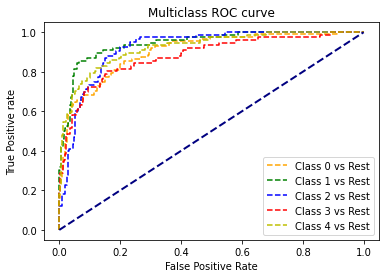

In [26]:
#
from sklearn.datasets import make_classification
from sklearn.multiclass import OneVsRestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

# generate 2 class dataset
X, y = make_classification(n_samples=1000, n_classes=5, n_features=20, n_informative=5, random_state=42)

# split into train/test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42)

# fit model
clf = OneVsRestClassifier(XGBClassifier())
clf.fit(X_train, y_train)
pred = clf.predict(X_test)
pred_prob = clf.predict_proba(X_test)

# roc curve for classes
fpr = {}
tpr = {}
thresh ={}

n_class = 5

for i in range(n_class):    
    fpr[i], tpr[i], thresh[i] = roc_curve(y_test, pred_prob[:,i], pos_label=i)
    
# plotting    
plt.plot(fpr[0], tpr[0], linestyle='--',color='orange', label='Class 0 vs Rest')
plt.plot(fpr[1], tpr[1], linestyle='--',color='green', label='Class 1 vs Rest')
plt.plot(fpr[2], tpr[2], linestyle='--',color='blue', label='Class 2 vs Rest')
plt.plot(fpr[3], tpr[3], linestyle='--',color='r', label='Class 3 vs Rest')
plt.plot(fpr[4], tpr[4], linestyle='--',color='y', label='Class 4 vs Rest')

plt.plot([0,1], [0,1], color = 'navy', lw=2, linestyle='--')
plt.title('Multiclass ROC curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive rate')
plt.legend(loc='best')
plt.savefig('Multiclass ROC',dpi=300);    

## reference
- https://www.kaggle.com/nholloway/catboost-v-xgboost-v-lightgbm
- https://adioshun.gitbooks.io/deep_learning/content/Auto-ML/Intro.html
- https://github.com/hyeonsangjeon/Hyperparameters-Optimization
- https://ichi.pro/ko/gigye-hagseub-eul-wihan-beijian-haipeo-palamiteo-choejeoghwaui-gaenyeomjeog-seolmyeong-202409502049551

- https://www.kaggle.com/nholloway/comparing-resampling-techniques-and-xgboost
- https://www.analyticsvidhya.com/blog/2020/06/auc-roc-curve-machine-learning/
- https://koreapy.tistory.com/752